
* YOLOv8 is the newest state-of-the-art YOLO model that can be used for object detection, image classification, and instance segmentation tasks.YOLOv8 includes numerous architectural and developer experience changes and improvements over YOLOv5.<br>

* YOLOv8 has a high rate of accuracy measured by COCO and Roboflow 100. YOLOv8 comes with a lot of developer-convenience features, from an easy-to-use CLI to a well-structured Python package.

In [ ]:
## Install ultralytics
!pip install ultralytics

In [ ]:
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.215 🚀 Python-3.10.12 torch-2.1.0+cu118 CPU (Intel Xeon 2.20GHz)
Setup complete ✅ (8 CPUs, 51.0 GB RAM, 26.9/225.8 GB disk)


In [ ]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
import random
import os
import cv2
import shutil
import tqdm
import glob

In [ ]:
# Check GPU is working or not
import torch
# print(f"Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/295B_Project/archive_fashion.zip

In [ ]:
images_path = '/content/colorful_fashion_dataset_for_object_detection/JPEGImages/'
annotations_path  = '/content/colorful_fashion_dataset_for_object_detection/Annotations_txt/'
path = '/content/colorful_fashion_dataset_for_object_detection/'

# Try YOLOv8

In [ ]:
from ultralytics import YOLO

# load pre-trained model
detection_model = YOLO("yolov8m.pt")

100%|██████████| 49.7M/49.7M [00:00<00:00, 192MB/s]


100%|██████████| 151k/151k [00:00<00:00, 4.43MB/s]


image 1/1 /content/GRdCC.jpg: 448x640 1 person, 1 bicycle, 5 cars, 1 truck, 649.6ms
Speed: 20.8ms preprocess, 649.6ms inference, 40.5ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict


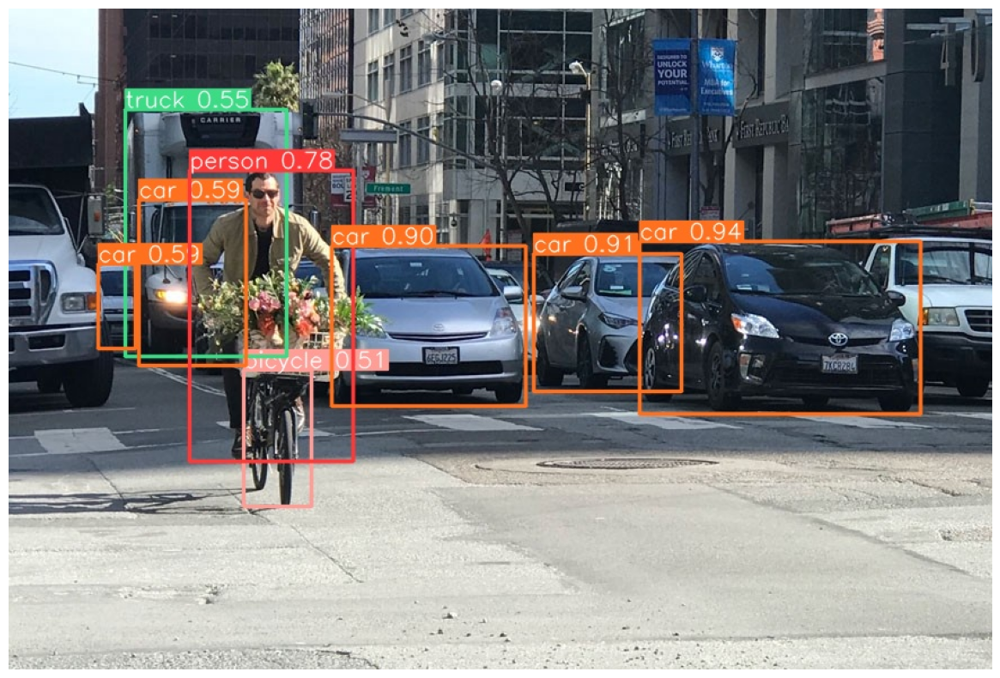

In [ ]:
# choose random image
img = random.choice(os.listdir(images_path))

i=detection_model.predict(source='https://i.stack.imgur.com/GRdCC.jpg', conf=0.5, save=True, line_width=2, show_labels=True)

im = plt.imread('/content/runs/detect/predict/GRdCC.jpg')
plt.figure(figsize=(20,10))
plt.axis('off')
plt.imshow(im)

# Plot Training Data with Annotations

In [ ]:
def convert(size,x,y,w,h):
    box = np.zeros(4)
    dw = 1./size[0]
    dh = 1./size[1]
    x = x/dw
    w = w/dw
    y = y/dh
    h = h/dh
    box[0] = x-(w/2.0)
    box[1] = x+(w/2.0)
    box[2] = y-(h/2.0)
    box[3] = y+(h/2.0)

    return (box)

def plot_annotations(img, filename):
    with open(annotations_path+filename, 'r') as f:
        for line in f:
            value = line.split()
            cls = int(value[0])
            x = float(value[1])
            y = float(value[2])
            w = float(value[3])
            h = float(value[4])

            img_h, img_w = img.shape[:2]
            bb = convert((img_w, img_h), x,y,w,h)
            cv2.rectangle(img, (int(round(bb[0])),int(round(bb[2]))),(int(round(bb[1])),int(round(bb[3]))),(255,0,0),2)
            plt.axis('off')
            plt.imshow(img)

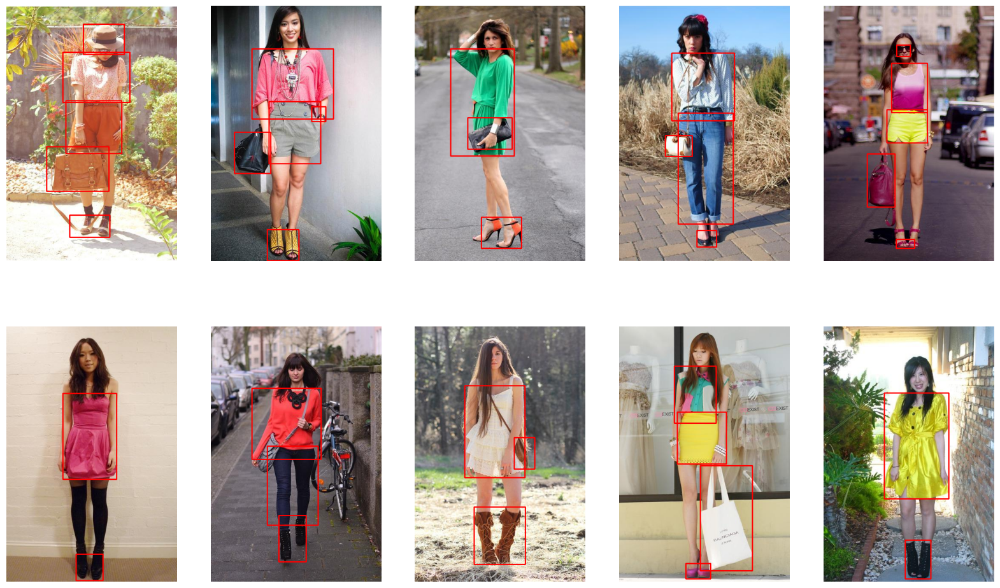

In [ ]:
import os
import random
import matplotlib.pyplot as plt
import cv2
import numpy as np

plt.figure(figsize=(20,12))
ls = os.listdir(images_path)
c = 1
for i in random.sample(ls, 10):
    img = plt.imread(images_path+i)
    i = i.rstrip('.jpg') + '.txt'
    plt.subplot(2,5, c)
    plot_annotations(img, i)
    c+=1

# Prepare Dataset

In [ ]:
train = []
with open(path+'ImageSets/Main/trainval.txt', 'r') as f:
    for line in f.readlines():
        if line[-1]=='\n':
            line = line[:-1]
        train.append(line)

test = []
with open(path+'ImageSets/Main/test.txt', 'r') as f:
    for line in f.readlines():
        if line[-1]=='\n':
            line = line[:-1]
        test.append(line)

In [ ]:
len(train), len(test)

(2145, 537)

In [ ]:
os.mkdir('train')
os.mkdir('train/images')
os.mkdir('train/labels')

os.mkdir('test')
os.mkdir('test/images')
os.mkdir('test/labels')

In [ ]:
train_path = '/content/train/'
test_path = '/content/test/'

print('Copying Train Data..!!')
for i in tqdm.tqdm(train):
    a = shutil.copyfile(images_path+i+'.jpg', train_path+'images/'+i+'.jpg')
    a = shutil.copyfile(annotations_path+i+'.txt', train_path+'labels/'+i+'.txt')

print('Copying Test Data..!!')
for i in tqdm.tqdm(test):
    a = shutil.copyfile(images_path+i+'.jpg', test_path+'images/'+i+'.jpg')
    a = shutil.copyfile(annotations_path+i+'.txt', test_path+'labels/'+i+'.txt')

Copying Train Data..!!


100%|██████████| 2145/2145 [00:00<00:00, 4591.97it/s]


Copying Test Data..!!


100%|██████████| 537/537 [00:00<00:00, 4592.97it/s]


# Train Custom Model

In [ ]:
text = """
train: /content/train
val: /content/test

# number of classes
nc: 10

# class names
names: ['sunglass','hat','jacket','shirt','pants','shorts','skirt','dress','bag','shoe']
"""
with open("data.yaml", 'w') as file:
    file.write(text)

In [ ]:
model = YOLO("yolov8m.pt")
model.train(data='data.yaml', epochs=5, batch=8, imgsz=256)

In [ ]:
%matplotlib inline
model_path = '/content/runs/detect/train/'

def plot(ls, size):
    c=1
    plt.figure(figsize=(15,10))
    for im in ls:
        plt.subplot(size[0],size[1],c)
        im = plt.imread(model_path+im)
        plt.imshow(im)
        c+=1
    plt.show()

plot(['P_curve.png','R_curve.png'], (1,2))
plot(['F1_curve.png','PR_curve.png'], (1,2))
plot(['confusion_matrix.png','labels.jpg'], (1,2))
plot(['results.png'],(1,1))

# Test Model

In [ ]:
# Saving all outfits with labels

def process_and_save(images, folder_name):
    for img_name in tqdm.tqdm(images):
        img_path = os.path.join(images_path, img_name)

        # Predict using the model
        results_list = model.predict(source=img_path, conf=0.4, save=False)

        # Retrieve the results object from the list
        results = results_list[0]

        # Load the original image
        image = cv2.imread(img_path)

        # Extract bounding boxes, labels, and confidences
        detected_boxes = results.boxes.xyxy  # Bounding boxes in xyxy format
        labels = results.boxes.cls           # Class labels
        confidences = results.boxes.conf     # Confidence scores

        # Process each detected object
        for i, (x1, y1, x2, y2) in enumerate(detected_boxes):
            label = labels[i]
            confidence = confidences[i]

            # Check the confidence (optional)
            if confidence > 0.4:
                # Draw bounding box and label on the image
                cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
                cv2.putText(image, results.names[int(label)], (int(x1), int(y1)-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

        # Save the labeled outfit image
        labeled_outfit_path = os.path.join('labeled_outfits_nov20', img_name)
        cv2.imwrite(labeled_outfit_path, image)

# Ensure the directory exists
if not os.path.exists('labeled_outfits_nov20'):
    os.mkdir('labeled_outfits_nov20')

# Process and save images
process_and_save(os.listdir(images_path), 'labeled_outfits_nov20')


In [ ]:
# save the ziiped folder to gdrive
shutil.copy('/content/labeled_outfits_nov20.zip', '/content/drive/MyDrive/295B_Project/labeled_outfits_nov20/')

'/content/drive/MyDrive/295B_Project/labeled_outfits_nov20/labeled_outfits_nov20.zip'

In [ ]:
# saving all the crooped product images

import pandas as pd
import tqdm
import os
import cv2

def process_and_save(images, folder_name):
    data = []  # List to store all data

    for img_name in tqdm.tqdm(images):
        img_path = os.path.join(images_path, img_name)

        # Predict using the model
        results_list = model.predict(source=img_path, conf=0.4, save=False)

        # Retrieve the results object from the list
        results = results_list[0]

        # Load the original image
        image = cv2.imread(img_path)

        # Extract bounding boxes, labels, and confidences
        detected_boxes = results.boxes.xyxy  # Bounding boxes in xyxy format
        labels = results.boxes.cls           # Class labels
        confidences = results.boxes.conf     # Confidence scores

        # Process each detected object
        for i, box in enumerate(detected_boxes):
            label = labels[i]
            confidence = confidences[i]

            # Convert tensor to Python list and get label name
            box_list = box.cpu().numpy().tolist()
            label_name = results.names[int(label.item())]

            # Check the confidence (optional)
            if confidence > 0.4:
                # Crop and save individual product images
                cropped = image[int(box[1]):int(box[3]), int(box[0]):int(box[2])]
                save_name = os.path.join(folder_name, f"{img_name.split('.')[0]}_{label_name}.jpg")
                cv2.imwrite(save_name, cropped)

            # Append each bbox and label with the corresponding image name
            data.append([img_name, box_list, label_name])

    return data

# Ensure the directory exists
if not os.path.exists('product_images_nov20'):
    os.mkdir('product_images_nov20')

# Process and save images
data = process_and_save(os.listdir(images_path), 'product_images_nov20')

# Create a DataFrame from the collected data
df = pd.DataFrame(data, columns=['outfit_name', 'bbox_coord', 'category'])

df_unique = df.groupby(['outfit_name', 'category'], as_index=False).first()


In [ ]:
df_unique['product_name'] = df_unique['outfit_name'].str.split(".").str[0] + "_" + df_unique['category'] + '.jpeg'
df_unique.to_csv('df_unique.csv', index=False)
df_unique.head(20)

,outfit_name,category,bbox_coord,product_name
0,1.jpg,bag,"[210.88270568847656, 348.4036865234375, 334.69...",1_bag.jpeg
1,1.jpg,dress,"[180.33978271484375, 127.32009887695312, 344.7...",1_dress.jpeg
2,1.jpg,shirt,"[210.30535888671875, 129.15899658203125, 341.2...",1_shirt.jpeg
3,1.jpg,shoe,"[214.40048217773438, 540.9287109375, 275.24185...",1_shoe.jpeg
4,1.jpg,skirt,"[211.03555297851562, 348.2973937988281, 333.87...",1_skirt.jpeg
5,100034.jpg,bag,"[255.93215942382812, 255.022216796875, 309.071...",100034_bag.jpeg
6,100034.jpg,shirt,"[159.09429931640625, 102.70097351074219, 296.2...",100034_shirt.jpeg
7,100034.jpg,shoe,"[150.48941040039062, 459.9925537109375, 303.44...",100034_shoe.jpeg
8,100034.jpg,skirt,"[124.8479232788086, 194.03997802734375, 298.40...",100034_skirt.jpeg
9,100073.jpg,hat,"[113.15866088867188, 18.121253967285156, 206.9...",100073_hat.jpeg


In [ ]:
# zip and save all the cropped product images on drive
!zip -r product_images_nov20.zip /content/product_images_nov20/
shutil.copy('/content/product_images_nov20.zip', '/content/drive/MyDrive/295B_Project/product_images_nov20/')

# Pinterest

I have a csv file with list of urls. Each url contains an image. I want to write a code to download first 1000 images from that file.

In [ ]:
csv_file = '/content/drive/MyDrive/295B_Project/Pinterest_Images/merged_df_3000.csv'
df = pd.read_csv(csv_file)
df.head(20)

In [ ]:
unique_scenes = df['scene_url'].unique()
unique_scenes

array(['http://i.pinimg.com/400x/00/11/53/0011533c9d961a058836f525bad92c76.jpg', 'http://i.pinimg.com/400x/00/15/c5/0015c5335c7f0855a3eb5bcb2e1faa7d.jpg', 'http://i.pinimg.com/400x/00/31/69/0031699b2e83e2c35688fe298e10f9d1.jpg', ..., 'http://i.pinimg.com/400x/ff/8e/d8/ff8ed8488ca5dae69f390dfb8c5126f9.jpg',
       'http://i.pinimg.com/400x/ff/d3/a1/ffd3a1479b9953b23a99650e44e5f46a.jpg', 'http://i.pinimg.com/400x/ff/e4/a2/ffe4a2c4b0a92ced11286d7f1d970e7c.jpg'], dtype=object)

In [ ]:
import pandas as pd
import requests
import os

# Ensure there's a directory to save the images
if not os.path.exists('pinterest_images_nov20_1k'):
    os.mkdir('pinterest_images_nov20_1k')

# Loop through the URLs and download each image
for idx, img_url in enumerate(unique_scenes):  # Replace 'url_column_name' with the name of the column containing the URLs
    response = requests.get(img_url)

    # Check if the request was successful
    if response.status_code == 200:
        with open(f'pinterest_images_nov20_1k/img_{idx}.jpg', 'wb') as f:
            f.write(response.content)
    else:
        print(f"Failed to download {img_url}")

print("Download complete.")

Failed to download http://i.pinimg.com/400x/09/e3/63/09e363c112056e3a6e57993063e9c5d8.jpg
Download complete.


In [ ]:
len(os.listdir('pinterest_images_nov20_1k'))

2999

In [ ]:
!rm -r combined_images
# Ensure the directory exists or create one
if not os.path.exists('/content/combined_images'):
    os.mkdir('/content/combined_images')
# set the images path to the combined images path
images_path = '/content/combined_images'

In [ ]:

!cp /content/colorful_fashion_dataset_for_object_detection/JPEGImages/*.jpg /content/combined_images/


In [ ]:
!cp /content/pinterest_images_nov20_1k/*.jpg /content/combined_images/

In [ ]:
images_path = '/content/combined_images'

In [ ]:
# Saving all outfits with labels

def process_and_save(images, folder_name):
    for img_name in tqdm.tqdm(images):
        img_path = os.path.join(images_path, img_name)

        # Predict using the model
        results_list = model.predict(source=img_path, conf=0.4, save=False)

        # Retrieve the results object from the list
        results = results_list[0]

        # Load the original image
        image = cv2.imread(img_path)

        # Extract bounding boxes, labels, and confidences
        detected_boxes = results.boxes.xyxy  # Bounding boxes in xyxy format
        labels = results.boxes.cls           # Class labels
        confidences = results.boxes.conf     # Confidence scores

        # Process each detected object
        for i, (x1, y1, x2, y2) in enumerate(detected_boxes):
            label = labels[i]
            confidence = confidences[i]

            # Check the confidence (optional)
            if confidence > 0.4:
                # Draw bounding box and label on the image
                cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
                cv2.putText(image, results.names[int(label)], (int(x1), int(y1)-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

        # Save the labeled outfit image
        labeled_outfit_path = os.path.join('labeled_outfits_combo', img_name)
        cv2.imwrite(labeled_outfit_path, image)

# Ensure the directory exists
if not os.path.exists('labeled_outfits_combo'):
    os.mkdir('labeled_outfits_combo')

# Process and save images
process_and_save(os.listdir(images_path), 'labeled_outfits_combo')


0it [00:00, ?it/s]


In [ ]:
# Saving all outfits with labels

def process_and_save(images, folder_name):
    for img_name in tqdm.tqdm(images):
        img_path = os.path.join(images_path, img_name)

        # Predict using the model
        results_list = model.predict(source=img_path, conf=0.4, save=False)

        # Retrieve the results object from the list
        results = results_list[0]

        # Load the original image
        image = cv2.imread(img_path)

        # Extract bounding boxes, labels, and confidences
        detected_boxes = results.boxes.xyxy  # Bounding boxes in xyxy format
        labels = results.boxes.cls           # Class labels
        confidences = results.boxes.conf     # Confidence scores

        # Process each detected object
        for i, (x1, y1, x2, y2) in enumerate(detected_boxes):
            label = labels[i]
            confidence = confidences[i]

            # Check the confidence (optional)
            if confidence > 0.4:
                # Draw bounding box and label on the image
                cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
                cv2.putText(image, results.names[int(label)], (int(x1), int(y1)-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

        # Save the labeled outfit image
        labeled_outfit_path = os.path.join('labeled_outfits_combo', img_name)
        cv2.imwrite(labeled_outfit_path, image)

# Ensure the directory exists
if not os.path.exists('labeled_outfits_combo'):
    os.mkdir('labeled_outfits_combo')

# Process and save images
process_and_save(os.listdir(images_path), 'labeled_outfits_combo')


0it [00:00, ?it/s]


In [ ]:
import pandas as pd
import requests
import os

# Read the CSV
csv_file = '/content/drive/MyDrive/295B_Project/Pinterest_Images/merged_df_3000.csv'
df = pd.read_csv(csv_file)

# Ensure there's a directory to save the images
if not os.path.exists('pinterest_images_nov20'):
    os.mkdir('pinterest_images_nov20')

# Loop through the URLs and download each image
for idx, img_url in enumerate(df['scene_url']):  # Replace 'url_column_name' with the name of the column containing the URLs
    response = requests.get(img_url)

    # Check if the request was successful
    if response.status_code == 200:
        with open(f'pinterest_images_nov20/img_{idx}.jpg', 'wb') as f:
            f.write(response.content)
    else:
        print(f"Failed to download {img_url}")

print("Download complete.")


Failed to download http://i.pinimg.com/400x/09/e3/63/09e363c112056e3a6e57993063e9c5d8.jpg
Failed to download http://i.pinimg.com/400x/09/e3/63/09e363c112056e3a6e57993063e9c5d8.jpg
Failed to download http://i.pinimg.com/400x/09/e3/63/09e363c112056e3a6e57993063e9c5d8.jpg
Failed to download http://i.pinimg.com/400x/09/e3/63/09e363c112056e3a6e57993063e9c5d8.jpg
Failed to download http://i.pinimg.com/400x/09/e3/63/09e363c112056e3a6e57993063e9c5d8.jpg
Failed to download http://i.pinimg.com/400x/09/e3/63/09e363c112056e3a6e57993063e9c5d8.jpg
Download complete.


In [ ]:
!zip -r /content/pinterest_images_nov20.zip /content/pinterest_images_nov20/
shutil.copy('/content/pinterest_images_nov20.zip', '/content/drive/MyDrive/295B_Project/pinterest_images_nov20')

In [ ]:
images_path = "/content/pinterest_images_nov20_1k/"

In [ ]:
# Saving all outfits with labels

def process_and_save(images, folder_name):
    for img_name in tqdm.tqdm(images):
        img_path = os.path.join(images_path, img_name)

        # Predict using the model
        results_list = model.predict(source=img_path, conf=0.4, save=False)

        # Retrieve the results object from the list
        results = results_list[0]

        # Load the original image
        image = cv2.imread(img_path)

        # Extract bounding boxes, labels, and confidences
        detected_boxes = results.boxes.xyxy  # Bounding boxes in xyxy format
        labels = results.boxes.cls           # Class labels
        confidences = results.boxes.conf     # Confidence scores

        # Process each detected object
        for i, (x1, y1, x2, y2) in enumerate(detected_boxes):
            label = labels[i]
            confidence = confidences[i]

            # Check the confidence (optional)
            if confidence > 0.4:
                # Draw bounding box and label on the image
                cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
                cv2.putText(image, results.names[int(label)], (int(x1), int(y1)-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

        # Save the labeled outfit image
        labeled_outfit_path = os.path.join('labeled_pinterest_outfits_nov20', img_name)
        cv2.imwrite(labeled_outfit_path, image)

# Ensure the directory exists
if not os.path.exists('labeled_pinterest_outfits_nov20'):
    os.mkdir('labeled_pinterest_outfits_nov20')

# Process and save images
process_and_save(os.listdir(images_path), 'labeled_pinterest_outfits_nov20')


  0%|          | 0/12339 [00:00<?, ?it/s]


image 1/1 /content/pinterest_images_nov20/img_1920.jpg: 192x256 1 dress, 1 shoe, 150.8ms
Speed: 1.2ms preprocess, 150.8ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


  0%|          | 1/12339 [00:00<37:38,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6389.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 140.5ms
Speed: 1.2ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 2/12339 [00:00<35:43,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3722.jpg: 256x192 1 jacket, 1 shoe, 105.5ms
Speed: 1.1ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 3/12339 [00:00<32:02,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7223.jpg: 256x224 1 dress, 1 shoe, 126.6ms
Speed: 1.0ms preprocess, 126.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 4/12339 [00:00<31:52,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_11204.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 98.0ms
Speed: 1.0ms preprocess, 98.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 5/12339 [00:00<29:44,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8016.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 105.1ms
Speed: 1.1ms preprocess, 105.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 6/12339 [00:00<29:00,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3193.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 100.7ms
Speed: 1.0ms preprocess, 100.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 7/12339 [00:01<28:03,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1879.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 80.6ms
Speed: 0.9ms preprocess, 80.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 8/12339 [00:01<26:16,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7136.jpg: 256x224 1 hat, 1 bag, 99.1ms
Speed: 1.0ms preprocess, 99.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 9/12339 [00:01<25:59,  7.91it/s]


image 1/1 /content/pinterest_images_nov20/img_930.jpg: 256x192 1 pants, 86.1ms
Speed: 0.9ms preprocess, 86.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 10/12339 [00:01<25:13,  8.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2245.jpg: 192x256 1 hat, 1 shorts, 107.2ms
Speed: 0.8ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  0%|          | 11/12339 [00:01<25:30,  8.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7704.jpg: 256x192 1 hat, 1 shirt, 1 pants, 93.4ms
Speed: 1.0ms preprocess, 93.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 12/12339 [00:01<25:11,  8.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9362.jpg: 256x160 1 pants, 90.4ms
Speed: 0.9ms preprocess, 90.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  0%|          | 13/12339 [00:01<24:54,  8.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2538.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 100.4ms
Speed: 0.9ms preprocess, 100.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 14/12339 [00:01<25:27,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8199.jpg: 256x256 1 shirt, 1 pants, 99.5ms
Speed: 1.1ms preprocess, 99.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 15/12339 [00:01<25:25,  8.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1954.jpg: 256x192 1 dress, 107.3ms
Speed: 0.9ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 16/12339 [00:02<26:06,  7.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4116.jpg: 256x256 1 hat, 1 jacket, 1 skirt, 1 dress, 1 shoe, 106.5ms
Speed: 2.2ms preprocess, 106.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 17/12339 [00:02<26:32,  7.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10540.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 91.0ms
Speed: 0.9ms preprocess, 91.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 18/12339 [00:02<25:50,  7.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10240.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 94.6ms
Speed: 1.3ms preprocess, 94.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 19/12339 [00:02<25:42,  7.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9666.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 100.2ms
Speed: 0.9ms preprocess, 100.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 20/12339 [00:02<25:25,  8.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5891.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 83.6ms
Speed: 0.8ms preprocess, 83.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 21/12339 [00:02<24:48,  8.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7114.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 89.4ms
Speed: 0.8ms preprocess, 89.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


  0%|          | 22/12339 [00:02<24:16,  8.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3322.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 84.3ms
Speed: 0.9ms preprocess, 84.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 23/12339 [00:02<23:55,  8.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5174.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 113.8ms
Speed: 0.9ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 24/12339 [00:03<25:16,  8.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5162.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 78.9ms
Speed: 0.9ms preprocess, 78.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 25/12339 [00:03<24:14,  8.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4444.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 93.2ms
Speed: 0.8ms preprocess, 93.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 26/12339 [00:03<24:34,  8.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9775.jpg: 256x192 1 shorts, 97.0ms
Speed: 0.9ms preprocess, 97.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 27/12339 [00:03<24:38,  8.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8036.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 85.9ms
Speed: 0.9ms preprocess, 85.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 28/12339 [00:03<24:08,  8.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11534.jpg: 256x192 1 dress, 1 bag, 1 shoe, 82.0ms
Speed: 1.6ms preprocess, 82.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 29/12339 [00:03<23:32,  8.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10753.jpg: 128x256 3 shoes, 86.9ms
Speed: 0.7ms preprocess, 86.9ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


  0%|          | 30/12339 [00:03<22:55,  8.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3194.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 108.7ms
Speed: 1.0ms preprocess, 108.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 31/12339 [00:03<24:18,  8.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11362.jpg: 256x192 1 skirt, 93.6ms
Speed: 1.0ms preprocess, 93.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 32/12339 [00:04<24:29,  8.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8344.jpg: 256x224 1 skirt, 1 shoe, 89.5ms
Speed: 0.9ms preprocess, 89.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 33/12339 [00:04<24:00,  8.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6367.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 shoe, 99.8ms
Speed: 0.9ms preprocess, 99.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 34/12339 [00:04<24:35,  8.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6669.jpg: 256x192 1 shirt, 1 shoe, 89.2ms
Speed: 1.0ms preprocess, 89.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 35/12339 [00:04<24:32,  8.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4480.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 84.7ms
Speed: 0.9ms preprocess, 84.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 36/12339 [00:04<23:55,  8.57it/s]


image 1/1 /content/pinterest_images_nov20/img_6618.jpg: 256x192 1 jacket, 1 shoe, 97.0ms
Speed: 3.9ms preprocess, 97.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 37/12339 [00:04<24:16,  8.45it/s]


image 1/1 /content/pinterest_images_nov20/img_982.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


  0%|          | 38/12339 [00:04<25:21,  8.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10646.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 107.5ms
Speed: 0.9ms preprocess, 107.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 39/12339 [00:04<25:50,  7.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6515.jpg: 256x192 1 skirt, 1 bag, 85.2ms
Speed: 0.9ms preprocess, 85.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 40/12339 [00:04<24:53,  8.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11556.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 78.5ms
Speed: 1.4ms preprocess, 78.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 41/12339 [00:05<24:01,  8.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8731.jpg: 192x256 (no detections), 83.4ms
Speed: 0.8ms preprocess, 83.4ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


  0%|          | 42/12339 [00:05<23:04,  8.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11216.jpg: 256x192 1 bag, 102.2ms
Speed: 0.8ms preprocess, 102.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 43/12339 [00:05<23:54,  8.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2467.jpg: 256x256 3 shirts, 3 pantss, 98.2ms
Speed: 0.9ms preprocess, 98.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 44/12339 [00:05<24:37,  8.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2427.jpg: 256x192 (no detections), 91.9ms
Speed: 3.4ms preprocess, 91.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 45/12339 [00:05<24:26,  8.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4467.jpg: 256x256 1 jacket, 1 skirt, 1 bag, 1 shoe, 107.0ms
Speed: 0.9ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 46/12339 [00:05<25:13,  8.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10707.jpg: 224x256 3 dresss, 93.6ms
Speed: 0.8ms preprocess, 93.6ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


  0%|          | 47/12339 [00:05<24:43,  8.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8052.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 100.5ms
Speed: 0.9ms preprocess, 100.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 48/12339 [00:05<24:52,  8.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2849.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 80.3ms
Speed: 0.8ms preprocess, 80.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 49/12339 [00:06<24:02,  8.52it/s]


image 1/1 /content/pinterest_images_nov20/img_646.jpg: 256x224 1 shirt, 101.1ms
Speed: 0.9ms preprocess, 101.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 50/12339 [00:06<24:24,  8.39it/s]


image 1/1 /content/pinterest_images_nov20/img_5073.jpg: 256x224 2 hats, 1 jacket, 1 pants, 1 bag, 1 shoe, 85.6ms
Speed: 0.9ms preprocess, 85.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 51/12339 [00:06<24:03,  8.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6372.jpg: 256x192 1 pants, 1 bag, 3 shoes, 93.1ms
Speed: 0.9ms preprocess, 93.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 52/12339 [00:06<24:13,  8.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10730.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 96.0ms
Speed: 0.9ms preprocess, 96.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 53/12339 [00:06<24:19,  8.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10751.jpg: 128x256 3 shoes, 62.8ms
Speed: 0.6ms preprocess, 62.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_10461.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 98.6ms
Speed: 1.1ms preprocess, 98.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 55/12339 [00:06<22:41,  9.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6403.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 108.5ms
Speed: 3.5ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 56/12339 [00:06<24:02,  8.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6835.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 93.3ms
Speed: 1.0ms preprocess, 93.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 57/12339 [00:06<24:12,  8.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11554.jpg: 256x256 1 shirt, 2 skirts, 129.8ms
Speed: 1.0ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 58/12339 [00:07<26:11,  7.81it/s]


image 1/1 /content/pinterest_images_nov20/img_975.jpg: 256x224 1 shirt, 1 bag, 108.3ms
Speed: 1.0ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 59/12339 [00:07<26:39,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6293.jpg: 256x256 (no detections), 107.8ms
Speed: 0.9ms preprocess, 107.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 60/12339 [00:07<26:31,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2555.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 89.9ms
Speed: 1.0ms preprocess, 89.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 61/12339 [00:07<25:45,  7.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2437.jpg: 256x192 (no detections), 84.4ms
Speed: 0.9ms preprocess, 84.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 62/12339 [00:07<24:52,  8.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1691.jpg: 256x256 1 hat, 1 dress, 157.3ms
Speed: 1.9ms preprocess, 157.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 63/12339 [00:07<28:37,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_704.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 144.5ms
Speed: 1.0ms preprocess, 144.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 64/12339 [00:07<30:33,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8292.jpg: 224x256 2 shoes, 144.6ms
Speed: 0.8ms preprocess, 144.6ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


  1%|          | 65/12339 [00:08<31:35,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7889.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 158.0ms
Speed: 0.9ms preprocess, 158.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 66/12339 [00:08<33:21,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6215.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 114.6ms
Speed: 1.0ms preprocess, 114.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


  1%|          | 67/12339 [00:08<31:55,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4518.jpg: 256x192 1 pants, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 68/12339 [00:08<32:07,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_573.jpg: 256x192 1 jacket, 2 pantss, 127.3ms
Speed: 2.8ms preprocess, 127.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 69/12339 [00:08<32:18,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_2415.jpg: 256x192 (no detections), 129.9ms
Speed: 1.7ms preprocess, 129.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 70/12339 [00:08<32:13,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4412.jpg: 256x224 1 dress, 1 bag, 1 shoe, 141.2ms
Speed: 1.0ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 71/12339 [00:09<32:55,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5192.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 121.0ms
Speed: 1.3ms preprocess, 121.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 72/12339 [00:09<31:55,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_6638.jpg: 256x224 1 skirt, 1 shoe, 138.7ms
Speed: 1.0ms preprocess, 138.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 73/12339 [00:09<32:32,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9215.jpg: 256x160 1 shirt, 1 skirt, 107.6ms
Speed: 0.8ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  1%|          | 74/12339 [00:09<31:04,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3514.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 137.2ms
Speed: 1.4ms preprocess, 137.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 75/12339 [00:09<31:59,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11881.jpg: 256x192 1 dress, 1 shoe, 132.5ms
Speed: 1.8ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 76/12339 [00:09<32:21,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2768.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 125.0ms
Speed: 3.6ms preprocess, 125.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 77/12339 [00:10<32:21,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3731.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 119.8ms
Speed: 0.8ms preprocess, 119.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 78/12339 [00:10<32:17,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3350.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 79/12339 [00:10<32:10,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11007.jpg: 256x256 1 jacket, 1 pants, 1 skirt, 137.6ms
Speed: 1.3ms preprocess, 137.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 80/12339 [00:10<32:33,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9993.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 141.6ms
Speed: 0.9ms preprocess, 141.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 81/12339 [00:10<33:10,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8297.jpg: 256x224 1 dress, 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 82/12339 [00:10<33:45,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4998.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 124.1ms
Speed: 0.8ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 83/12339 [00:11<32:52,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3551.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 120.7ms
Speed: 0.8ms preprocess, 120.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


  1%|          | 84/12339 [00:11<31:52,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3150.jpg: 256x224 1 pants, 1 dress, 1 shoe, 148.3ms
Speed: 1.0ms preprocess, 148.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 85/12339 [00:11<32:56,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8990.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 161.7ms
Speed: 0.9ms preprocess, 161.7ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 86/12339 [00:11<34:30,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_8818.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 126.5ms
Speed: 0.8ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 87/12339 [00:11<33:53,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8135.jpg: 256x224 1 jacket, 1 dress, 1 bag, 122.0ms
Speed: 1.0ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 88/12339 [00:11<32:46,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_469.jpg: 256x224 (no detections), 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 89/12339 [00:12<32:46,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11121.jpg: 256x192 2 shirts, 130.1ms
Speed: 4.4ms preprocess, 130.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 90/12339 [00:12<32:59,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9585.jpg: 256x224 1 shirt, 1 pants, 144.9ms
Speed: 1.0ms preprocess, 144.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 91/12339 [00:12<33:48,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_614.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 160.0ms
Speed: 2.2ms preprocess, 160.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 92/12339 [00:12<35:23,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7457.jpg: 256x256 1 dress, 97.7ms
Speed: 1.0ms preprocess, 97.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 93/12339 [00:12<32:21,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8438.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 skirt, 1 shoe, 98.8ms
Speed: 1.0ms preprocess, 98.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 94/12339 [00:12<30:18,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_11212.jpg: 256x192 1 bag, 91.5ms
Speed: 0.9ms preprocess, 91.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 95/12339 [00:12<28:14,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10849.jpg: 256x192 1 pants, 1 shoe, 81.2ms
Speed: 0.8ms preprocess, 81.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 96/12339 [00:13<26:28,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3745.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 95.1ms
Speed: 0.9ms preprocess, 95.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 97/12339 [00:13<25:47,  7.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4063.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 101.7ms
Speed: 1.1ms preprocess, 101.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 98/12339 [00:13<26:06,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4086.jpg: 256x192 1 pants, 1 dress, 106.8ms
Speed: 3.5ms preprocess, 106.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 99/12339 [00:13<26:27,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6311.jpg: 256x256 (no detections), 116.5ms
Speed: 4.5ms preprocess, 116.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 100/12339 [00:13<27:12,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1746.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 107.6ms
Speed: 1.0ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 101/12339 [00:13<27:33,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8118.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 88.7ms
Speed: 0.9ms preprocess, 88.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 102/12339 [00:13<26:21,  7.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4436.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 85.3ms
Speed: 0.8ms preprocess, 85.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 103/12339 [00:13<25:19,  8.05it/s]


image 1/1 /content/pinterest_images_nov20/img_127.jpg: 192x256 1 bag, 80.7ms
Speed: 1.0ms preprocess, 80.7ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)

image 1/1 /content/pinterest_images_nov20/img_6384.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 108.7ms
Speed: 0.9ms preprocess, 108.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 105/12339 [00:14<24:23,  8.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2091.jpg: 256x224 1 dress, 2 bags, 1 shoe, 93.5ms
Speed: 1.0ms preprocess, 93.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 106/12339 [00:14<24:32,  8.31it/s]


image 1/1 /content/pinterest_images_nov20/img_4302.jpg: 256x192 (no detections), 94.3ms
Speed: 0.8ms preprocess, 94.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 107/12339 [00:14<24:24,  8.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4419.jpg: 256x192 1 dress, 1 bag, 1 shoe, 92.6ms
Speed: 0.9ms preprocess, 92.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 108/12339 [00:14<24:25,  8.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3421.jpg: 256x192 1 skirt, 105.8ms
Speed: 0.9ms preprocess, 105.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 109/12339 [00:14<24:53,  8.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3550.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 67.7ms
Speed: 0.7ms preprocess, 67.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)

image 1/1 /content/pinterest_images_nov20/img_11773.jpg: 256x256 1 skirt, 106.3ms
Speed: 1.0ms preprocess, 106.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 111/12339 [00:14<23:44,  8.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2521.jpg: 256x192 1 bag, 1 shoe, 96.1ms
Speed: 1.0ms preprocess, 96.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 112/12339 [00:14<23:54,  8.52it/s]


image 1/1 /content/pinterest_images_nov20/img_2967.jpg: 256x192 (no detections), 88.1ms
Speed: 2.5ms preprocess, 88.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 113/12339 [00:15<23:46,  8.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2821.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 95.8ms
Speed: 0.8ms preprocess, 95.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 114/12339 [00:15<24:06,  8.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4790.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 99.1ms
Speed: 0.9ms preprocess, 99.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 115/12339 [00:15<24:42,  8.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2361.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 91.4ms
Speed: 0.9ms preprocess, 91.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 116/12339 [00:15<24:25,  8.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7869.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 117/12339 [00:15<26:13,  7.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3124.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 101.6ms
Speed: 0.9ms preprocess, 101.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 118/12339 [00:15<26:03,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8580.jpg: 256x256 1 hat, 2 jackets, 1 shirt, 1 pants, 1 shoe, 127.0ms
Speed: 1.1ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 119/12339 [00:15<27:31,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2942.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 89.8ms
Speed: 0.9ms preprocess, 89.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 120/12339 [00:15<26:16,  7.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6846.jpg: 256x256 2 skirts, 102.3ms
Speed: 0.9ms preprocess, 102.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 121/12339 [00:16<26:08,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4675.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 92.1ms
Speed: 0.9ms preprocess, 92.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 122/12339 [00:16<25:33,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2909.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 101.4ms
Speed: 0.9ms preprocess, 101.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 123/12339 [00:16<25:42,  7.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2868.jpg: 256x256 1 shirt, 1 pants, 104.5ms
Speed: 1.0ms preprocess, 104.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 124/12339 [00:16<25:40,  7.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8873.jpg: 256x224 1 shirt, 1 shorts, 109.8ms
Speed: 1.8ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 125/12339 [00:16<26:07,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_331.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 85.1ms
Speed: 0.9ms preprocess, 85.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 126/12339 [00:16<25:21,  8.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4254.jpg: 256x192 (no detections), 81.2ms
Speed: 0.8ms preprocess, 81.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 127/12339 [00:16<24:05,  8.45it/s]


image 1/1 /content/pinterest_images_nov20/img_1818.jpg: 256x192 1 pants, 1 shoe, 100.0ms
Speed: 0.9ms preprocess, 100.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 128/12339 [00:16<24:45,  8.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6072.jpg: 128x256 1 shoe, 73.4ms
Speed: 0.7ms preprocess, 73.4ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_9130.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 99.7ms
Speed: 0.9ms preprocess, 99.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 130/12339 [00:17<23:14,  8.76it/s]


image 1/1 /content/pinterest_images_nov20/img_12244.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 110.5ms
Speed: 1.0ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 131/12339 [00:17<24:30,  8.30it/s]


image 1/1 /content/pinterest_images_nov20/img_7089.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 80.5ms
Speed: 0.9ms preprocess, 80.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 132/12339 [00:17<23:56,  8.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2835.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 82.2ms
Speed: 0.9ms preprocess, 82.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 133/12339 [00:17<23:43,  8.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8562.jpg: 256x192 1 shirt, 1 skirt, 94.8ms
Speed: 0.9ms preprocess, 94.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 134/12339 [00:17<24:18,  8.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8867.jpg: 256x224 1 shoe, 97.0ms
Speed: 1.0ms preprocess, 97.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 135/12339 [00:17<24:37,  8.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1599.jpg: 256x192 (no detections), 95.9ms
Speed: 0.9ms preprocess, 95.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 136/12339 [00:17<24:36,  8.27it/s]


image 1/1 /content/pinterest_images_nov20/img_701.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 92.4ms
Speed: 0.9ms preprocess, 92.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 137/12339 [00:18<24:35,  8.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4740.jpg: 256x224 1 jacket, 90.4ms
Speed: 0.9ms preprocess, 90.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 138/12339 [00:18<24:32,  8.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7676.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 105.1ms
Speed: 0.9ms preprocess, 105.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 139/12339 [00:18<25:22,  8.02it/s]


image 1/1 /content/pinterest_images_nov20/img_173.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 118.0ms
Speed: 0.9ms preprocess, 118.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 140/12339 [00:18<26:44,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5534.jpg: 256x192 1 dress, 1 shoe, 108.7ms
Speed: 0.9ms preprocess, 108.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 141/12339 [00:18<27:02,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_5939.jpg: 256x192 1 shirt, 1 pants, 98.2ms
Speed: 0.9ms preprocess, 98.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 142/12339 [00:18<26:29,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_2973.jpg: 256x192 (no detections), 102.3ms
Speed: 3.3ms preprocess, 102.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 143/12339 [00:18<26:39,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11729.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 78.4ms
Speed: 1.6ms preprocess, 78.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 144/12339 [00:18<25:28,  7.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5892.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 81.9ms
Speed: 0.8ms preprocess, 81.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 145/12339 [00:19<24:48,  8.19it/s]


image 1/1 /content/pinterest_images_nov20/img_465.jpg: 256x224 1 shirt, 1 dress, 1 bag, 1 shoe, 109.6ms
Speed: 0.9ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 146/12339 [00:19<26:00,  7.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4472.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 101.7ms
Speed: 1.3ms preprocess, 101.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 147/12339 [00:19<26:16,  7.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7751.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 89.6ms
Speed: 1.2ms preprocess, 89.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 148/12339 [00:19<25:25,  7.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6421.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 101.6ms
Speed: 0.9ms preprocess, 101.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 149/12339 [00:19<25:22,  8.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3802.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 104.8ms
Speed: 0.9ms preprocess, 104.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 150/12339 [00:19<26:07,  7.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9128.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 99.4ms
Speed: 0.9ms preprocess, 99.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 151/12339 [00:19<25:51,  7.86it/s]


image 1/1 /content/pinterest_images_nov20/img_230.jpg: 160x256 1 jacket, 112.8ms
Speed: 0.8ms preprocess, 112.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 256)


  1%|          | 152/12339 [00:19<26:09,  7.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5714.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 82.0ms
Speed: 0.8ms preprocess, 82.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 153/12339 [00:20<24:51,  8.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8770.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 79.9ms
Speed: 0.8ms preprocess, 79.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 154/12339 [00:20<23:54,  8.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1320.jpg: 256x192 1 dress, 77.0ms
Speed: 0.8ms preprocess, 77.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 155/12339 [00:20<23:16,  8.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1391.jpg: 256x224 1 shirt, 1 dress, 1 bag, 98.5ms
Speed: 1.0ms preprocess, 98.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 156/12339 [00:20<24:08,  8.41it/s]


image 1/1 /content/pinterest_images_nov20/img_10743.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 2 shoes, 103.7ms
Speed: 0.9ms preprocess, 103.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|▏         | 157/12339 [00:20<24:53,  8.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1203.jpg: 256x192 (no detections), 88.4ms
Speed: 1.3ms preprocess, 88.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 158/12339 [00:20<24:37,  8.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8585.jpg: 256x160 1 skirt, 114.3ms
Speed: 0.8ms preprocess, 114.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  1%|▏         | 159/12339 [00:20<25:50,  7.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11988.jpg: 256x192 2 skirts, 1 shoe, 94.8ms
Speed: 0.9ms preprocess, 94.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 160/12339 [00:20<25:25,  7.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8041.jpg: 192x256 1 shirt, 1 skirt, 1 shoe, 80.9ms
Speed: 0.9ms preprocess, 80.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  1%|▏         | 161/12339 [00:21<24:10,  8.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11170.jpg: 256x224 1 pants, 1 shoe, 101.0ms
Speed: 1.0ms preprocess, 101.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 162/12339 [00:21<24:41,  8.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4257.jpg: 256x192 (no detections), 94.6ms
Speed: 0.9ms preprocess, 94.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 163/12339 [00:21<24:23,  8.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11173.jpg: 256x224 1 pants, 1 shoe, 99.3ms
Speed: 1.0ms preprocess, 99.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 164/12339 [00:21<24:55,  8.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5806.jpg: 256x224 2 jackets, 1 shirt, 114.3ms
Speed: 0.9ms preprocess, 114.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 165/12339 [00:21<26:15,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_849.jpg: 256x224 1 pants, 3 skirts, 1 shoe, 114.0ms
Speed: 1.0ms preprocess, 114.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 166/12339 [00:21<26:50,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5429.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 107.3ms
Speed: 0.9ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 167/12339 [00:21<27:07,  7.48it/s]


image 1/1 /content/pinterest_images_nov20/img_6703.jpg: 256x224 1 pants, 1 shoe, 87.5ms
Speed: 0.9ms preprocess, 87.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 168/12339 [00:21<26:15,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4753.jpg: 256x256 2 shoes, 106.7ms
Speed: 1.2ms preprocess, 106.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|▏         | 169/12339 [00:22<26:28,  7.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6636.jpg: 192x256 1 shoe, 106.0ms
Speed: 0.8ms preprocess, 106.0ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  1%|▏         | 170/12339 [00:22<26:11,  7.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2620.jpg: 256x256 2 jackets, 1 shirt, 1 shorts, 115.7ms
Speed: 1.0ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|▏         | 171/12339 [00:22<26:54,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2208.jpg: 256x256 1 dress, 1 shoe, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  1%|▏         | 172/12339 [00:22<28:40,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7604.jpg: 256x160 1 dress, 1 shoe, 108.3ms
Speed: 0.8ms preprocess, 108.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


  1%|▏         | 173/12339 [00:22<28:28,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4976.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 159.5ms
Speed: 1.6ms preprocess, 159.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  1%|▏         | 174/12339 [00:22<31:33,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3145.jpg: 256x224 1 pants, 1 dress, 1 shoe, 144.7ms
Speed: 1.3ms preprocess, 144.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 175/12339 [00:23<32:32,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3139.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 176/12339 [00:23<32:28,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_828.jpg: 256x192 1 shirt, 1 shorts, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 177/12339 [00:23<32:18,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3531.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.6ms
Speed: 1.1ms preprocess, 126.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 178/12339 [00:23<32:04,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7577.jpg: 256x192 (no detections), 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 179/12339 [00:23<31:33,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2278.jpg: 256x224 (no detections), 134.8ms
Speed: 1.3ms preprocess, 134.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 180/12339 [00:23<32:13,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8570.jpg: 192x256 1 skirt, 1 shoe, 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  1%|▏         | 181/12339 [00:23<31:49,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_581.jpg: 256x192 1 jacket, 2 pantss, 123.8ms
Speed: 4.5ms preprocess, 123.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 182/12339 [00:24<31:47,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_1513.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 143.4ms
Speed: 2.3ms preprocess, 143.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 183/12339 [00:24<32:52,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3082.jpg: 192x256 1 shirt, 128.9ms
Speed: 0.8ms preprocess, 128.9ms inference, 1.4ms postprocess per image at shape (1, 3, 192, 256)


  1%|▏         | 184/12339 [00:24<32:06,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5332.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 128.6ms
Speed: 1.1ms preprocess, 128.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 185/12339 [00:24<32:01,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3118.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 145.6ms
Speed: 1.3ms preprocess, 145.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 186/12339 [00:24<33:02,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7522.jpg: 256x256 2 shoes, 164.4ms
Speed: 2.5ms preprocess, 164.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 187/12339 [00:24<35:22,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3493.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.7ms
Speed: 1.4ms preprocess, 157.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 188/12339 [00:25<36:09,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6114.jpg: 128x256 1 shoe, 100.1ms
Speed: 0.9ms preprocess, 100.1ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


  2%|▏         | 189/12339 [00:25<32:22,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_5751.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 123.7ms
Speed: 1.1ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 190/12339 [00:25<31:53,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6909.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 130.0ms
Speed: 1.0ms preprocess, 130.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 191/12339 [00:25<31:59,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_1289.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 148.7ms
Speed: 1.2ms preprocess, 148.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 192/12339 [00:25<33:03,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10451.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 159.7ms
Speed: 1.5ms preprocess, 159.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 193/12339 [00:25<34:21,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4260.jpg: 256x192 (no detections), 131.6ms
Speed: 1.0ms preprocess, 131.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 194/12339 [00:26<33:31,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7716.jpg: 256x192 1 jacket, 1 pants, 130.6ms
Speed: 7.2ms preprocess, 130.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 195/12339 [00:26<33:36,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4293.jpg: 256x192 (no detections), 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 196/12339 [00:26<32:47,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7207.jpg: 256x224 1 dress, 1 shoe, 156.9ms
Speed: 1.0ms preprocess, 156.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 197/12339 [00:26<34:19,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10288.jpg: 256x224 1 skirt, 149.8ms
Speed: 1.0ms preprocess, 149.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 198/12339 [00:26<34:59,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_3820.jpg: 256x256 1 jacket, 1 pants, 1 skirt, 174.6ms
Speed: 1.3ms preprocess, 174.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 199/12339 [00:26<36:57,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7648.jpg: 256x256 1 shirt, 4 skirts, 165.6ms
Speed: 1.2ms preprocess, 165.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 200/12339 [00:27<37:45,  5.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5875.jpg: 256x224 1 bag, 1 shoe, 150.2ms
Speed: 0.9ms preprocess, 150.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 201/12339 [00:27<37:28,  5.40it/s]


image 1/1 /content/pinterest_images_nov20/img_11928.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 150.3ms
Speed: 7.6ms preprocess, 150.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 202/12339 [00:27<37:58,  5.33it/s]


image 1/1 /content/pinterest_images_nov20/img_12204.jpg: 256x192 1 dress, 1 shoe, 130.0ms
Speed: 2.5ms preprocess, 130.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 203/12339 [00:27<37:02,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_8881.jpg: 256x224 1 shirt, 1 shorts, 173.2ms
Speed: 1.2ms preprocess, 173.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 204/12339 [00:27<38:02,  5.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4111.jpg: 256x256 1 jacket, 1 shoe, 164.9ms
Speed: 1.1ms preprocess, 164.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 205/12339 [00:28<38:31,  5.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10937.jpg: 256x192 (no detections), 168.4ms
Speed: 2.4ms preprocess, 168.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 206/12339 [00:28<39:18,  5.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1767.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 173.5ms
Speed: 1.0ms preprocess, 173.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 207/12339 [00:28<39:59,  5.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9361.jpg: 256x224 1 pants, 1 shoe, 163.3ms
Speed: 2.0ms preprocess, 163.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 208/12339 [00:28<40:29,  4.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9871.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 147.4ms
Speed: 0.9ms preprocess, 147.4ms inference, 2.3ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 209/12339 [00:28<39:29,  5.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5711.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 177.3ms
Speed: 4.2ms preprocess, 177.3ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 210/12339 [00:29<41:16,  4.90it/s]


image 1/1 /content/pinterest_images_nov20/img_9878.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 93.2ms
Speed: 1.0ms preprocess, 93.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 211/12339 [00:29<36:19,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5146.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 114.0ms
Speed: 1.2ms preprocess, 114.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 212/12339 [00:29<33:59,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3191.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 106.9ms
Speed: 1.0ms preprocess, 106.9ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 213/12339 [00:29<32:11,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10519.jpg: 256x224 1 skirt, 152.2ms
Speed: 1.1ms preprocess, 152.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 214/12339 [00:29<33:31,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9721.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 168.0ms
Speed: 1.1ms preprocess, 168.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 215/12339 [00:29<35:14,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1430.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 132.8ms
Speed: 2.6ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  2%|▏         | 216/12339 [00:30<34:30,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10861.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 217/12339 [00:30<33:40,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_141.jpg: 192x256 1 bag, 131.5ms
Speed: 2.7ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  2%|▏         | 218/12339 [00:30<32:48,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_633.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 219/12339 [00:30<32:55,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_12342.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 167.6ms
Speed: 4.7ms preprocess, 167.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 220/12339 [00:30<35:23,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4711.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 128.4ms
Speed: 4.2ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 221/12339 [00:30<34:37,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6178.jpg: 256x224 1 shirt, 165.8ms
Speed: 2.5ms preprocess, 165.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 222/12339 [00:31<36:15,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_9611.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 139.2ms
Speed: 2.5ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 223/12339 [00:31<35:30,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3362.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 134.9ms
Speed: 3.8ms preprocess, 134.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 224/12339 [00:31<35:02,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_1786.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 103.1ms
Speed: 1.0ms preprocess, 103.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 225/12339 [00:31<32:23,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3375.jpg: 256x192 2 shoes, 95.5ms
Speed: 0.9ms preprocess, 95.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 226/12339 [00:31<30:02,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7170.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 80.8ms
Speed: 0.9ms preprocess, 80.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 227/12339 [00:31<27:53,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8931.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 92.1ms
Speed: 1.0ms preprocess, 92.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 228/12339 [00:31<26:49,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2268.jpg: 256x160 1 jacket, 1 pants, 1 bag, 1 shoe, 95.2ms
Speed: 2.6ms preprocess, 95.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


  2%|▏         | 229/12339 [00:32<26:27,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9508.jpg: 256x224 1 jacket, 1 pants, 2 bags, 2 shoes, 107.2ms
Speed: 3.9ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 230/12339 [00:32<27:07,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9837.jpg: 256x192 (no detections), 94.6ms
Speed: 0.9ms preprocess, 94.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 231/12339 [00:32<26:39,  7.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8574.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 89.1ms
Speed: 0.9ms preprocess, 89.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 232/12339 [00:32<25:47,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1010.jpg: 256x192 2 skirts, 1 dress, 92.7ms
Speed: 0.9ms preprocess, 92.7ms inference, 2.7ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 233/12339 [00:32<25:30,  7.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10468.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 117.3ms
Speed: 2.7ms preprocess, 117.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 234/12339 [00:32<26:49,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_3006.jpg: 256x224 1 jacket, 1 dress, 1 bag, 109.9ms
Speed: 1.3ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 235/12339 [00:32<27:00,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_11358.jpg: 256x160 1 bag, 85.6ms
Speed: 0.8ms preprocess, 85.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


  2%|▏         | 236/12339 [00:32<25:37,  7.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5335.jpg: 256x192 1 dress, 92.3ms
Speed: 0.9ms preprocess, 92.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 237/12339 [00:33<25:12,  8.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6211.jpg: 256x192 1 skirt, 98.5ms
Speed: 0.8ms preprocess, 98.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 238/12339 [00:33<25:13,  8.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10571.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 84.4ms
Speed: 0.9ms preprocess, 84.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 239/12339 [00:33<24:28,  8.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5987.jpg: 256x256 1 shoe, 110.3ms
Speed: 1.2ms preprocess, 110.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 240/12339 [00:33<25:28,  7.91it/s]


image 1/1 /content/pinterest_images_nov20/img_6675.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 95.0ms
Speed: 1.1ms preprocess, 95.0ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


  2%|▏         | 241/12339 [00:33<25:08,  8.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9665.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 119.5ms
Speed: 2.9ms preprocess, 119.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 242/12339 [00:33<26:21,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_531.jpg: 192x256 (no detections), 81.2ms
Speed: 1.1ms preprocess, 81.2ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


  2%|▏         | 243/12339 [00:33<24:39,  8.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9206.jpg: 256x160 1 shirt, 1 skirt, 84.5ms
Speed: 0.7ms preprocess, 84.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  2%|▏         | 244/12339 [00:33<24:05,  8.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8929.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 103.3ms
Speed: 0.9ms preprocess, 103.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 245/12339 [00:34<24:46,  8.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5901.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 99.9ms
Speed: 1.0ms preprocess, 99.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 246/12339 [00:34<25:16,  7.98it/s]


image 1/1 /content/pinterest_images_nov20/img_6017.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 101.2ms
Speed: 0.9ms preprocess, 101.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 247/12339 [00:34<25:29,  7.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10945.jpg: 256x256 3 hats, 3 shirts, 1 pants, 117.2ms
Speed: 2.6ms preprocess, 117.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 248/12339 [00:34<26:29,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2345.jpg: 256x224 1 shirt, 105.1ms
Speed: 1.0ms preprocess, 105.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 249/12339 [00:34<26:29,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_378.jpg: 256x192 1 skirt, 1 dress, 94.6ms
Speed: 2.0ms preprocess, 94.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 250/12339 [00:34<26:21,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4319.jpg: 256x192 (no detections), 99.5ms
Speed: 0.9ms preprocess, 99.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 251/12339 [00:34<26:12,  7.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8475.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 shoe, 104.7ms
Speed: 0.9ms preprocess, 104.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 252/12339 [00:35<26:20,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5385.jpg: 256x256 1 bag, 1 shoe, 122.2ms
Speed: 1.3ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 253/12339 [00:35<27:28,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_295.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 100.4ms
Speed: 0.9ms preprocess, 100.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 254/12339 [00:35<27:03,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_40.jpg: 256x256 1 shirt, 2 shoes, 96.4ms
Speed: 0.9ms preprocess, 96.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 255/12339 [00:35<26:06,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3435.jpg: 256x192 1 skirt, 96.2ms
Speed: 0.8ms preprocess, 96.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 256/12339 [00:35<25:27,  7.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10140.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 82.2ms
Speed: 0.8ms preprocess, 82.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 257/12339 [00:35<24:47,  8.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4882.jpg: 256x192 1 dress, 1 shoe, 78.7ms
Speed: 0.9ms preprocess, 78.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 258/12339 [00:35<23:34,  8.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1369.jpg: 256x256 1 shoe, 96.5ms
Speed: 1.1ms preprocess, 96.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 259/12339 [00:35<23:55,  8.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5917.jpg: 192x256 1 bag, 1 shoe, 80.3ms
Speed: 1.0ms preprocess, 80.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)

image 1/1 /content/pinterest_images_nov20/img_6868.jpg: 192x256 1 skirt, 83.5ms
Speed: 0.7ms preprocess, 83.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  2%|▏         | 261/12339 [00:36<22:10,  9.08it/s]


image 1/1 /content/pinterest_images_nov20/img_4060.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 87.3ms
Speed: 1.1ms preprocess, 87.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 262/12339 [00:36<22:40,  8.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8319.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 107.0ms
Speed: 3.1ms preprocess, 107.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 263/12339 [00:36<23:57,  8.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7272.jpg: 256x224 1 shirt, 1 bag, 88.4ms
Speed: 1.2ms preprocess, 88.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 264/12339 [00:36<24:04,  8.36it/s]


image 1/1 /content/pinterest_images_nov20/img_588.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 86.2ms
Speed: 0.9ms preprocess, 86.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 265/12339 [00:36<23:41,  8.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1455.jpg: 256x256 2 shirts, 1 pants, 1 shoe, 111.8ms
Speed: 0.9ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 266/12339 [00:36<24:50,  8.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6112.jpg: 128x256 1 shoe, 64.2ms
Speed: 1.1ms preprocess, 64.2ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_11396.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 87.4ms
Speed: 1.8ms preprocess, 87.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 268/12339 [00:36<22:53,  8.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10926.jpg: 256x224 1 jacket, 1 shirt, 92.6ms
Speed: 0.9ms preprocess, 92.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 269/12339 [00:37<23:02,  8.73it/s]


image 1/1 /content/pinterest_images_nov20/img_8449.jpg: 256x192 (no detections), 96.5ms
Speed: 1.0ms preprocess, 96.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 270/12339 [00:37<23:42,  8.48it/s]


image 1/1 /content/pinterest_images_nov20/img_6616.jpg: 256x192 1 jacket, 1 shoe, 99.8ms
Speed: 1.0ms preprocess, 99.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 271/12339 [00:37<24:01,  8.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3952.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.2ms
Speed: 1.1ms preprocess, 109.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 272/12339 [00:37<25:00,  8.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1474.jpg: 256x256 (no detections), 132.6ms
Speed: 0.9ms preprocess, 132.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 273/12339 [00:37<26:49,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_368.jpg: 256x224 1 shirt, 1 pants, 146.0ms
Speed: 1.3ms preprocess, 146.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 274/12339 [00:37<29:23,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6857.jpg: 256x256 2 bags, 170.9ms
Speed: 1.6ms preprocess, 170.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 275/12339 [00:37<32:16,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10238.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 160.9ms
Speed: 1.1ms preprocess, 160.9ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 276/12339 [00:38<34:59,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_12004.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 131.4ms
Speed: 2.4ms preprocess, 131.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 277/12339 [00:38<34:32,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9975.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 137.6ms
Speed: 1.2ms preprocess, 137.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 278/12339 [00:38<34:35,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1560.jpg: 256x256 (no detections), 160.3ms
Speed: 1.0ms preprocess, 160.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 279/12339 [00:38<35:29,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3862.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 147.7ms
Speed: 1.9ms preprocess, 147.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 280/12339 [00:38<35:30,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_4058.jpg: 256x192 1 shirt, 2 pantss, 134.3ms
Speed: 1.2ms preprocess, 134.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 281/12339 [00:39<35:50,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5110.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 159.0ms
Speed: 3.3ms preprocess, 159.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 282/12339 [00:39<36:39,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_1199.jpg: 256x192 (no detections), 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 283/12339 [00:39<35:14,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8830.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 126.6ms
Speed: 1.6ms preprocess, 126.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 284/12339 [00:39<34:04,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8143.jpg: 256x224 1 jacket, 1 pants, 131.4ms
Speed: 1.0ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 285/12339 [00:39<33:49,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7054.jpg: 192x256 1 shirt, 118.1ms
Speed: 1.0ms preprocess, 118.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  2%|▏         | 286/12339 [00:39<32:15,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6146.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 144.9ms
Speed: 1.1ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 287/12339 [00:40<33:10,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1519.jpg: 256x256 1 bag, 1 shoe, 173.9ms
Speed: 2.9ms preprocess, 173.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 288/12339 [00:40<35:24,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7293.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 174.3ms
Speed: 6.0ms preprocess, 174.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 289/12339 [00:40<37:20,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7192.jpg: 256x256 (no detections), 173.9ms
Speed: 0.9ms preprocess, 173.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 290/12339 [00:40<38:18,  5.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11643.jpg: 256x224 1 shirt, 148.9ms
Speed: 0.9ms preprocess, 148.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 291/12339 [00:40<37:30,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10889.jpg: 256x192 1 shirt, 127.5ms
Speed: 1.4ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 292/12339 [00:40<36:24,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_9063.jpg: 256x160 1 shirt, 1 shoe, 119.4ms
Speed: 1.0ms preprocess, 119.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


  2%|▏         | 293/12339 [00:41<34:42,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2276.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 152.3ms
Speed: 1.4ms preprocess, 152.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 294/12339 [00:41<35:46,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5007.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 118.6ms
Speed: 0.9ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 295/12339 [00:41<34:10,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3765.jpg: 256x256 1 pants, 1 shoe, 139.2ms
Speed: 1.4ms preprocess, 139.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 296/12339 [00:41<33:43,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6523.jpg: 256x192 1 skirt, 1 bag, 114.4ms
Speed: 1.3ms preprocess, 114.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 297/12339 [00:41<32:20,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_506.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 149.8ms
Speed: 1.5ms preprocess, 149.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 298/12339 [00:41<33:55,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10086.jpg: 256x256 (no detections), 165.1ms
Speed: 1.5ms preprocess, 165.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 299/12339 [00:42<35:12,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5541.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 145.2ms
Speed: 3.1ms preprocess, 145.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 300/12339 [00:42<35:38,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_12087.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 145.4ms
Speed: 1.7ms preprocess, 145.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 301/12339 [00:42<35:32,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2419.jpg: 256x192 (no detections), 135.4ms
Speed: 1.1ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 302/12339 [00:42<34:32,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5230.jpg: 256x256 2 shirts, 1 bag, 164.1ms
Speed: 1.1ms preprocess, 164.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 303/12339 [00:42<35:40,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_53.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.3ms
Speed: 1.4ms preprocess, 155.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 304/12339 [00:43<36:02,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_11772.jpg: 256x256 1 skirt, 163.0ms
Speed: 1.2ms preprocess, 163.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 305/12339 [00:43<36:39,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5536.jpg: 256x192 1 dress, 1 shoe, 140.2ms
Speed: 1.3ms preprocess, 140.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 306/12339 [00:43<35:54,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_7681.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 307/12339 [00:43<34:39,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7017.jpg: 256x256 1 shirt, 1 skirt, 139.8ms
Speed: 1.0ms preprocess, 139.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 308/12339 [00:43<34:16,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_12219.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 1 shoe, 129.8ms
Speed: 1.3ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 309/12339 [00:43<33:36,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_221.jpg: 256x256 1 shirt, 3 skirts, 104.2ms
Speed: 1.3ms preprocess, 104.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 310/12339 [00:44<31:14,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_8390.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 92.3ms
Speed: 0.9ms preprocess, 92.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 311/12339 [00:44<29:16,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3875.jpg: 256x128 2 shirts, 1 skirt, 1 bag, 80.1ms
Speed: 0.7ms preprocess, 80.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 128)


  3%|▎         | 312/12339 [00:44<26:47,  7.48it/s]


image 1/1 /content/pinterest_images_nov20/img_4356.jpg: 256x256 2 skirts, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 313/12339 [00:44<28:01,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9398.jpg: 256x224 (no detections), 93.5ms
Speed: 1.2ms preprocess, 93.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 314/12339 [00:44<27:02,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11456.jpg: 256x256 1 jacket, 110.9ms
Speed: 2.7ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 315/12339 [00:44<27:23,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8982.jpg: 256x256 2 shirts, 1 pants, 102.4ms
Speed: 1.2ms preprocess, 102.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 316/12339 [00:44<27:05,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_9144.jpg: 256x224 1 jacket, 1 dress, 91.8ms
Speed: 1.1ms preprocess, 91.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 317/12339 [00:44<26:04,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_11288.jpg: 256x256 1 skirt, 2 bags, 1 shoe, 105.6ms
Speed: 1.0ms preprocess, 105.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 318/12339 [00:45<26:07,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5121.jpg: 256x256 5 shoes, 117.1ms
Speed: 0.9ms preprocess, 117.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 319/12339 [00:45<26:33,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11628.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 102.8ms
Speed: 0.9ms preprocess, 102.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 320/12339 [00:45<26:26,  7.57it/s]


image 1/1 /content/pinterest_images_nov20/img_413.jpg: 256x256 1 bag, 110.2ms
Speed: 1.3ms preprocess, 110.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 321/12339 [00:45<26:35,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7197.jpg: 256x224 1 dress, 1 shoe, 90.4ms
Speed: 1.0ms preprocess, 90.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 322/12339 [00:45<25:43,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1914.jpg: 256x192 1 hat, 1 jacket, 1 pants, 1 dress, 97.0ms
Speed: 1.4ms preprocess, 97.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 323/12339 [00:45<25:15,  7.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8928.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 103.1ms
Speed: 0.9ms preprocess, 103.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 324/12339 [00:45<25:38,  7.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9009.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 94.2ms
Speed: 0.9ms preprocess, 94.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 325/12339 [00:45<25:25,  7.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1996.jpg: 256x256 1 hat, 1 dress, 113.4ms
Speed: 1.0ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 326/12339 [00:46<26:02,  7.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6083.jpg: 128x256 1 shoe, 86.6ms
Speed: 0.9ms preprocess, 86.6ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


  3%|▎         | 327/12339 [00:46<24:32,  8.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6451.jpg: 256x192 1 pants, 85.5ms
Speed: 1.8ms preprocess, 85.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 328/12339 [00:46<23:53,  8.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7016.jpg: 256x256 1 shirt, 1 skirt, 118.6ms
Speed: 3.4ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 329/12339 [00:46<25:28,  7.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6426.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 102.7ms
Speed: 1.3ms preprocess, 102.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 330/12339 [00:46<25:28,  7.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4669.jpg: 256x256 1 shirt, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 331/12339 [00:46<27:07,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_750.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 112.4ms
Speed: 1.0ms preprocess, 112.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 332/12339 [00:46<27:24,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_12194.jpg: 256x192 1 dress, 1 shoe, 84.9ms
Speed: 0.9ms preprocess, 84.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 333/12339 [00:47<26:06,  7.66it/s]


image 1/1 /content/pinterest_images_nov20/img_4890.jpg: 256x192 1 dress, 1 shoe, 95.5ms
Speed: 5.4ms preprocess, 95.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 334/12339 [00:47<25:41,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9490.jpg: 256x192 1 shirt, 1 dress, 83.4ms
Speed: 0.9ms preprocess, 83.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 335/12339 [00:47<25:02,  7.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2825.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 84.3ms
Speed: 0.8ms preprocess, 84.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 336/12339 [00:47<24:15,  8.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10358.jpg: 256x256 1 jacket, 1 shoe, 114.9ms
Speed: 0.9ms preprocess, 114.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 337/12339 [00:47<25:20,  7.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7694.jpg: 256x192 1 hat, 1 shirt, 1 pants, 94.4ms
Speed: 1.4ms preprocess, 94.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 338/12339 [00:47<24:46,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10578.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 94.0ms
Speed: 1.1ms preprocess, 94.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 339/12339 [00:47<24:48,  8.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8634.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 1 shoe, 93.6ms
Speed: 0.9ms preprocess, 93.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 340/12339 [00:47<24:46,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11036.jpg: 256x224 1 hat, 1 dress, 1 shoe, 93.5ms
Speed: 1.2ms preprocess, 93.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 341/12339 [00:47<24:32,  8.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5184.jpg: 256x224 1 shirt, 2 shoes, 96.3ms
Speed: 1.0ms preprocess, 96.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 342/12339 [00:48<24:52,  8.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11297.jpg: 256x160 1 bag, 99.5ms
Speed: 0.9ms preprocess, 99.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  3%|▎         | 343/12339 [00:48<25:05,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6228.jpg: 256x256 (no detections), 129.4ms
Speed: 1.3ms preprocess, 129.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 344/12339 [00:48<26:27,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10108.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 88.6ms
Speed: 1.2ms preprocess, 88.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 345/12339 [00:48<25:52,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6221.jpg: 256x224 1 dress, 2 shoes, 103.2ms
Speed: 1.0ms preprocess, 103.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 346/12339 [00:48<25:44,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4191.jpg: 256x192 1 shirt, 1 pants, 1 bag, 102.2ms
Speed: 1.7ms preprocess, 102.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 347/12339 [00:48<26:02,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4367.jpg: 256x256 (no detections), 116.8ms
Speed: 1.3ms preprocess, 116.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 348/12339 [00:48<26:37,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_10767.jpg: 128x256 3 shoes, 69.4ms
Speed: 0.8ms preprocess, 69.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_6064.jpg: 128x256 1 shoe, 65.8ms
Speed: 0.7ms preprocess, 65.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


  3%|▎         | 350/12339 [00:49<22:18,  8.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1087.jpg: 256x224 1 shoe, 106.7ms
Speed: 3.5ms preprocess, 106.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 351/12339 [00:49<23:37,  8.46it/s]


image 1/1 /content/pinterest_images_nov20/img_7458.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 111.8ms
Speed: 2.6ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 352/12339 [00:49<24:38,  8.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7357.jpg: 256x224 (no detections), 113.2ms
Speed: 1.2ms preprocess, 113.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 353/12339 [00:49<25:30,  7.83it/s]


image 1/1 /content/pinterest_images_nov20/img_674.jpg: 256x192 1 hat, 1 shirt, 1 pants, 96.6ms
Speed: 1.2ms preprocess, 96.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 354/12339 [00:49<25:42,  7.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6780.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 93.5ms
Speed: 1.0ms preprocess, 93.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 355/12339 [00:49<25:23,  7.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7558.jpg: 256x192 1 skirt, 1 dress, 1 bag, 94.5ms
Speed: 2.4ms preprocess, 94.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 356/12339 [00:49<25:12,  7.92it/s]


image 1/1 /content/pinterest_images_nov20/img_463.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 107.3ms
Speed: 3.9ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 357/12339 [00:50<26:17,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2863.jpg: 256x224 1 bag, 97.7ms
Speed: 1.8ms preprocess, 97.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 358/12339 [00:50<26:09,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5142.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 93.6ms
Speed: 2.1ms preprocess, 93.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 359/12339 [00:50<25:37,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3750.jpg: 256x256 1 pants, 1 shoe, 109.2ms
Speed: 1.2ms preprocess, 109.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 360/12339 [00:50<25:50,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4980.jpg: 192x256 3 pantss, 1 shoe, 115.4ms
Speed: 0.9ms preprocess, 115.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  3%|▎         | 361/12339 [00:50<26:11,  7.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4308.jpg: 256x192 (no detections), 96.4ms
Speed: 1.0ms preprocess, 96.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 362/12339 [00:50<25:42,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10535.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 118.2ms
Speed: 0.9ms preprocess, 118.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 363/12339 [00:50<26:48,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8254.jpg: 256x192 (no detections), 124.2ms
Speed: 3.2ms preprocess, 124.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 364/12339 [00:50<27:49,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6814.jpg: 256x192 1 shirt, 1 pants, 1 bag, 88.0ms
Speed: 0.8ms preprocess, 88.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 365/12339 [00:51<26:13,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5559.jpg: 256x224 1 jacket, 96.6ms
Speed: 3.0ms preprocess, 96.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 366/12339 [00:51<25:41,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4782.jpg: 256x192 (no detections), 94.4ms
Speed: 1.1ms preprocess, 94.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 367/12339 [00:51<25:26,  7.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10116.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 109.1ms
Speed: 2.1ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 368/12339 [00:51<25:59,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_570.jpg: 256x192 1 jacket, 2 pantss, 107.8ms
Speed: 1.0ms preprocess, 107.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 369/12339 [00:51<26:33,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_9386.jpg: 256x224 (no detections), 100.6ms
Speed: 1.3ms preprocess, 100.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 370/12339 [00:51<26:07,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6567.jpg: 256x192 1 skirt, 86.4ms
Speed: 1.0ms preprocess, 86.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 371/12339 [00:51<24:55,  8.00it/s]


image 1/1 /content/pinterest_images_nov20/img_7513.jpg: 256x192 1 dress, 1 bag, 1 shoe, 86.1ms
Speed: 1.3ms preprocess, 86.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 372/12339 [00:51<24:28,  8.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5986.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 100.9ms
Speed: 1.1ms preprocess, 100.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 373/12339 [00:52<24:36,  8.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2646.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 113.3ms
Speed: 1.1ms preprocess, 113.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 374/12339 [00:52<25:47,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5871.jpg: 256x224 1 dress, 1 bag, 1 shoe, 99.0ms
Speed: 0.9ms preprocess, 99.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 375/12339 [00:52<25:33,  7.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9974.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 86.5ms
Speed: 0.9ms preprocess, 86.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 376/12339 [00:52<24:35,  8.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6258.jpg: 256x256 (no detections), 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 377/12339 [00:52<25:04,  7.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1138.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 111.0ms
Speed: 1.0ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 378/12339 [00:52<26:00,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_4559.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 100.6ms
Speed: 1.0ms preprocess, 100.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 379/12339 [00:52<25:37,  7.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5128.jpg: 256x224 2 shoes, 102.0ms
Speed: 0.9ms preprocess, 102.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 380/12339 [00:52<25:27,  7.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3769.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 105.6ms
Speed: 2.7ms preprocess, 105.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 381/12339 [00:53<25:48,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9772.jpg: 256x224 1 jacket, 103.1ms
Speed: 1.0ms preprocess, 103.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 382/12339 [00:53<25:43,  7.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11047.jpg: 160x256 1 pants, 1 bag, 1 shoe, 77.3ms
Speed: 2.5ms preprocess, 77.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)

image 1/1 /content/pinterest_images_nov20/img_519.jpg: 192x256 (no detections), 93.8ms
Speed: 1.3ms preprocess, 93.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  3%|▎         | 384/12339 [00:53<23:42,  8.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4370.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 87.8ms
Speed: 0.8ms preprocess, 87.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  3%|▎         | 385/12339 [00:53<23:20,  8.54it/s]


image 1/1 /content/pinterest_images_nov20/img_9928.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.6ms
Speed: 1.0ms preprocess, 112.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 386/12339 [00:53<24:42,  8.06it/s]


image 1/1 /content/pinterest_images_nov20/img_12280.jpg: 256x192 1 shirt, 1 bag, 1 shoe, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 387/12339 [00:53<26:51,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6394.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.1ms
Speed: 1.4ms preprocess, 161.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 388/12339 [00:54<29:37,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3939.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.3ms
Speed: 2.2ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 389/12339 [00:54<30:26,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_7940.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 152.9ms
Speed: 1.0ms preprocess, 152.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 390/12339 [00:54<32:00,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9235.jpg: 256x160 1 shirt, 1 skirt, 114.6ms
Speed: 0.9ms preprocess, 114.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


  3%|▎         | 391/12339 [00:54<31:00,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11154.jpg: 256x256 1 skirt, 163.1ms
Speed: 2.0ms preprocess, 163.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 392/12339 [00:54<32:55,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11753.jpg: 256x224 1 shirt, 1 skirt, 144.6ms
Speed: 1.0ms preprocess, 144.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 393/12339 [00:54<33:24,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11610.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 126.2ms
Speed: 4.9ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 394/12339 [00:55<32:51,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6104.jpg: 128x256 1 shoe, 95.2ms
Speed: 2.5ms preprocess, 95.2ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


  3%|▎         | 395/12339 [00:55<29:56,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9373.jpg: 256x192 1 bag, 114.9ms
Speed: 1.0ms preprocess, 114.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 396/12339 [00:55<29:44,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_974.jpg: 256x224 1 shirt, 1 bag, 138.0ms
Speed: 0.9ms preprocess, 138.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 397/12339 [00:55<30:54,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4218.jpg: 256x192 (no detections), 127.2ms
Speed: 2.8ms preprocess, 127.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 398/12339 [00:55<30:52,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11479.jpg: 256x256 1 jacket, 1 dress, 1 bag, 1 shoe, 156.2ms
Speed: 1.0ms preprocess, 156.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 399/12339 [00:55<32:42,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7617.jpg: 256x256 1 shirt, 4 skirts, 163.4ms
Speed: 4.5ms preprocess, 163.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 400/12339 [00:56<34:19,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3718.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.8ms
Speed: 1.6ms preprocess, 126.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 401/12339 [00:56<33:29,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4745.jpg: 256x256 2 shoes, 166.2ms
Speed: 0.9ms preprocess, 166.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 402/12339 [00:56<34:46,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10388.jpg: 192x256 1 skirt, 117.1ms
Speed: 0.8ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  3%|▎         | 403/12339 [00:56<32:39,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_914.jpg: 256x256 1 jacket, 2 pantss, 1 shoe, 162.5ms
Speed: 1.9ms preprocess, 162.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 404/12339 [00:56<34:23,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6737.jpg: 256x256 1 jacket, 1 shoe, 165.5ms
Speed: 1.9ms preprocess, 165.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 405/12339 [00:56<35:27,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11568.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 156.8ms
Speed: 2.0ms preprocess, 156.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 406/12339 [00:57<36:03,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_11182.jpg: 256x224 1 pants, 1 shoe, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 407/12339 [00:57<34:35,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10206.jpg: 224x256 1 skirt, 1 shoe, 122.4ms
Speed: 0.9ms preprocess, 122.4ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


  3%|▎         | 408/12339 [00:57<33:13,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5089.jpg: 256x256 1 shirt, 1 skirt, 156.4ms
Speed: 1.1ms preprocess, 156.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 409/12339 [00:57<34:06,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3280.jpg: 192x256 1 dress, 1 shoe, 125.3ms
Speed: 0.8ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  3%|▎         | 410/12339 [00:57<32:41,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8282.jpg: 256x256 1 skirt, 1 shoe, 160.3ms
Speed: 0.9ms preprocess, 160.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 411/12339 [00:57<34:13,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4437.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 126.6ms
Speed: 1.4ms preprocess, 126.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 412/12339 [00:58<33:11,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_1501.jpg: 256x224 1 shirt, 2 skirts, 1 shoe, 146.9ms
Speed: 0.9ms preprocess, 146.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 413/12339 [00:58<33:40,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_6326.jpg: 256x256 1 shoe, 157.3ms
Speed: 0.9ms preprocess, 157.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 414/12339 [00:58<34:16,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_12091.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 89.9ms
Speed: 3.8ms preprocess, 89.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 415/12339 [00:58<31:04,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1717.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 83.5ms
Speed: 0.9ms preprocess, 83.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 416/12339 [00:58<28:32,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10423.jpg: 192x256 1 shirt, 1 shorts, 1 dress, 92.5ms
Speed: 0.8ms preprocess, 92.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  3%|▎         | 417/12339 [00:58<26:37,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_12237.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 102.5ms
Speed: 1.0ms preprocess, 102.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 418/12339 [00:58<26:35,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1586.jpg: 256x192 1 jacket, 1 shoe, 87.8ms
Speed: 1.2ms preprocess, 87.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 419/12339 [00:59<26:00,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7810.jpg: 256x256 1 dress, 104.2ms
Speed: 1.1ms preprocess, 104.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 420/12339 [00:59<26:00,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8324.jpg: 256x256 1 shirt, 1 pants, 121.3ms
Speed: 2.1ms preprocess, 121.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 421/12339 [00:59<26:53,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1283.jpg: 256x256 (no detections), 126.5ms
Speed: 1.4ms preprocess, 126.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 422/12339 [00:59<27:52,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7872.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 115.1ms
Speed: 0.9ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 423/12339 [00:59<27:55,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9881.jpg: 256x192 1 shirt, 1 pants, 89.7ms
Speed: 1.4ms preprocess, 89.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 424/12339 [00:59<26:45,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4098.jpg: 256x256 2 shirts, 2 pantss, 1 bag, 4 shoes, 119.3ms
Speed: 1.2ms preprocess, 119.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 425/12339 [00:59<27:34,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4406.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 93.4ms
Speed: 1.4ms preprocess, 93.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 426/12339 [00:59<26:30,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_10766.jpg: 128x256 3 shoes, 84.8ms
Speed: 0.9ms preprocess, 84.8ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


  3%|▎         | 427/12339 [01:00<24:56,  7.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9929.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 131.7ms
Speed: 1.1ms preprocess, 131.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 428/12339 [01:00<27:34,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10993.jpg: 256x256 1 hat, 1 shoe, 115.7ms
Speed: 1.5ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 429/12339 [01:00<28:01,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1415.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 105.2ms
Speed: 1.4ms preprocess, 105.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 430/12339 [01:00<27:30,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2508.jpg: 256x224 1 shirt, 2 skirts, 110.3ms
Speed: 1.0ms preprocess, 110.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 431/12339 [01:00<27:30,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6789.jpg: 256x192 (no detections), 91.0ms
Speed: 1.7ms preprocess, 91.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 432/12339 [01:00<26:47,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4990.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 93.1ms
Speed: 0.9ms preprocess, 93.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 433/12339 [01:00<26:06,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10205.jpg: 256x256 1 hat, 1 jacket, 1 bag, 102.7ms
Speed: 1.2ms preprocess, 102.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 434/12339 [01:01<26:05,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4072.jpg: 256x160 (no detections), 89.9ms
Speed: 0.8ms preprocess, 89.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 160)


  4%|▎         | 435/12339 [01:01<25:10,  7.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7147.jpg: 256x224 1 jacket, 1 pants, 92.9ms
Speed: 1.2ms preprocess, 92.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  4%|▎         | 436/12339 [01:01<24:54,  7.96it/s]


image 1/1 /content/pinterest_images_nov20/img_12064.jpg: 256x224 1 shirt, 1 skirt, 98.4ms
Speed: 1.1ms preprocess, 98.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▎         | 437/12339 [01:01<24:52,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3113.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 112.3ms
Speed: 1.0ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▎         | 438/12339 [01:01<25:57,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10670.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 106.4ms
Speed: 3.7ms preprocess, 106.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▎         | 439/12339 [01:01<26:47,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7901.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 115.0ms
Speed: 1.5ms preprocess, 115.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 440/12339 [01:01<27:07,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_326.jpg: 256x192 1 shirt, 1 pants, 95.3ms
Speed: 3.1ms preprocess, 95.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 441/12339 [01:01<26:15,  7.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4452.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 83.8ms
Speed: 0.9ms preprocess, 83.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 442/12339 [01:02<25:11,  7.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9405.jpg: 256x224 1 dress, 1 bag, 1 shoe, 103.7ms
Speed: 1.0ms preprocess, 103.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▎         | 443/12339 [01:02<25:30,  7.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4780.jpg: 256x192 (no detections), 84.3ms
Speed: 1.0ms preprocess, 84.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 444/12339 [01:02<24:37,  8.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5367.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 102.7ms
Speed: 1.2ms preprocess, 102.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 445/12339 [01:02<24:49,  7.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7316.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 98.5ms
Speed: 1.3ms preprocess, 98.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▎         | 446/12339 [01:02<25:03,  7.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2789.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 101.6ms
Speed: 1.0ms preprocess, 101.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 447/12339 [01:02<25:06,  7.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2259.jpg: 256x256 5 pantss, 2 shoes, 125.5ms
Speed: 4.4ms preprocess, 125.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 448/12339 [01:02<26:39,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_12120.jpg: 256x256 (no detections), 114.1ms
Speed: 1.0ms preprocess, 114.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 449/12339 [01:03<26:55,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9908.jpg: 256x256 1 dress, 110.9ms
Speed: 1.0ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 450/12339 [01:03<26:54,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_380.jpg: 256x192 1 skirt, 1 dress, 109.3ms
Speed: 0.9ms preprocess, 109.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 451/12339 [01:03<27:20,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2626.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 96.6ms
Speed: 0.9ms preprocess, 96.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 452/12339 [01:03<26:51,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_2928.jpg: 256x256 1 bag, 2 shoes, 116.7ms
Speed: 1.2ms preprocess, 116.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 453/12339 [01:03<27:28,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10679.jpg: 224x256 1 shirt, 1 pants, 1 shoe, 101.6ms
Speed: 0.9ms preprocess, 101.6ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


  4%|▎         | 454/12339 [01:03<26:54,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3339.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 136.6ms
Speed: 1.2ms preprocess, 136.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 455/12339 [01:03<28:40,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4332.jpg: 256x192 (no detections), 89.8ms
Speed: 1.2ms preprocess, 89.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 456/12339 [01:03<26:54,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5421.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 87.4ms
Speed: 1.4ms preprocess, 87.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 457/12339 [01:04<26:00,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6985.jpg: 256x256 (no detections), 104.7ms
Speed: 1.5ms preprocess, 104.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 458/12339 [01:04<25:39,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8188.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 102.0ms
Speed: 0.9ms preprocess, 102.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 459/12339 [01:04<25:40,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2079.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 92.1ms
Speed: 0.9ms preprocess, 92.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 460/12339 [01:04<25:18,  7.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7174.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 94.3ms
Speed: 1.1ms preprocess, 94.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 461/12339 [01:04<25:03,  7.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5693.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 94.5ms
Speed: 0.9ms preprocess, 94.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 462/12339 [01:04<25:06,  7.89it/s]


image 1/1 /content/pinterest_images_nov20/img_6004.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 113.8ms
Speed: 1.0ms preprocess, 113.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 463/12339 [01:04<26:14,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_2598.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 92.6ms
Speed: 1.3ms preprocess, 92.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 464/12339 [01:05<25:56,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_2324.jpg: 256x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 108.9ms
Speed: 8.6ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 465/12339 [01:05<26:40,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9162.jpg: 256x160 1 shirt, 1 skirt, 77.2ms
Speed: 0.8ms preprocess, 77.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  4%|▍         | 466/12339 [01:05<24:39,  8.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2543.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 84.2ms
Speed: 1.0ms preprocess, 84.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 467/12339 [01:05<23:50,  8.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2020.jpg: 256x192 1 shirt, 1 skirt, 79.4ms
Speed: 0.9ms preprocess, 79.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 468/12339 [01:05<23:17,  8.49it/s]


image 1/1 /content/pinterest_images_nov20/img_8923.jpg: 256x224 1 jacket, 1 dress, 2 bags, 1 shoe, 91.5ms
Speed: 0.9ms preprocess, 91.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 469/12339 [01:05<23:43,  8.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4324.jpg: 256x192 (no detections), 93.1ms
Speed: 0.9ms preprocess, 93.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 470/12339 [01:05<23:33,  8.40it/s]


image 1/1 /content/pinterest_images_nov20/img_6754.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 105.9ms
Speed: 4.0ms preprocess, 105.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 471/12339 [01:05<24:45,  7.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11330.jpg: 256x160 1 bag, 87.6ms
Speed: 4.5ms preprocess, 87.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  4%|▍         | 472/12339 [01:05<24:28,  8.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9514.jpg: 256x224 1 dress, 1 shoe, 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 473/12339 [01:06<25:12,  7.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2689.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 86.3ms
Speed: 0.9ms preprocess, 86.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 474/12339 [01:06<24:32,  8.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6627.jpg: 192x256 1 jacket, 1 skirt, 94.4ms
Speed: 1.8ms preprocess, 94.4ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


  4%|▍         | 475/12339 [01:06<24:13,  8.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4823.jpg: 256x224 1 shirt, 1 pants, 100.9ms
Speed: 0.9ms preprocess, 100.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 476/12339 [01:06<24:36,  8.03it/s]


image 1/1 /content/pinterest_images_nov20/img_542.jpg: 256x192 1 jacket, 2 shoes, 78.5ms
Speed: 1.1ms preprocess, 78.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 477/12339 [01:06<23:44,  8.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3313.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 88.4ms
Speed: 0.9ms preprocess, 88.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 478/12339 [01:06<23:24,  8.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3231.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 90.7ms
Speed: 1.1ms preprocess, 90.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 479/12339 [01:06<23:42,  8.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6422.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 105.4ms
Speed: 0.9ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 480/12339 [01:06<24:13,  8.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7228.jpg: 256x224 1 dress, 1 shoe, 99.9ms
Speed: 1.3ms preprocess, 99.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 481/12339 [01:07<24:51,  7.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1492.jpg: 256x224 1 hat, 1 skirt, 1 bag, 1 shoe, 105.6ms
Speed: 1.2ms preprocess, 105.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 482/12339 [01:07<25:31,  7.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3299.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 83.2ms
Speed: 1.2ms preprocess, 83.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 483/12339 [01:07<24:23,  8.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7618.jpg: 256x256 1 shirt, 4 skirts, 113.4ms
Speed: 1.0ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 484/12339 [01:07<25:17,  7.81it/s]


image 1/1 /content/pinterest_images_nov20/img_971.jpg: 256x256 1 shirt, 1 bag, 2 shoes, 106.8ms
Speed: 1.3ms preprocess, 106.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 485/12339 [01:07<25:35,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7687.jpg: 256x224 2 skirts, 92.3ms
Speed: 1.2ms preprocess, 92.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 486/12339 [01:07<25:20,  7.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2247.jpg: 192x256 1 hat, 1 shorts, 90.7ms
Speed: 3.6ms preprocess, 90.7ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  4%|▍         | 487/12339 [01:07<24:23,  8.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11022.jpg: 256x192 1 shirt, 1 pants, 92.4ms
Speed: 0.8ms preprocess, 92.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 488/12339 [01:07<24:14,  8.15it/s]


image 1/1 /content/pinterest_images_nov20/img_79.jpg: 256x224 1 hat, 1 jacket, 2 dresss, 94.6ms
Speed: 0.9ms preprocess, 94.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 489/12339 [01:08<24:11,  8.16it/s]


image 1/1 /content/pinterest_images_nov20/img_675.jpg: 256x192 1 hat, 1 shirt, 1 pants, 84.8ms
Speed: 1.0ms preprocess, 84.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 490/12339 [01:08<23:40,  8.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8639.jpg: 256x192 1 jacket, 1 dress, 2 bags, 2 shoes, 90.8ms
Speed: 0.9ms preprocess, 90.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 491/12339 [01:08<23:45,  8.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9657.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 111.8ms
Speed: 0.9ms preprocess, 111.8ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 492/12339 [01:08<24:45,  7.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5278.jpg: 256x192 1 jacket, 1 shoe, 114.6ms
Speed: 0.9ms preprocess, 114.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 493/12339 [01:08<25:42,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8229.jpg: 256x192 1 pants, 1 bag, 120.0ms
Speed: 2.4ms preprocess, 120.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 494/12339 [01:08<27:11,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5069.jpg: 256x224 1 jacket, 1 pants, 136.3ms
Speed: 1.4ms preprocess, 136.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 495/12339 [01:08<28:41,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8076.jpg: 256x256 1 skirt, 1 bag, 157.0ms
Speed: 0.9ms preprocess, 157.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 496/12339 [01:09<31:03,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_115.jpg: 256x192 1 jacket, 3 shoes, 133.5ms
Speed: 1.3ms preprocess, 133.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 497/12339 [01:09<32:13,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4115.jpg: 256x256 1 hat, 1 jacket, 1 skirt, 1 dress, 1 shoe, 156.6ms
Speed: 1.6ms preprocess, 156.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 498/12339 [01:09<33:25,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2844.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 143.2ms
Speed: 1.1ms preprocess, 143.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 499/12339 [01:09<33:26,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_7031.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 155.8ms
Speed: 1.2ms preprocess, 155.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 500/12339 [01:09<34:09,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7586.jpg: 256x256 1 pants, 155.9ms
Speed: 1.6ms preprocess, 155.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 501/12339 [01:09<34:26,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_598.jpg: 256x192 1 skirt, 121.1ms
Speed: 1.3ms preprocess, 121.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 502/12339 [01:10<33:17,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1820.jpg: 256x192 1 pants, 1 shoe, 116.8ms
Speed: 0.9ms preprocess, 116.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 503/12339 [01:10<32:02,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4795.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.3ms
Speed: 2.3ms preprocess, 130.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 504/12339 [01:10<32:01,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7407.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 119.4ms
Speed: 1.2ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 505/12339 [01:10<31:18,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2098.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 506/12339 [01:10<32:21,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4586.jpg: 256x224 1 shirt, 1 shoe, 136.5ms
Speed: 1.2ms preprocess, 136.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 507/12339 [01:10<32:26,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7934.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 508/12339 [01:11<31:42,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10987.jpg: 256x192 1 pants, 1 dress, 1 bag, 2 shoes, 103.5ms
Speed: 2.5ms preprocess, 103.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 509/12339 [01:11<30:17,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3776.jpg: 256x192 2 jackets, 1 dress, 2 bags, 1 shoe, 123.0ms
Speed: 2.1ms preprocess, 123.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 510/12339 [01:11<30:21,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9544.jpg: 256x192 (no detections), 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 511/12339 [01:11<30:37,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1603.jpg: 256x192 1 skirt, 1 bag, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 512/12339 [01:11<30:45,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3712.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.7ms
Speed: 2.4ms preprocess, 121.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 513/12339 [01:11<30:41,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1209.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 124.1ms
Speed: 1.8ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 514/12339 [01:12<30:42,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4884.jpg: 256x192 1 dress, 1 shoe, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 515/12339 [01:12<31:13,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7284.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 141.7ms
Speed: 1.5ms preprocess, 141.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 516/12339 [01:12<32:05,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8306.jpg: 256x256 1 dress, 164.2ms
Speed: 0.9ms preprocess, 164.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 517/12339 [01:12<33:45,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_12007.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 160.8ms
Speed: 1.2ms preprocess, 160.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 518/12339 [01:12<34:53,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_162.jpg: 256x192 1 dress, 2 shoes, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 519/12339 [01:12<33:24,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2479.jpg: 256x256 1 shirt, 1 pants, 1 bag, 2 shoes, 157.7ms
Speed: 1.6ms preprocess, 157.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 520/12339 [01:13<34:23,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_8938.jpg: 256x256 1 skirt, 155.2ms
Speed: 4.6ms preprocess, 155.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 521/12339 [01:13<35:09,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9094.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 121.6ms
Speed: 1.0ms preprocess, 121.6ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  4%|▍         | 522/12339 [01:13<33:35,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_8095.jpg: 256x256 5 shoes, 101.8ms
Speed: 1.0ms preprocess, 101.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 523/12339 [01:13<30:46,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8670.jpg: 256x192 1 jacket, 1 bag, 89.7ms
Speed: 0.8ms preprocess, 89.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 524/12339 [01:13<28:20,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_2433.jpg: 256x192 (no detections), 84.3ms
Speed: 3.7ms preprocess, 84.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 525/12339 [01:13<26:25,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_939.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 86.3ms
Speed: 0.9ms preprocess, 86.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 526/12339 [01:13<25:29,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5709.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 104.9ms
Speed: 1.9ms preprocess, 104.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 527/12339 [01:14<26:08,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1368.jpg: 256x256 1 shoe, 108.5ms
Speed: 0.9ms preprocess, 108.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 528/12339 [01:14<26:15,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_590.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 95.9ms
Speed: 1.4ms preprocess, 95.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 529/12339 [01:14<25:57,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8973.jpg: 256x224 1 shirt, 2 shoes, 105.6ms
Speed: 0.9ms preprocess, 105.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 530/12339 [01:14<26:07,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4208.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 118.0ms
Speed: 1.2ms preprocess, 118.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 531/12339 [01:14<27:14,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7843.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.8ms
Speed: 0.9ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 532/12339 [01:14<27:01,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8230.jpg: 256x192 1 pants, 1 bag, 85.5ms
Speed: 0.8ms preprocess, 85.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 533/12339 [01:14<25:44,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_12232.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 104.3ms
Speed: 20.1ms preprocess, 104.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 534/12339 [01:14<26:59,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1611.jpg: 256x256 1 shirt, 122.4ms
Speed: 3.1ms preprocess, 122.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 535/12339 [01:15<27:45,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7307.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 103.5ms
Speed: 0.9ms preprocess, 103.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 536/12339 [01:15<26:48,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6043.jpg: 128x256 1 shoe, 89.6ms
Speed: 0.6ms preprocess, 89.6ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


  4%|▍         | 537/12339 [01:15<24:53,  7.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5992.jpg: 256x256 1 shoe, 118.7ms
Speed: 1.3ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 538/12339 [01:15<25:58,  7.57it/s]


image 1/1 /content/pinterest_images_nov20/img_11882.jpg: 256x192 1 dress, 1 shoe, 83.8ms
Speed: 1.1ms preprocess, 83.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 539/12339 [01:15<24:51,  7.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2215.jpg: 256x256 2 skirts, 1 shoe, 117.1ms
Speed: 2.7ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 540/12339 [01:15<25:53,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3271.jpg: 256x256 1 pants, 1 bag, 1 shoe, 102.3ms
Speed: 1.1ms preprocess, 102.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 541/12339 [01:15<25:29,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4432.jpg: 256x256 1 bag, 100.8ms
Speed: 1.2ms preprocess, 100.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 542/12339 [01:16<25:29,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11310.jpg: 256x160 1 bag, 83.6ms
Speed: 0.8ms preprocess, 83.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 160)


  4%|▍         | 543/12339 [01:16<24:29,  8.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4937.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 97.4ms
Speed: 1.2ms preprocess, 97.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 544/12339 [01:16<24:35,  7.99it/s]


image 1/1 /content/pinterest_images_nov20/img_215.jpg: 256x256 1 shirt, 3 skirts, 112.8ms
Speed: 1.0ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 545/12339 [01:16<25:21,  7.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2434.jpg: 256x192 (no detections), 96.0ms
Speed: 4.1ms preprocess, 96.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 546/12339 [01:16<25:01,  7.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8986.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 98.9ms
Speed: 1.0ms preprocess, 98.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 547/12339 [01:16<24:46,  7.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6498.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 86.3ms
Speed: 1.2ms preprocess, 86.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  4%|▍         | 548/12339 [01:16<24:11,  8.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5112.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 81.8ms
Speed: 1.5ms preprocess, 81.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 549/12339 [01:16<23:28,  8.37it/s]


image 1/1 /content/pinterest_images_nov20/img_850.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 105.3ms
Speed: 0.9ms preprocess, 105.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 550/12339 [01:16<24:21,  8.06it/s]


image 1/1 /content/pinterest_images_nov20/img_7884.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 551/12339 [01:17<25:59,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11418.jpg: 256x192 1 pants, 1 bag, 1 shoe, 85.2ms
Speed: 0.9ms preprocess, 85.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 552/12339 [01:17<24:50,  7.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8790.jpg: 256x128 (no detections), 70.7ms
Speed: 0.9ms preprocess, 70.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)

image 1/1 /content/pinterest_images_nov20/img_854.jpg: 256x192 1 dress, 1 shoe, 99.7ms
Speed: 1.2ms preprocess, 99.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 554/12339 [01:17<23:11,  8.47it/s]


image 1/1 /content/pinterest_images_nov20/img_518.jpg: 192x256 (no detections), 85.0ms
Speed: 1.1ms preprocess, 85.0ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


  4%|▍         | 555/12339 [01:17<22:39,  8.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10446.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 103.2ms
Speed: 0.9ms preprocess, 103.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 556/12339 [01:17<23:10,  8.48it/s]


image 1/1 /content/pinterest_images_nov20/img_6916.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 93.6ms
Speed: 1.0ms preprocess, 93.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 557/12339 [01:17<23:20,  8.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7178.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 93.2ms
Speed: 0.8ms preprocess, 93.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 558/12339 [01:17<23:37,  8.31it/s]


image 1/1 /content/pinterest_images_nov20/img_973.jpg: 256x224 1 shirt, 1 bag, 91.0ms
Speed: 1.2ms preprocess, 91.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 559/12339 [01:18<23:59,  8.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9491.jpg: 256x192 1 pants, 96.0ms
Speed: 1.4ms preprocess, 96.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 560/12339 [01:18<24:03,  8.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4421.jpg: 256x224 1 dress, 1 shoe, 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 561/12339 [01:18<25:01,  7.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10057.jpg: 256x192 1 shirt, 1 pants, 99.4ms
Speed: 0.9ms preprocess, 99.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 562/12339 [01:18<24:44,  7.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1090.jpg: 256x224 1 shoe, 94.4ms
Speed: 0.9ms preprocess, 94.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 563/12339 [01:18<24:24,  8.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3525.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 99.0ms
Speed: 0.9ms preprocess, 99.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 564/12339 [01:18<24:37,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9498.jpg: 256x256 (no detections), 112.4ms
Speed: 1.0ms preprocess, 112.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 565/12339 [01:18<25:21,  7.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9925.jpg: 256x192 1 shoe, 83.1ms
Speed: 1.2ms preprocess, 83.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 566/12339 [01:18<24:26,  8.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10835.jpg: 256x256 1 skirt, 99.4ms
Speed: 0.9ms preprocess, 99.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 567/12339 [01:19<24:22,  8.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10841.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 568/12339 [01:19<25:39,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_12044.jpg: 256x192 1 hat, 1 shirt, 1 bag, 82.5ms
Speed: 1.0ms preprocess, 82.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 569/12339 [01:19<24:36,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11235.jpg: 256x224 1 shirt, 1 dress, 1 bag, 1 shoe, 107.1ms
Speed: 0.9ms preprocess, 107.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 570/12339 [01:19<25:18,  7.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10147.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 104.9ms
Speed: 1.9ms preprocess, 104.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 571/12339 [01:19<25:36,  7.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9664.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 99.6ms
Speed: 1.2ms preprocess, 99.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 572/12339 [01:19<25:23,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_11806.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 shoe, 85.9ms
Speed: 0.9ms preprocess, 85.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 573/12339 [01:19<24:18,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9424.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 94.2ms
Speed: 0.9ms preprocess, 94.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 574/12339 [01:19<24:00,  8.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9278.jpg: 256x192 1 dress, 1 shoe, 88.8ms
Speed: 3.6ms preprocess, 88.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 575/12339 [01:20<23:37,  8.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4845.jpg: 256x192 1 skirt, 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 576/12339 [01:20<25:07,  7.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4083.jpg: 256x192 1 pants, 1 dress, 108.2ms
Speed: 0.9ms preprocess, 108.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 577/12339 [01:20<25:29,  7.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10800.jpg: 256x192 1 jacket, 1 pants, 89.2ms
Speed: 2.3ms preprocess, 89.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 578/12339 [01:20<24:52,  7.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4110.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 119.0ms
Speed: 1.0ms preprocess, 119.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 579/12339 [01:20<25:51,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10754.jpg: 128x256 3 shoes, 68.2ms
Speed: 0.7ms preprocess, 68.2ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_11950.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 86.7ms
Speed: 0.8ms preprocess, 86.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 581/12339 [01:20<22:58,  8.53it/s]


image 1/1 /content/pinterest_images_nov20/img_6504.jpg: 256x192 1 skirt, 1 bag, 83.8ms
Speed: 1.3ms preprocess, 83.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 582/12339 [01:20<22:45,  8.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9520.jpg: 256x256 3 jackets, 103.3ms
Speed: 1.2ms preprocess, 103.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 583/12339 [01:21<23:26,  8.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11938.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 96.2ms
Speed: 0.8ms preprocess, 96.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  5%|▍         | 584/12339 [01:21<23:38,  8.29it/s]


image 1/1 /content/pinterest_images_nov20/img_840.jpg: 224x256 1 skirt, 116.8ms
Speed: 1.0ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


  5%|▍         | 585/12339 [01:21<24:50,  7.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3670.jpg: 128x256 1 hat, 79.5ms
Speed: 0.7ms preprocess, 79.5ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_390.jpg: 256x192 1 skirt, 1 dress, 101.1ms
Speed: 0.9ms preprocess, 101.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 587/12339 [01:21<23:41,  8.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2240.jpg: 256x256 1 shoe, 112.5ms
Speed: 1.1ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 588/12339 [01:21<24:34,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_622.jpg: 256x256 1 shirt, 2 pantss, 2 shoes, 101.6ms
Speed: 0.9ms preprocess, 101.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 589/12339 [01:21<24:56,  7.85it/s]


image 1/1 /content/pinterest_images_nov20/img_12071.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 94.0ms
Speed: 4.2ms preprocess, 94.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  5%|▍         | 590/12339 [01:21<24:58,  7.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9443.jpg: 256x224 1 jacket, 1 dress, 1 bag, 2 shoes, 103.4ms
Speed: 1.3ms preprocess, 103.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 591/12339 [01:22<25:15,  7.75it/s]


image 1/1 /content/pinterest_images_nov20/img_896.jpg: 256x256 1 shirt, 144.8ms
Speed: 1.0ms preprocess, 144.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 592/12339 [01:22<27:53,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7590.jpg: 256x256 1 pants, 119.0ms
Speed: 1.1ms preprocess, 119.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 593/12339 [01:22<27:48,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5649.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 97.0ms
Speed: 1.0ms preprocess, 97.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 594/12339 [01:22<27:04,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7308.jpg: 256x256 1 skirt, 1 shoe, 110.7ms
Speed: 0.9ms preprocess, 110.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 595/12339 [01:22<27:02,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2454.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 103.4ms
Speed: 1.0ms preprocess, 103.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 596/12339 [01:22<26:33,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4050.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 106.1ms
Speed: 2.8ms preprocess, 106.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 597/12339 [01:22<26:36,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7637.jpg: 256x256 1 shirt, 4 skirts, 109.2ms
Speed: 3.2ms preprocess, 109.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 598/12339 [01:23<26:50,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8638.jpg: 256x192 1 jacket, 1 dress, 2 bags, 2 shoes, 95.3ms
Speed: 4.0ms preprocess, 95.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 599/12339 [01:23<26:23,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1256.jpg: 256x192 5 shoes, 98.9ms
Speed: 0.9ms preprocess, 98.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 600/12339 [01:23<25:42,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3850.jpg: 256x256 3 jackets, 2 shirts, 1 pants, 1 shoe, 127.0ms
Speed: 1.4ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 601/12339 [01:23<27:14,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7845.jpg: 256x256 1 shorts, 1 skirt, 1 shoe, 154.3ms
Speed: 2.5ms preprocess, 154.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 602/12339 [01:23<29:56,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11857.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 140.1ms
Speed: 2.3ms preprocess, 140.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 603/12339 [01:23<30:45,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1016.jpg: 256x192 2 skirts, 1 dress, 118.3ms
Speed: 0.9ms preprocess, 118.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 604/12339 [01:24<30:34,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2740.jpg: 256x128 1 dress, 1 bag, 91.0ms
Speed: 2.0ms preprocess, 91.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 128)


  5%|▍         | 605/12339 [01:24<28:04,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_7730.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 142.6ms
Speed: 1.1ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 606/12339 [01:24<30:05,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3869.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 143.6ms
Speed: 1.2ms preprocess, 143.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 607/12339 [01:24<31:21,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11837.jpg: 256x192 (no detections), 126.4ms
Speed: 2.6ms preprocess, 126.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 608/12339 [01:24<30:44,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5860.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 142.1ms
Speed: 1.2ms preprocess, 142.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 609/12339 [01:24<31:29,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2418.jpg: 256x192 (no detections), 116.9ms
Speed: 1.2ms preprocess, 116.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 610/12339 [01:24<30:39,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10202.jpg: 256x256 (no detections), 143.3ms
Speed: 1.3ms preprocess, 143.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 611/12339 [01:25<31:17,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8058.jpg: 256x192 1 jacket, 1 pants, 1 bag, 117.4ms
Speed: 0.8ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 612/12339 [01:25<30:11,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3762.jpg: 256x256 1 pants, 1 shoe, 153.6ms
Speed: 0.9ms preprocess, 153.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 613/12339 [01:25<31:46,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8874.jpg: 256x224 1 shirt, 1 shorts, 120.2ms
Speed: 2.5ms preprocess, 120.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 614/12339 [01:25<30:56,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3171.jpg: 256x224 1 shirt, 1 pants, 1 bag, 116.1ms
Speed: 1.1ms preprocess, 116.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 615/12339 [01:25<30:08,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_4425.jpg: 256x192 1 shirt, 1 pants, 106.0ms
Speed: 1.7ms preprocess, 106.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 616/12339 [01:25<29:14,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10380.jpg: 192x256 1 skirt, 118.6ms
Speed: 1.0ms preprocess, 118.6ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  5%|▌         | 617/12339 [01:26<28:40,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10650.jpg: 256x224 1 skirt, 3 shoes, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 618/12339 [01:26<29:36,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5708.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 142.9ms
Speed: 1.8ms preprocess, 142.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 619/12339 [01:26<31:04,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3413.jpg: 256x192 1 skirt, 114.2ms
Speed: 0.8ms preprocess, 114.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 620/12339 [01:26<29:59,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2269.jpg: 256x192 1 shirt, 1 pants, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 621/12339 [01:26<30:26,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4187.jpg: 256x256 1 skirt, 159.5ms
Speed: 1.0ms preprocess, 159.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 622/12339 [01:26<32:13,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8309.jpg: 256x192 1 hat, 1 shirt, 2 pantss, 1 skirt, 2 shoes, 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 623/12339 [01:27<31:49,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3901.jpg: 256x192 3 shirts, 1 pants, 1 skirt, 1 dress, 130.3ms
Speed: 1.1ms preprocess, 130.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 624/12339 [01:27<31:42,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7214.jpg: 256x224 1 dress, 1 shoe, 133.0ms
Speed: 5.8ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 625/12339 [01:27<31:50,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1039.jpg: 256x192 2 skirts, 1 dress, 126.9ms
Speed: 1.6ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 626/12339 [01:27<31:24,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5554.jpg: 256x256 (no detections), 161.5ms
Speed: 5.4ms preprocess, 161.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 627/12339 [01:27<33:41,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4177.jpg: 256x256 1 shirt, 1 pants, 155.6ms
Speed: 1.4ms preprocess, 155.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 628/12339 [01:27<34:42,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10689.jpg: 256x224 (no detections), 144.5ms
Speed: 1.9ms preprocess, 144.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 629/12339 [01:28<34:28,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_7339.jpg: 256x224 1 shirt, 1 bag, 4 shoes, 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 630/12339 [01:28<34:44,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6339.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 152.0ms
Speed: 1.6ms preprocess, 152.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 631/12339 [01:28<34:55,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9589.jpg: 256x224 1 shirt, 1 pants, 143.8ms
Speed: 0.9ms preprocess, 143.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 632/12339 [01:28<35:00,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8455.jpg: 256x192 (no detections), 130.2ms
Speed: 2.3ms preprocess, 130.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 633/12339 [01:28<34:04,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7866.jpg: 256x224 1 dress, 1 bag, 1 shoe, 118.9ms
Speed: 1.2ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 634/12339 [01:28<32:33,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11581.jpg: 256x192 2 shoes, 102.9ms
Speed: 0.9ms preprocess, 102.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 635/12339 [01:29<30:19,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7401.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 108.1ms
Speed: 2.5ms preprocess, 108.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 636/12339 [01:29<29:23,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_2847.jpg: 256x192 1 jacket, 2 shirts, 1 skirt, 1 dress, 1 shoe, 99.0ms
Speed: 0.9ms preprocess, 99.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 637/12339 [01:29<28:12,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11603.jpg: 256x192 2 shoes, 86.7ms
Speed: 0.9ms preprocess, 86.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 638/12339 [01:29<26:15,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6387.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 639/12339 [01:29<26:34,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_138.jpg: 192x256 1 bag, 88.7ms
Speed: 0.8ms preprocess, 88.7ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  5%|▌         | 640/12339 [01:29<24:56,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5795.jpg: 256x192 1 jacket, 1 pants, 1 bag, 107.3ms
Speed: 0.9ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 641/12339 [01:29<25:13,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7353.jpg: 256x224 (no detections), 109.3ms
Speed: 1.7ms preprocess, 109.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 642/12339 [01:29<25:50,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_490.jpg: 256x192 1 shirt, 1 shorts, 1 dress, 1 shoe, 101.1ms
Speed: 1.4ms preprocess, 101.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 643/12339 [01:30<25:51,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_732.jpg: 256x224 1 hat, 1 shirt, 1 skirt, 102.6ms
Speed: 1.2ms preprocess, 102.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 644/12339 [01:30<25:54,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_525.jpg: 192x256 (no detections), 82.7ms
Speed: 0.8ms preprocess, 82.7ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


  5%|▌         | 645/12339 [01:30<24:10,  8.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11731.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 91.2ms
Speed: 1.6ms preprocess, 91.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 646/12339 [01:30<24:06,  8.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2344.jpg: 256x224 1 shirt, 101.0ms
Speed: 1.9ms preprocess, 101.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 647/12339 [01:30<24:37,  7.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7993.jpg: 256x256 3 shirts, 1 pants, 1 bag, 110.4ms
Speed: 1.1ms preprocess, 110.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 648/12339 [01:30<25:08,  7.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5597.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 86.4ms
Speed: 0.9ms preprocess, 86.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 649/12339 [01:30<24:23,  7.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11651.jpg: 256x256 1 skirt, 117.2ms
Speed: 0.9ms preprocess, 117.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 650/12339 [01:30<25:23,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5159.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 82.8ms
Speed: 4.9ms preprocess, 82.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 651/12339 [01:31<24:42,  7.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2507.jpg: 256x224 1 shirt, 2 skirts, 113.3ms
Speed: 1.0ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 652/12339 [01:31<25:32,  7.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11754.jpg: 256x192 1 skirt, 82.7ms
Speed: 0.9ms preprocess, 82.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 653/12339 [01:31<24:21,  8.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1579.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 104.4ms
Speed: 1.0ms preprocess, 104.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 654/12339 [01:31<24:54,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6122.jpg: 256x224 (no detections), 115.1ms
Speed: 1.0ms preprocess, 115.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 655/12339 [01:31<25:49,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3811.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 94.8ms
Speed: 1.1ms preprocess, 94.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 656/12339 [01:31<25:35,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5263.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 111.2ms
Speed: 1.0ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 657/12339 [01:31<25:42,  7.57it/s]


image 1/1 /content/pinterest_images_nov20/img_929.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 115.2ms
Speed: 1.0ms preprocess, 115.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 658/12339 [01:32<26:06,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_7125.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 84.3ms
Speed: 0.9ms preprocess, 84.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 659/12339 [01:32<24:55,  7.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2145.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 110.8ms
Speed: 2.4ms preprocess, 110.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 660/12339 [01:32<25:34,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7975.jpg: 256x256 1 skirt, 114.1ms
Speed: 3.0ms preprocess, 114.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 661/12339 [01:32<26:07,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_1565.jpg: 256x192 1 shirt, 1 pants, 2 bags, 91.0ms
Speed: 0.9ms preprocess, 91.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 662/12339 [01:32<25:22,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_3601.jpg: 192x256 (no detections), 86.1ms
Speed: 0.8ms preprocess, 86.1ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


  5%|▌         | 663/12339 [01:32<23:57,  8.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5055.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 97.1ms
Speed: 1.3ms preprocess, 97.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  5%|▌         | 664/12339 [01:32<24:09,  8.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11206.jpg: 256x224 1 shirt, 1 shoe, 105.8ms
Speed: 0.9ms preprocess, 105.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 665/12339 [01:32<24:48,  7.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2573.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 95.6ms
Speed: 0.9ms preprocess, 95.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 666/12339 [01:33<24:26,  7.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8361.jpg: 256x224 2 skirts, 100.2ms
Speed: 2.2ms preprocess, 100.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 667/12339 [01:33<24:36,  7.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3541.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 bag, 2 shoes, 81.7ms
Speed: 1.0ms preprocess, 81.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 668/12339 [01:33<23:35,  8.24it/s]


image 1/1 /content/pinterest_images_nov20/img_443.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 93.7ms
Speed: 1.0ms preprocess, 93.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 669/12339 [01:33<23:42,  8.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5963.jpg: 256x192 1 shirt, 1 pants, 95.3ms
Speed: 0.9ms preprocess, 95.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 670/12339 [01:33<23:40,  8.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2094.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 671/12339 [01:33<25:46,  7.55it/s]


image 1/1 /content/pinterest_images_nov20/img_8212.jpg: 256x192 1 bag, 93.1ms
Speed: 0.8ms preprocess, 93.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 672/12339 [01:33<25:19,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_3791.jpg: 256x192 1 dress, 1 shoe, 89.7ms
Speed: 0.8ms preprocess, 89.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 673/12339 [01:33<24:43,  7.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3586.jpg: 256x224 (no detections), 91.5ms
Speed: 1.2ms preprocess, 91.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 674/12339 [01:34<24:05,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1442.jpg: 256x224 1 bag, 1 shoe, 100.0ms
Speed: 0.9ms preprocess, 100.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 675/12339 [01:34<24:21,  7.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10906.jpg: 256x192 1 shoe, 106.6ms
Speed: 0.9ms preprocess, 106.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 676/12339 [01:34<25:04,  7.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2897.jpg: 256x256 1 jacket, 1 shoe, 123.2ms
Speed: 3.0ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 677/12339 [01:34<26:21,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6061.jpg: 128x256 1 shoe, 82.8ms
Speed: 1.4ms preprocess, 82.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


  5%|▌         | 678/12339 [01:34<24:23,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2152.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 118.9ms
Speed: 1.1ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 679/12339 [01:34<25:28,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3593.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 680/12339 [01:34<26:52,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8861.jpg: 256x224 2 jackets, 1 pants, 1 bag, 106.0ms
Speed: 3.2ms preprocess, 106.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 681/12339 [01:34<27:05,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1491.jpg: 256x224 1 hat, 1 skirt, 1 bag, 1 shoe, 96.6ms
Speed: 0.9ms preprocess, 96.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 682/12339 [01:35<26:00,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_601.jpg: 256x192 1 jacket, 1 shoe, 106.6ms
Speed: 0.9ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 683/12339 [01:35<26:23,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1892.jpg: 256x192 1 hat, 95.2ms
Speed: 0.8ms preprocess, 95.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 684/12339 [01:35<25:21,  7.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2327.jpg: 256x128 (no detections), 85.2ms
Speed: 1.5ms preprocess, 85.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


  6%|▌         | 685/12339 [01:35<24:04,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7061.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 92.9ms
Speed: 1.7ms preprocess, 92.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 686/12339 [01:35<24:02,  8.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6081.jpg: 128x256 1 shoe, 69.1ms
Speed: 1.2ms preprocess, 69.1ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_462.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 89.5ms
Speed: 1.2ms preprocess, 89.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 688/12339 [01:35<22:29,  8.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11629.jpg: 224x256 1 shirt, 1 pants, 116.2ms
Speed: 1.4ms preprocess, 116.2ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 256)


  6%|▌         | 689/12339 [01:35<23:44,  8.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5599.jpg: 256x256 (no detections), 110.0ms
Speed: 0.9ms preprocess, 110.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 690/12339 [01:36<24:32,  7.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3605.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 96.8ms
Speed: 0.9ms preprocess, 96.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 691/12339 [01:36<24:26,  7.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4818.jpg: 256x224 1 shirt, 1 pants, 90.7ms
Speed: 3.4ms preprocess, 90.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 692/12339 [01:36<24:12,  8.02it/s]


image 1/1 /content/pinterest_images_nov20/img_10467.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 99.4ms
Speed: 0.9ms preprocess, 99.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 693/12339 [01:36<24:09,  8.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4987.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 83.2ms
Speed: 0.9ms preprocess, 83.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 694/12339 [01:36<23:23,  8.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9439.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 91.5ms
Speed: 0.8ms preprocess, 91.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 695/12339 [01:36<23:03,  8.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3356.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 82.3ms
Speed: 0.9ms preprocess, 82.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 696/12339 [01:36<22:32,  8.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11909.jpg: 256x224 1 hat, 1 dress, 98.7ms
Speed: 0.9ms preprocess, 98.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 697/12339 [01:36<22:56,  8.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11435.jpg: 256x256 1 skirt, 103.7ms
Speed: 0.9ms preprocess, 103.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 698/12339 [01:37<23:23,  8.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4623.jpg: 256x192 1 bag, 105.1ms
Speed: 2.4ms preprocess, 105.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 699/12339 [01:37<24:15,  8.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2249.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 109.6ms
Speed: 1.2ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 700/12339 [01:37<25:01,  7.75it/s]


image 1/1 /content/pinterest_images_nov20/img_993.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 119.2ms
Speed: 2.4ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 701/12339 [01:37<25:48,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8613.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 87.4ms
Speed: 0.8ms preprocess, 87.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  6%|▌         | 702/12339 [01:37<24:57,  7.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4661.jpg: 256x192 1 shirt, 111.6ms
Speed: 1.1ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 703/12339 [01:37<25:37,  7.57it/s]


image 1/1 /content/pinterest_images_nov20/img_4253.jpg: 256x192 (no detections), 99.0ms
Speed: 0.9ms preprocess, 99.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 704/12339 [01:37<24:56,  7.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6922.jpg: 256x224 (no detections), 113.9ms
Speed: 0.9ms preprocess, 113.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 705/12339 [01:37<25:44,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7237.jpg: 256x224 1 dress, 1 shoe, 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 706/12339 [01:38<26:42,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10908.jpg: 256x192 1 pants, 1 shoe, 101.0ms
Speed: 0.9ms preprocess, 101.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 707/12339 [01:38<26:39,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_10307.jpg: 256x224 2 skirts, 1 shoe, 97.6ms
Speed: 1.3ms preprocess, 97.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 708/12339 [01:38<26:12,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1004.jpg: 256x192 2 skirts, 1 dress, 90.1ms
Speed: 0.9ms preprocess, 90.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 709/12339 [01:38<25:08,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2085.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 97.5ms
Speed: 1.2ms preprocess, 97.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 710/12339 [01:38<25:04,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9004.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 109.2ms
Speed: 2.4ms preprocess, 109.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 711/12339 [01:38<25:37,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2097.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 121.0ms
Speed: 1.0ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 712/12339 [01:38<27:00,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6010.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 105.8ms
Speed: 3.2ms preprocess, 105.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 713/12339 [01:39<27:04,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7264.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.1ms
Speed: 1.1ms preprocess, 123.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 714/12339 [01:39<27:59,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5286.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 115.7ms
Speed: 2.4ms preprocess, 115.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 715/12339 [01:39<28:00,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_12207.jpg: 256x256 1 shoe, 161.4ms
Speed: 4.9ms preprocess, 161.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 716/12339 [01:39<30:45,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_45.jpg: 256x256 1 pants, 2 bags, 160.7ms
Speed: 1.0ms preprocess, 160.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 717/12339 [01:39<32:13,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_630.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 132.6ms
Speed: 1.2ms preprocess, 132.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 718/12339 [01:39<32:22,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3512.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 129.5ms
Speed: 1.2ms preprocess, 129.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 719/12339 [01:40<32:22,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1511.jpg: 256x160 2 dresss, 1 bag, 1 shoe, 96.5ms
Speed: 0.7ms preprocess, 96.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  6%|▌         | 720/12339 [01:40<29:44,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2457.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 118.6ms
Speed: 0.9ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 721/12339 [01:40<29:14,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9269.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 100.6ms
Speed: 0.8ms preprocess, 100.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  6%|▌         | 722/12339 [01:40<27:42,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3069.jpg: 256x192 1 shirt, 1 skirt, 119.3ms
Speed: 3.2ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 723/12339 [01:40<28:35,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_11669.jpg: 256x192 (no detections), 124.1ms
Speed: 3.6ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 724/12339 [01:40<28:48,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10440.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 154.8ms
Speed: 1.0ms preprocess, 154.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 725/12339 [01:40<31:07,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9161.jpg: 256x160 1 shirt, 1 skirt, 106.5ms
Speed: 0.8ms preprocess, 106.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  6%|▌         | 726/12339 [01:41<29:32,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9077.jpg: 256x224 1 skirt, 1 shoe, 149.3ms
Speed: 1.4ms preprocess, 149.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 727/12339 [01:41<31:09,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5299.jpg: 256x224 1 skirt, 139.8ms
Speed: 0.9ms preprocess, 139.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 728/12339 [01:41<31:23,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7906.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 157.1ms
Speed: 0.9ms preprocess, 157.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 729/12339 [01:41<32:41,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_1157.jpg: 192x256 1 skirt, 128.7ms
Speed: 0.8ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  6%|▌         | 730/12339 [01:41<31:51,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9947.jpg: 256x224 1 shirt, 1 pants, 131.5ms
Speed: 1.2ms preprocess, 131.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 731/12339 [01:41<32:29,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8116.jpg: 256x224 1 jacket, 1 pants, 130.1ms
Speed: 1.2ms preprocess, 130.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 732/12339 [01:42<32:05,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8032.jpg: 256x256 1 bag, 159.7ms
Speed: 1.6ms preprocess, 159.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 733/12339 [01:42<33:22,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_357.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 128.2ms
Speed: 1.1ms preprocess, 128.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 734/12339 [01:42<32:43,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7250.jpg: 256x256 1 skirt, 2 bags, 160.9ms
Speed: 1.2ms preprocess, 160.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 735/12339 [01:42<33:55,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8401.jpg: 256x256 8 shirts, 1 skirt, 162.5ms
Speed: 1.2ms preprocess, 162.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 736/12339 [01:42<34:46,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_751.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.8ms
Speed: 5.8ms preprocess, 153.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 737/12339 [01:43<35:04,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4574.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 118.5ms
Speed: 0.9ms preprocess, 118.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 738/12339 [01:43<33:00,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11375.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.3ms
Speed: 1.1ms preprocess, 160.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 739/12339 [01:43<34:03,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4061.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 740/12339 [01:43<32:53,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10997.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 163.3ms
Speed: 1.3ms preprocess, 163.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 741/12339 [01:43<34:17,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4919.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 120.6ms
Speed: 1.4ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 742/12339 [01:43<32:55,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5046.jpg: 256x192 1 hat, 1 jacket, 132.4ms
Speed: 1.8ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 743/12339 [01:44<32:41,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2764.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 127.7ms
Speed: 2.0ms preprocess, 127.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 744/12339 [01:44<32:06,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7057.jpg: 192x256 (no detections), 94.9ms
Speed: 0.8ms preprocess, 94.9ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


  6%|▌         | 745/12339 [01:44<29:03,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3572.jpg: 256x224 (no detections), 108.3ms
Speed: 1.2ms preprocess, 108.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 746/12339 [01:44<28:25,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1581.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 109.2ms
Speed: 1.6ms preprocess, 109.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 747/12339 [01:44<28:09,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10280.jpg: 256x192 1 shirt, 2 shoes, 95.1ms
Speed: 1.0ms preprocess, 95.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 748/12339 [01:44<26:53,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4855.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 124.5ms
Speed: 1.0ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 749/12339 [01:44<27:44,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3990.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 107.1ms
Speed: 1.0ms preprocess, 107.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 750/12339 [01:45<26:56,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6542.jpg: 256x256 1 dress, 1 shoe, 110.2ms
Speed: 1.1ms preprocess, 110.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 751/12339 [01:45<26:43,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2452.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 111.8ms
Speed: 0.9ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 752/12339 [01:45<26:58,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3438.jpg: 256x192 1 skirt, 105.7ms
Speed: 0.9ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 753/12339 [01:45<26:19,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4627.jpg: 256x192 1 dress, 1 shoe, 94.6ms
Speed: 1.1ms preprocess, 94.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 754/12339 [01:45<25:57,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9380.jpg: 256x224 (no detections), 94.9ms
Speed: 1.3ms preprocess, 94.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 755/12339 [01:45<25:18,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1324.jpg: 256x256 (no detections), 101.2ms
Speed: 1.3ms preprocess, 101.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 756/12339 [01:45<25:15,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4129.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 103.7ms
Speed: 1.1ms preprocess, 103.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 757/12339 [01:45<25:41,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6216.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 97.2ms
Speed: 1.9ms preprocess, 97.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  6%|▌         | 758/12339 [01:46<25:02,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10336.jpg: 256x192 2 shirts, 1 pants, 1 shorts, 2 shoes, 97.6ms
Speed: 0.9ms preprocess, 97.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 759/12339 [01:46<24:41,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6945.jpg: 256x224 (no detections), 106.3ms
Speed: 1.1ms preprocess, 106.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 760/12339 [01:46<25:05,  7.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2860.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 90.6ms
Speed: 0.9ms preprocess, 90.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 761/12339 [01:46<24:31,  7.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6468.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 106.8ms
Speed: 2.4ms preprocess, 106.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 762/12339 [01:46<25:21,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5065.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 124.4ms
Speed: 1.0ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 763/12339 [01:46<26:21,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2896.jpg: 256x256 1 jacket, 1 shoe, 120.1ms
Speed: 1.2ms preprocess, 120.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 764/12339 [01:46<26:52,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9661.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 106.9ms
Speed: 3.9ms preprocess, 106.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 765/12339 [01:47<26:31,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7720.jpg: 256x192 1 jacket, 1 pants, 95.8ms
Speed: 1.5ms preprocess, 95.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 766/12339 [01:47<25:58,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2553.jpg: 256x224 1 hat, 1 shirt, 1 pants, 1 skirt, 1 shoe, 114.5ms
Speed: 1.0ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 767/12339 [01:47<26:32,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_10629.jpg: 256x224 1 dress, 96.3ms
Speed: 1.0ms preprocess, 96.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 768/12339 [01:47<25:56,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10341.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 103.1ms
Speed: 0.9ms preprocess, 103.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 769/12339 [01:47<25:19,  7.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4448.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 88.3ms
Speed: 0.9ms preprocess, 88.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 770/12339 [01:47<24:39,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_293.jpg: 256x192 1 hat, 3 jackets, 1 shirt, 1 pants, 84.7ms
Speed: 3.6ms preprocess, 84.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 771/12339 [01:47<24:09,  7.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1869.jpg: 256x256 1 bag, 1 shoe, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 772/12339 [01:47<26:11,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7301.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 90.0ms
Speed: 0.8ms preprocess, 90.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 773/12339 [01:48<25:05,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1340.jpg: 256x256 (no detections), 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 774/12339 [01:48<26:10,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2308.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 100.5ms
Speed: 0.9ms preprocess, 100.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 775/12339 [01:48<25:54,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4954.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 85.8ms
Speed: 0.9ms preprocess, 85.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 776/12339 [01:48<25:01,  7.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8626.jpg: 256x256 1 skirt, 1 shoe, 129.8ms
Speed: 1.0ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 777/12339 [01:48<26:41,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_8628.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 97.6ms
Speed: 0.9ms preprocess, 97.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 778/12339 [01:48<25:53,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4828.jpg: 256x192 1 shirt, 1 skirt, 95.1ms
Speed: 1.1ms preprocess, 95.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 779/12339 [01:48<25:13,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_12193.jpg: 256x192 1 dress, 1 shoe, 111.9ms
Speed: 0.9ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 780/12339 [01:48<25:44,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9095.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 86.2ms
Speed: 1.0ms preprocess, 86.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  6%|▋         | 781/12339 [01:49<24:10,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_12277.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 90.3ms
Speed: 1.1ms preprocess, 90.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 782/12339 [01:49<23:55,  8.05it/s]


image 1/1 /content/pinterest_images_nov20/img_874.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 95.8ms
Speed: 1.3ms preprocess, 95.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 783/12339 [01:49<23:52,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5462.jpg: 256x224 1 shirt, 2 pantss, 1 dress, 1 shoe, 107.9ms
Speed: 1.0ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 784/12339 [01:49<24:32,  7.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9723.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 107.0ms
Speed: 1.4ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 785/12339 [01:49<24:56,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9505.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 117.1ms
Speed: 1.0ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 786/12339 [01:49<25:42,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_275.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 102.6ms
Speed: 0.9ms preprocess, 102.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 787/12339 [01:49<25:21,  7.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6334.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 788/12339 [01:50<26:46,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11976.jpg: 256x192 2 skirts, 1 shoe, 101.5ms
Speed: 0.9ms preprocess, 101.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 789/12339 [01:50<26:06,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9408.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 shoe, 91.1ms
Speed: 0.9ms preprocess, 91.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 790/12339 [01:50<25:26,  7.57it/s]


image 1/1 /content/pinterest_images_nov20/img_151.jpg: 256x224 1 pants, 1 dress, 1 bag, 2 shoes, 90.7ms
Speed: 3.1ms preprocess, 90.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 791/12339 [01:50<24:56,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7938.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 115.3ms
Speed: 1.0ms preprocess, 115.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 792/12339 [01:50<25:41,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_6439.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 125.1ms
Speed: 1.1ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 793/12339 [01:50<26:37,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7449.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 108.6ms
Speed: 1.0ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 794/12339 [01:50<26:38,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10215.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 104.1ms
Speed: 1.5ms preprocess, 104.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 795/12339 [01:50<26:10,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7867.jpg: 256x224 1 dress, 1 bag, 1 shoe, 97.1ms
Speed: 1.0ms preprocess, 97.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 796/12339 [01:51<25:39,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7249.jpg: 256x192 2 jackets, 1 bag, 96.2ms
Speed: 2.3ms preprocess, 96.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 797/12339 [01:51<25:27,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10008.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 798/12339 [01:51<25:32,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_6484.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 107.1ms
Speed: 1.2ms preprocess, 107.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 799/12339 [01:51<25:42,  7.48it/s]


image 1/1 /content/pinterest_images_nov20/img_10786.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 800/12339 [01:51<26:41,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_12334.jpg: 256x224 1 skirt, 1 dress, 95.3ms
Speed: 1.4ms preprocess, 95.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 801/12339 [01:51<25:59,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10710.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 89.1ms
Speed: 0.9ms preprocess, 89.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 802/12339 [01:51<25:18,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11993.jpg: 256x256 1 shoe, 128.5ms
Speed: 1.2ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 803/12339 [01:52<26:30,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7652.jpg: 256x256 1 shirt, 4 skirts, 119.7ms
Speed: 1.0ms preprocess, 119.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 804/12339 [01:52<26:56,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10928.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 109.5ms
Speed: 1.1ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 805/12339 [01:52<26:50,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5624.jpg: 256x224 1 jacket, 1 bag, 107.9ms
Speed: 1.5ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 806/12339 [01:52<26:49,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1179.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.8ms
Speed: 0.9ms preprocess, 107.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 807/12339 [01:52<26:41,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3131.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 103.1ms
Speed: 2.1ms preprocess, 103.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 808/12339 [01:52<26:26,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2200.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 80.6ms
Speed: 3.1ms preprocess, 80.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 809/12339 [01:52<25:05,  7.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1577.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 99.0ms
Speed: 0.9ms preprocess, 99.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 810/12339 [01:52<24:48,  7.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9256.jpg: 256x192 1 jacket, 2 skirts, 1 dress, 2 shoes, 89.7ms
Speed: 1.1ms preprocess, 89.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 811/12339 [01:53<24:23,  7.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1653.jpg: 256x256 1 pants, 112.7ms
Speed: 1.2ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 812/12339 [01:53<25:02,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_4239.jpg: 256x192 (no detections), 86.3ms
Speed: 1.5ms preprocess, 86.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 813/12339 [01:53<24:00,  8.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2179.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 92.8ms
Speed: 0.9ms preprocess, 92.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 814/12339 [01:53<23:47,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9747.jpg: 256x192 2 shirts, 1 pants, 1 dress, 96.0ms
Speed: 1.4ms preprocess, 96.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 815/12339 [01:53<23:48,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6932.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 97.1ms
Speed: 1.4ms preprocess, 97.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 816/12339 [01:53<24:00,  8.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9279.jpg: 256x192 1 dress, 1 shoe, 97.2ms
Speed: 0.8ms preprocess, 97.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 817/12339 [01:53<23:37,  8.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10180.jpg: 256x256 1 skirt, 1 shoe, 109.1ms
Speed: 0.9ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 818/12339 [01:53<24:13,  7.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10760.jpg: 128x256 3 shoes, 75.9ms
Speed: 0.7ms preprocess, 75.9ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_2027.jpg: 192x256 1 shirt, 1 skirt, 89.1ms
Speed: 0.9ms preprocess, 89.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  7%|▋         | 820/12339 [01:54<22:09,  8.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10991.jpg: 256x256 (no detections), 156.3ms
Speed: 1.9ms preprocess, 156.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 821/12339 [01:54<25:20,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9489.jpg: 256x192 1 shirt, 1 dress, 132.6ms
Speed: 5.1ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 822/12339 [01:54<27:10,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1752.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 149.1ms
Speed: 1.6ms preprocess, 149.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 823/12339 [01:54<29:04,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10640.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 147.6ms
Speed: 1.0ms preprocess, 147.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 824/12339 [01:54<30:28,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10643.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 825/12339 [01:55<31:00,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_735.jpg: 256x192 1 dress, 117.4ms
Speed: 1.7ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 826/12339 [01:55<30:57,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_12153.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 148.7ms
Speed: 1.3ms preprocess, 148.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 827/12339 [01:55<31:35,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11925.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 122.7ms
Speed: 0.9ms preprocess, 122.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 828/12339 [01:55<31:02,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8935.jpg: 256x256 1 skirt, 152.8ms
Speed: 2.7ms preprocess, 152.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 829/12339 [01:55<32:30,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5932.jpg: 256x192 1 jacket, 1 pants, 1 bag, 119.9ms
Speed: 1.0ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 830/12339 [01:55<31:18,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1235.jpg: 256x192 5 shoes, 127.2ms
Speed: 1.9ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 831/12339 [01:56<30:53,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5068.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 142.7ms
Speed: 1.9ms preprocess, 142.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 832/12339 [01:56<31:40,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_12128.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 163.8ms
Speed: 1.0ms preprocess, 163.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 833/12339 [01:56<33:11,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5838.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 152.9ms
Speed: 0.9ms preprocess, 152.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 834/12339 [01:56<33:25,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9411.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 125.0ms
Speed: 1.8ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 835/12339 [01:56<31:57,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10946.jpg: 256x256 3 hats, 3 shirts, 1 pants, 156.3ms
Speed: 1.6ms preprocess, 156.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 836/12339 [01:56<32:48,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8102.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 124.0ms
Speed: 3.1ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 837/12339 [01:57<32:01,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2177.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 127.3ms
Speed: 1.0ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 838/12339 [01:57<31:22,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10264.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 120.6ms
Speed: 0.8ms preprocess, 120.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 839/12339 [01:57<30:21,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_352.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 840/12339 [01:57<30:11,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7554.jpg: 256x192 1 shirt, 1 skirt, 125.2ms
Speed: 1.5ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 841/12339 [01:57<29:57,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7892.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 163.2ms
Speed: 1.8ms preprocess, 163.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 842/12339 [01:57<31:55,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5576.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 160.8ms
Speed: 1.0ms preprocess, 160.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 843/12339 [01:58<32:56,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8984.jpg: 256x256 2 shirts, 1 pants, 161.9ms
Speed: 1.7ms preprocess, 161.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 844/12339 [01:58<33:55,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6715.jpg: 256x224 1 shoe, 142.5ms
Speed: 1.0ms preprocess, 142.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 845/12339 [01:58<33:33,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6212.jpg: 256x192 1 skirt, 115.8ms
Speed: 3.5ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 846/12339 [01:58<31:51,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1500.jpg: 256x256 2 skirts, 1 shoe, 139.5ms
Speed: 0.9ms preprocess, 139.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 847/12339 [01:58<32:17,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7472.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 112.7ms
Speed: 1.2ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 848/12339 [01:58<30:56,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1942.jpg: 256x160 1 shirt, 118.5ms
Speed: 0.8ms preprocess, 118.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 160)


  7%|▋         | 849/12339 [01:59<29:54,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8002.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 131.2ms
Speed: 3.8ms preprocess, 131.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 850/12339 [01:59<30:34,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5329.jpg: 256x256 2 skirts, 1 shoe, 121.3ms
Speed: 1.0ms preprocess, 121.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 851/12339 [01:59<29:39,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9404.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 109.2ms
Speed: 1.0ms preprocess, 109.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 852/12339 [01:59<28:58,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5667.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 92.6ms
Speed: 1.1ms preprocess, 92.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 853/12339 [01:59<27:29,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5189.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 95.5ms
Speed: 1.3ms preprocess, 95.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 854/12339 [01:59<26:35,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1711.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 97.8ms
Speed: 1.2ms preprocess, 97.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 855/12339 [01:59<25:56,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_2586.jpg: 256x192 (no detections), 91.9ms
Speed: 0.9ms preprocess, 91.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 856/12339 [01:59<24:54,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8316.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 100.9ms
Speed: 1.1ms preprocess, 100.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 857/12339 [02:00<24:44,  7.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8579.jpg: 256x256 1 hat, 2 jackets, 1 shirt, 1 pants, 1 shoe, 155.7ms
Speed: 3.0ms preprocess, 155.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 858/12339 [02:00<27:59,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_758.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 126.5ms
Speed: 1.0ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 859/12339 [02:00<28:24,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2527.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 102.2ms
Speed: 0.9ms preprocess, 102.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 860/12339 [02:00<27:17,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8781.jpg: 256x128 (no detections), 76.7ms
Speed: 0.7ms preprocess, 76.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)

image 1/1 /content/pinterest_images_nov20/img_6630.jpg: 256x192 1 jacket, 1 bag, 99.4ms
Speed: 5.2ms preprocess, 99.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 862/12339 [02:00<24:47,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4944.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 99.5ms
Speed: 0.9ms preprocess, 99.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 863/12339 [02:00<24:48,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6794.jpg: 256x192 (no detections), 90.7ms
Speed: 0.9ms preprocess, 90.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 864/12339 [02:01<24:22,  7.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8374.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 95.2ms
Speed: 1.3ms preprocess, 95.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 865/12339 [02:01<24:39,  7.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7083.jpg: 256x192 1 skirt, 89.3ms
Speed: 0.9ms preprocess, 89.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 866/12339 [02:01<24:04,  7.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10995.jpg: 256x192 1 jacket, 2 shirts, 2 pantss, 1 shoe, 92.5ms
Speed: 1.6ms preprocess, 92.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 867/12339 [02:01<23:57,  7.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5501.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 109.3ms
Speed: 1.0ms preprocess, 109.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 868/12339 [02:01<24:24,  7.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9336.jpg: 256x256 1 skirt, 1 shoe, 109.2ms
Speed: 1.3ms preprocess, 109.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 869/12339 [02:01<25:01,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7605.jpg: 256x160 1 hat, 1 dress, 1 bag, 1 shoe, 90.2ms
Speed: 0.8ms preprocess, 90.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  7%|▋         | 870/12339 [02:01<24:14,  7.89it/s]


image 1/1 /content/pinterest_images_nov20/img_12253.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 109.9ms
Speed: 1.0ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 871/12339 [02:01<24:47,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9475.jpg: 256x192 1 jacket, 1 dress, 1 bag, 84.8ms
Speed: 1.1ms preprocess, 84.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 872/12339 [02:02<23:56,  7.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3681.jpg: 256x224 1 shirt, 2 skirts, 1 bag, 1 shoe, 117.0ms
Speed: 1.0ms preprocess, 117.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 873/12339 [02:02<25:41,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11046.jpg: 160x256 1 pants, 1 bag, 1 shoe, 89.9ms
Speed: 0.9ms preprocess, 89.9ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


  7%|▋         | 874/12339 [02:02<24:18,  7.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6111.jpg: 128x256 1 shoe, 75.2ms
Speed: 0.9ms preprocess, 75.2ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_5118.jpg: 256x192 1 sunglass, 2 shirts, 2 pantss, 2 shoes, 91.4ms
Speed: 0.9ms preprocess, 91.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 876/12339 [02:02<22:24,  8.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10769.jpg: 128x256 3 shoes, 76.4ms
Speed: 0.7ms preprocess, 76.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_5827.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 91.4ms
Speed: 1.1ms preprocess, 91.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 878/12339 [02:02<21:40,  8.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8827.jpg: 256x192 1 jacket, 102.4ms
Speed: 0.9ms preprocess, 102.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 879/12339 [02:02<22:32,  8.48it/s]


image 1/1 /content/pinterest_images_nov20/img_7912.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 880/12339 [02:03<23:47,  8.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3305.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 110.1ms
Speed: 1.0ms preprocess, 110.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 881/12339 [02:03<24:27,  7.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10223.jpg: 256x128 1 dress, 3 shoes, 82.1ms
Speed: 0.7ms preprocess, 82.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 128)


  7%|▋         | 882/12339 [02:03<23:24,  8.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7124.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 92.2ms
Speed: 0.9ms preprocess, 92.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 883/12339 [02:03<23:24,  8.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9986.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 105.9ms
Speed: 0.9ms preprocess, 105.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 884/12339 [02:03<24:13,  7.88it/s]


image 1/1 /content/pinterest_images_nov20/img_12108.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 93.9ms
Speed: 2.0ms preprocess, 93.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 885/12339 [02:03<23:52,  8.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3342.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 93.9ms
Speed: 0.9ms preprocess, 93.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 886/12339 [02:03<23:34,  8.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8093.jpg: 256x256 5 shoes, 113.2ms
Speed: 0.9ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 887/12339 [02:03<24:23,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1690.jpg: 256x256 1 hat, 1 dress, 110.7ms
Speed: 1.0ms preprocess, 110.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 888/12339 [02:04<24:46,  7.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6089.jpg: 128x256 1 shoe, 71.1ms
Speed: 2.4ms preprocess, 71.1ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_5688.jpg: 256x256 1 skirt, 106.1ms
Speed: 0.9ms preprocess, 106.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 890/12339 [02:04<23:15,  8.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 126.4ms
Speed: 4.6ms preprocess, 126.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 891/12339 [02:04<24:59,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10123.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 892/12339 [02:04<26:08,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_314.jpg: 192x256 (no detections), 104.7ms
Speed: 0.8ms preprocess, 104.7ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


  7%|▋         | 893/12339 [02:04<25:30,  7.48it/s]


image 1/1 /content/pinterest_images_nov20/img_5132.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 105.8ms
Speed: 0.9ms preprocess, 105.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 894/12339 [02:04<25:42,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4285.jpg: 256x192 (no detections), 89.4ms
Speed: 3.4ms preprocess, 89.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 895/12339 [02:04<25:03,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8894.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 2 shoes, 93.4ms
Speed: 1.9ms preprocess, 93.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 896/12339 [02:05<24:33,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10343.jpg: 256x256 1 shoe, 113.0ms
Speed: 4.1ms preprocess, 113.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 897/12339 [02:05<25:13,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4247.jpg: 256x192 (no detections), 123.6ms
Speed: 0.9ms preprocess, 123.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 898/12339 [02:05<26:14,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_10933.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 121.6ms
Speed: 2.7ms preprocess, 121.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 899/12339 [02:05<27:14,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3538.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 83.6ms
Speed: 0.8ms preprocess, 83.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 900/12339 [02:05<25:21,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_11162.jpg: 256x192 1 shirt, 1 pants, 96.0ms
Speed: 0.9ms preprocess, 96.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 901/12339 [02:05<24:57,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3888.jpg: 256x256 2 skirts, 2 bags, 1 shoe, 108.3ms
Speed: 1.0ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 902/12339 [02:05<25:24,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6460.jpg: 256x192 1 pants, 89.5ms
Speed: 1.2ms preprocess, 89.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 903/12339 [02:06<24:34,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9710.jpg: 256x256 2 jackets, 104.9ms
Speed: 1.0ms preprocess, 104.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 904/12339 [02:06<24:55,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9038.jpg: 256x256 (no detections), 108.6ms
Speed: 1.2ms preprocess, 108.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 905/12339 [02:06<24:49,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2480.jpg: 256x192 2 skirts, 113.7ms
Speed: 0.8ms preprocess, 113.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 906/12339 [02:06<25:09,  7.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10735.jpg: 256x224 1 shirt, 1 shoe, 109.4ms
Speed: 1.4ms preprocess, 109.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 907/12339 [02:06<25:44,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2187.jpg: 256x192 1 pants, 91.4ms
Speed: 0.9ms preprocess, 91.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 908/12339 [02:06<24:38,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_11190.jpg: 256x224 1 pants, 1 shoe, 100.3ms
Speed: 0.9ms preprocess, 100.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 909/12339 [02:06<24:41,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6765.jpg: 256x224 2 pantss, 1 bag, 2 shoes, 100.0ms
Speed: 1.2ms preprocess, 100.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 910/12339 [02:06<24:55,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4185.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 131.5ms
Speed: 1.2ms preprocess, 131.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 911/12339 [02:07<26:34,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8775.jpg: 256x192 1 dress, 99.8ms
Speed: 1.3ms preprocess, 99.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 912/12339 [02:07<25:49,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7754.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 89.2ms
Speed: 1.2ms preprocess, 89.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 913/12339 [02:07<24:54,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3297.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 89.1ms
Speed: 0.8ms preprocess, 89.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 914/12339 [02:07<24:08,  7.89it/s]


image 1/1 /content/pinterest_images_nov20/img_6409.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 915/12339 [02:07<25:45,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6220.jpg: 256x224 1 dress, 2 shoes, 114.3ms
Speed: 1.1ms preprocess, 114.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 916/12339 [02:07<26:06,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_12217.jpg: 256x256 1 bag, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 917/12339 [02:07<26:45,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1341.jpg: 256x256 (no detections), 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 918/12339 [02:08<27:07,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3544.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 bag, 2 shoes, 94.2ms
Speed: 1.0ms preprocess, 94.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 919/12339 [02:08<26:14,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9807.jpg: 256x224 1 jacket, 1 shoe, 114.8ms
Speed: 1.7ms preprocess, 114.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 920/12339 [02:08<26:33,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11368.jpg: 256x224 (no detections), 99.0ms
Speed: 1.0ms preprocess, 99.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 921/12339 [02:08<25:37,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1035.jpg: 256x192 2 skirts, 1 dress, 95.6ms
Speed: 1.1ms preprocess, 95.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 922/12339 [02:08<25:00,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2931.jpg: 256x192 1 hat, 1 skirt, 1 dress, 114.8ms
Speed: 0.9ms preprocess, 114.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 923/12339 [02:08<25:50,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3196.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 127.3ms
Speed: 1.6ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 924/12339 [02:08<26:59,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_266.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 95.0ms
Speed: 0.8ms preprocess, 95.0ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  7%|▋         | 925/12339 [02:09<25:35,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_3227.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 97.1ms
Speed: 1.1ms preprocess, 97.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 926/12339 [02:09<25:17,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_558.jpg: 256x256 1 shirt, 1 dress, 161.9ms
Speed: 1.6ms preprocess, 161.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 927/12339 [02:09<28:43,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10969.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 138.8ms
Speed: 1.4ms preprocess, 138.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 928/12339 [02:09<29:52,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_992.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 160.6ms
Speed: 2.7ms preprocess, 160.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 929/12339 [02:09<32:04,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7753.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.9ms
Speed: 1.2ms preprocess, 134.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 930/12339 [02:09<32:00,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5514.jpg: 256x192 2 jackets, 1 bag, 1 shoe, 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 931/12339 [02:10<30:43,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10907.jpg: 256x192 1 shoe, 132.0ms
Speed: 2.1ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 932/12339 [02:10<30:51,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11600.jpg: 256x192 2 shoes, 120.9ms
Speed: 1.9ms preprocess, 120.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 933/12339 [02:10<30:09,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11878.jpg: 256x224 1 dress, 1 shoe, 148.4ms
Speed: 0.9ms preprocess, 148.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 934/12339 [02:10<31:00,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9962.jpg: 256x224 1 hat, 1 dress, 1 shoe, 145.5ms
Speed: 1.4ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 935/12339 [02:10<31:40,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4401.jpg: 256x256 2 shirts, 2 pantss, 1 shoe, 156.5ms
Speed: 1.1ms preprocess, 156.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 936/12339 [02:10<32:32,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1982.jpg: 256x192 1 dress, 1 bag, 1 shoe, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 937/12339 [02:11<31:48,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4010.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 124.4ms
Speed: 3.4ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 938/12339 [02:11<31:19,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11150.jpg: 256x256 1 skirt, 166.5ms
Speed: 0.9ms preprocess, 166.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 939/12339 [02:11<32:44,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8185.jpg: 256x224 1 shirt, 1 skirt, 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 940/12339 [02:11<32:32,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4861.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 130.2ms
Speed: 1.2ms preprocess, 130.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 941/12339 [02:11<32:11,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2484.jpg: 256x256 (no detections), 155.7ms
Speed: 0.9ms preprocess, 155.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 942/12339 [02:11<32:47,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3200.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 142.4ms
Speed: 1.0ms preprocess, 142.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 943/12339 [02:12<32:26,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4402.jpg: 256x256 2 shirts, 2 pantss, 1 shoe, 135.0ms
Speed: 1.2ms preprocess, 135.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 944/12339 [02:12<31:57,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5373.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 945/12339 [02:12<31:03,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11111.jpg: 256x192 1 hat, 1 dress, 1 bag, 133.0ms
Speed: 1.5ms preprocess, 133.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 946/12339 [02:12<31:07,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4756.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 160.5ms
Speed: 2.3ms preprocess, 160.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 947/12339 [02:12<32:32,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6591.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 133.2ms
Speed: 1.7ms preprocess, 133.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 948/12339 [02:12<32:40,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3784.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 142.8ms
Speed: 1.3ms preprocess, 142.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 949/12339 [02:13<33:09,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_8949.jpg: 256x192 1 dress, 1 shoe, 127.4ms
Speed: 1.3ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 950/12339 [02:13<32:21,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_147.jpg: 256x256 1 pants, 1 dress, 1 shoe, 145.6ms
Speed: 1.3ms preprocess, 145.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 951/12339 [02:13<32:54,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1608.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 952/12339 [02:13<31:50,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1822.jpg: 256x192 1 pants, 1 shoe, 126.9ms
Speed: 1.5ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 953/12339 [02:13<31:12,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11185.jpg: 256x224 1 pants, 1 shoe, 143.9ms
Speed: 2.9ms preprocess, 143.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 954/12339 [02:13<31:49,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_954.jpg: 256x224 1 skirt, 1 shoe, 141.6ms
Speed: 1.4ms preprocess, 141.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 955/12339 [02:14<32:18,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9452.jpg: 256x224 1 hat, 122.4ms
Speed: 1.3ms preprocess, 122.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 956/12339 [02:14<31:19,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4231.jpg: 256x192 (no detections), 115.1ms
Speed: 2.6ms preprocess, 115.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 957/12339 [02:14<29:56,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9869.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.9ms
Speed: 2.0ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 958/12339 [02:14<30:23,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5125.jpg: 256x256 5 shoes, 136.7ms
Speed: 1.7ms preprocess, 136.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 959/12339 [02:14<30:26,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1747.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 132.7ms
Speed: 2.5ms preprocess, 132.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 960/12339 [02:14<30:42,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10873.jpg: 256x192 1 shirt, 95.5ms
Speed: 0.9ms preprocess, 95.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 961/12339 [02:15<28:35,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_770.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 136.7ms
Speed: 1.0ms preprocess, 136.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 962/12339 [02:15<29:11,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10711.jpg: 256x192 2 dresss, 118.3ms
Speed: 1.7ms preprocess, 118.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 963/12339 [02:15<28:43,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6644.jpg: 128x256 1 skirt, 79.1ms
Speed: 0.7ms preprocess, 79.1ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_1730.jpg: 256x256 1 hat, 1 shirt, 1 pants, 113.6ms
Speed: 1.0ms preprocess, 113.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 965/12339 [02:15<25:47,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_12236.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 125.9ms
Speed: 1.3ms preprocess, 125.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 966/12339 [02:15<26:34,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4942.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 99.7ms
Speed: 1.7ms preprocess, 99.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 967/12339 [02:15<26:09,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2811.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 95.2ms
Speed: 1.7ms preprocess, 95.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 968/12339 [02:15<25:23,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1072.jpg: 256x224 1 shoe, 101.1ms
Speed: 1.3ms preprocess, 101.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 969/12339 [02:16<24:59,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5357.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 103.1ms
Speed: 0.8ms preprocess, 103.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 970/12339 [02:16<24:39,  7.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10034.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 86.6ms
Speed: 0.9ms preprocess, 86.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 971/12339 [02:16<23:59,  7.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10209.jpg: 224x256 1 skirt, 1 shoe, 111.9ms
Speed: 4.0ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


  8%|▊         | 972/12339 [02:16<24:32,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4824.jpg: 256x224 1 shirt, 1 pants, 118.1ms
Speed: 1.2ms preprocess, 118.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 973/12339 [02:16<25:50,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_719.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 87.4ms
Speed: 0.9ms preprocess, 87.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 974/12339 [02:16<24:32,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11775.jpg: 256x256 1 skirt, 125.7ms
Speed: 1.1ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 975/12339 [02:16<25:50,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8904.jpg: 256x224 1 dress, 2 shoes, 103.0ms
Speed: 1.4ms preprocess, 103.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 976/12339 [02:17<25:49,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8623.jpg: 256x256 1 skirt, 1 shoe, 119.0ms
Speed: 1.2ms preprocess, 119.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 977/12339 [02:17<26:17,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10056.jpg: 256x192 1 shirt, 1 pants, 94.8ms
Speed: 3.6ms preprocess, 94.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 978/12339 [02:17<25:40,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10914.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 98.0ms
Speed: 1.0ms preprocess, 98.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 979/12339 [02:17<25:04,  7.55it/s]


image 1/1 /content/pinterest_images_nov20/img_10399.jpg: 192x256 1 skirt, 89.5ms
Speed: 0.8ms preprocess, 89.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  8%|▊         | 980/12339 [02:17<23:35,  8.02it/s]


image 1/1 /content/pinterest_images_nov20/img_1875.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 101.0ms
Speed: 2.5ms preprocess, 101.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 981/12339 [02:17<24:02,  7.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11393.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 108.3ms
Speed: 3.8ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 982/12339 [02:17<24:44,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7950.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 121.3ms
Speed: 1.3ms preprocess, 121.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 983/12339 [02:17<25:45,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10797.jpg: 256x192 1 jacket, 1 pants, 114.5ms
Speed: 0.9ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 984/12339 [02:18<26:04,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_12074.jpg: 256x224 2 jackets, 1 pants, 1 bag, 1 shoe, 101.0ms
Speed: 1.0ms preprocess, 101.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 985/12339 [02:18<25:36,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7112.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 106.9ms
Speed: 1.3ms preprocess, 106.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 986/12339 [02:18<25:49,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10675.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 100.0ms
Speed: 1.0ms preprocess, 100.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 987/12339 [02:18<25:20,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4173.jpg: 256x256 1 shirt, 1 skirt, 2 dresss, 1 shoe, 128.4ms
Speed: 1.9ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 988/12339 [02:18<26:40,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_218.jpg: 256x256 1 shirt, 3 skirts, 111.3ms
Speed: 2.5ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 989/12339 [02:18<26:29,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7210.jpg: 256x224 1 dress, 1 shoe, 122.0ms
Speed: 2.7ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 990/12339 [02:18<26:59,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9530.jpg: 256x192 (no detections), 104.9ms
Speed: 2.7ms preprocess, 104.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 991/12339 [02:19<26:35,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2622.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 97.6ms
Speed: 1.6ms preprocess, 97.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 992/12339 [02:19<25:50,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3381.jpg: 256x192 2 shoes, 98.2ms
Speed: 3.1ms preprocess, 98.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 993/12339 [02:19<25:14,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7403.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 96.2ms
Speed: 2.5ms preprocess, 96.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 994/12339 [02:19<24:54,  7.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11889.jpg: 256x192 1 dress, 1 shoe, 91.5ms
Speed: 0.9ms preprocess, 91.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 995/12339 [02:19<24:13,  7.81it/s]


image 1/1 /content/pinterest_images_nov20/img_691.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 140.7ms
Speed: 1.1ms preprocess, 140.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 996/12339 [02:19<26:39,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7693.jpg: 256x192 1 hat, 1 shirt, 1 pants, 96.0ms
Speed: 2.2ms preprocess, 96.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 997/12339 [02:19<25:36,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8222.jpg: 256x256 1 skirt, 108.5ms
Speed: 1.1ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 998/12339 [02:19<25:47,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9884.jpg: 256x224 1 dress, 1 bag, 1 shoe, 124.3ms
Speed: 2.1ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 999/12339 [02:20<26:43,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7750.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 98.0ms
Speed: 1.9ms preprocess, 98.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1000/12339 [02:20<25:57,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2018.jpg: 256x192 1 shirt, 1 skirt, 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1001/12339 [02:20<25:52,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10126.jpg: 256x224 1 shirt, 123.2ms
Speed: 1.0ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1002/12339 [02:20<26:57,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1666.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 108.8ms
Speed: 4.0ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1003/12339 [02:20<26:58,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3226.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 120.3ms
Speed: 2.0ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1004/12339 [02:20<27:34,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5953.jpg: 256x192 1 shirt, 1 pants, 88.6ms
Speed: 1.2ms preprocess, 88.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1005/12339 [02:20<26:04,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10581.jpg: 256x128 1 dress, 1 shoe, 97.1ms
Speed: 1.8ms preprocess, 97.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


  8%|▊         | 1006/12339 [02:21<24:59,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1110.jpg: 256x224 1 shoe, 102.7ms
Speed: 2.1ms preprocess, 102.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1007/12339 [02:21<24:55,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11505.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 97.8ms
Speed: 0.9ms preprocess, 97.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1008/12339 [02:21<24:32,  7.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4036.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 121.8ms
Speed: 0.9ms preprocess, 121.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1009/12339 [02:21<25:45,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6688.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 92.7ms
Speed: 1.1ms preprocess, 92.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1010/12339 [02:21<25:06,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_3500.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 shoe, 118.9ms
Speed: 1.1ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1011/12339 [02:21<25:44,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7997.jpg: 256x256 2 shirts, 2 shortss, 2 shoes, 107.5ms
Speed: 1.0ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1012/12339 [02:21<25:32,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6633.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 110.3ms
Speed: 2.2ms preprocess, 110.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1013/12339 [02:22<25:55,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_6563.jpg: 256x192 1 skirt, 107.8ms
Speed: 0.9ms preprocess, 107.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1014/12339 [02:22<25:31,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11920.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 117.6ms
Speed: 2.1ms preprocess, 117.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1015/12339 [02:22<26:45,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3885.jpg: 256x256 1 jacket, 2 shirts, 2 pantss, 2 shoes, 115.8ms
Speed: 1.3ms preprocess, 115.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1016/12339 [02:22<26:56,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7591.jpg: 256x256 1 skirt, 1 bag, 112.1ms
Speed: 2.6ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1017/12339 [02:22<26:47,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1323.jpg: 256x256 (no detections), 136.2ms
Speed: 3.8ms preprocess, 136.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1018/12339 [02:22<28:16,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_3904.jpg: 256x192 1 shirt, 89.3ms
Speed: 0.9ms preprocess, 89.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1019/12339 [02:22<26:28,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4826.jpg: 256x224 1 skirt, 107.5ms
Speed: 1.0ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1020/12339 [02:23<26:14,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9794.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 shoe, 93.2ms
Speed: 1.1ms preprocess, 93.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1021/12339 [02:23<25:22,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5713.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 94.8ms
Speed: 0.8ms preprocess, 94.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1022/12339 [02:23<24:27,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5523.jpg: 256x192 1 dress, 1 shoe, 92.7ms
Speed: 4.0ms preprocess, 92.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1023/12339 [02:23<24:08,  7.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11815.jpg: 256x256 1 dress, 130.4ms
Speed: 1.1ms preprocess, 130.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1024/12339 [02:23<25:30,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1590.jpg: 256x192 1 dress, 94.5ms
Speed: 2.1ms preprocess, 94.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1025/12339 [02:23<25:01,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2859.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.8ms
Speed: 1.0ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1026/12339 [02:23<25:40,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4015.jpg: 256x224 1 shirt, 2 shoes, 118.1ms
Speed: 1.0ms preprocess, 118.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1027/12339 [02:23<25:54,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10403.jpg: 256x256 1 shirt, 2 bags, 120.7ms
Speed: 2.0ms preprocess, 120.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1028/12339 [02:24<26:31,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10569.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 99.8ms
Speed: 1.1ms preprocess, 99.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1029/12339 [02:24<25:59,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9462.jpg: 256x192 1 jacket, 1 pants, 2 shoes, 89.9ms
Speed: 1.1ms preprocess, 89.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1030/12339 [02:24<24:52,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3963.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 97.9ms
Speed: 1.5ms preprocess, 97.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1031/12339 [02:24<24:23,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6946.jpg: 256x224 (no detections), 108.0ms
Speed: 0.9ms preprocess, 108.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1032/12339 [02:24<24:39,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9193.jpg: 256x160 1 shirt, 1 skirt, 87.9ms
Speed: 0.9ms preprocess, 87.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  8%|▊         | 1033/12339 [02:24<23:42,  7.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11045.jpg: 160x256 1 pants, 1 bag, 1 shoe, 106.8ms
Speed: 0.8ms preprocess, 106.8ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


  8%|▊         | 1034/12339 [02:24<23:44,  7.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8673.jpg: 256x192 (no detections), 128.0ms
Speed: 1.0ms preprocess, 128.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1035/12339 [02:25<25:07,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2103.jpg: 256x224 1 skirt, 1 shoe, 146.0ms
Speed: 4.4ms preprocess, 146.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1036/12339 [02:25<27:41,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4017.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 131.4ms
Speed: 1.1ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1037/12339 [02:25<28:33,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11355.jpg: 256x160 1 bag, 115.5ms
Speed: 0.8ms preprocess, 115.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


  8%|▊         | 1038/12339 [02:25<28:00,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9656.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 167.9ms
Speed: 27.8ms preprocess, 167.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1039/12339 [02:25<32:04,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8860.jpg: 256x224 2 jackets, 1 pants, 1 bag, 145.4ms
Speed: 1.7ms preprocess, 145.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1040/12339 [02:25<32:43,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9876.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.0ms
Speed: 1.1ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1041/12339 [02:26<32:15,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_11187.jpg: 256x224 1 pants, 1 shoe, 150.6ms
Speed: 2.9ms preprocess, 150.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1042/12339 [02:26<32:48,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_11334.jpg: 256x160 1 bag, 120.8ms
Speed: 1.6ms preprocess, 120.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


  8%|▊         | 1043/12339 [02:26<31:33,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3610.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 162.3ms
Speed: 0.9ms preprocess, 162.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1044/12339 [02:26<32:47,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4545.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 146.5ms
Speed: 1.2ms preprocess, 146.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1045/12339 [02:26<32:30,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9705.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 148.8ms
Speed: 3.2ms preprocess, 148.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1046/12339 [02:26<33:02,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_3156.jpg: 256x224 1 pants, 1 dress, 1 shoe, 148.6ms
Speed: 4.4ms preprocess, 148.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1047/12339 [02:27<33:19,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_855.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 125.3ms
Speed: 1.8ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1048/12339 [02:27<31:58,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2669.jpg: 256x192 (no detections), 126.2ms
Speed: 3.1ms preprocess, 126.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1049/12339 [02:27<31:12,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1458.jpg: 256x192 1 shirt, 133.2ms
Speed: 1.7ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1050/12339 [02:27<31:15,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11564.jpg: 256x256 1 skirt, 1 shoe, 157.3ms
Speed: 0.9ms preprocess, 157.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1051/12339 [02:27<32:19,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1067.jpg: 256x224 1 shoe, 148.0ms
Speed: 5.0ms preprocess, 148.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  9%|▊         | 1052/12339 [02:27<33:00,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_1585.jpg: 256x192 1 jacket, 1 shoe, 132.1ms
Speed: 1.6ms preprocess, 132.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1053/12339 [02:28<32:48,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9545.jpg: 256x192 (no detections), 130.8ms
Speed: 1.2ms preprocess, 130.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1054/12339 [02:28<32:19,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7540.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 158.1ms
Speed: 2.0ms preprocess, 158.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1055/12339 [02:28<33:26,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10667.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 127.6ms
Speed: 2.5ms preprocess, 127.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1056/12339 [02:28<32:38,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4371.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 147.7ms
Speed: 2.7ms preprocess, 147.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1057/12339 [02:28<32:57,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4146.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 146.6ms
Speed: 1.0ms preprocess, 146.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  9%|▊         | 1058/12339 [02:29<33:30,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3212.jpg: 256x256 (no detections), 159.6ms
Speed: 1.0ms preprocess, 159.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1059/12339 [02:29<33:31,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10107.jpg: 192x256 1 jacket, 1 shirt, 120.1ms
Speed: 2.5ms preprocess, 120.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  9%|▊         | 1060/12339 [02:29<31:53,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3237.jpg: 256x224 (no detections), 149.2ms
Speed: 1.1ms preprocess, 149.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


  9%|▊         | 1061/12339 [02:29<32:16,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5733.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 131.3ms
Speed: 2.4ms preprocess, 131.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1062/12339 [02:29<31:37,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_12046.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 109.9ms
Speed: 1.4ms preprocess, 109.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1063/12339 [02:29<30:14,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7820.jpg: 256x192 1 shirt, 1 pants, 103.0ms
Speed: 0.9ms preprocess, 103.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1064/12339 [02:29<29:22,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3654.jpg: 128x256 1 hat, 93.5ms
Speed: 3.9ms preprocess, 93.5ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


  9%|▊         | 1065/12339 [02:30<27:01,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7724.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 122.5ms
Speed: 1.5ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▊         | 1066/12339 [02:30<27:39,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6262.jpg: 256x256 (no detections), 117.8ms
Speed: 2.9ms preprocess, 117.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1067/12339 [02:30<27:29,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8810.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 93.4ms
Speed: 3.1ms preprocess, 93.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1068/12339 [02:30<26:17,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3483.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 105.6ms
Speed: 1.0ms preprocess, 105.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  9%|▊         | 1069/12339 [02:30<25:50,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_239.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 skirt, 1 bag, 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  9%|▊         | 1070/12339 [02:30<26:02,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_7614.jpg: 256x256 1 shirt, 4 skirts, 120.6ms
Speed: 4.7ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1071/12339 [02:30<26:38,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_194.jpg: 256x256 1 hat, 1 shirt, 1 shoe, 133.1ms
Speed: 3.7ms preprocess, 133.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1072/12339 [02:31<27:50,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1925.jpg: 256x192 1 shoe, 102.1ms
Speed: 0.9ms preprocess, 102.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1073/12339 [02:31<26:35,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1258.jpg: 256x192 5 shoes, 93.7ms
Speed: 1.0ms preprocess, 93.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1074/12339 [02:31<25:37,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8952.jpg: 256x192 1 dress, 95.5ms
Speed: 1.3ms preprocess, 95.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1075/12339 [02:31<25:16,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2137.jpg: 256x256 1 skirt, 120.8ms
Speed: 1.2ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1076/12339 [02:31<25:53,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11236.jpg: 256x256 1 jacket, 1 shoe, 125.4ms
Speed: 2.5ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1077/12339 [02:31<26:41,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1849.jpg: 256x256 1 skirt, 1 shoe, 124.1ms
Speed: 1.0ms preprocess, 124.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1078/12339 [02:31<27:16,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3326.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1079/12339 [02:32<27:06,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_11638.jpg: 256x192 1 jacket, 1 skirt, 2 bags, 105.6ms
Speed: 1.3ms preprocess, 105.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1080/12339 [02:32<26:37,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4707.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 103.8ms
Speed: 1.4ms preprocess, 103.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1081/12339 [02:32<26:09,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2830.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 103.0ms
Speed: 0.9ms preprocess, 103.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1082/12339 [02:32<25:45,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4265.jpg: 256x192 (no detections), 102.1ms
Speed: 1.0ms preprocess, 102.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1083/12339 [02:32<25:11,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_5877.jpg: 256x224 1 shirt, 2 shoes, 109.8ms
Speed: 1.3ms preprocess, 109.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1084/12339 [02:32<25:29,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1986.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 106.7ms
Speed: 1.2ms preprocess, 106.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1085/12339 [02:32<25:34,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4468.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 shoe, 99.1ms
Speed: 1.0ms preprocess, 99.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1086/12339 [02:33<25:13,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10685.jpg: 256x224 (no detections), 103.0ms
Speed: 1.1ms preprocess, 103.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1087/12339 [02:33<25:07,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_938.jpg: 256x256 1 jacket, 1 pants, 1 bag, 111.6ms
Speed: 1.3ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1088/12339 [02:33<25:23,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10871.jpg: 256x224 1 pants, 1 dress, 1 shoe, 107.2ms
Speed: 1.5ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1089/12339 [02:33<25:24,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4911.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 92.0ms
Speed: 2.4ms preprocess, 92.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1090/12339 [02:33<24:38,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9075.jpg: 256x192 2 shirts, 1 pants, 1 shoe, 93.3ms
Speed: 1.1ms preprocess, 93.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1091/12339 [02:33<24:18,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4151.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 1 shoe, 105.6ms
Speed: 2.0ms preprocess, 105.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1092/12339 [02:33<24:52,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1859.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 95.0ms
Speed: 1.8ms preprocess, 95.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1093/12339 [02:33<24:25,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10565.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1094/12339 [02:34<26:07,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11217.jpg: 256x192 1 bag, 110.2ms
Speed: 1.0ms preprocess, 110.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1095/12339 [02:34<25:43,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11039.jpg: 256x224 1 hat, 1 dress, 1 shoe, 106.9ms
Speed: 0.9ms preprocess, 106.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1096/12339 [02:34<25:41,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_305.jpg: 192x256 (no detections), 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


  9%|▉         | 1097/12339 [02:34<26:03,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10802.jpg: 256x192 1 jacket, 1 pants, 112.4ms
Speed: 1.8ms preprocess, 112.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1098/12339 [02:34<26:14,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6365.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 102.9ms
Speed: 0.9ms preprocess, 102.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1099/12339 [02:34<25:58,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11061.jpg: 160x256 1 pants, 1 bag, 1 shoe, 117.5ms
Speed: 0.7ms preprocess, 117.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


  9%|▉         | 1100/12339 [02:34<25:52,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3295.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 103.5ms
Speed: 1.0ms preprocess, 103.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1101/12339 [02:35<25:38,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5420.jpg: 256x192 1 shirt, 1 bag, 1 shoe, 113.5ms
Speed: 1.3ms preprocess, 113.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1102/12339 [02:35<25:53,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8351.jpg: 256x224 1 skirt, 1 shoe, 113.6ms
Speed: 0.9ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1103/12339 [02:35<25:40,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10087.jpg: 256x256 (no detections), 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1104/12339 [02:35<25:48,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_682.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 98.9ms
Speed: 0.9ms preprocess, 98.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1105/12339 [02:35<25:23,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_12318.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 112.7ms
Speed: 1.1ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1106/12339 [02:35<25:35,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7918.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 123.7ms
Speed: 1.0ms preprocess, 123.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1107/12339 [02:35<26:15,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1422.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 107.8ms
Speed: 1.0ms preprocess, 107.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1108/12339 [02:36<25:57,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11415.jpg: 256x192 1 hat, 1 jacket, 1 pants, 1 shoe, 100.1ms
Speed: 0.8ms preprocess, 100.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1109/12339 [02:36<25:32,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9927.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 114.4ms
Speed: 0.9ms preprocess, 114.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1110/12339 [02:36<26:10,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5754.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 94.0ms
Speed: 0.9ms preprocess, 94.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1111/12339 [02:36<25:17,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10694.jpg: 256x256 1 skirt, 110.6ms
Speed: 1.0ms preprocess, 110.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1112/12339 [02:36<25:21,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4346.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 108.1ms
Speed: 1.2ms preprocess, 108.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1113/12339 [02:36<25:35,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11253.jpg: 256x256 1 hat, 118.1ms
Speed: 0.9ms preprocess, 118.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1114/12339 [02:36<26:02,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3528.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 100.9ms
Speed: 0.9ms preprocess, 100.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1115/12339 [02:36<25:31,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3687.jpg: 256x192 1 jacket, 1 pants, 2 shoes, 94.8ms
Speed: 1.0ms preprocess, 94.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1116/12339 [02:37<24:55,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1923.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 113.3ms
Speed: 2.0ms preprocess, 113.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1117/12339 [02:37<25:37,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6477.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 123.9ms
Speed: 4.6ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1118/12339 [02:37<26:33,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7700.jpg: 256x192 1 hat, 1 shirt, 1 pants, 104.4ms
Speed: 0.9ms preprocess, 104.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1119/12339 [02:37<25:57,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11707.jpg: 256x192 1 dress, 99.6ms
Speed: 1.1ms preprocess, 99.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1120/12339 [02:37<25:37,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_7177.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 97.8ms
Speed: 1.1ms preprocess, 97.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1121/12339 [02:37<25:07,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10732.jpg: 256x224 3 jackets, 1 shirt, 1 skirt, 1 shoe, 107.2ms
Speed: 1.9ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1122/12339 [02:37<25:09,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_8142.jpg: 256x224 1 jacket, 1 pants, 104.4ms
Speed: 3.8ms preprocess, 104.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1123/12339 [02:38<25:15,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_12255.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 118.3ms
Speed: 1.0ms preprocess, 118.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1124/12339 [02:38<25:52,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2745.jpg: 256x192 1 dress, 89.3ms
Speed: 2.9ms preprocess, 89.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1125/12339 [02:38<24:35,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1143.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 89.5ms
Speed: 2.1ms preprocess, 89.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1126/12339 [02:38<24:13,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10562.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 121.0ms
Speed: 1.0ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1127/12339 [02:38<25:12,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_5004.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1128/12339 [02:38<25:31,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_251.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 103.0ms
Speed: 1.1ms preprocess, 103.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  9%|▉         | 1129/12339 [02:38<25:01,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_11134.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 110.4ms
Speed: 1.2ms preprocess, 110.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1130/12339 [02:39<25:26,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_12009.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 123.6ms
Speed: 2.3ms preprocess, 123.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1131/12339 [02:39<26:30,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10130.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 101.8ms
Speed: 1.4ms preprocess, 101.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1132/12339 [02:39<26:08,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7868.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 102.9ms
Speed: 0.9ms preprocess, 102.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1133/12339 [02:39<25:47,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_9311.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 102.0ms
Speed: 0.9ms preprocess, 102.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1134/12339 [02:39<25:23,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3165.jpg: 256x224 1 shirt, 1 pants, 1 bag, 108.7ms
Speed: 1.0ms preprocess, 108.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1135/12339 [02:39<25:26,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11900.jpg: 256x256 1 jacket, 1 shoe, 129.4ms
Speed: 3.8ms preprocess, 129.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1136/12339 [02:39<26:50,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10143.jpg: 256x256 1 pants, 1 dress, 1 shoe, 142.5ms
Speed: 2.5ms preprocess, 142.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1137/12339 [02:40<28:21,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3311.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 114.1ms
Speed: 0.9ms preprocess, 114.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1138/12339 [02:40<28:05,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4967.jpg: 224x256 1 skirt, 136.0ms
Speed: 1.2ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


  9%|▉         | 1139/12339 [02:40<28:26,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11294.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1140/12339 [02:40<28:04,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_10688.jpg: 256x224 (no detections), 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1141/12339 [02:40<28:27,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_6867.jpg: 192x256 1 skirt, 123.6ms
Speed: 0.8ms preprocess, 123.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  9%|▉         | 1142/12339 [02:40<28:09,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9152.jpg: 256x192 1 dress, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1143/12339 [02:40<27:48,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11060.jpg: 160x256 1 pants, 1 bag, 1 shoe, 106.3ms
Speed: 0.7ms preprocess, 106.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


  9%|▉         | 1144/12339 [02:41<26:34,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5319.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1145/12339 [02:41<28:11,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10349.jpg: 256x160 (no detections), 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


  9%|▉         | 1146/12339 [02:41<28:12,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9502.jpg: 256x192 1 shirt, 1 shoe, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1147/12339 [02:41<28:49,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3967.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.2ms
Speed: 1.5ms preprocess, 134.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1148/12339 [02:41<29:10,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_3846.jpg: 256x256 3 jackets, 2 shirts, 1 pants, 1 shoe, 163.9ms
Speed: 4.9ms preprocess, 163.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1149/12339 [02:41<31:14,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8063.jpg: 256x224 1 jacket, 1 bag, 142.0ms
Speed: 1.0ms preprocess, 142.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1150/12339 [02:42<31:26,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2923.jpg: 256x256 5 pantss, 2 shoes, 159.3ms
Speed: 4.9ms preprocess, 159.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1151/12339 [02:42<32:45,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11970.jpg: 256x192 2 skirts, 1 shoe, 119.9ms
Speed: 0.8ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1152/12339 [02:42<31:24,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4154.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 1 shoe, 157.2ms
Speed: 1.9ms preprocess, 157.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1153/12339 [02:42<33:14,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10166.jpg: 256x192 1 shirt, 1 pants, 132.2ms
Speed: 1.3ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1154/12339 [02:42<32:26,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_12300.jpg: 256x192 1 shirt, 1 pants, 1 bag, 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1155/12339 [02:42<31:37,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4530.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.8ms
Speed: 1.0ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1156/12339 [02:43<31:15,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6967.jpg: 256x192 2 skirts, 1 shoe, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1157/12339 [02:43<30:52,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9123.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 155.8ms
Speed: 2.0ms preprocess, 155.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1158/12339 [02:43<31:45,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3860.jpg: 256x256 1 jacket, 2 dresss, 2 bags, 2 shoes, 156.9ms
Speed: 3.9ms preprocess, 156.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1159/12339 [02:43<32:38,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9291.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 139.5ms
Speed: 0.9ms preprocess, 139.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1160/12339 [02:43<32:16,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2031.jpg: 256x256 1 shirt, 1 shorts, 1 dress, 2 shoes, 162.7ms
Speed: 0.9ms preprocess, 162.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1161/12339 [02:43<33:00,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7608.jpg: 256x160 1 hat, 1 dress, 1 bag, 1 shoe, 117.3ms
Speed: 1.2ms preprocess, 117.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


  9%|▉         | 1162/12339 [02:44<31:15,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_7551.jpg: 256x224 2 jackets, 1 bag, 144.7ms
Speed: 3.1ms preprocess, 144.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1163/12339 [02:44<32:11,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_666.jpg: 256x224 1 hat, 1 dress, 1 shoe, 135.8ms
Speed: 3.1ms preprocess, 135.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1164/12339 [02:44<32:14,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_12022.jpg: 256x192 1 skirt, 135.7ms
Speed: 4.0ms preprocess, 135.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1165/12339 [02:44<32:21,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9561.jpg: 256x192 (no detections), 136.0ms
Speed: 2.2ms preprocess, 136.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1166/12339 [02:44<31:49,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_7651.jpg: 256x256 1 shirt, 4 skirts, 160.3ms
Speed: 0.9ms preprocess, 160.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1167/12339 [02:45<32:34,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3599.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 115.3ms
Speed: 6.2ms preprocess, 115.3ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1168/12339 [02:45<31:27,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_12029.jpg: 256x192 1 skirt, 105.8ms
Speed: 0.9ms preprocess, 105.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1169/12339 [02:45<29:45,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1683.jpg: 256x192 1 pants, 1 dress, 2 shoes, 100.2ms
Speed: 2.1ms preprocess, 100.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1170/12339 [02:45<28:08,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4634.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 95.9ms
Speed: 1.1ms preprocess, 95.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1171/12339 [02:45<26:42,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2714.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 111.9ms
Speed: 0.9ms preprocess, 111.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1172/12339 [02:45<26:16,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1698.jpg: 256x256 1 shirt, 2 skirts, 117.0ms
Speed: 2.9ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1173/12339 [02:45<26:40,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5240.jpg: 256x192 1 jacket, 1 pants, 1 bag, 101.4ms
Speed: 2.1ms preprocess, 101.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1174/12339 [02:45<26:03,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11840.jpg: 256x192 1 pants, 1 dress, 1 shoe, 98.6ms
Speed: 0.9ms preprocess, 98.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1175/12339 [02:46<25:12,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7756.jpg: 256x192 1 shirt, 92.8ms
Speed: 0.9ms preprocess, 92.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1176/12339 [02:46<24:31,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6547.jpg: 256x192 1 skirt, 99.2ms
Speed: 1.2ms preprocess, 99.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1177/12339 [02:46<24:18,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_425.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 110.3ms
Speed: 1.7ms preprocess, 110.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1178/12339 [02:46<24:50,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7436.jpg: 256x192 1 pants, 1 bag, 1 shoe, 97.1ms
Speed: 2.7ms preprocess, 97.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1179/12339 [02:46<24:28,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6650.jpg: 128x256 1 skirt, 79.8ms
Speed: 1.7ms preprocess, 79.8ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_3614.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 102.1ms
Speed: 1.3ms preprocess, 102.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1181/12339 [02:46<22:58,  8.09it/s]


image 1/1 /content/pinterest_images_nov20/img_961.jpg: 256x256 1 pants, 1 skirt, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1182/12339 [02:46<23:31,  7.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3780.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 105.3ms
Speed: 2.3ms preprocess, 105.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1183/12339 [02:47<23:50,  7.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9051.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1184/12339 [02:47<24:31,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_419.jpg: 256x256 1 bag, 122.6ms
Speed: 3.5ms preprocess, 122.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1185/12339 [02:47<25:20,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_10153.jpg: 256x256 1 skirt, 1 shoe, 111.7ms
Speed: 1.4ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1186/12339 [02:47<25:23,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3466.jpg: 256x192 1 shirt, 102.0ms
Speed: 1.0ms preprocess, 102.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1187/12339 [02:47<24:55,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3516.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 118.6ms
Speed: 0.9ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1188/12339 [02:47<25:41,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3836.jpg: 256x192 1 jacket, 1 pants, 1 bag, 93.4ms
Speed: 0.9ms preprocess, 93.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1189/12339 [02:47<24:58,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5766.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 97.7ms
Speed: 1.1ms preprocess, 97.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1190/12339 [02:48<24:29,  7.59it/s]


image 1/1 /content/pinterest_images_nov20/img_4528.jpg: 256x192 1 shirt, 1 pants, 107.5ms
Speed: 0.9ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1191/12339 [02:48<24:39,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4786.jpg: 256x192 (no detections), 112.2ms
Speed: 0.9ms preprocess, 112.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1192/12339 [02:48<24:54,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_8970.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 114.5ms
Speed: 0.9ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1193/12339 [02:48<25:13,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4388.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 106.3ms
Speed: 3.6ms preprocess, 106.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 10%|▉         | 1194/12339 [02:48<25:12,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_10326.jpg: 256x224 2 skirts, 1 shoe, 105.7ms
Speed: 0.9ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1195/12339 [02:48<24:54,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_12326.jpg: 256x224 1 skirt, 1 dress, 104.0ms
Speed: 1.0ms preprocess, 104.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1196/12339 [02:48<24:53,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5317.jpg: 256x256 2 jackets, 1 dress, 117.8ms
Speed: 1.2ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1197/12339 [02:49<25:25,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3013.jpg: 256x256 3 jackets, 3 skirts, 1 bag, 1 shoe, 113.2ms
Speed: 0.9ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1198/12339 [02:49<25:30,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3787.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 109.6ms
Speed: 1.0ms preprocess, 109.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1199/12339 [02:49<25:35,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8572.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 91.8ms
Speed: 2.9ms preprocess, 91.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1200/12339 [02:49<24:53,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6887.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 88.0ms
Speed: 0.9ms preprocess, 88.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1201/12339 [02:49<24:01,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3823.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1202/12339 [02:49<24:56,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11532.jpg: 256x192 1 dress, 1 bag, 1 shoe, 92.5ms
Speed: 1.5ms preprocess, 92.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1203/12339 [02:49<24:14,  7.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3964.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.5ms
Speed: 0.9ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1204/12339 [02:49<24:28,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6030.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 87.1ms
Speed: 3.7ms preprocess, 87.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 10%|▉         | 1205/12339 [02:50<23:56,  7.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2483.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 116.1ms
Speed: 1.2ms preprocess, 116.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1206/12339 [02:50<24:50,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3302.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 94.9ms
Speed: 1.1ms preprocess, 94.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1207/12339 [02:50<24:05,  7.70it/s]


image 1/1 /content/pinterest_images_nov20/img_1266.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1208/12339 [02:50<25:08,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1107.jpg: 256x224 1 shoe, 118.4ms
Speed: 0.9ms preprocess, 118.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1209/12339 [02:50<25:38,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11257.jpg: 256x256 1 hat, 117.2ms
Speed: 2.2ms preprocess, 117.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1210/12339 [02:50<26:01,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_8701.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 94.1ms
Speed: 1.1ms preprocess, 94.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1211/12339 [02:50<25:12,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_12114.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 97.2ms
Speed: 0.9ms preprocess, 97.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1212/12339 [02:51<24:33,  7.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7682.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 93.4ms
Speed: 1.2ms preprocess, 93.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1213/12339 [02:51<24:07,  7.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10867.jpg: 256x192 1 hat, 1 dress, 1 bag, 1 shoe, 112.1ms
Speed: 1.0ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1214/12339 [02:51<24:44,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1932.jpg: 256x256 1 hat, 1 dress, 1 shoe, 132.0ms
Speed: 3.1ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1215/12339 [02:51<26:21,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8392.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 91.8ms
Speed: 1.2ms preprocess, 91.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 10%|▉         | 1216/12339 [02:51<24:51,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5914.jpg: 192x256 1 bag, 1 shoe, 97.9ms
Speed: 3.1ms preprocess, 97.9ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 10%|▉         | 1217/12339 [02:51<24:03,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8834.jpg: 256x256 (no detections), 115.1ms
Speed: 1.3ms preprocess, 115.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1218/12339 [02:51<24:43,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6842.jpg: 256x256 2 skirts, 109.8ms
Speed: 15.7ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1219/12339 [02:51<25:35,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_212.jpg: 256x256 1 shirt, 3 skirts, 127.0ms
Speed: 1.2ms preprocess, 127.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1220/12339 [02:52<26:36,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_514.jpg: 256x224 1 dress, 1 shoe, 108.0ms
Speed: 1.6ms preprocess, 108.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1221/12339 [02:52<26:34,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4135.jpg: 256x192 1 shirt, 1 pants, 1 bag, 96.5ms
Speed: 1.0ms preprocess, 96.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1222/12339 [02:52<25:37,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3142.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 128.0ms
Speed: 1.4ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1223/12339 [02:52<26:26,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3320.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 98.4ms
Speed: 4.4ms preprocess, 98.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1224/12339 [02:52<25:50,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10370.jpg: 256x256 2 bags, 1 shoe, 120.6ms
Speed: 1.0ms preprocess, 120.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1225/12339 [02:52<26:31,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10941.jpg: 256x192 3 jackets, 1 dress, 1 bag, 93.7ms
Speed: 0.9ms preprocess, 93.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1226/12339 [02:52<25:33,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_7338.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 104.5ms
Speed: 0.9ms preprocess, 104.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1227/12339 [02:53<25:21,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_12304.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 116.6ms
Speed: 1.3ms preprocess, 116.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1228/12339 [02:53<25:48,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5964.jpg: 256x192 1 shirt, 1 pants, 96.0ms
Speed: 0.9ms preprocess, 96.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1229/12339 [02:53<24:52,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5185.jpg: 256x224 1 shirt, 2 shoes, 107.6ms
Speed: 1.0ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1230/12339 [02:53<24:55,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1660.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1231/12339 [02:53<25:46,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8521.jpg: 256x192 (no detections), 110.8ms
Speed: 0.9ms preprocess, 110.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1232/12339 [02:53<25:44,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1716.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 91.5ms
Speed: 0.9ms preprocess, 91.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1233/12339 [02:53<24:38,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3992.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1234/12339 [02:54<24:48,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_7633.jpg: 256x256 1 shirt, 4 skirts, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1235/12339 [02:54<24:57,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_8808.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 91.4ms
Speed: 1.1ms preprocess, 91.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1236/12339 [02:54<24:22,  7.59it/s]


image 1/1 /content/pinterest_images_nov20/img_10243.jpg: 256x192 2 bags, 91.5ms
Speed: 2.9ms preprocess, 91.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1237/12339 [02:54<23:56,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1316.jpg: 256x224 1 bag, 2 shoes, 107.0ms
Speed: 1.2ms preprocess, 107.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1238/12339 [02:54<24:29,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10276.jpg: 256x256 2 skirts, 128.2ms
Speed: 1.0ms preprocess, 128.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1239/12339 [02:54<25:36,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5371.jpg: 256x192 1 jacket, 1 pants, 1 dress, 2 shoes, 106.4ms
Speed: 4.4ms preprocess, 106.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1240/12339 [02:54<25:57,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1804.jpg: 256x192 (no detections), 91.2ms
Speed: 2.5ms preprocess, 91.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1241/12339 [02:55<24:40,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6218.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 125.4ms
Speed: 1.0ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1242/12339 [02:55<25:50,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_826.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.1ms
Speed: 2.1ms preprocess, 153.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1243/12339 [02:55<27:56,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10306.jpg: 256x224 2 skirts, 1 shoe, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1244/12339 [02:55<28:58,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6535.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 146.5ms
Speed: 1.2ms preprocess, 146.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1245/12339 [02:55<29:44,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3000.jpg: 224x256 1 skirt, 140.7ms
Speed: 1.7ms preprocess, 140.7ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 10%|█         | 1246/12339 [02:55<29:54,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10113.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 147.7ms
Speed: 1.8ms preprocess, 147.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1247/12339 [02:56<31:03,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8679.jpg: 256x224 1 shirt, 1 pants, 135.8ms
Speed: 1.1ms preprocess, 135.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1248/12339 [02:56<30:55,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2519.jpg: 256x192 1 bag, 1 shoe, 131.3ms
Speed: 2.0ms preprocess, 131.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1249/12339 [02:56<30:41,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_899.jpg: 256x160 6 shirts, 2 skirts, 1 dress, 105.4ms
Speed: 0.7ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 10%|█         | 1250/12339 [02:56<28:44,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7566.jpg: 256x192 (no detections), 126.0ms
Speed: 1.2ms preprocess, 126.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1251/12339 [02:56<29:03,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2028.jpg: 256x192 1 jacket, 130.4ms
Speed: 1.3ms preprocess, 130.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1252/12339 [02:56<29:53,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8625.jpg: 256x256 1 skirt, 1 shoe, 161.8ms
Speed: 1.2ms preprocess, 161.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1253/12339 [02:57<31:49,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10360.jpg: 256x256 1 jacket, 1 shoe, 154.8ms
Speed: 2.0ms preprocess, 154.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1254/12339 [02:57<32:32,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10277.jpg: 256x192 1 shirt, 2 shoes, 114.8ms
Speed: 1.3ms preprocess, 114.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1255/12339 [02:57<31:16,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2647.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 139.2ms
Speed: 1.2ms preprocess, 139.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1256/12339 [02:57<31:20,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1871.jpg: 256x256 1 bag, 1 shoe, 159.1ms
Speed: 3.5ms preprocess, 159.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1257/12339 [02:57<32:30,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2564.jpg: 256x192 1 dress, 1 bag, 125.9ms
Speed: 1.0ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1258/12339 [02:57<31:24,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3931.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 146.3ms
Speed: 5.9ms preprocess, 146.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1259/12339 [02:58<31:55,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9785.jpg: 256x192 1 shorts, 125.5ms
Speed: 1.4ms preprocess, 125.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1260/12339 [02:58<30:43,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10795.jpg: 256x192 1 jacket, 1 pants, 124.8ms
Speed: 1.0ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1261/12339 [02:58<29:52,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3241.jpg: 256x192 1 shirt, 1 pants, 123.1ms
Speed: 3.0ms preprocess, 123.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1262/12339 [02:58<29:28,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_6816.jpg: 256x192 1 shirt, 1 pants, 1 bag, 124.5ms
Speed: 1.7ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1263/12339 [02:58<29:05,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5799.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 111.0ms
Speed: 5.7ms preprocess, 111.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 10%|█         | 1264/12339 [02:58<28:08,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_9956.jpg: 256x224 1 dress, 1 bag, 135.1ms
Speed: 1.4ms preprocess, 135.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1265/12339 [02:58<29:17,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_539.jpg: 256x192 1 jacket, 2 shoes, 130.1ms
Speed: 2.0ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1266/12339 [02:59<29:21,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11304.jpg: 256x160 1 bag, 111.5ms
Speed: 1.2ms preprocess, 111.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 10%|█         | 1267/12339 [02:59<28:06,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4103.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 124.2ms
Speed: 1.2ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1268/12339 [02:59<28:41,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_69.jpg: 256x224 2 jackets, 1 dress, 1 shoe, 142.9ms
Speed: 1.2ms preprocess, 142.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1269/12339 [02:59<29:55,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11968.jpg: 256x192 2 skirts, 1 shoe, 133.7ms
Speed: 2.1ms preprocess, 133.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1270/12339 [02:59<29:54,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8423.jpg: 256x192 (no detections), 124.9ms
Speed: 1.0ms preprocess, 124.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1271/12339 [02:59<29:21,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4632.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 135.4ms
Speed: 1.0ms preprocess, 135.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1272/12339 [03:00<29:47,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4197.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 136.4ms
Speed: 2.3ms preprocess, 136.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1273/12339 [03:00<30:01,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1906.jpg: 256x256 2 jackets, 3 shirts, 3 pantss, 2 shoes, 154.5ms
Speed: 3.8ms preprocess, 154.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1274/12339 [03:00<31:23,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6742.jpg: 256x192 1 shirt, 1 pants, 2 bags, 103.2ms
Speed: 0.9ms preprocess, 103.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1275/12339 [03:00<29:15,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4188.jpg: 256x192 1 dress, 1 shoe, 95.7ms
Speed: 0.8ms preprocess, 95.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1276/12339 [03:00<27:21,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8417.jpg: 256x256 8 shirts, 1 skirt, 112.9ms
Speed: 0.9ms preprocess, 112.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1277/12339 [03:00<26:47,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9958.jpg: 256x224 1 dress, 1 bag, 102.0ms
Speed: 0.9ms preprocess, 102.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1278/12339 [03:00<26:02,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5620.jpg: 256x256 2 shoes, 124.2ms
Speed: 1.0ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1279/12339 [03:01<26:14,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_829.jpg: 256x256 1 shirt, 1 pants, 1 bag, 122.0ms
Speed: 1.1ms preprocess, 122.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1280/12339 [03:01<26:26,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2832.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 99.8ms
Speed: 0.9ms preprocess, 99.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1281/12339 [03:01<25:50,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6159.jpg: 256x192 1 jacket, 1 shoe, 100.3ms
Speed: 1.1ms preprocess, 100.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1282/12339 [03:01<25:19,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7244.jpg: 256x224 1 jacket, 1 dress, 1 bag, 108.8ms
Speed: 1.7ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1283/12339 [03:01<25:15,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6320.jpg: 256x256 (no detections), 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1284/12339 [03:01<25:47,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6640.jpg: 128x256 1 skirt, 92.4ms
Speed: 2.3ms preprocess, 92.4ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 10%|█         | 1285/12339 [03:01<24:14,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3202.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 124.5ms
Speed: 0.9ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1286/12339 [03:02<25:19,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1118.jpg: 256x224 1 shoe, 126.3ms
Speed: 1.1ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1287/12339 [03:02<25:51,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4915.jpg: 256x224 2 jackets, 1 bag, 2 shoes, 102.6ms
Speed: 0.9ms preprocess, 102.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1288/12339 [03:02<25:20,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6470.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 93.8ms
Speed: 1.6ms preprocess, 93.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1289/12339 [03:02<24:41,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10490.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 1 shoe, 132.1ms
Speed: 2.0ms preprocess, 132.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1290/12339 [03:02<26:01,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_552.jpg: 256x256 1 dress, 1 bag, 116.2ms
Speed: 0.9ms preprocess, 116.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1291/12339 [03:02<25:46,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_12146.jpg: 256x192 1 shirt, 2 skirts, 106.5ms
Speed: 3.7ms preprocess, 106.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1292/12339 [03:02<25:47,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_12013.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 118.2ms
Speed: 1.0ms preprocess, 118.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1293/12339 [03:03<26:14,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3778.jpg: 256x256 (no detections), 116.6ms
Speed: 3.0ms preprocess, 116.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1294/12339 [03:03<26:26,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_81.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 103.4ms
Speed: 5.4ms preprocess, 103.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1295/12339 [03:03<25:57,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_137.jpg: 192x256 1 bag, 102.9ms
Speed: 1.1ms preprocess, 102.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 11%|█         | 1296/12339 [03:03<25:01,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3022.jpg: 192x256 1 bag, 1 shoe, 98.4ms
Speed: 2.0ms preprocess, 98.4ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 11%|█         | 1297/12339 [03:03<24:17,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2982.jpg: 256x192 (no detections), 98.2ms
Speed: 0.8ms preprocess, 98.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1298/12339 [03:03<23:57,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4053.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 105.4ms
Speed: 0.8ms preprocess, 105.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1299/12339 [03:03<24:16,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5005.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 96.4ms
Speed: 1.8ms preprocess, 96.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1300/12339 [03:03<24:06,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_330.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 93.2ms
Speed: 1.1ms preprocess, 93.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1301/12339 [03:04<23:54,  7.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8806.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 94.7ms
Speed: 0.9ms preprocess, 94.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1302/12339 [03:04<23:28,  7.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6432.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 131.0ms
Speed: 1.0ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1303/12339 [03:04<24:52,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8431.jpg: 256x128 1 shirt, 1 skirt, 86.9ms
Speed: 1.2ms preprocess, 86.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 128)


 11%|█         | 1304/12339 [03:04<23:34,  7.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1244.jpg: 256x192 5 shoes, 102.2ms
Speed: 1.1ms preprocess, 102.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1305/12339 [03:04<23:44,  7.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7289.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 106.7ms
Speed: 1.2ms preprocess, 106.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1306/12339 [03:04<24:25,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_287.jpg: 256x224 (no detections), 121.5ms
Speed: 3.3ms preprocess, 121.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1307/12339 [03:04<25:33,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2914.jpg: 256x192 1 shirt, 130.1ms
Speed: 1.9ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1308/12339 [03:05<26:40,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3245.jpg: 256x192 1 shirt, 1 pants, 104.0ms
Speed: 0.9ms preprocess, 104.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1309/12339 [03:05<26:05,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1793.jpg: 256x192 (no detections), 109.7ms
Speed: 0.9ms preprocess, 109.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1310/12339 [03:05<25:38,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11158.jpg: 256x224 1 hat, 1 bag, 1 shoe, 111.7ms
Speed: 4.9ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1311/12339 [03:05<25:52,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7963.jpg: 256x256 2 shirts, 2 shortss, 1 bag, 2 shoes, 143.1ms
Speed: 0.9ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1312/12339 [03:05<27:23,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4039.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 115.2ms
Speed: 0.9ms preprocess, 115.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1313/12339 [03:05<26:46,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2326.jpg: 256x128 (no detections), 90.3ms
Speed: 0.8ms preprocess, 90.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 11%|█         | 1314/12339 [03:05<24:48,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4568.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 106.9ms
Speed: 0.9ms preprocess, 106.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1315/12339 [03:06<24:39,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10920.jpg: 256x224 1 jacket, 1 shirt, 114.0ms
Speed: 1.3ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1316/12339 [03:06<25:03,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_201.jpg: 256x224 1 pants, 1 shoe, 107.1ms
Speed: 1.4ms preprocess, 107.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1317/12339 [03:06<25:08,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1497.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 98.2ms
Speed: 0.9ms preprocess, 98.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1318/12339 [03:06<24:36,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1020.jpg: 256x192 2 skirts, 1 dress, 103.5ms
Speed: 0.9ms preprocess, 103.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1319/12339 [03:06<24:23,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4730.jpg: 192x256 1 skirt, 1 dress, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 11%|█         | 1320/12339 [03:06<24:45,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9984.jpg: 256x256 2 skirts, 1 bag, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1321/12339 [03:06<25:28,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4337.jpg: 256x224 1 dress, 1 bag, 1 shoe, 101.5ms
Speed: 0.9ms preprocess, 101.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1322/12339 [03:06<25:04,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7463.jpg: 256x256 2 bags, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1323/12339 [03:07<25:36,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3257.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1324/12339 [03:07<26:08,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5095.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 108.6ms
Speed: 0.9ms preprocess, 108.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1325/12339 [03:07<26:05,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8607.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 94.9ms
Speed: 0.8ms preprocess, 94.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 11%|█         | 1326/12339 [03:07<25:04,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11659.jpg: 256x256 3 jackets, 1 dress, 2 shoes, 135.4ms
Speed: 1.0ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1327/12339 [03:07<26:18,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5738.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 98.0ms
Speed: 3.2ms preprocess, 98.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1328/12339 [03:07<25:25,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2057.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 101.4ms
Speed: 1.1ms preprocess, 101.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1329/12339 [03:07<25:04,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8657.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 97.4ms
Speed: 2.4ms preprocess, 97.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1330/12339 [03:08<24:34,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_7278.jpg: 256x224 1 shirt, 1 bag, 113.7ms
Speed: 1.0ms preprocess, 113.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1331/12339 [03:08<25:17,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6496.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.3ms
Speed: 1.0ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1332/12339 [03:08<25:49,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_449.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1333/12339 [03:08<25:35,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3524.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 104.9ms
Speed: 2.2ms preprocess, 104.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1334/12339 [03:08<25:41,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_679.jpg: 256x256 1 shirt, 123.0ms
Speed: 6.2ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1335/12339 [03:08<26:26,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_11292.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 91.7ms
Speed: 0.9ms preprocess, 91.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1336/12339 [03:08<25:16,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3486.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1337/12339 [03:09<26:24,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7838.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 121.3ms
Speed: 1.0ms preprocess, 121.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1338/12339 [03:09<27:12,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4148.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 1 shoe, 102.9ms
Speed: 1.0ms preprocess, 102.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1339/12339 [03:09<26:19,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10314.jpg: 256x224 2 skirts, 1 shoe, 105.0ms
Speed: 2.2ms preprocess, 105.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1340/12339 [03:09<26:00,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3130.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 121.4ms
Speed: 0.9ms preprocess, 121.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1341/12339 [03:09<26:28,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_909.jpg: 256x224 1 dress, 1 bag, 1 shoe, 114.4ms
Speed: 2.0ms preprocess, 114.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1342/12339 [03:09<26:26,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9436.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1343/12339 [03:09<25:43,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10935.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 111.3ms
Speed: 1.8ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1344/12339 [03:10<25:53,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10033.jpg: 256x192 (no detections), 95.8ms
Speed: 0.9ms preprocess, 95.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1345/12339 [03:10<25:02,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_10677.jpg: 224x256 1 shirt, 1 pants, 1 shoe, 118.6ms
Speed: 0.8ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 11%|█         | 1346/12339 [03:10<25:23,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_47.jpg: 256x192 1 hat, 1 dress, 126.3ms
Speed: 4.9ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1347/12339 [03:10<26:26,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2475.jpg: 256x192 1 skirt, 1 bag, 2 shoes, 125.6ms
Speed: 1.6ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1348/12339 [03:10<27:24,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10491.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 160.0ms
Speed: 0.9ms preprocess, 160.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1349/12339 [03:10<29:19,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3259.jpg: 256x192 1 dress, 2 bags, 2 shoes, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1350/12339 [03:11<29:02,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_777.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.9ms
Speed: 0.9ms preprocess, 155.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1351/12339 [03:11<30:12,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3899.jpg: 256x192 3 shirts, 1 pants, 1 skirt, 1 dress, 129.3ms
Speed: 4.1ms preprocess, 129.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1352/12339 [03:11<29:54,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5006.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1353/12339 [03:11<29:08,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3908.jpg: 256x224 1 jacket, 1 pants, 147.1ms
Speed: 2.0ms preprocess, 147.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1354/12339 [03:11<30:00,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2265.jpg: 256x160 1 jacket, 1 pants, 1 bag, 1 shoe, 112.9ms
Speed: 2.1ms preprocess, 112.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 11%|█         | 1355/12339 [03:11<29:06,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10052.jpg: 256x192 1 shirt, 1 pants, 132.0ms
Speed: 1.1ms preprocess, 132.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1356/12339 [03:12<29:16,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8419.jpg: 256x192 1 dress, 1 bag, 132.1ms
Speed: 2.8ms preprocess, 132.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1357/12339 [03:12<30:04,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8696.jpg: 256x192 1 skirt, 1 shoe, 118.0ms
Speed: 1.2ms preprocess, 118.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1358/12339 [03:12<29:26,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7107.jpg: 256x192 1 pants, 129.0ms
Speed: 4.4ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1359/12339 [03:12<29:13,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5206.jpg: 256x256 2 skirts, 160.3ms
Speed: 1.0ms preprocess, 160.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1360/12339 [03:12<30:53,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5258.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 156.0ms
Speed: 1.3ms preprocess, 156.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1361/12339 [03:12<31:57,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4960.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 124.6ms
Speed: 1.2ms preprocess, 124.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1362/12339 [03:13<30:51,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5582.jpg: 256x256 1 dress, 1 bag, 1 shoe, 156.8ms
Speed: 1.0ms preprocess, 156.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1363/12339 [03:13<31:28,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1851.jpg: 256x224 1 hat, 2 jackets, 1 bag, 1 shoe, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1364/12339 [03:13<31:27,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3258.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 126.8ms
Speed: 1.7ms preprocess, 126.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1365/12339 [03:13<30:45,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_2182.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 122.6ms
Speed: 1.3ms preprocess, 122.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1366/12339 [03:13<30:01,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6641.jpg: 128x256 1 skirt, 99.5ms
Speed: 0.7ms preprocess, 99.5ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 11%|█         | 1367/12339 [03:13<27:27,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5150.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 147.0ms
Speed: 0.9ms preprocess, 147.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1368/12339 [03:13<28:51,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6013.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.3ms
Speed: 4.2ms preprocess, 131.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1369/12339 [03:14<29:18,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4924.jpg: 256x256 (no detections), 154.9ms
Speed: 1.4ms preprocess, 154.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1370/12339 [03:14<30:41,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2959.jpg: 256x192 (no detections), 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1371/12339 [03:14<30:07,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1841.jpg: 256x256 1 shoe, 162.1ms
Speed: 4.7ms preprocess, 162.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1372/12339 [03:14<31:33,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10471.jpg: 256x96 1 jacket, 1 shirt, 2 pantss, 1 dress, 2 shoes, 114.1ms
Speed: 0.7ms preprocess, 114.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 96)


 11%|█         | 1373/12339 [03:14<29:29,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9537.jpg: 256x192 (no detections), 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1374/12339 [03:14<29:15,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4491.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 123.8ms
Speed: 1.8ms preprocess, 123.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1375/12339 [03:15<29:05,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11459.jpg: 256x224 (no detections), 131.9ms
Speed: 1.0ms preprocess, 131.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1376/12339 [03:15<29:24,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6766.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 135.1ms
Speed: 1.0ms preprocess, 135.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1377/12339 [03:15<29:53,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10213.jpg: 256x224 1 bag, 146.7ms
Speed: 1.7ms preprocess, 146.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1378/12339 [03:15<30:33,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_12070.jpg: 256x224 1 shirt, 1 pants, 115.3ms
Speed: 1.8ms preprocess, 115.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1379/12339 [03:15<29:42,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9469.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 103.5ms
Speed: 0.9ms preprocess, 103.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1380/12339 [03:15<27:42,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8350.jpg: 256x224 1 skirt, 1 shoe, 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1381/12339 [03:16<26:57,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7589.jpg: 256x256 1 pants, 136.1ms
Speed: 3.0ms preprocess, 136.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1382/12339 [03:16<27:43,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_10695.jpg: 256x256 1 skirt, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1383/12339 [03:16<27:21,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8835.jpg: 256x256 (no detections), 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1384/12339 [03:16<27:08,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_8991.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 129.8ms
Speed: 1.0ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1385/12339 [03:16<27:27,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3884.jpg: 256x256 1 jacket, 2 shirts, 2 pantss, 2 shoes, 121.6ms
Speed: 1.0ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1386/12339 [03:16<27:24,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_241.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 skirt, 1 bag, 105.6ms
Speed: 1.0ms preprocess, 105.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1387/12339 [03:16<26:34,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10972.jpg: 256x256 1 skirt, 1 bag, 131.5ms
Speed: 4.2ms preprocess, 131.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1388/12339 [03:17<27:22,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_8510.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 101.3ms
Speed: 1.3ms preprocess, 101.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1389/12339 [03:17<26:23,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10197.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 110.5ms
Speed: 1.0ms preprocess, 110.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 11%|█▏        | 1390/12339 [03:17<26:22,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_120.jpg: 192x256 1 bag, 97.5ms
Speed: 0.8ms preprocess, 97.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 11%|█▏        | 1391/12339 [03:17<24:36,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2093.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.5ms
Speed: 0.9ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█▏        | 1392/12339 [03:17<25:01,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11293.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 105.5ms
Speed: 1.9ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1393/12339 [03:17<25:04,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11123.jpg: 256x96 1 shirt, 1 pants, 1 shoe, 70.7ms
Speed: 1.0ms preprocess, 70.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 96)

image 1/1 /content/pinterest_images_nov20/img_11069.jpg: 160x256 1 pants, 1 bag, 1 shoe, 87.3ms
Speed: 0.7ms preprocess, 87.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 11%|█▏        | 1395/12339 [03:17<21:43,  8.40it/s]


image 1/1 /content/pinterest_images_nov20/img_6446.jpg: 256x192 1 pants, 106.9ms
Speed: 0.8ms preprocess, 106.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1396/12339 [03:18<22:13,  8.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10541.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 116.7ms
Speed: 0.9ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1397/12339 [03:18<23:13,  7.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2130.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 102.6ms
Speed: 1.4ms preprocess, 102.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1398/12339 [03:18<23:22,  7.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11108.jpg: 160x256 1 pants, 1 bag, 1 shoe, 90.6ms
Speed: 2.4ms preprocess, 90.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 11%|█▏        | 1399/12339 [03:18<22:25,  8.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11898.jpg: 256x256 1 jacket, 1 shoe, 116.5ms
Speed: 1.0ms preprocess, 116.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 11%|█▏        | 1400/12339 [03:18<23:24,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5267.jpg: 256x160 1 shirt, 1 skirt, 1 shoe, 89.4ms
Speed: 0.8ms preprocess, 89.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 11%|█▏        | 1401/12339 [03:18<22:38,  8.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8813.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1402/12339 [03:18<23:29,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_1904.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 108.7ms
Speed: 0.9ms preprocess, 108.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1403/12339 [03:19<24:15,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2368.jpg: 256x224 1 jacket, 1 pants, 2 bags, 1 shoe, 102.9ms
Speed: 1.0ms preprocess, 102.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 11%|█▏        | 1404/12339 [03:19<24:05,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11166.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 95.0ms
Speed: 0.9ms preprocess, 95.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1405/12339 [03:19<23:46,  7.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1530.jpg: 256x256 (no detections), 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 11%|█▏        | 1406/12339 [03:19<24:41,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3355.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 99.6ms
Speed: 0.8ms preprocess, 99.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1407/12339 [03:19<24:13,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_5505.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 88.7ms
Speed: 0.7ms preprocess, 88.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 11%|█▏        | 1408/12339 [03:19<23:19,  7.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10480.jpg: 256x192 1 dress, 1 shoe, 104.2ms
Speed: 1.3ms preprocess, 104.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1409/12339 [03:19<23:49,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8853.jpg: 256x192 1 jacket, 1 dress, 1 bag, 110.4ms
Speed: 0.9ms preprocess, 110.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1410/12339 [03:19<24:30,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5948.jpg: 256x192 1 shirt, 1 pants, 102.8ms
Speed: 0.9ms preprocess, 102.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1411/12339 [03:20<24:24,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_841.jpg: 224x256 1 skirt, 106.5ms
Speed: 0.9ms preprocess, 106.5ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 11%|█▏        | 1412/12339 [03:20<24:11,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_20.jpg: 256x192 1 shirt, 2 skirts, 121.7ms
Speed: 1.3ms preprocess, 121.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1413/12339 [03:20<25:00,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8070.jpg: 256x256 (no detections), 111.2ms
Speed: 3.3ms preprocess, 111.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 11%|█▏        | 1414/12339 [03:20<24:57,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8902.jpg: 256x256 1 skirt, 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█▏        | 1415/12339 [03:20<25:54,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2100.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 112.5ms
Speed: 3.9ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1416/12339 [03:20<26:02,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11854.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 96.2ms
Speed: 1.2ms preprocess, 96.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1417/12339 [03:20<25:25,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11591.jpg: 256x192 2 shoes, 98.7ms
Speed: 0.9ms preprocess, 98.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1418/12339 [03:21<24:32,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10325.jpg: 256x224 2 skirts, 1 shoe, 118.0ms
Speed: 0.9ms preprocess, 118.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1419/12339 [03:21<25:12,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_154.jpg: 256x224 1 pants, 1 dress, 1 bag, 2 shoes, 123.2ms
Speed: 1.0ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1420/12339 [03:21<25:53,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3949.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 96.1ms
Speed: 0.8ms preprocess, 96.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1421/12339 [03:21<24:42,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4089.jpg: 256x224 (no detections), 116.2ms
Speed: 1.0ms preprocess, 116.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1422/12339 [03:21<25:06,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11846.jpg: 256x256 1 dress, 1 shoe, 116.6ms
Speed: 4.0ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1423/12339 [03:21<25:32,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6454.jpg: 256x192 1 pants, 96.3ms
Speed: 1.3ms preprocess, 96.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1424/12339 [03:21<24:27,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5109.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.6ms
Speed: 0.8ms preprocess, 115.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1425/12339 [03:22<25:04,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_533.jpg: 192x256 (no detections), 98.8ms
Speed: 0.8ms preprocess, 98.8ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 12%|█▏        | 1426/12339 [03:22<24:08,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2667.jpg: 192x256 1 shirt, 1 skirt, 110.3ms
Speed: 0.9ms preprocess, 110.3ms inference, 1.5ms postprocess per image at shape (1, 3, 192, 256)


 12%|█▏        | 1427/12339 [03:22<24:09,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2099.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 124.3ms
Speed: 1.0ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1428/12339 [03:22<25:17,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5783.jpg: 256x192 1 jacket, 1 pants, 1 bag, 108.9ms
Speed: 0.9ms preprocess, 108.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1429/12339 [03:22<24:57,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5511.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 109.3ms
Speed: 0.9ms preprocess, 109.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1430/12339 [03:22<24:59,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3987.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 97.9ms
Speed: 1.6ms preprocess, 97.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1431/12339 [03:22<24:27,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9526.jpg: 256x224 1 jacket, 1 shoe, 113.9ms
Speed: 1.2ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1432/12339 [03:22<24:54,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1807.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 99.1ms
Speed: 2.3ms preprocess, 99.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1433/12339 [03:23<24:26,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6645.jpg: 128x256 1 skirt, 82.4ms
Speed: 0.7ms preprocess, 82.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_6931.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 111.5ms
Speed: 1.0ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1435/12339 [03:23<23:07,  7.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3998.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 121.2ms
Speed: 1.0ms preprocess, 121.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1436/12339 [03:23<24:08,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2678.jpg: 256x256 1 pants, 1 shoe, 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1437/12339 [03:23<24:24,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_3881.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1438/12339 [03:23<24:41,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7082.jpg: 256x192 1 skirt, 94.9ms
Speed: 1.0ms preprocess, 94.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1439/12339 [03:23<23:57,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9107.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 98.0ms
Speed: 0.9ms preprocess, 98.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1440/12339 [03:24<23:33,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8231.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 108.6ms
Speed: 0.9ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1441/12339 [03:24<24:05,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_9752.jpg: 256x192 2 shirts, 1 pants, 1 dress, 107.3ms
Speed: 1.1ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1442/12339 [03:24<24:37,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5859.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 121.0ms
Speed: 1.0ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1443/12339 [03:24<25:04,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5810.jpg: 256x224 (no detections), 107.7ms
Speed: 0.9ms preprocess, 107.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1444/12339 [03:24<24:46,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3552.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 85.1ms
Speed: 0.7ms preprocess, 85.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 12%|█▏        | 1445/12339 [03:24<23:10,  7.84it/s]


image 1/1 /content/pinterest_images_nov20/img_188.jpg: 256x128 1 jacket, 1 shirt, 1 skirt, 1 dress, 92.1ms
Speed: 0.7ms preprocess, 92.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 12%|█▏        | 1446/12339 [03:24<22:31,  8.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5414.jpg: 256x192 1 shirt, 1 pants, 99.7ms
Speed: 0.9ms preprocess, 99.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1447/12339 [03:24<22:48,  7.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6588.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 102.3ms
Speed: 0.9ms preprocess, 102.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1448/12339 [03:25<23:07,  7.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11078.jpg: 160x256 1 pants, 1 bag, 1 shoe, 97.4ms
Speed: 1.4ms preprocess, 97.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 12%|█▏        | 1449/12339 [03:25<22:34,  8.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1251.jpg: 256x192 5 shoes, 117.3ms
Speed: 0.9ms preprocess, 117.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1450/12339 [03:25<23:39,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9170.jpg: 256x160 1 shirt, 1 skirt, 101.1ms
Speed: 0.8ms preprocess, 101.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 12%|█▏        | 1451/12339 [03:25<23:19,  7.78it/s]


image 1/1 /content/pinterest_images_nov20/img_3667.jpg: 128x256 1 hat, 93.5ms
Speed: 0.7ms preprocess, 93.5ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 12%|█▏        | 1452/12339 [03:25<22:16,  8.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9900.jpg: 224x256 1 hat, 1 skirt, 1 shoe, 117.3ms
Speed: 1.0ms preprocess, 117.3ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 12%|█▏        | 1453/12339 [03:25<23:23,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_7106.jpg: 256x192 1 pants, 122.2ms
Speed: 3.5ms preprocess, 122.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1454/12339 [03:25<24:28,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_491.jpg: 256x192 1 skirt, 121.1ms
Speed: 1.3ms preprocess, 121.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1455/12339 [03:26<25:43,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1913.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 127.7ms
Speed: 3.5ms preprocess, 127.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1456/12339 [03:26<26:30,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3664.jpg: 128x256 1 hat, 96.0ms
Speed: 0.7ms preprocess, 96.0ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 12%|█▏        | 1457/12339 [03:26<24:44,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11432.jpg: 256x256 1 skirt, 163.7ms
Speed: 0.9ms preprocess, 163.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1458/12339 [03:26<27:55,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11048.jpg: 160x256 1 pants, 1 bag, 1 shoe, 113.6ms
Speed: 1.1ms preprocess, 113.6ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


 12%|█▏        | 1459/12339 [03:26<26:51,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10267.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1460/12339 [03:26<27:03,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10624.jpg: 256x256 1 skirt, 143.9ms
Speed: 2.7ms preprocess, 143.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1461/12339 [03:26<28:22,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2111.jpg: 256x224 2 jackets, 1 shoe, 123.5ms
Speed: 1.2ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1462/12339 [03:27<28:43,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1309.jpg: 256x256 1 bag, 134.0ms
Speed: 1.3ms preprocess, 134.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1463/12339 [03:27<29:10,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8842.jpg: 256x192 1 jacket, 1 dress, 1 bag, 118.6ms
Speed: 13.9ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1464/12339 [03:27<29:05,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5181.jpg: 256x224 1 dress, 147.7ms
Speed: 3.3ms preprocess, 147.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1465/12339 [03:27<30:12,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1374.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1466/12339 [03:27<29:54,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6948.jpg: 256x256 (no detections), 156.0ms
Speed: 1.4ms preprocess, 156.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1467/12339 [03:27<31:08,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9119.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 140.5ms
Speed: 0.9ms preprocess, 140.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1468/12339 [03:28<30:54,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1789.jpg: 256x192 (no detections), 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1469/12339 [03:28<30:09,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1210.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1470/12339 [03:28<29:56,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4171.jpg: 256x256 1 shirt, 1 skirt, 2 dresss, 1 shoe, 166.5ms
Speed: 1.0ms preprocess, 166.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1471/12339 [03:28<31:41,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7282.jpg: 256x192 1 dress, 1 shoe, 119.2ms
Speed: 1.2ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1472/12339 [03:28<30:14,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2129.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 109.5ms
Speed: 0.9ms preprocess, 109.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1473/12339 [03:28<28:58,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11063.jpg: 160x256 1 pants, 1 bag, 1 shoe, 109.3ms
Speed: 0.7ms preprocess, 109.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 12%|█▏        | 1474/12339 [03:29<27:21,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4809.jpg: 256x192 1 skirt, 1 shoe, 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1475/12339 [03:29<27:55,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9919.jpg: 256x192 1 shoe, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1476/12339 [03:29<28:14,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4445.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 150.2ms
Speed: 2.0ms preprocess, 150.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1477/12339 [03:29<29:49,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11312.jpg: 256x160 1 bag, 121.0ms
Speed: 1.9ms preprocess, 121.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 12%|█▏        | 1478/12339 [03:29<28:57,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8114.jpg: 256x224 1 jacket, 1 pants, 151.0ms
Speed: 6.9ms preprocess, 151.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1479/12339 [03:29<30:27,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5425.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.4ms
Speed: 3.5ms preprocess, 129.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1480/12339 [03:30<30:08,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9809.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 132.3ms
Speed: 1.3ms preprocess, 132.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1481/12339 [03:30<30:00,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_753.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.1ms
Speed: 1.6ms preprocess, 160.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1482/12339 [03:30<31:11,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_987.jpg: 256x224 1 jacket, 131.8ms
Speed: 1.2ms preprocess, 131.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1483/12339 [03:30<30:35,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4160.jpg: 224x256 (no detections), 137.5ms
Speed: 1.0ms preprocess, 137.5ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 12%|█▏        | 1484/12339 [03:30<30:07,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11251.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 142.6ms
Speed: 1.3ms preprocess, 142.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1485/12339 [03:30<30:23,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3218.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1486/12339 [03:31<29:47,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6291.jpg: 256x256 (no detections), 148.4ms
Speed: 1.0ms preprocess, 148.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1487/12339 [03:31<30:01,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2568.jpg: 256x192 1 dress, 1 bag, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1488/12339 [03:31<29:23,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10788.jpg: 256x192 1 shoe, 117.1ms
Speed: 0.9ms preprocess, 117.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1489/12339 [03:31<28:13,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3359.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 103.5ms
Speed: 1.2ms preprocess, 103.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1490/12339 [03:31<27:04,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9812.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 108.5ms
Speed: 1.0ms preprocess, 108.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1491/12339 [03:31<26:38,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3184.jpg: 192x256 (no detections), 95.3ms
Speed: 1.0ms preprocess, 95.3ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 12%|█▏        | 1492/12339 [03:31<24:51,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9016.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 99.5ms
Speed: 0.9ms preprocess, 99.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1493/12339 [03:32<24:40,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6219.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 98.6ms
Speed: 1.2ms preprocess, 98.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1494/12339 [03:32<24:12,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9978.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 105.7ms
Speed: 0.9ms preprocess, 105.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1495/12339 [03:32<24:17,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_8215.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 126.1ms
Speed: 4.4ms preprocess, 126.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1496/12339 [03:32<25:33,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2400.jpg: 256x192 (no detections), 101.4ms
Speed: 1.0ms preprocess, 101.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1497/12339 [03:32<24:34,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_12101.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 104.3ms
Speed: 1.2ms preprocess, 104.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1498/12339 [03:32<24:19,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_8676.jpg: 256x192 (no detections), 104.4ms
Speed: 1.0ms preprocess, 104.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1499/12339 [03:32<23:57,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_602.jpg: 256x192 1 jacket, 1 shoe, 106.4ms
Speed: 1.0ms preprocess, 106.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1500/12339 [03:32<24:20,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11544.jpg: 256x160 (no detections), 90.1ms
Speed: 0.8ms preprocess, 90.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 160)


 12%|█▏        | 1501/12339 [03:33<23:19,  7.74it/s]


image 1/1 /content/pinterest_images_nov20/img_250.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 107.9ms
Speed: 0.8ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 12%|█▏        | 1502/12339 [03:33<23:12,  7.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11445.jpg: 256x256 1 shoe, 124.1ms
Speed: 1.6ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1503/12339 [03:33<24:17,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5769.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 100.1ms
Speed: 0.9ms preprocess, 100.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1504/12339 [03:33<24:03,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_7629.jpg: 256x256 1 shirt, 4 skirts, 131.6ms
Speed: 1.0ms preprocess, 131.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1505/12339 [03:33<25:06,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3890.jpg: 256x256 1 skirt, 120.7ms
Speed: 1.3ms preprocess, 120.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1506/12339 [03:33<25:34,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6974.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1507/12339 [03:33<25:43,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8435.jpg: 256x192 1 shirt, 1 pants, 110.2ms
Speed: 1.2ms preprocess, 110.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1508/12339 [03:34<25:38,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1605.jpg: 256x192 1 hat, 1 dress, 104.0ms
Speed: 1.4ms preprocess, 104.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1509/12339 [03:34<25:13,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7007.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 110.7ms
Speed: 1.6ms preprocess, 110.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1510/12339 [03:34<25:22,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5681.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 112.7ms
Speed: 1.4ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1511/12339 [03:34<25:25,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10435.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 129.5ms
Speed: 2.5ms preprocess, 129.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1512/12339 [03:34<26:13,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9914.jpg: 256x192 1 dress, 1 shoe, 102.7ms
Speed: 1.2ms preprocess, 102.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1513/12339 [03:34<26:04,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_11350.jpg: 256x160 1 bag, 107.6ms
Speed: 0.8ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 12%|█▏        | 1514/12339 [03:34<25:32,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8217.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 108.3ms
Speed: 5.0ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1515/12339 [03:35<25:28,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11561.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 117.2ms
Speed: 4.7ms preprocess, 117.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1516/12339 [03:35<25:40,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8077.jpg: 256x256 1 skirt, 1 bag, 127.8ms
Speed: 1.2ms preprocess, 127.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1517/12339 [03:35<26:14,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2888.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 127.8ms
Speed: 2.4ms preprocess, 127.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1518/12339 [03:35<26:43,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7533.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 110.4ms
Speed: 0.9ms preprocess, 110.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1519/12339 [03:35<26:00,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10472.jpg: 256x96 1 jacket, 1 shirt, 2 pantss, 1 dress, 2 shoes, 76.6ms
Speed: 0.7ms preprocess, 76.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 96)

image 1/1 /content/pinterest_images_nov20/img_1081.jpg: 256x224 1 shoe, 101.8ms
Speed: 1.1ms preprocess, 101.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1521/12339 [03:35<23:05,  7.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1824.jpg: 256x192 1 pants, 1 shoe, 99.4ms
Speed: 1.0ms preprocess, 99.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1522/12339 [03:36<23:09,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8554.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 99.8ms
Speed: 0.9ms preprocess, 99.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1523/12339 [03:36<23:26,  7.69it/s]


image 1/1 /content/pinterest_images_nov20/img_361.jpg: 256x224 (no detections), 109.2ms
Speed: 1.2ms preprocess, 109.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1524/12339 [03:36<23:45,  7.59it/s]


image 1/1 /content/pinterest_images_nov20/img_10652.jpg: 256x224 1 skirt, 3 shoes, 103.8ms
Speed: 0.9ms preprocess, 103.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1525/12339 [03:36<23:39,  7.62it/s]


image 1/1 /content/pinterest_images_nov20/img_202.jpg: 256x224 1 pants, 1 shoe, 104.0ms
Speed: 0.9ms preprocess, 104.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1526/12339 [03:36<23:43,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3758.jpg: 256x256 1 pants, 1 shoe, 114.2ms
Speed: 0.9ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1527/12339 [03:36<23:59,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_972.jpg: 256x256 1 jacket, 2 shirts, 2 pantss, 1 shoe, 113.5ms
Speed: 4.2ms preprocess, 113.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1528/12339 [03:36<24:41,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11639.jpg: 256x192 1 jacket, 1 skirt, 2 bags, 93.4ms
Speed: 3.3ms preprocess, 93.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1529/12339 [03:36<24:00,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_12266.jpg: 192x256 1 hat, 1 jacket, 1 pants, 120.0ms
Speed: 0.9ms preprocess, 120.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 12%|█▏        | 1530/12339 [03:37<24:39,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_7547.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 116.2ms
Speed: 0.9ms preprocess, 116.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1531/12339 [03:37<25:13,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 127.8ms
Speed: 2.0ms preprocess, 127.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1532/12339 [03:37<25:46,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_617.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 103.8ms
Speed: 0.8ms preprocess, 103.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1533/12339 [03:37<25:08,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11585.jpg: 256x192 2 shoes, 112.2ms
Speed: 0.9ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1534/12339 [03:37<24:57,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1775.jpg: 256x256 3 jackets, 1 shirt, 1 skirt, 122.4ms
Speed: 0.9ms preprocess, 122.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1535/12339 [03:37<25:21,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_862.jpg: 256x192 1 jacket, 1 dress, 98.8ms
Speed: 0.9ms preprocess, 98.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1536/12339 [03:37<24:38,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 119.5ms
Speed: 3.1ms preprocess, 119.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1537/12339 [03:38<25:05,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_206.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 111.0ms
Speed: 2.1ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1538/12339 [03:38<25:22,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11580.jpg: 256x192 2 shoes, 98.6ms
Speed: 0.9ms preprocess, 98.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1539/12339 [03:38<24:35,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11179.jpg: 256x224 1 pants, 1 shoe, 114.2ms
Speed: 1.3ms preprocess, 114.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1540/12339 [03:38<25:11,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11512.jpg: 256x192 (no detections), 102.5ms
Speed: 1.0ms preprocess, 102.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1541/12339 [03:38<25:02,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9460.jpg: 256x256 1 skirt, 3 shoes, 132.4ms
Speed: 1.2ms preprocess, 132.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1542/12339 [03:38<26:12,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_545.jpg: 256x192 1 jacket, 1 dress, 98.7ms
Speed: 1.2ms preprocess, 98.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1543/12339 [03:38<25:09,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7093.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 128.8ms
Speed: 1.0ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1544/12339 [03:39<26:16,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3348.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 100.6ms
Speed: 0.9ms preprocess, 100.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1545/12339 [03:39<25:19,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10132.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 102.2ms
Speed: 1.5ms preprocess, 102.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1546/12339 [03:39<24:53,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2853.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 97.8ms
Speed: 0.9ms preprocess, 97.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1547/12339 [03:39<24:26,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3270.jpg: 256x224 1 shirt, 1 shoe, 113.2ms
Speed: 1.0ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1548/12339 [03:39<24:35,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6145.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 117.5ms
Speed: 1.0ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1549/12339 [03:39<25:01,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9409.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 shoe, 109.8ms
Speed: 2.2ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1550/12339 [03:39<25:01,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_12174.jpg: 256x224 1 dress, 1 bag, 117.1ms
Speed: 4.0ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1551/12339 [03:40<25:37,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_559.jpg: 256x256 1 shirt, 1 dress, 117.3ms
Speed: 1.9ms preprocess, 117.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1552/12339 [03:40<25:43,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2838.jpg: 256x256 1 pants, 1 shoe, 116.8ms
Speed: 1.0ms preprocess, 116.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1553/12339 [03:40<25:32,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9458.jpg: 256x224 1 shirt, 1 skirt, 112.9ms
Speed: 1.3ms preprocess, 112.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1554/12339 [03:40<25:24,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5133.jpg: 256x256 (no detections), 116.0ms
Speed: 0.9ms preprocess, 116.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1555/12339 [03:40<25:23,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_4758.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 137.1ms
Speed: 1.0ms preprocess, 137.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1556/12339 [03:40<26:49,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10696.jpg: 256x256 1 skirt, 122.2ms
Speed: 1.1ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1557/12339 [03:40<26:31,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6729.jpg: 256x256 1 jacket, 1 shoe, 114.8ms
Speed: 0.9ms preprocess, 114.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1558/12339 [03:41<25:55,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4519.jpg: 256x192 1 pants, 105.1ms
Speed: 0.9ms preprocess, 105.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1559/12339 [03:41<25:42,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10152.jpg: 256x256 1 skirt, 1 shoe, 146.9ms
Speed: 1.2ms preprocess, 146.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1560/12339 [03:41<27:19,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_4598.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 145.1ms
Speed: 3.2ms preprocess, 145.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1561/12339 [03:41<28:30,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1159.jpg: 192x256 1 skirt, 132.5ms
Speed: 0.8ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 13%|█▎        | 1562/12339 [03:41<28:09,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10717.jpg: 256x192 2 dresss, 1 shoe, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1563/12339 [03:41<28:04,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_240.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 skirt, 1 bag, 138.4ms
Speed: 1.6ms preprocess, 138.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1564/12339 [03:42<28:39,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1734.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 141.2ms
Speed: 0.9ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1565/12339 [03:42<29:10,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_442.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 128.7ms
Speed: 1.0ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1566/12339 [03:42<28:50,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3255.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1567/12339 [03:42<29:19,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1912.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 136.3ms
Speed: 1.6ms preprocess, 136.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1568/12339 [03:42<29:31,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_639.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 138.0ms
Speed: 1.1ms preprocess, 138.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1569/12339 [03:42<29:43,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11635.jpg: 256x192 1 pants, 1 bag, 2 shoes, 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1570/12339 [03:43<28:50,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10426.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 122.6ms
Speed: 1.0ms preprocess, 122.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1571/12339 [03:43<28:52,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5295.jpg: 192x256 1 shirt, 1 dress, 1 shoe, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 13%|█▎        | 1572/12339 [03:43<28:25,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_2474.jpg: 256x224 2 jackets, 1 shirt, 1 bag, 139.9ms
Speed: 1.0ms preprocess, 139.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1573/12339 [03:43<29:13,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_726.jpg: 256x192 1 dress, 1 bag, 1 shoe, 122.7ms
Speed: 1.2ms preprocess, 122.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1574/12339 [03:43<28:33,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2229.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 152.7ms
Speed: 1.1ms preprocess, 152.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1575/12339 [03:43<29:45,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5997.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1576/12339 [03:44<30:02,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_464.jpg: 256x224 1 shirt, 1 dress, 1 bag, 1 shoe, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1577/12339 [03:44<29:45,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2611.jpg: 256x256 1 hat, 1 shirt, 1 bag, 154.1ms
Speed: 1.0ms preprocess, 154.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1578/12339 [03:44<30:36,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1330.jpg: 256x256 (no detections), 161.7ms
Speed: 1.0ms preprocess, 161.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1579/12339 [03:44<31:32,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2133.jpg: 256x192 1 shirt, 1 pants, 131.8ms
Speed: 2.3ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1580/12339 [03:44<30:55,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_965.jpg: 256x256 1 pants, 1 skirt, 147.9ms
Speed: 1.5ms preprocess, 147.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1581/12339 [03:44<31:10,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11578.jpg: 192x256 1 jacket, 1 shirt, 124.7ms
Speed: 0.8ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 13%|█▎        | 1582/12339 [03:45<29:47,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8425.jpg: 256x224 1 hat, 1 pants, 1 dress, 1 shoe, 146.4ms
Speed: 1.0ms preprocess, 146.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1583/12339 [03:45<30:29,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1119.jpg: 256x224 1 shoe, 142.5ms
Speed: 0.9ms preprocess, 142.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1584/12339 [03:45<30:27,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7722.jpg: 256x256 1 pants, 1 shoe, 136.9ms
Speed: 1.0ms preprocess, 136.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1585/12339 [03:45<30:02,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_635.jpg: 256x256 1 hat, 1 jacket, 1 skirt, 1 dress, 2 shoes, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1586/12339 [03:45<30:17,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3724.jpg: 256x256 1 shirt, 1 skirt, 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1587/12339 [03:45<29:55,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10998.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 118.2ms
Speed: 1.4ms preprocess, 118.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1588/12339 [03:46<29:04,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5187.jpg: 256x256 1 bag, 1 shoe, 154.8ms
Speed: 1.3ms preprocess, 154.8ms inference, 2.8ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1589/12339 [03:46<30:06,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1561.jpg: 192x256 1 skirt, 1 dress, 3 shoes, 123.9ms
Speed: 1.4ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 13%|█▎        | 1590/12339 [03:46<28:51,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8966.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 156.2ms
Speed: 1.2ms preprocess, 156.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1591/12339 [03:46<30:05,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5103.jpg: 256x192 1 jacket, 1 shoe, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1592/12339 [03:46<29:33,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4163.jpg: 224x256 (no detections), 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 13%|█▎        | 1593/12339 [03:46<29:36,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11998.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1594/12339 [03:47<28:12,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_8436.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 101.4ms
Speed: 1.0ms preprocess, 101.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1595/12339 [03:47<26:59,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_4190.jpg: 256x192 1 shirt, 1 pants, 1 bag, 98.5ms
Speed: 1.0ms preprocess, 98.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1596/12339 [03:47<25:35,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8191.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 98.4ms
Speed: 0.9ms preprocess, 98.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1597/12339 [03:47<24:46,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7465.jpg: 256x256 2 bags, 135.5ms
Speed: 3.2ms preprocess, 135.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1598/12339 [03:47<25:55,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4963.jpg: 256x192 (no detections), 115.1ms
Speed: 1.1ms preprocess, 115.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1599/12339 [03:47<25:44,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_499.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 116.6ms
Speed: 0.9ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1600/12339 [03:47<25:58,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2773.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 102.1ms
Speed: 1.1ms preprocess, 102.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1601/12339 [03:47<25:26,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8544.jpg: 256x224 1 jacket, 1 shoe, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1602/12339 [03:48<25:25,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7942.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 123.7ms
Speed: 1.0ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1603/12339 [03:48<25:36,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3713.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.6ms
Speed: 2.8ms preprocess, 122.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1604/12339 [03:48<26:06,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1253.jpg: 256x192 5 shoes, 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1605/12339 [03:48<25:28,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4343.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 117.2ms
Speed: 0.9ms preprocess, 117.2ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1606/12339 [03:48<25:37,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5765.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 103.8ms
Speed: 0.9ms preprocess, 103.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1607/12339 [03:48<25:00,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6512.jpg: 256x192 1 skirt, 1 bag, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1608/12339 [03:48<25:40,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6151.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 124.4ms
Speed: 3.0ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1609/12339 [03:49<26:08,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10266.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 108.6ms
Speed: 0.9ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1610/12339 [03:49<25:32,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_7905.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 137.2ms
Speed: 1.8ms preprocess, 137.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1611/12339 [03:49<26:53,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5325.jpg: 256x192 1 pants, 2 shoes, 105.0ms
Speed: 0.9ms preprocess, 105.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1612/12339 [03:49<25:58,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1749.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 114.7ms
Speed: 1.0ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1613/12339 [03:49<25:51,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9137.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1614/12339 [03:49<26:13,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_643.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 119.4ms
Speed: 2.1ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1615/12339 [03:50<26:38,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5305.jpg: 256x192 1 shoe, 103.3ms
Speed: 1.2ms preprocess, 103.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1616/12339 [03:50<25:47,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8413.jpg: 256x256 8 shirts, 1 skirt, 116.4ms
Speed: 2.5ms preprocess, 116.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1617/12339 [03:50<25:55,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_347.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 102.1ms
Speed: 0.9ms preprocess, 102.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1618/12339 [03:50<25:22,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_807.jpg: 160x256 1 jacket, 2 shoes, 97.9ms
Speed: 0.7ms preprocess, 97.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 13%|█▎        | 1619/12339 [03:50<23:55,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9224.jpg: 256x160 1 shirt, 1 skirt, 109.3ms
Speed: 1.3ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 13%|█▎        | 1620/12339 [03:50<23:56,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11476.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1621/12339 [03:50<25:08,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_798.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 119.7ms
Speed: 1.0ms preprocess, 119.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1622/12339 [03:50<25:28,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7981.jpg: 256x224 1 dress, 124.0ms
Speed: 1.7ms preprocess, 124.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1623/12339 [03:51<25:57,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6741.jpg: 256x192 1 shirt, 1 pants, 2 bags, 103.7ms
Speed: 1.1ms preprocess, 103.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1624/12339 [03:51<25:08,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5704.jpg: 256x192 1 shirt, 1 pants, 109.6ms
Speed: 1.0ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1625/12339 [03:51<25:00,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6637.jpg: 256x224 1 skirt, 1 shoe, 110.3ms
Speed: 1.5ms preprocess, 110.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1626/12339 [03:51<25:05,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11003.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 121.8ms
Speed: 1.1ms preprocess, 121.8ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 13%|█▎        | 1627/12339 [03:51<25:28,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8761.jpg: 256x224 1 jacket, 1 skirt, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1628/12339 [03:51<25:50,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3043.jpg: 256x192 1 pants, 106.3ms
Speed: 0.9ms preprocess, 106.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1629/12339 [03:51<25:22,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_77.jpg: 256x192 1 hat, 1 shirt, 1 skirt, 1 dress, 1 shoe, 104.5ms
Speed: 2.7ms preprocess, 104.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1630/12339 [03:52<25:12,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1705.jpg: 256x224 1 dress, 125.8ms
Speed: 4.5ms preprocess, 125.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1631/12339 [03:52<26:24,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3895.jpg: 256x192 1 jacket, 1 shirt, 2 shoes, 104.8ms
Speed: 1.4ms preprocess, 104.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1632/12339 [03:52<25:39,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 112.8ms
Speed: 1.2ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1633/12339 [03:52<25:37,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5675.jpg: 256x224 1 shirt, 1 skirt, 2 dresss, 1 bag, 2 shoes, 113.6ms
Speed: 1.4ms preprocess, 113.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1634/12339 [03:52<25:48,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8448.jpg: 256x192 (no detections), 100.6ms
Speed: 1.2ms preprocess, 100.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1635/12339 [03:52<25:10,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_4347.jpg: 256x224 1 shirt, 1 pants, 110.2ms
Speed: 0.9ms preprocess, 110.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1636/12339 [03:52<25:18,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7759.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 98.2ms
Speed: 0.9ms preprocess, 98.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1637/12339 [03:53<24:40,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_4650.jpg: 256x192 1 dress, 101.7ms
Speed: 0.9ms preprocess, 101.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1638/12339 [03:53<24:38,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5345.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 105.7ms
Speed: 0.9ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1639/12339 [03:53<24:27,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9203.jpg: 256x160 1 shirt, 1 skirt, 96.1ms
Speed: 0.8ms preprocess, 96.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 13%|█▎        | 1640/12339 [03:53<23:32,  7.57it/s]


image 1/1 /content/pinterest_images_nov20/img_9266.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 97.0ms
Speed: 0.7ms preprocess, 97.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 13%|█▎        | 1641/12339 [03:53<23:09,  7.70it/s]


image 1/1 /content/pinterest_images_nov20/img_1798.jpg: 256x192 (no detections), 100.2ms
Speed: 0.9ms preprocess, 100.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1642/12339 [03:53<22:51,  7.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9595.jpg: 256x256 2 skirts, 1 bag, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1643/12339 [03:53<24:08,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8633.jpg: 256x224 2 jackets, 1 pants, 1 bag, 2 shoes, 111.4ms
Speed: 1.3ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1644/12339 [03:54<24:33,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7521.jpg: 256x256 2 shoes, 132.1ms
Speed: 4.1ms preprocess, 132.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1645/12339 [03:54<25:36,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3770.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 114.1ms
Speed: 2.1ms preprocess, 114.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1646/12339 [03:54<25:34,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5854.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 shoe, 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1647/12339 [03:54<25:35,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10222.jpg: 256x160 1 jacket, 1 shirt, 1 bag, 1 shoe, 94.4ms
Speed: 0.8ms preprocess, 94.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 13%|█▎        | 1648/12339 [03:54<24:27,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7102.jpg: 256x192 1 pants, 97.9ms
Speed: 0.9ms preprocess, 97.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1649/12339 [03:54<23:48,  7.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8508.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 102.3ms
Speed: 1.2ms preprocess, 102.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1650/12339 [03:54<23:42,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_7801.jpg: 256x192 1 dress, 1 shoe, 103.1ms
Speed: 0.9ms preprocess, 103.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1651/12339 [03:55<23:52,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3772.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 128.6ms
Speed: 1.3ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1652/12339 [03:55<25:08,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_12284.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1653/12339 [03:55<25:06,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1338.jpg: 256x256 (no detections), 117.7ms
Speed: 2.6ms preprocess, 117.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1654/12339 [03:55<25:16,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2767.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 105.2ms
Speed: 0.9ms preprocess, 105.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1655/12339 [03:55<24:57,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10014.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 118.5ms
Speed: 0.9ms preprocess, 118.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1656/12339 [03:55<25:08,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3736.jpg: 256x192 1 jacket, 109.7ms
Speed: 0.9ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1657/12339 [03:55<24:57,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4848.jpg: 256x192 1 dress, 1 shoe, 98.0ms
Speed: 0.9ms preprocess, 98.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1658/12339 [03:56<24:10,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8170.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 108.8ms
Speed: 0.9ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1659/12339 [03:56<24:17,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4575.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 101.7ms
Speed: 2.2ms preprocess, 101.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1660/12339 [03:56<23:56,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_8259.jpg: 256x192 (no detections), 103.0ms
Speed: 0.9ms preprocess, 103.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1661/12339 [03:56<23:32,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_460.jpg: 256x224 1 jacket, 1 shoe, 112.4ms
Speed: 1.4ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1662/12339 [03:56<24:29,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1240.jpg: 256x192 5 shoes, 104.5ms
Speed: 1.0ms preprocess, 104.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1663/12339 [03:56<24:01,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_6827.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 109.5ms
Speed: 1.1ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1664/12339 [03:56<23:58,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_8740.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1665/12339 [03:56<25:03,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7574.jpg: 256x192 (no detections), 124.7ms
Speed: 1.6ms preprocess, 124.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1666/12339 [03:57<25:28,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3806.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 114.6ms
Speed: 0.9ms preprocess, 114.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1667/12339 [03:57<25:36,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4174.jpg: 256x256 1 shirt, 1 skirt, 2 dresss, 1 shoe, 135.9ms
Speed: 9.0ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1668/12339 [03:57<27:09,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_10921.jpg: 256x224 1 jacket, 1 shirt, 149.5ms
Speed: 1.0ms preprocess, 149.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1669/12339 [03:57<28:21,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8858.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 147.3ms
Speed: 3.0ms preprocess, 147.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1670/12339 [03:57<29:23,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8195.jpg: 256x256 2 skirts, 152.4ms
Speed: 1.6ms preprocess, 152.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1671/12339 [03:57<30:19,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2501.jpg: 256x224 1 shirt, 2 skirts, 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1672/12339 [03:58<29:49,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_298.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 136.3ms
Speed: 1.0ms preprocess, 136.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1673/12339 [03:58<29:45,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9558.jpg: 256x192 (no detections), 125.9ms
Speed: 0.8ms preprocess, 125.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1674/12339 [03:58<28:49,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5170.jpg: 224x256 1 skirt, 1 bag, 143.5ms
Speed: 2.3ms preprocess, 143.5ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 14%|█▎        | 1675/12339 [03:58<29:24,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11481.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 148.3ms
Speed: 1.3ms preprocess, 148.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1676/12339 [03:58<30:45,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10877.jpg: 256x192 1 shirt, 128.6ms
Speed: 3.8ms preprocess, 128.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1677/12339 [03:58<30:15,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1384.jpg: 256x256 1 hat, 157.4ms
Speed: 1.2ms preprocess, 157.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1678/12339 [03:59<30:47,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5753.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 124.0ms
Speed: 4.4ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1679/12339 [03:59<29:47,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1641.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 139.9ms
Speed: 1.1ms preprocess, 139.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1680/12339 [03:59<29:59,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4286.jpg: 256x192 (no detections), 133.7ms
Speed: 1.7ms preprocess, 133.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1681/12339 [03:59<29:23,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7491.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 115.0ms
Speed: 3.2ms preprocess, 115.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 14%|█▎        | 1682/12339 [03:59<28:15,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_6188.jpg: 256x224 1 bag, 153.0ms
Speed: 0.9ms preprocess, 153.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1683/12339 [03:59<29:20,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9654.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 171.9ms
Speed: 3.1ms preprocess, 171.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1684/12339 [04:00<31:10,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7277.jpg: 256x224 1 shirt, 1 bag, 146.7ms
Speed: 1.2ms preprocess, 146.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1685/12339 [04:00<31:20,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_2945.jpg: 256x192 (no detections), 139.0ms
Speed: 2.0ms preprocess, 139.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1686/12339 [04:00<31:04,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11260.jpg: 256x256 1 hat, 158.1ms
Speed: 0.9ms preprocess, 158.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1687/12339 [04:00<31:38,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8481.jpg: 256x224 1 shirt, 1 pants, 1 dress, 144.0ms
Speed: 1.3ms preprocess, 144.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1688/12339 [04:00<31:13,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4996.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1689/12339 [04:01<30:06,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8669.jpg: 256x192 1 jacket, 1 bag, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1690/12339 [04:01<29:14,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10588.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1691/12339 [04:01<28:35,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6274.jpg: 256x256 (no detections), 161.5ms
Speed: 3.5ms preprocess, 161.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1692/12339 [04:01<29:57,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7876.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 158.8ms
Speed: 1.0ms preprocess, 158.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1693/12339 [04:01<30:51,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_12335.jpg: 256x224 1 skirt, 1 dress, 141.9ms
Speed: 1.5ms preprocess, 141.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1694/12339 [04:01<30:38,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9138.jpg: 256x256 1 shoe, 159.0ms
Speed: 1.1ms preprocess, 159.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1695/12339 [04:02<31:19,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8528.jpg: 256x192 (no detections), 128.2ms
Speed: 1.1ms preprocess, 128.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1696/12339 [04:02<30:20,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9681.jpg: 256x160 1 shirt, 1 pants, 2 shoes, 96.5ms
Speed: 4.0ms preprocess, 96.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 14%|█▍        | 1697/12339 [04:02<27:54,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6721.jpg: 256x192 1 jacket, 1 pants, 1 bag, 107.2ms
Speed: 1.2ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1698/12339 [04:02<26:57,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4156.jpg: 224x256 (no detections), 115.7ms
Speed: 0.8ms preprocess, 115.7ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 14%|█▍        | 1699/12339 [04:02<26:10,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1028.jpg: 256x192 2 skirts, 1 dress, 108.6ms
Speed: 0.9ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1700/12339 [04:02<25:34,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3639.jpg: 128x256 1 hat, 84.8ms
Speed: 0.7ms preprocess, 84.8ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_8084.jpg: 256x256 1 skirt, 1 bag, 119.3ms
Speed: 1.4ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1702/12339 [04:03<23:41,  7.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8045.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 111.0ms
Speed: 3.3ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1703/12339 [04:03<23:52,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6747.jpg: 256x256 1 shoe, 131.3ms
Speed: 1.0ms preprocess, 131.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1704/12339 [04:03<24:41,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11632.jpg: 256x192 1 pants, 1 bag, 2 shoes, 103.0ms
Speed: 5.2ms preprocess, 103.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1705/12339 [04:03<24:25,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10553.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1706/12339 [04:03<25:29,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3460.jpg: 256x192 1 jacket, 2 shoes, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1707/12339 [04:03<25:32,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2010.jpg: 256x192 1 skirt, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1708/12339 [04:03<25:36,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9262.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 99.1ms
Speed: 1.0ms preprocess, 99.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 14%|█▍        | 1709/12339 [04:04<24:36,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3120.jpg: 256x256 1 shirt, 1 skirt, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1710/12339 [04:04<25:08,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3560.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 123.2ms
Speed: 2.0ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1711/12339 [04:04<25:34,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10806.jpg: 256x128 1 hat, 90.6ms
Speed: 0.7ms preprocess, 90.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 14%|█▍        | 1712/12339 [04:04<23:49,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_11383.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 111.3ms
Speed: 0.8ms preprocess, 111.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1713/12339 [04:04<24:05,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11272.jpg: 192x256 (no detections), 109.9ms
Speed: 6.1ms preprocess, 109.9ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 14%|█▍        | 1714/12339 [04:04<23:56,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3695.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 113.8ms
Speed: 1.0ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1715/12339 [04:04<24:35,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10060.jpg: 256x192 1 shirt, 1 pants, 112.7ms
Speed: 1.5ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1716/12339 [04:04<24:38,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9787.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 105.3ms
Speed: 1.1ms preprocess, 105.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1717/12339 [04:05<24:24,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6679.jpg: 256x192 1 shoe, 110.9ms
Speed: 0.8ms preprocess, 110.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1718/12339 [04:05<24:35,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4670.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 119.3ms
Speed: 1.0ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1719/12339 [04:05<24:56,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2604.jpg: 256x160 1 dress, 1 shoe, 102.0ms
Speed: 0.8ms preprocess, 102.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 14%|█▍        | 1720/12339 [04:05<24:06,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9394.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 125.3ms
Speed: 1.9ms preprocess, 125.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1721/12339 [04:05<24:58,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7582.jpg: 256x256 1 pants, 119.0ms
Speed: 1.0ms preprocess, 119.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1722/12339 [04:05<24:59,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3462.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 106.9ms
Speed: 0.8ms preprocess, 106.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1723/12339 [04:05<24:48,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3640.jpg: 128x256 1 hat, 86.8ms
Speed: 0.8ms preprocess, 86.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 14%|█▍        | 1724/12339 [04:06<22:54,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9609.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.2ms
Speed: 1.0ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1725/12339 [04:06<23:25,  7.55it/s]


image 1/1 /content/pinterest_images_nov20/img_8131.jpg: 256x224 1 dress, 1 shoe, 121.5ms
Speed: 1.0ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1726/12339 [04:06<24:15,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2122.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 111.7ms
Speed: 1.2ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1727/12339 [04:06<24:32,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8724.jpg: 256x224 1 jacket, 1 shirt, 119.6ms
Speed: 0.9ms preprocess, 119.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1728/12339 [04:06<24:56,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1243.jpg: 256x192 5 shoes, 102.0ms
Speed: 2.4ms preprocess, 102.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1729/12339 [04:06<24:33,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3098.jpg: 256x256 2 shirts, 2 skirts, 2 shoes, 117.1ms
Speed: 1.9ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1730/12339 [04:06<24:44,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8803.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 98.6ms
Speed: 0.9ms preprocess, 98.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1731/12339 [04:07<24:31,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_919.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 115.0ms
Speed: 1.1ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1732/12339 [04:07<24:57,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2866.jpg: 256x256 1 shirt, 1 pants, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1733/12339 [04:07<25:23,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5613.jpg: 256x256 2 shoes, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1734/12339 [04:07<25:27,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7689.jpg: 256x224 2 skirts, 113.8ms
Speed: 0.9ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1735/12339 [04:07<25:18,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10831.jpg: 256x256 1 skirt, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1736/12339 [04:07<25:29,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_220.jpg: 256x256 1 shirt, 3 skirts, 119.4ms
Speed: 1.2ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1737/12339 [04:07<25:41,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9364.jpg: 256x256 (no detections), 141.4ms
Speed: 0.9ms preprocess, 141.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1738/12339 [04:08<26:47,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5190.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1739/12339 [04:08<26:14,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7321.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 shoes, 113.4ms
Speed: 1.0ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1740/12339 [04:08<25:52,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_344.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 111.0ms
Speed: 2.7ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1741/12339 [04:08<25:45,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10816.jpg: 256x256 1 skirt, 123.5ms
Speed: 2.4ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1742/12339 [04:08<26:04,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1444.jpg: 256x224 1 bag, 1 shoe, 109.9ms
Speed: 1.0ms preprocess, 109.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1743/12339 [04:08<25:35,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5442.jpg: 256x224 1 jacket, 1 dress, 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1744/12339 [04:08<25:46,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_7645.jpg: 256x256 1 shirt, 4 skirts, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1745/12339 [04:09<25:58,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6077.jpg: 128x256 1 shoe, 94.8ms
Speed: 0.7ms preprocess, 94.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 14%|█▍        | 1746/12339 [04:09<24:11,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_814.jpg: 256x160 1 shirt, 101.2ms
Speed: 1.1ms preprocess, 101.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 14%|█▍        | 1747/12339 [04:09<23:54,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3564.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 120.4ms
Speed: 2.5ms preprocess, 120.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1748/12339 [04:09<24:33,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_685.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.5ms
Speed: 2.9ms preprocess, 120.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1749/12339 [04:09<25:31,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1738.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 115.4ms
Speed: 1.2ms preprocess, 115.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1750/12339 [04:09<25:35,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_12213.jpg: 256x224 1 hat, 1 shirt, 1 pants, 1 shoe, 115.2ms
Speed: 0.9ms preprocess, 115.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1751/12339 [04:09<25:45,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1659.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 131.3ms
Speed: 1.0ms preprocess, 131.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1752/12339 [04:10<26:10,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9509.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 114.3ms
Speed: 0.9ms preprocess, 114.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1753/12339 [04:10<26:06,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3238.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 104.0ms
Speed: 0.9ms preprocess, 104.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1754/12339 [04:10<25:46,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10082.jpg: 256x256 (no detections), 129.1ms
Speed: 3.9ms preprocess, 129.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1755/12339 [04:10<26:12,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1551.jpg: 224x256 1 pants, 1 dress, 1 shoe, 120.5ms
Speed: 0.9ms preprocess, 120.5ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 14%|█▍        | 1756/12339 [04:10<26:02,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7794.jpg: 256x224 1 bag, 2 shoes, 115.7ms
Speed: 1.1ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1757/12339 [04:10<26:01,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9534.jpg: 256x192 (no detections), 104.7ms
Speed: 0.9ms preprocess, 104.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1758/12339 [04:10<25:14,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_950.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 118.6ms
Speed: 1.2ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1759/12339 [04:11<25:30,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_12148.jpg: 256x192 1 shirt, 2 skirts, 111.8ms
Speed: 0.9ms preprocess, 111.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1760/12339 [04:11<25:30,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8726.jpg: 256x192 1 dress, 1 shoe, 116.0ms
Speed: 1.4ms preprocess, 116.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1761/12339 [04:11<25:28,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4084.jpg: 256x192 1 pants, 1 dress, 112.6ms
Speed: 0.9ms preprocess, 112.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1762/12339 [04:11<25:13,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4850.jpg: 256x192 1 dress, 1 shoe, 107.9ms
Speed: 4.7ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1763/12339 [04:11<25:08,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8332.jpg: 256x224 1 skirt, 1 shoe, 114.9ms
Speed: 0.9ms preprocess, 114.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1764/12339 [04:11<25:00,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8329.jpg: 256x224 1 skirt, 1 shoe, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1765/12339 [04:11<25:02,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_408.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 120.5ms
Speed: 1.0ms preprocess, 120.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1766/12339 [04:12<25:34,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5172.jpg: 256x160 1 shirt, 1 pants, 2 bags, 1 shoe, 99.1ms
Speed: 0.8ms preprocess, 99.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 14%|█▍        | 1767/12339 [04:12<24:34,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10859.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 139.0ms
Speed: 1.3ms preprocess, 139.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1768/12339 [04:12<26:08,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9413.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 145.8ms
Speed: 2.9ms preprocess, 145.8ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1769/12339 [04:12<27:53,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_9614.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 136.5ms
Speed: 1.0ms preprocess, 136.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1770/12339 [04:12<28:22,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4270.jpg: 256x192 (no detections), 129.7ms
Speed: 1.0ms preprocess, 129.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1771/12339 [04:12<27:56,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3620.jpg: 128x256 1 hat, 95.5ms
Speed: 0.6ms preprocess, 95.5ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 14%|█▍        | 1772/12339 [04:13<25:29,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2884.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 158.9ms
Speed: 2.6ms preprocess, 158.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1773/12339 [04:13<27:41,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3808.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 129.7ms
Speed: 3.0ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1774/12339 [04:13<27:54,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8644.jpg: 160x256 1 pants, 1 bag, 1 shoe, 112.6ms
Speed: 1.3ms preprocess, 112.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 14%|█▍        | 1775/12339 [04:13<26:25,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6242.jpg: 256x256 (no detections), 161.1ms
Speed: 4.6ms preprocess, 161.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1776/12339 [04:13<28:22,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_715.jpg: 256x192 1 skirt, 1 shoe, 123.8ms
Speed: 1.4ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1777/12339 [04:13<27:57,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9449.jpg: 256x224 1 shirt, 1 pants, 1 bag, 144.1ms
Speed: 1.0ms preprocess, 144.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1778/12339 [04:14<28:59,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10299.jpg: 256x224 1 shirt, 1 pants, 1 bag, 133.5ms
Speed: 2.2ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1779/12339 [04:14<28:58,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7650.jpg: 256x256 1 shirt, 4 skirts, 153.2ms
Speed: 1.0ms preprocess, 153.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1780/12339 [04:14<29:51,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9089.jpg: 192x256 1 skirt, 126.1ms
Speed: 1.0ms preprocess, 126.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 14%|█▍        | 1781/12339 [04:14<29:01,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_12191.jpg: 256x192 1 dress, 1 shoe, 122.4ms
Speed: 2.0ms preprocess, 122.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1782/12339 [04:14<28:30,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4032.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.0ms
Speed: 3.6ms preprocess, 153.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1783/12339 [04:14<29:24,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10898.jpg: 256x256 1 pants, 1 bag, 1 shoe, 146.8ms
Speed: 1.0ms preprocess, 146.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1784/12339 [04:15<29:41,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7903.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 151.3ms
Speed: 2.1ms preprocess, 151.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1785/12339 [04:15<30:26,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_12155.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 144.7ms
Speed: 3.3ms preprocess, 144.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1786/12339 [04:15<30:31,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11641.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1787/12339 [04:15<29:37,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1883.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1788/12339 [04:15<29:09,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4952.jpg: 256x256 2 bags, 1 shoe, 154.5ms
Speed: 1.9ms preprocess, 154.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1789/12339 [04:15<29:56,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5100.jpg: 192x256 1 shirt, 2 bags, 3 shoes, 112.8ms
Speed: 1.0ms preprocess, 112.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 15%|█▍        | 1790/12339 [04:16<28:28,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10407.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 155.0ms
Speed: 1.0ms preprocess, 155.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1791/12339 [04:16<29:29,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2183.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1792/12339 [04:16<29:06,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11486.jpg: 256x192 2 pantss, 1 shoe, 125.2ms
Speed: 1.1ms preprocess, 125.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1793/12339 [04:16<28:45,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_12322.jpg: 256x192 1 shirt, 1 skirt, 2 shoes, 132.8ms
Speed: 1.2ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1794/12339 [04:16<28:31,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4516.jpg: 256x192 1 pants, 125.8ms
Speed: 6.0ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1795/12339 [04:16<28:24,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1854.jpg: 256x224 1 hat, 1 shirt, 1 skirt, 1 dress, 1 bag, 2 shoes, 144.8ms
Speed: 1.0ms preprocess, 144.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1796/12339 [04:17<29:16,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8336.jpg: 256x224 1 skirt, 1 shoe, 146.1ms
Speed: 3.2ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1797/12339 [04:17<29:43,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_788.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.8ms
Speed: 1.0ms preprocess, 160.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1798/12339 [04:17<30:39,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5915.jpg: 192x256 1 bag, 1 shoe, 123.2ms
Speed: 1.0ms preprocess, 123.2ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 15%|█▍        | 1799/12339 [04:17<29:11,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4945.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 145.6ms
Speed: 1.9ms preprocess, 145.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1800/12339 [04:17<29:48,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5302.jpg: 256x224 1 skirt, 145.0ms
Speed: 1.1ms preprocess, 145.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1801/12339 [04:17<29:50,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10436.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 136.6ms
Speed: 1.0ms preprocess, 136.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1802/12339 [04:18<29:31,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8159.jpg: 256x224 1 dress, 1 shoe, 152.1ms
Speed: 0.9ms preprocess, 152.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1803/12339 [04:18<30:22,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10517.jpg: 256x192 1 skirt, 106.6ms
Speed: 0.9ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1804/12339 [04:18<28:26,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8586.jpg: 256x160 1 skirt, 112.5ms
Speed: 1.0ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 15%|█▍        | 1805/12339 [04:18<27:26,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7143.jpg: 256x192 1 jacket, 134.9ms
Speed: 0.9ms preprocess, 134.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1806/12339 [04:18<27:53,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3070.jpg: 256x192 1 shirt, 1 skirt, 114.0ms
Speed: 1.9ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1807/12339 [04:18<27:26,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2890.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 140.3ms
Speed: 1.0ms preprocess, 140.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1808/12339 [04:19<28:13,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2803.jpg: 256x192 1 shirt, 1 shoe, 109.7ms
Speed: 2.2ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1809/12339 [04:19<26:54,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10400.jpg: 192x256 1 skirt, 110.5ms
Speed: 0.8ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 15%|█▍        | 1810/12339 [04:19<25:34,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6275.jpg: 256x256 (no detections), 136.6ms
Speed: 4.4ms preprocess, 136.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1811/12339 [04:19<26:27,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9826.jpg: 256x192 (no detections), 107.7ms
Speed: 1.0ms preprocess, 107.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1812/12339 [04:19<25:53,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5723.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 110.4ms
Speed: 0.9ms preprocess, 110.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1813/12339 [04:19<25:26,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11905.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 119.7ms
Speed: 2.4ms preprocess, 119.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1814/12339 [04:19<25:42,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4395.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 104.2ms
Speed: 1.1ms preprocess, 104.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 15%|█▍        | 1815/12339 [04:19<24:47,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_29.jpg: 256x224 1 skirt, 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1816/12339 [04:20<25:51,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10983.jpg: 256x256 1 hat, 1 skirt, 132.5ms
Speed: 1.0ms preprocess, 132.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1817/12339 [04:20<26:44,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11693.jpg: 256x192 1 shirt, 3 dresss, 109.4ms
Speed: 5.0ms preprocess, 109.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1818/12339 [04:20<26:14,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5825.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 108.4ms
Speed: 0.9ms preprocess, 108.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1819/12339 [04:20<25:23,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_214.jpg: 256x256 1 shirt, 3 skirts, 155.7ms
Speed: 0.9ms preprocess, 155.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1820/12339 [04:20<27:21,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3777.jpg: 256x256 (no detections), 143.3ms
Speed: 1.0ms preprocess, 143.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1821/12339 [04:20<27:47,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5801.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 102.9ms
Speed: 2.0ms preprocess, 102.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 15%|█▍        | 1822/12339 [04:21<26:10,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9053.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1823/12339 [04:21<26:24,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10543.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 109.7ms
Speed: 4.0ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1824/12339 [04:21<25:54,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4178.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 119.6ms
Speed: 0.9ms preprocess, 119.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1825/12339 [04:21<26:05,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_845.jpg: 256x192 1 shirt, 2 skirts, 116.4ms
Speed: 1.5ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1826/12339 [04:21<26:10,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2154.jpg: 256x192 1 jacket, 1 shoe, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1827/12339 [04:21<26:46,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_12261.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 106.6ms
Speed: 0.9ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1828/12339 [04:21<25:43,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_12210.jpg: 256x256 1 shoe, 128.9ms
Speed: 3.3ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1829/12339 [04:22<26:11,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11760.jpg: 256x192 1 jacket, 1 skirt, 2 dresss, 1 shoe, 117.8ms
Speed: 3.2ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1830/12339 [04:22<26:21,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8811.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 108.4ms
Speed: 4.1ms preprocess, 108.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1831/12339 [04:22<26:03,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8919.jpg: 256x192 1 dress, 105.4ms
Speed: 0.9ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1832/12339 [04:22<25:20,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3391.jpg: 256x192 1 shirt, 1 shoe, 108.8ms
Speed: 0.9ms preprocess, 108.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1833/12339 [04:22<25:22,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_960.jpg: 256x256 1 pants, 1 skirt, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1834/12339 [04:22<25:45,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6264.jpg: 256x256 (no detections), 128.5ms
Speed: 4.6ms preprocess, 128.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1835/12339 [04:22<26:04,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7883.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 131.1ms
Speed: 1.3ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1836/12339 [04:23<26:33,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_10927.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 128.6ms
Speed: 1.0ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1837/12339 [04:23<26:49,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_6125.jpg: 256x256 1 shirt, 1 pants, 2 dresss, 2 shoes, 136.4ms
Speed: 1.0ms preprocess, 136.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1838/12339 [04:23<27:26,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1397.jpg: 256x224 1 skirt, 1 shoe, 110.4ms
Speed: 1.1ms preprocess, 110.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1839/12339 [04:23<26:21,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_1274.jpg: 256x192 1 shirt, 1 bag, 115.0ms
Speed: 1.8ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1840/12339 [04:23<26:18,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3385.jpg: 256x192 2 shoes, 118.6ms
Speed: 0.9ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1841/12339 [04:23<26:01,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3733.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 101.3ms
Speed: 1.0ms preprocess, 101.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1842/12339 [04:24<24:57,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1933.jpg: 256x256 1 hat, 1 dress, 1 shoe, 126.2ms
Speed: 1.6ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1843/12339 [04:24<25:34,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2716.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 116.7ms
Speed: 0.9ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1844/12339 [04:24<25:27,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11799.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 125.7ms
Speed: 1.0ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1845/12339 [04:24<25:55,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11519.jpg: 192x256 1 skirt, 1 bag, 1 shoe, 112.4ms
Speed: 0.9ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 15%|█▍        | 1846/12339 [04:24<25:12,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1091.jpg: 256x224 1 shoe, 121.3ms
Speed: 0.9ms preprocess, 121.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1847/12339 [04:24<25:21,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4877.jpg: 256x256 (no detections), 138.1ms
Speed: 1.1ms preprocess, 138.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1848/12339 [04:24<26:12,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11079.jpg: 160x256 1 pants, 1 bag, 1 shoe, 102.4ms
Speed: 1.1ms preprocess, 102.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 15%|█▍        | 1849/12339 [04:25<24:40,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6557.jpg: 256x192 1 skirt, 108.9ms
Speed: 0.8ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1850/12339 [04:25<24:24,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6085.jpg: 128x256 1 shoe, 81.9ms
Speed: 4.6ms preprocess, 81.9ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 15%|█▌        | 1851/12339 [04:25<22:25,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6776.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 121.4ms
Speed: 0.9ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1852/12339 [04:25<23:36,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_9859.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 100.3ms
Speed: 4.3ms preprocess, 100.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1853/12339 [04:25<23:32,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11500.jpg: 256x256 1 bag, 124.3ms
Speed: 1.0ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1854/12339 [04:25<24:23,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8963.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 118.0ms
Speed: 1.2ms preprocess, 118.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1855/12339 [04:25<25:06,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5776.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1856/12339 [04:26<25:07,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6363.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 104.7ms
Speed: 0.9ms preprocess, 104.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1857/12339 [04:26<24:45,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9007.jpg: 256x192 1 dress, 118.2ms
Speed: 0.8ms preprocess, 118.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1858/12339 [04:26<24:54,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3144.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 113.6ms
Speed: 3.6ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1859/12339 [04:26<25:07,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3894.jpg: 256x192 1 jacket, 1 shirt, 2 shoes, 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1860/12339 [04:26<24:52,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6079.jpg: 128x256 1 shoe, 97.1ms
Speed: 0.7ms preprocess, 97.1ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 15%|█▌        | 1861/12339 [04:26<23:22,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2627.jpg: 256x256 1 jacket, 1 bag, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1862/12339 [04:26<24:41,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7331.jpg: 256x192 (no detections), 112.3ms
Speed: 2.0ms preprocess, 112.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1863/12339 [04:27<24:50,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2958.jpg: 256x192 (no detections), 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1864/12339 [04:27<25:29,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_6901.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 113.6ms
Speed: 1.2ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1865/12339 [04:27<25:28,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_7911.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 122.0ms
Speed: 1.2ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1866/12339 [04:27<25:31,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8998.jpg: 256x224 1 skirt, 126.6ms
Speed: 1.3ms preprocess, 126.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1867/12339 [04:27<26:10,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9510.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 112.8ms
Speed: 1.0ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1868/12339 [04:27<25:55,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7834.jpg: 256x192 1 pants, 1 dress, 1 shoe, 105.4ms
Speed: 0.8ms preprocess, 105.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1869/12339 [04:27<24:59,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7252.jpg: 256x256 2 skirts, 2 shoes, 159.7ms
Speed: 0.9ms preprocess, 159.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1870/12339 [04:28<27:12,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7746.jpg: 256x256 (no detections), 159.8ms
Speed: 1.0ms preprocess, 159.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1871/12339 [04:28<29:00,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4494.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 140.8ms
Speed: 1.3ms preprocess, 140.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1872/12339 [04:28<29:14,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8745.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 125.5ms
Speed: 1.8ms preprocess, 125.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1873/12339 [04:28<28:39,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7819.jpg: 256x192 1 shirt, 1 pants, 123.6ms
Speed: 1.1ms preprocess, 123.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1874/12339 [04:28<28:23,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3473.jpg: 256x256 2 hats, 1 shirt, 1 skirt, 1 bag, 1 shoe, 155.4ms
Speed: 1.4ms preprocess, 155.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1875/12339 [04:28<29:25,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1052.jpg: 256x224 1 shoe, 142.4ms
Speed: 2.1ms preprocess, 142.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1876/12339 [04:29<29:39,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5294.jpg: 256x256 2 jackets, 3 shirts, 1 pants, 1 skirt, 2 dresss, 1 bag, 1 shoe, 157.4ms
Speed: 1.3ms preprocess, 157.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1877/12339 [04:29<30:37,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3663.jpg: 128x256 1 hat, 94.2ms
Speed: 0.8ms preprocess, 94.2ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 15%|█▌        | 1878/12339 [04:29<27:31,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_1728.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 shoe, 151.5ms
Speed: 2.6ms preprocess, 151.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1879/12339 [04:29<28:55,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11924.jpg: 256x256 2 hats, 2 jackets, 1 shirt, 1 pants, 159.8ms
Speed: 1.0ms preprocess, 159.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1880/12339 [04:29<30:15,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_6964.jpg: 256x192 2 skirts, 1 shoe, 130.3ms
Speed: 0.9ms preprocess, 130.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1881/12339 [04:29<29:43,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4955.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 131.9ms
Speed: 1.6ms preprocess, 131.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1882/12339 [04:30<29:26,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5918.jpg: 256x224 1 shirt, 1 pants, 2 shoes, 148.9ms
Speed: 1.0ms preprocess, 148.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1883/12339 [04:30<29:51,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1034.jpg: 256x192 2 skirts, 1 dress, 129.2ms
Speed: 3.4ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1884/12339 [04:30<29:35,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9110.jpg: 256x256 2 skirts, 159.1ms
Speed: 2.0ms preprocess, 159.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1885/12339 [04:30<31:20,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4601.jpg: 256x192 1 dress, 1 shoe, 125.6ms
Speed: 1.0ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1886/12339 [04:30<29:55,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8974.jpg: 256x224 1 shirt, 2 shoes, 139.7ms
Speed: 0.9ms preprocess, 139.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1887/12339 [04:30<29:35,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2921.jpg: 256x256 5 pantss, 2 shoes, 159.9ms
Speed: 2.5ms preprocess, 159.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1888/12339 [04:31<30:22,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2032.jpg: 256x256 1 shirt, 1 shorts, 1 dress, 2 shoes, 144.5ms
Speed: 1.7ms preprocess, 144.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1889/12339 [04:31<30:27,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9580.jpg: 256x256 (no detections), 154.6ms
Speed: 0.9ms preprocess, 154.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1890/12339 [04:31<30:51,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_711.jpg: 256x192 1 shirt, 1 shoe, 122.0ms
Speed: 0.9ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1891/12339 [04:31<29:23,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1926.jpg: 256x256 1 shirt, 151.4ms
Speed: 3.7ms preprocess, 151.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1892/12339 [04:31<30:04,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3727.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 130.4ms
Speed: 1.2ms preprocess, 130.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1893/12339 [04:32<29:33,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4731.jpg: 256x192 1 dress, 1 bag, 1 shoe, 126.5ms
Speed: 1.0ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1894/12339 [04:32<29:00,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5600.jpg: 256x192 1 pants, 1 shoe, 117.1ms
Speed: 1.2ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1895/12339 [04:32<27:58,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6361.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1896/12339 [04:32<27:56,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2630.jpg: 256x256 1 jacket, 1 bag, 163.9ms
Speed: 2.7ms preprocess, 163.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1897/12339 [04:32<29:48,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10557.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 139.0ms
Speed: 1.5ms preprocess, 139.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1898/12339 [04:32<29:49,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4770.jpg: 256x192 1 pants, 1 dress, 1 shoe, 115.3ms
Speed: 0.8ms preprocess, 115.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1899/12339 [04:32<28:08,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_12058.jpg: 256x192 1 hat, 1 jacket, 136.1ms
Speed: 1.1ms preprocess, 136.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1900/12339 [04:33<28:16,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5548.jpg: 256x256 1 hat, 2 jackets, 165.6ms
Speed: 1.5ms preprocess, 165.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1901/12339 [04:33<29:41,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11315.jpg: 256x160 1 bag, 114.6ms
Speed: 0.8ms preprocess, 114.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 15%|█▌        | 1902/12339 [04:33<28:17,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5696.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 114.1ms
Speed: 0.9ms preprocess, 114.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1903/12339 [04:33<27:21,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8660.jpg: 192x256 1 shirt, 1 pants, 1 shoe, 120.9ms
Speed: 1.1ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 15%|█▌        | 1904/12339 [04:33<26:29,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3583.jpg: 256x256 (no detections), 125.5ms
Speed: 1.2ms preprocess, 125.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1905/12339 [04:33<26:41,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9937.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1906/12339 [04:34<26:22,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8384.jpg: 256x192 (no detections), 108.1ms
Speed: 1.0ms preprocess, 108.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1907/12339 [04:34<25:24,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_11901.jpg: 256x256 1 jacket, 1 shoe, 138.6ms
Speed: 2.4ms preprocess, 138.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1908/12339 [04:34<26:11,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_884.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 106.3ms
Speed: 0.9ms preprocess, 106.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1909/12339 [04:34<25:30,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_2509.jpg: 256x224 1 shirt, 2 skirts, 123.3ms
Speed: 1.0ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1910/12339 [04:34<25:43,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8314.jpg: 256x160 1 shirt, 1 pants, 1 bag, 105.2ms
Speed: 1.0ms preprocess, 105.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 15%|█▌        | 1911/12339 [04:34<24:56,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8250.jpg: 256x192 (no detections), 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1912/12339 [04:34<25:46,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3410.jpg: 256x192 1 skirt, 105.9ms
Speed: 1.2ms preprocess, 105.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1913/12339 [04:35<24:55,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6054.jpg: 128x256 1 shoe, 88.2ms
Speed: 0.7ms preprocess, 88.2ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 16%|█▌        | 1914/12339 [04:35<22:58,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7168.jpg: 256x192 2 jackets, 1 pants, 1 shoe, 118.5ms
Speed: 1.2ms preprocess, 118.5ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1915/12339 [04:35<24:06,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2709.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 102.4ms
Speed: 0.9ms preprocess, 102.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1916/12339 [04:35<23:40,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2696.jpg: 256x256 1 shirt, 1 skirt, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1917/12339 [04:35<24:21,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2486.jpg: 256x224 1 shirt, 2 skirts, 120.7ms
Speed: 1.0ms preprocess, 120.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1918/12339 [04:35<24:59,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_2850.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 111.7ms
Speed: 1.0ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1919/12339 [04:35<25:00,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_453.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 124.1ms
Speed: 1.0ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1920/12339 [04:36<25:07,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11101.jpg: 160x256 1 pants, 1 bag, 1 shoe, 108.0ms
Speed: 0.8ms preprocess, 108.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 16%|█▌        | 1921/12339 [04:36<24:01,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_12053.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 110.2ms
Speed: 4.2ms preprocess, 110.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1922/12339 [04:36<24:35,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_897.jpg: 256x256 1 shirt, 129.3ms
Speed: 1.4ms preprocess, 129.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1923/12339 [04:36<25:49,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1459.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 shoe, 110.8ms
Speed: 0.9ms preprocess, 110.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1924/12339 [04:36<25:23,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4179.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1925/12339 [04:36<25:24,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11742.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 105.4ms
Speed: 0.9ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1926/12339 [04:36<24:44,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9583.jpg: 256x224 1 shirt, 1 pants, 121.0ms
Speed: 3.2ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1927/12339 [04:37<25:26,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5616.jpg: 256x256 2 shoes, 141.8ms
Speed: 0.9ms preprocess, 141.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1928/12339 [04:37<26:17,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_44.jpg: 256x256 1 pants, 2 bags, 127.9ms
Speed: 1.0ms preprocess, 127.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1929/12339 [04:37<26:25,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_9066.jpg: 256x160 1 shirt, 1 shoe, 107.0ms
Speed: 0.9ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 16%|█▌        | 1930/12339 [04:37<25:28,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_7285.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1931/12339 [04:37<26:16,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_759.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 124.1ms
Speed: 1.4ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1932/12339 [04:37<26:20,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4886.jpg: 256x192 1 dress, 1 shoe, 114.8ms
Speed: 1.2ms preprocess, 114.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1933/12339 [04:37<25:34,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7326.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 112.6ms
Speed: 0.8ms preprocess, 112.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1934/12339 [04:38<25:11,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3686.jpg: 256x192 1 jacket, 1 pants, 2 shoes, 120.0ms
Speed: 0.9ms preprocess, 120.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1935/12339 [04:38<25:13,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7983.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 116.9ms
Speed: 1.0ms preprocess, 116.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1936/12339 [04:38<25:38,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_231.jpg: 256x192 2 shirts, 2 pantss, 107.0ms
Speed: 2.5ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1937/12339 [04:38<24:53,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6245.jpg: 256x256 (no detections), 138.6ms
Speed: 1.0ms preprocess, 138.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1938/12339 [04:38<25:45,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_881.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 112.2ms
Speed: 1.2ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1939/12339 [04:38<25:43,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4336.jpg: 256x224 1 dress, 1 bag, 1 shoe, 110.2ms
Speed: 2.0ms preprocess, 110.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1940/12339 [04:39<25:21,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_4829.jpg: 256x192 1 shirt, 1 skirt, 112.1ms
Speed: 4.1ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1941/12339 [04:39<25:13,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7288.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 124.5ms
Speed: 1.7ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1942/12339 [04:39<25:40,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10417.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 2 shoes, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1943/12339 [04:39<25:49,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3027.jpg: 192x256 1 bag, 1 shoe, 114.5ms
Speed: 1.0ms preprocess, 114.5ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 16%|█▌        | 1944/12339 [04:39<25:09,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9886.jpg: 256x224 1 dress, 1 bag, 1 shoe, 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1945/12339 [04:39<25:23,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_12113.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 115.5ms
Speed: 1.2ms preprocess, 115.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1946/12339 [04:39<25:17,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8893.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 2 shoes, 109.1ms
Speed: 1.1ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1947/12339 [04:40<25:01,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_793.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 131.3ms
Speed: 1.0ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1948/12339 [04:40<25:27,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_12049.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 110.1ms
Speed: 0.8ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1949/12339 [04:40<24:53,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2126.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 113.9ms
Speed: 2.0ms preprocess, 113.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1950/12339 [04:40<24:59,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5019.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1951/12339 [04:40<25:30,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_12112.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 112.5ms
Speed: 1.7ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1952/12339 [04:40<24:59,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10305.jpg: 256x224 2 skirts, 1 shoe, 116.1ms
Speed: 3.0ms preprocess, 116.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1953/12339 [04:40<24:55,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6279.jpg: 256x256 (no detections), 132.8ms
Speed: 2.6ms preprocess, 132.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1954/12339 [04:41<25:25,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10810.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 106.1ms
Speed: 1.1ms preprocess, 106.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1955/12339 [04:41<24:51,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6663.jpg: 256x192 1 shirt, 1 pants, 121.7ms
Speed: 1.0ms preprocess, 121.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1956/12339 [04:41<25:20,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7565.jpg: 256x192 (no detections), 104.2ms
Speed: 5.3ms preprocess, 104.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1957/12339 [04:41<24:43,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8400.jpg: 256x256 8 shirts, 1 skirt, 128.3ms
Speed: 1.0ms preprocess, 128.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1958/12339 [04:41<25:24,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11422.jpg: 256x256 1 jacket, 4 shirts, 2 pantss, 2 skirts, 1 shoe, 138.4ms
Speed: 1.4ms preprocess, 138.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1959/12339 [04:41<26:20,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10418.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 2 shoes, 104.5ms
Speed: 0.9ms preprocess, 104.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1960/12339 [04:41<25:36,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_12321.jpg: 256x192 1 shirt, 1 skirt, 2 shoes, 111.2ms
Speed: 1.0ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1961/12339 [04:42<25:17,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_7109.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 125.4ms
Speed: 1.3ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1962/12339 [04:42<25:36,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4761.jpg: 256x192 1 pants, 1 dress, 1 shoe, 123.2ms
Speed: 0.8ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1963/12339 [04:42<25:25,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7265.jpg: 256x192 1 dress, 117.1ms
Speed: 0.9ms preprocess, 117.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1964/12339 [04:42<25:31,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10167.jpg: 256x192 1 shirt, 1 pants, 132.9ms
Speed: 1.7ms preprocess, 132.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1965/12339 [04:42<26:16,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4550.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1966/12339 [04:42<26:11,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_621.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 129.4ms
Speed: 3.0ms preprocess, 129.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1967/12339 [04:42<26:21,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_8752.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 99.8ms
Speed: 16.9ms preprocess, 99.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1968/12339 [04:43<26:05,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_501.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 137.4ms
Speed: 1.0ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1969/12339 [04:43<27:14,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10224.jpg: 256x128 1 dress, 3 shoes, 94.5ms
Speed: 0.9ms preprocess, 94.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 16%|█▌        | 1970/12339 [04:43<25:22,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1949.jpg: 256x192 1 dress, 1 shoe, 123.6ms
Speed: 0.8ms preprocess, 123.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1971/12339 [04:43<25:35,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2037.jpg: 224x256 2 shirts, 2 pantss, 1 dress, 1 shoe, 138.0ms
Speed: 3.5ms preprocess, 138.0ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 16%|█▌        | 1972/12339 [04:43<26:27,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3596.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 162.0ms
Speed: 1.3ms preprocess, 162.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1973/12339 [04:43<28:10,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9048.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 119.7ms
Speed: 1.0ms preprocess, 119.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1974/12339 [04:44<27:36,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7311.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 135.1ms
Speed: 0.9ms preprocess, 135.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1975/12339 [04:44<27:46,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5880.jpg: 256x224 1 shirt, 2 shoes, 145.1ms
Speed: 2.0ms preprocess, 145.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1976/12339 [04:44<28:28,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4744.jpg: 256x256 2 shoes, 152.9ms
Speed: 1.7ms preprocess, 152.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1977/12339 [04:44<29:13,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4885.jpg: 256x192 1 dress, 1 shoe, 129.5ms
Speed: 1.4ms preprocess, 129.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1978/12339 [04:44<28:46,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11702.jpg: 256x192 (no detections), 118.2ms
Speed: 1.7ms preprocess, 118.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1979/12339 [04:44<27:57,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1363.jpg: 256x192 1 shirt, 1 shoe, 128.5ms
Speed: 1.0ms preprocess, 128.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1980/12339 [04:45<27:48,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2665.jpg: 256x224 1 shirt, 1 pants, 1 bag, 144.7ms
Speed: 4.5ms preprocess, 144.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1981/12339 [04:45<28:31,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_767.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.6ms
Speed: 1.1ms preprocess, 150.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1982/12339 [04:45<29:06,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_575.jpg: 256x192 1 jacket, 2 pantss, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1983/12339 [04:45<28:36,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_470.jpg: 256x224 (no detections), 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1984/12339 [04:45<28:36,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7499.jpg: 256x192 (no detections), 131.2ms
Speed: 1.1ms preprocess, 131.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1985/12339 [04:45<28:08,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10894.jpg: 256x224 1 pants, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1986/12339 [04:46<28:16,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1981.jpg: 256x192 1 dress, 1 bag, 1 shoe, 127.4ms
Speed: 2.5ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1987/12339 [04:46<27:51,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8295.jpg: 256x224 1 dress, 141.3ms
Speed: 1.3ms preprocess, 141.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1988/12339 [04:46<28:38,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2061.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1989/12339 [04:46<27:47,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1987.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 143.9ms
Speed: 1.9ms preprocess, 143.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1990/12339 [04:46<28:33,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9581.jpg: 256x256 (no detections), 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1991/12339 [04:46<28:54,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3959.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.5ms
Speed: 3.7ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1992/12339 [04:47<28:31,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1570.jpg: 256x192 1 shirt, 1 pants, 2 bags, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1993/12339 [04:47<27:52,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11009.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 114.5ms
Speed: 1.4ms preprocess, 114.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 16%|█▌        | 1994/12339 [04:47<26:36,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_5281.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 151.3ms
Speed: 3.8ms preprocess, 151.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1995/12339 [04:47<27:59,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1288.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 158.6ms
Speed: 0.9ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1996/12339 [04:47<29:06,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10973.jpg: 256x256 1 dress, 1 bag, 1 shoe, 158.7ms
Speed: 3.1ms preprocess, 158.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1997/12339 [04:47<30:05,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10759.jpg: 128x256 3 shoes, 95.9ms
Speed: 0.7ms preprocess, 95.9ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 16%|█▌        | 1998/12339 [04:48<27:02,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_597.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1999/12339 [04:48<26:55,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_5724.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 133.1ms
Speed: 2.8ms preprocess, 133.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 2000/12339 [04:48<27:09,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7603.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 124.6ms
Speed: 1.7ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 2001/12339 [04:48<27:03,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8569.jpg: 192x256 1 skirt, 1 shoe, 123.3ms
Speed: 0.8ms preprocess, 123.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 16%|█▌        | 2002/12339 [04:48<26:38,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5443.jpg: 256x256 (no detections), 150.8ms
Speed: 1.3ms preprocess, 150.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 2003/12339 [04:48<28:08,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8507.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 2004/12339 [04:48<27:47,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11835.jpg: 256x192 (no detections), 127.0ms
Speed: 1.2ms preprocess, 127.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 2005/12339 [04:49<27:11,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3037.jpg: 256x256 1 jacket, 1 pants, 2 shoes, 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2006/12339 [04:49<27:18,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5272.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 1 bag, 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2007/12339 [04:49<26:23,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4581.jpg: 256x192 2 jackets, 1 pants, 1 bag, 1 shoe, 113.5ms
Speed: 1.5ms preprocess, 113.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▋        | 2008/12339 [04:49<25:57,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5338.jpg: 256x224 1 hat, 1 dress, 2 bags, 115.1ms
Speed: 3.2ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2009/12339 [04:49<25:47,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1047.jpg: 256x224 1 shoe, 136.1ms
Speed: 1.0ms preprocess, 136.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2010/12339 [04:49<26:36,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6990.jpg: 256x256 (no detections), 129.9ms
Speed: 3.5ms preprocess, 129.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2011/12339 [04:50<26:38,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_32.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2012/12339 [04:50<26:53,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7671.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 125.5ms
Speed: 1.5ms preprocess, 125.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2013/12339 [04:50<26:53,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7486.jpg: 256x256 2 jackets, 1 skirt, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2014/12339 [04:50<26:54,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8497.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 132.4ms
Speed: 1.0ms preprocess, 132.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2015/12339 [04:50<27:07,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2723.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 109.7ms
Speed: 0.9ms preprocess, 109.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▋        | 2016/12339 [04:50<26:00,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 121.2ms
Speed: 1.3ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2017/12339 [04:50<26:14,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_9149.jpg: 256x224 1 jacket, 1 dress, 118.9ms
Speed: 1.2ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2018/12339 [04:51<26:01,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_653.jpg: 256x224 (no detections), 133.6ms
Speed: 1.0ms preprocess, 133.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2019/12339 [04:51<26:59,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_1909.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 105.0ms
Speed: 2.8ms preprocess, 105.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▋        | 2020/12339 [04:51<26:10,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8540.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 118.8ms
Speed: 1.2ms preprocess, 118.8ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2021/12339 [04:51<26:00,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8968.jpg: 256x224 5 jackets, 3 shirts, 1 pants, 117.9ms
Speed: 2.5ms preprocess, 117.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2022/12339 [04:51<25:31,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3287.jpg: 256x256 1 shirt, 1 shoe, 128.5ms
Speed: 2.4ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2023/12339 [04:51<25:44,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_7831.jpg: 256x192 1 pants, 1 dress, 1 shoe, 109.6ms
Speed: 1.5ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▋        | 2024/12339 [04:52<24:58,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_912.jpg: 256x256 1 jacket, 2 pantss, 1 shoe, 136.7ms
Speed: 1.3ms preprocess, 136.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2025/12339 [04:52<26:05,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1477.jpg: 256x224 1 hat, 1 jacket, 1 pants, 2 shoes, 125.1ms
Speed: 4.4ms preprocess, 125.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2026/12339 [04:52<26:27,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1947.jpg: 256x224 (no detections), 113.6ms
Speed: 1.6ms preprocess, 113.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2027/12339 [04:52<26:10,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1071.jpg: 256x224 1 shoe, 127.3ms
Speed: 3.7ms preprocess, 127.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2028/12339 [04:52<26:18,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4926.jpg: 256x96 1 jacket, 1 shirt, 1 pants, 1 shoe, 91.3ms
Speed: 0.8ms preprocess, 91.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 96)


 16%|█▋        | 2029/12339 [04:52<24:18,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11081.jpg: 160x256 1 pants, 1 bag, 1 shoe, 105.5ms
Speed: 0.8ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 16%|█▋        | 2030/12339 [04:52<23:20,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_209.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.5ms
Speed: 3.8ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2031/12339 [04:53<24:24,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6065.jpg: 128x256 1 shoe, 82.8ms
Speed: 0.8ms preprocess, 82.8ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_4936.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 113.6ms
Speed: 0.9ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2033/12339 [04:53<22:37,  7.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5032.jpg: 256x224 2 shirts, 2 pantss, 1 skirt, 2 shoes, 123.3ms
Speed: 1.1ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2034/12339 [04:53<23:27,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6396.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 129.4ms
Speed: 1.1ms preprocess, 129.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2035/12339 [04:53<24:19,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_901.jpg: 256x160 6 shirts, 2 skirts, 1 dress, 104.0ms
Speed: 0.8ms preprocess, 104.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 17%|█▋        | 2036/12339 [04:53<23:52,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6533.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 163.0ms
Speed: 2.3ms preprocess, 163.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2037/12339 [04:53<26:21,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_195.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 139.5ms
Speed: 0.9ms preprocess, 139.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2038/12339 [04:54<27:02,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3424.jpg: 256x192 1 skirt, 116.3ms
Speed: 1.6ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2039/12339 [04:54<26:20,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1591.jpg: 256x224 2 jackets, 1 pants, 1 shoe, 116.3ms
Speed: 1.0ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2040/12339 [04:54<25:53,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9407.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 shoe, 112.4ms
Speed: 1.0ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2041/12339 [04:54<25:26,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11389.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2042/12339 [04:54<25:39,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_644.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 133.0ms
Speed: 1.0ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2043/12339 [04:54<26:06,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8311.jpg: 256x160 1 shirt, 1 pants, 1 bag, 104.2ms
Speed: 0.8ms preprocess, 104.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 17%|█▋        | 2044/12339 [04:54<24:52,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_692.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.9ms
Speed: 3.0ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2045/12339 [04:55<25:27,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10673.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2046/12339 [04:55<25:10,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3700.jpg: 256x224 1 pants, 1 skirt, 1 shoe, 115.5ms
Speed: 1.2ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2047/12339 [04:55<24:59,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11220.jpg: 256x192 1 bag, 120.2ms
Speed: 1.2ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2048/12339 [04:55<24:54,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7027.jpg: 224x256 1 shirt, 1 pants, 1 skirt, 1 shoe, 118.6ms
Speed: 0.8ms preprocess, 118.6ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 256)


 17%|█▋        | 2049/12339 [04:55<24:36,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8517.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 112.2ms
Speed: 0.8ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2050/12339 [04:55<24:22,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1056.jpg: 256x224 1 shoe, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2051/12339 [04:55<24:20,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9754.jpg: 256x192 2 shirts, 1 pants, 1 dress, 124.2ms
Speed: 1.2ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2052/12339 [04:56<25:12,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5864.jpg: 256x192 2 skirts, 115.5ms
Speed: 1.5ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2053/12339 [04:56<24:48,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7233.jpg: 256x224 1 dress, 1 shoe, 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2054/12339 [04:56<24:59,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6522.jpg: 256x192 1 skirt, 1 bag, 104.8ms
Speed: 0.8ms preprocess, 104.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2055/12339 [04:56<24:16,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4136.jpg: 256x192 1 shirt, 1 pants, 1 bag, 111.4ms
Speed: 2.8ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2056/12339 [04:56<24:22,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11642.jpg: 256x224 1 shirt, 120.0ms
Speed: 1.5ms preprocess, 120.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2057/12339 [04:56<24:44,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4157.jpg: 224x256 (no detections), 122.9ms
Speed: 3.5ms preprocess, 122.9ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 256)


 17%|█▋        | 2058/12339 [04:56<24:57,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9154.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2059/12339 [04:57<25:00,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11262.jpg: 192x256 (no detections), 107.5ms
Speed: 1.1ms preprocess, 107.5ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2060/12339 [04:57<23:59,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4938.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 117.0ms
Speed: 4.9ms preprocess, 117.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2061/12339 [04:57<24:35,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9542.jpg: 256x192 (no detections), 107.8ms
Speed: 0.9ms preprocess, 107.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2062/12339 [04:57<24:04,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7087.jpg: 256x192 1 skirt, 106.9ms
Speed: 0.9ms preprocess, 106.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2063/12339 [04:57<23:44,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3626.jpg: 128x256 1 hat, 90.9ms
Speed: 2.0ms preprocess, 90.9ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 17%|█▋        | 2064/12339 [04:57<22:10,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10654.jpg: 256x224 1 skirt, 3 shoes, 133.7ms
Speed: 1.0ms preprocess, 133.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2065/12339 [04:57<23:50,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_142.jpg: 192x256 1 bag, 105.1ms
Speed: 0.8ms preprocess, 105.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2066/12339 [04:58<23:04,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10255.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 109.6ms
Speed: 0.8ms preprocess, 109.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2067/12339 [04:58<23:12,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11647.jpg: 256x256 1 dress, 1 bag, 1 shoe, 127.3ms
Speed: 1.2ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2068/12339 [04:58<24:23,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_10058.jpg: 256x192 1 shirt, 1 pants, 111.3ms
Speed: 1.1ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2069/12339 [04:58<24:02,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9892.jpg: 256x192 1 shoe, 110.4ms
Speed: 1.2ms preprocess, 110.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2070/12339 [04:58<23:50,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6554.jpg: 256x192 1 skirt, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2071/12339 [04:58<24:23,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6230.jpg: 256x256 (no detections), 144.3ms
Speed: 1.0ms preprocess, 144.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2072/12339 [04:58<25:29,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9157.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2073/12339 [04:59<25:45,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_397.jpg: 256x256 1 skirt, 161.4ms
Speed: 1.5ms preprocess, 161.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2074/12339 [04:59<27:35,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9133.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 161.4ms
Speed: 2.8ms preprocess, 161.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2075/12339 [04:59<28:59,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8334.jpg: 256x224 1 skirt, 1 shoe, 147.6ms
Speed: 0.9ms preprocess, 147.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2076/12339 [04:59<29:02,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8271.jpg: 256x192 (no detections), 127.8ms
Speed: 0.8ms preprocess, 127.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2077/12339 [04:59<28:01,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2877.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 155.0ms
Speed: 0.9ms preprocess, 155.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2078/12339 [04:59<28:49,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2227.jpg: 256x192 1 jacket, 1 shoe, 131.0ms
Speed: 1.2ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2079/12339 [05:00<28:50,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9315.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 128.7ms
Speed: 1.5ms preprocess, 128.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2080/12339 [05:00<28:37,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2792.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 157.6ms
Speed: 0.9ms preprocess, 157.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2081/12339 [05:00<29:41,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_1592.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 148.7ms
Speed: 1.3ms preprocess, 148.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2082/12339 [05:00<29:54,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_12209.jpg: 256x256 1 shoe, 161.8ms
Speed: 0.9ms preprocess, 161.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2083/12339 [05:00<30:39,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5022.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2084/12339 [05:01<29:40,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5043.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 120.8ms
Speed: 2.7ms preprocess, 120.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2085/12339 [05:01<28:52,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7851.jpg: 256x192 1 shoe, 112.0ms
Speed: 1.0ms preprocess, 112.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2086/12339 [05:01<27:21,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_489.jpg: 192x256 4 skirts, 1 shoe, 129.7ms
Speed: 0.8ms preprocess, 129.7ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2087/12339 [05:01<27:01,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2378.jpg: 256x192 1 hat, 1 shirt, 1 pants, 121.8ms
Speed: 1.3ms preprocess, 121.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2088/12339 [05:01<27:01,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_12082.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 124.3ms
Speed: 1.0ms preprocess, 124.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2089/12339 [05:01<27:18,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10523.jpg: 256x224 1 skirt, 132.7ms
Speed: 1.2ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2090/12339 [05:01<27:17,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8059.jpg: 256x192 1 jacket, 1 pants, 1 bag, 118.5ms
Speed: 1.7ms preprocess, 118.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2091/12339 [05:02<26:30,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8522.jpg: 256x192 (no detections), 119.7ms
Speed: 1.0ms preprocess, 119.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2092/12339 [05:02<26:24,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9513.jpg: 256x224 1 dress, 1 shoe, 128.3ms
Speed: 1.2ms preprocess, 128.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2093/12339 [05:02<26:30,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11115.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 122.0ms
Speed: 0.8ms preprocess, 122.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2094/12339 [05:02<26:12,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_834.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 1 shoe, 156.9ms
Speed: 1.0ms preprocess, 156.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2095/12339 [05:02<27:51,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11686.jpg: 256x256 3 skirts, 159.0ms
Speed: 2.0ms preprocess, 159.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2096/12339 [05:02<29:03,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_332.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 126.3ms
Speed: 2.8ms preprocess, 126.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2097/12339 [05:03<29:01,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4560.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 139.7ms
Speed: 1.1ms preprocess, 139.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2098/12339 [05:03<28:46,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11624.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 137.7ms
Speed: 1.0ms preprocess, 137.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2099/12339 [05:03<28:51,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_43.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 124.6ms
Speed: 3.1ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2100/12339 [05:03<28:32,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7023.jpg: 256x224 1 jacket, 1 shirt, 128.7ms
Speed: 2.0ms preprocess, 128.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2101/12339 [05:03<28:22,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6005.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 140.5ms
Speed: 1.3ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2102/12339 [05:03<28:42,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3812.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 121.7ms
Speed: 1.3ms preprocess, 121.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2103/12339 [05:04<27:53,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5326.jpg: 256x192 1 pants, 2 shoes, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2104/12339 [05:04<27:15,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10347.jpg: 256x192 1 jacket, 1 pants, 123.9ms
Speed: 1.0ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2105/12339 [05:04<26:54,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2367.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 139.0ms
Speed: 1.0ms preprocess, 139.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2106/12339 [05:04<27:21,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_4617.jpg: 256x192 1 bag, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2107/12339 [05:04<27:28,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4605.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 1 shoe, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2108/12339 [05:04<27:43,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9933.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 116.0ms
Speed: 1.3ms preprocess, 116.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2109/12339 [05:05<26:46,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11064.jpg: 160x256 1 pants, 1 bag, 1 shoe, 103.5ms
Speed: 0.9ms preprocess, 103.5ms inference, 3.4ms postprocess per image at shape (1, 3, 160, 256)


 17%|█▋        | 2110/12339 [05:05<25:11,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_124.jpg: 192x256 1 bag, 108.4ms
Speed: 3.0ms preprocess, 108.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2111/12339 [05:05<24:13,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_677.jpg: 256x192 1 hat, 1 shirt, 1 pants, 113.3ms
Speed: 1.0ms preprocess, 113.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2112/12339 [05:05<24:17,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11232.jpg: 256x192 2 jackets, 1 shirt, 1 skirt, 107.0ms
Speed: 0.9ms preprocess, 107.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2113/12339 [05:05<23:48,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3417.jpg: 256x192 1 skirt, 114.0ms
Speed: 1.3ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2114/12339 [05:05<23:39,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_479.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 bag, 130.4ms
Speed: 1.0ms preprocess, 130.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2115/12339 [05:05<24:22,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2813.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 111.3ms
Speed: 0.9ms preprocess, 111.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2116/12339 [05:05<24:12,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7070.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 110.6ms
Speed: 0.8ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2117/12339 [05:06<24:05,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3148.jpg: 256x224 1 pants, 1 dress, 1 shoe, 134.4ms
Speed: 0.9ms preprocess, 134.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2118/12339 [05:06<25:06,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5762.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 109.6ms
Speed: 1.2ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2119/12339 [05:06<24:41,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_910.jpg: 256x224 1 dress, 1 bag, 1 shoe, 125.9ms
Speed: 1.0ms preprocess, 125.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2120/12339 [05:06<25:13,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8619.jpg: 192x256 1 bag, 1 shoe, 111.9ms
Speed: 0.8ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2121/12339 [05:06<24:20,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8479.jpg: 256x224 1 shirt, 1 pants, 1 dress, 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2122/12339 [05:06<25:14,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8090.jpg: 256x256 5 shoes, 149.2ms
Speed: 0.9ms preprocess, 149.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2123/12339 [05:07<26:26,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9092.jpg: 192x256 1 skirt, 108.5ms
Speed: 0.8ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2124/12339 [05:07<25:13,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7885.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 148.2ms
Speed: 0.9ms preprocess, 148.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2125/12339 [05:07<26:35,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7863.jpg: 256x192 1 shirt, 1 skirt, 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2126/12339 [05:07<25:30,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1838.jpg: 256x256 1 shoe, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2127/12339 [05:07<25:32,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_450.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 136.3ms
Speed: 1.2ms preprocess, 136.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2128/12339 [05:07<26:12,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11743.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.0ms
Speed: 2.2ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2129/12339 [05:07<25:29,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4457.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2130/12339 [05:08<25:50,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9781.jpg: 256x192 1 shorts, 111.8ms
Speed: 0.8ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2131/12339 [05:08<25:04,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_263.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 105.5ms
Speed: 0.8ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2132/12339 [05:08<23:50,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3153.jpg: 256x224 1 pants, 1 dress, 1 shoe, 137.3ms
Speed: 3.0ms preprocess, 137.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2133/12339 [05:08<25:07,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2228.jpg: 256x192 1 jacket, 1 shoe, 108.1ms
Speed: 3.2ms preprocess, 108.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2134/12339 [05:08<24:48,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_645.jpg: 256x224 1 shirt, 116.1ms
Speed: 0.9ms preprocess, 116.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2135/12339 [05:08<24:34,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5318.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 116.7ms
Speed: 0.9ms preprocess, 116.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2136/12339 [05:08<24:34,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_8342.jpg: 256x224 1 skirt, 1 shoe, 124.9ms
Speed: 1.9ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2137/12339 [05:09<24:44,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_12298.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2138/12339 [05:09<24:22,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8612.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 105.7ms
Speed: 3.7ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 17%|█▋        | 2139/12339 [05:09<23:53,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10630.jpg: 256x256 1 shirt, 2 pantss, 2 shoes, 138.3ms
Speed: 0.9ms preprocess, 138.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2140/12339 [05:09<25:00,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2450.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.9ms
Speed: 1.0ms preprocess, 125.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2141/12339 [05:09<25:42,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1151.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 133.5ms
Speed: 1.2ms preprocess, 133.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2142/12339 [05:09<26:20,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8940.jpg: 256x256 1 skirt, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2143/12339 [05:10<26:37,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3511.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 122.3ms
Speed: 1.2ms preprocess, 122.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2144/12339 [05:10<26:15,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_134.jpg: 192x256 1 bag, 111.0ms
Speed: 0.8ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2145/12339 [05:10<24:57,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1615.jpg: 256x192 2 jackets, 1 skirt, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2146/12339 [05:10<25:20,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4620.jpg: 256x192 1 bag, 111.6ms
Speed: 1.0ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2147/12339 [05:10<25:00,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1125.jpg: 256x224 1 shoe, 115.6ms
Speed: 1.7ms preprocess, 115.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2148/12339 [05:10<24:42,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1629.jpg: 256x256 2 jackets, 1 pants, 2 shoes, 131.0ms
Speed: 5.7ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2149/12339 [05:10<25:43,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8388.jpg: 224x256 1 shirt, 2 pantss, 1 bag, 3 shoes, 128.3ms
Speed: 3.1ms preprocess, 128.3ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 17%|█▋        | 2150/12339 [05:11<25:53,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_412.jpg: 256x256 1 bag, 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2151/12339 [05:11<26:02,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_3444.jpg: 256x192 1 skirt, 113.2ms
Speed: 3.6ms preprocess, 113.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2152/12339 [05:11<25:31,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9358.jpg: 256x224 1 pants, 1 shoe, 135.5ms
Speed: 0.9ms preprocess, 135.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2153/12339 [05:11<26:16,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10458.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2154/12339 [05:11<26:32,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_5572.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 124.9ms
Speed: 3.1ms preprocess, 124.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2155/12339 [05:11<26:33,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7341.jpg: 256x224 1 shirt, 1 bag, 4 shoes, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2156/12339 [05:11<26:40,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_10452.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 141.3ms
Speed: 0.9ms preprocess, 141.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2157/12339 [05:12<27:11,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_844.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2158/12339 [05:12<26:09,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7639.jpg: 256x256 1 shirt, 4 skirts, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2159/12339 [05:12<26:07,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_3349.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 130.9ms
Speed: 1.0ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2160/12339 [05:12<26:19,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1495.jpg: 256x224 1 skirt, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2161/12339 [05:12<26:04,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1527.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 111.4ms
Speed: 1.1ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2162/12339 [05:12<25:23,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1129.jpg: 256x224 1 shoe, 121.1ms
Speed: 1.3ms preprocess, 121.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2163/12339 [05:13<25:06,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11678.jpg: 256x224 1 shirt, 1 pants, 118.0ms
Speed: 0.9ms preprocess, 118.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2164/12339 [05:13<25:02,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1799.jpg: 256x192 (no detections), 107.3ms
Speed: 0.8ms preprocess, 107.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2165/12339 [05:13<24:18,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_8504.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 110.5ms
Speed: 1.7ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2166/12339 [05:13<24:00,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3240.jpg: 256x192 1 shirt, 1 pants, 108.2ms
Speed: 0.9ms preprocess, 108.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2167/12339 [05:13<23:39,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1701.jpg: 256x224 (no detections), 124.0ms
Speed: 1.0ms preprocess, 124.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2168/12339 [05:13<24:23,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10013.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 132.0ms
Speed: 1.9ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2169/12339 [05:13<25:01,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6052.jpg: 128x256 1 shoe, 77.7ms
Speed: 0.7ms preprocess, 77.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_2431.jpg: 256x192 (no detections), 106.8ms
Speed: 0.8ms preprocess, 106.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2171/12339 [05:14<22:16,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_226.jpg: 256x256 (no detections), 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2172/12339 [05:14<23:25,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3829.jpg: 192x256 1 hat, 112.1ms
Speed: 0.8ms preprocess, 112.1ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 18%|█▊        | 2173/12339 [05:14<23:08,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_10195.jpg: 256x224 1 dress, 1 shoe, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2174/12339 [05:14<24:33,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_600.jpg: 256x192 1 skirt, 109.7ms
Speed: 0.9ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2175/12339 [05:14<24:22,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9340.jpg: 256x256 1 skirt, 1 shoe, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2176/12339 [05:14<25:42,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11056.jpg: 160x256 1 pants, 1 bag, 1 shoe, 116.1ms
Speed: 3.1ms preprocess, 116.1ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 18%|█▊        | 2177/12339 [05:15<25:05,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2263.jpg: 256x160 1 jacket, 1 pants, 1 bag, 1 shoe, 121.3ms
Speed: 0.8ms preprocess, 121.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 18%|█▊        | 2178/12339 [05:15<25:17,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10684.jpg: 256x224 (no detections), 143.0ms
Speed: 0.9ms preprocess, 143.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2179/12339 [05:15<26:34,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8049.jpg: 256x192 1 dress, 123.8ms
Speed: 1.4ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2180/12339 [05:15<26:46,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3828.jpg: 192x256 1 hat, 130.7ms
Speed: 1.0ms preprocess, 130.7ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 18%|█▊        | 2181/12339 [05:15<26:28,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4544.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 139.5ms
Speed: 1.2ms preprocess, 139.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2182/12339 [05:15<26:59,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6473.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.2ms
Speed: 1.2ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2183/12339 [05:16<26:45,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6450.jpg: 256x192 1 pants, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2184/12339 [05:16<26:41,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2293.jpg: 256x256 1 shirt, 1 skirt, 151.8ms
Speed: 0.9ms preprocess, 151.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2185/12339 [05:16<27:30,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6014.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.1ms
Speed: 0.8ms preprocess, 110.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2186/12339 [05:16<26:12,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_2975.jpg: 256x192 (no detections), 123.7ms
Speed: 1.1ms preprocess, 123.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2187/12339 [05:16<26:25,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1128.jpg: 256x224 1 shoe, 133.6ms
Speed: 4.6ms preprocess, 133.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2188/12339 [05:16<26:52,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6800.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 127.1ms
Speed: 3.1ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2189/12339 [05:16<27:00,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_2044.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 144.9ms
Speed: 0.9ms preprocess, 144.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2190/12339 [05:17<27:36,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9115.jpg: 256x256 2 skirts, 143.2ms
Speed: 1.7ms preprocess, 143.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2191/12339 [05:17<28:27,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2416.jpg: 256x192 (no detections), 124.0ms
Speed: 1.1ms preprocess, 124.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2192/12339 [05:17<27:47,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9445.jpg: 256x224 1 jacket, 1 dress, 1 bag, 2 shoes, 145.5ms
Speed: 5.0ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2193/12339 [05:17<28:36,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7941.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 156.7ms
Speed: 1.0ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2194/12339 [05:17<29:15,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6898.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 157.2ms
Speed: 0.9ms preprocess, 157.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2195/12339 [05:18<29:38,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_2700.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 130.3ms
Speed: 4.7ms preprocess, 130.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2196/12339 [05:18<29:02,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11439.jpg: 256x256 1 skirt, 158.0ms
Speed: 1.8ms preprocess, 158.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2197/12339 [05:18<29:45,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5088.jpg: 256x256 1 shirt, 1 skirt, 155.1ms
Speed: 2.9ms preprocess, 155.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2198/12339 [05:18<30:01,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9970.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.2ms
Speed: 1.4ms preprocess, 128.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2199/12339 [05:18<28:52,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2204.jpg: 256x256 1 dress, 1 shoe, 157.6ms
Speed: 1.0ms preprocess, 157.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2200/12339 [05:18<29:52,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1515.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 141.5ms
Speed: 1.0ms preprocess, 141.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2201/12339 [05:19<29:29,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10536.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2202/12339 [05:19<28:41,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_6078.jpg: 128x256 1 shoe, 100.2ms
Speed: 0.7ms preprocess, 100.2ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 18%|█▊        | 2203/12339 [05:19<25:55,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8643.jpg: 256x224 1 shirt, 143.3ms
Speed: 1.0ms preprocess, 143.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2204/12339 [05:19<26:51,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8186.jpg: 256x192 1 shirt, 1 pants, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2205/12339 [05:19<26:38,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1291.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 153.8ms
Speed: 1.0ms preprocess, 153.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2206/12339 [05:19<27:45,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7361.jpg: 256x224 (no detections), 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2207/12339 [05:20<28:15,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3515.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 141.5ms
Speed: 1.2ms preprocess, 141.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2208/12339 [05:20<28:31,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_8177.jpg: 256x192 1 jacket, 1 dress, 124.6ms
Speed: 2.7ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2209/12339 [05:20<28:11,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9265.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 107.9ms
Speed: 1.0ms preprocess, 107.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 18%|█▊        | 2210/12339 [05:20<26:38,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4820.jpg: 256x224 1 shirt, 1 pants, 136.6ms
Speed: 2.1ms preprocess, 136.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2211/12339 [05:20<27:00,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11403.jpg: 256x224 1 jacket, 1 bag, 2 shoes, 127.6ms
Speed: 3.0ms preprocess, 127.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2212/12339 [05:20<26:45,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6029.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 136.5ms
Speed: 2.0ms preprocess, 136.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2213/12339 [05:20<27:05,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2123.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 107.2ms
Speed: 0.8ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2214/12339 [05:21<26:00,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7634.jpg: 256x256 1 shirt, 4 skirts, 140.0ms
Speed: 4.2ms preprocess, 140.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2215/12339 [05:21<26:56,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8323.jpg: 256x256 1 shirt, 1 pants, 132.5ms
Speed: 1.7ms preprocess, 132.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2216/12339 [05:21<27:02,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6268.jpg: 256x256 (no detections), 139.5ms
Speed: 4.2ms preprocess, 139.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2217/12339 [05:21<27:24,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5262.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 144.7ms
Speed: 1.2ms preprocess, 144.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2218/12339 [05:21<27:38,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6243.jpg: 256x256 (no detections), 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2219/12339 [05:21<26:51,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2309.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2220/12339 [05:22<26:36,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_668.jpg: 256x224 1 hat, 1 dress, 1 shoe, 130.9ms
Speed: 1.4ms preprocess, 130.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2221/12339 [05:22<27:05,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3546.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.5ms
Speed: 2.6ms preprocess, 110.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2222/12339 [05:22<25:59,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4642.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 120.1ms
Speed: 1.0ms preprocess, 120.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2223/12339 [05:22<25:42,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_304.jpg: 192x256 (no detections), 113.2ms
Speed: 0.8ms preprocess, 113.2ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 18%|█▊        | 2224/12339 [05:22<24:46,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9244.jpg: 256x160 1 shirt, 1 skirt, 106.2ms
Speed: 1.2ms preprocess, 106.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 18%|█▊        | 2225/12339 [05:22<24:03,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9020.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2226/12339 [05:22<24:34,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6750.jpg: 256x256 1 shoe, 145.4ms
Speed: 0.9ms preprocess, 145.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2227/12339 [05:23<25:40,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5808.jpg: 256x224 (no detections), 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2228/12339 [05:23<25:49,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_8167.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2229/12339 [05:23<25:57,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2043.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 123.1ms
Speed: 1.0ms preprocess, 123.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2230/12339 [05:23<26:00,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_10055.jpg: 256x192 1 shirt, 1 pants, 109.7ms
Speed: 2.0ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2231/12339 [05:23<24:55,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_2797.jpg: 256x192 1 bag, 1 shoe, 107.6ms
Speed: 22.8ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2232/12339 [05:23<25:26,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_8220.jpg: 256x256 1 skirt, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2233/12339 [05:24<26:10,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_11738.jpg: 256x224 1 dress, 2 shoes, 131.5ms
Speed: 3.2ms preprocess, 131.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2234/12339 [05:24<26:26,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6070.jpg: 128x256 1 shoe, 84.5ms
Speed: 0.7ms preprocess, 84.5ms inference, 1.4ms postprocess per image at shape (1, 3, 128, 256)


 18%|█▊        | 2235/12339 [05:24<23:46,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6437.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 144.4ms
Speed: 0.9ms preprocess, 144.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2236/12339 [05:24<25:09,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10526.jpg: 256x224 1 jacket, 1 bag, 127.5ms
Speed: 1.0ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2237/12339 [05:24<25:37,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_5448.jpg: 256x256 (no detections), 152.4ms
Speed: 0.9ms preprocess, 152.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2238/12339 [05:24<26:38,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1961.jpg: 256x224 1 jacket, 1 shirt, 2 bags, 1 shoe, 131.5ms
Speed: 1.1ms preprocess, 131.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2239/12339 [05:24<26:45,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_610.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.7ms
Speed: 1.0ms preprocess, 119.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2240/12339 [05:25<26:31,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_10949.jpg: 256x256 3 hats, 3 shirts, 1 pants, 133.1ms
Speed: 1.2ms preprocess, 133.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2241/12339 [05:25<26:45,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1293.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 149.2ms
Speed: 1.0ms preprocess, 149.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2242/12339 [05:25<27:33,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5993.jpg: 256x256 1 shoe, 136.6ms
Speed: 1.0ms preprocess, 136.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2243/12339 [05:25<27:22,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1270.jpg: 256x128 1 skirt, 96.1ms
Speed: 0.7ms preprocess, 96.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 18%|█▊        | 2244/12339 [05:25<25:03,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5423.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 107.7ms
Speed: 0.8ms preprocess, 107.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2245/12339 [05:25<24:25,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9817.jpg: 256x256 (no detections), 133.1ms
Speed: 1.0ms preprocess, 133.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2246/12339 [05:26<25:09,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_205.jpg: 256x256 (no detections), 127.6ms
Speed: 1.0ms preprocess, 127.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2247/12339 [05:26<25:23,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4725.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 132.9ms
Speed: 1.1ms preprocess, 132.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2248/12339 [05:26<26:03,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4433.jpg: 256x256 1 bag, 131.9ms
Speed: 1.1ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2249/12339 [05:26<26:03,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7015.jpg: 256x256 1 shirt, 1 skirt, 131.9ms
Speed: 1.8ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2250/12339 [05:26<26:19,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_125.jpg: 192x256 1 bag, 118.6ms
Speed: 1.0ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 18%|█▊        | 2251/12339 [05:26<25:23,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10659.jpg: 256x224 1 jacket, 1 dress, 1 bag, 125.9ms
Speed: 1.1ms preprocess, 125.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2252/12339 [05:26<25:24,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10574.jpg: 256x256 1 dress, 1 shoe, 138.7ms
Speed: 0.9ms preprocess, 138.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2253/12339 [05:27<26:21,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_2451.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 111.4ms
Speed: 1.1ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2254/12339 [05:27<25:46,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_8381.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 117.3ms
Speed: 4.2ms preprocess, 117.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2255/12339 [05:27<25:45,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11886.jpg: 256x192 1 dress, 1 shoe, 136.7ms
Speed: 1.2ms preprocess, 136.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2256/12339 [05:27<26:23,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_2196.jpg: 256x192 3 jackets, 2 shirts, 2 bags, 105.2ms
Speed: 0.9ms preprocess, 105.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2257/12339 [05:27<25:03,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11504.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 107.0ms
Speed: 0.9ms preprocess, 107.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2258/12339 [05:27<24:18,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1726.jpg: 256x192 1 bag, 1 shoe, 103.4ms
Speed: 0.9ms preprocess, 103.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2259/12339 [05:27<23:35,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8442.jpg: 256x192 (no detections), 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2260/12339 [05:28<23:52,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11977.jpg: 256x192 2 skirts, 1 shoe, 112.4ms
Speed: 1.1ms preprocess, 112.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2261/12339 [05:28<23:45,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4284.jpg: 256x192 (no detections), 121.0ms
Speed: 2.5ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2262/12339 [05:28<23:59,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3225.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 111.7ms
Speed: 7.8ms preprocess, 111.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2263/12339 [05:28<24:20,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10566.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 137.4ms
Speed: 1.3ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2264/12339 [05:28<25:13,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10516.jpg: 256x192 1 skirt, 124.5ms
Speed: 0.9ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2265/12339 [05:28<25:23,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_803.jpg: 160x256 1 jacket, 2 shoes, 93.0ms
Speed: 0.7ms preprocess, 93.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 18%|█▊        | 2266/12339 [05:29<23:23,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8936.jpg: 256x256 1 skirt, 145.0ms
Speed: 0.9ms preprocess, 145.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2267/12339 [05:29<25:02,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5628.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2268/12339 [05:29<25:01,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7795.jpg: 256x224 1 bag, 2 shoes, 148.5ms
Speed: 1.0ms preprocess, 148.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2269/12339 [05:29<26:45,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_373.jpg: 256x192 1 skirt, 1 dress, 119.6ms
Speed: 0.9ms preprocess, 119.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2270/12339 [05:29<26:16,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1448.jpg: 256x256 1 jacket, 1 shorts, 1 bag, 135.2ms
Speed: 1.0ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2271/12339 [05:29<26:27,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3763.jpg: 256x256 1 pants, 1 shoe, 142.9ms
Speed: 1.3ms preprocess, 142.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2272/12339 [05:29<26:46,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2466.jpg: 256x256 3 shirts, 3 pantss, 149.6ms
Speed: 1.0ms preprocess, 149.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2273/12339 [05:30<27:47,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5612.jpg: 256x256 2 shoes, 141.3ms
Speed: 0.9ms preprocess, 141.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2274/12339 [05:30<27:52,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2570.jpg: 192x256 (no detections), 135.2ms
Speed: 0.8ms preprocess, 135.2ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 18%|█▊        | 2275/12339 [05:30<27:26,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8606.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 121.2ms
Speed: 0.8ms preprocess, 121.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 18%|█▊        | 2276/12339 [05:30<26:40,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10999.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2277/12339 [05:30<26:35,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_2708.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 127.9ms
Speed: 1.0ms preprocess, 127.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2278/12339 [05:30<26:15,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2556.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 142.0ms
Speed: 2.2ms preprocess, 142.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2279/12339 [05:31<26:57,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11798.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 161.9ms
Speed: 0.9ms preprocess, 161.9ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2280/12339 [05:31<28:25,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3509.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 152.5ms
Speed: 3.8ms preprocess, 152.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2281/12339 [05:31<29:26,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2574.jpg: 256x256 1 hat, 2 jackets, 1 shoe, 161.4ms
Speed: 0.9ms preprocess, 161.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2282/12339 [05:31<30:02,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9761.jpg: 256x192 2 shirts, 1 pants, 1 dress, 132.7ms
Speed: 1.1ms preprocess, 132.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2283/12339 [05:31<29:33,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9442.jpg: 256x224 1 hat, 1 jacket, 133.6ms
Speed: 0.9ms preprocess, 133.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▊        | 2284/12339 [05:32<29:02,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1624.jpg: 256x192 1 bag, 1 shoe, 121.9ms
Speed: 0.9ms preprocess, 121.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2285/12339 [05:32<28:26,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_98.jpg: 256x224 1 jacket, 1 dress, 133.6ms
Speed: 0.9ms preprocess, 133.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▊        | 2286/12339 [05:32<28:06,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2316.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 155.7ms
Speed: 1.3ms preprocess, 155.7ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▊        | 2287/12339 [05:32<28:57,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_94.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2288/12339 [05:32<27:57,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5726.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 126.5ms
Speed: 7.4ms preprocess, 126.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2289/12339 [05:32<27:55,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4912.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 119.0ms
Speed: 1.2ms preprocess, 119.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2290/12339 [05:32<27:06,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2262.jpg: 256x160 1 jacket, 1 pants, 1 bag, 1 shoe, 113.0ms
Speed: 0.8ms preprocess, 113.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 19%|█▊        | 2291/12339 [05:33<26:05,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6360.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 130.9ms
Speed: 1.7ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2292/12339 [05:33<26:27,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6620.jpg: 256x160 1 jacket, 106.8ms
Speed: 0.7ms preprocess, 106.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 160)


 19%|█▊        | 2293/12339 [05:33<25:21,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3944.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.4ms
Speed: 2.3ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2294/12339 [05:33<25:55,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_2144.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 158.7ms
Speed: 2.6ms preprocess, 158.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▊        | 2295/12339 [05:33<27:41,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2222.jpg: 256x128 (no detections), 102.2ms
Speed: 1.5ms preprocess, 102.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 19%|█▊        | 2296/12339 [05:33<25:36,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1748.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▊        | 2297/12339 [05:34<26:38,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_755.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 163.4ms
Speed: 1.1ms preprocess, 163.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▊        | 2298/12339 [05:34<28:04,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3928.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 154.2ms
Speed: 1.8ms preprocess, 154.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▊        | 2299/12339 [05:34<28:55,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4364.jpg: 256x192 1 shirt, 1 pants, 136.6ms
Speed: 1.1ms preprocess, 136.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2300/12339 [05:34<28:29,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9317.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 127.9ms
Speed: 1.0ms preprocess, 127.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2301/12339 [05:34<27:49,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9838.jpg: 256x192 (no detections), 133.7ms
Speed: 4.7ms preprocess, 133.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2302/12339 [05:34<27:57,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9243.jpg: 256x160 1 shirt, 1 skirt, 117.3ms
Speed: 0.8ms preprocess, 117.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 19%|█▊        | 2303/12339 [05:35<26:42,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11136.jpg: 256x160 1 shirt, 1 skirt, 1 bag, 116.5ms
Speed: 0.8ms preprocess, 116.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 19%|█▊        | 2304/12339 [05:35<25:47,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_792.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 152.5ms
Speed: 0.9ms preprocess, 152.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▊        | 2305/12339 [05:35<27:09,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1687.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 shoe, 154.3ms
Speed: 3.3ms preprocess, 154.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▊        | 2306/12339 [05:35<28:12,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2583.jpg: 256x192 (no detections), 125.6ms
Speed: 2.5ms preprocess, 125.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2307/12339 [05:35<27:10,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11489.jpg: 256x192 1 shirt, 1 pants, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2308/12339 [05:35<26:32,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11884.jpg: 256x192 1 dress, 1 shoe, 118.2ms
Speed: 0.9ms preprocess, 118.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2309/12339 [05:36<25:57,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10826.jpg: 256x256 1 skirt, 145.5ms
Speed: 0.9ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▊        | 2310/12339 [05:36<26:40,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7961.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 115.5ms
Speed: 5.4ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2311/12339 [05:36<26:06,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_9733.jpg: 256x192 2 shirts, 1 pants, 1 dress, 113.8ms
Speed: 1.3ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2312/12339 [05:36<25:26,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_11764.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 107.6ms
Speed: 0.8ms preprocess, 107.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2313/12339 [05:36<24:36,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2525.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 118.4ms
Speed: 1.6ms preprocess, 118.4ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2314/12339 [05:36<24:38,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9191.jpg: 256x160 1 shirt, 1 skirt, 106.1ms
Speed: 0.8ms preprocess, 106.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 19%|█▉        | 2315/12339 [05:36<23:44,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7662.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.0ms
Speed: 1.2ms preprocess, 118.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2316/12339 [05:37<24:14,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4992.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 122.8ms
Speed: 1.0ms preprocess, 122.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2317/12339 [05:37<24:37,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5063.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 134.0ms
Speed: 1.0ms preprocess, 134.0ms inference, 2.9ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2318/12339 [05:37<25:29,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1405.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 115.8ms
Speed: 0.9ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2319/12339 [05:37<25:03,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10726.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 111.1ms
Speed: 0.8ms preprocess, 111.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2320/12339 [05:37<24:14,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10207.jpg: 224x256 1 skirt, 1 shoe, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 256)


 19%|█▉        | 2321/12339 [05:37<24:44,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5991.jpg: 256x256 1 shoe, 152.0ms
Speed: 0.9ms preprocess, 152.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2322/12339 [05:38<26:18,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6379.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 133.9ms
Speed: 1.4ms preprocess, 133.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2323/12339 [05:38<26:26,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11068.jpg: 160x256 1 pants, 1 bag, 1 shoe, 106.9ms
Speed: 0.7ms preprocess, 106.9ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 19%|█▉        | 2324/12339 [05:38<24:51,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9036.jpg: 256x256 (no detections), 146.7ms
Speed: 2.6ms preprocess, 146.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2325/12339 [05:38<26:04,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2435.jpg: 256x192 (no detections), 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2326/12339 [05:38<25:39,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_5761.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 111.9ms
Speed: 1.0ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2327/12339 [05:38<24:51,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_12276.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.5ms
Speed: 0.9ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2328/12339 [05:38<24:16,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11655.jpg: 256x256 3 jackets, 1 dress, 2 shoes, 136.6ms
Speed: 1.3ms preprocess, 136.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2329/12339 [05:39<25:12,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1192.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 159.8ms
Speed: 0.9ms preprocess, 159.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2330/12339 [05:39<27:04,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5903.jpg: 256x192 1 bag, 128.3ms
Speed: 1.5ms preprocess, 128.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2331/12339 [05:39<26:49,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1768.jpg: 256x256 1 skirt, 1 bag, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2332/12339 [05:39<26:51,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_12325.jpg: 256x224 1 skirt, 1 dress, 148.1ms
Speed: 3.2ms preprocess, 148.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2333/12339 [05:39<27:43,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9791.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 shoe, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2334/12339 [05:39<26:45,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8228.jpg: 256x192 1 pants, 1 bag, 109.2ms
Speed: 0.9ms preprocess, 109.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2335/12339 [05:40<25:46,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10069.jpg: 256x192 1 shoe, 118.4ms
Speed: 0.9ms preprocess, 118.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2336/12339 [05:40<25:25,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11395.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 126.7ms
Speed: 1.0ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2337/12339 [05:40<25:33,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10338.jpg: 256x256 1 shirt, 1 pants, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2338/12339 [05:40<26:02,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_409.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2339/12339 [05:40<26:14,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2070.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 110.7ms
Speed: 1.0ms preprocess, 110.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2340/12339 [05:40<25:24,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7079.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 128.0ms
Speed: 1.0ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2341/12339 [05:40<25:39,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7464.jpg: 256x256 2 bags, 149.0ms
Speed: 0.9ms preprocess, 149.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2342/12339 [05:41<26:27,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_22.jpg: 192x256 1 jacket, 1 pants, 1 skirt, 1 bag, 152.6ms
Speed: 0.9ms preprocess, 152.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 19%|█▉        | 2343/12339 [05:41<27:15,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3754.jpg: 256x256 1 pants, 1 shoe, 145.8ms
Speed: 1.1ms preprocess, 145.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2344/12339 [05:41<27:19,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6961.jpg: 256x192 2 skirts, 1 shoe, 122.0ms
Speed: 1.4ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2345/12339 [05:41<26:56,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10967.jpg: 256x192 1 jacket, 1 bag, 115.8ms
Speed: 1.0ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2346/12339 [05:41<26:14,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_8484.jpg: 256x160 1 shirt, 1 shorts, 1 bag, 1 shoe, 102.3ms
Speed: 0.9ms preprocess, 102.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 19%|█▉        | 2347/12339 [05:41<24:56,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2102.jpg: 256x224 1 skirt, 1 shoe, 126.8ms
Speed: 1.0ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2348/12339 [05:42<25:16,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5353.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 111.7ms
Speed: 0.8ms preprocess, 111.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2349/12339 [05:42<24:51,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7684.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.3ms
Speed: 1.0ms preprocess, 127.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2350/12339 [05:42<25:04,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_5944.jpg: 256x192 1 shirt, 1 pants, 115.6ms
Speed: 4.5ms preprocess, 115.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2351/12339 [05:42<25:11,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5815.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 166.0ms
Speed: 1.6ms preprocess, 166.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2352/12339 [05:42<27:05,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11394.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 126.4ms
Speed: 1.3ms preprocess, 126.4ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2353/12339 [05:42<26:42,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5410.jpg: 256x256 1 shirt, 3 shoes, 141.5ms
Speed: 1.3ms preprocess, 141.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2354/12339 [05:43<26:58,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2207.jpg: 256x256 1 dress, 1 shoe, 136.7ms
Speed: 0.9ms preprocess, 136.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2355/12339 [05:43<27:07,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9759.jpg: 256x192 2 shirts, 1 pants, 1 dress, 124.8ms
Speed: 1.0ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2356/12339 [05:43<26:46,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10951.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 112.7ms
Speed: 1.1ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2357/12339 [05:43<25:51,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5925.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2358/12339 [05:43<25:42,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7379.jpg: 256x192 1 jacket, 1 pants, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2359/12339 [05:43<25:45,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_12012.jpg: 256x192 1 shirt, 1 bag, 1 shoe, 121.6ms
Speed: 1.9ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2360/12339 [05:43<25:36,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_12030.jpg: 256x192 1 skirt, 123.2ms
Speed: 1.0ms preprocess, 123.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2361/12339 [05:44<25:45,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_8290.jpg: 224x256 2 shoes, 136.5ms
Speed: 0.8ms preprocess, 136.5ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 19%|█▉        | 2362/12339 [05:44<25:57,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10283.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 1 shoe, 141.7ms
Speed: 1.3ms preprocess, 141.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2363/12339 [05:44<26:44,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5999.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 129.6ms
Speed: 1.0ms preprocess, 129.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2364/12339 [05:44<26:37,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2148.jpg: 256x256 1 jacket, 1 shirt, 1 bag, 1 shoe, 131.6ms
Speed: 1.0ms preprocess, 131.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2365/12339 [05:44<26:20,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7198.jpg: 256x224 1 dress, 1 shoe, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2366/12339 [05:44<26:39,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10027.jpg: 256x192 (no detections), 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2367/12339 [05:45<26:11,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6910.jpg: 256x256 1 jacket, 2 dresss, 1 bag, 136.3ms
Speed: 1.1ms preprocess, 136.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2368/12339 [05:45<26:36,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8777.jpg: 256x256 1 shirt, 132.1ms
Speed: 1.0ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2369/12339 [05:45<26:29,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4075.jpg: 256x224 1 skirt, 117.9ms
Speed: 2.3ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2370/12339 [05:45<26:04,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6371.jpg: 256x192 1 pants, 1 bag, 3 shoes, 116.8ms
Speed: 0.8ms preprocess, 116.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2371/12339 [05:45<25:40,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4314.jpg: 256x192 (no detections), 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2372/12339 [05:45<25:32,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_9793.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 shoe, 117.0ms
Speed: 1.5ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2373/12339 [05:45<25:12,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_4241.jpg: 256x192 (no detections), 116.7ms
Speed: 0.8ms preprocess, 116.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2374/12339 [05:46<24:44,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4816.jpg: 256x192 1 skirt, 1 bag, 1 shoe, 115.4ms
Speed: 1.3ms preprocess, 115.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2375/12339 [05:46<25:12,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6402.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 152.3ms
Speed: 1.3ms preprocess, 152.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2376/12339 [05:46<26:42,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2359.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 139.4ms
Speed: 1.3ms preprocess, 139.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2377/12339 [05:46<26:55,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6499.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 115.8ms
Speed: 0.8ms preprocess, 115.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 19%|█▉        | 2378/12339 [05:46<25:57,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_11602.jpg: 256x192 2 shoes, 133.2ms
Speed: 1.9ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2379/12339 [05:46<26:05,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_12195.jpg: 256x192 1 dress, 1 shoe, 126.3ms
Speed: 0.8ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2380/12339 [05:47<26:13,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11926.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 145.2ms
Speed: 1.2ms preprocess, 145.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2381/12339 [05:47<27:25,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3440.jpg: 256x192 1 skirt, 128.6ms
Speed: 1.1ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2382/12339 [05:47<26:59,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2455.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 140.5ms
Speed: 1.3ms preprocess, 140.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2383/12339 [05:47<27:18,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6425.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 134.9ms
Speed: 1.4ms preprocess, 134.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2384/12339 [05:47<27:08,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7506.jpg: 256x224 1 jacket, 1 skirt, 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2385/12339 [05:47<27:37,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2983.jpg: 256x192 2 bags, 126.0ms
Speed: 1.6ms preprocess, 126.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2386/12339 [05:48<27:21,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_7068.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 133.7ms
Speed: 1.2ms preprocess, 133.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2387/12339 [05:48<27:37,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6448.jpg: 256x192 1 pants, 126.8ms
Speed: 1.3ms preprocess, 126.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2388/12339 [05:48<26:57,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3053.jpg: 256x192 1 shirt, 1 dress, 1 bag, 1 shoe, 124.7ms
Speed: 1.0ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2389/12339 [05:48<26:49,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2303.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.4ms
Speed: 0.9ms preprocess, 132.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2390/12339 [05:48<27:05,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11025.jpg: 256x192 1 shirt, 1 pants, 130.6ms
Speed: 0.9ms preprocess, 130.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2391/12339 [05:48<27:05,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9320.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 128.5ms
Speed: 3.0ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2392/12339 [05:49<27:19,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2650.jpg: 256x192 1 pants, 1 dress, 1 bag, 132.7ms
Speed: 1.3ms preprocess, 132.7ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2393/12339 [05:49<27:29,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5312.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.4ms
Speed: 3.7ms preprocess, 123.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2394/12339 [05:49<27:04,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_51.jpg: 256x192 1 hat, 1 dress, 128.6ms
Speed: 4.0ms preprocess, 128.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2395/12339 [05:49<26:58,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2088.jpg: 256x192 1 hat, 1 shirt, 1 shorts, 2 shoes, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2396/12339 [05:49<26:47,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4864.jpg: 256x256 (no detections), 164.9ms
Speed: 2.2ms preprocess, 164.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2397/12339 [05:49<28:23,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4142.jpg: 256x224 2 shirts, 1 pants, 134.9ms
Speed: 0.9ms preprocess, 134.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2398/12339 [05:50<28:19,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_6418.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.1ms
Speed: 2.8ms preprocess, 155.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2399/12339 [05:50<28:38,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10846.jpg: 256x256 3 shoes, 148.9ms
Speed: 0.9ms preprocess, 148.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2400/12339 [05:50<28:46,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11653.jpg: 256x256 1 skirt, 143.1ms
Speed: 0.9ms preprocess, 143.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2401/12339 [05:50<28:34,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3571.jpg: 256x224 (no detections), 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2402/12339 [05:50<28:28,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8227.jpg: 256x192 1 pants, 1 bag, 125.7ms
Speed: 4.2ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2403/12339 [05:50<27:51,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5632.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 125.5ms
Speed: 1.0ms preprocess, 125.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2404/12339 [05:51<27:19,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2234.jpg: 256x256 1 shoe, 156.5ms
Speed: 1.0ms preprocess, 156.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2405/12339 [05:51<27:55,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10115.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 154.9ms
Speed: 1.5ms preprocess, 154.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2406/12339 [05:51<28:51,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1762.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 154.7ms
Speed: 2.1ms preprocess, 154.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2407/12339 [05:51<29:23,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_856.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 133.1ms
Speed: 2.6ms preprocess, 133.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2408/12339 [05:51<28:30,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11240.jpg: 256x256 1 jacket, 1 shoe, 156.7ms
Speed: 1.0ms preprocess, 156.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2409/12339 [05:51<29:01,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8895.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 2 shoes, 134.3ms
Speed: 1.0ms preprocess, 134.3ms inference, 2.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2410/12339 [05:52<28:31,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4964.jpg: 224x256 1 skirt, 122.9ms
Speed: 0.8ms preprocess, 122.9ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 20%|█▉        | 2411/12339 [05:52<27:08,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7161.jpg: 256x128 (no detections), 101.6ms
Speed: 3.7ms preprocess, 101.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 20%|█▉        | 2412/12339 [05:52<25:07,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10925.jpg: 256x224 1 jacket, 1 shirt, 130.8ms
Speed: 1.0ms preprocess, 130.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2413/12339 [05:52<25:25,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1671.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 136.0ms
Speed: 2.1ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2414/12339 [05:52<25:51,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4997.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 108.8ms
Speed: 0.9ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2415/12339 [05:52<24:55,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4372.jpg: 256x224 1 hat, 1 shirt, 1 skirt, 1 shoe, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2416/12339 [05:53<25:40,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11273.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 bag, 115.8ms
Speed: 0.9ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2417/12339 [05:53<25:07,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10910.jpg: 256x192 1 pants, 1 shoe, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2418/12339 [05:53<25:14,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_5171.jpg: 224x256 1 skirt, 1 bag, 125.1ms
Speed: 1.0ms preprocess, 125.1ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 20%|█▉        | 2419/12339 [05:53<24:59,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4789.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 115.3ms
Speed: 0.9ms preprocess, 115.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2420/12339 [05:53<24:41,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11890.jpg: 256x192 1 dress, 1 shoe, 121.0ms
Speed: 1.7ms preprocess, 121.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2421/12339 [05:53<24:34,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6370.jpg: 256x192 1 pants, 1 bag, 3 shoes, 119.3ms
Speed: 1.5ms preprocess, 119.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2422/12339 [05:53<24:38,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9779.jpg: 256x192 1 shorts, 117.4ms
Speed: 3.4ms preprocess, 117.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2423/12339 [05:54<24:26,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_2399.jpg: 256x192 (no detections), 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2424/12339 [05:54<24:00,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8624.jpg: 256x256 1 skirt, 1 shoe, 136.5ms
Speed: 4.8ms preprocess, 136.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2425/12339 [05:54<25:12,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_8563.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 115.0ms
Speed: 3.9ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2426/12339 [05:54<24:57,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_5277.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 2 shoes, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2427/12339 [05:54<25:11,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4407.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 shoe, 147.3ms
Speed: 1.1ms preprocess, 147.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2428/12339 [05:54<26:17,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9403.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 129.0ms
Speed: 1.1ms preprocess, 129.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2429/12339 [05:55<26:33,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7764.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 115.6ms
Speed: 0.8ms preprocess, 115.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 20%|█▉        | 2430/12339 [05:55<25:39,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6683.jpg: 256x256 1 skirt, 1 shoe, 136.8ms
Speed: 1.3ms preprocess, 136.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2431/12339 [05:55<26:07,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4859.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 129.9ms
Speed: 1.2ms preprocess, 129.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2432/12339 [05:55<26:06,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11688.jpg: 256x192 1 shirt, 1 pants, 107.9ms
Speed: 1.0ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2433/12339 [05:55<25:01,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5400.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2434/12339 [05:55<25:22,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3372.jpg: 256x192 2 shoes, 118.3ms
Speed: 0.9ms preprocess, 118.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2435/12339 [05:55<24:57,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6224.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 144.5ms
Speed: 1.3ms preprocess, 144.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2436/12339 [05:56<26:03,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8846.jpg: 256x192 1 jacket, 1 dress, 1 bag, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2437/12339 [05:56<25:37,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10764.jpg: 128x256 3 shoes, 88.5ms
Speed: 2.5ms preprocess, 88.5ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 20%|█▉        | 2438/12339 [05:56<23:21,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4440.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2439/12339 [05:56<23:58,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11359.jpg: 256x160 1 bag, 120.5ms
Speed: 2.4ms preprocess, 120.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 20%|█▉        | 2440/12339 [05:56<24:07,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_11269.jpg: 192x256 (no detections), 123.0ms
Speed: 2.1ms preprocess, 123.0ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 20%|█▉        | 2441/12339 [05:56<23:56,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7334.jpg: 256x192 2 shirts, 1 pants, 1 bag, 1 shoe, 118.0ms
Speed: 0.9ms preprocess, 118.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2442/12339 [05:56<24:16,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4290.jpg: 256x192 (no detections), 114.7ms
Speed: 0.8ms preprocess, 114.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2443/12339 [05:57<23:56,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10296.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2444/12339 [05:57<24:20,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_4999.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 109.4ms
Speed: 0.9ms preprocess, 109.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2445/12339 [05:57<23:55,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1350.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 bag, 1 shoe, 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2446/12339 [05:57<24:07,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_989.jpg: 256x224 1 jacket, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2447/12339 [05:57<24:58,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2892.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 140.4ms
Speed: 0.9ms preprocess, 140.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2448/12339 [05:57<25:36,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_8466.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 82.4ms
Speed: 0.8ms preprocess, 82.4ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 128)


 20%|█▉        | 2449/12339 [05:57<23:15,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8298.jpg: 256x224 1 dress, 121.2ms
Speed: 2.2ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2450/12339 [05:58<23:49,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10154.jpg: 256x256 1 skirt, 1 shoe, 144.4ms
Speed: 0.9ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2451/12339 [05:58<25:07,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10897.jpg: 256x256 1 pants, 1 bag, 1 shoe, 133.5ms
Speed: 1.0ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2452/12339 [05:58<25:19,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3334.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 113.0ms
Speed: 1.0ms preprocess, 113.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2453/12339 [05:58<24:35,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8418.jpg: 256x256 8 shirts, 1 skirt, 139.2ms
Speed: 1.0ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2454/12339 [05:58<25:30,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11907.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 110.3ms
Speed: 0.9ms preprocess, 110.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2455/12339 [05:58<24:51,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6844.jpg: 256x256 2 skirts, 138.1ms
Speed: 0.9ms preprocess, 138.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2456/12339 [05:59<25:33,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_3911.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 shoe, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2457/12339 [05:59<25:53,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4584.jpg: 256x192 1 bag, 124.7ms
Speed: 1.0ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2458/12339 [05:59<25:54,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2025.jpg: 256x192 1 pants, 1 skirt, 114.1ms
Speed: 0.8ms preprocess, 114.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2459/12339 [05:59<25:04,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_4004.jpg: 256x224 1 shirt, 123.8ms
Speed: 1.0ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2460/12339 [05:59<25:19,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10137.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 115.3ms
Speed: 0.9ms preprocess, 115.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2461/12339 [05:59<24:57,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1642.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 2 shoes, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2462/12339 [05:59<24:46,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6891.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 115.4ms
Speed: 0.9ms preprocess, 115.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2463/12339 [06:00<24:21,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8964.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2464/12339 [06:00<25:15,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_180.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 131.0ms
Speed: 3.8ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2465/12339 [06:00<25:43,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8416.jpg: 256x256 8 shirts, 1 skirt, 136.3ms
Speed: 3.5ms preprocess, 136.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2466/12339 [06:00<26:02,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8462.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 99.0ms
Speed: 0.9ms preprocess, 99.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 128)


 20%|█▉        | 2467/12339 [06:00<24:38,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_7318.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 123.7ms
Speed: 1.2ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2468/12339 [06:00<24:55,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11706.jpg: 256x192 1 dress, 108.2ms
Speed: 1.0ms preprocess, 108.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2469/12339 [06:01<24:15,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11192.jpg: 256x224 1 pants, 1 shoe, 128.9ms
Speed: 5.4ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2470/12339 [06:01<24:56,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8771.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 112.2ms
Speed: 0.9ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2471/12339 [06:01<24:31,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_252.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 130.7ms
Speed: 0.8ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 20%|██        | 2472/12339 [06:01<24:39,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11713.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2473/12339 [06:01<25:10,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2837.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2474/12339 [06:01<25:07,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9531.jpg: 256x192 (no detections), 110.7ms
Speed: 1.1ms preprocess, 110.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2475/12339 [06:01<24:19,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5364.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 150.5ms
Speed: 1.3ms preprocess, 150.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2476/12339 [06:02<25:47,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_2718.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 133.3ms
Speed: 0.8ms preprocess, 133.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2477/12339 [06:02<25:52,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_1563.jpg: 192x256 1 skirt, 1 dress, 3 shoes, 134.2ms
Speed: 1.2ms preprocess, 134.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 20%|██        | 2478/12339 [06:02<25:46,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4335.jpg: 256x224 1 dress, 1 bag, 1 shoe, 144.7ms
Speed: 0.9ms preprocess, 144.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2479/12339 [06:02<26:44,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1249.jpg: 256x192 5 shoes, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2480/12339 [06:02<26:25,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5881.jpg: 256x256 1 skirt, 1 bag, 156.1ms
Speed: 5.2ms preprocess, 156.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2481/12339 [06:02<27:56,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3383.jpg: 256x192 2 shoes, 125.6ms
Speed: 1.1ms preprocess, 125.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2482/12339 [06:03<26:59,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10464.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 153.1ms
Speed: 0.9ms preprocess, 153.1ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2483/12339 [06:03<28:00,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_12006.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 160.6ms
Speed: 1.7ms preprocess, 160.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2484/12339 [06:03<29:10,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1312.jpg: 256x256 1 bag, 165.3ms
Speed: 1.3ms preprocess, 165.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2485/12339 [06:03<30:00,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6096.jpg: 128x256 1 shoe, 104.7ms
Speed: 0.7ms preprocess, 104.7ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 20%|██        | 2486/12339 [06:03<27:09,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3491.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 172.4ms
Speed: 1.0ms preprocess, 172.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2487/12339 [06:04<28:41,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11434.jpg: 256x256 1 skirt, 155.2ms
Speed: 0.9ms preprocess, 155.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2488/12339 [06:04<28:58,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_2750.jpg: 256x192 1 shirt, 1 pants, 127.5ms
Speed: 4.4ms preprocess, 127.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2489/12339 [06:04<28:03,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_905.jpg: 256x160 6 shirts, 2 skirts, 1 dress, 117.7ms
Speed: 1.7ms preprocess, 117.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 20%|██        | 2490/12339 [06:04<26:45,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2856.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2491/12339 [06:04<26:39,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6234.jpg: 256x256 (no detections), 162.8ms
Speed: 1.4ms preprocess, 162.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2492/12339 [06:04<27:58,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4274.jpg: 256x192 (no detections), 128.8ms
Speed: 1.0ms preprocess, 128.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2493/12339 [06:04<27:10,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8635.jpg: 256x224 1 shirt, 1 pants, 140.5ms
Speed: 0.9ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2494/12339 [06:05<27:21,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_12273.jpg: 192x256 1 shirt, 1 pants, 114.9ms
Speed: 1.0ms preprocess, 114.9ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 20%|██        | 2495/12339 [06:05<25:58,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6511.jpg: 256x192 1 skirt, 1 bag, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2496/12339 [06:05<25:49,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10901.jpg: 256x224 1 hat, 2 jackets, 1 shirt, 1 pants, 144.9ms
Speed: 1.1ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2497/12339 [06:05<26:34,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5082.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2498/12339 [06:05<27:02,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8071.jpg: 256x256 (no detections), 154.4ms
Speed: 1.0ms preprocess, 154.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2499/12339 [06:05<27:36,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10731.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 125.8ms
Speed: 0.8ms preprocess, 125.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2500/12339 [06:06<26:40,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1934.jpg: 256x256 1 hat, 1 dress, 1 shoe, 147.7ms
Speed: 1.8ms preprocess, 147.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2501/12339 [06:06<27:32,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7512.jpg: 256x192 1 jacket, 113.4ms
Speed: 1.2ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2502/12339 [06:06<26:15,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_9029.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 106.1ms
Speed: 1.0ms preprocess, 106.1ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2503/12339 [06:06<25:12,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_4376.jpg: 256x224 1 skirt, 143.2ms
Speed: 1.2ms preprocess, 143.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2504/12339 [06:06<26:04,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6808.jpg: 256x192 1 shirt, 1 pants, 1 bag, 126.0ms
Speed: 2.7ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2505/12339 [06:06<25:37,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1425.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 142.2ms
Speed: 2.1ms preprocess, 142.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2506/12339 [06:07<26:19,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7561.jpg: 256x128 1 pants, 1 skirt, 1 bag, 2 shoes, 113.7ms
Speed: 1.4ms preprocess, 113.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 128)


 20%|██        | 2507/12339 [06:07<25:25,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6086.jpg: 128x256 1 shoe, 89.5ms
Speed: 0.7ms preprocess, 89.5ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 20%|██        | 2508/12339 [06:07<23:08,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_37.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 156.4ms
Speed: 0.9ms preprocess, 156.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2509/12339 [06:07<25:11,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_342.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 126.3ms
Speed: 1.5ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2510/12339 [06:07<25:24,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4873.jpg: 256x256 (no detections), 153.4ms
Speed: 0.9ms preprocess, 153.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2511/12339 [06:07<26:41,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8197.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2512/12339 [06:08<26:25,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6840.jpg: 256x192 1 dress, 109.3ms
Speed: 0.9ms preprocess, 109.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2513/12339 [06:08<25:14,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1043.jpg: 256x192 2 skirts, 1 dress, 112.9ms
Speed: 1.4ms preprocess, 112.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2514/12339 [06:08<24:38,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7514.jpg: 256x192 1 dress, 1 bag, 1 shoe, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2515/12339 [06:08<25:00,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_12316.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2516/12339 [06:08<25:03,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1957.jpg: 256x256 1 bag, 156.9ms
Speed: 1.0ms preprocess, 156.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2517/12339 [06:08<26:21,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11215.jpg: 256x192 1 bag, 111.5ms
Speed: 1.0ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2518/12339 [06:08<25:12,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5493.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2519/12339 [06:09<25:57,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9953.jpg: 256x160 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 111.0ms
Speed: 0.8ms preprocess, 111.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 20%|██        | 2520/12339 [06:09<25:14,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11699.jpg: 256x192 (no detections), 122.0ms
Speed: 2.1ms preprocess, 122.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2521/12339 [06:09<25:18,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1877.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2522/12339 [06:09<25:19,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_7437.jpg: 256x256 2 shoes, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2523/12339 [06:09<25:27,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11783.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 110.4ms
Speed: 4.9ms preprocess, 110.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2524/12339 [06:09<25:02,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10334.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2525/12339 [06:10<24:50,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_10821.jpg: 256x256 1 skirt, 136.7ms
Speed: 4.4ms preprocess, 136.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2526/12339 [06:10<25:48,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11201.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 109.8ms
Speed: 1.5ms preprocess, 109.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2527/12339 [06:10<24:56,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2288.jpg: 256x256 3 hats, 3 shirts, 1 pants, 151.6ms
Speed: 0.9ms preprocess, 151.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2528/12339 [06:10<26:20,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_289.jpg: 256x224 (no detections), 121.7ms
Speed: 1.1ms preprocess, 121.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2529/12339 [06:10<25:58,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_512.jpg: 256x224 1 dress, 1 shoe, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2530/12339 [06:10<25:36,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11461.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 124.7ms
Speed: 1.9ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2531/12339 [06:10<25:34,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1333.jpg: 256x256 (no detections), 130.3ms
Speed: 0.9ms preprocess, 130.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2532/12339 [06:11<25:14,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9222.jpg: 256x160 1 shirt, 1 skirt, 109.2ms
Speed: 1.0ms preprocess, 109.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 21%|██        | 2533/12339 [06:11<24:25,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_119.jpg: 192x256 1 bag, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 21%|██        | 2534/12339 [06:11<23:57,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11708.jpg: 256x192 1 dress, 115.2ms
Speed: 3.4ms preprocess, 115.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2535/12339 [06:11<24:08,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3665.jpg: 128x256 1 hat, 98.1ms
Speed: 0.7ms preprocess, 98.1ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 21%|██        | 2536/12339 [06:11<22:35,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5253.jpg: 256x192 1 shoe, 114.5ms
Speed: 1.2ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2537/12339 [06:11<22:46,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5235.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 shoe, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2538/12339 [06:11<23:25,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11107.jpg: 160x256 1 pants, 1 bag, 1 shoe, 101.2ms
Speed: 0.8ms preprocess, 101.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 21%|██        | 2539/12339 [06:12<22:12,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11863.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2540/12339 [06:12<23:05,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5690.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 130.1ms
Speed: 2.9ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2541/12339 [06:12<24:19,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2465.jpg: 256x256 3 shirts, 3 pantss, 161.9ms
Speed: 1.0ms preprocess, 161.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2542/12339 [06:12<26:33,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7555.jpg: 256x192 1 jacket, 1 shoe, 114.3ms
Speed: 0.9ms preprocess, 114.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2543/12339 [06:12<25:45,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_109.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 132.6ms
Speed: 2.0ms preprocess, 132.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2544/12339 [06:12<26:14,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1069.jpg: 256x224 1 shoe, 130.0ms
Speed: 1.3ms preprocess, 130.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2545/12339 [06:13<26:00,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4069.jpg: 256x160 (no detections), 110.8ms
Speed: 1.1ms preprocess, 110.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 160)


 21%|██        | 2546/12339 [06:13<25:08,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2381.jpg: 256x192 1 hat, 1 shirt, 1 pants, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2547/12339 [06:13<25:07,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11329.jpg: 256x160 1 bag, 116.6ms
Speed: 0.9ms preprocess, 116.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 21%|██        | 2548/12339 [06:13<24:36,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1517.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 149.7ms
Speed: 2.2ms preprocess, 149.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2549/12339 [06:13<25:50,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5041.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 111.1ms
Speed: 1.1ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2550/12339 [06:13<24:57,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6977.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2551/12339 [06:13<25:25,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_5538.jpg: 256x192 1 dress, 1 shoe, 116.1ms
Speed: 2.1ms preprocess, 116.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2552/12339 [06:14<24:56,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6668.jpg: 256x192 1 shirt, 1 shoe, 117.6ms
Speed: 2.1ms preprocess, 117.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2553/12339 [06:14<24:40,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10977.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 shoe, 129.6ms
Speed: 2.9ms preprocess, 129.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2554/12339 [06:14<25:12,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10174.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 160.9ms
Speed: 3.7ms preprocess, 160.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2555/12339 [06:14<27:02,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11531.jpg: 256x192 1 dress, 1 bag, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2556/12339 [06:14<26:13,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11319.jpg: 256x160 1 bag, 110.7ms
Speed: 1.4ms preprocess, 110.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 21%|██        | 2557/12339 [06:14<25:19,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1112.jpg: 256x224 1 shoe, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2558/12339 [06:15<25:41,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1173.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 131.0ms
Speed: 1.0ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2559/12339 [06:15<25:52,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11149.jpg: 256x256 1 skirt, 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2560/12339 [06:15<26:10,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3932.jpg: 256x160 1 shorts, 1 dress, 99.8ms
Speed: 0.8ms preprocess, 99.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 21%|██        | 2561/12339 [06:15<24:40,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1277.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2562/12339 [06:15<24:49,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5824.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 118.3ms
Speed: 0.9ms preprocess, 118.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2563/12339 [06:15<24:36,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7134.jpg: 256x224 1 hat, 1 bag, 140.3ms
Speed: 1.0ms preprocess, 140.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2564/12339 [06:15<25:25,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3422.jpg: 256x192 1 skirt, 112.9ms
Speed: 0.9ms preprocess, 112.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2565/12339 [06:16<24:28,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6601.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2566/12339 [06:16<24:23,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_362.jpg: 256x224 (no detections), 123.5ms
Speed: 1.1ms preprocess, 123.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2567/12339 [06:16<24:18,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_1735.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 125.3ms
Speed: 1.8ms preprocess, 125.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2568/12339 [06:16<24:40,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9895.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 119.0ms
Speed: 1.6ms preprocess, 119.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2569/12339 [06:16<25:09,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10304.jpg: 256x224 2 skirts, 1 shoe, 127.6ms
Speed: 4.6ms preprocess, 127.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2570/12339 [06:16<25:14,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_5743.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2571/12339 [06:17<24:54,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_192.jpg: 256x224 1 jacket, 129.5ms
Speed: 1.0ms preprocess, 129.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2572/12339 [06:17<25:12,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9995.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 154.8ms
Speed: 1.0ms preprocess, 154.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2573/12339 [06:17<26:34,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_8768.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2574/12339 [06:17<26:31,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7182.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 122.7ms
Speed: 1.1ms preprocess, 122.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2575/12339 [06:17<26:07,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_4131.jpg: 256x256 2 jackets, 1 pants, 1 dress, 3 shoes, 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2576/12339 [06:17<26:38,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1852.jpg: 256x224 1 hat, 2 jackets, 1 bag, 1 shoe, 152.7ms
Speed: 1.2ms preprocess, 152.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2577/12339 [06:18<27:43,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11020.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 139.4ms
Speed: 1.0ms preprocess, 139.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2578/12339 [06:18<27:44,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_12133.jpg: 256x192 2 bags, 124.3ms
Speed: 1.7ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2579/12339 [06:18<26:47,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11922.jpg: 256x192 1 dress, 1 shoe, 128.4ms
Speed: 1.0ms preprocess, 128.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2580/12339 [06:18<26:49,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_486.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 163.2ms
Speed: 0.9ms preprocess, 163.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2581/12339 [06:18<28:10,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8017.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 147.0ms
Speed: 1.1ms preprocess, 147.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2582/12339 [06:18<28:25,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1644.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 2 shoes, 144.9ms
Speed: 1.3ms preprocess, 144.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2583/12339 [06:19<28:25,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11245.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 155.8ms
Speed: 0.9ms preprocess, 155.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2584/12339 [06:19<28:50,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_273.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 123.4ms
Speed: 1.3ms preprocess, 123.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2585/12339 [06:19<27:47,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11052.jpg: 160x256 1 pants, 1 bag, 1 shoe, 104.6ms
Speed: 1.5ms preprocess, 104.6ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 256)


 21%|██        | 2586/12339 [06:19<25:32,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9204.jpg: 256x160 1 shirt, 1 skirt, 120.4ms
Speed: 1.0ms preprocess, 120.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 21%|██        | 2587/12339 [06:19<24:52,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1679.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 1 shoe, 165.7ms
Speed: 1.4ms preprocess, 165.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2588/12339 [06:19<26:48,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4727.jpg: 256x256 1 jacket, 2 pantss, 161.9ms
Speed: 1.1ms preprocess, 161.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2589/12339 [06:20<28:07,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_3519.jpg: 256x224 1 hat, 1 bag, 131.5ms
Speed: 1.4ms preprocess, 131.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2590/12339 [06:20<27:41,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11151.jpg: 256x256 1 skirt, 158.5ms
Speed: 1.0ms preprocess, 158.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2591/12339 [06:20<28:18,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5117.jpg: 256x192 1 sunglass, 2 shirts, 2 pantss, 2 shoes, 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2592/12339 [06:20<27:39,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8791.jpg: 256x128 (no detections), 99.8ms
Speed: 1.4ms preprocess, 99.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 21%|██        | 2593/12339 [06:20<25:16,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_12002.jpg: 256x192 1 jacket, 1 pants, 1 bag, 125.0ms
Speed: 1.2ms preprocess, 125.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2594/12339 [06:20<25:20,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6322.jpg: 256x256 (no detections), 158.0ms
Speed: 0.9ms preprocess, 158.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2595/12339 [06:21<26:36,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1510.jpg: 256x160 2 dresss, 1 bag, 1 shoe, 116.8ms
Speed: 1.7ms preprocess, 116.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 21%|██        | 2596/12339 [06:21<25:39,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9275.jpg: 256x256 (no detections), 164.1ms
Speed: 1.1ms preprocess, 164.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2597/12339 [06:21<27:10,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10485.jpg: 256x192 1 shirt, 1 pants, 1 bag, 131.1ms
Speed: 1.6ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2598/12339 [06:21<27:06,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11197.jpg: 192x256 1 jacket, 129.2ms
Speed: 1.3ms preprocess, 129.2ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 21%|██        | 2599/12339 [06:21<26:22,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3734.jpg: 256x256 1 pants, 156.5ms
Speed: 1.0ms preprocess, 156.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2600/12339 [06:21<27:15,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3671.jpg: 128x256 1 hat, 97.6ms
Speed: 0.7ms preprocess, 97.6ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 21%|██        | 2601/12339 [06:22<24:46,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3642.jpg: 128x256 1 hat, 95.2ms
Speed: 0.6ms preprocess, 95.2ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 21%|██        | 2602/12339 [06:22<22:51,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6442.jpg: 256x256 1 shorts, 1 shoe, 154.7ms
Speed: 0.9ms preprocess, 154.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2603/12339 [06:22<24:51,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_5772.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 119.6ms
Speed: 2.5ms preprocess, 119.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2604/12339 [06:22<24:45,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_651.jpg: 256x224 (no detections), 151.6ms
Speed: 3.2ms preprocess, 151.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2605/12339 [06:22<26:23,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10619.jpg: 256x192 1 pants, 1 shoe, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2606/12339 [06:22<25:55,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9309.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2607/12339 [06:22<25:57,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_5565.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 148.0ms
Speed: 1.4ms preprocess, 148.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2608/12339 [06:23<26:38,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6276.jpg: 256x256 (no detections), 162.2ms
Speed: 2.9ms preprocess, 162.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2609/12339 [06:23<27:56,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11593.jpg: 256x192 2 shoes, 125.1ms
Speed: 1.2ms preprocess, 125.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2610/12339 [06:23<26:59,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6769.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 150.5ms
Speed: 0.9ms preprocess, 150.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2611/12339 [06:23<27:56,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4705.jpg: 256x192 1 dress, 1 shoe, 140.0ms
Speed: 1.7ms preprocess, 140.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2612/12339 [06:23<27:52,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_830.jpg: 256x256 1 shirt, 1 pants, 1 bag, 144.9ms
Speed: 1.2ms preprocess, 144.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2613/12339 [06:24<27:52,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_672.jpg: 256x192 1 hat, 1 shirt, 1 pants, 113.9ms
Speed: 1.3ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2614/12339 [06:24<26:29,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7572.jpg: 256x192 (no detections), 113.0ms
Speed: 4.0ms preprocess, 113.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2615/12339 [06:24<25:31,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10026.jpg: 256x192 (no detections), 121.3ms
Speed: 0.9ms preprocess, 121.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2616/12339 [06:24<25:17,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11283.jpg: 256x224 1 hat, 1 skirt, 1 bag, 1 shoe, 124.5ms
Speed: 3.1ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2617/12339 [06:24<25:31,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2645.jpg: 256x192 1 shirt, 107.6ms
Speed: 0.8ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2618/12339 [06:24<24:36,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5334.jpg: 256x192 1 dress, 119.6ms
Speed: 2.5ms preprocess, 119.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2619/12339 [06:24<24:29,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11559.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 134.6ms
Speed: 1.8ms preprocess, 134.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2620/12339 [06:25<25:03,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3488.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 137.6ms
Speed: 1.1ms preprocess, 137.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2621/12339 [06:25<25:22,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7571.jpg: 256x192 (no detections), 110.7ms
Speed: 0.9ms preprocess, 110.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2622/12339 [06:25<24:26,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_8794.jpg: 256x128 (no detections), 86.9ms
Speed: 0.9ms preprocess, 86.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 21%|██▏       | 2623/12339 [06:25<22:20,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4594.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2624/12339 [06:25<23:33,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6244.jpg: 256x256 (no detections), 154.4ms
Speed: 2.6ms preprocess, 154.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2625/12339 [06:25<25:08,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2668.jpg: 256x192 (no detections), 124.5ms
Speed: 0.9ms preprocess, 124.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2626/12339 [06:25<24:59,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_1008.jpg: 256x192 2 skirts, 1 dress, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2627/12339 [06:26<24:46,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10716.jpg: 256x192 2 dresss, 1 shoe, 129.8ms
Speed: 2.3ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2628/12339 [06:26<25:08,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6660.jpg: 128x256 1 skirt, 94.6ms
Speed: 4.0ms preprocess, 94.6ms inference, 1.3ms postprocess per image at shape (1, 3, 128, 256)


 21%|██▏       | 2629/12339 [06:26<23:09,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6869.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 131.6ms
Speed: 1.3ms preprocess, 131.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2630/12339 [06:26<24:03,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10250.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2631/12339 [06:26<24:13,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1232.jpg: 256x192 5 shoes, 110.1ms
Speed: 0.9ms preprocess, 110.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2632/12339 [06:26<23:43,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_12066.jpg: 256x224 1 shirt, 1 skirt, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2633/12339 [06:26<24:01,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5407.jpg: 256x256 1 shirt, 3 shoes, 145.6ms
Speed: 0.9ms preprocess, 145.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2634/12339 [06:27<24:58,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11665.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 153.5ms
Speed: 0.9ms preprocess, 153.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2635/12339 [06:27<25:56,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1794.jpg: 256x192 (no detections), 106.9ms
Speed: 0.8ms preprocess, 106.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2636/12339 [06:27<24:32,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3597.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2637/12339 [06:27<25:19,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1029.jpg: 256x192 2 skirts, 1 dress, 113.7ms
Speed: 1.5ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2638/12339 [06:27<24:30,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7123.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 109.6ms
Speed: 0.9ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2639/12339 [06:27<23:55,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11681.jpg: 256x224 (no detections), 129.2ms
Speed: 1.2ms preprocess, 129.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2640/12339 [06:28<24:35,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_169.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 134.6ms
Speed: 1.0ms preprocess, 134.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2641/12339 [06:28<25:04,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_1703.jpg: 256x256 1 hat, 155.3ms
Speed: 0.9ms preprocess, 155.3ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2642/12339 [06:28<26:20,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5058.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2643/12339 [06:28<26:00,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10441.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 148.0ms
Speed: 1.0ms preprocess, 148.0ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2644/12339 [06:28<26:54,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7691.jpg: 256x192 1 hat, 1 shirt, 1 pants, 114.0ms
Speed: 1.0ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2645/12339 [06:28<25:38,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1843.jpg: 256x256 1 shoe, 135.9ms
Speed: 0.9ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2646/12339 [06:29<25:39,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11779.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 153.1ms
Speed: 2.6ms preprocess, 153.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2647/12339 [06:29<26:49,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3699.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 133.1ms
Speed: 2.4ms preprocess, 133.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2648/12339 [06:29<26:55,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10770.jpg: 128x256 3 shoes, 97.1ms
Speed: 0.8ms preprocess, 97.1ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 21%|██▏       | 2649/12339 [06:29<24:25,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5339.jpg: 256x224 1 hat, 1 dress, 2 bags, 137.4ms
Speed: 1.0ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2650/12339 [06:29<25:11,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1562.jpg: 192x256 1 skirt, 1 dress, 3 shoes, 112.5ms
Speed: 2.9ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 21%|██▏       | 2651/12339 [06:29<24:11,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9955.jpg: 256x224 1 dress, 1 bag, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2652/12339 [06:29<24:32,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4219.jpg: 256x192 (no detections), 126.9ms
Speed: 3.7ms preprocess, 126.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2653/12339 [06:30<24:56,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5166.jpg: 224x256 1 skirt, 1 bag, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 22%|██▏       | 2654/12339 [06:30<24:32,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11092.jpg: 160x256 1 pants, 1 bag, 1 shoe, 102.1ms
Speed: 0.7ms preprocess, 102.1ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 22%|██▏       | 2655/12339 [06:30<23:03,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8567.jpg: 256x192 1 dress, 1 shoe, 117.9ms
Speed: 1.0ms preprocess, 117.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2656/12339 [06:30<23:10,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1597.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.5ms
Speed: 1.0ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2657/12339 [06:30<23:02,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11548.jpg: 256x256 1 jacket, 2 shirts, 1 pants, 1 skirt, 164.9ms
Speed: 0.9ms preprocess, 164.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2658/12339 [06:30<25:20,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6984.jpg: 256x256 (no detections), 146.4ms
Speed: 1.0ms preprocess, 146.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2659/12339 [06:31<25:47,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1788.jpg: 256x192 (no detections), 102.9ms
Speed: 0.8ms preprocess, 102.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2660/12339 [06:31<24:07,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7898.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2661/12339 [06:31<25:12,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_11274.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 bag, 114.4ms
Speed: 1.0ms preprocess, 114.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2662/12339 [06:31<24:45,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10169.jpg: 256x192 1 pants, 2 skirts, 1 shoe, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2663/12339 [06:31<24:21,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9013.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 106.9ms
Speed: 1.3ms preprocess, 106.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2664/12339 [06:31<23:42,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6914.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 115.2ms
Speed: 1.0ms preprocess, 115.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2665/12339 [06:31<23:30,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7266.jpg: 256x192 1 dress, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2666/12339 [06:32<24:12,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11184.jpg: 256x224 1 pants, 1 shoe, 121.8ms
Speed: 1.9ms preprocess, 121.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2667/12339 [06:32<24:21,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_3537.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2668/12339 [06:32<24:12,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5850.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 137.9ms
Speed: 1.0ms preprocess, 137.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2669/12339 [06:32<24:52,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8120.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.9ms
Speed: 4.5ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2670/12339 [06:32<24:55,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1155.jpg: 192x256 1 skirt, 108.6ms
Speed: 0.8ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 22%|██▏       | 2671/12339 [06:32<23:39,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9548.jpg: 256x192 (no detections), 111.7ms
Speed: 4.0ms preprocess, 111.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2672/12339 [06:32<23:25,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11342.jpg: 256x160 1 bag, 118.2ms
Speed: 0.8ms preprocess, 118.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 22%|██▏       | 2673/12339 [06:33<23:38,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6598.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 127.0ms
Speed: 2.8ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2674/12339 [06:33<24:11,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_4330.jpg: 256x192 (no detections), 122.4ms
Speed: 0.8ms preprocess, 122.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2675/12339 [06:33<23:56,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5640.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 109.6ms
Speed: 1.2ms preprocess, 109.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2676/12339 [06:33<23:35,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_5725.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 109.1ms
Speed: 0.9ms preprocess, 109.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2677/12339 [06:33<23:02,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3691.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2678/12339 [06:33<23:45,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6746.jpg: 256x192 1 shirt, 1 pants, 2 bags, 114.4ms
Speed: 1.1ms preprocess, 114.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2679/12339 [06:34<23:46,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3841.jpg: 224x256 2 skirts, 1 bag, 141.1ms
Speed: 2.6ms preprocess, 141.1ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 256)


 22%|██▏       | 2680/12339 [06:34<24:41,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_11987.jpg: 256x192 2 skirts, 1 shoe, 127.8ms
Speed: 1.3ms preprocess, 127.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2681/12339 [06:34<25:00,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2231.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2682/12339 [06:34<26:08,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11291.jpg: 256x224 2 skirts, 152.5ms
Speed: 0.9ms preprocess, 152.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2683/12339 [06:34<27:08,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2332.jpg: 256x192 1 shirt, 1 skirt, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2684/12339 [06:34<26:44,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7129.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 137.7ms
Speed: 1.3ms preprocess, 137.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2685/12339 [06:35<27:04,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2780.jpg: 256x256 1 bag, 156.3ms
Speed: 3.1ms preprocess, 156.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2686/12339 [06:35<27:47,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6158.jpg: 256x192 1 hat, 2 jackets, 1 shoe, 126.1ms
Speed: 1.3ms preprocess, 126.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2687/12339 [06:35<27:19,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3553.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 101.7ms
Speed: 1.4ms preprocess, 101.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 22%|██▏       | 2688/12339 [06:35<25:40,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4095.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 149.8ms
Speed: 1.3ms preprocess, 149.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2689/12339 [06:35<26:40,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_774.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.7ms
Speed: 1.2ms preprocess, 159.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2690/12339 [06:35<27:35,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9991.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 157.8ms
Speed: 1.0ms preprocess, 157.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2691/12339 [06:36<28:24,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8552.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2692/12339 [06:36<27:45,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4750.jpg: 256x256 2 shoes, 157.5ms
Speed: 1.1ms preprocess, 157.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2693/12339 [06:36<28:08,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10042.jpg: 256x192 1 shirt, 1 pants, 126.1ms
Speed: 2.4ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2694/12339 [06:36<26:59,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11722.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 156.2ms
Speed: 1.1ms preprocess, 156.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2695/12339 [06:36<27:40,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11332.jpg: 256x160 1 bag, 114.3ms
Speed: 0.8ms preprocess, 114.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 22%|██▏       | 2696/12339 [06:36<26:10,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3242.jpg: 256x192 1 shirt, 1 pants, 128.1ms
Speed: 1.8ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2697/12339 [06:37<26:00,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_12081.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 123.7ms
Speed: 1.2ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2698/12339 [06:37<25:50,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5958.jpg: 256x192 1 shirt, 1 pants, 129.7ms
Speed: 1.4ms preprocess, 129.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2699/12339 [06:37<25:47,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_659.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 130.5ms
Speed: 2.8ms preprocess, 130.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2700/12339 [06:37<25:47,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_152.jpg: 256x224 1 pants, 1 dress, 1 bag, 2 shoes, 150.2ms
Speed: 2.2ms preprocess, 150.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2701/12339 [06:37<26:54,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6551.jpg: 256x192 1 skirt, 121.4ms
Speed: 0.9ms preprocess, 121.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2702/12339 [06:37<25:52,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6570.jpg: 256x192 1 skirt, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2703/12339 [06:38<25:19,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9521.jpg: 256x256 3 jackets, 168.3ms
Speed: 1.3ms preprocess, 168.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2704/12339 [06:38<27:28,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2902.jpg: 256x192 1 shirt, 1 pants, 135.2ms
Speed: 1.3ms preprocess, 135.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2705/12339 [06:38<27:25,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4972.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 2 shoes, 145.8ms
Speed: 2.1ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2706/12339 [06:38<27:41,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5867.jpg: 256x192 2 skirts, 130.1ms
Speed: 1.0ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2707/12339 [06:38<26:52,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3798.jpg: 256x224 1 dress, 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2708/12339 [06:38<26:54,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8106.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 125.4ms
Speed: 1.7ms preprocess, 125.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2709/12339 [06:39<26:25,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5275.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 2 shoes, 149.6ms
Speed: 0.9ms preprocess, 149.6ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2710/12339 [06:39<27:29,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9602.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.1ms
Speed: 4.3ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2711/12339 [06:39<26:57,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4166.jpg: 224x256 (no detections), 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 0.8ms postprocess per image at shape (1, 3, 224, 256)


 22%|██▏       | 2712/12339 [06:39<26:13,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7392.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 140.9ms
Speed: 1.0ms preprocess, 140.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2713/12339 [06:39<26:32,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5742.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 129.3ms
Speed: 4.6ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2714/12339 [06:39<26:10,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4607.jpg: 256x256 1 bag, 139.3ms
Speed: 2.5ms preprocess, 139.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2715/12339 [06:40<26:28,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3353.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 114.9ms
Speed: 2.1ms preprocess, 114.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2716/12339 [06:40<25:22,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1689.jpg: 224x256 1 dress, 1 bag, 1 shoe, 129.3ms
Speed: 0.8ms preprocess, 129.3ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 22%|██▏       | 2717/12339 [06:40<25:19,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3403.jpg: 256x192 1 skirt, 128.9ms
Speed: 1.1ms preprocess, 128.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2718/12339 [06:40<25:24,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6182.jpg: 256x192 1 skirt, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2719/12339 [06:40<25:20,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5989.jpg: 256x256 1 shoe, 167.9ms
Speed: 1.0ms preprocess, 167.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2720/12339 [06:40<27:02,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9727.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 143.8ms
Speed: 1.0ms preprocess, 143.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2721/12339 [06:41<27:17,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7924.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 147.6ms
Speed: 0.9ms preprocess, 147.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2722/12339 [06:41<27:13,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_6386.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.1ms
Speed: 0.8ms preprocess, 150.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2723/12339 [06:41<27:22,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_7848.jpg: 256x192 1 shoe, 125.6ms
Speed: 1.1ms preprocess, 125.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2724/12339 [06:41<26:29,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11555.jpg: 256x256 1 shirt, 2 skirts, 150.3ms
Speed: 1.3ms preprocess, 150.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2725/12339 [06:41<26:58,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10628.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 148.6ms
Speed: 1.1ms preprocess, 148.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2726/12339 [06:41<27:19,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10836.jpg: 256x192 1 jacket, 1 pants, 2 shoes, 119.0ms
Speed: 1.0ms preprocess, 119.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2727/12339 [06:42<26:03,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2534.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 111.6ms
Speed: 1.0ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2728/12339 [06:42<25:07,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9298.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 109.9ms
Speed: 1.6ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2729/12339 [06:42<24:37,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11979.jpg: 256x192 2 skirts, 1 shoe, 120.6ms
Speed: 1.0ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2730/12339 [06:42<24:11,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4630.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 134.2ms
Speed: 1.6ms preprocess, 134.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2731/12339 [06:42<25:07,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3730.jpg: 256x224 1 dress, 1 shoe, 128.9ms
Speed: 1.0ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2732/12339 [06:42<25:11,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11074.jpg: 160x256 1 pants, 1 bag, 1 shoe, 97.6ms
Speed: 0.9ms preprocess, 97.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 22%|██▏       | 2733/12339 [06:42<23:23,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3030.jpg: 256x192 1 shirt, 1 pants, 1 bag, 112.1ms
Speed: 4.5ms preprocess, 112.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2734/12339 [06:43<23:24,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1518.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 skirt, 2 shoes, 140.3ms
Speed: 0.9ms preprocess, 140.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2735/12339 [06:43<24:39,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11462.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 112.2ms
Speed: 1.2ms preprocess, 112.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2736/12339 [06:43<24:05,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11879.jpg: 256x224 1 dress, 1 shoe, 143.0ms
Speed: 0.9ms preprocess, 143.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2737/12339 [06:43<25:04,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6203.jpg: 256x224 1 jacket, 1 dress, 132.3ms
Speed: 1.0ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2738/12339 [06:43<25:09,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2440.jpg: 256x192 (no detections), 123.8ms
Speed: 0.8ms preprocess, 123.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2739/12339 [06:43<24:47,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9742.jpg: 256x192 2 shirts, 1 pants, 1 dress, 114.7ms
Speed: 0.9ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2740/12339 [06:43<24:23,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5210.jpg: 256x192 1 hat, 1 dress, 1 bag, 124.9ms
Speed: 4.1ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2741/12339 [06:44<24:34,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4461.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 144.6ms
Speed: 1.7ms preprocess, 144.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2742/12339 [06:44<25:14,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9587.jpg: 256x224 1 shirt, 1 pants, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2743/12339 [06:44<24:59,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_9768.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 131.5ms
Speed: 2.6ms preprocess, 131.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2744/12339 [06:44<25:34,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3729.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 160.3ms
Speed: 3.9ms preprocess, 160.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2745/12339 [06:44<26:56,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6106.jpg: 128x256 1 shoe, 95.5ms
Speed: 0.7ms preprocess, 95.5ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 22%|██▏       | 2746/12339 [06:44<24:15,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1390.jpg: 256x192 1 shirt, 1 pants, 114.6ms
Speed: 0.8ms preprocess, 114.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2747/12339 [06:45<23:37,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3518.jpg: 256x256 1 jacket, 1 shorts, 141.7ms
Speed: 1.0ms preprocess, 141.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2748/12339 [06:45<24:32,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_9384.jpg: 256x224 (no detections), 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2749/12339 [06:45<24:15,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5573.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 134.9ms
Speed: 0.9ms preprocess, 134.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2750/12339 [06:45<24:41,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8900.jpg: 256x256 1 skirt, 1 dress, 153.4ms
Speed: 0.9ms preprocess, 153.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2751/12339 [06:45<25:49,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11287.jpg: 256x224 1 skirt, 142.3ms
Speed: 1.0ms preprocess, 142.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2752/12339 [06:45<26:25,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9155.jpg: 256x224 1 hat, 1 dress, 137.6ms
Speed: 0.9ms preprocess, 137.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2753/12339 [06:46<26:17,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6165.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2754/12339 [06:46<25:57,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5698.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2755/12339 [06:46<25:42,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4539.jpg: 256x192 1 dress, 1 shoe, 130.8ms
Speed: 0.8ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2756/12339 [06:46<25:38,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10453.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 162.7ms
Speed: 0.9ms preprocess, 162.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2757/12339 [06:46<26:59,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6325.jpg: 256x256 1 shoe, 147.7ms
Speed: 1.0ms preprocess, 147.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2758/12339 [06:46<27:09,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_541.jpg: 256x192 1 jacket, 2 shoes, 111.3ms
Speed: 0.9ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2759/12339 [06:47<25:48,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11892.jpg: 256x192 1 dress, 1 shoe, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2760/12339 [06:47<24:46,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_12274.jpg: 192x256 1 shirt, 1 pants, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 22%|██▏       | 2761/12339 [06:47<23:36,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_876.jpg: 256x224 1 pants, 1 dress, 1 shoe, 145.0ms
Speed: 2.8ms preprocess, 145.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2762/12339 [06:47<25:11,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1426.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 118.2ms
Speed: 0.9ms preprocess, 118.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2763/12339 [06:47<24:50,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6062.jpg: 128x256 1 shoe, 82.4ms
Speed: 1.3ms preprocess, 82.4ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 22%|██▏       | 2764/12339 [06:47<22:21,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11921.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 114.2ms
Speed: 1.2ms preprocess, 114.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2765/12339 [06:47<22:35,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9106.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 104.6ms
Speed: 0.9ms preprocess, 104.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2766/12339 [06:48<22:10,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5195.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.0ms
Speed: 1.2ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2767/12339 [06:48<22:58,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9901.jpg: 224x256 1 hat, 1 skirt, 1 shoe, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 22%|██▏       | 2768/12339 [06:48<23:35,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_6380.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2769/12339 [06:48<24:24,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4345.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 133.2ms
Speed: 1.0ms preprocess, 133.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2770/12339 [06:48<25:03,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_10292.jpg: 256x224 1 dress, 2 shoes, 142.3ms
Speed: 1.0ms preprocess, 142.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2771/12339 [06:48<25:36,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5805.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 113.5ms
Speed: 3.1ms preprocess, 113.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 22%|██▏       | 2772/12339 [06:48<24:37,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_2924.jpg: 256x256 5 pantss, 2 shoes, 158.3ms
Speed: 0.9ms preprocess, 158.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2773/12339 [06:49<25:52,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4763.jpg: 256x192 1 pants, 1 dress, 1 shoe, 122.4ms
Speed: 0.8ms preprocess, 122.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2774/12339 [06:49<25:02,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6921.jpg: 256x224 (no detections), 135.9ms
Speed: 3.5ms preprocess, 135.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2775/12339 [06:49<25:32,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10469.jpg: 256x96 1 jacket, 1 shirt, 2 pantss, 1 dress, 2 shoes, 89.5ms
Speed: 2.9ms preprocess, 89.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 96)


 22%|██▏       | 2776/12339 [06:49<23:20,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9653.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 145.5ms
Speed: 2.8ms preprocess, 145.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2777/12339 [06:49<24:26,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7731.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 139.6ms
Speed: 0.9ms preprocess, 139.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2778/12339 [06:49<25:17,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1763.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 125.7ms
Speed: 1.3ms preprocess, 125.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2779/12339 [06:50<25:15,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_393.jpg: 256x192 1 skirt, 1 dress, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2780/12339 [06:50<25:02,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2448.jpg: 256x224 1 jacket, 1 pants, 1 bag, 138.2ms
Speed: 1.1ms preprocess, 138.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2781/12339 [06:50<25:58,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11426.jpg: 256x256 1 skirt, 161.6ms
Speed: 2.4ms preprocess, 161.6ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2782/12339 [06:50<27:22,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11419.jpg: 256x192 1 pants, 1 bag, 1 shoe, 128.7ms
Speed: 1.9ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2783/12339 [06:50<26:47,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6732.jpg: 256x256 1 jacket, 1 shoe, 149.4ms
Speed: 2.4ms preprocess, 149.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2784/12339 [06:50<27:24,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9777.jpg: 256x192 1 shorts, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2785/12339 [06:51<26:24,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5276.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 2 shoes, 126.0ms
Speed: 2.4ms preprocess, 126.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2786/12339 [06:51<26:23,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7343.jpg: 256x224 1 shirt, 1 bag, 4 shoes, 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2787/12339 [06:51<26:34,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_783.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 168.4ms
Speed: 1.4ms preprocess, 168.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2788/12339 [06:51<27:49,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10065.jpg: 256x224 1 dress, 2 shoes, 143.0ms
Speed: 0.9ms preprocess, 143.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2789/12339 [06:51<27:45,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_8267.jpg: 256x192 (no detections), 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2790/12339 [06:51<26:30,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_7655.jpg: 256x256 1 shirt, 4 skirts, 158.0ms
Speed: 1.5ms preprocess, 158.0ms inference, 3.5ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2791/12339 [06:52<27:18,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6610.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 131.3ms
Speed: 3.2ms preprocess, 131.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2792/12339 [06:52<26:47,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_859.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 107.0ms
Speed: 0.9ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2793/12339 [06:52<25:31,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_549.jpg: 256x192 1 jacket, 1 dress, 128.4ms
Speed: 0.8ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2794/12339 [06:52<25:17,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6709.jpg: 256x224 1 jacket, 2 pantss, 138.8ms
Speed: 0.9ms preprocess, 138.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2795/12339 [06:52<25:41,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8081.jpg: 256x256 1 skirt, 1 bag, 152.2ms
Speed: 2.0ms preprocess, 152.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2796/12339 [06:52<26:34,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9518.jpg: 256x224 1 dress, 1 shoe, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2797/12339 [06:53<26:23,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5029.jpg: 256x224 2 shirts, 2 pantss, 1 skirt, 2 shoes, 131.8ms
Speed: 2.2ms preprocess, 131.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2798/12339 [06:53<26:14,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10275.jpg: 256x256 2 skirts, 157.7ms
Speed: 0.9ms preprocess, 157.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2799/12339 [06:53<27:14,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_5324.jpg: 256x192 1 pants, 2 shoes, 128.1ms
Speed: 3.8ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2800/12339 [06:53<26:38,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9459.jpg: 256x256 1 skirt, 3 shoes, 155.4ms
Speed: 2.0ms preprocess, 155.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2801/12339 [06:53<27:13,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_5087.jpg: 256x256 1 shirt, 1 skirt, 159.7ms
Speed: 1.2ms preprocess, 159.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2802/12339 [06:53<28:09,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_537.jpg: 192x256 (no detections), 120.3ms
Speed: 0.8ms preprocess, 120.3ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 23%|██▎       | 2803/12339 [06:54<26:25,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11955.jpg: 256x224 1 shirt, 1 pants, 143.6ms
Speed: 1.2ms preprocess, 143.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2804/12339 [06:54<26:53,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2917.jpg: 256x224 1 skirt, 136.9ms
Speed: 1.0ms preprocess, 136.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2805/12339 [06:54<26:52,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_547.jpg: 256x192 1 jacket, 1 dress, 121.8ms
Speed: 1.6ms preprocess, 121.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2806/12339 [06:54<26:08,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7113.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 110.5ms
Speed: 0.8ms preprocess, 110.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 23%|██▎       | 2807/12339 [06:54<24:56,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9783.jpg: 256x192 1 shorts, 127.2ms
Speed: 1.1ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2808/12339 [06:54<24:42,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5926.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 123.2ms
Speed: 2.1ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2809/12339 [06:55<24:29,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7659.jpg: 256x192 1 shirt, 1 skirt, 126.0ms
Speed: 1.0ms preprocess, 126.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2810/12339 [06:55<24:52,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_5516.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 bag, 132.2ms
Speed: 1.3ms preprocess, 132.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2811/12339 [06:55<25:15,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1598.jpg: 256x192 (no detections), 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2812/12339 [06:55<24:57,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6524.jpg: 256x192 1 skirt, 1 bag, 126.5ms
Speed: 2.0ms preprocess, 126.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2813/12339 [06:55<25:01,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2296.jpg: 256x256 1 shirt, 1 skirt, 142.9ms
Speed: 2.5ms preprocess, 142.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2814/12339 [06:55<25:33,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8864.jpg: 256x256 1 shirt, 1 skirt, 154.6ms
Speed: 0.9ms preprocess, 154.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2815/12339 [06:56<26:17,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4979.jpg: 192x256 3 pantss, 1 shoe, 121.1ms
Speed: 0.8ms preprocess, 121.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 23%|██▎       | 2816/12339 [06:56<25:15,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8793.jpg: 256x128 (no detections), 96.7ms
Speed: 1.4ms preprocess, 96.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 23%|██▎       | 2817/12339 [06:56<23:10,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3425.jpg: 256x192 1 skirt, 127.9ms
Speed: 1.0ms preprocess, 127.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2818/12339 [06:56<23:49,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8480.jpg: 256x224 1 shirt, 1 pants, 1 dress, 138.1ms
Speed: 2.5ms preprocess, 138.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2819/12339 [06:56<24:50,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10612.jpg: 192x256 1 skirt, 121.3ms
Speed: 0.9ms preprocess, 121.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 23%|██▎       | 2820/12339 [06:56<24:15,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_742.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.7ms
Speed: 2.7ms preprocess, 155.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2821/12339 [06:56<25:45,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2033.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2822/12339 [06:57<24:49,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_9296.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 112.6ms
Speed: 0.9ms preprocess, 112.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2823/12339 [06:57<24:18,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1140.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 154.0ms
Speed: 1.0ms preprocess, 154.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2824/12339 [06:57<25:30,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_892.jpg: 256x192 1 shirt, 1 pants, 2 bags, 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2825/12339 [06:57<25:17,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1354.jpg: 256x128 1 shirt, 1 skirt, 1 bag, 101.1ms
Speed: 1.0ms preprocess, 101.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 23%|██▎       | 2826/12339 [06:57<23:48,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8646.jpg: 160x256 1 pants, 1 bag, 1 shoe, 98.5ms
Speed: 3.3ms preprocess, 98.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 23%|██▎       | 2827/12339 [06:57<22:24,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9753.jpg: 256x192 2 shirts, 1 pants, 1 dress, 102.6ms
Speed: 0.9ms preprocess, 102.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2828/12339 [06:57<21:51,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3434.jpg: 256x192 1 skirt, 105.1ms
Speed: 0.8ms preprocess, 105.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2829/12339 [06:58<21:32,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2609.jpg: 256x256 1 shirt, 152.5ms
Speed: 1.3ms preprocess, 152.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2830/12339 [06:58<23:28,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_3409.jpg: 256x192 1 skirt, 126.9ms
Speed: 3.1ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2831/12339 [06:58<23:39,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6166.jpg: 256x192 (no detections), 116.0ms
Speed: 2.5ms preprocess, 116.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2832/12339 [06:58<23:29,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5151.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 131.9ms
Speed: 2.2ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2833/12339 [06:58<24:07,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1922.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 136.6ms
Speed: 3.0ms preprocess, 136.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2834/12339 [06:58<24:51,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7013.jpg: 256x256 1 shirt, 1 skirt, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2835/12339 [06:59<25:14,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_311.jpg: 192x256 (no detections), 111.9ms
Speed: 0.8ms preprocess, 111.9ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 23%|██▎       | 2836/12339 [06:59<23:53,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5176.jpg: 256x256 1 dress, 1 shoe, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2837/12339 [06:59<24:03,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_324.jpg: 256x192 1 shirt, 1 pants, 110.5ms
Speed: 0.8ms preprocess, 110.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2838/12339 [06:59<23:18,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5595.jpg: 256x224 1 dress, 1 shoe, 121.3ms
Speed: 1.0ms preprocess, 121.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2839/12339 [06:59<23:26,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_2320.jpg: 256x256 1 shirt, 1 shorts, 154.5ms
Speed: 1.0ms preprocess, 154.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2840/12339 [06:59<25:03,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3374.jpg: 256x192 2 shoes, 115.8ms
Speed: 1.1ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2841/12339 [06:59<24:03,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_12111.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 124.9ms
Speed: 1.1ms preprocess, 124.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2842/12339 [07:00<23:54,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9385.jpg: 256x224 (no detections), 139.9ms
Speed: 1.0ms preprocess, 139.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2843/12339 [07:00<24:41,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4583.jpg: 256x192 1 bag, 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2844/12339 [07:00<24:55,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9756.jpg: 256x192 2 shirts, 1 pants, 1 dress, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2845/12339 [07:00<24:44,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7220.jpg: 256x224 1 dress, 1 shoe, 135.6ms
Speed: 1.0ms preprocess, 135.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2846/12339 [07:00<25:05,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11592.jpg: 256x192 2 shoes, 129.8ms
Speed: 1.1ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2847/12339 [07:00<25:11,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10708.jpg: 224x256 3 dresss, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 23%|██▎       | 2848/12339 [07:01<25:10,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7562.jpg: 256x224 1 dress, 1 bag, 2 shoes, 136.7ms
Speed: 2.7ms preprocess, 136.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2849/12339 [07:01<25:32,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9019.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 112.4ms
Speed: 0.9ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2850/12339 [07:01<24:50,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_10996.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 153.3ms
Speed: 1.0ms preprocess, 153.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2851/12339 [07:01<26:01,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9688.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.7ms
Speed: 0.9ms preprocess, 122.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2852/12339 [07:01<25:26,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3487.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 151.9ms
Speed: 0.9ms preprocess, 151.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2853/12339 [07:01<26:02,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10657.jpg: 256x224 1 skirt, 3 shoes, 136.3ms
Speed: 0.9ms preprocess, 136.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2854/12339 [07:02<25:59,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10722.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 117.4ms
Speed: 0.8ms preprocess, 117.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2855/12339 [07:02<25:08,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_277.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2856/12339 [07:02<24:45,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11349.jpg: 256x160 1 bag, 105.1ms
Speed: 2.1ms preprocess, 105.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 23%|██▎       | 2857/12339 [07:02<23:46,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6648.jpg: 128x256 1 skirt, 94.9ms
Speed: 0.7ms preprocess, 94.9ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 23%|██▎       | 2858/12339 [07:02<21:47,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4281.jpg: 256x192 (no detections), 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2859/12339 [07:02<21:50,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5936.jpg: 256x192 1 shirt, 1 pants, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2860/12339 [07:02<22:45,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8394.jpg: 256x224 1 shoe, 123.8ms
Speed: 3.0ms preprocess, 123.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2861/12339 [07:03<23:08,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5663.jpg: 224x256 1 dress, 1 shoe, 136.7ms
Speed: 0.8ms preprocess, 136.7ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 23%|██▎       | 2862/12339 [07:03<23:42,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3771.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 146.3ms
Speed: 0.9ms preprocess, 146.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2863/12339 [07:03<24:45,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1558.jpg: 256x256 (no detections), 152.8ms
Speed: 1.0ms preprocess, 152.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2864/12339 [07:03<25:43,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10110.jpg: 256x192 1 hat, 2 jackets, 1 shirt, 1 pants, 110.2ms
Speed: 1.6ms preprocess, 110.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2865/12339 [07:03<24:30,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_3477.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 141.6ms
Speed: 1.1ms preprocess, 141.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2866/12339 [07:03<25:10,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2167.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 103.2ms
Speed: 0.8ms preprocess, 103.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2867/12339 [07:03<23:58,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_799.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.3ms
Speed: 1.0ms preprocess, 153.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2868/12339 [07:04<25:14,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11289.jpg: 256x192 2 pantss, 1 dress, 1 shoe, 123.9ms
Speed: 1.0ms preprocess, 123.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2869/12339 [07:04<24:44,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10590.jpg: 256x192 1 shirt, 1 skirt, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2870/12339 [07:04<24:45,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11755.jpg: 256x192 1 jacket, 1 skirt, 2 dresss, 1 shoe, 111.5ms
Speed: 1.1ms preprocess, 111.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2871/12339 [07:04<24:08,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3847.jpg: 256x256 3 jackets, 2 shirts, 1 pants, 1 shoe, 156.9ms
Speed: 0.9ms preprocess, 156.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2872/12339 [07:04<25:23,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9650.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 132.4ms
Speed: 2.7ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2873/12339 [07:04<25:27,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7273.jpg: 256x224 1 shirt, 1 bag, 134.1ms
Speed: 1.0ms preprocess, 134.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2874/12339 [07:05<25:48,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2964.jpg: 256x192 (no detections), 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2875/12339 [07:05<25:28,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10064.jpg: 256x256 1 shoe, 155.0ms
Speed: 1.2ms preprocess, 155.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2876/12339 [07:05<26:18,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7050.jpg: 192x256 1 shirt, 117.9ms
Speed: 0.8ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 23%|██▎       | 2877/12339 [07:05<25:04,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1742.jpg: 256x256 (no detections), 150.0ms
Speed: 1.1ms preprocess, 150.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2878/12339 [07:05<25:34,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6075.jpg: 128x256 1 shoe, 98.1ms
Speed: 0.9ms preprocess, 98.1ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 23%|██▎       | 2879/12339 [07:05<23:21,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_259.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 115.0ms
Speed: 1.7ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 23%|██▎       | 2880/12339 [07:06<22:56,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_627.jpg: 256x192 (no detections), 118.4ms
Speed: 2.6ms preprocess, 118.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2881/12339 [07:06<23:02,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_772.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 147.8ms
Speed: 1.6ms preprocess, 147.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2882/12339 [07:06<24:25,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2867.jpg: 256x256 1 shirt, 1 pants, 152.0ms
Speed: 0.9ms preprocess, 152.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2883/12339 [07:06<25:24,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2356.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 138.5ms
Speed: 0.9ms preprocess, 138.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2884/12339 [07:06<25:24,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8899.jpg: 256x192 (no detections), 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2885/12339 [07:06<25:02,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7971.jpg: 256x256 1 skirt, 154.7ms
Speed: 1.1ms preprocess, 154.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2886/12339 [07:07<26:27,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2080.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 141.7ms
Speed: 1.3ms preprocess, 141.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2887/12339 [07:07<26:47,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8056.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 shoe, 152.9ms
Speed: 1.0ms preprocess, 152.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2888/12339 [07:07<27:20,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_7133.jpg: 256x224 1 hat, 1 bag, 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2889/12339 [07:07<26:50,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10437.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 154.8ms
Speed: 0.9ms preprocess, 154.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2890/12339 [07:07<27:18,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1769.jpg: 256x256 1 skirt, 1 bag, 152.0ms
Speed: 1.7ms preprocess, 152.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2891/12339 [07:07<27:37,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7471.jpg: 256x256 2 bags, 154.8ms
Speed: 1.1ms preprocess, 154.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2892/12339 [07:08<27:46,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_440.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 102.7ms
Speed: 0.7ms preprocess, 102.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 23%|██▎       | 2893/12339 [07:08<25:13,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1358.jpg: 256x256 (no detections), 156.0ms
Speed: 0.9ms preprocess, 156.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2894/12339 [07:08<26:00,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4909.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 125.9ms
Speed: 1.0ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2895/12339 [07:08<25:40,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_12134.jpg: 256x192 1 hat, 1 dress, 1 bag, 1 shoe, 129.1ms
Speed: 4.1ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2896/12339 [07:08<25:35,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1741.jpg: 256x256 (no detections), 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2897/12339 [07:08<26:08,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11031.jpg: 256x256 1 dress, 1 bag, 1 shoe, 151.6ms
Speed: 1.0ms preprocess, 151.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2898/12339 [07:09<26:40,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10614.jpg: 192x256 1 skirt, 125.1ms
Speed: 0.8ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 23%|██▎       | 2899/12339 [07:09<25:40,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_716.jpg: 256x256 1 shirt, 1 dress, 1 bag, 159.6ms
Speed: 4.8ms preprocess, 159.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▎       | 2900/12339 [07:09<26:51,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6019.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.6ms
Speed: 0.9ms preprocess, 123.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2901/12339 [07:09<25:47,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11284.jpg: 256x224 1 hat, 1 skirt, 1 bag, 1 shoe, 144.7ms
Speed: 0.9ms preprocess, 144.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▎       | 2902/12339 [07:09<26:16,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4851.jpg: 256x192 1 dress, 1 shoe, 128.0ms
Speed: 0.8ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2903/12339 [07:09<25:53,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2748.jpg: 256x192 1 shirt, 1 pants, 124.0ms
Speed: 1.2ms preprocess, 124.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2904/12339 [07:10<25:30,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4692.jpg: 256x256 1 shirt, 1 skirt, 155.1ms
Speed: 0.9ms preprocess, 155.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▎       | 2905/12339 [07:10<26:22,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6592.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2906/12339 [07:10<25:45,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7945.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 159.6ms
Speed: 0.9ms preprocess, 159.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▎       | 2907/12339 [07:10<26:43,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1995.jpg: 256x256 1 hat, 1 dress, 156.8ms
Speed: 12.2ms preprocess, 156.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▎       | 2908/12339 [07:10<28:03,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_733.jpg: 256x224 1 hat, 1 shirt, 1 skirt, 152.0ms
Speed: 4.2ms preprocess, 152.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▎       | 2909/12339 [07:10<28:26,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_6045.jpg: 128x256 1 shoe, 91.6ms
Speed: 0.7ms preprocess, 91.6ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 24%|██▎       | 2910/12339 [07:11<25:09,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2009.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 130.4ms
Speed: 2.6ms preprocess, 130.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2911/12339 [07:11<25:21,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7455.jpg: 256x256 1 dress, 165.6ms
Speed: 1.0ms preprocess, 165.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▎       | 2912/12339 [07:11<26:59,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5092.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 139.6ms
Speed: 1.0ms preprocess, 139.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▎       | 2913/12339 [07:11<27:07,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2580.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 113.9ms
Speed: 1.2ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2914/12339 [07:11<25:50,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8675.jpg: 256x192 (no detections), 106.4ms
Speed: 1.1ms preprocess, 106.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2915/12339 [07:11<24:08,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3940.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.0ms
Speed: 1.0ms preprocess, 122.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2916/12339 [07:12<24:00,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_7477.jpg: 256x192 1 shirt, 1 skirt, 110.9ms
Speed: 0.9ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2917/12339 [07:12<23:16,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_662.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 107.8ms
Speed: 0.9ms preprocess, 107.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2918/12339 [07:12<22:43,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3979.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 110.1ms
Speed: 0.9ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2919/12339 [07:12<22:33,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6172.jpg: 256x96 1 shirt, 1 pants, 93.5ms
Speed: 0.6ms preprocess, 93.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 96)


 24%|██▎       | 2920/12339 [07:12<21:19,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7025.jpg: 256x224 1 jacket, 1 shirt, 128.4ms
Speed: 1.3ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▎       | 2921/12339 [07:12<22:19,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9746.jpg: 256x192 2 shirts, 1 pants, 1 dress, 121.4ms
Speed: 0.9ms preprocess, 121.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2922/12339 [07:12<22:39,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5052.jpg: 256x256 1 skirt, 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▎       | 2923/12339 [07:13<23:46,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4313.jpg: 256x192 (no detections), 109.4ms
Speed: 1.4ms preprocess, 109.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2924/12339 [07:13<23:00,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1886.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2925/12339 [07:13<23:13,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_816.jpg: 256x160 1 shirt, 110.0ms
Speed: 0.8ms preprocess, 110.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 24%|██▎       | 2926/12339 [07:13<22:55,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_963.jpg: 256x256 1 pants, 1 skirt, 142.1ms
Speed: 0.9ms preprocess, 142.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▎       | 2927/12339 [07:13<23:44,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7741.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 2 shoes, 117.1ms
Speed: 0.9ms preprocess, 117.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2928/12339 [07:13<23:22,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2366.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 136.0ms
Speed: 2.2ms preprocess, 136.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▎       | 2929/12339 [07:13<24:09,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5533.jpg: 256x192 1 dress, 1 shoe, 109.9ms
Speed: 1.1ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2930/12339 [07:14<23:25,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4685.jpg: 256x256 1 shirt, 1 skirt, 142.8ms
Speed: 1.7ms preprocess, 142.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2931/12339 [07:14<24:20,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4442.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 114.0ms
Speed: 2.1ms preprocess, 114.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2932/12339 [07:14<23:46,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_664.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 135.2ms
Speed: 2.4ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2933/12339 [07:14<24:27,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7052.jpg: 192x256 1 shirt, 123.8ms
Speed: 0.8ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 24%|██▍       | 2934/12339 [07:14<24:00,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7363.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 137.6ms
Speed: 0.9ms preprocess, 137.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2935/12339 [07:14<24:29,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2488.jpg: 256x224 1 shirt, 2 skirts, 137.5ms
Speed: 3.7ms preprocess, 137.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2936/12339 [07:15<25:09,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7366.jpg: 256x224 1 shirt, 1 pants, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2937/12339 [07:15<25:45,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7560.jpg: 256x128 1 pants, 1 skirt, 1 bag, 2 shoes, 94.7ms
Speed: 0.8ms preprocess, 94.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 24%|██▍       | 2938/12339 [07:15<23:35,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_12079.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.9ms
Speed: 0.8ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2939/12339 [07:15<22:59,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_7894.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 137.1ms
Speed: 1.1ms preprocess, 137.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2940/12339 [07:15<23:34,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6198.jpg: 256x128 1 bag, 1 shoe, 84.5ms
Speed: 0.8ms preprocess, 84.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 24%|██▍       | 2941/12339 [07:15<21:37,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10176.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2942/12339 [07:15<22:50,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2412.jpg: 256x192 (no detections), 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2943/12339 [07:16<22:51,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_695.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 151.3ms
Speed: 0.9ms preprocess, 151.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2944/12339 [07:16<24:22,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3080.jpg: 192x256 1 shirt, 128.9ms
Speed: 2.7ms preprocess, 128.9ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 24%|██▍       | 2945/12339 [07:16<24:16,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10808.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 113.1ms
Speed: 2.1ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2946/12339 [07:16<23:40,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9861.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.8ms
Speed: 0.9ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2947/12339 [07:16<23:33,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7817.jpg: 256x224 1 hat, 2 jackets, 1 bag, 1 shoe, 128.0ms
Speed: 1.0ms preprocess, 128.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2948/12339 [07:16<23:55,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_184.jpg: 256x192 1 dress, 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2949/12339 [07:16<23:44,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5715.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 111.5ms
Speed: 1.1ms preprocess, 111.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2950/12339 [07:17<23:16,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5542.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 140.2ms
Speed: 1.0ms preprocess, 140.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2951/12339 [07:17<24:07,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2790.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 133.7ms
Speed: 1.1ms preprocess, 133.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2952/12339 [07:17<24:31,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_756.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2953/12339 [07:17<24:22,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11138.jpg: 256x160 1 shirt, 1 skirt, 1 bag, 112.3ms
Speed: 0.8ms preprocess, 112.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 24%|██▍       | 2954/12339 [07:17<23:32,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2492.jpg: 256x224 1 shirt, 2 skirts, 122.0ms
Speed: 1.0ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2955/12339 [07:17<23:27,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6088.jpg: 128x256 1 shoe, 85.0ms
Speed: 0.7ms preprocess, 85.0ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 24%|██▍       | 2956/12339 [07:17<21:07,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1724.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 121.3ms
Speed: 0.9ms preprocess, 121.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2957/12339 [07:18<21:44,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8247.jpg: 256x192 (no detections), 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2958/12339 [07:18<22:07,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8618.jpg: 192x256 1 bag, 1 shoe, 127.1ms
Speed: 0.8ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 24%|██▍       | 2959/12339 [07:18<22:26,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3907.jpg: 256x224 1 jacket, 1 pants, 118.2ms
Speed: 0.9ms preprocess, 118.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2960/12339 [07:18<22:24,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5520.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 bag, 135.5ms
Speed: 0.9ms preprocess, 135.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2961/12339 [07:18<23:29,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11911.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 shoe, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2962/12339 [07:18<23:44,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_513.jpg: 256x224 1 dress, 1 shoe, 138.4ms
Speed: 0.9ms preprocess, 138.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2963/12339 [07:19<24:28,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10142.jpg: 256x256 1 pants, 1 dress, 1 shoe, 160.5ms
Speed: 1.7ms preprocess, 160.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2964/12339 [07:19<25:56,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_1048.jpg: 256x224 1 shoe, 145.7ms
Speed: 0.9ms preprocess, 145.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2965/12339 [07:19<26:01,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8786.jpg: 256x128 (no detections), 95.2ms
Speed: 0.7ms preprocess, 95.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 128)


 24%|██▍       | 2966/12339 [07:19<23:41,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3427.jpg: 256x192 1 skirt, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2967/12339 [07:19<23:36,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6008.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.4ms
Speed: 1.0ms preprocess, 118.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2968/12339 [07:19<23:14,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10971.jpg: 256x256 1 skirt, 1 bag, 140.2ms
Speed: 1.0ms preprocess, 140.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2969/12339 [07:19<23:50,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1230.jpg: 256x256 1 shirt, 1 shoe, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2970/12339 [07:20<24:05,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_6832.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2971/12339 [07:20<23:55,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3472.jpg: 256x256 2 hats, 1 shirt, 1 skirt, 1 bag, 1 shoe, 134.4ms
Speed: 0.9ms preprocess, 134.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2972/12339 [07:20<24:02,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_6419.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 137.3ms
Speed: 0.9ms preprocess, 137.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2973/12339 [07:20<24:26,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4133.jpg: 256x256 2 jackets, 1 pants, 1 dress, 3 shoes, 157.9ms
Speed: 1.0ms preprocess, 157.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2974/12339 [07:20<25:57,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6519.jpg: 256x192 1 skirt, 1 bag, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2975/12339 [07:20<26:01,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_576.jpg: 256x192 1 jacket, 2 pantss, 108.2ms
Speed: 1.1ms preprocess, 108.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2976/12339 [07:21<24:59,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_7206.jpg: 256x224 1 dress, 1 shoe, 126.6ms
Speed: 3.6ms preprocess, 126.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2977/12339 [07:21<24:53,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_12092.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 116.8ms
Speed: 1.1ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2978/12339 [07:21<24:10,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7268.jpg: 256x224 1 shirt, 1 bag, 137.5ms
Speed: 0.9ms preprocess, 137.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2979/12339 [07:21<24:44,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9024.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 120.8ms
Speed: 2.1ms preprocess, 120.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2980/12339 [07:21<24:37,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7163.jpg: 256x128 (no detections), 89.4ms
Speed: 0.9ms preprocess, 89.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 128)


 24%|██▍       | 2981/12339 [07:21<22:28,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4950.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 132.0ms
Speed: 1.0ms preprocess, 132.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2982/12339 [07:21<23:15,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5014.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2983/12339 [07:22<23:40,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8920.jpg: 256x256 1 shoe, 160.0ms
Speed: 1.0ms preprocess, 160.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2984/12339 [07:22<25:04,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6053.jpg: 128x256 1 shoe, 96.8ms
Speed: 0.7ms preprocess, 96.8ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 24%|██▍       | 2985/12339 [07:22<22:49,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_5823.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 130.1ms
Speed: 0.8ms preprocess, 130.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2986/12339 [07:22<23:18,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_5887.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2987/12339 [07:22<23:38,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6900.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2988/12339 [07:22<23:44,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2851.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.6ms
Speed: 1.2ms preprocess, 113.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2989/12339 [07:23<23:35,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10737.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 119.2ms
Speed: 1.6ms preprocess, 119.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 24%|██▍       | 2990/12339 [07:23<23:16,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2114.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 132.6ms
Speed: 1.2ms preprocess, 132.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2991/12339 [07:23<23:59,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2682.jpg: 224x256 2 hats, 1 shirt, 1 shoe, 145.0ms
Speed: 3.4ms preprocess, 145.0ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 24%|██▍       | 2992/12339 [07:23<25:07,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5811.jpg: 256x256 2 shirts, 1 skirt, 2 dresss, 1 bag, 2 shoes, 160.8ms
Speed: 1.3ms preprocess, 160.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2993/12339 [07:23<26:25,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4121.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 117.6ms
Speed: 0.9ms preprocess, 117.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2994/12339 [07:23<25:46,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8856.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 139.5ms
Speed: 1.2ms preprocess, 139.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2995/12339 [07:24<26:13,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6821.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 121.2ms
Speed: 1.6ms preprocess, 121.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2996/12339 [07:24<25:46,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3029.jpg: 256x192 1 shirt, 1 pants, 1 bag, 121.5ms
Speed: 1.4ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2997/12339 [07:24<24:59,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6556.jpg: 256x192 1 skirt, 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2998/12339 [07:24<25:08,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11491.jpg: 256x256 1 dress, 157.7ms
Speed: 1.3ms preprocess, 157.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2999/12339 [07:24<26:26,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11065.jpg: 160x256 1 pants, 1 bag, 1 shoe, 118.0ms
Speed: 4.0ms preprocess, 118.0ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 24%|██▍       | 3000/12339 [07:24<25:04,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2369.jpg: 256x224 1 jacket, 1 pants, 2 bags, 1 shoe, 142.5ms
Speed: 0.9ms preprocess, 142.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 3001/12339 [07:25<25:36,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_592.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 146.1ms
Speed: 0.9ms preprocess, 146.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 3002/12339 [07:25<26:00,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3361.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3003/12339 [07:25<25:29,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8140.jpg: 256x224 1 jacket, 1 pants, 148.2ms
Speed: 4.9ms preprocess, 148.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 3004/12339 [07:25<26:25,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_6416.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 146.3ms
Speed: 2.2ms preprocess, 146.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 3005/12339 [07:25<26:31,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7847.jpg: 256x192 1 shoe, 121.2ms
Speed: 0.8ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3006/12339 [07:25<25:29,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_265.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 112.1ms
Speed: 0.8ms preprocess, 112.1ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 24%|██▍       | 3007/12339 [07:26<24:21,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8536.jpg: 256x256 2 jackets, 1 skirt, 1 dress, 137.4ms
Speed: 1.5ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 3008/12339 [07:26<24:52,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10823.jpg: 256x256 1 skirt, 147.5ms
Speed: 1.5ms preprocess, 147.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 3009/12339 [07:26<25:48,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7598.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 126.5ms
Speed: 1.2ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3010/12339 [07:26<25:42,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_658.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 121.1ms
Speed: 1.0ms preprocess, 121.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3011/12339 [07:26<25:04,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7707.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 134.1ms
Speed: 6.2ms preprocess, 134.1ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3012/12339 [07:26<25:33,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5508.jpg: 256x192 (no detections), 128.9ms
Speed: 1.2ms preprocess, 128.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3013/12339 [07:27<25:13,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1521.jpg: 256x192 2 hats, 1 jacket, 130.5ms
Speed: 2.9ms preprocess, 130.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3014/12339 [07:27<25:19,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4856.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 144.2ms
Speed: 6.8ms preprocess, 144.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 3015/12339 [07:27<26:09,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10339.jpg: 256x256 1 shirt, 1 pants, 161.1ms
Speed: 2.0ms preprocess, 161.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 3016/12339 [07:27<27:14,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_727.jpg: 256x192 1 dress, 1 bag, 1 shoe, 123.5ms
Speed: 1.0ms preprocess, 123.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3017/12339 [07:27<26:15,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6774.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 133.6ms
Speed: 1.0ms preprocess, 133.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 3018/12339 [07:27<25:52,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6120.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 118.3ms
Speed: 0.9ms preprocess, 118.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 3019/12339 [07:28<24:49,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4043.jpg: 256x192 1 shirt, 1 pants, 102.8ms
Speed: 0.8ms preprocess, 102.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3020/12339 [07:28<23:27,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10157.jpg: 256x256 2 bags, 1 shoe, 141.2ms
Speed: 0.9ms preprocess, 141.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 3021/12339 [07:28<24:10,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5942.jpg: 256x192 1 shirt, 1 pants, 111.3ms
Speed: 0.8ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3022/12339 [07:28<23:13,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_11961.jpg: 256x256 2 bags, 158.0ms
Speed: 0.9ms preprocess, 158.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 3023/12339 [07:28<24:42,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9139.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 133.9ms
Speed: 1.0ms preprocess, 133.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3024/12339 [07:28<25:04,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8649.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 156.4ms
Speed: 1.0ms preprocess, 156.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3025/12339 [07:28<25:56,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7040.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 156.0ms
Speed: 1.9ms preprocess, 156.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3026/12339 [07:29<26:49,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5094.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 138.4ms
Speed: 1.3ms preprocess, 138.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3027/12339 [07:29<26:40,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_294.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 150.9ms
Speed: 0.9ms preprocess, 150.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3028/12339 [07:29<26:48,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9691.jpg: 256x224 1 dress, 2 shoes, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3029/12339 [07:29<26:32,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2562.jpg: 256x192 1 dress, 1 bag, 118.9ms
Speed: 1.0ms preprocess, 118.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3030/12339 [07:29<25:29,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_382.jpg: 256x192 1 skirt, 1 dress, 120.1ms
Speed: 0.9ms preprocess, 120.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3031/12339 [07:29<24:55,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4822.jpg: 256x224 1 skirt, 1 dress, 2 shoes, 141.1ms
Speed: 2.1ms preprocess, 141.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3032/12339 [07:30<25:38,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6144.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 127.2ms
Speed: 4.1ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3033/12339 [07:30<25:29,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_12166.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 153.1ms
Speed: 1.9ms preprocess, 153.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3034/12339 [07:30<25:56,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7199.jpg: 256x224 1 dress, 1 shoe, 143.1ms
Speed: 0.9ms preprocess, 143.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3035/12339 [07:30<26:02,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7985.jpg: 256x160 1 jacket, 1 dress, 1 shoe, 101.3ms
Speed: 0.7ms preprocess, 101.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▍       | 3036/12339 [07:30<23:59,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1132.jpg: 256x224 1 shoe, 137.4ms
Speed: 1.0ms preprocess, 137.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3037/12339 [07:30<24:26,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5662.jpg: 224x256 1 dress, 1 shoe, 133.4ms
Speed: 0.8ms preprocess, 133.4ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 25%|██▍       | 3038/12339 [07:31<24:27,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3189.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 140.4ms
Speed: 2.3ms preprocess, 140.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3039/12339 [07:31<25:07,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2459.jpg: 256x256 1 shirt, 2 shoes, 151.6ms
Speed: 0.9ms preprocess, 151.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3040/12339 [07:31<25:47,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1082.jpg: 256x224 1 shoe, 141.0ms
Speed: 1.5ms preprocess, 141.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3041/12339 [07:31<25:59,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2346.jpg: 256x224 1 shirt, 124.1ms
Speed: 2.0ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3042/12339 [07:31<25:14,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7769.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 105.4ms
Speed: 2.4ms preprocess, 105.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▍       | 3043/12339 [07:31<24:08,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1709.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 121.8ms
Speed: 1.0ms preprocess, 121.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3044/12339 [07:32<23:51,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_8459.jpg: 256x256 1 skirt, 1 bag, 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3045/12339 [07:32<25:06,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_800.jpg: 256x224 1 shoe, 140.6ms
Speed: 1.0ms preprocess, 140.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3046/12339 [07:32<25:15,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6659.jpg: 128x256 1 skirt, 92.7ms
Speed: 0.7ms preprocess, 92.7ms inference, 1.7ms postprocess per image at shape (1, 3, 128, 256)


 25%|██▍       | 3047/12339 [07:32<22:46,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5091.jpg: 256x192 2 skirts, 1 bag, 1 shoe, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3048/12339 [07:32<22:42,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1795.jpg: 256x192 (no detections), 117.6ms
Speed: 0.9ms preprocess, 117.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3049/12339 [07:32<22:25,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3011.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 135.1ms
Speed: 1.0ms preprocess, 135.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3050/12339 [07:32<23:20,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_10245.jpg: 256x192 2 bags, 115.1ms
Speed: 0.9ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3051/12339 [07:33<22:59,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_906.jpg: 256x224 1 dress, 1 bag, 1 shoe, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3052/12339 [07:33<23:34,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_583.jpg: 256x192 1 jacket, 2 pantss, 107.5ms
Speed: 1.5ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3053/12339 [07:33<23:12,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10135.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 110.7ms
Speed: 0.8ms preprocess, 110.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3054/12339 [07:33<22:45,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8564.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3055/12339 [07:33<23:18,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10214.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3056/12339 [07:33<22:57,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_6340.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 141.1ms
Speed: 2.4ms preprocess, 141.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3057/12339 [07:34<23:52,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3404.jpg: 256x192 1 skirt, 111.4ms
Speed: 0.9ms preprocess, 111.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3058/12339 [07:34<23:03,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6352.jpg: 256x224 1 jacket, 1 pants, 1 bag, 3 shoes, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3059/12339 [07:34<23:46,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_10709.jpg: 256x224 1 shoe, 146.2ms
Speed: 5.0ms preprocess, 146.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3060/12339 [07:34<24:48,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2901.jpg: 256x192 1 shirt, 1 pants, 138.2ms
Speed: 1.0ms preprocess, 138.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3061/12339 [07:34<25:06,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3632.jpg: 128x256 1 hat, 95.0ms
Speed: 0.8ms preprocess, 95.0ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 25%|██▍       | 3062/12339 [07:34<22:42,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6700.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3063/12339 [07:34<23:02,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8561.jpg: 256x192 1 shirt, 1 skirt, 124.8ms
Speed: 3.0ms preprocess, 124.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3064/12339 [07:35<23:22,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_12332.jpg: 256x224 1 skirt, 1 dress, 126.4ms
Speed: 1.1ms preprocess, 126.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3065/12339 [07:35<23:25,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8496.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 139.7ms
Speed: 1.0ms preprocess, 139.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3066/12339 [07:35<24:05,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_5416.jpg: 256x192 1 shirt, 1 pants, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3067/12339 [07:35<23:57,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8560.jpg: 256x192 1 shirt, 1 skirt, 112.5ms
Speed: 1.6ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3068/12339 [07:35<23:21,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8047.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 102.0ms
Speed: 2.6ms preprocess, 102.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▍       | 3069/12339 [07:35<22:28,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_563.jpg: 256x160 1 pants, 2 shoes, 112.1ms
Speed: 0.8ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▍       | 3070/12339 [07:35<22:05,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3107.jpg: 256x192 1 shirt, 1 pants, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3071/12339 [07:36<22:13,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7799.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 1 shoe, 144.1ms
Speed: 1.6ms preprocess, 144.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3072/12339 [07:36<23:46,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9481.jpg: 256x256 2 jackets, 1 dress, 146.6ms
Speed: 1.3ms preprocess, 146.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3073/12339 [07:36<24:34,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_6684.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 110.6ms
Speed: 2.2ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3074/12339 [07:36<23:37,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8765.jpg: 256x224 1 jacket, 1 skirt, 138.2ms
Speed: 1.6ms preprocess, 138.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3075/12339 [07:36<24:08,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10509.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 110.1ms
Speed: 0.9ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3076/12339 [07:36<23:15,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_1740.jpg: 256x256 (no detections), 142.5ms
Speed: 1.0ms preprocess, 142.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3077/12339 [07:37<23:59,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_8035.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 118.2ms
Speed: 0.9ms preprocess, 118.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3078/12339 [07:37<23:49,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_10319.jpg: 256x224 2 skirts, 1 shoe, 149.8ms
Speed: 1.0ms preprocess, 149.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3079/12339 [07:37<24:46,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6466.jpg: 256x160 1 jacket, 2 shirts, 1 skirt, 1 shoe, 118.4ms
Speed: 4.8ms preprocess, 118.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▍       | 3080/12339 [07:37<24:43,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6517.jpg: 256x192 1 skirt, 1 bag, 132.9ms
Speed: 2.1ms preprocess, 132.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3081/12339 [07:37<24:51,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1046.jpg: 256x224 1 shoe, 148.1ms
Speed: 1.0ms preprocess, 148.1ms inference, 2.2ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3082/12339 [07:37<25:25,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1889.jpg: 256x192 1 hat, 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3083/12339 [07:38<25:07,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3984.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3084/12339 [07:38<25:09,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6362.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 130.0ms
Speed: 1.6ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3085/12339 [07:38<25:07,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9377.jpg: 256x224 (no detections), 147.6ms
Speed: 1.0ms preprocess, 147.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3086/12339 [07:38<25:31,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_847.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.8ms
Speed: 1.5ms preprocess, 123.8ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3087/12339 [07:38<25:04,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5872.jpg: 256x192 1 skirt, 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3088/12339 [07:38<24:27,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11033.jpg: 256x256 1 dress, 1 bag, 1 shoe, 151.8ms
Speed: 1.5ms preprocess, 151.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3089/12339 [07:39<25:36,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2795.jpg: 256x192 1 bag, 1 shoe, 134.9ms
Speed: 1.7ms preprocess, 134.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3090/12339 [07:39<25:34,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1460.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 168.6ms
Speed: 1.0ms preprocess, 168.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3091/12339 [07:39<26:54,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5203.jpg: 256x192 (no detections), 127.4ms
Speed: 1.0ms preprocess, 127.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3092/12339 [07:39<26:04,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11656.jpg: 256x256 3 jackets, 1 dress, 2 shoes, 155.3ms
Speed: 12.0ms preprocess, 155.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3093/12339 [07:39<27:25,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_2292.jpg: 256x256 1 shirt, 1 skirt, 170.4ms
Speed: 1.0ms preprocess, 170.4ms inference, 2.3ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3094/12339 [07:39<28:23,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5547.jpg: 256x256 1 hat, 2 jackets, 161.8ms
Speed: 3.8ms preprocess, 161.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3095/12339 [07:40<28:38,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9062.jpg: 256x160 1 shirt, 1 shoe, 112.5ms
Speed: 0.8ms preprocess, 112.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▌       | 3096/12339 [07:40<26:37,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11011.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 116.0ms
Speed: 0.8ms preprocess, 116.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▌       | 3097/12339 [07:40<25:08,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_8206.jpg: 256x256 1 shirt, 1 pants, 158.4ms
Speed: 0.9ms preprocess, 158.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3098/12339 [07:40<26:04,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3559.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 155.1ms
Speed: 1.3ms preprocess, 155.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3099/12339 [07:40<26:57,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8529.jpg: 256x192 (no detections), 133.1ms
Speed: 1.0ms preprocess, 133.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3100/12339 [07:40<26:23,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8005.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 126.6ms
Speed: 1.0ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3101/12339 [07:41<25:45,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11914.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 138.5ms
Speed: 3.0ms preprocess, 138.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3102/12339 [07:41<25:58,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1101.jpg: 256x224 1 shoe, 151.0ms
Speed: 1.1ms preprocess, 151.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3103/12339 [07:41<26:22,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6654.jpg: 128x256 1 skirt, 92.2ms
Speed: 0.9ms preprocess, 92.2ms inference, 1.8ms postprocess per image at shape (1, 3, 128, 256)


 25%|██▌       | 3104/12339 [07:41<23:39,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3693.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 143.3ms
Speed: 1.0ms preprocess, 143.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3105/12339 [07:41<25:00,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9806.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 138.1ms
Speed: 2.0ms preprocess, 138.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3106/12339 [07:41<25:31,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_452.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 157.4ms
Speed: 1.0ms preprocess, 157.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3107/12339 [07:42<26:17,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_492.jpg: 256x192 1 skirt, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3108/12339 [07:42<25:55,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7104.jpg: 256x192 1 pants, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3109/12339 [07:42<25:07,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4018.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 144.3ms
Speed: 1.4ms preprocess, 144.3ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3110/12339 [07:42<26:06,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8584.jpg: 256x160 1 skirt, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▌       | 3111/12339 [07:42<24:58,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5463.jpg: 256x224 1 shirt, 2 pantss, 1 dress, 1 shoe, 142.4ms
Speed: 2.5ms preprocess, 142.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3112/12339 [07:42<25:37,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2212.jpg: 256x256 (no detections), 156.5ms
Speed: 1.9ms preprocess, 156.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3113/12339 [07:43<26:17,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10059.jpg: 256x192 1 shirt, 1 pants, 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3114/12339 [07:43<25:47,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10863.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3115/12339 [07:43<25:52,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7073.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3116/12339 [07:43<25:30,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7431.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 141.0ms
Speed: 1.1ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3117/12339 [07:43<25:36,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9331.jpg: 256x256 1 skirt, 1 shoe, 134.9ms
Speed: 0.9ms preprocess, 134.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3118/12339 [07:43<25:22,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1542.jpg: 224x256 1 pants, 1 dress, 1 shoe, 143.7ms
Speed: 2.6ms preprocess, 143.7ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 25%|██▌       | 3119/12339 [07:44<25:36,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3129.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 153.8ms
Speed: 1.0ms preprocess, 153.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3120/12339 [07:44<26:18,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8862.jpg: 256x224 2 jackets, 1 pants, 1 bag, 133.6ms
Speed: 3.7ms preprocess, 133.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3121/12339 [07:44<26:06,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_6811.jpg: 256x192 1 shirt, 1 pants, 1 bag, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3122/12339 [07:44<25:05,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6571.jpg: 256x192 1 skirt, 110.9ms
Speed: 4.0ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3123/12339 [07:44<23:52,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_8424.jpg: 256x192 (no detections), 118.1ms
Speed: 1.2ms preprocess, 118.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3124/12339 [07:44<23:43,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6939.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 139.8ms
Speed: 1.3ms preprocess, 139.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3125/12339 [07:45<24:08,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3246.jpg: 256x192 1 shirt, 1 pants, 118.2ms
Speed: 0.8ms preprocess, 118.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3126/12339 [07:45<23:41,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_12158.jpg: 256x192 1 dress, 1 bag, 1 shoe, 110.1ms
Speed: 1.8ms preprocess, 110.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3127/12339 [07:45<23:02,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10210.jpg: 224x256 1 skirt, 1 shoe, 137.6ms
Speed: 1.0ms preprocess, 137.6ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 25%|██▌       | 3128/12339 [07:45<23:32,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_8863.jpg: 256x224 2 jackets, 1 pants, 1 bag, 134.7ms
Speed: 0.9ms preprocess, 134.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3129/12339 [07:45<23:56,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4810.jpg: 256x192 1 skirt, 1 shoe, 116.0ms
Speed: 1.0ms preprocess, 116.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3130/12339 [07:45<23:09,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11757.jpg: 256x192 1 jacket, 1 skirt, 2 dresss, 1 shoe, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3131/12339 [07:45<23:13,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5569.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3132/12339 [07:46<23:24,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_8485.jpg: 256x160 1 shirt, 1 shorts, 1 bag, 1 shoe, 114.8ms
Speed: 0.8ms preprocess, 114.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▌       | 3133/12339 [07:46<22:52,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2307.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 151.2ms
Speed: 1.0ms preprocess, 151.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3134/12339 [07:46<24:12,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4693.jpg: 256x256 1 dress, 151.9ms
Speed: 2.8ms preprocess, 151.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3135/12339 [07:46<25:21,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11072.jpg: 160x256 1 pants, 1 bag, 1 shoe, 106.8ms
Speed: 0.8ms preprocess, 106.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 25%|██▌       | 3136/12339 [07:46<23:37,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1835.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 145.5ms
Speed: 1.0ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3137/12339 [07:46<24:36,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3801.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 115.7ms
Speed: 1.0ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3138/12339 [07:47<23:53,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11634.jpg: 256x192 1 pants, 1 bag, 2 shoes, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3139/12339 [07:47<23:55,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1751.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 136.6ms
Speed: 3.3ms preprocess, 136.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3140/12339 [07:47<24:33,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_434.jpg: 192x256 1 shirt, 1 skirt, 125.2ms
Speed: 3.3ms preprocess, 125.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 25%|██▌       | 3141/12339 [07:47<24:15,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1044.jpg: 256x192 2 skirts, 1 dress, 114.5ms
Speed: 0.8ms preprocess, 114.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3142/12339 [07:47<23:39,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8341.jpg: 256x224 1 skirt, 1 shoe, 124.8ms
Speed: 2.3ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3143/12339 [07:47<23:25,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3338.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 107.7ms
Speed: 0.9ms preprocess, 107.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3144/12339 [07:47<22:34,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7003.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 128.4ms
Speed: 1.1ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3145/12339 [07:48<22:49,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8890.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3146/12339 [07:48<23:02,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1488.jpg: 256x224 1 shirt, 125.8ms
Speed: 1.0ms preprocess, 125.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3147/12339 [07:48<23:21,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_364.jpg: 256x224 (no detections), 121.6ms
Speed: 1.2ms preprocess, 121.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3148/12339 [07:48<23:09,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9465.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 122.9ms
Speed: 5.0ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3149/12339 [07:48<23:15,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8302.jpg: 256x224 1 dress, 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3150/12339 [07:48<23:10,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11168.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.6ms
Speed: 0.9ms preprocess, 123.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3151/12339 [07:49<23:30,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9850.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.4ms
Speed: 1.1ms preprocess, 112.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3152/12339 [07:49<22:56,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_4420.jpg: 256x224 1 dress, 1 shoe, 126.7ms
Speed: 1.1ms preprocess, 126.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3153/12339 [07:49<23:03,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4591.jpg: 256x224 1 shirt, 1 shoe, 144.2ms
Speed: 3.5ms preprocess, 144.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3154/12339 [07:49<24:20,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5644.jpg: 256x256 1 shirt, 1 pants, 2 bags, 1 shoe, 143.5ms
Speed: 1.0ms preprocess, 143.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3155/12339 [07:49<24:54,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1778.jpg: 256x256 1 dress, 2 bags, 158.9ms
Speed: 1.0ms preprocess, 158.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3156/12339 [07:49<25:54,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_6639.jpg: 256x224 1 skirt, 1 shoe, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3157/12339 [07:50<25:56,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3832.jpg: 192x256 1 hat, 120.6ms
Speed: 1.1ms preprocess, 120.6ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 26%|██▌       | 3158/12339 [07:50<24:47,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5519.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 bag, 136.0ms
Speed: 0.9ms preprocess, 136.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3159/12339 [07:50<24:59,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4835.jpg: 256x256 1 bag, 1 shoe, 158.2ms
Speed: 3.7ms preprocess, 158.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3160/12339 [07:50<25:51,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9989.jpg: 256x192 2 jackets, 1 bag, 130.7ms
Speed: 4.9ms preprocess, 130.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3161/12339 [07:50<25:45,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6605.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 120.2ms
Speed: 1.2ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3162/12339 [07:50<24:51,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10719.jpg: 256x192 2 dresss, 1 shoe, 109.4ms
Speed: 1.0ms preprocess, 109.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3163/12339 [07:51<23:58,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9057.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3164/12339 [07:51<24:16,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_574.jpg: 256x192 1 jacket, 2 pantss, 117.1ms
Speed: 6.8ms preprocess, 117.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3165/12339 [07:51<24:01,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7219.jpg: 256x224 1 dress, 1 shoe, 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3166/12339 [07:51<24:09,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3164.jpg: 256x224 1 shirt, 1 pants, 1 bag, 137.0ms
Speed: 1.0ms preprocess, 137.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3167/12339 [07:51<24:26,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11956.jpg: 256x256 2 bags, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3168/12339 [07:51<24:29,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_7271.jpg: 256x224 1 shirt, 1 bag, 122.5ms
Speed: 1.0ms preprocess, 122.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3169/12339 [07:51<24:07,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1431.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 123.6ms
Speed: 2.9ms preprocess, 123.6ms inference, 2.0ms postprocess per image at shape (1, 3, 192, 256)


 26%|██▌       | 3170/12339 [07:52<23:38,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4776.jpg: 256x192 (no detections), 118.5ms
Speed: 0.9ms preprocess, 118.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3171/12339 [07:52<23:13,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2624.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3172/12339 [07:52<23:08,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_374.jpg: 256x192 1 skirt, 1 dress, 107.2ms
Speed: 1.3ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3173/12339 [07:52<22:30,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10271.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 122.2ms
Speed: 4.9ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3174/12339 [07:52<22:55,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5310.jpg: 256x160 1 bag, 99.4ms
Speed: 0.8ms preprocess, 99.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 26%|██▌       | 3175/12339 [07:52<21:46,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_10931.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 150.0ms
Speed: 1.2ms preprocess, 150.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3176/12339 [07:52<23:20,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5894.jpg: 256x192 2 bags, 1 shoe, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3177/12339 [07:53<23:12,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4880.jpg: 256x192 1 dress, 1 shoe, 117.2ms
Speed: 0.9ms preprocess, 117.2ms inference, 2.8ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3178/12339 [07:53<22:45,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4520.jpg: 256x256 1 pants, 1 bag, 1 shoe, 158.2ms
Speed: 1.7ms preprocess, 158.2ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3179/12339 [07:53<24:24,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9261.jpg: 256x192 1 jacket, 1 bag, 1 shoe, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3180/12339 [07:53<24:46,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_93.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3181/12339 [07:53<25:05,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1172.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 147.5ms
Speed: 1.0ms preprocess, 147.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3182/12339 [07:53<25:35,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3061.jpg: 256x192 1 jacket, 1 bag, 130.1ms
Speed: 1.4ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3183/12339 [07:54<25:19,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4352.jpg: 256x224 1 shirt, 1 pants, 142.1ms
Speed: 1.0ms preprocess, 142.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3184/12339 [07:54<25:50,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8967.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 135.1ms
Speed: 0.9ms preprocess, 135.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3185/12339 [07:54<25:37,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11855.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 131.4ms
Speed: 0.8ms preprocess, 131.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3186/12339 [07:54<25:23,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7005.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 137.6ms
Speed: 2.9ms preprocess, 137.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3187/12339 [07:54<25:26,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5969.jpg: 256x192 1 shirt, 1 pants, 129.3ms
Speed: 1.1ms preprocess, 129.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3188/12339 [07:54<25:02,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1555.jpg: 224x256 1 pants, 1 dress, 1 shoe, 147.9ms
Speed: 0.8ms preprocess, 147.9ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 26%|██▌       | 3189/12339 [07:55<25:43,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11605.jpg: 256x192 2 shoes, 130.7ms
Speed: 4.1ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3190/12339 [07:55<25:22,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4840.jpg: 256x256 1 bag, 1 shoe, 165.7ms
Speed: 1.0ms preprocess, 165.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3191/12339 [07:55<26:21,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_12212.jpg: 256x224 1 hat, 1 shirt, 1 pants, 1 shoe, 147.4ms
Speed: 1.0ms preprocess, 147.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3192/12339 [07:55<26:32,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_12122.jpg: 256x224 1 jacket, 1 dress, 142.9ms
Speed: 1.0ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3193/12339 [07:55<26:25,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1779.jpg: 256x256 1 dress, 2 bags, 157.3ms
Speed: 1.2ms preprocess, 157.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3194/12339 [07:56<26:51,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7367.jpg: 256x224 1 shirt, 1 pants, 142.4ms
Speed: 1.1ms preprocess, 142.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3195/12339 [07:56<26:37,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10542.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 133.1ms
Speed: 4.9ms preprocess, 133.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3196/12339 [07:56<26:27,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9646.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 134.1ms
Speed: 1.4ms preprocess, 134.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3197/12339 [07:56<26:22,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9843.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 133.0ms
Speed: 1.4ms preprocess, 133.0ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 26%|██▌       | 3198/12339 [07:56<25:48,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4423.jpg: 256x224 1 dress, 1 shoe, 150.2ms
Speed: 1.3ms preprocess, 150.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3199/12339 [07:56<26:41,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4021.jpg: 256x160 2 jackets, 1 dress, 1 shoe, 120.8ms
Speed: 0.8ms preprocess, 120.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 26%|██▌       | 3200/12339 [07:57<25:33,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8759.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 1 shoe, 148.6ms
Speed: 2.7ms preprocess, 148.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3201/12339 [07:57<25:53,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3256.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 127.7ms
Speed: 1.0ms preprocess, 127.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3202/12339 [07:57<25:31,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6076.jpg: 128x256 1 shoe, 101.4ms
Speed: 3.8ms preprocess, 101.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 26%|██▌       | 3203/12339 [07:57<23:25,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1362.jpg: 256x224 (no detections), 146.6ms
Speed: 1.2ms preprocess, 146.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3204/12339 [07:57<24:33,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4127.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 126.4ms
Speed: 2.5ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3205/12339 [07:57<24:34,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7434.jpg: 256x192 1 pants, 1 bag, 1 shoe, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3206/12339 [07:58<24:17,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8078.jpg: 256x256 1 skirt, 1 bag, 154.9ms
Speed: 0.9ms preprocess, 154.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3207/12339 [07:58<25:20,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5839.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 168.8ms
Speed: 1.1ms preprocess, 168.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3208/12339 [07:58<26:38,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_12047.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 132.6ms
Speed: 0.9ms preprocess, 132.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3209/12339 [07:58<26:05,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9507.jpg: 256x224 1 jacket, 1 pants, 2 bags, 2 shoes, 140.2ms
Speed: 1.3ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3210/12339 [07:58<26:06,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9432.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 118.7ms
Speed: 0.8ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3211/12339 [07:58<24:47,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_12337.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3212/12339 [07:59<23:58,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6170.jpg: 256x192 2 shirts, 1 pants, 1 bag, 1 shoe, 128.8ms
Speed: 1.1ms preprocess, 128.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3213/12339 [07:59<24:00,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4604.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 1 shoe, 133.0ms
Speed: 3.5ms preprocess, 133.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3214/12339 [07:59<24:30,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8079.jpg: 256x256 1 skirt, 1 bag, 157.2ms
Speed: 1.0ms preprocess, 157.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3215/12339 [07:59<25:35,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_12103.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 129.2ms
Speed: 1.5ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3216/12339 [07:59<25:06,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6924.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 2 shoes, 143.7ms
Speed: 1.1ms preprocess, 143.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3217/12339 [07:59<25:20,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6854.jpg: 256x256 2 bags, 147.5ms
Speed: 3.5ms preprocess, 147.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3218/12339 [08:00<25:42,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4916.jpg: 256x224 2 jackets, 1 bag, 2 shoes, 146.4ms
Speed: 1.0ms preprocess, 146.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3219/12339 [08:00<26:04,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9640.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 1 shoe, 113.3ms
Speed: 2.3ms preprocess, 113.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3220/12339 [08:00<24:49,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1539.jpg: 224x256 1 pants, 1 dress, 1 shoe, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 256)


 26%|██▌       | 3221/12339 [08:00<25:08,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9702.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 117.0ms
Speed: 1.1ms preprocess, 117.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3222/12339 [08:00<24:25,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2360.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 125.1ms
Speed: 1.0ms preprocess, 125.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3223/12339 [08:00<23:48,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11454.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.7ms
Speed: 1.2ms preprocess, 132.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3224/12339 [08:00<24:17,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2425.jpg: 256x192 (no detections), 120.8ms
Speed: 1.1ms preprocess, 120.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3225/12339 [08:01<23:40,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_8870.jpg: 256x224 1 shoe, 136.8ms
Speed: 1.6ms preprocess, 136.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3226/12339 [08:01<24:06,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_7438.jpg: 256x192 1 jacket, 133.8ms
Speed: 2.7ms preprocess, 133.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3227/12339 [08:01<24:20,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_612.jpg: 256x256 1 jacket, 1 skirt, 1 dress, 1 shoe, 156.9ms
Speed: 0.9ms preprocess, 156.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3228/12339 [08:01<25:15,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11842.jpg: 256x192 1 pants, 1 dress, 1 shoe, 129.8ms
Speed: 1.0ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3229/12339 [08:01<24:45,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3872.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3230/12339 [08:01<24:29,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5924.jpg: 256x224 1 jacket, 1 pants, 1 dress, 2 shoes, 142.0ms
Speed: 1.0ms preprocess, 142.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3231/12339 [08:02<24:46,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2384.jpg: 256x224 2 jackets, 1 shoe, 142.6ms
Speed: 1.2ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3232/12339 [08:02<25:07,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_12306.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.4ms
Speed: 4.6ms preprocess, 155.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3233/12339 [08:02<25:48,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1000.jpg: 256x256 1 shoe, 138.3ms
Speed: 0.9ms preprocess, 138.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3234/12339 [08:02<25:29,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3906.jpg: 256x192 1 shirt, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3235/12339 [08:02<24:23,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4390.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 108.2ms
Speed: 0.8ms preprocess, 108.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 26%|██▌       | 3236/12339 [08:02<23:01,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_410.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 dress, 1 shoe, 117.5ms
Speed: 2.6ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3237/12339 [08:03<23:04,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_6318.jpg: 256x256 (no detections), 134.8ms
Speed: 1.0ms preprocess, 134.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3238/12339 [08:03<23:15,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9190.jpg: 256x160 1 shirt, 1 skirt, 117.1ms
Speed: 0.9ms preprocess, 117.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 26%|██▋       | 3239/12339 [08:03<22:44,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5336.jpg: 256x224 1 hat, 1 dress, 2 bags, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3240/12339 [08:03<23:16,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_11381.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.2ms
Speed: 0.9ms preprocess, 161.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▋       | 3241/12339 [08:03<24:46,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_736.jpg: 256x192 1 dress, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3242/12339 [08:03<24:26,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10191.jpg: 256x224 1 jacket, 1 skirt, 137.6ms
Speed: 2.0ms preprocess, 137.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3243/12339 [08:04<24:39,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5489.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 2 shoes, 115.5ms
Speed: 0.8ms preprocess, 115.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 26%|██▋       | 3244/12339 [08:04<23:44,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9109.jpg: 256x256 2 skirts, 142.2ms
Speed: 1.0ms preprocess, 142.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▋       | 3245/12339 [08:04<24:30,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_752.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 138.8ms
Speed: 1.2ms preprocess, 138.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▋       | 3246/12339 [08:04<24:36,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3146.jpg: 256x224 1 pants, 1 dress, 1 shoe, 124.8ms
Speed: 1.2ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3247/12339 [08:04<24:00,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_143.jpg: 192x256 1 bag, 111.7ms
Speed: 0.8ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 26%|██▋       | 3248/12339 [08:04<22:53,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4340.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 132.1ms
Speed: 1.0ms preprocess, 132.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3249/12339 [08:04<23:34,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2491.jpg: 256x224 1 shirt, 2 skirts, 128.9ms
Speed: 1.2ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3250/12339 [08:05<23:53,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6510.jpg: 256x192 1 skirt, 1 bag, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3251/12339 [08:05<23:46,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9395.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 141.1ms
Speed: 0.9ms preprocess, 141.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▋       | 3252/12339 [08:05<24:09,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4414.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 106.3ms
Speed: 0.8ms preprocess, 106.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3253/12339 [08:05<23:00,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4973.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 2 shoes, 124.5ms
Speed: 0.9ms preprocess, 124.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3254/12339 [08:05<23:01,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8951.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3255/12339 [08:05<22:56,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5952.jpg: 256x192 1 shirt, 1 pants, 114.8ms
Speed: 1.4ms preprocess, 114.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3256/12339 [08:06<22:49,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_4849.jpg: 256x192 1 dress, 1 shoe, 113.9ms
Speed: 0.9ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3257/12339 [08:06<22:29,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10448.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 139.4ms
Speed: 0.9ms preprocess, 139.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▋       | 3258/12339 [08:06<23:08,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_9866.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3259/12339 [08:06<23:13,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_11238.jpg: 256x256 1 jacket, 1 shoe, 138.6ms
Speed: 1.3ms preprocess, 138.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▋       | 3260/12339 [08:06<23:39,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2493.jpg: 256x224 1 shirt, 2 skirts, 124.6ms
Speed: 1.0ms preprocess, 124.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3261/12339 [08:06<23:31,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9813.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 112.2ms
Speed: 2.0ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3262/12339 [08:06<22:57,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1881.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3263/12339 [08:07<22:30,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5670.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 137.4ms
Speed: 3.0ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3264/12339 [08:07<23:34,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9120.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 113.8ms
Speed: 1.7ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3265/12339 [08:07<23:18,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_8712.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 127.4ms
Speed: 1.0ms preprocess, 127.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3266/12339 [08:07<23:51,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1848.jpg: 256x256 1 skirt, 1 shoe, 156.5ms
Speed: 0.9ms preprocess, 156.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▋       | 3267/12339 [08:07<25:11,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8300.jpg: 256x224 1 dress, 141.9ms
Speed: 1.0ms preprocess, 141.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3268/12339 [08:07<25:20,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11644.jpg: 256x224 1 shirt, 127.1ms
Speed: 1.2ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3269/12339 [08:08<24:47,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1025.jpg: 256x192 2 skirts, 1 dress, 130.3ms
Speed: 1.4ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3270/12339 [08:08<24:29,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4224.jpg: 256x192 (no detections), 126.8ms
Speed: 1.6ms preprocess, 126.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3271/12339 [08:08<24:01,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7368.jpg: 256x192 1 skirt, 118.0ms
Speed: 1.4ms preprocess, 118.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3272/12339 [08:08<23:32,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11155.jpg: 256x256 1 skirt, 154.1ms
Speed: 1.2ms preprocess, 154.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3273/12339 [08:08<24:45,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11407.jpg: 256x224 1 pants, 127.1ms
Speed: 1.2ms preprocess, 127.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3274/12339 [08:08<24:45,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1057.jpg: 256x224 1 shoe, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3275/12339 [08:09<23:58,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8211.jpg: 256x192 1 bag, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3276/12339 [08:09<23:24,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2101.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3277/12339 [08:09<23:24,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_83.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 143.1ms
Speed: 1.9ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3278/12339 [08:09<24:28,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5478.jpg: 256x192 1 skirt, 1 shoe, 129.5ms
Speed: 1.5ms preprocess, 129.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3279/12339 [08:09<24:45,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4422.jpg: 256x224 1 dress, 1 shoe, 146.1ms
Speed: 1.2ms preprocess, 146.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3280/12339 [08:09<25:15,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7518.jpg: 256x256 2 shoes, 160.6ms
Speed: 1.5ms preprocess, 160.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3281/12339 [08:10<26:03,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3587.jpg: 256x224 1 sunglass, 1 jacket, 1 skirt, 1 shoe, 144.8ms
Speed: 1.0ms preprocess, 144.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3282/12339 [08:10<26:13,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10260.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3283/12339 [08:10<25:27,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11369.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 163.7ms
Speed: 1.0ms preprocess, 163.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3284/12339 [08:10<26:17,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5196.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3285/12339 [08:10<25:27,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4161.jpg: 224x256 (no detections), 143.0ms
Speed: 1.1ms preprocess, 143.0ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 27%|██▋       | 3286/12339 [08:10<25:27,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4779.jpg: 256x192 (no detections), 133.0ms
Speed: 1.1ms preprocess, 133.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3287/12339 [08:11<25:01,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7658.jpg: 256x192 1 shirt, 1 skirt, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3288/12339 [08:11<24:39,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_3125.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 173.4ms
Speed: 3.2ms preprocess, 173.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3289/12339 [08:11<26:20,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2775.jpg: 256x256 1 bag, 173.7ms
Speed: 1.0ms preprocess, 173.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3290/12339 [08:11<27:24,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6763.jpg: 256x192 1 shirt, 1 pants, 136.7ms
Speed: 1.3ms preprocess, 136.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3291/12339 [08:11<26:50,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10530.jpg: 256x192 3 shirts, 2 pantss, 2 shoes, 129.9ms
Speed: 2.5ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3292/12339 [08:11<26:10,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4144.jpg: 256x224 2 shirts, 1 pants, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3293/12339 [08:12<25:59,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1423.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 149.6ms
Speed: 2.8ms preprocess, 149.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3294/12339 [08:12<26:24,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7493.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 27%|██▋       | 3295/12339 [08:12<24:52,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10828.jpg: 256x256 1 skirt, 163.0ms
Speed: 1.3ms preprocess, 163.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3296/12339 [08:12<26:06,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_638.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 147.2ms
Speed: 1.4ms preprocess, 147.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3297/12339 [08:12<26:39,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3062.jpg: 256x256 1 skirt, 155.8ms
Speed: 1.0ms preprocess, 155.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3298/12339 [08:12<26:56,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8502.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 167.1ms
Speed: 1.5ms preprocess, 167.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3299/12339 [08:13<27:53,  5.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10587.jpg: 256x224 2 jackets, 138.3ms
Speed: 1.0ms preprocess, 138.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3300/12339 [08:13<27:02,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3367.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.3ms
Speed: 1.3ms preprocess, 159.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3301/12339 [08:13<27:39,  5.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7111.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 147.8ms
Speed: 1.1ms preprocess, 147.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3302/12339 [08:13<27:40,  5.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10241.jpg: 256x192 2 bags, 129.7ms
Speed: 2.5ms preprocess, 129.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3303/12339 [08:13<27:07,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1815.jpg: 256x192 1 pants, 1 shoe, 123.6ms
Speed: 1.2ms preprocess, 123.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3304/12339 [08:14<26:19,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5930.jpg: 256x192 1 jacket, 1 pants, 1 bag, 121.0ms
Speed: 0.8ms preprocess, 121.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3305/12339 [08:14<25:08,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6368.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 shoe, 148.2ms
Speed: 1.2ms preprocess, 148.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3306/12339 [08:14<25:44,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8602.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 115.8ms
Speed: 1.2ms preprocess, 115.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 27%|██▋       | 3307/12339 [08:14<25:08,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5304.jpg: 256x224 1 shoe, 137.5ms
Speed: 1.4ms preprocess, 137.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3308/12339 [08:14<25:27,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_283.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 154.4ms
Speed: 0.9ms preprocess, 154.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3309/12339 [08:14<26:01,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10866.jpg: 256x192 1 hat, 1 dress, 1 bag, 1 shoe, 139.5ms
Speed: 2.5ms preprocess, 139.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3310/12339 [08:15<25:53,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11129.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.0ms
Speed: 2.0ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3311/12339 [08:15<25:13,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8385.jpg: 256x192 (no detections), 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3312/12339 [08:15<24:41,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9829.jpg: 256x192 (no detections), 128.3ms
Speed: 1.0ms preprocess, 128.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3313/12339 [08:15<24:36,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3655.jpg: 128x256 1 hat, 97.4ms
Speed: 0.7ms preprocess, 97.4ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 27%|██▋       | 3314/12339 [08:15<22:21,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10301.jpg: 256x224 2 shirts, 1 pants, 1 bag, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3315/12339 [08:15<23:10,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2916.jpg: 256x192 1 shirt, 108.6ms
Speed: 0.9ms preprocess, 108.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3316/12339 [08:15<22:34,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_744.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 146.1ms
Speed: 1.2ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3317/12339 [08:16<23:33,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5283.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 111.8ms
Speed: 1.7ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3318/12339 [08:16<22:41,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7423.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 128.5ms
Speed: 1.0ms preprocess, 128.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3319/12339 [08:16<23:00,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4006.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 120.6ms
Speed: 1.0ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3320/12339 [08:16<23:04,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_405.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 139.6ms
Speed: 1.0ms preprocess, 139.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3321/12339 [08:16<23:54,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11689.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 121.3ms
Speed: 0.8ms preprocess, 121.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3322/12339 [08:16<23:29,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8568.jpg: 256x192 1 dress, 1 shoe, 123.3ms
Speed: 1.0ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3323/12339 [08:17<23:13,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5488.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 2 shoes, 107.2ms
Speed: 0.8ms preprocess, 107.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 27%|██▋       | 3324/12339 [08:17<22:17,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2833.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 116.2ms
Speed: 0.9ms preprocess, 116.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3325/12339 [08:17<22:06,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5943.jpg: 256x192 1 shirt, 1 pants, 113.0ms
Speed: 2.2ms preprocess, 113.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3326/12339 [08:17<21:56,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2815.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.6ms
Speed: 5.2ms preprocess, 117.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3327/12339 [08:17<22:07,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5694.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 104.5ms
Speed: 0.9ms preprocess, 104.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3328/12339 [08:17<21:21,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1714.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 109.6ms
Speed: 0.9ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3329/12339 [08:17<21:12,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9047.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3330/12339 [08:18<21:19,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4935.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3331/12339 [08:18<22:10,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1479.jpg: 256x224 1 hat, 1 jacket, 1 pants, 2 shoes, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3332/12339 [08:18<22:34,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_11144.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 shoe, 134.7ms
Speed: 0.9ms preprocess, 134.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3333/12339 [08:18<23:14,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3314.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3334/12339 [08:18<23:11,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3543.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 bag, 2 shoes, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3335/12339 [08:18<22:40,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1376.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 134.8ms
Speed: 2.1ms preprocess, 134.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3336/12339 [08:19<23:24,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_5177.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 154.7ms
Speed: 0.9ms preprocess, 154.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3337/12339 [08:19<24:27,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7365.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 146.2ms
Speed: 1.3ms preprocess, 146.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3338/12339 [08:19<24:55,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11469.jpg: 256x256 1 dress, 1 shoe, 162.1ms
Speed: 1.0ms preprocess, 162.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3339/12339 [08:19<25:58,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1222.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 114.8ms
Speed: 1.1ms preprocess, 114.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3340/12339 [08:19<25:07,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5722.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 123.1ms
Speed: 1.6ms preprocess, 123.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3341/12339 [08:19<24:21,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6301.jpg: 256x256 (no detections), 154.0ms
Speed: 1.3ms preprocess, 154.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3342/12339 [08:20<25:00,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5033.jpg: 256x224 2 shirts, 2 pantss, 1 skirt, 2 shoes, 128.2ms
Speed: 8.3ms preprocess, 128.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3343/12339 [08:20<25:10,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6704.jpg: 256x224 1 pants, 1 shoe, 121.5ms
Speed: 1.0ms preprocess, 121.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3344/12339 [08:20<24:33,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3021.jpg: 256x256 1 jacket, 1 shirt, 1 skirt, 2 bags, 2 shoes, 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3345/12339 [08:20<25:21,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_12215.jpg: 256x256 1 shoe, 152.9ms
Speed: 0.9ms preprocess, 152.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3346/12339 [08:20<25:43,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_5098.jpg: 192x256 1 shirt, 2 bags, 3 shoes, 124.5ms
Speed: 1.3ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 27%|██▋       | 3347/12339 [08:20<24:34,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7399.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3348/12339 [08:21<24:57,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2110.jpg: 256x224 2 jackets, 1 shoe, 147.2ms
Speed: 1.0ms preprocess, 147.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3349/12339 [08:21<25:31,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7758.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 132.8ms
Speed: 2.5ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3350/12339 [08:21<25:17,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10741.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 2 shoes, 155.9ms
Speed: 1.0ms preprocess, 155.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3351/12339 [08:21<26:02,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_1901.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 123.1ms
Speed: 2.0ms preprocess, 123.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3352/12339 [08:21<25:14,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6569.jpg: 256x192 1 skirt, 125.5ms
Speed: 0.8ms preprocess, 125.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3353/12339 [08:21<24:33,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11177.jpg: 256x224 1 pants, 1 shoe, 127.3ms
Speed: 1.2ms preprocess, 127.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3354/12339 [08:22<24:23,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4959.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3355/12339 [08:22<24:14,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3396.jpg: 256x192 1 shirt, 1 shoe, 105.5ms
Speed: 1.0ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3356/12339 [08:22<23:00,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_10300.jpg: 256x224 1 shirt, 1 pants, 1 bag, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3357/12339 [08:22<23:05,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_2068.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 113.8ms
Speed: 0.8ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3358/12339 [08:22<22:34,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_12039.jpg: 256x192 1 skirt, 118.0ms
Speed: 1.2ms preprocess, 118.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3359/12339 [08:22<22:46,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_4662.jpg: 256x192 1 shirt, 104.4ms
Speed: 0.8ms preprocess, 104.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3360/12339 [08:22<21:46,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2383.jpg: 256x224 2 jackets, 1 shoe, 138.0ms
Speed: 0.9ms preprocess, 138.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3361/12339 [08:23<22:38,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2617.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 136.6ms
Speed: 0.9ms preprocess, 136.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3362/12339 [08:23<23:17,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9913.jpg: 256x192 1 dress, 1 shoe, 105.4ms
Speed: 0.9ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3363/12339 [08:23<22:41,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1760.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 135.6ms
Speed: 4.0ms preprocess, 135.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3364/12339 [08:23<23:23,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_12167.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 154.2ms
Speed: 1.0ms preprocess, 154.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3365/12339 [08:23<24:25,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7796.jpg: 256x192 1 jacket, 1 shoe, 132.5ms
Speed: 1.2ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3366/12339 [08:23<24:33,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7034.jpg: 256x192 3 bags, 1 shoe, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3367/12339 [08:24<24:27,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5558.jpg: 256x256 (no detections), 137.2ms
Speed: 1.3ms preprocess, 137.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3368/12339 [08:24<24:24,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8128.jpg: 256x224 1 dress, 1 shoe, 126.4ms
Speed: 1.0ms preprocess, 126.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3369/12339 [08:24<23:46,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11296.jpg: 256x160 1 bag, 99.7ms
Speed: 0.8ms preprocess, 99.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 27%|██▋       | 3370/12339 [08:24<22:15,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5348.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 112.8ms
Speed: 3.1ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3371/12339 [08:24<21:44,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11263.jpg: 192x256 (no detections), 109.4ms
Speed: 0.8ms preprocess, 109.4ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 27%|██▋       | 3372/12339 [08:24<20:56,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_5001.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 106.9ms
Speed: 0.8ms preprocess, 106.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3373/12339 [08:24<20:43,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4054.jpg: 256x224 2 jackets, 1 shirt, 125.6ms
Speed: 4.3ms preprocess, 125.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3374/12339 [08:25<21:31,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_12188.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 114.2ms
Speed: 0.9ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3375/12339 [08:25<21:23,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4312.jpg: 256x192 (no detections), 108.1ms
Speed: 0.8ms preprocess, 108.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3376/12339 [08:25<20:53,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11948.jpg: 256x192 (no detections), 119.5ms
Speed: 2.2ms preprocess, 119.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3377/12339 [08:25<21:05,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_392.jpg: 256x192 1 skirt, 1 dress, 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3378/12339 [08:25<22:08,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_3177.jpg: 256x224 1 jacket, 2 bags, 1 shoe, 131.4ms
Speed: 1.1ms preprocess, 131.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3379/12339 [08:25<22:49,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11675.jpg: 256x224 1 shirt, 1 pants, 137.6ms
Speed: 1.0ms preprocess, 137.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3380/12339 [08:25<23:38,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5545.jpg: 256x256 1 hat, 2 jackets, 158.6ms
Speed: 4.6ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3381/12339 [08:26<24:57,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4703.jpg: 256x192 1 dress, 1 shoe, 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3382/12339 [08:26<24:45,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10348.jpg: 256x192 1 jacket, 1 pants, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3383/12339 [08:26<24:12,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2005.jpg: 256x256 1 hat, 1 dress, 145.2ms
Speed: 1.3ms preprocess, 145.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3384/12339 [08:26<24:48,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9363.jpg: 256x160 1 pants, 112.9ms
Speed: 1.1ms preprocess, 112.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 27%|██▋       | 3385/12339 [08:26<23:40,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11102.jpg: 160x256 1 pants, 1 bag, 1 shoe, 109.4ms
Speed: 0.8ms preprocess, 109.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 27%|██▋       | 3386/12339 [08:26<22:25,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_2185.jpg: 256x192 1 pants, 121.0ms
Speed: 1.1ms preprocess, 121.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3387/12339 [08:27<22:25,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10594.jpg: 256x192 1 shirt, 1 skirt, 128.5ms
Speed: 2.0ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3388/12339 [08:27<22:46,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9503.jpg: 256x192 1 shirt, 1 shoe, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3389/12339 [08:27<22:55,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8610.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 114.5ms
Speed: 0.7ms preprocess, 114.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 27%|██▋       | 3390/12339 [08:27<22:18,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2034.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.0ms
Speed: 3.0ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3391/12339 [08:27<22:58,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_6300.jpg: 256x256 (no detections), 153.2ms
Speed: 0.9ms preprocess, 153.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3392/12339 [08:27<23:55,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11174.jpg: 256x224 1 pants, 1 shoe, 145.2ms
Speed: 4.1ms preprocess, 145.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3393/12339 [08:28<25:03,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_571.jpg: 256x192 1 jacket, 2 pantss, 134.6ms
Speed: 1.2ms preprocess, 134.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3394/12339 [08:28<25:17,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_12264.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 129.8ms
Speed: 1.2ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3395/12339 [08:28<24:57,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5214.jpg: 256x224 1 shorts, 2 bags, 1 shoe, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3396/12339 [08:28<24:36,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11684.jpg: 256x256 3 skirts, 146.4ms
Speed: 1.2ms preprocess, 146.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3397/12339 [08:28<24:57,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7576.jpg: 256x192 (no detections), 126.7ms
Speed: 1.1ms preprocess, 126.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3398/12339 [08:28<24:27,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_796.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 151.7ms
Speed: 1.4ms preprocess, 151.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3399/12339 [08:29<25:09,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7998.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3400/12339 [08:29<25:00,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6355.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 128.2ms
Speed: 3.6ms preprocess, 128.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3401/12339 [08:29<25:07,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9146.jpg: 256x224 1 jacket, 1 dress, 152.8ms
Speed: 1.3ms preprocess, 152.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3402/12339 [08:29<25:54,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_4648.jpg: 256x224 1 shoe, 140.9ms
Speed: 2.9ms preprocess, 140.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3403/12339 [08:29<26:13,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_11874.jpg: 256x192 1 shirt, 1 bag, 138.5ms
Speed: 1.2ms preprocess, 138.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3404/12339 [08:29<25:58,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3489.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.5ms
Speed: 1.2ms preprocess, 150.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3405/12339 [08:30<26:18,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6174.jpg: 256x96 1 shirt, 1 pants, 84.1ms
Speed: 0.9ms preprocess, 84.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 96)


 28%|██▊       | 3406/12339 [08:30<23:15,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8184.jpg: 256x224 1 shirt, 1 skirt, 137.1ms
Speed: 1.2ms preprocess, 137.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3407/12339 [08:30<24:03,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3071.jpg: 256x192 1 shirt, 1 skirt, 117.1ms
Speed: 1.0ms preprocess, 117.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3408/12339 [08:30<23:24,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6890.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 122.8ms
Speed: 2.4ms preprocess, 122.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3409/12339 [08:30<23:29,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9466.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 135.4ms
Speed: 1.3ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3410/12339 [08:30<23:49,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1790.jpg: 256x192 (no detections), 125.7ms
Speed: 1.4ms preprocess, 125.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3411/12339 [08:31<23:18,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8234.jpg: 256x256 1 jacket, 1 pants, 1 dress, 157.4ms
Speed: 2.5ms preprocess, 157.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3412/12339 [08:31<24:38,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2358.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 142.5ms
Speed: 1.1ms preprocess, 142.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3413/12339 [08:31<24:44,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1432.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 130.8ms
Speed: 0.8ms preprocess, 130.8ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 28%|██▊       | 3414/12339 [08:31<24:04,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2693.jpg: 256x256 1 shirt, 1 skirt, 146.4ms
Speed: 2.6ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3415/12339 [08:31<24:29,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9039.jpg: 256x256 (no detections), 143.0ms
Speed: 1.3ms preprocess, 143.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3416/12339 [08:31<24:33,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_12323.jpg: 256x192 1 shirt, 1 skirt, 2 shoes, 107.5ms
Speed: 0.8ms preprocess, 107.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3417/12339 [08:32<23:14,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_5342.jpg: 256x224 1 shirt, 1 pants, 1 bag, 124.4ms
Speed: 1.0ms preprocess, 124.4ms inference, 3.4ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3418/12339 [08:32<23:17,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11030.jpg: 256x256 1 dress, 1 bag, 1 shoe, 148.3ms
Speed: 1.0ms preprocess, 148.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3419/12339 [08:32<24:03,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2468.jpg: 256x256 3 shirts, 3 pantss, 152.3ms
Speed: 1.8ms preprocess, 152.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3420/12339 [08:32<24:54,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4080.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3421/12339 [08:32<24:32,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10528.jpg: 256x192 3 shirts, 2 pantss, 2 shoes, 119.4ms
Speed: 1.0ms preprocess, 119.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3422/12339 [08:32<23:56,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1682.jpg: 256x256 2 jackets, 1 pants, 1 bag, 137.1ms
Speed: 0.9ms preprocess, 137.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3423/12339 [08:32<24:02,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8082.jpg: 256x256 1 skirt, 1 bag, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3424/12339 [08:33<24:13,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10249.jpg: 256x128 (no detections), 83.4ms
Speed: 0.7ms preprocess, 83.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 28%|██▊       | 3425/12339 [08:33<21:45,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_4287.jpg: 256x192 (no detections), 108.2ms
Speed: 2.3ms preprocess, 108.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3426/12339 [08:33<21:19,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6140.jpg: 256x256 1 skirt, 1 shoe, 152.0ms
Speed: 0.9ms preprocess, 152.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3427/12339 [08:33<22:56,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7263.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 2 bags, 147.6ms
Speed: 0.9ms preprocess, 147.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3428/12339 [08:33<23:48,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2426.jpg: 256x192 (no detections), 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3429/12339 [08:33<23:34,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3329.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 118.2ms
Speed: 0.9ms preprocess, 118.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3430/12339 [08:34<23:05,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_4613.jpg: 256x224 1 skirt, 1 shoe, 129.4ms
Speed: 1.2ms preprocess, 129.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3431/12339 [08:34<23:32,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7620.jpg: 256x256 1 shirt, 4 skirts, 141.2ms
Speed: 1.3ms preprocess, 141.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3432/12339 [08:34<24:02,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9553.jpg: 256x192 (no detections), 115.9ms
Speed: 0.9ms preprocess, 115.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3433/12339 [08:34<23:12,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_309.jpg: 192x256 (no detections), 112.6ms
Speed: 0.9ms preprocess, 112.6ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 28%|██▊       | 3434/12339 [08:34<22:11,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4894.jpg: 256x224 1 shirt, 2 shoes, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3435/12339 [08:34<22:40,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_12173.jpg: 256x224 1 dress, 1 bag, 133.3ms
Speed: 1.0ms preprocess, 133.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3436/12339 [08:34<23:08,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_10486.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 101.0ms
Speed: 1.2ms preprocess, 101.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 28%|██▊       | 3437/12339 [08:35<21:49,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_10515.jpg: 256x192 1 skirt, 116.1ms
Speed: 1.0ms preprocess, 116.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3438/12339 [08:35<21:54,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2571.jpg: 192x256 (no detections), 123.7ms
Speed: 0.8ms preprocess, 123.7ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 28%|██▊       | 3439/12339 [08:35<21:53,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4031.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 149.9ms
Speed: 0.9ms preprocess, 149.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3440/12339 [08:35<22:58,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_63.jpg: 256x192 1 skirt, 1 dress, 129.7ms
Speed: 1.7ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3441/12339 [08:35<23:04,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_880.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 125.2ms
Speed: 1.1ms preprocess, 125.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3442/12339 [08:35<22:58,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8454.jpg: 256x192 (no detections), 106.8ms
Speed: 0.8ms preprocess, 106.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3443/12339 [08:36<22:06,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4366.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 116.0ms
Speed: 0.9ms preprocess, 116.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3444/12339 [08:36<22:07,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11670.jpg: 256x192 (no detections), 111.9ms
Speed: 0.8ms preprocess, 111.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3445/12339 [08:36<21:31,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7396.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3446/12339 [08:36<21:43,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11379.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3447/12339 [08:36<22:08,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11124.jpg: 256x96 1 shirt, 1 pants, 1 shoe, 82.1ms
Speed: 0.7ms preprocess, 82.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 96)


 28%|██▊       | 3448/12339 [08:36<20:01,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7660.jpg: 256x192 1 shirt, 1 skirt, 111.2ms
Speed: 0.9ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3449/12339 [08:36<20:19,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7723.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 123.6ms
Speed: 0.9ms preprocess, 123.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3450/12339 [08:37<21:02,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1453.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 130.9ms
Speed: 1.0ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3451/12339 [08:37<21:47,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8750.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 117.5ms
Speed: 1.1ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3452/12339 [08:37<21:43,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6141.jpg: 256x256 1 skirt, 1 shoe, 140.0ms
Speed: 0.9ms preprocess, 140.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3453/12339 [08:37<22:35,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_6161.jpg: 256x192 1 jacket, 1 shoe, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3454/12339 [08:37<22:45,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2608.jpg: 256x128 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 96.5ms
Speed: 1.0ms preprocess, 96.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 28%|██▊       | 3455/12339 [08:37<21:18,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1757.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3456/12339 [08:37<21:28,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8346.jpg: 256x224 1 skirt, 1 shoe, 145.5ms
Speed: 0.9ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3457/12339 [08:38<22:38,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3868.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 130.6ms
Speed: 1.2ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3458/12339 [08:38<23:09,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8947.jpg: 256x192 1 dress, 1 shoe, 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3459/12339 [08:38<22:24,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7445.jpg: 256x192 1 pants, 1 shoe, 106.2ms
Speed: 0.9ms preprocess, 106.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3460/12339 [08:38<21:48,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5517.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 bag, 128.3ms
Speed: 1.0ms preprocess, 128.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3461/12339 [08:38<22:20,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9865.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3462/12339 [08:38<22:27,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2164.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 122.9ms
Speed: 1.7ms preprocess, 122.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3463/12339 [08:38<22:23,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10204.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3464/12339 [08:39<22:22,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10492.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 148.9ms
Speed: 0.9ms preprocess, 148.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3465/12339 [08:39<23:25,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3085.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 120.6ms
Speed: 0.8ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3466/12339 [08:39<23:10,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_182.jpg: 224x256 1 shoe, 125.6ms
Speed: 0.8ms preprocess, 125.6ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 28%|██▊       | 3467/12339 [08:39<22:41,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_8876.jpg: 256x224 1 shirt, 1 shorts, 142.8ms
Speed: 1.0ms preprocess, 142.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3468/12339 [08:39<23:18,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7772.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 104.1ms
Speed: 0.8ms preprocess, 104.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 28%|██▊       | 3469/12339 [08:39<22:08,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_3198.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 140.4ms
Speed: 1.3ms preprocess, 140.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3470/12339 [08:40<22:53,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4338.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3471/12339 [08:40<23:35,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_688.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.6ms
Speed: 0.9ms preprocess, 112.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3472/12339 [08:40<22:57,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6767.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3473/12339 [08:40<22:41,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_7833.jpg: 256x192 1 pants, 1 dress, 1 shoe, 120.7ms
Speed: 0.9ms preprocess, 120.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3474/12339 [08:40<22:16,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5113.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.8ms
Speed: 0.9ms preprocess, 110.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3475/12339 [08:40<21:40,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3595.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 139.0ms
Speed: 2.6ms preprocess, 139.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3476/12339 [08:40<22:28,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8015.jpg: 256x192 1 hat, 1 shirt, 1 skirt, 1 shoe, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3477/12339 [08:41<22:56,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5941.jpg: 256x192 1 shirt, 1 pants, 121.5ms
Speed: 2.2ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3478/12339 [08:41<22:43,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6351.jpg: 256x224 1 jacket, 1 pants, 1 bag, 3 shoes, 140.3ms
Speed: 1.1ms preprocess, 140.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3479/12339 [08:41<23:25,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11484.jpg: 256x224 2 jackets, 1 shirt, 1 bag, 144.4ms
Speed: 0.9ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3480/12339 [08:41<24:07,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5011.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 130.1ms
Speed: 1.0ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3481/12339 [08:41<23:51,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1893.jpg: 256x192 1 hat, 125.2ms
Speed: 0.8ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3482/12339 [08:41<23:16,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11338.jpg: 256x160 1 bag, 114.1ms
Speed: 1.6ms preprocess, 114.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 28%|██▊       | 3483/12339 [08:42<22:39,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6490.jpg: 256x256 1 shirt, 1 pants, 1 bag, 159.6ms
Speed: 1.0ms preprocess, 159.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3484/12339 [08:42<23:59,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5243.jpg: 256x224 1 jacket, 1 shoe, 150.0ms
Speed: 2.8ms preprocess, 150.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3485/12339 [08:42<24:44,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1188.jpg: 256x256 1 pants, 1 bag, 1 shoe, 169.5ms
Speed: 1.2ms preprocess, 169.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3486/12339 [08:42<25:51,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2199.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3487/12339 [08:42<25:13,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8021.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 127.9ms
Speed: 3.6ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3488/12339 [08:42<24:37,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10434.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 159.2ms
Speed: 1.0ms preprocess, 159.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3489/12339 [08:43<25:35,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5134.jpg: 256x256 (no detections), 152.7ms
Speed: 1.5ms preprocess, 152.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3490/12339 [08:43<25:56,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_7790.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 152.3ms
Speed: 1.0ms preprocess, 152.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3491/12339 [08:43<26:07,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4322.jpg: 256x192 (no detections), 126.7ms
Speed: 0.8ms preprocess, 126.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3492/12339 [08:43<24:56,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_247.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 128.4ms
Speed: 0.8ms preprocess, 128.4ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 28%|██▊       | 3493/12339 [08:43<24:00,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5619.jpg: 256x256 2 shoes, 156.6ms
Speed: 1.3ms preprocess, 156.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3494/12339 [08:44<24:47,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10533.jpg: 256x192 3 shirts, 2 pantss, 2 shoes, 123.2ms
Speed: 1.1ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3495/12339 [08:44<24:10,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10704.jpg: 256x256 1 skirt, 154.7ms
Speed: 0.9ms preprocess, 154.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3496/12339 [08:44<24:50,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9694.jpg: 256x224 1 jacket, 1 pants, 146.8ms
Speed: 1.0ms preprocess, 146.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3497/12339 [08:44<25:14,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3817.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 130.1ms
Speed: 3.0ms preprocess, 130.1ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3498/12339 [08:44<25:07,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7309.jpg: 256x256 1 skirt, 1 shoe, 159.3ms
Speed: 0.9ms preprocess, 159.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3499/12339 [08:44<25:47,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5771.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3500/12339 [08:45<24:38,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2878.jpg: 256x192 1 skirt, 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3501/12339 [08:45<24:40,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8260.jpg: 256x192 (no detections), 126.2ms
Speed: 2.3ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3502/12339 [08:45<24:05,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7766.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 115.8ms
Speed: 1.0ms preprocess, 115.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 28%|██▊       | 3503/12339 [08:45<23:37,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11094.jpg: 160x256 1 pants, 1 bag, 1 shoe, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 28%|██▊       | 3504/12339 [08:45<22:11,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7965.jpg: 256x256 1 skirt, 2 dresss, 1 bag, 1 shoe, 157.1ms
Speed: 1.1ms preprocess, 157.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3505/12339 [08:45<23:48,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11347.jpg: 256x160 1 bag, 114.6ms
Speed: 0.8ms preprocess, 114.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 28%|██▊       | 3506/12339 [08:45<22:55,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9226.jpg: 256x160 1 shirt, 1 skirt, 111.2ms
Speed: 0.8ms preprocess, 111.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 28%|██▊       | 3507/12339 [08:46<21:59,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6999.jpg: 256x192 1 jacket, 1 pants, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3508/12339 [08:46<22:05,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1535.jpg: 224x256 1 pants, 1 dress, 1 shoe, 139.8ms
Speed: 1.5ms preprocess, 139.8ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 28%|██▊       | 3509/12339 [08:46<22:50,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_3929.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 134.5ms
Speed: 1.3ms preprocess, 134.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3510/12339 [08:46<23:20,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8527.jpg: 256x192 (no detections), 122.5ms
Speed: 1.0ms preprocess, 122.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3511/12339 [08:46<23:03,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4255.jpg: 256x192 (no detections), 111.2ms
Speed: 1.1ms preprocess, 111.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3512/12339 [08:46<22:04,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_894.jpg: 256x192 1 shirt, 1 pants, 2 bags, 113.8ms
Speed: 0.8ms preprocess, 113.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3513/12339 [08:47<21:54,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_1334.jpg: 256x256 (no detections), 142.4ms
Speed: 1.0ms preprocess, 142.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3514/12339 [08:47<22:43,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_12224.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 149.7ms
Speed: 1.0ms preprocess, 149.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3515/12339 [08:47<23:47,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10698.jpg: 256x256 1 skirt, 145.3ms
Speed: 0.9ms preprocess, 145.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3516/12339 [08:47<24:04,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8203.jpg: 256x256 1 shirt, 1 pants, 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3517/12339 [08:47<23:53,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7954.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 156.3ms
Speed: 0.9ms preprocess, 156.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3518/12339 [08:47<24:38,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7733.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 145.0ms
Speed: 1.0ms preprocess, 145.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3519/12339 [08:48<24:51,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4635.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.9ms
Speed: 1.0ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3520/12339 [08:48<24:08,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6012.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.9ms
Speed: 2.4ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3521/12339 [08:48<23:43,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7557.jpg: 256x192 1 skirt, 1 dress, 1 bag, 122.7ms
Speed: 0.9ms preprocess, 122.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3522/12339 [08:48<23:08,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11723.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 157.2ms
Speed: 0.9ms preprocess, 157.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3523/12339 [08:48<24:14,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1485.jpg: 256x256 (no detections), 152.0ms
Speed: 1.1ms preprocess, 152.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3524/12339 [08:48<24:40,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_2610.jpg: 256x256 1 hat, 1 shirt, 1 bag, 155.0ms
Speed: 0.9ms preprocess, 155.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3525/12339 [08:49<25:25,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8161.jpg: 256x256 (no detections), 159.7ms
Speed: 1.4ms preprocess, 159.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3526/12339 [08:49<26:11,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9698.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 120.2ms
Speed: 2.3ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3527/12339 [08:49<24:57,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1360.jpg: 256x224 (no detections), 130.0ms
Speed: 1.1ms preprocess, 130.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▊       | 3528/12339 [08:49<24:17,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_955.jpg: 256x256 1 pants, 1 skirt, 146.4ms
Speed: 1.1ms preprocess, 146.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3529/12339 [08:49<24:18,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10090.jpg: 256x256 (no detections), 137.2ms
Speed: 0.9ms preprocess, 137.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3530/12339 [08:49<24:01,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8859.jpg: 256x224 2 jackets, 1 pants, 1 bag, 141.3ms
Speed: 4.3ms preprocess, 141.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▊       | 3531/12339 [08:50<24:40,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9008.jpg: 256x192 1 dress, 129.7ms
Speed: 1.1ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3532/12339 [08:50<24:05,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8832.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 87.3ms
Speed: 0.7ms preprocess, 87.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 29%|██▊       | 3533/12339 [08:50<21:38,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_12302.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 139.1ms
Speed: 2.2ms preprocess, 139.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3534/12339 [08:50<22:27,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4245.jpg: 256x192 (no detections), 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3535/12339 [08:50<21:47,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_947.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 129.5ms
Speed: 1.0ms preprocess, 129.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▊       | 3536/12339 [08:50<22:15,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_10118.jpg: 256x192 (no detections), 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3537/12339 [08:50<22:21,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1304.jpg: 256x256 1 bag, 137.9ms
Speed: 2.1ms preprocess, 137.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3538/12339 [08:51<23:13,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7570.jpg: 256x192 (no detections), 107.8ms
Speed: 2.7ms preprocess, 107.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3539/12339 [08:51<22:14,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3066.jpg: 256x192 1 shirt, 1 skirt, 119.9ms
Speed: 4.5ms preprocess, 119.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3540/12339 [08:51<22:34,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_8665.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 113.5ms
Speed: 1.8ms preprocess, 113.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3541/12339 [08:51<22:14,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3988.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 110.9ms
Speed: 1.0ms preprocess, 110.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3542/12339 [08:51<21:53,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5018.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 135.6ms
Speed: 2.0ms preprocess, 135.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3543/12339 [08:51<22:46,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9891.jpg: 256x192 1 shoe, 119.5ms
Speed: 0.9ms preprocess, 119.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3544/12339 [08:51<22:26,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3646.jpg: 128x256 1 hat, 102.9ms
Speed: 0.7ms preprocess, 102.9ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 29%|██▊       | 3545/12339 [08:52<21:02,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5778.jpg: 256x192 1 jacket, 1 pants, 1 bag, 120.0ms
Speed: 0.9ms preprocess, 120.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3546/12339 [08:52<21:07,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8025.jpg: 256x256 (no detections), 143.4ms
Speed: 4.1ms preprocess, 143.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3547/12339 [08:52<22:20,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2461.jpg: 256x256 3 shirts, 3 pantss, 151.2ms
Speed: 4.1ms preprocess, 151.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3548/12339 [08:52<23:51,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11959.jpg: 256x256 2 bags, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3549/12339 [08:52<23:42,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_707.jpg: 192x256 1 bag, 110.9ms
Speed: 0.8ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 29%|██▉       | 3550/12339 [08:52<22:18,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_3298.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 117.6ms
Speed: 1.3ms preprocess, 117.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3551/12339 [08:53<22:14,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2003.jpg: 256x256 1 hat, 1 dress, 144.2ms
Speed: 1.0ms preprocess, 144.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3552/12339 [08:53<23:02,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8242.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 136.7ms
Speed: 1.0ms preprocess, 136.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3553/12339 [08:53<23:24,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6529.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 1 bag, 160.4ms
Speed: 2.6ms preprocess, 160.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3554/12339 [08:53<24:40,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8074.jpg: 256x256 1 skirt, 1 bag, 152.7ms
Speed: 0.9ms preprocess, 152.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3555/12339 [08:53<25:00,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5946.jpg: 256x192 1 shirt, 1 pants, 119.5ms
Speed: 0.9ms preprocess, 119.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3556/12339 [08:53<23:53,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_8789.jpg: 256x128 (no detections), 94.3ms
Speed: 1.7ms preprocess, 94.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 29%|██▉       | 3557/12339 [08:54<21:51,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_204.jpg: 256x256 (no detections), 137.9ms
Speed: 2.6ms preprocess, 137.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3558/12339 [08:54<22:39,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5590.jpg: 224x256 1 dress, 1 bag, 1 shoe, 117.7ms
Speed: 0.8ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 29%|██▉       | 3559/12339 [08:54<21:54,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5323.jpg: 256x192 1 pants, 2 shoes, 107.6ms
Speed: 0.9ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3560/12339 [08:54<21:07,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3327.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 122.3ms
Speed: 1.8ms preprocess, 122.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3561/12339 [08:54<21:24,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9726.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 132.5ms
Speed: 1.0ms preprocess, 132.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3562/12339 [08:54<21:44,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10784.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 143.9ms
Speed: 0.9ms preprocess, 143.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3563/12339 [08:54<22:38,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3340.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 116.6ms
Speed: 0.9ms preprocess, 116.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3564/12339 [08:55<22:01,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_764.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 136.3ms
Speed: 1.0ms preprocess, 136.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3565/12339 [08:55<22:28,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6139.jpg: 256x256 1 skirt, 1 shoe, 149.1ms
Speed: 1.0ms preprocess, 149.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3566/12339 [08:55<23:21,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8728.jpg: 192x256 (no detections), 110.1ms
Speed: 0.7ms preprocess, 110.1ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 29%|██▉       | 3567/12339 [08:55<21:57,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10128.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3568/12339 [08:55<22:23,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1083.jpg: 256x224 1 shoe, 118.0ms
Speed: 2.3ms preprocess, 118.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3569/12339 [08:55<21:54,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1186.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 114.9ms
Speed: 1.6ms preprocess, 114.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3570/12339 [08:55<21:52,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2951.jpg: 256x192 (no detections), 117.9ms
Speed: 2.7ms preprocess, 117.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3571/12339 [08:56<21:50,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_1252.jpg: 256x192 5 shoes, 122.7ms
Speed: 0.8ms preprocess, 122.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3572/12339 [08:56<21:53,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_12329.jpg: 256x224 1 skirt, 1 dress, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3573/12339 [08:56<22:23,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11899.jpg: 256x256 1 jacket, 1 shoe, 165.5ms
Speed: 0.9ms preprocess, 165.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3574/12339 [08:56<23:48,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9378.jpg: 256x224 (no detections), 131.8ms
Speed: 1.0ms preprocess, 131.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3575/12339 [08:56<23:28,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7335.jpg: 256x192 2 shirts, 1 pants, 1 bag, 1 shoe, 128.3ms
Speed: 3.4ms preprocess, 128.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3576/12339 [08:56<23:40,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7047.jpg: 256x224 (no detections), 133.8ms
Speed: 14.4ms preprocess, 133.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3577/12339 [08:57<24:24,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7840.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3578/12339 [08:57<24:22,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4119.jpg: 256x256 1 hat, 1 jacket, 1 skirt, 1 dress, 1 shoe, 160.4ms
Speed: 0.9ms preprocess, 160.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3579/12339 [08:57<25:15,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11663.jpg: 256x224 1 hat, 1 shirt, 2 pantss, 1 shoe, 146.9ms
Speed: 0.9ms preprocess, 146.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3580/12339 [08:57<25:06,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6273.jpg: 256x256 (no detections), 157.5ms
Speed: 2.2ms preprocess, 157.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3581/12339 [08:57<25:22,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_1202.jpg: 256x192 (no detections), 129.9ms
Speed: 5.3ms preprocess, 129.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3582/12339 [08:57<24:49,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9796.jpg: 192x256 1 shirt, 1 skirt, 1 shoe, 130.3ms
Speed: 0.8ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 29%|██▉       | 3583/12339 [08:58<24:03,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_126.jpg: 192x256 1 bag, 123.7ms
Speed: 2.2ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 29%|██▉       | 3584/12339 [08:58<23:09,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8677.jpg: 256x192 (no detections), 124.4ms
Speed: 0.8ms preprocess, 124.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3585/12339 [08:58<22:33,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4680.jpg: 256x256 1 shirt, 1 skirt, 155.7ms
Speed: 1.0ms preprocess, 155.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3586/12339 [08:58<23:35,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3527.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3587/12339 [08:58<23:17,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4093.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 1 shoe, 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3588/12339 [08:58<23:48,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2542.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.5ms
Speed: 0.9ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3589/12339 [08:59<23:26,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10061.jpg: 256x192 1 shirt, 1 pants, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3590/12339 [08:59<22:47,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10409.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 130.3ms
Speed: 0.9ms preprocess, 130.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3591/12339 [08:59<23:01,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4846.jpg: 256x192 1 dress, 1 shoe, 127.5ms
Speed: 1.2ms preprocess, 127.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3592/12339 [08:59<23:10,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5747.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 118.0ms
Speed: 0.9ms preprocess, 118.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3593/12339 [08:59<22:39,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1106.jpg: 256x224 1 shoe, 142.1ms
Speed: 2.4ms preprocess, 142.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3594/12339 [08:59<23:14,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_348.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 122.8ms
Speed: 3.7ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3595/12339 [09:00<23:13,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8124.jpg: 256x224 1 dress, 1 shoe, 152.2ms
Speed: 1.0ms preprocess, 152.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3596/12339 [09:00<24:14,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5664.jpg: 224x256 1 dress, 1 shoe, 133.5ms
Speed: 0.8ms preprocess, 133.5ms inference, 1.4ms postprocess per image at shape (1, 3, 224, 256)


 29%|██▉       | 3597/12339 [09:00<23:49,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7074.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 128.8ms
Speed: 3.6ms preprocess, 128.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3598/12339 [09:00<24:02,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4769.jpg: 256x192 1 pants, 1 dress, 1 shoe, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3599/12339 [09:00<23:33,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3485.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 122.2ms
Speed: 0.9ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3600/12339 [09:00<23:03,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1783.jpg: 256x256 1 dress, 2 bags, 167.7ms
Speed: 2.9ms preprocess, 167.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3601/12339 [09:01<24:47,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11100.jpg: 160x256 1 pants, 1 bag, 1 shoe, 114.2ms
Speed: 0.9ms preprocess, 114.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 29%|██▉       | 3602/12339 [09:01<23:07,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6968.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 160.6ms
Speed: 1.0ms preprocess, 160.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3603/12339 [09:01<24:24,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2559.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 154.5ms
Speed: 2.7ms preprocess, 154.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3604/12339 [09:01<25:10,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1661.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 164.2ms
Speed: 4.6ms preprocess, 164.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3605/12339 [09:01<26:03,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11528.jpg: 256x192 1 dress, 1 bag, 1 shoe, 128.3ms
Speed: 1.0ms preprocess, 128.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3606/12339 [09:01<25:02,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10278.jpg: 256x192 1 shirt, 2 shoes, 113.1ms
Speed: 1.3ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3607/12339 [09:02<24:00,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2695.jpg: 256x256 1 shirt, 1 skirt, 135.0ms
Speed: 1.9ms preprocess, 135.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3608/12339 [09:02<23:48,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8757.jpg: 256x256 2 shirts, 1 skirt, 139.4ms
Speed: 1.1ms preprocess, 139.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3609/12339 [09:02<23:52,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1635.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.5ms
Speed: 1.0ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3610/12339 [09:02<23:46,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_3618.jpg: 128x256 1 hat, 99.8ms
Speed: 1.8ms preprocess, 99.8ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 29%|██▉       | 3611/12339 [09:02<21:44,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7893.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 159.5ms
Speed: 0.9ms preprocess, 159.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3612/12339 [09:02<23:15,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1174.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 142.6ms
Speed: 1.1ms preprocess, 142.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3613/12339 [09:03<23:45,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4765.jpg: 256x192 1 pants, 1 dress, 1 shoe, 130.4ms
Speed: 0.8ms preprocess, 130.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3614/12339 [09:03<23:21,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7936.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 167.0ms
Speed: 1.4ms preprocess, 167.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3615/12339 [09:03<24:49,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_564.jpg: 256x160 1 pants, 2 shoes, 115.4ms
Speed: 0.8ms preprocess, 115.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 29%|██▉       | 3616/12339 [09:03<23:32,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7647.jpg: 256x256 1 shirt, 4 skirts, 134.8ms
Speed: 1.2ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3617/12339 [09:03<23:20,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5740.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 105.9ms
Speed: 0.8ms preprocess, 105.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3618/12339 [09:03<22:12,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10663.jpg: 256x224 1 jacket, 1 dress, 1 bag, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3619/12339 [09:03<21:53,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_1208.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 108.9ms
Speed: 0.9ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3620/12339 [09:04<21:16,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11443.jpg: 256x256 1 shoe, 134.2ms
Speed: 2.7ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3621/12339 [09:04<21:45,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6278.jpg: 256x256 (no detections), 145.6ms
Speed: 1.1ms preprocess, 145.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3622/12339 [09:04<22:27,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2522.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 145.5ms
Speed: 1.0ms preprocess, 145.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3623/12339 [09:04<23:16,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_7713.jpg: 256x224 2 skirts, 145.7ms
Speed: 0.9ms preprocess, 145.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3624/12339 [09:04<23:49,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7697.jpg: 256x192 1 hat, 1 shirt, 1 pants, 132.5ms
Speed: 1.2ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3625/12339 [09:04<23:32,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_839.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 138.7ms
Speed: 1.0ms preprocess, 138.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3626/12339 [09:05<23:52,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8446.jpg: 256x192 (no detections), 120.1ms
Speed: 1.7ms preprocess, 120.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3627/12339 [09:05<23:19,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_12116.jpg: 256x192 1 shirt, 1 pants, 2 bags, 1 shoe, 116.1ms
Speed: 1.2ms preprocess, 116.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3628/12339 [09:05<22:50,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9293.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 110.7ms
Speed: 0.8ms preprocess, 110.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3629/12339 [09:05<22:13,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3121.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 145.5ms
Speed: 1.2ms preprocess, 145.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3630/12339 [09:05<23:00,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1006.jpg: 256x192 2 skirts, 1 dress, 104.6ms
Speed: 1.0ms preprocess, 104.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3631/12339 [09:05<21:55,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_5417.jpg: 256x192 1 shirt, 1 pants, 117.2ms
Speed: 1.3ms preprocess, 117.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3632/12339 [09:05<21:43,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_7775.jpg: 256x192 1 shirt, 1 pants, 1 bag, 108.3ms
Speed: 0.8ms preprocess, 108.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3633/12339 [09:06<21:15,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2135.jpg: 256x192 1 shirt, 1 pants, 108.8ms
Speed: 1.3ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3634/12339 [09:06<21:03,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8055.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 136.5ms
Speed: 1.0ms preprocess, 136.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3635/12339 [09:06<21:50,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_99.jpg: 256x224 1 dress, 1 shoe, 120.7ms
Speed: 0.9ms preprocess, 120.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3636/12339 [09:06<21:36,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10043.jpg: 256x192 1 shirt, 1 pants, 116.8ms
Speed: 2.9ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3637/12339 [09:06<21:15,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5633.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 104.5ms
Speed: 0.9ms preprocess, 104.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3638/12339 [09:06<20:46,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7922.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 133.6ms
Speed: 1.0ms preprocess, 133.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3639/12339 [09:06<21:21,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9877.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3640/12339 [09:07<21:40,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7216.jpg: 256x224 1 dress, 1 shoe, 141.4ms
Speed: 1.2ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3641/12339 [09:07<22:27,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9233.jpg: 256x160 1 shirt, 1 skirt, 95.6ms
Speed: 0.8ms preprocess, 95.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 30%|██▉       | 3642/12339 [09:07<21:05,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8072.jpg: 256x256 (no detections), 147.8ms
Speed: 1.7ms preprocess, 147.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3643/12339 [09:07<22:09,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1002.jpg: 256x256 1 shoe, 138.5ms
Speed: 1.1ms preprocess, 138.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3644/12339 [09:07<22:46,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1144.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 115.4ms
Speed: 1.0ms preprocess, 115.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3645/12339 [09:07<22:22,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8773.jpg: 256x192 1 dress, 118.8ms
Speed: 1.2ms preprocess, 118.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3646/12339 [09:08<22:09,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10903.jpg: 256x224 1 dress, 145.5ms
Speed: 0.9ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3647/12339 [09:08<22:57,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11306.jpg: 256x160 1 bag, 106.8ms
Speed: 0.8ms preprocess, 106.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 30%|██▉       | 3648/12339 [09:08<21:54,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6544.jpg: 256x256 1 dress, 1 shoe, 139.6ms
Speed: 1.0ms preprocess, 139.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3649/12339 [09:08<22:45,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5526.jpg: 256x192 1 dress, 1 shoe, 117.3ms
Speed: 1.3ms preprocess, 117.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3650/12339 [09:08<22:16,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10410.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 131.2ms
Speed: 2.5ms preprocess, 131.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3651/12339 [09:08<22:37,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7294.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 116.8ms
Speed: 0.8ms preprocess, 116.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 30%|██▉       | 3652/12339 [09:09<22:00,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_1533.jpg: 256x256 2 jackets, 2 pantss, 1 shoe, 144.0ms
Speed: 0.9ms preprocess, 144.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3653/12339 [09:09<22:56,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7469.jpg: 256x256 2 bags, 146.6ms
Speed: 2.8ms preprocess, 146.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3654/12339 [09:09<23:34,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1844.jpg: 256x256 1 shoe, 150.3ms
Speed: 0.9ms preprocess, 150.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3655/12339 [09:09<24:14,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7990.jpg: 256x256 3 shirts, 1 pants, 1 bag, 150.8ms
Speed: 1.2ms preprocess, 150.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3656/12339 [09:09<24:42,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4011.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 144.0ms
Speed: 2.0ms preprocess, 144.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3657/12339 [09:09<24:57,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8691.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.6ms
Speed: 1.4ms preprocess, 133.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3658/12339 [09:10<24:31,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1727.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 shoe, 144.4ms
Speed: 1.0ms preprocess, 144.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3659/12339 [09:10<24:29,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9839.jpg: 256x192 (no detections), 128.8ms
Speed: 3.0ms preprocess, 128.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3660/12339 [09:10<24:01,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8209.jpg: 256x192 2 skirts, 1 dress, 106.1ms
Speed: 0.9ms preprocess, 106.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3661/12339 [09:10<22:45,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_12036.jpg: 256x192 1 skirt, 113.5ms
Speed: 0.8ms preprocess, 113.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3662/12339 [09:10<22:11,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_623.jpg: 256x256 1 shirt, 2 pantss, 2 shoes, 145.5ms
Speed: 0.9ms preprocess, 145.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3663/12339 [09:10<22:51,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_2824.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 106.4ms
Speed: 0.8ms preprocess, 106.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3664/12339 [09:10<21:44,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8396.jpg: 256x224 1 shoe, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3665/12339 [09:11<21:39,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11376.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 138.2ms
Speed: 1.0ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3666/12339 [09:11<22:24,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2481.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3667/12339 [09:11<22:44,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2060.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 113.6ms
Speed: 1.2ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3668/12339 [09:11<22:03,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11973.jpg: 256x192 2 skirts, 1 shoe, 121.9ms
Speed: 0.8ms preprocess, 121.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3669/12339 [09:11<21:44,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3492.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 148.0ms
Speed: 1.1ms preprocess, 148.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3670/12339 [09:11<22:40,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6063.jpg: 128x256 1 shoe, 97.4ms
Speed: 0.7ms preprocess, 97.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 30%|██▉       | 3671/12339 [09:12<20:47,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11645.jpg: 256x256 1 dress, 1 bag, 1 shoe, 142.2ms
Speed: 1.0ms preprocess, 142.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3672/12339 [09:12<21:50,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8395.jpg: 256x224 1 shoe, 122.5ms
Speed: 1.0ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3673/12339 [09:12<21:45,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7378.jpg: 256x192 1 jacket, 1 pants, 116.8ms
Speed: 1.2ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3674/12339 [09:12<21:46,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9360.jpg: 256x224 1 pants, 1 shoe, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3675/12339 [09:12<22:08,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10476.jpg: 256x224 1 pants, 1 bag, 1 shoe, 139.2ms
Speed: 1.6ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3676/12339 [09:12<22:48,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_882.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 117.5ms
Speed: 0.9ms preprocess, 117.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3677/12339 [09:12<22:20,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11695.jpg: 256x192 1 shirt, 3 dresss, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3678/12339 [09:13<22:15,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_2722.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 130.9ms
Speed: 0.8ms preprocess, 130.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3679/12339 [09:13<22:26,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_8343.jpg: 256x224 1 skirt, 1 shoe, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3680/12339 [09:13<22:33,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7173.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3681/12339 [09:13<21:58,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_237.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 139.4ms
Speed: 2.0ms preprocess, 139.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3682/12339 [09:13<23:02,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11676.jpg: 256x224 1 shirt, 1 pants, 144.9ms
Speed: 2.0ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3683/12339 [09:13<23:43,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11043.jpg: 160x256 1 pants, 1 bag, 1 shoe, 109.4ms
Speed: 1.5ms preprocess, 109.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


 30%|██▉       | 3684/12339 [09:14<22:22,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_1292.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 157.0ms
Speed: 2.9ms preprocess, 157.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3685/12339 [09:14<23:38,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4341.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 150.4ms
Speed: 0.9ms preprocess, 150.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3686/12339 [09:14<24:20,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6764.jpg: 256x224 2 pantss, 1 bag, 2 shoes, 146.3ms
Speed: 1.2ms preprocess, 146.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3687/12339 [09:14<25:01,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_1088.jpg: 256x224 1 shoe, 146.0ms
Speed: 1.2ms preprocess, 146.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3688/12339 [09:14<25:12,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7180.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 118.3ms
Speed: 1.6ms preprocess, 118.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3689/12339 [09:14<23:59,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9284.jpg: 256x192 1 dress, 1 shoe, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3690/12339 [09:15<23:32,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1754.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 144.0ms
Speed: 0.9ms preprocess, 144.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3691/12339 [09:15<23:53,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2938.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 138.3ms
Speed: 1.7ms preprocess, 138.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3692/12339 [09:15<23:43,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2142.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 157.2ms
Speed: 1.3ms preprocess, 157.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3693/12339 [09:15<24:47,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6478.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 154.3ms
Speed: 1.8ms preprocess, 154.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3694/12339 [09:15<25:23,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4597.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 150.1ms
Speed: 1.3ms preprocess, 150.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3695/12339 [09:15<25:32,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11120.jpg: 256x192 2 shirts, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3696/12339 [09:16<24:22,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8445.jpg: 256x192 (no detections), 122.4ms
Speed: 0.8ms preprocess, 122.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3697/12339 [09:16<23:38,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7763.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 113.3ms
Speed: 0.8ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 30%|██▉       | 3698/12339 [09:16<22:35,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7077.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 143.1ms
Speed: 1.1ms preprocess, 143.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3699/12339 [09:16<23:26,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_12084.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 117.5ms
Speed: 0.9ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3700/12339 [09:16<22:46,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3779.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 145.7ms
Speed: 0.9ms preprocess, 145.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3701/12339 [09:16<23:22,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1809.jpg: 256x160 2 pantss, 117.5ms
Speed: 0.8ms preprocess, 117.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 30%|███       | 3702/12339 [09:17<22:30,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4386.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 150.3ms
Speed: 3.2ms preprocess, 150.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3703/12339 [09:17<23:43,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_175.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 146.8ms
Speed: 1.6ms preprocess, 146.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3704/12339 [09:17<24:23,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_7900.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 165.0ms
Speed: 1.6ms preprocess, 165.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3705/12339 [09:17<25:29,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6787.jpg: 256x192 (no detections), 125.7ms
Speed: 1.1ms preprocess, 125.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3706/12339 [09:17<24:49,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9118.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 140.4ms
Speed: 0.9ms preprocess, 140.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3707/12339 [09:17<24:57,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10592.jpg: 256x192 1 shirt, 1 skirt, 140.9ms
Speed: 1.4ms preprocess, 140.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3708/12339 [09:18<25:20,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2112.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 123.4ms
Speed: 1.0ms preprocess, 123.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3709/12339 [09:18<24:23,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4387.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 113.2ms
Speed: 4.3ms preprocess, 113.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 30%|███       | 3710/12339 [09:18<23:10,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8494.jpg: 256x192 2 hats, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 122.5ms
Speed: 3.7ms preprocess, 122.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3711/12339 [09:18<22:59,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_2226.jpg: 256x192 1 jacket, 1 shoe, 123.6ms
Speed: 1.3ms preprocess, 123.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3712/12339 [09:18<22:49,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5182.jpg: 256x224 1 dress, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3713/12339 [09:18<23:03,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3103.jpg: 256x224 1 shirt, 1 pants, 1 bag, 145.6ms
Speed: 1.6ms preprocess, 145.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3714/12339 [09:19<23:53,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11018.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3715/12339 [09:19<24:13,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8104.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 118.5ms
Speed: 1.4ms preprocess, 118.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3716/12339 [09:19<23:43,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9678.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 148.5ms
Speed: 1.3ms preprocess, 148.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3717/12339 [09:19<24:11,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5301.jpg: 256x224 1 skirt, 148.4ms
Speed: 1.0ms preprocess, 148.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3718/12339 [09:19<24:34,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_366.jpg: 256x224 1 shirt, 1 pants, 148.8ms
Speed: 1.0ms preprocess, 148.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3719/12339 [09:19<24:56,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9060.jpg: 256x160 1 shirt, 1 shoe, 116.8ms
Speed: 0.8ms preprocess, 116.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 30%|███       | 3720/12339 [09:20<23:35,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10782.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 134.8ms
Speed: 1.0ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3721/12339 [09:20<23:32,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4741.jpg: 256x256 2 shoes, 155.6ms
Speed: 2.1ms preprocess, 155.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3722/12339 [09:20<24:15,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10351.jpg: 256x160 (no detections), 105.0ms
Speed: 0.8ms preprocess, 105.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 160)


 30%|███       | 3723/12339 [09:20<22:30,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8214.jpg: 256x224 1 dress, 2 bags, 1 shoe, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3724/12339 [09:20<22:47,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_12098.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 112.7ms
Speed: 0.9ms preprocess, 112.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3725/12339 [09:20<21:53,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11271.jpg: 192x256 (no detections), 119.5ms
Speed: 1.1ms preprocess, 119.5ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 30%|███       | 3726/12339 [09:21<21:27,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7612.jpg: 256x256 1 shirt, 4 skirts, 152.6ms
Speed: 1.0ms preprocess, 152.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3727/12339 [09:21<22:39,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_12287.jpg: 256x192 1 shoe, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3728/12339 [09:21<22:25,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4223.jpg: 256x192 (no detections), 106.1ms
Speed: 0.9ms preprocess, 106.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3729/12339 [09:21<21:12,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10095.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 123.1ms
Speed: 1.3ms preprocess, 123.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3730/12339 [09:21<21:33,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_7494.jpg: 256x256 (no detections), 158.0ms
Speed: 1.0ms preprocess, 158.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3731/12339 [09:21<22:56,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6549.jpg: 256x192 1 skirt, 126.6ms
Speed: 2.6ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3732/12339 [09:21<22:40,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3065.jpg: 256x192 1 shirt, 1 skirt, 116.7ms
Speed: 0.9ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3733/12339 [09:22<22:05,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11590.jpg: 256x192 2 shoes, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3734/12339 [09:22<22:32,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_10050.jpg: 256x192 1 shirt, 1 pants, 120.1ms
Speed: 1.6ms preprocess, 120.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3735/12339 [09:22<22:05,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5239.jpg: 256x224 1 shirt, 1 skirt, 2 bags, 132.8ms
Speed: 1.3ms preprocess, 132.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3736/12339 [09:22<22:22,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_10727.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 119.1ms
Speed: 0.9ms preprocess, 119.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3737/12339 [09:22<21:46,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11483.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 122.9ms
Speed: 1.0ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3738/12339 [09:22<22:01,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5929.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 105.6ms
Speed: 0.9ms preprocess, 105.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3739/12339 [09:23<21:08,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6430.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 158.9ms
Speed: 0.9ms preprocess, 158.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3740/12339 [09:23<22:38,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7030.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 139.4ms
Speed: 0.9ms preprocess, 139.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3741/12339 [09:23<23:03,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_8916.jpg: 256x192 1 shirt, 1 shorts, 133.7ms
Speed: 3.5ms preprocess, 133.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3742/12339 [09:23<23:18,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6375.jpg: 256x192 1 pants, 1 bag, 3 shoes, 115.4ms
Speed: 1.2ms preprocess, 115.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3743/12339 [09:23<22:31,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6836.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3744/12339 [09:23<22:36,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5152.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 111.4ms
Speed: 1.0ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3745/12339 [09:23<21:52,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11307.jpg: 256x160 1 bag, 109.2ms
Speed: 1.0ms preprocess, 109.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 30%|███       | 3746/12339 [09:24<21:17,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_8207.jpg: 256x256 1 shirt, 1 pants, 146.1ms
Speed: 0.9ms preprocess, 146.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3747/12339 [09:24<22:01,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6849.jpg: 256x256 2 skirts, 138.4ms
Speed: 1.1ms preprocess, 138.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3748/12339 [09:24<22:30,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7323.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 shoes, 149.3ms
Speed: 0.9ms preprocess, 149.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3749/12339 [09:24<23:23,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8467.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 98.3ms
Speed: 0.9ms preprocess, 98.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 30%|███       | 3750/12339 [09:24<21:39,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7389.jpg: 256x224 (no detections), 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3751/12339 [09:24<22:26,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11895.jpg: 256x192 1 jacket, 1 shirt, 3 shoes, 108.7ms
Speed: 0.9ms preprocess, 108.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3752/12339 [09:25<21:36,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_8910.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3753/12339 [09:25<21:58,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1943.jpg: 256x160 1 shirt, 109.7ms
Speed: 3.5ms preprocess, 109.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 30%|███       | 3754/12339 [09:25<21:28,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10354.jpg: 256x160 (no detections), 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 30%|███       | 3755/12339 [09:25<20:54,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8168.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3756/12339 [09:25<21:49,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_133.jpg: 192x256 1 bag, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 30%|███       | 3757/12339 [09:25<21:32,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3858.jpg: 256x256 1 dress, 1 bag, 1 shoe, 137.4ms
Speed: 1.3ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3758/12339 [09:25<22:06,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5768.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 109.9ms
Speed: 0.8ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3759/12339 [09:26<21:17,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5406.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3760/12339 [09:26<21:43,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_402.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 112.5ms
Speed: 0.9ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3761/12339 [09:26<21:15,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4474.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 skirt, 1 bag, 105.9ms
Speed: 0.9ms preprocess, 105.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3762/12339 [09:26<20:38,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_11992.jpg: 256x256 1 shoe, 160.1ms
Speed: 1.0ms preprocess, 160.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3763/12339 [09:26<22:13,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_421.jpg: 256x256 1 bag, 145.0ms
Speed: 1.0ms preprocess, 145.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3764/12339 [09:26<22:45,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3637.jpg: 128x256 1 hat, 84.9ms
Speed: 0.8ms preprocess, 84.9ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 31%|███       | 3765/12339 [09:26<20:17,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_429.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3766/12339 [09:27<21:02,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9504.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3767/12339 [09:27<21:39,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2829.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.7ms
Speed: 0.8ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3768/12339 [09:27<21:21,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8409.jpg: 256x256 8 shirts, 1 skirt, 161.3ms
Speed: 0.9ms preprocess, 161.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3769/12339 [09:27<22:59,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9857.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.2ms
Speed: 0.9ms preprocess, 115.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3770/12339 [09:27<22:17,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11896.jpg: 256x192 1 jacket, 1 shirt, 3 shoes, 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3771/12339 [09:27<21:55,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_7075.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 144.9ms
Speed: 0.9ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3772/12339 [09:28<22:49,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11122.jpg: 256x224 1 dress, 1 shoe, 147.3ms
Speed: 1.3ms preprocess, 147.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3773/12339 [09:28<23:33,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3701.jpg: 256x224 1 pants, 1 skirt, 1 shoe, 137.4ms
Speed: 1.2ms preprocess, 137.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3774/12339 [09:28<23:27,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1837.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 138.6ms
Speed: 1.0ms preprocess, 138.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3775/12339 [09:28<23:39,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8053.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 142.9ms
Speed: 1.5ms preprocess, 142.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3776/12339 [09:28<23:55,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4821.jpg: 256x224 1 skirt, 1 dress, 2 shoes, 125.5ms
Speed: 1.2ms preprocess, 125.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3777/12339 [09:28<23:33,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_33.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 163.7ms
Speed: 1.0ms preprocess, 163.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3778/12339 [09:29<24:39,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11823.jpg: 256x224 1 skirt, 1 shoe, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3779/12339 [09:29<24:26,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_7364.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3780/12339 [09:29<24:28,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11865.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 117.6ms
Speed: 0.9ms preprocess, 117.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3781/12339 [09:29<23:37,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10687.jpg: 256x224 (no detections), 121.9ms
Speed: 2.1ms preprocess, 121.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3782/12339 [09:29<22:58,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8943.jpg: 256x256 2 jackets, 1 shirt, 1 bag, 2 shoes, 145.8ms
Speed: 2.5ms preprocess, 145.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3783/12339 [09:29<23:49,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_12151.jpg: 256x256 3 jackets, 162.6ms
Speed: 0.9ms preprocess, 162.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3784/12339 [09:30<24:44,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9943.jpg: 256x192 1 jacket, 1 skirt, 1 shoe, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3785/12339 [09:30<24:06,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5840.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 159.0ms
Speed: 1.0ms preprocess, 159.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3786/12339 [09:30<24:49,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10902.jpg: 256x192 1 dress, 1 bag, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3787/12339 [09:30<24:25,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8152.jpg: 256x224 (no detections), 142.9ms
Speed: 1.1ms preprocess, 142.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3788/12339 [09:30<24:25,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1696.jpg: 256x192 1 skirt, 124.1ms
Speed: 1.5ms preprocess, 124.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3789/12339 [09:30<23:50,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2151.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 149.8ms
Speed: 1.2ms preprocess, 149.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3790/12339 [09:31<24:19,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9201.jpg: 256x160 1 shirt, 1 skirt, 108.6ms
Speed: 1.2ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 31%|███       | 3791/12339 [09:31<22:50,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4683.jpg: 256x256 1 shirt, 1 skirt, 140.4ms
Speed: 0.9ms preprocess, 140.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3792/12339 [09:31<23:06,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7012.jpg: 256x256 1 shirt, 1 skirt, 168.2ms
Speed: 1.0ms preprocess, 168.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3793/12339 [09:31<24:36,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8107.jpg: 256x224 1 jacket, 1 pants, 139.3ms
Speed: 0.9ms preprocess, 139.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3794/12339 [09:31<24:18,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_12129.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 156.4ms
Speed: 1.3ms preprocess, 156.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3795/12339 [09:32<24:47,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_580.jpg: 256x192 1 jacket, 2 pantss, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3796/12339 [09:32<24:01,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10412.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 138.4ms
Speed: 0.9ms preprocess, 138.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3797/12339 [09:32<24:21,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3954.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.9ms
Speed: 2.4ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3798/12339 [09:32<24:00,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_12121.jpg: 256x256 (no detections), 157.9ms
Speed: 1.7ms preprocess, 157.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3799/12339 [09:32<24:33,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4777.jpg: 256x192 (no detections), 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3800/12339 [09:32<23:51,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9847.jpg: 256x192 1 shirt, 2 skirts, 1 bag, 1 shoe, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3801/12339 [09:32<23:10,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11614.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 125.1ms
Speed: 1.2ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3802/12339 [09:33<22:38,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_1764.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 143.0ms
Speed: 1.0ms preprocess, 143.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3803/12339 [09:33<23:09,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4993.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3804/12339 [09:33<22:53,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8154.jpg: 256x256 1 pants, 154.5ms
Speed: 1.3ms preprocess, 154.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3805/12339 [09:33<23:59,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11904.jpg: 256x192 1 dress, 127.1ms
Speed: 1.9ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3806/12339 [09:33<23:42,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9677.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 159.0ms
Speed: 0.9ms preprocess, 159.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3807/12339 [09:33<24:17,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3087.jpg: 256x192 (no detections), 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3808/12339 [09:34<23:27,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1441.jpg: 256x224 1 bag, 1 shoe, 142.3ms
Speed: 2.4ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3809/12339 [09:34<23:36,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7391.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3810/12339 [09:34<22:56,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5543.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 154.2ms
Speed: 1.0ms preprocess, 154.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3811/12339 [09:34<24:16,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7630.jpg: 256x256 1 shirt, 4 skirts, 163.8ms
Speed: 1.4ms preprocess, 163.8ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3812/12339 [09:34<25:14,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9735.jpg: 256x192 2 shirts, 1 pants, 1 dress, 137.9ms
Speed: 0.9ms preprocess, 137.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3813/12339 [09:35<24:51,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_12017.jpg: 256x224 1 skirt, 153.3ms
Speed: 1.1ms preprocess, 153.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3814/12339 [09:35<25:40,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_5419.jpg: 256x192 1 shirt, 1 pants, 127.4ms
Speed: 1.0ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3815/12339 [09:35<24:45,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9938.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 144.4ms
Speed: 0.9ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3816/12339 [09:35<24:46,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6941.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 155.2ms
Speed: 2.5ms preprocess, 155.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3817/12339 [09:35<25:09,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_2605.jpg: 256x160 1 dress, 1 shoe, 104.1ms
Speed: 2.5ms preprocess, 104.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 31%|███       | 3818/12339 [09:35<23:10,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9731.jpg: 256x192 2 shirts, 1 pants, 1 dress, 107.0ms
Speed: 2.8ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3819/12339 [09:36<22:04,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_809.jpg: 160x256 1 jacket, 2 shoes, 108.4ms
Speed: 1.1ms preprocess, 108.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


 31%|███       | 3820/12339 [09:36<20:59,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_1827.jpg: 256x192 2 shirts, 2 pantss, 2 shoes, 136.1ms
Speed: 4.4ms preprocess, 136.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3821/12339 [09:36<22:06,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10379.jpg: 192x256 1 skirt, 128.3ms
Speed: 3.9ms preprocess, 128.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 31%|███       | 3822/12339 [09:36<21:57,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_11696.jpg: 256x192 1 shirt, 3 dresss, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3823/12339 [09:36<21:56,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8225.jpg: 256x192 1 pants, 1 bag, 111.5ms
Speed: 1.9ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3824/12339 [09:36<21:16,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_4659.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 133.9ms
Speed: 25.7ms preprocess, 133.9ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3825/12339 [09:36<23:11,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7666.jpg: 256x256 1 dress, 1 shoe, 155.6ms
Speed: 1.3ms preprocess, 155.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3826/12339 [09:37<24:07,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10956.jpg: 256x224 1 dress, 1 shoe, 144.3ms
Speed: 2.9ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3827/12339 [09:37<24:18,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1582.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 137.9ms
Speed: 1.4ms preprocess, 137.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3828/12339 [09:37<24:11,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1950.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 158.7ms
Speed: 1.0ms preprocess, 158.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3829/12339 [09:37<24:43,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3026.jpg: 192x256 1 bag, 1 shoe, 122.9ms
Speed: 0.8ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 31%|███       | 3830/12339 [09:37<23:32,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4096.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3831/12339 [09:37<22:52,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7257.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 111.3ms
Speed: 0.8ms preprocess, 111.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3832/12339 [09:38<22:01,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7974.jpg: 256x256 1 skirt, 159.3ms
Speed: 1.0ms preprocess, 159.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3833/12339 [09:38<23:15,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11612.jpg: 256x256 1 shoe, 146.7ms
Speed: 0.9ms preprocess, 146.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3834/12339 [09:38<23:50,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9750.jpg: 256x192 2 shirts, 1 pants, 1 dress, 116.8ms
Speed: 1.4ms preprocess, 116.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3835/12339 [09:38<22:58,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7406.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 122.2ms
Speed: 1.2ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3836/12339 [09:38<22:32,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1512.jpg: 256x160 2 dresss, 1 bag, 1 shoe, 96.3ms
Speed: 0.8ms preprocess, 96.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 31%|███       | 3837/12339 [09:38<20:54,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8408.jpg: 256x256 8 shirts, 1 skirt, 144.6ms
Speed: 0.9ms preprocess, 144.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3838/12339 [09:39<21:55,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3853.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 125.5ms
Speed: 2.6ms preprocess, 125.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3839/12339 [09:39<21:56,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4062.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 112.6ms
Speed: 0.9ms preprocess, 112.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3840/12339 [09:39<21:32,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5566.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 130.2ms
Speed: 1.3ms preprocess, 130.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3841/12339 [09:39<22:00,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4502.jpg: 256x224 2 jackets, 1 pants, 1 bag, 1 shoe, 136.9ms
Speed: 3.4ms preprocess, 136.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3842/12339 [09:39<22:52,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_12272.jpg: 192x256 1 shirt, 1 pants, 120.5ms
Speed: 0.9ms preprocess, 120.5ms inference, 1.4ms postprocess per image at shape (1, 3, 192, 256)


 31%|███       | 3843/12339 [09:39<21:56,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6594.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 116.6ms
Speed: 0.9ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3844/12339 [09:39<21:21,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5227.jpg: 256x192 1 jacket, 2 shirts, 2 pantss, 2 shoes, 108.5ms
Speed: 0.9ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3845/12339 [09:40<20:59,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_11261.jpg: 256x224 1 jacket, 1 shoe, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3846/12339 [09:40<21:34,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_400.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3847/12339 [09:40<21:45,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8908.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 153.2ms
Speed: 1.0ms preprocess, 153.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3848/12339 [09:40<22:50,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3554.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 92.3ms
Speed: 0.9ms preprocess, 92.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 31%|███       | 3849/12339 [09:40<20:55,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8068.jpg: 256x128 1 pants, 84.2ms
Speed: 0.7ms preprocess, 84.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 31%|███       | 3850/12339 [09:40<19:08,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_9005.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 108.9ms
Speed: 0.9ms preprocess, 108.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3851/12339 [09:40<19:17,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8681.jpg: 256x224 1 shirt, 1 pants, 144.8ms
Speed: 4.5ms preprocess, 144.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3852/12339 [09:41<21:01,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1387.jpg: 256x256 1 hat, 163.2ms
Speed: 0.9ms preprocess, 163.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3853/12339 [09:41<22:28,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4025.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 122.8ms
Speed: 0.8ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3854/12339 [09:41<21:57,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4808.jpg: 192x256 1 jacket, 1 dress, 1 shoe, 106.1ms
Speed: 0.7ms preprocess, 106.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 31%|███       | 3855/12339 [09:41<20:51,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2393.jpg: 256x256 1 skirt, 155.8ms
Speed: 1.2ms preprocess, 155.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3856/12339 [09:41<22:32,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9946.jpg: 256x224 1 shirt, 1 pants, 136.4ms
Speed: 2.4ms preprocess, 136.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3857/12339 [09:41<23:23,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3401.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3858/12339 [09:42<22:56,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9549.jpg: 256x192 (no detections), 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3859/12339 [09:42<22:46,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3648.jpg: 128x256 1 hat, 97.3ms
Speed: 0.7ms preprocess, 97.3ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 31%|███▏      | 3860/12339 [09:42<21:00,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1704.jpg: 256x224 1 dress, 152.5ms
Speed: 1.0ms preprocess, 152.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3861/12339 [09:42<22:49,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8389.jpg: 256x256 2 shirts, 1 pants, 1 shoe, 139.7ms
Speed: 1.1ms preprocess, 139.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3862/12339 [09:42<23:08,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7243.jpg: 256x224 1 jacket, 1 dress, 1 bag, 137.0ms
Speed: 3.3ms preprocess, 137.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3863/12339 [09:42<23:31,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11974.jpg: 256x192 2 skirts, 1 shoe, 121.3ms
Speed: 1.1ms preprocess, 121.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3864/12339 [09:43<22:36,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11042.jpg: 256x224 1 dress, 139.6ms
Speed: 1.0ms preprocess, 139.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3865/12339 [09:43<22:49,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10244.jpg: 256x192 2 bags, 112.4ms
Speed: 4.7ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3866/12339 [09:43<22:05,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10097.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 114.4ms
Speed: 0.9ms preprocess, 114.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3867/12339 [09:43<21:32,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_8506.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 109.6ms
Speed: 1.0ms preprocess, 109.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3868/12339 [09:43<21:05,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_625.jpg: 256x256 (no detections), 152.8ms
Speed: 0.9ms preprocess, 152.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3869/12339 [09:43<22:21,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11012.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 111.4ms
Speed: 1.0ms preprocess, 111.4ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 160)


 31%|███▏      | 3870/12339 [09:44<21:32,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11918.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.7ms
Speed: 1.4ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3871/12339 [09:44<21:37,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_2875.jpg: 256x192 1 shirt, 1 skirt, 124.4ms
Speed: 1.0ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3872/12339 [09:44<21:32,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_8155.jpg: 256x256 1 hat, 1 shirt, 1 shoe, 169.8ms
Speed: 0.9ms preprocess, 169.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3873/12339 [09:44<23:19,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8983.jpg: 256x256 2 shirts, 1 pants, 150.0ms
Speed: 1.0ms preprocess, 150.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3874/12339 [09:44<23:53,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2563.jpg: 256x192 1 dress, 1 bag, 132.5ms
Speed: 1.7ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3875/12339 [09:44<23:49,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5705.jpg: 256x256 (no detections), 137.6ms
Speed: 1.0ms preprocess, 137.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3876/12339 [09:45<23:34,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_6873.jpg: 256x224 1 shirt, 1 pants, 134.4ms
Speed: 4.9ms preprocess, 134.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3877/12339 [09:45<23:43,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9973.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.1ms
Speed: 0.8ms preprocess, 109.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3878/12339 [09:45<22:18,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11617.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 119.5ms
Speed: 0.8ms preprocess, 119.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3879/12339 [09:45<21:48,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11636.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 201.8ms
Speed: 0.9ms preprocess, 201.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3880/12339 [09:45<24:38,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1228.jpg: 256x224 1 jacket, 2 shoes, 135.7ms
Speed: 0.9ms preprocess, 135.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3881/12339 [09:45<24:19,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3887.jpg: 256x256 1 jacket, 2 shirts, 2 pantss, 2 shoes, 158.8ms
Speed: 1.6ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3882/12339 [09:46<24:54,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6874.jpg: 256x224 1 shirt, 1 pants, 142.3ms
Speed: 1.3ms preprocess, 142.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3883/12339 [09:46<24:39,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8578.jpg: 256x192 1 shirt, 1 pants, 1 bag, 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3884/12339 [09:46<24:33,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7721.jpg: 256x192 1 jacket, 1 pants, 130.8ms
Speed: 1.2ms preprocess, 130.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3885/12339 [09:46<24:28,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11213.jpg: 256x192 1 bag, 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3886/12339 [09:46<23:46,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3662.jpg: 128x256 1 hat, 84.0ms
Speed: 0.6ms preprocess, 84.0ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_964.jpg: 256x256 1 pants, 1 skirt, 139.3ms
Speed: 1.0ms preprocess, 139.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3888/12339 [09:46<21:08,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9758.jpg: 256x192 2 shirts, 1 pants, 1 dress, 118.4ms
Speed: 0.9ms preprocess, 118.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3889/12339 [09:47<21:05,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8688.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 140.5ms
Speed: 3.2ms preprocess, 140.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3890/12339 [09:47<22:06,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_2912.jpg: 256x256 1 skirt, 155.0ms
Speed: 1.1ms preprocess, 155.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3891/12339 [09:47<23:07,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_339.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 129.1ms
Speed: 0.8ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3892/12339 [09:47<23:03,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8187.jpg: 256x192 1 shirt, 1 pants, 129.6ms
Speed: 24.4ms preprocess, 129.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3893/12339 [09:47<23:59,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11352.jpg: 256x160 1 bag, 112.3ms
Speed: 2.2ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 32%|███▏      | 3894/12339 [09:47<22:47,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10886.jpg: 256x192 1 shirt, 137.9ms
Speed: 0.9ms preprocess, 137.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3895/12339 [09:48<23:06,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3411.jpg: 256x192 1 skirt, 125.4ms
Speed: 4.0ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3896/12339 [09:48<22:40,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10217.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 142.4ms
Speed: 1.7ms preprocess, 142.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3897/12339 [09:48<23:01,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1985.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 148.4ms
Speed: 2.1ms preprocess, 148.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3898/12339 [09:48<24:03,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3503.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 136.9ms
Speed: 1.3ms preprocess, 136.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3899/12339 [09:48<23:59,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_8680.jpg: 256x224 1 shirt, 1 pants, 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3900/12339 [09:48<23:54,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3083.jpg: 192x256 1 shirt, 116.2ms
Speed: 0.8ms preprocess, 116.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 32%|███▏      | 3901/12339 [09:49<22:32,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11027.jpg: 256x192 1 shirt, 1 pants, 128.3ms
Speed: 2.3ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3902/12339 [09:49<22:39,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11949.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 120.2ms
Speed: 1.3ms preprocess, 120.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3903/12339 [09:49<22:25,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1319.jpg: 192x256 (no detections), 131.3ms
Speed: 1.1ms preprocess, 131.3ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 32%|███▏      | 3904/12339 [09:49<22:20,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2456.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 162.8ms
Speed: 3.0ms preprocess, 162.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3905/12339 [09:49<23:46,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_6191.jpg: 256x224 1 bag, 152.5ms
Speed: 3.9ms preprocess, 152.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3906/12339 [09:49<24:33,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5494.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 141.1ms
Speed: 1.0ms preprocess, 141.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3907/12339 [09:50<24:20,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4739.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 146.6ms
Speed: 1.0ms preprocess, 146.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3908/12339 [09:50<24:29,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_385.jpg: 256x192 1 skirt, 1 dress, 130.2ms
Speed: 1.4ms preprocess, 130.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3909/12339 [09:50<23:59,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_8766.jpg: 256x224 1 jacket, 1 skirt, 155.1ms
Speed: 1.0ms preprocess, 155.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3910/12339 [09:50<24:25,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_4593.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 166.7ms
Speed: 0.9ms preprocess, 166.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3911/12339 [09:50<25:18,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_12061.jpg: 256x192 1 hat, 1 jacket, 128.1ms
Speed: 2.5ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3912/12339 [09:51<24:16,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7952.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 153.3ms
Speed: 2.0ms preprocess, 153.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3913/12339 [09:51<24:34,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9245.jpg: 256x160 1 shirt, 1 skirt, 106.2ms
Speed: 2.3ms preprocess, 106.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 32%|███▏      | 3914/12339 [09:51<22:48,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8312.jpg: 256x160 1 shirt, 1 pants, 1 bag, 112.1ms
Speed: 1.4ms preprocess, 112.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 160)


 32%|███▏      | 3915/12339 [09:51<21:57,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7923.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 151.2ms
Speed: 0.9ms preprocess, 151.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3916/12339 [09:51<22:49,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3606.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 169.4ms
Speed: 5.5ms preprocess, 169.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3917/12339 [09:51<24:24,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_3447.jpg: 256x224 1 skirt, 1 shoe, 136.7ms
Speed: 1.0ms preprocess, 136.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3918/12339 [09:52<24:14,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1303.jpg: 256x192 (no detections), 121.1ms
Speed: 1.4ms preprocess, 121.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3919/12339 [09:52<23:18,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2817.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 135.5ms
Speed: 1.7ms preprocess, 135.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3920/12339 [09:52<23:28,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_435.jpg: 256x256 1 skirt, 153.4ms
Speed: 1.1ms preprocess, 153.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3921/12339 [09:52<23:53,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5898.jpg: 256x256 2 shirts, 2 pantss, 1 bag, 2 shoes, 139.7ms
Speed: 0.9ms preprocess, 139.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3922/12339 [09:52<23:42,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5589.jpg: 224x256 1 dress, 1 bag, 1 shoe, 144.1ms
Speed: 0.8ms preprocess, 144.1ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 32%|███▏      | 3923/12339 [09:52<23:43,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1736.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 135.4ms
Speed: 1.0ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3924/12339 [09:53<23:50,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7362.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 162.7ms
Speed: 1.0ms preprocess, 162.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3925/12339 [09:53<24:35,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_1791.jpg: 256x192 (no detections), 122.3ms
Speed: 0.9ms preprocess, 122.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3926/12339 [09:53<23:28,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4102.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3927/12339 [09:53<23:18,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2210.jpg: 256x256 1 dress, 1 shoe, 141.3ms
Speed: 1.0ms preprocess, 141.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3928/12339 [09:53<23:30,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2528.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 141.0ms
Speed: 2.7ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3929/12339 [09:53<23:56,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8091.jpg: 256x256 5 shoes, 156.9ms
Speed: 1.0ms preprocess, 156.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3930/12339 [09:54<24:28,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_902.jpg: 256x160 6 shirts, 2 skirts, 1 dress, 109.2ms
Speed: 3.0ms preprocess, 109.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 32%|███▏      | 3931/12339 [09:54<23:04,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_591.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 138.6ms
Speed: 1.0ms preprocess, 138.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3932/12339 [09:54<23:17,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_333.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 111.9ms
Speed: 1.2ms preprocess, 111.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3933/12339 [09:54<22:40,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7793.jpg: 256x256 1 shirt, 1 pants, 1 dress, 1 bag, 1 shoe, 152.0ms
Speed: 1.3ms preprocess, 152.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3934/12339 [09:54<23:46,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5819.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 123.3ms
Speed: 1.2ms preprocess, 123.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3935/12339 [09:54<23:06,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3127.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3936/12339 [09:55<23:00,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5368.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3937/12339 [09:55<23:04,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_12198.jpg: 256x192 1 dress, 1 shoe, 108.0ms
Speed: 1.1ms preprocess, 108.0ms inference, 2.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3938/12339 [09:55<22:00,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1433.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 106.3ms
Speed: 0.8ms preprocess, 106.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 32%|███▏      | 3939/12339 [09:55<20:38,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1903.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 107.3ms
Speed: 1.9ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3940/12339 [09:55<20:15,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9811.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3941/12339 [09:55<20:06,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10552.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3942/12339 [09:55<20:42,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_7672.jpg: 256x128 1 shirt, 1 skirt, 1 bag, 89.4ms
Speed: 0.7ms preprocess, 89.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 32%|███▏      | 3943/12339 [09:56<19:05,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10098.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3944/12339 [09:56<19:42,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3678.jpg: 128x256 1 hat, 92.9ms
Speed: 0.8ms preprocess, 92.9ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 32%|███▏      | 3945/12339 [09:56<18:24,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_620.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 150.3ms
Speed: 1.3ms preprocess, 150.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3946/12339 [09:56<20:33,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11627.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 119.6ms
Speed: 0.9ms preprocess, 119.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3947/12339 [09:56<20:35,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8573.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.5ms
Speed: 1.1ms preprocess, 130.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3948/12339 [09:56<21:06,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6595.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 123.2ms
Speed: 0.8ms preprocess, 123.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3949/12339 [09:56<21:14,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4316.jpg: 256x192 (no detections), 115.6ms
Speed: 4.0ms preprocess, 115.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3950/12339 [09:57<21:00,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_11427.jpg: 256x256 1 skirt, 144.9ms
Speed: 3.8ms preprocess, 144.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3951/12339 [09:57<21:58,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4128.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 113.7ms
Speed: 1.1ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3952/12339 [09:57<21:21,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9610.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.8ms
Speed: 1.3ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3953/12339 [09:57<20:49,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5651.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3954/12339 [09:57<21:05,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6095.jpg: 128x256 1 shoe, 103.3ms
Speed: 1.6ms preprocess, 103.3ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 32%|███▏      | 3955/12339 [09:57<19:51,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3956.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3956/12339 [09:57<20:37,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9644.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.5ms
Speed: 1.6ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3957/12339 [09:58<21:01,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6374.jpg: 256x192 1 pants, 1 bag, 3 shoes, 120.7ms
Speed: 0.9ms preprocess, 120.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3958/12339 [09:58<20:47,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4358.jpg: 256x256 2 skirts, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3959/12339 [09:58<21:33,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_1897.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3960/12339 [09:58<21:26,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5702.jpg: 256x256 1 jacket, 1 shirt, 1 skirt, 151.3ms
Speed: 2.0ms preprocess, 151.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3961/12339 [09:58<22:25,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1404.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 131.5ms
Speed: 1.3ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3962/12339 [09:58<22:24,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9324.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3963/12339 [09:59<22:20,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3470.jpg: 256x224 1 pants, 1 dress, 1 shoe, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3964/12339 [09:59<22:08,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10146.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 153.4ms
Speed: 0.9ms preprocess, 153.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3965/12339 [09:59<22:58,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4943.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 147.9ms
Speed: 0.9ms preprocess, 147.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3966/12339 [09:59<23:42,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3747.jpg: 256x256 1 bag, 160.9ms
Speed: 1.1ms preprocess, 160.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3967/12339 [09:59<24:26,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7000.jpg: 256x192 1 jacket, 1 pants, 124.8ms
Speed: 1.5ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3968/12339 [09:59<23:33,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5826.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 114.1ms
Speed: 0.9ms preprocess, 114.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3969/12339 [10:00<22:25,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11537.jpg: 256x256 1 hat, 1 skirt, 1 bag, 1 shoe, 163.4ms
Speed: 1.0ms preprocess, 163.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3970/12339 [10:00<23:40,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5349.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3971/12339 [10:00<22:59,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9767.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 132.2ms
Speed: 1.2ms preprocess, 132.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3972/12339 [10:00<23:10,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7188.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 123.2ms
Speed: 1.3ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3973/12339 [10:00<22:31,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8805.jpg: 256x224 1 dress, 1 bag, 1 shoe, 128.5ms
Speed: 1.6ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3974/12339 [10:00<22:23,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2962.jpg: 256x192 (no detections), 126.0ms
Speed: 1.2ms preprocess, 126.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3975/12339 [10:01<22:10,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_741.jpg: 256x192 1 dress, 1 shoe, 116.6ms
Speed: 1.4ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3976/12339 [10:01<21:38,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_8718.jpg: 256x128 2 jackets, 1 shirt, 1 pants, 1 shoe, 98.9ms
Speed: 0.7ms preprocess, 98.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 32%|███▏      | 3977/12339 [10:01<20:30,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7062.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 138.3ms
Speed: 1.0ms preprocess, 138.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3978/12339 [10:01<21:09,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_254.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 112.5ms
Speed: 1.8ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 32%|███▏      | 3979/12339 [10:01<20:49,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_327.jpg: 256x192 1 shirt, 1 shorts, 1 dress, 1 shoe, 123.3ms
Speed: 1.2ms preprocess, 123.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3980/12339 [10:01<21:20,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3252.jpg: 256x192 2 jackets, 1 dress, 1 bag, 1 shoe, 116.9ms
Speed: 1.1ms preprocess, 116.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3981/12339 [10:01<20:55,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8514.jpg: 256x224 1 hat, 1 shirt, 1 pants, 1 shoe, 144.7ms
Speed: 1.5ms preprocess, 144.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3982/12339 [10:02<22:19,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6998.jpg: 256x256 1 dress, 1 bag, 1 shoe, 158.5ms
Speed: 1.3ms preprocess, 158.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3983/12339 [10:02<23:27,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5967.jpg: 256x192 1 shirt, 1 pants, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3984/12339 [10:02<22:48,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7009.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 143.9ms
Speed: 1.3ms preprocess, 143.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3985/12339 [10:02<23:14,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11995.jpg: 256x256 1 shoe, 161.6ms
Speed: 0.9ms preprocess, 161.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3986/12339 [10:02<23:53,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_4130.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3987/12339 [10:02<23:19,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7988.jpg: 256x160 1 jacket, 1 dress, 1 shoe, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 32%|███▏      | 3988/12339 [10:03<22:36,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5148.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 155.1ms
Speed: 1.4ms preprocess, 155.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3989/12339 [10:03<23:29,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_762.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 149.8ms
Speed: 0.9ms preprocess, 149.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3990/12339 [10:03<23:43,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4443.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 123.9ms
Speed: 1.1ms preprocess, 123.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3991/12339 [10:03<23:23,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4767.jpg: 256x192 1 pants, 1 dress, 1 shoe, 123.9ms
Speed: 1.0ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3992/12339 [10:03<22:31,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4510.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 156.9ms
Speed: 1.0ms preprocess, 156.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3993/12339 [10:03<23:31,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10881.jpg: 256x192 1 shirt, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3994/12339 [10:04<23:08,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7374.jpg: 256x192 1 jacket, 1 pants, 122.3ms
Speed: 1.1ms preprocess, 122.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3995/12339 [10:04<22:53,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11599.jpg: 256x192 2 shoes, 127.6ms
Speed: 2.9ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3996/12339 [10:04<22:34,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3752.jpg: 256x256 1 pants, 1 shoe, 153.6ms
Speed: 1.0ms preprocess, 153.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3997/12339 [10:04<23:14,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1024.jpg: 256x192 2 skirts, 1 dress, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3998/12339 [10:04<22:43,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_786.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 165.5ms
Speed: 1.3ms preprocess, 165.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3999/12339 [10:04<24:04,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6559.jpg: 256x192 1 skirt, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 4000/12339 [10:05<23:15,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10550.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 143.6ms
Speed: 1.8ms preprocess, 143.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 4001/12339 [10:05<23:27,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2016.jpg: 256x224 1 dress, 1 shoe, 136.4ms
Speed: 1.2ms preprocess, 136.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 4002/12339 [10:05<23:10,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_7132.jpg: 256x224 1 hat, 1 bag, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 4003/12339 [10:05<23:01,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_684.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.1ms
Speed: 0.8ms preprocess, 118.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 4004/12339 [10:05<22:34,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6768.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 4005/12339 [10:05<23:20,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_389.jpg: 256x192 1 skirt, 1 dress, 127.8ms
Speed: 1.7ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 4006/12339 [10:06<22:54,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8516.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 129.5ms
Speed: 1.9ms preprocess, 129.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 4007/12339 [10:06<22:39,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10699.jpg: 256x256 1 skirt, 153.9ms
Speed: 1.0ms preprocess, 153.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 4008/12339 [10:06<23:19,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_15.jpg: 256x256 1 dress, 1 bag, 159.3ms
Speed: 2.0ms preprocess, 159.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 4009/12339 [10:06<24:01,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_12285.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 127.5ms
Speed: 2.8ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 4010/12339 [10:06<23:30,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1241.jpg: 256x192 5 shoes, 124.7ms
Speed: 0.8ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4011/12339 [10:06<22:44,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10414.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 150.8ms
Speed: 0.9ms preprocess, 150.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4012/12339 [10:07<23:37,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2720.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 139.2ms
Speed: 1.5ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4013/12339 [10:07<23:27,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10936.jpg: 256x192 (no detections), 111.4ms
Speed: 1.0ms preprocess, 111.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4014/12339 [10:07<22:17,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4013.jpg: 256x192 1 hat, 1 jacket, 106.2ms
Speed: 0.9ms preprocess, 106.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4015/12339 [10:07<21:23,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9236.jpg: 256x160 1 shirt, 1 skirt, 109.1ms
Speed: 1.0ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 33%|███▎      | 4016/12339 [10:07<20:32,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11790.jpg: 256x256 1 shorts, 1 bag, 146.1ms
Speed: 1.1ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4017/12339 [10:07<21:40,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10959.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 128.0ms
Speed: 2.1ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4018/12339 [10:08<21:52,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1061.jpg: 256x224 1 shoe, 145.7ms
Speed: 1.0ms preprocess, 145.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4019/12339 [10:08<22:22,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5703.jpg: 256x192 1 shirt, 1 pants, 130.1ms
Speed: 1.0ms preprocess, 130.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4020/12339 [10:08<22:19,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_123.jpg: 192x256 1 bag, 126.4ms
Speed: 1.8ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 33%|███▎      | 4021/12339 [10:08<21:38,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8153.jpg: 256x192 1 dress, 1 shoe, 116.6ms
Speed: 0.9ms preprocess, 116.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4022/12339 [10:08<21:15,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_12196.jpg: 256x192 1 dress, 1 shoe, 112.5ms
Speed: 0.9ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4023/12339 [10:08<20:41,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6555.jpg: 256x192 1 skirt, 115.3ms
Speed: 2.1ms preprocess, 115.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4024/12339 [10:08<20:09,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2266.jpg: 256x160 1 jacket, 1 pants, 1 bag, 1 shoe, 106.7ms
Speed: 0.8ms preprocess, 106.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 33%|███▎      | 4025/12339 [10:09<19:45,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_773.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.4ms
Speed: 2.3ms preprocess, 160.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4026/12339 [10:09<21:45,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_2731.jpg: 256x192 1 shirt, 1 dress, 1 bag, 3 shoes, 125.9ms
Speed: 0.8ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4027/12339 [10:09<21:37,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2691.jpg: 256x256 1 shirt, 1 skirt, 158.3ms
Speed: 1.0ms preprocess, 158.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4028/12339 [10:09<22:37,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10724.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4029/12339 [10:09<22:08,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7346.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 1 shoe, 156.5ms
Speed: 1.0ms preprocess, 156.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4030/12339 [10:09<23:18,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1997.jpg: 256x256 1 hat, 1 dress, 138.7ms
Speed: 0.9ms preprocess, 138.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4031/12339 [10:10<23:02,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_495.jpg: 256x256 (no detections), 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4032/12339 [10:10<23:16,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10878.jpg: 256x192 1 shirt, 129.0ms
Speed: 1.0ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4033/12339 [10:10<22:55,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4563.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 123.4ms
Speed: 1.3ms preprocess, 123.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4034/12339 [10:10<22:17,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11850.jpg: 256x192 1 shirt, 1 pants, 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4035/12339 [10:10<21:23,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2056.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 116.1ms
Speed: 0.9ms preprocess, 116.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4036/12339 [10:10<20:53,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1658.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4037/12339 [10:11<21:37,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_5718.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4038/12339 [10:11<20:42,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8020.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 119.7ms
Speed: 1.0ms preprocess, 119.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4039/12339 [10:11<20:42,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8386.jpg: 224x256 1 shirt, 2 pantss, 1 bag, 3 shoes, 129.6ms
Speed: 3.6ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 33%|███▎      | 4040/12339 [10:11<20:55,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7537.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 154.8ms
Speed: 3.3ms preprocess, 154.8ms inference, 2.7ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4041/12339 [10:11<22:22,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6775.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4042/12339 [10:11<21:55,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_4499.jpg: 256x224 1 shirt, 1 pants, 2 shoes, 148.8ms
Speed: 1.0ms preprocess, 148.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4043/12339 [10:12<22:45,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_12060.jpg: 256x192 1 hat, 1 jacket, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4044/12339 [10:12<22:21,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_12143.jpg: 256x224 3 dresss, 1 shoe, 130.9ms
Speed: 1.0ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4045/12339 [10:12<22:19,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7663.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.0ms
Speed: 1.5ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4046/12339 [10:12<21:43,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1149.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4047/12339 [10:12<21:29,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1536.jpg: 224x256 1 pants, 1 dress, 1 shoe, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 33%|███▎      | 4048/12339 [10:12<21:52,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3132.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4049/12339 [10:12<21:37,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8778.jpg: 256x128 (no detections), 89.7ms
Speed: 0.8ms preprocess, 89.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 33%|███▎      | 4050/12339 [10:13<19:43,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8277.jpg: 256x192 (no detections), 130.6ms
Speed: 1.9ms preprocess, 130.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4051/12339 [10:13<20:14,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_981.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 33%|███▎      | 4052/12339 [10:13<20:44,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5596.jpg: 256x224 1 dress, 1 shoe, 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4053/12339 [10:13<21:36,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_569.jpg: 256x192 1 jacket, 2 pantss, 121.8ms
Speed: 0.9ms preprocess, 121.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4054/12339 [10:13<21:28,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5550.jpg: 256x256 1 hat, 2 jackets, 148.0ms
Speed: 0.9ms preprocess, 148.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4055/12339 [10:13<22:11,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4582.jpg: 256x192 2 jackets, 1 pants, 1 bag, 1 shoe, 111.7ms
Speed: 3.2ms preprocess, 111.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4056/12339 [10:14<21:26,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5947.jpg: 256x192 1 shirt, 1 pants, 111.2ms
Speed: 0.9ms preprocess, 111.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4057/12339 [10:14<20:50,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10773.jpg: 128x256 3 shoes, 83.8ms
Speed: 0.6ms preprocess, 83.8ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 33%|███▎      | 4058/12339 [10:14<18:49,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9823.jpg: 256x192 (no detections), 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4059/12339 [10:14<19:12,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11073.jpg: 160x256 1 pants, 1 bag, 1 shoe, 113.8ms
Speed: 0.8ms preprocess, 113.8ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 256)


 33%|███▎      | 4060/12339 [10:14<19:03,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1184.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.3ms
Speed: 1.0ms preprocess, 131.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4061/12339 [10:14<20:03,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4398.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4062/12339 [10:14<20:35,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_2279.jpg: 256x224 (no detections), 141.6ms
Speed: 1.1ms preprocess, 141.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4063/12339 [10:15<21:27,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_771.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 148.0ms
Speed: 1.0ms preprocess, 148.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4064/12339 [10:15<22:08,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8942.jpg: 256x192 1 pants, 1 skirt, 1 dress, 1 shoe, 122.4ms
Speed: 1.3ms preprocess, 122.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4065/12339 [10:15<21:50,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1673.jpg: 256x192 1 jacket, 1 shoe, 107.5ms
Speed: 0.9ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4066/12339 [10:15<20:48,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11704.jpg: 256x192 1 dress, 118.9ms
Speed: 0.9ms preprocess, 118.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4067/12339 [10:15<20:43,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8683.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4068/12339 [10:15<20:57,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6324.jpg: 256x256 (no detections), 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4069/12339 [10:15<21:45,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7825.jpg: 256x192 1 pants, 1 dress, 1 shoe, 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4070/12339 [10:16<20:47,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_2891.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 152.3ms
Speed: 0.9ms preprocess, 152.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4071/12339 [10:16<22:01,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8901.jpg: 256x256 1 skirt, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4072/12339 [10:16<22:26,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8608.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 108.1ms
Speed: 1.1ms preprocess, 108.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 33%|███▎      | 4073/12339 [10:16<21:17,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4139.jpg: 256x224 2 shirts, 1 pants, 126.3ms
Speed: 1.0ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4074/12339 [10:16<21:23,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6101.jpg: 128x256 1 shoe, 86.7ms
Speed: 2.4ms preprocess, 86.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 33%|███▎      | 4075/12339 [10:16<19:14,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8871.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 121.8ms
Speed: 0.8ms preprocess, 121.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4076/12339 [10:17<19:51,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5077.jpg: 256x224 2 hats, 1 jacket, 1 pants, 1 bag, 1 shoe, 128.2ms
Speed: 5.3ms preprocess, 128.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4077/12339 [10:17<20:22,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3101.jpg: 256x224 1 shirt, 1 pants, 1 bag, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4078/12339 [10:17<20:33,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11268.jpg: 192x256 (no detections), 126.7ms
Speed: 4.3ms preprocess, 126.7ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 33%|███▎      | 4079/12339 [10:17<20:36,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9188.jpg: 256x160 1 shirt, 1 skirt, 116.7ms
Speed: 1.0ms preprocess, 116.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 33%|███▎      | 4080/12339 [10:17<20:29,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10775.jpg: 128x256 3 shoes, 104.1ms
Speed: 0.6ms preprocess, 104.1ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 33%|███▎      | 4081/12339 [10:17<19:31,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3235.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.5ms
Speed: 0.9ms preprocess, 124.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4082/12339 [10:17<20:01,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6040.jpg: 128x256 1 shoe, 101.7ms
Speed: 0.7ms preprocess, 101.7ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 33%|███▎      | 4083/12339 [10:18<19:03,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7585.jpg: 256x256 1 pants, 158.7ms
Speed: 1.3ms preprocess, 158.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4084/12339 [10:18<20:56,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1437.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 122.5ms
Speed: 0.8ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 33%|███▎      | 4085/12339 [10:18<20:28,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7416.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 110.9ms
Speed: 0.8ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 33%|███▎      | 4086/12339 [10:18<20:04,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1969.jpg: 256x256 1 shirt, 1 skirt, 2 bags, 159.0ms
Speed: 1.6ms preprocess, 159.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4087/12339 [10:18<21:39,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10096.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 134.3ms
Speed: 1.3ms preprocess, 134.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4088/12339 [10:18<21:52,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10589.jpg: 256x192 1 shirt, 1 skirt, 117.0ms
Speed: 1.4ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4089/12339 [10:18<21:28,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_5654.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 157.2ms
Speed: 1.0ms preprocess, 157.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4090/12339 [10:19<23:02,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5271.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 153.1ms
Speed: 3.3ms preprocess, 153.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4091/12339 [10:19<24:12,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5652.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 135.8ms
Speed: 1.2ms preprocess, 135.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4092/12339 [10:19<23:49,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_782.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 162.4ms
Speed: 1.4ms preprocess, 162.4ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4093/12339 [10:19<24:40,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_4558.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 146.4ms
Speed: 1.2ms preprocess, 146.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4094/12339 [10:19<24:15,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_12270.jpg: 256x256 2 shirts, 2 shortss, 1 bag, 2 shoes, 170.9ms
Speed: 1.9ms preprocess, 170.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4095/12339 [10:20<25:20,  5.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1310.jpg: 256x256 1 bag, 157.2ms
Speed: 1.0ms preprocess, 157.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4096/12339 [10:20<25:21,  5.42it/s]


image 1/1 /content/pinterest_images_nov20/img_8245.jpg: 256x192 (no detections), 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4097/12339 [10:20<24:02,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_100.jpg: 256x224 1 dress, 1 shoe, 129.1ms
Speed: 1.5ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4098/12339 [10:20<23:21,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5530.jpg: 256x192 1 dress, 1 shoe, 125.6ms
Speed: 1.0ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4099/12339 [10:20<22:40,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2252.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 146.1ms
Speed: 0.9ms preprocess, 146.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4100/12339 [10:20<22:59,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7546.jpg: 256x256 2 shirts, 2 pantss, 2 bags, 2 shoes, 152.5ms
Speed: 0.9ms preprocess, 152.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4101/12339 [10:21<23:34,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_2166.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4102/12339 [10:21<22:56,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_900.jpg: 256x160 6 shirts, 2 skirts, 1 dress, 115.2ms
Speed: 4.5ms preprocess, 115.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 33%|███▎      | 4103/12339 [10:21<22:04,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5678.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 136.1ms
Speed: 3.9ms preprocess, 136.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4104/12339 [10:21<22:33,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8652.jpg: 256x224 1 dress, 1 shoe, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4105/12339 [10:21<23:02,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2676.jpg: 256x192 1 jacket, 1 shirt, 1 shorts, 1 bag, 109.6ms
Speed: 1.2ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4106/12339 [10:21<21:55,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7092.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4107/12339 [10:22<22:27,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6255.jpg: 256x256 (no detections), 158.7ms
Speed: 1.0ms preprocess, 158.7ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4108/12339 [10:22<23:17,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7313.jpg: 256x224 1 skirt, 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4109/12339 [10:22<23:34,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6583.jpg: 256x192 1 skirt, 133.8ms
Speed: 4.8ms preprocess, 133.8ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4110/12339 [10:22<23:11,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7925.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 161.6ms
Speed: 1.5ms preprocess, 161.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4111/12339 [10:22<23:53,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1568.jpg: 256x192 1 shirt, 1 pants, 2 bags, 125.3ms
Speed: 2.9ms preprocess, 125.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4112/12339 [10:22<23:16,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10376.jpg: 256x224 1 shirt, 1 pants, 153.1ms
Speed: 1.0ms preprocess, 153.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4113/12339 [10:23<23:43,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9590.jpg: 256x224 1 shirt, 1 pants, 153.6ms
Speed: 1.0ms preprocess, 153.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4114/12339 [10:23<24:05,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_12117.jpg: 256x256 (no detections), 155.2ms
Speed: 1.0ms preprocess, 155.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4115/12339 [10:23<24:09,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_8885.jpg: 256x224 1 shirt, 1 shorts, 126.0ms
Speed: 2.1ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4116/12339 [10:23<23:13,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10896.jpg: 256x192 1 shirt, 1 dress, 114.1ms
Speed: 0.9ms preprocess, 114.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4117/12339 [10:23<22:19,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8617.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 142.5ms
Speed: 2.1ms preprocess, 142.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4118/12339 [10:23<22:41,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7855.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 137.6ms
Speed: 1.0ms preprocess, 137.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4119/12339 [10:24<22:38,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7507.jpg: 256x192 1 jacket, 115.4ms
Speed: 0.9ms preprocess, 115.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4120/12339 [10:24<21:43,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1318.jpg: 192x256 (no detections), 111.5ms
Speed: 0.9ms preprocess, 111.5ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 33%|███▎      | 4121/12339 [10:24<20:45,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2372.jpg: 256x224 1 pants, 3 skirts, 1 shoe, 121.9ms
Speed: 0.9ms preprocess, 121.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4122/12339 [10:24<20:43,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1484.jpg: 256x256 (no detections), 147.9ms
Speed: 1.6ms preprocess, 147.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4123/12339 [10:24<21:38,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8495.jpg: 256x192 (no detections), 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4124/12339 [10:24<21:08,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_2913.jpg: 256x192 1 jacket, 1 shoe, 115.4ms
Speed: 1.0ms preprocess, 115.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4125/12339 [10:25<20:55,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4555.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4126/12339 [10:25<20:47,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10263.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4127/12339 [10:25<20:36,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8784.jpg: 256x128 (no detections), 103.8ms
Speed: 1.4ms preprocess, 103.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 33%|███▎      | 4128/12339 [10:25<19:34,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4668.jpg: 256x256 1 shirt, 159.7ms
Speed: 1.1ms preprocess, 159.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4129/12339 [10:25<21:32,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5412.jpg: 256x192 1 shirt, 1 pants, 114.7ms
Speed: 1.2ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4130/12339 [10:25<20:59,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7862.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 pantss, 1 bag, 1 shoe, 114.9ms
Speed: 0.9ms preprocess, 114.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 33%|███▎      | 4131/12339 [10:25<20:14,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9313.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 106.6ms
Speed: 0.8ms preprocess, 106.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4132/12339 [10:26<19:44,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11714.jpg: 256x224 1 dress, 2 shoes, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4133/12339 [10:26<20:11,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3813.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4134/12339 [10:26<20:56,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_132.jpg: 192x256 1 bag, 123.7ms
Speed: 3.5ms preprocess, 123.7ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 34%|███▎      | 4135/12339 [10:26<20:42,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8820.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 127.1ms
Speed: 1.2ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4136/12339 [10:26<21:05,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_1037.jpg: 256x192 2 skirts, 1 dress, 112.3ms
Speed: 3.0ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4137/12339 [10:26<20:39,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11941.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 115.5ms
Speed: 3.4ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▎      | 4138/12339 [10:26<20:30,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1650.jpg: 256x256 1 shirt, 1 shorts, 1 skirt, 154.6ms
Speed: 1.0ms preprocess, 154.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▎      | 4139/12339 [10:27<21:47,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2004.jpg: 256x256 1 hat, 1 dress, 162.6ms
Speed: 1.5ms preprocess, 162.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▎      | 4140/12339 [10:27<23:06,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10377.jpg: 192x256 1 skirt, 108.3ms
Speed: 0.8ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 34%|███▎      | 4141/12339 [10:27<21:21,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4438.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4142/12339 [10:27<21:49,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4907.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4143/12339 [10:27<21:01,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_4327.jpg: 256x192 (no detections), 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4144/12339 [10:27<20:10,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3973.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 151.7ms
Speed: 1.7ms preprocess, 151.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▎      | 4145/12339 [10:28<21:19,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2173.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 115.1ms
Speed: 0.8ms preprocess, 115.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4146/12339 [10:28<20:53,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7479.jpg: 256x192 1 shirt, 1 skirt, 108.2ms
Speed: 0.9ms preprocess, 108.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4147/12339 [10:28<20:10,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1989.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 122.4ms
Speed: 1.0ms preprocess, 122.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4148/12339 [10:28<20:21,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5047.jpg: 256x192 1 hat, 1 jacket, 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4149/12339 [10:28<20:00,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8977.jpg: 256x224 1 shirt, 1 pants, 138.4ms
Speed: 0.9ms preprocess, 138.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4150/12339 [10:28<20:52,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11673.jpg: 256x192 (no detections), 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4151/12339 [10:28<20:58,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_11241.jpg: 256x256 1 jacket, 1 shoe, 154.7ms
Speed: 2.2ms preprocess, 154.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▎      | 4152/12339 [10:29<22:24,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2786.jpg: 256x256 1 bag, 142.5ms
Speed: 2.6ms preprocess, 142.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▎      | 4153/12339 [10:29<22:33,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1771.jpg: 256x256 3 jackets, 1 shirt, 1 skirt, 137.2ms
Speed: 1.1ms preprocess, 137.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▎      | 4154/12339 [10:29<22:27,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1130.jpg: 256x224 1 shoe, 141.7ms
Speed: 3.0ms preprocess, 141.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4155/12339 [10:29<22:48,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9842.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 121.0ms
Speed: 1.1ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 34%|███▎      | 4156/12339 [10:29<21:53,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_584.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4157/12339 [10:29<21:48,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10521.jpg: 256x224 1 skirt, 128.2ms
Speed: 2.0ms preprocess, 128.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4158/12339 [10:30<21:45,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1408.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4159/12339 [10:30<21:53,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10666.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 127.5ms
Speed: 1.0ms preprocess, 127.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4160/12339 [10:30<21:38,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3290.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4161/12339 [10:30<21:19,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11207.jpg: 256x224 1 shirt, 1 shoe, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4162/12339 [10:30<21:04,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7714.jpg: 256x224 2 skirts, 143.2ms
Speed: 0.9ms preprocess, 143.2ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4163/12339 [10:30<21:52,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11975.jpg: 256x192 2 skirts, 1 shoe, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4164/12339 [10:31<21:36,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1634.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4165/12339 [10:31<21:44,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3170.jpg: 256x224 1 shirt, 1 pants, 1 bag, 137.4ms
Speed: 4.7ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4166/12339 [10:31<22:05,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1834.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 132.4ms
Speed: 1.1ms preprocess, 132.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4167/12339 [10:31<22:13,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11539.jpg: 256x160 (no detections), 116.2ms
Speed: 0.8ms preprocess, 116.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▍      | 4168/12339 [10:31<21:18,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10408.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 145.1ms
Speed: 1.1ms preprocess, 145.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4169/12339 [10:31<21:58,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10439.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 158.4ms
Speed: 0.9ms preprocess, 158.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4170/12339 [10:32<22:48,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9178.jpg: 256x160 1 shirt, 1 skirt, 96.5ms
Speed: 0.8ms preprocess, 96.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▍      | 4171/12339 [10:32<21:04,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6098.jpg: 128x256 1 shoe, 92.7ms
Speed: 0.7ms preprocess, 92.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 34%|███▍      | 4172/12339 [10:32<19:14,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4269.jpg: 256x192 (no detections), 117.0ms
Speed: 1.6ms preprocess, 117.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4173/12339 [10:32<19:09,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5155.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 107.2ms
Speed: 0.9ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4174/12339 [10:32<18:55,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7296.jpg: 256x192 1 hat, 1 shirt, 1 shorts, 1 shoe, 105.4ms
Speed: 0.9ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4175/12339 [10:32<18:44,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3215.jpg: 256x192 1 dress, 1 bag, 1 shoe, 106.0ms
Speed: 3.3ms preprocess, 106.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4176/12339 [10:32<18:37,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2526.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 116.4ms
Speed: 0.8ms preprocess, 116.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4177/12339 [10:32<18:58,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10430.jpg: 256x224 2 jackets, 1 pants, 1 shoe, 124.1ms
Speed: 1.6ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4178/12339 [10:33<19:33,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1385.jpg: 256x256 1 hat, 135.0ms
Speed: 1.1ms preprocess, 135.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4179/12339 [10:33<20:05,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10604.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 119.2ms
Speed: 0.8ms preprocess, 119.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4180/12339 [10:33<20:16,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6702.jpg: 256x224 1 pants, 1 shoe, 130.1ms
Speed: 1.2ms preprocess, 130.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4181/12339 [10:33<20:50,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_4221.jpg: 256x192 (no detections), 119.5ms
Speed: 1.0ms preprocess, 119.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4182/12339 [10:33<20:36,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7103.jpg: 256x192 1 pants, 123.9ms
Speed: 0.8ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4183/12339 [10:33<20:22,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6358.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 122.1ms
Speed: 2.6ms preprocess, 122.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4184/12339 [10:34<20:38,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11276.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 144.4ms
Speed: 4.0ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4185/12339 [10:34<21:40,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8358.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.7ms
Speed: 1.1ms preprocess, 129.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4186/12339 [10:34<21:28,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9960.jpg: 256x224 1 hat, 1 dress, 1 shoe, 144.7ms
Speed: 0.9ms preprocess, 144.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4187/12339 [10:34<22:02,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10093.jpg: 256x224 1 dress, 1 bag, 1 shoe, 131.0ms
Speed: 1.3ms preprocess, 131.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4188/12339 [10:34<22:05,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3508.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 146.5ms
Speed: 1.2ms preprocess, 146.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4189/12339 [10:34<22:45,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11637.jpg: 256x192 1 jacket, 1 skirt, 2 bags, 132.9ms
Speed: 1.1ms preprocess, 132.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4190/12339 [10:35<22:32,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7987.jpg: 256x160 1 jacket, 1 dress, 1 shoe, 119.4ms
Speed: 2.3ms preprocess, 119.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▍      | 4191/12339 [10:35<21:46,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8828.jpg: 256x224 1 jacket, 144.8ms
Speed: 0.9ms preprocess, 144.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4192/12339 [10:35<22:24,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6642.jpg: 128x256 1 skirt, 94.7ms
Speed: 1.0ms preprocess, 94.7ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 34%|███▍      | 4193/12339 [10:35<20:17,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8637.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 141.0ms
Speed: 1.5ms preprocess, 141.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4194/12339 [10:35<21:16,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8833.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 106.6ms
Speed: 0.7ms preprocess, 106.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 34%|███▍      | 4195/12339 [10:35<20:05,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_4862.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4196/12339 [10:35<20:30,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_398.jpg: 256x256 1 skirt, 162.3ms
Speed: 1.3ms preprocess, 162.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4197/12339 [10:36<21:59,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7973.jpg: 256x256 1 skirt, 159.4ms
Speed: 4.0ms preprocess, 159.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4198/12339 [10:36<23:07,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8266.jpg: 256x192 (no detections), 135.4ms
Speed: 1.2ms preprocess, 135.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4199/12339 [10:36<22:42,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_875.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 138.7ms
Speed: 2.4ms preprocess, 138.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4200/12339 [10:36<22:39,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5036.jpg: 256x256 2 shirts, 151.9ms
Speed: 1.9ms preprocess, 151.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4201/12339 [10:36<23:22,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4460.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 161.5ms
Speed: 1.5ms preprocess, 161.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4202/12339 [10:37<24:01,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_423.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4203/12339 [10:37<24:03,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_187.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 127.5ms
Speed: 1.0ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4204/12339 [10:37<23:14,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8493.jpg: 256x192 2 hats, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 127.2ms
Speed: 4.6ms preprocess, 127.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4205/12339 [10:37<22:45,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_530.jpg: 192x256 (no detections), 129.5ms
Speed: 2.4ms preprocess, 129.5ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 34%|███▍      | 4206/12339 [10:37<22:14,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_4691.jpg: 256x256 1 shirt, 1 skirt, 153.0ms
Speed: 0.9ms preprocess, 153.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4207/12339 [10:37<22:47,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4961.jpg: 256x192 (no detections), 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4208/12339 [10:38<22:03,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5200.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 117.3ms
Speed: 1.0ms preprocess, 117.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4209/12339 [10:38<21:38,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9588.jpg: 256x224 1 shirt, 1 pants, 145.2ms
Speed: 16.3ms preprocess, 145.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4210/12339 [10:38<23:00,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_6444.jpg: 256x256 1 shorts, 1 shoe, 164.6ms
Speed: 1.3ms preprocess, 164.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4211/12339 [10:38<24:05,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_8887.jpg: 256x224 1 shirt, 1 shorts, 152.2ms
Speed: 1.2ms preprocess, 152.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4212/12339 [10:38<24:08,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7225.jpg: 256x224 1 dress, 1 shoe, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4213/12339 [10:38<23:56,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9221.jpg: 256x160 1 shirt, 1 skirt, 98.3ms
Speed: 0.8ms preprocess, 98.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▍      | 4214/12339 [10:39<21:41,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1652.jpg: 256x256 1 pants, 133.8ms
Speed: 3.5ms preprocess, 133.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4215/12339 [10:39<21:40,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6552.jpg: 256x192 1 skirt, 116.7ms
Speed: 1.1ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4216/12339 [10:39<20:55,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3934.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.7ms
Speed: 4.3ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4217/12339 [10:39<21:06,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7747.jpg: 256x256 (no detections), 145.6ms
Speed: 1.0ms preprocess, 145.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4218/12339 [10:39<21:42,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2040.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4219/12339 [10:39<21:22,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4783.jpg: 256x192 (no detections), 139.9ms
Speed: 0.9ms preprocess, 139.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4220/12339 [10:40<21:56,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5160.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.2ms
Speed: 1.0ms preprocess, 130.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4221/12339 [10:40<22:00,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9547.jpg: 256x192 (no detections), 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4222/12339 [10:40<21:03,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_962.jpg: 256x256 1 pants, 1 skirt, 137.0ms
Speed: 2.7ms preprocess, 137.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4223/12339 [10:40<21:32,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3358.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 125.6ms
Speed: 3.4ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4224/12339 [10:40<21:21,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_12157.jpg: 256x192 1 dress, 1 bag, 1 shoe, 122.7ms
Speed: 0.9ms preprocess, 122.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4225/12339 [10:40<21:11,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10103.jpg: 256x192 1 hat, 1 shirt, 1 pants, 105.3ms
Speed: 1.3ms preprocess, 105.3ms inference, 2.4ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4226/12339 [10:40<20:20,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_10576.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 105.5ms
Speed: 0.9ms preprocess, 105.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4227/12339 [10:41<19:42,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4875.jpg: 256x256 (no detections), 158.5ms
Speed: 1.0ms preprocess, 158.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4228/12339 [10:41<21:04,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6819.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 131.1ms
Speed: 1.0ms preprocess, 131.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4229/12339 [10:41<21:25,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9616.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 138.1ms
Speed: 0.9ms preprocess, 138.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4230/12339 [10:41<21:42,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7011.jpg: 256x256 1 shirt, 1 skirt, 150.5ms
Speed: 1.0ms preprocess, 150.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4231/12339 [10:41<22:16,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9655.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4232/12339 [10:41<22:01,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1311.jpg: 256x256 1 bag, 139.2ms
Speed: 1.0ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4233/12339 [10:42<22:12,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_451.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 135.7ms
Speed: 1.1ms preprocess, 135.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4234/12339 [10:42<22:07,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9470.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 126.2ms
Speed: 1.0ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4235/12339 [10:42<21:43,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11421.jpg: 256x192 1 pants, 1 bag, 1 shoe, 144.9ms
Speed: 1.2ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4236/12339 [10:42<22:17,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11912.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 shoe, 151.4ms
Speed: 4.2ms preprocess, 151.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4237/12339 [10:42<23:11,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3905.jpg: 256x192 1 shirt, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4238/12339 [10:42<22:43,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5749.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 112.3ms
Speed: 5.0ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4239/12339 [10:43<21:39,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10353.jpg: 256x160 (no detections), 100.0ms
Speed: 0.9ms preprocess, 100.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▍      | 4240/12339 [10:43<20:17,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4066.jpg: 256x160 (no detections), 104.5ms
Speed: 0.9ms preprocess, 104.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▍      | 4241/12339 [10:43<19:28,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_968.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4242/12339 [10:43<20:00,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1702.jpg: 192x256 1 shirt, 1 pants, 1 bag, 123.5ms
Speed: 1.0ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 34%|███▍      | 4243/12339 [10:43<19:50,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6209.jpg: 256x224 1 jacket, 1 dress, 120.3ms
Speed: 1.0ms preprocess, 120.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4244/12339 [10:43<19:48,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_363.jpg: 256x224 (no detections), 121.3ms
Speed: 0.9ms preprocess, 121.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4245/12339 [10:43<19:42,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8189.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 118.5ms
Speed: 0.9ms preprocess, 118.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4246/12339 [10:44<19:48,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2932.jpg: 256x192 1 dress, 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4247/12339 [10:44<19:50,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11579.jpg: 256x256 1 jacket, 1 dress, 146.4ms
Speed: 2.7ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4248/12339 [10:44<20:50,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8404.jpg: 256x256 8 shirts, 1 skirt, 146.1ms
Speed: 1.1ms preprocess, 146.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4249/12339 [10:44<21:45,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9327.jpg: 256x160 1 pants, 2 shoes, 101.4ms
Speed: 0.8ms preprocess, 101.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▍      | 4250/12339 [10:44<20:33,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7824.jpg: 256x192 1 pants, 1 dress, 1 shoe, 127.8ms
Speed: 9.0ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4251/12339 [10:44<21:00,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9463.jpg: 256x192 1 jacket, 1 pants, 2 shoes, 107.4ms
Speed: 0.9ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4252/12339 [10:44<20:09,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7439.jpg: 256x192 1 jacket, 114.9ms
Speed: 1.7ms preprocess, 114.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4253/12339 [10:45<19:54,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4895.jpg: 256x224 1 shirt, 2 shoes, 122.7ms
Speed: 1.0ms preprocess, 122.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4254/12339 [10:45<20:00,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_12290.jpg: 256x192 1 jacket, 120.1ms
Speed: 0.9ms preprocess, 120.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4255/12339 [10:45<20:01,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6957.jpg: 256x192 2 skirts, 1 shoe, 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4256/12339 [10:45<19:44,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9440.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 111.9ms
Speed: 0.9ms preprocess, 111.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4257/12339 [10:45<19:16,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7784.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 125.9ms
Speed: 1.1ms preprocess, 125.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4258/12339 [10:45<19:55,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10317.jpg: 256x224 2 skirts, 1 shoe, 138.9ms
Speed: 1.0ms preprocess, 138.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4259/12339 [10:46<20:35,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_670.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 109.5ms
Speed: 2.9ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4260/12339 [10:46<20:26,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_7267.jpg: 256x192 1 dress, 110.8ms
Speed: 0.9ms preprocess, 110.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4261/12339 [10:46<20:01,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_8286.jpg: 256x256 1 skirt, 1 shoe, 137.3ms
Speed: 1.0ms preprocess, 137.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4262/12339 [10:46<20:31,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4923.jpg: 256x256 (no detections), 153.7ms
Speed: 1.0ms preprocess, 153.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4263/12339 [10:46<21:32,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7594.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 119.8ms
Speed: 2.2ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4264/12339 [10:46<21:17,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4596.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 130.5ms
Speed: 12.8ms preprocess, 130.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4265/12339 [10:46<21:48,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7979.jpg: 256x160 2 shirts, 2 pantss, 2 shoes, 110.4ms
Speed: 4.0ms preprocess, 110.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 35%|███▍      | 4266/12339 [10:47<20:53,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6783.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4267/12339 [10:47<20:40,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2045.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 132.7ms
Speed: 1.0ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4268/12339 [10:47<21:00,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_457.jpg: 256x224 1 jacket, 1 shoe, 144.0ms
Speed: 15.3ms preprocess, 144.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4269/12339 [10:47<22:19,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3535.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.4ms
Speed: 0.9ms preprocess, 118.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4270/12339 [10:47<21:33,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1706.jpg: 256x224 1 dress, 121.6ms
Speed: 1.8ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4271/12339 [10:47<21:20,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2743.jpg: 256x224 1 hat, 1 jacket, 1 bag, 1 shoe, 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4272/12339 [10:48<20:55,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9673.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 138.3ms
Speed: 1.6ms preprocess, 138.3ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4273/12339 [10:48<21:25,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7524.jpg: 256x256 2 shoes, 143.3ms
Speed: 1.4ms preprocess, 143.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4274/12339 [10:48<21:56,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4418.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 120.5ms
Speed: 1.2ms preprocess, 120.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4275/12339 [10:48<21:35,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2124.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 140.5ms
Speed: 1.3ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4276/12339 [10:48<21:59,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3296.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4277/12339 [10:48<21:40,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3300.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 112.9ms
Speed: 0.9ms preprocess, 112.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4278/12339 [10:49<20:47,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10371.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4279/12339 [10:49<21:03,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11626.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4280/12339 [10:49<21:00,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_5858.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 163.9ms
Speed: 1.0ms preprocess, 163.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4281/12339 [10:49<22:21,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5962.jpg: 256x192 1 shirt, 1 pants, 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4282/12339 [10:49<21:57,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2274.jpg: 256x192 1 shirt, 1 pants, 131.2ms
Speed: 1.4ms preprocess, 131.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4283/12339 [10:49<22:02,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6084.jpg: 128x256 1 shoe, 96.0ms
Speed: 0.7ms preprocess, 96.0ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 35%|███▍      | 4284/12339 [10:49<20:05,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10159.jpg: 256x256 2 bags, 1 shoe, 158.7ms
Speed: 0.9ms preprocess, 158.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4285/12339 [10:50<21:27,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_12234.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.9ms
Speed: 1.1ms preprocess, 153.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4286/12339 [10:50<22:12,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10120.jpg: 256x192 (no detections), 123.6ms
Speed: 1.0ms preprocess, 123.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4287/12339 [10:50<21:37,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1190.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 164.5ms
Speed: 0.9ms preprocess, 164.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4288/12339 [10:50<23:00,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7896.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 158.3ms
Speed: 0.9ms preprocess, 158.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4289/12339 [10:50<23:33,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10942.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4290/12339 [10:51<22:37,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9778.jpg: 256x192 1 shorts, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4291/12339 [10:51<22:12,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11372.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 156.0ms
Speed: 1.0ms preprocess, 156.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4292/12339 [10:51<22:50,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5897.jpg: 256x192 2 bags, 1 shoe, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4293/12339 [10:51<22:19,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4449.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 138.1ms
Speed: 1.2ms preprocess, 138.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4294/12339 [10:51<22:34,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2339.jpg: 256x192 1 dress, 1 bag, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4295/12339 [10:51<22:00,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11766.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4296/12339 [10:51<21:32,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3428.jpg: 256x192 1 skirt, 133.0ms
Speed: 3.5ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4297/12339 [10:52<21:37,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5828.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 141.6ms
Speed: 1.2ms preprocess, 141.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4298/12339 [10:52<21:54,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8178.jpg: 256x224 1 shirt, 1 shoe, 141.9ms
Speed: 4.1ms preprocess, 141.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4299/12339 [10:52<22:21,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3463.jpg: 224x256 1 skirt, 145.5ms
Speed: 3.3ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 35%|███▍      | 4300/12339 [10:52<22:31,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4557.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4301/12339 [10:52<22:16,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5161.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4302/12339 [10:52<21:46,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9158.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 143.5ms
Speed: 1.5ms preprocess, 143.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4303/12339 [10:53<22:25,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4794.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.3ms
Speed: 1.0ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4304/12339 [10:53<21:55,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7852.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 161.6ms
Speed: 1.0ms preprocess, 161.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4305/12339 [10:53<22:51,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6728.jpg: 256x224 (no detections), 146.2ms
Speed: 1.6ms preprocess, 146.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4306/12339 [10:53<23:00,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1403.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 131.9ms
Speed: 0.8ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4307/12339 [10:53<22:27,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2869.jpg: 256x256 1 shirt, 1 pants, 171.0ms
Speed: 3.0ms preprocess, 171.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4308/12339 [10:54<23:44,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8048.jpg: 256x192 1 dress, 128.0ms
Speed: 0.8ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4309/12339 [10:54<23:07,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8023.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 150.8ms
Speed: 1.3ms preprocess, 150.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4310/12339 [10:54<23:44,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_12189.jpg: 256x192 1 dress, 1 shoe, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4311/12339 [10:54<23:13,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_75.jpg: 256x192 1 hat, 1 shirt, 1 skirt, 1 dress, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4312/12339 [10:54<22:37,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10690.jpg: 256x224 (no detections), 122.5ms
Speed: 1.0ms preprocess, 122.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4313/12339 [10:54<21:52,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7927.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4314/12339 [10:55<21:36,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9578.jpg: 256x256 (no detections), 134.2ms
Speed: 1.1ms preprocess, 134.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4315/12339 [10:55<21:32,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10031.jpg: 256x192 (no detections), 106.1ms
Speed: 1.0ms preprocess, 106.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4316/12339 [10:55<20:30,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10216.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 127.7ms
Speed: 4.0ms preprocess, 127.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4317/12339 [10:55<20:36,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5241.jpg: 256x192 1 jacket, 1 pants, 1 bag, 116.7ms
Speed: 0.9ms preprocess, 116.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4318/12339 [10:55<20:27,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3122.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 165.5ms
Speed: 1.1ms preprocess, 165.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4319/12339 [10:55<21:58,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9577.jpg: 256x256 1 skirt, 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4320/12339 [10:55<22:08,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1092.jpg: 256x224 1 shoe, 140.9ms
Speed: 1.7ms preprocess, 140.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4321/12339 [10:56<22:09,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2970.jpg: 256x192 (no detections), 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4322/12339 [10:56<21:42,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8134.jpg: 256x224 1 jacket, 1 dress, 1 bag, 134.6ms
Speed: 3.3ms preprocess, 134.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4323/12339 [10:56<21:59,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2801.jpg: 256x192 1 shirt, 1 shoe, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4324/12339 [10:56<21:12,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4768.jpg: 256x192 1 pants, 1 dress, 1 shoe, 126.1ms
Speed: 1.2ms preprocess, 126.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4325/12339 [10:56<20:58,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_2011.jpg: 256x192 1 skirt, 115.7ms
Speed: 0.8ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4326/12339 [10:56<20:24,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10899.jpg: 256x224 1 hat, 2 jackets, 1 shirt, 1 pants, 142.7ms
Speed: 1.3ms preprocess, 142.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4327/12339 [10:57<21:05,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11408.jpg: 256x224 1 pants, 150.6ms
Speed: 1.0ms preprocess, 150.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4328/12339 [10:57<22:03,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1999.jpg: 256x256 1 hat, 1 dress, 154.9ms
Speed: 0.9ms preprocess, 154.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4329/12339 [10:57<22:37,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8531.jpg: 256x192 (no detections), 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4330/12339 [10:57<22:19,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10702.jpg: 256x256 1 skirt, 148.5ms
Speed: 2.0ms preprocess, 148.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4331/12339 [10:57<22:45,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4525.jpg: 256x192 1 shirt, 1 pants, 126.2ms
Speed: 1.1ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4332/12339 [10:57<22:06,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1830.jpg: 256x192 2 shirts, 2 pantss, 2 shoes, 124.8ms
Speed: 1.1ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4333/12339 [10:58<21:39,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3152.jpg: 256x224 1 pants, 1 dress, 1 shoe, 121.4ms
Speed: 1.8ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4334/12339 [10:58<21:06,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3575.jpg: 192x256 1 pants, 1 bag, 1 shoe, 111.8ms
Speed: 0.8ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 35%|███▌      | 4335/12339 [10:58<20:06,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_310.jpg: 192x256 (no detections), 110.6ms
Speed: 1.1ms preprocess, 110.6ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 35%|███▌      | 4336/12339 [10:58<19:19,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1380.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 131.2ms
Speed: 1.1ms preprocess, 131.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4337/12339 [10:58<19:58,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_112.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 132.1ms
Speed: 1.0ms preprocess, 132.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4338/12339 [10:58<20:15,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2441.jpg: 256x192 (no detections), 116.5ms
Speed: 0.8ms preprocess, 116.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4339/12339 [10:58<19:41,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5090.jpg: 256x192 2 skirts, 1 bag, 1 shoe, 110.9ms
Speed: 0.9ms preprocess, 110.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4340/12339 [10:59<19:14,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7055.jpg: 192x256 1 shirt, 128.0ms
Speed: 2.3ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 35%|███▌      | 4341/12339 [10:59<19:28,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6720.jpg: 256x256 1 skirt, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4342/12339 [10:59<20:12,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3710.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.9ms
Speed: 1.1ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4343/12339 [10:59<19:40,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5153.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4344/12339 [10:59<19:39,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_712.jpg: 256x192 1 shirt, 1 shoe, 135.5ms
Speed: 20.1ms preprocess, 135.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4345/12339 [10:59<21:30,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11058.jpg: 160x256 1 pants, 1 bag, 1 shoe, 118.3ms
Speed: 0.9ms preprocess, 118.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 35%|███▌      | 4346/12339 [11:00<20:33,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3953.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 146.1ms
Speed: 2.7ms preprocess, 146.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4347/12339 [11:00<21:27,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8108.jpg: 256x224 1 jacket, 1 pants, 153.2ms
Speed: 0.9ms preprocess, 153.2ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4348/12339 [11:00<22:43,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6966.jpg: 256x192 2 skirts, 1 shoe, 142.5ms
Speed: 1.2ms preprocess, 142.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4349/12339 [11:00<23:01,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8469.jpg: 256x224 1 dress, 1 shoe, 160.8ms
Speed: 8.1ms preprocess, 160.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4350/12339 [11:00<24:45,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5719.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 125.7ms
Speed: 1.8ms preprocess, 125.7ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4351/12339 [11:00<23:29,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_26.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 121.4ms
Speed: 3.3ms preprocess, 121.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4352/12339 [11:01<22:54,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_12080.jpg: 256x192 2 shirts, 1 pants, 1 shoe, 123.0ms
Speed: 1.2ms preprocess, 123.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4353/12339 [11:01<22:16,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10303.jpg: 256x224 2 skirts, 1 shoe, 145.7ms
Speed: 1.0ms preprocess, 145.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4354/12339 [11:01<22:26,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5502.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 140.9ms
Speed: 1.0ms preprocess, 140.9ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4355/12339 [11:01<22:17,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6983.jpg: 256x256 (no detections), 149.6ms
Speed: 1.7ms preprocess, 149.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4356/12339 [11:01<22:20,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11951.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 109.1ms
Speed: 0.9ms preprocess, 109.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4357/12339 [11:01<21:23,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4899.jpg: 256x224 1 shirt, 2 shoes, 134.5ms
Speed: 1.3ms preprocess, 134.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4358/12339 [11:02<21:33,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7429.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 bag, 1 shoe, 127.8ms
Speed: 1.2ms preprocess, 127.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4359/12339 [11:02<21:16,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4399.jpg: 256x256 2 shirts, 2 pantss, 1 shoe, 148.5ms
Speed: 1.0ms preprocess, 148.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4360/12339 [11:02<21:59,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9037.jpg: 256x256 (no detections), 160.6ms
Speed: 1.1ms preprocess, 160.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4361/12339 [11:02<22:47,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_10053.jpg: 256x192 1 shirt, 1 pants, 122.3ms
Speed: 0.9ms preprocess, 122.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4362/12339 [11:02<21:51,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8382.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 156.0ms
Speed: 1.0ms preprocess, 156.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4363/12339 [11:02<22:32,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2084.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 123.7ms
Speed: 2.5ms preprocess, 123.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4364/12339 [11:03<21:56,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2092.jpg: 256x224 1 dress, 2 bags, 1 shoe, 150.9ms
Speed: 0.9ms preprocess, 150.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4365/12339 [11:03<22:33,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2302.jpg: 256x256 (no detections), 163.1ms
Speed: 0.9ms preprocess, 163.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4366/12339 [11:03<23:12,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3459.jpg: 256x192 1 jacket, 2 shoes, 124.6ms
Speed: 1.6ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4367/12339 [11:03<22:24,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6736.jpg: 256x256 1 jacket, 1 shoe, 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4368/12339 [11:03<22:22,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_999.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 143.1ms
Speed: 1.0ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4369/12339 [11:03<22:14,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9228.jpg: 256x160 1 shirt, 1 skirt, 105.9ms
Speed: 0.8ms preprocess, 105.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 35%|███▌      | 4370/12339 [11:04<21:05,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1847.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 126.3ms
Speed: 1.8ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4371/12339 [11:04<21:04,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10674.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 148.1ms
Speed: 0.9ms preprocess, 148.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4372/12339 [11:04<21:53,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4965.jpg: 224x256 1 skirt, 151.7ms
Speed: 11.1ms preprocess, 151.7ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 35%|███▌      | 4373/12339 [11:04<22:42,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2242.jpg: 256x256 1 shoe, 158.4ms
Speed: 1.7ms preprocess, 158.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4374/12339 [11:04<23:11,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7527.jpg: 256x256 2 shoes, 166.7ms
Speed: 3.3ms preprocess, 166.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4375/12339 [11:04<23:49,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_11887.jpg: 256x192 1 dress, 1 shoe, 126.7ms
Speed: 1.0ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4376/12339 [11:05<22:59,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6452.jpg: 256x192 1 pants, 124.5ms
Speed: 1.0ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4377/12339 [11:05<22:21,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11751.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 156.2ms
Speed: 1.2ms preprocess, 156.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4378/12339 [11:05<23:08,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9624.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.8ms
Speed: 2.4ms preprocess, 130.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4379/12339 [11:05<22:46,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11517.jpg: 192x256 1 skirt, 1 bag, 1 shoe, 115.8ms
Speed: 1.0ms preprocess, 115.8ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 35%|███▌      | 4380/12339 [11:05<21:39,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3590.jpg: 256x224 1 sunglass, 1 jacket, 1 skirt, 1 shoe, 147.6ms
Speed: 0.9ms preprocess, 147.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4381/12339 [11:05<22:13,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2411.jpg: 256x192 (no detections), 124.5ms
Speed: 2.8ms preprocess, 124.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4382/12339 [11:06<21:29,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1339.jpg: 256x256 (no detections), 156.1ms
Speed: 0.9ms preprocess, 156.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4383/12339 [11:06<22:05,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11163.jpg: 256x192 1 hat, 2 jackets, 1 shirt, 1 pants, 1 bag, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4384/12339 [11:06<21:35,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3830.jpg: 192x256 1 hat, 126.8ms
Speed: 0.8ms preprocess, 126.8ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 36%|███▌      | 4385/12339 [11:06<20:57,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11365.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 141.9ms
Speed: 1.0ms preprocess, 141.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4386/12339 [11:06<21:27,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8182.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 123.0ms
Speed: 4.5ms preprocess, 123.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4387/12339 [11:06<21:12,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11802.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 shoe, 123.2ms
Speed: 1.6ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4388/12339 [11:07<20:53,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3160.jpg: 256x224 1 pants, 1 dress, 1 shoe, 151.2ms
Speed: 0.9ms preprocess, 151.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4389/12339 [11:07<21:33,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5994.jpg: 256x224 2 jackets, 1 shorts, 1 skirt, 147.6ms
Speed: 1.0ms preprocess, 147.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4390/12339 [11:07<22:03,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3220.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.5ms
Speed: 1.1ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4391/12339 [11:07<21:30,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_920.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4392/12339 [11:07<21:16,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_437.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 96.8ms
Speed: 1.8ms preprocess, 96.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 36%|███▌      | 4393/12339 [11:07<19:38,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1443.jpg: 256x224 1 bag, 1 shoe, 141.9ms
Speed: 1.5ms preprocess, 141.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4394/12339 [11:08<20:25,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3205.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 158.5ms
Speed: 3.2ms preprocess, 158.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4395/12339 [11:08<21:49,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6428.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.6ms
Speed: 1.3ms preprocess, 160.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4396/12339 [11:08<22:40,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10192.jpg: 256x224 1 jacket, 1 skirt, 144.1ms
Speed: 1.0ms preprocess, 144.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4397/12339 [11:08<22:48,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9486.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 139.9ms
Speed: 1.9ms preprocess, 139.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4398/12339 [11:08<22:46,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4841.jpg: 256x256 1 bag, 1 shoe, 166.9ms
Speed: 1.2ms preprocess, 166.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4399/12339 [11:08<23:48,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_3370.jpg: 256x224 1 hat, 1 shirt, 1 pants, 2 shoes, 153.4ms
Speed: 0.9ms preprocess, 153.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4400/12339 [11:09<24:16,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_857.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 140.8ms
Speed: 1.2ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4401/12339 [11:09<23:46,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_3672.jpg: 128x256 1 hat, 96.0ms
Speed: 0.7ms preprocess, 96.0ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 36%|███▌      | 4402/12339 [11:09<21:04,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7442.jpg: 256x224 1 jacket, 140.6ms
Speed: 1.0ms preprocess, 140.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4403/12339 [11:09<21:26,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6298.jpg: 256x256 (no detections), 156.9ms
Speed: 1.3ms preprocess, 156.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4404/12339 [11:09<22:12,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7742.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4405/12339 [11:09<22:29,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5779.jpg: 256x192 1 jacket, 1 pants, 1 bag, 126.6ms
Speed: 3.7ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4406/12339 [11:10<22:18,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10194.jpg: 256x224 1 jacket, 1 skirt, 140.3ms
Speed: 2.0ms preprocess, 140.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4407/12339 [11:10<22:18,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1361.jpg: 256x224 (no detections), 143.9ms
Speed: 0.9ms preprocess, 143.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4408/12339 [11:10<22:13,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_73.jpg: 256x256 1 sunglass, 1 jacket, 1 shirt, 1 pants, 1 shoe, 159.8ms
Speed: 0.9ms preprocess, 159.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4409/12339 [11:10<22:50,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7347.jpg: 256x224 (no detections), 139.6ms
Speed: 1.0ms preprocess, 139.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4410/12339 [11:10<22:37,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9073.jpg: 256x192 1 dress, 1 bag, 1 shoe, 111.3ms
Speed: 0.9ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4411/12339 [11:10<21:18,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10853.jpg: 256x224 1 dress, 120.7ms
Speed: 0.9ms preprocess, 120.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4412/12339 [11:11<20:38,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2603.jpg: 256x160 1 dress, 1 shoe, 93.5ms
Speed: 0.8ms preprocess, 93.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 36%|███▌      | 4413/12339 [11:11<19:05,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3014.jpg: 256x256 3 jackets, 3 skirts, 1 bag, 1 shoe, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4414/12339 [11:11<20:11,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_2386.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.4ms
Speed: 1.1ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4415/12339 [11:11<20:08,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10548.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 115.9ms
Speed: 1.0ms preprocess, 115.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4416/12339 [11:11<19:54,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10401.jpg: 192x256 1 skirt, 105.3ms
Speed: 0.8ms preprocess, 105.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 36%|███▌      | 4417/12339 [11:11<18:47,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10638.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 145.8ms
Speed: 0.9ms preprocess, 145.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4418/12339 [11:11<20:02,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_208.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 151.0ms
Speed: 0.9ms preprocess, 151.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4419/12339 [11:12<21:14,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_12041.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 2 shoes, 144.1ms
Speed: 1.0ms preprocess, 144.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4420/12339 [11:12<21:54,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3154.jpg: 256x224 1 pants, 1 dress, 1 shoe, 149.6ms
Speed: 1.2ms preprocess, 149.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4421/12339 [11:12<22:33,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4051.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 169.9ms
Speed: 0.9ms preprocess, 169.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4422/12339 [11:12<23:42,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_6124.jpg: 256x256 1 shirt, 1 pants, 2 dresss, 2 shoes, 157.7ms
Speed: 1.0ms preprocess, 157.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4423/12339 [11:12<23:58,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2090.jpg: 256x224 2 bags, 133.3ms
Speed: 1.2ms preprocess, 133.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4424/12339 [11:13<23:09,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2471.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 124.6ms
Speed: 1.0ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4425/12339 [11:13<22:15,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2363.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4426/12339 [11:13<21:44,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1325.jpg: 256x256 (no detections), 166.6ms
Speed: 1.3ms preprocess, 166.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4427/12339 [11:13<22:53,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3676.jpg: 128x256 1 hat, 102.5ms
Speed: 0.8ms preprocess, 102.5ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 36%|███▌      | 4428/12339 [11:13<20:42,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4064.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4429/12339 [11:13<20:38,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7857.jpg: 256x192 1 shirt, 127.6ms
Speed: 1.8ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4430/12339 [11:13<20:43,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9711.jpg: 256x256 2 jackets, 160.9ms
Speed: 3.8ms preprocess, 160.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4431/12339 [11:14<22:16,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_12216.jpg: 256x256 1 bag, 147.5ms
Speed: 1.0ms preprocess, 147.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4432/12339 [11:14<22:20,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2887.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4433/12339 [11:14<22:13,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2159.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 110.5ms
Speed: 8.7ms preprocess, 110.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4434/12339 [11:14<21:22,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8743.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 125.0ms
Speed: 1.0ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4435/12339 [11:14<20:56,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8354.jpg: 256x224 1 skirt, 1 shoe, 140.5ms
Speed: 0.9ms preprocess, 140.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4436/12339 [11:14<21:03,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8772.jpg: 256x192 1 dress, 126.6ms
Speed: 1.0ms preprocess, 126.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4437/12339 [11:15<20:50,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5124.jpg: 256x256 5 shoes, 152.0ms
Speed: 1.0ms preprocess, 152.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4438/12339 [11:15<21:21,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10506.jpg: 256x224 1 dress, 3 shoes, 121.4ms
Speed: 1.0ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4439/12339 [11:15<21:01,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_985.jpg: 256x192 2 hats, 1 shirt, 1 pants, 1 skirt, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4440/12339 [11:15<21:20,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4248.jpg: 256x192 (no detections), 105.7ms
Speed: 0.9ms preprocess, 105.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4441/12339 [11:15<20:07,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6863.jpg: 256x192 1 dress, 1 shoe, 105.3ms
Speed: 0.9ms preprocess, 105.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4442/12339 [11:15<19:26,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1464.jpg: 256x192 1 shirt, 1 pants, 1 bag, 106.9ms
Speed: 1.0ms preprocess, 106.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4443/12339 [11:16<18:47,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_7621.jpg: 256x256 1 shirt, 4 skirts, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4444/12339 [11:16<19:17,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5465.jpg: 256x192 1 jacket, 1 shoe, 113.1ms
Speed: 4.0ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4445/12339 [11:16<19:12,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2280.jpg: 256x224 (no detections), 120.1ms
Speed: 0.9ms preprocess, 120.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4446/12339 [11:16<19:08,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11759.jpg: 256x192 1 jacket, 1 skirt, 2 dresss, 1 shoe, 110.0ms
Speed: 0.9ms preprocess, 110.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4447/12339 [11:16<18:48,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4893.jpg: 256x192 1 dress, 1 shoe, 107.2ms
Speed: 1.0ms preprocess, 107.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4448/12339 [11:16<18:25,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_328.jpg: 256x192 1 shirt, 1 shorts, 1 dress, 1 shoe, 112.7ms
Speed: 1.4ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4449/12339 [11:16<18:40,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2602.jpg: 256x160 1 dress, 1 shoe, 99.1ms
Speed: 0.8ms preprocess, 99.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 36%|███▌      | 4450/12339 [11:17<17:55,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6127.jpg: 256x256 1 shirt, 1 pants, 2 dresss, 2 shoes, 142.4ms
Speed: 2.5ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4451/12339 [11:17<19:20,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_276.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4452/12339 [11:17<19:23,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1468.jpg: 256x192 1 shirt, 1 pants, 1 bag, 107.6ms
Speed: 0.8ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4453/12339 [11:17<18:45,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9454.jpg: 256x224 1 hat, 142.2ms
Speed: 3.5ms preprocess, 142.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4454/12339 [11:17<19:55,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2712.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4455/12339 [11:17<20:06,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10460.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 156.4ms
Speed: 0.9ms preprocess, 156.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4456/12339 [11:17<21:15,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8640.jpg: 256x192 1 jacket, 1 dress, 2 bags, 2 shoes, 126.6ms
Speed: 1.0ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4457/12339 [11:18<20:56,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5518.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 bag, 150.1ms
Speed: 1.0ms preprocess, 150.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4458/12339 [11:18<21:38,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3388.jpg: 256x224 1 shoe, 138.9ms
Speed: 6.3ms preprocess, 138.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4459/12339 [11:18<21:56,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9292.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 115.6ms
Speed: 1.0ms preprocess, 115.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4460/12339 [11:18<21:12,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_696.jpg: 256x192 1 dress, 1 shoe, 109.5ms
Speed: 0.8ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4461/12339 [11:18<20:06,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8511.jpg: 256x224 1 shirt, 1 skirt, 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4462/12339 [11:18<20:00,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11816.jpg: 256x224 1 jacket, 1 shirt, 124.3ms
Speed: 3.0ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4463/12339 [11:19<19:56,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9425.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 112.8ms
Speed: 0.9ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4464/12339 [11:19<19:22,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8269.jpg: 256x192 (no detections), 115.3ms
Speed: 3.8ms preprocess, 115.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4465/12339 [11:19<19:12,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_12090.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 119.1ms
Speed: 1.0ms preprocess, 119.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4466/12339 [11:19<19:14,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4891.jpg: 256x192 1 dress, 1 shoe, 117.0ms
Speed: 0.8ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4467/12339 [11:19<19:05,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9015.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 112.8ms
Speed: 0.9ms preprocess, 112.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4468/12339 [11:19<19:10,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_41.jpg: 256x256 1 shirt, 2 shoes, 144.4ms
Speed: 1.0ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4469/12339 [11:19<20:08,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4843.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 134.5ms
Speed: 0.9ms preprocess, 134.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4470/12339 [11:20<20:35,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_1813.jpg: 256x192 1 pants, 1 shoe, 115.4ms
Speed: 1.4ms preprocess, 115.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4471/12339 [11:20<20:13,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8886.jpg: 256x224 1 shirt, 1 shorts, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4472/12339 [11:20<20:28,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10006.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 147.0ms
Speed: 1.2ms preprocess, 147.0ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▋      | 4473/12339 [11:20<21:21,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7530.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 137.2ms
Speed: 1.2ms preprocess, 137.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4474/12339 [11:20<21:52,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3301.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 123.0ms
Speed: 1.0ms preprocess, 123.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4475/12339 [11:20<21:13,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9980.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 139.8ms
Speed: 0.9ms preprocess, 139.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4476/12339 [11:21<21:27,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4806.jpg: 256x192 1 jacket, 1 pants, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4477/12339 [11:21<21:00,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1971.jpg: 192x256 2 skirts, 127.8ms
Speed: 2.7ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 36%|███▋      | 4478/12339 [11:21<20:35,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3991.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 160.2ms
Speed: 0.9ms preprocess, 160.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▋      | 4479/12339 [11:21<21:50,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_7189.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 123.3ms
Speed: 1.4ms preprocess, 123.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4480/12339 [11:21<21:29,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7441.jpg: 256x256 (no detections), 162.6ms
Speed: 1.4ms preprocess, 162.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▋      | 4481/12339 [11:21<22:19,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6799.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 127.0ms
Speed: 1.0ms preprocess, 127.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4482/12339 [11:22<22:15,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11015.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 142.3ms
Speed: 2.8ms preprocess, 142.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4483/12339 [11:22<22:36,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_544.jpg: 256x192 1 jacket, 1 dress, 127.3ms
Speed: 4.4ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4484/12339 [11:22<22:09,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7297.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 147.7ms
Speed: 1.3ms preprocess, 147.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4485/12339 [11:22<22:50,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10637.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 142.1ms
Speed: 1.8ms preprocess, 142.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4486/12339 [11:22<22:58,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10092.jpg: 256x224 1 dress, 1 bag, 1 shoe, 141.8ms
Speed: 1.0ms preprocess, 141.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4487/12339 [11:22<22:41,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_12235.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.6ms
Speed: 0.9ms preprocess, 160.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▋      | 4488/12339 [11:23<23:07,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3341.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4489/12339 [11:23<22:33,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_10809.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 139.3ms
Speed: 4.6ms preprocess, 139.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4490/12339 [11:23<22:31,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2514.jpg: 256x192 1 bag, 1 shoe, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4491/12339 [11:23<22:07,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5807.jpg: 256x224 1 jacket, 2 skirts, 3 shoes, 147.3ms
Speed: 1.6ms preprocess, 147.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4492/12339 [11:23<22:25,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8729.jpg: 192x256 (no detections), 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 36%|███▋      | 4493/12339 [11:23<21:30,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8004.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 132.2ms
Speed: 1.4ms preprocess, 132.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4494/12339 [11:24<21:35,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4430.jpg: 256x256 1 bag, 174.0ms
Speed: 1.1ms preprocess, 174.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▋      | 4495/12339 [11:24<23:02,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11482.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 158.0ms
Speed: 2.5ms preprocess, 158.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4496/12339 [11:24<23:41,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_2336.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 145.3ms
Speed: 2.7ms preprocess, 145.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4497/12339 [11:24<23:20,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11609.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 130.4ms
Speed: 1.1ms preprocess, 130.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4498/12339 [11:24<22:32,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4940.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 143.1ms
Speed: 0.9ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4499/12339 [11:25<22:31,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_10718.jpg: 256x192 2 dresss, 1 shoe, 126.4ms
Speed: 3.4ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4500/12339 [11:25<22:03,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9822.jpg: 256x192 (no detections), 117.1ms
Speed: 1.2ms preprocess, 117.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4501/12339 [11:25<21:08,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7101.jpg: 256x192 1 pants, 130.2ms
Speed: 2.0ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4502/12339 [11:25<21:00,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5379.jpg: 256x256 (no detections), 148.1ms
Speed: 1.0ms preprocess, 148.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▋      | 4503/12339 [11:25<21:28,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5217.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 133.6ms
Speed: 0.9ms preprocess, 133.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4504/12339 [11:25<21:42,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8826.jpg: 256x192 1 jacket, 125.6ms
Speed: 0.8ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4505/12339 [11:26<21:19,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1351.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 bag, 1 shoe, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4506/12339 [11:26<20:49,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7187.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 136.9ms
Speed: 1.0ms preprocess, 136.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4507/12339 [11:26<21:11,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2143.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 146.4ms
Speed: 1.0ms preprocess, 146.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4508/12339 [11:26<21:27,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2804.jpg: 256x192 1 shirt, 1 shoe, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4509/12339 [11:26<21:20,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7043.jpg: 256x256 1 shoe, 145.6ms
Speed: 1.3ms preprocess, 145.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4510/12339 [11:26<21:36,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7454.jpg: 256x256 1 dress, 143.4ms
Speed: 1.0ms preprocess, 143.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4511/12339 [11:26<21:53,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6581.jpg: 256x192 1 skirt, 111.1ms
Speed: 0.8ms preprocess, 111.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4512/12339 [11:27<20:37,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_791.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4513/12339 [11:27<20:41,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3617.jpg: 128x256 1 hat, 79.3ms
Speed: 0.9ms preprocess, 79.3ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_7505.jpg: 256x224 1 jacket, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4515/12339 [11:27<18:32,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2323.jpg: 256x224 1 shirt, 1 pants, 140.5ms
Speed: 3.2ms preprocess, 140.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4516/12339 [11:27<19:33,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11833.jpg: 256x192 (no detections), 108.9ms
Speed: 0.9ms preprocess, 108.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4517/12339 [11:27<18:47,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6187.jpg: 256x224 1 bag, 121.6ms
Speed: 1.2ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4518/12339 [11:27<18:51,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11683.jpg: 256x224 (no detections), 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4519/12339 [11:28<19:20,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4256.jpg: 256x192 (no detections), 111.6ms
Speed: 1.2ms preprocess, 111.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4520/12339 [11:28<19:09,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2520.jpg: 256x192 1 bag, 1 shoe, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4521/12339 [11:28<19:32,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_3796.jpg: 256x224 1 dress, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4522/12339 [11:28<20:27,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_5604.jpg: 256x256 2 shoes, 139.4ms
Speed: 2.2ms preprocess, 139.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4523/12339 [11:28<20:40,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10144.jpg: 256x224 1 dress, 1 shoe, 130.2ms
Speed: 2.5ms preprocess, 130.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4524/12339 [11:28<21:04,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3416.jpg: 256x192 1 skirt, 122.6ms
Speed: 1.2ms preprocess, 122.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4525/12339 [11:29<20:26,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4579.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4526/12339 [11:29<20:02,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2582.jpg: 256x192 (no detections), 109.0ms
Speed: 0.8ms preprocess, 109.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4527/12339 [11:29<19:10,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1026.jpg: 256x192 2 skirts, 1 dress, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4528/12339 [11:29<18:57,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7157.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 149.7ms
Speed: 10.4ms preprocess, 149.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4529/12339 [11:29<20:59,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4394.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 107.2ms
Speed: 1.0ms preprocess, 107.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 37%|███▋      | 4530/12339 [11:29<19:53,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1367.jpg: 256x192 1 hat, 1 jacket, 1 pants, 1 shoe, 106.6ms
Speed: 1.1ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4531/12339 [11:29<19:08,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11226.jpg: 256x192 1 bag, 109.8ms
Speed: 0.8ms preprocess, 109.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4532/12339 [11:30<18:38,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_795.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.4ms
Speed: 1.0ms preprocess, 157.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4533/12339 [11:30<20:14,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6790.jpg: 256x192 (no detections), 110.5ms
Speed: 0.9ms preprocess, 110.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4534/12339 [11:30<19:53,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3761.jpg: 256x256 1 pants, 1 shoe, 148.0ms
Speed: 1.0ms preprocess, 148.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4535/12339 [11:30<20:31,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1992.jpg: 256x256 1 hat, 1 dress, 143.3ms
Speed: 1.0ms preprocess, 143.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4536/12339 [11:30<20:53,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1076.jpg: 256x224 1 shoe, 138.9ms
Speed: 3.0ms preprocess, 138.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4537/12339 [11:30<21:05,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11502.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 111.4ms
Speed: 0.8ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4538/12339 [11:31<20:06,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3826.jpg: 192x256 1 hat, 132.0ms
Speed: 0.8ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 37%|███▋      | 4539/12339 [11:31<19:59,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7148.jpg: 256x224 1 jacket, 1 pants, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4540/12339 [11:31<19:48,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_102.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4541/12339 [11:31<19:48,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5855.jpg: 192x256 1 pants, 1 bag, 1 shoe, 120.5ms
Speed: 0.8ms preprocess, 120.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 37%|███▋      | 4542/12339 [11:31<19:23,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6346.jpg: 256x256 (no detections), 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4543/12339 [11:31<19:56,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2382.jpg: 256x192 1 hat, 1 shirt, 1 pants, 105.7ms
Speed: 0.8ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4544/12339 [11:31<19:17,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5598.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 116.1ms
Speed: 0.9ms preprocess, 116.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4545/12339 [11:32<19:08,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10648.jpg: 256x224 1 skirt, 3 shoes, 135.7ms
Speed: 0.9ms preprocess, 135.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4546/12339 [11:32<19:43,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_4071.jpg: 256x160 (no detections), 101.5ms
Speed: 0.8ms preprocess, 101.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 160)


 37%|███▋      | 4547/12339 [11:32<18:39,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11990.jpg: 256x192 (no detections), 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4548/12339 [11:32<19:10,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1013.jpg: 256x192 2 skirts, 1 dress, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4549/12339 [11:32<19:24,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6587.jpg: 256x192 1 skirt, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4550/12339 [11:32<19:23,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_852.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 126.6ms
Speed: 2.2ms preprocess, 126.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4551/12339 [11:33<19:56,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8265.jpg: 256x192 (no detections), 118.9ms
Speed: 1.2ms preprocess, 118.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4552/12339 [11:33<19:32,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11750.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 138.3ms
Speed: 0.9ms preprocess, 138.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4553/12339 [11:33<19:58,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9213.jpg: 256x160 1 shirt, 1 skirt, 109.7ms
Speed: 0.8ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 37%|███▋      | 4554/12339 [11:33<19:07,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_12252.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4555/12339 [11:33<19:51,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_9234.jpg: 256x160 1 shirt, 1 skirt, 99.5ms
Speed: 0.9ms preprocess, 99.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 37%|███▋      | 4556/12339 [11:33<18:48,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7342.jpg: 256x224 1 shirt, 1 bag, 4 shoes, 129.2ms
Speed: 2.5ms preprocess, 129.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4557/12339 [11:33<19:18,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1365.jpg: 256x160 1 jacket, 3 shirts, 1 bag, 2 shoes, 109.6ms
Speed: 6.9ms preprocess, 109.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 37%|███▋      | 4558/12339 [11:34<18:58,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2343.jpg: 256x256 1 dress, 145.2ms
Speed: 1.0ms preprocess, 145.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4559/12339 [11:34<20:00,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_2540.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.0ms
Speed: 1.0ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4560/12339 [11:34<19:38,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8347.jpg: 256x224 1 skirt, 1 shoe, 136.8ms
Speed: 2.2ms preprocess, 136.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4561/12339 [11:34<20:07,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11813.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 136.0ms
Speed: 4.1ms preprocess, 136.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4562/12339 [11:34<20:46,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6956.jpg: 256x192 2 skirts, 1 shoe, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4563/12339 [11:34<20:35,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3951.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 136.8ms
Speed: 1.0ms preprocess, 136.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4564/12339 [11:35<20:50,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3332.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 123.7ms
Speed: 1.1ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4565/12339 [11:35<20:25,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3135.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 114.5ms
Speed: 0.9ms preprocess, 114.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4566/12339 [11:35<20:07,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9389.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 145.2ms
Speed: 1.2ms preprocess, 145.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4567/12339 [11:35<20:42,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1195.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 137.5ms
Speed: 1.1ms preprocess, 137.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4568/12339 [11:35<20:44,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1955.jpg: 256x256 1 bag, 143.3ms
Speed: 2.7ms preprocess, 143.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4569/12339 [11:35<21:08,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7195.jpg: 256x256 (no detections), 131.8ms
Speed: 2.3ms preprocess, 131.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4570/12339 [11:36<21:04,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6670.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 115.1ms
Speed: 0.9ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 37%|███▋      | 4571/12339 [11:36<20:18,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5959.jpg: 256x192 1 shirt, 1 pants, 134.2ms
Speed: 1.8ms preprocess, 134.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4572/12339 [11:36<20:33,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_12104.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 122.0ms
Speed: 0.9ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4573/12339 [11:36<20:02,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_7643.jpg: 256x256 1 shirt, 4 skirts, 154.5ms
Speed: 11.7ms preprocess, 154.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4574/12339 [11:36<21:22,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5347.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 128.4ms
Speed: 0.8ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4575/12339 [11:36<20:54,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7196.jpg: 256x224 1 dress, 1 shoe, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4576/12339 [11:36<21:07,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10323.jpg: 256x224 2 skirts, 1 shoe, 141.8ms
Speed: 0.9ms preprocess, 141.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4577/12339 [11:37<21:18,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8839.jpg: 256x192 1 jacket, 1 dress, 1 bag, 141.8ms
Speed: 1.0ms preprocess, 141.8ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4578/12339 [11:37<21:51,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3922.jpg: 256x192 2 dresss, 1 shoe, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4579/12339 [11:37<20:54,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5734.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 128.4ms
Speed: 4.4ms preprocess, 128.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4580/12339 [11:37<20:43,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_7712.jpg: 256x224 2 skirts, 144.8ms
Speed: 3.5ms preprocess, 144.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4581/12339 [11:37<21:25,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2707.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 125.8ms
Speed: 0.8ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4582/12339 [11:37<20:48,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6540.jpg: 256x256 1 dress, 1 shoe, 155.3ms
Speed: 2.8ms preprocess, 155.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4583/12339 [11:38<21:46,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2816.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4584/12339 [11:38<21:34,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_165.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 148.2ms
Speed: 1.3ms preprocess, 148.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4585/12339 [11:38<22:28,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11932.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 149.2ms
Speed: 1.2ms preprocess, 149.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4586/12339 [11:38<22:58,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1759.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 145.1ms
Speed: 1.9ms preprocess, 145.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4587/12339 [11:38<23:08,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_17.jpg: 256x256 2 skirts, 1 bag, 156.5ms
Speed: 1.0ms preprocess, 156.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4588/12339 [11:39<23:26,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_9210.jpg: 256x160 1 shirt, 1 skirt, 124.0ms
Speed: 0.8ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 37%|███▋      | 4589/12339 [11:39<22:10,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7149.jpg: 256x256 1 jacket, 2 skirts, 162.9ms
Speed: 0.9ms preprocess, 162.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4590/12339 [11:39<22:53,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2826.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4591/12339 [11:39<22:21,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2628.jpg: 256x256 1 jacket, 1 bag, 163.5ms
Speed: 1.0ms preprocess, 163.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4592/12339 [11:39<23:00,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_12001.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.2ms
Speed: 0.9ms preprocess, 161.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4593/12339 [11:39<23:18,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5422.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4594/12339 [11:40<22:23,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_6202.jpg: 192x256 3 shirts, 1 skirt, 1 dress, 127.3ms
Speed: 6.4ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 37%|███▋      | 4595/12339 [11:40<21:43,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3093.jpg: 256x192 (no detections), 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4596/12339 [11:40<21:06,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1537.jpg: 224x256 1 pants, 1 dress, 1 shoe, 142.7ms
Speed: 1.5ms preprocess, 142.7ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 37%|███▋      | 4597/12339 [11:40<21:10,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9701.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 138.7ms
Speed: 0.9ms preprocess, 138.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4598/12339 [11:40<21:24,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10579.jpg: 256x256 1 shirt, 1 skirt, 2 shoes, 160.2ms
Speed: 1.0ms preprocess, 160.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4599/12339 [11:40<22:19,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10852.jpg: 256x224 1 dress, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4600/12339 [11:41<22:10,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1662.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 156.8ms
Speed: 1.1ms preprocess, 156.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4601/12339 [11:41<22:31,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8825.jpg: 256x256 1 dress, 156.3ms
Speed: 1.0ms preprocess, 156.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4602/12339 [11:41<22:50,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6936.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 160.1ms
Speed: 1.0ms preprocess, 160.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4603/12339 [11:41<23:07,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9071.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 126.8ms
Speed: 1.2ms preprocess, 126.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4604/12339 [11:41<22:21,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4517.jpg: 256x192 1 pants, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4605/12339 [11:41<21:34,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_693.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4606/12339 [11:42<21:34,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3704.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.7ms
Speed: 0.9ms preprocess, 112.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4607/12339 [11:42<20:41,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8246.jpg: 256x192 (no detections), 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4608/12339 [11:42<20:16,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5222.jpg: 256x192 1 jacket, 2 skirts, 1 shoe, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4609/12339 [11:42<19:47,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2734.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 129.7ms
Speed: 1.0ms preprocess, 129.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4610/12339 [11:42<20:00,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5484.jpg: 256x224 1 shoe, 126.2ms
Speed: 1.5ms preprocess, 126.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4611/12339 [11:42<20:12,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3315.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 115.8ms
Speed: 1.3ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4612/12339 [11:43<19:42,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_12203.jpg: 256x192 1 dress, 1 shoe, 109.1ms
Speed: 0.8ms preprocess, 109.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4613/12339 [11:43<19:05,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_4716.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 141.2ms
Speed: 3.2ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4614/12339 [11:43<19:58,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6147.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 125.2ms
Speed: 0.8ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4615/12339 [11:43<19:57,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10734.jpg: 256x224 3 jackets, 1 shirt, 1 skirt, 1 shoe, 141.3ms
Speed: 4.0ms preprocess, 141.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4616/12339 [11:43<20:39,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9873.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.0ms
Speed: 1.0ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4617/12339 [11:43<20:27,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2178.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 130.1ms
Speed: 1.0ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4618/12339 [11:43<20:22,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11225.jpg: 256x192 1 bag, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4619/12339 [11:44<19:56,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_11248.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 148.1ms
Speed: 0.9ms preprocess, 148.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4620/12339 [11:44<20:52,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4734.jpg: 256x256 1 dress, 1 shoe, 151.7ms
Speed: 1.3ms preprocess, 151.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4621/12339 [11:44<21:25,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6629.jpg: 192x256 1 jacket, 1 skirt, 119.4ms
Speed: 0.8ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 37%|███▋      | 4622/12339 [11:44<20:21,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_10368.jpg: 256x256 2 bags, 1 shoe, 141.2ms
Speed: 1.0ms preprocess, 141.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4623/12339 [11:44<20:34,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3971.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.5ms
Speed: 0.8ms preprocess, 118.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4624/12339 [11:44<19:58,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10359.jpg: 256x256 1 jacket, 1 shoe, 155.4ms
Speed: 1.0ms preprocess, 155.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4625/12339 [11:45<21:04,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11264.jpg: 192x256 (no detections), 114.1ms
Speed: 0.9ms preprocess, 114.1ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 37%|███▋      | 4626/12339 [11:45<19:53,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1802.jpg: 256x192 (no detections), 106.3ms
Speed: 0.8ms preprocess, 106.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4627/12339 [11:45<19:02,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8812.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 103.8ms
Speed: 0.9ms preprocess, 103.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4628/12339 [11:45<18:16,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10525.jpg: 256x224 1 jacket, 1 bag, 145.0ms
Speed: 0.9ms preprocess, 145.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4629/12339 [11:45<19:35,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7377.jpg: 256x192 1 jacket, 1 pants, 106.9ms
Speed: 1.0ms preprocess, 106.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4630/12339 [11:45<19:01,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_428.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 147.6ms
Speed: 1.0ms preprocess, 147.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4631/12339 [11:45<20:14,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2778.jpg: 256x256 1 bag, 138.8ms
Speed: 0.9ms preprocess, 138.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4632/12339 [11:46<20:18,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8279.jpg: 256x192 1 shirt, 1 pants, 109.4ms
Speed: 0.9ms preprocess, 109.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4633/12339 [11:46<19:30,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6025.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.9ms
Speed: 1.1ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4634/12339 [11:46<19:30,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2643.jpg: 256x192 1 shirt, 118.1ms
Speed: 3.3ms preprocess, 118.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4635/12339 [11:46<19:30,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6534.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 133.2ms
Speed: 4.5ms preprocess, 133.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4636/12339 [11:46<19:54,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_1204.jpg: 256x192 1 dress, 1 shoe, 112.5ms
Speed: 0.9ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4637/12339 [11:46<19:22,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3785.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4638/12339 [11:47<19:35,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_8594.jpg: 256x256 1 skirt, 136.5ms
Speed: 0.9ms preprocess, 136.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4639/12339 [11:47<20:00,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11478.jpg: 256x192 (no detections), 112.5ms
Speed: 1.0ms preprocess, 112.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4640/12339 [11:47<19:23,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9437.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 128.5ms
Speed: 2.0ms preprocess, 128.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4641/12339 [11:47<19:38,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2298.jpg: 256x256 (no detections), 150.5ms
Speed: 1.4ms preprocess, 150.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4642/12339 [11:47<20:33,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3100.jpg: 256x224 1 jacket, 1 skirt, 124.3ms
Speed: 1.2ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4643/12339 [11:47<20:09,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1974.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4644/12339 [11:48<20:46,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9696.jpg: 256x224 (no detections), 149.4ms
Speed: 3.2ms preprocess, 149.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4645/12339 [11:48<21:29,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1676.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 1 shoe, 155.2ms
Speed: 4.7ms preprocess, 155.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4646/12339 [11:48<22:12,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8654.jpg: 256x224 1 dress, 1 shoe, 139.6ms
Speed: 0.9ms preprocess, 139.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4647/12339 [11:48<22:01,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1449.jpg: 256x256 1 shirt, 1 shorts, 159.1ms
Speed: 1.0ms preprocess, 159.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4648/12339 [11:48<22:32,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_595.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4649/12339 [11:48<22:29,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9773.jpg: 256x192 1 shorts, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4650/12339 [11:49<21:31,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3274.jpg: 256x256 1 pants, 1 bag, 1 shoe, 156.2ms
Speed: 1.7ms preprocess, 156.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4651/12339 [11:49<22:05,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9111.jpg: 256x256 2 skirts, 141.9ms
Speed: 2.2ms preprocess, 141.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4652/12339 [11:49<22:12,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8365.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 122.7ms
Speed: 0.9ms preprocess, 122.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4653/12339 [11:49<21:22,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10282.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 148.8ms
Speed: 1.1ms preprocess, 148.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4654/12339 [11:49<21:45,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7021.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 152.4ms
Speed: 1.2ms preprocess, 152.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4655/12339 [11:49<22:09,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5921.jpg: 256x224 1 jacket, 1 pants, 1 dress, 2 shoes, 152.4ms
Speed: 2.3ms preprocess, 152.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4656/12339 [11:50<22:26,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8518.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 124.3ms
Speed: 3.5ms preprocess, 124.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4657/12339 [11:50<21:47,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_211.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 139.8ms
Speed: 1.3ms preprocess, 139.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4658/12339 [11:50<21:42,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8716.jpg: 256x256 1 bag, 150.2ms
Speed: 1.0ms preprocess, 150.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4659/12339 [11:50<21:59,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11606.jpg: 256x192 2 shoes, 115.8ms
Speed: 0.9ms preprocess, 115.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4660/12339 [11:50<21:02,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_528.jpg: 192x256 (no detections), 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 38%|███▊      | 4661/12339 [11:50<20:49,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6513.jpg: 256x192 1 skirt, 1 bag, 118.4ms
Speed: 0.9ms preprocess, 118.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4662/12339 [11:51<20:10,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5551.jpg: 256x256 (no detections), 144.9ms
Speed: 0.9ms preprocess, 144.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4663/12339 [11:51<20:56,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9136.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 150.8ms
Speed: 1.2ms preprocess, 150.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4664/12339 [11:51<21:28,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_414.jpg: 256x256 1 bag, 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4665/12339 [11:51<21:28,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8461.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 107.9ms
Speed: 1.5ms preprocess, 107.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 38%|███▊      | 4666/12339 [11:51<20:10,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_697.jpg: 256x192 1 dress, 1 shoe, 131.0ms
Speed: 1.6ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4667/12339 [11:51<20:13,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2119.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4668/12339 [11:52<20:03,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6434.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 165.6ms
Speed: 1.0ms preprocess, 165.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4669/12339 [11:52<21:16,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9347.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 154.4ms
Speed: 0.9ms preprocess, 154.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4670/12339 [11:52<21:58,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6197.jpg: 256x128 1 bag, 1 shoe, 104.4ms
Speed: 1.5ms preprocess, 104.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 38%|███▊      | 4671/12339 [11:52<20:16,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_288.jpg: 256x224 (no detections), 143.0ms
Speed: 3.4ms preprocess, 143.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4672/12339 [11:52<20:56,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10598.jpg: 256x192 1 shirt, 1 skirt, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4673/12339 [11:52<20:36,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10715.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 142.1ms
Speed: 0.9ms preprocess, 142.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4674/12339 [11:53<21:06,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2355.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 143.3ms
Speed: 0.9ms preprocess, 143.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4675/12339 [11:53<21:13,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_1435.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 120.9ms
Speed: 0.8ms preprocess, 120.9ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 38%|███▊      | 4676/12339 [11:53<20:20,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2704.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4677/12339 [11:53<20:17,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11652.jpg: 256x256 1 skirt, 157.1ms
Speed: 1.2ms preprocess, 157.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4678/12339 [11:53<21:26,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_12249.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 163.5ms
Speed: 1.5ms preprocess, 163.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4679/12339 [11:53<22:33,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3880.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 154.9ms
Speed: 1.2ms preprocess, 154.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4680/12339 [11:54<22:35,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_12010.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 161.3ms
Speed: 4.7ms preprocess, 161.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4681/12339 [11:54<23:09,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6415.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.8ms
Speed: 1.4ms preprocess, 157.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4682/12339 [11:54<23:24,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_12135.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 149.6ms
Speed: 0.9ms preprocess, 149.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4683/12339 [11:54<23:20,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7303.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4684/12339 [11:54<22:23,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6398.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.1ms
Speed: 7.3ms preprocess, 161.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4685/12339 [11:54<23:03,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_12241.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 159.1ms
Speed: 1.2ms preprocess, 159.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4686/12339 [11:55<23:22,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_2980.jpg: 256x192 (no detections), 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4687/12339 [11:55<22:28,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_997.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 153.7ms
Speed: 0.9ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4688/12339 [11:55<22:39,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11198.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 128.0ms
Speed: 1.3ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4689/12339 [11:55<21:55,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11343.jpg: 256x160 1 bag, 113.8ms
Speed: 1.1ms preprocess, 113.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 38%|███▊      | 4690/12339 [11:55<20:48,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1254.jpg: 256x192 5 shoes, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4691/12339 [11:55<20:28,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10488.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 38%|███▊      | 4692/12339 [11:56<20:22,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1417.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 157.2ms
Speed: 0.9ms preprocess, 157.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4693/12339 [11:56<21:13,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1890.jpg: 256x192 1 hat, 128.4ms
Speed: 1.0ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4694/12339 [11:56<20:44,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5546.jpg: 256x256 1 hat, 2 jackets, 162.3ms
Speed: 0.9ms preprocess, 162.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4695/12339 [11:56<21:33,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_669.jpg: 256x224 1 hat, 1 jacket, 1 dress, 1 bag, 1 shoe, 144.2ms
Speed: 1.5ms preprocess, 144.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4696/12339 [11:56<21:42,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3837.jpg: 224x256 2 skirts, 1 bag, 143.5ms
Speed: 1.0ms preprocess, 143.5ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 38%|███▊      | 4697/12339 [11:56<21:38,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_6331.jpg: 256x256 1 skirt, 1 shoe, 166.2ms
Speed: 0.9ms preprocess, 166.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4698/12339 [11:57<22:24,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5515.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 bag, 141.6ms
Speed: 0.9ms preprocess, 141.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4699/12339 [11:57<22:17,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9849.jpg: 256x192 1 shirt, 2 skirts, 1 bag, 1 shoe, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4700/12339 [11:57<21:29,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6872.jpg: 256x224 1 shirt, 1 pants, 144.4ms
Speed: 0.9ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4701/12339 [11:57<21:41,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8666.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 125.9ms
Speed: 1.6ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4702/12339 [11:57<21:08,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_280.jpg: 256x256 1 bag, 1 shoe, 153.1ms
Speed: 4.4ms preprocess, 153.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4703/12339 [11:58<21:39,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11999.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 120.4ms
Speed: 0.9ms preprocess, 120.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4704/12339 [11:58<20:43,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6034.jpg: 128x256 1 shoe, 81.9ms
Speed: 0.8ms preprocess, 81.9ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 38%|███▊      | 4705/12339 [11:58<18:23,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3437.jpg: 256x192 1 skirt, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4706/12339 [11:58<18:28,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6904.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 105.8ms
Speed: 0.9ms preprocess, 105.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4707/12339 [11:58<18:01,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10865.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 109.3ms
Speed: 0.8ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4708/12339 [11:58<17:47,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5910.jpg: 256x192 1 bag, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4709/12339 [11:58<18:29,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3479.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 141.3ms
Speed: 0.9ms preprocess, 141.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4710/12339 [11:59<19:29,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10781.jpg: 256x192 1 jacket, 1 dress, 118.4ms
Speed: 1.2ms preprocess, 118.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4711/12339 [11:59<19:23,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_3843.jpg: 224x256 2 skirts, 1 bag, 127.7ms
Speed: 2.5ms preprocess, 127.7ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 38%|███▊      | 4712/12339 [11:59<19:25,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5126.jpg: 256x256 5 shoes, 156.6ms
Speed: 1.0ms preprocess, 156.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4713/12339 [11:59<20:34,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10199.jpg: 256x224 1 dress, 133.3ms
Speed: 1.4ms preprocess, 133.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4714/12339 [11:59<20:40,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11152.jpg: 256x256 1 skirt, 145.7ms
Speed: 4.4ms preprocess, 145.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4715/12339 [11:59<21:07,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_353.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4716/12339 [11:59<20:41,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2852.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.5ms
Speed: 1.0ms preprocess, 129.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4717/12339 [12:00<20:40,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7185.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4718/12339 [12:00<19:55,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3851.jpg: 256x256 3 jackets, 2 shirts, 1 pants, 1 shoe, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4719/12339 [12:00<20:10,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_12088.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 104.9ms
Speed: 0.9ms preprocess, 104.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4720/12339 [12:00<19:10,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4113.jpg: 256x256 1 jacket, 1 shoe, 168.1ms
Speed: 1.3ms preprocess, 168.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4721/12339 [12:00<20:59,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1211.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4722/12339 [12:00<20:31,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7541.jpg: 256x224 1 dress, 1 shoe, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4723/12339 [12:01<20:24,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7640.jpg: 256x256 1 shirt, 4 skirts, 155.9ms
Speed: 1.3ms preprocess, 155.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4724/12339 [12:01<21:13,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9310.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4725/12339 [12:01<20:53,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_39.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 159.2ms
Speed: 1.2ms preprocess, 159.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4726/12339 [12:01<21:52,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7476.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 124.4ms
Speed: 1.1ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4727/12339 [12:01<21:05,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_10825.jpg: 256x256 1 skirt, 132.3ms
Speed: 1.2ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4728/12339 [12:01<20:48,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1983.jpg: 256x192 1 dress, 1 bag, 1 shoe, 113.9ms
Speed: 0.9ms preprocess, 113.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4729/12339 [12:02<20:01,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9690.jpg: 256x224 1 dress, 2 shoes, 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4730/12339 [12:02<19:41,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_877.jpg: 256x224 1 pants, 1 dress, 1 shoe, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4731/12339 [12:02<20:18,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5646.jpg: 256x192 2 skirts, 1 dress, 1 shoe, 114.8ms
Speed: 0.9ms preprocess, 114.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4732/12339 [12:02<19:40,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_11017.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 149.5ms
Speed: 2.0ms preprocess, 149.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4733/12339 [12:02<20:43,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1784.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4734/12339 [12:02<20:33,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5135.jpg: 256x256 (no detections), 159.4ms
Speed: 1.8ms preprocess, 159.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4735/12339 [12:03<21:40,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4837.jpg: 256x256 1 bag, 1 shoe, 153.7ms
Speed: 1.0ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4736/12339 [12:03<21:56,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9295.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 114.5ms
Speed: 1.0ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4737/12339 [12:03<20:53,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1158.jpg: 192x256 1 skirt, 107.7ms
Speed: 0.8ms preprocess, 107.7ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 38%|███▊      | 4738/12339 [12:03<19:32,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9147.jpg: 256x224 1 jacket, 1 dress, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4739/12339 [12:03<19:04,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9180.jpg: 256x160 1 shirt, 1 skirt, 97.9ms
Speed: 0.7ms preprocess, 97.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 38%|███▊      | 4740/12339 [12:03<17:59,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4462.jpg: 256x224 1 hat, 1 dress, 126.7ms
Speed: 4.1ms preprocess, 126.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4741/12339 [12:03<18:42,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8993.jpg: 256x256 1 jacket, 2 shirts, 1 pants, 138.5ms
Speed: 0.9ms preprocess, 138.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4742/12339 [12:04<19:16,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_5293.jpg: 256x256 2 jackets, 3 shirts, 1 pants, 1 skirt, 2 dresss, 1 bag, 1 shoe, 138.9ms
Speed: 2.5ms preprocess, 138.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4743/12339 [12:04<19:59,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4576.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4744/12339 [12:04<20:08,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10184.jpg: 256x192 1 shirt, 1 pants, 2 bags, 105.6ms
Speed: 0.9ms preprocess, 105.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4745/12339 [12:04<19:15,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1545.jpg: 224x256 1 pants, 1 dress, 1 shoe, 146.6ms
Speed: 0.9ms preprocess, 146.6ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 38%|███▊      | 4746/12339 [12:04<19:57,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_10099.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 145.0ms
Speed: 2.0ms preprocess, 145.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4747/12339 [12:04<20:34,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7349.jpg: 256x224 (no detections), 136.6ms
Speed: 3.5ms preprocess, 136.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4748/12339 [12:05<20:58,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_988.jpg: 256x224 1 jacket, 121.3ms
Speed: 1.1ms preprocess, 121.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4749/12339 [12:05<20:20,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9087.jpg: 256x192 1 shoe, 107.7ms
Speed: 0.9ms preprocess, 107.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4750/12339 [12:05<19:31,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8875.jpg: 256x224 1 shirt, 1 shorts, 140.4ms
Speed: 0.9ms preprocess, 140.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▊      | 4751/12339 [12:05<20:08,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9400.jpg: 256x224 (no detections), 142.8ms
Speed: 1.0ms preprocess, 142.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▊      | 4752/12339 [12:05<20:31,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5935.jpg: 256x192 1 shirt, 1 pants, 122.6ms
Speed: 1.9ms preprocess, 122.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4753/12339 [12:05<20:06,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9281.jpg: 256x192 1 dress, 1 shoe, 115.1ms
Speed: 0.8ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4754/12339 [12:06<19:19,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_7846.jpg: 256x256 1 shorts, 1 skirt, 1 shoe, 158.4ms
Speed: 1.8ms preprocess, 158.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▊      | 4755/12339 [12:06<20:36,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8275.jpg: 256x192 (no detections), 120.0ms
Speed: 4.4ms preprocess, 120.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4756/12339 [12:06<20:00,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11511.jpg: 256x192 (no detections), 105.6ms
Speed: 0.9ms preprocess, 105.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4757/12339 [12:06<19:05,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6804.jpg: 256x192 1 shirt, 1 pants, 1 bag, 116.6ms
Speed: 0.9ms preprocess, 116.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4758/12339 [12:06<18:45,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_12267.jpg: 192x256 1 hat, 1 jacket, 1 pants, 116.2ms
Speed: 0.9ms preprocess, 116.2ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 39%|███▊      | 4759/12339 [12:06<18:33,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4104.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 122.5ms
Speed: 2.9ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4760/12339 [12:06<18:51,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5169.jpg: 224x256 1 skirt, 1 bag, 120.5ms
Speed: 0.8ms preprocess, 120.5ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 39%|███▊      | 4761/12339 [12:07<18:39,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_11474.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4762/12339 [12:07<19:07,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6123.jpg: 256x256 1 shirt, 1 pants, 2 dresss, 2 shoes, 162.1ms
Speed: 1.9ms preprocess, 162.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▊      | 4763/12339 [12:07<20:39,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6087.jpg: 128x256 1 shoe, 102.6ms
Speed: 1.4ms preprocess, 102.6ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 39%|███▊      | 4764/12339 [12:07<19:02,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1214.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4765/12339 [12:07<19:09,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_10234.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▊      | 4766/12339 [12:07<19:53,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9607.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.4ms
Speed: 0.9ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4767/12339 [12:08<19:49,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3368.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.3ms
Speed: 0.9ms preprocess, 150.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▊      | 4768/12339 [12:08<20:31,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3186.jpg: 256x256 (no detections), 157.5ms
Speed: 0.9ms preprocess, 157.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▊      | 4769/12339 [12:08<21:21,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5804.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 98.9ms
Speed: 1.0ms preprocess, 98.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 39%|███▊      | 4770/12339 [12:08<19:34,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4351.jpg: 256x224 1 shirt, 1 pants, 140.0ms
Speed: 1.6ms preprocess, 140.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▊      | 4771/12339 [12:08<20:10,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7880.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 155.8ms
Speed: 1.0ms preprocess, 155.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▊      | 4772/12339 [12:08<20:53,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_106.jpg: 256x192 2 jackets, 1 shoe, 115.8ms
Speed: 2.1ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4773/12339 [12:09<20:09,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7150.jpg: 256x256 1 jacket, 2 skirts, 150.9ms
Speed: 1.2ms preprocess, 150.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▊      | 4774/12339 [12:09<20:55,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5659.jpg: 224x256 1 dress, 1 shoe, 130.9ms
Speed: 0.8ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 39%|███▊      | 4775/12339 [12:09<20:24,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10547.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 117.7ms
Speed: 0.8ms preprocess, 117.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4776/12339 [12:09<19:47,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11824.jpg: 256x224 1 skirt, 1 shoe, 128.0ms
Speed: 0.8ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▊      | 4777/12339 [12:09<19:44,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8180.jpg: 256x224 1 bag, 1 shoe, 123.0ms
Speed: 1.0ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▊      | 4778/12339 [12:09<19:36,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6502.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.2ms
Speed: 1.3ms preprocess, 131.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4779/12339 [12:09<19:57,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5940.jpg: 256x192 1 shirt, 1 pants, 126.3ms
Speed: 1.0ms preprocess, 126.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4780/12339 [12:10<19:44,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5868.jpg: 256x192 2 skirts, 126.7ms
Speed: 0.8ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4781/12339 [12:10<19:31,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10771.jpg: 128x256 3 shoes, 96.9ms
Speed: 4.8ms preprocess, 96.9ms inference, 1.6ms postprocess per image at shape (1, 3, 128, 256)


 39%|███▉      | 4782/12339 [12:10<18:17,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4872.jpg: 256x256 (no detections), 156.0ms
Speed: 1.3ms preprocess, 156.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4783/12339 [12:10<19:49,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_1470.jpg: 256x192 1 shirt, 1 pants, 1 bag, 129.1ms
Speed: 1.5ms preprocess, 129.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4784/12339 [12:10<19:55,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7792.jpg: 256x256 1 shirt, 1 pants, 1 dress, 1 bag, 1 shoe, 168.8ms
Speed: 1.0ms preprocess, 168.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4785/12339 [12:10<21:25,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2125.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4786/12339 [12:11<21:25,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6903.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 135.5ms
Speed: 2.2ms preprocess, 135.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4787/12339 [12:11<21:19,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1538.jpg: 224x256 1 pants, 1 dress, 1 shoe, 144.0ms
Speed: 0.8ms preprocess, 144.0ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 39%|███▉      | 4788/12339 [12:11<21:11,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9990.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 168.1ms
Speed: 1.0ms preprocess, 168.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4789/12339 [12:11<22:12,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6628.jpg: 192x256 1 jacket, 1 skirt, 130.4ms
Speed: 2.2ms preprocess, 130.4ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 39%|███▉      | 4790/12339 [12:11<21:25,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3344.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 125.5ms
Speed: 1.1ms preprocess, 125.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4791/12339 [12:11<20:54,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_10029.jpg: 256x192 (no detections), 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4792/12339 [12:12<20:23,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9305.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 123.6ms
Speed: 1.8ms preprocess, 123.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4793/12339 [12:12<20:06,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4927.jpg: 256x96 1 jacket, 1 shirt, 1 pants, 1 shoe, 89.7ms
Speed: 0.6ms preprocess, 89.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 96)


 39%|███▉      | 4794/12339 [12:12<18:12,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5750.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 129.8ms
Speed: 9.0ms preprocess, 129.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4795/12339 [12:12<18:53,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_7004.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 162.4ms
Speed: 1.6ms preprocess, 162.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4796/12339 [12:12<20:27,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4722.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 146.8ms
Speed: 1.0ms preprocess, 146.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4797/12339 [12:12<21:01,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5175.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 139.6ms
Speed: 1.0ms preprocess, 139.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4798/12339 [12:13<20:54,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1829.jpg: 256x192 2 shirts, 2 pantss, 2 shoes, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4799/12339 [12:13<20:28,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5700.jpg: 256x256 1 jacket, 1 shirt, 1 skirt, 162.6ms
Speed: 0.9ms preprocess, 162.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4800/12339 [12:13<21:17,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5606.jpg: 256x256 2 shoes, 148.2ms
Speed: 0.9ms preprocess, 148.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4801/12339 [12:13<21:36,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6192.jpg: 256x224 1 bag, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4802/12339 [12:13<21:25,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6761.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 138.2ms
Speed: 0.9ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4803/12339 [12:13<21:05,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_7409.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 105.8ms
Speed: 0.8ms preprocess, 105.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4804/12339 [12:14<19:48,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1234.jpg: 256x192 5 shoes, 130.3ms
Speed: 3.7ms preprocess, 130.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4805/12339 [12:14<19:45,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6841.jpg: 256x256 2 skirts, 152.9ms
Speed: 1.0ms preprocess, 152.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4806/12339 [12:14<20:35,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_272.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 131.9ms
Speed: 1.0ms preprocess, 131.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4807/12339 [12:14<20:38,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3288.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 125.4ms
Speed: 1.1ms preprocess, 125.4ms inference, 2.4ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4808/12339 [12:14<20:31,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9569.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 2 shoes, 142.2ms
Speed: 1.4ms preprocess, 142.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4809/12339 [12:14<21:00,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6558.jpg: 256x192 1 skirt, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4810/12339 [12:15<20:36,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10070.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 153.2ms
Speed: 1.1ms preprocess, 153.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4811/12339 [12:15<21:14,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_936.jpg: 256x256 1 jacket, 1 pants, 1 bag, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4812/12339 [12:15<20:46,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_12286.jpg: 256x192 1 shoe, 104.3ms
Speed: 0.9ms preprocess, 104.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4813/12339 [12:15<19:24,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_12093.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 108.4ms
Speed: 0.9ms preprocess, 108.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4814/12339 [12:15<18:42,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_213.jpg: 256x256 1 shirt, 3 skirts, 155.3ms
Speed: 1.0ms preprocess, 155.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4815/12339 [12:15<19:44,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2739.jpg: 256x128 1 dress, 1 bag, 101.9ms
Speed: 0.7ms preprocess, 101.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 39%|███▉      | 4816/12339 [12:15<18:26,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4755.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 153.9ms
Speed: 1.2ms preprocess, 153.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4817/12339 [12:16<19:48,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7624.jpg: 256x256 1 shirt, 4 skirts, 132.7ms
Speed: 1.7ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4818/12339 [12:16<19:39,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3464.jpg: 224x256 1 skirt, 121.4ms
Speed: 0.8ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 39%|███▉      | 4819/12339 [12:16<19:05,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3658.jpg: 128x256 1 hat, 97.6ms
Speed: 0.7ms preprocess, 97.6ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 39%|███▉      | 4820/12339 [12:16<17:40,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2063.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4821/12339 [12:16<18:34,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_249.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 129.8ms
Speed: 0.8ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 39%|███▉      | 4822/12339 [12:16<18:37,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4305.jpg: 256x192 (no detections), 115.7ms
Speed: 1.2ms preprocess, 115.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4823/12339 [12:16<18:17,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11406.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 139.8ms
Speed: 0.9ms preprocess, 139.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4824/12339 [12:17<19:00,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2927.jpg: 256x224 1 shirt, 1 pants, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4825/12339 [12:17<19:04,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10208.jpg: 224x256 1 skirt, 1 shoe, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 39%|███▉      | 4826/12339 [12:17<18:57,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6657.jpg: 128x256 1 skirt, 98.8ms
Speed: 0.7ms preprocess, 98.8ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 39%|███▉      | 4827/12339 [12:17<17:47,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8816.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 116.5ms
Speed: 1.2ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4828/12339 [12:17<17:56,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9348.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 135.7ms
Speed: 1.0ms preprocess, 135.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4829/12339 [12:17<18:49,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9332.jpg: 256x256 1 skirt, 1 shoe, 150.4ms
Speed: 0.9ms preprocess, 150.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4830/12339 [12:18<19:54,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7086.jpg: 256x192 1 skirt, 129.9ms
Speed: 1.8ms preprocess, 129.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4831/12339 [12:18<19:53,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2549.jpg: 256x224 1 jacket, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4832/12339 [12:18<19:52,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_12228.jpg: 256x192 1 dress, 1 bag, 1 shoe, 115.3ms
Speed: 0.9ms preprocess, 115.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4833/12339 [12:18<19:19,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2074.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 117.9ms
Speed: 1.2ms preprocess, 117.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4834/12339 [12:18<18:58,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2447.jpg: 256x224 1 shirt, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4835/12339 [12:18<19:13,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2996.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4836/12339 [12:19<19:47,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_12251.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 155.8ms
Speed: 3.2ms preprocess, 155.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4837/12339 [12:19<20:55,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10444.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4838/12339 [12:19<20:38,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4749.jpg: 256x256 2 shoes, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4839/12339 [12:19<20:32,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5908.jpg: 256x192 1 bag, 114.6ms
Speed: 1.1ms preprocess, 114.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4840/12339 [12:19<19:53,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11885.jpg: 256x192 1 dress, 1 shoe, 117.7ms
Speed: 1.3ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4841/12339 [12:19<19:18,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1331.jpg: 256x256 (no detections), 147.5ms
Speed: 1.0ms preprocess, 147.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4842/12339 [12:19<19:48,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11391.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 109.8ms
Speed: 1.5ms preprocess, 109.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4843/12339 [12:20<19:03,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_217.jpg: 256x256 1 shirt, 3 skirts, 132.6ms
Speed: 0.9ms preprocess, 132.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4844/12339 [12:20<19:11,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5433.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 bag, 1 shoe, 124.6ms
Speed: 1.0ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4845/12339 [12:20<19:24,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10960.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 108.1ms
Speed: 0.8ms preprocess, 108.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4846/12339 [12:20<18:54,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4994.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 119.9ms
Speed: 1.1ms preprocess, 119.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4847/12339 [12:20<18:58,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11601.jpg: 256x192 2 shoes, 104.7ms
Speed: 1.3ms preprocess, 104.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4848/12339 [12:20<18:11,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_817.jpg: 256x160 1 shirt, 109.0ms
Speed: 0.8ms preprocess, 109.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 39%|███▉      | 4849/12339 [12:20<17:59,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3630.jpg: 128x256 1 hat, 92.0ms
Speed: 1.0ms preprocess, 92.0ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 39%|███▉      | 4850/12339 [12:21<16:36,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_317.jpg: 192x256 (no detections), 112.2ms
Speed: 0.8ms preprocess, 112.2ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 39%|███▉      | 4851/12339 [12:21<16:24,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2476.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4852/12339 [12:21<17:00,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8452.jpg: 256x192 (no detections), 109.5ms
Speed: 0.9ms preprocess, 109.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4853/12339 [12:21<17:08,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9023.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 119.5ms
Speed: 0.9ms preprocess, 119.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4854/12339 [12:21<17:44,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2342.jpg: 256x192 1 skirt, 113.8ms
Speed: 0.9ms preprocess, 113.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4855/12339 [12:21<17:48,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2131.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 120.7ms
Speed: 1.6ms preprocess, 120.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4856/12339 [12:21<17:54,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_7737.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.2ms
Speed: 0.8ms preprocess, 129.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4857/12339 [12:22<18:28,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7858.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 pantss, 1 bag, 1 shoe, 112.4ms
Speed: 0.9ms preprocess, 112.4ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


 39%|███▉      | 4858/12339 [12:22<17:58,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_11916.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4859/12339 [12:22<18:48,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3123.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4860/12339 [12:22<19:28,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1979.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 130.6ms
Speed: 0.9ms preprocess, 130.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4861/12339 [12:22<19:42,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2649.jpg: 256x192 1 pants, 1 dress, 1 bag, 110.7ms
Speed: 1.7ms preprocess, 110.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4862/12339 [12:22<18:56,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4696.jpg: 256x192 1 jacket, 1 shoe, 117.5ms
Speed: 4.4ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4863/12339 [12:23<18:56,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_1042.jpg: 256x192 2 skirts, 1 dress, 119.5ms
Speed: 1.9ms preprocess, 119.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4864/12339 [12:23<18:50,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6117.jpg: 128x256 1 shoe, 98.7ms
Speed: 1.0ms preprocess, 98.7ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 39%|███▉      | 4865/12339 [12:23<17:38,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_12197.jpg: 256x192 1 dress, 1 shoe, 120.1ms
Speed: 2.0ms preprocess, 120.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4866/12339 [12:23<18:08,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8113.jpg: 256x224 1 jacket, 1 pants, 151.2ms
Speed: 1.4ms preprocess, 151.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4867/12339 [12:23<19:25,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2544.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4868/12339 [12:23<19:42,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_9909.jpg: 256x256 1 dress, 164.9ms
Speed: 1.0ms preprocess, 164.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4869/12339 [12:23<20:56,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_381.jpg: 256x192 1 skirt, 1 dress, 129.7ms
Speed: 1.0ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4870/12339 [12:24<20:48,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10721.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 139.5ms
Speed: 0.8ms preprocess, 139.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4871/12339 [12:24<20:37,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_19.jpg: 256x192 1 shirt, 2 skirts, 129.7ms
Speed: 1.0ms preprocess, 129.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4872/12339 [12:24<20:19,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10462.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 160.4ms
Speed: 0.9ms preprocess, 160.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4873/12339 [12:24<21:11,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11897.jpg: 256x192 1 jacket, 1 shirt, 3 shoes, 130.7ms
Speed: 3.9ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4874/12339 [12:24<20:51,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3797.jpg: 256x224 1 dress, 150.6ms
Speed: 1.0ms preprocess, 150.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4875/12339 [12:25<21:19,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6503.jpg: 256x192 1 skirt, 1 bag, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4876/12339 [12:25<21:02,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1045.jpg: 256x224 1 shoe, 146.2ms
Speed: 0.9ms preprocess, 146.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4877/12339 [12:25<21:02,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8325.jpg: 256x224 1 skirt, 1 shoe, 138.7ms
Speed: 0.9ms preprocess, 138.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4878/12339 [12:25<20:46,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3312.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4879/12339 [12:25<20:13,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6118.jpg: 128x256 1 shoe, 94.9ms
Speed: 2.3ms preprocess, 94.9ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 40%|███▉      | 4880/12339 [12:25<18:21,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_11937.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 116.1ms
Speed: 0.8ms preprocess, 116.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 40%|███▉      | 4881/12339 [12:25<18:15,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6417.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 156.5ms
Speed: 0.9ms preprocess, 156.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4882/12339 [12:26<19:27,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7468.jpg: 256x256 2 bags, 157.3ms
Speed: 1.2ms preprocess, 157.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4883/12339 [12:26<20:25,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11008.jpg: 256x256 1 jacket, 1 pants, 1 skirt, 159.8ms
Speed: 1.1ms preprocess, 159.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4884/12339 [12:26<21:10,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8922.jpg: 256x192 1 hat, 3 jackets, 1 shirt, 1 pants, 124.0ms
Speed: 0.8ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4885/12339 [12:26<20:35,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11277.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4886/12339 [12:26<20:12,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11239.jpg: 256x256 1 jacket, 1 shoe, 163.4ms
Speed: 1.7ms preprocess, 163.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4887/12339 [12:26<21:18,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_10551.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 157.1ms
Speed: 0.9ms preprocess, 157.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4888/12339 [12:27<21:57,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8804.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4889/12339 [12:27<21:25,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_418.jpg: 256x256 1 bag, 161.0ms
Speed: 0.9ms preprocess, 161.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4890/12339 [12:27<21:45,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9603.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.8ms
Speed: 1.6ms preprocess, 120.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4891/12339 [12:27<20:52,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8744.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 120.8ms
Speed: 0.8ms preprocess, 120.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4892/12339 [12:27<20:15,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_8291.jpg: 224x256 2 shoes, 137.2ms
Speed: 1.2ms preprocess, 137.2ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 40%|███▉      | 4893/12339 [12:27<20:21,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7014.jpg: 256x256 1 shirt, 1 skirt, 162.6ms
Speed: 1.9ms preprocess, 162.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4894/12339 [12:28<21:26,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5568.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 144.0ms
Speed: 1.1ms preprocess, 144.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4895/12339 [12:28<21:31,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3273.jpg: 256x256 1 pants, 1 bag, 1 shoe, 167.0ms
Speed: 0.9ms preprocess, 167.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4896/12339 [12:28<22:21,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_6328.jpg: 256x192 1 shirt, 1 pants, 131.1ms
Speed: 2.0ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4897/12339 [12:28<21:40,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8088.jpg: 256x256 5 shoes, 148.0ms
Speed: 1.3ms preprocess, 148.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4898/12339 [12:28<21:34,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9434.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 126.0ms
Speed: 2.9ms preprocess, 126.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4899/12339 [12:29<20:46,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10761.jpg: 128x256 3 shoes, 96.5ms
Speed: 0.9ms preprocess, 96.5ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 40%|███▉      | 4900/12339 [12:29<18:50,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10493.jpg: 256x192 1 dress, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4901/12339 [12:29<19:02,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2725.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 143.8ms
Speed: 1.3ms preprocess, 143.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4902/12339 [12:29<19:41,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8671.jpg: 256x192 (no detections), 112.9ms
Speed: 1.5ms preprocess, 112.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4903/12339 [12:29<18:40,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6809.jpg: 256x192 1 shirt, 1 pants, 1 bag, 121.5ms
Speed: 1.5ms preprocess, 121.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4904/12339 [12:29<18:28,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6880.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 146.8ms
Speed: 0.9ms preprocess, 146.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4905/12339 [12:29<19:42,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9383.jpg: 256x224 (no detections), 139.9ms
Speed: 2.4ms preprocess, 139.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4906/12339 [12:30<20:11,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2096.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 155.0ms
Speed: 6.1ms preprocess, 155.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4907/12339 [12:30<21:06,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4090.jpg: 256x224 (no detections), 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4908/12339 [12:30<20:37,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3976.jpg: 256x224 1 dress, 2 shoes, 140.5ms
Speed: 2.2ms preprocess, 140.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4909/12339 [12:30<20:51,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4289.jpg: 256x192 (no detections), 118.5ms
Speed: 0.9ms preprocess, 118.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4910/12339 [12:30<19:59,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11189.jpg: 256x224 1 pants, 1 shoe, 138.1ms
Speed: 1.0ms preprocess, 138.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4911/12339 [12:30<20:18,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6982.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 149.5ms
Speed: 1.0ms preprocess, 149.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4912/12339 [12:31<20:41,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7312.jpg: 256x224 1 skirt, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4913/12339 [12:31<20:21,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11453.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 111.7ms
Speed: 1.5ms preprocess, 111.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4914/12339 [12:31<19:40,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10994.jpg: 256x192 1 jacket, 2 shirts, 2 pantss, 1 shoe, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4915/12339 [12:31<19:16,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1395.jpg: 256x224 1 skirt, 1 shoe, 137.8ms
Speed: 1.5ms preprocess, 137.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4916/12339 [12:31<19:45,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1729.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 shoe, 137.0ms
Speed: 4.8ms preprocess, 137.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4917/12339 [12:31<20:17,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10756.jpg: 128x256 3 shoes, 84.8ms
Speed: 0.8ms preprocess, 84.8ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 40%|███▉      | 4918/12339 [12:32<18:01,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_186.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 124.9ms
Speed: 0.8ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4919/12339 [12:32<18:18,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11700.jpg: 256x192 (no detections), 111.8ms
Speed: 2.8ms preprocess, 111.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4920/12339 [12:32<17:58,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8577.jpg: 256x192 1 shirt, 1 pants, 1 bag, 127.4ms
Speed: 7.1ms preprocess, 127.4ms inference, 3.4ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4921/12339 [12:32<18:55,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4778.jpg: 256x192 (no detections), 120.9ms
Speed: 4.2ms preprocess, 120.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4922/12339 [12:32<18:57,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_11985.jpg: 256x192 2 skirts, 1 shoe, 104.9ms
Speed: 0.8ms preprocess, 104.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4923/12339 [12:32<18:04,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_7176.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4924/12339 [12:32<18:07,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8957.jpg: 256x256 1 shoe, 141.8ms
Speed: 0.9ms preprocess, 141.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4925/12339 [12:33<18:49,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_8969.jpg: 256x224 5 jackets, 3 shirts, 1 pants, 129.8ms
Speed: 3.6ms preprocess, 129.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4926/12339 [12:33<19:07,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11553.jpg: 256x256 1 shirt, 2 skirts, 159.1ms
Speed: 0.9ms preprocess, 159.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4927/12339 [12:33<20:10,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_12051.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 127.9ms
Speed: 3.0ms preprocess, 127.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4928/12339 [12:33<20:01,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4504.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 bag, 140.0ms
Speed: 4.9ms preprocess, 140.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4929/12339 [12:33<20:25,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1009.jpg: 256x192 2 skirts, 1 dress, 111.0ms
Speed: 0.8ms preprocess, 111.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4930/12339 [12:33<19:34,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6129.jpg: 256x192 1 shirt, 1 skirt, 121.4ms
Speed: 2.1ms preprocess, 121.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4931/12339 [12:34<19:28,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9529.jpg: 256x192 (no detections), 131.3ms
Speed: 2.6ms preprocess, 131.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4932/12339 [12:34<19:30,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8268.jpg: 256x192 (no detections), 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4933/12339 [12:34<19:07,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1345.jpg: 256x256 (no detections), 147.6ms
Speed: 2.2ms preprocess, 147.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4934/12339 [12:34<19:41,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_927.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 176.4ms
Speed: 0.9ms preprocess, 176.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4935/12339 [12:34<21:11,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_2116.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4936/12339 [12:34<20:36,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5450.jpg: 256x256 (no detections), 163.5ms
Speed: 1.0ms preprocess, 163.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4937/12339 [12:35<21:16,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5882.jpg: 256x256 1 jacket, 2 shirts, 2 skirts, 1 dress, 2 shoes, 162.8ms
Speed: 2.3ms preprocess, 162.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4938/12339 [12:35<21:55,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11662.jpg: 256x224 1 hat, 1 shirt, 2 pantss, 1 shoe, 138.5ms
Speed: 2.1ms preprocess, 138.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4939/12339 [12:35<21:26,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10626.jpg: 256x192 1 hat, 1 jacket, 1 dress, 1 bag, 2 shoes, 117.9ms
Speed: 0.9ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4940/12339 [12:35<20:18,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8235.jpg: 256x256 1 jacket, 1 pants, 1 dress, 137.5ms
Speed: 0.8ms preprocess, 137.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4941/12339 [12:35<20:04,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4639.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 137.4ms
Speed: 1.5ms preprocess, 137.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4942/12339 [12:35<20:13,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6082.jpg: 128x256 1 shoe, 91.3ms
Speed: 0.8ms preprocess, 91.3ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 40%|████      | 4943/12339 [12:35<18:11,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5608.jpg: 256x256 2 shoes, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4944/12339 [12:36<18:42,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1596.jpg: 256x224 1 hat, 1 shirt, 1 skirt, 1 dress, 1 shoe, 126.3ms
Speed: 2.2ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4945/12339 [12:36<18:45,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_4678.jpg: 256x192 1 skirt, 1 bag, 1 shoe, 120.0ms
Speed: 1.8ms preprocess, 120.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4946/12339 [12:36<18:37,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11843.jpg: 256x192 1 pants, 1 dress, 1 shoe, 109.4ms
Speed: 0.9ms preprocess, 109.4ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4947/12339 [12:36<18:09,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_540.jpg: 256x192 1 jacket, 2 shoes, 112.4ms
Speed: 1.0ms preprocess, 112.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4948/12339 [12:36<18:04,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9302.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 110.4ms
Speed: 1.1ms preprocess, 110.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4949/12339 [12:36<17:47,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4708.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4950/12339 [12:37<18:07,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10162.jpg: 256x256 2 bags, 1 shoe, 150.4ms
Speed: 0.9ms preprocess, 150.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4951/12339 [12:37<19:11,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2976.jpg: 256x192 (no detections), 111.9ms
Speed: 1.1ms preprocess, 111.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4952/12339 [12:37<18:44,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_6908.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 110.8ms
Speed: 0.8ms preprocess, 110.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4953/12339 [12:37<18:31,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4315.jpg: 256x192 (no detections), 105.1ms
Speed: 1.2ms preprocess, 105.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4954/12339 [12:37<17:51,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10114.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 151.8ms
Speed: 4.0ms preprocess, 151.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4955/12339 [12:37<19:20,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_10362.jpg: 256x256 1 jacket, 1 shoe, 139.7ms
Speed: 4.2ms preprocess, 139.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4956/12339 [12:37<19:42,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2156.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 120.5ms
Speed: 0.9ms preprocess, 120.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4957/12339 [12:38<19:09,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3741.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4958/12339 [12:38<19:23,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5352.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 124.1ms
Speed: 0.8ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4959/12339 [12:38<19:07,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10837.jpg: 256x192 1 jacket, 1 pants, 2 shoes, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 2.7ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4960/12339 [12:38<18:56,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1160.jpg: 192x256 1 skirt, 111.3ms
Speed: 0.8ms preprocess, 111.3ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 40%|████      | 4961/12339 [12:38<18:17,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_12177.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 135.5ms
Speed: 1.2ms preprocess, 135.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4962/12339 [12:38<18:41,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6578.jpg: 256x192 1 skirt, 104.4ms
Speed: 1.3ms preprocess, 104.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4963/12339 [12:39<17:56,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11613.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 115.3ms
Speed: 1.1ms preprocess, 115.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4964/12339 [12:39<18:01,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11953.jpg: 256x224 1 shirt, 1 pants, 149.1ms
Speed: 7.6ms preprocess, 149.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4965/12339 [12:39<19:22,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2408.jpg: 256x192 (no detections), 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4966/12339 [12:39<19:08,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6404.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.2ms
Speed: 1.2ms preprocess, 153.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4967/12339 [12:39<20:04,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_641.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 146.3ms
Speed: 4.0ms preprocess, 146.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4968/12339 [12:39<20:41,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7644.jpg: 256x256 1 shirt, 4 skirts, 157.6ms
Speed: 1.0ms preprocess, 157.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4969/12339 [12:40<21:07,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8132.jpg: 256x224 1 dress, 1 shoe, 143.5ms
Speed: 1.3ms preprocess, 143.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4970/12339 [12:40<21:18,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6115.jpg: 128x256 1 shoe, 96.7ms
Speed: 0.9ms preprocess, 96.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 40%|████      | 4971/12339 [12:40<19:07,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9682.jpg: 256x192 1 dress, 2 bags, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4972/12339 [12:40<19:14,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3788.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 146.2ms
Speed: 0.9ms preprocess, 146.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4973/12339 [12:40<19:47,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7748.jpg: 256x256 (no detections), 157.5ms
Speed: 1.4ms preprocess, 157.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4974/12339 [12:40<20:40,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5856.jpg: 192x256 1 pants, 1 bag, 1 shoe, 129.8ms
Speed: 0.8ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 40%|████      | 4975/12339 [12:40<20:02,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3852.jpg: 256x256 3 jackets, 2 shirts, 1 pants, 1 shoe, 155.5ms
Speed: 0.9ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4976/12339 [12:41<20:48,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3580.jpg: 256x256 (no detections), 154.0ms
Speed: 1.3ms preprocess, 154.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4977/12339 [12:41<21:28,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6177.jpg: 256x224 1 shirt, 145.1ms
Speed: 1.0ms preprocess, 145.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4978/12339 [12:41<21:34,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11838.jpg: 256x192 1 pants, 1 dress, 1 shoe, 129.6ms
Speed: 4.5ms preprocess, 129.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4979/12339 [12:41<21:20,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2660.jpg: 256x192 1 pants, 1 dress, 1 bag, 126.1ms
Speed: 1.3ms preprocess, 126.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4980/12339 [12:41<20:51,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3162.jpg: 256x224 1 pants, 1 dress, 1 shoe, 143.4ms
Speed: 1.3ms preprocess, 143.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4981/12339 [12:42<21:09,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9667.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 153.7ms
Speed: 1.0ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4982/12339 [12:42<21:18,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9086.jpg: 256x192 1 shoe, 127.5ms
Speed: 2.1ms preprocess, 127.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4983/12339 [12:42<20:42,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10374.jpg: 256x224 1 shirt, 1 pants, 145.9ms
Speed: 1.2ms preprocess, 145.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4984/12339 [12:42<21:00,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1296.jpg: 256x192 1 skirt, 136.4ms
Speed: 0.9ms preprocess, 136.4ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4985/12339 [12:42<21:08,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2478.jpg: 256x256 1 shirt, 1 pants, 1 bag, 2 shoes, 162.4ms
Speed: 2.8ms preprocess, 162.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4986/12339 [12:42<21:47,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4035.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 146.7ms
Speed: 1.1ms preprocess, 146.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4987/12339 [12:43<21:44,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10251.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 145.4ms
Speed: 1.0ms preprocess, 145.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4988/12339 [12:43<21:44,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_1446.jpg: 256x256 1 skirt, 154.6ms
Speed: 1.1ms preprocess, 154.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4989/12339 [12:43<21:51,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9416.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 127.9ms
Speed: 1.9ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4990/12339 [12:43<21:00,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_4682.jpg: 256x256 1 shirt, 1 skirt, 158.0ms
Speed: 4.0ms preprocess, 158.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4991/12339 [12:43<21:31,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9406.jpg: 256x224 1 dress, 1 bag, 1 shoe, 145.4ms
Speed: 2.0ms preprocess, 145.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4992/12339 [12:43<21:33,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9474.jpg: 256x192 1 jacket, 1 dress, 1 bag, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4993/12339 [12:44<20:44,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5735.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 126.2ms
Speed: 0.8ms preprocess, 126.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4994/12339 [12:44<20:06,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_12299.jpg: 256x192 1 shirt, 1 pants, 1 bag, 129.4ms
Speed: 1.0ms preprocess, 129.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4995/12339 [12:44<19:55,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_394.jpg: 256x192 1 skirt, 1 dress, 132.5ms
Speed: 3.2ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4996/12339 [12:44<19:55,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11831.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.2ms
Speed: 1.6ms preprocess, 129.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4997/12339 [12:44<19:37,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5388.jpg: 256x192 1 shirt, 1 pants, 125.0ms
Speed: 1.0ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 4998/12339 [12:44<19:31,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_57.jpg: 256x192 1 shirt, 1 pants, 122.9ms
Speed: 2.4ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 4999/12339 [12:45<19:21,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3945.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.7ms
Speed: 1.2ms preprocess, 128.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5000/12339 [12:45<19:30,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1185.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.2ms
Speed: 1.2ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5001/12339 [12:45<19:13,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8213.jpg: 256x192 1 bag, 108.2ms
Speed: 0.8ms preprocess, 108.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5002/12339 [12:45<18:29,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4966.jpg: 224x256 1 skirt, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 41%|████      | 5003/12339 [12:45<18:34,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2820.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.4ms
Speed: 1.0ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5004/12339 [12:45<18:47,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3382.jpg: 256x192 2 shoes, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5005/12339 [12:45<18:40,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_812.jpg: 256x160 1 shirt, 112.7ms
Speed: 0.8ms preprocess, 112.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 41%|████      | 5006/12339 [12:46<18:05,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4590.jpg: 256x224 1 shirt, 1 shoe, 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5007/12339 [12:46<18:47,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2629.jpg: 256x256 1 jacket, 1 bag, 133.6ms
Speed: 1.0ms preprocess, 133.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5008/12339 [12:46<19:05,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3947.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 114.2ms
Speed: 1.0ms preprocess, 114.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5009/12339 [12:46<18:39,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_5951.jpg: 256x192 1 shirt, 1 pants, 134.6ms
Speed: 0.9ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5010/12339 [12:46<18:59,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10165.jpg: 256x192 1 shirt, 1 pants, 118.9ms
Speed: 1.0ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5011/12339 [12:46<18:38,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_12179.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 135.5ms
Speed: 0.9ms preprocess, 135.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5012/12339 [12:47<18:45,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_7956.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5013/12339 [12:47<18:48,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1617.jpg: 256x192 2 jackets, 1 skirt, 122.2ms
Speed: 0.9ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5014/12339 [12:47<18:37,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11316.jpg: 256x160 1 bag, 105.9ms
Speed: 2.8ms preprocess, 105.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 41%|████      | 5015/12339 [12:47<18:03,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10237.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 137.0ms
Speed: 1.3ms preprocess, 137.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5016/12339 [12:47<18:59,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_12144.jpg: 256x224 3 dresss, 1 shoe, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5017/12339 [12:47<19:00,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11679.jpg: 256x224 1 shirt, 1 pants, 142.9ms
Speed: 4.3ms preprocess, 142.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5018/12339 [12:48<19:41,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6299.jpg: 256x256 (no detections), 160.6ms
Speed: 2.9ms preprocess, 160.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5019/12339 [12:48<20:36,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6500.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 118.2ms
Speed: 0.8ms preprocess, 118.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 41%|████      | 5020/12339 [12:48<19:45,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1271.jpg: 256x128 1 skirt, 93.6ms
Speed: 0.7ms preprocess, 93.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 41%|████      | 5021/12339 [12:48<18:04,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_1622.jpg: 256x192 1 bag, 1 shoe, 123.9ms
Speed: 1.6ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5022/12339 [12:48<18:11,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8699.jpg: 256x192 1 skirt, 1 shoe, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5023/12339 [12:48<17:55,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1055.jpg: 256x224 1 shoe, 126.3ms
Speed: 1.7ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5024/12339 [12:48<18:00,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1032.jpg: 256x192 2 skirts, 1 dress, 115.2ms
Speed: 0.9ms preprocess, 115.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5025/12339 [12:49<17:53,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5507.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 100.3ms
Speed: 0.8ms preprocess, 100.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 41%|████      | 5026/12339 [12:49<17:09,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2497.jpg: 256x224 1 shirt, 2 skirts, 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5027/12339 [12:49<18:19,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8288.jpg: 256x224 1 dress, 1 bag, 2 shoes, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5028/12339 [12:49<18:29,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_7601.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 122.1ms
Speed: 1.6ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5029/12339 [12:49<18:32,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1050.jpg: 256x224 1 shoe, 149.3ms
Speed: 0.9ms preprocess, 149.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5030/12339 [12:49<19:23,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3592.jpg: 256x192 1 hat, 1 pants, 130.8ms
Speed: 1.3ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5031/12339 [12:49<19:25,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5487.jpg: 256x224 1 shorts, 1 dress, 1 shoe, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5032/12339 [12:50<19:50,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3286.jpg: 192x256 1 dress, 1 shoe, 130.5ms
Speed: 3.4ms preprocess, 130.5ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 41%|████      | 5033/12339 [12:50<19:33,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11280.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 120.5ms
Speed: 0.9ms preprocess, 120.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5034/12339 [12:50<19:01,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3214.jpg: 256x256 1 dress, 1 shoe, 137.3ms
Speed: 0.9ms preprocess, 137.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5035/12339 [12:50<19:28,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_12336.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5036/12339 [12:50<19:36,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4294.jpg: 256x192 (no detections), 122.3ms
Speed: 3.3ms preprocess, 122.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5037/12339 [12:50<19:11,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4109.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 149.4ms
Speed: 0.9ms preprocess, 149.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5038/12339 [12:51<19:50,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9043.jpg: 256x256 (no detections), 133.7ms
Speed: 2.6ms preprocess, 133.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5039/12339 [12:51<19:41,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5732.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 107.7ms
Speed: 0.9ms preprocess, 107.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5040/12339 [12:51<18:37,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_6321.jpg: 256x256 (no detections), 137.8ms
Speed: 1.0ms preprocess, 137.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5041/12339 [12:51<18:57,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4266.jpg: 256x192 (no detections), 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5042/12339 [12:51<19:01,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_9560.jpg: 256x192 (no detections), 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5043/12339 [12:51<18:53,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5857.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 159.7ms
Speed: 1.0ms preprocess, 159.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5044/12339 [12:52<19:55,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8202.jpg: 256x256 1 shirt, 1 pants, 163.3ms
Speed: 0.9ms preprocess, 163.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5045/12339 [12:52<20:40,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10738.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 111.5ms
Speed: 0.8ms preprocess, 111.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 41%|████      | 5046/12339 [12:52<19:39,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1803.jpg: 256x192 (no detections), 124.2ms
Speed: 1.2ms preprocess, 124.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5047/12339 [12:52<19:13,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2560.jpg: 256x192 1 dress, 1 bag, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5048/12339 [12:52<19:12,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_1394.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 2 shoes, 121.2ms
Speed: 1.7ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5049/12339 [12:52<18:46,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8439.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 skirt, 1 shoe, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5050/12339 [12:53<18:32,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3522.jpg: 256x224 1 hat, 1 bag, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5051/12339 [12:53<18:29,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8194.jpg: 256x256 2 skirts, 158.4ms
Speed: 1.0ms preprocess, 158.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5052/12339 [12:53<19:54,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7167.jpg: 256x192 1 skirt, 2 bags, 1 shoe, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5053/12339 [12:53<19:38,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3715.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.5ms
Speed: 1.0ms preprocess, 127.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5054/12339 [12:53<19:25,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6316.jpg: 256x256 (no detections), 161.1ms
Speed: 1.0ms preprocess, 161.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5055/12339 [12:53<20:12,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5199.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5056/12339 [12:53<19:46,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8632.jpg: 256x224 2 jackets, 1 pants, 1 bag, 2 shoes, 137.6ms
Speed: 1.0ms preprocess, 137.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5057/12339 [12:54<20:00,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9430.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5058/12339 [12:54<19:43,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6509.jpg: 256x192 1 skirt, 1 bag, 120.7ms
Speed: 0.9ms preprocess, 120.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5059/12339 [12:54<19:28,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3078.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 154.7ms
Speed: 0.9ms preprocess, 154.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5060/12339 [12:54<20:15,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6883.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 156.6ms
Speed: 1.0ms preprocess, 156.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5061/12339 [12:54<21:04,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3335.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 127.4ms
Speed: 1.1ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5062/12339 [12:55<20:26,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3035.jpg: 256x256 1 jacket, 1 pants, 2 shoes, 162.1ms
Speed: 3.6ms preprocess, 162.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5063/12339 [12:55<21:24,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7095.jpg: 256x192 1 pants, 134.3ms
Speed: 1.2ms preprocess, 134.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5064/12339 [12:55<20:57,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10723.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 131.3ms
Speed: 1.1ms preprocess, 131.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5065/12339 [12:55<20:36,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3015.jpg: 256x256 3 jackets, 3 skirts, 1 bag, 1 shoe, 158.4ms
Speed: 1.0ms preprocess, 158.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5066/12339 [12:55<21:10,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_12308.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5067/12339 [12:55<20:30,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_198.jpg: 256x160 1 hat, 1 jacket, 1 shirt, 111.9ms
Speed: 0.8ms preprocess, 111.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 41%|████      | 5068/12339 [12:56<19:33,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_12183.jpg: 224x256 1 jacket, 1 dress, 1 bag, 144.8ms
Speed: 3.5ms preprocess, 144.8ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 41%|████      | 5069/12339 [12:56<19:54,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9478.jpg: 256x192 1 jacket, 1 dress, 1 bag, 130.9ms
Speed: 1.8ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5070/12339 [12:56<19:50,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8147.jpg: 256x224 1 dress, 2 bags, 145.9ms
Speed: 2.3ms preprocess, 145.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5071/12339 [12:56<20:15,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4647.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 139.2ms
Speed: 5.1ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5072/12339 [12:56<20:30,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_7932.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 166.3ms
Speed: 0.9ms preprocess, 166.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5073/12339 [12:56<21:22,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10682.jpg: 256x224 (no detections), 141.1ms
Speed: 1.1ms preprocess, 141.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5074/12339 [12:57<21:04,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11808.jpg: 224x256 2 skirts, 136.6ms
Speed: 4.3ms preprocess, 136.6ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 41%|████      | 5075/12339 [12:57<20:36,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_686.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.8ms
Speed: 1.3ms preprocess, 130.8ms inference, 7.4ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5076/12339 [12:57<20:48,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3600.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 127.1ms
Speed: 0.8ms preprocess, 127.1ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5077/12339 [12:57<20:22,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5621.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5078/12339 [12:57<20:27,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_1962.jpg: 256x224 1 shirt, 1 shorts, 138.2ms
Speed: 0.9ms preprocess, 138.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5079/12339 [12:57<20:37,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2717.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 117.8ms
Speed: 0.8ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5080/12339 [12:58<19:40,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_932.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 128.7ms
Speed: 2.1ms preprocess, 128.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5081/12339 [12:58<19:30,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8201.jpg: 256x256 1 shirt, 1 pants, 148.7ms
Speed: 0.9ms preprocess, 148.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5082/12339 [12:58<20:11,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6116.jpg: 128x256 1 shoe, 95.2ms
Speed: 0.7ms preprocess, 95.2ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 41%|████      | 5083/12339 [12:58<18:20,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2828.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.0ms
Speed: 2.0ms preprocess, 131.0ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5084/12339 [12:58<18:55,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2802.jpg: 256x192 1 shirt, 1 shoe, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5085/12339 [12:58<19:02,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2933.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 162.2ms
Speed: 1.3ms preprocess, 162.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5086/12339 [12:59<20:19,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7861.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 pantss, 1 bag, 1 shoe, 123.0ms
Speed: 0.8ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 41%|████      | 5087/12339 [12:59<19:29,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9030.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 122.5ms
Speed: 1.0ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5088/12339 [12:59<19:17,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4496.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 147.1ms
Speed: 1.4ms preprocess, 147.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5089/12339 [12:59<19:57,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_12256.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 165.7ms
Speed: 2.2ms preprocess, 165.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 41%|████▏     | 5090/12339 [12:59<21:20,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10459.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 165.1ms
Speed: 5.4ms preprocess, 165.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 41%|████▏     | 5091/12339 [12:59<22:03,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_1352.jpg: 256x224 1 dress, 1 shoe, 146.0ms
Speed: 1.1ms preprocess, 146.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5092/12339 [13:00<21:54,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_9483.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 158.5ms
Speed: 1.9ms preprocess, 158.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5093/12339 [13:00<22:17,  5.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1499.jpg: 256x256 2 skirts, 1 shoe, 166.4ms
Speed: 1.3ms preprocess, 166.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 41%|████▏     | 5094/12339 [13:00<22:33,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10656.jpg: 256x224 1 skirt, 3 shoes, 148.6ms
Speed: 1.1ms preprocess, 148.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5095/12339 [13:00<22:12,  5.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10964.jpg: 256x192 1 jacket, 1 bag, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5096/12339 [13:00<21:09,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_2993.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 133.0ms
Speed: 1.1ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5097/12339 [13:00<20:42,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_5746.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 119.0ms
Speed: 1.1ms preprocess, 119.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5098/12339 [13:01<19:42,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9853.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.3ms
Speed: 1.1ms preprocess, 133.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5099/12339 [13:01<20:01,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6154.jpg: 256x256 1 shirt, 1 pants, 1 shorts, 1 shoe, 150.9ms
Speed: 1.5ms preprocess, 150.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 41%|████▏     | 5100/12339 [13:01<20:25,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9802.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5101/12339 [13:01<19:46,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2184.jpg: 256x192 1 pants, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5102/12339 [13:01<19:45,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3690.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 127.9ms
Speed: 1.2ms preprocess, 127.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5103/12339 [13:01<19:35,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11077.jpg: 160x256 1 pants, 1 bag, 1 shoe, 97.7ms
Speed: 1.8ms preprocess, 97.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 41%|████▏     | 5104/12339 [13:02<18:00,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_3721.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 105.4ms
Speed: 0.9ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5105/12339 [13:02<17:27,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4070.jpg: 256x160 (no detections), 98.8ms
Speed: 0.8ms preprocess, 98.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 160)


 41%|████▏     | 5106/12339 [13:02<16:37,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4925.jpg: 256x256 (no detections), 157.7ms
Speed: 1.1ms preprocess, 157.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 41%|████▏     | 5107/12339 [13:02<18:07,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_822.jpg: 256x192 2 jackets, 2 shirts, 2 pantss, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5108/12339 [13:02<18:25,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8034.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5109/12339 [13:02<18:23,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_5587.jpg: 224x256 1 dress, 1 bag, 1 shoe, 143.8ms
Speed: 0.8ms preprocess, 143.8ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 41%|████▏     | 5110/12339 [13:02<18:49,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8033.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 122.3ms
Speed: 1.7ms preprocess, 122.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5111/12339 [13:03<18:39,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10225.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5112/12339 [13:03<18:35,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_2991.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 bag, 1 shoe, 151.4ms
Speed: 1.0ms preprocess, 151.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5113/12339 [13:03<19:32,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10625.jpg: 256x192 1 hat, 1 jacket, 1 dress, 1 bag, 2 shoes, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5114/12339 [13:03<19:26,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8865.jpg: 256x256 1 shirt, 1 skirt, 143.8ms
Speed: 1.2ms preprocess, 143.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 41%|████▏     | 5115/12339 [13:03<19:35,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1575.jpg: 256x256 1 hat, 1 skirt, 1 bag, 2 shoes, 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 41%|████▏     | 5116/12339 [13:03<19:30,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10600.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 132.7ms
Speed: 1.4ms preprocess, 132.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5117/12339 [13:04<19:46,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11299.jpg: 256x160 1 bag, 110.7ms
Speed: 1.0ms preprocess, 110.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 41%|████▏     | 5118/12339 [13:04<19:05,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11279.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 137.1ms
Speed: 0.9ms preprocess, 137.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5119/12339 [13:04<19:17,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5995.jpg: 256x224 2 jackets, 1 shorts, 1 skirt, 128.1ms
Speed: 1.0ms preprocess, 128.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5120/12339 [13:04<19:05,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9270.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 97.8ms
Speed: 0.8ms preprocess, 97.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 42%|████▏     | 5121/12339 [13:04<17:47,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3942.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5122/12339 [13:04<17:51,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_931.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 163.9ms
Speed: 2.1ms preprocess, 163.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5123/12339 [13:05<19:27,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3117.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 126.6ms
Speed: 1.9ms preprocess, 126.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5124/12339 [13:05<19:43,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1382.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5125/12339 [13:05<20:01,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11055.jpg: 160x256 1 pants, 1 bag, 1 shoe, 110.6ms
Speed: 1.0ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 42%|████▏     | 5126/12339 [13:05<18:39,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5322.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 106.3ms
Speed: 0.8ms preprocess, 106.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5127/12339 [13:05<17:46,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11397.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 136.7ms
Speed: 0.9ms preprocess, 136.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5128/12339 [13:05<18:40,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6135.jpg: 256x192 1 shirt, 125.0ms
Speed: 3.4ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5129/12339 [13:05<18:42,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3683.jpg: 256x256 (no detections), 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5130/12339 [13:06<18:44,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_5070.jpg: 256x224 3 shoes, 121.2ms
Speed: 1.1ms preprocess, 121.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5131/12339 [13:06<18:25,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_3059.jpg: 256x192 1 jacket, 1 bag, 119.1ms
Speed: 0.8ms preprocess, 119.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5132/12339 [13:06<18:06,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8788.jpg: 256x128 (no detections), 82.6ms
Speed: 0.7ms preprocess, 82.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 42%|████▏     | 5133/12339 [13:06<16:42,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4695.jpg: 192x256 (no detections), 108.3ms
Speed: 0.8ms preprocess, 108.3ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 42%|████▏     | 5134/12339 [13:06<16:14,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2679.jpg: 256x256 1 pants, 1 shoe, 138.6ms
Speed: 1.1ms preprocess, 138.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5135/12339 [13:06<17:15,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1410.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 105.7ms
Speed: 0.9ms preprocess, 105.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5136/12339 [13:06<16:53,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10003.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 155.0ms
Speed: 0.9ms preprocess, 155.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5137/12339 [13:07<18:23,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8503.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 151.1ms
Speed: 1.2ms preprocess, 151.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5138/12339 [13:07<19:47,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_747.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 144.1ms
Speed: 1.4ms preprocess, 144.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5139/12339 [13:07<20:01,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8877.jpg: 256x224 1 shirt, 1 shorts, 148.8ms
Speed: 0.9ms preprocess, 148.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5140/12339 [13:07<20:17,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_1120.jpg: 256x224 1 shoe, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5141/12339 [13:07<19:40,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10177.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 159.3ms
Speed: 0.9ms preprocess, 159.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5142/12339 [13:07<20:29,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4105.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 126.8ms
Speed: 2.8ms preprocess, 126.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5143/12339 [13:08<19:59,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2957.jpg: 256x192 (no detections), 135.4ms
Speed: 1.1ms preprocess, 135.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5144/12339 [13:08<19:54,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4230.jpg: 256x192 (no detections), 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5145/12339 [13:08<19:21,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2840.jpg: 256x224 1 sunglass, 1 jacket, 1 skirt, 1 shoe, 136.0ms
Speed: 1.0ms preprocess, 136.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5146/12339 [13:08<19:39,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7937.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 154.1ms
Speed: 4.2ms preprocess, 154.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5147/12339 [13:08<20:25,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_510.jpg: 256x224 1 dress, 1 shoe, 123.7ms
Speed: 1.6ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5148/12339 [13:08<19:52,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2283.jpg: 256x224 (no detections), 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5149/12339 [13:09<19:37,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7635.jpg: 256x256 1 shirt, 4 skirts, 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5150/12339 [13:09<19:19,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9480.jpg: 256x224 1 skirt, 1 shoe, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5151/12339 [13:09<18:55,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_30.jpg: 256x224 1 skirt, 128.0ms
Speed: 1.0ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5152/12339 [13:09<19:04,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_12181.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 146.4ms
Speed: 1.3ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5153/12339 [13:09<19:27,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8210.jpg: 256x192 2 skirts, 1 dress, 116.6ms
Speed: 0.9ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5154/12339 [13:09<18:52,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5270.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5155/12339 [13:10<18:54,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11966.jpg: 256x192 2 skirts, 1 shoe, 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5156/12339 [13:10<18:18,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_64.jpg: 256x192 1 skirt, 1 shoe, 119.0ms
Speed: 1.9ms preprocess, 119.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5157/12339 [13:10<18:18,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6635.jpg: 192x256 1 shoe, 126.3ms
Speed: 0.8ms preprocess, 126.3ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 42%|████▏     | 5158/12339 [13:10<18:07,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3660.jpg: 128x256 1 hat, 85.9ms
Speed: 1.6ms preprocess, 85.9ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 42%|████▏     | 5159/12339 [13:10<16:22,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_155.jpg: 256x224 1 jacket, 1 pants, 1 bag, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5160/12339 [13:10<16:53,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1308.jpg: 256x256 1 bag, 156.2ms
Speed: 1.0ms preprocess, 156.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5161/12339 [13:10<18:27,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_4026.jpg: 256x192 1 shirt, 1 pants, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5162/12339 [13:11<17:58,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5540.jpg: 256x192 1 skirt, 134.7ms
Speed: 0.9ms preprocess, 134.7ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5163/12339 [13:11<18:41,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_9511.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 135.8ms
Speed: 1.3ms preprocess, 135.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5164/12339 [13:11<19:04,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4621.jpg: 256x192 1 bag, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5165/12339 [13:11<18:57,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3815.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 131.8ms
Speed: 1.3ms preprocess, 131.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5166/12339 [13:11<19:18,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11328.jpg: 256x160 1 bag, 119.1ms
Speed: 1.1ms preprocess, 119.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 42%|████▏     | 5167/12339 [13:11<18:51,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7422.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5168/12339 [13:12<19:22,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5141.jpg: 256x256 (no detections), 144.0ms
Speed: 1.3ms preprocess, 144.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5169/12339 [13:12<19:51,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6002.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 127.7ms
Speed: 1.3ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5170/12339 [13:12<19:36,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11457.jpg: 256x224 (no detections), 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5171/12339 [13:12<19:25,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_12031.jpg: 256x192 1 skirt, 135.6ms
Speed: 1.6ms preprocess, 135.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5172/12339 [13:12<19:39,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9632.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5173/12339 [13:12<19:23,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2810.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.0ms
Speed: 1.4ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5174/12339 [13:13<19:06,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10832.jpg: 256x256 1 skirt, 151.3ms
Speed: 1.1ms preprocess, 151.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5175/12339 [13:13<19:55,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4812.jpg: 256x192 1 skirt, 1 shoe, 117.2ms
Speed: 4.5ms preprocess, 117.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5176/12339 [13:13<19:33,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5878.jpg: 256x224 1 shirt, 2 shoes, 142.5ms
Speed: 1.0ms preprocess, 142.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5177/12339 [13:13<19:45,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9942.jpg: 256x192 1 jacket, 1 skirt, 1 shoe, 128.7ms
Speed: 1.1ms preprocess, 128.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5178/12339 [13:13<19:31,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10929.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 163.5ms
Speed: 1.0ms preprocess, 163.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5179/12339 [13:13<20:31,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6815.jpg: 256x192 1 shirt, 1 pants, 1 bag, 115.1ms
Speed: 1.6ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5180/12339 [13:14<19:27,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7510.jpg: 256x192 1 jacket, 120.5ms
Speed: 3.4ms preprocess, 120.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5181/12339 [13:14<18:56,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1958.jpg: 256x224 1 jacket, 1 shirt, 2 bags, 1 shoe, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5182/12339 [13:14<19:13,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9267.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.0ms
Speed: 0.8ms preprocess, 126.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 42%|████▏     | 5183/12339 [13:14<19:02,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6149.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 146.3ms
Speed: 1.3ms preprocess, 146.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5184/12339 [13:14<19:31,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9828.jpg: 256x192 (no detections), 139.9ms
Speed: 1.1ms preprocess, 139.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5185/12339 [13:14<19:44,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6980.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 161.4ms
Speed: 4.3ms preprocess, 161.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5186/12339 [13:15<20:46,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9803.jpg: 160x256 1 skirt, 121.1ms
Speed: 0.7ms preprocess, 121.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 42%|████▏     | 5187/12339 [13:15<19:35,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_4232.jpg: 256x192 (no detections), 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5188/12339 [13:15<19:22,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8353.jpg: 256x224 1 skirt, 1 shoe, 135.4ms
Speed: 2.8ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5189/12339 [13:15<19:23,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3040.jpg: 256x256 1 jacket, 1 pants, 2 shoes, 143.3ms
Speed: 0.9ms preprocess, 143.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5190/12339 [13:15<19:55,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7026.jpg: 224x256 1 shirt, 1 pants, 1 skirt, 1 shoe, 141.4ms
Speed: 0.9ms preprocess, 141.4ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 42%|████▏     | 5191/12339 [13:15<19:46,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2600.jpg: 256x160 1 dress, 1 shoe, 114.3ms
Speed: 0.8ms preprocess, 114.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 42%|████▏     | 5192/12339 [13:16<18:44,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11157.jpg: 256x256 1 skirt, 160.1ms
Speed: 0.9ms preprocess, 160.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5193/12339 [13:16<19:46,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3092.jpg: 256x192 (no detections), 135.2ms
Speed: 4.9ms preprocess, 135.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5194/12339 [13:16<19:37,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8954.jpg: 256x256 1 shoe, 163.3ms
Speed: 1.2ms preprocess, 163.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5195/12339 [13:16<20:33,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7029.jpg: 256x192 1 dress, 1 bag, 1 shoe, 131.5ms
Speed: 1.3ms preprocess, 131.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5196/12339 [13:16<19:59,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_232.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 121.9ms
Speed: 1.2ms preprocess, 121.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5197/12339 [13:16<19:28,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4898.jpg: 256x224 1 shirt, 2 shoes, 141.3ms
Speed: 1.1ms preprocess, 141.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5198/12339 [13:17<19:56,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6892.jpg: 256x224 1 hat, 1 pants, 1 shoe, 150.7ms
Speed: 4.4ms preprocess, 150.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5199/12339 [13:17<20:30,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4342.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 138.2ms
Speed: 1.1ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5200/12339 [13:17<20:09,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_11084.jpg: 160x256 1 pants, 1 bag, 1 shoe, 102.1ms
Speed: 0.7ms preprocess, 102.1ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 42%|████▏     | 5201/12339 [13:17<18:28,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5061.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 143.0ms
Speed: 0.9ms preprocess, 143.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5202/12339 [13:17<19:06,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2357.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 136.6ms
Speed: 1.5ms preprocess, 136.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5203/12339 [13:17<19:16,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11254.jpg: 256x256 1 hat, 170.9ms
Speed: 1.0ms preprocess, 170.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5204/12339 [13:18<20:24,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8166.jpg: 256x128 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 102.1ms
Speed: 0.7ms preprocess, 102.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 42%|████▏     | 5205/12339 [13:18<18:43,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11234.jpg: 256x224 1 shirt, 1 dress, 1 bag, 1 shoe, 136.0ms
Speed: 0.9ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5206/12339 [13:18<18:53,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11255.jpg: 256x256 1 hat, 152.8ms
Speed: 1.1ms preprocess, 152.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5207/12339 [13:18<19:32,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9151.jpg: 256x192 1 dress, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5208/12339 [13:18<19:34,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8471.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 134.8ms
Speed: 1.0ms preprocess, 134.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5209/12339 [13:18<19:32,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7300.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 128.4ms
Speed: 2.7ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5210/12339 [13:18<19:19,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4618.jpg: 256x192 1 bag, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5211/12339 [13:19<19:09,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1175.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 143.1ms
Speed: 1.0ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5212/12339 [13:19<19:28,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9441.jpg: 256x224 1 hat, 1 jacket, 139.1ms
Speed: 4.7ms preprocess, 139.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5213/12339 [13:19<19:47,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2351.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 139.4ms
Speed: 0.9ms preprocess, 139.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5214/12339 [13:19<19:35,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3076.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 155.8ms
Speed: 0.9ms preprocess, 155.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5215/12339 [13:19<20:36,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11498.jpg: 256x256 1 bag, 153.2ms
Speed: 1.3ms preprocess, 153.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5216/12339 [13:20<20:46,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8249.jpg: 256x192 (no detections), 111.7ms
Speed: 3.3ms preprocess, 111.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5217/12339 [13:20<19:27,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7373.jpg: 256x192 1 jacket, 1 pants, 120.8ms
Speed: 6.3ms preprocess, 120.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5218/12339 [13:20<19:09,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10020.jpg: 256x256 1 pants, 1 skirt, 1 shoe, 151.0ms
Speed: 5.0ms preprocess, 151.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5219/12339 [13:20<19:43,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11083.jpg: 160x256 1 pants, 1 bag, 1 shoe, 107.1ms
Speed: 0.8ms preprocess, 107.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 42%|████▏     | 5220/12339 [13:20<18:15,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2335.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 118.3ms
Speed: 0.9ms preprocess, 118.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5221/12339 [13:20<17:55,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_5650.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 121.3ms
Speed: 0.9ms preprocess, 121.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5222/12339 [13:20<17:54,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9329.jpg: 256x160 1 pants, 2 shoes, 101.5ms
Speed: 1.0ms preprocess, 101.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 42%|████▏     | 5223/12339 [13:21<17:05,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_11146.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 shoe, 150.4ms
Speed: 2.7ms preprocess, 150.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5224/12339 [13:21<18:15,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7100.jpg: 256x192 1 pants, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5225/12339 [13:21<18:07,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_928.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.9ms
Speed: 1.0ms preprocess, 155.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5226/12339 [13:21<19:06,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4124.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5227/12339 [13:21<19:30,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8376.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 135.3ms
Speed: 1.3ms preprocess, 135.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5228/12339 [13:21<19:33,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4608.jpg: 256x256 1 bag, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5229/12339 [13:22<19:14,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_391.jpg: 256x192 1 skirt, 1 dress, 124.8ms
Speed: 3.2ms preprocess, 124.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5230/12339 [13:22<19:20,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1381.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5231/12339 [13:22<19:25,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1571.jpg: 256x192 1 shirt, 1 pants, 2 bags, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5232/12339 [13:22<19:10,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7292.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 163.6ms
Speed: 1.4ms preprocess, 163.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5233/12339 [13:22<20:18,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11718.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 140.8ms
Speed: 1.0ms preprocess, 140.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5234/12339 [13:22<20:06,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4454.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 132.3ms
Speed: 5.4ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5235/12339 [13:23<20:01,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9920.jpg: 256x192 1 shoe, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5236/12339 [13:23<19:08,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11075.jpg: 160x256 1 pants, 1 bag, 1 shoe, 95.0ms
Speed: 0.9ms preprocess, 95.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 42%|████▏     | 5237/12339 [13:23<17:31,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6734.jpg: 256x256 1 jacket, 1 shoe, 135.5ms
Speed: 0.9ms preprocess, 135.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5238/12339 [13:23<17:56,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8787.jpg: 256x128 (no detections), 93.9ms
Speed: 0.7ms preprocess, 93.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 42%|████▏     | 5239/12339 [13:23<16:39,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10002.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 145.1ms
Speed: 2.3ms preprocess, 145.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5240/12339 [13:23<17:42,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2391.jpg: 256x256 1 skirt, 132.3ms
Speed: 1.8ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5241/12339 [13:23<18:09,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_8500.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 142.2ms
Speed: 2.8ms preprocess, 142.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5242/12339 [13:24<18:51,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7298.jpg: 256x192 1 shirt, 1 pants, 1 bag, 124.5ms
Speed: 2.5ms preprocess, 124.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5243/12339 [13:24<18:56,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5290.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 110.6ms
Speed: 2.4ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5244/12339 [13:24<18:11,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9239.jpg: 256x160 1 shirt, 1 skirt, 106.3ms
Speed: 3.9ms preprocess, 106.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 43%|████▎     | 5245/12339 [13:24<17:43,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_4649.jpg: 256x192 1 dress, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5246/12339 [13:24<17:54,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1963.jpg: 256x224 1 shirt, 1 shorts, 146.2ms
Speed: 1.0ms preprocess, 146.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5247/12339 [13:24<18:45,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1699.jpg: 256x256 1 shirt, 2 skirts, 164.4ms
Speed: 4.8ms preprocess, 164.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5248/12339 [13:25<20:11,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9225.jpg: 256x160 1 shirt, 1 skirt, 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 43%|████▎     | 5249/12339 [13:25<19:04,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4091.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 1 shoe, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5250/12339 [13:25<18:46,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6186.jpg: 256x224 1 bag, 118.6ms
Speed: 1.4ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5251/12339 [13:25<18:21,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6457.jpg: 256x192 1 pants, 125.1ms
Speed: 3.0ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5252/12339 [13:25<18:24,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_12185.jpg: 256x224 1 shirt, 138.0ms
Speed: 1.0ms preprocess, 138.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5253/12339 [13:25<18:47,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1766.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 109.5ms
Speed: 1.0ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5254/12339 [13:25<17:58,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1959.jpg: 256x224 1 jacket, 1 shirt, 2 bags, 1 shoe, 120.3ms
Speed: 1.2ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5255/12339 [13:26<18:04,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3223.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 132.2ms
Speed: 1.2ms preprocess, 132.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5256/12339 [13:26<18:44,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9649.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 119.9ms
Speed: 1.2ms preprocess, 119.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5257/12339 [13:26<18:35,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6016.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5258/12339 [13:26<18:29,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3495.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 151.6ms
Speed: 1.3ms preprocess, 151.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5259/12339 [13:26<19:22,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1428.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.6ms
Speed: 1.1ms preprocess, 122.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5260/12339 [13:26<19:06,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3377.jpg: 256x192 2 shoes, 127.8ms
Speed: 1.1ms preprocess, 127.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5261/12339 [13:27<18:48,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9686.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.5ms
Speed: 2.9ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5262/12339 [13:27<18:45,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6937.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 150.1ms
Speed: 1.0ms preprocess, 150.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5263/12339 [13:27<19:17,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5104.jpg: 256x192 1 jacket, 1 shoe, 126.8ms
Speed: 0.8ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5264/12339 [13:27<19:04,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7065.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 118.0ms
Speed: 2.5ms preprocess, 118.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5265/12339 [13:27<18:59,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4052.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 126.4ms
Speed: 1.6ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5266/12339 [13:27<18:52,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2489.jpg: 256x224 1 shirt, 2 skirts, 145.0ms
Speed: 0.9ms preprocess, 145.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5267/12339 [13:28<19:21,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2444.jpg: 256x256 (no detections), 161.8ms
Speed: 1.0ms preprocess, 161.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5268/12339 [13:28<20:08,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11243.jpg: 256x224 1 pants, 1 shoe, 154.6ms
Speed: 1.0ms preprocess, 154.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5269/12339 [13:28<20:40,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6447.jpg: 256x192 1 pants, 129.0ms
Speed: 2.3ms preprocess, 129.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5270/12339 [13:28<20:01,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2219.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 2 shoes, 162.0ms
Speed: 1.4ms preprocess, 162.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5271/12339 [13:28<20:44,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8549.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5272/12339 [13:28<20:04,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5998.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 145.7ms
Speed: 1.0ms preprocess, 145.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5273/12339 [13:29<20:15,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_367.jpg: 256x224 1 shirt, 1 pants, 141.2ms
Speed: 1.0ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5274/12339 [13:29<20:18,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3714.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.1ms
Speed: 5.1ms preprocess, 134.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5275/12339 [13:29<20:13,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8720.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 144.5ms
Speed: 1.0ms preprocess, 144.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5276/12339 [13:29<20:25,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4501.jpg: 256x224 2 jackets, 1 pants, 1 bag, 1 shoe, 145.6ms
Speed: 1.0ms preprocess, 145.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5277/12339 [13:29<20:28,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5024.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 126.3ms
Speed: 1.1ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5278/12339 [13:29<19:47,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_262.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 136.3ms
Speed: 4.9ms preprocess, 136.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 43%|████▎     | 5279/12339 [13:30<19:32,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3723.jpg: 256x192 1 jacket, 2 dresss, 1 bag, 1 shoe, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5280/12339 [13:30<19:11,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10312.jpg: 256x224 2 skirts, 1 shoe, 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5281/12339 [13:30<19:26,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1229.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5282/12339 [13:30<19:11,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_5057.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 114.5ms
Speed: 0.8ms preprocess, 114.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 43%|████▎     | 5283/12339 [13:30<18:25,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11495.jpg: 256x256 1 bag, 155.8ms
Speed: 1.0ms preprocess, 155.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5284/12339 [13:30<19:19,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11825.jpg: 256x192 (no detections), 124.1ms
Speed: 1.2ms preprocess, 124.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5285/12339 [13:31<19:05,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11095.jpg: 160x256 1 pants, 1 bag, 1 shoe, 110.9ms
Speed: 3.0ms preprocess, 110.9ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 43%|████▎     | 5286/12339 [13:31<18:02,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1756.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 145.7ms
Speed: 0.9ms preprocess, 145.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5287/12339 [13:31<18:46,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3247.jpg: 256x192 1 shirt, 1 pants, 135.6ms
Speed: 1.5ms preprocess, 135.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5288/12339 [13:31<18:57,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1467.jpg: 256x192 1 shirt, 1 pants, 1 bag, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5289/12339 [13:31<18:48,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2746.jpg: 256x192 1 dress, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5290/12339 [13:31<18:44,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8779.jpg: 256x128 (no detections), 100.4ms
Speed: 0.7ms preprocess, 100.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 43%|████▎     | 5291/12339 [13:32<17:23,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7502.jpg: 256x224 1 jacket, 1 shoe, 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5292/12339 [13:32<18:07,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_7414.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 115.5ms
Speed: 2.7ms preprocess, 115.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 43%|████▎     | 5293/12339 [13:32<17:46,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2751.jpg: 256x192 1 shirt, 1 pants, 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5294/12339 [13:32<17:25,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3343.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 116.6ms
Speed: 8.1ms preprocess, 116.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5295/12339 [13:32<17:32,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8238.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5296/12339 [13:32<17:00,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_6067.jpg: 128x256 1 shoe, 86.3ms
Speed: 0.7ms preprocess, 86.3ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 43%|████▎     | 5297/12339 [13:32<15:29,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10705.jpg: 256x192 2 jackets, 1 shirt, 1 shoe, 107.2ms
Speed: 1.0ms preprocess, 107.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5298/12339 [13:33<15:48,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_8289.jpg: 224x256 2 shoes, 135.9ms
Speed: 1.1ms preprocess, 135.9ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 43%|████▎     | 5299/12339 [13:33<16:44,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6973.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 137.4ms
Speed: 1.3ms preprocess, 137.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5300/12339 [13:33<17:35,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7890.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5301/12339 [13:33<17:41,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_723.jpg: 256x256 1 jacket, 1 shoe, 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5302/12339 [13:33<18:26,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5056.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 108.8ms
Speed: 1.0ms preprocess, 108.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 43%|████▎     | 5303/12339 [13:33<17:59,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9591.jpg: 256x256 1 dress, 1 bag, 1 shoe, 159.0ms
Speed: 1.5ms preprocess, 159.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5304/12339 [13:33<19:05,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8520.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5305/12339 [13:34<18:42,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8532.jpg: 256x192 (no detections), 123.4ms
Speed: 0.8ms preprocess, 123.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5306/12339 [13:34<18:22,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7041.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 162.9ms
Speed: 1.0ms preprocess, 162.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5307/12339 [13:34<19:31,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9755.jpg: 256x192 2 shirts, 1 pants, 1 dress, 137.9ms
Speed: 0.9ms preprocess, 137.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5308/12339 [13:34<19:33,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6925.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 2 shoes, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5309/12339 [13:34<19:34,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4900.jpg: 256x224 1 shirt, 2 shoes, 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5310/12339 [13:34<19:27,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_10950.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5311/12339 [13:35<18:40,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2920.jpg: 256x256 5 pantss, 2 shoes, 157.3ms
Speed: 0.9ms preprocess, 157.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5312/12339 [13:35<19:24,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3839.jpg: 224x256 2 skirts, 1 bag, 116.7ms
Speed: 0.9ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 43%|████▎     | 5313/12339 [13:35<18:22,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4216.jpg: 256x192 (no detections), 103.8ms
Speed: 0.9ms preprocess, 103.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5314/12339 [13:35<17:22,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2950.jpg: 256x192 (no detections), 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5315/12339 [13:35<17:06,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_50.jpg: 256x192 1 hat, 1 dress, 135.5ms
Speed: 2.7ms preprocess, 135.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5316/12339 [13:35<17:42,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4009.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 124.5ms
Speed: 1.1ms preprocess, 124.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5317/12339 [13:36<17:54,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6568.jpg: 256x192 1 skirt, 125.2ms
Speed: 1.0ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5318/12339 [13:36<17:40,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1645.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 2 shoes, 151.2ms
Speed: 0.9ms preprocess, 151.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5319/12339 [13:36<18:33,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_12018.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5320/12339 [13:36<18:57,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5821.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 111.2ms
Speed: 2.1ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5321/12339 [13:36<18:12,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1990.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5322/12339 [13:36<18:08,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7067.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5323/12339 [13:36<17:52,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5403.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 156.3ms
Speed: 1.3ms preprocess, 156.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5324/12339 [13:37<18:49,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2715.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5325/12339 [13:37<18:48,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3291.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 124.0ms
Speed: 1.3ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5326/12339 [13:37<18:30,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7727.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 137.2ms
Speed: 1.0ms preprocess, 137.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5327/12339 [13:37<18:43,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_12223.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 1 shoe, 135.7ms
Speed: 1.0ms preprocess, 135.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5328/12339 [13:37<18:49,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2153.jpg: 256x256 1 jacket, 1 skirt, 1 bag, 1 shoe, 133.4ms
Speed: 0.8ms preprocess, 133.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5329/12339 [13:37<18:36,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_6938.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 133.5ms
Speed: 1.0ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5330/12339 [13:38<19:01,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2681.jpg: 256x224 1 shirt, 1 pants, 1 bag, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5331/12339 [13:38<19:05,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9527.jpg: 256x192 (no detections), 129.9ms
Speed: 0.8ms preprocess, 129.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5332/12339 [13:38<18:45,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3793.jpg: 256x224 1 dress, 148.4ms
Speed: 1.0ms preprocess, 148.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5333/12339 [13:38<19:19,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11888.jpg: 256x192 1 dress, 1 shoe, 128.6ms
Speed: 2.9ms preprocess, 128.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5334/12339 [13:38<19:08,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10445.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 158.2ms
Speed: 0.9ms preprocess, 158.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5335/12339 [13:38<19:48,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1988.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5336/12339 [13:39<20:07,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_532.jpg: 192x256 (no detections), 132.7ms
Speed: 0.8ms preprocess, 132.7ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 43%|████▎     | 5337/12339 [13:39<19:26,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2211.jpg: 256x256 1 dress, 1 shoe, 153.9ms
Speed: 0.9ms preprocess, 153.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5338/12339 [13:39<19:54,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2464.jpg: 256x256 3 shirts, 3 pantss, 141.5ms
Speed: 1.0ms preprocess, 141.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5339/12339 [13:39<19:50,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2354.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5340/12339 [13:39<18:51,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4005.jpg: 256x224 1 shirt, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 2.2ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5341/12339 [13:39<18:53,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6011.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.2ms
Speed: 0.9ms preprocess, 115.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5342/12339 [13:40<18:13,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_9044.jpg: 256x256 (no detections), 158.3ms
Speed: 0.9ms preprocess, 158.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5343/12339 [13:40<19:03,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9300.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 124.0ms
Speed: 0.8ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5344/12339 [13:40<18:42,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5557.jpg: 256x256 (no detections), 142.0ms
Speed: 1.0ms preprocess, 142.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5345/12339 [13:40<18:54,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9541.jpg: 256x192 (no detections), 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5346/12339 [13:40<18:41,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6643.jpg: 128x256 1 skirt, 82.9ms
Speed: 0.7ms preprocess, 82.9ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 43%|████▎     | 5347/12339 [13:40<16:37,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10012.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 146.7ms
Speed: 1.2ms preprocess, 146.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5348/12339 [13:41<17:40,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5837.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 153.5ms
Speed: 0.9ms preprocess, 153.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5349/12339 [13:41<18:31,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1223.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5350/12339 [13:41<18:45,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_7808.jpg: 256x256 1 jacket, 1 skirt, 145.1ms
Speed: 6.0ms preprocess, 145.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5351/12339 [13:41<19:18,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7807.jpg: 256x224 1 pants, 1 dress, 2 shoes, 126.1ms
Speed: 1.1ms preprocess, 126.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5352/12339 [13:41<18:58,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11221.jpg: 256x192 1 bag, 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5353/12339 [13:41<18:05,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4866.jpg: 256x256 (no detections), 156.0ms
Speed: 1.0ms preprocess, 156.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5354/12339 [13:42<18:55,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7816.jpg: 256x224 1 dress, 1 shoe, 141.1ms
Speed: 1.1ms preprocess, 141.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5355/12339 [13:42<19:09,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11667.jpg: 256x192 (no detections), 107.7ms
Speed: 1.1ms preprocess, 107.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5356/12339 [13:42<18:07,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4655.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 148.3ms
Speed: 6.5ms preprocess, 148.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5357/12339 [13:42<19:09,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11758.jpg: 256x192 1 jacket, 1 skirt, 2 dresss, 1 shoe, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5358/12339 [13:42<19:12,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5956.jpg: 256x192 1 shirt, 1 pants, 137.0ms
Speed: 1.3ms preprocess, 137.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5359/12339 [13:42<19:10,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11167.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5360/12339 [13:42<19:00,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11506.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5361/12339 [13:43<18:40,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10355.jpg: 256x160 (no detections), 115.2ms
Speed: 0.8ms preprocess, 115.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 160)


 43%|████▎     | 5362/12339 [13:43<18:05,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1260.jpg: 256x192 5 shoes, 131.4ms
Speed: 3.5ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5363/12339 [13:43<18:14,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8468.jpg: 256x192 1 dress, 127.5ms
Speed: 1.1ms preprocess, 127.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5364/12339 [13:43<18:33,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10101.jpg: 256x192 1 hat, 1 shirt, 1 pants, 132.3ms
Speed: 3.7ms preprocess, 132.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5365/12339 [13:43<18:42,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1569.jpg: 256x192 1 shirt, 1 pants, 2 bags, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5366/12339 [13:43<18:32,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9070.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 127.2ms
Speed: 0.8ms preprocess, 127.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5367/12339 [13:44<18:34,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_690.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.7ms
Speed: 1.9ms preprocess, 121.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5368/12339 [13:44<18:26,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6537.jpg: 256x192 1 shirt, 2 skirts, 120.2ms
Speed: 1.5ms preprocess, 120.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5369/12339 [13:44<18:09,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2841.jpg: 256x224 1 shirt, 1 pants, 141.6ms
Speed: 1.0ms preprocess, 141.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5370/12339 [13:44<18:43,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_441.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 129.2ms
Speed: 3.8ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5371/12339 [13:44<18:45,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6894.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.1ms
Speed: 1.0ms preprocess, 130.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5372/12339 [13:44<18:45,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_886.jpg: 256x224 1 shirt, 1 pants, 152.3ms
Speed: 0.9ms preprocess, 152.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5373/12339 [13:45<19:26,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1421.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 146.0ms
Speed: 1.0ms preprocess, 146.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5374/12339 [13:45<19:51,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6080.jpg: 128x256 1 shoe, 97.2ms
Speed: 1.2ms preprocess, 97.2ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 44%|████▎     | 5375/12339 [13:45<17:58,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_11733.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5376/12339 [13:45<18:17,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_10712.jpg: 256x192 2 dresss, 132.0ms
Speed: 3.1ms preprocess, 132.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5377/12339 [13:45<18:50,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11497.jpg: 256x256 1 bag, 159.4ms
Speed: 1.3ms preprocess, 159.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▎     | 5378/12339 [13:45<19:47,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3243.jpg: 256x192 1 shirt, 1 pants, 132.8ms
Speed: 2.7ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5379/12339 [13:46<19:40,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4977.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 162.8ms
Speed: 1.3ms preprocess, 162.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▎     | 5380/12339 [13:46<20:27,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10474.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 146.5ms
Speed: 1.2ms preprocess, 146.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5381/12339 [13:46<20:27,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9165.jpg: 256x160 1 shirt, 1 skirt, 115.8ms
Speed: 0.8ms preprocess, 115.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 44%|████▎     | 5382/12339 [13:46<19:09,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7839.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 144.4ms
Speed: 1.3ms preprocess, 144.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5383/12339 [13:46<19:27,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9948.jpg: 256x224 1 shirt, 1 pants, 134.4ms
Speed: 1.2ms preprocess, 134.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5384/12339 [13:46<19:35,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4141.jpg: 256x224 2 shirts, 1 pants, 141.8ms
Speed: 1.0ms preprocess, 141.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5385/12339 [13:47<19:41,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4249.jpg: 256x192 (no detections), 125.6ms
Speed: 1.1ms preprocess, 125.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5386/12339 [13:47<19:06,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8662.jpg: 192x256 1 shirt, 1 pants, 1 shoe, 124.6ms
Speed: 1.3ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 44%|████▎     | 5387/12339 [13:47<18:31,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_12068.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5388/12339 [13:47<18:17,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11583.jpg: 256x192 2 shoes, 127.3ms
Speed: 1.3ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5389/12339 [13:47<18:12,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11360.jpg: 256x192 1 skirt, 135.3ms
Speed: 0.8ms preprocess, 135.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5390/12339 [13:47<18:32,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11222.jpg: 256x192 1 bag, 130.7ms
Speed: 1.5ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5391/12339 [13:48<18:27,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10904.jpg: 256x192 1 shoe, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5392/12339 [13:48<18:24,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6296.jpg: 256x256 (no detections), 145.6ms
Speed: 1.2ms preprocess, 145.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▎     | 5393/12339 [13:48<18:42,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4227.jpg: 256x192 (no detections), 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5394/12339 [13:48<17:45,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7779.jpg: 256x224 1 shirt, 1 shorts, 123.4ms
Speed: 2.3ms preprocess, 123.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5395/12339 [13:48<17:41,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3530.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.6ms
Speed: 1.0ms preprocess, 110.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5396/12339 [13:48<17:13,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11859.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.8ms
Speed: 0.9ms preprocess, 121.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5397/12339 [13:48<17:27,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9001.jpg: 256x224 1 skirt, 140.5ms
Speed: 1.0ms preprocess, 140.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5398/12339 [13:49<18:09,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_370.jpg: 256x192 1 skirt, 1 dress, 114.7ms
Speed: 1.1ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5399/12339 [13:49<17:41,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6516.jpg: 256x192 1 skirt, 1 bag, 107.5ms
Speed: 0.9ms preprocess, 107.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5400/12339 [13:49<17:03,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11942.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 101.5ms
Speed: 8.6ms preprocess, 101.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 44%|████▍     | 5401/12339 [13:49<16:43,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3378.jpg: 256x192 2 shoes, 116.5ms
Speed: 2.5ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5402/12339 [13:49<16:43,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9033.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 127.6ms
Speed: 3.7ms preprocess, 127.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5403/12339 [13:49<17:23,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1936.jpg: 256x192 (no detections), 112.7ms
Speed: 1.0ms preprocess, 112.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5404/12339 [13:49<17:06,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5524.jpg: 256x192 1 dress, 1 shoe, 119.3ms
Speed: 0.8ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5405/12339 [13:50<17:00,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4888.jpg: 256x192 1 dress, 1 shoe, 116.0ms
Speed: 0.8ms preprocess, 116.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5406/12339 [13:50<16:52,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_6150.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 152.2ms
Speed: 0.9ms preprocess, 152.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5407/12339 [13:50<18:05,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7424.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5408/12339 [13:50<18:36,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3775.jpg: 256x192 2 jackets, 1 dress, 2 bags, 1 shoe, 114.0ms
Speed: 1.0ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5409/12339 [13:50<17:57,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_185.jpg: 256x192 1 dress, 108.8ms
Speed: 1.5ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5410/12339 [13:50<17:20,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11322.jpg: 256x160 1 bag, 103.7ms
Speed: 0.9ms preprocess, 103.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 44%|████▍     | 5411/12339 [13:51<16:48,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9627.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.4ms
Speed: 1.1ms preprocess, 120.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5412/12339 [13:51<16:56,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3294.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 112.1ms
Speed: 1.0ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5413/12339 [13:51<16:37,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6489.jpg: 256x256 1 shirt, 1 pants, 1 bag, 145.8ms
Speed: 0.9ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5414/12339 [13:51<17:29,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_166.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5415/12339 [13:51<17:41,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1665.jpg: 256x224 2 jackets, 1 skirt, 1 bag, 1 shoe, 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5416/12339 [13:51<17:47,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7760.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5417/12339 [13:51<17:55,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_8903.jpg: 256x256 1 shoe, 155.1ms
Speed: 4.7ms preprocess, 155.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5418/12339 [13:52<18:52,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4774.jpg: 256x192 1 pants, 1 dress, 1 shoe, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5419/12339 [13:52<18:06,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_0.jpg: 256x192 1 dress, 109.0ms
Speed: 0.8ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5420/12339 [13:52<17:26,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2013.jpg: 256x256 (no detections), 136.5ms
Speed: 0.9ms preprocess, 136.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5421/12339 [13:52<17:45,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_228.jpg: 256x256 (no detections), 133.1ms
Speed: 1.0ms preprocess, 133.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5422/12339 [13:52<17:48,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4235.jpg: 256x192 (no detections), 119.7ms
Speed: 1.8ms preprocess, 119.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5423/12339 [13:52<17:32,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3591.jpg: 256x192 1 hat, 1 pants, 127.7ms
Speed: 1.0ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5424/12339 [13:53<17:51,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5183.jpg: 256x224 1 shirt, 2 shoes, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5425/12339 [13:53<17:40,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_21.jpg: 192x256 1 jacket, 1 pants, 1 skirt, 1 bag, 107.2ms
Speed: 3.8ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 44%|████▍     | 5426/12339 [13:53<17:02,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10385.jpg: 192x256 1 skirt, 110.2ms
Speed: 0.8ms preprocess, 110.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 44%|████▍     | 5427/12339 [13:53<16:25,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11499.jpg: 256x256 1 bag, 146.0ms
Speed: 1.7ms preprocess, 146.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5428/12339 [13:53<17:26,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7413.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5429/12339 [13:53<17:24,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4982.jpg: 256x256 2 shirts, 2 shortss, 1 bag, 2 shoes, 142.7ms
Speed: 1.0ms preprocess, 142.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5430/12339 [13:53<17:57,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1621.jpg: 256x192 1 bag, 1 shoe, 103.5ms
Speed: 0.9ms preprocess, 103.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5431/12339 [13:54<17:08,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7804.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5432/12339 [13:54<17:31,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_6046.jpg: 128x256 1 shoe, 87.1ms
Speed: 0.7ms preprocess, 87.1ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 44%|████▍     | 5433/12339 [13:54<15:48,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2458.jpg: 256x256 1 shirt, 2 shoes, 144.7ms
Speed: 0.9ms preprocess, 144.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5434/12339 [13:54<16:47,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11367.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5435/12339 [13:54<17:04,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_146.jpg: 256x256 1 pants, 1 dress, 1 shoe, 138.5ms
Speed: 0.9ms preprocess, 138.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5436/12339 [13:54<17:48,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1298.jpg: 256x224 1 dress, 1 bag, 1 shoe, 144.1ms
Speed: 1.0ms preprocess, 144.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5437/12339 [13:55<18:26,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2783.jpg: 256x256 1 bag, 148.4ms
Speed: 0.9ms preprocess, 148.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5438/12339 [13:55<18:50,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5157.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.3ms
Speed: 1.0ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5439/12339 [13:55<18:17,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2022.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 127.7ms
Speed: 0.8ms preprocess, 127.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5440/12339 [13:55<18:16,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9854.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.4ms
Speed: 1.5ms preprocess, 116.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5441/12339 [13:55<17:57,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8115.jpg: 256x224 1 jacket, 1 pants, 134.0ms
Speed: 1.5ms preprocess, 134.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5442/12339 [13:55<18:17,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4892.jpg: 256x192 1 dress, 1 shoe, 104.8ms
Speed: 0.8ms preprocess, 104.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5443/12339 [13:55<17:14,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5896.jpg: 256x192 2 bags, 1 shoe, 108.0ms
Speed: 0.9ms preprocess, 108.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5444/12339 [13:56<16:38,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7842.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5445/12339 [13:56<16:25,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_461.jpg: 256x224 1 jacket, 1 shoe, 143.6ms
Speed: 1.0ms preprocess, 143.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5446/12339 [13:56<17:33,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3743.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 133.6ms
Speed: 0.9ms preprocess, 133.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5447/12339 [13:56<17:46,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4184.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 145.7ms
Speed: 4.5ms preprocess, 145.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5448/12339 [13:56<18:31,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6786.jpg: 256x192 (no detections), 123.7ms
Speed: 1.0ms preprocess, 123.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5449/12339 [13:56<18:16,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4456.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5450/12339 [13:57<18:05,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9940.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 118.5ms
Speed: 0.9ms preprocess, 118.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5451/12339 [13:57<17:38,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6066.jpg: 128x256 1 shoe, 80.3ms
Speed: 0.7ms preprocess, 80.3ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_8845.jpg: 256x192 1 jacket, 1 dress, 1 bag, 113.4ms
Speed: 0.8ms preprocess, 113.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5453/12339 [13:57<15:50,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4701.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5454/12339 [13:57<16:08,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9899.jpg: 256x192 1 bag, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5455/12339 [13:57<16:02,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6265.jpg: 256x256 (no detections), 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5456/12339 [13:57<16:46,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2272.jpg: 256x192 1 shirt, 1 pants, 128.0ms
Speed: 1.2ms preprocess, 128.0ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5457/12339 [13:58<17:19,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4170.jpg: 256x256 1 shirt, 1 skirt, 2 dresss, 1 shoe, 155.9ms
Speed: 1.0ms preprocess, 155.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5458/12339 [13:58<18:30,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_903.jpg: 256x160 6 shirts, 2 skirts, 1 dress, 97.6ms
Speed: 1.3ms preprocess, 97.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 44%|████▍     | 5459/12339 [13:58<17:14,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6028.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 164.3ms
Speed: 3.4ms preprocess, 164.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5460/12339 [13:58<18:40,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8841.jpg: 256x192 1 jacket, 1 dress, 1 bag, 133.7ms
Speed: 1.7ms preprocess, 133.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5461/12339 [13:58<18:54,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8333.jpg: 256x224 1 skirt, 1 shoe, 167.4ms
Speed: 1.5ms preprocess, 167.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5462/12339 [13:58<20:03,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7947.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 167.0ms
Speed: 1.3ms preprocess, 167.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5463/12339 [13:59<20:50,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1505.jpg: 256x224 1 shirt, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5464/12339 [13:59<20:30,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_337.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 120.3ms
Speed: 1.9ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5465/12339 [13:59<19:37,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_7417.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 121.3ms
Speed: 1.0ms preprocess, 121.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 44%|████▍     | 5466/12339 [13:59<18:58,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5320.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5467/12339 [13:59<19:33,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7097.jpg: 256x192 1 pants, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5468/12339 [13:59<19:04,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_7018.jpg: 256x256 1 shirt, 1 skirt, 169.1ms
Speed: 1.3ms preprocess, 169.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5469/12339 [14:00<20:07,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10302.jpg: 256x224 2 skirts, 1 shoe, 141.4ms
Speed: 0.9ms preprocess, 141.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5470/12339 [14:00<19:50,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5467.jpg: 256x192 1 jacket, 1 shoe, 130.4ms
Speed: 1.0ms preprocess, 130.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5471/12339 [14:00<19:38,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3019.jpg: 256x256 3 jackets, 3 skirts, 1 bag, 1 shoe, 159.7ms
Speed: 1.0ms preprocess, 159.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5472/12339 [14:00<20:10,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1750.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 141.7ms
Speed: 1.1ms preprocess, 141.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5473/12339 [14:00<20:02,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2963.jpg: 256x192 (no detections), 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5474/12339 [14:00<19:06,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7116.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 113.2ms
Speed: 0.8ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 44%|████▍     | 5475/12339 [14:01<18:10,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8915.jpg: 256x192 1 shirt, 1 shorts, 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5476/12339 [14:01<18:16,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_916.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 141.8ms
Speed: 1.1ms preprocess, 141.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5477/12339 [14:01<18:57,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3208.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 165.5ms
Speed: 1.0ms preprocess, 165.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5478/12339 [14:01<19:54,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8721.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 141.4ms
Speed: 1.4ms preprocess, 141.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5479/12339 [14:01<19:49,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_585.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 136.8ms
Speed: 1.2ms preprocess, 136.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5480/12339 [14:01<19:36,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8360.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.2ms
Speed: 0.8ms preprocess, 118.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5481/12339 [14:02<18:42,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6762.jpg: 256x192 1 shirt, 1 pants, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5482/12339 [14:02<18:26,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2634.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 152.5ms
Speed: 0.9ms preprocess, 152.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5483/12339 [14:02<18:59,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11327.jpg: 256x160 1 bag, 113.9ms
Speed: 0.8ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 44%|████▍     | 5484/12339 [14:02<18:07,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2198.jpg: 256x192 3 jackets, 2 shirts, 2 bags, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5485/12339 [14:02<18:07,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5950.jpg: 256x192 1 shirt, 1 pants, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5486/12339 [14:02<18:06,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3387.jpg: 256x224 1 shoe, 141.3ms
Speed: 0.9ms preprocess, 141.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5487/12339 [14:03<18:29,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1858.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 165.2ms
Speed: 1.8ms preprocess, 165.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5488/12339 [14:03<19:40,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11800.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 156.5ms
Speed: 1.2ms preprocess, 156.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5489/12339 [14:03<20:11,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3507.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5490/12339 [14:03<19:24,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3173.jpg: 256x128 (no detections), 94.5ms
Speed: 0.7ms preprocess, 94.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 45%|████▍     | 5491/12339 [14:03<17:51,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4396.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 116.3ms
Speed: 0.8ms preprocess, 116.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 45%|████▍     | 5492/12339 [14:03<17:25,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1225.jpg: 256x224 1 jacket, 2 shoes, 141.1ms
Speed: 11.8ms preprocess, 141.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5493/12339 [14:04<18:33,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_238.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 skirt, 1 bag, 152.4ms
Speed: 1.1ms preprocess, 152.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5494/12339 [14:04<19:16,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5028.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 121.4ms
Speed: 1.2ms preprocess, 121.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5495/12339 [14:04<18:56,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11658.jpg: 256x256 3 jackets, 1 dress, 2 shoes, 148.5ms
Speed: 1.3ms preprocess, 148.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5496/12339 [14:04<19:20,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8051.jpg: 256x224 1 shirt, 2 skirts, 1 shoe, 131.5ms
Speed: 1.2ms preprocess, 131.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5497/12339 [14:04<19:09,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3568.jpg: 256x192 1 dress, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5498/12339 [14:04<18:53,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4470.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 shoe, 124.5ms
Speed: 1.8ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5499/12339 [14:05<18:26,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6759.jpg: 256x192 1 sunglass, 1 shirt, 2 skirts, 1 shoe, 108.1ms
Speed: 3.7ms preprocess, 108.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5500/12339 [14:05<17:41,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7393.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5501/12339 [14:05<17:34,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_10495.jpg: 256x192 1 dress, 107.1ms
Speed: 0.9ms preprocess, 107.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5502/12339 [14:05<16:56,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11302.jpg: 256x160 1 bag, 99.9ms
Speed: 0.8ms preprocess, 99.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 160)


 45%|████▍     | 5503/12339 [14:05<16:14,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_18.jpg: 256x192 1 shirt, 2 skirts, 105.5ms
Speed: 2.5ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5504/12339 [14:05<16:04,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5432.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 105.4ms
Speed: 0.8ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5505/12339 [14:05<15:49,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8819.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 103.2ms
Speed: 0.8ms preprocess, 103.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5506/12339 [14:06<15:40,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11438.jpg: 256x256 1 skirt, 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5507/12339 [14:06<16:23,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11191.jpg: 256x224 1 pants, 1 shoe, 133.5ms
Speed: 3.3ms preprocess, 133.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5508/12339 [14:06<17:08,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_308.jpg: 192x256 (no detections), 115.8ms
Speed: 0.8ms preprocess, 115.8ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 45%|████▍     | 5509/12339 [14:06<16:32,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6152.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5510/12339 [14:06<17:21,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7874.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 136.0ms
Speed: 0.9ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5511/12339 [14:06<17:40,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11410.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5512/12339 [14:06<17:50,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7304.jpg: 256x192 1 skirt, 1 shoe, 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5513/12339 [14:07<17:22,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2561.jpg: 256x192 1 dress, 1 bag, 117.4ms
Speed: 1.0ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5514/12339 [14:07<17:16,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2000.jpg: 256x256 1 hat, 1 dress, 137.5ms
Speed: 1.0ms preprocess, 137.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5515/12339 [14:07<17:43,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10416.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 2 shoes, 126.6ms
Speed: 1.3ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5516/12339 [14:07<17:47,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11231.jpg: 256x192 2 jackets, 1 shirt, 1 skirt, 110.0ms
Speed: 0.9ms preprocess, 110.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5517/12339 [14:07<17:05,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3936.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 104.5ms
Speed: 1.7ms preprocess, 104.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5518/12339 [14:07<16:25,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7051.jpg: 192x256 1 shirt, 111.1ms
Speed: 0.8ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 45%|████▍     | 5519/12339 [14:07<15:53,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3239.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 109.5ms
Speed: 0.8ms preprocess, 109.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5520/12339 [14:08<16:10,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9883.jpg: 256x192 1 shirt, 1 pants, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5521/12339 [14:08<16:47,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4041.jpg: 256x192 1 shirt, 1 pants, 112.2ms
Speed: 3.4ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5522/12339 [14:08<16:38,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8545.jpg: 256x224 1 jacket, 1 shoe, 123.2ms
Speed: 1.0ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5523/12339 [14:08<16:46,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10976.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 shoe, 138.3ms
Speed: 0.9ms preprocess, 138.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5524/12339 [14:08<17:25,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_8363.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 123.6ms
Speed: 0.9ms preprocess, 123.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5525/12339 [14:08<17:14,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1632.jpg: 256x192 1 shirt, 1 skirt, 107.5ms
Speed: 0.8ms preprocess, 107.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5526/12339 [14:09<16:56,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6443.jpg: 256x256 1 shorts, 1 shoe, 150.7ms
Speed: 1.2ms preprocess, 150.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5527/12339 [14:09<18:01,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_998.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 152.8ms
Speed: 1.0ms preprocess, 152.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5528/12339 [14:09<18:40,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8253.jpg: 256x192 (no detections), 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5529/12339 [14:09<18:05,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_12132.jpg: 256x192 2 bags, 125.8ms
Speed: 1.2ms preprocess, 125.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5530/12339 [14:09<17:52,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5362.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 160.5ms
Speed: 0.9ms preprocess, 160.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5531/12339 [14:09<18:53,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_227.jpg: 256x256 (no detections), 142.2ms
Speed: 0.9ms preprocess, 142.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5532/12339 [14:10<18:48,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7827.jpg: 256x192 1 pants, 1 dress, 1 shoe, 108.3ms
Speed: 0.8ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5533/12339 [14:10<17:40,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10805.jpg: 256x192 1 jacket, 1 pants, 126.9ms
Speed: 1.1ms preprocess, 126.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5534/12339 [14:10<17:51,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_8393.jpg: 256x224 1 shoe, 138.4ms
Speed: 0.9ms preprocess, 138.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5535/12339 [14:10<18:06,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7356.jpg: 256x224 (no detections), 140.3ms
Speed: 1.0ms preprocess, 140.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5536/12339 [14:10<18:21,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3800.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5537/12339 [14:10<18:00,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5707.jpg: 256x256 (no detections), 147.9ms
Speed: 2.6ms preprocess, 147.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5538/12339 [14:11<18:37,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8151.jpg: 256x224 (no detections), 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5539/12339 [14:11<18:25,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6680.jpg: 256x192 1 shoe, 131.7ms
Speed: 1.4ms preprocess, 131.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5540/12339 [14:11<18:29,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11416.jpg: 256x192 1 hat, 1 jacket, 1 pants, 1 shoe, 108.5ms
Speed: 0.8ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5541/12339 [14:11<17:41,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_5934.jpg: 256x192 1 shirt, 1 pants, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5542/12339 [14:11<17:03,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_951.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5543/12339 [14:11<17:17,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_6173.jpg: 256x96 1 shirt, 1 pants, 81.5ms
Speed: 0.8ms preprocess, 81.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 96)


 45%|████▍     | 5544/12339 [14:11<15:47,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4465.jpg: 256x256 1 jacket, 1 skirt, 1 bag, 1 shoe, 158.7ms
Speed: 1.3ms preprocess, 158.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5545/12339 [14:12<17:35,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9764.jpg: 256x192 2 shirts, 1 pants, 1 dress, 117.6ms
Speed: 1.2ms preprocess, 117.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5546/12339 [14:12<17:28,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3182.jpg: 192x256 (no detections), 133.8ms
Speed: 0.8ms preprocess, 133.8ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 45%|████▍     | 5547/12339 [14:12<17:20,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_5553.jpg: 256x256 (no detections), 162.6ms
Speed: 2.2ms preprocess, 162.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5548/12339 [14:12<18:55,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_568.jpg: 256x192 1 jacket, 2 pantss, 128.4ms
Speed: 1.0ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5549/12339 [14:12<18:39,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_12168.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 161.2ms
Speed: 1.0ms preprocess, 161.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5550/12339 [14:12<19:14,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2394.jpg: 256x256 1 skirt, 161.7ms
Speed: 1.0ms preprocess, 161.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5551/12339 [14:13<19:45,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6879.jpg: 256x224 1 jacket, 1 pants, 148.7ms
Speed: 2.7ms preprocess, 148.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5552/12339 [14:13<20:00,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_10893.jpg: 256x256 1 dress, 149.5ms
Speed: 1.2ms preprocess, 149.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5553/12339 [14:13<20:09,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10188.jpg: 256x160 2 pantss, 1 shoe, 116.2ms
Speed: 1.0ms preprocess, 116.2ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 160)


 45%|████▌     | 5554/12339 [14:13<18:59,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2175.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 121.2ms
Speed: 1.3ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5555/12339 [14:13<18:36,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6600.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 120.4ms
Speed: 1.1ms preprocess, 120.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5556/12339 [14:13<18:15,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_779.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 139.5ms
Speed: 1.2ms preprocess, 139.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5557/12339 [14:14<18:22,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5794.jpg: 256x192 1 jacket, 1 pants, 1 bag, 109.1ms
Speed: 1.0ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5558/12339 [14:14<17:27,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2769.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 117.3ms
Speed: 1.2ms preprocess, 117.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5559/12339 [14:14<17:18,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_5106.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.9ms
Speed: 0.9ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5560/12339 [14:14<17:01,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6912.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 117.1ms
Speed: 1.9ms preprocess, 117.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5561/12339 [14:14<16:51,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_404.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 139.6ms
Speed: 1.7ms preprocess, 139.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5562/12339 [14:14<17:33,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_3879.jpg: 256x224 (no detections), 151.3ms
Speed: 2.2ms preprocess, 151.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5563/12339 [14:15<18:17,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2670.jpg: 256x192 1 jacket, 1 pants, 136.7ms
Speed: 0.9ms preprocess, 136.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5564/12339 [14:15<18:22,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1198.jpg: 256x192 (no detections), 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5565/12339 [14:15<18:05,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11295.jpg: 256x160 1 bag, 125.6ms
Speed: 1.1ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 45%|████▌     | 5566/12339 [14:15<17:50,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11597.jpg: 256x192 2 shoes, 132.9ms
Speed: 1.9ms preprocess, 132.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5567/12339 [14:15<17:51,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5059.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 145.0ms
Speed: 1.0ms preprocess, 145.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5568/12339 [14:15<18:18,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4715.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 155.3ms
Speed: 4.1ms preprocess, 155.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5569/12339 [14:15<18:59,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_12250.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 158.9ms
Speed: 2.8ms preprocess, 158.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5570/12339 [14:16<19:40,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9741.jpg: 256x192 2 shirts, 1 pants, 1 dress, 128.8ms
Speed: 4.2ms preprocess, 128.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5571/12339 [14:16<19:13,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2392.jpg: 256x256 1 skirt, 159.4ms
Speed: 1.0ms preprocess, 159.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5572/12339 [14:16<19:40,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1761.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 133.4ms
Speed: 1.2ms preprocess, 133.4ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5573/12339 [14:16<19:20,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8157.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 140.6ms
Speed: 1.1ms preprocess, 140.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5574/12339 [14:16<19:12,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3268.jpg: 256x224 1 jacket, 2 dresss, 1 bag, 1 shoe, 144.9ms
Speed: 0.9ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5575/12339 [14:17<19:13,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2822.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5576/12339 [14:17<18:49,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3390.jpg: 256x224 1 shoe, 148.1ms
Speed: 1.0ms preprocess, 148.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5577/12339 [14:17<19:10,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7860.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 pantss, 1 bag, 1 shoe, 123.7ms
Speed: 0.8ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 45%|████▌     | 5578/12339 [14:17<18:21,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8487.jpg: 256x160 1 shirt, 1 shorts, 1 bag, 1 shoe, 108.4ms
Speed: 0.8ms preprocess, 108.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 45%|████▌     | 5579/12339 [14:17<17:27,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4024.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5580/12339 [14:17<17:48,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_12324.jpg: 256x224 1 skirt, 1 dress, 143.6ms
Speed: 1.2ms preprocess, 143.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5581/12339 [14:17<18:28,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10000.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 180.9ms
Speed: 1.4ms preprocess, 180.9ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5582/12339 [14:18<20:20,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2988.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 bag, 1 shoe, 249.1ms
Speed: 1.4ms preprocess, 249.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5583/12339 [14:18<23:52,  4.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4125.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 163.3ms
Speed: 2.9ms preprocess, 163.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5584/12339 [14:18<23:24,  4.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1657.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 194.4ms
Speed: 1.4ms preprocess, 194.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5585/12339 [14:18<23:49,  4.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11661.jpg: 256x256 1 shirt, 1 pants, 188.4ms
Speed: 1.4ms preprocess, 188.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5586/12339 [14:19<23:53,  4.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11535.jpg: 256x256 3 jackets, 3 shirts, 3 pantss, 3 shoes, 165.5ms
Speed: 1.1ms preprocess, 165.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5587/12339 [14:19<23:13,  4.85it/s]


image 1/1 /content/pinterest_images_nov20/img_7478.jpg: 256x192 1 shirt, 1 skirt, 133.6ms
Speed: 1.1ms preprocess, 133.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5588/12339 [14:19<21:52,  5.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10333.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 154.8ms
Speed: 0.9ms preprocess, 154.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5589/12339 [14:19<21:35,  5.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10758.jpg: 128x256 3 shoes, 89.3ms
Speed: 1.3ms preprocess, 89.3ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 45%|████▌     | 5590/12339 [14:19<18:45,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8080.jpg: 256x256 1 skirt, 1 bag, 178.9ms
Speed: 1.4ms preprocess, 178.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5591/12339 [14:19<20:15,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11256.jpg: 256x256 1 hat, 150.9ms
Speed: 1.3ms preprocess, 150.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5592/12339 [14:20<20:19,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2615.jpg: 256x256 2 jackets, 1 shirt, 2 pantss, 1 bag, 2 shoes, 150.7ms
Speed: 1.2ms preprocess, 150.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5593/12339 [14:20<20:09,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_7739.jpg: 256x224 (no detections), 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5594/12339 [14:20<19:27,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9641.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 109.9ms
Speed: 0.9ms preprocess, 109.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5595/12339 [14:20<18:20,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_5266.jpg: 256x160 1 shirt, 1 skirt, 1 shoe, 106.4ms
Speed: 0.8ms preprocess, 106.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 45%|████▌     | 5596/12339 [14:20<17:25,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7977.jpg: 256x256 1 skirt, 173.8ms
Speed: 1.1ms preprocess, 173.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5597/12339 [14:20<18:52,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10611.jpg: 192x256 1 skirt, 128.8ms
Speed: 0.8ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 45%|████▌     | 5598/12339 [14:21<18:19,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4673.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5599/12339 [14:21<17:56,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_264.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 135.3ms
Speed: 0.8ms preprocess, 135.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 45%|████▌     | 5600/12339 [14:21<17:47,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9496.jpg: 256x256 (no detections), 143.7ms
Speed: 1.0ms preprocess, 143.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5601/12339 [14:21<18:11,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1855.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5602/12339 [14:21<18:19,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2607.jpg: 256x256 1 shirt, 1 pants, 2 bags, 151.1ms
Speed: 5.8ms preprocess, 151.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5603/12339 [14:21<19:08,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5739.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 123.8ms
Speed: 1.2ms preprocess, 123.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5604/12339 [14:22<18:37,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4297.jpg: 256x192 (no detections), 116.0ms
Speed: 0.9ms preprocess, 116.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5605/12339 [14:22<17:46,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11320.jpg: 256x160 1 bag, 114.0ms
Speed: 0.8ms preprocess, 114.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 45%|████▌     | 5606/12339 [14:22<17:17,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_456.jpg: 256x256 1 jacket, 1 dress, 1 bag, 162.6ms
Speed: 0.9ms preprocess, 162.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5607/12339 [14:22<18:27,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2782.jpg: 256x256 1 bag, 155.5ms
Speed: 2.0ms preprocess, 155.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5608/12339 [14:22<18:54,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11430.jpg: 256x256 1 skirt, 159.5ms
Speed: 1.0ms preprocess, 159.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5609/12339 [14:22<19:25,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8799.jpg: 256x256 1 skirt, 1 bag, 159.1ms
Speed: 1.4ms preprocess, 159.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5610/12339 [14:23<19:48,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9707.jpg: 256x256 2 jackets, 144.9ms
Speed: 1.0ms preprocess, 144.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5611/12339 [14:23<19:39,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7992.jpg: 256x256 3 shirts, 1 pants, 1 bag, 141.3ms
Speed: 0.9ms preprocess, 141.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5612/12339 [14:23<19:20,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2430.jpg: 256x192 (no detections), 125.4ms
Speed: 1.1ms preprocess, 125.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5613/12339 [14:23<18:30,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11697.jpg: 256x192 1 shirt, 3 dresss, 116.1ms
Speed: 0.9ms preprocess, 116.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5614/12339 [14:23<17:48,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_60.jpg: 256x192 1 shirt, 1 skirt, 125.2ms
Speed: 4.0ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5615/12339 [14:23<17:37,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3476.jpg: 256x256 2 hats, 1 shirt, 1 skirt, 1 bag, 1 shoe, 151.3ms
Speed: 1.0ms preprocess, 151.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5616/12339 [14:24<18:15,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9951.jpg: 256x160 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 103.1ms
Speed: 1.5ms preprocess, 103.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 46%|████▌     | 5617/12339 [14:24<17:04,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1481.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 bag, 1 shoe, 128.7ms
Speed: 13.4ms preprocess, 128.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5618/12339 [14:24<17:54,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10465.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 156.3ms
Speed: 0.9ms preprocess, 156.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5619/12339 [14:24<18:44,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5647.jpg: 256x192 2 skirts, 1 dress, 1 shoe, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5620/12339 [14:24<18:33,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11054.jpg: 160x256 1 pants, 1 bag, 1 shoe, 107.8ms
Speed: 1.0ms preprocess, 107.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 46%|████▌     | 5621/12339 [14:24<17:13,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_8370.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5622/12339 [14:25<17:44,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9874.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.3ms
Speed: 1.2ms preprocess, 121.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5623/12339 [14:25<17:47,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10801.jpg: 256x192 1 jacket, 1 pants, 117.6ms
Speed: 1.1ms preprocess, 117.6ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5624/12339 [14:25<17:26,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_718.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.7ms
Speed: 1.3ms preprocess, 108.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5625/12339 [14:25<16:54,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4569.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 142.6ms
Speed: 1.0ms preprocess, 142.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5626/12339 [14:25<17:24,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_11057.jpg: 160x256 1 pants, 1 bag, 1 shoe, 111.4ms
Speed: 1.0ms preprocess, 111.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 256)


 46%|████▌     | 5627/12339 [14:25<16:37,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6481.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 154.1ms
Speed: 1.2ms preprocess, 154.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5628/12339 [14:25<17:42,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_325.jpg: 256x192 1 shirt, 1 pants, 113.8ms
Speed: 0.9ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5629/12339 [14:26<17:10,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8357.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.8ms
Speed: 1.0ms preprocess, 117.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5630/12339 [14:26<16:56,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_717.jpg: 256x256 1 shirt, 1 dress, 1 bag, 151.9ms
Speed: 1.3ms preprocess, 151.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5631/12339 [14:26<18:01,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9555.jpg: 256x192 (no detections), 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5632/12339 [14:26<17:51,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7258.jpg: 256x224 1 dress, 2 bags, 2 shoes, 141.5ms
Speed: 1.0ms preprocess, 141.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5633/12339 [14:26<18:14,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11820.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 151.2ms
Speed: 1.0ms preprocess, 151.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5634/12339 [14:26<18:56,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_6995.jpg: 256x256 1 dress, 1 bag, 1 shoe, 154.9ms
Speed: 1.3ms preprocess, 154.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5635/12339 [14:27<19:33,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1970.jpg: 192x256 2 skirts, 116.2ms
Speed: 2.7ms preprocess, 116.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 46%|████▌     | 5636/12339 [14:27<18:28,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4137.jpg: 256x192 1 shirt, 1 pants, 1 bag, 111.7ms
Speed: 0.9ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5637/12339 [14:27<17:35,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_13.jpg: 256x256 1 dress, 1 bag, 143.0ms
Speed: 0.9ms preprocess, 143.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5638/12339 [14:27<17:51,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11910.jpg: 256x224 1 hat, 1 dress, 136.9ms
Speed: 1.4ms preprocess, 136.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5639/12339 [14:27<18:05,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9939.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 147.3ms
Speed: 1.2ms preprocess, 147.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5640/12339 [14:27<18:28,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10193.jpg: 256x224 1 jacket, 1 skirt, 144.3ms
Speed: 0.9ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5641/12339 [14:28<18:35,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6658.jpg: 128x256 1 skirt, 98.2ms
Speed: 0.7ms preprocess, 98.2ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 46%|████▌     | 5642/12339 [14:28<16:54,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2997.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.2ms
Speed: 0.8ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5643/12339 [14:28<17:09,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6520.jpg: 256x192 1 skirt, 1 bag, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5644/12339 [14:28<17:01,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7325.jpg: 256x192 1 hat, 2 jackets, 1 shirt, 1 pants, 1 bag, 134.5ms
Speed: 0.9ms preprocess, 134.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5645/12339 [14:28<17:16,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5594.jpg: 256x224 1 jacket, 1 pants, 1 bag, 139.5ms
Speed: 4.3ms preprocess, 139.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5646/12339 [14:28<17:50,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9494.jpg: 256x192 2 shirts, 1 skirt, 138.0ms
Speed: 3.3ms preprocess, 138.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5647/12339 [14:29<18:15,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11230.jpg: 256x192 2 jackets, 1 shirt, 1 skirt, 112.0ms
Speed: 1.5ms preprocess, 112.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5648/12339 [14:29<17:25,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3859.jpg: 256x256 1 jacket, 2 dresss, 2 bags, 2 shoes, 153.0ms
Speed: 3.3ms preprocess, 153.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5649/12339 [14:29<18:37,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9551.jpg: 256x192 (no detections), 140.0ms
Speed: 1.0ms preprocess, 140.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5650/12339 [14:29<18:34,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1257.jpg: 256x192 5 shoes, 117.2ms
Speed: 0.8ms preprocess, 117.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5651/12339 [14:29<17:47,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11492.jpg: 256x256 1 dress, 145.5ms
Speed: 3.0ms preprocess, 145.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5652/12339 [14:29<18:16,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6632.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 147.9ms
Speed: 1.0ms preprocess, 147.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5653/12339 [14:30<18:41,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3412.jpg: 256x192 1 skirt, 116.9ms
Speed: 0.9ms preprocess, 116.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5654/12339 [14:30<17:48,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9985.jpg: 256x256 2 skirts, 1 bag, 155.3ms
Speed: 5.0ms preprocess, 155.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5655/12339 [14:30<18:43,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_12275.jpg: 256x256 (no detections), 147.6ms
Speed: 0.9ms preprocess, 147.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5656/12339 [14:30<18:55,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1326.jpg: 256x256 (no detections), 169.2ms
Speed: 2.7ms preprocess, 169.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5657/12339 [14:30<19:45,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6337.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 144.0ms
Speed: 1.0ms preprocess, 144.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5658/12339 [14:30<19:37,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10892.jpg: 256x192 1 shirt, 131.4ms
Speed: 1.1ms preprocess, 131.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5659/12339 [14:31<19:15,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5409.jpg: 256x256 1 shirt, 3 shoes, 156.8ms
Speed: 0.9ms preprocess, 156.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5660/12339 [14:31<19:35,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6269.jpg: 256x256 (no detections), 165.1ms
Speed: 2.3ms preprocess, 165.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5661/12339 [14:31<20:04,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_878.jpg: 256x224 1 pants, 1 dress, 1 shoe, 152.6ms
Speed: 1.8ms preprocess, 152.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5662/12339 [14:31<20:07,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1366.jpg: 256x160 1 jacket, 3 shirts, 1 bag, 2 shoes, 124.7ms
Speed: 0.8ms preprocess, 124.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 46%|████▌     | 5663/12339 [14:31<19:07,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11005.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 140.4ms
Speed: 0.8ms preprocess, 140.4ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 46%|████▌     | 5664/12339 [14:31<18:49,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_12263.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5665/12339 [14:32<18:20,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7310.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 140.5ms
Speed: 1.0ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5666/12339 [14:32<18:30,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4354.jpg: 256x256 2 skirts, 159.3ms
Speed: 0.9ms preprocess, 159.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5667/12339 [14:32<19:04,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6286.jpg: 256x256 (no detections), 162.4ms
Speed: 2.4ms preprocess, 162.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5668/12339 [14:32<19:41,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5424.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5669/12339 [14:32<19:12,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2675.jpg: 256x192 1 jacket, 1 shirt, 1 shorts, 1 bag, 122.1ms
Speed: 2.8ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5670/12339 [14:32<18:35,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2631.jpg: 256x256 1 jacket, 1 bag, 152.7ms
Speed: 3.3ms preprocess, 152.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5671/12339 [14:33<19:08,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2895.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 163.0ms
Speed: 1.0ms preprocess, 163.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5672/12339 [14:33<19:48,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9606.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5673/12339 [14:33<18:43,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_12141.jpg: 256x224 3 dresss, 1 shoe, 134.0ms
Speed: 1.3ms preprocess, 134.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5674/12339 [14:33<18:34,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7276.jpg: 256x224 1 shirt, 1 bag, 147.2ms
Speed: 1.7ms preprocess, 147.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5675/12339 [14:33<19:20,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8315.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 128.6ms
Speed: 5.7ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5676/12339 [14:33<18:57,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5577.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 156.6ms
Speed: 1.0ms preprocess, 156.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5677/12339 [14:34<19:17,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_1281.jpg: 256x256 (no detections), 158.7ms
Speed: 1.0ms preprocess, 158.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5678/12339 [14:34<19:41,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10500.jpg: 256x224 1 dress, 3 shoes, 148.3ms
Speed: 1.1ms preprocess, 148.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5679/12339 [14:34<19:42,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11619.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5680/12339 [14:34<19:10,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4674.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 152.6ms
Speed: 3.6ms preprocess, 152.6ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5681/12339 [14:34<19:40,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_5096.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 150.5ms
Speed: 1.1ms preprocess, 150.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5682/12339 [14:35<19:47,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_778.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 147.1ms
Speed: 0.9ms preprocess, 147.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5683/12339 [14:35<19:39,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6716.jpg: 256x256 1 skirt, 141.6ms
Speed: 2.6ms preprocess, 141.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5684/12339 [14:35<19:28,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6383.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.7ms
Speed: 1.0ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5685/12339 [14:35<19:41,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7501.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 131.3ms
Speed: 1.5ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5686/12339 [14:35<19:07,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2498.jpg: 256x224 1 shirt, 2 skirts, 135.3ms
Speed: 2.4ms preprocess, 135.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5687/12339 [14:35<19:06,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_589.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 128.3ms
Speed: 1.3ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5688/12339 [14:36<18:47,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2857.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.4ms
Speed: 1.3ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5689/12339 [14:36<18:01,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7526.jpg: 256x256 2 shoes, 136.5ms
Speed: 1.1ms preprocess, 136.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5690/12339 [14:36<18:04,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2317.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 118.7ms
Speed: 1.6ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5691/12339 [14:36<17:34,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2677.jpg: 256x192 1 jacket, 1 shirt, 1 shorts, 1 bag, 113.1ms
Speed: 1.6ms preprocess, 113.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5692/12339 [14:36<17:09,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_2713.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5693/12339 [14:36<17:03,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7674.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 155.4ms
Speed: 0.9ms preprocess, 155.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5694/12339 [14:37<17:52,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9600.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 141.1ms
Speed: 3.7ms preprocess, 141.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5695/12339 [14:37<18:13,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10398.jpg: 192x256 1 skirt, 118.1ms
Speed: 0.9ms preprocess, 118.1ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 46%|████▌     | 5696/12339 [14:37<17:25,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5081.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5697/12339 [14:37<17:53,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8751.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5698/12339 [14:37<17:49,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10151.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 126.2ms
Speed: 1.6ms preprocess, 126.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5699/12339 [14:37<17:41,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3548.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 96.4ms
Speed: 2.4ms preprocess, 96.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 46%|████▌     | 5700/12339 [14:37<16:31,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_1302.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 140.5ms
Speed: 0.9ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5701/12339 [14:38<17:11,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6167.jpg: 256x192 (no detections), 114.2ms
Speed: 1.3ms preprocess, 114.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5702/12339 [14:38<16:34,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_351.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 116.4ms
Speed: 0.9ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5703/12339 [14:38<16:31,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_322.jpg: 256x192 1 shirt, 1 pants, 136.2ms
Speed: 1.0ms preprocess, 136.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5704/12339 [14:38<17:01,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_10088.jpg: 256x256 (no detections), 159.6ms
Speed: 1.3ms preprocess, 159.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5705/12339 [14:38<17:51,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_12016.jpg: 256x224 1 skirt, 145.8ms
Speed: 0.9ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5706/12339 [14:38<18:21,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3104.jpg: 256x224 1 shirt, 1 pants, 1 bag, 143.5ms
Speed: 3.2ms preprocess, 143.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5707/12339 [14:39<18:36,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2876.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 171.1ms
Speed: 1.2ms preprocess, 171.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5708/12339 [14:39<19:34,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1867.jpg: 256x256 1 bag, 1 shoe, 154.7ms
Speed: 2.8ms preprocess, 154.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5709/12339 [14:39<19:52,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7058.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 154.5ms
Speed: 1.0ms preprocess, 154.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5710/12339 [14:39<19:53,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9134.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 161.1ms
Speed: 1.0ms preprocess, 161.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5711/12339 [14:39<20:11,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10219.jpg: 256x160 1 jacket, 1 shirt, 1 bag, 1 shoe, 112.4ms
Speed: 0.8ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 46%|████▋     | 5712/12339 [14:39<18:40,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_743.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5713/12339 [14:40<18:15,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6918.jpg: 256x224 (no detections), 127.3ms
Speed: 1.0ms preprocess, 127.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5714/12339 [14:40<17:48,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1674.jpg: 256x192 (no detections), 107.8ms
Speed: 6.9ms preprocess, 107.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5715/12339 [14:40<17:10,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9357.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5716/12339 [14:40<16:55,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10789.jpg: 256x192 1 jacket, 1 pants, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5717/12339 [14:40<16:35,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_10421.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 147.2ms
Speed: 0.9ms preprocess, 147.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5718/12339 [14:40<17:14,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_594.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 144.3ms
Speed: 1.1ms preprocess, 144.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5719/12339 [14:41<17:57,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8705.jpg: 224x256 (no detections), 118.7ms
Speed: 0.8ms preprocess, 118.7ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 46%|████▋     | 5720/12339 [14:41<17:15,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10457.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 128.2ms
Speed: 1.0ms preprocess, 128.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5721/12339 [14:41<17:22,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3786.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 134.3ms
Speed: 4.5ms preprocess, 134.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5722/12339 [14:41<17:38,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_12065.jpg: 256x224 1 shirt, 1 skirt, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5723/12339 [14:41<17:22,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1115.jpg: 256x224 1 shoe, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5724/12339 [14:41<17:14,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8941.jpg: 256x256 1 skirt, 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5725/12339 [14:42<17:37,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4506.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 129.5ms
Speed: 1.2ms preprocess, 129.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5726/12339 [14:42<17:42,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2683.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5727/12339 [14:42<17:44,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_867.jpg: 256x192 1 shirt, 1 shorts, 1 dress, 1 shoe, 137.4ms
Speed: 1.0ms preprocess, 137.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5728/12339 [14:42<17:46,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10045.jpg: 256x192 1 shirt, 1 pants, 120.8ms
Speed: 1.0ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5729/12339 [14:42<17:17,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_12076.jpg: 256x192 1 jacket, 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5730/12339 [14:42<17:23,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_521.jpg: 192x256 (no detections), 121.0ms
Speed: 0.8ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 46%|████▋     | 5731/12339 [14:42<16:49,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_9372.jpg: 256x192 1 bag, 110.1ms
Speed: 3.4ms preprocess, 110.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5732/12339 [14:43<16:26,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10765.jpg: 128x256 3 shoes, 82.8ms
Speed: 0.7ms preprocess, 82.8ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 46%|████▋     | 5733/12339 [14:43<14:54,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3764.jpg: 256x256 1 pants, 1 shoe, 136.4ms
Speed: 2.8ms preprocess, 136.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5734/12339 [14:43<15:43,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5949.jpg: 256x192 1 shirt, 1 pants, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5735/12339 [14:43<15:45,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_297.jpg: 256x256 1 skirt, 151.4ms
Speed: 1.0ms preprocess, 151.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5736/12339 [14:43<16:51,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1864.jpg: 256x256 1 bag, 1 shoe, 142.3ms
Speed: 4.9ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5737/12339 [14:43<17:31,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3112.jpg: 256x224 1 skirt, 143.1ms
Speed: 1.0ms preprocess, 143.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5738/12339 [14:44<17:56,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2971.jpg: 256x192 (no detections), 116.7ms
Speed: 0.9ms preprocess, 116.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5739/12339 [14:44<17:22,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3912.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 140.3ms
Speed: 0.9ms preprocess, 140.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5740/12339 [14:44<17:40,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1625.jpg: 256x192 1 bag, 1 shoe, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5741/12339 [14:44<17:32,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4455.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.2ms
Speed: 1.0ms preprocess, 129.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5742/12339 [14:44<17:29,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_12182.jpg: 224x256 1 jacket, 1 dress, 1 bag, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 47%|████▋     | 5743/12339 [14:44<17:24,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6105.jpg: 128x256 1 shoe, 87.3ms
Speed: 0.8ms preprocess, 87.3ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 47%|████▋     | 5744/12339 [14:44<15:37,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10518.jpg: 256x256 2 skirts, 2 shoes, 136.4ms
Speed: 2.2ms preprocess, 136.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5745/12339 [14:45<16:23,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_2340.jpg: 256x192 1 dress, 1 bag, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5746/12339 [14:45<16:33,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11715.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 158.2ms
Speed: 4.1ms preprocess, 158.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5747/12339 [14:45<17:45,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_199.jpg: 256x160 1 shirt, 1 skirt, 117.5ms
Speed: 4.4ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 47%|████▋     | 5748/12339 [14:45<17:08,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4272.jpg: 256x192 (no detections), 129.1ms
Speed: 1.9ms preprocess, 129.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5749/12339 [14:45<17:05,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2606.jpg: 256x192 (no detections), 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5750/12339 [14:45<17:10,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10274.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5751/12339 [14:46<16:59,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10834.jpg: 256x256 1 skirt, 134.1ms
Speed: 1.0ms preprocess, 134.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5752/12339 [14:46<17:12,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7550.jpg: 256x256 1 hat, 1 dress, 1 shoe, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5753/12339 [14:46<17:28,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8978.jpg: 256x224 1 jacket, 2 dresss, 1 bag, 1 shoe, 145.2ms
Speed: 1.1ms preprocess, 145.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5754/12339 [14:46<18:08,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8687.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 142.2ms
Speed: 0.9ms preprocess, 142.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5755/12339 [14:46<18:22,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9050.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 109.9ms
Speed: 0.8ms preprocess, 109.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5756/12339 [14:46<17:40,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2075.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 122.4ms
Speed: 1.6ms preprocess, 122.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5757/12339 [14:47<17:25,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4055.jpg: 256x224 2 jackets, 1 shirt, 137.2ms
Speed: 2.0ms preprocess, 137.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5758/12339 [14:47<17:38,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6491.jpg: 256x192 1 dress, 1 shoe, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5759/12339 [14:47<17:20,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11290.jpg: 256x224 2 skirts, 141.3ms
Speed: 0.9ms preprocess, 141.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5760/12339 [14:47<17:36,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5814.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 148.8ms
Speed: 0.9ms preprocess, 148.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5761/12339 [14:47<17:53,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7473.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5762/12339 [14:47<17:34,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5727.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 136.2ms
Speed: 3.7ms preprocess, 136.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5763/12339 [14:47<17:52,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_5775.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 138.4ms
Speed: 1.2ms preprocess, 138.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5764/12339 [14:48<18:07,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4702.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 148.5ms
Speed: 1.3ms preprocess, 148.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5765/12339 [14:48<18:52,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4637.jpg: 256x192 1 dress, 127.6ms
Speed: 1.1ms preprocess, 127.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5766/12339 [14:48<18:30,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2189.jpg: 256x192 1 pants, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5767/12339 [14:48<17:36,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3684.jpg: 256x256 (no detections), 151.8ms
Speed: 0.9ms preprocess, 151.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5768/12339 [14:48<18:05,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_336.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 126.3ms
Speed: 0.8ms preprocess, 126.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5769/12339 [14:48<17:53,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7841.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 140.8ms
Speed: 1.4ms preprocess, 140.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5770/12339 [14:49<17:55,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10511.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 119.8ms
Speed: 1.8ms preprocess, 119.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5771/12339 [14:49<17:24,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1639.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 119.7ms
Speed: 1.2ms preprocess, 119.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5772/12339 [14:49<17:07,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6050.jpg: 128x256 1 shoe, 96.6ms
Speed: 8.8ms preprocess, 96.6ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 47%|████▋     | 5773/12339 [14:49<16:00,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_5834.jpg: 256x224 1 jacket, 1 bag, 152.7ms
Speed: 0.9ms preprocess, 152.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5774/12339 [14:49<17:12,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3827.jpg: 192x256 1 hat, 135.3ms
Speed: 2.0ms preprocess, 135.3ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 47%|████▋     | 5775/12339 [14:49<17:13,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11496.jpg: 256x256 1 bag, 144.0ms
Speed: 2.2ms preprocess, 144.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5776/12339 [14:50<17:42,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2972.jpg: 256x192 (no detections), 131.5ms
Speed: 6.3ms preprocess, 131.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5777/12339 [14:50<18:08,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11503.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 137.6ms
Speed: 1.1ms preprocess, 137.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5778/12339 [14:50<18:23,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_995.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 167.2ms
Speed: 1.3ms preprocess, 167.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5779/12339 [14:50<19:24,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5781.jpg: 256x192 1 jacket, 1 pants, 1 bag, 138.7ms
Speed: 1.5ms preprocess, 138.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5780/12339 [14:50<19:15,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1924.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 149.2ms
Speed: 1.3ms preprocess, 149.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5781/12339 [14:50<19:38,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2218.jpg: 256x160 1 dress, 1 shoe, 109.7ms
Speed: 1.1ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 47%|████▋     | 5782/12339 [14:51<18:16,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1245.jpg: 256x192 5 shoes, 132.5ms
Speed: 1.9ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5783/12339 [14:51<18:22,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11546.jpg: 256x256 1 jacket, 2 shirts, 1 pants, 1 skirt, 162.0ms
Speed: 1.6ms preprocess, 162.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5784/12339 [14:51<19:02,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5173.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 168.4ms
Speed: 0.9ms preprocess, 168.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5785/12339 [14:51<19:49,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8281.jpg: 256x192 1 shirt, 1 pants, 124.5ms
Speed: 1.1ms preprocess, 124.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5786/12339 [14:51<19:08,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11488.jpg: 256x192 2 pantss, 1 shoe, 131.7ms
Speed: 1.3ms preprocess, 131.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5787/12339 [14:52<18:50,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_10905.jpg: 256x192 1 shoe, 132.8ms
Speed: 5.5ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5788/12339 [14:52<18:53,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11130.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.6ms
Speed: 1.5ms preprocess, 123.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5789/12339 [14:52<18:20,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11414.jpg: 256x192 1 pants, 1 shoe, 112.3ms
Speed: 6.1ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5790/12339 [14:52<17:30,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7702.jpg: 256x192 1 hat, 1 shirt, 1 pants, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5791/12339 [14:52<17:01,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6069.jpg: 128x256 1 shoe, 99.4ms
Speed: 1.5ms preprocess, 99.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 47%|████▋     | 5792/12339 [14:52<15:52,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7110.jpg: 256x256 1 hat, 142.1ms
Speed: 1.3ms preprocess, 142.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5793/12339 [14:52<16:49,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5012.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5794/12339 [14:53<16:46,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_737.jpg: 256x192 2 skirts, 1 bag, 1 shoe, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5795/12339 [14:53<16:20,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_365.jpg: 256x224 (no detections), 122.7ms
Speed: 0.9ms preprocess, 122.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5796/12339 [14:53<16:25,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7966.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.5ms
Speed: 1.3ms preprocess, 132.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5797/12339 [14:53<16:48,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_8582.jpg: 256x224 1 dress, 1 bag, 1 shoe, 126.5ms
Speed: 1.0ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5798/12339 [14:53<16:46,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3399.jpg: 256x192 1 hat, 1 dress, 128.3ms
Speed: 1.1ms preprocess, 128.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5799/12339 [14:53<17:02,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7516.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 123.8ms
Speed: 1.2ms preprocess, 123.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5800/12339 [14:54<17:10,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4056.jpg: 256x256 1 bag, 2 shoes, 152.2ms
Speed: 1.0ms preprocess, 152.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5801/12339 [14:54<18:05,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4057.jpg: 256x192 1 shirt, 2 pantss, 127.8ms
Speed: 1.1ms preprocess, 127.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5802/12339 [14:54<17:53,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8593.jpg: 256x256 1 skirt, 161.5ms
Speed: 1.0ms preprocess, 161.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5803/12339 [14:54<18:39,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3557.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 99.8ms
Speed: 0.8ms preprocess, 99.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 47%|████▋     | 5804/12339 [14:54<17:06,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4958.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 119.2ms
Speed: 1.2ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5805/12339 [14:54<16:58,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1636.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5806/12339 [14:54<16:35,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_8349.jpg: 256x224 1 skirt, 1 shoe, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5807/12339 [14:55<17:05,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_1725.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5808/12339 [14:55<17:27,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_4802.jpg: 256x256 1 shirt, 1 pants, 1 bag, 156.8ms
Speed: 1.0ms preprocess, 156.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5809/12339 [14:55<18:05,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_1664.jpg: 256x224 2 jackets, 1 skirt, 1 bag, 1 shoe, 146.5ms
Speed: 1.9ms preprocess, 146.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5810/12339 [14:55<18:38,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_7765.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 112.0ms
Speed: 0.8ms preprocess, 112.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 47%|████▋     | 5811/12339 [14:55<17:39,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2727.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 158.9ms
Speed: 2.6ms preprocess, 158.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5812/12339 [14:55<18:37,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6810.jpg: 256x192 1 shirt, 1 pants, 1 bag, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5813/12339 [14:56<17:50,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5617.jpg: 256x256 2 shoes, 166.9ms
Speed: 1.0ms preprocess, 166.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5814/12339 [14:56<18:40,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11494.jpg: 256x256 1 dress, 155.5ms
Speed: 1.0ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5815/12339 [14:56<18:55,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5865.jpg: 256x192 2 skirts, 137.3ms
Speed: 0.9ms preprocess, 137.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5816/12339 [14:56<18:34,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_628.jpg: 256x192 (no detections), 118.5ms
Speed: 1.1ms preprocess, 118.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5817/12339 [14:56<17:40,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6928.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5818/12339 [14:56<17:43,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4554.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 143.3ms
Speed: 1.8ms preprocess, 143.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5819/12339 [14:57<17:58,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6882.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 144.2ms
Speed: 0.9ms preprocess, 144.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5820/12339 [14:57<18:16,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6176.jpg: 256x224 1 shirt, 141.9ms
Speed: 2.4ms preprocess, 141.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5821/12339 [14:57<18:29,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6225.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 161.1ms
Speed: 1.0ms preprocess, 161.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5822/12339 [14:57<19:10,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_2089.jpg: 256x192 1 shirt, 1 pants, 131.2ms
Speed: 1.3ms preprocess, 131.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5823/12339 [14:57<18:42,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8706.jpg: 224x256 (no detections), 128.3ms
Speed: 0.8ms preprocess, 128.3ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 47%|████▋     | 5824/12339 [14:57<17:52,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4628.jpg: 256x192 1 dress, 1 shoe, 113.2ms
Speed: 0.9ms preprocess, 113.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5825/12339 [14:58<17:15,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_508.jpg: 256x224 1 dress, 1 shoe, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5826/12339 [14:58<17:26,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1894.jpg: 256x192 1 hat, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5827/12339 [14:58<17:03,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8926.jpg: 256x256 1 skirt, 1 dress, 158.2ms
Speed: 0.9ms preprocess, 158.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5828/12339 [14:58<17:47,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10790.jpg: 256x192 1 jacket, 1 pants, 130.1ms
Speed: 1.1ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5829/12339 [14:58<17:32,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7646.jpg: 256x256 1 shirt, 4 skirts, 146.1ms
Speed: 1.5ms preprocess, 146.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5830/12339 [14:58<17:47,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5303.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 140.7ms
Speed: 1.3ms preprocess, 140.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5831/12339 [14:59<18:14,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10830.jpg: 256x256 1 skirt, 158.8ms
Speed: 6.1ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5832/12339 [14:59<18:58,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9353.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 136.0ms
Speed: 0.9ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5833/12339 [14:59<18:45,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6157.jpg: 256x256 1 shirt, 1 pants, 1 shorts, 1 shoe, 139.1ms
Speed: 1.0ms preprocess, 139.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5834/12339 [14:59<18:35,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1168.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 112.9ms
Speed: 0.9ms preprocess, 112.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5835/12339 [14:59<17:47,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2297.jpg: 256x256 (no detections), 152.4ms
Speed: 0.9ms preprocess, 152.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5836/12339 [14:59<18:03,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11832.jpg: 256x192 (no detections), 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5837/12339 [15:00<17:56,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2870.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 140.4ms
Speed: 2.0ms preprocess, 140.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5838/12339 [15:00<18:13,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6536.jpg: 256x192 1 shirt, 2 skirts, 110.1ms
Speed: 1.2ms preprocess, 110.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5839/12339 [15:00<17:15,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2410.jpg: 256x192 (no detections), 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5840/12339 [15:00<16:28,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_5020.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 112.6ms
Speed: 0.9ms preprocess, 112.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5841/12339 [15:00<16:18,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8645.jpg: 160x256 1 pants, 1 bag, 1 shoe, 99.9ms
Speed: 0.7ms preprocess, 99.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 47%|████▋     | 5842/12339 [15:00<15:18,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5037.jpg: 256x256 1 shirt, 1 pants, 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5843/12339 [15:01<15:46,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2735.jpg: 256x192 1 jacket, 1 dress, 108.9ms
Speed: 3.2ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5844/12339 [15:01<15:32,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_797.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 149.6ms
Speed: 1.0ms preprocess, 149.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5845/12339 [15:01<16:35,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_5086.jpg: 256x224 1 jacket, 1 pants, 129.0ms
Speed: 1.1ms preprocess, 129.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5846/12339 [15:01<16:53,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9042.jpg: 256x256 (no detections), 162.1ms
Speed: 1.3ms preprocess, 162.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5847/12339 [15:01<17:54,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9706.jpg: 256x256 2 jackets, 163.0ms
Speed: 0.9ms preprocess, 163.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5848/12339 [15:01<18:42,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10917.jpg: 256x224 (no detections), 148.8ms
Speed: 1.1ms preprocess, 148.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5849/12339 [15:02<18:49,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7071.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 125.3ms
Speed: 1.1ms preprocess, 125.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5850/12339 [15:02<18:12,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10947.jpg: 256x256 3 hats, 3 shirts, 1 pants, 165.1ms
Speed: 1.4ms preprocess, 165.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5851/12339 [15:02<18:58,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_12142.jpg: 256x224 3 dresss, 1 shoe, 149.9ms
Speed: 2.0ms preprocess, 149.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5852/12339 [15:02<19:14,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_3265.jpg: 256x192 1 dress, 2 bags, 2 shoes, 125.7ms
Speed: 1.8ms preprocess, 125.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5853/12339 [15:02<18:42,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6134.jpg: 256x192 1 shirt, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5854/12339 [15:02<18:05,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11875.jpg: 256x128 1 jacket, 2 shirts, 1 pants, 2 shoes, 98.2ms
Speed: 1.5ms preprocess, 98.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 128)


 47%|████▋     | 5855/12339 [15:03<16:38,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5685.jpg: 256x256 (no detections), 164.9ms
Speed: 2.1ms preprocess, 164.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5856/12339 [15:03<17:46,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8526.jpg: 256x192 (no detections), 131.7ms
Speed: 2.2ms preprocess, 131.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5857/12339 [15:03<17:39,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1549.jpg: 224x256 1 pants, 1 dress, 1 shoe, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 47%|████▋     | 5858/12339 [15:03<17:29,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6356.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 113.6ms
Speed: 3.7ms preprocess, 113.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5859/12339 [15:03<17:13,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6991.jpg: 256x256 (no detections), 143.9ms
Speed: 1.2ms preprocess, 143.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5860/12339 [15:03<17:27,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8674.jpg: 256x192 (no detections), 118.9ms
Speed: 0.9ms preprocess, 118.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5861/12339 [15:03<16:52,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_12314.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 123.1ms
Speed: 0.8ms preprocess, 123.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5862/12339 [15:04<16:30,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4633.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 118.9ms
Speed: 1.1ms preprocess, 118.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5863/12339 [15:04<16:24,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6108.jpg: 128x256 1 shoe, 93.7ms
Speed: 0.7ms preprocess, 93.7ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 48%|████▊     | 5864/12339 [15:04<15:09,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11851.jpg: 256x192 1 shirt, 1 pants, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5865/12339 [15:04<15:36,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_873.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 140.7ms
Speed: 0.9ms preprocess, 140.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5866/12339 [15:04<16:24,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10324.jpg: 256x224 2 skirts, 1 shoe, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5867/12339 [15:04<17:01,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11569.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 159.1ms
Speed: 1.4ms preprocess, 159.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5868/12339 [15:05<18:02,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_888.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 120.4ms
Speed: 0.9ms preprocess, 120.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5869/12339 [15:05<17:26,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5583.jpg: 256x256 1 dress, 1 bag, 1 shoe, 155.4ms
Speed: 0.9ms preprocess, 155.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5870/12339 [15:05<18:04,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4524.jpg: 256x192 1 shirt, 1 pants, 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5871/12339 [15:05<17:21,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9599.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.9ms
Speed: 1.0ms preprocess, 124.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5872/12339 [15:05<17:10,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9344.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5873/12339 [15:05<17:25,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3188.jpg: 256x256 1 shoe, 155.5ms
Speed: 0.9ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5874/12339 [15:06<18:08,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7982.jpg: 192x256 (no detections), 126.1ms
Speed: 0.8ms preprocess, 126.1ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 48%|████▊     | 5875/12339 [15:06<17:29,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7690.jpg: 192x256 1 jacket, 1 shirt, 1 bag, 126.8ms
Speed: 1.0ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 48%|████▊     | 5876/12339 [15:06<17:02,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_54.jpg: 256x256 1 shoe, 153.9ms
Speed: 0.9ms preprocess, 153.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5877/12339 [15:06<17:41,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8822.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5878/12339 [15:06<17:30,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5504.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5879/12339 [15:06<17:12,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8548.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5880/12339 [15:07<17:03,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8006.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 136.5ms
Speed: 1.1ms preprocess, 136.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5881/12339 [15:07<17:19,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5427.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 128.1ms
Speed: 1.1ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5882/12339 [15:07<17:15,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2765.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5883/12339 [15:07<17:00,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_986.jpg: 256x224 1 jacket, 141.2ms
Speed: 2.0ms preprocess, 141.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5884/12339 [15:07<17:34,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11957.jpg: 256x256 2 bags, 158.5ms
Speed: 1.1ms preprocess, 158.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5885/12339 [15:07<18:20,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6032.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 158.5ms
Speed: 0.9ms preprocess, 158.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5886/12339 [15:08<18:52,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8824.jpg: 256x192 1 skirt, 118.2ms
Speed: 0.9ms preprocess, 118.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5887/12339 [15:08<18:08,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10622.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.7ms
Speed: 1.1ms preprocess, 119.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5888/12339 [15:08<17:36,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5560.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 142.1ms
Speed: 2.7ms preprocess, 142.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5889/12339 [15:08<17:53,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2055.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 107.9ms
Speed: 1.0ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5890/12339 [15:08<16:56,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5626.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5891/12339 [15:08<16:54,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5307.jpg: 256x256 1 skirt, 146.3ms
Speed: 0.9ms preprocess, 146.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5892/12339 [15:08<17:15,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11883.jpg: 256x192 1 dress, 1 shoe, 112.3ms
Speed: 0.8ms preprocess, 112.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5893/12339 [15:09<16:35,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_2083.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 106.0ms
Speed: 0.8ms preprocess, 106.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5894/12339 [15:09<16:02,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_5645.jpg: 256x256 1 shirt, 1 pants, 2 bags, 1 shoe, 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5895/12339 [15:09<17:01,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3234.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.6ms
Speed: 1.1ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5896/12339 [15:09<17:03,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5000.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 130.6ms
Speed: 5.6ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5897/12339 [15:09<17:23,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7037.jpg: 256x192 3 bags, 1 shoe, 108.1ms
Speed: 1.0ms preprocess, 108.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5898/12339 [15:09<16:34,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_7350.jpg: 256x224 (no detections), 121.4ms
Speed: 6.8ms preprocess, 121.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5899/12339 [15:10<16:33,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9056.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 113.8ms
Speed: 2.5ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5900/12339 [15:10<16:17,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11468.jpg: 256x256 1 skirt, 135.8ms
Speed: 1.0ms preprocess, 135.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5901/12339 [15:10<16:41,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9447.jpg: 256x256 1 jacket, 1 shoe, 133.3ms
Speed: 1.0ms preprocess, 133.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5902/12339 [15:10<16:48,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1627.jpg: 256x256 2 jackets, 1 pants, 2 shoes, 135.2ms
Speed: 2.0ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5903/12339 [15:10<16:59,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_2625.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 129.0ms
Speed: 1.6ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5904/12339 [15:10<17:04,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9246.jpg: 256x160 1 shirt, 1 skirt, 98.3ms
Speed: 0.8ms preprocess, 98.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 48%|████▊     | 5905/12339 [15:10<15:48,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2230.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 139.2ms
Speed: 1.0ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5906/12339 [15:11<16:20,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11387.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.1ms
Speed: 0.9ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5907/12339 [15:11<15:52,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8735.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 123.0ms
Speed: 2.1ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5908/12339 [15:11<16:19,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_11219.jpg: 256x192 1 bag, 121.2ms
Speed: 1.2ms preprocess, 121.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5909/12339 [15:11<16:14,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11830.jpg: 256x256 2 shirts, 2 skirts, 2 shoes, 146.6ms
Speed: 1.0ms preprocess, 146.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5910/12339 [15:11<17:01,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2349.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 131.1ms
Speed: 1.0ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5911/12339 [15:11<16:54,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_554.jpg: 256x256 1 dress, 1 bag, 140.7ms
Speed: 0.9ms preprocess, 140.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5912/12339 [15:12<17:01,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7669.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 142.0ms
Speed: 1.2ms preprocess, 142.0ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5913/12339 [15:12<17:23,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5451.jpg: 256x256 (no detections), 159.5ms
Speed: 1.0ms preprocess, 159.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5914/12339 [15:12<18:05,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5677.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 147.9ms
Speed: 1.6ms preprocess, 147.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5915/12339 [15:12<18:24,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1522.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 shoe, 150.5ms
Speed: 2.6ms preprocess, 150.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5916/12339 [15:12<19:00,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1171.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 132.6ms
Speed: 1.0ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5917/12339 [15:12<18:27,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_10573.jpg: 256x256 1 dress, 1 shoe, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5918/12339 [15:13<18:26,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9844.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 135.7ms
Speed: 1.1ms preprocess, 135.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5919/12339 [15:13<18:14,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10876.jpg: 256x192 1 shirt, 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5920/12339 [15:13<18:01,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8109.jpg: 256x224 1 jacket, 1 pants, 127.0ms
Speed: 3.7ms preprocess, 127.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5921/12339 [15:13<17:46,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_454.jpg: 256x256 1 pants, 1 skirt, 149.7ms
Speed: 1.1ms preprocess, 149.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5922/12339 [15:13<18:04,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_12262.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5923/12339 [15:13<17:34,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_12094.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 107.7ms
Speed: 0.9ms preprocess, 107.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5924/12339 [15:14<16:36,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4658.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 115.1ms
Speed: 0.9ms preprocess, 115.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5925/12339 [15:14<16:36,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1224.jpg: 256x224 1 jacket, 2 shoes, 140.7ms
Speed: 1.0ms preprocess, 140.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5926/12339 [15:14<17:04,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_720.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.2ms
Speed: 0.9ms preprocess, 116.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5927/12339 [15:14<16:31,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9169.jpg: 256x160 1 shirt, 1 skirt, 102.7ms
Speed: 0.8ms preprocess, 102.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 48%|████▊     | 5928/12339 [15:14<16:05,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_5136.jpg: 256x256 (no detections), 162.2ms
Speed: 1.2ms preprocess, 162.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5929/12339 [15:14<17:19,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5391.jpg: 224x256 1 jacket, 1 pants, 1 shoe, 147.1ms
Speed: 0.9ms preprocess, 147.1ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 48%|████▊     | 5930/12339 [15:15<17:32,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1534.jpg: 224x256 1 pants, 1 dress, 1 shoe, 146.9ms
Speed: 0.9ms preprocess, 146.9ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 48%|████▊     | 5931/12339 [15:15<17:44,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2021.jpg: 256x192 1 shirt, 1 skirt, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5932/12339 [15:15<17:28,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2422.jpg: 256x192 (no detections), 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5933/12339 [15:15<17:04,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_520.jpg: 192x256 (no detections), 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 48%|████▊     | 5934/12339 [15:15<16:51,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11363.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5935/12339 [15:15<17:10,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7164.jpg: 256x128 (no detections), 103.9ms
Speed: 0.7ms preprocess, 103.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 48%|████▊     | 5936/12339 [15:15<16:11,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3753.jpg: 256x256 1 pants, 1 shoe, 145.7ms
Speed: 1.0ms preprocess, 145.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5937/12339 [15:16<16:45,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7771.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 100.4ms
Speed: 0.8ms preprocess, 100.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 48%|████▊     | 5938/12339 [15:16<15:51,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1181.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5939/12339 [15:16<15:51,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7421.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 125.2ms
Speed: 3.6ms preprocess, 125.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5940/12339 [15:16<16:27,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_6785.jpg: 256x192 (no detections), 110.1ms
Speed: 0.9ms preprocess, 110.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5941/12339 [15:16<15:58,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_2239.jpg: 256x256 1 shoe, 148.7ms
Speed: 0.9ms preprocess, 148.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5942/12339 [15:16<16:41,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_5983.jpg: 256x224 1 dress, 2 shoes, 148.4ms
Speed: 1.0ms preprocess, 148.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5943/12339 [15:17<17:22,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7253.jpg: 224x256 2 shirts, 2 pantss, 1 dress, 2 shoes, 144.8ms
Speed: 0.9ms preprocess, 144.8ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 48%|████▊     | 5944/12339 [15:17<17:28,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7467.jpg: 256x256 2 bags, 137.9ms
Speed: 1.0ms preprocess, 137.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5945/12339 [15:17<17:24,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9648.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 111.3ms
Speed: 3.7ms preprocess, 111.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5946/12339 [15:17<16:49,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_12233.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 140.2ms
Speed: 1.2ms preprocess, 140.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5947/12339 [15:17<17:00,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_6455.jpg: 256x192 1 pants, 113.6ms
Speed: 0.9ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5948/12339 [15:17<16:22,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11364.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5949/12339 [15:18<17:08,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4878.jpg: 256x256 (no detections), 163.0ms
Speed: 1.2ms preprocess, 163.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5950/12339 [15:18<18:02,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8337.jpg: 256x224 1 skirt, 1 shoe, 141.2ms
Speed: 1.3ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5951/12339 [15:18<17:57,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6757.jpg: 256x192 1 sunglass, 1 shirt, 2 skirts, 1 shoe, 122.4ms
Speed: 0.9ms preprocess, 122.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5952/12339 [15:18<17:36,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_952.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 138.5ms
Speed: 3.0ms preprocess, 138.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5953/12339 [15:18<17:47,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_6213.jpg: 256x192 1 jacket, 2 skirts, 1 dress, 1 shoe, 126.4ms
Speed: 1.7ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5954/12339 [15:18<17:42,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7703.jpg: 256x192 1 hat, 1 shirt, 1 pants, 143.4ms
Speed: 1.2ms preprocess, 143.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5955/12339 [15:19<17:53,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_12282.jpg: 192x256 (no detections), 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 48%|████▊     | 5956/12339 [15:19<17:23,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5978.jpg: 256x128 1 jacket, 1 shirt, 1 skirt, 1 shoe, 98.3ms
Speed: 0.8ms preprocess, 98.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 48%|████▊     | 5957/12339 [15:19<16:14,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2915.jpg: 256x192 1 shirt, 139.4ms
Speed: 1.0ms preprocess, 139.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5958/12339 [15:19<16:53,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2692.jpg: 256x256 1 shirt, 1 skirt, 146.8ms
Speed: 1.4ms preprocess, 146.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5959/12339 [15:19<17:25,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4933.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 135.8ms
Speed: 1.8ms preprocess, 135.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5960/12339 [15:19<17:43,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6035.jpg: 128x256 1 shoe, 97.2ms
Speed: 0.9ms preprocess, 97.2ms inference, 1.3ms postprocess per image at shape (1, 3, 128, 256)


 48%|████▊     | 5961/12339 [15:19<16:10,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_11038.jpg: 256x224 1 hat, 1 dress, 1 shoe, 156.8ms
Speed: 2.1ms preprocess, 156.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5962/12339 [15:20<17:17,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11392.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 127.2ms
Speed: 0.8ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5963/12339 [15:20<17:09,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7324.jpg: 256x192 1 hat, 2 jackets, 1 shirt, 1 pants, 1 bag, 129.0ms
Speed: 1.9ms preprocess, 129.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5964/12339 [15:20<17:03,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5071.jpg: 256x224 3 shoes, 146.7ms
Speed: 2.5ms preprocess, 146.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5965/12339 [15:20<17:33,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11872.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.6ms
Speed: 1.0ms preprocess, 157.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5966/12339 [15:20<18:21,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5040.jpg: 256x256 1 shirt, 1 pants, 165.9ms
Speed: 1.1ms preprocess, 165.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5967/12339 [15:21<19:03,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10848.jpg: 256x192 1 pants, 1 shoe, 133.2ms
Speed: 24.8ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5968/12339 [15:21<19:32,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_3052.jpg: 256x160 1 skirt, 1 dress, 1 shoe, 125.7ms
Speed: 1.8ms preprocess, 125.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 48%|████▊     | 5969/12339 [15:21<18:49,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10621.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.7ms
Speed: 4.8ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5970/12339 [15:21<18:32,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11740.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.1ms
Speed: 3.1ms preprocess, 133.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5971/12339 [15:21<18:11,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_5563.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 168.6ms
Speed: 1.0ms preprocess, 168.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5972/12339 [15:21<18:54,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_657.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 140.3ms
Speed: 1.0ms preprocess, 140.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5973/12339 [15:22<18:38,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6464.jpg: 256x192 1 pants, 139.8ms
Speed: 3.0ms preprocess, 139.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5974/12339 [15:22<18:21,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11784.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5975/12339 [15:22<17:56,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8498.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 176.5ms
Speed: 0.9ms preprocess, 176.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5976/12339 [15:22<19:01,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1275.jpg: 256x256 (no detections), 164.6ms
Speed: 1.0ms preprocess, 164.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5977/12339 [15:22<19:15,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_4830.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 129.7ms
Speed: 1.0ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5978/12339 [15:22<18:35,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4384.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 146.2ms
Speed: 1.7ms preprocess, 146.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5979/12339 [15:23<18:46,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5486.jpg: 256x224 1 shorts, 1 dress, 1 shoe, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5980/12339 [15:23<18:42,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3023.jpg: 192x256 1 bag, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 48%|████▊     | 5981/12339 [15:23<17:51,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1694.jpg: 256x256 1 hat, 1 dress, 163.1ms
Speed: 2.1ms preprocess, 163.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5982/12339 [15:23<18:41,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9399.jpg: 256x224 (no detections), 135.6ms
Speed: 2.1ms preprocess, 135.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5983/12339 [15:23<18:31,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1817.jpg: 256x192 1 pants, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5984/12339 [15:24<18:01,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3088.jpg: 256x192 (no detections), 115.1ms
Speed: 0.9ms preprocess, 115.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 5985/12339 [15:24<17:02,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10189.jpg: 256x224 1 jacket, 1 skirt, 133.5ms
Speed: 2.8ms preprocess, 133.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▊     | 5986/12339 [15:24<17:07,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7636.jpg: 256x256 1 shirt, 4 skirts, 146.3ms
Speed: 1.0ms preprocess, 146.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▊     | 5987/12339 [15:24<17:21,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11894.jpg: 256x192 1 dress, 1 shoe, 116.6ms
Speed: 0.9ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 5988/12339 [15:24<16:39,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_10714.jpg: 256x256 (no detections), 144.0ms
Speed: 0.9ms preprocess, 144.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▊     | 5989/12339 [15:24<17:04,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_49.jpg: 256x192 1 hat, 1 dress, 116.7ms
Speed: 0.9ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 5990/12339 [15:24<16:34,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9471.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 137.8ms
Speed: 2.2ms preprocess, 137.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▊     | 5991/12339 [15:25<16:47,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10427.jpg: 256x160 1 shirt, 1 pants, 1 bag, 1 shoe, 113.6ms
Speed: 0.8ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▊     | 5992/12339 [15:25<16:07,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2908.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 129.6ms
Speed: 1.2ms preprocess, 129.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▊     | 5993/12339 [15:25<16:10,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11021.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 142.3ms
Speed: 3.4ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▊     | 5994/12339 [15:25<16:33,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6132.jpg: 256x192 1 shirt, 121.3ms
Speed: 3.0ms preprocess, 121.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 5995/12339 [15:25<16:33,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8556.jpg: 256x192 1 shirt, 1 skirt, 121.4ms
Speed: 1.2ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 5996/12339 [15:25<16:31,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2965.jpg: 256x192 (no detections), 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 5997/12339 [15:26<15:53,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1200.jpg: 256x192 (no detections), 132.1ms
Speed: 1.0ms preprocess, 132.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 5998/12339 [15:26<16:20,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1547.jpg: 224x256 1 pants, 1 dress, 1 shoe, 164.2ms
Speed: 0.9ms preprocess, 164.2ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 49%|████▊     | 5999/12339 [15:26<17:45,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11044.jpg: 160x256 1 pants, 1 bag, 1 shoe, 104.7ms
Speed: 0.7ms preprocess, 104.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 49%|████▊     | 6000/12339 [15:26<16:22,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2879.jpg: 256x192 1 skirt, 115.4ms
Speed: 1.9ms preprocess, 115.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 6001/12339 [15:26<16:11,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9223.jpg: 256x160 1 shirt, 1 skirt, 127.0ms
Speed: 0.8ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▊     | 6002/12339 [15:26<16:14,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7330.jpg: 256x192 (no detections), 111.5ms
Speed: 0.9ms preprocess, 111.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 6003/12339 [15:26<15:53,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_12019.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 125.0ms
Speed: 9.2ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▊     | 6004/12339 [15:27<16:10,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_6250.jpg: 256x256 (no detections), 132.4ms
Speed: 1.0ms preprocess, 132.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▊     | 6005/12339 [15:27<16:19,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5506.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 98.7ms
Speed: 1.0ms preprocess, 98.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 128)


 49%|████▊     | 6006/12339 [15:27<15:23,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5044.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 144.2ms
Speed: 0.9ms preprocess, 144.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▊     | 6007/12339 [15:27<16:25,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7907.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 141.6ms
Speed: 1.0ms preprocess, 141.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▊     | 6008/12339 [15:27<16:45,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8703.jpg: 256x192 (no detections), 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 6009/12339 [15:27<16:57,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5163.jpg: 256x256 2 skirts, 149.5ms
Speed: 1.3ms preprocess, 149.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▊     | 6010/12339 [15:28<17:40,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2865.jpg: 256x256 1 shirt, 1 pants, 152.4ms
Speed: 3.9ms preprocess, 152.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▊     | 6011/12339 [15:28<18:08,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9564.jpg: 256x192 (no detections), 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 6012/12339 [15:28<17:54,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11159.jpg: 256x224 1 jacket, 1 pants, 125.8ms
Speed: 1.0ms preprocess, 125.8ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▊     | 6013/12339 [15:28<17:24,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8216.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▊     | 6014/12339 [15:28<17:11,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_258.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 49%|████▊     | 6015/12339 [15:28<16:19,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10843.jpg: 256x256 3 shoes, 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6016/12339 [15:29<16:47,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1219.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 131.9ms
Speed: 1.3ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6017/12339 [15:29<16:54,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9141.jpg: 256x224 1 jacket, 1 dress, 151.3ms
Speed: 1.0ms preprocess, 151.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6018/12339 [15:29<17:26,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4381.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.9ms
Speed: 1.1ms preprocess, 115.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6019/12339 [15:29<16:49,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11562.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.1ms
Speed: 1.0ms preprocess, 118.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6020/12339 [15:29<16:37,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_1805.jpg: 256x192 (no detections), 123.6ms
Speed: 0.9ms preprocess, 123.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6021/12339 [15:29<16:20,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9219.jpg: 256x160 1 shirt, 1 skirt, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6022/12339 [15:29<16:14,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_68.jpg: 256x224 2 jackets, 1 dress, 1 shoe, 169.0ms
Speed: 1.0ms preprocess, 169.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6023/12339 [15:30<17:46,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_970.jpg: 256x96 2 bags, 88.8ms
Speed: 1.0ms preprocess, 88.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 96)


 49%|████▉     | 6024/12339 [15:30<16:02,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1177.jpg: 256x192 (no detections), 126.9ms
Speed: 4.7ms preprocess, 126.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6025/12339 [15:30<16:25,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9977.jpg: 256x256 2 skirts, 180.7ms
Speed: 0.9ms preprocess, 180.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6026/12339 [15:30<18:01,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_969.jpg: 256x96 2 bags, 81.4ms
Speed: 1.4ms preprocess, 81.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 96)


 49%|████▉     | 6027/12339 [15:30<15:54,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_8040.jpg: 192x256 1 shirt, 1 skirt, 1 shoe, 127.5ms
Speed: 0.8ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 49%|████▉     | 6028/12339 [15:30<15:56,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6233.jpg: 256x256 (no detections), 150.4ms
Speed: 1.3ms preprocess, 150.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6029/12339 [15:31<16:39,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7836.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 152.7ms
Speed: 0.9ms preprocess, 152.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6030/12339 [15:31<17:32,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8042.jpg: 256x224 1 skirt, 155.4ms
Speed: 0.9ms preprocess, 155.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6031/12339 [15:31<18:03,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6609.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 126.7ms
Speed: 1.2ms preprocess, 126.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6032/12339 [15:31<17:37,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2744.jpg: 256x224 1 hat, 1 jacket, 1 bag, 1 shoe, 131.8ms
Speed: 1.0ms preprocess, 131.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6033/12339 [15:31<17:26,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3303.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 138.6ms
Speed: 1.0ms preprocess, 138.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6034/12339 [15:31<17:25,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10201.jpg: 256x256 (no detections), 144.5ms
Speed: 3.1ms preprocess, 144.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6035/12339 [15:32<17:47,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11324.jpg: 256x160 1 bag, 108.8ms
Speed: 0.8ms preprocess, 108.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6036/12339 [15:32<16:50,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2999.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6037/12339 [15:32<16:35,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9171.jpg: 256x160 1 shirt, 1 skirt, 113.2ms
Speed: 0.9ms preprocess, 113.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6038/12339 [15:32<16:04,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3612.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 149.3ms
Speed: 1.0ms preprocess, 149.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6039/12339 [15:32<16:50,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_9254.jpg: 256x160 1 shirt, 1 skirt, 122.7ms
Speed: 9.5ms preprocess, 122.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6040/12339 [15:32<16:47,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3017.jpg: 256x256 3 jackets, 3 skirts, 1 bag, 1 shoe, 163.7ms
Speed: 1.0ms preprocess, 163.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6041/12339 [15:33<17:40,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5639.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6042/12339 [15:33<17:19,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4815.jpg: 256x192 1 skirt, 1 bag, 1 shoe, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6043/12339 [15:33<17:10,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1371.jpg: 256x192 1 dress, 1 bag, 1 shoe, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6044/12339 [15:33<16:51,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9814.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6045/12339 [15:33<16:46,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9096.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 125.3ms
Speed: 0.8ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 49%|████▉     | 6046/12339 [15:33<16:29,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9059.jpg: 256x160 1 shirt, 1 shoe, 119.1ms
Speed: 1.6ms preprocess, 119.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6047/12339 [15:34<16:07,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_11062.jpg: 160x256 1 pants, 1 bag, 1 shoe, 120.9ms
Speed: 1.4ms preprocess, 120.9ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


 49%|████▉     | 6048/12339 [15:34<15:51,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8133.jpg: 256x224 1 jacket, 1 dress, 1 bag, 144.1ms
Speed: 1.3ms preprocess, 144.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6049/12339 [15:34<16:37,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9487.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 169.7ms
Speed: 2.1ms preprocess, 169.7ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6050/12339 [15:34<18:13,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_1744.jpg: 256x256 (no detections), 178.3ms
Speed: 1.9ms preprocess, 178.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6051/12339 [15:34<19:11,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_7829.jpg: 256x192 1 pants, 1 dress, 1 shoe, 143.2ms
Speed: 1.0ms preprocess, 143.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6052/12339 [15:34<19:06,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8122.jpg: 256x224 1 dress, 1 shoe, 160.7ms
Speed: 3.8ms preprocess, 160.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6053/12339 [15:35<19:30,  5.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7528.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 159.4ms
Speed: 1.0ms preprocess, 159.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6054/12339 [15:35<19:36,  5.34it/s]


image 1/1 /content/pinterest_images_nov20/img_10872.jpg: 256x192 1 shirt, 139.2ms
Speed: 1.2ms preprocess, 139.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6055/12339 [15:35<19:11,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11538.jpg: 256x160 (no detections), 135.5ms
Speed: 1.2ms preprocess, 135.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6056/12339 [15:35<18:40,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2417.jpg: 256x192 (no detections), 136.6ms
Speed: 1.2ms preprocess, 136.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6057/12339 [15:35<18:21,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8866.jpg: 256x256 1 shirt, 1 skirt, 167.9ms
Speed: 1.1ms preprocess, 167.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6058/12339 [15:36<18:58,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_5870.jpg: 256x256 1 shirt, 1 pants, 168.4ms
Speed: 4.4ms preprocess, 168.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6059/12339 [15:36<19:31,  5.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1332.jpg: 256x256 (no detections), 157.4ms
Speed: 1.0ms preprocess, 157.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6060/12339 [15:36<19:23,  5.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11076.jpg: 160x256 1 pants, 1 bag, 1 shoe, 110.0ms
Speed: 0.8ms preprocess, 110.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 49%|████▉     | 6061/12339 [15:36<17:41,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9010.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 137.6ms
Speed: 3.2ms preprocess, 137.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6062/12339 [15:36<17:53,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1856.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 163.0ms
Speed: 1.0ms preprocess, 163.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6063/12339 [15:36<18:28,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_724.jpg: 256x256 1 shirt, 1 shorts, 1 skirt, 167.8ms
Speed: 1.1ms preprocess, 167.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6064/12339 [15:37<19:03,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_6828.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 151.9ms
Speed: 1.1ms preprocess, 151.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6065/12339 [15:37<18:53,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_278.jpg: 256x224 (no detections), 150.2ms
Speed: 2.2ms preprocess, 150.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6066/12339 [15:37<18:52,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8698.jpg: 256x192 1 skirt, 1 shoe, 142.5ms
Speed: 2.1ms preprocess, 142.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6067/12339 [15:37<18:41,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_10484.jpg: 256x192 1 shirt, 1 pants, 1 bag, 136.6ms
Speed: 1.0ms preprocess, 136.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6068/12339 [15:37<18:21,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7926.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 169.2ms
Speed: 1.0ms preprocess, 169.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6069/12339 [15:38<19:13,  5.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7895.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 163.9ms
Speed: 4.0ms preprocess, 163.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6070/12339 [15:38<19:32,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2066.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 136.7ms
Speed: 2.1ms preprocess, 136.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6071/12339 [15:38<18:53,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1956.jpg: 256x256 1 bag, 151.2ms
Speed: 1.0ms preprocess, 151.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6072/12339 [15:38<18:52,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_9728.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 160.8ms
Speed: 1.0ms preprocess, 160.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6073/12339 [15:38<19:06,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_12025.jpg: 256x192 1 skirt, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6074/12339 [15:38<18:45,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_9150.jpg: 256x192 1 dress, 139.9ms
Speed: 0.9ms preprocess, 139.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6075/12339 [15:39<18:30,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_5356.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 140.5ms
Speed: 1.3ms preprocess, 140.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6076/12339 [15:39<18:15,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2275.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 154.8ms
Speed: 1.0ms preprocess, 154.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6077/12339 [15:39<18:34,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4147.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 157.9ms
Speed: 1.0ms preprocess, 157.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6078/12339 [15:39<18:58,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11967.jpg: 256x192 2 skirts, 1 shoe, 138.5ms
Speed: 0.9ms preprocess, 138.5ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6079/12339 [15:39<18:35,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3039.jpg: 256x256 1 jacket, 1 pants, 2 shoes, 187.7ms
Speed: 1.3ms preprocess, 187.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6080/12339 [15:40<19:48,  5.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3429.jpg: 256x192 1 skirt, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6081/12339 [15:40<18:47,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1478.jpg: 256x224 1 hat, 1 jacket, 1 pants, 2 shoes, 138.7ms
Speed: 2.0ms preprocess, 138.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6082/12339 [15:40<18:33,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_3873.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 149.2ms
Speed: 1.0ms preprocess, 149.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6083/12339 [15:40<18:47,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3045.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 139.8ms
Speed: 1.8ms preprocess, 139.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6084/12339 [15:40<18:37,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4310.jpg: 256x192 (no detections), 139.7ms
Speed: 3.1ms preprocess, 139.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6085/12339 [15:40<18:16,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5741.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 128.3ms
Speed: 1.2ms preprocess, 128.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6086/12339 [15:41<17:38,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_12248.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 163.0ms
Speed: 1.0ms preprocess, 163.0ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6087/12339 [15:41<18:32,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6608.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 151.3ms
Speed: 1.0ms preprocess, 151.3ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6088/12339 [15:41<18:37,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11309.jpg: 256x160 1 bag, 111.4ms
Speed: 0.8ms preprocess, 111.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6089/12339 [15:41<17:29,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11161.jpg: 256x224 1 jacket, 1 pants, 146.8ms
Speed: 1.0ms preprocess, 146.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6090/12339 [15:41<17:46,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9392.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 154.1ms
Speed: 1.0ms preprocess, 154.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6091/12339 [15:41<18:02,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8411.jpg: 256x256 8 shirts, 1 skirt, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6092/12339 [15:42<17:56,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7154.jpg: 256x224 1 hat, 1 jacket, 1 shoe, 154.7ms
Speed: 1.0ms preprocess, 154.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6093/12339 [15:42<18:28,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2220.jpg: 256x256 1 jacket, 1 shoe, 175.2ms
Speed: 1.1ms preprocess, 175.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6094/12339 [15:42<19:20,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3041.jpg: 256x256 1 jacket, 1 pants, 2 shoes, 171.8ms
Speed: 1.4ms preprocess, 171.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6095/12339 [15:42<19:55,  5.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2729.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 152.9ms
Speed: 1.0ms preprocess, 152.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6096/12339 [15:42<19:49,  5.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1280.jpg: 256x256 (no detections), 141.9ms
Speed: 1.4ms preprocess, 141.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6097/12339 [15:43<19:05,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6566.jpg: 256x192 1 skirt, 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6098/12339 [15:43<17:58,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_4158.jpg: 224x256 (no detections), 130.1ms
Speed: 1.5ms preprocess, 130.1ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 49%|████▉     | 6099/12339 [15:43<17:20,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5922.jpg: 256x224 1 jacket, 1 pants, 1 dress, 2 shoes, 168.2ms
Speed: 1.7ms preprocess, 168.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6100/12339 [15:43<18:15,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8313.jpg: 256x160 1 shirt, 1 pants, 1 bag, 108.1ms
Speed: 0.8ms preprocess, 108.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6101/12339 [15:43<17:11,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_746.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 145.0ms
Speed: 0.9ms preprocess, 145.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6102/12339 [15:43<17:15,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3219.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 114.7ms
Speed: 0.9ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6103/12339 [15:43<16:31,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3482.jpg: 256x256 1 skirt, 1 dress, 138.7ms
Speed: 1.1ms preprocess, 138.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6104/12339 [15:44<17:03,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1105.jpg: 256x224 1 shoe, 127.2ms
Speed: 1.0ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6105/12339 [15:44<16:44,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5289.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 117.9ms
Speed: 0.9ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6106/12339 [15:44<16:13,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7881.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 146.5ms
Speed: 1.0ms preprocess, 146.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6107/12339 [15:44<16:42,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7914.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6108/12339 [15:44<17:13,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_153.jpg: 256x224 1 pants, 1 dress, 1 bag, 2 shoes, 129.6ms
Speed: 2.3ms preprocess, 129.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6109/12339 [15:44<17:00,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2385.jpg: 256x224 2 jackets, 1 shoe, 135.5ms
Speed: 8.0ms preprocess, 135.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6110/12339 [15:45<17:12,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_500.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 142.0ms
Speed: 1.0ms preprocess, 142.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6111/12339 [15:45<17:21,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_6923.jpg: 256x224 (no detections), 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6112/12339 [15:45<17:05,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4746.jpg: 256x256 2 shoes, 160.8ms
Speed: 1.0ms preprocess, 160.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6113/12339 [15:45<17:46,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2755.jpg: 256x192 2 hats, 2 shirts, 1 shorts, 1 skirt, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6114/12339 [15:45<17:23,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10231.jpg: 256x160 1 shirt, 1 pants, 119.2ms
Speed: 0.8ms preprocess, 119.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 50%|████▉     | 6115/12339 [15:45<16:33,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6631.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6116/12339 [15:46<16:35,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8651.jpg: 256x224 1 dress, 1 shoe, 137.7ms
Speed: 1.0ms preprocess, 137.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6117/12339 [15:46<16:48,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_12078.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 161.0ms
Speed: 1.7ms preprocess, 161.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6118/12339 [15:46<17:31,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4483.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6119/12339 [15:46<16:48,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8795.jpg: 256x128 (no detections), 107.3ms
Speed: 0.9ms preprocess, 107.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 128)


 50%|████▉     | 6120/12339 [15:46<15:45,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_7809.jpg: 256x256 1 jacket, 1 skirt, 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6121/12339 [15:46<16:19,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5513.jpg: 256x192 2 jackets, 1 bag, 1 shoe, 126.3ms
Speed: 1.3ms preprocess, 126.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6122/12339 [15:47<16:24,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7241.jpg: 256x224 1 jacket, 1 dress, 1 bag, 129.0ms
Speed: 1.0ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6123/12339 [15:47<16:22,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6779.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 122.4ms
Speed: 0.9ms preprocess, 122.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6124/12339 [15:47<16:13,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_12186.jpg: 256x224 1 shirt, 130.2ms
Speed: 1.2ms preprocess, 130.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6125/12339 [15:47<16:38,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_631.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 110.8ms
Speed: 1.3ms preprocess, 110.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6126/12339 [15:47<15:55,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6822.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 110.3ms
Speed: 1.4ms preprocess, 110.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6127/12339 [15:47<15:29,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_5030.jpg: 256x224 2 shirts, 2 pantss, 1 skirt, 2 shoes, 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6128/12339 [15:47<15:24,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4800.jpg: 256x224 1 bag, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6129/12339 [15:48<15:37,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6024.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.2ms
Speed: 0.9ms preprocess, 109.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6130/12339 [15:48<15:05,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5251.jpg: 256x192 1 shoe, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6131/12339 [15:48<15:24,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4610.jpg: 256x192 1 dress, 1 shoe, 109.5ms
Speed: 2.6ms preprocess, 109.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6132/12339 [15:48<15:31,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1062.jpg: 256x224 1 shoe, 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6133/12339 [15:48<16:08,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3946.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.5ms
Speed: 1.7ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6134/12339 [15:48<16:01,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_11692.jpg: 256x192 1 shirt, 3 dresss, 104.7ms
Speed: 0.8ms preprocess, 104.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6135/12339 [15:49<15:18,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9910.jpg: 256x256 1 dress, 136.0ms
Speed: 0.9ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6136/12339 [15:49<15:43,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_7390.jpg: 256x224 (no detections), 118.5ms
Speed: 1.0ms preprocess, 118.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6137/12339 [15:49<15:25,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_3474.jpg: 256x256 2 hats, 1 shirt, 1 skirt, 1 bag, 1 shoe, 145.3ms
Speed: 1.5ms preprocess, 145.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6138/12339 [15:49<16:01,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_560.jpg: 256x256 1 shirt, 1 dress, 161.1ms
Speed: 2.8ms preprocess, 161.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6139/12339 [15:49<17:14,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_7564.jpg: 256x192 (no detections), 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6140/12339 [15:49<16:30,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1520.jpg: 256x192 2 hats, 1 jacket, 133.7ms
Speed: 1.2ms preprocess, 133.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6141/12339 [15:50<16:40,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6249.jpg: 256x256 (no detections), 157.3ms
Speed: 1.0ms preprocess, 157.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6142/12339 [15:50<17:12,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2078.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 119.9ms
Speed: 0.8ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6143/12339 [15:50<16:33,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3577.jpg: 192x256 1 pants, 1 bag, 1 shoe, 126.0ms
Speed: 0.8ms preprocess, 126.0ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 50%|████▉     | 6144/12339 [15:50<16:06,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2770.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 126.2ms
Speed: 1.0ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6145/12339 [15:50<16:08,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_6051.jpg: 128x256 1 shoe, 91.5ms
Speed: 1.3ms preprocess, 91.5ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 50%|████▉     | 6146/12339 [15:50<14:45,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_197.jpg: 256x160 1 hat, 1 jacket, 1 shirt, 118.8ms
Speed: 0.8ms preprocess, 118.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 50%|████▉     | 6147/12339 [15:50<14:51,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8098.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6148/12339 [15:51<15:08,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5246.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6149/12339 [15:51<16:05,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2053.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 111.9ms
Speed: 1.2ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6150/12339 [15:51<15:47,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7370.jpg: 256x192 1 jacket, 1 pants, 118.0ms
Speed: 2.7ms preprocess, 118.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6151/12339 [15:51<15:47,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3688.jpg: 256x256 1 shirt, 149.7ms
Speed: 0.9ms preprocess, 149.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6152/12339 [15:51<16:27,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_2994.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 132.0ms
Speed: 1.2ms preprocess, 132.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6153/12339 [15:51<16:33,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9319.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6154/12339 [15:52<16:31,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8566.jpg: 256x192 1 dress, 1 shoe, 128.6ms
Speed: 4.6ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6155/12339 [15:52<16:31,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4488.jpg: 256x192 2 skirts, 2 dresss, 1 bag, 1 shoe, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6156/12339 [15:52<16:21,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_978.jpg: 256x192 1 skirt, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6157/12339 [15:52<16:19,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9216.jpg: 256x160 1 shirt, 1 skirt, 107.5ms
Speed: 1.5ms preprocess, 107.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 50%|████▉     | 6158/12339 [15:52<15:31,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6060.jpg: 128x256 1 shoe, 96.4ms
Speed: 0.8ms preprocess, 96.4ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 50%|████▉     | 6159/12339 [15:52<14:28,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2936.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 143.2ms
Speed: 0.9ms preprocess, 143.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6160/12339 [15:52<15:17,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_702.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 144.3ms
Speed: 0.9ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6161/12339 [15:53<15:58,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6833.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 149.7ms
Speed: 1.0ms preprocess, 149.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6162/12339 [15:53<16:30,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8366.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 141.6ms
Speed: 1.0ms preprocess, 141.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6163/12339 [15:53<16:45,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2827.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.0ms
Speed: 1.9ms preprocess, 118.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6164/12339 [15:53<16:19,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4466.jpg: 256x256 1 jacket, 1 skirt, 1 bag, 1 shoe, 157.6ms
Speed: 3.6ms preprocess, 157.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6165/12339 [15:53<17:28,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7394.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 147.4ms
Speed: 1.9ms preprocess, 147.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6166/12339 [15:53<17:49,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4834.jpg: 256x256 1 bag, 1 shoe, 161.2ms
Speed: 1.2ms preprocess, 161.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6167/12339 [15:54<18:17,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_3369.jpg: 256x224 1 hat, 1 shirt, 1 pants, 2 shoes, 140.7ms
Speed: 0.9ms preprocess, 140.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6168/12339 [15:54<18:03,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7153.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 144.8ms
Speed: 2.9ms preprocess, 144.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6169/12339 [15:54<17:58,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8948.jpg: 256x192 1 dress, 1 shoe, 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6170/12339 [15:54<17:06,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3598.jpg: 256x256 (no detections), 148.0ms
Speed: 1.2ms preprocess, 148.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6171/12339 [15:54<17:25,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_6137.jpg: 256x224 1 dress, 1 shoe, 149.9ms
Speed: 2.3ms preprocess, 149.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6172/12339 [15:54<17:57,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6350.jpg: 256x224 1 jacket, 1 pants, 1 bag, 3 shoes, 141.3ms
Speed: 1.5ms preprocess, 141.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6173/12339 [15:55<17:51,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5591.jpg: 256x256 1 jacket, 2 dresss, 2 shoes, 157.1ms
Speed: 1.7ms preprocess, 157.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6174/12339 [15:55<18:09,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_12254.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 155.6ms
Speed: 1.3ms preprocess, 155.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6175/12339 [15:55<18:27,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_12199.jpg: 256x192 1 dress, 1 shoe, 130.8ms
Speed: 0.8ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6176/12339 [15:55<17:55,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_8708.jpg: 224x256 (no detections), 141.3ms
Speed: 0.8ms preprocess, 141.3ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 50%|█████     | 6177/12339 [15:55<17:27,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3703.jpg: 128x256 2 jackets, 4 shirts, 2 pantss, 1 skirt, 4 shoes, 93.4ms
Speed: 0.8ms preprocess, 93.4ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 50%|█████     | 6178/12339 [15:55<15:51,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8224.jpg: 256x192 1 pants, 1 bag, 132.4ms
Speed: 2.3ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6179/12339 [15:56<16:06,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8704.jpg: 224x256 (no detections), 139.1ms
Speed: 0.8ms preprocess, 139.1ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 50%|█████     | 6180/12339 [15:56<16:12,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4344.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 146.2ms
Speed: 1.1ms preprocess, 146.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6181/12339 [15:56<16:41,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_926.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 165.2ms
Speed: 3.8ms preprocess, 165.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6182/12339 [15:56<17:37,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5257.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 163.7ms
Speed: 0.9ms preprocess, 163.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6183/12339 [15:56<18:09,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5300.jpg: 256x224 1 skirt, 145.4ms
Speed: 0.9ms preprocess, 145.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6184/12339 [15:57<17:55,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11199.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 128.9ms
Speed: 1.4ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6185/12339 [15:57<17:26,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5531.jpg: 256x192 1 dress, 1 shoe, 115.1ms
Speed: 2.7ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6186/12339 [15:57<16:43,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9453.jpg: 256x224 1 hat, 132.7ms
Speed: 7.4ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6187/12339 [15:57<16:54,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3321.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6188/12339 [15:57<16:19,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3224.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 107.6ms
Speed: 0.9ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6189/12339 [15:57<15:40,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5438.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.9ms
Speed: 1.0ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6190/12339 [15:57<15:19,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5900.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6191/12339 [15:58<15:27,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_10584.jpg: 256x192 1 shirt, 1 bag, 1 shoe, 109.3ms
Speed: 0.9ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6192/12339 [15:58<15:03,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4353.jpg: 256x256 2 skirts, 154.6ms
Speed: 2.1ms preprocess, 154.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6193/12339 [15:58<16:06,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_551.jpg: 256x256 1 dress, 1 bag, 144.2ms
Speed: 1.1ms preprocess, 144.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6194/12339 [15:58<16:24,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3842.jpg: 224x256 2 skirts, 1 bag, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 50%|█████     | 6195/12339 [15:58<15:57,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11826.jpg: 256x192 (no detections), 116.7ms
Speed: 0.8ms preprocess, 116.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6196/12339 [15:58<15:39,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4202.jpg: 256x224 (no detections), 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6197/12339 [15:59<15:34,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6395.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 138.6ms
Speed: 1.0ms preprocess, 138.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6198/12339 [15:59<15:51,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6777.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6199/12339 [15:59<16:06,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2436.jpg: 256x192 (no detections), 132.5ms
Speed: 1.4ms preprocess, 132.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6200/12339 [15:59<16:12,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1648.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 2 shoes, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6201/12339 [15:59<16:03,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_1400.jpg: 256x224 1 jacket, 1 shorts, 1 skirt, 1 dress, 121.2ms
Speed: 1.0ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6202/12339 [15:59<16:06,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2347.jpg: 256x192 3 shirts, 2 pantss, 1 skirt, 2 shoes, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6203/12339 [15:59<15:51,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9184.jpg: 256x160 1 shirt, 1 skirt, 126.6ms
Speed: 0.8ms preprocess, 126.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 50%|█████     | 6204/12339 [16:00<15:47,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9916.jpg: 256x160 1 shirt, 1 pants, 1 dress, 1 shoe, 111.9ms
Speed: 0.8ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 50%|█████     | 6205/12339 [16:00<15:18,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_12035.jpg: 256x192 1 skirt, 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6206/12339 [16:00<14:57,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3269.jpg: 256x224 1 jacket, 2 dresss, 1 bag, 1 shoe, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6207/12339 [16:00<15:05,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_765.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.2ms
Speed: 8.0ms preprocess, 150.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6208/12339 [16:00<16:09,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5974.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 115.4ms
Speed: 1.7ms preprocess, 115.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6209/12339 [16:00<15:50,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_1649.jpg: 256x256 1 shirt, 1 shorts, 1 skirt, 153.1ms
Speed: 1.0ms preprocess, 153.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6210/12339 [16:01<16:33,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11541.jpg: 256x160 (no detections), 115.0ms
Speed: 2.9ms preprocess, 115.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 50%|█████     | 6211/12339 [16:01<15:59,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4699.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 110.1ms
Speed: 0.8ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6212/12339 [16:01<15:23,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_10091.jpg: 256x224 1 dress, 1 bag, 1 shoe, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6213/12339 [16:01<15:32,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10121.jpg: 256x224 1 skirt, 1 shoe, 145.4ms
Speed: 1.3ms preprocess, 145.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6214/12339 [16:01<16:25,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2753.jpg: 256x192 2 hats, 2 shirts, 1 shorts, 1 skirt, 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6215/12339 [16:01<16:07,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_1964.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 149.7ms
Speed: 2.4ms preprocess, 149.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6216/12339 [16:01<16:54,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11441.jpg: 256x256 1 skirt, 153.3ms
Speed: 1.0ms preprocess, 153.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6217/12339 [16:02<17:33,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1445.jpg: 256x224 1 bag, 1 shoe, 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6218/12339 [16:02<17:23,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3659.jpg: 128x256 1 hat, 81.4ms
Speed: 0.8ms preprocess, 81.4ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_5218.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 119.4ms
Speed: 1.0ms preprocess, 119.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6220/12339 [16:02<15:15,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4233.jpg: 256x192 (no detections), 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6221/12339 [16:02<15:04,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5655.jpg: 224x256 1 dress, 1 shoe, 136.3ms
Speed: 0.9ms preprocess, 136.3ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 50%|█████     | 6222/12339 [16:02<15:22,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3213.jpg: 256x256 (no detections), 161.7ms
Speed: 0.9ms preprocess, 161.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6223/12339 [16:03<16:15,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4721.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 134.5ms
Speed: 9.7ms preprocess, 134.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6224/12339 [16:03<16:41,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7099.jpg: 256x192 1 pants, 123.5ms
Speed: 1.3ms preprocess, 123.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6225/12339 [16:03<16:20,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8130.jpg: 256x224 1 dress, 1 shoe, 152.0ms
Speed: 0.9ms preprocess, 152.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6226/12339 [16:03<16:58,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2174.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6227/12339 [16:03<16:32,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7931.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 145.6ms
Speed: 0.9ms preprocess, 145.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6228/12339 [16:03<16:44,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11736.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 129.8ms
Speed: 1.4ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6229/12339 [16:04<16:31,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2886.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 140.8ms
Speed: 1.1ms preprocess, 140.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6230/12339 [16:04<16:41,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11903.jpg: 256x192 1 hat, 1 jacket, 1 dress, 1 shoe, 112.8ms
Speed: 0.9ms preprocess, 112.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6231/12339 [16:04<16:09,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8437.jpg: 256x256 2 jackets, 1 bag, 135.9ms
Speed: 1.0ms preprocess, 135.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6232/12339 [16:04<16:12,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_6148.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 106.4ms
Speed: 0.9ms preprocess, 106.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6233/12339 [16:04<15:36,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1980.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 107.0ms
Speed: 0.9ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6234/12339 [16:04<15:24,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11805.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 shoe, 123.4ms
Speed: 2.9ms preprocess, 123.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6235/12339 [16:04<15:31,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4876.jpg: 256x256 (no detections), 130.6ms
Speed: 1.0ms preprocess, 130.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6236/12339 [16:05<15:37,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4698.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 118.2ms
Speed: 1.2ms preprocess, 118.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6237/12339 [16:05<15:35,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_8444.jpg: 256x192 (no detections), 111.0ms
Speed: 1.2ms preprocess, 111.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6238/12339 [16:05<15:18,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_5076.jpg: 256x224 2 hats, 1 jacket, 1 pants, 1 bag, 1 shoe, 136.7ms
Speed: 0.9ms preprocess, 136.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6239/12339 [16:05<15:42,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2405.jpg: 256x192 (no detections), 114.9ms
Speed: 0.9ms preprocess, 114.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6240/12339 [16:05<15:13,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_11314.jpg: 256x160 1 bag, 98.6ms
Speed: 0.8ms preprocess, 98.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 51%|█████     | 6241/12339 [16:05<14:34,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6472.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6242/12339 [16:06<14:34,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11880.jpg: 256x224 1 dress, 1 shoe, 120.4ms
Speed: 0.9ms preprocess, 120.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6243/12339 [16:06<14:42,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_118.jpg: 192x256 1 bag, 115.0ms
Speed: 0.8ms preprocess, 115.0ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


 51%|█████     | 6244/12339 [16:06<14:23,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_113.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 135.1ms
Speed: 1.5ms preprocess, 135.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6245/12339 [16:06<15:07,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10875.jpg: 256x192 1 shirt, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6246/12339 [16:06<15:23,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8684.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 140.3ms
Speed: 1.1ms preprocess, 140.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6247/12339 [16:06<15:54,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5282.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 116.4ms
Speed: 0.9ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6248/12339 [16:06<15:23,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10700.jpg: 256x256 1 skirt, 140.9ms
Speed: 1.0ms preprocess, 140.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6249/12339 [16:07<15:49,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6254.jpg: 256x256 (no detections), 178.5ms
Speed: 1.0ms preprocess, 178.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6250/12339 [16:07<17:10,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4155.jpg: 224x256 (no detections), 147.6ms
Speed: 0.8ms preprocess, 147.6ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 51%|█████     | 6251/12339 [16:07<17:10,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4447.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.4ms
Speed: 1.1ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6252/12339 [16:07<16:44,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8981.jpg: 256x256 1 pants, 1 dress, 1 shoe, 160.4ms
Speed: 0.9ms preprocess, 160.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6253/12339 [16:07<17:19,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5265.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 162.9ms
Speed: 0.9ms preprocess, 162.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6254/12339 [16:07<17:57,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1398.jpg: 256x224 1 skirt, 1 shoe, 150.1ms
Speed: 1.1ms preprocess, 150.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6255/12339 [16:08<18:01,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1187.jpg: 256x256 1 pants, 1 bag, 1 shoe, 168.0ms
Speed: 2.5ms preprocess, 168.0ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6256/12339 [16:08<18:40,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_8037.jpg: 256x192 1 jacket, 118.1ms
Speed: 3.1ms preprocess, 118.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6257/12339 [16:08<17:55,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6751.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 135.6ms
Speed: 1.2ms preprocess, 135.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6258/12339 [16:08<17:42,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6453.jpg: 256x192 1 pants, 129.4ms
Speed: 0.8ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6259/12339 [16:08<17:02,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_2176.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 126.5ms
Speed: 1.0ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6260/12339 [16:09<16:34,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4317.jpg: 256x192 (no detections), 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6261/12339 [16:09<16:22,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7332.jpg: 192x256 1 shirt, 1 skirt, 134.0ms
Speed: 4.0ms preprocess, 134.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 51%|█████     | 6262/12339 [16:09<16:13,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5780.jpg: 256x192 1 jacket, 1 pants, 1 bag, 128.7ms
Speed: 1.0ms preprocess, 128.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6263/12339 [16:09<16:11,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8190.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 137.2ms
Speed: 0.9ms preprocess, 137.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6264/12339 [16:09<16:24,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11405.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 162.2ms
Speed: 0.9ms preprocess, 162.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6265/12339 [16:09<17:06,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2311.jpg: 256x256 1 hat, 1 shirt, 1 shoe, 166.9ms
Speed: 2.3ms preprocess, 166.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6266/12339 [16:10<17:48,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_7405.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 132.3ms
Speed: 1.0ms preprocess, 132.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6267/12339 [16:10<17:21,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1237.jpg: 256x192 5 shoes, 125.6ms
Speed: 5.3ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6268/12339 [16:10<16:59,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3697.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6269/12339 [16:10<17:21,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1079.jpg: 256x224 1 shoe, 143.2ms
Speed: 0.9ms preprocess, 143.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6270/12339 [16:10<17:12,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8697.jpg: 256x192 1 skirt, 1 shoe, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6271/12339 [16:10<16:55,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9815.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 132.1ms
Speed: 3.7ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6272/12339 [16:11<16:50,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_203.jpg: 256x256 (no detections), 155.6ms
Speed: 0.9ms preprocess, 155.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6273/12339 [16:11<17:21,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11178.jpg: 256x224 1 pants, 1 shoe, 143.0ms
Speed: 1.8ms preprocess, 143.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6274/12339 [16:11<17:21,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5343.jpg: 256x224 1 shirt, 1 pants, 1 bag, 146.4ms
Speed: 1.0ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6275/12339 [16:11<17:35,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3608.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 150.1ms
Speed: 1.2ms preprocess, 150.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6276/12339 [16:11<17:46,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11821.jpg: 256x256 1 shirt, 1 skirt, 158.2ms
Speed: 1.0ms preprocess, 158.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6277/12339 [16:11<17:57,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_5204.jpg: 256x256 2 skirts, 161.8ms
Speed: 0.9ms preprocess, 161.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6278/12339 [16:12<18:10,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5866.jpg: 256x192 2 skirts, 126.1ms
Speed: 1.2ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6279/12339 [16:12<17:21,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_2460.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 161.5ms
Speed: 1.0ms preprocess, 161.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6280/12339 [16:12<17:55,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_4023.jpg: 256x192 1 shirt, 1 skirt, 133.8ms
Speed: 1.9ms preprocess, 133.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6281/12339 [16:12<17:42,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11761.jpg: 256x192 1 jacket, 1 skirt, 2 dresss, 1 shoe, 135.6ms
Speed: 1.2ms preprocess, 135.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6282/12339 [16:12<17:30,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_9536.jpg: 256x192 (no detections), 135.5ms
Speed: 0.8ms preprocess, 135.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6283/12339 [16:12<17:18,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_23.jpg: 256x256 (no detections), 149.7ms
Speed: 1.0ms preprocess, 149.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6284/12339 [16:13<17:27,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2195.jpg: 256x192 3 jackets, 2 shirts, 2 bags, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6285/12339 [16:13<16:55,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3236.jpg: 256x224 (no detections), 127.1ms
Speed: 1.0ms preprocess, 127.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6286/12339 [16:13<16:35,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3709.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 105.1ms
Speed: 1.9ms preprocess, 105.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6287/12339 [16:13<15:45,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4492.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 117.6ms
Speed: 0.9ms preprocess, 117.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6288/12339 [16:13<15:32,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11848.jpg: 256x256 1 dress, 1 shoe, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6289/12339 [16:13<15:37,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9788.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 111.5ms
Speed: 8.0ms preprocess, 111.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6290/12339 [16:14<15:23,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3825.jpg: 192x256 1 hat, 108.4ms
Speed: 0.8ms preprocess, 108.4ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 51%|█████     | 6291/12339 [16:14<14:45,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11788.jpg: 256x256 1 shorts, 1 bag, 153.4ms
Speed: 1.1ms preprocess, 153.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6292/12339 [16:14<15:51,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6514.jpg: 256x192 1 skirt, 1 bag, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6293/12339 [16:14<16:06,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2171.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6294/12339 [16:14<15:30,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_8328.jpg: 256x224 1 skirt, 1 shoe, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6295/12339 [16:14<15:38,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2754.jpg: 256x192 2 hats, 2 shirts, 1 shorts, 1 skirt, 121.3ms
Speed: 1.2ms preprocess, 121.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6296/12339 [16:14<15:35,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_7920.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 141.2ms
Speed: 1.0ms preprocess, 141.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6297/12339 [16:15<15:53,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6837.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.2ms
Speed: 0.9ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6298/12339 [16:15<15:11,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7774.jpg: 256x192 1 shirt, 1 pants, 1 bag, 108.3ms
Speed: 0.8ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6299/12339 [16:15<15:10,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9675.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 158.2ms
Speed: 0.9ms preprocess, 158.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6300/12339 [16:15<16:03,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1613.jpg: 256x256 (no detections), 154.8ms
Speed: 0.9ms preprocess, 154.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6301/12339 [16:15<16:34,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2115.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 120.4ms
Speed: 1.4ms preprocess, 120.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6302/12339 [16:15<16:17,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_566.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 124.2ms
Speed: 1.9ms preprocess, 124.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6303/12339 [16:16<16:00,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5957.jpg: 256x192 1 shirt, 1 pants, 120.7ms
Speed: 0.9ms preprocess, 120.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6304/12339 [16:16<15:39,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6634.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 138.0ms
Speed: 0.9ms preprocess, 138.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6305/12339 [16:16<16:00,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11147.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 shoe, 145.2ms
Speed: 1.2ms preprocess, 145.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6306/12339 [16:16<16:25,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8474.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 shoe, 119.4ms
Speed: 1.4ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6307/12339 [16:16<15:48,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4409.jpg: 256x224 1 dress, 2 shoes, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6308/12339 [16:16<15:48,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4951.jpg: 256x256 2 bags, 1 shoe, 151.8ms
Speed: 1.0ms preprocess, 151.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6309/12339 [16:17<16:32,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3562.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6310/12339 [16:17<16:27,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2047.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 151.4ms
Speed: 2.0ms preprocess, 151.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6311/12339 [16:17<16:58,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5736.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 116.9ms
Speed: 0.9ms preprocess, 116.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6312/12339 [16:17<16:12,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6229.jpg: 256x256 (no detections), 150.4ms
Speed: 1.7ms preprocess, 150.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6313/12339 [16:17<16:41,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3677.jpg: 128x256 1 hat, 90.3ms
Speed: 0.7ms preprocess, 90.3ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 51%|█████     | 6314/12339 [16:17<14:56,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4643.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6315/12339 [16:17<15:20,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_6749.jpg: 256x256 1 shoe, 144.1ms
Speed: 1.0ms preprocess, 144.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6316/12339 [16:18<15:42,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8600.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 101.0ms
Speed: 0.8ms preprocess, 101.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 51%|█████     | 6317/12339 [16:18<14:55,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_85.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6318/12339 [16:18<15:34,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5377.jpg: 256x192 1 dress, 1 shoe, 136.2ms
Speed: 1.8ms preprocess, 136.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6319/12339 [16:18<15:50,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_980.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 256)


 51%|█████     | 6320/12339 [16:18<15:31,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9122.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6321/12339 [16:18<15:47,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7398.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 141.2ms
Speed: 1.0ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6322/12339 [16:19<16:05,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5710.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 142.6ms
Speed: 1.0ms preprocess, 142.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6323/12339 [16:19<16:36,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11082.jpg: 160x256 1 pants, 1 bag, 1 shoe, 94.6ms
Speed: 2.7ms preprocess, 94.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 51%|█████▏    | 6324/12339 [16:19<15:03,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11433.jpg: 256x256 1 skirt, 143.5ms
Speed: 1.1ms preprocess, 143.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6325/12339 [16:19<15:41,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2894.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 151.4ms
Speed: 1.0ms preprocess, 151.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6326/12339 [16:19<16:31,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9105.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 130.2ms
Speed: 1.2ms preprocess, 130.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6327/12339 [16:19<16:26,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6288.jpg: 256x256 (no detections), 162.4ms
Speed: 1.1ms preprocess, 162.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6328/12339 [16:20<17:03,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8710.jpg: 256x192 1 pants, 1 shoe, 110.3ms
Speed: 0.9ms preprocess, 110.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6329/12339 [16:20<16:08,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4400.jpg: 256x256 2 shirts, 2 pantss, 1 shoe, 138.0ms
Speed: 5.7ms preprocess, 138.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6330/12339 [16:20<16:20,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1559.jpg: 256x256 (no detections), 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6331/12339 [16:20<16:11,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5495.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 147.3ms
Speed: 5.0ms preprocess, 147.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6332/12339 [16:20<16:39,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11768.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 106.6ms
Speed: 1.0ms preprocess, 106.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6333/12339 [16:20<15:44,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5402.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6334/12339 [16:21<15:39,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_3981.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 109.2ms
Speed: 1.8ms preprocess, 109.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6335/12339 [16:21<15:13,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_6059.jpg: 128x256 1 shoe, 82.9ms
Speed: 0.8ms preprocess, 82.9ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 51%|█████▏    | 6336/12339 [16:21<13:40,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4585.jpg: 256x224 1 shirt, 1 shoe, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████▏    | 6337/12339 [16:21<14:11,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_248.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 112.7ms
Speed: 1.0ms preprocess, 112.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 51%|█████▏    | 6338/12339 [16:21<13:59,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2121.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6339/12339 [16:21<14:02,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2652.jpg: 256x192 1 pants, 1 dress, 1 bag, 106.2ms
Speed: 1.1ms preprocess, 106.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6340/12339 [16:21<13:45,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8996.jpg: 256x224 1 skirt, 141.2ms
Speed: 0.9ms preprocess, 141.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████▏    | 6341/12339 [16:21<14:42,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2637.jpg: 256x224 (no detections), 144.6ms
Speed: 2.7ms preprocess, 144.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████▏    | 6342/12339 [16:22<15:28,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10109.jpg: 256x256 1 shoe, 163.7ms
Speed: 2.8ms preprocess, 163.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6343/12339 [16:22<16:43,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11384.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.6ms
Speed: 3.7ms preprocess, 112.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6344/12339 [16:22<16:13,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7989.jpg: 256x192 1 skirt, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6345/12339 [16:22<15:30,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9799.jpg: 256x256 1 sunglass, 1 skirt, 140.3ms
Speed: 3.7ms preprocess, 140.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6346/12339 [16:22<15:56,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_10544.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 111.7ms
Speed: 0.9ms preprocess, 111.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6347/12339 [16:22<15:28,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9572.jpg: 256x224 2 shirts, 1 bag, 139.4ms
Speed: 1.2ms preprocess, 139.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████▏    | 6348/12339 [16:23<16:07,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8815.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 121.0ms
Speed: 1.8ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6349/12339 [16:23<15:48,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3986.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.0ms
Speed: 2.8ms preprocess, 129.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6350/12339 [16:23<15:57,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3864.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 131.2ms
Speed: 1.2ms preprocess, 131.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████▏    | 6351/12339 [16:23<15:54,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8736.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 115.9ms
Speed: 0.8ms preprocess, 115.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6352/12339 [16:23<15:30,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4905.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6353/12339 [16:23<15:26,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10239.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████▏    | 6354/12339 [16:24<16:03,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8542.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 140.7ms
Speed: 1.0ms preprocess, 140.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6355/12339 [16:24<16:27,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4261.jpg: 256x192 (no detections), 132.2ms
Speed: 1.2ms preprocess, 132.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6356/12339 [16:24<16:27,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_12089.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 129.3ms
Speed: 1.2ms preprocess, 129.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6357/12339 [16:24<16:24,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3102.jpg: 256x224 1 shirt, 1 pants, 1 bag, 144.5ms
Speed: 1.3ms preprocess, 144.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6358/12339 [16:24<16:52,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5584.jpg: 256x192 1 skirt, 2 bags, 1 shoe, 122.5ms
Speed: 2.0ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6359/12339 [16:24<16:22,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3003.jpg: 256x192 2 jackets, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6360/12339 [16:25<15:51,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1931.jpg: 256x256 1 hat, 1 dress, 1 shoe, 156.8ms
Speed: 0.9ms preprocess, 156.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6361/12339 [16:25<16:42,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8397.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 143.0ms
Speed: 1.0ms preprocess, 143.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6362/12339 [16:25<16:52,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5017.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 124.2ms
Speed: 1.2ms preprocess, 124.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6363/12339 [16:25<16:40,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7509.jpg: 256x192 1 jacket, 128.5ms
Speed: 1.1ms preprocess, 128.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6364/12339 [16:25<16:25,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9797.jpg: 256x256 1 sunglass, 1 skirt, 154.9ms
Speed: 1.3ms preprocess, 154.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6365/12339 [16:25<17:02,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4948.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 145.8ms
Speed: 0.9ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6366/12339 [16:26<17:15,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2593.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 1 dress, 1 bag, 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6367/12339 [16:26<17:11,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7456.jpg: 256x256 1 dress, 162.2ms
Speed: 1.0ms preprocess, 162.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6368/12339 [16:26<17:39,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1227.jpg: 256x224 1 jacket, 2 shoes, 142.9ms
Speed: 3.6ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6369/12339 [16:26<17:37,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5440.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.2ms
Speed: 1.1ms preprocess, 118.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6370/12339 [16:26<16:44,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10160.jpg: 256x256 2 bags, 1 shoe, 165.1ms
Speed: 2.1ms preprocess, 165.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6371/12339 [16:26<17:24,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7882.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 153.4ms
Speed: 0.9ms preprocess, 153.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6372/12339 [16:27<17:30,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_3192.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6373/12339 [16:27<17:06,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8523.jpg: 256x192 (no detections), 125.1ms
Speed: 2.6ms preprocess, 125.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6374/12339 [16:27<16:35,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4498.jpg: 256x224 1 shirt, 1 pants, 2 shoes, 145.9ms
Speed: 0.9ms preprocess, 145.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6375/12339 [16:27<16:48,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_321.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.8ms
Speed: 2.1ms preprocess, 123.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6376/12339 [16:27<16:19,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2530.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.7ms
Speed: 4.7ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6377/12339 [16:27<16:06,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2421.jpg: 256x192 (no detections), 124.1ms
Speed: 0.8ms preprocess, 124.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6378/12339 [16:28<15:40,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_10007.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 163.5ms
Speed: 0.9ms preprocess, 163.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6379/12339 [16:28<16:31,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11908.jpg: 256x192 1 shirt, 126.9ms
Speed: 0.8ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6380/12339 [16:28<16:19,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8233.jpg: 256x256 1 jacket, 1 pants, 1 dress, 162.6ms
Speed: 3.4ms preprocess, 162.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6381/12339 [16:28<17:04,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11233.jpg: 256x224 1 shirt, 1 dress, 1 bag, 1 shoe, 148.1ms
Speed: 0.9ms preprocess, 148.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6382/12339 [16:28<17:10,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5764.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 129.3ms
Speed: 0.8ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6383/12339 [16:28<16:38,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6817.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 148.6ms
Speed: 2.7ms preprocess, 148.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6384/12339 [16:29<17:10,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9218.jpg: 256x160 1 shirt, 1 skirt, 116.3ms
Speed: 2.0ms preprocess, 116.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 52%|█████▏    | 6385/12339 [16:29<16:13,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11305.jpg: 256x160 1 bag, 118.7ms
Speed: 1.0ms preprocess, 118.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 52%|█████▏    | 6386/12339 [16:29<15:46,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1609.jpg: 256x224 1 pants, 1 shoe, 150.0ms
Speed: 0.9ms preprocess, 150.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6387/12339 [16:29<16:21,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7046.jpg: 256x224 2 jackets, 145.1ms
Speed: 4.8ms preprocess, 145.1ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6388/12339 [16:29<16:48,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_7482.jpg: 256x192 1 shirt, 1 skirt, 117.2ms
Speed: 1.7ms preprocess, 117.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6389/12339 [16:29<16:09,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_5259.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 142.5ms
Speed: 1.1ms preprocess, 142.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6390/12339 [16:30<16:14,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_12202.jpg: 256x192 1 dress, 1 shoe, 110.5ms
Speed: 0.8ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6391/12339 [16:30<15:31,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7171.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6392/12339 [16:30<15:42,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10924.jpg: 256x224 1 jacket, 1 shirt, 142.8ms
Speed: 1.0ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6393/12339 [16:30<16:01,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10531.jpg: 256x192 3 shirts, 2 pantss, 2 shoes, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6394/12339 [16:30<15:56,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1093.jpg: 256x224 1 shoe, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6395/12339 [16:30<15:52,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11400.jpg: 256x224 1 jacket, 1 bag, 2 shoes, 134.6ms
Speed: 0.9ms preprocess, 134.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6396/12339 [16:31<15:54,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11582.jpg: 256x192 2 shoes, 108.5ms
Speed: 0.8ms preprocess, 108.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6397/12339 [16:31<15:06,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3025.jpg: 192x256 1 bag, 1 shoe, 123.2ms
Speed: 1.0ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 52%|█████▏    | 6398/12339 [16:31<15:19,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_7536.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 141.6ms
Speed: 4.6ms preprocess, 141.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6399/12339 [16:31<15:59,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_42.jpg: 256x256 1 skirt, 2 bags, 163.9ms
Speed: 1.4ms preprocess, 163.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6400/12339 [16:31<16:50,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6760.jpg: 256x192 1 sunglass, 1 shirt, 2 skirts, 1 shoe, 123.5ms
Speed: 0.8ms preprocess, 123.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6401/12339 [16:31<16:18,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2919.jpg: 256x256 1 jacket, 1 pants, 159.3ms
Speed: 4.7ms preprocess, 159.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6402/12339 [16:32<16:54,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_524.jpg: 192x256 (no detections), 126.4ms
Speed: 3.3ms preprocess, 126.4ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 52%|█████▏    | 6403/12339 [16:32<16:19,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4522.jpg: 256x192 1 shirt, 1 pants, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6404/12339 [16:32<15:56,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8356.jpg: 256x224 1 skirt, 1 shoe, 133.5ms
Speed: 1.2ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6405/12339 [16:32<15:53,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6236.jpg: 256x256 (no detections), 141.3ms
Speed: 0.9ms preprocess, 141.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6406/12339 [16:32<15:58,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9301.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 109.1ms
Speed: 0.8ms preprocess, 109.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6407/12339 [16:32<15:12,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_70.jpg: 256x224 2 jackets, 1 dress, 1 shoe, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6408/12339 [16:33<15:22,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9455.jpg: 256x224 1 hat, 117.8ms
Speed: 1.5ms preprocess, 117.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6409/12339 [16:33<15:00,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2889.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 130.9ms
Speed: 1.2ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6410/12339 [16:33<15:07,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3735.jpg: 256x256 1 pants, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6411/12339 [16:33<15:15,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6410.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 132.5ms
Speed: 1.2ms preprocess, 132.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6412/12339 [16:33<15:27,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4169.jpg: 256x256 1 shirt, 1 skirt, 2 dresss, 1 shoe, 136.3ms
Speed: 1.0ms preprocess, 136.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6413/12339 [16:33<15:43,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7091.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6414/12339 [16:33<15:34,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8797.jpg: 256x256 1 skirt, 1 bag, 152.7ms
Speed: 0.9ms preprocess, 152.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6415/12339 [16:34<16:04,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2150.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.2ms
Speed: 0.9ms preprocess, 159.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6416/12339 [16:34<16:37,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2069.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6417/12339 [16:34<16:13,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2697.jpg: 256x256 1 shirt, 1 skirt, 154.9ms
Speed: 5.1ms preprocess, 154.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6418/12339 [16:34<16:46,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1301.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 108.6ms
Speed: 0.9ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6419/12339 [16:34<16:00,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10748.jpg: 128x256 3 shoes, 82.7ms
Speed: 1.1ms preprocess, 82.7ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_2376.jpg: 256x224 1 jacket, 1 shirt, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6421/12339 [16:35<14:17,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2054.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 116.1ms
Speed: 1.0ms preprocess, 116.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6422/12339 [16:35<14:22,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2699.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 119.6ms
Speed: 1.1ms preprocess, 119.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6423/12339 [16:35<14:42,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4333.jpg: 256x192 (no detections), 126.0ms
Speed: 4.4ms preprocess, 126.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6424/12339 [16:35<14:48,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9412.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 116.6ms
Speed: 0.9ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6425/12339 [16:35<14:40,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11598.jpg: 256x192 2 shoes, 122.1ms
Speed: 1.1ms preprocess, 122.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6426/12339 [16:35<14:39,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10253.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6427/12339 [16:35<14:21,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7811.jpg: 256x224 1 skirt, 2 bags, 120.7ms
Speed: 0.9ms preprocess, 120.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6428/12339 [16:36<14:17,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4299.jpg: 256x192 (no detections), 107.3ms
Speed: 0.9ms preprocess, 107.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6429/12339 [16:36<13:50,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7544.jpg: 256x256 2 shirts, 2 pantss, 2 bags, 2 shoes, 143.2ms
Speed: 0.9ms preprocess, 143.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6430/12339 [16:36<14:42,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_3430.jpg: 256x192 1 skirt, 125.1ms
Speed: 0.8ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6431/12339 [16:36<14:40,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2160.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 124.1ms
Speed: 3.5ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6432/12339 [16:36<14:47,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1127.jpg: 256x224 1 shoe, 121.8ms
Speed: 0.9ms preprocess, 121.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6433/12339 [16:36<14:37,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_12130.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 127.2ms
Speed: 1.3ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6434/12339 [16:36<15:02,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11811.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.9ms
Speed: 1.7ms preprocess, 128.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6435/12339 [16:37<15:13,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9575.jpg: 256x256 1 skirt, 148.1ms
Speed: 1.0ms preprocess, 148.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6436/12339 [16:37<15:41,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_10787.jpg: 256x192 1 shoe, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6437/12339 [16:37<15:38,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1731.jpg: 256x256 1 hat, 1 shirt, 1 pants, 155.7ms
Speed: 1.3ms preprocess, 155.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6438/12339 [16:37<16:28,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6735.jpg: 256x256 1 jacket, 1 shoe, 140.4ms
Speed: 1.0ms preprocess, 140.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6439/12339 [16:37<16:26,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1080.jpg: 256x224 1 shoe, 120.9ms
Speed: 2.0ms preprocess, 120.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6440/12339 [16:37<15:46,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_4664.jpg: 256x192 1 shirt, 106.8ms
Speed: 0.8ms preprocess, 106.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6441/12339 [16:38<14:54,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5233.jpg: 256x256 2 shirts, 1 bag, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6442/12339 [16:38<15:18,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2934.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 141.1ms
Speed: 1.0ms preprocess, 141.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6443/12339 [16:38<15:43,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7611.jpg: 256x256 1 shirt, 4 skirts, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6444/12339 [16:38<15:46,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8172.jpg: 256x224 (no detections), 143.5ms
Speed: 1.4ms preprocess, 143.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6445/12339 [16:38<16:03,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9601.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.8ms
Speed: 4.6ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6446/12339 [16:38<15:48,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10067.jpg: 256x192 1 shoe, 132.6ms
Speed: 1.0ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6447/12339 [16:39<15:51,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7474.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.1ms
Speed: 1.4ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6448/12339 [16:39<15:48,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_7916.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 158.4ms
Speed: 1.0ms preprocess, 158.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6449/12339 [16:39<16:29,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_12239.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 139.9ms
Speed: 1.0ms preprocess, 139.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6450/12339 [16:39<16:36,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8595.jpg: 256x256 1 skirt, 159.6ms
Speed: 1.0ms preprocess, 159.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6451/12339 [16:39<17:07,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10024.jpg: 256x192 (no detections), 148.8ms
Speed: 2.5ms preprocess, 148.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6452/12339 [16:39<17:25,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_605.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6453/12339 [16:40<16:48,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6090.jpg: 128x256 1 shoe, 96.2ms
Speed: 1.5ms preprocess, 96.2ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 52%|█████▏    | 6454/12339 [16:40<15:05,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_5311.jpg: 256x256 1 dress, 1 bag, 2 shoes, 150.6ms
Speed: 1.7ms preprocess, 150.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6455/12339 [16:40<15:44,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_4564.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 148.5ms
Speed: 0.9ms preprocess, 148.5ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6456/12339 [16:40<16:09,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6461.jpg: 256x192 1 pants, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6457/12339 [16:40<16:03,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8258.jpg: 256x192 (no detections), 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6458/12339 [16:40<15:28,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_2495.jpg: 256x224 1 shirt, 2 skirts, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6459/12339 [16:41<15:53,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_268.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 124.1ms
Speed: 3.6ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 52%|█████▏    | 6460/12339 [16:41<15:39,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3889.jpg: 256x256 1 skirt, 162.3ms
Speed: 1.4ms preprocess, 162.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6461/12339 [16:41<16:41,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1792.jpg: 256x192 (no detections), 131.6ms
Speed: 1.1ms preprocess, 131.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6462/12339 [16:41<16:25,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2955.jpg: 256x192 (no detections), 128.8ms
Speed: 1.0ms preprocess, 128.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6463/12339 [16:41<16:09,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_977.jpg: 256x224 1 shirt, 1 bag, 136.0ms
Speed: 0.9ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6464/12339 [16:41<16:10,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8925.jpg: 192x256 (no detections), 120.6ms
Speed: 0.8ms preprocess, 120.6ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 52%|█████▏    | 6465/12339 [16:42<15:39,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9258.jpg: 256x192 1 jacket, 2 skirts, 1 dress, 2 shoes, 129.0ms
Speed: 1.2ms preprocess, 129.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6466/12339 [16:42<15:47,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_12192.jpg: 256x192 1 dress, 1 shoe, 128.6ms
Speed: 0.8ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6467/12339 [16:42<15:40,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2511.jpg: 256x256 2 shirts, 168.8ms
Speed: 1.3ms preprocess, 168.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6468/12339 [16:42<16:46,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3484.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 155.4ms
Speed: 0.9ms preprocess, 155.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6469/12339 [16:42<17:17,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11371.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 162.5ms
Speed: 1.0ms preprocess, 162.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6470/12339 [16:42<17:41,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_654.jpg: 256x224 (no detections), 150.2ms
Speed: 1.2ms preprocess, 150.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6471/12339 [16:43<17:53,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3539.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.8ms
Speed: 1.2ms preprocess, 127.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6472/12339 [16:43<17:14,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_177.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6473/12339 [16:43<16:50,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3582.jpg: 256x256 (no detections), 161.1ms
Speed: 1.3ms preprocess, 161.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6474/12339 [16:43<17:20,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_517.jpg: 192x256 (no detections), 125.8ms
Speed: 1.2ms preprocess, 125.8ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 52%|█████▏    | 6475/12339 [16:43<16:28,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2248.jpg: 192x256 1 hat, 1 shorts, 124.2ms
Speed: 1.1ms preprocess, 124.2ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 52%|█████▏    | 6476/12339 [16:43<15:48,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2286.jpg: 256x256 1 jacket, 155.5ms
Speed: 1.2ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6477/12339 [16:44<16:22,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8587.jpg: 256x160 1 skirt, 116.9ms
Speed: 1.1ms preprocess, 116.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 53%|█████▎    | 6478/12339 [16:44<15:42,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1574.jpg: 256x192 1 shirt, 1 pants, 2 bags, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6479/12339 [16:44<15:31,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4929.jpg: 256x192 1 skirt, 1 shoe, 130.7ms
Speed: 1.0ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6480/12339 [16:44<15:34,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3861.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 143.2ms
Speed: 4.4ms preprocess, 143.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6481/12339 [16:44<16:05,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1418.jpg: 256x224 1 dress, 1 shoe, 138.0ms
Speed: 1.3ms preprocess, 138.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6482/12339 [16:44<16:15,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5380.jpg: 256x256 (no detections), 149.3ms
Speed: 1.2ms preprocess, 149.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6483/12339 [16:45<16:37,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3282.jpg: 192x256 1 dress, 1 shoe, 113.4ms
Speed: 1.0ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 53%|█████▎    | 6484/12339 [16:45<15:36,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7806.jpg: 256x224 1 pants, 1 dress, 2 shoes, 120.9ms
Speed: 1.4ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6485/12339 [16:45<15:20,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3974.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 150.2ms
Speed: 1.3ms preprocess, 150.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6486/12339 [16:45<16:07,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1638.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6487/12339 [16:45<15:54,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6109.jpg: 128x256 1 shoe, 98.8ms
Speed: 0.8ms preprocess, 98.8ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 53%|█████▎    | 6488/12339 [16:45<14:27,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2757.jpg: 256x224 2 hats, 1 jacket, 2 shoes, 148.7ms
Speed: 1.0ms preprocess, 148.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6489/12339 [16:46<15:23,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6333.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 160.4ms
Speed: 1.2ms preprocess, 160.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6490/12339 [16:46<16:09,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4622.jpg: 256x192 1 bag, 127.7ms
Speed: 2.9ms preprocess, 127.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6491/12339 [16:46<15:56,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2658.jpg: 256x192 1 pants, 1 dress, 1 bag, 119.5ms
Speed: 0.9ms preprocess, 119.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6492/12339 [16:46<15:25,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11529.jpg: 256x192 1 dress, 1 bag, 1 shoe, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6493/12339 [16:46<14:58,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9376.jpg: 256x192 1 bag, 115.1ms
Speed: 0.8ms preprocess, 115.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6494/12339 [16:46<14:40,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9897.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 154.3ms
Speed: 1.0ms preprocess, 154.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6495/12339 [16:46<15:28,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2404.jpg: 256x192 (no detections), 125.1ms
Speed: 1.0ms preprocess, 125.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6496/12339 [16:47<15:09,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2591.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 1 dress, 1 bag, 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6497/12339 [16:47<15:37,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_946.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 141.9ms
Speed: 4.4ms preprocess, 141.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6498/12339 [16:47<16:01,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11804.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 shoe, 124.5ms
Speed: 0.8ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6499/12339 [16:47<15:38,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6593.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6500/12339 [16:47<15:20,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9882.jpg: 256x192 1 shirt, 1 pants, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6501/12339 [16:47<15:15,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11109.jpg: 256x192 1 hat, 1 dress, 1 bag, 106.0ms
Speed: 0.8ms preprocess, 106.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6502/12339 [16:48<14:36,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3589.jpg: 256x224 1 sunglass, 1 jacket, 1 skirt, 1 shoe, 145.2ms
Speed: 1.0ms preprocess, 145.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6503/12339 [16:48<15:18,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6179.jpg: 256x224 1 shirt, 143.5ms
Speed: 3.6ms preprocess, 143.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6504/12339 [16:48<15:45,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6865.jpg: 256x192 (no detections), 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6505/12339 [16:48<15:39,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9027.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 127.8ms
Speed: 0.8ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6506/12339 [16:48<15:33,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4946.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 146.0ms
Speed: 2.8ms preprocess, 146.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6507/12339 [16:48<16:02,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11982.jpg: 256x192 2 skirts, 1 shoe, 127.0ms
Speed: 1.0ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6508/12339 [16:49<15:39,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8486.jpg: 256x160 1 shirt, 1 shorts, 1 bag, 1 shoe, 118.4ms
Speed: 4.8ms preprocess, 118.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 53%|█████▎    | 6509/12339 [16:49<15:15,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11035.jpg: 256x256 1 dress, 1 bag, 1 shoe, 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6510/12339 [16:49<15:48,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4609.jpg: 256x256 1 bag, 139.7ms
Speed: 2.3ms preprocess, 139.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6511/12339 [16:49<16:03,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1169.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 134.4ms
Speed: 8.3ms preprocess, 134.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6512/12339 [16:49<16:10,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5453.jpg: 256x256 (no detections), 151.1ms
Speed: 3.7ms preprocess, 151.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6513/12339 [16:49<16:23,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9164.jpg: 256x160 1 shirt, 1 skirt, 96.9ms
Speed: 0.8ms preprocess, 96.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 53%|█████▎    | 6514/12339 [16:50<14:55,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_5537.jpg: 256x192 1 dress, 1 shoe, 132.2ms
Speed: 1.7ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6515/12339 [16:50<15:12,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7995.jpg: 256x192 1 dress, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6516/12339 [16:50<15:01,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6678.jpg: 256x192 1 shoe, 108.4ms
Speed: 2.5ms preprocess, 108.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6517/12339 [16:50<14:41,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5988.jpg: 256x256 1 shoe, 157.5ms
Speed: 0.9ms preprocess, 157.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6518/12339 [16:50<15:35,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10100.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 121.5ms
Speed: 1.1ms preprocess, 121.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6519/12339 [16:50<15:35,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_843.jpg: 256x256 1 jacket, 1 dress, 155.6ms
Speed: 1.0ms preprocess, 155.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6520/12339 [16:51<16:06,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_642.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6521/12339 [16:51<16:08,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7200.jpg: 256x224 1 dress, 1 shoe, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6522/12339 [16:51<15:28,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9863.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.3ms
Speed: 0.8ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6523/12339 [16:51<15:19,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7830.jpg: 256x192 1 pants, 1 dress, 1 shoe, 128.1ms
Speed: 4.5ms preprocess, 128.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6524/12339 [16:51<15:20,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6518.jpg: 256x192 1 skirt, 1 bag, 107.7ms
Speed: 0.8ms preprocess, 107.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6525/12339 [16:51<14:41,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9917.jpg: 256x160 1 shirt, 1 pants, 1 dress, 1 shoe, 100.3ms
Speed: 0.8ms preprocess, 100.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 53%|█████▎    | 6526/12339 [16:51<13:56,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5835.jpg: 256x224 1 jacket, 1 bag, 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6527/12339 [16:52<14:41,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11725.jpg: 256x256 1 hat, 1 jacket, 1 shoe, 143.2ms
Speed: 1.2ms preprocess, 143.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6528/12339 [16:52<15:17,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11864.jpg: 256x224 1 shirt, 1 skirt, 133.5ms
Speed: 1.2ms preprocess, 133.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6529/12339 [16:52<15:33,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4709.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6530/12339 [16:52<15:29,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9121.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6531/12339 [16:52<15:21,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_12059.jpg: 256x192 1 hat, 1 jacket, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6532/12339 [16:52<15:08,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_9915.jpg: 256x160 1 shirt, 1 pants, 1 dress, 1 shoe, 114.1ms
Speed: 0.8ms preprocess, 114.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 53%|█████▎    | 6533/12339 [16:53<14:38,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5669.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.6ms
Speed: 4.0ms preprocess, 112.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6534/12339 [16:53<14:23,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_320.jpg: 192x256 (no detections), 109.4ms
Speed: 0.8ms preprocess, 109.4ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 53%|█████▎    | 6535/12339 [16:53<13:44,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8907.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 122.3ms
Speed: 0.9ms preprocess, 122.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6536/12339 [16:53<13:54,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6285.jpg: 256x256 (no detections), 158.3ms
Speed: 1.0ms preprocess, 158.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6537/12339 [16:53<14:56,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11354.jpg: 256x160 1 bag, 113.9ms
Speed: 0.9ms preprocess, 113.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 53%|█████▎    | 6538/12339 [16:53<14:33,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_1036.jpg: 256x192 2 skirts, 1 dress, 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6539/12339 [16:53<14:12,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11810.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 114.2ms
Speed: 1.1ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6540/12339 [16:54<14:16,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2541.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 108.0ms
Speed: 0.9ms preprocess, 108.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6541/12339 [16:54<14:04,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6584.jpg: 256x192 1 skirt, 118.5ms
Speed: 0.9ms preprocess, 118.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6542/12339 [16:54<14:00,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3782.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 145.7ms
Speed: 1.5ms preprocess, 145.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6543/12339 [16:54<14:45,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9415.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6544/12339 [16:54<14:31,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9142.jpg: 256x224 1 jacket, 1 dress, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6545/12339 [16:54<14:50,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6189.jpg: 256x224 1 bag, 142.9ms
Speed: 1.0ms preprocess, 142.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6546/12339 [16:54<15:19,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4411.jpg: 256x224 1 dress, 2 shoes, 139.3ms
Speed: 1.0ms preprocess, 139.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6547/12339 [16:55<15:45,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4552.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 135.8ms
Speed: 2.8ms preprocess, 135.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6548/12339 [16:55<15:44,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9461.jpg: 256x256 1 skirt, 3 shoes, 151.7ms
Speed: 0.9ms preprocess, 151.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6549/12339 [16:55<16:04,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6474.jpg: 256x224 1 shirt, 1 pants, 1 dress, 1 bag, 1 shoe, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6550/12339 [16:55<16:01,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3077.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 155.0ms
Speed: 2.3ms preprocess, 155.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6551/12339 [16:55<16:37,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6738.jpg: 256x256 1 jacket, 1 shoe, 151.1ms
Speed: 0.9ms preprocess, 151.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6552/12339 [16:55<16:39,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_12038.jpg: 256x192 1 skirt, 127.2ms
Speed: 0.8ms preprocess, 127.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6553/12339 [16:56<16:11,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4546.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 144.6ms
Speed: 1.0ms preprocess, 144.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6554/12339 [16:56<16:11,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_12258.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 158.6ms
Speed: 0.9ms preprocess, 158.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6555/12339 [16:56<16:37,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5899.jpg: 256x256 2 shirts, 2 pantss, 1 bag, 2 shoes, 157.0ms
Speed: 1.0ms preprocess, 157.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6556/12339 [16:56<17:05,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9719.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 bag, 149.6ms
Speed: 0.9ms preprocess, 149.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6557/12339 [16:56<17:06,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9488.jpg: 256x192 1 shirt, 1 dress, 116.0ms
Speed: 0.9ms preprocess, 116.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6558/12339 [16:57<16:16,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3645.jpg: 128x256 1 hat, 100.4ms
Speed: 0.8ms preprocess, 100.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 53%|█████▎    | 6559/12339 [16:57<14:47,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_225.jpg: 256x256 (no detections), 150.4ms
Speed: 1.0ms preprocess, 150.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6560/12339 [16:57<15:19,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5607.jpg: 256x256 2 shoes, 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6561/12339 [16:57<15:46,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_12040.jpg: 256x192 1 skirt, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6562/12339 [16:57<15:30,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9858.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.3ms
Speed: 2.8ms preprocess, 127.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6563/12339 [16:57<15:31,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5755.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6564/12339 [16:57<15:16,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10269.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 123.7ms
Speed: 0.8ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6565/12339 [16:58<15:05,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9330.jpg: 256x256 1 skirt, 1 shoe, 154.6ms
Speed: 1.0ms preprocess, 154.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6566/12339 [16:58<15:51,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9538.jpg: 256x192 (no detections), 124.5ms
Speed: 1.1ms preprocess, 124.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6567/12339 [16:58<15:29,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11809.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 131.1ms
Speed: 1.6ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6568/12339 [16:58<15:32,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6958.jpg: 256x192 2 skirts, 1 shoe, 119.3ms
Speed: 1.0ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6569/12339 [16:58<15:13,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_9717.jpg: 256x256 2 jackets, 1 shirt, 2 pantss, 1 shoe, 152.5ms
Speed: 1.0ms preprocess, 152.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6570/12339 [16:58<15:55,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10742.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 2 shoes, 147.7ms
Speed: 0.9ms preprocess, 147.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6571/12339 [16:59<16:14,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5454.jpg: 256x256 (no detections), 170.6ms
Speed: 1.2ms preprocess, 170.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6572/12339 [16:59<17:08,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_923.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 152.9ms
Speed: 1.5ms preprocess, 152.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6573/12339 [16:59<17:43,  5.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11919.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 126.0ms
Speed: 1.0ms preprocess, 126.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6574/12339 [16:59<16:55,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9205.jpg: 256x160 1 shirt, 1 skirt, 126.4ms
Speed: 1.8ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 53%|█████▎    | 6575/12339 [16:59<16:12,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9276.jpg: 256x256 (no detections), 145.9ms
Speed: 4.1ms preprocess, 145.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6576/12339 [16:59<16:23,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4553.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 140.4ms
Speed: 1.3ms preprocess, 140.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6577/12339 [17:00<16:21,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_836.jpg: 256x192 1 shirt, 1 dress, 117.6ms
Speed: 1.3ms preprocess, 117.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6578/12339 [17:00<15:39,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6406.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 138.4ms
Speed: 0.9ms preprocess, 138.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6579/12339 [17:00<15:36,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8546.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.8ms
Speed: 1.1ms preprocess, 116.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6580/12339 [17:00<15:09,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4186.jpg: 256x256 1 skirt, 141.6ms
Speed: 0.9ms preprocess, 141.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6581/12339 [17:00<15:29,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_484.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 149.9ms
Speed: 0.9ms preprocess, 149.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6582/12339 [17:00<15:55,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5415.jpg: 256x192 1 shirt, 1 pants, 110.1ms
Speed: 0.8ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6583/12339 [17:01<15:08,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7032.jpg: 256x192 3 bags, 1 shoe, 114.2ms
Speed: 0.9ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6584/12339 [17:01<14:41,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4486.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 111.0ms
Speed: 0.8ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6585/12339 [17:01<14:12,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_1552.jpg: 224x256 1 pants, 1 dress, 1 shoe, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 53%|█████▎    | 6586/12339 [17:01<14:07,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8012.jpg: 256x192 1 hat, 1 dress, 1 shoe, 126.5ms
Speed: 7.9ms preprocess, 126.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6587/12339 [17:01<14:46,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11698.jpg: 256x192 (no detections), 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6588/12339 [17:01<14:51,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9539.jpg: 256x192 (no detections), 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6589/12339 [17:02<14:37,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7063.jpg: 256x192 1 pants, 1 shoe, 112.0ms
Speed: 2.5ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6590/12339 [17:02<14:16,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7475.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6591/12339 [17:02<14:21,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1164.jpg: 192x256 1 skirt, 108.3ms
Speed: 0.8ms preprocess, 108.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 53%|█████▎    | 6592/12339 [17:02<13:45,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4988.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 109.6ms
Speed: 0.8ms preprocess, 109.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6593/12339 [17:02<13:34,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_7610.jpg: 256x256 1 shirt, 4 skirts, 159.6ms
Speed: 0.9ms preprocess, 159.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6594/12339 [17:02<14:44,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_8294.jpg: 256x224 1 dress, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6595/12339 [17:02<14:57,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_5883.jpg: 256x256 1 jacket, 2 shirts, 2 skirts, 1 dress, 2 shoes, 149.1ms
Speed: 0.9ms preprocess, 149.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6596/12339 [17:03<15:29,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2664.jpg: 256x224 1 shirt, 1 pants, 1 bag, 144.9ms
Speed: 0.9ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6597/12339 [17:03<15:59,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1777.jpg: 256x256 1 dress, 2 bags, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6598/12339 [17:03<15:43,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1100.jpg: 256x224 1 shoe, 117.2ms
Speed: 0.8ms preprocess, 117.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6599/12339 [17:03<15:02,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9040.jpg: 256x256 (no detections), 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6600/12339 [17:03<14:50,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_3360.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 119.9ms
Speed: 0.9ms preprocess, 119.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6601/12339 [17:03<14:42,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_8823.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 116.2ms
Speed: 1.2ms preprocess, 116.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6602/12339 [17:04<14:38,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10683.jpg: 256x224 (no detections), 123.4ms
Speed: 1.2ms preprocess, 123.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6603/12339 [17:04<14:35,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9994.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▎    | 6604/12339 [17:04<15:02,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_62.jpg: 256x192 1 shirt, 1 skirt, 117.7ms
Speed: 1.1ms preprocess, 117.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6605/12339 [17:04<14:49,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_11513.jpg: 256x192 1 shirt, 1 pants, 105.7ms
Speed: 0.9ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6606/12339 [17:04<14:19,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6623.jpg: 256x256 1 jacket, 1 dress, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▎    | 6607/12339 [17:04<14:25,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9566.jpg: 256x192 (no detections), 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6608/12339 [17:04<14:27,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9543.jpg: 256x192 (no detections), 123.6ms
Speed: 0.9ms preprocess, 123.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6609/12339 [17:05<14:26,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8362.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 141.8ms
Speed: 1.0ms preprocess, 141.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6610/12339 [17:05<14:54,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3352.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6611/12339 [17:05<14:43,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8891.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6612/12339 [17:05<14:34,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1462.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▎    | 6613/12339 [17:05<14:50,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5331.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 110.5ms
Speed: 0.9ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6614/12339 [17:05<14:13,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10763.jpg: 128x256 3 shoes, 79.1ms
Speed: 0.7ms preprocess, 79.1ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_1800.jpg: 256x192 (no detections), 116.0ms
Speed: 1.1ms preprocess, 116.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6616/12339 [17:06<12:54,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6214.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 116.2ms
Speed: 0.8ms preprocess, 116.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 54%|█████▎    | 6617/12339 [17:06<12:59,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9274.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 95.4ms
Speed: 0.8ms preprocess, 95.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 54%|█████▎    | 6618/12339 [17:06<12:36,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_3705.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 132.6ms
Speed: 2.7ms preprocess, 132.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6619/12339 [17:06<13:18,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7045.jpg: 256x256 1 shoe, 129.6ms
Speed: 4.7ms preprocess, 129.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▎    | 6620/12339 [17:06<13:49,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2496.jpg: 256x224 1 shirt, 2 skirts, 121.7ms
Speed: 0.9ms preprocess, 121.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6621/12339 [17:06<13:56,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_139.jpg: 192x256 1 bag, 106.1ms
Speed: 1.3ms preprocess, 106.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 54%|█████▎    | 6622/12339 [17:06<13:22,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4078.jpg: 256x192 2 shirts, 2 skirts, 2 shoes, 102.8ms
Speed: 0.9ms preprocess, 102.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6623/12339 [17:07<13:08,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1379.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 129.5ms
Speed: 2.8ms preprocess, 129.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6624/12339 [17:07<13:51,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_12028.jpg: 256x192 1 skirt, 112.2ms
Speed: 1.4ms preprocess, 112.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6625/12339 [17:07<13:45,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9623.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.9ms
Speed: 0.9ms preprocess, 112.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6626/12339 [17:07<13:32,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6851.jpg: 256x256 2 skirts, 155.4ms
Speed: 1.2ms preprocess, 155.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▎    | 6627/12339 [17:07<14:34,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_27.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 123.2ms
Speed: 2.9ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6628/12339 [17:07<14:31,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2499.jpg: 256x224 1 shirt, 2 skirts, 122.5ms
Speed: 1.0ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6629/12339 [17:07<14:24,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5208.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 136.7ms
Speed: 0.9ms preprocess, 136.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▎    | 6630/12339 [17:08<14:39,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_6302.jpg: 256x256 (no detections), 135.2ms
Speed: 1.5ms preprocess, 135.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▎    | 6631/12339 [17:08<14:51,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1758.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6632/12339 [17:08<14:49,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9365.jpg: 256x256 (no detections), 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6633/12339 [17:08<14:46,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11969.jpg: 256x192 2 skirts, 1 shoe, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6634/12339 [17:08<14:35,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10605.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6635/12339 [17:08<14:24,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1976.jpg: 256x256 2 shirts, 1 skirt, 142.0ms
Speed: 0.9ms preprocess, 142.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6636/12339 [17:09<14:46,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_824.jpg: 256x192 2 jackets, 2 shirts, 2 pantss, 112.5ms
Speed: 0.9ms preprocess, 112.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6637/12339 [17:09<14:24,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6795.jpg: 256x192 (no detections), 123.4ms
Speed: 1.0ms preprocess, 123.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6638/12339 [17:09<14:31,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1471.jpg: 256x256 (no detections), 138.8ms
Speed: 1.2ms preprocess, 138.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6639/12339 [17:09<14:52,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_12201.jpg: 256x192 1 dress, 1 shoe, 128.4ms
Speed: 0.8ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6640/12339 [17:09<14:58,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_10181.jpg: 256x256 1 skirt, 1 shoe, 156.3ms
Speed: 0.9ms preprocess, 156.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6641/12339 [17:09<15:39,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_660.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 127.6ms
Speed: 3.2ms preprocess, 127.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6642/12339 [17:10<15:28,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7556.jpg: 256x192 1 jacket, 1 shoe, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6643/12339 [17:10<15:15,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_12140.jpg: 256x224 3 dresss, 1 shoe, 140.3ms
Speed: 0.9ms preprocess, 140.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6644/12339 [17:10<15:35,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_4288.jpg: 256x192 (no detections), 132.0ms
Speed: 1.1ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6645/12339 [17:10<15:20,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5083.jpg: 256x224 1 jacket, 1 pants, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6646/12339 [17:10<15:41,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6307.jpg: 256x256 (no detections), 155.6ms
Speed: 0.9ms preprocess, 155.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6647/12339 [17:10<15:57,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4785.jpg: 256x192 (no detections), 129.6ms
Speed: 1.1ms preprocess, 129.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6648/12339 [17:11<15:44,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4210.jpg: 256x224 1 skirt, 1 dress, 2 bags, 1 shoe, 144.3ms
Speed: 1.1ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6649/12339 [17:11<16:05,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3871.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 141.0ms
Speed: 1.1ms preprocess, 141.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6650/12339 [17:11<16:13,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6550.jpg: 256x192 1 skirt, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6651/12339 [17:11<15:43,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6803.jpg: 256x192 1 shirt, 1 pants, 1 bag, 140.8ms
Speed: 1.4ms preprocess, 140.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6652/12339 [17:11<16:02,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3046.jpg: 256x256 2 jackets, 1 pants, 1 skirt, 2 dresss, 1 shoe, 164.5ms
Speed: 1.7ms preprocess, 164.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6653/12339 [17:11<16:47,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10044.jpg: 256x192 1 shirt, 1 pants, 130.6ms
Speed: 1.1ms preprocess, 130.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6654/12339 [17:12<16:17,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3621.jpg: 128x256 1 hat, 102.0ms
Speed: 1.5ms preprocess, 102.0ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 54%|█████▍    | 6655/12339 [17:12<14:54,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2190.jpg: 256x192 1 pants, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6656/12339 [17:12<14:48,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4487.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6657/12339 [17:12<14:53,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9468.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 144.9ms
Speed: 1.8ms preprocess, 144.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6658/12339 [17:12<15:20,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4303.jpg: 256x192 (no detections), 126.6ms
Speed: 1.0ms preprocess, 126.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6659/12339 [17:12<15:05,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8664.jpg: 192x256 1 shirt, 1 pants, 1 shoe, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 54%|█████▍    | 6660/12339 [17:12<14:55,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3569.jpg: 256x192 1 dress, 122.9ms
Speed: 1.0ms preprocess, 122.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6661/12339 [17:13<14:46,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3114.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 136.2ms
Speed: 1.6ms preprocess, 136.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6662/12339 [17:13<15:07,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1098.jpg: 256x224 1 shoe, 139.4ms
Speed: 0.9ms preprocess, 139.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6663/12339 [17:13<15:15,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4375.jpg: 256x224 1 skirt, 141.1ms
Speed: 0.9ms preprocess, 141.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6664/12339 [17:13<15:30,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9396.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 153.2ms
Speed: 7.6ms preprocess, 153.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6665/12339 [17:13<16:06,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6930.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 138.8ms
Speed: 0.9ms preprocess, 138.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6666/12339 [17:13<15:56,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5458.jpg: 256x256 (no detections), 142.2ms
Speed: 1.3ms preprocess, 142.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6667/12339 [17:14<15:55,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_11385.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.0ms
Speed: 1.1ms preprocess, 117.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6668/12339 [17:14<15:29,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_235.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 135.2ms
Speed: 1.3ms preprocess, 135.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6669/12339 [17:14<15:39,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1247.jpg: 256x192 5 shoes, 126.0ms
Speed: 0.8ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6670/12339 [17:14<15:16,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10411.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 144.0ms
Speed: 0.9ms preprocess, 144.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6671/12339 [17:14<15:34,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5008.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6672/12339 [17:14<15:18,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1246.jpg: 256x192 5 shoes, 136.3ms
Speed: 0.9ms preprocess, 136.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6673/12339 [17:15<15:20,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4268.jpg: 256x192 (no detections), 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6674/12339 [17:15<15:14,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11321.jpg: 256x160 1 bag, 109.1ms
Speed: 1.0ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 54%|█████▍    | 6675/12339 [17:15<14:40,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10131.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 124.5ms
Speed: 1.4ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6676/12339 [17:15<14:39,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_3415.jpg: 256x192 1 skirt, 114.8ms
Speed: 0.8ms preprocess, 114.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6677/12339 [17:15<14:11,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1910.jpg: 256x224 1 dress, 1 shoe, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6678/12339 [17:15<14:24,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_6691.jpg: 256x256 (no detections), 145.1ms
Speed: 1.0ms preprocess, 145.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6679/12339 [17:16<14:59,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1094.jpg: 256x224 1 shoe, 144.6ms
Speed: 0.9ms preprocess, 144.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6680/12339 [17:16<15:19,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11668.jpg: 256x192 (no detections), 121.7ms
Speed: 0.9ms preprocess, 121.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6681/12339 [17:16<14:46,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6614.jpg: 256x192 1 skirt, 116.7ms
Speed: 0.8ms preprocess, 116.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6682/12339 [17:16<14:35,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3207.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 150.1ms
Speed: 1.2ms preprocess, 150.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6683/12339 [17:16<15:26,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4416.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 130.3ms
Speed: 0.9ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6684/12339 [17:16<15:23,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_343.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 128.3ms
Speed: 1.0ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6685/12339 [17:17<15:14,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_12242.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 152.1ms
Speed: 0.9ms preprocess, 152.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6686/12339 [17:17<15:44,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11171.jpg: 256x224 1 pants, 1 shoe, 137.5ms
Speed: 0.9ms preprocess, 137.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6687/12339 [17:17<15:41,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9186.jpg: 256x160 1 shirt, 1 skirt, 114.4ms
Speed: 2.6ms preprocess, 114.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 54%|█████▍    | 6688/12339 [17:17<14:58,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1197.jpg: 256x224 1 jacket, 1 pants, 1 bag, 142.0ms
Speed: 0.9ms preprocess, 142.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6689/12339 [17:17<15:30,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3001.jpg: 256x192 2 jackets, 122.2ms
Speed: 0.9ms preprocess, 122.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6690/12339 [17:17<14:59,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9041.jpg: 256x256 (no detections), 158.1ms
Speed: 0.9ms preprocess, 158.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6691/12339 [17:18<15:35,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10228.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 127.0ms
Speed: 0.8ms preprocess, 127.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6692/12339 [17:18<15:16,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7085.jpg: 256x192 1 skirt, 117.5ms
Speed: 1.1ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6693/12339 [17:18<14:53,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8139.jpg: 256x224 1 jacket, 1 dress, 1 bag, 118.7ms
Speed: 1.1ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6694/12339 [17:18<14:32,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6947.jpg: 256x256 (no detections), 145.8ms
Speed: 4.2ms preprocess, 145.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6695/12339 [17:18<15:03,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3910.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 156.5ms
Speed: 0.9ms preprocess, 156.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6696/12339 [17:18<15:51,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2453.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 169.4ms
Speed: 1.0ms preprocess, 169.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6697/12339 [17:19<16:42,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_606.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.1ms
Speed: 1.1ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6698/12339 [17:19<15:53,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_1353.jpg: 256x256 2 jackets, 1 pants, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6699/12339 [17:19<15:28,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2371.jpg: 256x224 1 jacket, 1 pants, 2 bags, 1 shoe, 120.7ms
Speed: 1.0ms preprocess, 120.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6700/12339 [17:19<14:54,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3038.jpg: 256x256 1 jacket, 1 pants, 2 shoes, 138.5ms
Speed: 6.7ms preprocess, 138.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6701/12339 [17:19<15:13,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8734.jpg: 256x256 1 shoe, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6702/12339 [17:19<15:36,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9271.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 103.2ms
Speed: 0.8ms preprocess, 103.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 54%|█████▍    | 6703/12339 [17:19<14:30,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4067.jpg: 256x160 (no detections), 99.4ms
Speed: 0.8ms preprocess, 99.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 160)


 54%|█████▍    | 6704/12339 [17:20<13:39,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3982.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 110.8ms
Speed: 0.9ms preprocess, 110.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6705/12339 [17:20<13:32,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8101.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 108.7ms
Speed: 0.9ms preprocess, 108.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6706/12339 [17:20<13:25,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_1063.jpg: 256x224 1 shoe, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6707/12339 [17:20<13:47,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1126.jpg: 256x224 1 shoe, 121.3ms
Speed: 0.9ms preprocess, 121.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6708/12339 [17:20<13:55,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_11278.jpg: 256x192 1 jacket, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6709/12339 [17:20<14:05,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3896.jpg: 256x192 1 jacket, 1 shirt, 2 shoes, 118.9ms
Speed: 2.7ms preprocess, 118.9ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6710/12339 [17:20<14:05,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3585.jpg: 256x224 (no detections), 136.2ms
Speed: 1.0ms preprocess, 136.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6711/12339 [17:21<14:21,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1801.jpg: 256x192 (no detections), 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6712/12339 [17:21<14:12,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_48.jpg: 256x192 1 hat, 1 dress, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6713/12339 [17:21<14:26,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_3555.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 98.8ms
Speed: 0.8ms preprocess, 98.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 54%|█████▍    | 6714/12339 [17:21<13:40,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1065.jpg: 256x224 1 shoe, 128.2ms
Speed: 2.3ms preprocess, 128.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6715/12339 [17:21<13:58,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_2711.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 107.9ms
Speed: 0.8ms preprocess, 107.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6716/12339 [17:21<13:31,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8164.jpg: 256x224 1 jacket, 122.2ms
Speed: 0.9ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6717/12339 [17:21<13:38,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6793.jpg: 256x192 (no detections), 109.3ms
Speed: 0.8ms preprocess, 109.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6718/12339 [17:22<13:29,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7447.jpg: 256x256 1 pants, 1 bag, 1 shoe, 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6719/12339 [17:22<14:10,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2956.jpg: 256x192 (no detections), 113.9ms
Speed: 1.0ms preprocess, 113.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6720/12339 [17:22<13:53,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3760.jpg: 256x256 1 pants, 1 shoe, 145.3ms
Speed: 1.0ms preprocess, 145.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6721/12339 [17:22<14:26,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_10706.jpg: 224x256 3 dresss, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 1.5ms postprocess per image at shape (1, 3, 224, 256)


 54%|█████▍    | 6722/12339 [17:22<14:18,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5853.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 145.5ms
Speed: 0.9ms preprocess, 145.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6723/12339 [17:22<14:45,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_1670.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 117.5ms
Speed: 0.9ms preprocess, 117.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6724/12339 [17:23<14:31,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_8878.jpg: 256x224 1 shirt, 1 shorts, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6725/12339 [17:23<14:36,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_10895.jpg: 256x192 1 shirt, 1 dress, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6726/12339 [17:23<14:28,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_422.jpg: 256x192 2 jackets, 1 skirt, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6727/12339 [17:23<14:23,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3950.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6728/12339 [17:23<14:19,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8685.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 148.4ms
Speed: 0.9ms preprocess, 148.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6729/12339 [17:23<15:04,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6207.jpg: 256x224 1 jacket, 1 dress, 137.9ms
Speed: 0.9ms preprocess, 137.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6730/12339 [17:24<15:07,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10856.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 dress, 1 shoe, 146.0ms
Speed: 1.0ms preprocess, 146.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6731/12339 [17:24<15:28,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8539.jpg: 256x256 2 jackets, 1 skirt, 1 dress, 157.5ms
Speed: 1.1ms preprocess, 157.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6732/12339 [17:24<16:06,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11623.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.9ms
Speed: 1.4ms preprocess, 125.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6733/12339 [17:24<15:39,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_12338.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 105.7ms
Speed: 1.1ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6734/12339 [17:24<14:40,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4561.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 148.1ms
Speed: 0.9ms preprocess, 148.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6735/12339 [17:24<15:01,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_957.jpg: 256x256 1 pants, 1 skirt, 156.2ms
Speed: 0.9ms preprocess, 156.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6736/12339 [17:25<15:26,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1206.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 104.4ms
Speed: 0.9ms preprocess, 104.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6737/12339 [17:25<14:32,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4001.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 156.0ms
Speed: 1.0ms preprocess, 156.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6738/12339 [17:25<15:23,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1489.jpg: 256x224 1 shirt, 136.9ms
Speed: 1.2ms preprocess, 136.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6739/12339 [17:25<15:24,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5436.jpg: 256x224 1 jacket, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6740/12339 [17:25<15:24,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2504.jpg: 256x224 1 shirt, 2 skirts, 144.0ms
Speed: 0.9ms preprocess, 144.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6741/12339 [17:25<15:41,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7761.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6742/12339 [17:26<15:14,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10561.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 146.8ms
Speed: 1.0ms preprocess, 146.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6743/12339 [17:26<15:32,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2854.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 111.0ms
Speed: 1.0ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6744/12339 [17:26<14:44,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7146.jpg: 256x224 1 jacket, 1 pants, 124.5ms
Speed: 0.9ms preprocess, 124.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6745/12339 [17:26<14:30,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5102.jpg: 256x256 1 skirt, 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6746/12339 [17:26<14:29,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6521.jpg: 256x192 1 skirt, 1 bag, 107.3ms
Speed: 0.9ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6747/12339 [17:26<13:55,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3279.jpg: 256x256 1 jacket, 1 dress, 139.8ms
Speed: 0.9ms preprocess, 139.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6748/12339 [17:26<14:19,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1770.jpg: 256x256 3 jackets, 1 shirt, 1 skirt, 132.2ms
Speed: 1.0ms preprocess, 132.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6749/12339 [17:27<14:31,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10221.jpg: 256x160 1 jacket, 1 shirt, 1 bag, 1 shoe, 117.8ms
Speed: 3.7ms preprocess, 117.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 55%|█████▍    | 6750/12339 [17:27<14:20,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1845.jpg: 256x256 1 shoe, 154.4ms
Speed: 0.9ms preprocess, 154.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6751/12339 [17:27<14:57,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_4857.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 147.0ms
Speed: 1.1ms preprocess, 147.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6752/12339 [17:27<15:25,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1604.jpg: 256x192 1 hat, 1 dress, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6753/12339 [17:27<15:01,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10297.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6754/12339 [17:27<14:53,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_12281.jpg: 256x192 1 shirt, 1 bag, 1 shoe, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6755/12339 [17:28<14:45,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_649.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 130.2ms
Speed: 1.0ms preprocess, 130.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6756/12339 [17:28<14:47,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11311.jpg: 256x160 1 bag, 119.7ms
Speed: 6.0ms preprocess, 119.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 55%|█████▍    | 6757/12339 [17:28<14:34,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10842.jpg: 256x256 3 shoes, 156.3ms
Speed: 0.9ms preprocess, 156.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6758/12339 [17:28<15:19,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4229.jpg: 256x192 (no detections), 134.3ms
Speed: 2.1ms preprocess, 134.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6759/12339 [17:28<15:21,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8630.jpg: 256x192 1 shirt, 1 bag, 1 shoe, 137.7ms
Speed: 1.4ms preprocess, 137.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6760/12339 [17:28<15:43,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5025.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 126.2ms
Speed: 1.0ms preprocess, 126.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6761/12339 [17:29<15:21,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3451.jpg: 256x224 1 skirt, 1 shoe, 146.9ms
Speed: 1.0ms preprocess, 146.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6762/12339 [17:29<15:37,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5580.jpg: 256x192 1 dress, 1 shoe, 131.1ms
Speed: 1.4ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6763/12339 [17:29<15:20,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3996.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 166.9ms
Speed: 2.3ms preprocess, 166.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6764/12339 [17:29<16:17,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2287.jpg: 256x256 1 jacket, 163.1ms
Speed: 3.0ms preprocess, 163.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6765/12339 [17:29<16:53,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_4797.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 148.3ms
Speed: 1.6ms preprocess, 148.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6766/12339 [17:29<16:51,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6672.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 55%|█████▍    | 6767/12339 [17:30<16:02,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1406.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 139.4ms
Speed: 0.9ms preprocess, 139.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6768/12339 [17:30<15:55,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_4811.jpg: 256x192 1 skirt, 1 shoe, 120.3ms
Speed: 0.8ms preprocess, 120.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6769/12339 [17:30<15:24,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5355.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6770/12339 [17:30<15:16,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2547.jpg: 256x224 1 jacket, 147.0ms
Speed: 2.5ms preprocess, 147.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6771/12339 [17:30<15:35,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7425.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 145.2ms
Speed: 2.6ms preprocess, 145.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6772/12339 [17:30<15:49,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6343.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 143.0ms
Speed: 1.1ms preprocess, 143.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6773/12339 [17:31<15:46,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6878.jpg: 256x224 1 shirt, 1 pants, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6774/12339 [17:31<15:39,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_12341.jpg: 256x224 1 jacket, 1 shirt, 131.6ms
Speed: 1.0ms preprocess, 131.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6775/12339 [17:31<15:26,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_307.jpg: 192x256 (no detections), 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 55%|█████▍    | 6776/12339 [17:31<15:24,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_10094.jpg: 256x224 1 dress, 1 bag, 1 shoe, 144.6ms
Speed: 0.9ms preprocess, 144.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6777/12339 [17:31<15:29,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_12211.jpg: 256x256 1 skirt, 160.0ms
Speed: 1.8ms preprocess, 160.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6778/12339 [17:31<16:04,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5390.jpg: 256x192 1 shirt, 1 pants, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6779/12339 [17:32<15:47,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11674.jpg: 256x192 (no detections), 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6780/12339 [17:32<15:30,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2170.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 128.0ms
Speed: 1.4ms preprocess, 128.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6781/12339 [17:32<15:16,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_543.jpg: 256x224 1 shirt, 148.0ms
Speed: 0.9ms preprocess, 148.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6782/12339 [17:32<15:34,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8426.jpg: 256x224 1 hat, 1 pants, 1 dress, 1 shoe, 143.9ms
Speed: 1.3ms preprocess, 143.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6783/12339 [17:32<15:42,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4030.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 154.6ms
Speed: 0.9ms preprocess, 154.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6784/12339 [17:32<16:01,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_345.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 130.6ms
Speed: 1.0ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6785/12339 [17:33<15:42,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1007.jpg: 256x192 2 skirts, 1 dress, 131.5ms
Speed: 1.0ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6786/12339 [17:33<15:21,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_10395.jpg: 192x256 1 skirt, 108.9ms
Speed: 1.6ms preprocess, 108.9ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 55%|█████▌    | 6787/12339 [17:33<14:26,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7929.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 136.7ms
Speed: 0.9ms preprocess, 136.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6788/12339 [17:33<14:46,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_632.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 125.0ms
Speed: 1.0ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6789/12339 [17:33<14:36,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8627.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6790/12339 [17:33<14:34,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10227.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 126.2ms
Speed: 1.0ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6791/12339 [17:34<14:40,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1193.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 146.7ms
Speed: 1.2ms preprocess, 146.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6792/12339 [17:34<15:01,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5911.jpg: 256x256 1 shirt, 1 pants, 1 dress, 1 shoe, 131.4ms
Speed: 1.0ms preprocess, 131.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6793/12339 [17:34<14:58,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9771.jpg: 256x224 1 jacket, 161.6ms
Speed: 2.7ms preprocess, 161.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6794/12339 [17:34<15:51,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6706.jpg: 256x128 1 shirt, 1 pants, 1 bag, 2 shoes, 100.1ms
Speed: 0.7ms preprocess, 100.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 55%|█████▌    | 6795/12339 [17:34<14:30,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_10089.jpg: 256x256 (no detections), 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6796/12339 [17:34<15:13,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10501.jpg: 256x224 1 dress, 3 shoes, 146.6ms
Speed: 1.0ms preprocess, 146.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6797/12339 [17:35<15:48,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4616.jpg: 256x192 1 bag, 117.4ms
Speed: 1.5ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6798/12339 [17:35<15:02,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6855.jpg: 256x256 2 bags, 139.4ms
Speed: 1.0ms preprocess, 139.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6799/12339 [17:35<15:11,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1031.jpg: 256x192 2 skirts, 1 dress, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6800/12339 [17:35<14:47,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8359.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.0ms
Speed: 0.9ms preprocess, 118.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6801/12339 [17:35<14:20,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_805.jpg: 160x256 1 jacket, 2 shoes, 93.2ms
Speed: 0.8ms preprocess, 93.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 55%|█████▌    | 6802/12339 [17:35<13:08,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4606.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 1 shoe, 104.3ms
Speed: 0.9ms preprocess, 104.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6803/12339 [17:35<13:02,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11567.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 137.3ms
Speed: 1.2ms preprocess, 137.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6804/12339 [17:36<13:43,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3260.jpg: 256x192 1 dress, 2 bags, 2 shoes, 109.1ms
Speed: 1.1ms preprocess, 109.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6805/12339 [17:36<13:30,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3147.jpg: 256x224 1 pants, 1 dress, 1 shoe, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6806/12339 [17:36<13:51,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_4529.jpg: 256x192 1 hat, 1 dress, 1 bag, 2 shoes, 127.3ms
Speed: 1.0ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6807/12339 [17:36<14:11,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2572.jpg: 192x256 (no detections), 124.1ms
Speed: 1.0ms preprocess, 124.1ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 55%|█████▌    | 6808/12339 [17:36<14:01,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_4887.jpg: 256x192 1 dress, 1 shoe, 117.8ms
Speed: 11.0ms preprocess, 117.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6809/12339 [17:36<14:03,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_8464.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 94.1ms
Speed: 0.8ms preprocess, 94.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 55%|█████▌    | 6810/12339 [17:37<13:23,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5236.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 150.6ms
Speed: 4.8ms preprocess, 150.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6811/12339 [17:37<14:27,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9896.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 116.7ms
Speed: 1.0ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6812/12339 [17:37<14:13,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3389.jpg: 256x224 1 shoe, 124.0ms
Speed: 1.0ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6813/12339 [17:37<14:05,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11142.jpg: 256x192 1 dress, 1 bag, 1 shoe, 130.9ms
Speed: 6.6ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6814/12339 [17:37<14:25,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5521.jpg: 192x256 1 skirt, 1 bag, 119.2ms
Speed: 0.8ms preprocess, 119.2ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 55%|█████▌    | 6815/12339 [17:37<13:57,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6508.jpg: 256x192 1 skirt, 1 bag, 109.3ms
Speed: 0.9ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6816/12339 [17:37<13:34,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9687.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 107.5ms
Speed: 0.9ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6817/12339 [17:38<13:14,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11258.jpg: 256x256 1 hat, 144.4ms
Speed: 0.9ms preprocess, 144.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6818/12339 [17:38<13:57,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2008.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 113.8ms
Speed: 6.1ms preprocess, 113.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6819/12339 [17:38<13:59,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7213.jpg: 256x224 1 dress, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6820/12339 [17:38<13:59,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10183.jpg: 256x192 1 shirt, 1 pants, 2 bags, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6821/12339 [17:38<13:57,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2420.jpg: 256x192 (no detections), 116.9ms
Speed: 0.9ms preprocess, 116.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6822/12339 [17:38<13:45,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3475.jpg: 256x256 2 hats, 1 shirt, 1 skirt, 1 bag, 1 shoe, 162.5ms
Speed: 1.1ms preprocess, 162.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6823/12339 [17:39<14:47,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11265.jpg: 192x256 (no detections), 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 55%|█████▌    | 6824/12339 [17:39<14:35,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2940.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6825/12339 [17:39<15:00,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1096.jpg: 256x224 1 shoe, 125.3ms
Speed: 13.1ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6826/12339 [17:39<14:52,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1265.jpg: 256x192 1 shirt, 3 skirts, 1 bag, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6827/12339 [17:39<14:50,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3293.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6828/12339 [17:39<14:38,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5048.jpg: 256x192 1 hat, 1 jacket, 114.0ms
Speed: 1.0ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6829/12339 [17:39<14:05,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_4087.jpg: 256x192 1 pants, 1 dress, 105.6ms
Speed: 0.9ms preprocess, 105.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6830/12339 [17:40<13:32,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_90.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 151.3ms
Speed: 0.9ms preprocess, 151.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6831/12339 [17:40<14:23,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5697.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 114.7ms
Speed: 1.0ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6832/12339 [17:40<13:57,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2640.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 117.2ms
Speed: 1.0ms preprocess, 117.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6833/12339 [17:40<13:42,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11183.jpg: 256x224 1 pants, 1 shoe, 140.0ms
Speed: 0.9ms preprocess, 140.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6834/12339 [17:40<14:18,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_556.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6835/12339 [17:40<14:26,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8478.jpg: 256x224 1 shirt, 1 pants, 1 dress, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6836/12339 [17:41<14:18,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4003.jpg: 256x224 1 shirt, 150.3ms
Speed: 3.4ms preprocess, 150.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6837/12339 [17:41<15:04,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10923.jpg: 256x224 1 jacket, 1 shirt, 143.6ms
Speed: 4.5ms preprocess, 143.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6838/12339 [17:41<15:20,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10749.jpg: 128x256 3 shoes, 96.9ms
Speed: 0.7ms preprocess, 96.9ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 55%|█████▌    | 6839/12339 [17:41<13:52,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2029.jpg: 256x192 1 jacket, 129.2ms
Speed: 4.3ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6840/12339 [17:41<14:11,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6171.jpg: 256x96 1 shirt, 1 pants, 87.9ms
Speed: 0.7ms preprocess, 87.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 96)


 55%|█████▌    | 6841/12339 [17:41<12:55,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_4918.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.3ms
Speed: 0.8ms preprocess, 122.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6842/12339 [17:41<13:20,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7385.jpg: 256x192 1 jacket, 1 pants, 120.3ms
Speed: 1.1ms preprocess, 120.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6843/12339 [17:42<13:35,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_11608.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 117.5ms
Speed: 1.3ms preprocess, 117.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6844/12339 [17:42<13:39,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4117.jpg: 256x256 1 hat, 1 jacket, 1 skirt, 1 dress, 1 shoe, 149.9ms
Speed: 1.0ms preprocess, 149.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6845/12339 [17:42<14:24,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2554.jpg: 256x224 1 hat, 1 shirt, 1 pants, 1 skirt, 1 shoe, 164.2ms
Speed: 1.0ms preprocess, 164.2ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6846/12339 [17:42<15:24,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_496.jpg: 256x256 1 shirt, 2 skirts, 1 dress, 1 shoe, 147.8ms
Speed: 1.0ms preprocess, 147.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6847/12339 [17:42<15:37,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11616.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6848/12339 [17:42<15:10,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5706.jpg: 256x256 (no detections), 154.4ms
Speed: 0.9ms preprocess, 154.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6849/12339 [17:43<15:36,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_136.jpg: 192x256 1 bag, 139.6ms
Speed: 1.0ms preprocess, 139.6ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 56%|█████▌    | 6850/12339 [17:43<15:20,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10294.jpg: 256x224 1 dress, 1 shoe, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6851/12339 [17:43<15:31,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8524.jpg: 256x192 (no detections), 127.7ms
Speed: 1.0ms preprocess, 127.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6852/12339 [17:43<15:14,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2181.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 131.7ms
Speed: 1.1ms preprocess, 131.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6853/12339 [17:43<15:10,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5042.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6854/12339 [17:43<15:12,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2232.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 154.7ms
Speed: 1.6ms preprocess, 154.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6855/12339 [17:44<15:38,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_785.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.3ms
Speed: 1.0ms preprocess, 157.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6856/12339 [17:44<15:59,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_728.jpg: 256x224 1 shirt, 1 pants, 1 bag, 152.8ms
Speed: 0.9ms preprocess, 152.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6857/12339 [17:44<16:19,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_12339.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6858/12339 [17:44<15:51,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10422.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 176.9ms
Speed: 2.7ms preprocess, 176.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6859/12339 [17:44<16:41,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2462.jpg: 256x256 3 shirts, 3 pantss, 159.5ms
Speed: 1.0ms preprocess, 159.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6860/12339 [17:45<16:51,  5.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3159.jpg: 256x224 1 pants, 1 dress, 1 shoe, 135.5ms
Speed: 1.0ms preprocess, 135.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6861/12339 [17:45<16:13,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3883.jpg: 256x256 1 jacket, 2 shirts, 2 pantss, 2 shoes, 167.9ms
Speed: 0.9ms preprocess, 167.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6862/12339 [17:45<16:43,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_8739.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6863/12339 [17:45<16:18,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7137.jpg: 256x224 1 hat, 1 bag, 143.8ms
Speed: 1.8ms preprocess, 143.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6864/12339 [17:45<16:05,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_46.jpg: 256x192 1 hat, 1 dress, 131.8ms
Speed: 0.8ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6865/12339 [17:45<15:33,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_459.jpg: 256x224 1 jacket, 1 shoe, 142.5ms
Speed: 2.5ms preprocess, 142.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6866/12339 [17:46<15:37,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1264.jpg: 256x192 1 shirt, 3 skirts, 1 bag, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6867/12339 [17:46<15:10,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6119.jpg: 128x256 1 shoe, 96.8ms
Speed: 0.7ms preprocess, 96.8ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 56%|█████▌    | 6868/12339 [17:46<13:57,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3719.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6869/12339 [17:46<13:59,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7419.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 120.9ms
Speed: 0.8ms preprocess, 120.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 56%|█████▌    | 6870/12339 [17:46<13:51,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_1610.jpg: 256x224 1 pants, 1 shoe, 150.9ms
Speed: 2.6ms preprocess, 150.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6871/12339 [17:46<14:40,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4429.jpg: 256x256 1 bag, 156.5ms
Speed: 2.1ms preprocess, 156.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6872/12339 [17:47<15:14,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9028.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6873/12339 [17:47<14:54,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8434.jpg: 256x192 1 shirt, 1 pants, 127.3ms
Speed: 2.4ms preprocess, 127.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6874/12339 [17:47<14:52,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4138.jpg: 256x224 2 shirts, 1 pants, 133.4ms
Speed: 4.1ms preprocess, 133.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6875/12339 [17:47<15:13,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7683.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.1ms
Speed: 1.0ms preprocess, 118.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6876/12339 [17:47<14:46,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4094.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 158.8ms
Speed: 1.9ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6877/12339 [17:47<15:22,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_11113.jpg: 256x192 1 hat, 1 dress, 1 bag, 112.7ms
Speed: 1.0ms preprocess, 112.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6878/12339 [17:48<14:37,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4192.jpg: 256x192 1 shirt, 1 pants, 1 bag, 119.1ms
Speed: 0.8ms preprocess, 119.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6879/12339 [17:48<14:14,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4426.jpg: 256x192 1 shirt, 1 pants, 132.2ms
Speed: 1.0ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6880/12339 [17:48<14:25,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8650.jpg: 256x224 1 hat, 1 jacket, 1 bag, 143.9ms
Speed: 0.9ms preprocess, 143.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6881/12339 [17:48<14:43,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1945.jpg: 256x160 1 shirt, 124.0ms
Speed: 0.8ms preprocess, 124.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 56%|█████▌    | 6882/12339 [17:48<14:26,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3972.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.6ms
Speed: 1.1ms preprocess, 128.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6883/12339 [17:48<14:28,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8428.jpg: 256x128 1 shirt, 1 skirt, 100.4ms
Speed: 1.1ms preprocess, 100.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 128)


 56%|█████▌    | 6884/12339 [17:48<13:33,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 162.0ms
Speed: 5.0ms preprocess, 162.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6885/12339 [17:49<14:46,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8054.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 149.6ms
Speed: 1.0ms preprocess, 149.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6886/12339 [17:49<15:16,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_943.jpg: 256x192 2 shirts, 1 skirt, 1 bag, 1 shoe, 120.5ms
Speed: 0.9ms preprocess, 120.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6887/12339 [17:49<14:48,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8075.jpg: 256x256 1 skirt, 1 bag, 154.2ms
Speed: 0.9ms preprocess, 154.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6888/12339 [17:49<15:17,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8377.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 118.9ms
Speed: 0.9ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6889/12339 [17:49<14:43,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7627.jpg: 256x256 1 shirt, 4 skirts, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6890/12339 [17:49<14:47,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5308.jpg: 256x256 1 skirt, 134.4ms
Speed: 0.9ms preprocess, 134.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6891/12339 [17:50<14:43,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2533.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 109.8ms
Speed: 2.8ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6892/12339 [17:50<14:19,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_811.jpg: 256x160 1 shirt, 95.7ms
Speed: 0.8ms preprocess, 95.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 160)


 56%|█████▌    | 6893/12339 [17:50<13:18,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6093.jpg: 128x256 1 shoe, 87.8ms
Speed: 0.7ms preprocess, 87.8ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 56%|█████▌    | 6894/12339 [17:50<12:20,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10001.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6895/12339 [17:50<13:05,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10634.jpg: 256x256 1 hat, 1 dress, 1 bag, 1 shoe, 157.1ms
Speed: 1.0ms preprocess, 157.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6896/12339 [17:50<14:09,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2736.jpg: 256x128 1 dress, 1 bag, 101.5ms
Speed: 0.7ms preprocess, 101.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 128)


 56%|█████▌    | 6897/12339 [17:50<13:20,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_10433.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 169.3ms
Speed: 1.0ms preprocess, 169.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6898/12339 [17:51<14:35,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5535.jpg: 256x192 1 dress, 1 shoe, 122.0ms
Speed: 0.9ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6899/12339 [17:51<14:17,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_944.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6900/12339 [17:51<14:18,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3920.jpg: 256x192 2 dresss, 1 shoe, 128.2ms
Speed: 4.2ms preprocess, 128.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6901/12339 [17:51<14:23,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4175.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 122.2ms
Speed: 0.9ms preprocess, 122.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 56%|█████▌    | 6902/12339 [17:51<14:07,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6315.jpg: 256x256 (no detections), 158.2ms
Speed: 1.0ms preprocess, 158.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6903/12339 [17:51<14:44,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4526.jpg: 256x192 1 shirt, 1 pants, 116.1ms
Speed: 0.9ms preprocess, 116.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6904/12339 [17:52<14:11,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3613.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 128.8ms
Speed: 8.8ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6905/12339 [17:52<14:27,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5470.jpg: 256x256 (no detections), 147.4ms
Speed: 1.0ms preprocess, 147.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6906/12339 [17:52<14:45,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9374.jpg: 256x192 1 bag, 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6907/12339 [17:52<14:15,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_1259.jpg: 256x192 5 shoes, 118.4ms
Speed: 1.0ms preprocess, 118.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6908/12339 [17:52<14:00,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10350.jpg: 256x160 (no detections), 98.5ms
Speed: 0.7ms preprocess, 98.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 160)


 56%|█████▌    | 6909/12339 [17:52<13:14,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_5363.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 152.6ms
Speed: 1.2ms preprocess, 152.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6910/12339 [17:53<14:06,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9082.jpg: 256x192 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6911/12339 [17:53<14:02,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10129.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 134.7ms
Speed: 1.1ms preprocess, 134.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6912/12339 [17:53<14:32,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9660.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 147.6ms
Speed: 1.4ms preprocess, 147.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6913/12339 [17:53<14:55,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4838.jpg: 256x256 1 bag, 1 shoe, 132.9ms
Speed: 1.2ms preprocess, 132.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6914/12339 [17:53<14:42,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_478.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 bag, 139.0ms
Speed: 1.0ms preprocess, 139.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6915/12339 [17:53<14:42,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2590.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 1 dress, 1 bag, 125.7ms
Speed: 2.2ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6916/12339 [17:54<14:36,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10062.jpg: 256x192 1 shirt, 1 pants, 112.5ms
Speed: 1.3ms preprocess, 112.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6917/12339 [17:54<13:56,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_12294.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 bag, 109.3ms
Speed: 0.9ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6918/12339 [17:54<13:22,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9014.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 106.8ms
Speed: 0.8ms preprocess, 106.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6919/12339 [17:54<13:09,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5691.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 108.8ms
Speed: 0.9ms preprocess, 108.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6920/12339 [17:54<13:01,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9635.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6921/12339 [17:54<13:33,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6420.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 136.8ms
Speed: 1.0ms preprocess, 136.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6922/12339 [17:54<13:49,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_913.jpg: 256x256 1 jacket, 2 pantss, 1 shoe, 137.2ms
Speed: 8.3ms preprocess, 137.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6923/12339 [17:55<14:16,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_9231.jpg: 256x160 1 shirt, 1 skirt, 103.6ms
Speed: 0.8ms preprocess, 103.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 56%|█████▌    | 6924/12339 [17:55<13:30,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4301.jpg: 256x192 (no detections), 133.6ms
Speed: 2.6ms preprocess, 133.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6925/12339 [17:55<13:47,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1977.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 126.5ms
Speed: 0.8ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6926/12339 [17:55<13:53,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3096.jpg: 256x192 (no detections), 131.7ms
Speed: 3.3ms preprocess, 131.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6927/12339 [17:55<13:58,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6705.jpg: 256x128 1 shirt, 1 pants, 1 bag, 2 shoes, 83.3ms
Speed: 0.8ms preprocess, 83.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 56%|█████▌    | 6928/12339 [17:55<12:37,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1167.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6929/12339 [17:55<12:52,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_318.jpg: 192x256 (no detections), 115.7ms
Speed: 3.3ms preprocess, 115.7ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 56%|█████▌    | 6930/12339 [17:56<12:41,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4389.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 104.3ms
Speed: 0.8ms preprocess, 104.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 56%|█████▌    | 6931/12339 [17:56<12:27,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6222.jpg: 256x224 1 dress, 2 shoes, 130.8ms
Speed: 1.0ms preprocess, 130.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6932/12339 [17:56<12:57,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7141.jpg: 256x256 2 jackets, 1 skirt, 1 dress, 1 bag, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6933/12339 [17:56<13:39,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9098.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 115.7ms
Speed: 0.8ms preprocess, 115.7ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 56%|█████▌    | 6934/12339 [17:56<13:15,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3095.jpg: 256x192 (no detections), 106.4ms
Speed: 0.9ms preprocess, 106.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6935/12339 [17:56<13:07,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9011.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 106.6ms
Speed: 1.2ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6936/12339 [17:56<12:49,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7569.jpg: 256x192 (no detections), 107.4ms
Speed: 0.8ms preprocess, 107.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6937/12339 [17:57<12:31,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1831.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6938/12339 [17:57<12:35,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6246.jpg: 256x256 (no detections), 134.9ms
Speed: 1.0ms preprocess, 134.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6939/12339 [17:57<13:14,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5066.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6940/12339 [17:57<13:15,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10364.jpg: 256x256 1 jacket, 1 shoe, 137.4ms
Speed: 2.3ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6941/12339 [17:57<13:42,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1900.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 124.6ms
Speed: 1.9ms preprocess, 124.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6942/12339 [17:57<13:47,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_335.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 123.7ms
Speed: 1.0ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6943/12339 [17:58<14:11,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3728.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 129.2ms
Speed: 2.1ms preprocess, 129.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6944/12339 [17:58<14:13,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7381.jpg: 256x192 1 jacket, 1 pants, 102.8ms
Speed: 0.9ms preprocess, 102.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6945/12339 [17:58<13:27,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_515.jpg: 256x256 2 shoes, 137.1ms
Speed: 0.9ms preprocess, 137.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6946/12339 [17:58<14:04,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5884.jpg: 256x256 1 jacket, 2 shirts, 2 skirts, 1 dress, 2 shoes, 141.9ms
Speed: 1.0ms preprocess, 141.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6947/12339 [17:58<14:17,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4527.jpg: 256x192 1 shirt, 1 pants, 124.0ms
Speed: 1.6ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6948/12339 [17:58<14:08,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2413.jpg: 256x192 (no detections), 110.7ms
Speed: 0.9ms preprocess, 110.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6949/12339 [17:58<13:32,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_168.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 147.3ms
Speed: 0.9ms preprocess, 147.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▋    | 6950/12339 [17:59<14:11,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10478.jpg: 256x192 1 dress, 1 shoe, 115.5ms
Speed: 0.8ms preprocess, 115.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6951/12339 [17:59<14:04,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3319.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 124.3ms
Speed: 1.4ms preprocess, 124.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6952/12339 [17:59<14:09,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9615.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.7ms
Speed: 1.1ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6953/12339 [17:59<13:57,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_8399.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 138.1ms
Speed: 0.9ms preprocess, 138.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▋    | 6954/12339 [17:59<14:17,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_739.jpg: 256x192 2 skirts, 1 bag, 1 shoe, 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6955/12339 [17:59<14:34,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1033.jpg: 256x192 2 skirts, 1 dress, 132.7ms
Speed: 0.8ms preprocess, 132.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6956/12339 [18:00<14:30,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2388.jpg: 256x256 1 skirt, 164.3ms
Speed: 4.5ms preprocess, 164.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6957/12339 [18:00<15:26,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6058.jpg: 128x256 1 shoe, 89.9ms
Speed: 0.7ms preprocess, 89.9ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 56%|█████▋    | 6958/12339 [18:00<13:43,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4495.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 148.4ms
Speed: 1.2ms preprocess, 148.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▋    | 6959/12339 [18:00<14:26,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_832.jpg: 256x256 1 shirt, 1 pants, 1 bag, 159.7ms
Speed: 3.2ms preprocess, 159.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6960/12339 [18:00<15:23,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7970.jpg: 256x224 2 jackets, 1 dress, 142.4ms
Speed: 1.4ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▋    | 6961/12339 [18:00<15:18,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9789.jpg: 256x192 1 dress, 1 shoe, 126.1ms
Speed: 0.8ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6962/12339 [18:01<14:49,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1836.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 144.8ms
Speed: 0.9ms preprocess, 144.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▋    | 6963/12339 [18:01<15:08,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4029.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 169.5ms
Speed: 1.1ms preprocess, 169.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6964/12339 [18:01<16:00,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11934.jpg: 256x192 1 jacket, 1 pants, 130.3ms
Speed: 1.0ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6965/12339 [18:01<15:30,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7128.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 150.0ms
Speed: 0.9ms preprocess, 150.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6966/12339 [18:01<15:48,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9745.jpg: 256x192 2 shirts, 1 pants, 1 dress, 129.6ms
Speed: 1.8ms preprocess, 129.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6967/12339 [18:01<15:19,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10642.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 142.8ms
Speed: 4.3ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▋    | 6968/12339 [18:02<15:28,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8415.jpg: 256x256 8 shirts, 1 skirt, 156.5ms
Speed: 1.4ms preprocess, 156.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6969/12339 [18:02<15:44,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10387.jpg: 192x256 1 skirt, 132.7ms
Speed: 0.8ms preprocess, 132.7ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 56%|█████▋    | 6970/12339 [18:02<15:06,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7871.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 166.0ms
Speed: 0.9ms preprocess, 166.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6971/12339 [18:02<15:41,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_1606.jpg: 256x192 1 hat, 1 dress, 144.7ms
Speed: 3.5ms preprocess, 144.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6972/12339 [18:02<15:52,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10729.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 128.1ms
Speed: 1.1ms preprocess, 128.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6973/12339 [18:02<15:16,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_6528.jpg: 256x192 1 skirt, 1 bag, 120.1ms
Speed: 0.9ms preprocess, 120.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6974/12339 [18:03<14:40,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10361.jpg: 256x256 1 jacket, 1 shoe, 149.0ms
Speed: 1.0ms preprocess, 149.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6975/12339 [18:03<15:01,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6943.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 149.0ms
Speed: 0.9ms preprocess, 149.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6976/12339 [18:03<15:12,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3682.jpg: 256x224 1 shirt, 2 skirts, 1 bag, 1 shoe, 154.7ms
Speed: 1.0ms preprocess, 154.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 6977/12339 [18:03<15:54,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_5164.jpg: 256x256 2 skirts, 157.6ms
Speed: 1.3ms preprocess, 157.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6978/12339 [18:03<16:15,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_5759.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 126.3ms
Speed: 3.9ms preprocess, 126.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6979/12339 [18:04<15:35,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_11687.jpg: 256x256 3 skirts, 165.8ms
Speed: 1.0ms preprocess, 165.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6980/12339 [18:04<16:05,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_28.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 145.3ms
Speed: 1.8ms preprocess, 145.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 6981/12339 [18:04<16:01,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_4132.jpg: 256x256 2 jackets, 1 pants, 1 dress, 3 shoes, 155.0ms
Speed: 1.0ms preprocess, 155.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6982/12339 [18:04<16:04,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9350.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 153.6ms
Speed: 2.9ms preprocess, 153.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 6983/12339 [18:04<16:19,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9232.jpg: 256x160 1 shirt, 1 skirt, 125.4ms
Speed: 1.9ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 6984/12339 [18:04<15:26,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9931.jpg: 256x192 1 dress, 136.9ms
Speed: 1.0ms preprocess, 136.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6985/12339 [18:05<15:22,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8509.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 118.4ms
Speed: 1.1ms preprocess, 118.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6986/12339 [18:05<14:34,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7459.jpg: 256x160 1 hat, 1 jacket, 1 shirt, 100.2ms
Speed: 0.8ms preprocess, 100.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 6987/12339 [18:05<13:28,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7964.jpg: 256x256 1 skirt, 2 dresss, 1 bag, 1 shoe, 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6988/12339 [18:05<13:53,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9214.jpg: 256x160 1 shirt, 1 skirt, 116.1ms
Speed: 0.8ms preprocess, 116.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 6989/12339 [18:05<13:29,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_12063.jpg: 256x224 1 shirt, 1 skirt, 143.8ms
Speed: 1.0ms preprocess, 143.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 6990/12339 [18:05<14:00,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6526.jpg: 256x192 1 skirt, 1 bag, 128.6ms
Speed: 1.4ms preprocess, 128.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6991/12339 [18:05<14:00,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9314.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 122.7ms
Speed: 0.9ms preprocess, 122.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6992/12339 [18:06<13:53,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6317.jpg: 256x256 (no detections), 151.8ms
Speed: 6.6ms preprocess, 151.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6993/12339 [18:06<14:29,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11004.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 122.9ms
Speed: 0.8ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 57%|█████▋    | 6994/12339 [18:06<13:59,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_10357.jpg: 256x256 1 jacket, 1 shoe, 137.5ms
Speed: 0.9ms preprocess, 137.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6995/12339 [18:06<14:07,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7553.jpg: 256x192 1 shirt, 1 skirt, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6996/12339 [18:06<14:07,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4020.jpg: 256x160 2 jackets, 1 dress, 1 shoe, 116.5ms
Speed: 0.8ms preprocess, 116.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 6997/12339 [18:06<13:46,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5413.jpg: 256x192 1 shirt, 1 pants, 111.3ms
Speed: 1.3ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6998/12339 [18:07<13:26,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9737.jpg: 256x192 2 shirts, 1 pants, 1 dress, 121.6ms
Speed: 1.0ms preprocess, 121.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6999/12339 [18:07<13:26,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4603.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 1 shoe, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7000/12339 [18:07<13:45,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4122.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 117.9ms
Speed: 2.2ms preprocess, 117.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7001/12339 [18:07<13:34,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9988.jpg: 256x192 2 jackets, 1 bag, 114.7ms
Speed: 0.9ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7002/12339 [18:07<13:20,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10814.jpg: 256x256 1 skirt, 155.7ms
Speed: 0.9ms preprocess, 155.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7003/12339 [18:07<14:07,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3363.jpg: 256x224 1 shirt, 1 pants, 1 bag, 145.2ms
Speed: 4.4ms preprocess, 145.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7004/12339 [18:08<14:37,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7400.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 137.6ms
Speed: 0.9ms preprocess, 137.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7005/12339 [18:08<14:46,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8976.jpg: 256x224 1 shirt, 2 shoes, 135.8ms
Speed: 8.6ms preprocess, 135.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7006/12339 [18:08<14:54,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1720.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 124.7ms
Speed: 1.0ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7007/12339 [18:08<14:28,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11671.jpg: 256x192 (no detections), 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7008/12339 [18:08<14:05,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1861.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7009/12339 [18:08<13:59,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10966.jpg: 256x192 1 jacket, 1 bag, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7010/12339 [18:08<13:49,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_12159.jpg: 256x256 4 jackets, 1 skirt, 2 shoes, 149.9ms
Speed: 1.0ms preprocess, 149.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7011/12339 [18:09<14:21,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10568.jpg: 256x256 1 shirt, 151.0ms
Speed: 1.6ms preprocess, 151.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7012/12339 [18:09<14:46,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2885.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 148.5ms
Speed: 1.1ms preprocess, 148.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7013/12339 [18:09<15:00,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1077.jpg: 256x224 1 shoe, 124.8ms
Speed: 1.1ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7014/12339 [18:09<14:29,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2516.jpg: 256x192 1 bag, 1 shoe, 109.5ms
Speed: 1.0ms preprocess, 109.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7015/12339 [18:09<13:51,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4099.jpg: 256x256 2 shirts, 2 pantss, 1 bag, 4 shoes, 161.1ms
Speed: 6.3ms preprocess, 161.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7016/12339 [18:09<14:50,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_299.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 138.1ms
Speed: 1.5ms preprocess, 138.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7017/12339 [18:10<14:50,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_82.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 122.8ms
Speed: 1.8ms preprocess, 122.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7018/12339 [18:10<14:33,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_789.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 162.8ms
Speed: 1.3ms preprocess, 162.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7019/12339 [18:10<15:14,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1721.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 108.7ms
Speed: 1.0ms preprocess, 108.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7020/12339 [18:10<14:19,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3074.jpg: 256x224 1 jacket, 1 shirt, 2 bags, 2 shoes, 148.4ms
Speed: 2.1ms preprocess, 148.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7021/12339 [18:10<14:47,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_1465.jpg: 256x192 1 shirt, 1 pants, 1 bag, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7022/12339 [18:10<14:13,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1086.jpg: 256x224 1 shoe, 129.5ms
Speed: 1.0ms preprocess, 129.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7023/12339 [18:11<14:20,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3566.jpg: 256x256 1 jacket, 1 pants, 153.4ms
Speed: 1.1ms preprocess, 153.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7024/12339 [18:11<14:53,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1572.jpg: 256x192 1 shirt, 1 pants, 2 bags, 122.2ms
Speed: 1.2ms preprocess, 122.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7025/12339 [18:11<14:41,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9801.jpg: 256x256 1 sunglass, 1 skirt, 164.5ms
Speed: 4.7ms preprocess, 164.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7026/12339 [18:11<15:31,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_837.jpg: 256x192 1 shirt, 1 dress, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7027/12339 [18:11<14:54,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_656.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7028/12339 [18:11<14:36,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10880.jpg: 256x192 1 shirt, 126.4ms
Speed: 1.1ms preprocess, 126.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7029/12339 [18:12<14:22,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9751.jpg: 256x192 2 shirts, 1 pants, 1 dress, 125.1ms
Speed: 2.3ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7030/12339 [18:12<14:16,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11587.jpg: 256x192 2 shoes, 119.0ms
Speed: 1.1ms preprocess, 119.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7031/12339 [18:12<13:54,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2264.jpg: 256x160 1 jacket, 1 pants, 1 bag, 1 shoe, 105.6ms
Speed: 0.8ms preprocess, 105.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 7032/12339 [18:12<13:16,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3504.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 135.1ms
Speed: 0.9ms preprocess, 135.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7033/12339 [18:12<13:37,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2147.jpg: 256x256 1 jacket, 1 shirt, 1 bag, 1 shoe, 161.0ms
Speed: 0.9ms preprocess, 161.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7034/12339 [18:12<14:39,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_990.jpg: 256x224 1 jacket, 124.9ms
Speed: 1.2ms preprocess, 124.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7035/12339 [18:13<14:18,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9565.jpg: 256x192 (no detections), 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7036/12339 [18:13<14:01,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9963.jpg: 256x224 1 hat, 1 dress, 1 shoe, 134.3ms
Speed: 1.2ms preprocess, 134.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7037/12339 [18:13<14:17,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8218.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 124.0ms
Speed: 1.2ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7038/12339 [18:13<14:00,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8348.jpg: 256x224 1 skirt, 1 shoe, 141.4ms
Speed: 1.1ms preprocess, 141.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7039/12339 [18:13<14:09,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5622.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7040/12339 [18:13<14:13,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_12024.jpg: 256x256 1 bag, 137.5ms
Speed: 0.9ms preprocess, 137.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7041/12339 [18:14<14:14,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10049.jpg: 256x192 1 shirt, 1 pants, 110.0ms
Speed: 1.0ms preprocess, 110.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7042/12339 [18:14<13:41,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_652.jpg: 256x224 (no detections), 124.6ms
Speed: 1.2ms preprocess, 124.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7043/12339 [18:14<13:35,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_10028.jpg: 256x192 (no detections), 122.5ms
Speed: 1.2ms preprocess, 122.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7044/12339 [18:14<13:41,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5527.jpg: 256x192 1 dress, 1 shoe, 128.7ms
Speed: 3.6ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7045/12339 [18:14<13:51,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9594.jpg: 256x256 2 skirts, 1 bag, 161.2ms
Speed: 1.0ms preprocess, 161.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7046/12339 [18:14<14:42,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4112.jpg: 256x256 1 jacket, 1 shoe, 141.9ms
Speed: 1.0ms preprocess, 141.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7047/12339 [18:15<14:43,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7667.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 165.2ms
Speed: 1.1ms preprocess, 165.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7048/12339 [18:15<15:35,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8030.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 139.5ms
Speed: 1.4ms preprocess, 139.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7049/12339 [18:15<15:28,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4276.jpg: 256x192 (no detections), 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7050/12339 [18:15<14:47,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2260.jpg: 256x256 5 pantss, 2 shoes, 158.8ms
Speed: 0.9ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7051/12339 [18:15<15:12,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5960.jpg: 256x192 1 shirt, 1 pants, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7052/12339 [18:15<14:46,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4159.jpg: 224x256 (no detections), 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 57%|█████▋    | 7053/12339 [18:16<14:42,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4874.jpg: 256x256 (no detections), 169.4ms
Speed: 1.9ms preprocess, 169.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7054/12339 [18:16<15:22,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_312.jpg: 192x256 (no detections), 132.8ms
Speed: 0.8ms preprocess, 132.8ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 57%|█████▋    | 7055/12339 [18:16<14:42,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7581.jpg: 256x192 1 hat, 2 jackets, 1 shirt, 2 pantss, 2 shoes, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7056/12339 [18:16<14:39,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11318.jpg: 256x160 1 bag, 124.4ms
Speed: 0.8ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 7057/12339 [18:16<14:14,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2449.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7058/12339 [18:16<14:09,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_7035.jpg: 256x192 3 bags, 1 shoe, 130.3ms
Speed: 1.0ms preprocess, 130.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7059/12339 [18:17<14:13,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7719.jpg: 256x192 1 jacket, 1 pants, 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7060/12339 [18:17<14:16,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8248.jpg: 256x192 (no detections), 120.2ms
Speed: 1.1ms preprocess, 120.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7061/12339 [18:17<13:55,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5264.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 153.4ms
Speed: 0.9ms preprocess, 153.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7062/12339 [18:17<14:40,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7850.jpg: 256x192 1 shoe, 139.6ms
Speed: 1.2ms preprocess, 139.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7063/12339 [18:17<14:46,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9209.jpg: 256x160 1 shirt, 1 skirt, 119.7ms
Speed: 1.9ms preprocess, 119.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 7064/12339 [18:17<14:15,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9167.jpg: 256x160 1 shirt, 1 skirt, 120.9ms
Speed: 0.8ms preprocess, 120.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 7065/12339 [18:17<13:55,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9890.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 120.1ms
Speed: 1.1ms preprocess, 120.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7066/12339 [18:18<13:53,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11070.jpg: 160x256 1 pants, 1 bag, 1 shoe, 111.4ms
Speed: 0.8ms preprocess, 111.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 57%|█████▋    | 7067/12339 [18:18<13:09,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1383.jpg: 256x256 1 hat, 165.7ms
Speed: 0.9ms preprocess, 165.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7068/12339 [18:18<14:11,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5836.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 158.5ms
Speed: 0.9ms preprocess, 158.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7069/12339 [18:18<14:54,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_36.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 154.9ms
Speed: 0.9ms preprocess, 154.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7070/12339 [18:18<15:13,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3638.jpg: 128x256 1 hat, 114.5ms
Speed: 0.8ms preprocess, 114.5ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 57%|█████▋    | 7071/12339 [18:18<14:06,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1121.jpg: 256x224 1 shoe, 145.0ms
Speed: 1.3ms preprocess, 145.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7072/12339 [18:19<14:23,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8192.jpg: 256x256 2 skirts, 171.2ms
Speed: 0.9ms preprocess, 171.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7073/12339 [18:19<15:17,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2051.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7074/12339 [18:19<14:55,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6329.jpg: 256x192 1 shirt, 1 pants, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7075/12339 [18:19<14:36,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8980.jpg: 256x256 1 bag, 1 shoe, 158.2ms
Speed: 1.0ms preprocess, 158.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7076/12339 [18:19<15:05,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2937.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 154.4ms
Speed: 1.0ms preprocess, 154.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7077/12339 [18:20<15:18,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1263.jpg: 256x192 1 shirt, 3 skirts, 1 bag, 129.4ms
Speed: 1.0ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7078/12339 [18:20<14:53,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_14.jpg: 256x256 1 dress, 1 bag, 157.6ms
Speed: 0.9ms preprocess, 157.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7079/12339 [18:20<15:07,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7708.jpg: 256x224 1 pants, 1 bag, 168.6ms
Speed: 1.3ms preprocess, 168.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7080/12339 [18:20<15:50,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1589.jpg: 256x192 1 dress, 127.0ms
Speed: 1.0ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7081/12339 [18:20<15:10,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2774.jpg: 256x256 1 bag, 164.5ms
Speed: 0.9ms preprocess, 164.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7082/12339 [18:20<15:31,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_11050.jpg: 160x256 1 pants, 1 bag, 1 shoe, 105.1ms
Speed: 0.8ms preprocess, 105.1ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 256)


 57%|█████▋    | 7083/12339 [18:21<14:12,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5525.jpg: 256x192 1 dress, 1 shoe, 106.8ms
Speed: 0.8ms preprocess, 106.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7084/12339 [18:21<13:25,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_2581.jpg: 256x160 1 skirt, 1 dress, 1 shoe, 104.8ms
Speed: 1.0ms preprocess, 104.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 7085/12339 [18:21<12:47,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4378.jpg: 256x224 1 skirt, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7086/12339 [18:21<13:05,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10117.jpg: 256x192 (no detections), 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7087/12339 [18:21<13:18,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10158.jpg: 256x256 2 bags, 1 shoe, 148.1ms
Speed: 1.0ms preprocess, 148.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7088/12339 [18:21<13:53,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3406.jpg: 256x192 1 skirt, 107.0ms
Speed: 0.9ms preprocess, 107.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7089/12339 [18:21<13:06,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1732.jpg: 256x256 1 skirt, 139.3ms
Speed: 1.0ms preprocess, 139.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7090/12339 [18:22<13:33,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9546.jpg: 256x192 (no detections), 127.5ms
Speed: 4.8ms preprocess, 127.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7091/12339 [18:22<13:36,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_577.jpg: 256x192 1 jacket, 2 pantss, 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7092/12339 [18:22<13:13,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10018.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 139.3ms
Speed: 1.6ms preprocess, 139.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7093/12339 [18:22<13:33,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4027.jpg: 256x192 1 shirt, 1 pants, 118.9ms
Speed: 1.1ms preprocess, 118.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7094/12339 [18:22<13:21,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7688.jpg: 256x224 2 skirts, 125.8ms
Speed: 1.0ms preprocess, 125.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7095/12339 [18:22<13:28,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11533.jpg: 256x192 1 dress, 1 bag, 1 shoe, 113.2ms
Speed: 0.9ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7096/12339 [18:22<13:02,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_493.jpg: 256x192 1 skirt, 110.0ms
Speed: 0.9ms preprocess, 110.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7097/12339 [18:23<12:53,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_596.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 120.2ms
Speed: 1.0ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7098/12339 [18:23<13:00,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_956.jpg: 256x256 1 pants, 1 skirt, 146.1ms
Speed: 1.0ms preprocess, 146.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7099/12339 [18:23<13:30,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8917.jpg: 256x192 1 shirt, 1 shorts, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7100/12339 [18:23<13:11,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6576.jpg: 256x192 1 skirt, 124.8ms
Speed: 2.6ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7101/12339 [18:23<13:16,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_12067.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.3ms
Speed: 1.0ms preprocess, 123.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7102/12339 [18:23<13:16,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8489.jpg: 256x192 2 hats, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 122.8ms
Speed: 1.1ms preprocess, 122.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7103/12339 [18:24<13:17,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5552.jpg: 256x256 (no detections), 156.4ms
Speed: 1.0ms preprocess, 156.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7104/12339 [18:24<14:01,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9934.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 128.3ms
Speed: 1.0ms preprocess, 128.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7105/12339 [18:24<13:52,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4228.jpg: 256x192 (no detections), 109.3ms
Speed: 1.0ms preprocess, 109.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7106/12339 [18:24<13:13,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6205.jpg: 256x224 1 jacket, 1 dress, 121.0ms
Speed: 1.0ms preprocess, 121.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7107/12339 [18:24<13:17,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5822.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 119.3ms
Speed: 4.7ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7108/12339 [18:24<13:13,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_604.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.4ms
Speed: 1.0ms preprocess, 125.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7109/12339 [18:24<13:29,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10918.jpg: 256x224 (no detections), 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7110/12339 [18:25<13:33,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_12137.jpg: 256x160 1 shirt, 1 pants, 100.6ms
Speed: 1.0ms preprocess, 100.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 58%|█████▊    | 7111/12339 [18:25<12:43,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1566.jpg: 256x192 1 shirt, 1 pants, 2 bags, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7112/12339 [18:25<13:00,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6719.jpg: 256x256 1 skirt, 157.9ms
Speed: 0.9ms preprocess, 157.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7113/12339 [18:25<13:52,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_172.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 141.2ms
Speed: 1.1ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7114/12339 [18:25<14:07,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3738.jpg: 256x192 1 jacket, 119.9ms
Speed: 1.1ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7115/12339 [18:25<13:56,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3807.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 127.8ms
Speed: 1.0ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7116/12339 [18:26<13:53,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5446.jpg: 256x256 (no detections), 160.0ms
Speed: 1.0ms preprocess, 160.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7117/12339 [18:26<14:28,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6399.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.2ms
Speed: 1.3ms preprocess, 155.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7118/12339 [18:26<14:55,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8046.jpg: 256x224 1 dress, 1 bag, 1 shoe, 148.3ms
Speed: 20.9ms preprocess, 148.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7119/12339 [18:26<15:58,  5.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11133.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.1ms
Speed: 1.2ms preprocess, 122.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7120/12339 [18:26<15:24,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9592.jpg: 256x256 1 dress, 1 bag, 1 shoe, 165.0ms
Speed: 2.5ms preprocess, 165.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7121/12339 [18:27<15:49,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_3876.jpg: 256x128 2 shirts, 1 skirt, 1 bag, 104.0ms
Speed: 0.9ms preprocess, 104.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 58%|█████▊    | 7122/12339 [18:27<14:24,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7388.jpg: 256x192 1 jacket, 1 pants, 107.5ms
Speed: 0.9ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7123/12339 [18:27<13:51,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5544.jpg: 256x256 1 hat, 2 jackets, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7124/12339 [18:27<13:56,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1669.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 130.9ms
Speed: 1.2ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7125/12339 [18:27<13:54,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_5588.jpg: 224x256 1 dress, 1 bag, 1 shoe, 131.1ms
Speed: 2.8ms preprocess, 131.1ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 58%|█████▊    | 7126/12339 [18:27<13:46,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10792.jpg: 256x192 1 jacket, 1 pants, 104.7ms
Speed: 0.9ms preprocess, 104.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7127/12339 [18:27<13:00,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5786.jpg: 256x192 1 jacket, 1 pants, 1 bag, 138.7ms
Speed: 1.0ms preprocess, 138.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7128/12339 [18:28<13:18,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1713.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7129/12339 [18:28<13:27,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9903.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 125.2ms
Speed: 3.2ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7130/12339 [18:28<13:50,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11677.jpg: 256x224 1 shirt, 1 pants, 140.8ms
Speed: 4.1ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7131/12339 [18:28<14:12,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10728.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7132/12339 [18:28<14:14,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3622.jpg: 128x256 1 hat, 89.7ms
Speed: 0.9ms preprocess, 89.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 58%|█████▊    | 7133/12339 [18:28<12:45,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2589.jpg: 256x224 2 shirts, 2 pantss, 156.0ms
Speed: 1.1ms preprocess, 156.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7134/12339 [18:29<13:49,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1327.jpg: 256x256 (no detections), 165.0ms
Speed: 1.0ms preprocess, 165.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7135/12339 [18:29<14:33,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1678.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 1 shoe, 158.5ms
Speed: 1.0ms preprocess, 158.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7136/12339 [18:29<14:59,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_383.jpg: 256x192 1 skirt, 1 dress, 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7137/12339 [18:29<14:42,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8801.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 133.6ms
Speed: 1.2ms preprocess, 133.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7138/12339 [18:29<14:46,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3449.jpg: 256x224 1 skirt, 1 shoe, 137.5ms
Speed: 2.9ms preprocess, 137.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7139/12339 [18:29<14:45,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10961.jpg: 256x192 1 jacket, 1 bag, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7140/12339 [18:30<14:07,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9181.jpg: 256x160 1 shirt, 1 skirt, 124.8ms
Speed: 7.0ms preprocess, 124.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 58%|█████▊    | 7141/12339 [18:30<14:01,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3324.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7142/12339 [18:30<13:43,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10428.jpg: 256x160 1 shirt, 1 pants, 1 bag, 1 shoe, 105.0ms
Speed: 0.8ms preprocess, 105.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 58%|█████▊    | 7143/12339 [18:30<13:01,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5790.jpg: 256x192 1 jacket, 1 pants, 1 bag, 127.2ms
Speed: 1.1ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7144/12339 [18:30<13:03,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1017.jpg: 256x192 2 skirts, 1 dress, 105.8ms
Speed: 0.9ms preprocess, 105.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7145/12339 [18:30<12:33,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5418.jpg: 256x192 1 shirt, 1 pants, 116.4ms
Speed: 0.9ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7146/12339 [18:30<12:30,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5618.jpg: 256x256 2 shoes, 151.1ms
Speed: 1.3ms preprocess, 151.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7147/12339 [18:31<13:26,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6926.jpg: 256x192 1 dress, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7148/12339 [18:31<13:26,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9126.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 166.7ms
Speed: 1.4ms preprocess, 166.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7149/12339 [18:31<14:31,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6292.jpg: 256x256 (no detections), 175.0ms
Speed: 1.7ms preprocess, 175.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7150/12339 [18:31<15:30,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4515.jpg: 256x192 1 pants, 126.1ms
Speed: 1.2ms preprocess, 126.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7151/12339 [18:31<14:56,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_730.jpg: 256x224 1 shirt, 1 pants, 1 bag, 134.2ms
Speed: 2.8ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7152/12339 [18:31<14:44,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_189.jpg: 256x224 1 jacket, 146.1ms
Speed: 2.1ms preprocess, 146.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7153/12339 [18:32<14:55,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8000.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 116.6ms
Speed: 1.3ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7154/12339 [18:32<14:11,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11252.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 123.5ms
Speed: 2.5ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7155/12339 [18:32<14:03,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3307.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 132.9ms
Speed: 2.0ms preprocess, 132.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7156/12339 [18:32<14:03,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4759.jpg: 256x192 1 shirt, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7157/12339 [18:32<13:54,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2642.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 127.1ms
Speed: 1.3ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7158/12339 [18:32<13:42,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8391.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7159/12339 [18:33<13:47,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3128.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 159.6ms
Speed: 1.1ms preprocess, 159.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7160/12339 [18:33<14:24,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7999.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7161/12339 [18:33<14:10,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7877.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 157.9ms
Speed: 0.9ms preprocess, 157.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7162/12339 [18:33<14:46,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8596.jpg: 256x192 1 pants, 1 bag, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7163/12339 [18:33<14:25,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9257.jpg: 256x192 1 jacket, 2 skirts, 1 dress, 2 shoes, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7164/12339 [18:33<14:09,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3471.jpg: 256x224 1 pants, 1 dress, 1 shoe, 143.3ms
Speed: 1.0ms preprocess, 143.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7165/12339 [18:34<14:17,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11849.jpg: 256x192 1 shirt, 1 pants, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7166/12339 [18:34<14:09,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8559.jpg: 256x192 1 shirt, 1 skirt, 139.6ms
Speed: 0.9ms preprocess, 139.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7167/12339 [18:34<14:18,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_871.jpg: 256x192 1 skirt, 1 bag, 139.9ms
Speed: 4.9ms preprocess, 139.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7168/12339 [18:34<14:31,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7500.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 140.4ms
Speed: 2.5ms preprocess, 140.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7169/12339 [18:34<14:49,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3649.jpg: 128x256 1 hat, 98.3ms
Speed: 4.0ms preprocess, 98.3ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 58%|█████▊    | 7170/12339 [18:34<13:27,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2969.jpg: 256x192 (no detections), 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7171/12339 [18:35<13:29,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3604.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 162.4ms
Speed: 0.9ms preprocess, 162.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7172/12339 [18:35<14:29,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11002.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 136.4ms
Speed: 1.6ms preprocess, 136.4ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 58%|█████▊    | 7173/12339 [18:35<14:22,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8038.jpg: 256x256 1 skirt, 2 dresss, 1 bag, 1 shoe, 157.3ms
Speed: 1.0ms preprocess, 157.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7174/12339 [18:35<14:48,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5490.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 152.6ms
Speed: 1.0ms preprocess, 152.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7175/12339 [18:35<14:57,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_1506.jpg: 256x224 1 shirt, 145.5ms
Speed: 1.6ms preprocess, 145.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7176/12339 [18:35<15:03,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6488.jpg: 256x256 1 shirt, 1 pants, 1 bag, 163.2ms
Speed: 1.2ms preprocess, 163.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7177/12339 [18:36<15:24,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5237.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7178/12339 [18:36<14:33,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2616.jpg: 256x192 1 shirt, 1 skirt, 114.2ms
Speed: 0.9ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7179/12339 [18:36<13:51,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7744.jpg: 256x256 1 jacket, 1 pants, 143.2ms
Speed: 1.9ms preprocess, 143.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7180/12339 [18:36<14:00,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1576.jpg: 256x256 1 hat, 1 skirt, 1 bag, 2 shoes, 153.2ms
Speed: 3.9ms preprocess, 153.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7181/12339 [18:36<14:26,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_787.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 171.1ms
Speed: 2.1ms preprocess, 171.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7182/12339 [18:36<15:16,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_5661.jpg: 224x256 1 dress, 1 shoe, 147.3ms
Speed: 0.9ms preprocess, 147.3ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 58%|█████▊    | 7183/12339 [18:37<15:05,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7740.jpg: 256x224 (no detections), 146.5ms
Speed: 3.6ms preprocess, 146.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7184/12339 [18:37<15:05,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4732.jpg: 256x224 2 pantss, 1 shoe, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7185/12339 [18:37<14:35,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10725.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 118.1ms
Speed: 1.1ms preprocess, 118.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7186/12339 [18:37<14:03,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8083.jpg: 256x256 1 skirt, 1 bag, 162.7ms
Speed: 1.0ms preprocess, 162.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7187/12339 [18:37<14:40,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2672.jpg: 256x192 1 jacket, 1 pants, 126.5ms
Speed: 1.0ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7188/12339 [18:37<14:14,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3997.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 144.9ms
Speed: 1.0ms preprocess, 144.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7189/12339 [18:38<14:18,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_12003.jpg: 256x192 1 jacket, 1 pants, 1 bag, 110.8ms
Speed: 0.9ms preprocess, 110.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7190/12339 [18:38<13:35,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6487.jpg: 256x192 1 dress, 1 bag, 1 shoe, 116.4ms
Speed: 0.9ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7191/12339 [18:38<13:14,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_536.jpg: 192x256 (no detections), 103.2ms
Speed: 0.8ms preprocess, 103.2ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 58%|█████▊    | 7192/12339 [18:38<12:27,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2907.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 145.8ms
Speed: 0.9ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7193/12339 [18:38<13:09,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9113.jpg: 256x256 2 skirts, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7194/12339 [18:38<13:44,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_12054.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 bag, 1 shoe, 127.1ms
Speed: 3.5ms preprocess, 127.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7195/12339 [18:39<13:52,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10127.jpg: 256x224 1 shirt, 139.4ms
Speed: 1.2ms preprocess, 139.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7196/12339 [18:39<14:12,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4729.jpg: 256x256 1 jacket, 2 pantss, 162.0ms
Speed: 1.5ms preprocess, 162.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7197/12339 [18:39<14:47,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5002.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 114.9ms
Speed: 1.0ms preprocess, 114.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7198/12339 [18:39<14:15,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6624.jpg: 192x256 1 jacket, 1 skirt, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 58%|█████▊    | 7199/12339 [18:39<13:37,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6341.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 150.6ms
Speed: 1.0ms preprocess, 150.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7200/12339 [18:39<13:59,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9173.jpg: 256x160 1 shirt, 1 skirt, 107.4ms
Speed: 0.8ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 58%|█████▊    | 7201/12339 [18:40<13:14,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_8533.jpg: 256x192 (no detections), 114.2ms
Speed: 0.9ms preprocess, 114.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7202/12339 [18:40<13:00,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10074.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 134.8ms
Speed: 3.6ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7203/12339 [18:40<13:22,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4781.jpg: 256x192 (no detections), 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7204/12339 [18:40<13:07,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10048.jpg: 256x192 1 shirt, 1 pants, 107.2ms
Speed: 0.8ms preprocess, 107.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7205/12339 [18:40<12:31,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_665.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 104.0ms
Speed: 0.8ms preprocess, 104.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7206/12339 [18:40<12:07,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10230.jpg: 256x160 1 shirt, 1 pants, 122.7ms
Speed: 2.9ms preprocess, 122.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 58%|█████▊    | 7207/12339 [18:40<12:19,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8989.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 158.8ms
Speed: 1.0ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7208/12339 [18:41<13:18,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7165.jpg: 224x256 1 shirt, 1 skirt, 1 shoe, 145.3ms
Speed: 1.0ms preprocess, 145.3ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 58%|█████▊    | 7209/12339 [18:41<13:38,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3948.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7210/12339 [18:41<13:45,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5789.jpg: 256x192 1 jacket, 1 pants, 1 bag, 130.0ms
Speed: 3.3ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7211/12339 [18:41<13:39,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7485.jpg: 256x256 2 jackets, 1 skirt, 158.1ms
Speed: 1.1ms preprocess, 158.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7212/12339 [18:41<14:20,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8914.jpg: 256x128 1 dress, 1 bag, 1 shoe, 100.4ms
Speed: 1.5ms preprocess, 100.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 58%|█████▊    | 7213/12339 [18:41<13:11,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_7835.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7214/12339 [18:42<13:19,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6196.jpg: 256x224 1 bag, 145.5ms
Speed: 1.0ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7215/12339 [18:42<13:45,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10884.jpg: 256x192 1 shirt, 129.3ms
Speed: 1.2ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7216/12339 [18:42<13:44,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_7256.jpg: 224x256 2 shirts, 2 pantss, 1 dress, 2 shoes, 156.2ms
Speed: 0.9ms preprocess, 156.2ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 58%|█████▊    | 7217/12339 [18:42<14:14,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4548.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 151.0ms
Speed: 1.3ms preprocess, 151.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7218/12339 [18:42<14:31,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11650.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 59%|█████▊    | 7219/12339 [18:42<14:11,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_89.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 154.4ms
Speed: 2.3ms preprocess, 154.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7220/12339 [18:43<14:36,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_401.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7221/12339 [18:43<14:13,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2105.jpg: 256x224 1 skirt, 1 shoe, 146.4ms
Speed: 1.0ms preprocess, 146.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7222/12339 [18:43<14:24,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4295.jpg: 256x192 (no detections), 107.1ms
Speed: 1.0ms preprocess, 107.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7223/12339 [18:43<13:22,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9911.jpg: 256x256 1 dress, 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7224/12339 [18:43<13:41,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8318.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 155.1ms
Speed: 1.0ms preprocess, 155.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7225/12339 [18:43<14:16,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_611.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 118.9ms
Speed: 0.9ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7226/12339 [18:44<13:46,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10168.jpg: 256x192 1 hat, 1 skirt, 1 dress, 1 bag, 1 shoe, 118.4ms
Speed: 1.2ms preprocess, 118.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7227/12339 [18:44<13:28,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6463.jpg: 256x192 1 pants, 121.6ms
Speed: 1.0ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7228/12339 [18:44<13:09,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9410.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 shoe, 127.0ms
Speed: 0.8ms preprocess, 127.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7229/12339 [18:44<13:11,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11680.jpg: 256x224 (no detections), 135.9ms
Speed: 3.7ms preprocess, 135.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7230/12339 [18:44<13:31,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7615.jpg: 256x256 1 shirt, 4 skirts, 157.8ms
Speed: 1.1ms preprocess, 157.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7231/12339 [18:44<14:07,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11545.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 123.2ms
Speed: 2.8ms preprocess, 123.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7232/12339 [18:45<14:04,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2225.jpg: 256x128 (no detections), 99.0ms
Speed: 1.1ms preprocess, 99.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 128)


 59%|█████▊    | 7233/12339 [18:45<13:00,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3611.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 157.4ms
Speed: 1.2ms preprocess, 157.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7234/12339 [18:45<13:46,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2241.jpg: 256x256 1 shoe, 155.4ms
Speed: 1.0ms preprocess, 155.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7235/12339 [18:45<14:12,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4804.jpg: 256x192 1 jacket, 1 pants, 129.7ms
Speed: 2.1ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7236/12339 [18:45<13:57,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_375.jpg: 256x192 1 skirt, 1 dress, 137.8ms
Speed: 1.2ms preprocess, 137.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7237/12339 [18:45<14:01,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2546.jpg: 256x224 1 jacket, 130.6ms
Speed: 0.9ms preprocess, 130.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7238/12339 [18:45<13:51,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1866.jpg: 256x256 1 bag, 1 shoe, 134.5ms
Speed: 0.9ms preprocess, 134.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7239/12339 [18:46<13:47,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5179.jpg: 256x192 1 dress, 2 shoes, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7240/12339 [18:46<13:21,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11209.jpg: 256x192 1 pants, 1 dress, 1 shoe, 110.1ms
Speed: 0.9ms preprocess, 110.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7241/12339 [18:46<12:58,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11374.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 145.1ms
Speed: 1.3ms preprocess, 145.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7242/12339 [18:46<13:31,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4825.jpg: 256x224 1 skirt, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7243/12339 [18:46<13:42,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5529.jpg: 256x192 1 dress, 1 shoe, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7244/12339 [18:46<13:25,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3209.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 156.8ms
Speed: 3.2ms preprocess, 156.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7245/12339 [18:47<14:07,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7359.jpg: 256x224 (no detections), 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7246/12339 [18:47<14:14,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3573.jpg: 256x224 (no detections), 137.5ms
Speed: 1.2ms preprocess, 137.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7247/12339 [18:47<14:20,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7205.jpg: 256x224 1 dress, 1 shoe, 144.6ms
Speed: 1.3ms preprocess, 144.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7248/12339 [18:47<14:26,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4363.jpg: 256x192 1 shirt, 1 pants, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7249/12339 [18:47<13:57,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5601.jpg: 256x192 1 pants, 1 shoe, 118.2ms
Speed: 0.9ms preprocess, 118.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7250/12339 [18:47<13:27,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10405.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 146.3ms
Speed: 1.0ms preprocess, 146.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7251/12339 [18:48<13:55,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1152.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 138.0ms
Speed: 2.4ms preprocess, 138.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7252/12339 [18:48<14:10,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5497.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 137.3ms
Speed: 3.9ms preprocess, 137.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7253/12339 [18:48<14:13,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11929.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7254/12339 [18:48<13:59,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2086.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 146.4ms
Speed: 4.5ms preprocess, 146.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7255/12339 [18:48<14:24,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1348.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 bag, 1 shoe, 126.3ms
Speed: 1.0ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7256/12339 [18:48<14:07,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11270.jpg: 192x256 (no detections), 128.0ms
Speed: 0.8ms preprocess, 128.0ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 59%|█████▉    | 7257/12339 [18:49<13:36,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1287.jpg: 256x256 (no detections), 162.8ms
Speed: 1.3ms preprocess, 162.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7258/12339 [18:49<14:26,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5593.jpg: 256x224 1 jacket, 1 pants, 1 bag, 152.7ms
Speed: 1.0ms preprocess, 152.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7259/12339 [18:49<14:40,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6843.jpg: 256x256 2 skirts, 160.6ms
Speed: 3.5ms preprocess, 160.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7260/12339 [18:49<15:21,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_9429.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 137.5ms
Speed: 1.0ms preprocess, 137.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7261/12339 [18:49<15:00,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7066.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 136.4ms
Speed: 1.1ms preprocess, 136.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7262/12339 [18:49<14:46,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6992.jpg: 256x256 (no detections), 166.7ms
Speed: 1.4ms preprocess, 166.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7263/12339 [18:50<15:10,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_624.jpg: 256x256 (no detections), 154.3ms
Speed: 1.2ms preprocess, 154.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7264/12339 [18:50<15:20,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_2941.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 146.3ms
Speed: 0.9ms preprocess, 146.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7265/12339 [18:50<15:08,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_562.jpg: 256x160 1 pants, 2 shoes, 117.9ms
Speed: 1.7ms preprocess, 117.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 59%|█████▉    | 7266/12339 [18:50<14:17,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3063.jpg: 256x256 1 skirt, 148.4ms
Speed: 0.9ms preprocess, 148.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7267/12339 [18:50<14:28,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_11105.jpg: 160x256 1 pants, 1 bag, 1 shoe, 111.0ms
Speed: 0.7ms preprocess, 111.0ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


 59%|█████▉    | 7268/12339 [18:51<13:34,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11868.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 137.7ms
Speed: 1.2ms preprocess, 137.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7269/12339 [18:51<13:51,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_851.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 139.3ms
Speed: 1.0ms preprocess, 139.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7270/12339 [18:51<14:05,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_1373.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 143.6ms
Speed: 1.8ms preprocess, 143.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7271/12339 [18:51<14:14,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7823.jpg: 256x192 1 pants, 1 dress, 1 shoe, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7272/12339 [18:51<13:54,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4995.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7273/12339 [18:51<13:41,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4275.jpg: 256x192 (no detections), 132.8ms
Speed: 1.4ms preprocess, 132.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7274/12339 [18:51<13:33,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6541.jpg: 256x256 1 dress, 1 shoe, 158.1ms
Speed: 2.7ms preprocess, 158.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7275/12339 [18:52<14:13,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3116.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 150.8ms
Speed: 1.4ms preprocess, 150.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7276/12339 [18:52<14:55,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_2760.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7277/12339 [18:52<14:25,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3588.jpg: 256x224 1 sunglass, 1 jacket, 1 skirt, 1 shoe, 150.8ms
Speed: 2.0ms preprocess, 150.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7278/12339 [18:52<14:52,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_565.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 124.6ms
Speed: 2.0ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7279/12339 [18:52<14:19,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7028.jpg: 224x256 1 shirt, 1 pants, 1 skirt, 1 shoe, 151.2ms
Speed: 1.0ms preprocess, 151.2ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 59%|█████▉    | 7280/12339 [18:53<14:19,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_527.jpg: 192x256 (no detections), 127.3ms
Speed: 0.8ms preprocess, 127.3ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 59%|█████▉    | 7281/12339 [18:53<13:47,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2575.jpg: 256x256 1 hat, 2 jackets, 1 shoe, 143.9ms
Speed: 3.7ms preprocess, 143.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7282/12339 [18:53<14:18,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7360.jpg: 256x224 (no detections), 131.6ms
Speed: 1.9ms preprocess, 131.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7283/12339 [18:53<14:05,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1015.jpg: 256x192 2 skirts, 1 dress, 126.8ms
Speed: 1.1ms preprocess, 126.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7284/12339 [18:53<13:57,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10940.jpg: 256x192 3 jackets, 1 dress, 1 bag, 119.2ms
Speed: 1.2ms preprocess, 119.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7285/12339 [18:53<13:39,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4718.jpg: 256x192 1 jacket, 1 dress, 112.7ms
Speed: 0.8ms preprocess, 112.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7286/12339 [18:53<13:10,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2690.jpg: 256x256 1 shirt, 1 skirt, 152.7ms
Speed: 3.2ms preprocess, 152.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7287/12339 [18:54<13:45,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_3627.jpg: 128x256 1 hat, 102.2ms
Speed: 2.8ms preprocess, 102.2ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 59%|█████▉    | 7288/12339 [18:54<12:41,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8730.jpg: 192x256 (no detections), 118.6ms
Speed: 0.8ms preprocess, 118.6ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 59%|█████▉    | 7289/12339 [18:54<12:22,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_10337.jpg: 256x192 2 shirts, 1 pants, 1 shorts, 2 shoes, 111.8ms
Speed: 0.9ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7290/12339 [18:54<12:26,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3679.jpg: 128x256 1 hat, 99.7ms
Speed: 0.7ms preprocess, 99.7ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 59%|█████▉    | 7291/12339 [18:54<11:40,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2531.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7292/12339 [18:54<12:12,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2738.jpg: 256x128 1 dress, 1 bag, 98.3ms
Speed: 0.7ms preprocess, 98.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 59%|█████▉    | 7293/12339 [18:54<11:35,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_2635.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 154.6ms
Speed: 0.9ms preprocess, 154.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7294/12339 [18:55<12:34,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6103.jpg: 128x256 1 shoe, 80.7ms
Speed: 0.8ms preprocess, 80.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_4476.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 skirt, 1 bag, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7296/12339 [18:55<11:40,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2987.jpg: 256x224 1 shirt, 121.3ms
Speed: 0.9ms preprocess, 121.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7297/12339 [18:55<11:53,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2261.jpg: 256x256 5 pantss, 2 shoes, 161.1ms
Speed: 0.9ms preprocess, 161.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7298/12339 [18:55<12:56,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11442.jpg: 256x256 1 skirt, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7299/12339 [18:55<12:57,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_10384.jpg: 192x256 1 skirt, 110.8ms
Speed: 0.8ms preprocess, 110.8ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 59%|█████▉    | 7300/12339 [18:56<12:22,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6471.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 103.3ms
Speed: 0.9ms preprocess, 103.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7301/12339 [18:56<12:03,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1066.jpg: 256x224 1 shoe, 150.0ms
Speed: 3.4ms preprocess, 150.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7302/12339 [18:56<12:49,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_5712.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 139.2ms
Speed: 1.8ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7303/12339 [18:56<13:20,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8119.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 142.7ms
Speed: 1.0ms preprocess, 142.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7304/12339 [18:56<13:38,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_12164.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 151.4ms
Speed: 0.9ms preprocess, 151.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7305/12339 [18:56<13:57,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5386.jpg: 256x192 1 pants, 1 shoe, 118.5ms
Speed: 0.9ms preprocess, 118.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7306/12339 [18:57<13:23,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7078.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7307/12339 [18:57<13:14,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6323.jpg: 256x256 (no detections), 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7308/12339 [18:57<13:13,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11867.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 101.9ms
Speed: 0.8ms preprocess, 101.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7309/12339 [18:57<12:29,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2325.jpg: 256x128 (no detections), 83.6ms
Speed: 0.8ms preprocess, 83.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 59%|█████▉    | 7310/12339 [18:57<11:23,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1966.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 144.9ms
Speed: 8.7ms preprocess, 144.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7311/12339 [18:57<12:31,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6622.jpg: 256x160 1 jacket, 104.3ms
Speed: 1.0ms preprocess, 104.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 59%|█████▉    | 7312/12339 [18:57<11:59,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_271.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 122.1ms
Speed: 2.8ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7313/12339 [18:58<12:16,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4201.jpg: 256x224 (no detections), 118.9ms
Speed: 0.9ms preprocess, 118.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7314/12339 [18:58<12:10,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4870.jpg: 256x256 (no detections), 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7315/12339 [18:58<12:23,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_1482.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 bag, 1 shoe, 120.5ms
Speed: 0.9ms preprocess, 120.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7316/12339 [18:58<12:25,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4571.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 124.6ms
Speed: 1.7ms preprocess, 124.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7317/12339 [18:58<12:27,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11259.jpg: 256x256 1 hat, 139.8ms
Speed: 1.0ms preprocess, 139.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7318/12339 [18:58<12:51,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4359.jpg: 256x256 2 skirts, 154.1ms
Speed: 1.0ms preprocess, 154.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7319/12339 [18:58<13:28,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8840.jpg: 256x192 1 jacket, 1 dress, 1 bag, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7320/12339 [18:59<13:07,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9477.jpg: 256x192 1 jacket, 1 dress, 1 bag, 112.6ms
Speed: 0.9ms preprocess, 112.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7321/12339 [18:59<12:47,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4931.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 129.3ms
Speed: 1.3ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7322/12339 [18:59<12:56,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4697.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 134.5ms
Speed: 0.8ms preprocess, 134.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7323/12339 [18:59<13:09,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7098.jpg: 256x192 1 pants, 134.0ms
Speed: 2.8ms preprocess, 134.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7324/12339 [18:59<13:12,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10915.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 127.0ms
Speed: 1.1ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7325/12339 [18:59<13:11,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5220.jpg: 256x224 1 shirt, 1 skirt, 145.0ms
Speed: 1.3ms preprocess, 145.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7326/12339 [19:00<13:35,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1434.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 132.3ms
Speed: 0.8ms preprocess, 132.3ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 59%|█████▉    | 7327/12339 [19:00<13:19,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7856.jpg: 256x192 1 shirt, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7328/12339 [19:00<13:18,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10479.jpg: 256x192 1 dress, 1 shoe, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7329/12339 [19:00<13:09,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2701.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 116.7ms
Speed: 0.9ms preprocess, 116.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7330/12339 [19:00<12:42,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7711.jpg: 256x224 2 skirts, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7331/12339 [19:00<12:51,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7782.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 118.0ms
Speed: 0.9ms preprocess, 118.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7332/12339 [19:00<12:40,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1531.jpg: 256x256 (no detections), 158.6ms
Speed: 4.0ms preprocess, 158.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7333/12339 [19:01<13:28,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9805.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 138.5ms
Speed: 1.7ms preprocess, 138.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7334/12339 [19:01<13:41,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1688.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 shoe, 144.5ms
Speed: 1.4ms preprocess, 144.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7335/12339 [19:01<13:59,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4974.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 2 shoes, 133.8ms
Speed: 1.0ms preprocess, 133.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7336/12339 [19:01<13:58,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_858.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7337/12339 [19:01<13:51,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2485.jpg: 256x224 1 shirt, 2 skirts, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7338/12339 [19:01<13:42,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9674.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7339/12339 [19:02<13:30,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1156.jpg: 192x256 1 skirt, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 59%|█████▉    | 7340/12339 [19:02<13:01,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1306.jpg: 256x256 1 bag, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7341/12339 [19:02<13:29,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9738.jpg: 256x192 2 shirts, 1 pants, 1 dress, 120.9ms
Speed: 1.2ms preprocess, 120.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7342/12339 [19:02<13:23,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5394.jpg: 256x256 1 shirt, 1 pants, 140.3ms
Speed: 0.9ms preprocess, 140.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7343/12339 [19:02<13:33,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9083.jpg: 256x192 1 shoe, 130.1ms
Speed: 1.0ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7344/12339 [19:02<13:41,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7352.jpg: 256x224 (no detections), 143.3ms
Speed: 1.0ms preprocess, 143.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7345/12339 [19:03<13:51,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_291.jpg: 256x224 (no detections), 148.2ms
Speed: 4.5ms preprocess, 148.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7346/12339 [19:03<14:11,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1502.jpg: 256x224 1 shirt, 2 skirts, 1 shoe, 139.8ms
Speed: 0.9ms preprocess, 139.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7347/12339 [19:03<14:07,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1196.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.6ms
Speed: 1.0ms preprocess, 157.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7348/12339 [19:03<14:23,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10009.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 155.0ms
Speed: 0.9ms preprocess, 155.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7349/12339 [19:03<14:36,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6163.jpg: 256x224 1 hat, 1 pants, 1 dress, 1 shoe, 139.1ms
Speed: 1.0ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7350/12339 [19:04<14:24,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6859.jpg: 256x256 2 bags, 164.2ms
Speed: 1.0ms preprocess, 164.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7351/12339 [19:04<14:40,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1853.jpg: 256x224 1 hat, 2 jackets, 1 bag, 1 shoe, 141.3ms
Speed: 1.0ms preprocess, 141.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7352/12339 [19:04<14:32,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5699.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 138.4ms
Speed: 1.1ms preprocess, 138.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7353/12339 [19:04<14:21,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7919.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 164.7ms
Speed: 1.0ms preprocess, 164.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7354/12339 [19:04<14:52,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2007.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 147.0ms
Speed: 1.5ms preprocess, 147.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7355/12339 [19:04<14:43,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10962.jpg: 256x192 1 jacket, 1 bag, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7356/12339 [19:05<14:08,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2517.jpg: 256x192 1 bag, 1 shoe, 123.9ms
Speed: 3.0ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7357/12339 [19:05<13:44,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3010.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 145.0ms
Speed: 0.9ms preprocess, 145.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7358/12339 [19:05<13:58,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6074.jpg: 128x256 1 shoe, 96.4ms
Speed: 7.8ms preprocess, 96.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 60%|█████▉    | 7359/12339 [19:05<12:44,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10290.jpg: 256x224 1 dress, 2 shoes, 139.3ms
Speed: 1.2ms preprocess, 139.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7360/12339 [19:05<13:05,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1806.jpg: 256x192 (no detections), 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7361/12339 [19:05<12:51,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2798.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7362/12339 [19:05<12:52,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_5116.jpg: 256x224 2 jackets, 1 skirt, 144.5ms
Speed: 1.7ms preprocess, 144.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7363/12339 [19:06<13:25,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4278.jpg: 256x192 (no detections), 125.5ms
Speed: 1.2ms preprocess, 125.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7364/12339 [19:06<13:24,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5360.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 143.9ms
Speed: 3.2ms preprocess, 143.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7365/12339 [19:06<13:52,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5846.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 161.9ms
Speed: 1.8ms preprocess, 161.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7366/12339 [19:06<14:33,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4134.jpg: 256x192 1 shirt, 1 pants, 1 bag, 125.6ms
Speed: 0.8ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7367/12339 [19:06<14:08,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7698.jpg: 256x192 1 hat, 1 shirt, 1 pants, 127.8ms
Speed: 1.2ms preprocess, 127.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7368/12339 [19:07<13:54,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10198.jpg: 256x224 1 dress, 155.6ms
Speed: 2.0ms preprocess, 155.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7369/12339 [19:07<14:28,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_731.jpg: 256x224 1 shirt, 1 pants, 1 bag, 145.7ms
Speed: 1.3ms preprocess, 145.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7370/12339 [19:07<14:34,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_3517.jpg: 256x256 1 jacket, 1 shorts, 166.7ms
Speed: 1.5ms preprocess, 166.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7371/12339 [19:07<15:22,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10071.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 145.5ms
Speed: 1.1ms preprocess, 145.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7372/12339 [19:07<15:08,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9716.jpg: 256x256 1 jacket, 1 shoe, 156.4ms
Speed: 1.4ms preprocess, 156.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7373/12339 [19:07<15:19,  5.40it/s]


image 1/1 /content/pinterest_images_nov20/img_12005.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 159.6ms
Speed: 2.6ms preprocess, 159.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7374/12339 [19:08<15:32,  5.32it/s]


image 1/1 /content/pinterest_images_nov20/img_10482.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 128.6ms
Speed: 1.0ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7375/12339 [19:08<14:52,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5178.jpg: 256x192 1 dress, 2 shoes, 126.7ms
Speed: 1.8ms preprocess, 126.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7376/12339 [19:08<14:21,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5197.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 139.8ms
Speed: 1.4ms preprocess, 139.8ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7377/12339 [19:08<14:22,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5279.jpg: 256x128 1 pants, 1 bag, 94.9ms
Speed: 0.9ms preprocess, 94.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 60%|█████▉    | 7378/12339 [19:08<13:01,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11472.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 150.1ms
Speed: 0.9ms preprocess, 150.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7379/12339 [19:08<13:22,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5549.jpg: 256x256 1 hat, 2 jackets, 139.9ms
Speed: 0.9ms preprocess, 139.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7380/12339 [19:09<13:24,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2512.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7381/12339 [19:09<13:11,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_193.jpg: 256x224 1 jacket, 132.0ms
Speed: 1.0ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7382/12339 [19:09<13:08,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_769.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 148.4ms
Speed: 0.9ms preprocess, 148.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7383/12339 [19:09<13:31,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11203.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 125.9ms
Speed: 1.0ms preprocess, 125.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7384/12339 [19:09<13:13,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9101.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 114.5ms
Speed: 3.9ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 60%|█████▉    | 7385/12339 [19:09<12:40,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6862.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 110.3ms
Speed: 0.9ms preprocess, 110.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7386/12339 [19:10<12:20,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_5449.jpg: 256x256 (no detections), 164.1ms
Speed: 0.9ms preprocess, 164.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7387/12339 [19:10<13:28,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_3364.jpg: 256x224 1 shirt, 1 pants, 1 bag, 146.5ms
Speed: 4.9ms preprocess, 146.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7388/12339 [19:10<13:56,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_210.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 120.2ms
Speed: 1.0ms preprocess, 120.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7389/12339 [19:10<13:23,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10807.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 110.7ms
Speed: 0.9ms preprocess, 110.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7390/12339 [19:10<12:48,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_555.jpg: 256x256 1 dress, 1 bag, 139.7ms
Speed: 1.3ms preprocess, 139.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7391/12339 [19:10<13:01,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6003.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 121.5ms
Speed: 1.0ms preprocess, 121.5ms inference, 4.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7392/12339 [19:11<12:58,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_10499.jpg: 256x224 1 dress, 3 shoes, 124.3ms
Speed: 1.0ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7393/12339 [19:11<12:55,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_2513.jpg: 256x192 1 bag, 1 shoe, 125.6ms
Speed: 20.4ms preprocess, 125.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7394/12339 [19:11<13:18,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9643.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.9ms
Speed: 1.1ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7395/12339 [19:11<13:22,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7930.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 158.3ms
Speed: 1.0ms preprocess, 158.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7396/12339 [19:11<13:57,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1355.jpg: 256x128 1 shirt, 1 skirt, 1 bag, 95.3ms
Speed: 0.7ms preprocess, 95.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 60%|█████▉    | 7397/12339 [19:11<12:44,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_432.jpg: 256x192 (no detections), 125.2ms
Speed: 1.0ms preprocess, 125.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7398/12339 [19:11<12:48,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2903.jpg: 256x192 1 shirt, 1 pants, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7399/12339 [19:12<12:51,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7933.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 151.6ms
Speed: 3.0ms preprocess, 151.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7400/12339 [19:12<13:22,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1452.jpg: 256x256 1 shirt, 1 shorts, 135.5ms
Speed: 0.9ms preprocess, 135.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7401/12339 [19:12<13:23,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1916.jpg: 256x224 1 dress, 1 shoe, 148.9ms
Speed: 1.7ms preprocess, 148.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7402/12339 [19:12<13:53,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4930.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7403/12339 [19:12<13:34,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8490.jpg: 256x192 2 hats, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 115.7ms
Speed: 2.1ms preprocess, 115.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7404/12339 [19:12<13:11,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4679.jpg: 256x256 1 shirt, 1 skirt, 138.4ms
Speed: 0.9ms preprocess, 138.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7405/12339 [19:13<13:18,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2290.jpg: 256x256 3 hats, 3 shirts, 1 pants, 137.3ms
Speed: 0.9ms preprocess, 137.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7406/12339 [19:13<13:20,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2233.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 112.9ms
Speed: 1.2ms preprocess, 112.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7407/12339 [19:13<12:53,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6579.jpg: 256x192 1 skirt, 105.8ms
Speed: 0.9ms preprocess, 105.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7408/12339 [19:13<12:09,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11071.jpg: 160x256 1 pants, 1 bag, 1 shoe, 101.5ms
Speed: 0.7ms preprocess, 101.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 60%|██████    | 7409/12339 [19:13<11:28,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3547.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 92.9ms
Speed: 0.9ms preprocess, 92.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 128)


 60%|██████    | 7410/12339 [19:13<11:00,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1595.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7411/12339 [19:13<11:52,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3903.jpg: 256x192 1 shirt, 104.9ms
Speed: 1.0ms preprocess, 104.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7412/12339 [19:14<11:29,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3989.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 105.6ms
Speed: 2.8ms preprocess, 105.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7413/12339 [19:14<11:30,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9880.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.3ms
Speed: 3.6ms preprocess, 110.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7414/12339 [19:14<11:35,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8962.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 134.8ms
Speed: 5.8ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7415/12339 [19:14<12:13,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11281.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 145.1ms
Speed: 4.1ms preprocess, 145.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7416/12339 [19:14<12:53,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11032.jpg: 256x256 1 dress, 1 bag, 1 shoe, 138.7ms
Speed: 1.0ms preprocess, 138.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7417/12339 [19:14<13:05,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5149.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 149.7ms
Speed: 1.2ms preprocess, 149.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7418/12339 [19:15<13:41,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8746.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 130.6ms
Speed: 0.9ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7419/12339 [19:15<13:28,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_302.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 141.1ms
Speed: 0.9ms preprocess, 141.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7420/12339 [19:15<13:32,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2596.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 127.1ms
Speed: 1.3ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7421/12339 [19:15<13:32,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11749.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 145.9ms
Speed: 0.9ms preprocess, 145.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7422/12339 [19:15<13:38,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5016.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7423/12339 [19:15<13:01,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4832.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 103.9ms
Speed: 1.0ms preprocess, 103.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7424/12339 [19:16<12:37,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5555.jpg: 256x256 (no detections), 133.9ms
Speed: 1.0ms preprocess, 133.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7425/12339 [19:16<12:43,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5247.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7426/12339 [19:16<12:40,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9473.jpg: 256x192 1 jacket, 1 dress, 1 bag, 107.5ms
Speed: 0.9ms preprocess, 107.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7427/12339 [19:16<12:11,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7815.jpg: 256x224 1 dress, 1 shoe, 122.8ms
Speed: 1.0ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7428/12339 [19:16<12:15,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_7616.jpg: 256x256 1 shirt, 4 skirts, 152.5ms
Speed: 7.3ms preprocess, 152.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7429/12339 [19:16<13:04,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_6261.jpg: 256x256 (no detections), 139.5ms
Speed: 0.9ms preprocess, 139.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7430/12339 [19:16<13:10,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_12085.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 123.6ms
Speed: 1.0ms preprocess, 123.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7431/12339 [19:17<13:07,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1870.jpg: 256x256 1 bag, 1 shoe, 138.2ms
Speed: 0.9ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7432/12339 [19:17<13:18,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9904.jpg: 256x256 1 dress, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7433/12339 [19:17<13:13,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2407.jpg: 256x192 (no detections), 106.3ms
Speed: 0.8ms preprocess, 106.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7434/12339 [19:17<12:27,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7193.jpg: 256x256 (no detections), 145.4ms
Speed: 2.9ms preprocess, 145.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7435/12339 [19:17<13:03,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3497.jpg: 256x192 1 dress, 108.2ms
Speed: 1.1ms preprocess, 108.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7436/12339 [19:17<12:31,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9255.jpg: 256x192 1 jacket, 2 skirts, 1 dress, 2 shoes, 103.7ms
Speed: 1.0ms preprocess, 103.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7437/12339 [19:18<11:58,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4379.jpg: 256x256 1 skirt, 142.4ms
Speed: 1.0ms preprocess, 142.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7438/12339 [19:18<12:28,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_8937.jpg: 256x256 1 skirt, 148.8ms
Speed: 0.9ms preprocess, 148.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7439/12339 [19:18<13:04,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10481.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7440/12339 [19:18<13:14,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9003.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7441/12339 [19:18<13:10,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8997.jpg: 256x224 1 skirt, 155.5ms
Speed: 0.9ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7442/12339 [19:18<13:46,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_872.jpg: 256x192 1 skirt, 1 bag, 111.9ms
Speed: 0.9ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7443/12339 [19:19<13:06,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11844.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7444/12339 [19:19<12:47,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1905.jpg: 256x256 2 jackets, 3 shirts, 3 pantss, 2 shoes, 157.8ms
Speed: 1.0ms preprocess, 157.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7445/12339 [19:19<13:58,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6206.jpg: 256x224 1 jacket, 1 dress, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7446/12339 [19:19<13:51,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6781.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 146.8ms
Speed: 0.9ms preprocess, 146.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7447/12339 [19:19<13:57,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4459.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 159.5ms
Speed: 1.0ms preprocess, 159.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7448/12339 [19:19<14:19,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9285.jpg: 256x192 1 dress, 1 shoe, 129.4ms
Speed: 3.3ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7449/12339 [19:20<13:52,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11023.jpg: 256x192 1 shirt, 1 pants, 123.7ms
Speed: 1.2ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7450/12339 [19:20<13:26,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_948.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 143.5ms
Speed: 1.3ms preprocess, 143.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7451/12339 [19:20<13:51,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3414.jpg: 256x192 1 skirt, 126.4ms
Speed: 1.1ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7452/12339 [19:20<13:27,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8028.jpg: 256x256 (no detections), 162.6ms
Speed: 1.0ms preprocess, 162.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7453/12339 [19:20<14:06,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8953.jpg: 256x192 1 dress, 134.0ms
Speed: 3.1ms preprocess, 134.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7454/12339 [19:20<13:54,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_6575.jpg: 256x192 1 skirt, 127.9ms
Speed: 1.4ms preprocess, 127.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7455/12339 [19:21<13:25,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1719.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7456/12339 [19:21<13:14,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10356.jpg: 256x256 1 jacket, 1 shoe, 146.7ms
Speed: 2.5ms preprocess, 146.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7457/12339 [19:21<13:32,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7064.jpg: 256x192 1 pants, 1 shoe, 111.2ms
Speed: 0.9ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7458/12339 [19:21<13:07,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1693.jpg: 256x256 1 hat, 1 dress, 148.7ms
Speed: 1.8ms preprocess, 148.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7459/12339 [19:21<13:30,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4671.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7460/12339 [19:21<13:18,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4088.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 116.8ms
Speed: 1.1ms preprocess, 116.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7461/12339 [19:22<13:04,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6068.jpg: 128x256 1 shoe, 113.7ms
Speed: 1.6ms preprocess, 113.7ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 60%|██████    | 7462/12339 [19:22<12:40,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_12139.jpg: 256x224 3 dresss, 1 shoe, 148.5ms
Speed: 0.9ms preprocess, 148.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7463/12339 [19:22<13:11,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4615.jpg: 256x192 1 bag, 132.0ms
Speed: 1.0ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7464/12339 [19:22<13:08,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1821.jpg: 256x192 1 pants, 1 shoe, 141.0ms
Speed: 3.3ms preprocess, 141.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7465/12339 [19:22<13:25,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2165.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 138.9ms
Speed: 2.4ms preprocess, 138.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7466/12339 [19:22<13:36,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9143.jpg: 256x224 1 jacket, 1 dress, 143.6ms
Speed: 1.1ms preprocess, 143.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7467/12339 [19:23<13:37,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4871.jpg: 256x256 (no detections), 164.8ms
Speed: 4.8ms preprocess, 164.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7468/12339 [19:23<14:11,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_729.jpg: 256x224 1 shirt, 1 pants, 1 bag, 154.6ms
Speed: 2.0ms preprocess, 154.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7469/12339 [19:23<14:25,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6485.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 158.8ms
Speed: 1.9ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7470/12339 [19:23<14:41,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1314.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 153.9ms
Speed: 1.5ms preprocess, 153.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7471/12339 [19:23<14:57,  5.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2158.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 117.2ms
Speed: 1.1ms preprocess, 117.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7472/12339 [19:23<14:06,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8598.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 109.3ms
Speed: 1.0ms preprocess, 109.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 61%|██████    | 7473/12339 [19:24<13:15,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_953.jpg: 256x192 (no detections), 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7474/12339 [19:24<13:02,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11308.jpg: 256x160 1 bag, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 61%|██████    | 7475/12339 [19:24<12:52,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8304.jpg: 256x192 1 pants, 1 bag, 1 shoe, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7476/12339 [19:24<12:49,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5539.jpg: 256x192 1 dress, 1 shoe, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7477/12339 [19:24<12:47,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3007.jpg: 256x256 1 jacket, 2 shirts, 1 pants, 171.9ms
Speed: 5.6ms preprocess, 171.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7478/12339 [19:24<13:53,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_4198.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 127.3ms
Speed: 2.5ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7479/12339 [19:25<13:32,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11118.jpg: 256x256 1 hat, 1 jacket, 1 shoe, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7480/12339 [19:25<13:16,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11869.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 104.1ms
Speed: 0.8ms preprocess, 104.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 61%|██████    | 7481/12339 [19:25<12:37,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4624.jpg: 256x192 1 dress, 1 shoe, 120.3ms
Speed: 1.1ms preprocess, 120.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7482/12339 [19:25<12:32,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7144.jpg: 256x192 1 jacket, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7483/12339 [19:25<12:41,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_66.jpg: 256x192 1 skirt, 1 shoe, 124.0ms
Speed: 2.7ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7484/12339 [19:25<12:39,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10010.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 137.9ms
Speed: 1.9ms preprocess, 137.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7485/12339 [19:25<12:48,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_790.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 132.6ms
Speed: 1.2ms preprocess, 132.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7486/12339 [19:26<12:43,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6603.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 111.8ms
Speed: 0.8ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7487/12339 [19:26<12:15,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5274.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 2 shoes, 152.1ms
Speed: 2.9ms preprocess, 152.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7488/12339 [19:26<13:00,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11473.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 130.4ms
Speed: 1.7ms preprocess, 130.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7489/12339 [19:26<13:08,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6390.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 169.9ms
Speed: 1.2ms preprocess, 169.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7490/12339 [19:26<13:53,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7386.jpg: 256x192 1 jacket, 1 pants, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7491/12339 [19:26<13:30,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3133.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 121.7ms
Speed: 2.9ms preprocess, 121.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7492/12339 [19:27<13:08,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3467.jpg: 256x192 1 shirt, 126.7ms
Speed: 3.6ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7493/12339 [19:27<12:59,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9683.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 108.2ms
Speed: 0.9ms preprocess, 108.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7494/12339 [19:27<12:20,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6467.jpg: 256x160 1 jacket, 2 shirts, 1 skirt, 1 shoe, 113.2ms
Speed: 0.8ms preprocess, 113.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 61%|██████    | 7495/12339 [19:27<12:02,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10955.jpg: 256x224 1 dress, 1 shoe, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7496/12339 [19:27<12:11,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6666.jpg: 256x192 1 shirt, 1 shoe, 109.5ms
Speed: 0.8ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7497/12339 [19:27<11:49,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6183.jpg: 256x192 1 skirt, 107.4ms
Speed: 0.8ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7498/12339 [19:27<11:30,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11527.jpg: 256x192 1 dress, 1 bag, 1 shoe, 110.6ms
Speed: 0.8ms preprocess, 110.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7499/12339 [19:28<11:20,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8476.jpg: 256x224 1 shirt, 1 pants, 1 dress, 126.6ms
Speed: 1.0ms preprocess, 126.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7500/12339 [19:28<11:39,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2065.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7501/12339 [19:28<11:42,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_158.jpg: 256x256 (no detections), 144.9ms
Speed: 1.5ms preprocess, 144.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7502/12339 [19:28<12:10,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4986.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 119.0ms
Speed: 1.1ms preprocess, 119.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7503/12339 [19:28<12:07,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4431.jpg: 256x256 1 bag, 153.3ms
Speed: 0.9ms preprocess, 153.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7504/12339 [19:28<12:54,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5387.jpg: 256x192 1 pants, 1 shoe, 134.6ms
Speed: 1.2ms preprocess, 134.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7505/12339 [19:29<13:05,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4168.jpg: 224x256 (no detections), 127.1ms
Speed: 1.2ms preprocess, 127.1ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 256)


 61%|██████    | 7506/12339 [19:29<12:44,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4242.jpg: 256x192 (no detections), 142.7ms
Speed: 1.1ms preprocess, 142.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7507/12339 [19:29<12:54,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6619.jpg: 256x160 1 jacket, 103.5ms
Speed: 0.7ms preprocess, 103.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 160)


 61%|██████    | 7508/12339 [19:29<12:06,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_12034.jpg: 256x192 1 skirt, 121.9ms
Speed: 0.9ms preprocess, 121.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7509/12339 [19:29<12:05,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_4640.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 132.4ms
Speed: 1.0ms preprocess, 132.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7510/12339 [19:29<12:22,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_9034.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 129.1ms
Speed: 4.3ms preprocess, 129.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7511/12339 [19:29<12:34,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4523.jpg: 256x192 1 shirt, 1 pants, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7512/12339 [19:30<13:03,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_763.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.9ms
Speed: 1.9ms preprocess, 161.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7513/12339 [19:30<13:45,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1018.jpg: 256x192 2 skirts, 1 dress, 122.0ms
Speed: 7.7ms preprocess, 122.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7514/12339 [19:30<13:18,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6495.jpg: 256x192 1 skirt, 115.8ms
Speed: 1.0ms preprocess, 115.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7515/12339 [19:30<12:53,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_7755.jpg: 256x192 1 shirt, 111.4ms
Speed: 0.9ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7516/12339 [19:30<12:27,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2390.jpg: 256x256 1 skirt, 149.2ms
Speed: 2.8ms preprocess, 149.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7517/12339 [19:30<12:59,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1182.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.8ms
Speed: 0.8ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7518/12339 [19:31<12:50,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7996.jpg: 256x256 2 shirts, 2 shortss, 2 shoes, 156.1ms
Speed: 1.0ms preprocess, 156.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7519/12339 [19:31<13:21,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8837.jpg: 256x192 1 jacket, 1 dress, 1 bag, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7520/12339 [19:31<12:59,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4234.jpg: 256x192 (no detections), 124.5ms
Speed: 1.3ms preprocess, 124.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7521/12339 [19:31<12:46,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8889.jpg: 256x192 1 dress, 1 shoe, 112.7ms
Speed: 0.9ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7522/12339 [19:31<12:22,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_534.jpg: 192x256 (no detections), 129.8ms
Speed: 0.8ms preprocess, 129.8ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 61%|██████    | 7523/12339 [19:31<12:20,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_11366.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 143.8ms
Speed: 1.0ms preprocess, 143.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7524/12339 [19:32<12:48,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1753.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 154.1ms
Speed: 4.5ms preprocess, 154.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7525/12339 [19:32<13:32,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2193.jpg: 256x256 1 skirt, 163.9ms
Speed: 1.3ms preprocess, 163.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7526/12339 [19:32<14:06,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8099.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7527/12339 [19:32<13:47,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8372.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 136.2ms
Speed: 2.2ms preprocess, 136.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7528/12339 [19:32<13:46,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_2049.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 136.2ms
Speed: 1.2ms preprocess, 136.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7529/12339 [19:32<13:33,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11041.jpg: 256x224 1 jacket, 1 pants, 1 bag, 133.5ms
Speed: 1.6ms preprocess, 133.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7530/12339 [19:33<13:19,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4879.jpg: 256x192 1 dress, 1 shoe, 110.8ms
Speed: 0.9ms preprocess, 110.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7531/12339 [19:33<12:29,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10372.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 115.1ms
Speed: 0.8ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7532/12339 [19:33<12:08,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1618.jpg: 256x192 2 jackets, 1 skirt, 112.1ms
Speed: 0.8ms preprocess, 112.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7533/12339 [19:33<11:53,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7781.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.1ms
Speed: 2.6ms preprocess, 123.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7534/12339 [19:33<12:04,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9819.jpg: 256x256 (no detections), 152.9ms
Speed: 2.0ms preprocess, 152.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7535/12339 [19:33<12:51,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1349.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 bag, 1 shoe, 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7536/12339 [19:34<12:31,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6312.jpg: 256x256 (no detections), 156.8ms
Speed: 0.9ms preprocess, 156.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7537/12339 [19:34<13:00,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7230.jpg: 256x224 1 dress, 1 shoe, 142.0ms
Speed: 0.9ms preprocess, 142.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7538/12339 [19:34<13:08,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2794.jpg: 256x192 1 bag, 1 shoe, 131.9ms
Speed: 1.2ms preprocess, 131.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7539/12339 [19:34<13:17,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8852.jpg: 256x192 1 jacket, 1 dress, 1 bag, 142.8ms
Speed: 3.8ms preprocess, 142.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7540/12339 [19:34<13:32,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1124.jpg: 256x224 1 shoe, 165.1ms
Speed: 1.0ms preprocess, 165.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7541/12339 [19:34<14:00,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9533.jpg: 256x192 (no detections), 147.6ms
Speed: 0.9ms preprocess, 147.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7542/12339 [19:35<14:00,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8767.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7543/12339 [19:35<13:44,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_10639.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 150.7ms
Speed: 1.4ms preprocess, 150.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7544/12339 [19:35<14:03,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_11516.jpg: 256x192 1 shirt, 1 pants, 128.0ms
Speed: 1.4ms preprocess, 128.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7545/12339 [19:35<13:56,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4350.jpg: 256x224 1 shirt, 1 pants, 140.5ms
Speed: 1.2ms preprocess, 140.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7546/12339 [19:35<13:57,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2898.jpg: 256x256 1 jacket, 1 shoe, 154.8ms
Speed: 0.9ms preprocess, 154.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7547/12339 [19:35<14:03,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1628.jpg: 256x256 2 jackets, 1 pants, 2 shoes, 154.4ms
Speed: 0.9ms preprocess, 154.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7548/12339 [19:36<14:15,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_917.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 125.8ms
Speed: 1.0ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7549/12339 [19:36<13:56,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1907.jpg: 256x256 1 dress, 142.5ms
Speed: 1.3ms preprocess, 142.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7550/12339 [19:36<13:43,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8097.jpg: 256x224 1 shirt, 2 skirts, 1 shoe, 134.9ms
Speed: 1.1ms preprocess, 134.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7551/12339 [19:36<13:32,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1953.jpg: 256x192 1 dress, 131.9ms
Speed: 3.9ms preprocess, 131.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7552/12339 [19:36<13:26,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_699.jpg: 256x192 1 dress, 1 shoe, 126.8ms
Speed: 1.0ms preprocess, 126.8ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7553/12339 [19:36<13:08,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_12119.jpg: 256x256 (no detections), 164.7ms
Speed: 0.9ms preprocess, 164.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7554/12339 [19:37<13:40,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1556.jpg: 256x256 (no detections), 166.5ms
Speed: 2.7ms preprocess, 166.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7555/12339 [19:37<14:14,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_76.jpg: 256x192 1 hat, 1 shirt, 1 skirt, 1 dress, 1 shoe, 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7556/12339 [19:37<14:07,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4801.jpg: 256x224 1 bag, 150.4ms
Speed: 1.1ms preprocess, 150.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7557/12339 [19:37<14:10,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_5833.jpg: 256x224 1 jacket, 1 bag, 139.8ms
Speed: 2.5ms preprocess, 139.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7558/12339 [19:37<14:02,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10284.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 1 shoe, 169.1ms
Speed: 4.0ms preprocess, 169.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7559/12339 [19:38<14:35,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1078.jpg: 256x224 1 shoe, 150.7ms
Speed: 1.0ms preprocess, 150.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7560/12339 [19:38<14:27,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_323.jpg: 256x192 1 shirt, 1 pants, 133.6ms
Speed: 2.7ms preprocess, 133.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7561/12339 [19:38<13:58,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11156.jpg: 256x256 1 skirt, 178.2ms
Speed: 2.6ms preprocess, 178.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7562/12339 [19:38<14:41,  5.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10102.jpg: 256x192 1 hat, 1 shirt, 1 pants, 127.2ms
Speed: 1.2ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7563/12339 [19:38<13:57,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10891.jpg: 256x192 1 shirt, 133.4ms
Speed: 4.6ms preprocess, 133.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7564/12339 [19:38<13:45,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6723.jpg: 256x192 1 jacket, 1 pants, 1 bag, 118.4ms
Speed: 1.6ms preprocess, 118.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7565/12339 [19:39<13:15,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8764.jpg: 256x224 1 jacket, 1 skirt, 146.9ms
Speed: 2.1ms preprocess, 146.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7566/12339 [19:39<13:25,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5482.jpg: 256x224 (no detections), 146.8ms
Speed: 3.9ms preprocess, 146.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7567/12339 [19:39<13:43,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4150.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 1 shoe, 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7568/12339 [19:39<14:10,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4108.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 163.5ms
Speed: 2.0ms preprocess, 163.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7569/12339 [19:39<14:35,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4479.jpg: 192x256 1 jacket, 1 skirt, 1 shoe, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 61%|██████▏   | 7570/12339 [19:39<13:57,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10163.jpg: 256x192 1 shirt, 1 pants, 104.7ms
Speed: 8.2ms preprocess, 104.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7571/12339 [19:40<13:12,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3886.jpg: 256x256 1 jacket, 2 shirts, 2 pantss, 2 shoes, 135.2ms
Speed: 1.1ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7572/12339 [19:40<13:08,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5476.jpg: 256x192 1 skirt, 1 shoe, 111.8ms
Speed: 0.9ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7573/12339 [19:40<12:34,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8725.jpg: 256x224 1 jacket, 1 shirt, 134.9ms
Speed: 1.0ms preprocess, 134.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7574/12339 [19:40<12:46,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1073.jpg: 256x224 1 shoe, 144.0ms
Speed: 1.0ms preprocess, 144.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7575/12339 [19:40<12:54,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8430.jpg: 256x128 1 shirt, 1 skirt, 99.6ms
Speed: 0.7ms preprocess, 99.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 128)


 61%|██████▏   | 7576/12339 [19:40<11:56,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9620.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7577/12339 [19:41<11:42,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10524.jpg: 256x256 1 jacket, 1 bag, 1 shoe, 135.9ms
Speed: 0.9ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7578/12339 [19:41<12:02,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_10681.jpg: 256x224 (no detections), 140.5ms
Speed: 3.9ms preprocess, 140.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7579/12339 [19:41<12:33,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1846.jpg: 256x256 1 shoe, 149.4ms
Speed: 0.9ms preprocess, 149.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7580/12339 [19:41<12:48,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10879.jpg: 256x192 1 shirt, 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7581/12339 [19:41<12:34,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9304.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 109.3ms
Speed: 2.9ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7582/12339 [19:41<12:05,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_8432.jpg: 256x256 (no detections), 134.5ms
Speed: 0.9ms preprocess, 134.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7583/12339 [19:41<12:07,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4434.jpg: 256x256 1 bag, 144.2ms
Speed: 0.9ms preprocess, 144.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7584/12339 [19:42<12:27,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11913.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 146.0ms
Speed: 1.1ms preprocess, 146.0ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7585/12339 [19:42<13:04,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9428.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7586/12339 [19:42<13:14,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4947.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 158.9ms
Speed: 1.5ms preprocess, 158.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7587/12339 [19:42<13:44,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1580.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 147.4ms
Speed: 0.9ms preprocess, 147.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7588/12339 [19:42<13:46,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10084.jpg: 256x256 (no detections), 141.9ms
Speed: 2.6ms preprocess, 141.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7589/12339 [19:43<13:39,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9712.jpg: 256x256 2 jackets, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7590/12339 [19:43<13:25,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_7487.jpg: 256x256 2 jackets, 1 skirt, 161.1ms
Speed: 0.9ms preprocess, 161.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7591/12339 [19:43<13:46,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11112.jpg: 256x192 1 hat, 1 dress, 1 bag, 129.9ms
Speed: 2.6ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7592/12339 [19:43<13:27,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7567.jpg: 256x192 (no detections), 125.9ms
Speed: 0.8ms preprocess, 125.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7593/12339 [19:43<12:58,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10868.jpg: 256x192 1 hat, 1 dress, 1 bag, 1 shoe, 115.5ms
Speed: 3.8ms preprocess, 115.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7594/12339 [19:43<12:35,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7584.jpg: 256x256 1 pants, 157.4ms
Speed: 0.9ms preprocess, 157.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7595/12339 [19:44<13:06,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6573.jpg: 256x192 1 skirt, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7596/12339 [19:44<12:47,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6180.jpg: 256x192 1 shirt, 1 shoe, 124.5ms
Speed: 0.9ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7597/12339 [19:44<12:35,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3809.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7598/12339 [19:44<12:36,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9658.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 134.3ms
Speed: 1.2ms preprocess, 134.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7599/12339 [19:44<12:32,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3183.jpg: 192x256 (no detections), 128.2ms
Speed: 1.0ms preprocess, 128.2ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 62%|██████▏   | 7600/12339 [19:44<12:26,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_110.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7601/12339 [19:44<12:44,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10514.jpg: 256x192 1 skirt, 134.6ms
Speed: 1.0ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7602/12339 [19:45<12:47,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1984.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 143.1ms
Speed: 1.0ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7603/12339 [19:45<12:58,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2848.jpg: 256x192 1 jacket, 2 shirts, 1 skirt, 1 dress, 1 shoe, 122.0ms
Speed: 1.0ms preprocess, 122.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7604/12339 [19:45<12:41,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9346.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 137.3ms
Speed: 1.0ms preprocess, 137.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7605/12339 [19:45<12:51,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3185.jpg: 256x256 1 dress, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7606/12339 [19:45<12:43,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1194.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 139.8ms
Speed: 0.9ms preprocess, 139.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7607/12339 [19:45<12:45,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4713.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 109.8ms
Speed: 0.8ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7608/12339 [19:46<12:10,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_10265.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 120.7ms
Speed: 0.9ms preprocess, 120.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7609/12339 [19:46<12:12,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1546.jpg: 224x256 1 pants, 1 dress, 1 shoe, 143.8ms
Speed: 0.9ms preprocess, 143.8ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 62%|██████▏   | 7610/12339 [19:46<12:28,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11382.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7611/12339 [19:46<12:35,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8838.jpg: 256x192 1 jacket, 1 dress, 1 bag, 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7612/12339 [19:46<12:02,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8171.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 115.2ms
Speed: 0.9ms preprocess, 115.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7613/12339 [19:46<11:46,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3824.jpg: 256x160 1 skirt, 1 dress, 2 shoes, 104.8ms
Speed: 0.8ms preprocess, 104.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 62%|██████▏   | 7614/12339 [19:46<11:26,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6142.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 162.4ms
Speed: 0.9ms preprocess, 162.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7615/12339 [19:47<12:35,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8061.jpg: 256x256 1 dress, 1 shoe, 153.6ms
Speed: 0.9ms preprocess, 153.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7616/12339 [19:47<12:57,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_4686.jpg: 256x256 1 shirt, 1 skirt, 139.3ms
Speed: 1.0ms preprocess, 139.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7617/12339 [19:47<12:51,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10505.jpg: 256x224 1 dress, 3 shoes, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7618/12339 [19:47<12:51,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2149.jpg: 256x256 1 jacket, 1 shirt, 1 bag, 1 shoe, 141.3ms
Speed: 1.0ms preprocess, 141.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7619/12339 [19:47<12:53,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_150.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 124.8ms
Speed: 1.1ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7620/12339 [19:47<12:52,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1396.jpg: 256x224 1 skirt, 1 shoe, 146.4ms
Speed: 0.9ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7621/12339 [19:48<13:02,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1825.jpg: 256x192 1 pants, 1 shoe, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7622/12339 [19:48<12:49,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6253.jpg: 256x256 (no detections), 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7623/12339 [19:48<12:40,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6731.jpg: 256x256 1 jacket, 1 shoe, 147.8ms
Speed: 0.9ms preprocess, 147.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7624/12339 [19:48<12:54,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5261.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 142.3ms
Speed: 1.0ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7625/12339 [19:48<12:59,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7076.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7626/12339 [19:48<13:02,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_921.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7627/12339 [19:49<12:34,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1163.jpg: 192x256 1 skirt, 124.5ms
Speed: 1.3ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 62%|██████▏   | 7628/12339 [19:49<12:14,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_10520.jpg: 256x224 1 skirt, 117.6ms
Speed: 0.9ms preprocess, 117.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7629/12339 [19:49<11:55,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8026.jpg: 256x256 (no detections), 160.0ms
Speed: 0.9ms preprocess, 160.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7630/12339 [19:49<12:43,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3913.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 162.5ms
Speed: 1.0ms preprocess, 162.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7631/12339 [19:49<13:26,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6297.jpg: 256x256 (no detections), 157.2ms
Speed: 1.0ms preprocess, 157.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7632/12339 [19:49<13:38,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7821.jpg: 256x256 1 jacket, 1 dress, 2 shoes, 159.8ms
Speed: 1.0ms preprocess, 159.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7633/12339 [19:50<13:55,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1525.jpg: 256x256 1 skirt, 1 shoe, 157.5ms
Speed: 1.2ms preprocess, 157.5ms inference, 7.3ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7634/12339 [19:50<14:15,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_706.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 153.7ms
Speed: 2.4ms preprocess, 153.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7635/12339 [19:50<14:25,  5.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7212.jpg: 256x224 1 dress, 1 shoe, 149.7ms
Speed: 1.4ms preprocess, 149.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7636/12339 [19:50<14:34,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11845.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 135.5ms
Speed: 2.9ms preprocess, 135.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7637/12339 [19:50<14:07,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1878.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.3ms
Speed: 6.3ms preprocess, 125.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7638/12339 [19:51<13:43,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3049.jpg: 256x256 1 shirt, 1 pants, 165.6ms
Speed: 3.0ms preprocess, 165.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7639/12339 [19:51<14:11,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_4738.jpg: 256x192 1 hat, 1 shirt, 1 shoe, 134.7ms
Speed: 1.0ms preprocess, 134.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7640/12339 [19:51<14:02,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9586.jpg: 256x224 1 shirt, 1 pants, 149.6ms
Speed: 1.2ms preprocess, 149.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7641/12339 [19:51<14:03,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10567.jpg: 256x256 1 shirt, 167.9ms
Speed: 0.9ms preprocess, 167.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7642/12339 [19:51<14:21,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3384.jpg: 256x192 2 shoes, 126.0ms
Speed: 1.0ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7643/12339 [19:51<13:32,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1343.jpg: 256x256 (no detections), 165.6ms
Speed: 1.0ms preprocess, 165.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7644/12339 [19:52<13:54,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_3055.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 shoe, 169.4ms
Speed: 1.0ms preprocess, 169.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7645/12339 [19:52<14:25,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9671.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 173.4ms
Speed: 1.0ms preprocess, 173.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7646/12339 [19:52<14:44,  5.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5411.jpg: 256x224 2 jackets, 2 shirts, 1 skirt, 154.4ms
Speed: 0.9ms preprocess, 154.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7647/12339 [19:52<14:31,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_2305.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7648/12339 [19:52<13:45,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2223.jpg: 256x128 (no detections), 83.4ms
Speed: 0.8ms preprocess, 83.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 62%|██████▏   | 7649/12339 [19:52<12:07,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8169.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 113.8ms
Speed: 4.7ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7650/12339 [19:53<11:52,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10352.jpg: 256x160 (no detections), 103.8ms
Speed: 0.8ms preprocess, 103.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 160)


 62%|██████▏   | 7651/12339 [19:53<11:22,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_12247.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 161.7ms
Speed: 1.0ms preprocess, 161.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7652/12339 [19:53<12:25,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11540.jpg: 256x160 (no detections), 126.2ms
Speed: 2.4ms preprocess, 126.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 62%|██████▏   | 7653/12339 [19:53<12:16,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_10005.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 160.9ms
Speed: 1.0ms preprocess, 160.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7654/12339 [19:53<12:55,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10281.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 156.7ms
Speed: 1.0ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7655/12339 [19:53<13:23,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8465.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 107.4ms
Speed: 1.5ms preprocess, 107.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 128)


 62%|██████▏   | 7656/12339 [19:54<12:34,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_7777.jpg: 256x224 1 shirt, 1 shorts, 144.4ms
Speed: 2.6ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7657/12339 [19:54<12:55,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3925.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7658/12339 [19:54<12:43,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4934.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 149.0ms
Speed: 1.0ms preprocess, 149.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7659/12339 [19:54<13:06,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11266.jpg: 192x256 (no detections), 131.8ms
Speed: 1.0ms preprocess, 131.8ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 62%|██████▏   | 7660/12339 [19:54<12:39,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11611.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7661/12339 [19:54<12:33,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8160.jpg: 256x256 (no detections), 150.8ms
Speed: 0.9ms preprocess, 150.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7662/12339 [19:55<12:50,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1386.jpg: 256x256 1 hat, 157.8ms
Speed: 4.9ms preprocess, 157.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7663/12339 [19:55<13:17,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2473.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 142.8ms
Speed: 1.6ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7664/12339 [19:55<13:20,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4059.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 128.4ms
Speed: 1.5ms preprocess, 128.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7665/12339 [19:55<13:09,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5843.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 160.7ms
Speed: 0.9ms preprocess, 160.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7666/12339 [19:55<13:35,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_11125.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7667/12339 [19:55<13:35,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9182.jpg: 256x160 1 shirt, 1 skirt, 112.3ms
Speed: 0.8ms preprocess, 112.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 62%|██████▏   | 7668/12339 [19:56<12:39,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5684.jpg: 256x256 (no detections), 159.3ms
Speed: 0.9ms preprocess, 159.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7669/12339 [19:56<13:07,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8501.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 158.4ms
Speed: 1.4ms preprocess, 158.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7670/12339 [19:56<13:33,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5249.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 149.2ms
Speed: 0.9ms preprocess, 149.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7671/12339 [19:56<13:38,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_3635.jpg: 128x256 1 hat, 99.2ms
Speed: 0.8ms preprocess, 99.2ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 62%|██████▏   | 7672/12339 [19:56<12:17,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5053.jpg: 256x256 1 skirt, 159.9ms
Speed: 1.1ms preprocess, 159.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7673/12339 [19:56<12:52,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_12303.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 147.9ms
Speed: 0.9ms preprocess, 147.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7674/12339 [19:57<12:57,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5328.jpg: 256x192 1 shirt, 1 shorts, 109.9ms
Speed: 0.9ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7675/12339 [19:57<12:19,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9867.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7676/12339 [19:57<12:11,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11448.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 145.2ms
Speed: 1.2ms preprocess, 145.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7677/12339 [19:57<12:39,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1785.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 130.6ms
Speed: 5.9ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7678/12339 [19:57<12:41,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5123.jpg: 256x256 5 shoes, 162.0ms
Speed: 1.0ms preprocess, 162.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7679/12339 [19:57<13:13,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3140.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7680/12339 [19:58<12:52,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8588.jpg: 256x160 1 skirt, 100.4ms
Speed: 0.8ms preprocess, 100.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 62%|██████▏   | 7681/12339 [19:58<11:56,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11575.jpg: 192x256 1 jacket, 1 shirt, 110.5ms
Speed: 0.8ms preprocess, 110.5ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 62%|██████▏   | 7682/12339 [19:58<11:24,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5254.jpg: 256x192 1 shoe, 106.6ms
Speed: 7.5ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7683/12339 [19:58<11:18,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1041.jpg: 256x192 2 skirts, 1 dress, 128.1ms
Speed: 0.8ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7684/12339 [19:58<11:28,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_12124.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 136.0ms
Speed: 1.6ms preprocess, 136.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7685/12339 [19:58<11:50,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1857.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 140.6ms
Speed: 2.6ms preprocess, 140.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7686/12339 [19:59<12:21,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_369.jpg: 256x224 1 shirt, 1 pants, 153.3ms
Speed: 2.7ms preprocess, 153.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7687/12339 [19:59<13:04,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7592.jpg: 256x256 1 skirt, 1 bag, 149.2ms
Speed: 1.2ms preprocess, 149.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7688/12339 [19:59<13:12,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5147.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 144.0ms
Speed: 1.4ms preprocess, 144.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7689/12339 [19:59<13:18,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3330.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 127.3ms
Speed: 1.0ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7690/12339 [19:59<12:56,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11164.jpg: 256x192 1 hat, 2 jackets, 1 shirt, 1 pants, 1 bag, 127.1ms
Speed: 1.0ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7691/12339 [19:59<12:42,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10665.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 124.4ms
Speed: 9.0ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7692/12339 [20:00<12:39,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6018.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 149.2ms
Speed: 3.3ms preprocess, 149.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7693/12339 [20:00<13:04,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7295.jpg: 256x192 1 hat, 1 shirt, 1 shorts, 1 shoe, 135.9ms
Speed: 1.0ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7694/12339 [20:00<12:58,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4326.jpg: 256x192 (no detections), 134.8ms
Speed: 1.1ms preprocess, 134.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7695/12339 [20:00<13:09,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9888.jpg: 256x224 1 dress, 1 bag, 1 shoe, 133.9ms
Speed: 1.3ms preprocess, 133.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7696/12339 [20:00<12:55,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11377.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 149.0ms
Speed: 0.9ms preprocess, 149.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7697/12339 [20:00<12:59,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_7814.jpg: 256x224 1 dress, 1 shoe, 141.2ms
Speed: 4.1ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7698/12339 [20:01<13:07,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4045.jpg: 256x192 1 shirt, 1 pants, 137.6ms
Speed: 0.8ms preprocess, 137.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7699/12339 [20:01<12:57,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_904.jpg: 256x160 6 shirts, 2 skirts, 1 dress, 127.9ms
Speed: 0.8ms preprocess, 127.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 62%|██████▏   | 7700/12339 [20:01<12:39,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4207.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 134.3ms
Speed: 1.4ms preprocess, 134.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7701/12339 [20:01<12:36,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11303.jpg: 256x160 1 bag, 106.5ms
Speed: 0.8ms preprocess, 106.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 62%|██████▏   | 7702/12339 [20:01<11:58,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7729.jpg: 256x256 1 jacket, 1 skirt, 1 dress, 2 shoes, 159.4ms
Speed: 8.2ms preprocess, 159.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7703/12339 [20:01<12:51,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4939.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 155.9ms
Speed: 1.1ms preprocess, 155.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7704/12339 [20:02<13:20,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4833.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 130.6ms
Speed: 2.6ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7705/12339 [20:02<13:06,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9725.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 159.1ms
Speed: 0.9ms preprocess, 159.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7706/12339 [20:02<13:25,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_4666.jpg: 256x256 1 shirt, 155.7ms
Speed: 1.0ms preprocess, 155.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7707/12339 [20:02<13:33,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_5389.jpg: 256x192 1 shirt, 1 pants, 139.7ms
Speed: 0.9ms preprocess, 139.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7708/12339 [20:02<13:28,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10570.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.3ms
Speed: 1.0ms preprocess, 130.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7709/12339 [20:02<13:04,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2659.jpg: 256x192 1 pants, 1 dress, 1 bag, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7710/12339 [20:03<12:37,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4865.jpg: 256x256 (no detections), 162.1ms
Speed: 1.0ms preprocess, 162.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7711/12339 [20:03<13:19,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1946.jpg: 256x160 1 shirt, 104.6ms
Speed: 4.6ms preprocess, 104.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7712/12339 [20:03<12:24,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9831.jpg: 256x192 (no detections), 110.6ms
Speed: 1.9ms preprocess, 110.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7713/12339 [20:03<11:51,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11080.jpg: 160x256 1 pants, 1 bag, 1 shoe, 107.9ms
Speed: 0.8ms preprocess, 107.9ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 63%|██████▎   | 7714/12339 [20:03<11:16,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3109.jpg: 256x192 1 shirt, 1 pants, 105.0ms
Speed: 3.0ms preprocess, 105.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7715/12339 [20:03<10:57,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9356.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7716/12339 [20:03<11:11,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_12293.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 bag, 103.2ms
Speed: 0.9ms preprocess, 103.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7717/12339 [20:04<10:49,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5665.jpg: 224x256 1 dress, 1 shoe, 119.5ms
Speed: 0.8ms preprocess, 119.5ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 63%|██████▎   | 7718/12339 [20:04<11:12,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10104.jpg: 256x192 1 hat, 1 shirt, 1 pants, 107.2ms
Speed: 1.0ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7719/12339 [20:04<10:57,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6606.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 109.6ms
Speed: 0.9ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7720/12339 [20:04<10:52,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8939.jpg: 256x256 1 skirt, 137.2ms
Speed: 3.0ms preprocess, 137.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7721/12339 [20:04<11:29,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6199.jpg: 256x256 1 jacket, 1 dress, 161.1ms
Speed: 1.6ms preprocess, 161.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7722/12339 [20:04<12:27,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7503.jpg: 256x224 1 jacket, 1 shoe, 143.3ms
Speed: 1.3ms preprocess, 143.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7723/12339 [20:05<12:55,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10308.jpg: 256x224 2 skirts, 1 shoe, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7724/12339 [20:05<12:45,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11341.jpg: 256x160 1 bag, 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7725/12339 [20:05<12:10,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8301.jpg: 256x224 1 dress, 141.0ms
Speed: 1.3ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7726/12339 [20:05<12:27,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11739.jpg: 256x224 1 dress, 2 shoes, 137.1ms
Speed: 1.1ms preprocess, 137.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7727/12339 [20:05<12:45,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_607.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.9ms
Speed: 1.5ms preprocess, 115.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7728/12339 [20:05<12:25,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3619.jpg: 128x256 1 hat, 90.4ms
Speed: 0.8ms preprocess, 90.4ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 63%|██████▎   | 7729/12339 [20:05<11:15,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3891.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 154.8ms
Speed: 1.0ms preprocess, 154.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7730/12339 [20:06<12:11,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_7122.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 109.6ms
Speed: 0.8ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7731/12339 [20:06<11:38,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11188.jpg: 256x224 1 pants, 1 shoe, 132.9ms
Speed: 1.0ms preprocess, 132.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7732/12339 [20:06<11:48,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10381.jpg: 192x256 1 skirt, 119.2ms
Speed: 0.8ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 63%|██████▎   | 7733/12339 [20:06<11:25,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8427.jpg: 256x224 1 hat, 1 pants, 1 dress, 1 shoe, 144.3ms
Speed: 1.3ms preprocess, 144.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7734/12339 [20:06<12:09,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6617.jpg: 256x192 1 jacket, 1 shoe, 131.7ms
Speed: 1.5ms preprocess, 131.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7735/12339 [20:06<12:13,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_236.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 148.5ms
Speed: 1.3ms preprocess, 148.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7736/12339 [20:07<12:45,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6625.jpg: 192x256 1 jacket, 1 skirt, 127.1ms
Speed: 1.0ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 63%|██████▎   | 7737/12339 [20:07<12:23,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7255.jpg: 224x256 2 shirts, 2 pantss, 1 dress, 2 shoes, 145.2ms
Speed: 3.2ms preprocess, 145.2ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 63%|██████▎   | 7738/12339 [20:07<12:34,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11596.jpg: 256x192 2 shoes, 113.6ms
Speed: 0.8ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7739/12339 [20:07<12:06,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7897.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 166.3ms
Speed: 0.9ms preprocess, 166.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7740/12339 [20:07<13:00,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8950.jpg: 256x192 1 dress, 1 shoe, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7741/12339 [20:07<12:52,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10310.jpg: 256x224 2 skirts, 1 shoe, 142.3ms
Speed: 4.2ms preprocess, 142.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7742/12339 [20:08<12:54,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10838.jpg: 256x192 1 jacket, 1 pants, 2 shoes, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7743/12339 [20:08<12:37,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1646.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 2 shoes, 143.4ms
Speed: 1.4ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7744/12339 [20:08<12:41,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7450.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 132.6ms
Speed: 1.8ms preprocess, 132.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7745/12339 [20:08<12:34,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2930.jpg: 256x192 1 hat, 1 skirt, 1 dress, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7746/12339 [20:08<12:26,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_12042.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 2 shoes, 141.2ms
Speed: 4.8ms preprocess, 141.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7747/12339 [20:08<12:49,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7978.jpg: 256x256 1 shoe, 168.4ms
Speed: 5.1ms preprocess, 168.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7748/12339 [20:09<13:29,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1213.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7749/12339 [20:09<13:11,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_10015.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 156.6ms
Speed: 1.0ms preprocess, 156.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7750/12339 [20:09<13:21,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10502.jpg: 256x224 1 dress, 3 shoes, 157.8ms
Speed: 0.9ms preprocess, 157.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7751/12339 [20:09<13:38,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_12073.jpg: 256x224 2 jackets, 1 pants, 1 bag, 1 shoe, 150.1ms
Speed: 0.9ms preprocess, 150.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7752/12339 [20:09<13:39,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7767.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 118.2ms
Speed: 3.7ms preprocess, 118.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7753/12339 [20:09<12:57,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10618.jpg: 256x192 1 pants, 1 shoe, 127.2ms
Speed: 1.2ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7754/12339 [20:10<12:36,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3968.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7755/12339 [20:10<12:33,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2120.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 134.3ms
Speed: 1.9ms preprocess, 134.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7756/12339 [20:10<12:40,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7226.jpg: 256x224 1 dress, 1 shoe, 151.4ms
Speed: 0.9ms preprocess, 151.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7757/12339 [20:10<12:58,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6091.jpg: 128x256 1 shoe, 99.4ms
Speed: 0.7ms preprocess, 99.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 63%|██████▎   | 7758/12339 [20:10<11:41,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2109.jpg: 256x224 2 shirts, 1 pants, 1 bag, 147.6ms
Speed: 1.0ms preprocess, 147.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7759/12339 [20:10<12:14,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1928.jpg: 256x256 1 skirt, 158.2ms
Speed: 1.0ms preprocess, 158.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7760/12339 [20:11<12:48,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_455.jpg: 256x256 1 pants, 1 skirt, 171.9ms
Speed: 4.9ms preprocess, 171.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7761/12339 [20:11<13:34,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9145.jpg: 256x224 1 jacket, 1 dress, 153.8ms
Speed: 2.4ms preprocess, 153.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7762/12339 [20:11<13:37,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5224.jpg: 256x192 1 jacket, 2 shirts, 2 pantss, 2 shoes, 129.7ms
Speed: 1.2ms preprocess, 129.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7763/12339 [20:11<13:23,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_2206.jpg: 256x256 1 dress, 1 shoe, 157.7ms
Speed: 2.8ms preprocess, 157.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7764/12339 [20:11<13:47,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_12190.jpg: 256x192 1 dress, 1 shoe, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7765/12339 [20:12<13:19,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11876.jpg: 256x128 1 jacket, 2 shirts, 1 pants, 2 shoes, 99.9ms
Speed: 1.0ms preprocess, 99.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 63%|██████▎   | 7766/12339 [20:12<12:09,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6797.jpg: 256x192 (no detections), 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7767/12339 [20:12<12:14,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6902.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7768/12339 [20:12<12:05,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8737.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 143.2ms
Speed: 1.0ms preprocess, 143.2ms inference, 9.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7769/12339 [20:12<12:35,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10635.jpg: 256x256 1 hat, 1 dress, 1 bag, 1 shoe, 164.6ms
Speed: 2.4ms preprocess, 164.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7770/12339 [20:12<13:12,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10373.jpg: 256x224 1 shirt, 1 pants, 146.3ms
Speed: 1.2ms preprocess, 146.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7771/12339 [20:12<13:11,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8690.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7772/12339 [20:13<12:56,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_708.jpg: 192x256 1 bag, 105.0ms
Speed: 0.8ms preprocess, 105.0ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 63%|██████▎   | 7773/12339 [20:13<11:52,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4748.jpg: 256x256 2 shoes, 140.9ms
Speed: 1.0ms preprocess, 140.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7774/12339 [20:13<12:12,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6671.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 63%|██████▎   | 7775/12339 [20:13<12:00,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11709.jpg: 256x256 1 jacket, 1 dress, 145.9ms
Speed: 1.2ms preprocess, 145.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7776/12339 [20:13<12:15,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1427.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 110.5ms
Speed: 0.8ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7777/12339 [20:13<11:48,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4641.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 120.0ms
Speed: 0.9ms preprocess, 120.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7778/12339 [20:14<11:40,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_891.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 110.6ms
Speed: 1.3ms preprocess, 110.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7779/12339 [20:14<11:30,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4217.jpg: 256x192 (no detections), 109.5ms
Speed: 0.8ms preprocess, 109.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7780/12339 [20:14<11:08,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9841.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 122.9ms
Speed: 0.8ms preprocess, 122.9ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 63%|██████▎   | 7781/12339 [20:14<11:06,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4638.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 148.8ms
Speed: 1.0ms preprocess, 148.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7782/12339 [20:14<11:44,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6006.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7783/12339 [20:14<11:26,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3161.jpg: 256x224 1 pants, 1 dress, 1 shoe, 125.1ms
Speed: 1.0ms preprocess, 125.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7784/12339 [20:14<11:25,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3187.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7785/12339 [20:15<11:14,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_933.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 135.7ms
Speed: 0.9ms preprocess, 135.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7786/12339 [20:15<11:36,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11721.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7787/12339 [20:15<11:49,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7444.jpg: 256x192 1 pants, 1 shoe, 128.8ms
Speed: 3.1ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7788/12339 [20:15<11:48,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6681.jpg: 256x256 1 skirt, 1 shoe, 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7789/12339 [20:15<12:24,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10615.jpg: 192x256 1 skirt, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 63%|██████▎   | 7790/12339 [20:15<12:05,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5213.jpg: 256x224 1 shorts, 2 bags, 1 shoe, 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7791/12339 [20:16<12:22,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_498.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 122.6ms
Speed: 3.0ms preprocess, 122.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7792/12339 [20:16<12:16,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1003.jpg: 256x192 2 skirts, 1 dress, 106.2ms
Speed: 0.8ms preprocess, 106.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7793/12339 [20:16<11:42,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_7587.jpg: 256x256 1 pants, 128.9ms
Speed: 1.0ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7794/12339 [20:16<11:38,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_613.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 171.4ms
Speed: 1.0ms preprocess, 171.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7795/12339 [20:16<12:39,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1529.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 118.5ms
Speed: 0.9ms preprocess, 118.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7796/12339 [20:16<12:14,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3465.jpg: 256x192 1 shirt, 115.5ms
Speed: 1.0ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7797/12339 [20:17<11:52,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8310.jpg: 256x160 1 shirt, 1 pants, 1 bag, 109.0ms
Speed: 1.0ms preprocess, 109.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7798/12339 [20:17<11:35,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2749.jpg: 256x192 1 shirt, 1 pants, 127.6ms
Speed: 2.4ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7799/12339 [20:17<11:43,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5472.jpg: 256x192 1 skirt, 1 shoe, 115.2ms
Speed: 4.3ms preprocess, 115.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7800/12339 [20:17<11:31,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1504.jpg: 256x224 1 shirt, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7801/12339 [20:17<11:48,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_6162.jpg: 256x224 1 hat, 1 pants, 1 dress, 1 shoe, 125.7ms
Speed: 1.2ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7802/12339 [20:17<11:45,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7462.jpg: 256x256 2 bags, 135.9ms
Speed: 0.9ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7803/12339 [20:17<11:49,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1117.jpg: 256x224 1 shoe, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7804/12339 [20:18<11:41,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5021.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 112.4ms
Speed: 0.9ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7805/12339 [20:18<11:26,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2702.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7806/12339 [20:18<11:10,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4723.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 143.3ms
Speed: 0.9ms preprocess, 143.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7807/12339 [20:18<11:48,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_5298.jpg: 256x224 1 skirt, 129.7ms
Speed: 1.2ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7808/12339 [20:18<11:46,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5809.jpg: 256x224 (no detections), 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7809/12339 [20:18<11:33,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8482.jpg: 256x160 1 shirt, 1 shorts, 1 bag, 1 shoe, 101.4ms
Speed: 0.8ms preprocess, 101.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7810/12339 [20:18<10:56,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8796.jpg: 256x128 (no detections), 85.2ms
Speed: 0.9ms preprocess, 85.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 63%|██████▎   | 7811/12339 [20:19<10:01,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_8450.jpg: 256x192 (no detections), 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7812/12339 [20:19<10:17,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9501.jpg: 256x192 1 shirt, 1 shoe, 124.3ms
Speed: 0.8ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7813/12339 [20:19<10:42,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9252.jpg: 256x160 1 shirt, 1 skirt, 110.4ms
Speed: 1.6ms preprocess, 110.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7814/12339 [20:19<10:45,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3333.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 112.8ms
Speed: 0.9ms preprocess, 112.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7815/12339 [20:19<10:39,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4296.jpg: 256x192 (no detections), 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7816/12339 [20:19<10:35,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10982.jpg: 256x256 1 hat, 1 skirt, 144.3ms
Speed: 1.1ms preprocess, 144.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7817/12339 [20:19<11:15,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8609.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 108.6ms
Speed: 0.8ms preprocess, 108.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7818/12339 [20:20<10:55,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1336.jpg: 256x256 (no detections), 153.0ms
Speed: 1.0ms preprocess, 153.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7819/12339 [20:20<11:37,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_10289.jpg: 256x224 1 dress, 2 shoes, 132.2ms
Speed: 2.5ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7820/12339 [20:20<11:49,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6826.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 121.4ms
Speed: 0.9ms preprocess, 121.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7821/12339 [20:20<11:34,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6818.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 147.3ms
Speed: 2.7ms preprocess, 147.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7822/12339 [20:20<12:15,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9608.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.0ms
Speed: 1.0ms preprocess, 134.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7823/12339 [20:20<12:28,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11828.jpg: 256x192 (no detections), 115.4ms
Speed: 3.4ms preprocess, 115.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7824/12339 [20:21<12:04,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5221.jpg: 256x192 1 jacket, 2 skirts, 1 shoe, 138.6ms
Speed: 0.8ms preprocess, 138.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7825/12339 [20:21<12:13,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10532.jpg: 256x192 3 shirts, 2 pantss, 2 shoes, 138.0ms
Speed: 0.9ms preprocess, 138.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7826/12339 [20:21<12:24,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4309.jpg: 256x192 (no detections), 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7827/12339 [20:21<12:08,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3050.jpg: 256x256 1 shirt, 1 pants, 158.8ms
Speed: 1.0ms preprocess, 158.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7828/12339 [20:21<12:40,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_907.jpg: 256x256 1 jacket, 157.3ms
Speed: 1.4ms preprocess, 157.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7829/12339 [20:21<13:03,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5080.jpg: 256x192 2 jackets, 1 bag, 1 shoe, 125.4ms
Speed: 0.8ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7830/12339 [20:22<12:35,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3054.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 135.0ms
Speed: 4.7ms preprocess, 135.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7831/12339 [20:22<12:38,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_640.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 145.6ms
Speed: 1.0ms preprocess, 145.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7832/12339 [20:22<12:45,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3819.jpg: 256x256 1 jacket, 1 pants, 1 skirt, 168.0ms
Speed: 2.5ms preprocess, 168.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7833/12339 [20:22<13:17,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7239.jpg: 256x224 1 dress, 1 shoe, 147.0ms
Speed: 1.0ms preprocess, 147.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7834/12339 [20:22<13:15,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3840.jpg: 224x256 2 skirts, 1 bag, 145.5ms
Speed: 2.9ms preprocess, 145.5ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 63%|██████▎   | 7835/12339 [20:23<13:11,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2558.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 144.9ms
Speed: 1.0ms preprocess, 144.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▎   | 7836/12339 [20:23<13:09,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11719.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 162.5ms
Speed: 1.0ms preprocess, 162.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▎   | 7837/12339 [20:23<13:35,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7483.jpg: 256x192 1 shirt, 1 skirt, 131.8ms
Speed: 2.0ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7838/12339 [20:23<13:09,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10155.jpg: 256x256 1 skirt, 1 shoe, 156.7ms
Speed: 0.9ms preprocess, 156.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▎   | 7839/12339 [20:23<13:13,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6677.jpg: 256x192 1 shoe, 139.3ms
Speed: 0.9ms preprocess, 139.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7840/12339 [20:23<13:16,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5730.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 119.9ms
Speed: 2.0ms preprocess, 119.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7841/12339 [20:24<12:37,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8988.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 162.9ms
Speed: 1.1ms preprocess, 162.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▎   | 7842/12339 [20:24<13:11,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4503.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 bag, 148.3ms
Speed: 1.2ms preprocess, 148.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▎   | 7843/12339 [20:24<13:21,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1401.jpg: 256x224 1 jacket, 1 shorts, 1 skirt, 1 dress, 138.7ms
Speed: 1.6ms preprocess, 138.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▎   | 7844/12339 [20:24<13:21,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4320.jpg: 256x192 (no detections), 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7845/12339 [20:24<12:41,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8604.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 118.4ms
Speed: 0.8ms preprocess, 118.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 160)


 64%|██████▎   | 7846/12339 [20:24<12:11,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2858.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.0ms
Speed: 1.5ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7847/12339 [20:25<12:09,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7529.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▎   | 7848/12339 [20:25<12:14,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10295.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 126.0ms
Speed: 1.0ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7849/12339 [20:25<12:08,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_245.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 124.5ms
Speed: 1.0ms preprocess, 124.5ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▎   | 7850/12339 [20:25<11:53,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3902.jpg: 256x192 1 shirt, 123.2ms
Speed: 1.2ms preprocess, 123.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7851/12339 [20:25<11:51,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_2315.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 149.9ms
Speed: 1.4ms preprocess, 149.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▎   | 7852/12339 [20:25<12:16,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1715.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7853/12339 [20:26<11:59,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_4251.jpg: 256x192 (no detections), 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7854/12339 [20:26<11:57,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7899.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 170.1ms
Speed: 1.1ms preprocess, 170.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▎   | 7855/12339 [20:26<12:44,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4415.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 151.4ms
Speed: 0.9ms preprocess, 151.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7856/12339 [20:26<12:56,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_11672.jpg: 256x192 (no detections), 134.6ms
Speed: 1.2ms preprocess, 134.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7857/12339 [20:26<12:35,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11521.jpg: 192x256 1 skirt, 1 bag, 1 shoe, 136.3ms
Speed: 0.8ms preprocess, 136.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▎   | 7858/12339 [20:26<12:19,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4196.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 118.8ms
Speed: 1.4ms preprocess, 118.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7859/12339 [20:27<11:56,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_794.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 141.6ms
Speed: 1.0ms preprocess, 141.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▎   | 7860/12339 [20:27<12:08,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_12309.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 127.0ms
Speed: 3.6ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7861/12339 [20:27<12:06,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10613.jpg: 192x256 1 skirt, 118.3ms
Speed: 0.8ms preprocess, 118.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▎   | 7862/12339 [20:27<11:37,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_87.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 166.5ms
Speed: 1.5ms preprocess, 166.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▎   | 7863/12339 [20:27<12:36,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5720.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7864/12339 [20:27<12:20,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4956.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 117.0ms
Speed: 1.5ms preprocess, 117.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7865/12339 [20:28<12:04,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5477.jpg: 256x192 1 skirt, 1 shoe, 129.3ms
Speed: 2.4ms preprocess, 129.3ms inference, 3.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7866/12339 [20:28<12:08,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4904.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7867/12339 [20:28<11:57,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7269.jpg: 256x224 1 shirt, 1 bag, 143.5ms
Speed: 1.2ms preprocess, 143.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7868/12339 [20:28<12:21,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1030.jpg: 256x192 2 skirts, 1 dress, 125.4ms
Speed: 1.7ms preprocess, 125.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7869/12339 [20:28<12:09,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6972.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 169.0ms
Speed: 0.9ms preprocess, 169.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7870/12339 [20:28<12:58,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_61.jpg: 256x192 1 shirt, 1 skirt, 120.4ms
Speed: 1.2ms preprocess, 120.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7871/12339 [20:29<12:28,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5180.jpg: 256x224 1 dress, 134.6ms
Speed: 1.0ms preprocess, 134.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7872/12339 [20:29<12:21,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5370.jpg: 256x224 1 skirt, 1 dress, 1 bag, 124.1ms
Speed: 1.0ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7873/12339 [20:29<12:05,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_12161.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 142.8ms
Speed: 2.4ms preprocess, 142.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7874/12339 [20:29<12:14,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2939.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 135.2ms
Speed: 1.0ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7875/12339 [20:29<12:12,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9081.jpg: 256x192 1 shoe, 123.1ms
Speed: 1.7ms preprocess, 123.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7876/12339 [20:29<12:02,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8534.jpg: 256x192 (no detections), 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7877/12339 [20:29<12:00,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11618.jpg: 192x256 (no detections), 141.5ms
Speed: 0.8ms preprocess, 141.5ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▍   | 7878/12339 [20:30<12:01,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8530.jpg: 256x192 (no detections), 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7879/12339 [20:30<12:06,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10778.jpg: 256x256 1 hat, 2 jackets, 1 bag, 1 shoe, 143.9ms
Speed: 1.1ms preprocess, 143.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7880/12339 [20:30<12:17,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_86.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 165.0ms
Speed: 3.3ms preprocess, 165.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7881/12339 [20:30<13:03,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10150.jpg: 192x256 1 shirt, 136.1ms
Speed: 0.8ms preprocess, 136.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▍   | 7882/12339 [20:30<12:41,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4817.jpg: 256x224 1 shirt, 1 pants, 136.3ms
Speed: 0.9ms preprocess, 136.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7883/12339 [20:30<12:32,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6755.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 127.1ms
Speed: 16.2ms preprocess, 127.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7884/12339 [20:31<12:36,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11797.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 163.8ms
Speed: 0.9ms preprocess, 163.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7885/12339 [20:31<13:03,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5981.jpg: 256x224 1 dress, 2 shoes, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7886/12339 [20:31<12:45,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_984.jpg: 256x192 2 hats, 1 shirt, 1 pants, 1 skirt, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7887/12339 [20:31<12:20,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3844.jpg: 224x256 2 skirts, 1 bag, 127.3ms
Speed: 1.2ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 64%|██████▍   | 7888/12339 [20:31<12:01,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1236.jpg: 256x192 5 shoes, 124.7ms
Speed: 4.4ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7889/12339 [20:31<11:50,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_2949.jpg: 256x192 (no detections), 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7890/12339 [20:32<11:28,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7599.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 111.7ms
Speed: 0.9ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7891/12339 [20:32<11:15,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_12178.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 139.5ms
Speed: 1.1ms preprocess, 139.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7892/12339 [20:32<11:30,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10948.jpg: 256x256 3 hats, 3 shirts, 1 pants, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7893/12339 [20:32<11:36,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3228.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 115.2ms
Speed: 2.8ms preprocess, 115.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7894/12339 [20:32<11:23,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9563.jpg: 256x192 (no detections), 112.4ms
Speed: 1.0ms preprocess, 112.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7895/12339 [20:32<11:04,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6194.jpg: 256x224 1 bag, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7896/12339 [20:33<11:15,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9272.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 116.2ms
Speed: 0.8ms preprocess, 116.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 64%|██████▍   | 7897/12339 [20:33<11:09,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_650.jpg: 256x224 (no detections), 163.7ms
Speed: 1.0ms preprocess, 163.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7898/12339 [20:33<12:08,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8136.jpg: 256x224 1 jacket, 1 dress, 1 bag, 135.5ms
Speed: 1.2ms preprocess, 135.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7899/12339 [20:33<12:10,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11114.jpg: 256x256 1 shirt, 1 pants, 1 bag, 161.9ms
Speed: 1.0ms preprocess, 161.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7900/12339 [20:33<12:36,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_12125.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 140.2ms
Speed: 1.2ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7901/12339 [20:33<12:34,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10653.jpg: 256x224 1 skirt, 3 shoes, 128.6ms
Speed: 1.0ms preprocess, 128.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7902/12339 [20:34<12:21,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5099.jpg: 192x256 1 shirt, 2 bags, 3 shoes, 127.0ms
Speed: 0.8ms preprocess, 127.0ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▍   | 7903/12339 [20:34<11:58,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3542.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 bag, 2 shoes, 115.9ms
Speed: 0.9ms preprocess, 115.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7904/12339 [20:34<11:37,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6200.jpg: 256x192 (no detections), 116.4ms
Speed: 2.6ms preprocess, 116.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7905/12339 [20:34<11:35,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10389.jpg: 192x256 1 skirt, 118.8ms
Speed: 0.8ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▍   | 7906/12339 [20:34<11:12,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7448.jpg: 256x256 1 pants, 1 bag, 1 shoe, 135.2ms
Speed: 1.1ms preprocess, 135.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7907/12339 [20:34<11:28,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1011.jpg: 256x192 2 skirts, 1 dress, 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7908/12339 [20:34<11:19,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_6692.jpg: 256x192 1 skirt, 130.6ms
Speed: 1.0ms preprocess, 130.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7909/12339 [20:35<11:24,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3545.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.2ms
Speed: 1.9ms preprocess, 120.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7910/12339 [20:35<11:21,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3073.jpg: 256x192 1 shirt, 1 skirt, 131.3ms
Speed: 1.2ms preprocess, 131.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7911/12339 [20:35<11:36,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1888.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7912/12339 [20:35<11:37,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7452.jpg: 256x256 1 dress, 157.5ms
Speed: 11.3ms preprocess, 157.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7913/12339 [20:35<12:26,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4048.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 157.6ms
Speed: 1.3ms preprocess, 157.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7914/12339 [20:35<12:50,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5829.jpg: 256x224 1 shirt, 139.7ms
Speed: 1.0ms preprocess, 139.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7915/12339 [20:36<12:51,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7802.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 138.3ms
Speed: 0.9ms preprocess, 138.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7916/12339 [20:36<12:42,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9230.jpg: 256x160 1 shirt, 1 skirt, 112.2ms
Speed: 1.2ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 64%|██████▍   | 7917/12339 [20:36<11:57,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5895.jpg: 256x192 2 bags, 1 shoe, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7918/12339 [20:36<11:55,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11176.jpg: 256x224 1 pants, 1 shoe, 129.1ms
Speed: 1.0ms preprocess, 129.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7919/12339 [20:36<11:53,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1643.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 2 shoes, 130.3ms
Speed: 1.0ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7920/12339 [20:36<11:47,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9312.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7921/12339 [20:37<11:21,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_4957.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 125.8ms
Speed: 1.0ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7922/12339 [20:37<11:27,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11127.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 128.9ms
Speed: 1.0ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7923/12339 [20:37<11:30,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10693.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 shoe, 138.1ms
Speed: 1.2ms preprocess, 138.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7924/12339 [20:37<11:48,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7915.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 160.8ms
Speed: 1.2ms preprocess, 160.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7925/12339 [20:37<12:31,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_341.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 119.5ms
Speed: 1.3ms preprocess, 119.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7926/12339 [20:37<12:06,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8181.jpg: 256x256 1 shirt, 1 dress, 1 bag, 1 shoe, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7927/12339 [20:38<11:56,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9559.jpg: 256x192 (no detections), 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7928/12339 [20:38<11:44,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_300.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7929/12339 [20:38<11:54,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10186.jpg: 256x192 1 hat, 1 jacket, 1 pants, 1 shoe, 128.9ms
Speed: 2.6ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7930/12339 [20:38<11:54,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8851.jpg: 256x192 1 jacket, 1 dress, 1 bag, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7931/12339 [20:38<11:55,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11560.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 153.0ms
Speed: 1.0ms preprocess, 153.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7932/12339 [20:38<12:16,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9114.jpg: 256x256 2 skirts, 170.7ms
Speed: 1.2ms preprocess, 170.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7933/12339 [20:39<13:04,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6845.jpg: 256x256 2 skirts, 162.9ms
Speed: 0.9ms preprocess, 162.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7934/12339 [20:39<13:20,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_863.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 160.8ms
Speed: 1.2ms preprocess, 160.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7935/12339 [20:39<13:31,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2800.jpg: 192x256 1 shirt, 1 pants, 1 dress, 1 bag, 1 shoe, 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▍   | 7936/12339 [20:39<13:03,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4321.jpg: 256x192 (no detections), 135.2ms
Speed: 4.4ms preprocess, 135.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7937/12339 [20:39<12:49,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7549.jpg: 256x256 1 hat, 1 dress, 1 shoe, 166.2ms
Speed: 2.4ms preprocess, 166.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7938/12339 [20:40<13:15,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_5255.jpg: 256x192 1 shoe, 130.4ms
Speed: 2.3ms preprocess, 130.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7939/12339 [20:40<12:47,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3354.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7940/12339 [20:40<12:30,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2506.jpg: 256x224 1 shirt, 2 skirts, 156.3ms
Speed: 3.5ms preprocess, 156.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7941/12339 [20:40<12:53,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_3461.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7942/12339 [20:40<12:40,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5306.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7943/12339 [20:40<12:16,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11285.jpg: 256x256 1 skirt, 2 bags, 2 shoes, 160.1ms
Speed: 1.1ms preprocess, 160.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7944/12339 [20:41<12:39,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9112.jpg: 256x256 2 skirts, 160.0ms
Speed: 1.0ms preprocess, 160.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7945/12339 [20:41<13:03,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11776.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7946/12339 [20:41<12:42,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3602.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 146.2ms
Speed: 1.0ms preprocess, 146.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7947/12339 [20:41<12:49,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11958.jpg: 256x256 2 bags, 168.6ms
Speed: 1.0ms preprocess, 168.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7948/12339 [20:41<13:14,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2771.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7949/12339 [20:41<12:47,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10035.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.4ms
Speed: 2.7ms preprocess, 126.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7950/12339 [20:42<12:34,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3233.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 134.9ms
Speed: 1.0ms preprocess, 134.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7951/12339 [20:42<12:27,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11378.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 168.2ms
Speed: 1.4ms preprocess, 168.2ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7952/12339 [20:42<13:04,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_10593.jpg: 256x192 1 shirt, 1 skirt, 133.1ms
Speed: 1.0ms preprocess, 133.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7953/12339 [20:42<12:51,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9079.jpg: 256x224 1 skirt, 1 shoe, 152.9ms
Speed: 7.3ms preprocess, 152.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7954/12339 [20:42<13:13,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8631.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 shoe, 154.9ms
Speed: 1.0ms preprocess, 154.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7955/12339 [20:42<13:23,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_827.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 164.0ms
Speed: 0.9ms preprocess, 164.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7956/12339 [20:43<13:31,  5.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8219.jpg: 256x256 1 skirt, 163.9ms
Speed: 1.1ms preprocess, 163.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7957/12339 [20:43<13:52,  5.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1620.jpg: 256x192 1 bag, 1 shoe, 146.1ms
Speed: 1.0ms preprocess, 146.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7958/12339 [20:43<13:32,  5.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8067.jpg: 256x192 1 dress, 2 bags, 134.4ms
Speed: 1.1ms preprocess, 134.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7959/12339 [20:43<13:01,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3248.jpg: 256x224 1 shirt, 1 pants, 2 shoes, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7960/12339 [20:43<12:42,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7728.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 143.8ms
Speed: 1.2ms preprocess, 143.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7961/12339 [20:44<12:38,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5111.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.1ms
Speed: 0.8ms preprocess, 124.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7962/12339 [20:44<12:10,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8125.jpg: 256x224 1 dress, 1 shoe, 150.9ms
Speed: 5.7ms preprocess, 150.9ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7963/12339 [20:44<12:32,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5297.jpg: 192x256 1 shirt, 1 dress, 1 shoe, 120.8ms
Speed: 0.8ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 65%|██████▍   | 7964/12339 [20:44<11:50,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3804.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 132.9ms
Speed: 1.0ms preprocess, 132.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7965/12339 [20:44<12:02,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_7619.jpg: 256x256 1 shirt, 4 skirts, 154.2ms
Speed: 2.3ms preprocess, 154.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 7966/12339 [20:44<12:28,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5314.jpg: 192x256 1 shirt, 2 pantss, 1 bag, 118.0ms
Speed: 1.0ms preprocess, 118.0ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


 65%|██████▍   | 7967/12339 [20:45<11:58,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_918.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 111.0ms
Speed: 1.1ms preprocess, 111.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7968/12339 [20:45<11:29,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4614.jpg: 256x224 1 skirt, 1 shoe, 123.8ms
Speed: 1.0ms preprocess, 123.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7969/12339 [20:45<11:31,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8755.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7970/12339 [20:45<11:09,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2741.jpg: 256x128 1 dress, 1 bag, 92.0ms
Speed: 0.8ms preprocess, 92.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 128)


 65%|██████▍   | 7971/12339 [20:45<10:21,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9229.jpg: 256x160 1 shirt, 1 skirt, 106.2ms
Speed: 0.8ms preprocess, 106.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 65%|██████▍   | 7972/12339 [20:45<10:09,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1220.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 116.2ms
Speed: 1.0ms preprocess, 116.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7973/12339 [20:45<10:18,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1290.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 142.3ms
Speed: 1.1ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 7974/12339 [20:46<10:53,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_12292.jpg: 256x192 1 jacket, 112.3ms
Speed: 3.1ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7975/12339 [20:46<10:40,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11737.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 130.9ms
Speed: 1.1ms preprocess, 130.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7976/12339 [20:46<10:59,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8748.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 110.6ms
Speed: 1.0ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7977/12339 [20:46<10:46,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8039.jpg: 256x256 1 skirt, 2 dresss, 1 bag, 1 shoe, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 7978/12339 [20:46<11:28,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4757.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 7979/12339 [20:46<11:38,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3346.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 116.0ms
Speed: 1.0ms preprocess, 116.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7980/12339 [20:46<11:14,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5223.jpg: 256x192 1 jacket, 2 skirts, 1 shoe, 119.1ms
Speed: 2.8ms preprocess, 119.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7981/12339 [20:47<11:08,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_6097.jpg: 128x256 1 shoe, 81.7ms
Speed: 0.7ms preprocess, 81.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 65%|██████▍   | 7982/12339 [20:47<09:59,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8141.jpg: 256x224 1 jacket, 1 pants, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7983/12339 [20:47<10:17,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_883.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 110.2ms
Speed: 1.6ms preprocess, 110.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7984/12339 [20:47<10:15,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6564.jpg: 256x192 1 skirt, 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7985/12339 [20:47<10:13,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6532.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 117.2ms
Speed: 1.1ms preprocess, 117.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7986/12339 [20:47<10:32,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2024.jpg: 256x192 1 pants, 1 skirt, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7987/12339 [20:47<11:04,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3253.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 111.9ms
Speed: 0.9ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7988/12339 [20:48<10:46,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2012.jpg: 256x192 1 skirt, 121.8ms
Speed: 1.8ms preprocess, 121.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7989/12339 [20:48<10:54,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_360.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 114.8ms
Speed: 0.9ms preprocess, 114.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7990/12339 [20:48<10:47,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7909.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 149.6ms
Speed: 0.9ms preprocess, 149.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 7991/12339 [20:48<11:21,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3158.jpg: 256x224 1 pants, 1 dress, 1 shoe, 149.2ms
Speed: 1.1ms preprocess, 149.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7992/12339 [20:48<11:45,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2304.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 131.6ms
Speed: 1.6ms preprocess, 131.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7993/12339 [20:48<11:42,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4541.jpg: 256x192 1 dress, 1 bag, 106.9ms
Speed: 0.9ms preprocess, 106.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7994/12339 [20:49<11:07,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3792.jpg: 256x192 1 dress, 1 shoe, 128.3ms
Speed: 1.2ms preprocess, 128.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7995/12339 [20:49<11:11,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_8205.jpg: 256x256 1 shirt, 1 pants, 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 7996/12339 [20:49<11:23,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9426.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 128.0ms
Speed: 3.3ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7997/12339 [20:49<11:21,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_5888.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7998/12339 [20:49<11:18,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4164.jpg: 224x256 (no detections), 123.0ms
Speed: 0.8ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 65%|██████▍   | 7999/12339 [20:49<11:03,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1543.jpg: 224x256 1 pants, 1 dress, 1 shoe, 134.9ms
Speed: 1.0ms preprocess, 134.9ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 65%|██████▍   | 8000/12339 [20:49<11:12,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6978.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 173.5ms
Speed: 1.0ms preprocess, 173.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8001/12339 [20:50<12:10,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3057.jpg: 256x192 1 jacket, 1 bag, 126.3ms
Speed: 2.9ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 8002/12339 [20:50<11:55,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_12102.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 126.2ms
Speed: 2.3ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 8003/12339 [20:50<11:40,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7955.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 152.6ms
Speed: 1.0ms preprocess, 152.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8004/12339 [20:50<11:59,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9049.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 8005/12339 [20:50<11:45,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6427.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 141.4ms
Speed: 0.9ms preprocess, 141.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8006/12339 [20:51<11:46,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6015.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.3ms
Speed: 0.8ms preprocess, 128.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 8007/12339 [20:51<11:38,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2756.jpg: 256x224 1 bag, 2 shoes, 145.2ms
Speed: 2.1ms preprocess, 145.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 8008/12339 [20:51<11:53,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_509.jpg: 256x224 1 dress, 1 shoe, 135.0ms
Speed: 1.3ms preprocess, 135.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 8009/12339 [20:51<11:56,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7156.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 150.5ms
Speed: 1.0ms preprocess, 150.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 8010/12339 [20:51<12:21,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6877.jpg: 256x224 1 shirt, 1 pants, 144.3ms
Speed: 1.3ms preprocess, 144.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 8011/12339 [20:51<12:31,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_7969.jpg: 256x224 2 jackets, 1 dress, 143.7ms
Speed: 1.1ms preprocess, 143.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 8012/12339 [20:52<12:27,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6226.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 146.3ms
Speed: 0.9ms preprocess, 146.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8013/12339 [20:52<12:26,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2277.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 125.8ms
Speed: 1.4ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 8014/12339 [20:52<12:03,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_714.jpg: 256x256 1 pants, 147.7ms
Speed: 1.0ms preprocess, 147.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8015/12339 [20:52<12:13,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10106.jpg: 192x256 1 jacket, 1 shirt, 138.2ms
Speed: 0.8ms preprocess, 138.2ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 65%|██████▍   | 8016/12339 [20:52<12:01,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2046.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 147.2ms
Speed: 0.9ms preprocess, 147.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8017/12339 [20:52<12:07,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2301.jpg: 256x256 (no detections), 157.5ms
Speed: 0.9ms preprocess, 157.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8018/12339 [20:53<12:22,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3210.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 163.9ms
Speed: 1.0ms preprocess, 163.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8019/12339 [20:53<12:52,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9765.jpg: 256x192 2 shirts, 1 pants, 1 dress, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 8020/12339 [20:53<12:25,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8814.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8021/12339 [20:53<12:01,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3047.jpg: 256x256 2 jackets, 1 pants, 1 skirt, 2 dresss, 1 shoe, 151.8ms
Speed: 1.3ms preprocess, 151.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8022/12339 [20:53<12:15,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6546.jpg: 256x192 1 skirt, 115.9ms
Speed: 2.7ms preprocess, 115.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8023/12339 [20:53<11:36,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6612.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 107.9ms
Speed: 0.8ms preprocess, 107.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8024/12339 [20:54<11:07,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5919.jpg: 256x224 1 shirt, 1 pants, 2 shoes, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8025/12339 [20:54<11:06,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1476.jpg: 256x224 1 hat, 1 jacket, 1 pants, 2 shoes, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8026/12339 [20:54<11:20,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4385.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 143.5ms
Speed: 1.2ms preprocess, 143.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8027/12339 [20:54<11:37,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10424.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8028/12339 [20:54<11:38,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5532.jpg: 256x192 1 dress, 1 shoe, 113.0ms
Speed: 1.4ms preprocess, 113.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8029/12339 [20:54<11:13,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_11339.jpg: 256x160 1 bag, 107.1ms
Speed: 0.8ms preprocess, 107.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 65%|██████▌   | 8030/12339 [20:54<10:50,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3898.jpg: 256x192 3 shirts, 1 pants, 1 skirt, 1 dress, 125.8ms
Speed: 1.8ms preprocess, 125.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8031/12339 [20:55<10:54,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1305.jpg: 256x256 1 bag, 163.2ms
Speed: 0.9ms preprocess, 163.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8032/12339 [20:55<11:48,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1850.jpg: 256x224 1 hat, 2 jackets, 1 bag, 1 shoe, 139.9ms
Speed: 0.9ms preprocess, 139.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8033/12339 [20:55<11:53,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5269.jpg: 256x256 2 shirts, 1 pants, 1 shoe, 167.3ms
Speed: 5.1ms preprocess, 167.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8034/12339 [20:55<12:32,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1588.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 139.5ms
Speed: 0.9ms preprocess, 139.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8035/12339 [20:55<12:25,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7461.jpg: 256x256 2 bags, 160.3ms
Speed: 0.9ms preprocess, 160.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8036/12339 [20:56<12:34,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10383.jpg: 192x256 1 skirt, 121.4ms
Speed: 0.8ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 65%|██████▌   | 8037/12339 [20:56<11:51,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6201.jpg: 256x192 (no detections), 140.1ms
Speed: 2.8ms preprocess, 140.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8038/12339 [20:56<11:53,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2169.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 130.1ms
Speed: 1.3ms preprocess, 130.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8039/12339 [20:56<11:43,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2397.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 142.8ms
Speed: 1.1ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8040/12339 [20:56<11:54,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2395.jpg: 256x256 1 skirt, 159.1ms
Speed: 1.0ms preprocess, 159.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8041/12339 [20:56<12:17,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5717.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 135.5ms
Speed: 2.7ms preprocess, 135.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8042/12339 [20:56<12:05,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3115.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 138.7ms
Speed: 1.2ms preprocess, 138.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8043/12339 [20:57<12:10,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11019.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 140.0ms
Speed: 2.9ms preprocess, 140.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8044/12339 [20:57<12:15,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_967.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 149.0ms
Speed: 1.3ms preprocess, 149.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8045/12339 [20:57<12:29,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5509.jpg: 256x192 (no detections), 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8046/12339 [20:57<12:01,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10072.jpg: 256x224 2 jackets, 143.0ms
Speed: 4.3ms preprocess, 143.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8047/12339 [20:57<12:11,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7538.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 159.0ms
Speed: 1.0ms preprocess, 159.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8048/12339 [20:58<12:28,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3143.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 144.9ms
Speed: 1.0ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8049/12339 [20:58<12:22,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_11801.jpg: 256x192 1 shirt, 1 shorts, 1 skirt, 1 shoe, 118.3ms
Speed: 0.9ms preprocess, 118.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8050/12339 [20:58<11:58,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4391.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 114.3ms
Speed: 0.8ms preprocess, 114.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 65%|██████▌   | 8051/12339 [20:58<11:24,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7215.jpg: 256x224 1 dress, 1 shoe, 139.3ms
Speed: 1.0ms preprocess, 139.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8052/12339 [20:58<11:32,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4311.jpg: 256x192 (no detections), 122.0ms
Speed: 0.9ms preprocess, 122.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8053/12339 [20:58<11:14,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4500.jpg: 256x224 2 jackets, 1 pants, 1 bag, 1 shoe, 139.7ms
Speed: 2.0ms preprocess, 139.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8054/12339 [20:58<11:36,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_346.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 132.9ms
Speed: 0.9ms preprocess, 132.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8055/12339 [20:59<11:44,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7275.jpg: 256x224 1 shirt, 1 bag, 135.7ms
Speed: 1.9ms preprocess, 135.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8056/12339 [20:59<11:48,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5481.jpg: 256x192 1 skirt, 1 shoe, 124.7ms
Speed: 3.1ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8057/12339 [20:59<11:39,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2041.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 142.3ms
Speed: 6.3ms preprocess, 142.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8058/12339 [20:59<12:03,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5812.jpg: 256x256 2 shirts, 1 skirt, 2 dresss, 1 bag, 2 shoes, 176.8ms
Speed: 2.0ms preprocess, 176.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8059/12339 [20:59<12:53,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10262.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8060/12339 [21:00<12:08,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_683.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8061/12339 [21:00<12:10,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9335.jpg: 256x256 1 skirt, 1 shoe, 134.7ms
Speed: 1.0ms preprocess, 134.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8062/12339 [21:00<11:56,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5031.jpg: 256x224 2 shirts, 2 pantss, 1 skirt, 2 shoes, 146.8ms
Speed: 1.3ms preprocess, 146.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8063/12339 [21:00<12:05,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8293.jpg: 224x256 2 shoes, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 65%|██████▌   | 8064/12339 [21:00<11:34,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4903.jpg: 256x224 1 shirt, 2 shoes, 132.0ms
Speed: 2.5ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8065/12339 [21:00<11:31,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6306.jpg: 256x256 (no detections), 148.3ms
Speed: 0.9ms preprocess, 148.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8066/12339 [21:01<11:42,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2071.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 103.9ms
Speed: 0.9ms preprocess, 103.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8067/12339 [21:01<11:00,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5205.jpg: 256x256 2 skirts, 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8068/12339 [21:01<11:01,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4081.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 109.1ms
Speed: 0.9ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8069/12339 [21:01<10:47,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9810.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 108.3ms
Speed: 0.9ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8070/12339 [21:01<10:34,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_11588.jpg: 256x192 2 shoes, 120.1ms
Speed: 0.9ms preprocess, 120.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8071/12339 [21:01<10:32,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11646.jpg: 256x256 1 dress, 1 bag, 1 shoe, 148.8ms
Speed: 3.4ms preprocess, 148.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8072/12339 [21:01<11:18,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7166.jpg: 256x256 1 skirt, 1 dress, 1 bag, 1 shoe, 143.8ms
Speed: 1.9ms preprocess, 143.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8073/12339 [21:02<11:31,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1183.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.0ms
Speed: 1.9ms preprocess, 119.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8074/12339 [21:02<11:12,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1075.jpg: 256x224 1 shoe, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8075/12339 [21:02<11:01,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7951.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 136.0ms
Speed: 4.4ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8076/12339 [21:02<11:12,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3633.jpg: 128x256 1 hat, 82.6ms
Speed: 0.7ms preprocess, 82.6ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_3169.jpg: 256x224 1 shirt, 1 pants, 1 bag, 123.8ms
Speed: 0.8ms preprocess, 123.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8078/12339 [21:02<10:04,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5975.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 125.2ms
Speed: 4.1ms preprocess, 125.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8079/12339 [21:02<10:21,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10586.jpg: 256x256 3 jackets, 1 skirt, 1 bag, 141.4ms
Speed: 3.5ms preprocess, 141.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8080/12339 [21:03<10:46,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9369.jpg: 256x192 2 shirts, 3 shoes, 147.0ms
Speed: 0.9ms preprocess, 147.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8081/12339 [21:03<11:16,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8945.jpg: 256x256 2 jackets, 1 shirt, 1 bag, 2 shoes, 166.5ms
Speed: 4.5ms preprocess, 166.5ms inference, 2.3ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8082/12339 [21:03<12:08,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2377.jpg: 256x224 1 jacket, 1 shirt, 153.8ms
Speed: 1.0ms preprocess, 153.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8083/12339 [21:03<12:23,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2331.jpg: 256x128 (no detections), 102.7ms
Speed: 3.6ms preprocess, 102.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 66%|██████▌   | 8084/12339 [21:03<11:23,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3523.jpg: 256x192 2 shirts, 1 pants, 1 shoe, 132.6ms
Speed: 0.9ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8085/12339 [21:03<11:25,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8073.jpg: 256x256 (no detections), 162.0ms
Speed: 1.0ms preprocess, 162.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8086/12339 [21:04<11:59,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1951.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 139.0ms
Speed: 1.0ms preprocess, 139.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8087/12339 [21:04<11:58,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9836.jpg: 256x192 (no detections), 107.8ms
Speed: 3.3ms preprocess, 107.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8088/12339 [21:04<11:21,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_176.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8089/12339 [21:04<11:10,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3874.jpg: 256x128 2 shirts, 1 skirt, 1 bag, 111.8ms
Speed: 0.8ms preprocess, 111.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 66%|██████▌   | 8090/12339 [21:04<10:42,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_8173.jpg: 256x256 1 jacket, 1 shirt, 1 bag, 162.7ms
Speed: 1.0ms preprocess, 162.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8091/12339 [21:04<11:25,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7958.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 135.2ms
Speed: 6.3ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8092/12339 [21:05<11:35,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_846.jpg: 256x192 1 shirt, 2 skirts, 122.2ms
Speed: 4.3ms preprocess, 122.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8093/12339 [21:05<11:29,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9116.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 141.2ms
Speed: 0.9ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8094/12339 [21:05<11:37,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9288.jpg: 256x192 1 dress, 1 shoe, 112.5ms
Speed: 3.1ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8095/12339 [21:05<11:16,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_538.jpg: 192x256 (no detections), 111.5ms
Speed: 0.9ms preprocess, 111.5ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 66%|██████▌   | 8096/12339 [21:05<10:37,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4863.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 110.1ms
Speed: 0.9ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8097/12339 [21:05<10:42,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5797.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 98.6ms
Speed: 0.8ms preprocess, 98.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 66%|██████▌   | 8098/12339 [21:05<10:06,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8406.jpg: 256x256 8 shirts, 1 skirt, 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8099/12339 [21:06<10:37,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7770.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 95.1ms
Speed: 0.8ms preprocess, 95.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 66%|██████▌   | 8100/12339 [21:06<10:02,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10392.jpg: 192x256 1 skirt, 106.3ms
Speed: 0.8ms preprocess, 106.3ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 66%|██████▌   | 8101/12339 [21:06<09:42,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3002.jpg: 256x192 2 jackets, 109.5ms
Speed: 0.8ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8102/12339 [21:06<09:39,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_466.jpg: 256x224 1 shirt, 1 dress, 1 bag, 1 shoe, 132.3ms
Speed: 1.3ms preprocess, 132.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8103/12339 [21:06<10:09,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6613.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8104/12339 [21:06<10:25,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2639.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 118.7ms
Speed: 3.6ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8105/12339 [21:07<10:24,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2641.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8106/12339 [21:07<10:18,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4271.jpg: 256x192 (no detections), 116.8ms
Speed: 2.7ms preprocess, 116.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8107/12339 [21:07<10:17,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_24.jpg: 256x256 (no detections), 145.0ms
Speed: 1.0ms preprocess, 145.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8108/12339 [21:07<10:52,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_4101.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 117.3ms
Speed: 1.0ms preprocess, 117.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8109/12339 [21:07<10:42,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2072.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 103.8ms
Speed: 0.8ms preprocess, 103.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8110/12339 [21:07<10:14,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3975.jpg: 256x224 1 dress, 2 shoes, 146.8ms
Speed: 8.3ms preprocess, 146.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8111/12339 [21:07<11:05,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2155.jpg: 256x224 2 dresss, 3 shoes, 139.8ms
Speed: 1.1ms preprocess, 139.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8112/12339 [21:08<11:14,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7127.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 109.7ms
Speed: 0.9ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8113/12339 [21:08<10:52,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3969.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8114/12339 [21:08<10:50,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1170.jpg: 256x256 (no detections), 161.4ms
Speed: 1.0ms preprocess, 161.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8115/12339 [21:08<11:26,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2258.jpg: 256x256 5 pantss, 2 shoes, 166.6ms
Speed: 0.9ms preprocess, 166.6ms inference, 4.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8116/12339 [21:08<12:04,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9729.jpg: 256x192 2 shirts, 1 pants, 1 dress, 125.3ms
Speed: 0.8ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8117/12339 [21:08<11:42,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11756.jpg: 256x192 1 jacket, 1 skirt, 2 dresss, 1 shoe, 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8118/12339 [21:09<11:32,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5666.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.4ms
Speed: 1.1ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8119/12339 [21:09<11:03,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9268.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 101.7ms
Speed: 0.8ms preprocess, 101.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 66%|██████▌   | 8120/12339 [21:09<10:25,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8512.jpg: 256x224 1 shirt, 1 skirt, 138.2ms
Speed: 2.0ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8121/12339 [21:09<11:01,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11202.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 118.2ms
Speed: 1.7ms preprocess, 118.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8122/12339 [21:09<10:55,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_915.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8123/12339 [21:09<10:40,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2726.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 141.9ms
Speed: 2.8ms preprocess, 141.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8124/12339 [21:09<11:15,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8057.jpg: 256x192 1 jacket, 1 pants, 1 bag, 111.9ms
Speed: 1.2ms preprocess, 111.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8125/12339 [21:10<10:51,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9129.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 161.1ms
Speed: 2.1ms preprocess, 161.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8126/12339 [21:10<11:30,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2284.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 195.8ms
Speed: 2.8ms preprocess, 195.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8127/12339 [21:10<12:53,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9435.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8128/12339 [21:10<12:26,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_480.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 bag, 163.6ms
Speed: 1.0ms preprocess, 163.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8129/12339 [21:10<12:38,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7181.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8130/12339 [21:11<12:18,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_3051.jpg: 256x256 1 shirt, 1 pants, 178.9ms
Speed: 1.4ms preprocess, 178.9ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8131/12339 [21:11<13:13,  5.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6235.jpg: 256x256 (no detections), 164.8ms
Speed: 1.1ms preprocess, 164.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8132/12339 [21:11<13:13,  5.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10404.jpg: 256x256 1 shirt, 2 bags, 170.8ms
Speed: 0.9ms preprocess, 170.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8133/12339 [21:11<13:25,  5.22it/s]


image 1/1 /content/pinterest_images_nov20/img_8933.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 130.8ms
Speed: 1.1ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8134/12339 [21:11<12:50,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4244.jpg: 256x192 (no detections), 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8135/12339 [21:12<12:23,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1921.jpg: 256x192 1 hat, 1 shirt, 1 shoe, 132.5ms
Speed: 1.2ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8136/12339 [21:12<12:14,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2064.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 134.6ms
Speed: 2.5ms preprocess, 134.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8137/12339 [21:12<12:15,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10190.jpg: 256x224 1 jacket, 1 skirt, 147.7ms
Speed: 1.3ms preprocess, 147.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8138/12339 [21:12<12:17,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8715.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 149.7ms
Speed: 1.0ms preprocess, 149.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8139/12339 [21:12<12:22,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8335.jpg: 256x224 1 skirt, 1 shoe, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8140/12339 [21:12<12:10,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9637.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.0ms
Speed: 1.3ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8141/12339 [21:13<11:41,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11181.jpg: 256x224 1 pants, 1 shoe, 140.4ms
Speed: 1.0ms preprocess, 140.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8142/12339 [21:13<11:48,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7686.jpg: 256x256 (no detections), 153.5ms
Speed: 1.1ms preprocess, 153.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8143/12339 [21:13<12:01,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_7865.jpg: 256x192 1 dress, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8144/12339 [21:13<11:44,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_243.jpg: 256x160 1 hat, 1 shirt, 1 skirt, 1 shoe, 119.9ms
Speed: 0.9ms preprocess, 119.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 66%|██████▌   | 8145/12339 [21:13<11:19,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10039.jpg: 256x192 1 shirt, 1 pants, 142.9ms
Speed: 1.0ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8146/12339 [21:13<11:31,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9935.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 154.4ms
Speed: 1.2ms preprocess, 154.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8147/12339 [21:14<12:10,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8433.jpg: 256x192 1 dress, 1 bag, 133.5ms
Speed: 1.1ms preprocess, 133.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8148/12339 [21:14<12:03,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5010.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 136.6ms
Speed: 3.7ms preprocess, 136.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8149/12339 [21:14<12:03,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7433.jpg: 256x192 1 pants, 1 bag, 1 shoe, 132.3ms
Speed: 1.6ms preprocess, 132.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8150/12339 [21:14<11:48,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4599.jpg: 256x192 1 dress, 1 shoe, 128.1ms
Speed: 1.0ms preprocess, 128.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8151/12339 [21:14<11:43,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7022.jpg: 256x224 1 jacket, 1 shirt, 164.7ms
Speed: 3.8ms preprocess, 164.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8152/12339 [21:14<12:22,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8709.jpg: 224x256 (no detections), 155.4ms
Speed: 0.9ms preprocess, 155.4ms inference, 0.7ms postprocess per image at shape (1, 3, 224, 256)


 66%|██████▌   | 8153/12339 [21:15<12:18,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5383.jpg: 256x256 1 shirt, 2 dresss, 173.5ms
Speed: 1.8ms preprocess, 173.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8154/12339 [21:15<12:48,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10582.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 136.2ms
Speed: 1.0ms preprocess, 136.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8155/12339 [21:15<12:27,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_831.jpg: 256x256 1 shirt, 1 pants, 1 bag, 165.3ms
Speed: 21.9ms preprocess, 165.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8156/12339 [21:15<13:15,  5.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9198.jpg: 256x160 1 shirt, 1 skirt, 121.0ms
Speed: 3.3ms preprocess, 121.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 66%|██████▌   | 8157/12339 [21:15<12:37,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7191.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 140.6ms
Speed: 1.2ms preprocess, 140.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8158/12339 [21:16<12:29,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9334.jpg: 256x256 1 skirt, 1 shoe, 140.3ms
Speed: 0.9ms preprocess, 140.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8159/12339 [21:16<12:17,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11444.jpg: 256x256 1 shoe, 161.3ms
Speed: 1.7ms preprocess, 161.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8160/12339 [21:16<12:28,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2221.jpg: 256x224 1 hat, 1 pants, 1 shoe, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8161/12339 [21:16<12:25,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2139.jpg: 256x256 1 skirt, 137.7ms
Speed: 0.9ms preprocess, 137.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8162/12339 [21:16<12:09,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4300.jpg: 256x192 (no detections), 110.8ms
Speed: 0.9ms preprocess, 110.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8163/12339 [21:16<11:22,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8383.jpg: 256x192 (no detections), 110.4ms
Speed: 0.9ms preprocess, 110.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8164/12339 [21:16<10:54,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1161.jpg: 192x256 1 skirt, 107.5ms
Speed: 0.8ms preprocess, 107.5ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 66%|██████▌   | 8165/12339 [21:17<10:19,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3919.jpg: 256x192 2 dresss, 1 shoe, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8166/12339 [21:17<10:24,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1242.jpg: 256x192 5 shoes, 104.5ms
Speed: 0.8ms preprocess, 104.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8167/12339 [21:17<10:00,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4167.jpg: 224x256 (no detections), 125.4ms
Speed: 0.8ms preprocess, 125.4ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 256)


 66%|██████▌   | 8168/12339 [21:17<10:00,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4760.jpg: 256x192 1 shirt, 114.3ms
Speed: 0.9ms preprocess, 114.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8169/12339 [21:17<09:58,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7665.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 106.0ms
Speed: 0.9ms preprocess, 106.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8170/12339 [21:17<09:56,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11660.jpg: 256x256 1 shirt, 1 pants, 146.3ms
Speed: 0.9ms preprocess, 146.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8171/12339 [21:18<10:36,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8174.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 132.8ms
Speed: 1.2ms preprocess, 132.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8172/12339 [21:18<10:54,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_12118.jpg: 256x256 (no detections), 147.0ms
Speed: 1.3ms preprocess, 147.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8173/12339 [21:18<11:15,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3513.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 134.8ms
Speed: 1.2ms preprocess, 134.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8174/12339 [21:18<11:20,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8158.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▋   | 8175/12339 [21:18<11:04,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2721.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 127.7ms
Speed: 7.3ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8176/12339 [21:18<11:02,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2312.jpg: 256x256 1 pants, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▋   | 8177/12339 [21:18<11:10,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1322.jpg: 256x256 1 hat, 1 skirt, 146.1ms
Speed: 1.1ms preprocess, 146.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▋   | 8178/12339 [21:19<11:29,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2954.jpg: 256x192 (no detections), 131.1ms
Speed: 1.0ms preprocess, 131.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8179/12339 [21:19<11:26,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4237.jpg: 256x192 (no detections), 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8180/12339 [21:19<11:09,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6866.jpg: 192x256 1 skirt, 128.6ms
Speed: 2.1ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 66%|██████▋   | 8181/12339 [21:19<10:57,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9368.jpg: 256x192 2 shirts, 3 shoes, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8182/12339 [21:19<10:48,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3749.jpg: 256x192 1 shirt, 1 pants, 137.1ms
Speed: 1.1ms preprocess, 137.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8183/12339 [21:19<11:04,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_694.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 150.9ms
Speed: 1.4ms preprocess, 150.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▋   | 8184/12339 [21:20<11:21,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11906.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 120.9ms
Speed: 1.0ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8185/12339 [21:20<11:00,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9808.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 122.3ms
Speed: 3.7ms preprocess, 122.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8186/12339 [21:20<11:00,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6338.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 162.3ms
Speed: 11.7ms preprocess, 162.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▋   | 8187/12339 [21:20<11:53,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_468.jpg: 256x224 (no detections), 139.1ms
Speed: 1.0ms preprocess, 139.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▋   | 8188/12339 [21:20<11:51,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_5629.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8189/12339 [21:20<11:41,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7849.jpg: 256x192 1 shoe, 119.3ms
Speed: 1.0ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8190/12339 [21:21<11:14,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2428.jpg: 256x192 (no detections), 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8191/12339 [21:21<10:56,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8513.jpg: 256x224 1 shirt, 1 skirt, 144.5ms
Speed: 1.0ms preprocess, 144.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▋   | 8192/12339 [21:21<11:44,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11425.jpg: 256x192 1 shoe, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8193/12339 [21:21<11:17,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8149.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 175.2ms
Speed: 1.0ms preprocess, 175.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▋   | 8194/12339 [21:21<12:03,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6646.jpg: 128x256 1 skirt, 94.0ms
Speed: 0.8ms preprocess, 94.0ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 66%|██████▋   | 8195/12339 [21:21<10:44,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2341.jpg: 256x192 1 skirt, 109.6ms
Speed: 0.9ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8196/12339 [21:22<10:24,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_4306.jpg: 256x192 (no detections), 118.3ms
Speed: 1.0ms preprocess, 118.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8197/12339 [21:22<10:10,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10890.jpg: 256x192 1 shirt, 120.1ms
Speed: 0.9ms preprocess, 120.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8198/12339 [21:22<10:13,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6136.jpg: 256x224 1 dress, 1 shoe, 161.2ms
Speed: 4.4ms preprocess, 161.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▋   | 8199/12339 [21:22<11:10,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9554.jpg: 256x192 (no detections), 135.4ms
Speed: 5.0ms preprocess, 135.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8200/12339 [21:22<11:16,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8927.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 118.3ms
Speed: 0.9ms preprocess, 118.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8201/12339 [21:22<10:55,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8543.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▋   | 8202/12339 [21:23<11:02,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8264.jpg: 256x192 (no detections), 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8203/12339 [21:23<10:47,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7692.jpg: 256x192 1 hat, 1 shirt, 1 pants, 112.9ms
Speed: 0.9ms preprocess, 112.9ms inference, 2.4ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8204/12339 [21:23<10:28,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_1456.jpg: 256x192 1 shirt, 118.2ms
Speed: 1.2ms preprocess, 118.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8205/12339 [21:23<10:24,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7118.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 113.7ms
Speed: 0.8ms preprocess, 113.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 67%|██████▋   | 8206/12339 [21:23<10:10,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10431.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 155.8ms
Speed: 7.6ms preprocess, 155.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8207/12339 [21:23<11:05,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2237.jpg: 256x256 1 shoe, 145.6ms
Speed: 1.6ms preprocess, 145.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8208/12339 [21:23<11:17,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3755.jpg: 256x256 1 pants, 1 shoe, 137.2ms
Speed: 0.9ms preprocess, 137.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8209/12339 [21:24<11:11,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3090.jpg: 256x192 (no detections), 115.8ms
Speed: 0.9ms preprocess, 115.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8210/12339 [21:24<10:46,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2281.jpg: 256x224 (no detections), 143.9ms
Speed: 2.1ms preprocess, 143.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8211/12339 [21:24<11:04,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11208.jpg: 256x224 1 shirt, 1 shoe, 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8212/12339 [21:24<11:14,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6664.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 146.4ms
Speed: 1.0ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8213/12339 [21:24<11:27,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10563.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 157.5ms
Speed: 1.0ms preprocess, 157.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8214/12339 [21:24<12:00,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10391.jpg: 192x256 1 skirt, 114.5ms
Speed: 0.9ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 67%|██████▋   | 8215/12339 [21:25<11:31,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8380.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 136.5ms
Speed: 0.9ms preprocess, 136.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8216/12339 [21:25<11:36,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3533.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.8ms
Speed: 1.2ms preprocess, 119.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8217/12339 [21:25<11:16,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3977.jpg: 256x224 1 dress, 2 shoes, 143.2ms
Speed: 1.0ms preprocess, 143.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8218/12339 [21:25<11:23,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9524.jpg: 256x224 1 jacket, 1 shoe, 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8219/12339 [21:25<11:00,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_7735.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.1ms
Speed: 3.1ms preprocess, 123.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8220/12339 [21:25<10:55,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_6727.jpg: 256x224 1 dress, 122.4ms
Speed: 0.9ms preprocess, 122.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8221/12339 [21:26<10:48,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6527.jpg: 256x192 1 skirt, 1 bag, 112.7ms
Speed: 0.9ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8222/12339 [21:26<10:32,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8972.jpg: 256x192 1 shirt, 1 pants, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8223/12339 [21:26<10:36,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9196.jpg: 256x160 1 shirt, 1 skirt, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 67%|██████▋   | 8224/12339 [21:26<10:32,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8821.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8225/12339 [21:26<10:51,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_12057.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 1 dress, 2 bags, 4 shoes, 169.3ms
Speed: 1.2ms preprocess, 169.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8226/12339 [21:26<11:39,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8369.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 144.8ms
Speed: 0.9ms preprocess, 144.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8227/12339 [21:27<11:50,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6647.jpg: 128x256 1 skirt, 97.5ms
Speed: 1.0ms preprocess, 97.5ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 67%|██████▋   | 8228/12339 [21:27<10:37,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_433.jpg: 256x192 (no detections), 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8229/12339 [21:27<10:40,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7732.jpg: 256x256 1 dress, 2 bags, 2 shoes, 156.1ms
Speed: 2.4ms preprocess, 156.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8230/12339 [21:27<11:15,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_4226.jpg: 256x192 (no detections), 120.2ms
Speed: 1.3ms preprocess, 120.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8231/12339 [21:27<10:51,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_945.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8232/12339 [21:27<10:32,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9845.jpg: 256x192 1 shirt, 2 skirts, 1 bag, 1 shoe, 114.5ms
Speed: 0.9ms preprocess, 114.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8233/12339 [21:27<10:18,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1523.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 shoe, 156.5ms
Speed: 1.2ms preprocess, 156.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8234/12339 [21:28<11:10,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6976.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 159.6ms
Speed: 2.7ms preprocess, 159.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8235/12339 [21:28<11:41,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2503.jpg: 256x224 1 shirt, 2 skirts, 158.0ms
Speed: 4.6ms preprocess, 158.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8236/12339 [21:28<12:06,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6621.jpg: 256x160 1 jacket, 120.1ms
Speed: 0.9ms preprocess, 120.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 67%|██████▋   | 8237/12339 [21:28<11:23,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10827.jpg: 256x256 1 skirt, 171.3ms
Speed: 1.0ms preprocess, 171.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8238/12339 [21:28<12:00,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9192.jpg: 256x160 1 shirt, 1 skirt, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 67%|██████▋   | 8239/12339 [21:29<11:19,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2662.jpg: 256x192 1 pants, 1 dress, 1 bag, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8240/12339 [21:29<11:02,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7072.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 126.4ms
Speed: 1.0ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8241/12339 [21:29<10:57,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7383.jpg: 256x192 1 jacket, 1 pants, 131.6ms
Speed: 1.5ms preprocess, 131.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8242/12339 [21:29<11:02,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9381.jpg: 256x224 (no detections), 154.0ms
Speed: 1.2ms preprocess, 154.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8243/12339 [21:29<11:20,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2785.jpg: 256x256 1 bag, 161.7ms
Speed: 1.1ms preprocess, 161.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8244/12339 [21:29<11:40,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3443.jpg: 256x192 1 skirt, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8245/12339 [21:29<11:20,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3480.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8246/12339 [21:30<11:38,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_436.jpg: 256x256 1 skirt, 165.7ms
Speed: 1.2ms preprocess, 165.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8247/12339 [21:30<12:05,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9093.jpg: 192x256 1 skirt, 134.4ms
Speed: 1.1ms preprocess, 134.4ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 67%|██████▋   | 8248/12339 [21:30<11:40,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1686.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 shoe, 164.4ms
Speed: 1.0ms preprocess, 164.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8249/12339 [21:30<12:03,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9979.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 147.9ms
Speed: 0.9ms preprocess, 147.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8250/12339 [21:30<12:14,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10755.jpg: 128x256 3 shoes, 95.1ms
Speed: 1.8ms preprocess, 95.1ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 67%|██████▋   | 8251/12339 [21:31<10:52,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7757.jpg: 256x256 1 dress, 1 bag, 1 shoe, 148.3ms
Speed: 1.1ms preprocess, 148.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8252/12339 [21:31<11:08,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8251.jpg: 256x192 (no detections), 128.3ms
Speed: 1.5ms preprocess, 128.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8253/12339 [21:31<10:58,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4852.jpg: 256x192 1 dress, 1 shoe, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8254/12339 [21:31<10:54,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11117.jpg: 256x256 1 hat, 1 jacket, 1 shoe, 164.2ms
Speed: 1.7ms preprocess, 164.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8255/12339 [21:31<11:35,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10857.jpg: 256x224 1 shoe, 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8256/12339 [21:31<11:36,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9709.jpg: 256x256 2 jackets, 147.0ms
Speed: 7.0ms preprocess, 147.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8257/12339 [21:32<11:47,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_619.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 109.0ms
Speed: 0.8ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8258/12339 [21:32<11:01,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6997.jpg: 256x256 1 dress, 1 bag, 1 shoe, 146.5ms
Speed: 0.9ms preprocess, 146.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8259/12339 [21:32<11:16,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1019.jpg: 256x192 2 skirts, 1 dress, 111.7ms
Speed: 0.9ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8260/12339 [21:32<10:43,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9732.jpg: 256x192 2 shirts, 1 pants, 1 dress, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8261/12339 [21:32<10:48,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_12154.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 163.7ms
Speed: 1.1ms preprocess, 163.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8262/12339 [21:32<11:39,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3909.jpg: 256x224 1 jacket, 1 pants, 121.1ms
Speed: 1.1ms preprocess, 121.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8263/12339 [21:33<11:07,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2846.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 119.4ms
Speed: 1.2ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8264/12339 [21:33<10:46,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10450.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 160.2ms
Speed: 1.1ms preprocess, 160.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8265/12339 [21:33<11:23,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4028.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 156.2ms
Speed: 0.9ms preprocess, 156.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8266/12339 [21:33<11:41,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7706.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8267/12339 [21:33<11:28,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10585.jpg: 256x192 1 shirt, 1 bag, 1 shoe, 133.8ms
Speed: 4.8ms preprocess, 133.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8268/12339 [21:33<11:26,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11169.jpg: 256x224 1 pants, 1 shoe, 146.9ms
Speed: 1.1ms preprocess, 146.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8269/12339 [21:34<11:32,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11971.jpg: 256x192 2 skirts, 1 shoe, 114.7ms
Speed: 0.8ms preprocess, 114.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8270/12339 [21:34<10:53,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9718.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 bag, 134.9ms
Speed: 0.9ms preprocess, 134.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8271/12339 [21:34<10:59,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9893.jpg: 256x192 1 shoe, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8272/12339 [21:34<10:40,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7202.jpg: 256x224 1 dress, 1 shoe, 148.5ms
Speed: 0.9ms preprocess, 148.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8273/12339 [21:34<11:09,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6435.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 132.2ms
Speed: 1.5ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8274/12339 [21:34<10:58,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11104.jpg: 160x256 1 pants, 1 bag, 1 shoe, 97.8ms
Speed: 0.8ms preprocess, 97.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 67%|██████▋   | 8275/12339 [21:34<10:03,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_6026.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8276/12339 [21:35<09:57,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3930.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8277/12339 [21:35<10:03,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2653.jpg: 256x192 1 pants, 1 dress, 1 bag, 121.9ms
Speed: 2.4ms preprocess, 121.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8278/12339 [21:35<10:06,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7870.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8279/12339 [21:35<10:04,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1074.jpg: 256x224 1 shoe, 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8280/12339 [21:35<10:30,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6743.jpg: 256x192 1 shirt, 1 pants, 2 bags, 109.1ms
Speed: 0.9ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8281/12339 [21:35<10:05,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4000.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 135.4ms
Speed: 1.2ms preprocess, 135.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8282/12339 [21:35<10:19,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7351.jpg: 256x224 (no detections), 134.7ms
Speed: 1.4ms preprocess, 134.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8283/12339 [21:36<10:35,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9769.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 130.9ms
Speed: 1.2ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8284/12339 [21:36<10:46,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9199.jpg: 256x160 1 shirt, 1 skirt, 100.6ms
Speed: 2.4ms preprocess, 100.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 67%|██████▋   | 8285/12339 [21:36<10:07,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_4791.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 110.5ms
Speed: 0.9ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8286/12339 [21:36<10:14,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_52.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 132.3ms
Speed: 1.0ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8287/12339 [21:36<10:21,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7395.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8288/12339 [21:36<10:10,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5774.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 107.3ms
Speed: 1.4ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8289/12339 [21:37<09:50,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_12205.jpg: 256x192 1 dress, 1 shoe, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8290/12339 [21:37<09:51,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8499.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 167.7ms
Speed: 1.4ms preprocess, 167.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8291/12339 [21:37<11:00,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4689.jpg: 256x256 1 shirt, 1 skirt, 136.4ms
Speed: 1.2ms preprocess, 136.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8292/12339 [21:37<10:57,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6413.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 144.9ms
Speed: 3.7ms preprocess, 144.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8293/12339 [21:37<11:10,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8753.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8294/12339 [21:37<11:01,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5455.jpg: 256x256 (no detections), 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8295/12339 [21:38<10:47,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9898.jpg: 256x192 1 bag, 120.5ms
Speed: 1.0ms preprocess, 120.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8296/12339 [21:38<10:32,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10691.jpg: 256x192 1 jacket, 1 bag, 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8297/12339 [21:38<10:38,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8243.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 162.2ms
Speed: 1.0ms preprocess, 162.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8298/12339 [21:38<11:19,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3834.jpg: 256x256 4 skirts, 162.7ms
Speed: 3.6ms preprocess, 162.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8299/12339 [21:38<11:41,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4654.jpg: 256x192 1 dress, 128.2ms
Speed: 1.0ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8300/12339 [21:38<11:20,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8999.jpg: 256x224 1 skirt, 148.7ms
Speed: 3.4ms preprocess, 148.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8301/12339 [21:39<11:34,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6717.jpg: 256x256 1 skirt, 158.5ms
Speed: 1.0ms preprocess, 158.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8302/12339 [21:39<11:48,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11812.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8303/12339 [21:39<11:20,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2834.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 109.1ms
Speed: 0.9ms preprocess, 109.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8304/12339 [21:39<10:41,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8717.jpg: 256x256 1 bag, 153.0ms
Speed: 1.0ms preprocess, 153.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8305/12339 [21:39<11:04,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6138.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8306/12339 [21:39<10:38,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_10981.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.6ms
Speed: 1.2ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8307/12339 [21:40<10:36,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_10597.jpg: 256x192 1 shirt, 1 skirt, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8308/12339 [21:40<10:42,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9636.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8309/12339 [21:40<10:42,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1372.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 144.4ms
Speed: 1.1ms preprocess, 144.4ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8310/12339 [21:40<11:00,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11902.jpg: 256x256 1 jacket, 1 shoe, 165.5ms
Speed: 2.4ms preprocess, 165.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8311/12339 [21:40<11:30,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6531.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 126.3ms
Speed: 1.7ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8312/12339 [21:40<11:18,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2244.jpg: 256x192 1 shirt, 2 skirts, 1 dress, 136.4ms
Speed: 0.9ms preprocess, 136.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8313/12339 [21:41<11:17,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4513.jpg: 256x256 1 shirt, 156.1ms
Speed: 1.0ms preprocess, 156.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8314/12339 [21:41<11:33,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9618.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.5ms
Speed: 16.6ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8315/12339 [21:41<11:16,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_424.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8316/12339 [21:41<11:00,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_131.jpg: 192x256 1 bag, 130.6ms
Speed: 1.7ms preprocess, 130.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 67%|██████▋   | 8317/12339 [21:41<10:44,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10522.jpg: 256x224 1 skirt, 147.2ms
Speed: 0.9ms preprocess, 147.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8318/12339 [21:41<11:06,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7008.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8319/12339 [21:42<11:14,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9762.jpg: 256x192 2 shirts, 1 pants, 1 dress, 139.7ms
Speed: 0.9ms preprocess, 139.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8320/12339 [21:42<11:27,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3661.jpg: 128x256 1 hat, 101.7ms
Speed: 3.8ms preprocess, 101.7ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 67%|██████▋   | 8321/12339 [21:42<10:32,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9704.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 138.9ms
Speed: 1.8ms preprocess, 138.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8322/12339 [21:42<10:53,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3674.jpg: 128x256 1 hat, 107.4ms
Speed: 0.7ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 67%|██████▋   | 8323/12339 [21:42<10:11,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_55.jpg: 256x192 1 shirt, 1 pants, 131.5ms
Speed: 1.0ms preprocess, 131.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8324/12339 [21:42<10:22,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10345.jpg: 256x256 (no detections), 160.2ms
Speed: 1.0ms preprocess, 160.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8325/12339 [21:42<11:00,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10870.jpg: 256x192 1 hat, 1 dress, 1 bag, 1 shoe, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8326/12339 [21:43<11:07,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2443.jpg: 256x256 (no detections), 153.4ms
Speed: 1.5ms preprocess, 153.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8327/12339 [21:43<11:26,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8263.jpg: 256x192 (no detections), 122.3ms
Speed: 0.9ms preprocess, 122.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8328/12339 [21:43<10:54,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5045.jpg: 256x192 1 hat, 1 jacket, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8329/12339 [21:43<10:45,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8123.jpg: 256x224 1 dress, 1 shoe, 147.8ms
Speed: 4.5ms preprocess, 147.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8330/12339 [21:43<11:05,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11935.jpg: 256x224 1 bag, 148.7ms
Speed: 1.2ms preprocess, 148.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8331/12339 [21:43<11:18,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10824.jpg: 256x256 1 skirt, 150.4ms
Speed: 1.1ms preprocess, 150.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8332/12339 [21:44<11:26,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6092.jpg: 128x256 1 shoe, 88.1ms
Speed: 0.7ms preprocess, 88.1ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 68%|██████▊   | 8333/12339 [21:44<10:08,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_234.jpg: 256x256 (no detections), 163.4ms
Speed: 1.2ms preprocess, 163.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8334/12339 [21:44<10:54,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7699.jpg: 256x192 1 hat, 1 shirt, 1 pants, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8335/12339 [21:44<10:45,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1948.jpg: 256x192 1 dress, 1 shoe, 135.9ms
Speed: 1.9ms preprocess, 135.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8336/12339 [21:44<10:53,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11972.jpg: 256x192 2 skirts, 1 shoe, 134.5ms
Speed: 1.0ms preprocess, 134.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8337/12339 [21:44<10:49,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6823.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8338/12339 [21:45<11:12,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5500.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 163.3ms
Speed: 1.4ms preprocess, 163.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8339/12339 [21:45<11:42,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8144.jpg: 256x256 1 jacket, 1 dress, 1 bag, 1 shoe, 164.2ms
Speed: 9.4ms preprocess, 164.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8340/12339 [21:45<12:19,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_10330.jpg: 256x224 2 skirts, 1 shoe, 157.2ms
Speed: 1.3ms preprocess, 157.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8341/12339 [21:45<12:23,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1085.jpg: 256x224 1 shoe, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8342/12339 [21:45<12:03,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_6210.jpg: 256x224 1 jacket, 1 dress, 144.7ms
Speed: 0.9ms preprocess, 144.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8343/12339 [21:46<11:51,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6649.jpg: 128x256 1 skirt, 93.9ms
Speed: 0.8ms preprocess, 93.9ms inference, 1.3ms postprocess per image at shape (1, 3, 128, 256)


 68%|██████▊   | 8344/12339 [21:46<10:36,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7120.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 114.5ms
Speed: 0.9ms preprocess, 114.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 68%|██████▊   | 8345/12339 [21:46<10:30,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5938.jpg: 256x192 1 shirt, 1 pants, 123.8ms
Speed: 1.2ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8346/12339 [21:46<10:32,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8519.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 116.8ms
Speed: 1.1ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8347/12339 [21:46<10:17,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3251.jpg: 256x192 2 jackets, 1 dress, 1 bag, 1 shoe, 109.7ms
Speed: 0.9ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8348/12339 [21:46<09:58,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5716.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 106.5ms
Speed: 0.9ms preprocess, 106.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8349/12339 [21:46<09:35,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3498.jpg: 256x192 1 dress, 130.1ms
Speed: 0.8ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8350/12339 [21:47<09:54,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8117.jpg: 256x256 1 shirt, 1 pants, 154.1ms
Speed: 1.0ms preprocess, 154.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8351/12339 [21:47<10:27,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9512.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 141.2ms
Speed: 0.9ms preprocess, 141.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8352/12339 [21:47<10:53,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2334.jpg: 256x192 1 skirt, 132.0ms
Speed: 3.5ms preprocess, 132.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8353/12339 [21:47<10:57,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6130.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 148.6ms
Speed: 1.0ms preprocess, 148.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8354/12339 [21:47<11:10,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1267.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 129.4ms
Speed: 1.2ms preprocess, 129.4ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8355/12339 [21:47<11:03,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9685.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.7ms
Speed: 1.1ms preprocess, 126.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8356/12339 [21:48<10:56,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7048.jpg: 256x224 (no detections), 137.0ms
Speed: 1.4ms preprocess, 137.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8357/12339 [21:48<11:01,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4751.jpg: 256x256 2 shoes, 145.4ms
Speed: 0.9ms preprocess, 145.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8358/12339 [21:48<11:02,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5245.jpg: 256x256 1 bag, 3 shoes, 132.2ms
Speed: 1.0ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8359/12339 [21:48<10:51,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5340.jpg: 256x224 1 hat, 1 dress, 2 bags, 128.9ms
Speed: 1.0ms preprocess, 128.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8360/12339 [21:48<10:43,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6933.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8361/12339 [21:48<10:37,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_12072.jpg: 256x224 2 jackets, 1 pants, 1 bag, 1 shoe, 123.9ms
Speed: 1.2ms preprocess, 123.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8362/12339 [21:49<10:36,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_922.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 114.7ms
Speed: 0.9ms preprocess, 114.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8363/12339 [21:49<10:23,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9905.jpg: 256x256 1 dress, 141.8ms
Speed: 1.0ms preprocess, 141.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8364/12339 [21:49<10:38,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11984.jpg: 256x192 2 skirts, 1 shoe, 112.7ms
Speed: 3.8ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8365/12339 [21:49<10:15,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4273.jpg: 256x192 (no detections), 109.5ms
Speed: 0.9ms preprocess, 109.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8366/12339 [21:49<09:50,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_12107.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8367/12339 [21:49<09:34,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6100.jpg: 128x256 1 shoe, 105.7ms
Speed: 4.8ms preprocess, 105.7ms inference, 1.3ms postprocess per image at shape (1, 3, 128, 256)


 68%|██████▊   | 8368/12339 [21:49<09:16,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4836.jpg: 256x256 1 bag, 1 shoe, 132.6ms
Speed: 1.0ms preprocess, 132.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8369/12339 [21:50<09:33,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2536.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 118.0ms
Speed: 0.8ms preprocess, 118.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8370/12339 [21:50<09:37,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_12180.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 144.1ms
Speed: 1.2ms preprocess, 144.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8371/12339 [21:50<10:10,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9786.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.2ms
Speed: 1.1ms preprocess, 116.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8372/12339 [21:50<10:12,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_2463.jpg: 256x256 3 shirts, 3 pantss, 162.9ms
Speed: 1.5ms preprocess, 162.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8373/12339 [21:50<10:57,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2874.jpg: 256x192 1 shirt, 1 skirt, 127.0ms
Speed: 1.0ms preprocess, 127.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8374/12339 [21:50<10:53,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1166.jpg: 256x256 1 skirt, 156.5ms
Speed: 1.0ms preprocess, 156.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8375/12339 [21:51<11:06,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1429.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 138.7ms
Speed: 0.8ms preprocess, 138.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 68%|██████▊   | 8376/12339 [21:51<10:57,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6597.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 128.0ms
Speed: 1.2ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8377/12339 [21:51<10:48,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9936.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 143.3ms
Speed: 3.4ms preprocess, 143.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8378/12339 [21:51<10:59,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4595.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 163.1ms
Speed: 1.3ms preprocess, 163.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8379/12339 [21:51<11:30,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3394.jpg: 256x192 1 shirt, 1 shoe, 121.5ms
Speed: 1.1ms preprocess, 121.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8380/12339 [21:51<11:08,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5354.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 125.1ms
Speed: 1.1ms preprocess, 125.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8381/12339 [21:52<10:44,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3957.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 156.3ms
Speed: 4.6ms preprocess, 156.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8382/12339 [21:52<11:13,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_548.jpg: 256x192 1 jacket, 1 dress, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8383/12339 [21:52<10:33,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8094.jpg: 256x256 5 shoes, 136.0ms
Speed: 1.4ms preprocess, 136.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8384/12339 [21:52<10:50,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6676.jpg: 256x192 1 shoe, 129.1ms
Speed: 1.2ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8385/12339 [21:52<10:45,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7631.jpg: 256x256 1 shirt, 4 skirts, 153.8ms
Speed: 1.0ms preprocess, 153.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8386/12339 [21:52<11:02,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10912.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 109.2ms
Speed: 0.9ms preprocess, 109.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8387/12339 [21:53<10:24,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9862.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.2ms
Speed: 0.8ms preprocess, 110.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8388/12339 [21:53<10:06,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_4199.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 108.9ms
Speed: 4.7ms preprocess, 108.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8389/12339 [21:53<09:54,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6602.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 106.1ms
Speed: 0.8ms preprocess, 106.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8390/12339 [21:53<09:36,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8391/12339 [21:53<09:58,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9506.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 139.9ms
Speed: 1.3ms preprocess, 139.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8392/12339 [21:53<10:20,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_10919.jpg: 256x224 (no detections), 143.7ms
Speed: 1.2ms preprocess, 143.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8393/12339 [21:53<10:38,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2313.jpg: 256x256 1 pants, 153.0ms
Speed: 1.0ms preprocess, 153.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8394/12339 [21:54<10:56,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5212.jpg: 256x192 1 hat, 1 dress, 1 bag, 128.2ms
Speed: 3.6ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8395/12339 [21:54<10:46,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3033.jpg: 256x192 1 shirt, 1 pants, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8396/12339 [21:54<10:38,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7908.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 141.6ms
Speed: 4.8ms preprocess, 141.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8397/12339 [21:54<10:47,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1001.jpg: 256x256 1 shoe, 161.4ms
Speed: 8.3ms preprocess, 161.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8398/12339 [21:54<11:27,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10641.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 131.2ms
Speed: 1.2ms preprocess, 131.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8399/12339 [21:54<11:12,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_12320.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 158.2ms
Speed: 0.9ms preprocess, 158.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8400/12339 [21:55<11:34,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9421.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8401/12339 [21:55<11:02,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8010.jpg: 256x192 1 hat, 1 dress, 1 shoe, 124.8ms
Speed: 0.8ms preprocess, 124.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8402/12339 [21:55<10:49,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6590.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 132.8ms
Speed: 2.4ms preprocess, 132.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8403/12339 [21:55<10:54,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_12008.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 138.8ms
Speed: 1.4ms preprocess, 138.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8404/12339 [21:55<10:54,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2398.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 128.5ms
Speed: 1.2ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8405/12339 [21:55<10:56,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5186.jpg: 256x224 1 hat, 3 skirts, 1 shoe, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8406/12339 [21:56<10:35,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7088.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 144.4ms
Speed: 2.7ms preprocess, 144.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8407/12339 [21:56<10:59,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3652.jpg: 128x256 1 hat, 94.8ms
Speed: 0.7ms preprocess, 94.8ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 68%|██████▊   | 8408/12339 [21:56<09:51,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_10309.jpg: 256x224 2 skirts, 1 shoe, 135.0ms
Speed: 1.0ms preprocess, 135.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8409/12339 [21:56<10:00,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9659.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 137.2ms
Speed: 0.9ms preprocess, 137.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8410/12339 [21:56<10:06,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9339.jpg: 256x256 1 skirt, 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8411/12339 [21:56<10:07,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_12240.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 161.7ms
Speed: 4.9ms preprocess, 161.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8412/12339 [21:57<10:51,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6027.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 157.8ms
Speed: 0.9ms preprocess, 157.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8413/12339 [21:57<11:14,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3623.jpg: 128x256 1 hat, 94.7ms
Speed: 0.7ms preprocess, 94.7ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 68%|██████▊   | 8414/12339 [21:57<10:00,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5648.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.8ms
Speed: 2.4ms preprocess, 157.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8415/12339 [21:57<10:42,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2979.jpg: 256x192 (no detections), 120.6ms
Speed: 1.1ms preprocess, 120.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8416/12339 [21:57<10:26,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_379.jpg: 256x192 1 skirt, 1 dress, 119.5ms
Speed: 0.9ms preprocess, 119.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8417/12339 [21:57<10:12,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6327.jpg: 256x192 1 shirt, 1 pants, 125.2ms
Speed: 1.8ms preprocess, 125.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8418/12339 [21:58<10:10,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7791.jpg: 256x256 1 shirt, 1 pants, 1 dress, 1 bag, 1 shoe, 167.4ms
Speed: 1.0ms preprocess, 167.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8419/12339 [21:58<11:03,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4542.jpg: 256x192 1 dress, 1 bag, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8420/12339 [21:58<10:58,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_178.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 135.4ms
Speed: 1.4ms preprocess, 135.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8421/12339 [21:58<11:01,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9290.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 135.6ms
Speed: 1.2ms preprocess, 135.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8422/12339 [21:58<11:08,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4450.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.0ms
Speed: 1.2ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8423/12339 [21:58<10:47,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10449.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 166.4ms
Speed: 1.4ms preprocess, 166.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8424/12339 [21:59<11:28,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_1123.jpg: 256x224 1 shoe, 151.7ms
Speed: 1.2ms preprocess, 151.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8425/12339 [21:59<11:38,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4932.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 150.4ms
Speed: 1.8ms preprocess, 150.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8426/12339 [21:59<11:46,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10172.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 159.9ms
Speed: 1.2ms preprocess, 159.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8427/12339 [21:59<11:58,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3578.jpg: 256x256 1 shoe, 152.4ms
Speed: 1.0ms preprocess, 152.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8428/12339 [21:59<11:50,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10247.jpg: 256x192 2 jackets, 1 bag, 1 shoe, 130.4ms
Speed: 11.7ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8429/12339 [22:00<11:42,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_384.jpg: 256x192 1 skirt, 1 dress, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8430/12339 [22:00<11:24,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4377.jpg: 256x224 1 skirt, 141.2ms
Speed: 1.0ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8431/12339 [22:00<11:15,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11839.jpg: 256x192 1 pants, 1 dress, 1 shoe, 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8432/12339 [22:00<10:57,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2373.jpg: 256x192 (no detections), 125.2ms
Speed: 2.1ms preprocess, 125.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8433/12339 [22:00<10:36,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1739.jpg: 256x256 (no detections), 162.3ms
Speed: 1.1ms preprocess, 162.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8434/12339 [22:00<10:58,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_12043.jpg: 256x192 1 hat, 1 shirt, 1 bag, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8435/12339 [22:00<10:43,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8888.jpg: 256x192 1 hat, 1 dress, 2 shoes, 124.4ms
Speed: 3.4ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8436/12339 [22:01<10:33,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4869.jpg: 256x256 (no detections), 161.6ms
Speed: 0.9ms preprocess, 161.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8437/12339 [22:01<10:57,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5382.jpg: 256x256 1 shirt, 2 dresss, 171.7ms
Speed: 1.0ms preprocess, 171.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8438/12339 [22:01<11:29,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_97.jpg: 256x224 1 jacket, 1 dress, 142.7ms
Speed: 1.0ms preprocess, 142.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8439/12339 [22:01<11:27,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11915.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8440/12339 [22:01<11:12,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5426.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 127.7ms
Speed: 1.2ms preprocess, 127.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8441/12339 [22:02<10:55,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_2246.jpg: 192x256 1 hat, 1 shorts, 136.8ms
Speed: 0.8ms preprocess, 136.8ms inference, 1.4ms postprocess per image at shape (1, 3, 192, 256)


 68%|██████▊   | 8442/12339 [22:02<10:47,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5676.jpg: 256x224 1 shirt, 1 skirt, 2 dresss, 1 bag, 2 shoes, 142.6ms
Speed: 1.2ms preprocess, 142.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8443/12339 [22:02<11:04,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1941.jpg: 256x160 1 shirt, 113.3ms
Speed: 0.7ms preprocess, 113.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 160)


 68%|██████▊   | 8444/12339 [22:02<10:27,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8339.jpg: 256x224 1 skirt, 1 shoe, 154.3ms
Speed: 0.9ms preprocess, 154.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8445/12339 [22:02<10:48,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9967.jpg: 256x160 1 jacket, 2 skirts, 108.9ms
Speed: 0.9ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 68%|██████▊   | 8446/12339 [22:02<10:17,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11964.jpg: 256x192 2 skirts, 1 shoe, 119.0ms
Speed: 1.0ms preprocess, 119.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8447/12339 [22:02<10:12,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_1631.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 dress, 2 shoes, 122.3ms
Speed: 1.1ms preprocess, 122.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8448/12339 [22:03<10:05,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4667.jpg: 256x256 1 shirt, 164.9ms
Speed: 0.9ms preprocess, 164.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8449/12339 [22:03<10:47,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6805.jpg: 256x192 1 shirt, 1 pants, 1 bag, 126.2ms
Speed: 1.0ms preprocess, 126.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8450/12339 [22:03<10:34,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11997.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 97.7ms
Speed: 0.8ms preprocess, 97.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 68%|██████▊   | 8451/12339 [22:03<09:46,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1810.jpg: 256x192 1 pants, 1 shoe, 135.9ms
Speed: 0.9ms preprocess, 135.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8452/12339 [22:03<10:13,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1554.jpg: 224x256 1 pants, 1 dress, 1 shoe, 136.3ms
Speed: 0.9ms preprocess, 136.3ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 69%|██████▊   | 8453/12339 [22:03<10:15,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6392.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 177.4ms
Speed: 1.1ms preprocess, 177.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▊   | 8454/12339 [22:04<11:05,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_11067.jpg: 160x256 1 pants, 1 bag, 1 shoe, 110.7ms
Speed: 0.7ms preprocess, 110.7ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 69%|██████▊   | 8455/12339 [22:04<10:15,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7355.jpg: 256x224 (no detections), 144.2ms
Speed: 4.4ms preprocess, 144.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8456/12339 [22:04<10:36,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11524.jpg: 256x192 1 dress, 1 bag, 1 shoe, 123.9ms
Speed: 1.1ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8457/12339 [22:04<10:21,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6758.jpg: 256x192 1 sunglass, 1 shirt, 2 skirts, 1 shoe, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8458/12339 [22:04<10:12,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_648.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8459/12339 [22:04<10:26,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7305.jpg: 256x192 1 skirt, 1 shoe, 123.6ms
Speed: 1.5ms preprocess, 123.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8460/12339 [22:05<10:26,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11685.jpg: 256x256 3 skirts, 156.6ms
Speed: 1.3ms preprocess, 156.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▊   | 8461/12339 [22:05<10:49,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9493.jpg: 256x192 2 shirts, 1 skirt, 112.5ms
Speed: 0.8ms preprocess, 112.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8462/12339 [22:05<10:17,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5285.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8463/12339 [22:05<09:46,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8555.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8464/12339 [22:05<09:40,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11508.jpg: 192x256 1 skirt, 1 dress, 1 bag, 3 shoes, 116.1ms
Speed: 2.1ms preprocess, 116.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 69%|██████▊   | 8465/12339 [22:05<09:27,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8447.jpg: 256x192 (no detections), 123.4ms
Speed: 2.3ms preprocess, 123.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8466/12339 [22:05<09:35,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6615.jpg: 256x192 1 skirt, 124.6ms
Speed: 2.1ms preprocess, 124.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8467/12339 [22:06<09:56,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_740.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 124.5ms
Speed: 0.9ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8468/12339 [22:06<09:57,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_12021.jpg: 256x192 1 skirt, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8469/12339 [22:06<10:03,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5459.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 125.1ms
Speed: 1.6ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8470/12339 [22:06<10:01,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7531.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 116.1ms
Speed: 0.9ms preprocess, 116.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8471/12339 [22:06<09:49,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5610.jpg: 256x256 2 shoes, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▊   | 8472/12339 [22:06<09:47,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2352.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8473/12339 [22:07<09:39,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6290.jpg: 256x256 (no detections), 144.5ms
Speed: 1.2ms preprocess, 144.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▊   | 8474/12339 [22:07<09:59,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3138.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8475/12339 [22:07<09:46,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11523.jpg: 256x192 1 dress, 1 bag, 1 shoe, 105.1ms
Speed: 0.8ms preprocess, 105.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8476/12339 [22:07<09:19,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_350.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 114.4ms
Speed: 2.7ms preprocess, 114.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8477/12339 [22:07<09:23,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11417.jpg: 256x192 1 pants, 1 bag, 1 shoe, 103.4ms
Speed: 0.9ms preprocess, 103.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8478/12339 [22:07<09:05,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8331.jpg: 256x224 1 skirt, 1 shoe, 121.3ms
Speed: 0.9ms preprocess, 121.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8479/12339 [22:07<09:10,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4362.jpg: 256x256 2 skirts, 146.7ms
Speed: 2.6ms preprocess, 146.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▊   | 8480/12339 [22:08<09:49,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3781.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 140.0ms
Speed: 0.9ms preprocess, 140.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8481/12339 [22:08<10:05,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_2306.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 130.2ms
Speed: 1.3ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8482/12339 [22:08<10:07,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7826.jpg: 256x192 1 pants, 1 dress, 1 shoe, 114.5ms
Speed: 0.9ms preprocess, 114.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8483/12339 [22:08<09:46,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7696.jpg: 256x192 1 hat, 1 shirt, 1 pants, 123.3ms
Speed: 1.1ms preprocess, 123.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8484/12339 [22:08<09:43,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4551.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8485/12339 [22:08<09:34,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11337.jpg: 256x160 1 bag, 115.1ms
Speed: 2.8ms preprocess, 115.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 69%|██████▉   | 8486/12339 [22:08<09:32,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6893.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.0ms
Speed: 1.8ms preprocess, 125.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8487/12339 [22:09<09:45,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4724.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 135.1ms
Speed: 1.1ms preprocess, 135.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8488/12339 [22:09<10:07,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11244.jpg: 256x224 1 pants, 1 shoe, 137.9ms
Speed: 0.9ms preprocess, 137.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8489/12339 [22:09<10:30,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2052.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 126.7ms
Speed: 0.8ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8490/12339 [22:09<10:18,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_84.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 155.7ms
Speed: 1.3ms preprocess, 155.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8491/12339 [22:09<10:40,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11996.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 109.3ms
Speed: 3.3ms preprocess, 109.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 128)


 69%|██████▉   | 8492/12339 [22:09<10:09,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6493.jpg: 256x192 1 skirt, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8493/12339 [22:10<10:07,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11716.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 156.5ms
Speed: 1.3ms preprocess, 156.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8494/12339 [22:10<10:38,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4318.jpg: 256x192 (no detections), 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8495/12339 [22:10<10:27,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10261.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8496/12339 [22:10<10:13,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_12238.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 147.9ms
Speed: 1.3ms preprocess, 147.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8497/12339 [22:10<10:34,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3854.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 136.1ms
Speed: 1.1ms preprocess, 136.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8498/12339 [22:10<10:37,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_10145.jpg: 256x224 1 dress, 1 shoe, 131.7ms
Speed: 1.3ms preprocess, 131.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8499/12339 [22:11<10:35,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7194.jpg: 256x256 (no detections), 146.3ms
Speed: 0.9ms preprocess, 146.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8500/12339 [22:11<10:47,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11727.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 128.3ms
Speed: 1.8ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8501/12339 [22:11<10:33,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3833.jpg: 256x256 1 shoe, 140.7ms
Speed: 0.9ms preprocess, 140.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8502/12339 [22:11<10:31,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11923.jpg: 256x256 2 hats, 2 jackets, 1 shirt, 1 pants, 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8503/12339 [22:11<10:27,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3084.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8504/12339 [22:11<10:32,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4100.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 2 pantss, 128.3ms
Speed: 1.0ms preprocess, 128.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8505/12339 [22:12<10:24,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2529.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.6ms
Speed: 3.5ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8506/12339 [22:12<10:21,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5105.jpg: 256x192 1 jacket, 1 shoe, 141.3ms
Speed: 0.9ms preprocess, 141.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8507/12339 [22:12<10:35,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10944.jpg: 256x128 1 bag, 1 shoe, 113.3ms
Speed: 1.4ms preprocess, 113.3ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 128)


 69%|██████▉   | 8508/12339 [22:12<10:07,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8971.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 141.0ms
Speed: 5.7ms preprocess, 141.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8509/12339 [22:12<10:28,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_4644.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 128.2ms
Speed: 1.1ms preprocess, 128.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8510/12339 [22:12<10:23,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5260.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 147.9ms
Speed: 0.9ms preprocess, 147.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8511/12339 [22:13<10:37,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10248.jpg: 256x192 2 jackets, 1 bag, 1 shoe, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8512/12339 [22:13<10:24,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4991.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 133.6ms
Speed: 1.6ms preprocess, 133.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8513/12339 [22:13<10:26,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6042.jpg: 128x256 1 shoe, 104.9ms
Speed: 0.7ms preprocess, 104.9ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 69%|██████▉   | 8514/12339 [22:13<09:38,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9220.jpg: 256x160 1 shirt, 1 skirt, 103.5ms
Speed: 0.8ms preprocess, 103.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 69%|██████▉   | 8515/12339 [22:13<09:09,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6798.jpg: 256x192 (no detections), 102.2ms
Speed: 0.9ms preprocess, 102.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8516/12339 [22:13<08:55,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5637.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 108.2ms
Speed: 0.9ms preprocess, 108.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8517/12339 [22:13<09:11,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4805.jpg: 256x192 1 jacket, 1 pants, 118.4ms
Speed: 0.9ms preprocess, 118.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8518/12339 [22:14<09:18,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6884.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 164.0ms
Speed: 2.8ms preprocess, 164.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8519/12339 [22:14<10:14,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11793.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 170.6ms
Speed: 1.1ms preprocess, 170.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8520/12339 [22:14<10:55,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_10818.jpg: 256x256 1 skirt, 161.7ms
Speed: 1.1ms preprocess, 161.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8521/12339 [22:14<11:18,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_5475.jpg: 256x192 1 skirt, 1 shoe, 128.2ms
Speed: 1.1ms preprocess, 128.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8522/12339 [22:14<11:07,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1884.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.5ms
Speed: 2.2ms preprocess, 133.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8523/12339 [22:15<10:59,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8105.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 129.6ms
Speed: 1.0ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8524/12339 [22:15<10:45,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_713.jpg: 256x256 1 shirt, 1 pants, 156.1ms
Speed: 1.0ms preprocess, 156.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8525/12339 [22:15<10:57,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3636.jpg: 128x256 1 hat, 100.0ms
Speed: 0.8ms preprocess, 100.0ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 69%|██████▉   | 8526/12339 [22:15<09:52,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_427.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.9ms
Speed: 0.8ms preprocess, 129.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8527/12339 [22:15<10:00,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6252.jpg: 256x256 (no detections), 157.4ms
Speed: 0.9ms preprocess, 157.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8528/12339 [22:15<10:22,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6538.jpg: 256x192 1 shirt, 1 skirt, 123.0ms
Speed: 0.8ms preprocess, 123.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8529/12339 [22:15<10:08,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8308.jpg: 256x192 1 hat, 1 shirt, 2 pantss, 1 skirt, 2 shoes, 121.9ms
Speed: 0.9ms preprocess, 121.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8530/12339 [22:16<10:00,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5660.jpg: 224x256 1 dress, 1 shoe, 139.7ms
Speed: 0.9ms preprocess, 139.7ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 69%|██████▉   | 8531/12339 [22:16<10:06,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11787.jpg: 256x224 2 shirts, 1 shorts, 1 shoe, 134.5ms
Speed: 1.3ms preprocess, 134.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8532/12339 [22:16<10:11,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1021.jpg: 256x192 2 skirts, 1 dress, 118.4ms
Speed: 0.9ms preprocess, 118.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8533/12339 [22:16<10:00,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5643.jpg: 256x256 1 shirt, 1 pants, 2 bags, 1 shoe, 170.6ms
Speed: 2.9ms preprocess, 170.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8534/12339 [22:16<10:55,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2136.jpg: 256x192 1 shirt, 1 pants, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8535/12339 [22:16<10:42,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10560.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 165.0ms
Speed: 0.9ms preprocess, 165.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8536/12339 [22:17<11:08,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8961.jpg: 256x256 1 shoe, 160.1ms
Speed: 0.9ms preprocess, 160.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8537/12339 [22:17<11:14,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4538.jpg: 256x192 1 dress, 1 shoe, 126.2ms
Speed: 5.1ms preprocess, 126.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8538/12339 [22:17<11:00,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8847.jpg: 256x192 1 jacket, 1 dress, 1 bag, 127.0ms
Speed: 3.4ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8539/12339 [22:17<10:44,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3398.jpg: 256x192 1 hat, 1 dress, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8540/12339 [22:17<10:26,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2535.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.4ms
Speed: 0.9ms preprocess, 122.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8541/12339 [22:17<10:10,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_8782.jpg: 256x128 (no detections), 98.7ms
Speed: 0.7ms preprocess, 98.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 128)


 69%|██████▉   | 8542/12339 [22:18<09:22,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_420.jpg: 256x256 1 bag, 159.8ms
Speed: 1.0ms preprocess, 159.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8543/12339 [22:18<10:03,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5657.jpg: 224x256 1 dress, 1 shoe, 146.2ms
Speed: 0.9ms preprocess, 146.2ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 69%|██████▉   | 8544/12339 [22:18<10:16,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5638.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8545/12339 [22:18<10:10,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3915.jpg: 256x256 1 skirt, 153.1ms
Speed: 1.7ms preprocess, 153.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8546/12339 [22:18<10:38,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6071.jpg: 128x256 1 shoe, 103.6ms
Speed: 0.7ms preprocess, 103.6ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 69%|██████▉   | 8547/12339 [22:18<09:43,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_8749.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 139.9ms
Speed: 0.9ms preprocess, 139.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8548/12339 [22:19<09:59,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_561.jpg: 256x256 1 shirt, 1 dress, 161.6ms
Speed: 2.9ms preprocess, 161.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8549/12339 [22:19<10:38,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6408.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.6ms
Speed: 1.5ms preprocess, 155.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8550/12339 [22:19<10:57,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_426.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.5ms
Speed: 1.3ms preprocess, 120.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8551/12339 [22:19<10:43,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5680.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 157.7ms
Speed: 1.6ms preprocess, 157.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8552/12339 [22:19<11:07,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8473.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 shoe, 148.8ms
Speed: 1.2ms preprocess, 148.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8553/12339 [22:19<11:11,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7854.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 139.8ms
Speed: 0.9ms preprocess, 139.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8554/12339 [22:20<11:02,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1389.jpg: 256x192 1 shirt, 1 pants, 122.0ms
Speed: 0.9ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8555/12339 [22:20<10:30,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_7948.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 139.5ms
Speed: 1.1ms preprocess, 139.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8556/12339 [22:20<10:26,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11451.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.9ms
Speed: 0.9ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8557/12339 [22:20<10:02,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_12083.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 106.1ms
Speed: 0.9ms preprocess, 106.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8558/12339 [22:20<09:39,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10768.jpg: 128x256 3 shoes, 84.7ms
Speed: 3.1ms preprocess, 84.7ms inference, 1.3ms postprocess per image at shape (1, 3, 128, 256)


 69%|██████▉   | 8559/12339 [22:20<08:41,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3151.jpg: 256x224 1 pants, 1 dress, 1 shoe, 134.7ms
Speed: 0.9ms preprocess, 134.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8560/12339 [22:21<09:04,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5933.jpg: 256x192 1 shirt, 1 pants, 118.0ms
Speed: 0.9ms preprocess, 118.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8561/12339 [22:21<09:12,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1712.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 114.3ms
Speed: 2.0ms preprocess, 114.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8562/12339 [22:21<09:19,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_2948.jpg: 256x192 (no detections), 127.6ms
Speed: 1.0ms preprocess, 127.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8563/12339 [22:21<09:26,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3166.jpg: 256x224 1 shirt, 1 pants, 1 bag, 152.8ms
Speed: 5.3ms preprocess, 152.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8564/12339 [22:21<10:06,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8110.jpg: 256x224 1 jacket, 1 pants, 147.8ms
Speed: 1.0ms preprocess, 147.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8565/12339 [22:21<10:20,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1975.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 133.0ms
Speed: 1.1ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8566/12339 [22:21<10:14,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_757.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 148.6ms
Speed: 1.2ms preprocess, 148.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8567/12339 [22:22<10:33,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8693.jpg: 256x224 2 shirts, 1 bag, 2 shoes, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8568/12339 [22:22<10:21,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1378.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8569/12339 [22:22<10:16,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6831.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8570/12339 [22:22<10:22,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4397.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 118.1ms
Speed: 0.8ms preprocess, 118.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 69%|██████▉   | 8571/12339 [22:22<10:00,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_821.jpg: 256x224 1 pants, 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8572/12339 [22:22<10:09,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6889.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8573/12339 [22:23<10:02,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11247.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 157.3ms
Speed: 0.9ms preprocess, 157.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8574/12339 [22:23<10:27,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2567.jpg: 256x192 1 dress, 1 bag, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8575/12339 [22:23<10:06,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9482.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 133.1ms
Speed: 1.4ms preprocess, 133.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8576/12339 [22:23<10:11,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9444.jpg: 256x224 1 jacket, 1 dress, 1 bag, 2 shoes, 149.5ms
Speed: 1.0ms preprocess, 149.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8577/12339 [22:23<10:31,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8754.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8578/12339 [22:23<10:21,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2597.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 141.6ms
Speed: 2.2ms preprocess, 141.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8579/12339 [22:24<10:29,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2787.jpg: 256x256 1 bag, 164.0ms
Speed: 0.9ms preprocess, 164.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8580/12339 [22:24<10:49,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2808.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8581/12339 [22:24<10:25,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2587.jpg: 256x192 (no detections), 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8582/12339 [22:24<09:49,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_105.jpg: 256x192 2 jackets, 1 shoe, 118.0ms
Speed: 2.1ms preprocess, 118.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8583/12339 [22:24<09:44,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1692.jpg: 256x256 1 hat, 1 dress, 158.0ms
Speed: 5.1ms preprocess, 158.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8584/12339 [22:24<10:21,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6039.jpg: 128x256 1 shoe, 85.9ms
Speed: 3.1ms preprocess, 85.9ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 70%|██████▉   | 8585/12339 [22:25<09:15,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5268.jpg: 256x256 2 shirts, 1 pants, 1 shoe, 156.7ms
Speed: 0.9ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8586/12339 [22:25<09:54,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_2671.jpg: 256x192 1 jacket, 1 pants, 125.1ms
Speed: 1.0ms preprocess, 125.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8587/12339 [22:25<09:48,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3490.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 162.5ms
Speed: 3.6ms preprocess, 162.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8588/12339 [22:25<10:26,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9645.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 129.5ms
Speed: 3.8ms preprocess, 129.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8589/12339 [22:25<10:22,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_10534.jpg: 256x192 3 shirts, 2 pantss, 2 shoes, 121.1ms
Speed: 3.2ms preprocess, 121.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8590/12339 [22:25<10:13,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2108.jpg: 256x256 1 jacket, 1 shirt, 1 skirt, 1 shoe, 157.5ms
Speed: 1.3ms preprocess, 157.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8591/12339 [22:26<10:36,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11520.jpg: 192x256 1 skirt, 1 bag, 1 shoe, 113.1ms
Speed: 0.8ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 70%|██████▉   | 8592/12339 [22:26<09:57,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_979.jpg: 256x192 1 skirt, 133.6ms
Speed: 0.9ms preprocess, 133.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8593/12339 [22:26<10:00,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3230.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.7ms
Speed: 1.0ms preprocess, 128.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8594/12339 [22:26<10:00,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10443.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 160.5ms
Speed: 1.7ms preprocess, 160.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8595/12339 [22:26<10:32,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10636.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 138.2ms
Speed: 1.0ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8596/12339 [22:26<10:26,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9528.jpg: 256x192 (no detections), 134.1ms
Speed: 0.8ms preprocess, 134.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8597/12339 [22:27<10:18,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7517.jpg: 256x256 2 shoes, 153.7ms
Speed: 1.0ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8598/12339 [22:27<10:32,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4969.jpg: 224x256 1 skirt, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 70%|██████▉   | 8599/12339 [22:27<10:06,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7010.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 123.5ms
Speed: 1.1ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8600/12339 [22:27<09:56,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5905.jpg: 256x192 1 bag, 116.6ms
Speed: 0.9ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8601/12339 [22:27<09:37,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3108.jpg: 256x192 1 shirt, 1 pants, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8602/12339 [22:27<09:22,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_2805.jpg: 256x192 1 shirt, 1 shoe, 120.6ms
Speed: 1.0ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8603/12339 [22:27<09:15,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5372.jpg: 256x192 1 jacket, 1 pants, 1 dress, 2 shoes, 108.3ms
Speed: 0.9ms preprocess, 108.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8604/12339 [22:28<09:03,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8412.jpg: 256x256 8 shirts, 1 skirt, 143.6ms
Speed: 1.0ms preprocess, 143.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8605/12339 [22:28<09:27,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5232.jpg: 256x256 2 shirts, 1 bag, 151.4ms
Speed: 1.1ms preprocess, 151.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8606/12339 [22:28<09:55,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9576.jpg: 256x256 1 skirt, 173.6ms
Speed: 0.9ms preprocess, 173.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8607/12339 [22:28<10:37,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10402.jpg: 256x256 1 shirt, 2 bags, 151.9ms
Speed: 1.0ms preprocess, 151.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8608/12339 [22:28<10:43,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7044.jpg: 256x256 1 shoe, 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8609/12339 [22:28<10:37,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9132.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 139.9ms
Speed: 0.9ms preprocess, 139.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8610/12339 [22:29<10:28,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8689.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8611/12339 [22:29<10:29,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11994.jpg: 256x256 1 shoe, 166.4ms
Speed: 1.8ms preprocess, 166.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8612/12339 [22:29<10:54,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7498.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 158.1ms
Speed: 9.1ms preprocess, 158.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8613/12339 [22:29<11:19,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_5333.jpg: 256x192 1 pants, 1 shoe, 134.5ms
Speed: 1.3ms preprocess, 134.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8614/12339 [22:29<11:03,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7548.jpg: 256x256 1 hat, 1 dress, 1 shoe, 172.1ms
Speed: 1.2ms preprocess, 172.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8615/12339 [22:30<11:35,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_8985.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 153.7ms
Speed: 1.1ms preprocess, 153.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8616/12339 [22:30<11:38,  5.33it/s]


image 1/1 /content/pinterest_images_nov20/img_1593.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 136.8ms
Speed: 1.2ms preprocess, 136.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8617/12339 [22:30<11:19,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_1918.jpg: 256x224 1 dress, 1 shoe, 154.2ms
Speed: 2.2ms preprocess, 154.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8618/12339 [22:30<11:26,  5.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9247.jpg: 256x160 1 shirt, 1 skirt, 120.0ms
Speed: 1.2ms preprocess, 120.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 70%|██████▉   | 8619/12339 [22:30<10:41,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9401.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 147.1ms
Speed: 1.1ms preprocess, 147.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8620/12339 [22:30<10:49,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6240.jpg: 256x256 (no detections), 168.2ms
Speed: 0.9ms preprocess, 168.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8621/12339 [22:31<11:03,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10583.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8622/12339 [22:31<10:56,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5672.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8623/12339 [22:31<10:47,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10911.jpg: 256x192 (no detections), 131.7ms
Speed: 14.0ms preprocess, 131.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8624/12339 [22:31<10:51,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_3229.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.3ms
Speed: 0.9ms preprocess, 122.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8625/12339 [22:31<10:31,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4737.jpg: 256x192 1 shirt, 2 skirts, 105.3ms
Speed: 1.5ms preprocess, 105.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8626/12339 [22:31<09:55,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3631.jpg: 128x256 1 hat, 82.9ms
Speed: 0.8ms preprocess, 82.9ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 70%|██████▉   | 8627/12339 [22:32<08:49,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11493.jpg: 256x256 1 dress, 161.2ms
Speed: 3.5ms preprocess, 161.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8628/12339 [22:32<09:42,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9427.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 119.9ms
Speed: 1.0ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8629/12339 [22:32<09:29,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3254.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 125.6ms
Speed: 1.0ms preprocess, 125.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8630/12339 [22:32<09:26,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3607.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 150.0ms
Speed: 0.9ms preprocess, 150.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8631/12339 [22:32<09:50,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5564.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 156.7ms
Speed: 0.9ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8632/12339 [22:32<10:15,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7492.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 114.3ms
Speed: 0.8ms preprocess, 114.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 70%|██████▉   | 8633/12339 [22:33<09:45,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_2925.jpg: 256x224 1 shirt, 1 pants, 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 2.4ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8634/12339 [22:33<10:02,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4214.jpg: 256x192 (no detections), 127.2ms
Speed: 1.3ms preprocess, 127.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8635/12339 [22:33<09:49,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7575.jpg: 256x192 (no detections), 126.3ms
Speed: 2.3ms preprocess, 126.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8636/12339 [22:33<09:46,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10164.jpg: 256x192 1 shirt, 1 pants, 136.0ms
Speed: 1.2ms preprocess, 136.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8637/12339 [22:33<10:02,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11409.jpg: 256x224 1 pants, 152.8ms
Speed: 4.7ms preprocess, 152.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8638/12339 [22:33<10:29,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5937.jpg: 256x192 1 shirt, 1 pants, 130.3ms
Speed: 0.9ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8639/12339 [22:34<10:26,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10780.jpg: 256x192 1 jacket, 1 dress, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8640/12339 [22:34<10:16,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8470.jpg: 256x224 1 dress, 1 shoe, 143.2ms
Speed: 4.3ms preprocess, 143.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8641/12339 [22:34<10:27,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1496.jpg: 256x224 1 skirt, 143.7ms
Speed: 1.0ms preprocess, 143.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8642/12339 [22:34<10:23,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3072.jpg: 256x192 1 shirt, 1 skirt, 142.3ms
Speed: 1.9ms preprocess, 142.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8643/12339 [22:34<10:29,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9912.jpg: 256x192 1 dress, 1 shoe, 145.5ms
Speed: 3.9ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8644/12339 [22:34<10:45,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2880.jpg: 256x192 (no detections), 132.1ms
Speed: 1.0ms preprocess, 132.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8645/12339 [22:35<10:30,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9730.jpg: 256x192 2 shirts, 1 pants, 1 dress, 123.1ms
Speed: 2.6ms preprocess, 123.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8646/12339 [22:35<10:14,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5503.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 147.6ms
Speed: 1.6ms preprocess, 147.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8647/12339 [22:35<10:30,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_74.jpg: 256x256 1 sunglass, 1 jacket, 1 shirt, 1 pants, 1 shoe, 154.8ms
Speed: 1.0ms preprocess, 154.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8648/12339 [22:35<10:43,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7649.jpg: 256x256 1 shirt, 4 skirts, 158.0ms
Speed: 0.9ms preprocess, 158.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8649/12339 [22:35<10:55,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_8121.jpg: 256x224 1 dress, 1 shoe, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8650/12339 [22:35<10:30,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3442.jpg: 256x192 1 skirt, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8651/12339 [22:36<09:52,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7844.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.1ms
Speed: 1.1ms preprocess, 119.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8652/12339 [22:36<09:54,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1952.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 142.1ms
Speed: 1.2ms preprocess, 142.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8653/12339 [22:36<10:03,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5913.jpg: 192x256 1 bag, 1 shoe, 128.3ms
Speed: 16.3ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 70%|███████   | 8654/12339 [22:36<10:01,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_8695.jpg: 256x192 1 skirt, 1 shoe, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8655/12339 [22:36<10:06,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1113.jpg: 256x224 1 shoe, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8656/12339 [22:36<09:47,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6896.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 141.1ms
Speed: 1.1ms preprocess, 141.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8657/12339 [22:37<09:56,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3111.jpg: 256x224 1 skirt, 148.2ms
Speed: 1.0ms preprocess, 148.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8658/12339 [22:37<10:11,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4405.jpg: 256x256 1 jacket, 1 skirt, 1 dress, 1 bag, 174.2ms
Speed: 4.8ms preprocess, 174.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8659/12339 [22:37<10:49,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_2113.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 115.1ms
Speed: 1.1ms preprocess, 115.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8660/12339 [22:37<10:15,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1058.jpg: 256x224 1 shoe, 167.2ms
Speed: 2.2ms preprocess, 167.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8661/12339 [22:37<10:49,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_285.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 154.1ms
Speed: 1.0ms preprocess, 154.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8662/12339 [22:37<10:53,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5491.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 156.7ms
Speed: 0.9ms preprocess, 156.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8663/12339 [22:38<10:54,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11717.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 148.8ms
Speed: 1.0ms preprocess, 148.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8664/12339 [22:38<10:53,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10883.jpg: 256x192 1 shirt, 132.1ms
Speed: 3.1ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8665/12339 [22:38<10:54,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5977.jpg: 256x128 1 jacket, 1 shirt, 1 skirt, 1 shoe, 99.3ms
Speed: 0.8ms preprocess, 99.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 128)


 70%|███████   | 8666/12339 [22:38<09:57,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1191.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 161.7ms
Speed: 1.0ms preprocess, 161.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8667/12339 [22:38<10:28,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4867.jpg: 256x256 (no detections), 158.3ms
Speed: 0.9ms preprocess, 158.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8668/12339 [22:38<10:37,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11325.jpg: 256x160 1 bag, 127.5ms
Speed: 0.8ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 70%|███████   | 8669/12339 [22:39<10:17,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9639.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 140.6ms
Speed: 1.3ms preprocess, 140.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8670/12339 [22:39<10:28,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_290.jpg: 256x224 (no detections), 129.8ms
Speed: 1.9ms preprocess, 129.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8671/12339 [22:39<10:15,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9242.jpg: 256x160 1 shirt, 1 skirt, 122.9ms
Speed: 1.3ms preprocess, 122.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 70%|███████   | 8672/12339 [22:39<09:50,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8345.jpg: 256x224 1 skirt, 1 shoe, 128.6ms
Speed: 1.3ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8673/12339 [22:39<09:44,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5791.jpg: 256x192 1 jacket, 1 pants, 1 bag, 113.9ms
Speed: 1.0ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8674/12339 [22:39<09:21,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_219.jpg: 256x256 1 shirt, 3 skirts, 147.1ms
Speed: 0.9ms preprocess, 147.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8675/12339 [22:40<09:44,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7387.jpg: 256x192 1 jacket, 1 pants, 109.0ms
Speed: 0.8ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8676/12339 [22:40<09:19,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_279.jpg: 256x256 1 bag, 1 shoe, 136.1ms
Speed: 1.0ms preprocess, 136.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8677/12339 [22:40<09:28,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_12145.jpg: 256x224 3 dresss, 1 shoe, 127.4ms
Speed: 1.0ms preprocess, 127.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8678/12339 [22:40<09:29,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7543.jpg: 256x256 2 shirts, 2 pantss, 2 bags, 2 shoes, 151.6ms
Speed: 1.1ms preprocess, 151.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8679/12339 [22:40<09:55,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10366.jpg: 256x256 2 bags, 1 shoe, 135.9ms
Speed: 1.2ms preprocess, 135.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8680/12339 [22:40<09:55,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8738.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8681/12339 [22:41<09:47,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2019.jpg: 256x192 1 shirt, 1 skirt, 125.1ms
Speed: 3.8ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8682/12339 [22:41<09:41,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8252.jpg: 256x192 (no detections), 133.6ms
Speed: 10.6ms preprocess, 133.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8683/12339 [22:41<09:54,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4710.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 132.5ms
Speed: 0.8ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8684/12339 [22:41<09:52,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10580.jpg: 256x256 1 skirt, 163.3ms
Speed: 1.0ms preprocess, 163.3ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8685/12339 [22:41<10:23,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10025.jpg: 256x192 (no detections), 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8686/12339 [22:41<10:02,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11792.jpg: 256x256 1 shorts, 1 bag, 158.8ms
Speed: 1.0ms preprocess, 158.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8687/12339 [22:42<10:26,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1064.jpg: 256x224 1 shoe, 119.9ms
Speed: 0.8ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8688/12339 [22:42<09:59,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1402.jpg: 256x224 1 jacket, 1 shorts, 1 skirt, 1 dress, 124.9ms
Speed: 3.4ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8689/12339 [22:42<09:54,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11399.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8690/12339 [22:42<09:54,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3402.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 120.1ms
Speed: 4.3ms preprocess, 120.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8691/12339 [22:42<09:45,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_12123.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8692/12339 [22:42<09:40,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5193.jpg: 256x192 1 hat, 1 dress, 1 bag, 109.4ms
Speed: 0.9ms preprocess, 109.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8693/12339 [22:42<09:15,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8713.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.2ms
Speed: 1.0ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8694/12339 [22:43<09:14,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2273.jpg: 256x192 1 shirt, 1 pants, 115.7ms
Speed: 1.0ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8695/12339 [22:43<09:04,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3625.jpg: 128x256 1 hat, 93.0ms
Speed: 1.2ms preprocess, 93.0ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 70%|███████   | 8696/12339 [22:43<08:30,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2759.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 113.2ms
Speed: 0.8ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8697/12339 [22:43<08:30,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6247.jpg: 256x256 (no detections), 138.0ms
Speed: 0.9ms preprocess, 138.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8698/12339 [22:43<08:46,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_163.jpg: 256x192 1 dress, 1 shoe, 133.1ms
Speed: 5.1ms preprocess, 133.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8699/12339 [22:43<09:06,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3304.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8700/12339 [22:44<09:10,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11141.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 128.3ms
Speed: 0.8ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8701/12339 [22:44<09:12,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11557.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8702/12339 [22:44<09:20,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9438.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8703/12339 [22:44<09:23,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1557.jpg: 256x256 (no detections), 175.9ms
Speed: 1.0ms preprocess, 175.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8704/12339 [22:44<10:22,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_820.jpg: 256x224 1 pants, 145.9ms
Speed: 1.9ms preprocess, 145.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8705/12339 [22:44<10:25,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9102.jpg: 256x192 2 jackets, 1 pants, 1 bag, 1 shoe, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8706/12339 [22:45<10:07,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1023.jpg: 256x192 2 skirts, 1 dress, 142.6ms
Speed: 4.2ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8707/12339 [22:45<10:14,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2843.jpg: 256x224 1 shirt, 1 pants, 145.0ms
Speed: 0.9ms preprocess, 145.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8708/12339 [22:45<10:15,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2985.jpg: 256x224 1 shirt, 1 pants, 1 bag, 121.9ms
Speed: 1.4ms preprocess, 121.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8709/12339 [22:45<09:52,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10487.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 101.3ms
Speed: 0.8ms preprocess, 101.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████   | 8710/12339 [22:45<09:16,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_4195.jpg: 256x160 1 jacket, 1 shirt, 1 shorts, 1 bag, 1 shoe, 97.2ms
Speed: 3.1ms preprocess, 97.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████   | 8711/12339 [22:45<08:50,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1022.jpg: 256x192 2 skirts, 1 dress, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8712/12339 [22:45<09:01,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11664.jpg: 256x224 1 hat, 1 shirt, 2 pantss, 1 shoe, 171.5ms
Speed: 1.2ms preprocess, 171.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8713/12339 [22:46<10:01,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11490.jpg: 256x192 1 shirt, 1 pants, 130.4ms
Speed: 1.0ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8714/12339 [22:46<09:55,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7695.jpg: 256x192 1 hat, 1 shirt, 1 pants, 127.1ms
Speed: 1.1ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8715/12339 [22:46<09:40,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3110.jpg: 256x224 1 skirt, 135.6ms
Speed: 1.0ms preprocess, 135.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8716/12339 [22:46<09:42,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6806.jpg: 256x192 1 shirt, 1 pants, 1 bag, 117.1ms
Speed: 0.9ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8717/12339 [22:46<09:21,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4193.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 131.1ms
Speed: 1.4ms preprocess, 131.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8718/12339 [22:46<09:35,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9345.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 145.6ms
Speed: 1.4ms preprocess, 145.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8719/12339 [22:47<10:03,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5365.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 149.9ms
Speed: 7.9ms preprocess, 149.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8720/12339 [22:47<10:23,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4458.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 149.2ms
Speed: 0.9ms preprocess, 149.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8721/12339 [22:47<10:23,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6280.jpg: 256x256 (no detections), 158.5ms
Speed: 1.0ms preprocess, 158.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8722/12339 [22:47<10:30,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_6993.jpg: 256x256 (no detections), 149.1ms
Speed: 1.0ms preprocess, 149.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8723/12339 [22:47<10:26,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5074.jpg: 256x224 2 hats, 1 jacket, 1 pants, 1 bag, 1 shoe, 146.8ms
Speed: 0.9ms preprocess, 146.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8724/12339 [22:47<10:31,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3067.jpg: 256x192 1 shirt, 1 skirt, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8725/12339 [22:48<10:10,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9117.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 139.9ms
Speed: 1.6ms preprocess, 139.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8726/12339 [22:48<10:12,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9744.jpg: 256x192 2 shirts, 1 pants, 1 dress, 126.2ms
Speed: 0.8ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8727/12339 [22:48<09:55,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3316.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 128.4ms
Speed: 3.0ms preprocess, 128.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8728/12339 [22:48<09:53,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3345.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 109.1ms
Speed: 0.9ms preprocess, 109.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8729/12339 [22:48<09:25,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6295.jpg: 256x256 (no detections), 141.5ms
Speed: 1.2ms preprocess, 141.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8730/12339 [22:48<09:35,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8930.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 117.9ms
Speed: 1.9ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8731/12339 [22:49<09:26,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11620.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 135.0ms
Speed: 1.0ms preprocess, 135.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8732/12339 [22:49<09:34,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9999.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 155.6ms
Speed: 0.9ms preprocess, 155.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8733/12339 [22:49<10:01,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8257.jpg: 256x192 (no detections), 117.9ms
Speed: 0.9ms preprocess, 117.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8734/12339 [22:49<09:39,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1528.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 136.7ms
Speed: 1.2ms preprocess, 136.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8735/12339 [22:49<09:56,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_12056.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 1 dress, 2 bags, 4 shoes, 173.4ms
Speed: 1.3ms preprocess, 173.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8736/12339 [22:49<10:44,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8785.jpg: 256x128 (no detections), 109.9ms
Speed: 1.4ms preprocess, 109.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 128)


 71%|███████   | 8737/12339 [22:50<09:58,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9760.jpg: 256x192 2 shirts, 1 pants, 1 dress, 118.0ms
Speed: 2.0ms preprocess, 118.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8738/12339 [22:50<09:37,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 166.9ms
Speed: 2.2ms preprocess, 166.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8739/12339 [22:50<10:10,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_9197.jpg: 256x160 1 shirt, 1 skirt, 116.9ms
Speed: 0.8ms preprocess, 116.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████   | 8740/12339 [22:50<09:42,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10134.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 129.4ms
Speed: 2.4ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8741/12339 [22:50<09:39,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3024.jpg: 192x256 1 bag, 1 shoe, 118.8ms
Speed: 1.0ms preprocess, 118.8ms inference, 1.4ms postprocess per image at shape (1, 3, 192, 256)


 71%|███████   | 8742/12339 [22:50<09:19,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9497.jpg: 256x256 (no detections), 162.6ms
Speed: 1.3ms preprocess, 162.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8743/12339 [22:51<09:57,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5292.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8744/12339 [22:51<09:43,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10124.jpg: 256x256 1 dress, 1 bag, 173.9ms
Speed: 1.4ms preprocess, 173.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8745/12339 [22:51<10:25,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2807.jpg: 256x192 1 shirt, 1 shoe, 141.5ms
Speed: 1.5ms preprocess, 141.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8746/12339 [22:51<10:27,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9557.jpg: 256x192 (no detections), 132.0ms
Speed: 1.1ms preprocess, 132.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8747/12339 [22:51<10:12,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7673.jpg: 256x128 1 shirt, 1 skirt, 1 bag, 94.3ms
Speed: 0.7ms preprocess, 94.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 71%|███████   | 8748/12339 [22:51<09:10,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_12307.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 164.4ms
Speed: 2.1ms preprocess, 164.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8749/12339 [22:52<09:47,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6824.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 147.4ms
Speed: 1.0ms preprocess, 147.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8750/12339 [22:52<10:11,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6405.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 158.8ms
Speed: 1.3ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8751/12339 [22:52<10:25,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6935.jpg: 256x256 1 shoe, 164.1ms
Speed: 3.4ms preprocess, 164.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8752/12339 [22:52<10:46,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4507.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 155.6ms
Speed: 3.7ms preprocess, 155.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8753/12339 [22:52<10:55,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4962.jpg: 256x192 (no detections), 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8754/12339 [22:52<10:20,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7333.jpg: 256x192 2 shirts, 1 pants, 1 bag, 1 shoe, 104.5ms
Speed: 0.9ms preprocess, 104.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8755/12339 [22:53<09:38,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8007.jpg: 256x192 1 hat, 1 dress, 1 shoe, 109.7ms
Speed: 0.9ms preprocess, 109.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8756/12339 [22:53<09:17,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5861.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 135.8ms
Speed: 1.0ms preprocess, 135.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8757/12339 [22:53<09:20,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11460.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 109.9ms
Speed: 0.8ms preprocess, 109.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8758/12339 [22:53<08:55,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10454.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8759/12339 [22:53<09:10,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10105.jpg: 256x192 1 hat, 1 shirt, 1 pants, 116.3ms
Speed: 3.3ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8760/12339 [22:53<09:14,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1108.jpg: 256x224 1 shoe, 144.6ms
Speed: 4.2ms preprocess, 144.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8761/12339 [22:54<09:35,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3795.jpg: 256x224 1 dress, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8762/12339 [22:54<09:25,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5381.jpg: 256x256 1 shirt, 2 dresss, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8763/12339 [22:54<09:24,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10041.jpg: 256x192 1 shirt, 1 pants, 119.7ms
Speed: 1.3ms preprocess, 119.7ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8764/12339 [22:54<09:20,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9720.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 bag, 147.2ms
Speed: 1.0ms preprocess, 147.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8765/12339 [22:54<09:41,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9065.jpg: 256x160 1 shirt, 1 shoe, 118.3ms
Speed: 1.5ms preprocess, 118.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████   | 8766/12339 [22:54<09:21,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_497.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 146.8ms
Speed: 1.0ms preprocess, 146.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8767/12339 [22:54<09:41,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7428.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 bag, 1 shoe, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8768/12339 [22:55<09:55,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3450.jpg: 256x224 1 skirt, 1 shoe, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8769/12339 [22:55<09:48,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6694.jpg: 256x192 1 skirt, 106.8ms
Speed: 0.9ms preprocess, 106.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8770/12339 [22:55<09:12,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11691.jpg: 256x192 1 shirt, 3 dresss, 108.5ms
Speed: 0.9ms preprocess, 108.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8771/12339 [22:55<08:56,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9326.jpg: 256x160 1 pants, 2 shoes, 118.8ms
Speed: 0.8ms preprocess, 118.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████   | 8772/12339 [22:55<08:47,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8232.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 145.9ms
Speed: 3.4ms preprocess, 145.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8773/12339 [22:55<09:15,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9630.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.0ms
Speed: 0.8ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8774/12339 [22:56<09:15,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10503.jpg: 256x224 1 dress, 3 shoes, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8775/12339 [22:56<09:30,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6565.jpg: 256x192 1 skirt, 114.3ms
Speed: 0.8ms preprocess, 114.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8776/12339 [22:56<09:04,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_7654.jpg: 256x256 1 shirt, 4 skirts, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8777/12339 [22:56<09:18,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9085.jpg: 256x192 1 shoe, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8778/12339 [22:56<09:19,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_10320.jpg: 256x224 2 skirts, 1 shoe, 133.8ms
Speed: 1.2ms preprocess, 133.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8779/12339 [22:56<09:20,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_303.jpg: 192x256 (no detections), 109.7ms
Speed: 0.8ms preprocess, 109.7ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 71%|███████   | 8780/12339 [22:56<08:46,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8276.jpg: 256x192 (no detections), 113.9ms
Speed: 0.8ms preprocess, 113.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8781/12339 [22:57<08:38,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10869.jpg: 256x192 1 hat, 1 dress, 1 bag, 1 shoe, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8782/12339 [22:57<08:50,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_776.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 149.2ms
Speed: 1.3ms preprocess, 149.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8783/12339 [22:57<09:27,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4267.jpg: 256x192 (no detections), 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8784/12339 [22:57<09:26,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8367.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 145.4ms
Speed: 1.0ms preprocess, 145.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8785/12339 [22:57<09:38,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9834.jpg: 256x192 (no detections), 124.9ms
Speed: 1.0ms preprocess, 124.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8786/12339 [22:57<09:33,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_12045.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 138.5ms
Speed: 2.1ms preprocess, 138.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8787/12339 [22:58<09:41,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10133.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8788/12339 [22:58<09:13,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3563.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8789/12339 [22:58<09:23,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5039.jpg: 256x256 1 shirt, 1 pants, 150.3ms
Speed: 1.3ms preprocess, 150.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8790/12339 [22:58<09:39,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7184.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 110.7ms
Speed: 0.9ms preprocess, 110.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8791/12339 [22:58<09:14,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10847.jpg: 256x192 1 pants, 1 shoe, 129.7ms
Speed: 0.8ms preprocess, 129.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8792/12339 [22:58<09:21,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1929.jpg: 256x256 1 skirt, 162.2ms
Speed: 3.1ms preprocess, 162.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████▏  | 8793/12339 [22:59<10:07,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3020.jpg: 256x192 1 jacket, 1 pants, 1 bag, 2 shoes, 123.9ms
Speed: 0.8ms preprocess, 123.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8794/12339 [22:59<09:46,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2944.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 149.8ms
Speed: 0.9ms preprocess, 149.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8795/12339 [22:59<09:55,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4799.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 153.5ms
Speed: 1.0ms preprocess, 153.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8796/12339 [22:59<10:13,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_9241.jpg: 256x160 1 shirt, 1 skirt, 112.3ms
Speed: 2.8ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████▏  | 8797/12339 [22:59<09:36,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9124.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████▏  | 8798/12339 [22:59<09:31,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1262.jpg: 256x192 5 shoes, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8799/12339 [23:00<09:10,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9851.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.9ms
Speed: 1.0ms preprocess, 116.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8800/12339 [23:00<09:01,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11631.jpg: 256x192 1 pants, 1 bag, 2 shoes, 111.3ms
Speed: 0.9ms preprocess, 111.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8801/12339 [23:00<08:49,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_12126.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 126.6ms
Speed: 1.6ms preprocess, 126.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8802/12339 [23:00<08:52,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4152.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 1 shoe, 150.4ms
Speed: 1.1ms preprocess, 150.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8803/12339 [23:00<09:32,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9187.jpg: 256x160 1 shirt, 1 skirt, 106.6ms
Speed: 0.8ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████▏  | 8804/12339 [23:00<09:01,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_6707.jpg: 256x192 2 shoes, 107.2ms
Speed: 0.8ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8805/12339 [23:00<08:41,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10073.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 128.3ms
Speed: 1.0ms preprocess, 128.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8806/12339 [23:01<08:51,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6304.jpg: 256x256 (no detections), 157.3ms
Speed: 0.9ms preprocess, 157.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████▏  | 8807/12339 [23:01<09:23,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_12328.jpg: 256x224 1 skirt, 1 dress, 149.1ms
Speed: 1.3ms preprocess, 149.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8808/12339 [23:01<09:49,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6585.jpg: 256x192 1 skirt, 131.7ms
Speed: 1.2ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8809/12339 [23:01<09:40,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6366.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 149.3ms
Speed: 1.8ms preprocess, 149.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8810/12339 [23:01<09:56,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3994.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 157.1ms
Speed: 1.3ms preprocess, 157.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████▏  | 8811/12339 [23:02<10:16,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10697.jpg: 256x256 1 skirt, 156.3ms
Speed: 1.2ms preprocess, 156.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████▏  | 8812/12339 [23:02<10:20,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_11891.jpg: 256x192 1 dress, 1 shoe, 125.5ms
Speed: 3.9ms preprocess, 125.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8813/12339 [23:02<10:08,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4042.jpg: 256x192 1 shirt, 1 pants, 126.6ms
Speed: 1.1ms preprocess, 126.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8814/12339 [23:02<09:59,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6739.jpg: 256x192 1 shirt, 1 pants, 2 bags, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8815/12339 [23:02<09:49,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4566.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 144.4ms
Speed: 1.1ms preprocess, 144.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8816/12339 [23:02<09:51,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9855.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8817/12339 [23:02<09:35,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7710.jpg: 256x224 1 pants, 1 bag, 140.2ms
Speed: 1.0ms preprocess, 140.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8818/12339 [23:03<09:40,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11936.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 103.6ms
Speed: 1.1ms preprocess, 103.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████▏  | 8819/12339 [23:03<09:05,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9282.jpg: 256x192 1 dress, 1 shoe, 137.7ms
Speed: 0.9ms preprocess, 137.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8820/12339 [23:03<09:16,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5309.jpg: 256x160 1 bag, 109.0ms
Speed: 1.6ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████▏  | 8821/12339 [23:03<08:52,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_256.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 118.8ms
Speed: 1.0ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 71%|███████▏  | 8822/12339 [23:03<08:46,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10173.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 166.7ms
Speed: 1.6ms preprocess, 166.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8823/12339 [23:03<09:39,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1335.jpg: 256x256 (no detections), 152.1ms
Speed: 0.9ms preprocess, 152.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8824/12339 [23:04<09:47,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3799.jpg: 256x224 1 dress, 140.5ms
Speed: 1.0ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8825/12339 [23:04<09:49,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_25.jpg: 256x256 (no detections), 159.8ms
Speed: 1.2ms preprocess, 159.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8826/12339 [23:04<10:06,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5079.jpg: 256x192 1 shirt, 1 bag, 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8827/12339 [23:04<09:54,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_6744.jpg: 256x192 1 shirt, 1 pants, 2 bags, 132.7ms
Speed: 2.6ms preprocess, 132.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8828/12339 [23:04<09:41,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3494.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 166.4ms
Speed: 1.0ms preprocess, 166.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8829/12339 [23:04<10:07,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7217.jpg: 256x224 1 dress, 1 shoe, 140.2ms
Speed: 1.0ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8830/12339 [23:05<09:58,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6429.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 154.2ms
Speed: 1.2ms preprocess, 154.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8831/12339 [23:05<10:08,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5603.jpg: 256x192 1 pants, 1 shoe, 112.2ms
Speed: 1.0ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8832/12339 [23:05<09:28,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10432.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 165.8ms
Speed: 2.2ms preprocess, 165.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8833/12339 [23:05<10:03,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6784.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 150.4ms
Speed: 1.7ms preprocess, 150.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8834/12339 [23:05<10:13,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6848.jpg: 256x256 2 skirts, 161.1ms
Speed: 1.0ms preprocess, 161.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8835/12339 [23:06<10:26,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6431.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.0ms
Speed: 0.9ms preprocess, 159.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8836/12339 [23:06<10:32,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_12075.jpg: 256x224 2 jackets, 1 pants, 1 bag, 1 shoe, 144.0ms
Speed: 1.0ms preprocess, 144.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8837/12339 [23:06<10:27,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_599.jpg: 256x192 1 skirt, 130.7ms
Speed: 1.0ms preprocess, 130.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8838/12339 [23:06<10:09,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8422.jpg: 256x192 (no detections), 132.6ms
Speed: 5.3ms preprocess, 132.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8839/12339 [23:06<10:09,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_6407.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.6ms
Speed: 3.0ms preprocess, 155.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8840/12339 [23:06<10:13,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10554.jpg: 256x256 1 skirt, 1 shoe, 155.6ms
Speed: 0.9ms preprocess, 155.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8841/12339 [23:07<10:20,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11175.jpg: 256x224 1 pants, 1 shoe, 159.5ms
Speed: 1.5ms preprocess, 159.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8842/12339 [23:07<10:34,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_10233.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 130.4ms
Speed: 2.1ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8843/12339 [23:07<10:09,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3882.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 137.9ms
Speed: 4.4ms preprocess, 137.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8844/12339 [23:07<10:07,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11049.jpg: 160x256 1 pants, 1 bag, 1 shoe, 103.4ms
Speed: 0.8ms preprocess, 103.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 72%|███████▏  | 8845/12339 [23:07<09:14,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8340.jpg: 256x224 1 skirt, 1 shoe, 147.6ms
Speed: 2.2ms preprocess, 147.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8846/12339 [23:07<09:29,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1215.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 124.1ms
Speed: 1.0ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8847/12339 [23:08<09:19,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2505.jpg: 256x224 1 shirt, 2 skirts, 150.5ms
Speed: 2.3ms preprocess, 150.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8848/12339 [23:08<09:45,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11195.jpg: 256x224 1 pants, 1 shoe, 133.6ms
Speed: 1.0ms preprocess, 133.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8849/12339 [23:08<09:37,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_181.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 134.0ms
Speed: 1.0ms preprocess, 134.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8850/12339 [23:08<09:33,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6907.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 129.0ms
Speed: 4.7ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8851/12339 [23:08<09:32,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9629.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.7ms
Speed: 1.1ms preprocess, 128.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8852/12339 [23:08<09:22,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8714.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 154.8ms
Speed: 1.0ms preprocess, 154.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8853/12339 [23:09<09:48,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7718.jpg: 256x192 1 jacket, 1 pants, 147.4ms
Speed: 0.9ms preprocess, 147.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8854/12339 [23:09<09:57,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2831.jpg: 256x192 1 dress, 2 shoes, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8855/12339 [23:09<09:29,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8179.jpg: 256x256 1 hat, 1 dress, 1 shoe, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8856/12339 [23:09<09:43,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2968.jpg: 256x192 (no detections), 116.9ms
Speed: 3.0ms preprocess, 116.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8857/12339 [23:09<09:21,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8305.jpg: 256x192 1 pants, 1 bag, 1 shoe, 120.5ms
Speed: 1.0ms preprocess, 120.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8858/12339 [23:09<09:20,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8022.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8859/12339 [23:10<09:23,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_705.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8860/12339 [23:10<09:52,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7568.jpg: 256x192 (no detections), 118.6ms
Speed: 2.9ms preprocess, 118.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8861/12339 [23:10<09:41,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1891.jpg: 256x192 1 hat, 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8862/12339 [23:10<09:17,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6708.jpg: 256x224 1 jacket, 2 pantss, 130.6ms
Speed: 0.9ms preprocess, 130.6ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8863/12339 [23:10<09:21,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6812.jpg: 256x192 1 shirt, 1 pants, 1 bag, 133.3ms
Speed: 1.0ms preprocess, 133.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8864/12339 [23:10<09:20,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_487.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 156.8ms
Speed: 1.0ms preprocess, 156.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8865/12339 [23:11<09:45,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3917.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8866/12339 [23:11<10:04,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_11945.jpg: 256x192 (no detections), 140.3ms
Speed: 1.3ms preprocess, 140.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8867/12339 [23:11<10:02,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8204.jpg: 256x256 1 shirt, 1 pants, 167.0ms
Speed: 1.0ms preprocess, 167.0ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8868/12339 [23:11<10:19,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11034.jpg: 256x256 1 dress, 1 bag, 1 shoe, 149.6ms
Speed: 1.1ms preprocess, 149.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8869/12339 [23:11<10:16,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1102.jpg: 256x224 1 shoe, 150.3ms
Speed: 1.3ms preprocess, 150.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8870/12339 [23:11<10:16,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_2270.jpg: 256x192 1 shirt, 1 pants, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8871/12339 [23:12<09:54,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8221.jpg: 256x256 1 skirt, 159.2ms
Speed: 1.1ms preprocess, 159.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8872/12339 [23:12<10:09,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9333.jpg: 256x256 1 skirt, 1 shoe, 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8873/12339 [23:12<10:04,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_6596.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8874/12339 [23:12<09:59,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5330.jpg: 256x256 2 skirts, 1 shoe, 168.9ms
Speed: 1.1ms preprocess, 168.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8875/12339 [23:12<10:25,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_2648.jpg: 256x192 1 pants, 1 dress, 1 bag, 130.5ms
Speed: 1.2ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8876/12339 [23:12<09:59,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_101.jpg: 256x224 1 dress, 1 shoe, 140.2ms
Speed: 1.0ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8877/12339 [23:13<09:56,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2389.jpg: 256x256 1 skirt, 164.4ms
Speed: 2.7ms preprocess, 164.4ms inference, 4.3ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8878/12339 [23:13<10:31,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11829.jpg: 256x256 2 shirts, 2 skirts, 2 shoes, 158.2ms
Speed: 0.9ms preprocess, 158.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8879/12339 [23:13<10:33,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4902.jpg: 256x224 1 shirt, 2 shoes, 132.7ms
Speed: 1.1ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8880/12339 [23:13<10:10,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2960.jpg: 256x192 (no detections), 109.2ms
Speed: 0.8ms preprocess, 109.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8881/12339 [23:13<09:26,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8614.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 100.5ms
Speed: 2.8ms preprocess, 100.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 72%|███████▏  | 8882/12339 [23:13<08:55,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7248.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 159.2ms
Speed: 1.0ms preprocess, 159.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8883/12339 [23:14<09:28,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_618.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 108.8ms
Speed: 25.9ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8884/12339 [23:14<09:23,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2655.jpg: 256x192 1 pants, 1 dress, 1 bag, 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8885/12339 [23:14<08:57,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9945.jpg: 256x192 1 jacket, 1 skirt, 1 shoe, 115.2ms
Speed: 0.9ms preprocess, 115.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8886/12339 [23:14<08:42,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_12311.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8887/12339 [23:14<08:54,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9026.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 114.4ms
Speed: 15.3ms preprocess, 114.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8888/12339 [23:14<09:00,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11946.jpg: 256x192 (no detections), 115.8ms
Speed: 1.0ms preprocess, 115.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8889/12339 [23:15<08:44,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8857.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 144.8ms
Speed: 1.0ms preprocess, 144.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8890/12339 [23:15<09:08,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2350.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 130.9ms
Speed: 1.1ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8891/12339 [23:15<09:05,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7302.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.9ms
Speed: 0.8ms preprocess, 110.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8892/12339 [23:15<08:45,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10882.jpg: 256x192 1 shirt, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8893/12339 [23:15<08:49,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4073.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 bag, 2 shoes, 133.5ms
Speed: 3.4ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8894/12339 [23:15<09:01,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7227.jpg: 256x224 1 dress, 1 shoe, 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8895/12339 [23:16<09:01,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8551.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8896/12339 [23:16<08:55,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_3060.jpg: 256x192 1 jacket, 1 bag, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8897/12339 [23:16<08:49,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_12105.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 110.0ms
Speed: 0.9ms preprocess, 110.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8898/12339 [23:16<08:32,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_781.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 149.6ms
Speed: 2.1ms preprocess, 149.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8899/12339 [23:16<09:08,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2146.jpg: 256x256 1 jacket, 1 shirt, 1 bag, 1 shoe, 147.7ms
Speed: 0.9ms preprocess, 147.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8900/12339 [23:16<09:23,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4752.jpg: 256x256 2 shoes, 153.4ms
Speed: 1.0ms preprocess, 153.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8901/12339 [23:16<09:35,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3468.jpg: 256x192 1 shirt, 1 pants, 126.7ms
Speed: 1.0ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8902/12339 [23:17<09:27,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3650.jpg: 128x256 1 hat, 83.8ms
Speed: 0.8ms preprocess, 83.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 72%|███████▏  | 8903/12339 [23:17<08:23,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11250.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 105.0ms
Speed: 0.9ms preprocess, 105.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8904/12339 [23:17<08:08,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2523.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8905/12339 [23:17<08:29,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7204.jpg: 256x224 1 dress, 1 shoe, 148.5ms
Speed: 1.8ms preprocess, 148.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8906/12339 [23:17<08:59,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3624.jpg: 128x256 1 hat, 95.0ms
Speed: 0.7ms preprocess, 95.0ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 72%|███████▏  | 8907/12339 [23:17<08:13,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9000.jpg: 256x224 1 skirt, 149.7ms
Speed: 1.3ms preprocess, 149.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8908/12339 [23:18<08:54,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2216.jpg: 256x256 2 skirts, 1 shoe, 152.3ms
Speed: 1.0ms preprocess, 152.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8909/12339 [23:18<09:15,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7778.jpg: 256x224 1 shirt, 1 shorts, 139.0ms
Speed: 0.8ms preprocess, 139.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8910/12339 [23:18<09:22,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_784.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 152.0ms
Speed: 1.0ms preprocess, 152.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8911/12339 [23:18<09:33,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10954.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 132.5ms
Speed: 1.2ms preprocess, 132.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8912/12339 [23:18<09:33,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3249.jpg: 256x224 1 shirt, 1 pants, 2 shoes, 146.4ms
Speed: 2.6ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8913/12339 [23:18<09:42,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6492.jpg: 256x192 1 dress, 1 shoe, 126.4ms
Speed: 3.2ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8914/12339 [23:19<09:29,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9982.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 155.1ms
Speed: 1.4ms preprocess, 155.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8915/12339 [23:19<09:46,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_11574.jpg: 256x256 1 jacket, 1 shirt, 1 shoe, 150.1ms
Speed: 1.0ms preprocess, 150.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8916/12339 [23:19<09:52,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1626.jpg: 256x256 2 jackets, 1 pants, 2 shoes, 147.1ms
Speed: 1.1ms preprocess, 147.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8917/12339 [23:19<09:49,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9567.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 2 shoes, 166.3ms
Speed: 1.7ms preprocess, 166.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8918/12339 [23:19<10:10,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2482.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 148.3ms
Speed: 1.0ms preprocess, 148.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8919/12339 [23:19<10:07,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3008.jpg: 256x160 1 dress, 2 bags, 1 shoe, 118.8ms
Speed: 1.1ms preprocess, 118.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 72%|███████▏  | 8920/12339 [23:20<09:37,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3521.jpg: 256x224 1 hat, 1 bag, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8921/12339 [23:20<09:36,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10272.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8922/12339 [23:20<09:24,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3201.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 158.3ms
Speed: 1.6ms preprocess, 158.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8923/12339 [23:20<09:44,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5252.jpg: 256x192 1 shoe, 138.2ms
Speed: 1.6ms preprocess, 138.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8924/12339 [23:20<09:41,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4097.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 148.4ms
Speed: 1.1ms preprocess, 148.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8925/12339 [23:20<09:46,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9971.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8926/12339 [23:21<09:26,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2132.jpg: 256x192 1 shirt, 1 pants, 109.3ms
Speed: 0.9ms preprocess, 109.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8927/12339 [23:21<08:55,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3520.jpg: 256x224 1 hat, 1 bag, 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8928/12339 [23:21<09:14,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6713.jpg: 256x224 1 jacket, 2 pantss, 146.1ms
Speed: 1.1ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8929/12339 [23:21<09:27,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11633.jpg: 256x192 1 pants, 1 bag, 2 shoes, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8930/12339 [23:21<09:31,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_7642.jpg: 256x256 1 shirt, 4 skirts, 157.6ms
Speed: 1.2ms preprocess, 157.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8931/12339 [23:21<09:50,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_157.jpg: 256x256 (no detections), 160.5ms
Speed: 1.0ms preprocess, 160.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8932/12339 [23:22<10:05,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11525.jpg: 256x192 1 dress, 1 bag, 1 shoe, 128.9ms
Speed: 1.1ms preprocess, 128.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8933/12339 [23:22<09:43,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2552.jpg: 256x256 1 jacket, 1 shoe, 162.0ms
Speed: 0.9ms preprocess, 162.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8934/12339 [23:22<09:59,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_438.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 102.4ms
Speed: 3.9ms preprocess, 102.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 72%|███████▏  | 8935/12339 [23:22<09:09,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8011.jpg: 256x192 1 hat, 1 dress, 1 shoe, 128.9ms
Speed: 2.6ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8936/12339 [23:22<09:12,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3012.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 151.3ms
Speed: 1.1ms preprocess, 151.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8937/12339 [23:22<09:33,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6651.jpg: 128x256 1 skirt, 95.2ms
Speed: 0.8ms preprocess, 95.2ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 72%|███████▏  | 8938/12339 [23:23<08:40,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11866.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 133.5ms
Speed: 1.5ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8939/12339 [23:23<08:51,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3502.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 132.6ms
Speed: 1.0ms preprocess, 132.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8940/12339 [23:23<08:57,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5139.jpg: 256x256 (no detections), 166.7ms
Speed: 4.8ms preprocess, 166.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8941/12339 [23:23<09:38,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6251.jpg: 256x256 (no detections), 157.6ms
Speed: 1.0ms preprocess, 157.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8942/12339 [23:23<09:48,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4521.jpg: 256x256 1 pants, 1 bag, 1 shoe, 153.1ms
Speed: 5.0ms preprocess, 153.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8943/12339 [23:23<10:08,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3694.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 142.4ms
Speed: 1.2ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8944/12339 [23:24<10:03,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_12026.jpg: 256x192 1 skirt, 131.6ms
Speed: 1.6ms preprocess, 131.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8945/12339 [23:24<09:48,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10442.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 155.6ms
Speed: 0.9ms preprocess, 155.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8946/12339 [23:24<09:55,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9021.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8947/12339 [23:24<09:22,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11917.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 119.7ms
Speed: 1.0ms preprocess, 119.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 8948/12339 [23:24<09:00,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3267.jpg: 256x192 1 dress, 2 bags, 2 shoes, 117.7ms
Speed: 0.8ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8949/12339 [23:24<08:50,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7169.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 129.7ms
Speed: 1.0ms preprocess, 129.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 8950/12339 [23:25<08:56,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11666.jpg: 256x192 (no detections), 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8951/12339 [23:25<08:36,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4374.jpg: 256x224 1 hat, 1 shirt, 1 skirt, 1 shoe, 128.1ms
Speed: 1.2ms preprocess, 128.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 8952/12339 [23:25<08:39,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3395.jpg: 256x192 1 shirt, 1 shoe, 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8953/12339 [23:25<08:27,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11807.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 shoe, 107.8ms
Speed: 0.9ms preprocess, 107.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8954/12339 [23:25<08:13,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2796.jpg: 256x192 1 bag, 1 shoe, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8955/12339 [23:25<08:22,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_745.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.8ms
Speed: 1.0ms preprocess, 153.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8956/12339 [23:25<08:53,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_10608.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 109.8ms
Speed: 1.8ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8957/12339 [23:26<08:39,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_145.jpg: 192x256 1 bag, 112.0ms
Speed: 0.8ms preprocess, 112.0ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 73%|███████▎  | 8958/12339 [23:26<08:14,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3499.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 shoe, 146.3ms
Speed: 0.9ms preprocess, 146.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8959/12339 [23:26<08:40,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7776.jpg: 256x224 1 shirt, 1 shorts, 149.1ms
Speed: 0.9ms preprocess, 149.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 8960/12339 [23:26<09:04,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4773.jpg: 256x192 1 pants, 1 dress, 1 shoe, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8961/12339 [23:26<08:56,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6319.jpg: 256x256 (no detections), 149.5ms
Speed: 1.2ms preprocess, 149.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8962/12339 [23:26<09:12,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1774.jpg: 256x256 3 jackets, 1 shirt, 1 skirt, 154.1ms
Speed: 0.9ms preprocess, 154.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8963/12339 [23:27<09:29,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3126.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 164.2ms
Speed: 0.9ms preprocess, 164.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8964/12339 [23:27<09:49,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3275.jpg: 256x256 1 pants, 1 bag, 1 shoe, 153.0ms
Speed: 0.9ms preprocess, 153.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8965/12339 [23:27<09:52,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8883.jpg: 256x224 1 shirt, 1 shorts, 146.3ms
Speed: 1.8ms preprocess, 146.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 8966/12339 [23:27<09:51,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_738.jpg: 256x192 2 skirts, 1 bag, 1 shoe, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8967/12339 [23:27<09:35,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2254.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 141.2ms
Speed: 0.9ms preprocess, 141.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 8968/12339 [23:27<09:33,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1438.jpg: 256x256 1 pants, 1 dress, 1 shoe, 144.1ms
Speed: 4.6ms preprocess, 144.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8969/12339 [23:28<09:33,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6996.jpg: 256x256 1 dress, 1 bag, 1 shoe, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8970/12339 [23:28<09:22,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_261.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 112.8ms
Speed: 3.1ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 73%|███████▎  | 8971/12339 [23:28<08:49,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4038.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8972/12339 [23:28<08:52,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11552.jpg: 256x256 1 shirt, 2 skirts, 141.5ms
Speed: 1.0ms preprocess, 141.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8973/12339 [23:28<08:58,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4788.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8974/12339 [23:28<09:00,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5366.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 162.5ms
Speed: 1.0ms preprocess, 162.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8975/12339 [23:29<09:26,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2380.jpg: 256x192 1 hat, 1 shirt, 1 pants, 132.6ms
Speed: 1.8ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8976/12339 [23:29<09:21,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10016.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 158.3ms
Speed: 0.9ms preprocess, 158.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8977/12339 [23:29<09:36,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3276.jpg: 256x256 1 pants, 1 bag, 1 shoe, 174.1ms
Speed: 1.2ms preprocess, 174.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8978/12339 [23:29<10:05,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_5188.jpg: 256x256 1 bag, 1 shoe, 139.6ms
Speed: 2.9ms preprocess, 139.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8979/12339 [23:29<09:50,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4592.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 8980/12339 [23:29<09:33,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9061.jpg: 256x160 1 shirt, 1 shoe, 102.8ms
Speed: 1.0ms preprocess, 102.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 73%|███████▎  | 8981/12339 [23:30<08:59,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3441.jpg: 256x192 1 skirt, 129.9ms
Speed: 2.7ms preprocess, 129.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8982/12339 [23:30<08:55,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5156.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.9ms
Speed: 3.2ms preprocess, 126.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8983/12339 [23:30<08:54,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_6217.jpg: 256x192 1 skirt, 1 shoe, 129.7ms
Speed: 1.0ms preprocess, 129.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8984/12339 [23:30<08:53,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1544.jpg: 224x256 1 pants, 1 dress, 1 shoe, 135.6ms
Speed: 2.0ms preprocess, 135.6ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 73%|███████▎  | 8985/12339 [23:30<08:57,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3323.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8986/12339 [23:30<08:56,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9251.jpg: 256x160 1 shirt, 1 skirt, 114.7ms
Speed: 1.0ms preprocess, 114.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 73%|███████▎  | 8987/12339 [23:31<08:38,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7484.jpg: 256x256 2 jackets, 1 skirt, 157.4ms
Speed: 0.9ms preprocess, 157.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8988/12339 [23:31<09:03,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_553.jpg: 256x256 1 dress, 1 bag, 162.5ms
Speed: 1.1ms preprocess, 162.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8989/12339 [23:31<09:29,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_698.jpg: 256x192 1 dress, 1 shoe, 123.8ms
Speed: 1.5ms preprocess, 123.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8990/12339 [23:31<09:17,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8272.jpg: 256x192 (no detections), 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8991/12339 [23:31<08:59,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11836.jpg: 256x192 (no detections), 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8992/12339 [23:31<08:48,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3032.jpg: 256x256 1 jacket, 2 shirts, 2 shortss, 2 bags, 2 shoes, 161.9ms
Speed: 1.0ms preprocess, 161.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8993/12339 [23:32<09:19,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7059.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 149.2ms
Speed: 1.0ms preprocess, 149.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8994/12339 [23:32<09:26,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10862.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 121.2ms
Speed: 1.0ms preprocess, 121.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8995/12339 [23:32<09:06,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5556.jpg: 256x256 (no detections), 143.1ms
Speed: 1.0ms preprocess, 143.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8996/12339 [23:32<09:13,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9370.jpg: 256x192 1 bag, 117.7ms
Speed: 1.1ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8997/12339 [23:32<08:53,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11024.jpg: 256x192 1 shirt, 1 pants, 120.4ms
Speed: 0.8ms preprocess, 120.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8998/12339 [23:32<08:40,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9067.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8999/12339 [23:32<08:18,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6975.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 137.9ms
Speed: 1.0ms preprocess, 137.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9000/12339 [23:33<08:36,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_8615.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 134.5ms
Speed: 1.0ms preprocess, 134.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9001/12339 [23:33<08:49,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7596.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 108.9ms
Speed: 0.9ms preprocess, 108.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9002/12339 [23:33<08:28,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_6128.jpg: 256x192 1 shirt, 1 skirt, 139.9ms
Speed: 0.9ms preprocess, 139.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9003/12339 [23:33<08:53,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4220.jpg: 256x192 (no detections), 126.0ms
Speed: 1.0ms preprocess, 126.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9004/12339 [23:33<08:45,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7626.jpg: 256x256 1 shirt, 4 skirts, 154.6ms
Speed: 3.3ms preprocess, 154.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9005/12339 [23:33<09:09,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9598.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9006/12339 [23:34<08:59,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2374.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 132.6ms
Speed: 1.2ms preprocess, 132.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9007/12339 [23:34<09:11,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6722.jpg: 256x192 1 jacket, 1 pants, 1 bag, 131.9ms
Speed: 2.2ms preprocess, 131.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9008/12339 [23:34<09:15,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6223.jpg: 256x224 1 dress, 2 shoes, 147.7ms
Speed: 0.9ms preprocess, 147.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9009/12339 [23:34<09:22,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10036.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 127.4ms
Speed: 1.0ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9010/12339 [23:34<09:12,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3317.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 139.1ms
Speed: 1.9ms preprocess, 139.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9011/12339 [23:34<09:14,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7994.jpg: 256x192 1 dress, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9012/12339 [23:35<09:05,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9084.jpg: 256x192 1 shoe, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9013/12339 [23:35<09:02,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5351.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 121.8ms
Speed: 0.9ms preprocess, 121.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9014/12339 [23:35<08:45,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5562.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 153.5ms
Speed: 1.1ms preprocess, 153.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9015/12339 [23:35<09:07,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11194.jpg: 256x224 1 pants, 1 shoe, 138.1ms
Speed: 1.0ms preprocess, 138.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9016/12339 [23:35<09:10,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5682.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 144.1ms
Speed: 1.0ms preprocess, 144.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9017/12339 [23:35<09:18,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8307.jpg: 256x256 1 dress, 170.7ms
Speed: 1.7ms preprocess, 170.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9018/12339 [23:36<09:52,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4189.jpg: 256x192 1 dress, 1 shoe, 131.6ms
Speed: 1.2ms preprocess, 131.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9019/12339 [23:36<09:39,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11862.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.9ms
Speed: 1.2ms preprocess, 125.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9020/12339 [23:36<09:28,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2904.jpg: 256x192 1 shirt, 1 pants, 123.2ms
Speed: 1.5ms preprocess, 123.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9021/12339 [23:36<09:14,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3673.jpg: 128x256 1 hat, 92.4ms
Speed: 0.9ms preprocess, 92.4ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 73%|███████▎  | 9022/12339 [23:36<08:18,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6695.jpg: 256x192 1 skirt, 128.7ms
Speed: 1.1ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9023/12339 [23:36<08:21,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2201.jpg: 256x256 1 dress, 1 shoe, 159.8ms
Speed: 1.0ms preprocess, 159.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9024/12339 [23:37<08:59,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9579.jpg: 256x256 (no detections), 179.7ms
Speed: 2.2ms preprocess, 179.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9025/12339 [23:37<09:41,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10327.jpg: 256x224 2 skirts, 1 shoe, 143.6ms
Speed: 1.0ms preprocess, 143.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9026/12339 [23:37<09:34,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7290.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 144.2ms
Speed: 0.9ms preprocess, 144.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9027/12339 [23:37<09:35,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6227.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 156.4ms
Speed: 1.0ms preprocess, 156.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9028/12339 [23:37<09:42,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5852.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 161.2ms
Speed: 1.3ms preprocess, 161.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9029/12339 [23:38<09:54,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3558.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 91.9ms
Speed: 0.7ms preprocess, 91.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 73%|███████▎  | 9030/12339 [23:38<08:53,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3923.jpg: 256x192 2 dresss, 1 shoe, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9031/12339 [23:38<08:46,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5084.jpg: 256x224 1 jacket, 1 pants, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9032/12339 [23:38<08:41,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9200.jpg: 256x160 1 shirt, 1 skirt, 115.2ms
Speed: 1.1ms preprocess, 115.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 73%|███████▎  | 9033/12339 [23:38<08:24,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9795.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 shoe, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9034/12339 [23:38<08:33,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5832.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 123.8ms
Speed: 0.8ms preprocess, 123.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9035/12339 [23:38<08:31,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5393.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 2 pantss, 119.9ms
Speed: 0.9ms preprocess, 119.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9036/12339 [23:39<08:36,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_9780.jpg: 256x192 1 shorts, 132.9ms
Speed: 1.1ms preprocess, 132.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9037/12339 [23:39<08:44,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_387.jpg: 256x192 1 skirt, 1 dress, 140.0ms
Speed: 0.9ms preprocess, 140.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9038/12339 [23:39<08:56,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6853.jpg: 256x256 1 pants, 3 shoes, 160.6ms
Speed: 4.9ms preprocess, 160.6ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9039/12339 [23:39<09:21,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6267.jpg: 256x256 (no detections), 163.0ms
Speed: 2.0ms preprocess, 163.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9040/12339 [23:39<09:37,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_1898.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 134.7ms
Speed: 1.0ms preprocess, 134.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9041/12339 [23:39<09:28,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4656.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 148.1ms
Speed: 1.0ms preprocess, 148.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9042/12339 [23:40<09:38,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_12136.jpg: 256x160 1 shirt, 1 pants, 107.2ms
Speed: 1.1ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 73%|███████▎  | 9043/12339 [23:40<08:53,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8960.jpg: 256x256 1 shoe, 143.0ms
Speed: 2.5ms preprocess, 143.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9044/12339 [23:40<09:15,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_471.jpg: 256x224 (no detections), 149.5ms
Speed: 0.9ms preprocess, 149.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9045/12339 [23:40<09:27,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_582.jpg: 256x192 1 jacket, 2 pantss, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9046/12339 [23:40<09:13,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1619.jpg: 256x192 2 jackets, 1 skirt, 134.6ms
Speed: 0.9ms preprocess, 134.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9047/12339 [23:40<09:12,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6740.jpg: 256x192 1 shirt, 1 pants, 2 bags, 114.8ms
Speed: 0.9ms preprocess, 114.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9048/12339 [23:41<08:42,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3392.jpg: 256x192 1 shirt, 1 shoe, 131.0ms
Speed: 1.0ms preprocess, 131.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9049/12339 [23:41<08:47,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3816.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 144.5ms
Speed: 1.0ms preprocess, 144.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9050/12339 [23:41<09:03,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10390.jpg: 192x256 1 skirt, 130.6ms
Speed: 1.4ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 73%|███████▎  | 9051/12339 [23:41<08:51,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10196.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 151.7ms
Speed: 1.3ms preprocess, 151.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9052/12339 [23:41<09:12,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6560.jpg: 256x192 1 skirt, 124.6ms
Speed: 2.3ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9053/12339 [23:41<08:53,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6283.jpg: 256x256 (no detections), 143.1ms
Speed: 1.2ms preprocess, 143.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9054/12339 [23:42<08:57,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_229.jpg: 160x256 1 jacket, 99.6ms
Speed: 0.8ms preprocess, 99.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 256)


 73%|███████▎  | 9055/12339 [23:42<08:21,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2285.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 169.5ms
Speed: 1.9ms preprocess, 169.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9056/12339 [23:42<09:11,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11640.jpg: 256x192 1 jacket, 1 skirt, 2 bags, 145.7ms
Speed: 0.9ms preprocess, 145.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9057/12339 [23:42<09:20,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_12077.jpg: 256x192 1 jacket, 140.1ms
Speed: 1.9ms preprocess, 140.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9058/12339 [23:42<09:19,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11622.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 146.9ms
Speed: 0.9ms preprocess, 146.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9059/12339 [23:42<09:27,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11087.jpg: 160x256 1 pants, 1 bag, 1 shoe, 112.6ms
Speed: 0.8ms preprocess, 112.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 73%|███████▎  | 9060/12339 [23:43<08:56,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6771.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 123.6ms
Speed: 1.0ms preprocess, 123.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9061/12339 [23:43<08:47,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1321.jpg: 256x256 1 hat, 1 skirt, 137.6ms
Speed: 1.1ms preprocess, 137.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9062/12339 [23:43<08:51,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9964.jpg: 256x224 1 hat, 1 dress, 1 shoe, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9063/12339 [23:43<08:48,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6347.jpg: 192x256 1 bag, 1 shoe, 116.7ms
Speed: 0.8ms preprocess, 116.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 73%|███████▎  | 9064/12339 [23:43<08:25,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_780.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 142.7ms
Speed: 1.1ms preprocess, 142.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9065/12339 [23:43<08:38,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8256.jpg: 256x192 (no detections), 114.5ms
Speed: 1.1ms preprocess, 114.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9066/12339 [23:44<08:20,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4578.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 111.8ms
Speed: 0.9ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9067/12339 [23:44<08:06,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_160.jpg: 224x256 2 shirts, 1 skirt, 1 shoe, 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 73%|███████▎  | 9068/12339 [23:44<08:17,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_7559.jpg: 256x192 1 skirt, 1 dress, 1 bag, 119.0ms
Speed: 1.1ms preprocess, 119.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9069/12339 [23:44<08:09,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7175.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 134.9ms
Speed: 1.4ms preprocess, 134.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9070/12339 [23:44<08:25,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6689.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9071/12339 [23:44<08:25,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10990.jpg: 256x256 (no detections), 155.7ms
Speed: 1.3ms preprocess, 155.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9072/12339 [23:44<09:01,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1745.jpg: 256x256 (no detections), 159.8ms
Speed: 1.3ms preprocess, 159.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9073/12339 [23:45<09:21,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_10762.jpg: 128x256 3 shoes, 100.1ms
Speed: 1.4ms preprocess, 100.1ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 74%|███████▎  | 9074/12339 [23:45<08:28,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_8126.jpg: 256x224 1 dress, 1 shoe, 130.9ms
Speed: 1.2ms preprocess, 130.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▎  | 9075/12339 [23:45<08:44,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11818.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 157.5ms
Speed: 0.9ms preprocess, 157.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9076/12339 [23:45<09:05,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9584.jpg: 256x224 1 shirt, 1 pants, 142.8ms
Speed: 1.0ms preprocess, 142.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▎  | 9077/12339 [23:45<09:09,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2864.jpg: 256x256 1 shirt, 1 pants, 155.4ms
Speed: 1.0ms preprocess, 155.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9078/12339 [23:45<09:18,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_358.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 128.3ms
Speed: 1.1ms preprocess, 128.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9079/12339 [23:46<09:07,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4280.jpg: 256x192 (no detections), 139.3ms
Speed: 1.0ms preprocess, 139.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9080/12339 [23:46<09:10,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_11853.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.0ms
Speed: 1.2ms preprocess, 117.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9081/12339 [23:46<08:47,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1178.jpg: 256x192 (no detections), 108.8ms
Speed: 0.9ms preprocess, 108.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9082/12339 [23:46<08:22,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8658.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 140.7ms
Speed: 1.0ms preprocess, 140.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9083/12339 [23:46<08:33,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9297.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9084/12339 [23:46<08:31,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2314.jpg: 256x256 1 pants, 169.9ms
Speed: 1.0ms preprocess, 169.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9085/12339 [23:47<09:09,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_12221.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 1 shoe, 160.1ms
Speed: 1.9ms preprocess, 160.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9086/12339 [23:47<09:29,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11781.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 133.0ms
Speed: 1.0ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9087/12339 [23:47<09:13,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_34.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9088/12339 [23:47<09:09,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5668.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9089/12339 [23:47<08:59,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7306.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 150.6ms
Speed: 1.0ms preprocess, 150.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9090/12339 [23:47<09:10,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3615.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 131.8ms
Speed: 0.8ms preprocess, 131.8ms inference, 2.3ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9091/12339 [23:48<09:09,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_6839.jpg: 256x256 (no detections), 141.7ms
Speed: 1.0ms preprocess, 141.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9092/12339 [23:48<09:10,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_860.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 161.3ms
Speed: 1.4ms preprocess, 161.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9093/12339 [23:48<09:27,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10466.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9094/12339 [23:48<09:11,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4368.jpg: 256x256 (no detections), 142.8ms
Speed: 1.0ms preprocess, 142.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9095/12339 [23:48<09:07,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_170.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 126.9ms
Speed: 1.5ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▎  | 9096/12339 [23:48<08:57,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11873.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 148.4ms
Speed: 1.0ms preprocess, 148.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9097/12339 [23:49<09:11,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7329.jpg: 256x192 (no detections), 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9098/12339 [23:49<08:49,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9492.jpg: 256x192 2 shirts, 1 skirt, 123.4ms
Speed: 1.1ms preprocess, 123.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9099/12339 [23:49<08:39,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10342.jpg: 256x256 1 shoe, 153.5ms
Speed: 1.1ms preprocess, 153.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9100/12339 [23:49<08:56,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3644.jpg: 128x256 1 hat, 94.2ms
Speed: 0.8ms preprocess, 94.2ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 74%|███████▍  | 9101/12339 [23:49<08:01,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7183.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 129.3ms
Speed: 0.8ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9102/12339 [23:49<08:10,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10992.jpg: 256x256 1 hat, 1 shoe, 157.6ms
Speed: 0.9ms preprocess, 157.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9103/12339 [23:50<08:42,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5399.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 153.9ms
Speed: 2.8ms preprocess, 153.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9104/12339 [23:50<09:02,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3306.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9105/12339 [23:50<08:55,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5130.jpg: 256x224 1 hat, 161.1ms
Speed: 1.0ms preprocess, 161.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9106/12339 [23:50<09:26,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_761.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 165.6ms
Speed: 1.4ms preprocess, 165.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9107/12339 [23:50<09:49,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_12011.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 169.1ms
Speed: 1.0ms preprocess, 169.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9108/12339 [23:51<10:08,  5.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6580.jpg: 256x192 1 skirt, 133.0ms
Speed: 1.5ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9109/12339 [23:51<09:41,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11724.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 173.4ms
Speed: 1.0ms preprocess, 173.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9110/12339 [23:51<09:59,  5.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1882.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.3ms
Speed: 1.1ms preprocess, 134.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9111/12339 [23:51<09:43,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8537.jpg: 256x256 2 jackets, 1 skirt, 1 dress, 164.2ms
Speed: 1.1ms preprocess, 164.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9112/12339 [23:51<09:52,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_11140.jpg: 256x256 1 hat, 1 jacket, 1 bag, 160.6ms
Speed: 2.0ms preprocess, 160.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9113/12339 [23:51<09:55,  5.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5841.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 159.1ms
Speed: 0.9ms preprocess, 159.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9114/12339 [23:52<09:53,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_8682.jpg: 256x192 1 shirt, 1 shorts, 149.0ms
Speed: 1.1ms preprocess, 149.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9115/12339 [23:52<09:47,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_6718.jpg: 256x256 1 skirt, 154.3ms
Speed: 1.1ms preprocess, 154.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9116/12339 [23:52<09:44,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3534.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9117/12339 [23:52<09:19,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_7888.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 157.1ms
Speed: 1.1ms preprocess, 157.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9118/12339 [23:52<09:27,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10076.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 138.8ms
Speed: 0.9ms preprocess, 138.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9119/12339 [23:52<09:20,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5876.jpg: 256x224 1 bag, 1 shoe, 140.9ms
Speed: 1.0ms preprocess, 140.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9120/12339 [23:53<09:16,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6589.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 138.2ms
Speed: 2.7ms preprocess, 138.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9121/12339 [23:53<09:16,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3379.jpg: 256x192 2 shoes, 131.6ms
Speed: 1.1ms preprocess, 131.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9122/12339 [23:53<08:59,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9446.jpg: 256x256 1 jacket, 1 shoe, 154.5ms
Speed: 1.0ms preprocess, 154.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9123/12339 [23:53<09:15,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5167.jpg: 224x256 1 skirt, 1 bag, 155.7ms
Speed: 1.1ms preprocess, 155.7ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 74%|███████▍  | 9124/12339 [23:53<09:25,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3163.jpg: 256x224 1 pants, 1 dress, 1 shoe, 146.1ms
Speed: 2.1ms preprocess, 146.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9125/12339 [23:54<09:34,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_12106.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 130.5ms
Speed: 1.2ms preprocess, 130.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9126/12339 [23:54<09:20,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7725.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 147.2ms
Speed: 2.1ms preprocess, 147.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9127/12339 [23:54<09:26,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7959.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 129.1ms
Speed: 0.8ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9128/12339 [23:54<09:08,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10676.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 151.6ms
Speed: 1.0ms preprocess, 151.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9129/12339 [23:54<09:17,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9722.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 154.0ms
Speed: 2.1ms preprocess, 154.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9130/12339 [23:54<09:26,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2551.jpg: 256x256 1 jacket, 1 shoe, 155.6ms
Speed: 1.0ms preprocess, 155.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9131/12339 [23:55<09:30,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_12310.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 120.6ms
Speed: 1.1ms preprocess, 120.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9132/12339 [23:55<09:03,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3983.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9133/12339 [23:55<09:01,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_11423.jpg: 256x192 1 shoe, 128.6ms
Speed: 1.2ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9134/12339 [23:55<08:51,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11877.jpg: 256x224 1 dress, 1 shoe, 154.5ms
Speed: 1.3ms preprocess, 154.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9135/12339 [23:55<09:08,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3089.jpg: 256x192 (no detections), 128.4ms
Speed: 4.3ms preprocess, 128.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9136/12339 [23:55<08:53,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9359.jpg: 256x224 1 pants, 1 shoe, 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9137/12339 [23:56<08:55,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_8575.jpg: 256x192 1 jacket, 1 bag, 2 shoes, 119.0ms
Speed: 1.1ms preprocess, 119.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9138/12339 [23:56<08:43,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4373.jpg: 256x224 1 hat, 1 shirt, 1 skirt, 1 shoe, 127.0ms
Speed: 1.3ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9139/12339 [23:56<08:37,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8244.jpg: 256x192 (no detections), 110.7ms
Speed: 0.9ms preprocess, 110.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9140/12339 [23:56<08:12,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2030.jpg: 256x256 1 shirt, 1 shorts, 1 dress, 2 shoes, 154.2ms
Speed: 1.0ms preprocess, 154.2ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9141/12339 [23:56<08:39,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_103.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 145.8ms
Speed: 1.0ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9142/12339 [23:56<09:02,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2730.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 158.8ms
Speed: 1.0ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9143/12339 [23:57<09:12,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_12243.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 158.5ms
Speed: 1.0ms preprocess, 158.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9144/12339 [23:57<09:24,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2515.jpg: 256x192 1 bag, 1 shoe, 107.5ms
Speed: 0.9ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9145/12339 [23:57<08:42,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5996.jpg: 256x224 2 jackets, 1 shorts, 1 skirt, 145.3ms
Speed: 1.0ms preprocess, 145.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9146/12339 [23:57<08:49,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3634.jpg: 128x256 1 hat, 86.5ms
Speed: 0.8ms preprocess, 86.5ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 74%|███████▍  | 9147/12339 [23:57<07:48,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_207.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9148/12339 [23:57<07:59,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_12015.jpg: 256x256 1 shirt, 1 skirt, 2 shoes, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9149/12339 [23:57<08:18,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1797.jpg: 256x192 (no detections), 112.7ms
Speed: 0.9ms preprocess, 112.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9150/12339 [23:58<08:01,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7873.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9151/12339 [23:58<08:19,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4007.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 116.8ms
Speed: 0.9ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9152/12339 [23:58<08:08,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_667.jpg: 256x224 1 hat, 1 dress, 1 shoe, 117.7ms
Speed: 4.9ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9153/12339 [23:58<08:06,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_9605.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 111.2ms
Speed: 0.9ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9154/12339 [23:58<07:49,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10858.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 122.8ms
Speed: 5.7ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9155/12339 [23:58<07:57,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5777.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 126.3ms
Speed: 10.0ms preprocess, 126.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9156/12339 [23:59<08:05,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3351.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 108.2ms
Speed: 0.9ms preprocess, 108.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9157/12339 [23:59<07:46,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7545.jpg: 256x256 2 shirts, 2 pantss, 2 bags, 2 shoes, 132.5ms
Speed: 1.0ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9158/12339 [23:59<07:59,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7679.jpg: 256x224 1 jacket, 1 pants, 1 skirt, 143.6ms
Speed: 1.5ms preprocess, 143.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9159/12339 [23:59<08:23,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7024.jpg: 256x224 1 jacket, 1 shirt, 135.6ms
Speed: 1.3ms preprocess, 135.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9160/12339 [23:59<08:32,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8491.jpg: 256x192 2 hats, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 122.5ms
Speed: 1.2ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9161/12339 [23:59<08:23,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_12.jpg: 256x256 1 dress, 1 bag, 140.2ms
Speed: 1.0ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9162/12339 [23:59<08:27,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9211.jpg: 256x160 1 shirt, 1 skirt, 105.7ms
Speed: 0.8ms preprocess, 105.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 160)


 74%|███████▍  | 9163/12339 [24:00<08:09,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9535.jpg: 256x192 (no detections), 114.9ms
Speed: 0.9ms preprocess, 114.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9164/12339 [24:00<07:56,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10968.jpg: 256x192 1 shirt, 1 shoe, 111.9ms
Speed: 1.0ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9165/12339 [24:00<07:44,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7001.jpg: 256x192 1 jacket, 1 pants, 117.1ms
Speed: 0.9ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9166/12339 [24:00<07:43,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1133.jpg: 256x224 1 shoe, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9167/12339 [24:00<07:42,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_12052.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 123.5ms
Speed: 0.8ms preprocess, 123.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9168/12339 [24:00<07:50,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_12330.jpg: 256x224 1 skirt, 1 dress, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9169/12339 [24:00<07:56,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_12149.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.1ms
Speed: 2.1ms preprocess, 124.1ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9170/12339 [24:01<07:55,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10122.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 163.2ms
Speed: 2.6ms preprocess, 163.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9171/12339 [24:01<08:38,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5658.jpg: 224x256 1 dress, 1 shoe, 147.4ms
Speed: 0.8ms preprocess, 147.4ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 74%|███████▍  | 9172/12339 [24:01<08:43,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9774.jpg: 256x192 1 shorts, 135.5ms
Speed: 2.4ms preprocess, 135.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9173/12339 [24:01<08:43,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7726.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 147.0ms
Speed: 0.9ms preprocess, 147.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9174/12339 [24:01<08:51,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4085.jpg: 256x192 1 pants, 1 dress, 122.7ms
Speed: 0.9ms preprocess, 122.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9175/12339 [24:02<08:39,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_12214.jpg: 256x192 1 jacket, 1 shoe, 118.6ms
Speed: 1.3ms preprocess, 118.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9176/12339 [24:02<08:26,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7752.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.8ms
Speed: 0.9ms preprocess, 107.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9177/12339 [24:02<08:05,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2601.jpg: 256x160 1 dress, 1 shoe, 115.9ms
Speed: 0.8ms preprocess, 115.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 74%|███████▍  | 9178/12339 [24:02<07:58,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3668.jpg: 128x256 1 hat, 93.7ms
Speed: 0.7ms preprocess, 93.7ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 74%|███████▍  | 9179/12339 [24:02<07:17,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4536.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9180/12339 [24:02<07:32,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3980.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 110.3ms
Speed: 0.8ms preprocess, 110.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9181/12339 [24:02<07:28,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8836.jpg: 256x256 (no detections), 135.9ms
Speed: 1.0ms preprocess, 135.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9182/12339 [24:03<07:49,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6263.jpg: 256x256 (no detections), 164.7ms
Speed: 1.0ms preprocess, 164.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9183/12339 [24:03<08:24,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8722.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 146.7ms
Speed: 0.9ms preprocess, 146.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9184/12339 [24:03<08:41,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11388.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.3ms
Speed: 0.9ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9185/12339 [24:03<08:33,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1407.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 120.5ms
Speed: 0.9ms preprocess, 120.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9186/12339 [24:03<08:16,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_1447.jpg: 256x256 1 jacket, 1 shorts, 1 bag, 136.4ms
Speed: 0.9ms preprocess, 136.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9187/12339 [24:03<08:24,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3478.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 128.1ms
Speed: 3.1ms preprocess, 128.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9188/12339 [24:03<08:25,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2788.jpg: 256x256 1 bag, 137.3ms
Speed: 1.0ms preprocess, 137.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9189/12339 [24:04<08:29,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3042.jpg: 256x192 1 pants, 123.6ms
Speed: 0.9ms preprocess, 123.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9190/12339 [24:04<08:19,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_2882.jpg: 256x192 (no detections), 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9191/12339 [24:04<08:04,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1370.jpg: 256x192 1 dress, 1 bag, 1 shoe, 106.9ms
Speed: 3.1ms preprocess, 106.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9192/12339 [24:04<07:59,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4651.jpg: 256x192 1 dress, 103.6ms
Speed: 0.8ms preprocess, 103.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9193/12339 [24:04<07:40,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2001.jpg: 256x256 1 hat, 1 dress, 157.2ms
Speed: 0.9ms preprocess, 157.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9194/12339 [24:04<08:16,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6955.jpg: 256x256 1 dress, 137.5ms
Speed: 0.9ms preprocess, 137.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9195/12339 [24:05<08:17,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3751.jpg: 256x256 1 pants, 1 shoe, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9196/12339 [24:05<08:17,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6259.jpg: 256x256 (no detections), 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9197/12339 [24:05<08:22,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10812.jpg: 256x256 1 skirt, 150.7ms
Speed: 5.6ms preprocess, 150.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9198/12339 [24:05<08:44,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11447.jpg: 256x256 1 shoe, 154.2ms
Speed: 0.9ms preprocess, 154.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9199/12339 [24:05<08:50,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7578.jpg: 256x192 (no detections), 111.5ms
Speed: 0.9ms preprocess, 111.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9200/12339 [24:05<08:23,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3918.jpg: 256x256 1 bag, 1 shoe, 157.1ms
Speed: 0.9ms preprocess, 157.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9201/12339 [24:06<08:49,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_1507.jpg: 256x224 1 shirt, 140.7ms
Speed: 0.9ms preprocess, 140.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9202/12339 [24:06<08:50,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3845.jpg: 224x256 2 skirts, 1 bag, 141.4ms
Speed: 7.5ms preprocess, 141.4ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 75%|███████▍  | 9203/12339 [24:06<08:50,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_6847.jpg: 256x256 2 skirts, 157.3ms
Speed: 0.9ms preprocess, 157.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9204/12339 [24:06<09:10,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9633.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.1ms
Speed: 2.9ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9205/12339 [24:06<08:48,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4079.jpg: 256x192 2 shirts, 2 skirts, 2 shoes, 125.3ms
Speed: 3.4ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9206/12339 [24:06<08:36,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_446.jpg: 256x160 1 dress, 1 shoe, 116.8ms
Speed: 5.7ms preprocess, 116.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 75%|███████▍  | 9207/12339 [24:07<08:19,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6986.jpg: 256x256 (no detections), 169.2ms
Speed: 0.9ms preprocess, 169.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9208/12339 [24:07<08:48,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5844.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 152.2ms
Speed: 1.3ms preprocess, 152.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9209/12339 [24:07<08:54,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6475.jpg: 256x224 1 shirt, 1 pants, 1 dress, 1 bag, 1 shoe, 145.9ms
Speed: 2.6ms preprocess, 145.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9210/12339 [24:07<08:57,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1221.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9211/12339 [24:07<08:38,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3058.jpg: 256x192 1 jacket, 1 bag, 127.8ms
Speed: 0.8ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9212/12339 [24:07<08:28,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5194.jpg: 256x224 1 jacket, 1 shoe, 144.3ms
Speed: 1.7ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9213/12339 [24:08<08:47,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4143.jpg: 256x224 2 shirts, 1 pants, 148.2ms
Speed: 4.7ms preprocess, 148.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9214/12339 [24:08<08:59,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3893.jpg: 256x192 1 jacket, 1 shirt, 2 shoes, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9215/12339 [24:08<08:43,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3651.jpg: 128x256 1 hat, 93.8ms
Speed: 0.8ms preprocess, 93.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 75%|███████▍  | 9216/12339 [24:08<07:51,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10930.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 169.8ms
Speed: 0.9ms preprocess, 169.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9217/12339 [24:08<08:37,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6303.jpg: 256x256 (no detections), 157.2ms
Speed: 1.0ms preprocess, 157.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9218/12339 [24:08<08:47,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3105.jpg: 256x224 1 shirt, 1 pants, 1 bag, 144.3ms
Speed: 1.2ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9219/12339 [24:09<08:50,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8463.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 116.2ms
Speed: 2.6ms preprocess, 116.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 75%|███████▍  | 9220/12339 [24:09<08:28,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7397.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 147.2ms
Speed: 1.0ms preprocess, 147.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9221/12339 [24:09<08:38,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3970.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.5ms
Speed: 1.4ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9222/12339 [24:09<08:29,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7602.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9223/12339 [24:09<08:19,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8906.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 145.6ms
Speed: 0.9ms preprocess, 145.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9224/12339 [24:09<08:29,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_966.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9225/12339 [24:10<08:36,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1416.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 149.6ms
Speed: 1.0ms preprocess, 149.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9226/12339 [24:10<08:44,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8898.jpg: 256x192 (no detections), 121.8ms
Speed: 1.0ms preprocess, 121.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9227/12339 [24:10<08:34,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10037.jpg: 256x256 2 jackets, 1 shirt, 1 skirt, 1 shoe, 161.7ms
Speed: 1.5ms preprocess, 161.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9228/12339 [24:10<09:02,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2861.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.0ms
Speed: 1.2ms preprocess, 132.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9229/12339 [24:10<08:57,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1233.jpg: 256x192 5 shoes, 131.0ms
Speed: 4.6ms preprocess, 131.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9230/12339 [24:10<08:46,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10475.jpg: 256x224 1 dress, 1 bag, 2 shoes, 135.7ms
Speed: 1.2ms preprocess, 135.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9231/12339 [24:11<08:43,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4814.jpg: 256x192 1 skirt, 1 bag, 1 shoe, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9232/12339 [24:11<08:39,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2633.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 170.9ms
Speed: 3.0ms preprocess, 170.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9233/12339 [24:11<09:10,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1114.jpg: 256x224 1 shoe, 146.4ms
Speed: 1.2ms preprocess, 146.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9234/12339 [24:11<09:07,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5679.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 149.6ms
Speed: 3.9ms preprocess, 149.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9235/12339 [24:11<09:11,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1145.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.3ms
Speed: 2.0ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9236/12339 [24:11<08:55,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7322.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 shoes, 139.7ms
Speed: 3.3ms preprocess, 139.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9237/12339 [24:12<08:54,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1930.jpg: 256x256 1 skirt, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9238/12339 [24:12<08:42,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10470.jpg: 256x96 1 jacket, 1 shirt, 2 pantss, 1 dress, 2 shoes, 80.7ms
Speed: 0.6ms preprocess, 80.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 96)


 75%|███████▍  | 9239/12339 [24:12<07:40,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_557.jpg: 256x256 1 shirt, 1 dress, 150.2ms
Speed: 1.5ms preprocess, 150.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9240/12339 [24:12<08:08,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5820.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 114.4ms
Speed: 0.9ms preprocess, 114.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9241/12339 [24:12<07:52,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_6864.jpg: 256x192 (no detections), 129.5ms
Speed: 14.9ms preprocess, 129.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9242/12339 [24:12<08:14,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9379.jpg: 256x224 (no detections), 145.9ms
Speed: 1.0ms preprocess, 145.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9243/12339 [24:13<08:23,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_386.jpg: 256x192 1 skirt, 1 dress, 125.9ms
Speed: 2.8ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9244/12339 [24:13<08:19,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7828.jpg: 256x192 1 pants, 1 dress, 1 shoe, 136.0ms
Speed: 1.2ms preprocess, 136.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9245/12339 [24:13<08:20,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1099.jpg: 256x224 1 shoe, 146.7ms
Speed: 1.0ms preprocess, 146.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9246/12339 [24:13<08:29,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11471.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 143.7ms
Speed: 7.4ms preprocess, 143.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9247/12339 [24:13<08:41,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1201.jpg: 256x192 (no detections), 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9248/12339 [24:13<08:13,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11477.jpg: 256x192 (no detections), 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9249/12339 [24:14<08:06,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_801.jpg: 256x192 1 jacket, 1 dress, 2 bags, 2 shoes, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9250/12339 [24:14<08:01,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8769.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9251/12339 [24:14<07:56,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_7588.jpg: 256x256 1 pants, 170.3ms
Speed: 1.0ms preprocess, 170.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9252/12339 [24:14<08:31,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3863.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 140.0ms
Speed: 1.0ms preprocess, 140.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9253/12339 [24:14<08:35,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_1978.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 132.2ms
Speed: 1.0ms preprocess, 132.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9254/12339 [24:14<08:30,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_406.jpg: 256x224 (no detections), 142.0ms
Speed: 1.0ms preprocess, 142.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9255/12339 [24:15<08:34,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_12315.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 129.7ms
Speed: 1.1ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9256/12339 [24:15<08:35,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10974.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 shoe, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9257/12339 [24:15<08:40,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10291.jpg: 256x224 1 dress, 2 shoes, 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9258/12339 [24:15<08:23,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1833.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 135.5ms
Speed: 0.9ms preprocess, 135.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9259/12339 [24:15<08:21,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2966.jpg: 256x192 (no detections), 114.3ms
Speed: 0.9ms preprocess, 114.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9260/12339 [24:15<08:01,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7208.jpg: 256x224 1 dress, 1 shoe, 121.9ms
Speed: 1.0ms preprocess, 121.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9261/12339 [24:15<07:53,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_7287.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 135.6ms
Speed: 6.7ms preprocess, 135.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9262/12339 [24:16<08:15,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1278.jpg: 256x256 1 dress, 151.3ms
Speed: 1.0ms preprocess, 151.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9263/12339 [24:16<08:27,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3496.jpg: 256x224 1 shirt, 1 skirt, 132.2ms
Speed: 3.7ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9264/12339 [24:16<08:26,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8909.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9265/12339 [24:16<08:29,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5954.jpg: 256x192 1 shirt, 1 pants, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9266/12339 [24:16<08:18,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9351.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9267/12339 [24:16<08:11,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5457.jpg: 256x256 (no detections), 172.1ms
Speed: 0.9ms preprocess, 172.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9268/12339 [24:17<08:44,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_12023.jpg: 256x256 1 bag, 154.1ms
Speed: 1.4ms preprocess, 154.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9269/12339 [24:17<08:59,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7675.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 148.8ms
Speed: 2.0ms preprocess, 148.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9270/12339 [24:17<08:58,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11249.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 129.2ms
Speed: 1.3ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9271/12339 [24:17<08:44,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1908.jpg: 256x256 1 dress, 157.1ms
Speed: 0.9ms preprocess, 157.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9272/12339 [24:17<08:48,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6349.jpg: 256x224 1 jacket, 1 pants, 1 bag, 3 shoes, 142.0ms
Speed: 1.0ms preprocess, 142.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9273/12339 [24:18<08:47,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4928.jpg: 256x192 1 skirt, 1 shoe, 139.4ms
Speed: 2.9ms preprocess, 139.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9274/12339 [24:18<08:47,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8700.jpg: 256x192 1 pants, 1 shoe, 143.1ms
Speed: 0.9ms preprocess, 143.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9275/12339 [24:18<08:47,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6480.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 168.0ms
Speed: 1.1ms preprocess, 168.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9276/12339 [24:18<09:18,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_6038.jpg: 128x256 1 shoe, 104.6ms
Speed: 0.8ms preprocess, 104.6ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 75%|███████▌  | 9277/12339 [24:18<08:23,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6031.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 151.1ms
Speed: 1.3ms preprocess, 151.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9278/12339 [24:18<08:36,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5904.jpg: 256x192 1 bag, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9279/12339 [24:19<08:20,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2992.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 bag, 1 shoe, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9280/12339 [24:19<08:13,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11980.jpg: 256x192 2 skirts, 1 shoe, 142.5ms
Speed: 0.9ms preprocess, 142.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9281/12339 [24:19<08:19,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2299.jpg: 256x256 (no detections), 170.7ms
Speed: 0.9ms preprocess, 170.7ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9282/12339 [24:19<08:47,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8145.jpg: 256x256 1 jacket, 1 dress, 1 bag, 1 shoe, 167.7ms
Speed: 2.0ms preprocess, 167.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9283/12339 [24:19<09:07,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_431.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9284/12339 [24:19<08:53,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_818.jpg: 256x224 1 pants, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9285/12339 [24:20<08:38,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7573.jpg: 256x192 (no detections), 117.5ms
Speed: 1.7ms preprocess, 117.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9286/12339 [24:20<08:20,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6193.jpg: 256x224 1 bag, 144.9ms
Speed: 0.9ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9287/12339 [24:20<08:27,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1578.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9288/12339 [24:20<08:32,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1414.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 137.3ms
Speed: 2.9ms preprocess, 137.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9289/12339 [24:20<08:32,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8064.jpg: 256x224 1 jacket, 1 bag, 146.6ms
Speed: 1.0ms preprocess, 146.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9290/12339 [24:20<08:35,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10273.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 134.6ms
Speed: 0.9ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9291/12339 [24:21<08:29,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_8868.jpg: 256x224 1 shoe, 142.6ms
Speed: 1.0ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9292/12339 [24:21<08:32,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7262.jpg: 256x192 1 dress, 1 shoe, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9293/12339 [24:21<08:27,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3281.jpg: 192x256 1 dress, 1 shoe, 130.3ms
Speed: 1.3ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 75%|███████▌  | 9294/12339 [24:21<08:14,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7519.jpg: 256x256 2 shoes, 148.3ms
Speed: 1.3ms preprocess, 148.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9295/12339 [24:21<08:25,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6724.jpg: 256x192 1 jacket, 1 pants, 1 bag, 122.3ms
Speed: 0.8ms preprocess, 122.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9296/12339 [24:21<08:17,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5049.jpg: 256x192 1 hat, 1 jacket, 128.2ms
Speed: 1.1ms preprocess, 128.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9297/12339 [24:22<08:17,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_135.jpg: 192x256 1 bag, 131.9ms
Speed: 1.0ms preprocess, 131.9ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


 75%|███████▌  | 9298/12339 [24:22<08:10,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3529.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9299/12339 [24:22<08:09,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_91.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 166.9ms
Speed: 1.0ms preprocess, 166.9ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9300/12339 [24:22<08:42,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5970.jpg: 256x192 1 shirt, 1 pants, 140.5ms
Speed: 0.9ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9301/12339 [24:22<08:44,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6266.jpg: 256x256 (no detections), 172.0ms
Speed: 0.9ms preprocess, 172.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9302/12339 [24:22<09:02,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11630.jpg: 256x192 1 pants, 1 bag, 2 shoes, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9303/12339 [24:23<08:48,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_3783.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 151.8ms
Speed: 1.3ms preprocess, 151.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9304/12339 [24:23<08:55,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_12097.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 120.9ms
Speed: 1.0ms preprocess, 120.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9305/12339 [24:23<08:32,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2050.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 136.3ms
Speed: 3.4ms preprocess, 136.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9306/12339 [24:23<08:29,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_313.jpg: 192x256 (no detections), 130.0ms
Speed: 0.8ms preprocess, 130.0ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 75%|███████▌  | 9307/12339 [24:23<08:12,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3179.jpg: 256x256 1 skirt, 158.0ms
Speed: 1.1ms preprocess, 158.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9308/12339 [24:23<08:38,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_354.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 117.8ms
Speed: 1.9ms preprocess, 117.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9309/12339 [24:24<08:21,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4793.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9310/12339 [24:24<08:23,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7762.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 112.3ms
Speed: 1.1ms preprocess, 112.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 75%|███████▌  | 9311/12339 [24:24<07:59,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_991.jpg: 256x224 1 jacket, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9312/12339 [24:24<08:10,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5228.jpg: 256x192 1 jacket, 2 shirts, 2 pantss, 2 shoes, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9313/12339 [24:24<07:56,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11132.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 142.6ms
Speed: 2.8ms preprocess, 142.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9314/12339 [24:24<08:12,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2776.jpg: 256x256 1 bag, 151.7ms
Speed: 1.1ms preprocess, 151.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9315/12339 [24:25<08:23,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4652.jpg: 256x192 1 dress, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9316/12339 [24:25<08:08,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9926.jpg: 256x192 1 shoe, 120.5ms
Speed: 1.1ms preprocess, 120.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9317/12339 [24:25<08:01,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11326.jpg: 256x160 1 bag, 101.6ms
Speed: 1.1ms preprocess, 101.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 76%|███████▌  | 9318/12339 [24:25<07:34,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8800.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9319/12339 [24:25<07:30,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9959.jpg: 256x224 1 dress, 1 bag, 152.2ms
Speed: 1.0ms preprocess, 152.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9320/12339 [24:25<08:00,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3757.jpg: 256x256 1 pants, 1 shoe, 158.1ms
Speed: 1.3ms preprocess, 158.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9321/12339 [24:26<08:20,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4854.jpg: 256x192 1 dress, 1 shoe, 128.5ms
Speed: 3.0ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9322/12339 [24:26<08:15,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2106.jpg: 256x224 1 skirt, 1 shoe, 148.9ms
Speed: 1.2ms preprocess, 148.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9323/12339 [24:26<08:26,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9418.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 126.0ms
Speed: 0.8ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9324/12339 [24:26<08:09,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2472.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 145.5ms
Speed: 0.9ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9325/12339 [24:26<08:18,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4183.jpg: 256x192 (no detections), 129.6ms
Speed: 7.2ms preprocess, 129.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9326/12339 [24:26<08:20,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5869.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 2 bags, 119.0ms
Speed: 0.9ms preprocess, 119.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9327/12339 [24:26<08:04,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1409.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 120.6ms
Speed: 4.3ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9328/12339 [24:27<07:58,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9840.jpg: 256x192 (no detections), 130.6ms
Speed: 0.8ms preprocess, 130.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9329/12339 [24:27<08:00,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2694.jpg: 256x256 1 shirt, 1 skirt, 160.7ms
Speed: 1.0ms preprocess, 160.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9330/12339 [24:27<08:22,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_603.jpg: 256x192 1 jacket, 1 shoe, 156.7ms
Speed: 1.1ms preprocess, 156.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9331/12339 [24:27<08:49,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3927.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 148.0ms
Speed: 2.0ms preprocess, 148.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9332/12339 [24:27<08:51,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6876.jpg: 256x224 1 shirt, 1 pants, 149.5ms
Speed: 2.1ms preprocess, 149.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9333/12339 [24:28<08:56,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1508.jpg: 256x224 1 dress, 2 bags, 143.8ms
Speed: 1.3ms preprocess, 143.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9334/12339 [24:28<08:49,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5641.jpg: 256x256 (no detections), 156.2ms
Speed: 0.9ms preprocess, 156.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9335/12339 [24:28<08:52,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3285.jpg: 192x256 1 dress, 1 shoe, 124.3ms
Speed: 0.8ms preprocess, 124.3ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


 76%|███████▌  | 9336/12339 [24:28<08:24,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8069.jpg: 256x256 1 jacket, 2 shirts, 2 shoes, 164.4ms
Speed: 1.0ms preprocess, 164.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9337/12339 [24:28<08:45,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4404.jpg: 256x256 1 jacket, 1 skirt, 1 dress, 1 bag, 149.2ms
Speed: 1.0ms preprocess, 149.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9338/12339 [24:28<08:42,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2214.jpg: 256x256 2 skirts, 1 shoe, 171.5ms
Speed: 1.0ms preprocess, 171.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9339/12339 [24:29<09:11,  5.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5064.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 136.3ms
Speed: 0.9ms preprocess, 136.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9340/12339 [24:29<08:59,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_3892.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 164.8ms
Speed: 0.9ms preprocess, 164.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9341/12339 [24:29<09:08,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_8062.jpg: 256x224 1 jacket, 1 bag, 149.4ms
Speed: 0.9ms preprocess, 149.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9342/12339 [24:29<09:01,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10952.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9343/12339 [24:29<08:39,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1872.jpg: 256x256 1 bag, 1 shoe, 157.7ms
Speed: 1.0ms preprocess, 157.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9344/12339 [24:29<08:50,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3009.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 135.3ms
Speed: 1.0ms preprocess, 135.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9345/12339 [24:30<08:41,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_430.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9346/12339 [24:30<08:20,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1532.jpg: 256x256 2 jackets, 2 pantss, 1 shoe, 134.9ms
Speed: 0.9ms preprocess, 134.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9347/12339 [24:30<08:15,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11819.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 141.4ms
Speed: 0.9ms preprocess, 141.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9348/12339 [24:30<08:16,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6895.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9349/12339 [24:30<07:57,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_578.jpg: 256x192 1 jacket, 2 pantss, 111.4ms
Speed: 1.0ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9350/12339 [24:30<07:43,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11518.jpg: 192x256 1 skirt, 1 bag, 1 shoe, 112.8ms
Speed: 0.8ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 76%|███████▌  | 9351/12339 [24:31<07:24,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6057.jpg: 128x256 1 shoe, 83.5ms
Speed: 0.8ms preprocess, 83.5ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 76%|███████▌  | 9352/12339 [24:31<06:42,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5586.jpg: 224x256 1 dress, 1 bag, 1 shoe, 133.0ms
Speed: 1.0ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 76%|███████▌  | 9353/12339 [24:31<07:00,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2784.jpg: 256x256 1 bag, 141.2ms
Speed: 1.0ms preprocess, 141.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9354/12339 [24:31<07:21,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8597.jpg: 256x192 1 pants, 1 bag, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9355/12339 [24:31<07:33,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8758.jpg: 256x256 2 shirts, 1 skirt, 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9356/12339 [24:31<07:52,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10844.jpg: 256x256 3 shoes, 154.1ms
Speed: 1.2ms preprocess, 154.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9357/12339 [24:31<08:08,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5474.jpg: 256x192 1 skirt, 1 shoe, 127.7ms
Speed: 1.0ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9358/12339 [24:32<08:02,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5238.jpg: 256x224 1 jacket, 1 dress, 2 bags, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9359/12339 [24:32<08:08,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11464.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 129.8ms
Speed: 0.8ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9360/12339 [24:32<08:01,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_107.jpg: 256x192 2 jackets, 1 shoe, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9361/12339 [24:32<07:54,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5054.jpg: 256x256 1 skirt, 155.4ms
Speed: 1.3ms preprocess, 155.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9362/12339 [24:32<08:16,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2319.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9363/12339 [24:32<08:21,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4200.jpg: 256x224 (no detections), 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9364/12339 [24:33<08:20,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10840.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 157.7ms
Speed: 0.9ms preprocess, 157.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9365/12339 [24:33<08:42,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8138.jpg: 256x224 1 jacket, 1 dress, 1 bag, 132.6ms
Speed: 1.3ms preprocess, 132.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9366/12339 [24:33<08:28,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1439.jpg: 256x256 1 shirt, 1 pants, 1 dress, 1 shoe, 159.9ms
Speed: 0.9ms preprocess, 159.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9367/12339 [24:33<08:40,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7221.jpg: 256x224 1 dress, 1 shoe, 124.4ms
Speed: 4.5ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9368/12339 [24:33<08:21,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3308.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 108.4ms
Speed: 0.9ms preprocess, 108.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9369/12339 [24:33<07:49,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5683.jpg: 256x192 (no detections), 119.9ms
Speed: 1.0ms preprocess, 119.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9370/12339 [24:34<07:37,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11720.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9371/12339 [24:34<07:45,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1967.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 139.4ms
Speed: 1.0ms preprocess, 139.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9372/12339 [24:34<07:53,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11565.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 148.7ms
Speed: 0.9ms preprocess, 148.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9373/12339 [24:34<08:06,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5244.jpg: 256x224 1 jacket, 1 shoe, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9374/12339 [24:34<07:53,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9957.jpg: 256x224 1 dress, 1 bag, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9375/12339 [24:34<08:01,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7115.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 112.1ms
Speed: 1.1ms preprocess, 112.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 76%|███████▌  | 9376/12339 [24:35<07:47,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7939.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 153.3ms
Speed: 1.8ms preprocess, 153.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9377/12339 [24:35<08:17,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8992.jpg: 256x256 1 jacket, 2 shirts, 1 pants, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9378/12339 [24:35<08:05,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8783.jpg: 256x128 (no detections), 81.1ms
Speed: 0.7ms preprocess, 81.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 76%|███████▌  | 9379/12339 [24:35<07:09,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2161.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 105.0ms
Speed: 0.8ms preprocess, 105.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9380/12339 [24:35<07:12,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_7678.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.1ms
Speed: 0.9ms preprocess, 150.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9381/12339 [24:35<07:42,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1695.jpg: 256x192 1 skirt, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9382/12339 [24:36<07:36,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_1899.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 116.2ms
Speed: 4.4ms preprocess, 116.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9383/12339 [24:36<07:39,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5097.jpg: 256x256 1 shirt, 1 skirt, 2 bags, 157.5ms
Speed: 0.9ms preprocess, 157.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9384/12339 [24:36<08:01,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5460.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 126.9ms
Speed: 4.2ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9385/12339 [24:36<07:59,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9792.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 shoe, 118.9ms
Speed: 2.9ms preprocess, 118.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9386/12339 [24:36<07:46,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9382.jpg: 256x224 (no detections), 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9387/12339 [24:36<07:34,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4509.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9388/12339 [24:36<07:39,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11449.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 126.6ms
Speed: 1.1ms preprocess, 126.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9389/12339 [24:37<07:39,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1876.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.9ms
Speed: 1.5ms preprocess, 117.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9390/12339 [24:37<07:37,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7152.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 120.8ms
Speed: 1.1ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9391/12339 [24:37<07:34,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4016.jpg: 256x224 1 shirt, 2 shoes, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9392/12339 [24:37<07:25,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10054.jpg: 256x192 1 shirt, 1 pants, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9393/12339 [24:37<07:21,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10170.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 165.1ms
Speed: 1.1ms preprocess, 165.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9394/12339 [24:37<07:58,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2180.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 123.9ms
Speed: 2.1ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9395/12339 [24:38<07:52,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6989.jpg: 256x256 (no detections), 165.1ms
Speed: 1.3ms preprocess, 165.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9396/12339 [24:38<08:16,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10293.jpg: 256x224 1 hat, 1 jacket, 2 dresss, 129.1ms
Speed: 1.1ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9397/12339 [24:38<08:07,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10644.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 138.8ms
Speed: 0.9ms preprocess, 138.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9398/12339 [24:38<08:14,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2762.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 129.8ms
Speed: 3.2ms preprocess, 129.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9399/12339 [24:38<08:14,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10187.jpg: 256x192 1 dress, 1 shoe, 131.1ms
Speed: 1.2ms preprocess, 131.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9400/12339 [24:38<08:14,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6271.jpg: 256x256 (no detections), 174.8ms
Speed: 1.9ms preprocess, 174.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9401/12339 [24:39<08:45,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1103.jpg: 256x224 1 shoe, 159.0ms
Speed: 1.4ms preprocess, 159.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9402/12339 [24:39<08:52,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7261.jpg: 256x192 1 dress, 1 shoe, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9403/12339 [24:39<08:30,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6330.jpg: 256x256 1 skirt, 1 shoe, 155.4ms
Speed: 1.0ms preprocess, 155.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9404/12339 [24:39<08:39,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7597.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 136.8ms
Speed: 1.8ms preprocess, 136.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9405/12339 [24:39<08:33,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_1865.jpg: 256x256 1 bag, 1 shoe, 161.3ms
Speed: 1.0ms preprocess, 161.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9406/12339 [24:40<08:50,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_56.jpg: 256x192 1 shirt, 1 pants, 129.9ms
Speed: 1.1ms preprocess, 129.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9407/12339 [24:40<08:37,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6195.jpg: 256x224 1 bag, 142.3ms
Speed: 1.2ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9408/12339 [24:40<08:32,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7224.jpg: 256x224 1 dress, 1 shoe, 138.0ms
Speed: 0.9ms preprocess, 138.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9409/12339 [24:40<08:23,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_835.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 152.7ms
Speed: 1.0ms preprocess, 152.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9410/12339 [24:40<08:30,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3960.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9411/12339 [24:40<08:05,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9260.jpg: 256x192 1 jacket, 1 bag, 1 shoe, 127.4ms
Speed: 1.9ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9412/12339 [24:41<08:06,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10148.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 154.7ms
Speed: 1.5ms preprocess, 154.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9413/12339 [24:41<08:22,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6009.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.4ms
Speed: 1.1ms preprocess, 123.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9414/12339 [24:41<08:04,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_114.jpg: 256x192 1 jacket, 3 shoes, 136.5ms
Speed: 0.9ms preprocess, 136.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9415/12339 [24:41<08:06,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9287.jpg: 256x192 1 dress, 1 shoe, 125.9ms
Speed: 1.0ms preprocess, 125.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9416/12339 [24:41<07:56,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_372.jpg: 256x192 1 skirt, 1 dress, 129.4ms
Speed: 1.2ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9417/12339 [24:41<07:53,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5890.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.6ms
Speed: 1.9ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9418/12339 [24:41<07:48,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8802.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 127.0ms
Speed: 0.8ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9419/12339 [24:42<07:48,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4369.jpg: 256x256 (no detections), 164.9ms
Speed: 0.9ms preprocess, 164.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9420/12339 [24:42<08:08,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_12160.jpg: 256x256 4 jackets, 1 skirt, 2 shoes, 154.4ms
Speed: 1.0ms preprocess, 154.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9421/12339 [24:42<08:18,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3048.jpg: 256x256 2 jackets, 1 pants, 1 skirt, 2 dresss, 1 shoe, 186.0ms
Speed: 1.5ms preprocess, 186.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9422/12339 [24:42<08:54,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10658.jpg: 256x224 1 skirt, 3 shoes, 152.9ms
Speed: 0.9ms preprocess, 152.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9423/12339 [24:42<08:52,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4012.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 139.9ms
Speed: 1.8ms preprocess, 139.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9424/12339 [24:43<08:40,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6919.jpg: 256x224 (no detections), 146.6ms
Speed: 3.9ms preprocess, 146.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9425/12339 [24:43<08:38,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6342.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 145.9ms
Speed: 0.9ms preprocess, 145.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9426/12339 [24:43<08:33,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6284.jpg: 256x256 (no detections), 159.0ms
Speed: 1.0ms preprocess, 159.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9427/12339 [24:43<08:35,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1873.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 141.3ms
Speed: 1.0ms preprocess, 141.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9428/12339 [24:43<08:30,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4410.jpg: 256x224 1 dress, 2 shoes, 145.9ms
Speed: 1.1ms preprocess, 145.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9429/12339 [24:43<08:31,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_5630.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 118.8ms
Speed: 1.1ms preprocess, 118.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9430/12339 [24:44<08:10,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4424.jpg: 256x192 1 shirt, 1 skirt, 122.4ms
Speed: 1.0ms preprocess, 122.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9431/12339 [24:44<07:56,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3536.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.9ms
Speed: 4.2ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9432/12339 [24:44<07:53,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2845.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 138.8ms
Speed: 1.0ms preprocess, 138.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9433/12339 [24:44<07:55,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5456.jpg: 256x256 (no detections), 142.0ms
Speed: 1.2ms preprocess, 142.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9434/12339 [24:44<07:56,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9402.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 140.1ms
Speed: 2.4ms preprocess, 140.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9435/12339 [24:44<08:15,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7991.jpg: 256x256 3 shirts, 1 pants, 1 bag, 138.1ms
Speed: 1.0ms preprocess, 138.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9436/12339 [24:45<08:09,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11090.jpg: 160x256 1 pants, 1 bag, 1 shoe, 96.9ms
Speed: 0.8ms preprocess, 96.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 76%|███████▋  | 9437/12339 [24:45<07:22,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7609.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9438/12339 [24:45<07:30,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10051.jpg: 256x192 1 shirt, 1 pants, 117.3ms
Speed: 1.1ms preprocess, 117.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9439/12339 [24:45<07:22,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2494.jpg: 256x224 1 shirt, 2 skirts, 138.3ms
Speed: 0.9ms preprocess, 138.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9440/12339 [24:45<07:36,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6507.jpg: 256x192 1 skirt, 1 bag, 106.1ms
Speed: 0.8ms preprocess, 106.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9441/12339 [24:45<07:18,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_2621.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 106.2ms
Speed: 1.1ms preprocess, 106.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9442/12339 [24:45<07:04,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3455.jpg: 256x192 1 jacket, 2 shoes, 117.4ms
Speed: 5.1ms preprocess, 117.4ms inference, 2.2ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9443/12339 [24:46<07:06,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2576.jpg: 256x256 1 hat, 2 jackets, 1 shoe, 159.2ms
Speed: 0.9ms preprocess, 159.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9444/12339 [24:46<07:38,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11728.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 110.4ms
Speed: 3.0ms preprocess, 110.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9445/12339 [24:46<07:23,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_11001.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9446/12339 [24:46<07:40,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8869.jpg: 256x224 1 shoe, 142.0ms
Speed: 1.0ms preprocess, 142.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9447/12339 [24:46<07:49,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2203.jpg: 256x256 1 dress, 1 shoe, 160.3ms
Speed: 0.9ms preprocess, 160.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9448/12339 [24:46<08:10,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8668.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9449/12339 [24:47<07:59,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2205.jpg: 256x256 1 dress, 1 shoe, 158.0ms
Speed: 1.0ms preprocess, 158.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9450/12339 [24:47<08:18,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11466.jpg: 256x256 1 skirt, 153.9ms
Speed: 1.0ms preprocess, 153.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9451/12339 [24:47<08:28,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_4279.jpg: 256x192 (no detections), 105.8ms
Speed: 3.9ms preprocess, 105.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9452/12339 [24:47<07:54,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1509.jpg: 256x224 1 dress, 2 bags, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9453/12339 [24:47<07:36,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_10504.jpg: 256x224 1 dress, 3 shoes, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9454/12339 [24:47<07:38,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6927.jpg: 256x192 1 dress, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9455/12339 [24:48<07:34,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1189.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9456/12339 [24:48<07:34,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11767.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 123.3ms
Speed: 0.8ms preprocess, 123.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9457/12339 [24:48<07:31,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2470.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9458/12339 [24:48<07:36,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9593.jpg: 256x192 1 shirt, 2 skirts, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9459/12339 [24:48<07:34,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_80.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 145.8ms
Speed: 0.9ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9460/12339 [24:48<07:46,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8013.jpg: 192x256 1 shirt, 1 shorts, 1 skirt, 1 shoe, 129.5ms
Speed: 0.8ms preprocess, 129.5ms inference, 1.4ms postprocess per image at shape (1, 3, 192, 256)


 77%|███████▋  | 9461/12339 [24:49<07:36,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7274.jpg: 256x224 1 shirt, 1 bag, 145.5ms
Speed: 1.0ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9462/12339 [24:49<07:51,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4118.jpg: 256x256 1 hat, 1 jacket, 1 skirt, 1 dress, 1 shoe, 139.9ms
Speed: 1.1ms preprocess, 139.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9463/12339 [24:49<07:53,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5374.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 111.1ms
Speed: 1.0ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9464/12339 [24:49<07:28,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3365.jpg: 256x224 1 shirt, 1 pants, 1 bag, 139.5ms
Speed: 0.9ms preprocess, 139.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9465/12339 [24:49<07:49,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_355.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 136.9ms
Speed: 2.0ms preprocess, 136.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9466/12339 [24:49<07:55,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6107.jpg: 128x256 1 shoe, 97.3ms
Speed: 0.7ms preprocess, 97.3ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 77%|███████▋  | 9467/12339 [24:49<07:10,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9135.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 139.8ms
Speed: 1.3ms preprocess, 139.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9468/12339 [24:50<07:20,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1347.jpg: 256x256 (no detections), 131.1ms
Speed: 1.0ms preprocess, 131.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9469/12339 [24:50<07:18,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4049.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9470/12339 [24:50<07:32,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1329.jpg: 256x256 (no detections), 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9471/12339 [24:50<07:33,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6133.jpg: 256x192 1 shirt, 107.7ms
Speed: 0.8ms preprocess, 107.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9472/12339 [24:50<07:13,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5397.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 141.2ms
Speed: 0.9ms preprocess, 141.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9473/12339 [24:50<07:27,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_122.jpg: 192x256 1 bag, 102.5ms
Speed: 0.7ms preprocess, 102.5ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 77%|███████▋  | 9474/12339 [24:51<06:58,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3400.jpg: 256x192 1 hat, 1 dress, 107.4ms
Speed: 0.8ms preprocess, 107.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9475/12339 [24:51<06:52,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6548.jpg: 256x192 1 skirt, 104.5ms
Speed: 1.1ms preprocess, 104.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9476/12339 [24:51<06:41,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6696.jpg: 256x192 1 skirt, 109.7ms
Speed: 1.4ms preprocess, 109.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9477/12339 [24:51<06:37,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2781.jpg: 256x256 1 bag, 148.2ms
Speed: 0.9ms preprocess, 148.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9478/12339 [24:51<07:04,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2291.jpg: 256x256 1 shirt, 1 skirt, 155.2ms
Speed: 1.2ms preprocess, 155.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9479/12339 [24:51<07:32,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_10757.jpg: 128x256 3 shoes, 104.5ms
Speed: 0.6ms preprocess, 104.5ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 77%|███████▋  | 9480/12339 [24:51<07:05,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3897.jpg: 256x192 3 shirts, 1 pants, 1 skirt, 1 dress, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9481/12339 [24:52<07:04,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2035.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9482/12339 [24:52<07:17,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1787.jpg: 256x192 (no detections), 114.7ms
Speed: 1.0ms preprocess, 114.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9483/12339 [24:52<07:04,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2613.jpg: 256x256 2 jackets, 1 shirt, 2 pantss, 1 bag, 2 shoes, 138.4ms
Speed: 1.0ms preprocess, 138.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9484/12339 [24:52<07:22,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3995.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 156.3ms
Speed: 1.0ms preprocess, 156.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9485/12339 [24:52<07:46,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11440.jpg: 256x256 1 skirt, 151.8ms
Speed: 1.0ms preprocess, 151.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9486/12339 [24:52<07:58,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6204.jpg: 256x224 1 jacket, 1 dress, 143.5ms
Speed: 1.2ms preprocess, 143.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9487/12339 [24:53<08:01,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_12170.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 158.8ms
Speed: 0.9ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9488/12339 [24:53<08:08,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6505.jpg: 256x192 1 skirt, 1 bag, 126.8ms
Speed: 1.9ms preprocess, 126.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9489/12339 [24:53<07:57,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5038.jpg: 256x256 1 shirt, 1 pants, 155.9ms
Speed: 1.0ms preprocess, 155.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9490/12339 [24:53<08:09,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4889.jpg: 256x192 1 dress, 1 shoe, 131.9ms
Speed: 1.2ms preprocess, 131.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9491/12339 [24:53<07:58,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11180.jpg: 256x224 1 pants, 1 shoe, 150.0ms
Speed: 1.0ms preprocess, 150.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9492/12339 [24:53<08:06,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7705.jpg: 256x192 1 hat, 1 shirt, 1 pants, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9493/12339 [24:54<07:48,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_12305.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.2ms
Speed: 1.1ms preprocess, 153.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9494/12339 [24:54<08:02,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3814.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 118.3ms
Speed: 1.1ms preprocess, 118.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9495/12339 [24:54<07:45,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11501.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 134.1ms
Speed: 0.8ms preprocess, 134.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9496/12339 [24:54<07:44,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2871.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 135.9ms
Speed: 1.0ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9497/12339 [24:54<07:43,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1255.jpg: 256x192 5 shoes, 131.3ms
Speed: 0.8ms preprocess, 131.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9498/12339 [24:54<07:40,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11336.jpg: 256x160 1 bag, 107.7ms
Speed: 0.8ms preprocess, 107.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 77%|███████▋  | 9499/12339 [24:55<07:20,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4427.jpg: 256x192 1 shirt, 1 pants, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9500/12339 [24:55<07:30,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6270.jpg: 256x256 (no detections), 147.1ms
Speed: 1.5ms preprocess, 147.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9501/12339 [24:55<07:38,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5674.jpg: 256x224 1 shirt, 1 skirt, 2 dresss, 1 bag, 2 shoes, 140.0ms
Speed: 0.9ms preprocess, 140.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9502/12339 [24:55<07:46,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10713.jpg: 256x256 (no detections), 166.1ms
Speed: 2.5ms preprocess, 166.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9503/12339 [24:55<08:18,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3773.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9504/12339 [24:55<08:09,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4922.jpg: 256x256 (no detections), 157.9ms
Speed: 1.0ms preprocess, 157.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9505/12339 [24:56<08:20,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9889.jpg: 256x224 1 dress, 1 bag, 1 shoe, 146.9ms
Speed: 2.2ms preprocess, 146.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9506/12339 [24:56<08:21,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9628.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.4ms
Speed: 1.1ms preprocess, 120.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9507/12339 [24:56<07:54,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2989.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 bag, 1 shoe, 158.8ms
Speed: 1.0ms preprocess, 158.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9508/12339 [24:56<08:17,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6562.jpg: 256x192 1 skirt, 117.6ms
Speed: 0.9ms preprocess, 117.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9509/12339 [24:56<07:47,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9734.jpg: 256x192 2 shirts, 1 pants, 1 dress, 122.6ms
Speed: 1.0ms preprocess, 122.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9510/12339 [24:56<07:35,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9321.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 116.6ms
Speed: 0.9ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9511/12339 [24:57<07:24,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11536.jpg: 256x256 3 jackets, 3 shirts, 3 pantss, 3 shoes, 142.6ms
Speed: 1.3ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9512/12339 [24:57<07:35,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1718.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 107.3ms
Speed: 1.0ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9513/12339 [24:57<07:14,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5686.jpg: 256x256 (no detections), 144.0ms
Speed: 0.9ms preprocess, 144.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9514/12339 [24:57<07:24,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2594.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 1 dress, 1 bag, 131.6ms
Speed: 1.0ms preprocess, 131.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9515/12339 [24:57<07:31,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6951.jpg: 256x256 1 jacket, 179.8ms
Speed: 0.9ms preprocess, 179.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9516/12339 [24:57<08:11,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5154.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 133.4ms
Speed: 2.6ms preprocess, 133.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9517/12339 [24:58<08:04,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1614.jpg: 256x192 2 jackets, 1 skirt, 151.7ms
Speed: 1.2ms preprocess, 151.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9518/12339 [24:58<08:13,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4037.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 151.3ms
Speed: 1.2ms preprocess, 151.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9519/12339 [24:58<08:15,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6479.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 149.7ms
Speed: 0.9ms preprocess, 149.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9520/12339 [24:58<08:16,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7056.jpg: 192x256 (no detections), 124.2ms
Speed: 1.5ms preprocess, 124.2ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 77%|███████▋  | 9521/12339 [24:58<07:51,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5906.jpg: 256x192 1 bag, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9522/12339 [24:58<07:42,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2387.jpg: 256x256 1 skirt, 159.2ms
Speed: 1.0ms preprocess, 159.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9523/12339 [24:59<07:59,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2873.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9524/12339 [24:59<07:50,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6056.jpg: 128x256 1 shoe, 102.3ms
Speed: 0.7ms preprocess, 102.3ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 77%|███████▋  | 9525/12339 [24:59<07:10,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6440.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.0ms
Speed: 0.9ms preprocess, 160.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9526/12339 [24:59<07:37,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6545.jpg: 256x256 1 dress, 1 shoe, 151.4ms
Speed: 1.3ms preprocess, 151.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9527/12339 [24:59<07:51,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9879.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 143.0ms
Speed: 1.0ms preprocess, 143.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9528/12339 [24:59<07:56,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10651.jpg: 256x224 1 skirt, 3 shoes, 136.6ms
Speed: 1.0ms preprocess, 136.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9529/12339 [25:00<07:53,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2423.jpg: 256x192 (no detections), 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9530/12339 [25:00<07:44,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1681.jpg: 256x256 1 skirt, 144.3ms
Speed: 2.3ms preprocess, 144.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9531/12339 [25:00<07:47,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10425.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 136.3ms
Speed: 0.9ms preprocess, 136.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9532/12339 [25:00<07:46,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_388.jpg: 256x192 1 skirt, 1 dress, 108.5ms
Speed: 1.0ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9533/12339 [25:00<07:19,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4717.jpg: 256x192 1 jacket, 1 dress, 104.0ms
Speed: 0.8ms preprocess, 104.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9534/12339 [25:00<06:56,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_117.jpg: 192x256 1 bag, 102.6ms
Speed: 0.8ms preprocess, 102.6ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 77%|███████▋  | 9535/12339 [25:00<06:43,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5350.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 121.8ms
Speed: 1.2ms preprocess, 121.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9536/12339 [25:01<06:46,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5469.jpg: 256x256 (no detections), 160.3ms
Speed: 1.0ms preprocess, 160.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9537/12339 [25:01<07:17,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4881.jpg: 256x192 1 dress, 1 shoe, 118.5ms
Speed: 3.9ms preprocess, 118.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9538/12339 [25:01<07:08,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3692.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 130.6ms
Speed: 4.0ms preprocess, 130.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9539/12339 [25:01<07:18,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8183.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9540/12339 [25:01<07:03,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10602.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 106.0ms
Speed: 1.3ms preprocess, 106.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9541/12339 [25:01<06:52,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9090.jpg: 192x256 1 skirt, 103.8ms
Speed: 0.8ms preprocess, 103.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 77%|███████▋  | 9542/12339 [25:02<06:31,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5592.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9543/12339 [25:02<06:42,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6353.jpg: 256x224 1 jacket, 1 pants, 1 bag, 3 shoes, 115.9ms
Speed: 0.9ms preprocess, 115.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9544/12339 [25:02<06:43,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9821.jpg: 256x192 (no detections), 117.2ms
Speed: 0.9ms preprocess, 117.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9545/12339 [25:02<06:45,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_12176.jpg: 256x128 1 jacket, 1 shirt, 2 pantss, 1 bag, 103.6ms
Speed: 0.7ms preprocess, 103.6ms inference, 5.0ms postprocess per image at shape (1, 3, 256, 128)


 77%|███████▋  | 9546/12339 [25:02<06:35,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4277.jpg: 256x192 (no detections), 116.0ms
Speed: 0.9ms preprocess, 116.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9547/12339 [25:02<06:33,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7060.jpg: 256x224 (no detections), 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9548/12339 [25:02<06:44,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5023.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 111.2ms
Speed: 0.9ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9549/12339 [25:03<06:39,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11401.jpg: 256x224 1 jacket, 1 bag, 2 shoes, 125.4ms
Speed: 1.0ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9550/12339 [25:03<06:44,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5344.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9551/12339 [25:03<06:51,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9280.jpg: 256x192 1 dress, 1 shoe, 111.6ms
Speed: 0.8ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9552/12339 [25:03<06:37,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6465.jpg: 256x192 1 pants, 105.5ms
Speed: 0.9ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9553/12339 [25:03<06:27,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11093.jpg: 160x256 1 pants, 1 bag, 1 shoe, 94.7ms
Speed: 0.7ms preprocess, 94.7ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 77%|███████▋  | 9554/12339 [25:03<06:06,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1284.jpg: 256x256 (no detections), 141.6ms
Speed: 8.4ms preprocess, 141.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9555/12339 [25:03<06:38,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_6184.jpg: 256x224 1 bag, 121.7ms
Speed: 0.9ms preprocess, 121.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9556/12339 [25:04<06:42,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7119.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 101.9ms
Speed: 0.8ms preprocess, 101.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 77%|███████▋  | 9557/12339 [25:04<06:27,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2710.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 107.1ms
Speed: 0.8ms preprocess, 107.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9558/12339 [25:04<06:21,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_349.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 110.4ms
Speed: 0.8ms preprocess, 110.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9559/12339 [25:04<06:23,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8965.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 155.7ms
Speed: 1.0ms preprocess, 155.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9560/12339 [25:04<07:00,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11135.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 141.2ms
Speed: 1.0ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9561/12339 [25:04<07:16,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4660.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9562/12339 [25:04<07:15,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7231.jpg: 256x224 1 dress, 1 shoe, 122.2ms
Speed: 1.5ms preprocess, 122.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9563/12339 [25:05<07:08,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_2191.jpg: 256x192 1 pants, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9564/12339 [25:05<07:08,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8592.jpg: 256x256 1 shirt, 1 pants, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9565/12339 [25:05<07:20,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10075.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 137.7ms
Speed: 0.9ms preprocess, 137.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9566/12339 [25:05<07:33,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8241.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9567/12339 [25:05<07:22,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2661.jpg: 256x192 1 pants, 1 dress, 1 bag, 105.6ms
Speed: 0.9ms preprocess, 105.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9568/12339 [25:05<06:58,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7984.jpg: 192x256 1 jacket, 105.8ms
Speed: 0.8ms preprocess, 105.8ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 78%|███████▊  | 9569/12339 [25:06<06:40,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10975.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 shoe, 155.0ms
Speed: 0.9ms preprocess, 155.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9570/12339 [25:06<07:11,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_680.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 142.1ms
Speed: 1.0ms preprocess, 142.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9571/12339 [25:06<07:27,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_893.jpg: 256x192 1 shirt, 1 pants, 2 bags, 108.6ms
Speed: 1.3ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9572/12339 [25:06<07:09,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9250.jpg: 256x160 1 shirt, 1 skirt, 97.2ms
Speed: 0.7ms preprocess, 97.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 78%|███████▊  | 9573/12339 [25:06<06:41,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2584.jpg: 256x192 (no detections), 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9574/12339 [25:06<06:43,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7412.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 118.5ms
Speed: 0.9ms preprocess, 118.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9575/12339 [25:06<06:43,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3426.jpg: 256x192 1 skirt, 129.7ms
Speed: 0.8ms preprocess, 129.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9576/12339 [25:07<06:50,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7020.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 149.7ms
Speed: 2.0ms preprocess, 149.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9577/12339 [25:07<07:16,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3448.jpg: 256x224 1 skirt, 1 shoe, 137.4ms
Speed: 9.4ms preprocess, 137.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9578/12339 [25:07<07:38,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4493.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 141.3ms
Speed: 0.9ms preprocess, 141.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9579/12339 [25:07<07:38,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9784.jpg: 256x192 1 shorts, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9580/12339 [25:07<07:17,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8897.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 2 shoes, 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9581/12339 [25:07<07:09,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_10779.jpg: 256x192 1 jacket, 1 dress, 117.6ms
Speed: 0.9ms preprocess, 117.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9582/12339 [25:08<07:04,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_8844.jpg: 256x192 1 jacket, 1 dress, 1 bag, 126.6ms
Speed: 1.8ms preprocess, 126.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9583/12339 [25:08<07:07,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2375.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9584/12339 [25:08<07:01,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10415.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 2 shoes, 128.5ms
Speed: 5.0ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9585/12339 [25:08<07:09,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11282.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9586/12339 [25:08<07:03,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6364.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.2ms
Speed: 0.9ms preprocess, 109.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9587/12339 [25:08<06:47,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_4225.jpg: 256x192 (no detections), 105.5ms
Speed: 1.0ms preprocess, 105.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9588/12339 [25:08<06:30,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10322.jpg: 256x224 2 skirts, 1 shoe, 125.5ms
Speed: 1.0ms preprocess, 125.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9589/12339 [25:09<06:37,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8817.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 121.7ms
Speed: 0.9ms preprocess, 121.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9590/12339 [25:09<06:44,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9597.jpg: 256x256 2 skirts, 1 bag, 153.7ms
Speed: 1.0ms preprocess, 153.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9591/12339 [25:09<07:12,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_12032.jpg: 256x192 1 skirt, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9592/12339 [25:09<07:08,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1005.jpg: 256x192 2 skirts, 1 dress, 120.2ms
Speed: 3.0ms preprocess, 120.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9593/12339 [25:09<07:03,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_10508.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 142.5ms
Speed: 1.4ms preprocess, 142.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9594/12339 [25:09<07:19,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4775.jpg: 256x192 (no detections), 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9595/12339 [25:10<07:19,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3380.jpg: 256x192 2 shoes, 128.3ms
Speed: 4.0ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9596/12339 [25:10<07:20,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9328.jpg: 256x160 1 pants, 2 shoes, 116.0ms
Speed: 0.9ms preprocess, 116.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 78%|███████▊  | 9597/12339 [25:10<07:09,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8849.jpg: 256x192 1 jacket, 1 dress, 1 bag, 114.8ms
Speed: 1.1ms preprocess, 114.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9598/12339 [25:10<07:00,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_616.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9599/12339 [25:10<07:04,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5731.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 128.8ms
Speed: 1.1ms preprocess, 128.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9600/12339 [25:10<07:08,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_3004.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 skirts, 1 bag, 1 shoe, 128.3ms
Speed: 1.2ms preprocess, 128.3ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 78%|███████▊  | 9601/12339 [25:10<07:07,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4258.jpg: 256x192 (no detections), 130.3ms
Speed: 1.2ms preprocess, 130.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9602/12339 [25:11<07:08,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10799.jpg: 256x192 1 jacket, 1 pants, 126.5ms
Speed: 3.1ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9603/12339 [25:11<07:13,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_516.jpg: 192x256 (no detections), 115.0ms
Speed: 1.0ms preprocess, 115.0ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 78%|███████▊  | 9604/12339 [25:11<06:57,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11694.jpg: 256x192 1 shirt, 3 dresss, 112.0ms
Speed: 1.5ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9605/12339 [25:11<06:51,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_481.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 bag, 150.4ms
Speed: 1.8ms preprocess, 150.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9606/12339 [25:11<07:16,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1137.jpg: 256x224 1 shoe, 145.9ms
Speed: 1.2ms preprocess, 145.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9607/12339 [25:11<07:31,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6344.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 145.3ms
Speed: 0.9ms preprocess, 145.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9608/12339 [25:12<07:39,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2947.jpg: 256x192 (no detections), 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9609/12339 [25:12<07:29,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9516.jpg: 256x224 1 dress, 1 shoe, 155.2ms
Speed: 1.7ms preprocess, 155.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9610/12339 [25:12<07:45,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4417.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 142.1ms
Speed: 4.3ms preprocess, 142.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9611/12339 [25:12<07:49,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5480.jpg: 256x192 1 skirt, 1 shoe, 131.5ms
Speed: 1.1ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9612/12339 [25:12<07:38,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7131.jpg: 256x224 1 hat, 1 bag, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9613/12339 [25:12<07:31,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5982.jpg: 256x224 1 dress, 2 shoes, 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9614/12339 [25:13<07:32,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8848.jpg: 256x192 1 jacket, 1 dress, 1 bag, 113.3ms
Speed: 1.7ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9615/12339 [25:13<07:15,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10004.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9616/12339 [25:13<07:17,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1826.jpg: 256x192 2 shirts, 2 pantss, 2 shoes, 106.6ms
Speed: 0.8ms preprocess, 106.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9617/12339 [25:13<07:00,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8831.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 159.2ms
Speed: 1.3ms preprocess, 159.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9618/12339 [25:13<07:26,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8262.jpg: 256x192 (no detections), 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9619/12339 [25:13<07:19,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9264.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.9ms
Speed: 1.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 78%|███████▊  | 9620/12339 [25:14<07:10,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7232.jpg: 256x224 1 dress, 1 shoe, 145.4ms
Speed: 3.5ms preprocess, 145.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9621/12339 [25:14<07:24,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_16.jpg: 256x256 2 skirts, 1 bag, 160.0ms
Speed: 2.1ms preprocess, 160.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9622/12339 [25:14<07:44,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8327.jpg: 256x224 1 skirt, 1 shoe, 140.7ms
Speed: 1.0ms preprocess, 140.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9623/12339 [25:14<07:40,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5972.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9624/12339 [25:14<07:36,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4484.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9625/12339 [25:14<07:26,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6287.jpg: 256x256 (no detections), 166.2ms
Speed: 2.8ms preprocess, 166.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9626/12339 [25:15<07:45,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_10156.jpg: 256x256 1 skirt, 1 shoe, 158.8ms
Speed: 0.9ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9627/12339 [25:15<07:54,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3822.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9628/12339 [25:15<07:37,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6626.jpg: 192x256 1 jacket, 1 skirt, 127.5ms
Speed: 0.8ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 78%|███████▊  | 9629/12339 [25:15<07:22,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3407.jpg: 256x192 1 skirt, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9630/12339 [25:15<07:11,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6000.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 127.9ms
Speed: 1.2ms preprocess, 127.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9631/12339 [25:15<07:13,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2424.jpg: 256x192 (no detections), 123.3ms
Speed: 4.5ms preprocess, 123.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9632/12339 [25:16<07:06,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11856.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 124.3ms
Speed: 1.1ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9633/12339 [25:16<07:03,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7921.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 178.6ms
Speed: 0.9ms preprocess, 178.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9634/12339 [25:16<07:41,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11051.jpg: 160x256 1 pants, 1 bag, 1 shoe, 109.1ms
Speed: 4.3ms preprocess, 109.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 78%|███████▊  | 9635/12339 [25:16<07:10,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4687.jpg: 256x256 1 shirt, 1 skirt, 143.0ms
Speed: 0.9ms preprocess, 143.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9636/12339 [25:16<07:22,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7080.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 138.7ms
Speed: 1.0ms preprocess, 138.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9637/12339 [25:16<07:26,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7375.jpg: 256x192 1 jacket, 1 pants, 130.3ms
Speed: 9.1ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9638/12339 [25:17<07:28,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_12163.jpg: 256x192 1 jacket, 1 bag, 1 shoe, 114.3ms
Speed: 0.8ms preprocess, 114.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9639/12339 [25:17<07:07,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_216.jpg: 256x256 1 shirt, 3 skirts, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9640/12339 [25:17<07:13,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11148.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 shoe, 154.8ms
Speed: 4.4ms preprocess, 154.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9641/12339 [25:17<07:33,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11196.jpg: 256x224 1 pants, 1 shoe, 143.1ms
Speed: 0.9ms preprocess, 143.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9642/12339 [25:17<07:35,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9763.jpg: 256x192 2 shirts, 1 pants, 1 dress, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9643/12339 [25:17<07:22,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4514.jpg: 256x192 1 shirt, 1 pants, 122.7ms
Speed: 0.9ms preprocess, 122.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9644/12339 [25:18<07:13,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1299.jpg: 256x224 1 dress, 1 bag, 1 shoe, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9645/12339 [25:18<07:12,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10606.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 107.5ms
Speed: 0.9ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9646/12339 [25:18<06:55,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3746.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 142.1ms
Speed: 0.9ms preprocess, 142.1ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9647/12339 [25:18<07:07,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2935.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9648/12339 [25:18<07:13,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2500.jpg: 256x224 1 shirt, 2 skirts, 136.4ms
Speed: 0.9ms preprocess, 136.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9649/12339 [25:18<07:18,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4441.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 122.3ms
Speed: 1.2ms preprocess, 122.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9650/12339 [25:18<07:12,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9961.jpg: 256x224 1 hat, 1 dress, 1 shoe, 137.0ms
Speed: 1.2ms preprocess, 137.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9651/12339 [25:19<07:20,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5623.jpg: 256x256 1 shoe, 137.5ms
Speed: 1.9ms preprocess, 137.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9652/12339 [25:19<07:22,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10546.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 112.6ms
Speed: 0.9ms preprocess, 112.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9653/12339 [25:19<07:02,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_825.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 133.7ms
Speed: 4.9ms preprocess, 133.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9654/12339 [25:19<07:04,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_1049.jpg: 256x224 1 shoe, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9655/12339 [25:19<06:55,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_2981.jpg: 256x192 (no detections), 111.8ms
Speed: 0.9ms preprocess, 111.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9656/12339 [25:19<06:44,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1116.jpg: 256x224 1 shoe, 122.4ms
Speed: 1.0ms preprocess, 122.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9657/12339 [25:20<06:41,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1710.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 133.9ms
Speed: 1.0ms preprocess, 133.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9658/12339 [25:20<06:54,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3149.jpg: 256x224 1 pants, 1 dress, 1 shoe, 140.0ms
Speed: 0.9ms preprocess, 140.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9659/12339 [25:20<07:03,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5137.jpg: 256x256 (no detections), 156.8ms
Speed: 0.9ms preprocess, 156.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9660/12339 [25:20<07:22,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1526.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 156.3ms
Speed: 1.2ms preprocess, 156.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9661/12339 [25:20<07:38,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_6381.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 141.7ms
Speed: 1.3ms preprocess, 141.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9662/12339 [25:20<07:41,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6885.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 106.4ms
Speed: 1.0ms preprocess, 106.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9663/12339 [25:21<07:10,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3567.jpg: 256x256 1 jacket, 1 pants, 140.4ms
Speed: 0.9ms preprocess, 140.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9664/12339 [25:21<07:15,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_376.jpg: 256x192 1 skirt, 1 dress, 116.7ms
Speed: 1.2ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9665/12339 [25:21<07:02,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9663.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 136.5ms
Speed: 1.0ms preprocess, 136.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9666/12339 [25:21<07:02,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6860.jpg: 256x256 2 bags, 139.4ms
Speed: 1.2ms preprocess, 139.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9667/12339 [25:21<07:11,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9091.jpg: 192x256 1 skirt, 129.8ms
Speed: 1.3ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 78%|███████▊  | 9668/12339 [25:21<07:06,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4497.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 144.4ms
Speed: 1.0ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9669/12339 [25:22<07:14,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10068.jpg: 256x192 1 shoe, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9670/12339 [25:22<07:09,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_12069.jpg: 192x256 1 hat, 1 shirt, 139.6ms
Speed: 0.9ms preprocess, 139.6ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


 78%|███████▊  | 9671/12339 [25:22<07:07,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6871.jpg: 256x192 1 dress, 2 shoes, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9672/12339 [25:22<07:05,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8100.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 135.2ms
Speed: 2.8ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9673/12339 [25:22<07:12,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1612.jpg: 256x256 1 shirt, 159.0ms
Speed: 4.3ms preprocess, 159.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9674/12339 [25:22<07:31,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_111.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 146.8ms
Speed: 2.0ms preprocess, 146.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9675/12339 [25:23<07:35,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4471.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9676/12339 [25:23<07:24,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9573.jpg: 256x224 2 shirts, 1 bag, 129.0ms
Speed: 1.9ms preprocess, 129.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9677/12339 [25:23<07:18,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9283.jpg: 256x192 1 dress, 1 shoe, 109.6ms
Speed: 0.8ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9678/12339 [25:23<06:54,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7595.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9679/12339 [25:23<06:42,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8590.jpg: 256x160 1 skirt, 111.6ms
Speed: 0.8ms preprocess, 111.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 78%|███████▊  | 9680/12339 [25:23<06:31,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10438.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 155.3ms
Speed: 1.0ms preprocess, 155.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9681/12339 [25:23<06:57,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1154.jpg: 192x256 1 skirt, 121.0ms
Speed: 0.8ms preprocess, 121.0ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 78%|███████▊  | 9682/12339 [25:24<06:43,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3264.jpg: 256x192 1 dress, 2 bags, 2 shoes, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9683/12339 [25:24<06:48,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9018.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9684/12339 [25:24<06:52,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9875.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9685/12339 [25:24<06:57,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11615.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9686/12339 [25:24<06:57,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5818.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9687/12339 [25:24<06:57,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9798.jpg: 256x256 1 sunglass, 1 skirt, 158.1ms
Speed: 1.1ms preprocess, 158.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▊  | 9688/12339 [25:25<07:18,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5968.jpg: 256x192 1 shirt, 1 pants, 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9689/12339 [25:25<07:07,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10078.jpg: 224x256 1 dress, 130.0ms
Speed: 0.8ms preprocess, 130.0ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 79%|███████▊  | 9690/12339 [25:25<07:03,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1027.jpg: 256x192 2 skirts, 1 dress, 138.0ms
Speed: 1.1ms preprocess, 138.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9691/12339 [25:25<07:09,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2267.jpg: 256x160 1 jacket, 1 pants, 1 bag, 1 shoe, 99.7ms
Speed: 0.8ms preprocess, 99.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 79%|███████▊  | 9692/12339 [25:25<06:41,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_448.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▊  | 9693/12339 [25:25<06:44,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7853.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 155.1ms
Speed: 5.0ms preprocess, 155.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▊  | 9694/12339 [25:25<07:10,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10397.jpg: 192x256 1 skirt, 121.7ms
Speed: 3.5ms preprocess, 121.7ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 79%|███████▊  | 9695/12339 [25:26<07:08,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4968.jpg: 224x256 1 skirt, 149.7ms
Speed: 0.9ms preprocess, 149.7ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 79%|███████▊  | 9696/12339 [25:26<07:17,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9824.jpg: 256x192 (no detections), 128.3ms
Speed: 1.0ms preprocess, 128.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9697/12339 [25:26<07:09,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_12301.jpg: 256x192 1 shirt, 1 pants, 1 bag, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9698/12339 [25:26<07:04,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9540.jpg: 256x192 (no detections), 130.0ms
Speed: 4.0ms preprocess, 130.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9699/12339 [25:26<07:03,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11099.jpg: 160x256 1 pants, 1 bag, 1 shoe, 110.5ms
Speed: 1.8ms preprocess, 110.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 79%|███████▊  | 9700/12339 [25:26<06:39,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4481.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 126.8ms
Speed: 1.3ms preprocess, 126.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9701/12339 [25:27<06:41,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10913.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9702/12339 [25:27<06:44,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7670.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 160.7ms
Speed: 10.9ms preprocess, 160.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▊  | 9703/12339 [25:27<07:25,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_1147.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 149.5ms
Speed: 0.9ms preprocess, 149.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▊  | 9704/12339 [25:27<07:30,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_12278.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9705/12339 [25:27<07:17,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9804.jpg: 160x256 1 skirt, 111.4ms
Speed: 2.4ms preprocess, 111.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 79%|███████▊  | 9706/12339 [25:27<06:50,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8912.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 139.1ms
Speed: 1.0ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▊  | 9707/12339 [25:28<07:01,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4328.jpg: 256x192 (no detections), 131.2ms
Speed: 2.1ms preprocess, 131.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9708/12339 [25:28<07:07,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2062.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9709/12339 [25:28<07:02,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2918.jpg: 256x224 1 skirt, 140.5ms
Speed: 1.0ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▊  | 9710/12339 [25:28<07:08,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3581.jpg: 256x256 (no detections), 160.4ms
Speed: 1.4ms preprocess, 160.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▊  | 9711/12339 [25:28<07:30,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10851.jpg: 256x224 1 dress, 146.5ms
Speed: 1.3ms preprocess, 146.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▊  | 9712/12339 [25:28<07:30,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2333.jpg: 256x192 1 pants, 1 shoe, 146.4ms
Speed: 0.9ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9713/12339 [25:29<07:33,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7904.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 168.3ms
Speed: 0.9ms preprocess, 168.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▊  | 9714/12339 [25:29<07:49,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2036.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.9ms
Speed: 3.8ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9715/12339 [25:29<07:39,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3310.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9716/12339 [25:29<07:26,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2688.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 145.3ms
Speed: 3.8ms preprocess, 145.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9717/12339 [25:29<07:34,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8719.jpg: 192x256 1 jacket, 1 shoe, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 79%|███████▉  | 9718/12339 [25:29<07:16,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1392.jpg: 256x224 1 shirt, 1 dress, 1 bag, 147.1ms
Speed: 3.9ms preprocess, 147.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9719/12339 [25:30<07:29,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7805.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 159.8ms
Speed: 1.5ms preprocess, 159.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9720/12339 [25:30<07:47,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3371.jpg: 256x192 2 shoes, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9721/12339 [25:30<07:30,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8414.jpg: 256x256 8 shirts, 1 skirt, 166.9ms
Speed: 1.0ms preprocess, 166.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9722/12339 [25:30<07:46,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4567.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 149.4ms
Speed: 1.0ms preprocess, 149.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9723/12339 [25:30<07:45,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9433.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 125.6ms
Speed: 1.0ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9724/12339 [25:31<07:24,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5215.jpg: 256x224 1 shorts, 2 bags, 1 shoe, 146.3ms
Speed: 3.1ms preprocess, 146.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9725/12339 [25:31<07:31,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9968.jpg: 256x224 1 dress, 1 shoe, 148.7ms
Speed: 0.9ms preprocess, 148.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9726/12339 [25:31<07:37,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2900.jpg: 256x256 3 shirts, 1 pants, 1 skirt, 2 shoes, 153.9ms
Speed: 2.9ms preprocess, 153.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9727/12339 [25:31<07:44,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7327.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 127.5ms
Speed: 1.9ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9728/12339 [25:31<07:29,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10365.jpg: 256x256 2 bags, 1 shoe, 157.8ms
Speed: 1.0ms preprocess, 157.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9729/12339 [25:31<07:36,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10860.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9730/12339 [25:32<07:23,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6021.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.2ms
Speed: 1.0ms preprocess, 127.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9731/12339 [25:32<07:09,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8742.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 114.2ms
Speed: 0.8ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9732/12339 [25:32<07:04,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2162.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9733/12339 [25:32<06:52,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4182.jpg: 256x192 (no detections), 115.9ms
Speed: 1.8ms preprocess, 115.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9734/12339 [25:32<06:43,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6110.jpg: 128x256 1 shoe, 84.0ms
Speed: 0.7ms preprocess, 84.0ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 79%|███████▉  | 9735/12339 [25:32<06:03,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4688.jpg: 256x256 1 shirt, 1 skirt, 137.7ms
Speed: 0.9ms preprocess, 137.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9736/12339 [25:32<06:20,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2518.jpg: 256x192 1 bag, 1 shoe, 106.7ms
Speed: 0.8ms preprocess, 106.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9737/12339 [25:33<06:11,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5341.jpg: 256x224 1 hat, 1 dress, 2 bags, 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9738/12339 [25:33<06:26,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8317.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 149.9ms
Speed: 1.0ms preprocess, 149.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9739/12339 [25:33<06:48,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9237.jpg: 256x160 1 shirt, 1 skirt, 106.5ms
Speed: 2.2ms preprocess, 106.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 79%|███████▉  | 9740/12339 [25:33<06:28,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5635.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 110.1ms
Speed: 0.8ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9741/12339 [25:33<06:27,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6710.jpg: 256x224 1 jacket, 2 pantss, 120.5ms
Speed: 1.3ms preprocess, 120.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9742/12339 [25:33<06:25,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9736.jpg: 256x192 2 shirts, 1 pants, 1 dress, 108.5ms
Speed: 1.0ms preprocess, 108.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9743/12339 [25:33<06:16,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2439.jpg: 256x192 (no detections), 110.3ms
Speed: 1.0ms preprocess, 110.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9744/12339 [25:34<06:17,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10623.jpg: 256x192 1 dress, 122.2ms
Speed: 1.0ms preprocess, 122.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9745/12339 [25:34<06:22,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10171.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 169.9ms
Speed: 1.0ms preprocess, 169.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9746/12339 [25:34<07:15,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7864.jpg: 256x192 1 dress, 135.8ms
Speed: 3.9ms preprocess, 135.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9747/12339 [25:34<07:13,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9827.jpg: 256x192 (no detections), 135.9ms
Speed: 1.0ms preprocess, 135.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9748/12339 [25:34<07:12,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6208.jpg: 256x224 1 jacket, 1 dress, 134.3ms
Speed: 1.0ms preprocess, 134.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9749/12339 [25:34<07:08,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_12000.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 123.9ms
Speed: 1.0ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9750/12339 [25:35<06:58,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4490.jpg: 192x256 1 shirt, 1 pants, 1 bag, 127.7ms
Speed: 0.8ms preprocess, 127.7ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 79%|███████▉  | 9751/12339 [25:35<06:48,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11242.jpg: 256x224 1 pants, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9752/12339 [25:35<06:48,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10599.jpg: 256x192 1 shirt, 1 skirt, 106.8ms
Speed: 0.9ms preprocess, 106.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9753/12339 [25:35<06:33,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11803.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 shoe, 107.3ms
Speed: 11.6ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9754/12339 [25:35<06:32,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3506.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9755/12339 [25:35<06:39,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_7917.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 150.7ms
Speed: 1.2ms preprocess, 150.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9756/12339 [25:36<06:59,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2365.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 127.3ms
Speed: 11.9ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9757/12339 [25:36<07:02,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8694.jpg: 256x224 2 shirts, 1 bag, 2 shoes, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9758/12339 [25:36<06:52,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3961.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9759/12339 [25:36<06:38,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_12296.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 bag, 117.7ms
Speed: 2.1ms preprocess, 117.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9760/12339 [25:36<06:34,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3284.jpg: 192x256 1 dress, 1 shoe, 134.8ms
Speed: 0.8ms preprocess, 134.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 79%|███████▉  | 9761/12339 [25:36<06:49,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6652.jpg: 128x256 1 skirt, 93.9ms
Speed: 1.4ms preprocess, 93.9ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 79%|███████▉  | 9762/12339 [25:36<06:14,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_12297.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 bag, 112.6ms
Speed: 1.0ms preprocess, 112.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9763/12339 [25:37<06:10,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1722.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 131.9ms
Speed: 1.0ms preprocess, 131.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9764/12339 [25:37<06:28,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9748.jpg: 256x192 2 shirts, 1 pants, 1 dress, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9765/12339 [25:37<06:38,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_11357.jpg: 256x160 1 bag, 128.3ms
Speed: 0.8ms preprocess, 128.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 160)


 79%|███████▉  | 9766/12339 [25:37<06:39,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4365.jpg: 256x256 1 jacket, 1 shirt, 1 skirt, 1 shoe, 164.3ms
Speed: 1.0ms preprocess, 164.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9767/12339 [25:37<07:08,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9670.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 149.1ms
Speed: 1.0ms preprocess, 149.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9768/12339 [25:37<07:15,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7785.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 153.1ms
Speed: 1.3ms preprocess, 153.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9769/12339 [25:38<07:30,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_1419.jpg: 256x256 1 skirt, 169.2ms
Speed: 0.9ms preprocess, 169.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9770/12339 [25:38<07:43,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11777.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9771/12339 [25:38<07:37,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7344.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 1 shoe, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9772/12339 [25:38<07:22,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9464.jpg: 256x256 1 dress, 1 shoe, 155.1ms
Speed: 1.7ms preprocess, 155.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9773/12339 [25:38<07:34,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2814.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.7ms
Speed: 0.9ms preprocess, 121.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9774/12339 [25:39<07:15,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8193.jpg: 256x256 2 skirts, 149.3ms
Speed: 1.1ms preprocess, 149.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9775/12339 [25:39<07:20,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4485.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 142.8ms
Speed: 1.2ms preprocess, 142.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9776/12339 [25:39<07:20,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_494.jpg: 256x192 1 skirt, 122.8ms
Speed: 4.7ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9777/12339 [25:39<07:11,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2579.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 112.3ms
Speed: 2.5ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9778/12339 [25:39<06:53,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7328.jpg: 256x192 1 dress, 123.1ms
Speed: 1.8ms preprocess, 123.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9779/12339 [25:39<06:46,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1723.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 142.0ms
Speed: 0.9ms preprocess, 142.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9780/12339 [25:39<06:56,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7677.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 148.6ms
Speed: 0.9ms preprocess, 148.6ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9781/12339 [25:40<07:11,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10220.jpg: 256x160 1 jacket, 1 shirt, 1 bag, 1 shoe, 96.4ms
Speed: 0.8ms preprocess, 96.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 79%|███████▉  | 9782/12339 [25:40<06:36,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6981.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 148.5ms
Speed: 0.9ms preprocess, 148.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9783/12339 [25:40<06:49,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_636.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 122.6ms
Speed: 1.0ms preprocess, 122.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9784/12339 [25:40<06:44,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3136.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 139.4ms
Speed: 0.9ms preprocess, 139.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9785/12339 [25:40<06:52,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10649.jpg: 256x224 1 skirt, 3 shoes, 148.4ms
Speed: 1.1ms preprocess, 148.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9786/12339 [25:40<07:02,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9739.jpg: 256x192 2 shirts, 1 pants, 1 dress, 129.3ms
Speed: 1.1ms preprocess, 129.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9787/12339 [25:41<06:56,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7427.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 bag, 1 shoe, 146.2ms
Speed: 1.0ms preprocess, 146.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9788/12339 [25:41<07:09,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4803.jpg: 256x256 1 shirt, 1 pants, 1 bag, 161.5ms
Speed: 0.9ms preprocess, 161.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9789/12339 [25:41<07:23,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3739.jpg: 256x192 1 jacket, 143.5ms
Speed: 1.0ms preprocess, 143.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9790/12339 [25:41<07:24,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10318.jpg: 256x224 2 skirts, 1 shoe, 146.8ms
Speed: 0.9ms preprocess, 146.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9791/12339 [25:41<07:24,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5346.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 146.1ms
Speed: 0.9ms preprocess, 146.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9792/12339 [25:42<07:21,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6653.jpg: 128x256 1 skirt, 104.8ms
Speed: 3.6ms preprocess, 104.8ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 79%|███████▉  | 9793/12339 [25:42<06:45,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5075.jpg: 256x224 2 hats, 1 jacket, 1 pants, 1 bag, 1 shoe, 152.3ms
Speed: 0.9ms preprocess, 152.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9794/12339 [25:42<07:00,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5842.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 168.7ms
Speed: 1.1ms preprocess, 168.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9795/12339 [25:42<07:24,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10270.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 132.9ms
Speed: 1.0ms preprocess, 132.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9796/12339 [25:42<07:14,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9976.jpg: 256x256 2 skirts, 173.7ms
Speed: 1.0ms preprocess, 173.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9797/12339 [25:42<07:39,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_149.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 118.6ms
Speed: 1.3ms preprocess, 118.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9798/12339 [25:43<07:19,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1337.jpg: 256x256 (no detections), 160.9ms
Speed: 1.4ms preprocess, 160.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9799/12339 [25:43<07:28,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_802.jpg: 256x192 1 jacket, 1 dress, 2 bags, 2 shoes, 120.4ms
Speed: 1.1ms preprocess, 120.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9800/12339 [25:43<07:07,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_67.jpg: 256x192 1 skirt, 1 shoe, 134.6ms
Speed: 1.4ms preprocess, 134.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9801/12339 [25:43<07:14,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_6257.jpg: 256x256 (no detections), 165.4ms
Speed: 1.4ms preprocess, 165.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9802/12339 [25:43<07:26,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10819.jpg: 256x256 1 skirt, 164.6ms
Speed: 1.3ms preprocess, 164.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9803/12339 [25:43<07:38,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10032.jpg: 256x192 (no detections), 118.2ms
Speed: 1.1ms preprocess, 118.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9804/12339 [25:44<07:09,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3357.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9805/12339 [25:44<07:04,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4209.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 156.1ms
Speed: 1.1ms preprocess, 156.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9806/12339 [25:44<07:18,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7345.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 1 shoe, 143.6ms
Speed: 1.1ms preprocess, 143.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9807/12339 [25:44<07:20,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7211.jpg: 256x224 1 dress, 1 shoe, 148.3ms
Speed: 2.0ms preprocess, 148.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9808/12339 [25:44<07:27,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9168.jpg: 256x160 1 shirt, 1 skirt, 116.4ms
Speed: 0.8ms preprocess, 116.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 79%|███████▉  | 9809/12339 [25:44<07:00,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7734.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.3ms
Speed: 2.7ms preprocess, 133.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9810/12339 [25:45<07:00,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2651.jpg: 256x192 1 pants, 1 dress, 1 bag, 134.9ms
Speed: 1.0ms preprocess, 134.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9811/12339 [25:45<06:56,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5802.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 117.2ms
Speed: 0.8ms preprocess, 117.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 80%|███████▉  | 9812/12339 [25:45<06:39,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11780.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 161.8ms
Speed: 1.0ms preprocess, 161.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9813/12339 [25:45<07:00,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8371.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 143.5ms
Speed: 2.3ms preprocess, 143.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9814/12339 [25:45<07:12,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6577.jpg: 256x192 1 skirt, 133.5ms
Speed: 1.1ms preprocess, 133.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9815/12339 [25:45<07:07,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_9352.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 145.8ms
Speed: 1.3ms preprocess, 145.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9816/12339 [25:46<07:18,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4573.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 145.7ms
Speed: 1.2ms preprocess, 145.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9817/12339 [25:46<07:16,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_9391.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 159.6ms
Speed: 1.0ms preprocess, 159.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9818/12339 [25:46<07:27,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10329.jpg: 256x224 2 skirts, 1 shoe, 146.7ms
Speed: 1.0ms preprocess, 146.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9819/12339 [25:46<07:23,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5051.jpg: 256x256 1 skirt, 150.7ms
Speed: 1.2ms preprocess, 150.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9820/12339 [25:46<07:22,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10855.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 dress, 1 shoe, 140.4ms
Speed: 1.0ms preprocess, 140.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9821/12339 [25:46<07:17,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_3505.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 133.0ms
Speed: 15.3ms preprocess, 133.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9822/12339 [25:47<07:22,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1450.jpg: 256x256 1 shirt, 1 shorts, 137.6ms
Speed: 2.1ms preprocess, 137.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9823/12339 [25:47<07:17,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10019.jpg: 256x224 2 bags, 1 shoe, 125.1ms
Speed: 2.6ms preprocess, 125.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9824/12339 [25:47<07:01,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_655.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 105.9ms
Speed: 0.9ms preprocess, 105.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9825/12339 [25:47<06:49,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7186.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 102.0ms
Speed: 0.8ms preprocess, 102.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9826/12339 [25:47<06:23,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1663.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 163.3ms
Speed: 1.0ms preprocess, 163.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9827/12339 [25:47<06:48,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4910.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9828/12339 [25:48<06:36,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5522.jpg: 256x192 1 dress, 1 shoe, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9829/12339 [25:48<06:36,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_10279.jpg: 256x192 1 shirt, 2 shoes, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9830/12339 [25:48<06:36,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6711.jpg: 256x224 1 jacket, 2 pantss, 122.2ms
Speed: 0.9ms preprocess, 122.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9831/12339 [25:48<06:32,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6369.jpg: 256x192 1 pants, 1 bag, 3 shoes, 110.8ms
Speed: 1.0ms preprocess, 110.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9832/12339 [25:48<06:18,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7453.jpg: 256x256 1 dress, 154.7ms
Speed: 1.0ms preprocess, 154.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9833/12339 [25:48<06:40,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6153.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9834/12339 [25:49<06:50,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10077.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9835/12339 [25:49<06:40,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4304.jpg: 256x192 (no detections), 109.4ms
Speed: 0.9ms preprocess, 109.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9836/12339 [25:49<06:20,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_924.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 145.3ms
Speed: 15.1ms preprocess, 145.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9837/12339 [25:49<06:53,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5979.jpg: 256x128 1 jacket, 1 shirt, 1 skirt, 1 shoe, 99.8ms
Speed: 0.9ms preprocess, 99.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 128)


 80%|███████▉  | 9838/12339 [25:49<06:26,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9647.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 131.0ms
Speed: 1.2ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9839/12339 [25:49<06:31,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11962.jpg: 256x192 2 skirts, 1 shoe, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9840/12339 [25:49<06:29,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7891.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 162.9ms
Speed: 1.0ms preprocess, 162.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9841/12339 [25:50<06:55,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3190.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 135.2ms
Speed: 1.1ms preprocess, 135.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9842/12339 [25:50<07:08,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6400.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 158.6ms
Speed: 0.9ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9843/12339 [25:50<07:18,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9930.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 134.6ms
Speed: 2.9ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9844/12339 [25:50<07:10,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_485.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.6ms
Speed: 1.0ms preprocess, 150.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9845/12339 [25:50<07:14,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_11827.jpg: 256x192 (no detections), 121.5ms
Speed: 2.2ms preprocess, 121.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9846/12339 [25:51<06:58,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 110.8ms
Speed: 0.9ms preprocess, 110.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9847/12339 [25:51<06:44,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8156.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 157.1ms
Speed: 1.0ms preprocess, 157.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9848/12339 [25:51<07:01,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11563.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9849/12339 [25:51<06:59,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9757.jpg: 256x192 2 shirts, 1 pants, 1 dress, 132.6ms
Speed: 0.9ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9850/12339 [25:51<06:54,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8299.jpg: 256x224 1 dress, 147.9ms
Speed: 3.5ms preprocess, 147.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9851/12339 [25:51<07:03,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6345.jpg: 256x256 (no detections), 146.8ms
Speed: 0.9ms preprocess, 146.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9852/12339 [25:52<07:02,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1068.jpg: 256x224 1 shoe, 150.2ms
Speed: 1.0ms preprocess, 150.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9853/12339 [25:52<07:06,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1863.jpg: 256x256 1 bag, 1 shoe, 147.3ms
Speed: 1.0ms preprocess, 147.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9854/12339 [25:52<07:09,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9517.jpg: 256x224 1 dress, 1 shoe, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9855/12339 [25:52<07:07,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_12225.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 141.2ms
Speed: 1.3ms preprocess, 141.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9856/12339 [25:52<07:10,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10932.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 163.5ms
Speed: 1.0ms preprocess, 163.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9857/12339 [25:52<07:24,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11963.jpg: 256x192 2 skirts, 1 shoe, 108.8ms
Speed: 1.0ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9858/12339 [25:53<06:51,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10660.jpg: 256x224 1 jacket, 1 dress, 1 bag, 132.3ms
Speed: 1.1ms preprocess, 132.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9859/12339 [25:53<06:45,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1218.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 109.6ms
Speed: 0.8ms preprocess, 109.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9860/12339 [25:53<06:26,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6023.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 114.5ms
Speed: 0.9ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9861/12339 [25:53<06:16,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11010.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 96.4ms
Speed: 0.7ms preprocess, 96.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 80%|███████▉  | 9862/12339 [25:53<05:55,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6501.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9863/12339 [25:53<06:04,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2236.jpg: 256x256 1 shoe, 137.4ms
Speed: 1.0ms preprocess, 137.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9864/12339 [25:53<06:14,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7404.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 126.6ms
Speed: 1.1ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9865/12339 [25:54<06:17,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4120.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 141.9ms
Speed: 1.3ms preprocess, 141.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9866/12339 [25:54<06:34,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_6850.jpg: 256x256 2 skirts, 156.3ms
Speed: 1.0ms preprocess, 156.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9867/12339 [25:54<06:51,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7411.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 131.8ms
Speed: 4.3ms preprocess, 131.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9868/12339 [25:54<06:50,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5114.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9869/12339 [25:54<06:44,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4712.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 131.7ms
Speed: 1.0ms preprocess, 131.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9870/12339 [25:54<06:41,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4920.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 106.6ms
Speed: 0.9ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9871/12339 [25:55<06:23,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7105.jpg: 256x192 1 pants, 112.5ms
Speed: 0.9ms preprocess, 112.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9872/12339 [25:55<06:11,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_681.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.0ms
Speed: 3.1ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9873/12339 [25:55<06:16,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_156.jpg: 256x256 1 skirt, 158.7ms
Speed: 0.9ms preprocess, 158.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9874/12339 [25:55<06:35,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7738.jpg: 256x224 (no detections), 138.3ms
Speed: 0.9ms preprocess, 138.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9875/12339 [25:55<06:40,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8747.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9876/12339 [25:55<06:33,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_282.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 140.7ms
Speed: 0.9ms preprocess, 140.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9877/12339 [25:56<06:37,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1540.jpg: 224x256 1 pants, 1 dress, 1 shoe, 141.8ms
Speed: 0.9ms preprocess, 141.8ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 80%|████████  | 9878/12339 [25:56<06:43,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6730.jpg: 256x256 1 jacket, 1 shoe, 169.9ms
Speed: 1.0ms preprocess, 169.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9879/12339 [25:56<07:02,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1146.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 146.9ms
Speed: 0.9ms preprocess, 146.9ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9880/12339 [25:56<07:02,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6870.jpg: 256x192 1 dress, 2 shoes, 131.5ms
Speed: 1.0ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9881/12339 [25:56<06:54,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11411.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 158.8ms
Speed: 1.0ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9882/12339 [25:56<07:05,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3549.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 99.3ms
Speed: 0.9ms preprocess, 99.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 80%|████████  | 9883/12339 [25:57<06:32,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11317.jpg: 256x160 1 bag, 116.5ms
Speed: 1.1ms preprocess, 116.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 80%|████████  | 9884/12339 [25:57<06:30,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1364.jpg: 256x160 1 jacket, 3 shirts, 1 bag, 2 shoes, 109.3ms
Speed: 1.7ms preprocess, 109.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 80%|████████  | 9885/12339 [25:57<06:15,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_488.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.1ms
Speed: 1.5ms preprocess, 153.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9886/12339 [25:57<06:35,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6494.jpg: 256x192 1 skirt, 131.0ms
Speed: 21.4ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9887/12339 [25:57<06:50,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1285.jpg: 256x256 (no detections), 157.1ms
Speed: 1.0ms preprocess, 157.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9888/12339 [25:57<06:59,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2077.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9889/12339 [25:58<06:44,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11573.jpg: 256x256 1 jacket, 1 shirt, 1 shoe, 160.1ms
Speed: 1.0ms preprocess, 160.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9890/12339 [25:58<07:01,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6673.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 123.2ms
Speed: 0.8ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 80%|████████  | 9891/12339 [25:58<06:43,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_7354.jpg: 256x224 (no detections), 141.8ms
Speed: 1.0ms preprocess, 141.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9892/12339 [25:58<06:47,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2401.jpg: 256x192 (no detections), 133.3ms
Speed: 1.5ms preprocess, 133.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9893/12339 [25:58<06:49,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1584.jpg: 256x192 1 jacket, 1 shoe, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9894/12339 [25:58<06:44,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11380.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 174.7ms
Speed: 1.1ms preprocess, 174.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9895/12339 [25:59<07:12,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7837.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 139.5ms
Speed: 1.0ms preprocess, 139.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9896/12339 [25:59<07:06,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1667.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 168.9ms
Speed: 1.0ms preprocess, 168.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9897/12339 [25:59<07:22,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_6792.jpg: 256x192 (no detections), 144.9ms
Speed: 0.9ms preprocess, 144.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9898/12339 [25:59<07:20,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11931.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 147.8ms
Speed: 0.9ms preprocess, 147.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9899/12339 [25:59<07:17,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11131.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 134.8ms
Speed: 1.0ms preprocess, 134.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9900/12339 [25:59<07:07,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2107.jpg: 256x256 1 jacket, 1 shirt, 1 skirt, 1 shoe, 174.1ms
Speed: 1.2ms preprocess, 174.1ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9901/12339 [26:00<07:28,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7135.jpg: 256x224 1 hat, 1 bag, 145.9ms
Speed: 1.2ms preprocess, 145.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9902/12339 [26:00<07:21,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_6929.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 154.0ms
Speed: 1.1ms preprocess, 154.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9903/12339 [26:00<07:22,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_371.jpg: 256x192 1 skirt, 1 dress, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9904/12339 [26:00<07:05,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3647.jpg: 128x256 1 hat, 88.2ms
Speed: 0.8ms preprocess, 88.2ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 80%|████████  | 9905/12339 [26:00<06:14,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11549.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 bag, 1 shoe, 136.0ms
Speed: 0.8ms preprocess, 136.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9906/12339 [26:00<06:26,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3373.jpg: 256x192 2 shoes, 127.5ms
Speed: 0.8ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9907/12339 [26:01<06:21,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_10111.jpg: 256x192 1 hat, 2 jackets, 1 shirt, 1 pants, 148.8ms
Speed: 1.0ms preprocess, 148.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9908/12339 [26:01<06:34,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4619.jpg: 256x192 1 bag, 139.9ms
Speed: 0.9ms preprocess, 139.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9909/12339 [26:01<06:38,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10791.jpg: 256x192 1 jacket, 1 pants, 147.5ms
Speed: 4.8ms preprocess, 147.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9910/12339 [26:01<06:48,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6424.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 145.4ms
Speed: 1.2ms preprocess, 145.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9911/12339 [26:01<06:52,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8092.jpg: 256x256 5 shoes, 146.7ms
Speed: 1.0ms preprocess, 146.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9912/12339 [26:02<06:57,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_71.jpg: 256x224 2 jackets, 1 dress, 1 shoe, 142.8ms
Speed: 2.4ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9913/12339 [26:02<07:03,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_12086.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 149.3ms
Speed: 1.1ms preprocess, 149.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9914/12339 [26:02<07:02,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7247.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 173.6ms
Speed: 1.5ms preprocess, 173.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9915/12339 [26:02<07:28,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8451.jpg: 256x192 (no detections), 127.0ms
Speed: 1.3ms preprocess, 127.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9916/12339 [26:02<07:10,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6359.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 146.2ms
Speed: 0.9ms preprocess, 146.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9917/12339 [26:02<07:09,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11404.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 143.8ms
Speed: 1.3ms preprocess, 143.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9918/12339 [26:03<07:01,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7622.jpg: 256x256 1 shirt, 4 skirts, 150.5ms
Speed: 0.9ms preprocess, 150.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9919/12339 [26:03<07:01,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_1516.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 164.9ms
Speed: 1.0ms preprocess, 164.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9920/12339 [26:03<07:14,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10965.jpg: 256x192 1 jacket, 1 bag, 146.8ms
Speed: 1.0ms preprocess, 146.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9921/12339 [26:03<07:12,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6239.jpg: 256x256 (no detections), 156.5ms
Speed: 2.2ms preprocess, 156.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9922/12339 [26:03<07:12,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3211.jpg: 256x256 (no detections), 172.2ms
Speed: 1.1ms preprocess, 172.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9923/12339 [26:03<07:21,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10447.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 174.0ms
Speed: 1.0ms preprocess, 174.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9924/12339 [26:04<07:34,  5.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7515.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9925/12339 [26:04<07:12,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2557.jpg: 256x192 1 shirt, 1 pants, 112.6ms
Speed: 1.8ms preprocess, 112.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9926/12339 [26:04<06:49,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5642.jpg: 256x256 (no detections), 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9927/12339 [26:04<06:41,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1411.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9928/12339 [26:04<06:22,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_164.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9929/12339 [26:04<06:22,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6335.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 137.7ms
Speed: 0.9ms preprocess, 137.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9930/12339 [26:05<06:24,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3748.jpg: 256x256 1 bag, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9931/12339 [26:05<06:25,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4331.jpg: 256x192 (no detections), 107.9ms
Speed: 0.8ms preprocess, 107.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9932/12339 [26:05<06:06,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_4589.jpg: 256x224 1 shirt, 1 shoe, 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9933/12339 [26:05<06:02,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4772.jpg: 256x192 1 pants, 1 dress, 1 shoe, 108.6ms
Speed: 0.8ms preprocess, 108.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9934/12339 [26:05<05:52,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6022.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.9ms
Speed: 1.0ms preprocess, 108.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9935/12339 [26:05<05:47,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11246.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 134.7ms
Speed: 0.9ms preprocess, 134.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9936/12339 [26:05<06:00,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5327.jpg: 256x192 1 dress, 2 shoes, 106.0ms
Speed: 0.9ms preprocess, 106.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9937/12339 [26:06<05:46,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5219.jpg: 256x224 1 shirt, 1 skirt, 142.6ms
Speed: 6.3ms preprocess, 142.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9938/12339 [26:06<06:11,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6770.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9939/12339 [26:06<06:22,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8723.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 128.2ms
Speed: 1.1ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9940/12339 [26:06<06:23,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_12265.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 114.5ms
Speed: 0.9ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9941/12339 [26:06<06:11,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2737.jpg: 256x128 1 dress, 1 bag, 100.5ms
Speed: 4.6ms preprocess, 100.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 81%|████████  | 9942/12339 [26:06<05:49,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7496.jpg: 256x256 (no detections), 138.1ms
Speed: 0.9ms preprocess, 138.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9943/12339 [26:07<06:03,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6190.jpg: 256x224 1 bag, 164.6ms
Speed: 1.2ms preprocess, 164.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9944/12339 [26:07<06:32,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7623.jpg: 256x256 1 shirt, 4 skirts, 143.1ms
Speed: 1.0ms preprocess, 143.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9945/12339 [26:07<06:35,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7279.jpg: 256x224 1 shirt, 1 bag, 120.5ms
Speed: 0.9ms preprocess, 120.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9946/12339 [26:07<06:27,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8946.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 126.3ms
Speed: 1.1ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9947/12339 [26:07<06:22,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10909.jpg: 256x192 1 pants, 1 shoe, 106.6ms
Speed: 1.0ms preprocess, 106.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9948/12339 [26:07<06:04,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10655.jpg: 256x224 1 skirt, 3 shoes, 133.5ms
Speed: 1.0ms preprocess, 133.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9949/12339 [26:08<06:09,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10822.jpg: 256x256 1 skirt, 139.1ms
Speed: 1.0ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9950/12339 [26:08<06:15,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6041.jpg: 128x256 1 shoe, 81.4ms
Speed: 1.1ms preprocess, 81.4ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 81%|████████  | 9951/12339 [26:08<05:34,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_8196.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 132.4ms
Speed: 0.9ms preprocess, 132.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9952/12339 [26:08<05:50,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5785.jpg: 256x192 1 jacket, 1 pants, 1 bag, 109.3ms
Speed: 0.9ms preprocess, 109.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9953/12339 [26:08<05:41,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_482.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 162.1ms
Speed: 0.9ms preprocess, 162.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9954/12339 [26:08<06:16,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8854.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 136.9ms
Speed: 1.1ms preprocess, 136.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9955/12339 [26:08<06:21,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3283.jpg: 192x256 1 dress, 1 shoe, 108.8ms
Speed: 0.8ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 81%|████████  | 9956/12339 [26:09<05:59,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1486.jpg: 256x256 (no detections), 143.1ms
Speed: 1.0ms preprocess, 143.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9957/12339 [26:09<06:13,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4463.jpg: 256x224 1 hat, 1 dress, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9958/12339 [26:09<06:11,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_196.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 134.3ms
Speed: 4.4ms preprocess, 134.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9959/12339 [26:09<06:22,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9423.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 129.3ms
Speed: 1.9ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9960/12339 [26:09<06:20,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1051.jpg: 256x224 1 shoe, 145.1ms
Speed: 1.0ms preprocess, 145.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9961/12339 [26:09<06:26,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7786.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 139.9ms
Speed: 0.9ms preprocess, 139.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9962/12339 [26:10<06:29,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10555.jpg: 256x256 1 skirt, 1 shoe, 157.9ms
Speed: 1.0ms preprocess, 157.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9963/12339 [26:10<06:43,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_766.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.2ms
Speed: 1.2ms preprocess, 150.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9964/12339 [26:10<06:47,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_754.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 165.8ms
Speed: 2.4ms preprocess, 165.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9965/12339 [26:10<07:04,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2758.jpg: 256x224 2 hats, 1 jacket, 2 shoes, 145.6ms
Speed: 1.1ms preprocess, 145.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9966/12339 [26:10<07:02,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5408.jpg: 256x256 1 shirt, 3 shoes, 158.4ms
Speed: 1.1ms preprocess, 158.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9967/12339 [26:10<07:10,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6773.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 137.4ms
Speed: 1.0ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9968/12339 [26:11<06:57,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7380.jpg: 256x192 1 jacket, 1 pants, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9969/12339 [26:11<06:45,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1896.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 123.7ms
Speed: 1.0ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9970/12339 [26:11<06:32,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11589.jpg: 256x192 2 shoes, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9971/12339 [26:11<06:22,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5291.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 131.9ms
Speed: 1.0ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9972/12339 [26:11<06:17,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3016.jpg: 256x256 3 jackets, 3 skirts, 1 bag, 1 shoe, 142.1ms
Speed: 4.1ms preprocess, 142.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9973/12339 [26:11<06:23,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5985.jpg: 256x128 1 shirt, 1 skirt, 1 shoe, 107.6ms
Speed: 0.7ms preprocess, 107.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 81%|████████  | 9974/12339 [26:12<06:02,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3810.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9975/12339 [26:12<06:02,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_11086.jpg: 160x256 1 pants, 1 bag, 1 shoe, 114.5ms
Speed: 0.9ms preprocess, 114.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 81%|████████  | 9976/12339 [26:12<05:48,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_171.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 152.1ms
Speed: 1.5ms preprocess, 152.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9977/12339 [26:12<06:26,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3794.jpg: 256x224 1 dress, 152.9ms
Speed: 0.9ms preprocess, 152.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9978/12339 [26:12<06:39,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8707.jpg: 224x256 (no detections), 129.1ms
Speed: 0.8ms preprocess, 129.1ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 81%|████████  | 9979/12339 [26:12<06:27,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_4883.jpg: 256x192 1 dress, 1 shoe, 122.8ms
Speed: 0.8ms preprocess, 122.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9980/12339 [26:13<06:17,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6449.jpg: 256x192 1 pants, 139.9ms
Speed: 2.6ms preprocess, 139.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9981/12339 [26:13<06:25,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_808.jpg: 160x256 1 jacket, 2 shoes, 115.0ms
Speed: 1.8ms preprocess, 115.0ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


 81%|████████  | 9982/12339 [26:13<06:06,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6665.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 160.6ms
Speed: 0.9ms preprocess, 160.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9983/12339 [26:13<06:29,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3629.jpg: 128x256 1 hat, 99.5ms
Speed: 2.3ms preprocess, 99.5ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 81%|████████  | 9984/12339 [26:13<05:54,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7019.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 150.0ms
Speed: 1.0ms preprocess, 150.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9985/12339 [26:13<06:15,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_12187.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9986/12339 [26:14<06:15,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4636.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9987/12339 [26:14<06:18,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5961.jpg: 256x192 1 shirt, 1 pants, 128.8ms
Speed: 1.0ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9988/12339 [26:14<06:16,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4477.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 skirt, 1 bag, 143.0ms
Speed: 0.9ms preprocess, 143.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9989/12339 [26:14<06:23,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7369.jpg: 256x192 1 jacket, 1 pants, 140.2ms
Speed: 1.6ms preprocess, 140.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9990/12339 [26:14<06:27,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_12062.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 160.8ms
Speed: 2.8ms preprocess, 160.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9991/12339 [26:14<06:44,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_7337.jpg: 256x192 2 shirts, 1 pants, 1 bag, 1 shoe, 131.6ms
Speed: 2.1ms preprocess, 131.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9992/12339 [26:15<06:38,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_937.jpg: 256x256 1 jacket, 1 pants, 1 bag, 185.0ms
Speed: 1.7ms preprocess, 185.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9993/12339 [26:15<07:12,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6686.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 127.7ms
Speed: 1.2ms preprocess, 127.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9994/12339 [26:15<06:54,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1307.jpg: 256x256 1 bag, 169.4ms
Speed: 1.8ms preprocess, 169.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9995/12339 [26:15<07:13,  5.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7280.jpg: 256x224 1 shirt, 1 bag, 149.0ms
Speed: 1.3ms preprocess, 149.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9996/12339 [26:15<07:14,  5.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6047.jpg: 128x256 1 shoe, 103.1ms
Speed: 0.8ms preprocess, 103.1ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 81%|████████  | 9997/12339 [26:15<06:31,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2128.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 149.8ms
Speed: 1.0ms preprocess, 149.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9998/12339 [26:16<06:37,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10382.jpg: 192x256 1 skirt, 126.9ms
Speed: 0.8ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 81%|████████  | 9999/12339 [26:16<06:20,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5728.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10000/12339 [26:16<06:15,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9515.jpg: 256x224 1 dress, 1 shoe, 152.7ms
Speed: 1.3ms preprocess, 152.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 10001/12339 [26:16<06:37,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_12230.jpg: 256x192 1 dress, 1 bag, 1 shoe, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10002/12339 [26:16<06:25,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5250.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 143.2ms
Speed: 1.2ms preprocess, 143.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 10003/12339 [26:16<06:29,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9338.jpg: 256x256 1 skirt, 1 shoe, 158.7ms
Speed: 2.7ms preprocess, 158.7ms inference, 2.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10004/12339 [26:17<06:45,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_3838.jpg: 224x256 2 skirts, 1 bag, 143.3ms
Speed: 2.6ms preprocess, 143.3ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 81%|████████  | 10005/12339 [26:17<06:41,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1647.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 2 shoes, 155.5ms
Speed: 0.9ms preprocess, 155.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 10006/12339 [26:17<06:46,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1998.jpg: 256x256 1 hat, 1 dress, 160.3ms
Speed: 1.1ms preprocess, 160.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10007/12339 [26:17<06:58,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2705.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 133.3ms
Speed: 3.2ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10008/12339 [26:17<06:44,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3263.jpg: 256x192 1 dress, 2 bags, 2 shoes, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10009/12339 [26:17<06:32,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10736.jpg: 256x224 1 shirt, 1 shoe, 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 10010/12339 [26:18<06:33,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7126.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 142.5ms
Speed: 1.5ms preprocess, 142.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10011/12339 [26:18<06:44,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10406.jpg: 256x192 1 jacket, 1 dress, 123.6ms
Speed: 3.2ms preprocess, 123.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10012/12339 [26:18<06:32,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7234.jpg: 256x224 1 dress, 1 shoe, 177.9ms
Speed: 1.0ms preprocess, 177.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 10013/12339 [26:18<07:00,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2217.jpg: 256x256 2 skirts, 1 shoe, 177.8ms
Speed: 1.4ms preprocess, 177.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10014/12339 [26:18<07:17,  5.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11370.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 162.3ms
Speed: 1.0ms preprocess, 162.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10015/12339 [26:19<07:17,  5.32it/s]


image 1/1 /content/pinterest_images_nov20/img_58.jpg: 256x192 1 shirt, 1 skirt, 111.3ms
Speed: 0.9ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10016/12339 [26:19<06:40,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6753.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 144.6ms
Speed: 0.9ms preprocess, 144.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 10017/12339 [26:19<06:42,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_7286.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 129.5ms
Speed: 1.3ms preprocess, 129.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 10018/12339 [26:19<06:33,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4842.jpg: 256x256 1 bag, 1 shoe, 153.9ms
Speed: 1.0ms preprocess, 153.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10019/12339 [26:19<06:39,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10112.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 154.3ms
Speed: 8.2ms preprocess, 154.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10020/12339 [26:19<06:54,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9574.jpg: 256x256 1 skirt, 140.7ms
Speed: 1.1ms preprocess, 140.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10021/12339 [26:20<06:44,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7117.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 103.1ms
Speed: 4.0ms preprocess, 103.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 81%|████████  | 10022/12339 [26:20<06:15,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_615.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 150.1ms
Speed: 0.9ms preprocess, 150.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10023/12339 [26:20<06:26,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_12150.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10024/12339 [26:20<06:02,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8303.jpg: 256x192 1 pants, 1 bag, 1 shoe, 103.8ms
Speed: 0.8ms preprocess, 103.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10025/12339 [26:20<05:43,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9212.jpg: 256x160 1 shirt, 1 skirt, 129.9ms
Speed: 0.8ms preprocess, 129.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 81%|████████▏ | 10026/12339 [26:20<05:47,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10030.jpg: 256x192 (no detections), 120.5ms
Speed: 1.2ms preprocess, 120.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10027/12339 [26:20<05:51,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9097.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 118.0ms
Speed: 1.0ms preprocess, 118.0ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 81%|████████▏ | 10028/12339 [26:21<05:44,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9713.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 shoe, 132.3ms
Speed: 1.3ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████▏ | 10029/12339 [26:21<05:51,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10794.jpg: 256x192 1 jacket, 1 pants, 111.9ms
Speed: 1.2ms preprocess, 111.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10030/12339 [26:21<05:40,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9140.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 124.1ms
Speed: 1.0ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████▏ | 10031/12339 [26:21<05:43,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4913.jpg: 256x224 2 jackets, 1 bag, 2 shoes, 121.8ms
Speed: 1.0ms preprocess, 121.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████▏ | 10032/12339 [26:21<05:44,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11893.jpg: 256x192 1 dress, 1 shoe, 116.9ms
Speed: 2.1ms preprocess, 116.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10033/12339 [26:21<05:42,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4736.jpg: 256x192 1 shirt, 2 skirts, 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10034/12339 [26:21<05:37,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7523.jpg: 256x256 2 shoes, 146.7ms
Speed: 1.0ms preprocess, 146.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████▏ | 10035/12339 [26:22<05:55,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3328.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 139.1ms
Speed: 4.7ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10036/12339 [26:22<06:07,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11475.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 121.7ms
Speed: 0.9ms preprocess, 121.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10037/12339 [26:22<06:04,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5369.jpg: 256x224 1 skirt, 1 dress, 1 bag, 129.3ms
Speed: 1.0ms preprocess, 129.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████▏ | 10038/12339 [26:22<06:02,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4706.jpg: 256x192 1 dress, 1 shoe, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10039/12339 [26:22<05:49,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9835.jpg: 256x192 (no detections), 125.6ms
Speed: 1.1ms preprocess, 125.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10040/12339 [26:22<05:51,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_2532.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.5ms
Speed: 1.2ms preprocess, 125.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10041/12339 [26:23<05:51,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4014.jpg: 256x224 1 shirt, 2 shoes, 145.0ms
Speed: 1.1ms preprocess, 145.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████▏ | 10042/12339 [26:23<06:02,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9217.jpg: 256x160 1 shirt, 1 skirt, 117.5ms
Speed: 1.1ms preprocess, 117.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 81%|████████▏ | 10043/12339 [26:23<05:55,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4860.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10044/12339 [26:23<05:59,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1656.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 151.8ms
Speed: 0.9ms preprocess, 151.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████▏ | 10045/12339 [26:23<06:15,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1780.jpg: 256x256 1 dress, 2 bags, 159.5ms
Speed: 1.0ms preprocess, 159.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████▏ | 10046/12339 [26:23<06:32,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2194.jpg: 256x256 1 skirt, 150.3ms
Speed: 1.0ms preprocess, 150.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████▏ | 10047/12339 [26:24<06:35,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6960.jpg: 256x192 2 skirts, 1 shoe, 143.6ms
Speed: 1.0ms preprocess, 143.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10048/12339 [26:24<06:34,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2881.jpg: 256x192 (no detections), 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10049/12339 [26:24<06:17,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9954.jpg: 256x192 1 skirt, 1 dress, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10050/12339 [26:24<06:08,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_8979.jpg: 256x256 1 bag, 1 shoe, 164.7ms
Speed: 0.9ms preprocess, 164.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████▏ | 10051/12339 [26:24<06:28,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_12156.jpg: 256x256 1 jacket, 1 dress, 154.2ms
Speed: 1.0ms preprocess, 154.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████▏ | 10052/12339 [26:24<06:32,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9099.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 122.2ms
Speed: 0.8ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 81%|████████▏ | 10053/12339 [26:25<06:14,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3666.jpg: 128x256 1 hat, 89.6ms
Speed: 0.8ms preprocess, 89.6ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 81%|████████▏ | 10054/12339 [26:25<05:35,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4044.jpg: 256x192 1 shirt, 1 pants, 123.2ms
Speed: 4.4ms preprocess, 123.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10055/12339 [26:25<05:44,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_8987.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 138.5ms
Speed: 4.4ms preprocess, 138.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████▏ | 10056/12339 [26:25<05:58,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7878.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 161.3ms
Speed: 0.9ms preprocess, 161.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10057/12339 [26:25<06:19,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5578.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 178.8ms
Speed: 0.9ms preprocess, 178.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10058/12339 [26:25<06:47,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1231.jpg: 256x192 5 shoes, 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10059/12339 [26:26<06:29,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1919.jpg: 192x256 1 dress, 1 shoe, 110.1ms
Speed: 0.8ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 82%|████████▏ | 10060/12339 [26:26<06:03,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4008.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 112.5ms
Speed: 1.0ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10061/12339 [26:26<05:52,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7145.jpg: 256x192 1 jacket, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10062/12339 [26:26<05:42,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2469.jpg: 256x256 3 shirts, 3 pantss, 168.7ms
Speed: 0.9ms preprocess, 168.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10063/12339 [26:26<06:14,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7440.jpg: 256x256 (no detections), 156.9ms
Speed: 1.0ms preprocess, 156.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10064/12339 [26:26<06:24,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10149.jpg: 192x256 1 shirt, 123.8ms
Speed: 1.2ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 82%|████████▏ | 10065/12339 [26:27<06:11,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8850.jpg: 256x192 1 jacket, 1 dress, 1 bag, 111.1ms
Speed: 1.2ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10066/12339 [26:27<05:56,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_411.jpg: 256x256 1 bag, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 3.4ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10067/12339 [26:27<06:02,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_246.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 119.3ms
Speed: 1.3ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 82%|████████▏ | 10068/12339 [26:27<05:47,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_7002.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 129.1ms
Speed: 1.0ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10069/12339 [26:27<05:51,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4292.jpg: 256x192 (no detections), 115.7ms
Speed: 1.6ms preprocess, 115.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10070/12339 [26:27<05:48,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8756.jpg: 256x256 2 shirts, 1 skirt, 141.9ms
Speed: 1.1ms preprocess, 141.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10071/12339 [26:27<05:55,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3978.jpg: 256x256 1 dress, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10072/12339 [26:28<06:00,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_12231.jpg: 256x192 1 dress, 1 bag, 1 shoe, 134.9ms
Speed: 1.0ms preprocess, 134.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10073/12339 [26:28<06:01,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3431.jpg: 256x192 1 skirt, 135.7ms
Speed: 0.9ms preprocess, 135.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10074/12339 [26:28<06:01,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1469.jpg: 256x192 1 shirt, 1 pants, 1 bag, 133.5ms
Speed: 1.0ms preprocess, 133.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10075/12339 [26:28<06:01,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_522.jpg: 192x256 (no detections), 135.0ms
Speed: 1.0ms preprocess, 135.0ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 82%|████████▏ | 10076/12339 [26:28<05:57,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_503.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 154.7ms
Speed: 1.1ms preprocess, 154.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10077/12339 [26:28<06:16,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9002.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 128.4ms
Speed: 1.2ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10078/12339 [26:29<06:12,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9006.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 132.1ms
Speed: 1.8ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10079/12339 [26:29<06:12,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1755.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 145.8ms
Speed: 1.0ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10080/12339 [26:29<06:21,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8792.jpg: 256x128 (no detections), 106.0ms
Speed: 0.8ms preprocess, 106.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 82%|████████▏ | 10081/12339 [26:29<05:53,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_396.jpg: 256x192 1 skirt, 1 dress, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10082/12339 [26:29<05:59,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3831.jpg: 192x256 1 hat, 136.1ms
Speed: 1.3ms preprocess, 136.1ms inference, 1.5ms postprocess per image at shape (1, 3, 192, 256)


 82%|████████▏ | 10083/12339 [26:29<05:57,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1938.jpg: 256x160 1 shirt, 117.5ms
Speed: 0.9ms preprocess, 117.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 82%|████████▏ | 10084/12339 [26:30<05:47,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11390.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10085/12339 [26:30<05:49,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8702.jpg: 256x192 1 dress, 152.1ms
Speed: 0.9ms preprocess, 152.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10086/12339 [26:30<06:07,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11153.jpg: 256x256 1 skirt, 161.6ms
Speed: 0.9ms preprocess, 161.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10087/12339 [26:30<06:25,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10556.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 156.0ms
Speed: 1.0ms preprocess, 156.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10088/12339 [26:30<06:35,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_2663.jpg: 256x192 1 pants, 1 dress, 1 bag, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10089/12339 [26:30<06:27,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2256.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 144.8ms
Speed: 1.0ms preprocess, 144.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10090/12339 [26:31<06:27,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_976.jpg: 256x224 1 shirt, 1 bag, 150.2ms
Speed: 2.8ms preprocess, 150.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10091/12339 [26:31<06:34,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9055.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10092/12339 [26:31<06:23,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11734.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 135.2ms
Speed: 0.8ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10093/12339 [26:31<06:18,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3985.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.5ms
Speed: 2.5ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10094/12339 [26:31<06:11,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10252.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10095/12339 [26:31<06:12,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9451.jpg: 256x224 1 shirt, 1 pants, 1 bag, 136.7ms
Speed: 3.8ms preprocess, 136.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10096/12339 [26:32<06:13,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2656.jpg: 256x192 1 pants, 1 dress, 1 bag, 136.4ms
Speed: 14.5ms preprocess, 136.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10097/12339 [26:32<06:24,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8003.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 137.1ms
Speed: 1.6ms preprocess, 137.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10098/12339 [26:32<06:27,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8535.jpg: 256x192 (no detections), 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10099/12339 [26:32<06:24,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1440.jpg: 256x256 1 shirt, 1 pants, 1 dress, 1 shoe, 167.7ms
Speed: 1.4ms preprocess, 167.7ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10100/12339 [26:32<06:42,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_444.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 144.6ms
Speed: 0.9ms preprocess, 144.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10101/12339 [26:32<06:38,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1356.jpg: 256x128 1 shirt, 1 skirt, 1 bag, 97.6ms
Speed: 1.1ms preprocess, 97.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 82%|████████▏ | 10102/12339 [26:33<06:08,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5395.jpg: 256x256 1 shirt, 1 pants, 152.2ms
Speed: 1.5ms preprocess, 152.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10103/12339 [26:33<06:21,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_12268.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 141.3ms
Speed: 0.9ms preprocess, 141.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10104/12339 [26:33<06:18,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11570.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 159.8ms
Speed: 2.0ms preprocess, 159.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10105/12339 [26:33<06:31,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4535.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10106/12339 [26:33<06:21,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7797.jpg: 256x192 1 jacket, 1 shoe, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10107/12339 [26:33<06:12,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1816.jpg: 256x192 1 pants, 1 shoe, 125.8ms
Speed: 5.3ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10108/12339 [26:34<06:07,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1205.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 127.5ms
Speed: 1.0ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10109/12339 [26:34<06:03,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5885.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 134.1ms
Speed: 1.3ms preprocess, 134.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10110/12339 [26:34<06:02,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5003.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 130.3ms
Speed: 0.9ms preprocess, 130.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10111/12339 [26:34<06:00,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3609.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10112/12339 [26:34<06:00,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_12109.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 132.1ms
Speed: 0.8ms preprocess, 132.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10113/12339 [26:34<05:56,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9208.jpg: 256x160 1 shirt, 1 skirt, 114.1ms
Speed: 0.9ms preprocess, 114.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 82%|████████▏ | 10114/12339 [26:35<05:40,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5122.jpg: 256x256 5 shoes, 156.3ms
Speed: 12.2ms preprocess, 156.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10115/12339 [26:35<06:03,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7780.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 109.5ms
Speed: 0.9ms preprocess, 109.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10116/12339 [26:35<05:46,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_12331.jpg: 256x224 1 skirt, 1 dress, 118.3ms
Speed: 0.9ms preprocess, 118.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10117/12339 [26:35<05:47,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4252.jpg: 256x192 (no detections), 131.6ms
Speed: 2.8ms preprocess, 131.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10118/12339 [26:35<05:50,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1781.jpg: 256x256 1 dress, 2 bags, 139.7ms
Speed: 1.0ms preprocess, 139.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10119/12339 [26:35<05:56,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9972.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10120/12339 [26:36<05:50,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6160.jpg: 256x192 1 jacket, 1 shoe, 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10121/12339 [26:36<05:39,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4981.jpg: 256x256 2 shirts, 2 shortss, 1 bag, 2 shoes, 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10122/12339 [26:36<05:46,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4355.jpg: 256x256 2 skirts, 146.0ms
Speed: 1.0ms preprocess, 146.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10123/12339 [26:36<05:56,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7236.jpg: 256x224 1 dress, 1 shoe, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10124/12339 [26:36<05:51,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6886.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 106.2ms
Speed: 0.9ms preprocess, 106.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10125/12339 [26:36<05:34,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_12218.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 1 shoe, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10126/12339 [26:36<05:44,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10179.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 142.6ms
Speed: 1.0ms preprocess, 142.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10127/12339 [26:37<05:58,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_507.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 151.5ms
Speed: 1.0ms preprocess, 151.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10128/12339 [26:37<06:13,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9642.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 116.0ms
Speed: 1.0ms preprocess, 116.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10129/12339 [26:37<06:01,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9830.jpg: 256x192 (no detections), 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10130/12339 [26:37<05:51,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8410.jpg: 256x256 8 shirts, 1 skirt, 159.5ms
Speed: 0.9ms preprocess, 159.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10131/12339 [26:37<06:08,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9375.jpg: 256x192 1 bag, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10132/12339 [26:37<06:02,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7525.jpg: 256x256 2 shoes, 158.0ms
Speed: 2.5ms preprocess, 158.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10133/12339 [26:38<06:15,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4034.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.7ms
Speed: 1.0ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10134/12339 [26:38<06:19,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_838.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10135/12339 [26:38<06:17,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_395.jpg: 256x192 1 skirt, 1 dress, 115.1ms
Speed: 1.2ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10136/12339 [26:38<05:58,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11847.jpg: 256x256 1 dress, 1 shoe, 158.9ms
Speed: 0.9ms preprocess, 158.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10137/12339 [26:38<06:14,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6611.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 128.1ms
Speed: 1.4ms preprocess, 128.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10138/12339 [26:38<06:08,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4533.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 119.4ms
Speed: 1.1ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10139/12339 [26:39<06:00,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1122.jpg: 256x224 1 shoe, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10140/12339 [26:39<05:53,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_4047.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 155.5ms
Speed: 1.0ms preprocess, 155.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10141/12339 [26:39<06:07,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8146.jpg: 256x256 1 skirt, 162.9ms
Speed: 1.0ms preprocess, 162.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10142/12339 [26:39<06:20,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_3790.jpg: 256x192 1 dress, 1 shoe, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10143/12339 [26:39<06:13,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7685.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 136.0ms
Speed: 0.9ms preprocess, 136.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10144/12339 [26:39<06:07,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2623.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 133.0ms
Speed: 1.0ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10145/12339 [26:40<06:04,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6858.jpg: 256x256 2 bags, 159.6ms
Speed: 0.9ms preprocess, 159.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10146/12339 [26:40<06:12,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8044.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.7ms
Speed: 1.1ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10147/12339 [26:40<06:08,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3556.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 86.6ms
Speed: 2.3ms preprocess, 86.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 82%|████████▏ | 10148/12339 [26:40<05:32,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9596.jpg: 256x256 2 skirts, 1 bag, 135.6ms
Speed: 1.0ms preprocess, 135.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10149/12339 [26:40<05:39,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9289.jpg: 256x192 1 dress, 1 shoe, 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10150/12339 [26:40<05:24,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4393.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 106.7ms
Speed: 0.8ms preprocess, 106.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 82%|████████▏ | 10151/12339 [26:41<05:14,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11143.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 125.6ms
Speed: 1.0ms preprocess, 125.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10152/12339 [26:41<05:23,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10817.jpg: 256x256 1 skirt, 155.4ms
Speed: 1.0ms preprocess, 155.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10153/12339 [26:41<05:43,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4403.jpg: 256x256 1 jacket, 1 skirt, 1 dress, 1 bag, 136.9ms
Speed: 1.1ms preprocess, 136.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10154/12339 [26:41<05:47,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2310.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 141.0ms
Speed: 1.0ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10155/12339 [26:41<05:54,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_95.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10156/12339 [26:41<05:51,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1359.jpg: 256x256 (no detections), 169.2ms
Speed: 1.0ms preprocess, 169.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10157/12339 [26:42<06:11,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5015.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10158/12339 [26:42<05:52,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10607.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 128.1ms
Speed: 3.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10159/12339 [26:42<05:52,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9240.jpg: 256x160 1 shirt, 1 skirt, 113.8ms
Speed: 1.7ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 82%|████████▏ | 10160/12339 [26:42<05:38,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8112.jpg: 256x224 1 jacket, 1 pants, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10161/12339 [26:42<05:41,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9031.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10162/12339 [26:42<05:45,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10332.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 109.0ms
Speed: 2.0ms preprocess, 109.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10163/12339 [26:42<05:37,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7593.jpg: 256x256 1 skirt, 1 bag, 156.8ms
Speed: 1.1ms preprocess, 156.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10164/12339 [26:43<05:53,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5574.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 151.6ms
Speed: 1.3ms preprocess, 151.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10165/12339 [26:43<06:09,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4323.jpg: 256x192 (no detections), 128.8ms
Speed: 1.0ms preprocess, 128.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10166/12339 [26:43<05:57,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8280.jpg: 256x192 1 shirt, 1 pants, 128.7ms
Speed: 1.0ms preprocess, 128.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10167/12339 [26:43<05:51,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1461.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 135.2ms
Speed: 3.4ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10168/12339 [26:43<05:51,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6393.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 135.1ms
Speed: 0.9ms preprocess, 135.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10169/12339 [26:43<05:48,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1965.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 166.3ms
Speed: 6.5ms preprocess, 166.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10170/12339 [26:44<06:12,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_301.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 152.0ms
Speed: 0.9ms preprocess, 152.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10171/12339 [26:44<06:17,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9484.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 137.6ms
Speed: 1.6ms preprocess, 137.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10172/12339 [26:44<06:13,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_12115.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10173/12339 [26:44<06:05,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1765.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 127.3ms
Speed: 1.9ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10174/12339 [26:44<05:57,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5928.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 123.0ms
Speed: 1.1ms preprocess, 123.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10175/12339 [26:44<05:52,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10603.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 145.7ms
Speed: 1.2ms preprocess, 145.7ms inference, 7.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10176/12339 [26:45<06:10,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_7887.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 153.7ms
Speed: 2.0ms preprocess, 153.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10177/12339 [26:45<06:18,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3172.jpg: 256x224 1 dress, 1 bag, 1 shoe, 140.8ms
Speed: 1.0ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10178/12339 [26:45<06:14,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10346.jpg: 256x192 1 jacket, 1 pants, 140.1ms
Speed: 1.3ms preprocess, 140.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10179/12339 [26:45<06:11,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8284.jpg: 256x256 1 skirt, 1 shoe, 162.0ms
Speed: 1.2ms preprocess, 162.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10180/12339 [26:45<06:24,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3657.jpg: 128x256 1 hat, 98.5ms
Speed: 0.7ms preprocess, 98.5ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 83%|████████▎ | 10181/12339 [26:46<05:47,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2588.jpg: 256x192 (no detections), 132.8ms
Speed: 1.2ms preprocess, 132.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10182/12339 [26:46<05:46,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2747.jpg: 256x192 1 shirt, 1 pants, 126.5ms
Speed: 1.3ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10183/12339 [26:46<05:46,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10138.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 127.9ms
Speed: 2.0ms preprocess, 127.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10184/12339 [26:46<05:51,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6748.jpg: 256x256 1 shoe, 168.5ms
Speed: 1.4ms preprocess, 168.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10185/12339 [26:46<06:11,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8571.jpg: 192x256 1 skirt, 1 shoe, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 83%|████████▎ | 10186/12339 [26:46<06:00,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7314.jpg: 256x224 1 skirt, 144.5ms
Speed: 1.0ms preprocess, 144.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10187/12339 [26:47<06:05,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3565.jpg: 256x160 1 shirt, 121.5ms
Speed: 1.2ms preprocess, 121.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 83%|████████▎ | 10188/12339 [26:47<05:49,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11510.jpg: 256x192 (no detections), 131.3ms
Speed: 3.2ms preprocess, 131.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10189/12339 [26:47<05:48,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7218.jpg: 256x224 1 dress, 1 shoe, 162.2ms
Speed: 1.0ms preprocess, 162.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10190/12339 [26:47<06:04,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5763.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10191/12339 [26:47<05:55,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3689.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 152.3ms
Speed: 1.0ms preprocess, 152.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10192/12339 [26:47<06:11,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1490.jpg: 256x224 1 shirt, 133.6ms
Speed: 1.8ms preprocess, 133.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10193/12339 [26:48<06:07,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8066.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 140.4ms
Speed: 1.5ms preprocess, 140.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10194/12339 [26:48<06:15,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5744.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 126.7ms
Speed: 0.8ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10195/12339 [26:48<06:01,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3849.jpg: 256x256 3 jackets, 2 shirts, 1 pants, 1 shoe, 176.2ms
Speed: 1.5ms preprocess, 176.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10196/12339 [26:48<06:21,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1097.jpg: 256x224 1 shoe, 145.8ms
Speed: 1.7ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10197/12339 [26:48<06:20,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4464.jpg: 256x224 1 hat, 1 dress, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10198/12339 [26:48<06:08,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7006.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10199/12339 [26:49<05:54,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7069.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 108.7ms
Speed: 0.9ms preprocess, 108.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10200/12339 [26:49<05:38,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_9054.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 116.2ms
Speed: 0.9ms preprocess, 116.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10201/12339 [26:49<05:30,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3452.jpg: 256x192 1 jacket, 2 shoes, 139.1ms
Speed: 0.8ms preprocess, 139.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10202/12339 [26:49<05:38,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6131.jpg: 256x192 1 shirt, 127.5ms
Speed: 1.1ms preprocess, 127.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10203/12339 [26:49<05:39,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2995.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 150.4ms
Speed: 3.6ms preprocess, 150.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10204/12339 [26:49<05:58,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11361.jpg: 256x192 1 skirt, 135.7ms
Speed: 1.1ms preprocess, 135.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10205/12339 [26:50<05:58,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10047.jpg: 256x192 1 shirt, 1 pants, 128.3ms
Speed: 0.8ms preprocess, 128.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10206/12339 [26:50<05:47,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3955.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10207/12339 [26:50<05:40,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8798.jpg: 256x256 1 skirt, 1 bag, 157.4ms
Speed: 1.9ms preprocess, 157.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10208/12339 [26:50<05:56,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1808.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10209/12339 [26:50<05:58,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2188.jpg: 256x192 1 pants, 124.4ms
Speed: 1.0ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10210/12339 [26:50<05:47,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10456.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 106.4ms
Speed: 1.1ms preprocess, 106.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10211/12339 [26:50<05:27,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9695.jpg: 256x224 1 jacket, 1 pants, 117.9ms
Speed: 0.9ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10212/12339 [26:51<05:20,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6309.jpg: 256x256 (no detections), 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10213/12339 [26:51<05:27,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5468.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 105.6ms
Speed: 1.0ms preprocess, 105.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10214/12339 [26:51<05:13,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9894.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 145.3ms
Speed: 0.9ms preprocess, 145.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10215/12339 [26:51<05:40,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5912.jpg: 192x256 1 bag, 1 shoe, 119.2ms
Speed: 1.7ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 83%|████████▎ | 10216/12339 [26:51<05:27,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7743.jpg: 256x256 1 jacket, 1 pants, 131.7ms
Speed: 1.0ms preprocess, 131.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10217/12339 [26:51<05:29,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6796.jpg: 256x192 (no detections), 107.2ms
Speed: 0.9ms preprocess, 107.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10218/12339 [26:52<05:17,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3318.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10219/12339 [26:52<05:15,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3924.jpg: 256x192 2 dresss, 1 shoe, 134.3ms
Speed: 1.2ms preprocess, 134.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10220/12339 [26:52<05:28,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11431.jpg: 256x256 1 skirt, 158.8ms
Speed: 1.3ms preprocess, 158.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10221/12339 [26:52<05:48,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7552.jpg: 256x224 1 dress, 1 shoe, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10222/12339 [26:52<05:39,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7348.jpg: 256x224 (no detections), 121.3ms
Speed: 0.9ms preprocess, 121.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10223/12339 [26:52<05:31,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_190.jpg: 256x224 1 jacket, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10224/12339 [26:52<05:36,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_6414.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 133.9ms
Speed: 1.0ms preprocess, 133.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10225/12339 [26:53<05:35,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2510.jpg: 256x256 2 shirts, 152.5ms
Speed: 0.9ms preprocess, 152.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10226/12339 [26:53<05:46,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8477.jpg: 256x224 1 shirt, 1 pants, 1 dress, 138.7ms
Speed: 0.9ms preprocess, 138.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10227/12339 [26:53<05:48,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6856.jpg: 256x256 2 bags, 162.1ms
Speed: 1.0ms preprocess, 162.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10228/12339 [26:53<05:59,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9833.jpg: 256x192 (no detections), 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10229/12339 [26:53<05:54,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_2253.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 133.5ms
Speed: 1.3ms preprocess, 133.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10230/12339 [26:54<05:54,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4213.jpg: 256x192 (no detections), 130.3ms
Speed: 0.9ms preprocess, 130.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10231/12339 [26:54<05:47,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8934.jpg: 256x192 1 dress, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10232/12339 [26:54<05:42,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8601.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 113.0ms
Speed: 0.8ms preprocess, 113.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 83%|████████▎ | 10233/12339 [26:54<05:27,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1672.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 119.5ms
Speed: 1.0ms preprocess, 119.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10234/12339 [26:54<05:22,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4547.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 122.0ms
Speed: 1.4ms preprocess, 122.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10235/12339 [26:54<05:19,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9996.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10236/12339 [26:54<05:32,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_2117.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 119.6ms
Speed: 1.1ms preprocess, 119.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10237/12339 [26:55<05:30,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_1707.jpg: 256x224 1 dress, 130.8ms
Speed: 1.2ms preprocess, 130.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10238/12339 [26:55<05:36,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1095.jpg: 256x224 1 shoe, 135.9ms
Speed: 1.0ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10239/12339 [26:55<05:34,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7653.jpg: 256x256 1 shirt, 4 skirts, 135.5ms
Speed: 0.9ms preprocess, 135.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10240/12339 [26:55<05:36,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3594.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 168.8ms
Speed: 1.1ms preprocess, 168.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10241/12339 [26:55<05:58,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_12208.jpg: 256x256 1 shoe, 155.1ms
Speed: 1.0ms preprocess, 155.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10242/12339 [26:55<06:04,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_7563.jpg: 256x224 1 dress, 1 bag, 2 shoes, 154.6ms
Speed: 1.0ms preprocess, 154.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10243/12339 [26:56<06:11,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5990.jpg: 256x256 1 shoe, 152.8ms
Speed: 1.3ms preprocess, 152.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10244/12339 [26:56<06:15,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3393.jpg: 256x192 1 shirt, 1 shoe, 129.1ms
Speed: 3.3ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10245/12339 [26:56<06:04,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8611.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 101.0ms
Speed: 0.8ms preprocess, 101.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 83%|████████▎ | 10246/12339 [26:56<05:35,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8060.jpg: 160x256 1 skirt, 105.8ms
Speed: 0.7ms preprocess, 105.8ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


 83%|████████▎ | 10247/12339 [26:56<05:16,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11983.jpg: 256x192 2 skirts, 1 shoe, 141.5ms
Speed: 1.0ms preprocess, 141.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10248/12339 [26:56<05:24,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9997.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 137.7ms
Speed: 0.9ms preprocess, 137.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10249/12339 [26:57<05:27,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_108.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 146.8ms
Speed: 0.9ms preprocess, 146.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10250/12339 [26:57<05:35,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6911.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 107.0ms
Speed: 1.4ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10251/12339 [26:57<05:19,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4735.jpg: 256x224 (no detections), 152.8ms
Speed: 1.8ms preprocess, 152.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10252/12339 [26:57<05:37,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2095.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 154.3ms
Speed: 1.2ms preprocess, 154.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10253/12339 [26:57<05:49,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_319.jpg: 192x256 (no detections), 117.5ms
Speed: 0.8ms preprocess, 117.5ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 83%|████████▎ | 10254/12339 [26:57<05:31,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1972.jpg: 192x256 2 skirts, 109.5ms
Speed: 0.8ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 83%|████████▎ | 10255/12339 [26:58<05:11,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6143.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10256/12339 [26:58<05:07,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6745.jpg: 256x192 1 shirt, 1 pants, 2 bags, 110.9ms
Speed: 0.8ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10257/12339 [26:58<04:59,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_31.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 139.4ms
Speed: 1.9ms preprocess, 139.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10258/12339 [26:58<05:14,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6007.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.5ms
Speed: 6.2ms preprocess, 122.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10259/12339 [26:58<05:17,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9189.jpg: 256x160 1 shirt, 1 skirt, 110.5ms
Speed: 0.8ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 83%|████████▎ | 10260/12339 [26:58<05:08,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_416.jpg: 256x256 1 bag, 152.4ms
Speed: 1.0ms preprocess, 152.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10261/12339 [26:58<05:25,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3167.jpg: 256x224 1 shirt, 1 pants, 1 bag, 131.7ms
Speed: 1.1ms preprocess, 131.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10262/12339 [26:59<05:29,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10774.jpg: 128x256 3 shoes, 94.7ms
Speed: 0.7ms preprocess, 94.7ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 83%|████████▎ | 10263/12339 [26:59<05:01,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2812.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10264/12339 [26:59<05:18,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5874.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10265/12339 [26:59<05:18,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4145.jpg: 256x192 1 dress, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10266/12339 [26:59<05:22,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10529.jpg: 256x192 3 shirts, 2 pantss, 2 shoes, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10267/12339 [26:59<05:19,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8443.jpg: 256x192 (no detections), 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10268/12339 [26:59<05:24,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11551.jpg: 256x256 1 shirt, 2 skirts, 143.3ms
Speed: 1.2ms preprocess, 143.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10269/12339 [27:00<05:31,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8872.jpg: 256x224 1 shirt, 1 shorts, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10270/12339 [27:00<05:23,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10141.jpg: 256x256 1 pants, 1 dress, 1 shoe, 149.3ms
Speed: 6.9ms preprocess, 149.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10271/12339 [27:00<05:40,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1567.jpg: 256x192 1 shirt, 1 pants, 2 bags, 123.3ms
Speed: 2.1ms preprocess, 123.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10272/12339 [27:00<05:35,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5229.jpg: 256x256 2 shirts, 1 bag, 154.4ms
Speed: 0.9ms preprocess, 154.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10273/12339 [27:00<05:45,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_12271.jpg: 256x256 2 shirts, 2 shortss, 1 bag, 2 shoes, 144.2ms
Speed: 0.9ms preprocess, 144.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10274/12339 [27:01<05:47,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5447.jpg: 256x256 (no detections), 143.8ms
Speed: 0.9ms preprocess, 143.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10275/12339 [27:01<05:48,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7606.jpg: 256x160 1 hat, 1 dress, 1 bag, 1 shoe, 122.2ms
Speed: 2.9ms preprocess, 122.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 83%|████████▎ | 10276/12339 [27:01<05:38,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6994.jpg: 256x256 1 dress, 1 bag, 1 shoe, 158.5ms
Speed: 0.9ms preprocess, 158.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10277/12339 [27:01<05:51,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7488.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 160.3ms
Speed: 3.2ms preprocess, 160.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10278/12339 [27:01<06:03,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1811.jpg: 256x192 1 pants, 1 shoe, 123.7ms
Speed: 1.8ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10279/12339 [27:01<05:50,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1131.jpg: 256x224 1 shoe, 140.7ms
Speed: 0.9ms preprocess, 140.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10280/12339 [27:02<05:45,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5013.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 127.9ms
Speed: 1.6ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10281/12339 [27:02<05:39,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8620.jpg: 192x256 1 bag, 1 shoe, 109.9ms
Speed: 0.8ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 83%|████████▎ | 10282/12339 [27:02<05:18,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_267.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 106.6ms
Speed: 0.9ms preprocess, 106.6ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 83%|████████▎ | 10283/12339 [27:02<05:02,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10984.jpg: 256x256 1 hat, 1 skirt, 148.6ms
Speed: 1.2ms preprocess, 148.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10284/12339 [27:02<05:24,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9476.jpg: 256x192 1 jacket, 1 dress, 1 bag, 130.6ms
Speed: 1.0ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10285/12339 [27:02<05:25,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3821.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 152.1ms
Speed: 1.0ms preprocess, 152.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10286/12339 [27:02<05:38,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3423.jpg: 256x192 1 skirt, 128.5ms
Speed: 4.8ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10287/12339 [27:03<05:32,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5321.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 157.4ms
Speed: 0.9ms preprocess, 157.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10288/12339 [27:03<05:46,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6940.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 154.8ms
Speed: 2.0ms preprocess, 154.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10289/12339 [27:03<05:53,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4307.jpg: 256x192 (no detections), 125.0ms
Speed: 2.4ms preprocess, 125.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10290/12339 [27:03<05:40,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4325.jpg: 256x192 (no detections), 131.5ms
Speed: 2.3ms preprocess, 131.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10291/12339 [27:03<05:40,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7701.jpg: 256x192 1 hat, 1 shirt, 1 pants, 121.0ms
Speed: 1.0ms preprocess, 121.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10292/12339 [27:03<05:29,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8441.jpg: 256x192 1 dress, 1 bag, 1 shoe, 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10293/12339 [27:04<05:28,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5851.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 147.1ms
Speed: 4.2ms preprocess, 147.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10294/12339 [27:04<05:37,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11933.jpg: 256x192 1 shirt, 1 pants, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10295/12339 [27:04<05:24,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2799.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10296/12339 [27:04<05:23,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1295.jpg: 256x192 1 skirt, 136.7ms
Speed: 1.7ms preprocess, 136.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10297/12339 [27:04<05:32,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2321.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 158.6ms
Speed: 1.0ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10298/12339 [27:04<05:51,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7953.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 156.1ms
Speed: 3.2ms preprocess, 156.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10299/12339 [27:05<06:02,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_10850.jpg: 256x224 1 dress, 142.4ms
Speed: 1.1ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10300/12339 [27:05<05:57,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9885.jpg: 256x224 1 dress, 1 bag, 1 shoe, 143.8ms
Speed: 1.0ms preprocess, 143.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10301/12339 [27:05<05:55,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10595.jpg: 256x192 1 shirt, 1 skirt, 129.6ms
Speed: 1.0ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10302/12339 [27:05<05:45,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5466.jpg: 256x192 1 jacket, 1 shoe, 124.1ms
Speed: 1.1ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10303/12339 [27:05<05:33,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_887.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 120.4ms
Speed: 0.9ms preprocess, 120.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10304/12339 [27:05<05:24,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2477.jpg: 256x256 1 shirt, 1 pants, 1 bag, 2 shoes, 138.8ms
Speed: 1.0ms preprocess, 138.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10305/12339 [27:06<05:34,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7229.jpg: 256x224 1 dress, 1 shoe, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10306/12339 [27:06<05:25,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_7242.jpg: 256x224 1 jacket, 1 dress, 1 bag, 137.9ms
Speed: 0.9ms preprocess, 137.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10307/12339 [27:06<05:29,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7625.jpg: 256x256 1 shirt, 4 skirts, 144.4ms
Speed: 1.7ms preprocess, 144.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10308/12339 [27:06<05:35,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6969.jpg: 256x256 2 skirts, 2 bags, 150.3ms
Speed: 1.0ms preprocess, 150.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10309/12339 [27:06<05:39,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9949.jpg: 256x256 1 skirt, 1 dress, 1 bag, 150.1ms
Speed: 1.0ms preprocess, 150.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10310/12339 [27:06<05:42,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11301.jpg: 256x160 1 bag, 106.7ms
Speed: 2.0ms preprocess, 106.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▎ | 10311/12339 [27:07<05:21,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7832.jpg: 256x192 1 pants, 1 dress, 1 shoe, 116.0ms
Speed: 2.6ms preprocess, 116.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10312/12339 [27:07<05:10,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7155.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10313/12339 [27:07<05:18,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3574.jpg: 256x192 1 shirt, 1 shoe, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10314/12339 [27:07<05:19,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8285.jpg: 256x256 1 skirt, 1 shoe, 173.1ms
Speed: 1.0ms preprocess, 173.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10315/12339 [27:07<05:44,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7490.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 115.9ms
Speed: 0.8ms preprocess, 115.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▎ | 10316/12339 [27:07<05:25,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10340.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.3ms
Speed: 1.0ms preprocess, 150.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10317/12339 [27:08<05:31,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_572.jpg: 256x192 1 jacket, 2 pantss, 109.6ms
Speed: 1.0ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10318/12339 [27:08<05:16,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10218.jpg: 256x224 1 pants, 121.9ms
Speed: 0.8ms preprocess, 121.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10319/12339 [27:08<05:09,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1084.jpg: 256x224 1 shoe, 119.9ms
Speed: 0.9ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10320/12339 [27:08<05:01,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11386.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.2ms
Speed: 0.9ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10321/12339 [27:08<04:53,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4665.jpg: 256x192 1 shirt, 108.8ms
Speed: 1.0ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10322/12339 [27:08<04:47,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3091.jpg: 256x192 (no detections), 109.1ms
Speed: 0.9ms preprocess, 109.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10323/12339 [27:08<04:42,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10631.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 122.4ms
Speed: 0.9ms preprocess, 122.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10324/12339 [27:09<04:47,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9238.jpg: 256x160 1 shirt, 1 skirt, 103.2ms
Speed: 0.8ms preprocess, 103.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▎ | 10325/12339 [27:09<04:38,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8884.jpg: 256x224 1 shirt, 1 shorts, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10326/12339 [27:09<04:55,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8733.jpg: 192x256 (no detections), 112.0ms
Speed: 1.0ms preprocess, 112.0ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 84%|████████▎ | 10327/12339 [27:09<04:46,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8364.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10328/12339 [27:09<05:02,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6277.jpg: 256x256 (no detections), 136.3ms
Speed: 4.9ms preprocess, 136.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10329/12339 [27:09<05:08,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_634.jpg: 256x256 1 hat, 1 jacket, 1 skirt, 1 dress, 2 shoes, 150.8ms
Speed: 1.3ms preprocess, 150.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10330/12339 [27:09<05:23,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3099.jpg: 256x256 2 shirts, 2 skirts, 2 shoes, 169.3ms
Speed: 1.0ms preprocess, 169.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10331/12339 [27:10<05:45,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9697.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10332/12339 [27:10<05:32,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7420.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 112.9ms
Speed: 0.8ms preprocess, 112.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▎ | 10333/12339 [27:10<05:17,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1860.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10334/12339 [27:10<05:06,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3933.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 141.8ms
Speed: 0.9ms preprocess, 141.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10335/12339 [27:10<05:16,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6667.jpg: 256x192 1 shirt, 1 shoe, 119.0ms
Speed: 0.9ms preprocess, 119.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10336/12339 [27:10<05:07,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_12037.jpg: 256x192 1 skirt, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10337/12339 [27:11<05:08,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9393.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 167.5ms
Speed: 0.9ms preprocess, 167.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10338/12339 [27:11<05:34,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_6037.jpg: 128x256 1 shoe, 99.2ms
Speed: 1.9ms preprocess, 99.2ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 84%|████████▍ | 10339/12339 [27:11<05:05,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11648.jpg: 256x256 1 dress, 1 bag, 1 shoe, 162.1ms
Speed: 1.0ms preprocess, 162.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10340/12339 [27:11<05:27,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11770.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 111.9ms
Speed: 0.9ms preprocess, 111.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10341/12339 [27:11<05:13,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5729.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 111.5ms
Speed: 3.3ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10342/12339 [27:11<05:03,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_356.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 121.4ms
Speed: 0.9ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10343/12339 [27:12<05:02,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10512.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10344/12339 [27:12<04:56,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4531.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 114.5ms
Speed: 1.0ms preprocess, 114.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10345/12339 [27:12<04:56,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2539.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.0ms
Speed: 1.5ms preprocess, 122.0ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10346/12339 [27:12<05:09,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7162.jpg: 256x128 (no detections), 105.9ms
Speed: 0.8ms preprocess, 105.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 84%|████████▍ | 10347/12339 [27:12<04:52,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1279.jpg: 256x256 (no detections), 168.7ms
Speed: 1.1ms preprocess, 168.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10348/12339 [27:12<05:20,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9923.jpg: 256x192 1 shoe, 137.0ms
Speed: 1.4ms preprocess, 137.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10349/12339 [27:12<05:29,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4475.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 skirt, 1 bag, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10350/12339 [27:13<05:23,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11930.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 128.7ms
Speed: 1.3ms preprocess, 128.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10351/12339 [27:13<05:21,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3176.jpg: 256x128 (no detections), 86.2ms
Speed: 0.8ms preprocess, 86.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 84%|████████▍ | 10352/12339 [27:13<04:48,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5445.jpg: 256x256 (no detections), 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10353/12339 [27:13<04:50,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10601.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 109.6ms
Speed: 0.8ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10354/12339 [27:13<04:45,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4114.jpg: 256x256 1 jacket, 1 shoe, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10355/12339 [27:13<04:53,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2104.jpg: 256x224 1 skirt, 1 shoe, 127.3ms
Speed: 1.0ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10356/12339 [27:13<04:57,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5198.jpg: 256x224 1 dress, 2 bags, 1 shoe, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10357/12339 [27:14<05:10,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11429.jpg: 256x256 1 skirt, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10358/12339 [27:14<05:10,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_10680.jpg: 256x224 (no detections), 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10359/12339 [27:14<05:09,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1054.jpg: 256x224 1 shoe, 127.4ms
Speed: 1.0ms preprocess, 127.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10360/12339 [27:14<05:06,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10178.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 134.4ms
Speed: 0.9ms preprocess, 134.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10361/12339 [27:14<05:10,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9532.jpg: 256x192 (no detections), 111.5ms
Speed: 1.0ms preprocess, 111.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10362/12339 [27:14<04:58,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4690.jpg: 256x256 1 shirt, 1 skirt, 142.7ms
Speed: 1.0ms preprocess, 142.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10363/12339 [27:15<05:07,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5916.jpg: 192x256 1 bag, 1 shoe, 116.4ms
Speed: 2.2ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 84%|████████▍ | 10364/12339 [27:15<04:57,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10777.jpg: 256x256 1 hat, 2 jackets, 1 bag, 1 shoe, 129.0ms
Speed: 1.0ms preprocess, 129.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10365/12339 [27:15<04:58,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7656.jpg: 256x192 1 shirt, 1 skirt, 105.6ms
Speed: 0.8ms preprocess, 105.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10366/12339 [27:15<04:54,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_12283.jpg: 192x256 (no detections), 123.4ms
Speed: 0.8ms preprocess, 123.4ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 84%|████████▍ | 10367/12339 [27:15<04:48,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_10236.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10368/12339 [27:15<04:56,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8379.jpg: 256x256 1 shirt, 1 pants, 169.1ms
Speed: 1.0ms preprocess, 169.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10369/12339 [27:16<05:24,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10328.jpg: 256x224 2 skirts, 1 shoe, 145.8ms
Speed: 1.6ms preprocess, 145.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10370/12339 [27:16<05:31,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8273.jpg: 256x192 (no detections), 128.6ms
Speed: 1.0ms preprocess, 128.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10371/12339 [27:16<05:21,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_72.jpg: 256x224 2 jackets, 1 dress, 1 shoe, 144.2ms
Speed: 2.4ms preprocess, 144.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10372/12339 [27:16<05:28,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11870.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 121.2ms
Speed: 0.8ms preprocess, 121.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▍ | 10373/12339 [27:16<05:17,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7497.jpg: 256x256 1 skirt, 1 shoe, 150.1ms
Speed: 1.0ms preprocess, 150.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10374/12339 [27:16<05:25,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_908.jpg: 256x256 1 jacket, 147.0ms
Speed: 1.0ms preprocess, 147.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10375/12339 [27:17<05:31,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9153.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 144.2ms
Speed: 1.4ms preprocess, 144.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10376/12339 [27:17<05:34,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2370.jpg: 256x224 1 jacket, 1 pants, 2 bags, 1 shoe, 140.8ms
Speed: 1.7ms preprocess, 140.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10377/12339 [27:17<05:33,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2023.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 137.3ms
Speed: 2.5ms preprocess, 137.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10378/12339 [27:17<05:37,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11119.jpg: 256x192 2 shirts, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10379/12339 [27:17<05:28,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10316.jpg: 256x224 2 skirts, 1 shoe, 140.5ms
Speed: 1.1ms preprocess, 140.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10380/12339 [27:17<05:29,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7803.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 148.3ms
Speed: 0.9ms preprocess, 148.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10381/12339 [27:18<05:34,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3737.jpg: 256x192 1 jacket, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10382/12339 [27:18<05:27,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1640.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 157.0ms
Speed: 2.0ms preprocess, 157.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10383/12339 [27:18<05:39,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5581.jpg: 256x224 1 dress, 1 bag, 1 shoe, 144.6ms
Speed: 0.9ms preprocess, 144.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10384/12339 [27:18<05:38,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8321.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 163.2ms
Speed: 1.0ms preprocess, 163.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10385/12339 [27:18<05:48,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10979.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.3ms
Speed: 2.5ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10386/12339 [27:18<05:34,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_11331.jpg: 256x160 1 bag, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▍ | 10387/12339 [27:19<05:18,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11340.jpg: 256x160 1 bag, 118.8ms
Speed: 1.9ms preprocess, 118.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▍ | 10388/12339 [27:19<05:11,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5965.jpg: 256x192 1 shirt, 1 pants, 158.8ms
Speed: 2.0ms preprocess, 158.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10389/12339 [27:19<05:28,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1487.jpg: 256x224 1 shirt, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10390/12339 [27:19<05:31,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6988.jpg: 256x256 (no detections), 164.1ms
Speed: 1.0ms preprocess, 164.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10391/12339 [27:19<05:41,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6348.jpg: 192x256 1 bag, 1 shoe, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 84%|████████▍ | 10392/12339 [27:19<05:27,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9125.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 159.8ms
Speed: 0.9ms preprocess, 159.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10393/12339 [27:20<05:36,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_3386.jpg: 256x192 2 shoes, 129.8ms
Speed: 1.6ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10394/12339 [27:20<05:35,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1548.jpg: 224x256 1 pants, 1 dress, 1 shoe, 138.0ms
Speed: 1.2ms preprocess, 138.0ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 84%|████████▍ | 10395/12339 [27:20<05:30,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_535.jpg: 192x256 (no detections), 125.8ms
Speed: 0.8ms preprocess, 125.8ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 84%|████████▍ | 10396/12339 [27:20<05:18,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7190.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10397/12339 [27:20<05:23,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6778.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 164.5ms
Speed: 0.9ms preprocess, 164.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10398/12339 [27:20<05:39,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11621.jpg: 256x192 1 hat, 1 skirt, 1 dress, 1 bag, 1 shoe, 119.1ms
Speed: 0.9ms preprocess, 119.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10399/12339 [27:21<05:25,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10429.jpg: 256x160 1 shirt, 1 pants, 1 bag, 1 shoe, 113.3ms
Speed: 0.8ms preprocess, 113.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▍ | 10400/12339 [27:21<05:12,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9485.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 148.0ms
Speed: 2.5ms preprocess, 148.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10401/12339 [27:21<05:23,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_12343.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 153.4ms
Speed: 1.0ms preprocess, 153.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10402/12339 [27:21<05:27,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_244.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 108.6ms
Speed: 0.8ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 84%|████████▍ | 10403/12339 [27:21<05:04,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_8137.jpg: 256x224 1 jacket, 1 dress, 1 bag, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10404/12339 [27:21<05:00,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_8913.jpg: 256x128 1 dress, 1 bag, 1 shoe, 83.5ms
Speed: 0.7ms preprocess, 83.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 84%|████████▍ | 10405/12339 [27:21<04:30,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2548.jpg: 256x224 1 jacket, 144.0ms
Speed: 11.5ms preprocess, 144.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10406/12339 [27:22<04:56,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_8457.jpg: 256x192 (no detections), 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10407/12339 [27:22<04:53,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8405.jpg: 256x256 8 shirts, 1 skirt, 155.1ms
Speed: 1.0ms preprocess, 155.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10408/12339 [27:22<05:11,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6725.jpg: 256x192 1 jacket, 1 pants, 1 bag, 134.4ms
Speed: 0.9ms preprocess, 134.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10409/12339 [27:22<05:11,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_2657.jpg: 256x192 1 pants, 1 dress, 1 bag, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10410/12339 [27:22<05:06,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1139.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 136.4ms
Speed: 0.9ms preprocess, 136.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10411/12339 [27:22<05:07,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8659.jpg: 256x224 1 shirt, 1 skirt, 117.8ms
Speed: 1.0ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10412/12339 [27:23<05:01,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_9174.jpg: 256x160 1 shirt, 1 skirt, 115.3ms
Speed: 0.8ms preprocess, 115.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▍ | 10413/12339 [27:23<04:50,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7976.jpg: 256x256 1 skirt, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 3.2ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10414/12339 [27:23<04:57,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3941.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10415/12339 [27:23<04:56,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4439.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 136.4ms
Speed: 0.9ms preprocess, 136.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10416/12339 [27:23<04:59,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3698.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10417/12339 [27:23<05:05,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7535.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 127.1ms
Speed: 4.0ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10418/12339 [27:24<05:03,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11335.jpg: 256x160 1 bag, 100.8ms
Speed: 0.8ms preprocess, 100.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▍ | 10419/12339 [27:24<04:45,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_689.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 106.7ms
Speed: 0.9ms preprocess, 106.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10420/12339 [27:24<04:38,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2592.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 1 dress, 1 bag, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10421/12339 [27:24<04:46,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_804.jpg: 160x256 1 jacket, 2 shoes, 109.4ms
Speed: 0.9ms preprocess, 109.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 256)


 84%|████████▍ | 10422/12339 [27:24<04:33,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4921.jpg: 256x256 (no detections), 156.6ms
Speed: 0.9ms preprocess, 156.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10423/12339 [27:24<04:55,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4243.jpg: 256x192 (no detections), 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10424/12339 [27:24<04:52,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11000.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10425/12339 [27:25<04:52,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3028.jpg: 256x192 1 shirt, 1 pants, 1 bag, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10426/12339 [27:25<04:49,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2118.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 127.7ms
Speed: 4.3ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10427/12339 [27:25<04:53,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1053.jpg: 256x224 1 shoe, 135.1ms
Speed: 0.9ms preprocess, 135.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10428/12339 [27:25<05:00,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6486.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.2ms
Speed: 4.5ms preprocess, 159.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10429/12339 [27:25<05:20,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6756.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 137.8ms
Speed: 1.2ms preprocess, 137.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10430/12339 [27:25<05:25,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9932.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 107.2ms
Speed: 1.1ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10431/12339 [27:26<05:04,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11186.jpg: 256x224 1 pants, 1 shoe, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10432/12339 [27:26<05:07,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_671.jpg: 256x192 1 hat, 1 shirt, 1 pants, 127.5ms
Speed: 1.1ms preprocess, 127.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10433/12339 [27:26<05:06,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10258.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 124.7ms
Speed: 1.1ms preprocess, 124.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10434/12339 [27:26<05:02,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6888.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10435/12339 [27:26<05:01,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_4562.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 141.2ms
Speed: 3.8ms preprocess, 141.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10436/12339 [27:26<05:06,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4813.jpg: 256x192 1 skirt, 1 shoe, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10437/12339 [27:27<04:52,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_5561.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10438/12339 [27:27<04:55,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_11091.jpg: 160x256 1 pants, 1 bag, 1 shoe, 101.5ms
Speed: 0.7ms preprocess, 101.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 85%|████████▍ | 10439/12339 [27:27<04:34,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5792.jpg: 256x192 1 jacket, 1 pants, 1 bag, 111.0ms
Speed: 0.8ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10440/12339 [27:27<04:28,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9816.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10441/12339 [27:27<04:34,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11572.jpg: 256x128 1 shoe, 85.0ms
Speed: 0.7ms preprocess, 85.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 128)


 85%|████████▍ | 10442/12339 [27:27<04:13,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9571.jpg: 256x224 2 shirts, 1 bag, 139.3ms
Speed: 0.9ms preprocess, 139.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10443/12339 [27:27<04:35,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_864.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 132.6ms
Speed: 0.9ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10444/12339 [27:28<04:41,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6906.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 106.3ms
Speed: 0.8ms preprocess, 106.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10445/12339 [27:28<04:34,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8921.jpg: 256x192 1 hat, 3 jackets, 1 shirt, 1 pants, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10446/12339 [27:28<04:36,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3576.jpg: 192x256 1 pants, 1 bag, 1 shoe, 108.4ms
Speed: 0.8ms preprocess, 108.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 85%|████████▍ | 10447/12339 [27:28<04:25,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6373.jpg: 256x192 1 pants, 1 bag, 3 shoes, 114.8ms
Speed: 0.9ms preprocess, 114.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10448/12339 [27:28<04:27,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_663.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10449/12339 [27:28<04:23,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_415.jpg: 256x256 1 bag, 145.9ms
Speed: 9.4ms preprocess, 145.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10450/12339 [27:28<04:48,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6169.jpg: 256x192 2 shirts, 1 pants, 1 bag, 1 shoe, 131.3ms
Speed: 1.2ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10451/12339 [27:29<04:52,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_5760.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 130.6ms
Speed: 1.5ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10452/12339 [27:29<04:56,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_1697.jpg: 256x256 1 shirt, 2 skirts, 158.9ms
Speed: 0.9ms preprocess, 158.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10453/12339 [27:29<05:20,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8429.jpg: 256x128 1 shirt, 1 skirt, 99.0ms
Speed: 0.7ms preprocess, 99.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 85%|████████▍ | 10454/12339 [27:29<04:52,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_12127.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10455/12339 [27:29<04:58,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6459.jpg: 256x192 1 pants, 118.5ms
Speed: 3.8ms preprocess, 118.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10456/12339 [27:29<04:49,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_286.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 120.1ms
Speed: 0.9ms preprocess, 120.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10457/12339 [27:29<04:44,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1573.jpg: 256x192 1 shirt, 1 pants, 2 bags, 155.6ms
Speed: 0.9ms preprocess, 155.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10458/12339 [27:30<05:07,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6802.jpg: 256x192 1 shirt, 1 pants, 1 bag, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10459/12339 [27:30<05:01,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2766.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 139.5ms
Speed: 0.9ms preprocess, 139.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10460/12339 [27:30<05:07,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7372.jpg: 256x192 1 jacket, 1 pants, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10461/12339 [27:30<05:05,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9969.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 144.6ms
Speed: 0.9ms preprocess, 144.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10462/12339 [27:30<05:11,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4250.jpg: 256x192 (no detections), 117.8ms
Speed: 1.1ms preprocess, 117.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10463/12339 [27:30<05:01,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4565.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 129.0ms
Speed: 1.2ms preprocess, 129.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10464/12339 [27:31<04:57,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5119.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10465/12339 [27:31<04:58,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7108.jpg: 256x192 1 pants, 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10466/12339 [27:31<04:45,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_942.jpg: 256x192 2 shirts, 1 skirt, 1 bag, 1 shoe, 113.8ms
Speed: 1.0ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10467/12339 [27:31<04:41,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8576.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 139.4ms
Speed: 0.9ms preprocess, 139.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10468/12339 [27:31<04:56,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3018.jpg: 256x256 3 jackets, 3 skirts, 1 bag, 1 shoe, 156.5ms
Speed: 3.3ms preprocess, 156.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10469/12339 [27:31<05:11,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3405.jpg: 256x192 1 skirt, 121.9ms
Speed: 0.9ms preprocess, 121.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10470/12339 [27:32<04:59,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11028.jpg: 256x192 1 shirt, 1 pants, 146.6ms
Speed: 0.8ms preprocess, 146.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10471/12339 [27:32<05:07,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1902.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 117.7ms
Speed: 1.1ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10472/12339 [27:32<04:57,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5211.jpg: 256x192 1 hat, 1 dress, 1 bag, 131.6ms
Speed: 1.1ms preprocess, 131.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10473/12339 [27:32<05:00,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7818.jpg: 256x224 1 hat, 2 jackets, 1 bag, 1 shoe, 165.4ms
Speed: 1.2ms preprocess, 165.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10474/12339 [27:32<05:20,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_10804.jpg: 256x192 1 jacket, 1 pants, 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10475/12339 [27:32<05:09,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10845.jpg: 256x256 3 shoes, 154.6ms
Speed: 1.1ms preprocess, 154.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10476/12339 [27:33<05:18,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6456.jpg: 256x192 1 pants, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10477/12339 [27:33<05:09,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5767.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10478/12339 [27:33<05:02,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2318.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 151.7ms
Speed: 4.7ms preprocess, 151.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10479/12339 [27:33<05:15,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2906.jpg: 256x192 1 shirt, 1 pants, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10480/12339 [27:33<05:07,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8086.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.8ms
Speed: 1.0ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10481/12339 [27:33<05:00,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1602.jpg: 256x192 1 skirt, 1 bag, 116.8ms
Speed: 1.1ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10482/12339 [27:34<04:51,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4719.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 136.5ms
Speed: 0.9ms preprocess, 136.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10483/12339 [27:34<05:01,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4361.jpg: 256x256 2 skirts, 166.7ms
Speed: 1.5ms preprocess, 166.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10484/12339 [27:34<05:20,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8763.jpg: 256x224 1 jacket, 1 skirt, 150.4ms
Speed: 1.2ms preprocess, 150.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10485/12339 [27:34<05:26,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7638.jpg: 256x256 1 shirt, 4 skirts, 164.7ms
Speed: 0.9ms preprocess, 164.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10486/12339 [27:34<05:34,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_281.jpg: 256x256 1 bag, 1 shoe, 170.1ms
Speed: 4.0ms preprocess, 170.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10487/12339 [27:35<05:48,  5.32it/s]


image 1/1 /content/pinterest_images_nov20/img_10564.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.9ms
Speed: 1.0ms preprocess, 160.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10488/12339 [27:35<05:47,  5.33it/s]


image 1/1 /content/pinterest_images_nov20/img_2087.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 129.9ms
Speed: 1.0ms preprocess, 129.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10489/12339 [27:35<05:30,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7371.jpg: 256x192 1 jacket, 1 pants, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10490/12339 [27:35<05:21,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9500.jpg: 256x224 1 dress, 1 shoe, 149.3ms
Speed: 1.2ms preprocess, 149.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10491/12339 [27:35<05:28,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1494.jpg: 256x224 1 skirt, 145.8ms
Speed: 1.3ms preprocess, 145.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10492/12339 [27:35<05:29,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4262.jpg: 256x192 (no detections), 142.9ms
Speed: 1.1ms preprocess, 142.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10493/12339 [27:36<05:24,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4149.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 1 shoe, 123.8ms
Speed: 1.0ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10494/12339 [27:36<05:12,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5288.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 114.4ms
Speed: 0.8ms preprocess, 114.4ms inference, 2.7ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10495/12339 [27:36<04:58,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_222.jpg: 256x256 1 shirt, 3 skirts, 168.4ms
Speed: 1.6ms preprocess, 168.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10496/12339 [27:36<05:17,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11096.jpg: 160x256 1 pants, 1 bag, 1 shoe, 113.9ms
Speed: 4.6ms preprocess, 113.9ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 85%|████████▌ | 10497/12339 [27:36<04:57,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11765.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 136.7ms
Speed: 0.8ms preprocess, 136.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10498/12339 [27:36<05:01,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5231.jpg: 256x256 2 shirts, 1 bag, 156.2ms
Speed: 2.8ms preprocess, 156.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10499/12339 [27:37<05:13,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2487.jpg: 256x224 1 shirt, 2 skirts, 155.4ms
Speed: 0.9ms preprocess, 155.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10500/12339 [27:37<05:23,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_7788.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 148.5ms
Speed: 1.3ms preprocess, 148.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10501/12339 [27:37<05:24,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_12162.jpg: 256x192 1 jacket, 1 bag, 1 shoe, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10502/12339 [27:37<05:09,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2330.jpg: 256x128 (no detections), 95.0ms
Speed: 0.7ms preprocess, 95.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 85%|████████▌ | 10503/12339 [27:37<04:41,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4953.jpg: 256x256 2 bags, 1 shoe, 148.4ms
Speed: 1.1ms preprocess, 148.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10504/12339 [27:37<04:51,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6698.jpg: 256x192 1 skirt, 118.9ms
Speed: 0.9ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10505/12339 [27:37<04:40,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5579.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 137.0ms
Speed: 1.1ms preprocess, 137.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10506/12339 [27:38<04:46,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_10226.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 120.8ms
Speed: 1.1ms preprocess, 120.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10507/12339 [27:38<04:45,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6953.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 1 shoe, 133.7ms
Speed: 1.2ms preprocess, 133.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10508/12339 [27:38<04:50,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10420.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10509/12339 [27:38<04:52,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_5485.jpg: 256x224 1 shoe, 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10510/12339 [27:38<04:54,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4587.jpg: 256x224 1 shirt, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10511/12339 [27:38<04:50,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1141.jpg: 192x256 1 shirt, 1 pants, 1 bag, 108.8ms
Speed: 0.8ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 85%|████████▌ | 10512/12339 [27:39<04:33,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6825.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 105.1ms
Speed: 0.9ms preprocess, 105.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10513/12339 [27:39<04:24,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_6336.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 139.1ms
Speed: 1.9ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10514/12339 [27:39<04:35,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9625.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 106.7ms
Speed: 0.8ms preprocess, 106.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10515/12339 [27:39<04:24,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11794.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 165.7ms
Speed: 1.0ms preprocess, 165.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10516/12339 [27:39<04:51,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9080.jpg: 256x224 1 dress, 1 shoe, 139.5ms
Speed: 1.2ms preprocess, 139.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10517/12339 [27:39<04:58,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11345.jpg: 256x160 1 bag, 115.6ms
Speed: 1.0ms preprocess, 115.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 85%|████████▌ | 10518/12339 [27:40<04:55,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10747.jpg: 256x192 1 jacket, 1 shoe, 113.7ms
Speed: 1.7ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10519/12339 [27:40<04:46,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1109.jpg: 256x224 1 shoe, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10520/12339 [27:40<04:45,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9450.jpg: 256x224 1 shirt, 1 pants, 1 bag, 135.5ms
Speed: 0.9ms preprocess, 135.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10521/12339 [27:40<04:49,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11841.jpg: 256x192 1 pants, 1 dress, 1 shoe, 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10522/12339 [27:40<04:40,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8096.jpg: 256x224 1 shirt, 2 skirts, 1 shoe, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10523/12339 [27:40<04:37,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4983.jpg: 256x192 1 hat, 1 jacket, 1 shorts, 132.9ms
Speed: 3.1ms preprocess, 132.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10524/12339 [27:40<04:44,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1060.jpg: 256x224 1 shoe, 131.1ms
Speed: 1.2ms preprocess, 131.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10525/12339 [27:41<04:43,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8175.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 142.2ms
Speed: 0.9ms preprocess, 142.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10526/12339 [27:41<04:54,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1874.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.0ms
Speed: 0.9ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10527/12339 [27:41<04:46,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11607.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10528/12339 [27:41<04:44,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4203.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 158.4ms
Speed: 1.9ms preprocess, 158.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10529/12339 [27:41<04:59,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9832.jpg: 256x192 (no detections), 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10530/12339 [27:41<05:02,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7090.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.7ms
Speed: 3.4ms preprocess, 122.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10531/12339 [27:42<04:53,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8621.jpg: 256x256 2 skirts, 154.6ms
Speed: 1.0ms preprocess, 154.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10532/12339 [27:42<05:04,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11795.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 162.2ms
Speed: 1.1ms preprocess, 162.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10533/12339 [27:42<05:18,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9820.jpg: 256x256 (no detections), 152.7ms
Speed: 1.3ms preprocess, 152.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10534/12339 [27:42<05:21,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5358.jpg: 256x224 1 shoe, 126.4ms
Speed: 1.2ms preprocess, 126.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10535/12339 [27:42<05:10,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11745.jpg: 256x192 1 dress, 1 shoe, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10536/12339 [27:42<05:01,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_608.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.1ms
Speed: 1.0ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10537/12339 [27:43<04:55,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_96.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 157.2ms
Speed: 1.0ms preprocess, 157.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10538/12339 [27:43<05:04,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1708.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10539/12339 [27:43<05:05,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10839.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 158.6ms
Speed: 1.0ms preprocess, 158.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10540/12339 [27:43<05:12,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10610.jpg: 192x256 1 skirt, 140.9ms
Speed: 0.8ms preprocess, 140.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 85%|████████▌ | 10541/12339 [27:43<05:08,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_10958.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10542/12339 [27:43<05:02,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8678.jpg: 256x192 (no detections), 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10543/12339 [27:44<04:49,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11927.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 139.3ms
Speed: 0.9ms preprocess, 139.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10544/12339 [27:44<04:51,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3756.jpg: 256x256 1 pants, 1 shoe, 167.0ms
Speed: 1.2ms preprocess, 167.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10545/12339 [27:44<05:06,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5873.jpg: 256x192 1 skirt, 125.2ms
Speed: 1.4ms preprocess, 125.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10546/12339 [27:44<04:57,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1300.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 106.6ms
Speed: 0.8ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10547/12339 [27:44<04:38,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5492.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 143.3ms
Speed: 1.0ms preprocess, 143.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10548/12339 [27:44<04:46,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_12033.jpg: 256x192 1 skirt, 130.1ms
Speed: 1.2ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10549/12339 [27:45<04:49,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1475.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 150.1ms
Speed: 1.3ms preprocess, 150.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10550/12339 [27:45<05:00,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7680.jpg: 256x224 1 jacket, 1 pants, 1 skirt, 130.7ms
Speed: 1.2ms preprocess, 130.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10551/12339 [27:45<04:58,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4989.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 115.6ms
Speed: 1.1ms preprocess, 115.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10552/12339 [27:45<04:47,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_253.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 128.3ms
Speed: 2.4ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 86%|████████▌ | 10553/12339 [27:45<04:41,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11778.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 153.9ms
Speed: 1.2ms preprocess, 153.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10554/12339 [27:45<04:56,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4383.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 141.0ms
Speed: 1.0ms preprocess, 141.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10555/12339 [27:46<04:58,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5793.jpg: 256x192 1 jacket, 1 pants, 1 bag, 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10556/12339 [27:46<04:47,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1651.jpg: 256x192 1 jacket, 119.6ms
Speed: 4.0ms preprocess, 119.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10557/12339 [27:46<04:40,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2039.jpg: 224x256 2 shirts, 2 pantss, 1 dress, 1 shoe, 116.4ms
Speed: 0.9ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 86%|████████▌ | 10558/12339 [27:46<04:27,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8924.jpg: 192x256 (no detections), 106.8ms
Speed: 0.9ms preprocess, 106.8ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 86%|████████▌ | 10559/12339 [27:46<04:13,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3436.jpg: 256x192 1 skirt, 106.5ms
Speed: 0.8ms preprocess, 106.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10560/12339 [27:46<04:05,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6959.jpg: 256x192 2 skirts, 1 shoe, 121.6ms
Speed: 1.3ms preprocess, 121.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10561/12339 [27:46<04:18,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2328.jpg: 256x128 (no detections), 99.6ms
Speed: 0.7ms preprocess, 99.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 86%|████████▌ | 10562/12339 [27:47<04:04,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9715.jpg: 256x256 1 jacket, 1 shoe, 157.0ms
Speed: 1.1ms preprocess, 157.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10563/12339 [27:47<04:25,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10733.jpg: 256x224 3 jackets, 1 shirt, 1 skirt, 1 shoe, 148.5ms
Speed: 0.9ms preprocess, 148.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10564/12339 [27:47<04:39,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7435.jpg: 256x192 1 pants, 1 bag, 1 shoe, 125.2ms
Speed: 0.8ms preprocess, 125.2ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10565/12339 [27:47<04:36,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11412.jpg: 256x192 1 pants, 1 shoe, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10566/12339 [27:47<04:31,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8591.jpg: 256x256 1 shirt, 1 pants, 155.2ms
Speed: 1.0ms preprocess, 155.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10567/12339 [27:47<04:45,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5060.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 144.8ms
Speed: 1.0ms preprocess, 144.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10568/12339 [27:48<04:51,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8692.jpg: 256x224 2 shirts, 1 bag, 2 shoes, 145.6ms
Speed: 1.0ms preprocess, 145.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10569/12339 [27:48<04:55,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9613.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10570/12339 [27:48<04:46,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7460.jpg: 256x256 2 bags, 157.5ms
Speed: 0.9ms preprocess, 157.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10571/12339 [27:48<04:54,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9172.jpg: 256x160 1 shirt, 1 skirt, 128.7ms
Speed: 0.8ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 86%|████████▌ | 10572/12339 [27:48<04:46,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3643.jpg: 128x256 1 hat, 97.3ms
Speed: 0.7ms preprocess, 97.3ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 86%|████████▌ | 10573/12339 [27:48<04:20,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5315.jpg: 192x256 1 shirt, 2 pantss, 1 bag, 127.8ms
Speed: 0.8ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 86%|████████▌ | 10574/12339 [27:49<04:21,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3706.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 159.6ms
Speed: 1.8ms preprocess, 159.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10575/12339 [27:49<04:47,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11037.jpg: 256x224 1 hat, 1 dress, 1 shoe, 146.1ms
Speed: 1.2ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10576/12339 [27:49<04:53,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3914.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 162.1ms
Speed: 2.1ms preprocess, 162.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10577/12339 [27:49<05:06,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3584.jpg: 256x224 (no detections), 142.5ms
Speed: 0.9ms preprocess, 142.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10578/12339 [27:49<05:02,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_12055.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 1 dress, 2 bags, 4 shoes, 174.2ms
Speed: 1.0ms preprocess, 174.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10579/12339 [27:49<05:18,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_6377.jpg: 256x192 1 pants, 1 bag, 3 shoes, 132.1ms
Speed: 1.4ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10580/12339 [27:50<05:06,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1344.jpg: 256x256 (no detections), 166.7ms
Speed: 1.0ms preprocess, 166.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10581/12339 [27:50<05:13,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10477.jpg: 256x192 1 dress, 1 shoe, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10582/12339 [27:50<05:04,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6001.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 152.8ms
Speed: 0.9ms preprocess, 152.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10583/12339 [27:50<05:09,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10703.jpg: 256x256 1 skirt, 166.1ms
Speed: 1.1ms preprocess, 166.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10584/12339 [27:50<05:15,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_9868.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.4ms
Speed: 1.4ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10585/12339 [27:50<05:06,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10558.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 140.9ms
Speed: 1.8ms preprocess, 140.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10586/12339 [27:51<05:06,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5831.jpg: 256x224 1 shirt, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10587/12339 [27:51<05:04,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10793.jpg: 256x192 1 jacket, 1 pants, 126.7ms
Speed: 1.1ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10588/12339 [27:51<04:54,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7972.jpg: 256x256 1 skirt, 161.4ms
Speed: 2.1ms preprocess, 161.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10589/12339 [27:51<05:05,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6073.jpg: 128x256 1 shoe, 111.0ms
Speed: 2.0ms preprocess, 111.0ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 86%|████████▌ | 10590/12339 [27:51<04:42,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1180.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10591/12339 [27:51<04:40,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5745.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 129.3ms
Speed: 1.9ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10592/12339 [27:52<04:40,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11989.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 136.0ms
Speed: 1.3ms preprocess, 136.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10593/12339 [27:52<04:42,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3540.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10594/12339 [27:52<04:39,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5144.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 171.2ms
Speed: 2.7ms preprocess, 171.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10595/12339 [27:52<05:04,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3337.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 146.1ms
Speed: 1.7ms preprocess, 146.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10596/12339 [27:52<05:03,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_8656.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10597/12339 [27:52<04:54,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2674.jpg: 256x256 1 hat, 1 shirt, 1 pants, 2 bags, 160.8ms
Speed: 0.9ms preprocess, 160.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10598/12339 [27:53<05:03,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9227.jpg: 256x160 1 shirt, 1 skirt, 113.3ms
Speed: 1.0ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 86%|████████▌ | 10599/12339 [27:53<04:44,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 133.3ms
Speed: 1.0ms preprocess, 133.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10600/12339 [27:53<04:43,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6308.jpg: 256x256 (no detections), 135.3ms
Speed: 1.0ms preprocess, 135.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10601/12339 [27:53<04:39,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2839.jpg: 256x224 1 sunglass, 1 jacket, 1 skirt, 1 shoe, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10602/12339 [27:53<04:35,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11705.jpg: 256x192 1 dress, 107.2ms
Speed: 0.9ms preprocess, 107.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10603/12339 [27:53<04:23,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11507.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 135.9ms
Speed: 0.9ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10604/12339 [27:54<04:27,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3877.jpg: 256x128 2 shirts, 1 skirt, 1 bag, 85.8ms
Speed: 0.7ms preprocess, 85.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 86%|████████▌ | 10605/12339 [27:54<04:03,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_159.jpg: 224x256 2 shirts, 1 skirt, 1 shoe, 123.1ms
Speed: 0.8ms preprocess, 123.1ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 86%|████████▌ | 10606/12339 [27:54<04:06,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2337.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10607/12339 [27:54<04:10,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_6801.jpg: 256x192 1 shirt, 1 pants, 1 bag, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10608/12339 [27:54<04:08,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9294.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 111.8ms
Speed: 0.9ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10609/12339 [27:54<04:08,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_6934.jpg: 256x256 1 shoe, 140.6ms
Speed: 1.1ms preprocess, 140.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10610/12339 [27:54<04:19,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5757.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 114.5ms
Speed: 0.9ms preprocess, 114.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10611/12339 [27:55<04:14,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4743.jpg: 256x256 2 shoes, 136.0ms
Speed: 1.0ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10612/12339 [27:55<04:18,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_8741.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 113.6ms
Speed: 1.1ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10613/12339 [27:55<04:13,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_12171.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10614/12339 [27:55<04:21,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5444.jpg: 256x256 (no detections), 145.7ms
Speed: 0.9ms preprocess, 145.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10615/12339 [27:55<04:28,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_687.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.7ms
Speed: 0.9ms preprocess, 108.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10616/12339 [27:55<04:20,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4068.jpg: 256x160 (no detections), 98.8ms
Speed: 0.7ms preprocess, 98.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 86%|████████▌ | 10617/12339 [27:55<04:05,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1839.jpg: 256x256 1 shoe, 136.6ms
Speed: 0.9ms preprocess, 136.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10618/12339 [27:56<04:12,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8198.jpg: 256x192 1 hat, 1 dress, 2 bags, 1 shoe, 108.4ms
Speed: 0.9ms preprocess, 108.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10619/12339 [27:56<04:05,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_7641.jpg: 256x256 1 shirt, 4 skirts, 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10620/12339 [27:56<04:16,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_1737.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 126.9ms
Speed: 1.9ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10621/12339 [27:56<04:20,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9022.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 105.7ms
Speed: 0.9ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10622/12339 [27:56<04:13,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2809.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 105.9ms
Speed: 0.8ms preprocess, 105.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10623/12339 [27:56<04:06,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11413.jpg: 256x192 1 pants, 1 shoe, 127.7ms
Speed: 4.5ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10624/12339 [27:56<04:11,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6712.jpg: 256x224 1 jacket, 2 pantss, 124.3ms
Speed: 1.4ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10625/12339 [27:57<04:16,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8148.jpg: 256x224 1 dress, 2 bags, 149.5ms
Speed: 1.0ms preprocess, 149.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10626/12339 [27:57<04:30,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9952.jpg: 256x160 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 112.5ms
Speed: 1.6ms preprocess, 112.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 86%|████████▌ | 10627/12339 [27:57<04:21,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2823.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10628/12339 [27:57<04:21,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2172.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10629/12339 [27:57<04:22,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_6020.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.0ms
Speed: 1.1ms preprocess, 130.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10630/12339 [27:57<04:23,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8932.jpg: 256x256 1 jacket, 4 shirts, 2 pantss, 2 skirts, 1 shoe, 158.4ms
Speed: 1.0ms preprocess, 158.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10631/12339 [27:58<04:37,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1493.jpg: 256x224 1 skirt, 144.0ms
Speed: 0.9ms preprocess, 144.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10632/12339 [27:58<04:41,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1248.jpg: 256x192 5 shoes, 122.8ms
Speed: 1.2ms preprocess, 122.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10633/12339 [27:58<04:35,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10672.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 133.8ms
Speed: 1.2ms preprocess, 133.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10634/12339 [27:58<04:39,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7130.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10635/12339 [27:58<04:31,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2076.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 129.9ms
Speed: 1.0ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10636/12339 [27:58<04:31,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9159.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 147.3ms
Speed: 1.5ms preprocess, 147.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10637/12339 [27:59<04:40,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9176.jpg: 256x160 1 shirt, 1 skirt, 116.0ms
Speed: 1.2ms preprocess, 116.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 86%|████████▌ | 10638/12339 [27:59<04:27,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7235.jpg: 256x224 1 dress, 1 shoe, 141.8ms
Speed: 0.9ms preprocess, 141.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10639/12339 [27:59<04:33,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_647.jpg: 256x224 1 shirt, 145.4ms
Speed: 0.9ms preprocess, 145.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10640/12339 [27:59<04:36,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_12048.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 133.0ms
Speed: 2.0ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10641/12339 [27:59<04:36,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2017.jpg: 256x192 1 shirt, 1 skirt, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10642/12339 [27:59<04:28,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5845.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 131.2ms
Speed: 1.0ms preprocess, 131.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▋ | 10643/12339 [28:00<04:27,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2038.jpg: 224x256 2 shirts, 2 pantss, 1 dress, 1 shoe, 150.7ms
Speed: 0.8ms preprocess, 150.7ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 86%|████████▋ | 10644/12339 [28:00<04:34,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10315.jpg: 256x224 2 skirts, 1 shoe, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▋ | 10645/12339 [28:00<04:39,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11016.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.2ms
Speed: 1.9ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10646/12339 [28:00<04:37,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9965.jpg: 256x224 1 hat, 1 dress, 1 shoe, 146.8ms
Speed: 0.9ms preprocess, 146.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▋ | 10647/12339 [28:00<04:46,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3331.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10648/12339 [28:00<04:38,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6294.jpg: 256x256 (no detections), 142.4ms
Speed: 1.3ms preprocess, 142.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▋ | 10649/12339 [28:01<04:39,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5067.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 142.3ms
Speed: 2.3ms preprocess, 142.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▋ | 10650/12339 [28:01<04:42,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_292.jpg: 256x192 1 hat, 3 jackets, 1 shirt, 1 pants, 155.4ms
Speed: 0.9ms preprocess, 155.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10651/12339 [28:01<04:51,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4984.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.5ms
Speed: 1.3ms preprocess, 121.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10652/12339 [28:01<04:39,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10645.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 138.1ms
Speed: 0.9ms preprocess, 138.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▋ | 10653/12339 [28:01<04:38,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3803.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10654/12339 [28:01<04:31,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11139.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 111.5ms
Speed: 0.9ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10655/12339 [28:02<04:19,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9322.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10656/12339 [28:02<04:20,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10980.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.4ms
Speed: 3.8ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10657/12339 [28:02<04:24,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_5886.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 139.3ms
Speed: 1.9ms preprocess, 139.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10658/12339 [28:02<04:29,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2578.jpg: 256x256 1 shoe, 163.7ms
Speed: 1.1ms preprocess, 163.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▋ | 10659/12339 [28:02<04:43,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_567.jpg: 256x192 1 jacket, 2 pantss, 126.6ms
Speed: 1.0ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10660/12339 [28:02<04:36,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10038.jpg: 256x192 1 shirt, 1 pants, 110.6ms
Speed: 0.8ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10661/12339 [28:02<04:22,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4298.jpg: 256x192 (no detections), 119.5ms
Speed: 1.3ms preprocess, 119.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10662/12339 [28:03<04:18,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_6949.jpg: 256x256 1 jacket, 155.8ms
Speed: 1.7ms preprocess, 155.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▋ | 10663/12339 [28:03<04:35,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2698.jpg: 256x256 1 shirt, 1 skirt, 170.4ms
Speed: 6.4ms preprocess, 170.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▋ | 10664/12339 [28:03<04:54,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_941.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 130.4ms
Speed: 2.5ms preprocess, 130.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10665/12339 [28:03<04:47,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8647.jpg: 256x224 (no detections), 154.7ms
Speed: 4.3ms preprocess, 154.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▋ | 10666/12339 [28:03<04:52,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5375.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10667/12339 [28:04<04:43,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_9448.jpg: 256x256 1 jacket, 1 shoe, 156.4ms
Speed: 0.9ms preprocess, 156.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▋ | 10668/12339 [28:04<04:48,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1012.jpg: 256x192 2 skirts, 1 dress, 129.4ms
Speed: 1.4ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10669/12339 [28:04<04:41,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_12175.jpg: 256x128 1 jacket, 1 shirt, 2 pantss, 1 bag, 105.4ms
Speed: 0.8ms preprocess, 105.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 86%|████████▋ | 10670/12339 [28:04<04:20,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_9617.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.2ms
Speed: 3.4ms preprocess, 123.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10671/12339 [28:04<04:18,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4819.jpg: 256x224 1 shirt, 1 pants, 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▋ | 10672/12339 [28:04<04:26,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6401.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 171.7ms
Speed: 1.0ms preprocess, 171.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▋ | 10673/12339 [28:04<04:45,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4076.jpg: 256x192 1 shirt, 1 pants, 130.5ms
Speed: 1.3ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10674/12339 [28:05<04:43,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7583.jpg: 256x256 1 pants, 161.8ms
Speed: 1.6ms preprocess, 161.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10675/12339 [28:05<04:53,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_4469.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 shoe, 131.0ms
Speed: 1.0ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10676/12339 [28:05<04:46,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4282.jpg: 256x192 (no detections), 127.0ms
Speed: 3.2ms preprocess, 127.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10677/12339 [28:05<04:38,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7822.jpg: 256x192 1 pants, 1 dress, 1 shoe, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10678/12339 [28:05<04:29,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7179.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10679/12339 [28:05<04:30,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4572.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 141.5ms
Speed: 3.0ms preprocess, 141.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10680/12339 [28:06<04:34,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9523.jpg: 256x224 1 jacket, 1 shoe, 144.2ms
Speed: 1.3ms preprocess, 144.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10681/12339 [28:06<04:41,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1357.jpg: 256x256 (no detections), 147.0ms
Speed: 1.7ms preprocess, 147.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10682/12339 [28:06<04:40,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5945.jpg: 256x192 1 shirt, 1 pants, 129.4ms
Speed: 1.0ms preprocess, 129.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10683/12339 [28:06<04:37,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8553.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 147.8ms
Speed: 1.3ms preprocess, 147.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10684/12339 [28:06<04:42,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7789.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 153.7ms
Speed: 0.9ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10685/12339 [28:07<04:45,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1842.jpg: 256x256 1 shoe, 165.6ms
Speed: 1.1ms preprocess, 165.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10686/12339 [28:07<04:54,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7096.jpg: 256x192 1 pants, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 2.6ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10687/12339 [28:07<04:43,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3935.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.9ms
Speed: 1.0ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10688/12339 [28:07<04:32,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8603.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 114.3ms
Speed: 0.7ms preprocess, 114.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 87%|████████▋ | 10689/12339 [28:07<04:19,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7382.jpg: 256x192 1 jacket, 1 pants, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10690/12339 [28:07<04:19,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6382.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 164.2ms
Speed: 1.1ms preprocess, 164.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10691/12339 [28:08<04:33,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4733.jpg: 256x224 2 pantss, 1 shoe, 155.1ms
Speed: 0.9ms preprocess, 155.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10692/12339 [28:08<04:41,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9457.jpg: 256x128 1 shirt, 1 skirt, 1 bag, 100.5ms
Speed: 0.8ms preprocess, 100.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 87%|████████▋ | 10693/12339 [28:08<04:17,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11871.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 115.3ms
Speed: 0.8ms preprocess, 115.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 87%|████████▋ | 10694/12339 [28:08<04:12,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10803.jpg: 256x192 1 jacket, 1 pants, 136.7ms
Speed: 1.6ms preprocess, 136.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10695/12339 [28:08<04:19,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_270.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 126.4ms
Speed: 1.0ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 87%|████████▋ | 10696/12339 [28:08<04:15,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1315.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 155.1ms
Speed: 1.2ms preprocess, 155.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10697/12339 [28:08<04:36,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2595.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 126.9ms
Speed: 1.2ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10698/12339 [28:09<04:32,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2059.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 139.8ms
Speed: 1.1ms preprocess, 139.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10699/12339 [28:09<04:41,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8732.jpg: 192x256 (no detections), 110.6ms
Speed: 1.3ms preprocess, 110.6ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 87%|████████▋ | 10700/12339 [28:09<04:19,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_940.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10701/12339 [28:09<04:11,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_483.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 138.9ms
Speed: 1.0ms preprocess, 138.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10702/12339 [28:09<04:18,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5242.jpg: 256x224 1 jacket, 1 shoe, 148.2ms
Speed: 0.9ms preprocess, 148.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10703/12339 [28:09<04:26,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6714.jpg: 256x224 1 shoe, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10704/12339 [28:10<04:22,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_870.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 108.7ms
Speed: 0.9ms preprocess, 108.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10705/12339 [28:10<04:11,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1633.jpg: 256x192 1 shirt, 1 skirt, 127.4ms
Speed: 3.8ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10706/12339 [28:10<04:13,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5695.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 132.9ms
Speed: 0.9ms preprocess, 132.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10707/12339 [28:10<04:15,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_12227.jpg: 256x192 1 dress, 1 bag, 1 shoe, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10708/12339 [28:10<04:13,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2791.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 142.4ms
Speed: 2.9ms preprocess, 142.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10709/12339 [28:10<04:19,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7715.jpg: 256x224 2 skirts, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10710/12339 [28:11<04:24,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6497.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.4ms
Speed: 1.1ms preprocess, 118.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10711/12339 [28:11<04:18,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3937.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10712/12339 [28:11<04:16,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5405.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 136.4ms
Speed: 1.0ms preprocess, 136.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10713/12339 [28:11<04:17,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9052.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 118.9ms
Speed: 1.6ms preprocess, 118.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10714/12339 [28:11<04:13,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9766.jpg: 256x192 2 shirts, 1 pants, 1 dress, 115.8ms
Speed: 1.0ms preprocess, 115.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10715/12339 [28:11<04:09,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7203.jpg: 256x224 1 dress, 1 shoe, 122.2ms
Speed: 0.9ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10716/12339 [28:11<04:07,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1268.jpg: 256x128 1 skirt, 84.3ms
Speed: 0.7ms preprocess, 84.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 87%|████████▋ | 10717/12339 [28:12<03:44,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7049.jpg: 256x224 1 jacket, 1 shoe, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10718/12339 [28:12<03:52,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4349.jpg: 256x224 1 shirt, 1 pants, 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10719/12339 [28:12<04:06,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_5796.jpg: 256x192 1 jacket, 1 pants, 1 bag, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10720/12339 [28:12<04:09,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_4747.jpg: 256x256 2 shoes, 166.0ms
Speed: 1.3ms preprocess, 166.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10721/12339 [28:12<04:27,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10943.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 138.9ms
Speed: 1.0ms preprocess, 138.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10722/12339 [28:12<04:30,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9680.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 158.8ms
Speed: 1.0ms preprocess, 158.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10723/12339 [28:13<04:41,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_6917.jpg: 256x224 (no detections), 126.9ms
Speed: 1.8ms preprocess, 126.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10724/12339 [28:13<04:34,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6942.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 142.1ms
Speed: 1.0ms preprocess, 142.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10725/12339 [28:13<04:35,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_934.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 149.3ms
Speed: 1.0ms preprocess, 149.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10726/12339 [28:13<04:37,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_7935.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 152.7ms
Speed: 0.9ms preprocess, 152.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10727/12339 [28:13<04:39,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_161.jpg: 224x256 2 shirts, 1 skirt, 1 shoe, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 87%|████████▋ | 10728/12339 [28:13<04:33,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9299.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10729/12339 [28:14<04:26,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_35.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 151.3ms
Speed: 2.8ms preprocess, 151.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10730/12339 [28:14<04:33,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10286.jpg: 256x256 1 shirt, 1 pants, 1 bag, 167.7ms
Speed: 1.1ms preprocess, 167.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10731/12339 [28:14<04:52,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_6445.jpg: 256x256 1 shorts, 1 shoe, 181.2ms
Speed: 1.0ms preprocess, 181.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10732/12339 [28:14<05:04,  5.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7813.jpg: 256x224 1 dress, 1 shoe, 136.9ms
Speed: 1.1ms preprocess, 136.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10733/12339 [28:14<04:53,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1600.jpg: 256x192 (no detections), 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10734/12339 [28:14<04:29,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4914.jpg: 256x224 2 jackets, 1 bag, 2 shoes, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10735/12339 [28:15<04:33,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10627.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 159.9ms
Speed: 4.2ms preprocess, 159.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10736/12339 [28:15<04:42,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4868.jpg: 256x256 (no detections), 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10737/12339 [28:15<04:42,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6582.jpg: 256x192 1 skirt, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10738/12339 [28:15<04:31,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10900.jpg: 256x224 1 hat, 2 jackets, 1 shirt, 1 pants, 146.8ms
Speed: 0.9ms preprocess, 146.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10739/12339 [28:15<04:32,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4657.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10740/12339 [28:16<04:21,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11463.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10741/12339 [28:16<04:15,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_819.jpg: 256x224 1 pants, 140.7ms
Speed: 0.9ms preprocess, 140.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10742/12339 [28:16<04:17,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3036.jpg: 256x256 1 jacket, 1 pants, 2 shoes, 147.7ms
Speed: 1.0ms preprocess, 147.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10743/12339 [28:16<04:23,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9456.jpg: 256x128 1 shirt, 1 skirt, 1 bag, 97.3ms
Speed: 0.7ms preprocess, 97.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 87%|████████▋ | 10744/12339 [28:16<04:00,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7415.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 114.7ms
Speed: 0.8ms preprocess, 114.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 87%|████████▋ | 10745/12339 [28:16<03:55,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10798.jpg: 256x192 1 jacket, 1 pants, 125.4ms
Speed: 2.0ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10746/12339 [28:16<03:59,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2213.jpg: 256x256 (no detections), 136.8ms
Speed: 1.0ms preprocess, 136.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10747/12339 [28:17<04:02,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2986.jpg: 256x224 1 shirt, 1 pants, 1 bag, 120.7ms
Speed: 0.9ms preprocess, 120.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10748/12339 [28:17<03:58,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2235.jpg: 256x256 1 shoe, 171.7ms
Speed: 3.8ms preprocess, 171.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10749/12339 [28:17<04:22,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5392.jpg: 256x192 1 shirt, 1 pants, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10750/12339 [28:17<04:17,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11085.jpg: 160x256 1 pants, 1 bag, 1 shoe, 95.7ms
Speed: 1.6ms preprocess, 95.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 87%|████████▋ | 10751/12339 [28:17<03:56,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_129.jpg: 192x256 1 bag, 107.8ms
Speed: 0.7ms preprocess, 107.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 87%|████████▋ | 10752/12339 [28:17<03:45,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10021.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 109.5ms
Speed: 0.9ms preprocess, 109.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10753/12339 [28:17<03:45,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4092.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 1 shoe, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10754/12339 [28:18<03:52,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_889.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 132.5ms
Speed: 1.0ms preprocess, 132.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10755/12339 [28:18<04:00,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3309.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10756/12339 [28:18<04:11,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4283.jpg: 256x192 (no detections), 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10757/12339 [28:18<04:07,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5376.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10758/12339 [28:18<04:09,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9253.jpg: 256x160 1 shirt, 1 skirt, 114.0ms
Speed: 3.4ms preprocess, 114.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 87%|████████▋ | 10759/12339 [28:18<04:01,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2943.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 160.9ms
Speed: 0.9ms preprocess, 160.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10760/12339 [28:19<04:17,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7081.jpg: 256x192 1 skirt, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10761/12339 [28:19<04:14,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7158.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 154.5ms
Speed: 1.0ms preprocess, 154.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10762/12339 [28:19<04:28,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9987.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 148.9ms
Speed: 1.0ms preprocess, 148.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10763/12339 [28:19<04:32,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7358.jpg: 256x224 (no detections), 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10764/12339 [28:19<04:26,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10632.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 158.4ms
Speed: 1.0ms preprocess, 158.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10765/12339 [28:19<04:34,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_11110.jpg: 256x192 1 hat, 1 dress, 1 bag, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10766/12339 [28:20<04:26,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5428.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10767/12339 [28:20<04:13,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6685.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 108.3ms
Speed: 0.8ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10768/12339 [28:20<04:09,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3419.jpg: 256x192 1 skirt, 107.3ms
Speed: 1.6ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10769/12339 [28:20<03:56,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3195.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 160.7ms
Speed: 3.1ms preprocess, 160.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10770/12339 [28:20<04:14,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5108.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.3ms
Speed: 0.8ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10771/12339 [28:20<04:15,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2255.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 145.4ms
Speed: 1.1ms preprocess, 145.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10772/12339 [28:21<04:19,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5863.jpg: 256x192 2 skirts, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10773/12339 [28:21<04:13,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5862.jpg: 256x192 2 skirts, 128.9ms
Speed: 1.2ms preprocess, 128.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10774/12339 [28:21<04:10,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4019.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10775/12339 [28:21<04:03,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2974.jpg: 256x192 (no detections), 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10776/12339 [28:21<04:03,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_5817.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 118.8ms
Speed: 1.0ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10777/12339 [28:21<04:00,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_8387.jpg: 224x256 1 shirt, 2 pantss, 1 bag, 3 shoes, 154.8ms
Speed: 0.8ms preprocess, 154.8ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 87%|████████▋ | 10778/12339 [28:22<04:11,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3262.jpg: 256x192 1 dress, 2 bags, 2 shoes, 126.4ms
Speed: 3.7ms preprocess, 126.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10779/12339 [28:22<04:11,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_609.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.6ms
Speed: 1.0ms preprocess, 129.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10780/12339 [28:22<04:13,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7668.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 170.8ms
Speed: 1.0ms preprocess, 170.8ms inference, 2.9ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10781/12339 [28:22<04:31,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8403.jpg: 256x256 8 shirts, 1 skirt, 166.7ms
Speed: 1.0ms preprocess, 166.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10782/12339 [28:22<04:39,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_9525.jpg: 256x224 1 jacket, 1 shoe, 154.0ms
Speed: 0.9ms preprocess, 154.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10783/12339 [28:22<04:43,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11522.jpg: 256x192 1 dress, 1 bag, 1 shoe, 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10784/12339 [28:23<04:32,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8375.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 154.7ms
Speed: 1.2ms preprocess, 154.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10785/12339 [28:23<04:41,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11458.jpg: 256x224 (no detections), 147.0ms
Speed: 0.9ms preprocess, 147.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10786/12339 [28:23<04:38,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_5473.jpg: 256x192 1 skirt, 1 shoe, 141.0ms
Speed: 1.0ms preprocess, 141.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10787/12339 [28:23<04:33,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_274.jpg: 256x256 1 jacket, 1 skirt, 3 dresss, 3 shoes, 158.4ms
Speed: 0.9ms preprocess, 158.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10788/12339 [28:23<04:38,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11947.jpg: 256x192 (no detections), 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10789/12339 [28:23<04:28,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2348.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 147.6ms
Speed: 0.9ms preprocess, 147.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10790/12339 [28:24<04:27,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5165.jpg: 224x256 1 skirt, 1 bag, 153.3ms
Speed: 1.3ms preprocess, 153.3ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 87%|████████▋ | 10791/12339 [28:24<04:30,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6044.jpg: 128x256 1 shoe, 90.5ms
Speed: 0.7ms preprocess, 90.5ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 87%|████████▋ | 10792/12339 [28:24<04:00,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10085.jpg: 256x256 (no detections), 150.0ms
Speed: 1.1ms preprocess, 150.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10793/12339 [28:24<04:10,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5256.jpg: 256x192 1 shoe, 132.9ms
Speed: 0.9ms preprocess, 132.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10794/12339 [28:24<04:08,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_7042.jpg: 256x256 1 shoe, 176.0ms
Speed: 1.1ms preprocess, 176.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10795/12339 [28:24<04:26,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8959.jpg: 256x256 1 shoe, 155.4ms
Speed: 1.0ms preprocess, 155.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10796/12339 [28:25<04:29,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3376.jpg: 256x192 2 shoes, 124.6ms
Speed: 1.0ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10797/12339 [28:25<04:16,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1104.jpg: 256x224 1 shoe, 139.1ms
Speed: 1.0ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10798/12339 [28:25<04:14,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11160.jpg: 256x224 1 jacket, 1 pants, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10799/12339 [28:25<04:15,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_257.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 127.2ms
Speed: 0.8ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 88%|████████▊ | 10800/12339 [28:25<04:06,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_526.jpg: 192x256 (no detections), 122.5ms
Speed: 0.8ms preprocess, 122.5ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 88%|████████▊ | 10801/12339 [28:25<03:58,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3789.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10802/12339 [28:26<04:01,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_10232.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10803/12339 [28:26<04:06,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_9472.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 141.1ms
Speed: 0.9ms preprocess, 141.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10804/12339 [28:26<04:08,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2685.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 113.0ms
Speed: 0.8ms preprocess, 113.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10805/12339 [28:26<03:58,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4534.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 113.4ms
Speed: 4.8ms preprocess, 113.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10806/12339 [28:26<03:59,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_895.jpg: 256x192 1 shirt, 1 pants, 2 bags, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10807/12339 [28:26<03:57,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_5143.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 141.6ms
Speed: 1.0ms preprocess, 141.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10808/12339 [28:27<04:02,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2577.jpg: 256x256 1 hat, 2 jackets, 1 shoe, 164.0ms
Speed: 1.0ms preprocess, 164.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10809/12339 [28:27<04:18,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10575.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 119.3ms
Speed: 0.8ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10810/12339 [28:27<04:07,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2550.jpg: 256x256 1 jacket, 1 shoe, 149.8ms
Speed: 0.9ms preprocess, 149.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10811/12339 [28:27<04:14,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11558.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 139.6ms
Speed: 1.4ms preprocess, 139.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10812/12339 [28:27<04:13,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11455.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10813/12339 [28:27<04:06,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10785.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 162.8ms
Speed: 1.0ms preprocess, 162.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10814/12339 [28:28<04:19,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_12147.jpg: 256x192 1 shirt, 2 skirts, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10815/12339 [28:28<04:13,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5849.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 163.9ms
Speed: 1.0ms preprocess, 163.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10816/12339 [28:28<04:23,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_4107.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 159.4ms
Speed: 1.1ms preprocess, 159.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10817/12339 [28:28<04:36,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_5798.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 121.0ms
Speed: 3.6ms preprocess, 121.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 88%|████████▊ | 10818/12339 [28:28<04:23,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6441.jpg: 256x256 1 shorts, 1 shoe, 163.9ms
Speed: 0.9ms preprocess, 163.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10819/12339 [28:28<04:38,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6248.jpg: 256x256 (no detections), 166.7ms
Speed: 1.0ms preprocess, 166.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10820/12339 [28:29<04:41,  5.39it/s]


image 1/1 /content/pinterest_images_nov20/img_3653.jpg: 128x256 1 hat, 91.7ms
Speed: 0.9ms preprocess, 91.7ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 88%|████████▊ | 10821/12339 [28:29<04:06,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2724.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 159.2ms
Speed: 0.9ms preprocess, 159.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10822/12339 [28:29<04:17,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10496.jpg: 256x224 1 dress, 1 shoe, 154.2ms
Speed: 1.1ms preprocess, 154.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10823/12339 [28:29<04:29,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5830.jpg: 256x224 1 shirt, 146.3ms
Speed: 18.4ms preprocess, 146.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10824/12339 [28:29<04:35,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_7886.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 159.4ms
Speed: 0.9ms preprocess, 159.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10825/12339 [28:30<04:35,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7451.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 140.1ms
Speed: 1.0ms preprocess, 140.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10826/12339 [28:30<04:28,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6915.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 127.7ms
Speed: 1.2ms preprocess, 127.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10827/12339 [28:30<04:20,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8583.jpg: 256x160 1 skirt, 113.0ms
Speed: 1.1ms preprocess, 113.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 88%|████████▊ | 10828/12339 [28:30<04:09,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8807.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 123.0ms
Speed: 1.3ms preprocess, 123.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10829/12339 [28:30<04:06,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4172.jpg: 256x256 1 shirt, 1 skirt, 2 dresss, 1 shoe, 162.3ms
Speed: 2.8ms preprocess, 162.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10830/12339 [28:30<04:18,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8223.jpg: 256x256 1 skirt, 153.7ms
Speed: 1.7ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10831/12339 [28:31<04:27,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9818.jpg: 256x256 (no detections), 153.4ms
Speed: 11.5ms preprocess, 153.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10832/12339 [28:31<04:33,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1250.jpg: 256x192 5 shoes, 139.2ms
Speed: 2.8ms preprocess, 139.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10833/12339 [28:31<04:26,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9668.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 163.8ms
Speed: 1.3ms preprocess, 163.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10834/12339 [28:31<04:30,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_65.jpg: 256x192 1 skirt, 1 shoe, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10835/12339 [28:31<04:28,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_12206.jpg: 256x192 1 dress, 1 shoe, 113.9ms
Speed: 0.9ms preprocess, 113.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10836/12339 [28:31<04:11,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3445.jpg: 256x192 1 skirt, 106.7ms
Speed: 1.1ms preprocess, 106.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10837/12339 [28:32<03:54,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4704.jpg: 256x192 1 dress, 1 shoe, 112.6ms
Speed: 1.0ms preprocess, 112.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10838/12339 [28:32<03:47,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9790.jpg: 256x192 1 dress, 1 shoe, 124.8ms
Speed: 1.6ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10839/12339 [28:32<03:48,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_12313.jpg: 256x224 1 hat, 1 jacket, 1 bag, 132.0ms
Speed: 1.0ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10840/12339 [28:32<03:50,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11356.jpg: 256x160 1 bag, 103.0ms
Speed: 1.6ms preprocess, 103.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 88%|████████▊ | 10841/12339 [28:32<03:41,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4766.jpg: 256x192 1 pants, 1 dress, 1 shoe, 116.6ms
Speed: 1.0ms preprocess, 116.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10842/12339 [28:32<03:38,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_12131.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 111.6ms
Speed: 1.0ms preprocess, 111.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10843/12339 [28:32<03:38,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_12246.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 138.8ms
Speed: 1.0ms preprocess, 138.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10844/12339 [28:33<03:47,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_5361.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10845/12339 [28:33<03:48,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_806.jpg: 160x256 1 jacket, 2 shoes, 100.8ms
Speed: 0.9ms preprocess, 100.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 88%|████████▊ | 10846/12339 [28:33<03:34,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11193.jpg: 256x224 1 pants, 1 shoe, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10847/12339 [28:33<03:39,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5434.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 bag, 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10848/12339 [28:33<03:45,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7140.jpg: 256x256 2 jackets, 1 skirt, 1 dress, 1 bag, 159.7ms
Speed: 1.0ms preprocess, 159.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10849/12339 [28:33<03:59,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2224.jpg: 256x128 (no detections), 88.6ms
Speed: 0.7ms preprocess, 88.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 88%|████████▊ | 10850/12339 [28:33<03:38,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4917.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 110.1ms
Speed: 0.9ms preprocess, 110.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10851/12339 [28:34<03:35,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3232.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10852/12339 [28:34<03:33,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_121.jpg: 192x256 1 bag, 112.2ms
Speed: 1.0ms preprocess, 112.2ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 88%|████████▊ | 10853/12339 [28:34<03:26,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1993.jpg: 256x256 1 hat, 1 dress, 150.7ms
Speed: 1.0ms preprocess, 150.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10854/12339 [28:34<03:45,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2719.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 138.5ms
Speed: 1.5ms preprocess, 138.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10855/12339 [28:34<03:52,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8460.jpg: 256x192 1 jacket, 1 pants, 1 bag, 2 shoes, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10856/12339 [28:34<03:54,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3068.jpg: 256x192 1 shirt, 1 skirt, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10857/12339 [28:35<03:56,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8774.jpg: 256x192 1 dress, 132.4ms
Speed: 1.2ms preprocess, 132.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10858/12339 [28:35<03:56,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7812.jpg: 256x224 1 dress, 1 shoe, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10859/12339 [28:35<04:01,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11649.jpg: 256x256 1 shirt, 1 pants, 158.4ms
Speed: 1.8ms preprocess, 158.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10860/12339 [28:35<04:12,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9782.jpg: 256x192 1 shorts, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10861/12339 [28:35<04:05,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_334.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 126.4ms
Speed: 1.0ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10862/12339 [28:35<04:01,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_200.jpg: 256x160 1 shirt, 1 skirt, 115.5ms
Speed: 0.8ms preprocess, 115.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 88%|████████▊ | 10863/12339 [28:36<03:51,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_316.jpg: 192x256 (no detections), 124.8ms
Speed: 2.9ms preprocess, 124.8ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 88%|████████▊ | 10864/12339 [28:36<03:45,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7376.jpg: 256x192 1 jacket, 1 pants, 145.0ms
Speed: 3.8ms preprocess, 145.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10865/12339 [28:36<03:56,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2490.jpg: 256x224 1 shirt, 2 skirts, 143.1ms
Speed: 2.1ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10866/12339 [28:36<04:01,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_949.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 149.3ms
Speed: 1.1ms preprocess, 149.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10867/12339 [28:36<04:07,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9316.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 127.8ms
Speed: 1.0ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10868/12339 [28:36<04:02,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3457.jpg: 256x192 1 jacket, 2 shoes, 124.6ms
Speed: 2.0ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10869/12339 [28:36<03:57,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8031.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 147.2ms
Speed: 0.9ms preprocess, 147.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10870/12339 [28:37<04:02,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8565.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 160.5ms
Speed: 4.2ms preprocess, 160.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10871/12339 [28:37<04:15,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_7470.jpg: 256x256 2 bags, 155.9ms
Speed: 1.1ms preprocess, 155.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10872/12339 [28:37<04:16,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5035.jpg: 256x256 2 shirts, 162.2ms
Speed: 0.9ms preprocess, 162.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10873/12339 [28:37<04:28,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_12014.jpg: 256x256 1 shirt, 1 skirt, 2 shoes, 151.4ms
Speed: 1.0ms preprocess, 151.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10874/12339 [28:37<04:26,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2545.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 121.4ms
Speed: 1.1ms preprocess, 121.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10875/12339 [28:38<04:13,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7534.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 141.8ms
Speed: 1.0ms preprocess, 141.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10876/12339 [28:38<04:17,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7238.jpg: 256x224 1 dress, 1 shoe, 149.3ms
Speed: 1.5ms preprocess, 149.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10877/12339 [28:38<04:21,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10046.jpg: 256x192 1 shirt, 1 pants, 129.5ms
Speed: 2.8ms preprocess, 129.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10878/12339 [28:38<04:13,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_6965.jpg: 256x192 2 skirts, 1 shoe, 124.1ms
Speed: 1.3ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10879/12339 [28:38<04:03,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_8043.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 121.6ms
Speed: 0.8ms preprocess, 121.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10880/12339 [28:38<03:56,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4478.jpg: 192x256 1 jacket, 1 skirt, 1 shoe, 115.9ms
Speed: 0.8ms preprocess, 115.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 88%|████████▊ | 10881/12339 [28:39<03:48,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8780.jpg: 256x128 (no detections), 105.5ms
Speed: 0.9ms preprocess, 105.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 128)


 88%|████████▊ | 10882/12339 [28:39<03:35,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10455.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 167.5ms
Speed: 1.6ms preprocess, 167.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10883/12339 [28:39<03:58,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5226.jpg: 256x192 1 jacket, 2 shirts, 2 pantss, 2 shoes, 131.3ms
Speed: 1.0ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10884/12339 [28:39<03:58,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4897.jpg: 256x224 1 shirt, 2 shoes, 146.2ms
Speed: 1.5ms preprocess, 146.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10885/12339 [28:39<04:04,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10692.jpg: 256x192 1 jacket, 1 bag, 137.3ms
Speed: 2.7ms preprocess, 137.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10886/12339 [28:39<04:06,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9870.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.1ms
Speed: 1.0ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10887/12339 [28:40<04:01,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8995.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 144.3ms
Speed: 0.9ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10888/12339 [28:40<04:02,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2042.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 143.4ms
Speed: 1.7ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10889/12339 [28:40<04:05,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10375.jpg: 256x224 1 shirt, 1 pants, 136.6ms
Speed: 3.0ms preprocess, 136.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10890/12339 [28:40<04:03,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_2893.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 180.4ms
Speed: 1.2ms preprocess, 180.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10891/12339 [28:40<04:21,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_9749.jpg: 256x192 2 shirts, 1 pants, 1 dress, 131.9ms
Speed: 0.8ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10892/12339 [28:40<04:13,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5401.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 159.3ms
Speed: 1.2ms preprocess, 159.3ms inference, 3.2ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10893/12339 [28:41<04:19,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2429.jpg: 256x192 (no detections), 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10894/12339 [28:41<04:06,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8525.jpg: 256x192 (no detections), 138.9ms
Speed: 3.3ms preprocess, 138.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10895/12339 [28:41<04:06,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8150.jpg: 256x224 (no detections), 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10896/12339 [28:41<04:00,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10513.jpg: 256x192 1 skirt, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10897/12339 [28:41<03:55,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11939.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 116.5ms
Speed: 0.8ms preprocess, 116.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 88%|████████▊ | 10898/12339 [28:41<03:46,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_10545.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 140.0ms
Speed: 4.0ms preprocess, 140.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10899/12339 [28:42<03:53,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8944.jpg: 256x256 2 jackets, 1 shirt, 1 bag, 2 shoes, 147.3ms
Speed: 1.3ms preprocess, 147.3ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10900/12339 [28:42<04:03,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7430.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 147.7ms
Speed: 1.4ms preprocess, 147.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10901/12339 [28:42<04:08,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7443.jpg: 256x192 1 pants, 1 shoe, 135.9ms
Speed: 4.0ms preprocess, 135.9ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10902/12339 [28:42<04:08,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5435.jpg: 256x224 1 jacket, 144.9ms
Speed: 1.2ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10903/12339 [28:42<04:07,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4002.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 159.2ms
Speed: 1.0ms preprocess, 159.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10904/12339 [28:42<04:11,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5225.jpg: 256x192 1 jacket, 2 shirts, 2 pantss, 2 shoes, 130.3ms
Speed: 3.9ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10905/12339 [28:43<04:05,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_587.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 141.8ms
Speed: 1.0ms preprocess, 141.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10906/12339 [28:43<04:03,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10507.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10907/12339 [28:43<03:57,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9248.jpg: 256x160 1 shirt, 1 skirt, 114.5ms
Speed: 0.8ms preprocess, 114.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 88%|████████▊ | 10908/12339 [28:43<03:45,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_502.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 146.3ms
Speed: 0.9ms preprocess, 146.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10909/12339 [28:43<03:53,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6950.jpg: 256x256 1 jacket, 162.6ms
Speed: 1.0ms preprocess, 162.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10910/12339 [28:43<04:04,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3711.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.5ms
Speed: 1.0ms preprocess, 132.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10911/12339 [28:44<03:59,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10363.jpg: 256x256 1 jacket, 1 shoe, 171.9ms
Speed: 5.0ms preprocess, 171.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10912/12339 [28:44<04:15,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5479.jpg: 256x192 1 skirt, 1 shoe, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10913/12339 [28:44<04:10,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5027.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 122.4ms
Speed: 1.0ms preprocess, 122.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10914/12339 [28:44<03:58,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1587.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 131.5ms
Speed: 1.0ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10915/12339 [28:44<03:57,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11762.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 129.6ms
Speed: 1.7ms preprocess, 129.6ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10916/12339 [28:44<03:54,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_12184.jpg: 224x256 1 jacket, 1 dress, 1 bag, 126.8ms
Speed: 1.0ms preprocess, 126.8ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 88%|████████▊ | 10917/12339 [28:45<03:48,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4408.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 shoe, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10918/12339 [28:45<03:47,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3526.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.8ms
Speed: 0.9ms preprocess, 112.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10919/12339 [28:45<03:37,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_5072.jpg: 256x224 2 hats, 1 jacket, 1 pants, 1 bag, 1 shoe, 159.8ms
Speed: 0.9ms preprocess, 159.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10920/12339 [28:45<03:51,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9552.jpg: 256x192 (no detections), 125.0ms
Speed: 0.8ms preprocess, 125.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10921/12339 [28:45<03:45,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5439.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10922/12339 [28:45<03:45,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11690.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10923/12339 [28:46<03:41,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_5359.jpg: 256x224 1 shoe, 140.0ms
Speed: 0.9ms preprocess, 140.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▊ | 10924/12339 [28:46<03:45,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_10596.jpg: 256x192 1 shirt, 1 skirt, 113.8ms
Speed: 0.9ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10925/12339 [28:46<03:40,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_11089.jpg: 160x256 1 pants, 1 bag, 1 shoe, 97.2ms
Speed: 0.7ms preprocess, 97.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 89%|████████▊ | 10926/12339 [28:46<03:24,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1868.jpg: 256x256 1 bag, 1 shoe, 141.6ms
Speed: 0.9ms preprocess, 141.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▊ | 10927/12339 [28:46<03:34,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3943.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.7ms
Speed: 0.9ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10928/12339 [28:46<03:29,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3141.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 123.8ms
Speed: 1.0ms preprocess, 123.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▊ | 10929/12339 [28:46<03:30,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3818.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 118.8ms
Speed: 1.1ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10930/12339 [28:47<03:32,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9856.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.2ms
Speed: 1.1ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10931/12339 [28:47<03:32,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6055.jpg: 128x256 1 shoe, 82.3ms
Speed: 0.7ms preprocess, 82.3ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_1377.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▊ | 10933/12339 [28:47<03:13,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1812.jpg: 256x192 1 pants, 1 shoe, 115.2ms
Speed: 0.8ms preprocess, 115.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10934/12339 [28:47<03:16,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7315.jpg: 256x224 1 skirt, 147.6ms
Speed: 0.9ms preprocess, 147.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▊ | 10935/12339 [28:47<03:29,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11584.jpg: 256x192 2 shoes, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10936/12339 [28:47<03:32,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_523.jpg: 192x256 (no detections), 126.7ms
Speed: 1.0ms preprocess, 126.7ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 89%|████████▊ | 10937/12339 [28:48<03:31,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_12200.jpg: 256x192 1 dress, 1 shoe, 112.0ms
Speed: 0.8ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10938/12339 [28:48<03:27,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10752.jpg: 128x256 3 shoes, 102.6ms
Speed: 0.7ms preprocess, 102.6ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 89%|████████▊ | 10939/12339 [28:48<03:15,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9621.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.9ms
Speed: 0.8ms preprocess, 116.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10940/12339 [28:48<03:18,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5191.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 116.6ms
Speed: 1.1ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10941/12339 [28:48<03:17,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6701.jpg: 256x224 1 pants, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▊ | 10942/12339 [28:48<03:22,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1472.jpg: 256x256 (no detections), 132.8ms
Speed: 1.0ms preprocess, 132.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▊ | 10943/12339 [28:48<03:26,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5787.jpg: 256x192 1 jacket, 1 pants, 1 bag, 110.1ms
Speed: 0.8ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10944/12339 [28:49<03:21,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7539.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 161.3ms
Speed: 2.7ms preprocess, 161.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▊ | 10945/12339 [28:49<03:38,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8472.jpg: 256x192 1 shirt, 1 shoe, 112.9ms
Speed: 4.6ms preprocess, 112.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10946/12339 [28:49<03:33,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_6920.jpg: 256x224 (no detections), 120.1ms
Speed: 0.9ms preprocess, 120.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▊ | 10947/12339 [28:49<03:30,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4194.jpg: 256x160 1 jacket, 1 shirt, 1 shorts, 1 bag, 1 shoe, 103.0ms
Speed: 0.9ms preprocess, 103.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 89%|████████▊ | 10948/12339 [28:49<03:21,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8089.jpg: 256x256 5 shoes, 165.7ms
Speed: 3.9ms preprocess, 165.7ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▊ | 10949/12339 [28:49<03:43,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6830.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 146.6ms
Speed: 1.0ms preprocess, 146.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▊ | 10950/12339 [28:50<03:47,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_12312.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 dress, 1 bag, 1 shoe, 166.8ms
Speed: 1.3ms preprocess, 166.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10951/12339 [28:50<03:59,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5907.jpg: 256x192 1 bag, 135.2ms
Speed: 1.0ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10952/12339 [28:50<03:54,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3336.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 137.2ms
Speed: 2.7ms preprocess, 137.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10953/12339 [28:50<03:53,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9495.jpg: 256x192 2 shirts, 1 skirt, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10954/12339 [28:50<03:49,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_445.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 150.9ms
Speed: 0.9ms preprocess, 150.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10955/12339 [28:50<03:56,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1424.jpg: 192x256 1 shirt, 125.7ms
Speed: 1.0ms preprocess, 125.7ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 89%|████████▉ | 10956/12339 [28:51<03:48,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11313.jpg: 256x160 1 bag, 114.9ms
Speed: 1.1ms preprocess, 114.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 89%|████████▉ | 10957/12339 [28:51<03:46,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9998.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 151.1ms
Speed: 0.9ms preprocess, 151.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10958/12339 [28:51<03:51,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2186.jpg: 256x192 1 pants, 122.5ms
Speed: 1.0ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10959/12339 [28:51<03:43,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8975.jpg: 256x224 1 shirt, 2 shoes, 158.8ms
Speed: 1.1ms preprocess, 158.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10960/12339 [28:51<03:54,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8087.jpg: 256x224 3 shirts, 3 skirts, 2 dresss, 131.9ms
Speed: 3.3ms preprocess, 131.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10961/12339 [28:51<03:51,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1148.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10962/12339 [28:52<03:48,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9714.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 shoe, 158.5ms
Speed: 1.0ms preprocess, 158.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10963/12339 [28:52<03:57,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1375.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10964/12339 [28:52<03:56,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11398.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 134.0ms
Speed: 2.9ms preprocess, 134.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10965/12339 [28:52<03:54,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10888.jpg: 256x192 1 shirt, 131.2ms
Speed: 4.0ms preprocess, 131.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10966/12339 [28:52<03:51,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2289.jpg: 256x256 3 hats, 3 shirts, 1 pants, 153.5ms
Speed: 0.9ms preprocess, 153.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10967/12339 [28:52<03:55,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_10473.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 144.9ms
Speed: 1.0ms preprocess, 144.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10968/12339 [28:53<04:03,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3708.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 138.7ms
Speed: 1.2ms preprocess, 138.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10969/12339 [28:53<03:59,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5803.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 117.9ms
Speed: 3.8ms preprocess, 117.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 89%|████████▉ | 10970/12339 [28:53<03:48,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3966.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10971/12339 [28:53<03:47,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4985.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.2ms
Speed: 1.1ms preprocess, 128.2ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10972/12339 [28:53<03:46,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3835.jpg: 256x256 4 skirts, 160.6ms
Speed: 1.7ms preprocess, 160.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10973/12339 [28:54<03:56,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9924.jpg: 256x192 1 shoe, 157.8ms
Speed: 0.9ms preprocess, 157.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10974/12339 [28:54<04:01,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5902.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 146.9ms
Speed: 1.0ms preprocess, 146.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10975/12339 [28:54<04:00,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2524.jpg: 256x256 1 dress, 2 bags, 1 shoe, 169.2ms
Speed: 1.0ms preprocess, 169.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10976/12339 [28:54<04:09,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4512.jpg: 256x192 1 skirt, 127.6ms
Speed: 2.9ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10977/12339 [28:54<03:58,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11467.jpg: 256x256 1 skirt, 160.9ms
Speed: 1.6ms preprocess, 160.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10978/12339 [28:54<04:08,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_11227.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 141.2ms
Speed: 1.6ms preprocess, 141.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10979/12339 [28:55<04:04,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7084.jpg: 256x192 1 skirt, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10980/12339 [28:55<03:52,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1463.jpg: 256x192 1 dress, 1 shoe, 147.7ms
Speed: 0.9ms preprocess, 147.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10981/12339 [28:55<03:55,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4162.jpg: 224x256 (no detections), 148.3ms
Speed: 1.3ms preprocess, 148.3ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 89%|████████▉ | 10982/12339 [28:55<03:53,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_233.jpg: 256x256 (no detections), 161.3ms
Speed: 0.9ms preprocess, 161.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10983/12339 [28:55<03:57,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10671.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 136.0ms
Speed: 1.2ms preprocess, 136.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10984/12339 [28:55<03:57,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11817.jpg: 256x224 1 jacket, 1 shirt, 132.3ms
Speed: 1.3ms preprocess, 132.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10985/12339 [28:56<03:52,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11029.jpg: 256x256 1 dress, 1 bag, 1 shoe, 152.5ms
Speed: 2.4ms preprocess, 152.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10986/12339 [28:56<03:55,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9634.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10987/12339 [28:56<03:47,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7962.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10988/12339 [28:56<03:45,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1412.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 143.0ms
Speed: 3.6ms preprocess, 143.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10989/12339 [28:56<03:48,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5737.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10990/12339 [28:56<03:42,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2612.jpg: 256x256 2 jackets, 1 shirt, 2 pantss, 1 bag, 2 shoes, 162.8ms
Speed: 1.1ms preprocess, 162.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10991/12339 [28:57<03:52,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9743.jpg: 256x192 2 shirts, 1 pants, 1 dress, 127.0ms
Speed: 1.8ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10992/12339 [28:57<03:48,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11116.jpg: 256x224 1 skirt, 2 shoes, 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10993/12339 [28:57<03:48,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9992.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 137.7ms
Speed: 2.2ms preprocess, 137.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10994/12339 [28:57<03:52,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9902.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 105.9ms
Speed: 0.9ms preprocess, 105.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10995/12339 [28:57<03:36,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1346.jpg: 256x256 (no detections), 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10996/12339 [28:57<03:36,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10256.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10997/12339 [28:58<03:33,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10934.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 139.4ms
Speed: 1.0ms preprocess, 139.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10998/12339 [28:58<03:35,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_4629.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 112.2ms
Speed: 0.9ms preprocess, 112.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10999/12339 [28:58<03:27,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_12027.jpg: 256x192 1 skirt, 133.9ms
Speed: 1.2ms preprocess, 133.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11000/12339 [28:58<03:32,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6476.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 163.2ms
Speed: 0.9ms preprocess, 163.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11001/12339 [28:58<03:42,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4126.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 128.5ms
Speed: 1.0ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11002/12339 [28:58<03:39,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1814.jpg: 256x192 1 pants, 1 shoe, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11003/12339 [28:59<03:38,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2058.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 134.2ms
Speed: 1.8ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11004/12339 [28:59<03:38,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10746.jpg: 256x192 1 jacket, 1 shoe, 125.2ms
Speed: 1.1ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11005/12339 [28:59<03:35,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9622.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 144.0ms
Speed: 0.9ms preprocess, 144.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11006/12339 [28:59<03:38,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3446.jpg: 256x192 1 skirt, 125.9ms
Speed: 1.0ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11007/12339 [28:59<03:32,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8661.jpg: 192x256 1 shirt, 1 pants, 1 shoe, 125.5ms
Speed: 0.8ms preprocess, 125.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 89%|████████▉ | 11008/12339 [28:59<03:25,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7259.jpg: 256x256 2 jackets, 140.8ms
Speed: 1.0ms preprocess, 140.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11009/12339 [29:00<03:33,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10938.jpg: 256x192 3 jackets, 1 dress, 1 bag, 137.7ms
Speed: 1.0ms preprocess, 137.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11010/12339 [29:00<03:37,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4106.jpg: 192x256 1 jacket, 1 dress, 118.6ms
Speed: 0.8ms preprocess, 118.6ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 89%|████████▉ | 11011/12339 [29:00<03:27,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10242.jpg: 256x192 2 bags, 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11012/12339 [29:00<03:24,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_6838.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11013/12339 [29:00<03:24,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_2836.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11014/12339 [29:00<03:21,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3579.jpg: 256x256 (no detections), 150.3ms
Speed: 2.1ms preprocess, 150.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11015/12339 [29:00<03:32,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_8027.jpg: 256x256 (no detections), 156.5ms
Speed: 1.0ms preprocess, 156.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11016/12339 [29:01<03:40,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4784.jpg: 256x192 (no detections), 131.5ms
Speed: 0.8ms preprocess, 131.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11017/12339 [29:01<03:39,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4901.jpg: 256x224 1 shirt, 2 shoes, 144.7ms
Speed: 1.3ms preprocess, 144.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 11018/12339 [29:01<03:46,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11789.jpg: 256x256 1 shorts, 1 bag, 155.4ms
Speed: 2.0ms preprocess, 155.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11019/12339 [29:01<03:51,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_12257.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 165.5ms
Speed: 1.0ms preprocess, 165.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11020/12339 [29:01<04:00,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7768.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 114.3ms
Speed: 0.8ms preprocess, 114.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 89%|████████▉ | 11021/12339 [29:02<03:45,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11858.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 147.8ms
Speed: 1.0ms preprocess, 147.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11022/12339 [29:02<03:47,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9631.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11023/12339 [29:02<03:43,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8236.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11024/12339 [29:02<03:38,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_12269.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 150.8ms
Speed: 1.4ms preprocess, 150.8ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 11025/12339 [29:02<03:50,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_890.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 127.1ms
Speed: 4.1ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11026/12339 [29:02<03:45,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8642.jpg: 256x224 1 shirt, 150.1ms
Speed: 1.0ms preprocess, 150.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 11027/12339 [29:03<03:49,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2209.jpg: 256x256 1 dress, 1 shoe, 162.7ms
Speed: 1.0ms preprocess, 162.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11028/12339 [29:03<03:55,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7980.jpg: 256x160 2 shirts, 2 pantss, 2 shoes, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 89%|████████▉ | 11029/12339 [29:03<03:43,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6944.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 105.8ms
Speed: 0.7ms preprocess, 105.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 89%|████████▉ | 11030/12339 [29:03<03:27,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6607.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11031/12339 [29:03<03:25,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7613.jpg: 256x256 1 shirt, 4 skirts, 144.4ms
Speed: 1.4ms preprocess, 144.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11032/12339 [29:03<03:30,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5567.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 116.1ms
Speed: 1.6ms preprocess, 116.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 11033/12339 [29:04<03:22,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3878.jpg: 256x224 (no detections), 132.7ms
Speed: 1.0ms preprocess, 132.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 11034/12339 [29:04<03:23,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8402.jpg: 256x256 8 shirts, 1 skirt, 134.4ms
Speed: 0.9ms preprocess, 134.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11035/12339 [29:04<03:25,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6954.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 1 shoe, 139.2ms
Speed: 1.0ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11036/12339 [29:04<03:26,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3938.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.1ms
Speed: 1.0ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11037/12339 [29:04<03:19,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_7426.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 125.0ms
Speed: 1.1ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 11038/12339 [29:04<03:20,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_5120.jpg: 256x224 (no detections), 145.7ms
Speed: 0.9ms preprocess, 145.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 11039/12339 [29:04<03:27,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_377.jpg: 256x192 1 skirt, 1 dress, 144.2ms
Speed: 0.9ms preprocess, 144.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11040/12339 [29:05<03:32,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_810.jpg: 160x256 1 jacket, 2 shoes, 114.7ms
Speed: 3.0ms preprocess, 114.7ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 89%|████████▉ | 11041/12339 [29:05<03:20,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4413.jpg: 256x256 2 skirts, 159.8ms
Speed: 1.0ms preprocess, 159.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11042/12339 [29:05<03:31,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11470.jpg: 256x192 1 shirt, 1 skirt, 125.1ms
Speed: 4.8ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11043/12339 [29:05<03:29,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11128.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.0ms
Speed: 1.2ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11044/12339 [29:05<03:29,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7902.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 162.0ms
Speed: 1.0ms preprocess, 162.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11045/12339 [29:05<03:38,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3641.jpg: 128x256 1 hat, 95.3ms
Speed: 0.7ms preprocess, 95.3ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 90%|████████▉ | 11046/12339 [29:06<03:15,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10203.jpg: 256x256 (no detections), 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11047/12339 [29:06<03:20,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2842.jpg: 256x224 1 shirt, 1 pants, 124.3ms
Speed: 3.2ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11048/12339 [29:06<03:20,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2569.jpg: 192x256 (no detections), 123.9ms
Speed: 1.2ms preprocess, 123.9ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 90%|████████▉ | 11049/12339 [29:06<03:17,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2978.jpg: 256x192 (no detections), 118.5ms
Speed: 1.0ms preprocess, 118.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11050/12339 [29:06<03:13,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_866.jpg: 256x192 1 shirt, 1 shorts, 1 dress, 1 shoe, 112.4ms
Speed: 0.9ms preprocess, 112.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11051/12339 [29:06<03:10,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2638.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 105.0ms
Speed: 0.8ms preprocess, 105.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11052/12339 [29:06<03:04,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_59.jpg: 256x192 1 shirt, 1 skirt, 121.5ms
Speed: 1.3ms preprocess, 121.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11053/12339 [29:07<03:04,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3181.jpg: 192x256 (no detections), 127.5ms
Speed: 2.3ms preprocess, 127.5ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 90%|████████▉ | 11054/12339 [29:07<03:06,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_9104.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11055/12339 [29:07<03:11,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8440.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 skirt, 1 shoe, 128.9ms
Speed: 1.1ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11056/12339 [29:07<03:15,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2163.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 114.3ms
Speed: 1.0ms preprocess, 114.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11057/12339 [29:07<03:12,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2761.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11058/12339 [29:07<03:16,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10833.jpg: 256x256 1 skirt, 159.3ms
Speed: 2.5ms preprocess, 159.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11059/12339 [29:08<03:29,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4728.jpg: 256x256 1 jacket, 2 pantss, 167.8ms
Speed: 1.0ms preprocess, 167.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11060/12339 [29:08<03:41,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1153.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11061/12339 [29:08<03:40,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_760.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.3ms
Speed: 0.9ms preprocess, 159.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11062/12339 [29:08<03:44,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4764.jpg: 256x192 1 pants, 1 dress, 1 shoe, 128.3ms
Speed: 1.0ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11063/12339 [29:08<03:34,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10813.jpg: 256x256 1 skirt, 159.0ms
Speed: 1.4ms preprocess, 159.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11064/12339 [29:08<03:40,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11782.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 161.6ms
Speed: 0.9ms preprocess, 161.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11065/12339 [29:09<03:45,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8008.jpg: 256x192 1 hat, 1 dress, 1 shoe, 144.1ms
Speed: 1.4ms preprocess, 144.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11066/12339 [29:09<03:45,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_10285.jpg: 256x256 1 shirt, 1 pants, 1 bag, 150.8ms
Speed: 1.4ms preprocess, 150.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11067/12339 [29:09<03:46,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5398.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 167.6ms
Speed: 1.0ms preprocess, 167.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11068/12339 [29:09<03:51,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_10970.jpg: 256x256 1 skirt, 1 bag, 162.4ms
Speed: 4.4ms preprocess, 162.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11069/12339 [29:09<03:54,  5.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11237.jpg: 256x256 1 jacket, 1 shoe, 162.2ms
Speed: 0.9ms preprocess, 162.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11070/12339 [29:10<03:55,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1550.jpg: 224x256 1 pants, 1 dress, 1 shoe, 148.3ms
Speed: 1.2ms preprocess, 148.3ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 90%|████████▉ | 11071/12339 [29:10<03:54,  5.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7913.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 162.6ms
Speed: 3.8ms preprocess, 162.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11072/12339 [29:10<03:56,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4339.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 169.8ms
Speed: 1.0ms preprocess, 169.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11073/12339 [29:10<04:02,  5.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7053.jpg: 192x256 1 shirt, 124.3ms
Speed: 1.2ms preprocess, 124.3ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 90%|████████▉ | 11074/12339 [29:10<03:45,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2362.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 136.3ms
Speed: 1.3ms preprocess, 136.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11075/12339 [29:10<03:40,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3561.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 171.0ms
Speed: 4.6ms preprocess, 171.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11076/12339 [29:11<03:51,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11978.jpg: 256x192 2 skirts, 1 shoe, 138.0ms
Speed: 1.3ms preprocess, 138.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11077/12339 [29:11<03:46,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10591.jpg: 256x192 1 shirt, 1 skirt, 132.7ms
Speed: 1.2ms preprocess, 132.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11078/12339 [29:11<03:43,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10335.jpg: 256x256 1 jacket, 196.3ms
Speed: 4.0ms preprocess, 196.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11079/12339 [29:11<04:05,  5.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2998.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.3ms
Speed: 1.3ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11080/12339 [29:11<03:53,  5.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10662.jpg: 256x224 1 jacket, 1 dress, 1 bag, 146.6ms
Speed: 2.1ms preprocess, 146.6ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11081/12339 [29:12<03:49,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6099.jpg: 128x256 1 shoe, 101.9ms
Speed: 0.7ms preprocess, 101.9ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 90%|████████▉ | 11082/12339 [29:12<03:25,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4792.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 147.9ms
Speed: 0.9ms preprocess, 147.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11083/12339 [29:12<03:30,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_223.jpg: 256x256 1 shirt, 3 skirts, 168.9ms
Speed: 1.5ms preprocess, 168.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11084/12339 [29:12<03:40,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8330.jpg: 256x224 1 skirt, 1 shoe, 164.2ms
Speed: 1.3ms preprocess, 164.2ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11085/12339 [29:12<03:45,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_12110.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 146.1ms
Speed: 1.6ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11086/12339 [29:12<03:42,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7661.jpg: 256x192 1 dress, 1 shoe, 126.9ms
Speed: 1.4ms preprocess, 126.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11087/12339 [29:13<03:34,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8541.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 164.4ms
Speed: 0.9ms preprocess, 164.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11088/12339 [29:13<03:42,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_4246.jpg: 256x192 (no detections), 130.9ms
Speed: 2.1ms preprocess, 130.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11089/12339 [29:13<03:33,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10023.jpg: 256x192 (no detections), 139.5ms
Speed: 0.9ms preprocess, 139.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11090/12339 [29:13<03:32,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8896.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 2 shoes, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11091/12339 [29:13<03:28,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9163.jpg: 256x160 1 shirt, 1 skirt, 120.8ms
Speed: 0.8ms preprocess, 120.8ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 160)


 90%|████████▉ | 11092/12339 [29:13<03:25,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8492.jpg: 256x192 2 hats, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 110.6ms
Speed: 4.6ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11093/12339 [29:14<03:18,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_505.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11094/12339 [29:14<03:14,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_3175.jpg: 256x128 (no detections), 82.8ms
Speed: 0.7ms preprocess, 82.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 90%|████████▉ | 11095/12339 [29:14<02:55,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1272.jpg: 256x192 1 shirt, 1 bag, 148.7ms
Speed: 3.9ms preprocess, 148.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11096/12339 [29:14<03:09,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_5625.jpg: 256x224 1 jacket, 1 bag, 144.6ms
Speed: 1.0ms preprocess, 144.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11097/12339 [29:14<03:21,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8326.jpg: 256x224 1 skirt, 1 shoe, 134.7ms
Speed: 1.0ms preprocess, 134.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11098/12339 [29:14<03:22,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4570.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 146.1ms
Speed: 3.1ms preprocess, 146.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11099/12339 [29:15<03:24,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6813.jpg: 256x192 1 shirt, 1 pants, 1 bag, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11100/12339 [29:15<03:22,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4807.jpg: 192x256 1 jacket, 1 dress, 1 shoe, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 90%|████████▉ | 11101/12339 [29:15<03:16,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1111.jpg: 256x224 1 shoe, 142.0ms
Speed: 1.0ms preprocess, 142.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11102/12339 [29:15<03:18,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5673.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.3ms
Speed: 1.8ms preprocess, 115.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11103/12339 [29:15<03:11,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_5784.jpg: 256x192 1 jacket, 1 pants, 1 bag, 105.8ms
Speed: 0.9ms preprocess, 105.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11104/12339 [29:15<03:01,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5201.jpg: 256x192 (no detections), 133.1ms
Speed: 4.9ms preprocess, 133.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11105/12339 [29:15<03:08,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8163.jpg: 256x256 (no detections), 139.3ms
Speed: 1.0ms preprocess, 139.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11106/12339 [29:16<03:11,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9017.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 107.7ms
Speed: 3.0ms preprocess, 107.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11107/12339 [29:16<03:14,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2300.jpg: 256x256 (no detections), 161.3ms
Speed: 1.0ms preprocess, 161.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11108/12339 [29:16<03:24,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1413.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11109/12339 [29:16<03:18,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7580.jpg: 256x192 (no detections), 120.5ms
Speed: 2.5ms preprocess, 120.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11110/12339 [29:16<03:14,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_2732.jpg: 256x192 1 shirt, 1 dress, 1 bag, 3 shoes, 115.3ms
Speed: 0.9ms preprocess, 115.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11111/12339 [29:16<03:07,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1436.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 125.1ms
Speed: 1.6ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 90%|█████████ | 11112/12339 [29:17<03:04,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9700.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11113/12339 [29:17<03:07,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_4236.jpg: 256x192 (no detections), 124.8ms
Speed: 2.1ms preprocess, 124.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11114/12339 [29:17<03:06,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3439.jpg: 256x192 1 skirt, 129.3ms
Speed: 1.0ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11115/12339 [29:17<03:06,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8488.jpg: 256x160 1 shirt, 1 shorts, 1 bag, 1 shoe, 114.8ms
Speed: 0.9ms preprocess, 114.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 90%|█████████ | 11116/12339 [29:17<03:02,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5026.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11117/12339 [29:17<03:05,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_748.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 170.0ms
Speed: 1.0ms preprocess, 170.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11118/12339 [29:17<03:23,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9417.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11119/12339 [29:18<03:22,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11300.jpg: 256x160 1 bag, 117.8ms
Speed: 1.4ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 90%|█████████ | 11120/12339 [29:18<03:15,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1637.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11121/12339 [29:18<03:18,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5955.jpg: 256x192 1 shirt, 1 pants, 129.7ms
Speed: 1.6ms preprocess, 129.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11122/12339 [29:18<03:18,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11436.jpg: 256x256 1 skirt, 169.6ms
Speed: 1.0ms preprocess, 169.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11123/12339 [29:18<03:29,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11059.jpg: 160x256 1 pants, 1 bag, 1 shoe, 115.2ms
Speed: 1.4ms preprocess, 115.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 90%|█████████ | 11124/12339 [29:18<03:16,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5893.jpg: 256x192 2 bags, 1 shoe, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11125/12339 [29:19<03:14,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2779.jpg: 256x256 1 bag, 160.7ms
Speed: 1.1ms preprocess, 160.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11126/12339 [29:19<03:22,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4694.jpg: 192x256 (no detections), 106.7ms
Speed: 0.8ms preprocess, 106.7ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 90%|█████████ | 11127/12339 [29:19<03:07,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2990.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 bag, 1 shoe, 169.0ms
Speed: 0.9ms preprocess, 169.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11128/12339 [29:19<03:24,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5687.jpg: 256x256 1 skirt, 141.6ms
Speed: 1.0ms preprocess, 141.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11129/12339 [29:19<03:24,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6506.jpg: 256x192 1 skirt, 1 bag, 124.4ms
Speed: 1.3ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11130/12339 [29:19<03:18,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9848.jpg: 256x192 1 shirt, 2 skirts, 1 bag, 1 shoe, 117.2ms
Speed: 1.0ms preprocess, 117.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11131/12339 [29:20<03:10,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2197.jpg: 256x192 3 jackets, 2 shirts, 2 bags, 115.8ms
Speed: 0.9ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11132/12339 [29:20<03:05,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_10040.jpg: 256x192 1 shirt, 1 pants, 110.9ms
Speed: 0.9ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11133/12339 [29:20<02:58,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_3119.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 124.0ms
Speed: 1.0ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11134/12339 [29:20<02:59,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5050.jpg: 256x256 1 skirt, 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11135/12339 [29:20<03:06,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4978.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11136/12339 [29:20<03:09,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6782.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11137/12339 [29:20<03:06,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1134.jpg: 256x224 1 shoe, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11138/12339 [29:21<03:09,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_1743.jpg: 256x256 (no detections), 160.9ms
Speed: 4.5ms preprocess, 160.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11139/12339 [29:21<03:19,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4357.jpg: 256x256 2 skirts, 180.9ms
Speed: 1.1ms preprocess, 180.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11140/12339 [29:21<03:33,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_504.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 149.8ms
Speed: 1.0ms preprocess, 149.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11141/12339 [29:21<03:34,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2910.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 158.1ms
Speed: 1.3ms preprocess, 158.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11142/12339 [29:21<03:36,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2733.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 140.4ms
Speed: 0.9ms preprocess, 140.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11143/12339 [29:22<03:32,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11943.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 115.6ms
Speed: 0.8ms preprocess, 115.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 90%|█████████ | 11144/12339 [29:22<03:19,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3965.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11145/12339 [29:22<03:17,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8296.jpg: 256x224 1 dress, 152.8ms
Speed: 0.9ms preprocess, 152.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11146/12339 [29:22<03:24,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_10537.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 116.3ms
Speed: 1.3ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11147/12339 [29:22<03:16,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_7879.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 139.2ms
Speed: 1.1ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11148/12339 [29:22<03:15,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9195.jpg: 256x160 1 shirt, 1 skirt, 98.2ms
Speed: 1.2ms preprocess, 98.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 90%|█████████ | 11149/12339 [29:23<03:02,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_9604.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.1ms
Speed: 2.9ms preprocess, 124.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11150/12339 [29:23<03:01,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11229.jpg: 256x192 2 jackets, 1 shirt, 1 skirt, 142.6ms
Speed: 1.2ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11151/12339 [29:23<03:08,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3420.jpg: 256x192 1 skirt, 134.3ms
Speed: 3.9ms preprocess, 134.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11152/12339 [29:23<03:10,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1685.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 shoe, 164.2ms
Speed: 1.0ms preprocess, 164.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11153/12339 [29:23<03:22,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2772.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 133.0ms
Speed: 0.8ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11154/12339 [29:23<03:19,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_12319.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 152.2ms
Speed: 1.0ms preprocess, 152.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11155/12339 [29:24<03:23,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3199.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 148.5ms
Speed: 0.9ms preprocess, 148.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11156/12339 [29:24<03:24,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_12096.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11157/12339 [29:24<03:15,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9166.jpg: 256x160 1 shirt, 1 skirt, 109.3ms
Speed: 0.8ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 90%|█████████ | 11158/12339 [29:24<03:04,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_6391.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 151.3ms
Speed: 0.9ms preprocess, 151.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11159/12339 [29:24<03:11,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9337.jpg: 256x256 1 skirt, 1 shoe, 157.3ms
Speed: 0.9ms preprocess, 157.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11160/12339 [29:24<03:19,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11752.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 150.5ms
Speed: 1.3ms preprocess, 150.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11161/12339 [29:25<03:21,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9562.jpg: 256x192 (no detections), 126.6ms
Speed: 1.1ms preprocess, 126.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11162/12339 [29:25<03:17,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4646.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 158.0ms
Speed: 1.4ms preprocess, 158.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11163/12339 [29:25<03:28,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5168.jpg: 224x256 1 skirt, 1 bag, 148.6ms
Speed: 1.2ms preprocess, 148.6ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 90%|█████████ | 11164/12339 [29:25<03:28,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3857.jpg: 256x224 (no detections), 148.9ms
Speed: 1.0ms preprocess, 148.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11165/12339 [29:25<03:28,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2763.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11166/12339 [29:25<03:21,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7036.jpg: 256x192 3 bags, 1 shoe, 129.2ms
Speed: 4.6ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11167/12339 [29:26<03:17,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8581.jpg: 256x256 1 hat, 2 jackets, 1 shirt, 1 pants, 1 shoe, 177.5ms
Speed: 2.8ms preprocess, 177.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11168/12339 [29:26<03:32,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_10119.jpg: 256x192 (no detections), 133.0ms
Speed: 1.3ms preprocess, 133.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11169/12339 [29:26<03:28,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9679.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 157.0ms
Speed: 1.3ms preprocess, 157.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11170/12339 [29:26<03:30,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1880.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.8ms
Speed: 1.6ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11171/12339 [29:26<03:24,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5313.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.6ms
Speed: 1.0ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11172/12339 [29:26<03:17,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11547.jpg: 256x256 1 jacket, 2 shirts, 1 pants, 1 skirt, 156.3ms
Speed: 0.9ms preprocess, 156.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11173/12339 [29:27<03:21,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1483.jpg: 256x192 1 jacket, 136.2ms
Speed: 3.7ms preprocess, 136.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11174/12339 [29:27<03:19,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_5498.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 154.9ms
Speed: 0.9ms preprocess, 154.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11175/12339 [29:27<03:21,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_4428.jpg: 256x192 1 shirt, 1 pants, 133.5ms
Speed: 2.3ms preprocess, 133.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11176/12339 [29:27<03:18,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11106.jpg: 160x256 1 pants, 1 bag, 1 shoe, 113.2ms
Speed: 0.8ms preprocess, 113.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 91%|█████████ | 11177/12339 [29:27<03:04,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3656.jpg: 128x256 1 hat, 96.9ms
Speed: 0.7ms preprocess, 96.9ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 91%|█████████ | 11178/12339 [29:27<02:48,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5782.jpg: 256x192 1 jacket, 1 pants, 1 bag, 142.1ms
Speed: 0.9ms preprocess, 142.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11179/12339 [29:28<02:56,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2026.jpg: 192x256 1 shirt, 1 skirt, 129.4ms
Speed: 0.8ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 91%|█████████ | 11180/12339 [29:28<02:55,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11348.jpg: 256x160 1 bag, 117.3ms
Speed: 0.8ms preprocess, 117.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11181/12339 [29:28<02:55,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3866.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 148.4ms
Speed: 0.9ms preprocess, 148.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11182/12339 [29:28<03:02,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_12169.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 165.0ms
Speed: 1.1ms preprocess, 165.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11183/12339 [29:28<03:12,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8641.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11184/12339 [29:28<03:11,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9179.jpg: 256x160 1 shirt, 1 skirt, 120.3ms
Speed: 1.2ms preprocess, 120.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11185/12339 [29:29<03:04,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_5085.jpg: 256x224 1 jacket, 1 pants, 156.0ms
Speed: 2.3ms preprocess, 156.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11186/12339 [29:29<03:15,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3696.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 153.6ms
Speed: 2.0ms preprocess, 153.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11187/12339 [29:29<03:20,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1939.jpg: 256x160 1 shirt, 133.6ms
Speed: 4.4ms preprocess, 133.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11188/12339 [29:29<03:16,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3732.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11189/12339 [29:29<03:13,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11137.jpg: 256x160 1 shirt, 1 skirt, 1 bag, 120.6ms
Speed: 4.4ms preprocess, 120.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11190/12339 [29:29<03:09,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8648.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.3ms
Speed: 1.0ms preprocess, 150.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11191/12339 [29:30<03:14,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10963.jpg: 256x192 1 jacket, 1 bag, 129.4ms
Speed: 1.0ms preprocess, 129.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11192/12339 [29:30<03:12,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9148.jpg: 256x224 1 jacket, 1 dress, 137.5ms
Speed: 1.1ms preprocess, 137.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11193/12339 [29:30<03:11,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11654.jpg: 256x256 3 jackets, 1 dress, 2 shoes, 154.0ms
Speed: 1.4ms preprocess, 154.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11194/12339 [29:30<03:16,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_7632.jpg: 256x256 1 shirt, 4 skirts, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11195/12339 [29:30<03:13,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10772.jpg: 128x256 3 shoes, 96.0ms
Speed: 1.5ms preprocess, 96.0ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 91%|█████████ | 11196/12339 [29:30<02:54,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11701.jpg: 256x192 (no detections), 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11197/12339 [29:31<02:52,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1040.jpg: 256x192 2 skirts, 1 dress, 113.7ms
Speed: 0.8ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11198/12339 [29:31<02:49,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11769.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11199/12339 [29:31<02:47,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4762.jpg: 256x192 1 pants, 1 dress, 1 shoe, 109.1ms
Speed: 0.9ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11200/12339 [29:31<02:42,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9371.jpg: 256x192 1 bag, 131.5ms
Speed: 20.1ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11201/12339 [29:31<02:54,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9064.jpg: 256x160 1 shirt, 1 shoe, 118.3ms
Speed: 1.0ms preprocess, 118.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11202/12339 [29:31<02:52,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10497.jpg: 256x224 1 dress, 1 shoe, 145.5ms
Speed: 1.0ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11203/12339 [29:31<02:57,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11586.jpg: 256x192 2 shoes, 105.6ms
Speed: 2.3ms preprocess, 105.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11204/12339 [29:32<02:48,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_8378.jpg: 256x256 1 shirt, 1 pants, 135.3ms
Speed: 4.2ms preprocess, 135.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11205/12339 [29:32<02:54,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4726.jpg: 256x256 1 jacket, 2 pantss, 134.4ms
Speed: 0.9ms preprocess, 134.4ms inference, 3.7ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11206/12339 [29:32<02:57,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_983.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 138.0ms
Speed: 0.8ms preprocess, 138.0ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 91%|█████████ | 11207/12339 [29:32<02:59,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3081.jpg: 192x256 1 shirt, 144.4ms
Speed: 0.9ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 91%|█████████ | 11208/12339 [29:32<03:01,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10538.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11209/12339 [29:32<03:00,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3272.jpg: 256x256 1 pants, 1 bag, 1 shoe, 167.5ms
Speed: 1.0ms preprocess, 167.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11210/12339 [29:33<03:11,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6539.jpg: 256x160 1 shirt, 1 skirt, 1 dress, 110.2ms
Speed: 0.8ms preprocess, 110.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11211/12339 [29:33<03:01,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_315.jpg: 192x256 (no detections), 119.6ms
Speed: 1.1ms preprocess, 119.6ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 91%|█████████ | 11212/12339 [29:33<02:53,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9918.jpg: 256x160 1 shirt, 1 pants, 1 dress, 1 shoe, 103.2ms
Speed: 4.5ms preprocess, 103.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11213/12339 [29:33<02:48,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_2271.jpg: 256x192 1 shirt, 1 pants, 132.0ms
Speed: 9.0ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11214/12339 [29:33<03:02,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6791.jpg: 256x192 (no detections), 103.8ms
Speed: 1.2ms preprocess, 103.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11215/12339 [29:33<02:52,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1885.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 105.5ms
Speed: 0.9ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11216/12339 [29:33<02:46,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6572.jpg: 256x192 1 skirt, 105.3ms
Speed: 1.0ms preprocess, 105.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11217/12339 [29:34<02:40,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11214.jpg: 256x192 1 bag, 104.6ms
Speed: 0.9ms preprocess, 104.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11218/12339 [29:34<02:35,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9522.jpg: 256x128 (no detections), 84.7ms
Speed: 0.7ms preprocess, 84.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 91%|█████████ | 11219/12339 [29:34<02:25,  7.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10678.jpg: 224x256 1 shirt, 1 pants, 1 shoe, 120.0ms
Speed: 0.9ms preprocess, 120.0ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 91%|█████████ | 11220/12339 [29:34<02:29,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1668.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 150.2ms
Speed: 1.0ms preprocess, 150.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11221/12339 [29:34<02:44,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_4645.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 146.3ms
Speed: 1.6ms preprocess, 146.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11222/12339 [29:34<02:55,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7291.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 150.7ms
Speed: 1.2ms preprocess, 150.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11223/12339 [29:34<03:02,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5773.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 135.2ms
Speed: 0.8ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11224/12339 [29:35<03:01,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3742.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 126.0ms
Speed: 1.0ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11225/12339 [29:35<02:56,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6305.jpg: 256x256 (no detections), 157.1ms
Speed: 1.5ms preprocess, 157.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11226/12339 [29:35<03:02,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_12222.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 1 shoe, 133.8ms
Speed: 1.0ms preprocess, 133.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11227/12339 [29:35<03:01,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11353.jpg: 256x160 1 bag, 99.2ms
Speed: 0.8ms preprocess, 99.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11228/12339 [29:35<02:48,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11286.jpg: 256x224 (no detections), 142.5ms
Speed: 1.0ms preprocess, 142.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11229/12339 [29:35<02:54,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_255.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 122.0ms
Speed: 0.8ms preprocess, 122.0ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


 91%|█████████ | 11230/12339 [29:36<02:49,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8200.jpg: 256x256 1 shirt, 1 pants, 153.7ms
Speed: 0.9ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11231/12339 [29:36<02:56,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6412.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 143.1ms
Speed: 1.0ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11232/12339 [29:36<02:58,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9103.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 108.1ms
Speed: 0.8ms preprocess, 108.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11233/12339 [29:36<02:49,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2673.jpg: 256x192 1 jacket, 1 pants, 132.1ms
Speed: 2.1ms preprocess, 132.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11234/12339 [29:36<02:52,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_5770.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11235/12339 [29:36<02:48,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9619.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11236/12339 [29:37<02:49,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3865.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 144.3ms
Speed: 0.9ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11237/12339 [29:37<02:56,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_5101.jpg: 192x256 1 shirt, 2 bags, 3 shoes, 128.1ms
Speed: 0.8ms preprocess, 128.1ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 91%|█████████ | 11238/12339 [29:37<02:56,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7245.jpg: 256x224 1 jacket, 1 dress, 1 bag, 147.0ms
Speed: 1.0ms preprocess, 147.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11239/12339 [29:37<03:01,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2446.jpg: 256x256 (no detections), 166.5ms
Speed: 1.1ms preprocess, 166.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11240/12339 [29:37<03:10,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_11577.jpg: 192x256 1 jacket, 1 shirt, 111.8ms
Speed: 0.8ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 91%|█████████ | 11241/12339 [29:37<02:56,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3453.jpg: 256x192 1 jacket, 2 shoes, 109.7ms
Speed: 0.8ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11242/12339 [29:37<02:48,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1176.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 133.9ms
Speed: 0.8ms preprocess, 133.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11243/12339 [29:38<02:51,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4222.jpg: 256x192 (no detections), 139.6ms
Speed: 1.0ms preprocess, 139.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11244/12339 [29:38<02:54,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11224.jpg: 256x192 1 bag, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11245/12339 [29:38<02:48,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_869.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11246/12339 [29:38<02:45,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6553.jpg: 256x192 1 skirt, 111.5ms
Speed: 1.0ms preprocess, 111.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11247/12339 [29:38<02:39,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2140.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 144.7ms
Speed: 7.3ms preprocess, 144.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11248/12339 [29:38<02:50,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_10887.jpg: 256x192 1 shirt, 124.0ms
Speed: 1.1ms preprocess, 124.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11249/12339 [29:39<02:50,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_5701.jpg: 256x256 1 jacket, 1 shirt, 1 skirt, 154.3ms
Speed: 1.0ms preprocess, 154.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11250/12339 [29:39<02:56,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7299.jpg: 256x192 1 shirt, 1 pants, 1 bag, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11251/12339 [29:39<02:55,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11542.jpg: 256x160 (no detections), 103.5ms
Speed: 0.8ms preprocess, 103.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11252/12339 [29:39<02:44,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9277.jpg: 256x256 (no detections), 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11253/12339 [29:39<02:50,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6733.jpg: 256x256 1 jacket, 1 shoe, 161.2ms
Speed: 1.0ms preprocess, 161.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11254/12339 [29:39<02:59,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1014.jpg: 256x192 2 skirts, 1 dress, 128.8ms
Speed: 2.2ms preprocess, 128.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11255/12339 [29:40<03:00,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9944.jpg: 256x192 1 jacket, 1 skirt, 1 shoe, 132.0ms
Speed: 3.3ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11256/12339 [29:40<02:59,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1150.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 155.5ms
Speed: 1.0ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11257/12339 [29:40<03:04,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_6693.jpg: 256x192 1 skirt, 127.0ms
Speed: 1.0ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11258/12339 [29:40<02:57,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7787.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 166.2ms
Speed: 0.9ms preprocess, 166.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11259/12339 [29:40<03:08,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1840.jpg: 256x256 1 shoe, 175.2ms
Speed: 1.3ms preprocess, 175.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11260/12339 [29:40<03:17,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7201.jpg: 256x224 1 dress, 1 shoe, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11261/12339 [29:41<03:12,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11465.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 183.3ms
Speed: 3.3ms preprocess, 183.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11262/12339 [29:41<03:25,  5.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6970.jpg: 256x256 2 skirts, 2 bags, 180.1ms
Speed: 1.2ms preprocess, 180.1ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11263/12339 [29:41<03:30,  5.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1700.jpg: 256x224 (no detections), 152.2ms
Speed: 0.9ms preprocess, 152.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11264/12339 [29:41<03:26,  5.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9249.jpg: 256x160 1 shirt, 1 skirt, 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████▏| 11265/12339 [29:41<03:11,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7480.jpg: 256x192 1 shirt, 1 skirt, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11266/12339 [29:42<03:08,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11424.jpg: 256x192 1 shoe, 157.5ms
Speed: 4.5ms preprocess, 157.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11267/12339 [29:42<03:12,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_9693.jpg: 256x224 1 dress, 2 shoes, 148.6ms
Speed: 1.0ms preprocess, 148.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11268/12339 [29:42<03:12,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5602.jpg: 256x192 1 pants, 1 shoe, 189.8ms
Speed: 1.0ms preprocess, 189.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11269/12339 [29:42<03:25,  5.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10820.jpg: 256x256 1 skirt, 183.5ms
Speed: 8.7ms preprocess, 183.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11270/12339 [29:42<03:33,  5.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4451.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11271/12339 [29:43<03:23,  5.26it/s]


image 1/1 /content/pinterest_images_nov20/img_2257.jpg: 256x256 5 pantss, 2 shoes, 165.7ms
Speed: 0.9ms preprocess, 165.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11272/12339 [29:43<03:23,  5.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5145.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 142.5ms
Speed: 1.0ms preprocess, 142.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11273/12339 [29:43<03:17,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1238.jpg: 256x192 5 shoes, 121.2ms
Speed: 1.2ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11274/12339 [29:43<03:05,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_703.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 147.8ms
Speed: 1.7ms preprocess, 147.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11275/12339 [29:43<03:06,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_12295.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 bag, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11276/12339 [29:43<02:59,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6164.jpg: 256x224 1 hat, 1 pants, 1 dress, 1 shoe, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11277/12339 [29:44<03:00,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1328.jpg: 256x256 (no detections), 149.0ms
Speed: 0.9ms preprocess, 149.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11278/12339 [29:44<03:00,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7664.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.6ms
Speed: 1.0ms preprocess, 109.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11279/12339 [29:44<02:51,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11952.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 124.3ms
Speed: 1.1ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11280/12339 [29:44<02:47,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4720.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11281/12339 [29:44<02:50,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9662.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 178.3ms
Speed: 1.2ms preprocess, 178.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11282/12339 [29:44<03:03,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_9672.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 163.9ms
Speed: 2.6ms preprocess, 163.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11283/12339 [29:45<03:08,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10874.jpg: 256x192 1 shirt, 146.3ms
Speed: 1.3ms preprocess, 146.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11284/12339 [29:45<03:08,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11703.jpg: 256x192 (no detections), 125.6ms
Speed: 1.2ms preprocess, 125.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11285/12339 [29:45<03:01,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9343.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 153.2ms
Speed: 1.4ms preprocess, 153.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11286/12339 [29:45<03:05,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_2883.jpg: 256x192 (no detections), 130.1ms
Speed: 1.2ms preprocess, 130.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11287/12339 [29:45<03:01,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7511.jpg: 256x192 1 jacket, 134.7ms
Speed: 0.9ms preprocess, 134.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11288/12339 [29:45<02:57,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7139.jpg: 256x224 1 jacket, 1 dress, 1 bag, 145.9ms
Speed: 0.9ms preprocess, 145.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11289/12339 [29:46<03:02,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_725.jpg: 192x256 1 dress, 1 bag, 1 shoe, 132.4ms
Speed: 0.8ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 91%|█████████▏| 11290/12339 [29:46<02:55,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1630.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 dress, 2 shoes, 124.0ms
Speed: 1.1ms preprocess, 124.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11291/12339 [29:46<02:52,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9860.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.3ms
Speed: 1.0ms preprocess, 130.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11292/12339 [29:46<02:51,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_4908.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 127.8ms
Speed: 5.4ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11293/12339 [29:46<02:50,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2872.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 142.0ms
Speed: 1.5ms preprocess, 142.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11294/12339 [29:46<02:53,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11323.jpg: 256x160 1 bag, 106.1ms
Speed: 1.0ms preprocess, 106.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 92%|█████████▏| 11295/12339 [29:47<02:43,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9323.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11296/12339 [29:47<02:37,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3856.jpg: 256x224 (no detections), 141.0ms
Speed: 1.1ms preprocess, 141.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11297/12339 [29:47<02:48,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11726.jpg: 256x256 1 hat, 1 jacket, 1 shoe, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11298/12339 [29:47<02:49,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1655.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 144.8ms
Speed: 1.3ms preprocess, 144.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11299/12339 [29:47<02:51,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5813.jpg: 256x256 2 shirts, 1 skirt, 2 dresss, 1 bag, 2 shoes, 146.5ms
Speed: 0.9ms preprocess, 146.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11300/12339 [29:47<02:53,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3168.jpg: 256x224 1 shirt, 1 pants, 1 bag, 131.4ms
Speed: 4.8ms preprocess, 131.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11301/12339 [29:48<02:52,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6168.jpg: 256x192 (no detections), 134.5ms
Speed: 0.9ms preprocess, 134.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11302/12339 [29:48<02:50,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3993.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 160.5ms
Speed: 1.0ms preprocess, 160.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11303/12339 [29:48<02:57,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3926.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 145.3ms
Speed: 1.3ms preprocess, 145.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11304/12339 [29:48<02:58,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11625.jpg: 256x256 (no detections), 176.7ms
Speed: 0.9ms preprocess, 176.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11305/12339 [29:48<03:06,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2855.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.1ms
Speed: 1.3ms preprocess, 122.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11306/12339 [29:48<03:00,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10986.jpg: 256x192 1 pants, 1 dress, 1 bag, 2 shoes, 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11307/12339 [29:49<02:57,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10311.jpg: 256x224 2 skirts, 1 shoe, 133.1ms
Speed: 1.8ms preprocess, 133.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11308/12339 [29:49<02:53,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1317.jpg: 256x224 1 bag, 2 shoes, 143.9ms
Speed: 0.9ms preprocess, 143.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11309/12339 [29:49<02:55,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8001.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 143.1ms
Speed: 0.9ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11310/12339 [29:49<02:55,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3206.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 159.4ms
Speed: 4.3ms preprocess, 159.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11311/12339 [29:49<03:01,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6272.jpg: 256x256 (no detections), 186.9ms
Speed: 1.0ms preprocess, 186.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11312/12339 [29:49<03:11,  5.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3221.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 108.5ms
Speed: 0.9ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11313/12339 [29:50<02:55,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_996.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11314/12339 [29:50<02:53,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7928.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 140.9ms
Speed: 1.2ms preprocess, 140.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11315/12339 [29:50<02:51,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_6181.jpg: 256x192 1 skirt, 131.9ms
Speed: 14.6ms preprocess, 131.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11316/12339 [29:50<02:52,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_260.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 112.1ms
Speed: 0.8ms preprocess, 112.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 92%|█████████▏| 11317/12339 [29:50<02:42,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8240.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 153.3ms
Speed: 1.0ms preprocess, 153.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11318/12339 [29:50<02:49,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2537.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.7ms
Speed: 4.0ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11319/12339 [29:51<02:48,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6875.jpg: 256x224 1 shirt, 1 pants, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11320/12339 [29:51<02:50,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_868.jpg: 256x192 1 shirt, 1 shorts, 1 dress, 1 shoe, 147.3ms
Speed: 3.1ms preprocess, 147.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11321/12339 [29:51<02:55,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5631.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 149.0ms
Speed: 2.8ms preprocess, 149.0ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11322/12339 [29:51<02:57,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_994.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 167.1ms
Speed: 1.0ms preprocess, 167.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11323/12339 [29:51<03:02,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_11747.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 147.7ms
Speed: 1.1ms preprocess, 147.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11324/12339 [29:52<03:01,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2585.jpg: 256x192 (no detections), 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11325/12339 [29:52<02:53,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1594.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 152.4ms
Speed: 1.2ms preprocess, 152.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11326/12339 [29:52<02:56,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10396.jpg: 192x256 1 skirt, 123.9ms
Speed: 0.8ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 92%|█████████▏| 11327/12339 [29:52<02:46,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11428.jpg: 256x256 1 skirt, 164.1ms
Speed: 1.0ms preprocess, 164.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11328/12339 [29:52<02:54,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5848.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 154.6ms
Speed: 0.9ms preprocess, 154.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11329/12339 [29:52<02:55,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2396.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 125.1ms
Speed: 1.1ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11330/12339 [29:53<02:49,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6599.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11331/12339 [29:53<02:50,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2403.jpg: 256x192 (no detections), 118.4ms
Speed: 4.4ms preprocess, 118.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11332/12339 [29:53<02:43,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_911.jpg: 256x256 1 jacket, 2 pantss, 1 shoe, 173.9ms
Speed: 1.0ms preprocess, 173.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11333/12339 [29:53<02:53,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10321.jpg: 256x224 2 skirts, 1 shoe, 148.4ms
Speed: 1.0ms preprocess, 148.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11334/12339 [29:53<02:53,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8338.jpg: 256x224 1 skirt, 1 shoe, 148.8ms
Speed: 0.9ms preprocess, 148.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11335/12339 [29:53<02:53,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7281.jpg: 256x224 1 shirt, 1 bag, 144.6ms
Speed: 1.0ms preprocess, 144.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11336/12339 [29:54<02:53,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2614.jpg: 256x256 2 jackets, 1 shirt, 2 pantss, 1 bag, 2 shoes, 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11337/12339 [29:54<02:54,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_8589.jpg: 256x160 1 skirt, 111.0ms
Speed: 1.1ms preprocess, 111.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 92%|█████████▏| 11338/12339 [29:54<02:44,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_4556.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 140.2ms
Speed: 1.0ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11339/12339 [29:54<02:43,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_88.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 182.1ms
Speed: 4.2ms preprocess, 182.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11340/12339 [29:54<02:57,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1480.jpg: 256x224 1 hat, 1 jacket, 1 pants, 2 shoes, 147.9ms
Speed: 1.0ms preprocess, 147.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11341/12339 [29:54<02:57,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11730.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11342/12339 [29:55<02:49,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3921.jpg: 256x192 2 dresss, 1 shoe, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11343/12339 [29:55<02:45,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_12333.jpg: 256x224 1 skirt, 1 dress, 142.7ms
Speed: 1.2ms preprocess, 142.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11344/12339 [29:55<02:47,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_7481.jpg: 256x192 1 shirt, 1 skirt, 140.2ms
Speed: 3.0ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11345/12339 [29:55<02:47,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4033.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.7ms
Speed: 1.0ms preprocess, 161.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11346/12339 [29:55<02:52,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9177.jpg: 256x160 1 shirt, 1 skirt, 122.9ms
Speed: 0.8ms preprocess, 122.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 92%|█████████▏| 11347/12339 [29:55<02:44,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6897.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 163.7ms
Speed: 1.4ms preprocess, 163.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11348/12339 [29:56<02:52,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_958.jpg: 256x256 1 pants, 1 skirt, 164.0ms
Speed: 0.9ms preprocess, 164.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11349/12339 [29:56<02:55,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3278.jpg: 256x256 1 jacket, 1 dress, 166.1ms
Speed: 1.3ms preprocess, 166.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11350/12339 [29:56<02:59,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_9388.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 160.8ms
Speed: 1.4ms preprocess, 160.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11351/12339 [29:56<03:03,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_2619.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 140.7ms
Speed: 0.9ms preprocess, 140.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11352/12339 [29:56<02:59,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_9131.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 164.4ms
Speed: 1.0ms preprocess, 164.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11353/12339 [29:57<03:00,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4165.jpg: 224x256 (no detections), 143.3ms
Speed: 0.9ms preprocess, 143.3ms inference, 0.7ms postprocess per image at shape (1, 3, 224, 256)


 92%|█████████▏| 11354/12339 [29:57<02:54,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6397.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.0ms
Speed: 0.9ms preprocess, 159.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11355/12339 [29:57<02:55,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3261.jpg: 256x192 1 dress, 2 bags, 2 shoes, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11356/12339 [29:57<02:48,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_637.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 145.2ms
Speed: 14.8ms preprocess, 145.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11357/12339 [29:57<02:57,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_2599.jpg: 256x160 1 dress, 1 shoe, 123.7ms
Speed: 1.1ms preprocess, 123.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 92%|█████████▏| 11358/12339 [29:57<02:49,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1911.jpg: 256x224 1 dress, 1 shoe, 145.4ms
Speed: 1.3ms preprocess, 145.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11359/12339 [29:58<02:52,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_3075.jpg: 256x224 1 jacket, 1 shirt, 2 bags, 2 shoes, 152.1ms
Speed: 2.0ms preprocess, 152.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11360/12339 [29:58<02:54,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5430.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 122.4ms
Speed: 0.9ms preprocess, 122.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11361/12339 [29:58<02:48,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11954.jpg: 256x224 1 shirt, 1 pants, 151.5ms
Speed: 2.4ms preprocess, 151.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11362/12339 [29:58<02:52,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_10720.jpg: 160x256 1 hat, 121.0ms
Speed: 1.1ms preprocess, 121.0ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 92%|█████████▏| 11363/12339 [29:58<02:43,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10633.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 143.3ms
Speed: 0.9ms preprocess, 143.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11364/12339 [29:58<02:45,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1887.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 144.0ms
Speed: 0.9ms preprocess, 144.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11365/12339 [29:59<02:46,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11014.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 122.4ms
Speed: 0.8ms preprocess, 122.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11366/12339 [29:59<02:41,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4681.jpg: 256x256 1 shirt, 1 skirt, 187.9ms
Speed: 1.0ms preprocess, 187.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11367/12339 [29:59<02:56,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9703.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 153.0ms
Speed: 1.1ms preprocess, 153.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11368/12339 [29:59<02:57,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10527.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 149.5ms
Speed: 1.2ms preprocess, 149.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11369/12339 [29:59<02:56,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6697.jpg: 256x192 1 skirt, 146.4ms
Speed: 1.3ms preprocess, 146.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11370/12339 [30:00<02:56,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11965.jpg: 256x192 2 skirts, 1 shoe, 145.4ms
Speed: 1.2ms preprocess, 145.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11371/12339 [30:00<02:54,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11066.jpg: 160x256 1 pants, 1 bag, 1 shoe, 115.7ms
Speed: 0.8ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 92%|█████████▏| 11372/12339 [30:00<02:40,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9941.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 142.4ms
Speed: 1.0ms preprocess, 142.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11373/12339 [30:00<02:41,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1654.jpg: 256x256 2 jackets, 1 shirt, 152.2ms
Speed: 1.0ms preprocess, 152.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11374/12339 [30:00<02:44,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8103.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 134.9ms
Speed: 0.9ms preprocess, 134.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11375/12339 [30:00<02:44,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_700.jpg: 256x224 2 jackets, 1 bag, 1 shoe, 136.3ms
Speed: 0.9ms preprocess, 136.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11376/12339 [30:00<02:42,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1564.jpg: 256x192 1 shirt, 1 pants, 2 bags, 119.5ms
Speed: 0.8ms preprocess, 119.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11377/12339 [30:01<02:35,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2353.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 147.6ms
Speed: 0.9ms preprocess, 147.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11378/12339 [30:01<02:41,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_7745.jpg: 256x256 (no detections), 169.0ms
Speed: 1.6ms preprocess, 169.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11379/12339 [30:01<02:50,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_1895.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 126.3ms
Speed: 1.1ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11380/12339 [30:01<02:43,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5879.jpg: 256x224 1 shirt, 2 shoes, 127.1ms
Speed: 1.2ms preprocess, 127.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11381/12339 [30:01<02:40,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9906.jpg: 256x256 1 dress, 162.5ms
Speed: 1.2ms preprocess, 162.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11382/12339 [30:02<02:46,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5009.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11383/12339 [30:02<02:46,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4543.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 138.1ms
Speed: 3.3ms preprocess, 138.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11384/12339 [30:02<02:44,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11852.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.2ms
Speed: 1.3ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11385/12339 [30:02<02:38,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3958.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 153.6ms
Speed: 1.1ms preprocess, 153.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11386/12339 [30:02<02:43,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11346.jpg: 256x160 1 bag, 110.5ms
Speed: 0.8ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 92%|█████████▏| 11387/12339 [30:02<02:34,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11013.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 1 shoe, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11388/12339 [30:03<02:33,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7094.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 137.9ms
Speed: 1.1ms preprocess, 137.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11389/12339 [30:03<02:35,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9068.jpg: 256x192 1 pants, 1 shoe, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11390/12339 [30:03<02:30,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10182.jpg: 256x192 1 shirt, 1 pants, 2 bags, 122.0ms
Speed: 23.0ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11391/12339 [30:03<02:36,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9652.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 151.8ms
Speed: 1.0ms preprocess, 151.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11392/12339 [30:03<02:38,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4482.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 123.2ms
Speed: 1.1ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11393/12339 [30:03<02:33,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7142.jpg: 256x256 2 jackets, 1 skirt, 1 dress, 1 bag, 147.5ms
Speed: 1.0ms preprocess, 147.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11394/12339 [30:04<02:36,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3744.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 136.8ms
Speed: 0.8ms preprocess, 136.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11395/12339 [30:04<02:34,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11450.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 133.9ms
Speed: 1.0ms preprocess, 133.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11396/12339 [30:04<02:33,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9306.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 121.7ms
Speed: 0.9ms preprocess, 121.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11397/12339 [30:04<02:30,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7251.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 122.0ms
Speed: 1.3ms preprocess, 122.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11398/12339 [30:04<02:28,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7336.jpg: 256x192 2 shirts, 1 pants, 1 bag, 1 shoe, 127.1ms
Speed: 2.2ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11399/12339 [30:04<02:29,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9776.jpg: 256x192 1 shorts, 147.3ms
Speed: 0.9ms preprocess, 147.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11400/12339 [30:04<02:33,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7121.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 106.6ms
Speed: 0.8ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 92%|█████████▏| 11401/12339 [30:05<02:24,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7260.jpg: 256x192 1 dress, 1 shoe, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11402/12339 [30:05<02:26,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8024.jpg: 256x256 (no detections), 151.0ms
Speed: 0.9ms preprocess, 151.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11403/12339 [30:05<02:31,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7283.jpg: 256x192 1 dress, 1 shoe, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11404/12339 [30:05<02:27,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8557.jpg: 256x192 1 shirt, 1 skirt, 125.9ms
Speed: 3.7ms preprocess, 125.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11405/12339 [30:05<02:28,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7520.jpg: 256x256 2 shoes, 168.4ms
Speed: 1.0ms preprocess, 168.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11406/12339 [30:05<02:38,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11744.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11407/12339 [30:06<02:36,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8420.jpg: 256x192 1 dress, 1 bag, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11408/12339 [30:06<02:35,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5140.jpg: 256x256 (no detections), 151.8ms
Speed: 1.2ms preprocess, 151.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11409/12339 [30:06<02:38,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5605.jpg: 256x256 2 shoes, 143.4ms
Speed: 1.3ms preprocess, 143.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11410/12339 [30:06<02:37,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8208.jpg: 256x192 2 skirts, 1 dress, 120.1ms
Speed: 0.9ms preprocess, 120.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11411/12339 [30:06<02:32,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6438.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.6ms
Speed: 0.9ms preprocess, 155.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11412/12339 [30:06<02:41,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11485.jpg: 256x224 2 jackets, 1 shirt, 1 bag, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11413/12339 [30:07<02:42,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5570.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11414/12339 [30:07<02:38,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_5471.jpg: 256x256 (no detections), 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11415/12339 [30:07<02:35,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1136.jpg: 256x224 1 shoe, 118.5ms
Speed: 1.0ms preprocess, 118.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11416/12339 [30:07<02:32,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1616.jpg: 256x192 2 jackets, 1 skirt, 104.6ms
Speed: 0.9ms preprocess, 104.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11417/12339 [30:07<02:22,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2157.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 124.5ms
Speed: 0.9ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11418/12339 [30:07<02:21,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_5752.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 104.4ms
Speed: 0.9ms preprocess, 104.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11419/12339 [30:08<02:15,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6963.jpg: 256x192 2 skirts, 1 shoe, 106.3ms
Speed: 0.8ms preprocess, 106.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11420/12339 [30:08<02:14,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11165.jpg: 256x224 1 shirt, 1 shoe, 125.8ms
Speed: 1.0ms preprocess, 125.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11421/12339 [30:08<02:17,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9708.jpg: 256x256 2 jackets, 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11422/12339 [30:08<02:20,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7209.jpg: 256x224 1 dress, 1 shoe, 123.6ms
Speed: 0.9ms preprocess, 123.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11423/12339 [30:08<02:20,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2002.jpg: 256x256 1 hat, 1 dress, 156.1ms
Speed: 1.5ms preprocess, 156.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11424/12339 [30:08<02:28,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4949.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 143.9ms
Speed: 0.9ms preprocess, 143.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11425/12339 [30:09<02:31,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11796.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 162.2ms
Speed: 1.0ms preprocess, 162.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11426/12339 [30:09<02:38,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5973.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 128.5ms
Speed: 1.5ms preprocess, 128.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11427/12339 [30:09<02:34,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5653.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 135.8ms
Speed: 1.2ms preprocess, 135.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11428/12339 [30:09<02:34,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1089.jpg: 256x224 1 shoe, 146.2ms
Speed: 0.9ms preprocess, 146.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11429/12339 [30:09<02:34,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_11223.jpg: 256x192 1 bag, 127.9ms
Speed: 1.7ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11430/12339 [30:09<02:28,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8880.jpg: 256x224 1 shirt, 1 shorts, 123.5ms
Speed: 3.1ms preprocess, 123.5ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11431/12339 [30:09<02:24,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10081.jpg: 256x256 (no detections), 139.3ms
Speed: 0.9ms preprocess, 139.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11432/12339 [30:10<02:24,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5093.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 122.2ms
Speed: 1.1ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11433/12339 [30:10<02:22,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_10811.jpg: 256x256 1 skirt, 145.3ms
Speed: 0.9ms preprocess, 145.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11434/12339 [30:10<02:26,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4975.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 135.2ms
Speed: 1.0ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11435/12339 [30:10<02:25,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10745.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 2 shoes, 167.7ms
Speed: 0.9ms preprocess, 167.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11436/12339 [30:10<02:35,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3726.jpg: 256x192 1 bag, 113.2ms
Speed: 3.0ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11437/12339 [30:10<02:28,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11514.jpg: 256x192 1 shirt, 1 pants, 116.0ms
Speed: 1.6ms preprocess, 116.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11438/12339 [30:11<02:23,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4074.jpg: 256x224 1 skirt, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11439/12339 [30:11<02:26,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8483.jpg: 256x160 1 shirt, 1 shorts, 1 bag, 1 shoe, 108.5ms
Speed: 0.8ms preprocess, 108.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 93%|█████████▎| 11440/12339 [30:11<02:19,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6458.jpg: 256x192 1 pants, 108.4ms
Speed: 0.9ms preprocess, 108.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11441/12339 [30:11<02:13,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7749.jpg: 256x224 1 shirt, 1 dress, 147.0ms
Speed: 1.3ms preprocess, 147.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11442/12339 [30:11<02:22,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6423.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 151.0ms
Speed: 3.9ms preprocess, 151.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11443/12339 [30:11<02:29,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5273.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 2 shoes, 149.5ms
Speed: 1.6ms preprocess, 149.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11444/12339 [30:12<02:33,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_10489.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 1 shoe, 187.0ms
Speed: 1.0ms preprocess, 187.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11445/12339 [30:12<02:44,  5.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4537.jpg: 256x192 1 dress, 1 shoe, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11446/12339 [30:12<02:37,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_7384.jpg: 256x192 1 jacket, 1 pants, 150.7ms
Speed: 3.4ms preprocess, 150.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11447/12339 [30:12<02:39,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9568.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 2 shoes, 172.1ms
Speed: 1.0ms preprocess, 172.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11448/12339 [30:12<02:45,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11566.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.1ms
Speed: 1.8ms preprocess, 159.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11449/12339 [30:13<02:45,  5.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9692.jpg: 256x224 1 dress, 2 shoes, 156.1ms
Speed: 1.8ms preprocess, 156.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11450/12339 [30:13<02:45,  5.37it/s]


image 1/1 /content/pinterest_images_nov20/img_2911.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 153.9ms
Speed: 1.4ms preprocess, 153.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11451/12339 [30:13<02:43,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_4176.jpg: 256x256 1 shirt, 1 pants, 171.4ms
Speed: 1.6ms preprocess, 171.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11452/12339 [30:13<02:47,  5.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5499.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 165.6ms
Speed: 0.9ms preprocess, 165.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11453/12339 [30:13<02:48,  5.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8663.jpg: 192x256 1 shirt, 1 pants, 1 shoe, 134.1ms
Speed: 0.8ms preprocess, 134.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 93%|█████████▎| 11454/12339 [30:13<02:40,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10572.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11455/12339 [30:14<02:33,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10386.jpg: 192x256 1 skirt, 132.8ms
Speed: 0.8ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 93%|█████████▎| 11456/12339 [30:14<02:27,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10235.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 153.4ms
Speed: 0.9ms preprocess, 153.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11457/12339 [30:14<02:31,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6156.jpg: 256x256 1 shirt, 1 pants, 1 shorts, 1 shoe, 168.6ms
Speed: 1.0ms preprocess, 168.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11458/12339 [30:14<02:37,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5585.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 155.5ms
Speed: 0.9ms preprocess, 155.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11459/12339 [30:14<02:39,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_458.jpg: 256x224 1 jacket, 1 shoe, 179.5ms
Speed: 4.1ms preprocess, 179.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11460/12339 [30:15<02:47,  5.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4077.jpg: 256x192 1 shirt, 1 pants, 134.9ms
Speed: 1.0ms preprocess, 134.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11461/12339 [30:15<02:40,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3044.jpg: 256x192 1 pants, 133.1ms
Speed: 1.0ms preprocess, 133.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11462/12339 [30:15<02:34,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9864.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 154.3ms
Speed: 0.9ms preprocess, 154.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11463/12339 [30:15<02:36,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_710.jpg: 256x192 1 shirt, 1 shoe, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11464/12339 [30:15<02:30,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1819.jpg: 256x192 1 pants, 1 shoe, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11465/12339 [30:15<02:26,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5131.jpg: 256x224 1 hat, 149.5ms
Speed: 1.0ms preprocess, 149.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11466/12339 [30:16<02:29,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11746.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 145.9ms
Speed: 4.3ms preprocess, 145.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11467/12339 [30:16<02:32,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5034.jpg: 256x224 2 shirts, 2 pantss, 1 skirt, 2 shoes, 156.3ms
Speed: 2.5ms preprocess, 156.3ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11468/12339 [30:16<02:36,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_10829.jpg: 256x256 1 skirt, 156.2ms
Speed: 0.9ms preprocess, 156.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11469/12339 [30:16<02:37,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_6655.jpg: 128x256 1 skirt, 101.3ms
Speed: 0.7ms preprocess, 101.3ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 93%|█████████▎| 11470/12339 [30:16<02:21,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7320.jpg: 256x192 1 dress, 1 shoe, 141.2ms
Speed: 1.1ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11471/12339 [30:16<02:23,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8550.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11472/12339 [30:17<02:22,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3157.jpg: 256x224 1 pants, 1 dress, 1 shoe, 143.1ms
Speed: 1.0ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11473/12339 [30:17<02:23,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5615.jpg: 256x256 2 shoes, 161.3ms
Speed: 0.9ms preprocess, 161.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11474/12339 [30:17<02:27,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4827.jpg: 256x224 1 skirt, 130.5ms
Speed: 1.3ms preprocess, 130.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11475/12339 [30:17<02:25,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8274.jpg: 256x192 (no detections), 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11476/12339 [30:17<02:19,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1917.jpg: 256x224 1 dress, 1 shoe, 150.6ms
Speed: 0.9ms preprocess, 150.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11477/12339 [30:17<02:23,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9046.jpg: 256x192 1 pants, 1 skirt, 1 shoe, 140.1ms
Speed: 1.9ms preprocess, 140.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11478/12339 [30:18<02:26,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2322.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 145.0ms
Speed: 1.1ms preprocess, 145.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11479/12339 [30:18<02:27,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_775.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 163.8ms
Speed: 8.9ms preprocess, 163.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11480/12339 [30:18<02:32,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4215.jpg: 256x192 (no detections), 108.9ms
Speed: 1.1ms preprocess, 108.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11481/12339 [30:18<02:21,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6185.jpg: 256x224 1 bag, 141.0ms
Speed: 1.1ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11482/12339 [30:18<02:21,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8956.jpg: 256x256 1 shoe, 137.4ms
Speed: 1.0ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11483/12339 [30:18<02:21,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9846.jpg: 256x192 1 shirt, 2 skirts, 1 bag, 1 shoe, 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11484/12339 [30:19<02:20,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10668.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 134.2ms
Speed: 3.0ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11485/12339 [30:19<02:20,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4844.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 128.6ms
Speed: 1.0ms preprocess, 128.6ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11486/12339 [30:19<02:18,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8882.jpg: 256x224 1 shirt, 1 shorts, 154.2ms
Speed: 0.9ms preprocess, 154.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11487/12339 [30:19<02:22,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11594.jpg: 256x192 2 shoes, 124.4ms
Speed: 1.0ms preprocess, 124.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11488/12339 [30:19<02:17,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11834.jpg: 256x192 (no detections), 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11489/12339 [30:19<02:13,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10125.jpg: 256x224 1 shirt, 133.0ms
Speed: 7.7ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11490/12339 [30:20<02:16,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_9626.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11491/12339 [30:20<02:14,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6232.jpg: 256x256 (no detections), 154.1ms
Speed: 1.0ms preprocess, 154.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11492/12339 [30:20<02:18,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_3716.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 113.2ms
Speed: 2.0ms preprocess, 113.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11493/12339 [30:20<02:13,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9308.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 110.3ms
Speed: 0.9ms preprocess, 110.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11494/12339 [30:20<02:09,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8855.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 119.0ms
Speed: 0.9ms preprocess, 119.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11495/12339 [30:20<02:09,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4672.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 119.4ms
Speed: 1.8ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11496/12339 [30:20<02:09,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_5847.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 140.3ms
Speed: 0.9ms preprocess, 140.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11497/12339 [30:21<02:12,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11053.jpg: 160x256 1 pants, 1 bag, 1 shoe, 100.9ms
Speed: 0.8ms preprocess, 100.9ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 93%|█████████▎| 11498/12339 [30:21<02:02,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3900.jpg: 256x192 3 shirts, 1 pants, 1 skirt, 1 dress, 122.2ms
Speed: 1.4ms preprocess, 122.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11499/12339 [30:21<02:03,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11822.jpg: 256x224 1 skirt, 1 shoe, 124.7ms
Speed: 1.0ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11500/12339 [30:21<02:04,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6834.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.6ms
Speed: 1.0ms preprocess, 123.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11501/12339 [30:21<02:04,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_11509.jpg: 192x256 1 skirt, 1 dress, 1 bag, 3 shoes, 110.4ms
Speed: 0.8ms preprocess, 110.4ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 93%|█████████▎| 11502/12339 [30:21<02:00,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_130.jpg: 192x256 1 bag, 134.5ms
Speed: 0.8ms preprocess, 134.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 93%|█████████▎| 11503/12339 [30:22<02:02,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10686.jpg: 256x224 (no detections), 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11504/12339 [30:22<02:05,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7151.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.9ms
Speed: 1.0ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11505/12339 [30:22<02:07,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_9012.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 118.2ms
Speed: 1.0ms preprocess, 118.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11506/12339 [30:22<02:06,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1273.jpg: 256x192 1 shirt, 1 bag, 135.8ms
Speed: 1.0ms preprocess, 135.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11507/12339 [30:22<02:09,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_8655.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 116.5ms
Speed: 1.7ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11508/12339 [30:22<02:06,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7172.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 123.5ms
Speed: 4.9ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11509/12339 [30:22<02:07,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4971.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 2 shoes, 136.6ms
Speed: 1.0ms preprocess, 136.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11510/12339 [30:23<02:10,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9076.jpg: 256x224 1 skirt, 1 shoe, 142.1ms
Speed: 4.8ms preprocess, 142.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11511/12339 [30:23<02:14,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6388.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.7ms
Speed: 22.4ms preprocess, 159.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11512/12339 [30:23<02:26,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8994.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 114.0ms
Speed: 0.8ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11513/12339 [30:23<02:19,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2922.jpg: 256x256 5 pantss, 2 shoes, 164.4ms
Speed: 0.9ms preprocess, 164.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11514/12339 [30:23<02:26,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3005.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 skirts, 1 bag, 1 shoe, 124.2ms
Speed: 1.3ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 93%|█████████▎| 11515/12339 [30:23<02:18,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11657.jpg: 256x256 3 jackets, 1 dress, 2 shoes, 140.8ms
Speed: 1.0ms preprocess, 140.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11516/12339 [30:24<02:18,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8029.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11517/12339 [30:24<02:14,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10369.jpg: 256x256 2 bags, 1 shoe, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11518/12339 [30:24<02:13,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8373.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 121.9ms
Speed: 0.9ms preprocess, 121.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11519/12339 [30:24<02:10,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_12050.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11520/12339 [30:24<02:05,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4906.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 108.8ms
Speed: 0.9ms preprocess, 108.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11521/12339 [30:24<02:03,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4577.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 108.7ms
Speed: 1.0ms preprocess, 108.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11522/12339 [30:25<01:59,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4611.jpg: 256x224 1 skirt, 1 shoe, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11523/12339 [30:25<02:01,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_148.jpg: 256x256 1 jacket, 2 shirts, 2 shoes, 155.4ms
Speed: 0.9ms preprocess, 155.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11524/12339 [30:25<02:09,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3325.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11525/12339 [30:25<02:10,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8911.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 153.4ms
Speed: 0.9ms preprocess, 153.4ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11526/12339 [30:25<02:15,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_678.jpg: 256x192 1 hat, 1 shirt, 1 pants, 132.1ms
Speed: 1.0ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11527/12339 [30:25<02:14,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2819.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11528/12339 [30:26<02:14,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5671.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.0ms
Speed: 0.9ms preprocess, 108.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11529/12339 [30:26<02:06,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7967.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.2ms
Speed: 1.5ms preprocess, 118.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11530/12339 [30:26<02:03,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_9175.jpg: 256x160 1 shirt, 1 skirt, 101.0ms
Speed: 0.9ms preprocess, 101.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 93%|█████████▎| 11531/12339 [30:26<01:57,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11126.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 126.5ms
Speed: 1.0ms preprocess, 126.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11532/12339 [30:26<02:03,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_959.jpg: 256x256 1 pants, 1 skirt, 154.9ms
Speed: 4.8ms preprocess, 154.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11533/12339 [30:26<02:09,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10978.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11534/12339 [30:26<02:07,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1973.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11535/12339 [30:27<02:09,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7607.jpg: 256x160 1 hat, 1 dress, 1 bag, 1 shoe, 114.2ms
Speed: 0.9ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 93%|█████████▎| 11536/12339 [30:27<02:05,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3456.jpg: 256x192 1 jacket, 2 shoes, 149.0ms
Speed: 1.0ms preprocess, 149.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11537/12339 [30:27<02:09,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_7410.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 125.0ms
Speed: 2.3ms preprocess, 125.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11538/12339 [30:27<02:08,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11771.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11539/12339 [30:27<02:07,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11351.jpg: 256x160 1 bag, 143.3ms
Speed: 2.3ms preprocess, 143.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 94%|█████████▎| 11540/12339 [30:27<02:10,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2067.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 128.4ms
Speed: 1.6ms preprocess, 128.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11541/12339 [30:28<02:09,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11786.jpg: 256x192 1 hat, 1 jacket, 1 shorts, 1 bag, 130.6ms
Speed: 0.9ms preprocess, 130.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11542/12339 [30:28<02:08,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5966.jpg: 256x192 1 shirt, 1 pants, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11543/12339 [30:28<02:07,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1212.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11544/12339 [30:28<02:07,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5207.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 156.2ms
Speed: 1.5ms preprocess, 156.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▎| 11545/12339 [30:28<02:12,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_8905.jpg: 256x224 1 dress, 2 shoes, 146.1ms
Speed: 1.0ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▎| 11546/12339 [30:28<02:14,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1991.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 168.2ms
Speed: 1.1ms preprocess, 168.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▎| 11547/12339 [30:29<02:22,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_8711.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 145.9ms
Speed: 1.3ms preprocess, 145.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▎| 11548/12339 [30:29<02:23,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_10815.jpg: 256x256 1 skirt, 154.5ms
Speed: 1.4ms preprocess, 154.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▎| 11549/12339 [30:29<02:24,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_749.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 192.4ms
Speed: 2.1ms preprocess, 192.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▎| 11550/12339 [30:29<02:34,  5.09it/s]


image 1/1 /content/pinterest_images_nov20/img_12100.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 131.9ms
Speed: 1.2ms preprocess, 131.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11551/12339 [30:29<02:27,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4676.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11552/12339 [30:30<02:20,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6376.jpg: 256x192 1 pants, 1 bag, 3 shoes, 135.5ms
Speed: 1.0ms preprocess, 135.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11553/12339 [30:30<02:17,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6561.jpg: 256x192 1 skirt, 137.7ms
Speed: 1.0ms preprocess, 137.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11554/12339 [30:30<02:15,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10783.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 150.2ms
Speed: 1.3ms preprocess, 150.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▎| 11555/12339 [30:30<02:17,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6048.jpg: 128x256 1 shoe, 98.8ms
Speed: 0.7ms preprocess, 98.8ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 94%|█████████▎| 11556/12339 [30:30<02:03,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4065.jpg: 256x160 (no detections), 116.5ms
Speed: 0.7ms preprocess, 116.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 160)


 94%|█████████▎| 11557/12339 [30:30<01:59,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3155.jpg: 256x224 1 pants, 1 dress, 1 shoe, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▎| 11558/12339 [30:31<02:03,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11960.jpg: 256x256 2 bags, 153.5ms
Speed: 0.9ms preprocess, 153.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▎| 11559/12339 [30:31<02:08,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9367.jpg: 256x192 2 shirts, 3 shoes, 136.1ms
Speed: 3.3ms preprocess, 136.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11560/12339 [30:31<02:09,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11712.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11561/12339 [30:31<02:09,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3064.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 130.5ms
Speed: 1.0ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11562/12339 [30:31<02:07,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5927.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 150.9ms
Speed: 3.1ms preprocess, 150.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11563/12339 [30:31<02:12,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4631.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11564/12339 [30:32<02:08,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11487.jpg: 256x192 2 pantss, 1 shoe, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11565/12339 [30:32<02:09,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5107.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11566/12339 [30:32<02:05,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4022.jpg: 256x192 1 hat, 1 jacket, 2 skirts, 1 shoe, 130.8ms
Speed: 1.2ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11567/12339 [30:32<02:05,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3999.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 179.6ms
Speed: 1.0ms preprocess, 179.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11568/12339 [30:32<02:15,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3768.jpg: 256x192 1 hat, 1 shirt, 1 bag, 1 shoe, 126.2ms
Speed: 0.8ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11569/12339 [30:32<02:10,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7254.jpg: 224x256 2 shirts, 2 pantss, 1 dress, 2 shoes, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 94%|█████████▍| 11570/12339 [30:33<02:10,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7319.jpg: 256x192 1 dress, 1 shoe, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11571/12339 [30:33<02:07,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5756.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 127.8ms
Speed: 21.3ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11572/12339 [30:33<02:09,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8958.jpg: 256x256 1 shoe, 168.9ms
Speed: 1.7ms preprocess, 168.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11573/12339 [30:33<02:15,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_2926.jpg: 256x224 1 shirt, 1 pants, 143.6ms
Speed: 1.3ms preprocess, 143.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11574/12339 [30:33<02:14,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9966.jpg: 256x160 1 jacket, 2 skirts, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 94%|█████████▍| 11575/12339 [30:33<02:07,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1498.jpg: 256x256 2 skirts, 1 shoe, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11576/12339 [30:34<02:05,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1454.jpg: 256x224 (no detections), 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11577/12339 [30:34<02:05,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2329.jpg: 256x128 (no detections), 101.1ms
Speed: 0.7ms preprocess, 101.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 94%|█████████▍| 11578/12339 [30:34<01:56,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_10080.jpg: 224x256 1 dress, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 94%|█████████▍| 11579/12339 [30:34<01:55,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11373.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 170.5ms
Speed: 1.0ms preprocess, 170.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11580/12339 [30:34<02:06,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10922.jpg: 256x224 1 jacket, 1 shirt, 144.8ms
Speed: 0.9ms preprocess, 144.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11581/12339 [30:34<02:08,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_8776.jpg: 256x256 1 jacket, 169.4ms
Speed: 1.0ms preprocess, 169.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11582/12339 [30:35<02:13,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11218.jpg: 256x192 1 bag, 129.5ms
Speed: 4.4ms preprocess, 129.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11583/12339 [30:35<02:09,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_529.jpg: 192x256 (no detections), 127.4ms
Speed: 0.8ms preprocess, 127.4ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 94%|█████████▍| 11584/12339 [30:35<02:03,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8829.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 152.9ms
Speed: 0.9ms preprocess, 152.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11585/12339 [30:35<02:08,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7038.jpg: 256x192 3 bags, 1 shoe, 109.5ms
Speed: 1.1ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11586/12339 [30:35<02:01,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5115.jpg: 256x224 2 jackets, 1 skirt, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11587/12339 [30:35<01:58,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_12260.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11588/12339 [30:35<01:56,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1217.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 115.3ms
Speed: 0.9ms preprocess, 115.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11589/12339 [30:36<01:54,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2566.jpg: 256x192 1 dress, 1 bag, 108.4ms
Speed: 0.9ms preprocess, 108.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11590/12339 [30:36<01:50,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9025.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 112.9ms
Speed: 0.9ms preprocess, 112.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11591/12339 [30:36<01:49,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3034.jpg: 256x256 2 shirts, 2 pantss, 2 bags, 2 shoes, 147.0ms
Speed: 3.6ms preprocess, 147.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11592/12339 [30:36<01:55,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_673.jpg: 256x192 1 hat, 1 shirt, 1 pants, 104.8ms
Speed: 0.9ms preprocess, 104.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11593/12339 [30:36<01:50,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6094.jpg: 128x256 1 shoe, 78.7ms
Speed: 0.7ms preprocess, 78.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_4663.jpg: 256x192 1 shirt, 106.5ms
Speed: 1.0ms preprocess, 106.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11595/12339 [30:36<01:40,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_4505.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 143.1ms
Speed: 4.7ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11596/12339 [30:37<01:47,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8287.jpg: 256x256 1 skirt, 1 shoe, 160.4ms
Speed: 1.0ms preprocess, 160.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11597/12339 [30:37<01:58,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8320.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 162.4ms
Speed: 2.6ms preprocess, 162.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11598/12339 [30:37<02:04,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10989.jpg: 256x256 (no detections), 158.5ms
Speed: 1.0ms preprocess, 158.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11599/12339 [30:37<02:06,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8809.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 127.2ms
Speed: 1.0ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11600/12339 [30:37<02:03,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10313.jpg: 256x224 2 skirts, 1 shoe, 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11601/12339 [30:38<02:00,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9127.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 138.8ms
Speed: 0.9ms preprocess, 138.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11602/12339 [30:38<02:02,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10539.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 126.6ms
Speed: 3.5ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11603/12339 [30:38<02:00,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5971.jpg: 256x192 1 shirt, 1 pants, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11604/12339 [30:38<01:58,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5571.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 160.6ms
Speed: 1.0ms preprocess, 160.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11605/12339 [30:38<02:03,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_167.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11606/12339 [30:38<02:00,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6313.jpg: 256x256 (no detections), 160.0ms
Speed: 0.9ms preprocess, 160.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11607/12339 [30:39<02:04,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8558.jpg: 256x192 1 shirt, 1 skirt, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11608/12339 [30:39<02:00,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7138.jpg: 256x256 1 bag, 148.4ms
Speed: 1.1ms preprocess, 148.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11609/12339 [30:39<02:02,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_12279.jpg: 256x192 2 shirts, 1 skirt, 1 shoe, 117.0ms
Speed: 1.0ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11610/12339 [30:39<01:56,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10498.jpg: 256x224 1 dress, 3 shoes, 149.3ms
Speed: 0.9ms preprocess, 149.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11611/12339 [30:39<02:00,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4588.jpg: 256x224 1 shirt, 1 shoe, 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11612/12339 [30:39<01:59,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1207.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11613/12339 [30:39<01:54,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10854.jpg: 256x224 1 dress, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11614/12339 [30:40<01:52,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6033.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 152.2ms
Speed: 0.9ms preprocess, 152.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11615/12339 [30:40<01:58,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8278.jpg: 256x192 2 hats, 1 shirt, 1 pants, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11616/12339 [30:40<01:58,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_5396.jpg: 256x192 2 hats, 1 jacket, 1 shirt, 2 pantss, 1 skirt, 3 shoes, 137.7ms
Speed: 1.2ms preprocess, 137.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11617/12339 [30:40<02:00,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_12259.jpg: 256x192 1 dress, 2 bags, 1 shoe, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11618/12339 [30:40<01:58,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9638.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11619/12339 [30:40<01:55,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11991.jpg: 256x256 1 shoe, 154.4ms
Speed: 1.5ms preprocess, 154.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11620/12339 [30:41<01:59,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_128.jpg: 192x256 1 bag, 143.9ms
Speed: 0.8ms preprocess, 143.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 94%|█████████▍| 11621/12339 [30:41<01:58,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10609.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11622/12339 [30:41<01:58,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6690.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 129.0ms
Speed: 1.0ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11623/12339 [30:41<01:56,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11210.jpg: 256x192 1 pants, 1 dress, 1 shoe, 132.1ms
Speed: 0.8ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11624/12339 [30:41<01:55,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6238.jpg: 256x256 (no detections), 161.4ms
Speed: 1.8ms preprocess, 161.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11625/12339 [30:41<01:59,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_6752.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 135.1ms
Speed: 1.0ms preprocess, 135.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11626/12339 [30:42<01:58,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11026.jpg: 256x192 1 shirt, 1 pants, 116.3ms
Speed: 3.6ms preprocess, 116.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11627/12339 [30:42<01:55,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11526.jpg: 256x192 1 dress, 1 bag, 1 shoe, 132.6ms
Speed: 0.9ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11628/12339 [30:42<01:56,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1457.jpg: 256x192 1 shirt, 138.9ms
Speed: 1.1ms preprocess, 138.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11629/12339 [30:42<01:56,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2706.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 132.9ms
Speed: 4.6ms preprocess, 132.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11630/12339 [30:42<01:55,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5296.jpg: 192x256 1 shirt, 1 dress, 1 shoe, 111.5ms
Speed: 13.2ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 94%|█████████▍| 11631/12339 [30:42<01:51,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_1297.jpg: 256x192 1 skirt, 109.7ms
Speed: 0.9ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11632/12339 [30:43<01:47,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7579.jpg: 256x192 (no detections), 110.0ms
Speed: 0.8ms preprocess, 110.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11633/12339 [30:43<01:42,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6462.jpg: 256x192 1 pants, 121.6ms
Speed: 0.8ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11634/12339 [30:43<01:42,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8616.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 150.9ms
Speed: 1.1ms preprocess, 150.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11635/12339 [30:43<01:48,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10750.jpg: 128x256 3 shoes, 89.5ms
Speed: 0.7ms preprocess, 89.5ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 94%|█████████▍| 11636/12339 [30:43<01:38,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5920.jpg: 256x224 1 jacket, 1 pants, 1 dress, 2 shoes, 161.2ms
Speed: 0.9ms preprocess, 161.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11637/12339 [30:43<01:48,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1823.jpg: 256x192 1 pants, 1 shoe, 133.4ms
Speed: 1.0ms preprocess, 133.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11638/12339 [30:43<01:50,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11437.jpg: 256x256 1 skirt, 158.1ms
Speed: 1.2ms preprocess, 158.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11639/12339 [30:44<01:55,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10139.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 125.6ms
Speed: 1.2ms preprocess, 125.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11640/12339 [30:44<01:54,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5404.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 164.0ms
Speed: 1.0ms preprocess, 164.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11641/12339 [30:44<01:59,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_2338.jpg: 256x256 2 shirts, 2 pantss, 1 bag, 2 shoes, 158.7ms
Speed: 1.6ms preprocess, 158.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11642/12339 [30:44<02:02,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2680.jpg: 256x256 1 pants, 1 shoe, 162.7ms
Speed: 0.9ms preprocess, 162.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11643/12339 [30:44<02:05,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6699.jpg: 256x192 1 skirt, 123.5ms
Speed: 1.2ms preprocess, 123.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11644/12339 [30:45<01:59,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8892.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11645/12339 [30:45<01:56,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5656.jpg: 224x256 1 dress, 1 shoe, 139.9ms
Speed: 0.8ms preprocess, 139.9ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 94%|█████████▍| 11646/12339 [30:45<01:55,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8237.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.2ms
Speed: 0.9ms preprocess, 117.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11647/12339 [30:45<01:51,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_2686.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 121.9ms
Speed: 0.9ms preprocess, 121.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11648/12339 [30:45<01:49,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3680.jpg: 256x256 (no detections), 156.6ms
Speed: 1.1ms preprocess, 156.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11649/12339 [30:45<01:56,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6282.jpg: 256x256 (no detections), 145.9ms
Speed: 1.3ms preprocess, 145.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11650/12339 [30:46<01:55,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1261.jpg: 256x192 5 shoes, 107.0ms
Speed: 0.9ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11651/12339 [30:46<01:48,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3134.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 111.4ms
Speed: 0.9ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11652/12339 [30:46<01:45,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_12289.jpg: 256x192 1 shoe, 128.0ms
Speed: 0.8ms preprocess, 128.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11653/12339 [30:46<01:45,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_5464.jpg: 256x192 1 jacket, 1 shoe, 119.5ms
Speed: 0.9ms preprocess, 119.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11654/12339 [30:46<01:44,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_5378.jpg: 256x256 (no detections), 151.1ms
Speed: 0.9ms preprocess, 151.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11655/12339 [30:46<01:49,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1994.jpg: 256x256 1 hat, 1 dress, 156.1ms
Speed: 8.8ms preprocess, 156.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11656/12339 [30:46<01:56,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_8622.jpg: 256x256 1 skirt, 1 shoe, 136.7ms
Speed: 0.9ms preprocess, 136.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11657/12339 [30:47<01:54,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10246.jpg: 256x192 2 bags, 108.5ms
Speed: 0.9ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11658/12339 [30:47<01:47,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7489.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 103.9ms
Speed: 0.8ms preprocess, 103.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 94%|█████████▍| 11659/12339 [30:47<01:41,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6726.jpg: 256x192 1 jacket, 1 pants, 1 bag, 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11660/12339 [30:47<01:41,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_4435.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 123.6ms
Speed: 0.9ms preprocess, 123.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11661/12339 [30:47<01:41,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_11571.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 160.7ms
Speed: 1.0ms preprocess, 160.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11662/12339 [30:47<01:49,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1269.jpg: 256x128 1 skirt, 97.1ms
Speed: 0.7ms preprocess, 97.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 95%|█████████▍| 11663/12339 [30:47<01:40,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6687.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11664/12339 [30:48<01:42,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_815.jpg: 256x160 1 shirt, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 95%|█████████▍| 11665/12339 [30:48<01:42,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11774.jpg: 256x256 1 skirt, 186.2ms
Speed: 2.7ms preprocess, 186.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11666/12339 [30:48<01:55,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2048.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 152.8ms
Speed: 1.3ms preprocess, 152.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11667/12339 [30:48<01:57,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8176.jpg: 256x192 1 jacket, 1 dress, 131.6ms
Speed: 2.4ms preprocess, 131.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11668/12339 [30:48<01:55,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5078.jpg: 256x192 1 shirt, 1 bag, 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11669/12339 [30:49<01:52,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10185.jpg: 256x192 1 shirt, 1 pants, 2 bags, 128.8ms
Speed: 4.7ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11670/12339 [30:49<01:51,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2793.jpg: 256x192 1 bag, 1 shoe, 124.0ms
Speed: 1.1ms preprocess, 124.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11671/12339 [30:49<01:50,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_709.jpg: 192x256 1 bag, 127.7ms
Speed: 0.8ms preprocess, 127.7ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 95%|█████████▍| 11672/12339 [30:49<01:47,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8456.jpg: 256x192 (no detections), 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11673/12339 [30:49<01:47,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_768.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 146.4ms
Speed: 3.8ms preprocess, 146.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11674/12339 [30:49<01:50,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10885.jpg: 256x192 1 shirt, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11675/12339 [30:50<01:49,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9419.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11676/12339 [30:50<01:46,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9183.jpg: 256x160 1 shirt, 1 skirt, 115.0ms
Speed: 0.8ms preprocess, 115.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 95%|█████████▍| 11677/12339 [30:50<01:42,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_340.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 113.2ms
Speed: 1.0ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11678/12339 [30:50<01:39,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5816.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11679/12339 [30:50<01:41,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3106.jpg: 256x192 1 dress, 1 bag, 1 shoe, 128.9ms
Speed: 1.1ms preprocess, 128.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11680/12339 [30:50<01:43,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3397.jpg: 256x192 1 hat, 1 dress, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11681/12339 [30:50<01:42,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1399.jpg: 256x224 1 jacket, 1 shorts, 1 skirt, 1 dress, 135.0ms
Speed: 1.0ms preprocess, 135.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11682/12339 [30:51<01:43,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1772.jpg: 256x256 3 jackets, 1 shirt, 1 skirt, 140.7ms
Speed: 1.0ms preprocess, 140.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11683/12339 [30:51<01:45,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11550.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 bag, 1 shoe, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11684/12339 [30:51<01:44,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5609.jpg: 256x256 2 shoes, 164.2ms
Speed: 20.8ms preprocess, 164.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11685/12339 [30:51<01:54,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_1038.jpg: 256x192 2 skirts, 1 dress, 127.0ms
Speed: 5.2ms preprocess, 127.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11686/12339 [30:51<01:51,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_626.jpg: 256x256 (no detections), 162.0ms
Speed: 2.2ms preprocess, 162.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11687/12339 [30:51<01:54,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2654.jpg: 256x192 1 pants, 1 dress, 1 bag, 127.2ms
Speed: 1.5ms preprocess, 127.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11688/12339 [30:52<01:51,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6036.jpg: 128x256 1 shoe, 104.7ms
Speed: 6.7ms preprocess, 104.7ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 95%|█████████▍| 11689/12339 [30:52<01:43,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4677.jpg: 256x192 1 skirt, 1 bag, 1 shoe, 107.2ms
Speed: 1.2ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11690/12339 [30:52<01:37,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_1286.jpg: 256x256 (no detections), 156.1ms
Speed: 0.9ms preprocess, 156.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11691/12339 [30:52<01:43,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11861.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.4ms
Speed: 1.0ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11692/12339 [30:52<01:41,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6987.jpg: 256x256 (no detections), 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11693/12339 [30:52<01:42,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_4240.jpg: 256x192 (no detections), 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11694/12339 [30:53<01:39,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4896.jpg: 256x224 1 shirt, 2 shoes, 121.4ms
Speed: 0.9ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11695/12339 [30:53<01:39,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_8667.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 103.8ms
Speed: 0.9ms preprocess, 103.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11696/12339 [30:53<01:35,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3094.jpg: 256x192 (no detections), 106.8ms
Speed: 0.9ms preprocess, 106.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11697/12339 [30:53<01:31,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_879.jpg: 256x224 1 pants, 1 dress, 1 shoe, 135.6ms
Speed: 1.0ms preprocess, 135.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11698/12339 [30:53<01:36,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2243.jpg: 256x256 1 shoe, 148.6ms
Speed: 0.9ms preprocess, 148.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11699/12339 [30:53<01:40,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9303.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 110.4ms
Speed: 0.9ms preprocess, 110.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11700/12339 [30:53<01:36,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3079.jpg: 192x256 1 shirt, 104.9ms
Speed: 0.8ms preprocess, 104.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 95%|█████████▍| 11701/12339 [30:54<01:33,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2636.jpg: 256x224 (no detections), 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11702/12339 [30:54<01:37,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_629.jpg: 256x192 (no detections), 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11703/12339 [30:54<01:37,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_9202.jpg: 256x160 1 shirt, 1 skirt, 115.3ms
Speed: 1.6ms preprocess, 115.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 95%|█████████▍| 11704/12339 [30:54<01:34,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10483.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11705/12339 [30:54<01:35,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3408.jpg: 256x192 1 skirt, 118.2ms
Speed: 1.1ms preprocess, 118.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11706/12339 [30:54<01:35,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9570.jpg: 256x224 2 shirts, 1 bag, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11707/12339 [30:54<01:35,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5284.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 105.8ms
Speed: 0.9ms preprocess, 105.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11708/12339 [30:55<01:31,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10620.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.1ms
Speed: 0.9ms preprocess, 107.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11709/12339 [30:55<01:28,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_722.jpg: 256x256 1 jacket, 1 shoe, 145.1ms
Speed: 1.2ms preprocess, 145.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11710/12339 [30:55<01:35,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9612.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.9ms
Speed: 1.4ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11711/12339 [30:55<01:32,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_3222.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 114.4ms
Speed: 0.9ms preprocess, 114.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11712/12339 [30:55<01:31,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9887.jpg: 256x224 1 dress, 1 bag, 1 shoe, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11713/12339 [30:55<01:33,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9907.jpg: 256x256 1 dress, 146.5ms
Speed: 1.0ms preprocess, 146.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11714/12339 [30:56<01:37,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4540.jpg: 256x192 1 shirt, 1 pants, 108.9ms
Speed: 0.9ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11715/12339 [30:56<01:33,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10988.jpg: 256x192 1 shirt, 109.0ms
Speed: 1.1ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11716/12339 [30:56<01:31,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6772.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 125.2ms
Speed: 1.0ms preprocess, 125.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11717/12339 [30:56<01:33,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9825.jpg: 256x192 (no detections), 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11718/12339 [30:56<01:34,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6241.jpg: 256x256 (no detections), 166.4ms
Speed: 1.6ms preprocess, 166.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11719/12339 [30:56<01:41,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_3180.jpg: 192x256 (no detections), 110.9ms
Speed: 1.0ms preprocess, 110.9ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 95%|█████████▍| 11720/12339 [30:56<01:35,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8599.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 101.6ms
Speed: 0.8ms preprocess, 101.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 95%|█████████▍| 11721/12339 [30:57<01:33,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7432.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 140.6ms
Speed: 3.0ms preprocess, 140.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11722/12339 [30:57<01:36,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_6604.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 125.7ms
Speed: 1.1ms preprocess, 125.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11723/12339 [30:57<01:35,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9032.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 153.5ms
Speed: 0.9ms preprocess, 153.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11724/12339 [30:57<01:41,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11710.jpg: 256x256 1 jacket, 1 dress, 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11725/12339 [30:57<01:39,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5634.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 110.5ms
Speed: 0.9ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11726/12339 [30:57<01:35,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1313.jpg: 256x256 1 bag, 135.6ms
Speed: 1.0ms preprocess, 135.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11727/12339 [30:58<01:36,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_4211.jpg: 256x224 1 skirt, 1 dress, 2 bags, 1 shoe, 136.9ms
Speed: 5.9ms preprocess, 136.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11728/12339 [30:58<01:39,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1473.jpg: 256x256 (no detections), 166.5ms
Speed: 1.0ms preprocess, 166.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11729/12339 [30:58<01:45,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5384.jpg: 256x256 1 bag, 1 shoe, 145.4ms
Speed: 0.9ms preprocess, 145.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11730/12339 [30:58<01:44,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2752.jpg: 256x192 2 hats, 2 shirts, 1 shorts, 1 skirt, 119.9ms
Speed: 0.8ms preprocess, 119.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11731/12339 [30:58<01:43,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3250.jpg: 256x224 1 shirt, 1 pants, 2 shoes, 137.7ms
Speed: 1.0ms preprocess, 137.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11732/12339 [30:58<01:42,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9185.jpg: 256x160 1 shirt, 1 skirt, 99.2ms
Speed: 0.8ms preprocess, 99.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 95%|█████████▌| 11733/12339 [30:59<01:34,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5758.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 122.2ms
Speed: 0.9ms preprocess, 122.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11734/12339 [30:59<01:34,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10063.jpg: 256x192 1 shirt, 1 pants, 105.2ms
Speed: 1.3ms preprocess, 105.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11735/12339 [30:59<01:30,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2644.jpg: 256x192 1 shirt, 109.4ms
Speed: 1.0ms preprocess, 109.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11736/12339 [30:59<01:27,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1216.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 119.9ms
Speed: 0.9ms preprocess, 119.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11737/12339 [30:59<01:28,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1388.jpg: 256x192 1 shirt, 1 pants, 140.7ms
Speed: 0.9ms preprocess, 140.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11738/12339 [30:59<01:31,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1583.jpg: 256x192 1 jacket, 1 shoe, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11739/12339 [30:59<01:34,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_12138.jpg: 256x224 1 dress, 1 shoe, 170.8ms
Speed: 2.5ms preprocess, 170.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11740/12339 [31:00<01:42,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1503.jpg: 256x224 1 shirt, 149.5ms
Speed: 2.9ms preprocess, 149.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11741/12339 [31:00<01:44,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_12172.jpg: 256x224 1 shirt, 135.3ms
Speed: 3.2ms preprocess, 135.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11742/12339 [31:00<01:43,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_2984.jpg: 256x192 2 bags, 119.6ms
Speed: 1.0ms preprocess, 119.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11743/12339 [31:00<01:39,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10017.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 162.6ms
Speed: 3.9ms preprocess, 162.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11744/12339 [31:00<01:44,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4046.jpg: 256x192 1 shirt, 1 pants, 120.4ms
Speed: 1.4ms preprocess, 120.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11745/12339 [31:01<01:40,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7946.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 149.2ms
Speed: 1.1ms preprocess, 149.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11746/12339 [31:01<01:40,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_12229.jpg: 256x192 1 dress, 1 bag, 1 shoe, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11747/12339 [31:01<01:37,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5138.jpg: 256x256 (no detections), 178.2ms
Speed: 1.0ms preprocess, 178.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11748/12339 [31:01<01:45,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5923.jpg: 256x224 1 jacket, 1 pants, 1 dress, 2 shoes, 152.7ms
Speed: 2.0ms preprocess, 152.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11749/12339 [31:01<01:47,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8547.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 144.2ms
Speed: 1.0ms preprocess, 144.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11750/12339 [31:01<01:46,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_6436.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 149.7ms
Speed: 1.0ms preprocess, 149.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11751/12339 [31:02<01:44,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4123.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11752/12339 [31:02<01:41,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6357.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 123.8ms
Speed: 1.0ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11753/12339 [31:02<01:37,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4798.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11754/12339 [31:02<01:37,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7783.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 148.3ms
Speed: 1.1ms preprocess, 148.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11755/12339 [31:02<01:39,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10864.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 123.1ms
Speed: 0.8ms preprocess, 123.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11756/12339 [31:02<01:36,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11543.jpg: 256x160 (no detections), 111.9ms
Speed: 0.8ms preprocess, 111.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 95%|█████████▌| 11757/12339 [31:03<01:31,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2438.jpg: 256x192 (no detections), 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11758/12339 [31:03<01:31,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_721.jpg: 256x256 1 jacket, 1 shoe, 164.5ms
Speed: 1.3ms preprocess, 164.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11759/12339 [31:03<01:38,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2082.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 131.3ms
Speed: 1.2ms preprocess, 131.3ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11760/12339 [31:03<01:38,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_284.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 151.6ms
Speed: 1.1ms preprocess, 151.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11761/12339 [31:03<01:40,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4831.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 137.2ms
Speed: 1.0ms preprocess, 137.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11762/12339 [31:03<01:38,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_12099.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 126.9ms
Speed: 2.4ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11763/12339 [31:04<01:35,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11682.jpg: 256x224 (no detections), 137.6ms
Speed: 1.0ms preprocess, 137.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11764/12339 [31:04<01:36,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3501.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 shoe, 175.1ms
Speed: 0.9ms preprocess, 175.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11765/12339 [31:04<01:41,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1342.jpg: 256x256 (no detections), 157.2ms
Speed: 1.6ms preprocess, 157.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11766/12339 [31:04<01:41,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4847.jpg: 256x192 1 dress, 1 shoe, 128.0ms
Speed: 2.6ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11767/12339 [31:04<01:38,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5984.jpg: 256x128 1 shirt, 1 skirt, 1 shoe, 97.3ms
Speed: 1.6ms preprocess, 97.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 95%|█████████▌| 11768/12339 [31:04<01:30,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3244.jpg: 256x192 1 shirt, 1 pants, 116.0ms
Speed: 0.9ms preprocess, 116.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11769/12339 [31:05<01:28,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7508.jpg: 256x192 1 jacket, 114.8ms
Speed: 0.9ms preprocess, 114.8ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11770/12339 [31:05<01:26,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_579.jpg: 256x192 1 jacket, 2 pantss, 119.9ms
Speed: 0.8ms preprocess, 119.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11771/12339 [31:05<01:25,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3962.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.1ms
Speed: 0.9ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11772/12339 [31:05<01:23,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7875.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 135.0ms
Speed: 1.0ms preprocess, 135.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11773/12339 [31:05<01:25,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2294.jpg: 256x256 1 shirt, 1 skirt, 136.3ms
Speed: 0.9ms preprocess, 136.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11774/12339 [31:05<01:26,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_7222.jpg: 256x224 1 dress, 1 shoe, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11775/12339 [31:05<01:26,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2409.jpg: 256x192 (no detections), 118.5ms
Speed: 8.2ms preprocess, 118.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11776/12339 [31:06<01:27,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2862.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.8ms
Speed: 1.2ms preprocess, 123.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11777/12339 [31:06<01:27,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5234.jpg: 256x256 2 shirts, 1 bag, 137.6ms
Speed: 2.4ms preprocess, 137.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11778/12339 [31:06<01:28,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_661.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 109.9ms
Speed: 0.8ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11779/12339 [31:06<01:24,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6674.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 112.3ms
Speed: 1.4ms preprocess, 112.3ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 95%|█████████▌| 11780/12339 [31:06<01:21,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3217.jpg: 256x192 1 dress, 1 bag, 1 shoe, 107.1ms
Speed: 0.8ms preprocess, 107.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11781/12339 [31:06<01:19,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5611.jpg: 256x256 2 shoes, 137.6ms
Speed: 0.9ms preprocess, 137.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11782/12339 [31:06<01:22,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4684.jpg: 256x256 1 shirt, 1 skirt, 138.3ms
Speed: 0.9ms preprocess, 138.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11783/12339 [31:07<01:24,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2014.jpg: 256x256 (no detections), 153.5ms
Speed: 2.4ms preprocess, 153.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11784/12339 [31:07<01:29,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3097.jpg: 256x192 (no detections), 124.8ms
Speed: 3.1ms preprocess, 124.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11785/12339 [31:07<01:28,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2141.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 140.7ms
Speed: 1.0ms preprocess, 140.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11786/12339 [31:07<01:28,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7960.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 112.8ms
Speed: 1.1ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11787/12339 [31:07<01:25,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10664.jpg: 256x224 1 jacket, 1 dress, 1 bag, 122.6ms
Speed: 1.0ms preprocess, 122.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11788/12339 [31:07<01:24,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11402.jpg: 256x224 1 jacket, 1 bag, 2 shoes, 138.5ms
Speed: 1.5ms preprocess, 138.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11789/12339 [31:08<01:27,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1294.jpg: 256x192 1 skirt, 127.2ms
Speed: 1.0ms preprocess, 127.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11790/12339 [31:08<01:27,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_1828.jpg: 256x192 2 shirts, 2 pantss, 2 shoes, 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11791/12339 [31:08<01:26,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5158.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11792/12339 [31:08<01:25,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_3056.jpg: 256x192 1 jacket, 1 bag, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11793/12339 [31:08<01:25,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_92.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.6ms
Speed: 4.6ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11794/12339 [31:08<01:26,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_338.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 115.8ms
Speed: 1.2ms preprocess, 115.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11795/12339 [31:09<01:24,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2134.jpg: 256x192 1 shirt, 1 pants, 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11796/12339 [31:09<01:21,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3767.jpg: 256x192 1 hat, 1 shirt, 1 bag, 1 shoe, 108.4ms
Speed: 0.9ms preprocess, 108.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11797/12339 [31:09<01:19,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_439.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 86.2ms
Speed: 0.7ms preprocess, 86.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 96%|█████████▌| 11798/12339 [31:09<01:13,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_10413.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 152.1ms
Speed: 1.3ms preprocess, 152.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11799/12339 [31:09<01:21,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8283.jpg: 256x256 1 skirt, 1 shoe, 164.6ms
Speed: 1.0ms preprocess, 164.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11800/12339 [31:09<01:28,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1935.jpg: 256x192 (no detections), 121.3ms
Speed: 1.0ms preprocess, 121.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11801/12339 [31:09<01:25,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4334.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 162.0ms
Speed: 1.0ms preprocess, 162.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11802/12339 [31:10<01:30,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4446.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11803/12339 [31:10<01:28,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11211.jpg: 256x192 1 pants, 1 dress, 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11804/12339 [31:10<01:27,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_935.jpg: 256x256 1 jacket, 1 pants, 1 bag, 158.0ms
Speed: 4.4ms preprocess, 158.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11805/12339 [31:10<01:30,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4453.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11806/12339 [31:10<01:29,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10257.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11807/12339 [31:11<01:30,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10136.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 118.9ms
Speed: 5.9ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11808/12339 [31:11<01:27,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8019.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11809/12339 [31:11<01:23,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3702.jpg: 128x256 2 jackets, 4 shirts, 2 pantss, 1 skirt, 4 shoes, 86.9ms
Speed: 0.7ms preprocess, 86.9ms inference, 1.3ms postprocess per image at shape (1, 3, 128, 256)


 96%|█████████▌| 11810/12339 [31:11<01:15,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4625.jpg: 256x192 1 dress, 1 shoe, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11811/12339 [31:11<01:17,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8050.jpg: 256x224 1 shirt, 2 skirts, 1 shoe, 143.6ms
Speed: 1.9ms preprocess, 143.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11812/12339 [31:11<01:23,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7944.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 143.4ms
Speed: 1.3ms preprocess, 143.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11813/12339 [31:11<01:25,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3433.jpg: 256x192 1 skirt, 120.7ms
Speed: 1.0ms preprocess, 120.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11814/12339 [31:12<01:22,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_676.jpg: 256x192 1 hat, 1 shirt, 1 pants, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11815/12339 [31:12<01:21,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9651.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 138.9ms
Speed: 6.8ms preprocess, 138.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11816/12339 [31:12<01:24,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4508.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 148.3ms
Speed: 1.0ms preprocess, 148.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11817/12339 [31:12<01:27,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_12317.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 148.9ms
Speed: 1.4ms preprocess, 148.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11818/12339 [31:12<01:30,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7246.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 147.1ms
Speed: 1.3ms preprocess, 147.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11819/12339 [31:12<01:31,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6482.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11820/12339 [31:13<01:27,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9950.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 118.1ms
Speed: 0.9ms preprocess, 118.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11821/12339 [31:13<01:25,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10200.jpg: 256x224 1 dress, 140.9ms
Speed: 1.3ms preprocess, 140.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11822/12339 [31:13<01:26,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9519.jpg: 256x224 1 dress, 1 shoe, 117.1ms
Speed: 2.0ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11823/12339 [31:13<01:22,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4181.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 1 shoe, 126.2ms
Speed: 1.0ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11824/12339 [31:13<01:22,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_179.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11825/12339 [31:13<01:21,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7968.jpg: 256x224 2 jackets, 1 dress, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11826/12339 [31:14<01:19,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4839.jpg: 256x256 1 bag, 1 shoe, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11827/12339 [31:14<01:19,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6899.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 107.5ms
Speed: 0.9ms preprocess, 107.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11828/12339 [31:14<01:17,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_5337.jpg: 256x224 1 hat, 1 dress, 2 bags, 141.4ms
Speed: 2.8ms preprocess, 141.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11829/12339 [31:14<01:19,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10211.jpg: 224x256 1 skirt, 1 shoe, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 96%|█████████▌| 11830/12339 [31:14<01:18,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_853.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 154.6ms
Speed: 3.7ms preprocess, 154.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11831/12339 [31:14<01:22,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2282.jpg: 256x224 (no detections), 145.5ms
Speed: 0.9ms preprocess, 145.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11832/12339 [31:14<01:23,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1420.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 129.8ms
Speed: 1.3ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11833/12339 [31:15<01:22,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6237.jpg: 256x256 (no detections), 144.4ms
Speed: 1.0ms preprocess, 144.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11834/12339 [31:15<01:23,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7798.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 1 shoe, 138.7ms
Speed: 1.6ms preprocess, 138.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11835/12339 [31:15<01:23,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3675.jpg: 128x256 1 hat, 96.8ms
Speed: 0.7ms preprocess, 96.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 96%|█████████▌| 11836/12339 [31:15<01:16,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6231.jpg: 256x256 (no detections), 157.6ms
Speed: 1.3ms preprocess, 157.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11837/12339 [31:15<01:21,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2777.jpg: 256x256 1 bag, 153.2ms
Speed: 4.8ms preprocess, 153.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11838/12339 [31:15<01:24,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_1937.jpg: 256x192 (no detections), 129.9ms
Speed: 1.1ms preprocess, 129.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11839/12339 [31:16<01:24,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11732.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 130.8ms
Speed: 1.2ms preprocess, 130.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11840/12339 [31:16<01:23,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8515.jpg: 256x224 1 hat, 1 shirt, 1 pants, 1 shoe, 147.4ms
Speed: 1.0ms preprocess, 147.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11841/12339 [31:16<01:26,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6962.jpg: 256x192 2 skirts, 1 shoe, 133.9ms
Speed: 2.9ms preprocess, 133.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11842/12339 [31:16<01:25,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3774.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 124.8ms
Speed: 1.1ms preprocess, 124.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11843/12339 [31:16<01:22,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11741.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.1ms
Speed: 0.8ms preprocess, 128.1ms inference, 5.4ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11844/12339 [31:16<01:21,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_12152.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 143.0ms
Speed: 0.9ms preprocess, 143.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11845/12339 [31:17<01:21,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5062.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11846/12339 [31:17<01:21,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6483.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11847/12339 [31:17<01:22,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_11595.jpg: 256x192 2 shoes, 123.8ms
Speed: 1.2ms preprocess, 123.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11848/12339 [31:17<01:21,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10298.jpg: 256x256 1 dress, 2 bags, 2 shoes, 157.9ms
Speed: 1.0ms preprocess, 157.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11849/12339 [31:17<01:24,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_4787.jpg: 256x192 (no detections), 148.9ms
Speed: 2.5ms preprocess, 148.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11850/12339 [31:18<01:25,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_1944.jpg: 256x160 1 shirt, 126.0ms
Speed: 0.8ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 96%|█████████▌| 11851/12339 [31:18<01:22,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_9467.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 142.1ms
Speed: 1.0ms preprocess, 142.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11852/12339 [31:18<01:22,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_8636.jpg: 256x224 1 shirt, 1 pants, 147.2ms
Speed: 1.1ms preprocess, 147.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11853/12339 [31:18<01:22,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1282.jpg: 256x256 (no detections), 161.5ms
Speed: 0.9ms preprocess, 161.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11854/12339 [31:18<01:24,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9072.jpg: 256x192 1 dress, 1 bag, 1 shoe, 128.7ms
Speed: 3.7ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11855/12339 [31:18<01:22,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_593.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 145.2ms
Speed: 1.8ms preprocess, 145.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11856/12339 [31:19<01:24,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4263.jpg: 256x192 (no detections), 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11857/12339 [31:19<01:21,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1466.jpg: 256x192 1 shirt, 1 pants, 1 bag, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11858/12339 [31:19<01:19,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_329.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 132.7ms
Speed: 1.1ms preprocess, 132.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11859/12339 [31:19<01:19,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1514.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 142.5ms
Speed: 1.0ms preprocess, 142.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11860/12339 [31:19<01:20,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_144.jpg: 192x256 1 bag, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 2.4ms postprocess per image at shape (1, 3, 192, 256)


 96%|█████████▌| 11861/12339 [31:19<01:18,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4206.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 164.9ms
Speed: 1.0ms preprocess, 164.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11862/12339 [31:20<01:23,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6829.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 155.3ms
Speed: 1.1ms preprocess, 155.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11863/12339 [31:20<01:24,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6881.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 169.6ms
Speed: 1.1ms preprocess, 169.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11864/12339 [31:20<01:28,  5.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2953.jpg: 256x192 (no detections), 115.4ms
Speed: 0.9ms preprocess, 115.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11865/12339 [31:20<01:22,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7736.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11866/12339 [31:20<01:19,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7270.jpg: 256x224 1 shirt, 1 bag, 147.1ms
Speed: 1.6ms preprocess, 147.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11867/12339 [31:20<01:22,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10957.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 128.8ms
Speed: 2.9ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11868/12339 [31:21<01:21,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_550.jpg: 256x192 1 jacket, 1 dress, 115.5ms
Speed: 1.2ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11869/12339 [31:21<01:16,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_242.jpg: 256x224 1 shirt, 1 pants, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11870/12339 [31:21<01:14,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5437.jpg: 256x224 1 skirt, 1 shoe, 148.4ms
Speed: 0.9ms preprocess, 148.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11871/12339 [31:21<01:16,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5216.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 140.1ms
Speed: 1.0ms preprocess, 140.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11872/12339 [31:21<01:17,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2364.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 119.0ms
Speed: 0.9ms preprocess, 119.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11873/12339 [31:21<01:14,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1541.jpg: 224x256 1 pants, 1 dress, 1 shoe, 138.3ms
Speed: 1.2ms preprocess, 138.3ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 96%|█████████▌| 11874/12339 [31:22<01:15,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3454.jpg: 256x192 1 jacket, 2 shoes, 119.2ms
Speed: 1.1ms preprocess, 119.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11875/12339 [31:22<01:13,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7657.jpg: 256x192 1 shirt, 1 skirt, 116.2ms
Speed: 2.1ms preprocess, 116.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11876/12339 [31:22<01:12,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_11860.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.1ms
Speed: 3.9ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11877/12339 [31:22<01:10,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10079.jpg: 224x256 1 dress, 129.8ms
Speed: 0.8ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 96%|█████████▋| 11878/12339 [31:22<01:11,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 141.3ms
Speed: 1.0ms preprocess, 141.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11879/12339 [31:22<01:13,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1601.jpg: 256x192 1 skirt, 1 bag, 118.5ms
Speed: 0.9ms preprocess, 118.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11880/12339 [31:22<01:11,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5441.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.4ms
Speed: 0.9ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11881/12339 [31:23<01:09,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10268.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 114.3ms
Speed: 0.9ms preprocess, 114.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11882/12339 [31:23<01:09,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5636.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 128.0ms
Speed: 3.3ms preprocess, 128.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11883/12339 [31:23<01:10,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2168.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 136.6ms
Speed: 0.9ms preprocess, 136.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11884/12339 [31:23<01:12,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_546.jpg: 256x192 1 jacket, 1 dress, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11885/12339 [31:23<01:11,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10494.jpg: 256x192 1 dress, 113.3ms
Speed: 1.3ms preprocess, 113.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11886/12339 [31:23<01:08,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9088.jpg: 256x192 1 shoe, 123.8ms
Speed: 1.0ms preprocess, 123.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11887/12339 [31:24<01:08,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1776.jpg: 256x192 1 shirt, 1 skirt, 126.2ms
Speed: 3.3ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11888/12339 [31:24<01:08,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4153.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 1 shoe, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▋| 11889/12339 [31:24<01:08,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2687.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 115.4ms
Speed: 0.9ms preprocess, 115.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11890/12339 [31:24<01:07,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9318.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11891/12339 [31:24<01:08,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_6979.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 143.8ms
Speed: 1.4ms preprocess, 143.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11892/12339 [31:24<01:10,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11452.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11893/12339 [31:24<01:11,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11446.jpg: 256x256 1 shoe, 172.4ms
Speed: 1.0ms preprocess, 172.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11894/12339 [31:25<01:15,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9207.jpg: 256x160 1 shirt, 1 skirt, 115.9ms
Speed: 0.8ms preprocess, 115.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 96%|█████████▋| 11895/12339 [31:25<01:11,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10367.jpg: 256x256 2 bags, 1 shoe, 160.9ms
Speed: 1.0ms preprocess, 160.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11896/12339 [31:25<01:14,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3759.jpg: 256x256 1 pants, 1 shoe, 150.5ms
Speed: 0.9ms preprocess, 150.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11897/12339 [31:25<01:14,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9074.jpg: 256x192 2 shirts, 1 pants, 1 shoe, 110.3ms
Speed: 0.9ms preprocess, 110.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11898/12339 [31:25<01:10,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9800.jpg: 256x256 1 sunglass, 1 skirt, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11899/12339 [31:25<01:10,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9479.jpg: 256x192 1 jacket, 1 dress, 1 bag, 109.9ms
Speed: 0.9ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11900/12339 [31:26<01:07,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_38.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 148.9ms
Speed: 1.3ms preprocess, 148.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11901/12339 [31:26<01:10,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8453.jpg: 256x192 (no detections), 129.2ms
Speed: 1.2ms preprocess, 129.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11902/12339 [31:26<01:12,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10616.jpg: 256x192 1 shirt, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11903/12339 [31:26<01:10,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8162.jpg: 256x256 (no detections), 151.5ms
Speed: 1.0ms preprocess, 151.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11904/12339 [31:26<01:13,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7033.jpg: 256x192 3 bags, 1 shoe, 124.9ms
Speed: 1.2ms preprocess, 124.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11905/12339 [31:26<01:13,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9286.jpg: 256x192 1 dress, 1 shoe, 116.9ms
Speed: 1.1ms preprocess, 116.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11906/12339 [31:27<01:09,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1927.jpg: 256x256 1 shirt, 155.4ms
Speed: 0.9ms preprocess, 155.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11907/12339 [31:27<01:11,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1782.jpg: 256x256 1 dress, 2 bags, 154.6ms
Speed: 1.6ms preprocess, 154.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11908/12339 [31:27<01:13,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7317.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 149.8ms
Speed: 1.0ms preprocess, 149.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11909/12339 [31:27<01:14,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9699.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 142.5ms
Speed: 4.9ms preprocess, 142.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11910/12339 [31:27<01:14,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9156.jpg: 256x224 1 hat, 1 dress, 142.8ms
Speed: 1.0ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11911/12339 [31:28<01:13,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_7628.jpg: 256x256 1 shirt, 4 skirts, 158.8ms
Speed: 1.0ms preprocess, 158.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11912/12339 [31:28<01:14,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7600.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 107.5ms
Speed: 0.8ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11913/12339 [31:28<01:09,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4329.jpg: 256x192 (no detections), 130.4ms
Speed: 1.0ms preprocess, 130.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11914/12339 [31:28<01:08,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11576.jpg: 192x256 1 jacket, 1 shirt, 144.1ms
Speed: 1.1ms preprocess, 144.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 97%|█████████▋| 11915/12339 [31:28<01:09,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11205.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11916/12339 [31:28<01:07,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6411.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.1ms
Speed: 1.0ms preprocess, 159.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11917/12339 [31:28<01:12,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3628.jpg: 128x256 1 hat, 91.8ms
Speed: 0.7ms preprocess, 91.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 97%|█████████▋| 11918/12339 [31:29<01:03,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_12245.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 134.8ms
Speed: 1.0ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11919/12339 [31:29<01:04,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7709.jpg: 256x224 1 pants, 1 bag, 125.4ms
Speed: 1.1ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11920/12339 [31:29<01:04,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_586.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11921/12339 [31:29<01:05,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8368.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 134.2ms
Speed: 1.0ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11922/12339 [31:29<01:05,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6661.jpg: 256x192 1 shirt, 1 pants, 126.9ms
Speed: 0.8ms preprocess, 126.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11923/12339 [31:29<01:05,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2379.jpg: 256x192 1 hat, 1 shirt, 1 pants, 142.3ms
Speed: 1.0ms preprocess, 142.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11924/12339 [31:30<01:07,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4771.jpg: 256x192 1 pants, 1 dress, 1 shoe, 120.7ms
Speed: 1.0ms preprocess, 120.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11925/12339 [31:30<01:05,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8226.jpg: 256x192 1 pants, 1 bag, 119.4ms
Speed: 1.0ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11926/12339 [31:30<01:04,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7340.jpg: 256x224 1 shirt, 1 bag, 4 shoes, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11927/12339 [31:30<01:04,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_10394.jpg: 192x256 1 skirt, 110.7ms
Speed: 0.8ms preprocess, 110.7ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 97%|█████████▋| 11928/12339 [31:30<01:01,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9387.jpg: 256x224 (no detections), 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11929/12339 [31:30<01:00,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4532.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 119.9ms
Speed: 1.1ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11930/12339 [31:30<01:01,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6807.jpg: 256x192 1 shirt, 1 pants, 1 bag, 104.6ms
Speed: 19.3ms preprocess, 104.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11931/12339 [31:31<01:01,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_12344.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 156.9ms
Speed: 1.0ms preprocess, 156.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11932/12339 [31:31<01:05,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9921.jpg: 256x192 1 shoe, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11933/12339 [31:31<01:05,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3277.jpg: 256x256 1 jacket, 1 dress, 164.0ms
Speed: 1.1ms preprocess, 164.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11934/12339 [31:31<01:08,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5452.jpg: 256x256 (no detections), 160.0ms
Speed: 2.5ms preprocess, 160.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11935/12339 [31:31<01:10,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10549.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 132.4ms
Speed: 4.1ms preprocess, 132.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11936/12339 [31:32<01:10,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7949.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 169.9ms
Speed: 1.0ms preprocess, 169.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11937/12339 [31:32<01:12,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5976.jpg: 256x128 1 jacket, 1 shirt, 1 skirt, 1 shoe, 101.5ms
Speed: 2.3ms preprocess, 101.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 97%|█████████▋| 11938/12339 [31:32<01:06,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9582.jpg: 256x256 (no detections), 169.3ms
Speed: 1.0ms preprocess, 169.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11939/12339 [31:32<01:09,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8653.jpg: 256x224 1 dress, 1 shoe, 141.3ms
Speed: 4.2ms preprocess, 141.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11940/12339 [31:32<01:10,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5627.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 130.3ms
Speed: 3.7ms preprocess, 130.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11941/12339 [31:32<01:10,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5209.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 159.2ms
Speed: 1.2ms preprocess, 159.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11942/12339 [31:33<01:11,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_8538.jpg: 256x256 2 jackets, 1 skirt, 1 dress, 158.7ms
Speed: 1.3ms preprocess, 158.7ms inference, 2.4ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11943/12339 [31:33<01:12,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5512.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11944/12339 [31:33<01:10,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9852.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.7ms
Speed: 0.9ms preprocess, 122.7ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11945/12339 [31:33<01:07,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4511.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 162.0ms
Speed: 1.0ms preprocess, 162.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11946/12339 [31:33<01:09,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_865.jpg: 256x192 1 hat, 1 jacket, 126.1ms
Speed: 2.8ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11947/12339 [31:33<01:06,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_8727.jpg: 192x256 (no detections), 121.1ms
Speed: 0.8ms preprocess, 121.1ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 97%|█████████▋| 11948/12339 [31:34<01:02,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9194.jpg: 256x160 1 shirt, 1 skirt, 118.8ms
Speed: 0.7ms preprocess, 118.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 11949/12339 [31:34<01:00,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9872.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11950/12339 [31:34<01:01,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5127.jpg: 256x256 5 shoes, 163.0ms
Speed: 0.9ms preprocess, 163.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11951/12339 [31:34<01:04,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8239.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 135.3ms
Speed: 1.2ms preprocess, 135.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11952/12339 [31:34<01:04,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8398.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 155.7ms
Speed: 1.2ms preprocess, 155.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11953/12339 [31:34<01:08,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9273.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.7ms
Speed: 0.8ms preprocess, 126.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 11954/12339 [31:35<01:05,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9499.jpg: 256x224 1 dress, 1 shoe, 148.4ms
Speed: 1.0ms preprocess, 148.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11955/12339 [31:35<01:06,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11267.jpg: 192x256 (no detections), 136.2ms
Speed: 0.8ms preprocess, 136.2ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 97%|█████████▋| 11956/12339 [31:35<01:04,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4291.jpg: 256x192 (no detections), 134.3ms
Speed: 3.3ms preprocess, 134.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11957/12339 [31:35<01:03,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10916.jpg: 256x224 (no detections), 130.0ms
Speed: 1.0ms preprocess, 130.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11958/12339 [31:35<01:02,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7943.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 154.8ms
Speed: 1.2ms preprocess, 154.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11959/12339 [31:35<01:04,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6586.jpg: 256x192 1 skirt, 130.4ms
Speed: 2.0ms preprocess, 130.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11960/12339 [31:36<01:03,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11940.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 112.6ms
Speed: 0.8ms preprocess, 112.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 11961/12339 [31:36<01:00,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3137.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 126.3ms
Speed: 1.5ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11962/12339 [31:36<01:00,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3031.jpg: 256x256 1 jacket, 2 shirts, 2 shortss, 2 bags, 2 shoes, 160.7ms
Speed: 0.9ms preprocess, 160.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11963/12339 [31:36<01:03,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8629.jpg: 256x192 1 jacket, 115.3ms
Speed: 1.1ms preprocess, 115.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11964/12339 [31:36<01:00,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_12226.jpg: 256x192 1 dress, 1 bag, 1 shoe, 118.0ms
Speed: 0.9ms preprocess, 118.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11965/12339 [31:36<00:58,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8085.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11966/12339 [31:37<00:57,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_12220.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 1 shoe, 158.7ms
Speed: 0.9ms preprocess, 158.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11967/12339 [31:37<01:01,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8955.jpg: 256x256 1 shoe, 159.8ms
Speed: 1.0ms preprocess, 159.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11968/12339 [31:37<01:03,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6682.jpg: 256x256 1 skirt, 1 shoe, 155.9ms
Speed: 0.9ms preprocess, 155.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11969/12339 [31:37<01:04,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_11515.jpg: 256x192 1 shirt, 1 pants, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11970/12339 [31:37<01:03,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6905.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 107.7ms
Speed: 1.0ms preprocess, 107.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11971/12339 [31:37<00:59,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9669.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11972/12339 [31:38<00:59,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4796.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 150.2ms
Speed: 0.9ms preprocess, 150.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11973/12339 [31:38<01:01,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7446.jpg: 256x192 1 pants, 1 shoe, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11974/12339 [31:38<01:00,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8009.jpg: 256x192 1 hat, 1 dress, 1 shoe, 128.2ms
Speed: 1.0ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11975/12339 [31:38<01:01,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5129.jpg: 256x224 2 shoes, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11976/12339 [31:38<00:59,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6469.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.3ms
Speed: 0.9ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11977/12339 [31:38<00:56,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_11763.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 107.7ms
Speed: 0.9ms preprocess, 107.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11978/12339 [31:38<00:53,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_1451.jpg: 256x256 1 shirt, 1 shorts, 170.4ms
Speed: 0.9ms preprocess, 170.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11979/12339 [31:39<00:58,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3347.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11980/12339 [31:39<00:58,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6256.jpg: 256x256 (no detections), 152.2ms
Speed: 1.2ms preprocess, 152.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11981/12339 [31:39<00:59,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_269.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 122.4ms
Speed: 1.1ms preprocess, 122.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 97%|█████████▋| 11982/12339 [31:39<00:57,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4473.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 100.8ms
Speed: 0.8ms preprocess, 100.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 11983/12339 [31:39<00:53,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10985.jpg: 256x192 1 pants, 1 dress, 1 bag, 2 shoes, 122.2ms
Speed: 0.9ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11984/12339 [31:39<00:53,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_7159.jpg: 256x192 1 shirt, 1 shorts, 1 skirt, 1 shoe, 110.4ms
Speed: 0.9ms preprocess, 110.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11985/12339 [31:40<00:51,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10083.jpg: 256x256 (no detections), 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11986/12339 [31:40<00:53,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_2432.jpg: 256x192 (no detections), 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11987/12339 [31:40<00:53,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2402.jpg: 256x192 (no detections), 139.0ms
Speed: 1.1ms preprocess, 139.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11988/12339 [31:40<00:54,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6530.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 1 bag, 166.1ms
Speed: 2.6ms preprocess, 166.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11989/12339 [31:40<00:58,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_6113.jpg: 128x256 1 shoe, 92.6ms
Speed: 2.1ms preprocess, 92.6ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 97%|█████████▋| 11990/12339 [31:40<00:52,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_12291.jpg: 256x192 1 jacket, 125.5ms
Speed: 1.0ms preprocess, 125.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11991/12339 [31:41<00:52,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1733.jpg: 256x256 1 skirt, 146.2ms
Speed: 0.9ms preprocess, 146.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11992/12339 [31:41<00:54,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5431.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 160.0ms
Speed: 1.2ms preprocess, 160.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11993/12339 [31:41<00:57,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6543.jpg: 256x256 1 dress, 1 shoe, 157.3ms
Speed: 1.2ms preprocess, 157.3ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11994/12339 [31:41<00:59,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8605.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 113.3ms
Speed: 0.8ms preprocess, 113.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 11995/12339 [31:41<00:56,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10617.jpg: 256x192 1 shirt, 111.5ms
Speed: 0.9ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11996/12339 [31:41<00:53,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9922.jpg: 256x192 1 shoe, 132.4ms
Speed: 4.0ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11997/12339 [31:42<00:54,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_2728.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 162.6ms
Speed: 1.2ms preprocess, 162.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11998/12339 [31:42<00:56,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4205.jpg: 256x192 (no detections), 136.5ms
Speed: 3.7ms preprocess, 136.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11999/12339 [31:42<00:56,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_183.jpg: 224x256 1 shoe, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 97%|█████████▋| 12000/12339 [31:42<00:55,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_848.jpg: 256x192 1 jacket, 1 pants, 124.7ms
Speed: 1.1ms preprocess, 124.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12001/12339 [31:42<00:54,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_12095.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12002/12339 [31:42<00:52,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_6260.jpg: 256x256 (no detections), 141.2ms
Speed: 1.0ms preprocess, 141.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 12003/12339 [31:42<00:52,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_1862.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12004/12339 [31:43<00:53,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10559.jpg: 256x256 2 skirts, 160.0ms
Speed: 1.0ms preprocess, 160.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 12005/12339 [31:43<00:56,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4392.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 115.1ms
Speed: 0.9ms preprocess, 115.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 12006/12339 [31:43<00:53,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7986.jpg: 256x160 1 jacket, 1 dress, 1 shoe, 133.8ms
Speed: 3.2ms preprocess, 133.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 12007/12339 [31:43<00:53,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3848.jpg: 256x256 3 jackets, 2 shirts, 1 pants, 1 shoe, 158.9ms
Speed: 0.9ms preprocess, 158.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 12008/12339 [31:43<00:55,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1553.jpg: 224x256 1 pants, 1 dress, 1 shoe, 145.5ms
Speed: 1.1ms preprocess, 145.5ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 97%|█████████▋| 12009/12339 [31:44<00:55,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9981.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 147.1ms
Speed: 0.9ms preprocess, 147.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 12010/12339 [31:44<00:56,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8879.jpg: 256x224 1 shirt, 1 shorts, 156.0ms
Speed: 1.4ms preprocess, 156.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 12011/12339 [31:44<00:56,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11040.jpg: 256x224 1 jacket, 1 pants, 1 bag, 152.1ms
Speed: 4.3ms preprocess, 152.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 12012/12339 [31:44<00:58,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_2238.jpg: 256x256 1 shoe, 182.3ms
Speed: 0.9ms preprocess, 182.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 12013/12339 [31:44<01:00,  5.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1165.jpg: 192x256 1 skirt, 120.8ms
Speed: 0.8ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 97%|█████████▋| 12014/12339 [31:44<00:56,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7773.jpg: 256x192 1 shirt, 1 pants, 1 bag, 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12015/12339 [31:45<00:55,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_447.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 150.9ms
Speed: 1.3ms preprocess, 150.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 12016/12339 [31:45<00:57,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6852.jpg: 256x256 1 shoe, 151.4ms
Speed: 1.0ms preprocess, 151.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 12017/12339 [31:45<00:57,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3867.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 12018/12339 [31:45<00:56,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11228.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 12019/12339 [31:45<00:54,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_11333.jpg: 256x160 1 bag, 123.8ms
Speed: 6.2ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 12020/12339 [31:45<00:53,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1226.jpg: 256x224 1 jacket, 2 shoes, 134.9ms
Speed: 1.3ms preprocess, 134.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 12021/12339 [31:46<00:53,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11006.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 1.4ms postprocess per image at shape (1, 3, 224, 256)


 97%|█████████▋| 12022/12339 [31:46<00:52,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11103.jpg: 160x256 1 pants, 1 bag, 1 shoe, 118.1ms
Speed: 0.9ms preprocess, 118.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 97%|█████████▋| 12023/12339 [31:46<00:49,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_10744.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 2 shoes, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 12024/12339 [31:46<00:50,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_224.jpg: 256x256 (no detections), 142.4ms
Speed: 1.0ms preprocess, 142.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 12025/12339 [31:46<00:50,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3086.jpg: 256x192 (no detections), 129.3ms
Speed: 1.3ms preprocess, 129.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12026/12339 [31:46<00:50,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8505.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 126.5ms
Speed: 1.2ms preprocess, 126.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12027/12339 [31:47<00:50,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6662.jpg: 256x192 1 shirt, 1 pants, 128.2ms
Speed: 4.8ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12028/12339 [31:47<00:50,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2414.jpg: 256x192 (no detections), 128.8ms
Speed: 1.1ms preprocess, 128.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12029/12339 [31:47<00:49,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9420.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 128.9ms
Speed: 1.2ms preprocess, 128.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12030/12339 [31:47<00:49,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5287.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 133.2ms
Speed: 1.2ms preprocess, 133.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12031/12339 [31:47<00:50,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1135.jpg: 256x224 1 shoe, 146.1ms
Speed: 1.3ms preprocess, 146.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12032/12339 [31:47<00:51,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1675.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 1 shoe, 153.4ms
Speed: 2.1ms preprocess, 153.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12033/12339 [31:48<00:52,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_191.jpg: 256x224 1 jacket, 127.7ms
Speed: 0.8ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12034/12339 [31:48<00:50,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9556.jpg: 256x192 (no detections), 111.9ms
Speed: 0.9ms preprocess, 111.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12035/12339 [31:48<00:48,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4549.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 134.7ms
Speed: 1.0ms preprocess, 134.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12036/12339 [31:48<00:48,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11604.jpg: 256x192 2 shoes, 124.6ms
Speed: 1.0ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12037/12339 [31:48<00:47,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7418.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 111.9ms
Speed: 1.9ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 98%|█████████▊| 12038/12339 [31:48<00:45,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9740.jpg: 256x192 2 shirts, 1 pants, 1 dress, 132.2ms
Speed: 1.2ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12039/12339 [31:48<00:46,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11530.jpg: 256x192 1 dress, 1 bag, 1 shoe, 124.8ms
Speed: 0.8ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12040/12339 [31:49<00:46,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9342.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 145.5ms
Speed: 3.4ms preprocess, 145.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12041/12339 [31:49<00:48,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3707.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12042/12339 [31:49<00:48,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3916.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 132.4ms
Speed: 1.0ms preprocess, 132.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12043/12339 [31:49<00:48,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2250.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 161.9ms
Speed: 1.3ms preprocess, 161.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12044/12339 [31:49<00:51,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9676.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 177.3ms
Speed: 1.4ms preprocess, 177.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12045/12339 [31:50<00:54,  5.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9058.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 135.7ms
Speed: 4.1ms preprocess, 135.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12046/12339 [31:50<00:53,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2684.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 128.8ms
Speed: 1.1ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12047/12339 [31:50<00:51,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9390.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 173.0ms
Speed: 2.3ms preprocess, 173.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12048/12339 [31:50<00:53,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_5909.jpg: 256x192 1 bag, 149.8ms
Speed: 6.6ms preprocess, 149.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12049/12339 [31:50<00:53,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6354.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 120.6ms
Speed: 2.3ms preprocess, 120.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12050/12339 [31:50<00:50,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10463.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 159.2ms
Speed: 0.9ms preprocess, 159.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12051/12339 [31:51<00:51,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11814.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12052/12339 [31:51<00:48,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7466.jpg: 256x256 2 bags, 160.4ms
Speed: 1.8ms preprocess, 160.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12053/12339 [31:51<00:49,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8270.jpg: 256x192 (no detections), 134.8ms
Speed: 3.0ms preprocess, 134.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12054/12339 [31:51<00:48,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8065.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 134.2ms
Speed: 3.8ms preprocess, 134.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12055/12339 [31:51<00:48,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6175.jpg: 256x96 1 shirt, 1 pants, 86.8ms
Speed: 1.1ms preprocess, 86.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 96)


 98%|█████████▊| 12056/12339 [31:51<00:43,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8843.jpg: 256x192 1 jacket, 1 dress, 1 bag, 144.7ms
Speed: 0.9ms preprocess, 144.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12057/12339 [31:52<00:45,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6385.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 158.2ms
Speed: 1.3ms preprocess, 158.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12058/12339 [31:52<00:47,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_116.jpg: 192x256 1 bag, 125.4ms
Speed: 1.0ms preprocess, 125.4ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 98%|█████████▊| 12059/12339 [31:52<00:45,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5510.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 139.8ms
Speed: 0.9ms preprocess, 139.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12060/12339 [31:52<00:45,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_399.jpg: 256x256 1 skirt, 158.4ms
Speed: 3.0ms preprocess, 158.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12061/12339 [31:52<00:47,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10254.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12062/12339 [31:52<00:45,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2742.jpg: 256x128 1 dress, 1 bag, 94.7ms
Speed: 0.7ms preprocess, 94.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 98%|█████████▊| 12063/12339 [31:53<00:41,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_842.jpg: 256x256 1 dress, 150.4ms
Speed: 4.6ms preprocess, 150.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12064/12339 [31:53<00:43,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10378.jpg: 192x256 1 skirt, 122.8ms
Speed: 0.8ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 98%|█████████▊| 12065/12339 [31:53<00:42,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7039.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 146.5ms
Speed: 1.0ms preprocess, 146.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12066/12339 [31:53<00:43,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8129.jpg: 256x224 1 dress, 1 shoe, 142.6ms
Speed: 2.6ms preprocess, 142.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12067/12339 [31:53<00:44,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5528.jpg: 256x192 1 dress, 1 shoe, 126.3ms
Speed: 1.2ms preprocess, 126.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12068/12339 [31:53<00:44,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3720.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.9ms
Speed: 2.1ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12069/12339 [31:54<00:43,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11735.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 150.9ms
Speed: 1.5ms preprocess, 150.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12070/12339 [31:54<00:44,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10740.jpg: 256x256 1 shirt, 140.4ms
Speed: 4.4ms preprocess, 140.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12071/12339 [31:54<00:44,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7859.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 pantss, 1 bag, 1 shoe, 124.3ms
Speed: 0.8ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 98%|█████████▊| 12072/12339 [31:54<00:42,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5931.jpg: 256x192 1 jacket, 1 pants, 1 bag, 141.7ms
Speed: 0.8ms preprocess, 141.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12073/12339 [31:54<00:43,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_417.jpg: 256x256 1 bag, 150.3ms
Speed: 0.9ms preprocess, 150.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12074/12339 [31:54<00:43,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10647.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 132.8ms
Speed: 1.0ms preprocess, 132.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12075/12339 [31:55<00:43,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5280.jpg: 256x128 1 pants, 1 bag, 83.2ms
Speed: 0.7ms preprocess, 83.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 128)


 98%|█████████▊| 12076/12339 [31:55<00:39,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10175.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 148.3ms
Speed: 0.9ms preprocess, 148.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12077/12339 [31:55<00:41,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5483.jpg: 256x224 (no detections), 119.4ms
Speed: 0.8ms preprocess, 119.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12078/12339 [31:55<00:40,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5889.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12079/12339 [31:55<00:40,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_306.jpg: 192x256 (no detections), 124.6ms
Speed: 0.8ms preprocess, 124.6ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 98%|█████████▊| 12080/12339 [31:55<00:38,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1059.jpg: 256x224 1 shoe, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12081/12339 [31:55<00:38,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4204.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 157.9ms
Speed: 1.0ms preprocess, 157.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12082/12339 [31:56<00:40,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2502.jpg: 256x224 1 shirt, 2 skirts, 140.0ms
Speed: 0.9ms preprocess, 140.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12083/12339 [31:56<00:41,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4264.jpg: 256x192 (no detections), 132.6ms
Speed: 1.0ms preprocess, 132.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12084/12339 [31:56<00:41,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8760.jpg: 256x224 1 jacket, 2 pantss, 1 shoe, 140.0ms
Speed: 2.1ms preprocess, 140.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12085/12339 [31:56<00:41,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6281.jpg: 256x256 (no detections), 160.3ms
Speed: 1.7ms preprocess, 160.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12086/12339 [31:56<00:42,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3510.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 141.6ms
Speed: 1.5ms preprocess, 141.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12087/12339 [31:56<00:42,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_9366.jpg: 256x256 (no detections), 139.1ms
Speed: 1.2ms preprocess, 139.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12088/12339 [31:57<00:41,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7160.jpg: 256x192 1 shirt, 1 shorts, 1 skirt, 1 shoe, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12089/12339 [31:57<00:40,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10419.jpg: 256x192 1 jacket, 1 shoe, 123.9ms
Speed: 1.7ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12090/12339 [31:57<00:39,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3532.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12091/12339 [31:57<00:38,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5316.jpg: 256x256 2 jackets, 1 dress, 180.8ms
Speed: 0.9ms preprocess, 180.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12092/12339 [31:57<00:42,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10287.jpg: 256x224 1 skirt, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12093/12339 [31:57<00:41,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1968.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 160.0ms
Speed: 1.0ms preprocess, 160.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12094/12339 [31:58<00:42,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2202.jpg: 256x256 1 dress, 1 shoe, 160.4ms
Speed: 0.9ms preprocess, 160.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12095/12339 [31:58<00:43,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6525.jpg: 256x192 1 skirt, 1 bag, 106.2ms
Speed: 1.2ms preprocess, 106.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12096/12339 [31:58<00:40,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8672.jpg: 256x192 (no detections), 108.3ms
Speed: 2.9ms preprocess, 108.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12097/12339 [31:58<00:37,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10739.jpg: 256x224 (no detections), 141.1ms
Speed: 1.0ms preprocess, 141.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12098/12339 [31:58<00:38,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6433.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 164.5ms
Speed: 1.9ms preprocess, 164.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12099/12339 [31:58<00:40,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9550.jpg: 256x192 (no detections), 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12100/12339 [31:59<00:39,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11711.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 123.6ms
Speed: 0.9ms preprocess, 123.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12101/12339 [31:59<00:38,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7402.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 142.1ms
Speed: 4.8ms preprocess, 142.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12102/12339 [31:59<00:39,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1162.jpg: 192x256 1 skirt, 122.2ms
Speed: 0.8ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 98%|█████████▊| 12103/12339 [31:59<00:37,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1773.jpg: 256x256 3 jackets, 1 shirt, 1 skirt, 158.0ms
Speed: 1.0ms preprocess, 158.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12104/12339 [31:59<00:38,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4602.jpg: 256x192 1 dress, 1 shoe, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12105/12339 [31:59<00:37,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11480.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 151.7ms
Speed: 0.9ms preprocess, 151.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12106/12339 [32:00<00:39,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3870.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 143.1ms
Speed: 1.0ms preprocess, 143.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12107/12339 [32:00<00:39,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5461.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 142.2ms
Speed: 1.1ms preprocess, 142.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12108/12339 [32:00<00:40,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9160.jpg: 256x160 1 shirt, 1 skirt, 111.9ms
Speed: 1.3ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 98%|█████████▊| 12109/12339 [32:00<00:37,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_813.jpg: 256x160 1 shirt, 118.1ms
Speed: 0.8ms preprocess, 118.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 98%|█████████▊| 12110/12339 [32:00<00:36,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2445.jpg: 256x256 (no detections), 151.9ms
Speed: 0.9ms preprocess, 151.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12111/12339 [32:00<00:37,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3603.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 147.2ms
Speed: 3.0ms preprocess, 147.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12112/12339 [32:01<00:38,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2632.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.0ms
Speed: 0.9ms preprocess, 155.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12113/12339 [32:01<00:38,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1915.jpg: 256x192 1 hat, 1 jacket, 1 pants, 1 dress, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12114/12339 [32:01<00:37,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3685.jpg: 256x256 (no detections), 180.8ms
Speed: 0.9ms preprocess, 180.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12115/12339 [32:01<00:39,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10661.jpg: 256x224 1 jacket, 1 dress, 1 bag, 131.5ms
Speed: 1.1ms preprocess, 131.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12116/12339 [32:01<00:38,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6913.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 112.4ms
Speed: 1.0ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12117/12339 [32:01<00:36,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2138.jpg: 256x256 1 skirt, 149.0ms
Speed: 0.9ms preprocess, 149.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12118/12339 [32:02<00:36,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4941.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12119/12339 [32:02<00:35,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9684.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 112.4ms
Speed: 0.9ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12120/12339 [32:02<00:34,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11275.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 111.3ms
Speed: 0.9ms preprocess, 111.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12121/12339 [32:02<00:32,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_407.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 138.5ms
Speed: 1.0ms preprocess, 138.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12122/12339 [32:02<00:34,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_1960.jpg: 256x224 1 jacket, 1 shirt, 2 bags, 1 shoe, 146.8ms
Speed: 1.3ms preprocess, 146.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12123/12339 [32:02<00:35,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5692.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12124/12339 [32:02<00:33,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2406.jpg: 256x192 (no detections), 116.1ms
Speed: 0.8ms preprocess, 116.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12125/12339 [32:03<00:32,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_7717.jpg: 256x192 1 jacket, 1 pants, 128.1ms
Speed: 1.5ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12126/12339 [32:03<00:33,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9108.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12127/12339 [32:03<00:33,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2929.jpg: 256x192 1 hat, 1 skirt, 1 dress, 114.1ms
Speed: 1.2ms preprocess, 114.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12128/12339 [32:03<00:32,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_140.jpg: 192x256 1 bag, 132.3ms
Speed: 3.7ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 98%|█████████▊| 12129/12339 [32:03<00:32,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4858.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 147.6ms
Speed: 1.0ms preprocess, 147.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12130/12339 [32:03<00:33,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9069.jpg: 256x192 1 pants, 1 shoe, 132.1ms
Speed: 1.1ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12131/12339 [32:04<00:33,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3766.jpg: 256x256 1 pants, 1 shoe, 157.6ms
Speed: 1.0ms preprocess, 157.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12132/12339 [32:04<00:34,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_734.jpg: 256x192 1 dress, 125.7ms
Speed: 2.6ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12133/12339 [32:04<00:33,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8018.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 143.5ms
Speed: 1.0ms preprocess, 143.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12134/12339 [32:04<00:34,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4180.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 1 shoe, 153.5ms
Speed: 1.9ms preprocess, 153.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12135/12339 [32:04<00:35,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6952.jpg: 256x256 1 jacket, 166.8ms
Speed: 1.2ms preprocess, 166.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12136/12339 [32:05<00:36,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_12288.jpg: 256x192 1 shoe, 140.0ms
Speed: 1.5ms preprocess, 140.0ms inference, 2.3ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12137/12339 [32:05<00:35,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4700.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12138/12339 [32:05<00:33,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4600.jpg: 256x192 1 dress, 1 shoe, 125.1ms
Speed: 1.6ms preprocess, 125.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12139/12339 [32:05<00:32,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10939.jpg: 256x192 3 jackets, 1 dress, 1 bag, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12140/12339 [32:05<00:32,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9354.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 142.1ms
Speed: 2.4ms preprocess, 142.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12141/12339 [32:05<00:33,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10776.jpg: 128x256 3 shoes, 95.9ms
Speed: 13.6ms preprocess, 95.9ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 98%|█████████▊| 12142/12339 [32:05<00:30,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1796.jpg: 256x192 (no detections), 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12143/12339 [32:06<00:30,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9724.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 156.6ms
Speed: 1.2ms preprocess, 156.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12144/12339 [32:06<00:31,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3197.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 152.4ms
Speed: 1.0ms preprocess, 152.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12145/12339 [32:06<00:32,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11791.jpg: 256x256 1 shorts, 1 bag, 162.0ms
Speed: 0.9ms preprocess, 162.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12146/12339 [32:06<00:33,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8127.jpg: 256x224 1 dress, 1 shoe, 159.3ms
Speed: 7.7ms preprocess, 159.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12147/12339 [32:06<00:34,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_5788.jpg: 256x192 1 jacket, 1 pants, 1 bag, 112.8ms
Speed: 3.4ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12148/12339 [32:06<00:32,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1607.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 114.0ms
Speed: 1.0ms preprocess, 114.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 98%|█████████▊| 12149/12339 [32:07<00:30,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4754.jpg: 192x256 1 skirt, 1 shoe, 139.3ms
Speed: 0.8ms preprocess, 139.3ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 98%|█████████▊| 12150/12339 [32:07<00:30,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9263.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.5ms
Speed: 0.8ms preprocess, 117.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 98%|█████████▊| 12151/12339 [32:07<00:29,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9045.jpg: 256x256 (no detections), 154.6ms
Speed: 1.2ms preprocess, 154.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12152/12339 [32:07<00:30,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9397.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 178.1ms
Speed: 1.2ms preprocess, 178.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12153/12339 [32:07<00:32,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_12327.jpg: 256x224 1 skirt, 1 dress, 140.9ms
Speed: 4.0ms preprocess, 140.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12154/12339 [32:07<00:32,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6574.jpg: 256x192 1 skirt, 131.6ms
Speed: 1.5ms preprocess, 131.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12155/12339 [32:08<00:31,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9689.jpg: 256x224 1 dress, 2 shoes, 152.2ms
Speed: 1.0ms preprocess, 152.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12156/12339 [32:08<00:31,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8111.jpg: 256x224 1 jacket, 1 pants, 145.1ms
Speed: 5.1ms preprocess, 145.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12157/12339 [32:08<00:31,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_296.jpg: 256x256 1 skirt, 167.7ms
Speed: 1.6ms preprocess, 167.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▊| 12158/12339 [32:08<00:32,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3805.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12159/12339 [32:08<00:31,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2192.jpg: 256x192 1 pants, 131.8ms
Speed: 1.5ms preprocess, 131.8ms inference, 2.2ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12160/12339 [32:09<00:30,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9983.jpg: 256x256 2 skirts, 1 bag, 162.2ms
Speed: 1.6ms preprocess, 162.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▊| 12161/12339 [32:09<00:31,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6332.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12162/12339 [32:09<00:29,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7532.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 122.1ms
Speed: 1.1ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12163/12339 [32:09<00:28,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3203.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 141.4ms
Speed: 15.8ms preprocess, 141.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▊| 12164/12339 [32:09<00:29,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9078.jpg: 256x224 1 skirt, 1 shoe, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12165/12339 [32:09<00:28,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5980.jpg: 256x128 1 jacket, 1 shirt, 1 skirt, 1 shoe, 97.2ms
Speed: 0.8ms preprocess, 97.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 99%|█████████▊| 12166/12339 [32:09<00:26,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_10161.jpg: 256x256 2 bags, 1 shoe, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▊| 12167/12339 [32:10<00:26,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10022.jpg: 256x224 1 shirt, 1 bag, 121.8ms
Speed: 1.0ms preprocess, 121.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12168/12339 [32:10<00:25,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1239.jpg: 256x192 5 shoes, 111.1ms
Speed: 2.3ms preprocess, 111.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12169/12339 [32:10<00:25,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2818.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.0ms
Speed: 0.9ms preprocess, 120.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12170/12339 [32:10<00:25,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_11944.jpg: 256x224 (no detections), 134.4ms
Speed: 29.5ms preprocess, 134.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12171/12339 [32:10<00:26,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_8407.jpg: 256x256 8 shirts, 1 skirt, 137.2ms
Speed: 0.9ms preprocess, 137.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▊| 12172/12339 [32:10<00:26,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9341.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 128.6ms
Speed: 4.6ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12173/12339 [32:11<00:26,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5202.jpg: 256x192 (no detections), 118.1ms
Speed: 0.8ms preprocess, 118.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12174/12339 [32:11<00:25,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11172.jpg: 256x224 1 pants, 1 shoe, 126.7ms
Speed: 1.1ms preprocess, 126.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12175/12339 [32:11<00:25,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8355.jpg: 256x224 1 skirt, 1 shoe, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12176/12339 [32:11<00:24,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_833.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 1 shoe, 139.8ms
Speed: 1.1ms preprocess, 139.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▊| 12177/12339 [32:11<00:25,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6788.jpg: 256x192 (no detections), 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12178/12339 [32:11<00:24,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2905.jpg: 256x192 1 shirt, 1 pants, 122.0ms
Speed: 0.9ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12179/12339 [32:11<00:24,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4653.jpg: 256x192 1 dress, 129.4ms
Speed: 1.9ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12180/12339 [32:12<00:24,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5248.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 142.2ms
Speed: 2.7ms preprocess, 142.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12181/12339 [32:12<00:25,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3366.jpg: 256x224 1 shirt, 1 pants, 1 bag, 122.1ms
Speed: 1.0ms preprocess, 122.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12182/12339 [32:12<00:24,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3216.jpg: 256x192 1 dress, 1 bag, 1 shoe, 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12183/12339 [32:12<00:23,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7542.jpg: 256x256 2 shirts, 2 pantss, 2 bags, 2 shoes, 166.2ms
Speed: 2.2ms preprocess, 166.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▊| 12184/12339 [32:12<00:25,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11986.jpg: 256x192 2 skirts, 1 shoe, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12185/12339 [32:12<00:24,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9325.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12186/12339 [32:13<00:25,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_4259.jpg: 256x192 (no detections), 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12187/12339 [32:13<00:24,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10701.jpg: 256x256 1 skirt, 162.7ms
Speed: 0.9ms preprocess, 162.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12188/12339 [32:13<00:25,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3178.jpg: 256x192 1 skirt, 4 shoes, 141.6ms
Speed: 2.7ms preprocess, 141.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12189/12339 [32:13<00:25,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_2073.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12190/12339 [32:13<00:24,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_6310.jpg: 256x256 (no detections), 161.9ms
Speed: 1.0ms preprocess, 161.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12191/12339 [32:13<00:25,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2703.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 113.2ms
Speed: 0.9ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12192/12339 [32:14<00:23,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2565.jpg: 256x192 1 dress, 1 bag, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12193/12339 [32:14<00:23,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9259.jpg: 256x192 1 jacket, 2 skirts, 1 dress, 2 shoes, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12194/12339 [32:14<00:22,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6102.jpg: 128x256 1 shoe, 109.5ms
Speed: 0.8ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 99%|█████████▉| 12195/12339 [32:14<00:21,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8762.jpg: 256x224 1 jacket, 1 skirt, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12196/12339 [32:14<00:21,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4360.jpg: 256x256 2 skirts, 144.4ms
Speed: 1.0ms preprocess, 144.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12197/12339 [32:14<00:21,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11145.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 shoe, 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12198/12339 [32:15<00:22,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_885.jpg: 256x224 1 shirt, 1 pants, 136.7ms
Speed: 3.0ms preprocess, 136.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12199/12339 [32:15<00:22,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_8165.jpg: 256x224 1 jacket, 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12200/12339 [32:15<00:22,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4612.jpg: 256x224 1 skirt, 1 shoe, 134.0ms
Speed: 1.0ms preprocess, 134.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12201/12339 [32:15<00:22,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1070.jpg: 256x224 1 shoe, 136.5ms
Speed: 1.0ms preprocess, 136.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12202/12339 [32:15<00:21,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3740.jpg: 256x256 1 dress, 151.4ms
Speed: 1.1ms preprocess, 151.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12203/12339 [32:15<00:22,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6049.jpg: 128x256 1 shoe, 83.4ms
Speed: 0.8ms preprocess, 83.4ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 99%|█████████▉| 12204/12339 [32:15<00:19,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4742.jpg: 256x256 2 shoes, 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12205/12339 [32:16<00:20,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1684.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 shoe, 140.3ms
Speed: 0.9ms preprocess, 140.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12206/12339 [32:16<00:20,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_3725.jpg: 256x192 1 bag, 116.9ms
Speed: 0.9ms preprocess, 116.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12207/12339 [32:16<00:20,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10796.jpg: 256x192 1 jacket, 1 pants, 130.7ms
Speed: 1.3ms preprocess, 130.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12208/12339 [32:16<00:21,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10011.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 165.1ms
Speed: 1.0ms preprocess, 165.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12209/12339 [32:16<00:22,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8261.jpg: 256x192 (no detections), 145.7ms
Speed: 6.3ms preprocess, 145.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12210/12339 [32:16<00:21,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10669.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 139.4ms
Speed: 1.6ms preprocess, 139.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12211/12339 [32:17<00:21,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2946.jpg: 256x192 (no detections), 153.3ms
Speed: 0.9ms preprocess, 153.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12212/12339 [32:17<00:22,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10953.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12213/12339 [32:17<00:20,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8014.jpg: 256x192 1 hat, 1 shirt, 1 skirt, 1 shoe, 109.7ms
Speed: 0.9ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12214/12339 [32:17<00:19,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_104.jpg: 256x192 2 jackets, 1 shoe, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12215/12339 [32:17<00:19,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_2977.jpg: 256x192 (no detections), 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12216/12339 [32:17<00:19,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7240.jpg: 256x224 1 dress, 1 shoe, 139.6ms
Speed: 0.9ms preprocess, 139.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12217/12339 [32:18<00:19,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9355.jpg: 256x256 1 skirt, 143.1ms
Speed: 1.0ms preprocess, 143.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12218/12339 [32:18<00:19,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5575.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 139.2ms
Speed: 2.3ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12219/12339 [32:18<00:19,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8686.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.1ms
Speed: 0.9ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12220/12339 [32:18<00:18,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11098.jpg: 160x256 1 pants, 1 bag, 1 shoe, 114.2ms
Speed: 0.8ms preprocess, 114.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 99%|█████████▉| 12221/12339 [32:18<00:17,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8352.jpg: 256x224 1 skirt, 1 shoe, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12222/12339 [32:18<00:17,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_174.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 144.2ms
Speed: 0.9ms preprocess, 144.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12223/12339 [32:19<00:18,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_6378.jpg: 256x192 1 pants, 1 bag, 3 shoes, 132.9ms
Speed: 4.9ms preprocess, 132.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12224/12339 [32:19<00:18,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11785.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 119.5ms
Speed: 1.1ms preprocess, 119.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12225/12339 [32:19<00:18,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2442.jpg: 256x192 (no detections), 117.0ms
Speed: 1.4ms preprocess, 117.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12226/12339 [32:19<00:17,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_861.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 169.4ms
Speed: 1.0ms preprocess, 169.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12227/12339 [32:19<00:18,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3292.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 119.6ms
Speed: 0.9ms preprocess, 119.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12228/12339 [32:19<00:17,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10510.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12229/12339 [32:20<00:18,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3616.jpg: 128x256 1 hat, 104.7ms
Speed: 0.7ms preprocess, 104.7ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 99%|█████████▉| 12230/12339 [32:20<00:16,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9100.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 99%|█████████▉| 12231/12339 [32:20<00:16,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6820.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12232/12339 [32:20<00:16,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_7910.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 131.1ms
Speed: 2.0ms preprocess, 131.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12233/12339 [32:20<00:16,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3717.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 129.3ms
Speed: 1.6ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12234/12339 [32:20<00:16,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11200.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 128.8ms
Speed: 2.8ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12235/12339 [32:20<00:16,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10344.jpg: 256x256 (no detections), 180.8ms
Speed: 1.0ms preprocess, 180.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12236/12339 [32:21<00:17,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6656.jpg: 128x256 1 skirt, 96.3ms
Speed: 0.9ms preprocess, 96.3ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 99%|█████████▉| 12237/12339 [32:21<00:15,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3204.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 177.0ms
Speed: 0.9ms preprocess, 177.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12238/12339 [32:21<00:17,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_12165.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 167.3ms
Speed: 1.0ms preprocess, 167.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12239/12339 [32:21<00:17,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6126.jpg: 256x256 1 shirt, 1 pants, 2 dresss, 2 shoes, 159.9ms
Speed: 1.0ms preprocess, 159.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12240/12339 [32:21<00:17,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10331.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.3ms
Speed: 1.0ms preprocess, 123.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12241/12339 [32:22<00:17,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6155.jpg: 256x256 1 shirt, 1 pants, 1 shorts, 1 shoe, 174.6ms
Speed: 1.0ms preprocess, 174.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12242/12339 [32:22<00:17,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9035.jpg: 256x256 (no detections), 163.3ms
Speed: 1.0ms preprocess, 163.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12243/12339 [32:22<00:17,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9349.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 154.9ms
Speed: 1.8ms preprocess, 154.9ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12244/12339 [32:22<00:17,  5.36it/s]


image 1/1 /content/pinterest_images_nov20/img_10066.jpg: 256x224 1 dress, 2 shoes, 154.2ms
Speed: 1.0ms preprocess, 154.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12245/12339 [32:22<00:17,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_467.jpg: 256x224 1 dress, 159.9ms
Speed: 0.9ms preprocess, 159.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12246/12339 [32:22<00:17,  5.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1940.jpg: 256x160 1 shirt, 115.8ms
Speed: 2.2ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 99%|█████████▉| 12247/12339 [32:23<00:16,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3418.jpg: 256x192 1 skirt, 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12248/12339 [32:23<00:15,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6314.jpg: 256x256 (no detections), 160.0ms
Speed: 4.6ms preprocess, 160.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12249/12339 [32:23<00:16,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4040.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 186.0ms
Speed: 1.0ms preprocess, 186.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12250/12339 [32:23<00:16,  5.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4140.jpg: 256x224 2 shirts, 1 pants, 156.7ms
Speed: 0.9ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12251/12339 [32:23<00:16,  5.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3458.jpg: 256x192 1 jacket, 2 shoes, 130.6ms
Speed: 2.8ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12252/12339 [32:24<00:15,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1680.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 138.2ms
Speed: 0.9ms preprocess, 138.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12253/12339 [32:24<00:15,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4380.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.3ms
Speed: 6.0ms preprocess, 118.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12254/12339 [32:24<00:14,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9770.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 139.6ms
Speed: 0.9ms preprocess, 139.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12255/12339 [32:24<00:14,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_1393.jpg: 256x224 1 shirt, 1 dress, 1 bag, 143.6ms
Speed: 1.6ms preprocess, 143.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12256/12339 [32:24<00:14,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4626.jpg: 256x192 1 dress, 1 shoe, 134.2ms
Speed: 4.1ms preprocess, 134.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12257/12339 [32:24<00:14,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11097.jpg: 160x256 1 pants, 1 bag, 1 shoe, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 256)


 99%|█████████▉| 12258/12339 [32:25<00:13,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7800.jpg: 256x192 1 dress, 1 shoe, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12259/12339 [32:25<00:13,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1832.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 111.5ms
Speed: 3.9ms preprocess, 111.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12260/12339 [32:25<00:12,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3469.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 127.8ms
Speed: 1.3ms preprocess, 127.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12261/12339 [32:25<00:12,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7504.jpg: 256x224 1 jacket, 1 shoe, 146.9ms
Speed: 0.9ms preprocess, 146.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12262/12339 [32:25<00:12,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2295.jpg: 256x256 1 shirt, 1 skirt, 165.3ms
Speed: 1.0ms preprocess, 165.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12263/12339 [32:25<00:13,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_12340.jpg: 256x224 1 jacket, 1 shirt, 137.4ms
Speed: 1.3ms preprocess, 137.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12264/12339 [32:26<00:12,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11748.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 144.4ms
Speed: 0.9ms preprocess, 144.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12265/12339 [32:26<00:12,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6971.jpg: 256x192 1 jacket, 1 shirt, 1 shorts, 1 bag, 1 shoe, 133.3ms
Speed: 1.7ms preprocess, 133.3ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12266/12339 [32:26<00:12,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4348.jpg: 256x224 1 shirt, 1 pants, 141.9ms
Speed: 1.0ms preprocess, 141.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12267/12339 [32:26<00:12,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7408.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12268/12339 [32:26<00:12,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_511.jpg: 256x224 1 dress, 1 shoe, 132.4ms
Speed: 1.0ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12269/12339 [32:26<00:11,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2899.jpg: 256x256 3 shirts, 1 pants, 1 skirt, 2 shoes, 146.7ms
Speed: 1.0ms preprocess, 146.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12270/12339 [32:27<00:11,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1524.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 116.3ms
Speed: 1.0ms preprocess, 116.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12271/12339 [32:27<00:11,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6121.jpg: 256x224 (no detections), 142.1ms
Speed: 1.0ms preprocess, 142.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12272/12339 [32:27<00:11,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11088.jpg: 160x256 1 pants, 1 bag, 1 shoe, 118.6ms
Speed: 0.8ms preprocess, 118.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 99%|█████████▉| 12273/12339 [32:27<00:10,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4970.jpg: 224x256 1 skirt, 150.9ms
Speed: 2.4ms preprocess, 150.9ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 99%|█████████▉| 12274/12339 [32:27<00:10,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_4212.jpg: 256x192 (no detections), 116.8ms
Speed: 0.9ms preprocess, 116.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12275/12339 [32:27<00:10,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11420.jpg: 256x192 1 pants, 1 bag, 1 shoe, 128.4ms
Speed: 1.2ms preprocess, 128.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12276/12339 [32:28<00:09,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_12020.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 130.8ms
Speed: 1.1ms preprocess, 130.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12277/12339 [32:28<00:09,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2015.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.4ms
Speed: 1.9ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12278/12339 [32:28<00:09,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11298.jpg: 256x160 1 bag, 146.4ms
Speed: 2.5ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


100%|█████████▉| 12279/12339 [32:28<00:09,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2666.jpg: 192x256 1 shirt, 1 skirt, 131.4ms
Speed: 0.8ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


100%|█████████▉| 12280/12339 [32:28<00:09,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10259.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 136.6ms
Speed: 1.0ms preprocess, 136.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12281/12339 [32:28<00:09,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_2806.jpg: 256x192 1 shirt, 1 shoe, 137.1ms
Speed: 1.1ms preprocess, 137.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12282/12339 [32:29<00:09,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_7495.jpg: 256x256 (no detections), 150.9ms
Speed: 1.3ms preprocess, 150.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12283/12339 [32:29<00:09,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3432.jpg: 256x192 1 skirt, 126.8ms
Speed: 1.2ms preprocess, 126.8ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12284/12339 [32:29<00:09,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_359.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 129.6ms
Speed: 8.9ms preprocess, 129.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12285/12339 [32:29<00:09,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9422.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 124.6ms
Speed: 1.2ms preprocess, 124.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12286/12339 [32:29<00:08,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3174.jpg: 256x128 (no detections), 102.7ms
Speed: 0.7ms preprocess, 102.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


100%|█████████▉| 12287/12339 [32:29<00:08,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2618.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 129.3ms
Speed: 2.6ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12288/12339 [32:29<00:08,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_10229.jpg: 256x160 1 shirt, 1 pants, 111.9ms
Speed: 1.0ms preprocess, 111.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


100%|█████████▉| 12289/12339 [32:30<00:07,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5496.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 170.7ms
Speed: 1.4ms preprocess, 170.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12290/12339 [32:30<00:08,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5614.jpg: 256x256 2 shoes, 141.1ms
Speed: 2.5ms preprocess, 141.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12291/12339 [32:30<00:08,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4714.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 108.9ms
Speed: 0.9ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12292/12339 [32:30<00:07,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4489.jpg: 256x192 2 skirts, 2 dresss, 1 bag, 1 shoe, 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12293/12339 [32:30<00:07,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_78.jpg: 256x192 1 hat, 1 shirt, 1 skirt, 1 dress, 1 shoe, 105.1ms
Speed: 0.8ms preprocess, 105.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12294/12339 [32:30<00:06,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7957.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 104.7ms
Speed: 4.7ms preprocess, 104.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12295/12339 [32:31<00:06,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_4382.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.1ms
Speed: 1.8ms preprocess, 109.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12296/12339 [32:31<00:06,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6861.jpg: 256x256 2 bags, 144.1ms
Speed: 2.7ms preprocess, 144.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12297/12339 [32:31<00:06,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2006.jpg: 256x256 1 hat, 1 dress, 177.4ms
Speed: 1.0ms preprocess, 177.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12298/12339 [32:31<00:06,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3570.jpg: 256x256 3 skirts, 1 shoe, 155.7ms
Speed: 1.0ms preprocess, 155.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12299/12339 [32:31<00:06,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10212.jpg: 256x224 1 bag, 135.9ms
Speed: 1.2ms preprocess, 135.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12300/12339 [32:31<00:06,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2961.jpg: 256x192 (no detections), 122.7ms
Speed: 1.8ms preprocess, 122.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12301/12339 [32:32<00:06,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_823.jpg: 256x192 2 jackets, 2 shirts, 2 pantss, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12302/12339 [32:32<00:05,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5721.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12303/12339 [32:32<00:05,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3855.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 155.0ms
Speed: 1.3ms preprocess, 155.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12304/12339 [32:32<00:05,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1623.jpg: 256x192 1 bag, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12305/12339 [32:32<00:05,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2127.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 153.0ms
Speed: 1.1ms preprocess, 153.0ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12306/12339 [32:32<00:05,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8421.jpg: 256x192 1 dress, 1 bag, 116.9ms
Speed: 1.4ms preprocess, 116.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12307/12339 [32:33<00:05,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3669.jpg: 128x256 1 hat, 85.0ms
Speed: 0.6ms preprocess, 85.0ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


100%|█████████▉| 12308/12339 [32:33<00:04,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9431.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 115.2ms
Speed: 1.4ms preprocess, 115.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12309/12339 [32:33<00:04,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9414.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 113.8ms
Speed: 1.4ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12310/12339 [32:33<00:04,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9307.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12311/12339 [32:33<00:04,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5748.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12312/12339 [32:33<00:04,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4853.jpg: 256x192 1 dress, 1 shoe, 127.8ms
Speed: 4.2ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12313/12339 [32:33<00:04,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1142.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 119.8ms
Speed: 1.0ms preprocess, 119.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12314/12339 [32:34<00:03,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4238.jpg: 256x192 (no detections), 131.1ms
Speed: 2.5ms preprocess, 131.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12315/12339 [32:34<00:03,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4082.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 125.9ms
Speed: 1.2ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12316/12339 [32:34<00:03,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_925.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 172.4ms
Speed: 1.0ms preprocess, 172.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12317/12339 [32:34<00:03,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5800.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 129.3ms
Speed: 1.2ms preprocess, 129.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


100%|█████████▉| 12318/12339 [32:34<00:03,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2952.jpg: 256x192 (no detections), 118.8ms
Speed: 1.0ms preprocess, 118.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12319/12339 [32:34<00:03,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1677.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 1 shoe, 169.6ms
Speed: 1.4ms preprocess, 169.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12320/12339 [32:35<00:03,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3266.jpg: 256x192 1 dress, 2 bags, 2 shoes, 122.2ms
Speed: 1.1ms preprocess, 122.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12321/12339 [32:35<00:03,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6289.jpg: 256x256 (no detections), 156.8ms
Speed: 3.4ms preprocess, 156.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12322/12339 [32:35<00:02,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2251.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12323/12339 [32:35<00:02,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10393.jpg: 192x256 1 skirt, 119.1ms
Speed: 0.8ms preprocess, 119.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


100%|█████████▉| 12324/12339 [32:35<00:02,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10577.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 131.7ms
Speed: 1.9ms preprocess, 131.7ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12325/12339 [32:35<00:02,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3289.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12326/12339 [32:36<00:02,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3481.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 147.2ms
Speed: 0.9ms preprocess, 147.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12327/12339 [32:36<00:02,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4580.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 156.0ms
Speed: 0.9ms preprocess, 156.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12328/12339 [32:36<00:01,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_898.jpg: 256x256 1 shirt, 157.0ms
Speed: 1.0ms preprocess, 157.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12329/12339 [32:36<00:01,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_8322.jpg: 256x224 1 hat, 1 dress, 1 bag, 129.7ms
Speed: 1.5ms preprocess, 129.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12330/12339 [32:36<00:01,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8918.jpg: 256x192 1 shirt, 1 shorts, 108.0ms
Speed: 0.9ms preprocess, 108.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12331/12339 [32:36<00:01,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11344.jpg: 256x160 1 bag, 114.5ms
Speed: 0.8ms preprocess, 114.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


100%|█████████▉| 12332/12339 [32:37<00:01,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11981.jpg: 256x192 2 skirts, 1 shoe, 154.8ms
Speed: 1.0ms preprocess, 154.8ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12333/12339 [32:37<00:00,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8255.jpg: 256x192 (no detections), 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12334/12339 [32:37<00:00,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1276.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 124.0ms
Speed: 0.8ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12335/12339 [32:37<00:00,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5689.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 135.5ms
Speed: 0.9ms preprocess, 135.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12336/12339 [32:37<00:00,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_403.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 116.1ms
Speed: 0.9ms preprocess, 116.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12337/12339 [32:37<00:00,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8458.jpg: 256x192 (no detections), 112.2ms
Speed: 0.8ms preprocess, 112.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12338/12339 [32:38<00:00,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2081.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 130.5ms
Speed: 0.8ms preprocess, 130.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


100%|██████████| 12339/12339 [32:38<00:00,  6.30it/s]


In [ ]:
!zip -r /content/labeled_pinterest_outfits_nov20.zip /content/labeled_pinterest_outfits_nov20/
shutil.copy('/content/labeled_pinterest_outfits_nov20.zip', '/content/drive/MyDrive/295B_Project/labeled_pinterest_outfits_nov20')

Streaming output truncated to the last 5000 lines.
  adding: content/labeled_pinterest_outfits_nov20/img_1156.jpg (deflated 5%)
  adding: content/labeled_pinterest_outfits_nov20/img_1306.jpg (deflated 7%)
  adding: content/labeled_pinterest_outfits_nov20/img_9738.jpg (deflated 5%)
  adding: content/labeled_pinterest_outfits_nov20/img_5394.jpg (deflated 4%)
  adding: content/labeled_pinterest_outfits_nov20/img_9083.jpg (deflated 6%)
  adding: content/labeled_pinterest_outfits_nov20/img_7352.jpg (deflated 5%)
  adding: content/labeled_pinterest_outfits_nov20/img_291.jpg (deflated 5%)
  adding: content/labeled_pinterest_outfits_nov20/img_1502.jpg (deflated 5%)
  adding: content/labeled_pinterest_outfits_nov20/img_1196.jpg (deflated 5%)
  adding: content/labeled_pinterest_outfits_nov20/img_10009.jpg (deflated 4%)
  adding: content/labeled_pinterest_outfits_nov20/img_6163.jpg (deflated 4%)
  adding: content/labeled_pinterest_outfits_nov20/img_6859.jpg (deflated 4%)
  adding: content/labeled

'/content/drive/MyDrive/295B_Project/labeled_pinterest_outfits_nov20/labeled_pinterest_outfits_nov20.zip'

In [ ]:
# Saving cropped product images

def process_and_save(images, folder_name):
    for img_name in tqdm.tqdm(images):
        img_path = os.path.join(images_path, img_name)

        # Predict using the model
        results_list = model.predict(source=img_path, conf=0.4, save=False)

        # Retrieve the results object from the list
        results = results_list[0]

        # Load the original image
        image = cv2.imread(img_path)

        # Extract bounding boxes, labels, and confidences
        detected_boxes = results.boxes.xyxy  # Bounding boxes in xyxy format
        labels = results.boxes.cls           # Class labels
        confidences = results.boxes.conf     # Confidence scores

        # Process each detected object
        for i, (x1, y1, x2, y2) in enumerate(detected_boxes):
            label = labels[i]
            confidence = confidences[i]

            # Check the confidence (optional)
            if confidence > 0.4:
                # Crop and save individual product images first
                cropped = image[int(y1):int(y2), int(x1):int(x2)]
                save_name = os.path.join(folder_name, f"{img_name.split('.')[0]}_{results.names[int(label)]}.jpg")
                cv2.imwrite(save_name, cropped)

# Ensure the directory exists
if not os.path.exists('pinterest_product_images_nov20'):
    os.mkdir('pinterest_product_images_nov20')

# Process and save images
process_and_save(os.listdir(images_path), 'pinterest_product_images_nov20')


  0%|          | 0/12339 [00:00<?, ?it/s]


image 1/1 /content/pinterest_images_nov20/img_1920.jpg: 192x256 1 dress, 1 shoe, 160.9ms
Speed: 1.9ms preprocess, 160.9ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


  0%|          | 1/12339 [00:00<38:02,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6389.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 113.8ms
Speed: 1.0ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 2/12339 [00:00<32:25,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3722.jpg: 256x192 1 jacket, 1 shoe, 94.3ms
Speed: 1.1ms preprocess, 94.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 3/12339 [00:00<28:58,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7223.jpg: 256x224 1 dress, 1 shoe, 90.6ms
Speed: 0.9ms preprocess, 90.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 4/12339 [00:00<26:49,  7.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11204.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 103.8ms
Speed: 2.3ms preprocess, 103.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 5/12339 [00:00<26:46,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8016.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 92.5ms
Speed: 0.9ms preprocess, 92.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 6/12339 [00:00<25:48,  7.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3193.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 118.0ms
Speed: 1.1ms preprocess, 118.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 7/12339 [00:00<26:54,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_1879.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 100.0ms
Speed: 0.9ms preprocess, 100.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 8/12339 [00:01<26:29,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_7136.jpg: 256x224 1 hat, 1 bag, 106.0ms
Speed: 0.9ms preprocess, 106.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 9/12339 [00:01<26:31,  7.75it/s]


image 1/1 /content/pinterest_images_nov20/img_930.jpg: 256x192 1 pants, 86.3ms
Speed: 1.0ms preprocess, 86.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 10/12339 [00:01<25:31,  8.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2245.jpg: 192x256 1 hat, 1 shorts, 86.3ms
Speed: 0.8ms preprocess, 86.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  0%|          | 11/12339 [00:01<24:12,  8.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7704.jpg: 256x192 1 hat, 1 shirt, 1 pants, 85.4ms
Speed: 0.9ms preprocess, 85.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 12/12339 [00:01<23:37,  8.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9362.jpg: 256x160 1 pants, 79.7ms
Speed: 0.9ms preprocess, 79.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)

image 1/1 /content/pinterest_images_nov20/img_2538.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 91.5ms
Speed: 0.8ms preprocess, 91.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 14/12339 [00:01<22:39,  9.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8199.jpg: 256x256 1 shirt, 1 pants, 108.6ms
Speed: 1.4ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 15/12339 [00:01<23:33,  8.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1954.jpg: 256x192 1 dress, 101.8ms
Speed: 0.9ms preprocess, 101.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 16/12339 [00:01<24:11,  8.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4116.jpg: 256x256 1 hat, 1 jacket, 1 skirt, 1 dress, 1 shoe, 97.5ms
Speed: 1.0ms preprocess, 97.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 17/12339 [00:02<24:24,  8.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10540.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 84.2ms
Speed: 0.8ms preprocess, 84.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 18/12339 [00:02<23:45,  8.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10240.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 95.9ms
Speed: 0.9ms preprocess, 95.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 19/12339 [00:02<24:05,  8.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9666.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 106.1ms
Speed: 1.1ms preprocess, 106.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 20/12339 [00:02<24:39,  8.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5891.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 89.9ms
Speed: 1.0ms preprocess, 89.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 21/12339 [00:02<24:23,  8.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7114.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 98.7ms
Speed: 0.9ms preprocess, 98.7ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 160)


  0%|          | 22/12339 [00:02<24:34,  8.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3322.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 86.0ms
Speed: 0.9ms preprocess, 86.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 23/12339 [00:02<23:59,  8.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5174.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 102.9ms
Speed: 1.0ms preprocess, 102.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 24/12339 [00:02<24:35,  8.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5162.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.2ms
Speed: 0.9ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 25/12339 [00:03<25:26,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4444.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 115.5ms
Speed: 1.0ms preprocess, 115.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 26/12339 [00:03<26:46,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9775.jpg: 256x192 1 shorts, 87.8ms
Speed: 2.1ms preprocess, 87.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 27/12339 [00:03<25:25,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8036.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 87.2ms
Speed: 0.9ms preprocess, 87.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 28/12339 [00:03<24:42,  8.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11534.jpg: 256x192 1 dress, 1 bag, 1 shoe, 104.7ms
Speed: 0.9ms preprocess, 104.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 29/12339 [00:03<25:23,  8.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10753.jpg: 128x256 3 shoes, 104.8ms
Speed: 0.9ms preprocess, 104.8ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


  0%|          | 30/12339 [00:03<25:44,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3194.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 114.5ms
Speed: 1.1ms preprocess, 114.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 31/12339 [00:03<26:38,  7.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11362.jpg: 256x192 1 skirt, 89.8ms
Speed: 1.0ms preprocess, 89.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 32/12339 [00:03<25:39,  7.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8344.jpg: 256x224 1 skirt, 1 shoe, 113.5ms
Speed: 1.0ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 33/12339 [00:04<26:20,  7.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6367.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 shoe, 117.2ms
Speed: 1.1ms preprocess, 117.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 34/12339 [00:04<27:14,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_6669.jpg: 256x192 1 shirt, 1 shoe, 89.5ms
Speed: 0.9ms preprocess, 89.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 35/12339 [00:04<26:14,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4480.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 108.5ms
Speed: 1.0ms preprocess, 108.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 36/12339 [00:04<26:36,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6618.jpg: 256x192 1 jacket, 1 shoe, 107.2ms
Speed: 0.9ms preprocess, 107.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 37/12339 [00:04<26:29,  7.74it/s]


image 1/1 /content/pinterest_images_nov20/img_982.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 99.2ms
Speed: 0.9ms preprocess, 99.2ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


  0%|          | 38/12339 [00:04<26:07,  7.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10646.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 119.0ms
Speed: 1.1ms preprocess, 119.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 39/12339 [00:04<27:01,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6515.jpg: 256x192 1 skirt, 1 bag, 91.8ms
Speed: 4.5ms preprocess, 91.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 40/12339 [00:05<26:19,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11556.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 93.1ms
Speed: 0.9ms preprocess, 93.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 41/12339 [00:05<25:46,  7.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8731.jpg: 192x256 (no detections), 95.8ms
Speed: 0.9ms preprocess, 95.8ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


  0%|          | 42/12339 [00:05<24:50,  8.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11216.jpg: 256x192 1 bag, 105.3ms
Speed: 1.0ms preprocess, 105.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 43/12339 [00:05<25:13,  8.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2467.jpg: 256x256 3 shirts, 3 pantss, 118.9ms
Speed: 1.0ms preprocess, 118.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 44/12339 [00:05<26:43,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_2427.jpg: 256x192 (no detections), 87.1ms
Speed: 1.0ms preprocess, 87.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 45/12339 [00:05<25:12,  8.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4467.jpg: 256x256 1 jacket, 1 skirt, 1 bag, 1 shoe, 108.2ms
Speed: 0.9ms preprocess, 108.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 46/12339 [00:05<25:59,  7.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10707.jpg: 224x256 3 dresss, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


  0%|          | 47/12339 [00:05<27:52,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_8052.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 118.5ms
Speed: 1.1ms preprocess, 118.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 48/12339 [00:06<28:26,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2849.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 99.9ms
Speed: 0.9ms preprocess, 99.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 49/12339 [00:06<27:42,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_646.jpg: 256x224 1 shirt, 100.1ms
Speed: 1.1ms preprocess, 100.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 50/12339 [00:06<26:48,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_5073.jpg: 256x224 2 hats, 1 jacket, 1 pants, 1 bag, 1 shoe, 93.0ms
Speed: 0.9ms preprocess, 93.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 51/12339 [00:06<25:57,  7.89it/s]


image 1/1 /content/pinterest_images_nov20/img_6372.jpg: 256x192 1 pants, 1 bag, 3 shoes, 98.1ms
Speed: 1.0ms preprocess, 98.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 52/12339 [00:06<25:40,  7.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10730.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 84.5ms
Speed: 1.0ms preprocess, 84.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  0%|          | 53/12339 [00:06<24:31,  8.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10751.jpg: 128x256 3 shoes, 69.7ms
Speed: 0.7ms preprocess, 69.7ms inference, 1.3ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_10461.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 119.7ms
Speed: 1.1ms preprocess, 119.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 55/12339 [00:06<24:02,  8.52it/s]


image 1/1 /content/pinterest_images_nov20/img_6403.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 112.2ms
Speed: 0.9ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 56/12339 [00:07<25:03,  8.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6835.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 102.5ms
Speed: 0.9ms preprocess, 102.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 57/12339 [00:07<25:21,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11554.jpg: 256x256 1 shirt, 2 skirts, 127.0ms
Speed: 1.0ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 58/12339 [00:07<26:47,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_975.jpg: 256x224 1 shirt, 1 bag, 107.4ms
Speed: 1.0ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 59/12339 [00:07<26:49,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6293.jpg: 256x256 (no detections), 114.8ms
Speed: 1.0ms preprocess, 114.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


  0%|          | 60/12339 [00:07<26:56,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2555.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 108.0ms
Speed: 1.0ms preprocess, 108.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  0%|          | 61/12339 [00:07<26:59,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2437.jpg: 256x192 (no detections), 110.4ms
Speed: 1.8ms preprocess, 110.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 62/12339 [00:07<27:04,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1691.jpg: 256x256 1 hat, 1 dress, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 63/12339 [00:07<28:02,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_704.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 135.1ms
Speed: 3.3ms preprocess, 135.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 64/12339 [00:08<29:30,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8292.jpg: 224x256 2 shoes, 148.0ms
Speed: 0.9ms preprocess, 148.0ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


  1%|          | 65/12339 [00:08<31:00,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7889.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 164.7ms
Speed: 0.9ms preprocess, 164.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 66/12339 [00:08<33:16,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6215.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 154.8ms
Speed: 1.0ms preprocess, 154.8ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 160)


  1%|          | 67/12339 [00:08<34:20,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4518.jpg: 256x192 1 pants, 127.2ms
Speed: 1.0ms preprocess, 127.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 68/12339 [00:08<33:13,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_573.jpg: 256x192 1 jacket, 2 pantss, 117.6ms
Speed: 2.0ms preprocess, 117.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 69/12339 [00:08<32:18,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_2415.jpg: 256x192 (no detections), 130.1ms
Speed: 0.8ms preprocess, 130.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 70/12339 [00:09<31:58,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4412.jpg: 256x224 1 dress, 1 bag, 1 shoe, 141.6ms
Speed: 1.1ms preprocess, 141.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 71/12339 [00:09<32:37,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5192.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 125.1ms
Speed: 0.8ms preprocess, 125.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 72/12339 [00:09<32:01,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6638.jpg: 256x224 1 skirt, 1 shoe, 160.7ms
Speed: 1.0ms preprocess, 160.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 73/12339 [00:09<33:51,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9215.jpg: 256x160 1 shirt, 1 skirt, 113.9ms
Speed: 0.8ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  1%|          | 74/12339 [00:09<32:01,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3514.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 149.9ms
Speed: 1.0ms preprocess, 149.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 75/12339 [00:09<33:40,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11881.jpg: 256x192 1 dress, 1 shoe, 139.2ms
Speed: 1.0ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 76/12339 [00:10<33:45,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2768.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 144.6ms
Speed: 0.9ms preprocess, 144.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 77/12339 [00:10<34:27,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3731.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 152.9ms
Speed: 1.4ms preprocess, 152.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 78/12339 [00:10<35:35,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3350.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 79/12339 [00:10<34:37,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_11007.jpg: 256x256 1 jacket, 1 pants, 1 skirt, 177.3ms
Speed: 0.9ms preprocess, 177.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 80/12339 [00:10<37:00,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9993.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 169.0ms
Speed: 1.1ms preprocess, 169.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 81/12339 [00:11<37:46,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8297.jpg: 256x224 1 dress, 162.3ms
Speed: 1.0ms preprocess, 162.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 82/12339 [00:11<38:13,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4998.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 143.3ms
Speed: 0.9ms preprocess, 143.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 83/12339 [00:11<37:24,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3551.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 100.2ms
Speed: 0.8ms preprocess, 100.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


  1%|          | 84/12339 [00:11<33:57,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3150.jpg: 256x224 1 pants, 1 dress, 1 shoe, 141.6ms
Speed: 1.0ms preprocess, 141.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 85/12339 [00:11<34:07,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_8990.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 143.9ms
Speed: 1.0ms preprocess, 143.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 86/12339 [00:11<34:11,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8818.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 87/12339 [00:12<32:35,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8135.jpg: 256x224 1 jacket, 1 dress, 1 bag, 150.0ms
Speed: 1.8ms preprocess, 150.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 88/12339 [00:12<33:43,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_469.jpg: 256x224 (no detections), 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 89/12339 [00:12<33:39,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11121.jpg: 256x192 2 shirts, 122.2ms
Speed: 1.0ms preprocess, 122.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 90/12339 [00:12<32:59,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9585.jpg: 256x224 1 shirt, 1 pants, 202.6ms
Speed: 1.3ms preprocess, 202.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 91/12339 [00:12<37:07,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_614.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 159.1ms
Speed: 1.4ms preprocess, 159.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 92/12339 [00:12<37:08,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7457.jpg: 256x256 1 dress, 174.7ms
Speed: 1.1ms preprocess, 174.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 93/12339 [00:13<38:15,  5.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8438.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 skirt, 1 shoe, 154.2ms
Speed: 0.9ms preprocess, 154.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 94/12339 [00:13<37:47,  5.40it/s]


image 1/1 /content/pinterest_images_nov20/img_11212.jpg: 256x192 1 bag, 99.6ms
Speed: 1.0ms preprocess, 99.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 95/12339 [00:13<33:50,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10849.jpg: 256x192 1 pants, 1 shoe, 84.3ms
Speed: 0.9ms preprocess, 84.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 96/12339 [00:13<30:33,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_3745.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 98.1ms
Speed: 3.3ms preprocess, 98.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 97/12339 [00:13<29:04,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4063.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 91.4ms
Speed: 0.9ms preprocess, 91.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 98/12339 [00:13<27:34,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4086.jpg: 256x192 1 pants, 1 dress, 110.0ms
Speed: 2.5ms preprocess, 110.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 99/12339 [00:13<27:41,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6311.jpg: 256x256 (no detections), 136.5ms
Speed: 1.6ms preprocess, 136.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 100/12339 [00:14<28:41,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1746.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 101.6ms
Speed: 1.3ms preprocess, 101.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 101/12339 [00:14<27:56,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8118.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 104.6ms
Speed: 1.7ms preprocess, 104.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 102/12339 [00:14<27:36,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4436.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 80.9ms
Speed: 1.0ms preprocess, 80.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 103/12339 [00:14<25:40,  7.95it/s]


image 1/1 /content/pinterest_images_nov20/img_127.jpg: 192x256 1 bag, 83.4ms
Speed: 0.9ms preprocess, 83.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  1%|          | 104/12339 [00:14<24:07,  8.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6384.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 101.9ms
Speed: 1.0ms preprocess, 101.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 105/12339 [00:14<24:30,  8.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2091.jpg: 256x224 1 dress, 2 bags, 1 shoe, 96.9ms
Speed: 1.1ms preprocess, 96.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 106/12339 [00:14<24:31,  8.31it/s]


image 1/1 /content/pinterest_images_nov20/img_4302.jpg: 256x192 (no detections), 82.9ms
Speed: 0.8ms preprocess, 82.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 107/12339 [00:14<23:33,  8.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4419.jpg: 256x192 1 dress, 1 bag, 1 shoe, 108.3ms
Speed: 0.9ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 108/12339 [00:15<24:42,  8.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3421.jpg: 256x192 1 skirt, 114.7ms
Speed: 1.9ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 109/12339 [00:15<25:40,  7.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3550.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 85.5ms
Speed: 0.7ms preprocess, 85.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


  1%|          | 110/12339 [00:15<24:37,  8.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11773.jpg: 256x256 1 skirt, 113.1ms
Speed: 1.0ms preprocess, 113.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 111/12339 [00:15<25:21,  8.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2521.jpg: 256x192 1 bag, 1 shoe, 85.1ms
Speed: 0.9ms preprocess, 85.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 112/12339 [00:15<24:20,  8.37it/s]


image 1/1 /content/pinterest_images_nov20/img_2967.jpg: 256x192 (no detections), 83.0ms
Speed: 0.9ms preprocess, 83.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 113/12339 [00:15<23:30,  8.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2821.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 88.2ms
Speed: 0.9ms preprocess, 88.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 114/12339 [00:15<23:19,  8.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4790.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 98.7ms
Speed: 3.9ms preprocess, 98.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 115/12339 [00:15<24:06,  8.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2361.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 97.1ms
Speed: 1.0ms preprocess, 97.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 116/12339 [00:15<24:25,  8.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7869.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 117/12339 [00:16<26:45,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3124.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 2.7ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 118/12339 [00:16<27:29,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8580.jpg: 256x256 1 hat, 2 jackets, 1 shirt, 1 pants, 1 shoe, 102.8ms
Speed: 0.9ms preprocess, 102.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 119/12339 [00:16<27:04,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_2942.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 103.3ms
Speed: 1.0ms preprocess, 103.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 120/12339 [00:16<26:46,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6846.jpg: 256x256 2 skirts, 122.7ms
Speed: 1.0ms preprocess, 122.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 121/12339 [00:16<27:47,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4675.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 105.4ms
Speed: 0.9ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 122/12339 [00:16<27:20,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2909.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 108.8ms
Speed: 1.0ms preprocess, 108.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 123/12339 [00:16<27:21,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2868.jpg: 256x256 1 shirt, 1 pants, 107.8ms
Speed: 1.0ms preprocess, 107.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 124/12339 [00:17<26:56,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_8873.jpg: 256x224 1 shirt, 1 shorts, 100.8ms
Speed: 1.0ms preprocess, 100.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 125/12339 [00:17<26:30,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_331.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 97.9ms
Speed: 1.5ms preprocess, 97.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 126/12339 [00:17<26:13,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4254.jpg: 256x192 (no detections), 108.5ms
Speed: 2.3ms preprocess, 108.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 127/12339 [00:17<26:12,  7.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1818.jpg: 256x192 1 pants, 1 shoe, 87.3ms
Speed: 1.0ms preprocess, 87.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 128/12339 [00:17<25:16,  8.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6072.jpg: 128x256 1 shoe, 71.0ms
Speed: 0.7ms preprocess, 71.0ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_9130.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 107.6ms
Speed: 1.6ms preprocess, 107.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 130/12339 [00:17<23:52,  8.52it/s]


image 1/1 /content/pinterest_images_nov20/img_12244.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 118.6ms
Speed: 1.0ms preprocess, 118.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 131/12339 [00:17<25:09,  8.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7089.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 82.9ms
Speed: 0.9ms preprocess, 82.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 132/12339 [00:18<24:33,  8.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2835.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 133/12339 [00:18<26:50,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8562.jpg: 256x192 1 shirt, 1 skirt, 143.5ms
Speed: 1.0ms preprocess, 143.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 134/12339 [00:18<29:19,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8867.jpg: 256x224 1 shoe, 157.9ms
Speed: 3.7ms preprocess, 157.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 135/12339 [00:18<31:48,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1599.jpg: 256x192 (no detections), 132.3ms
Speed: 1.3ms preprocess, 132.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 136/12339 [00:18<31:58,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_701.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.9ms
Speed: 2.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 137/12339 [00:18<31:49,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4740.jpg: 256x224 1 jacket, 148.0ms
Speed: 1.5ms preprocess, 148.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 138/12339 [00:19<32:58,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7676.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 175.8ms
Speed: 10.0ms preprocess, 175.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 139/12339 [00:19<36:02,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_173.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 129.1ms
Speed: 1.0ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 140/12339 [00:19<34:39,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5534.jpg: 256x192 1 dress, 1 shoe, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 141/12339 [00:19<33:57,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5939.jpg: 256x192 1 shirt, 1 pants, 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 142/12339 [00:19<33:24,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2973.jpg: 256x192 (no detections), 126.3ms
Speed: 5.5ms preprocess, 126.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 143/12339 [00:19<33:04,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11729.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 135.3ms
Speed: 1.1ms preprocess, 135.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 144/12339 [00:20<33:16,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5892.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 141.1ms
Speed: 1.2ms preprocess, 141.1ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 145/12339 [00:20<34:00,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_465.jpg: 256x224 1 shirt, 1 dress, 1 bag, 1 shoe, 160.3ms
Speed: 1.4ms preprocess, 160.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


  1%|          | 146/12339 [00:20<35:47,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4472.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 128.1ms
Speed: 1.3ms preprocess, 128.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 147/12339 [00:20<34:48,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_7751.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.7ms
Speed: 1.8ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 148/12339 [00:20<33:51,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6421.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 210.9ms
Speed: 8.4ms preprocess, 210.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 149/12339 [00:20<38:38,  5.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3802.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 157.7ms
Speed: 33.9ms preprocess, 157.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 150/12339 [00:21<40:32,  5.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9128.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 228.2ms
Speed: 1.3ms preprocess, 228.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


  1%|          | 151/12339 [00:21<43:44,  4.64it/s]


image 1/1 /content/pinterest_images_nov20/img_230.jpg: 160x256 1 jacket, 125.0ms
Speed: 1.5ms preprocess, 125.0ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


  1%|          | 152/12339 [00:21<39:20,  5.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5714.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 135.1ms
Speed: 1.0ms preprocess, 135.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 153/12339 [00:21<37:31,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8770.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|          | 154/12339 [00:21<35:59,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_1320.jpg: 256x192 1 dress, 140.8ms
Speed: 3.0ms preprocess, 140.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 155/12339 [00:22<35:50,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1391.jpg: 256x224 1 shirt, 1 dress, 1 bag, 145.3ms
Speed: 1.0ms preprocess, 145.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 156/12339 [00:22<36:16,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10743.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 2 shoes, 185.1ms
Speed: 1.0ms preprocess, 185.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  1%|▏         | 157/12339 [00:22<38:24,  5.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1203.jpg: 256x192 (no detections), 132.8ms
Speed: 1.5ms preprocess, 132.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 158/12339 [00:22<36:24,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8585.jpg: 256x160 1 skirt, 118.2ms
Speed: 0.8ms preprocess, 118.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


  1%|▏         | 159/12339 [00:22<34:16,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_11988.jpg: 256x192 2 skirts, 1 shoe, 95.5ms
Speed: 2.7ms preprocess, 95.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 160/12339 [00:22<31:22,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8041.jpg: 192x256 1 shirt, 1 skirt, 1 shoe, 82.5ms
Speed: 0.9ms preprocess, 82.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  1%|▏         | 161/12339 [00:23<28:17,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11170.jpg: 256x224 1 pants, 1 shoe, 97.0ms
Speed: 0.9ms preprocess, 97.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 162/12339 [00:23<27:05,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4257.jpg: 256x192 (no detections), 108.4ms
Speed: 2.8ms preprocess, 108.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 163/12339 [00:23<26:50,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11173.jpg: 256x224 1 pants, 1 shoe, 131.9ms
Speed: 1.2ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 164/12339 [00:23<28:16,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5806.jpg: 256x224 2 jackets, 1 shirt, 144.2ms
Speed: 1.2ms preprocess, 144.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 165/12339 [00:23<30:45,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_849.jpg: 256x224 1 pants, 3 skirts, 1 shoe, 129.1ms
Speed: 1.2ms preprocess, 129.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 166/12339 [00:23<31:08,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5429.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 125.4ms
Speed: 4.7ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 167/12339 [00:23<31:25,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6703.jpg: 256x224 1 pants, 1 shoe, 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 168/12339 [00:24<32:07,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4753.jpg: 256x256 2 shoes, 148.9ms
Speed: 1.3ms preprocess, 148.9ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 256)


  1%|▏         | 169/12339 [00:24<33:04,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6636.jpg: 192x256 1 shoe, 118.9ms
Speed: 1.3ms preprocess, 118.9ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


  1%|▏         | 170/12339 [00:24<31:42,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2620.jpg: 256x256 2 jackets, 1 shirt, 1 shorts, 167.0ms
Speed: 1.0ms preprocess, 167.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  1%|▏         | 171/12339 [00:24<33:56,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2208.jpg: 256x256 1 dress, 1 shoe, 165.8ms
Speed: 1.0ms preprocess, 165.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  1%|▏         | 172/12339 [00:24<35:25,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7604.jpg: 256x160 1 dress, 1 shoe, 122.0ms
Speed: 0.8ms preprocess, 122.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


  1%|▏         | 173/12339 [00:24<33:57,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4976.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 142.7ms
Speed: 2.8ms preprocess, 142.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  1%|▏         | 174/12339 [00:25<34:14,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3145.jpg: 256x224 1 pants, 1 dress, 1 shoe, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 175/12339 [00:25<33:42,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3139.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 176/12339 [00:25<32:25,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_828.jpg: 256x192 1 shirt, 1 shorts, 110.8ms
Speed: 0.9ms preprocess, 110.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 177/12339 [00:25<30:48,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3531.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.8ms
Speed: 0.9ms preprocess, 113.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 178/12339 [00:25<29:52,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7577.jpg: 256x192 (no detections), 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 179/12339 [00:25<30:10,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2278.jpg: 256x224 (no detections), 146.2ms
Speed: 1.9ms preprocess, 146.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 180/12339 [00:26<31:35,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8570.jpg: 192x256 1 skirt, 1 shoe, 126.7ms
Speed: 0.8ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  1%|▏         | 181/12339 [00:26<31:15,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_581.jpg: 256x192 1 jacket, 2 pantss, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 182/12339 [00:26<31:43,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1513.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 150.9ms
Speed: 1.8ms preprocess, 150.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  1%|▏         | 183/12339 [00:26<33:06,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_3082.jpg: 192x256 1 shirt, 128.9ms
Speed: 1.7ms preprocess, 128.9ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


  1%|▏         | 184/12339 [00:26<32:12,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5332.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 129.7ms
Speed: 1.0ms preprocess, 129.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  1%|▏         | 185/12339 [00:26<31:59,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3118.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 148.9ms
Speed: 1.1ms preprocess, 148.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 186/12339 [00:26<33:17,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7522.jpg: 256x256 2 shoes, 159.6ms
Speed: 1.1ms preprocess, 159.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 187/12339 [00:27<34:11,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3493.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 169.2ms
Speed: 1.0ms preprocess, 169.2ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 188/12339 [00:27<35:41,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6114.jpg: 128x256 1 shoe, 108.2ms
Speed: 1.2ms preprocess, 108.2ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


  2%|▏         | 189/12339 [00:27<32:36,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5751.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 128.9ms
Speed: 1.2ms preprocess, 128.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 190/12339 [00:27<32:39,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6909.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 142.8ms
Speed: 1.3ms preprocess, 142.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 191/12339 [00:27<33:03,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1289.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 151.7ms
Speed: 1.0ms preprocess, 151.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 192/12339 [00:27<34:04,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10451.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 162.1ms
Speed: 1.0ms preprocess, 162.1ms inference, 2.3ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 193/12339 [00:28<35:28,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4260.jpg: 256x192 (no detections), 138.1ms
Speed: 2.6ms preprocess, 138.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 194/12339 [00:28<34:31,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7716.jpg: 256x192 1 jacket, 1 pants, 136.5ms
Speed: 1.0ms preprocess, 136.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 195/12339 [00:28<34:25,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4293.jpg: 256x192 (no detections), 134.5ms
Speed: 1.2ms preprocess, 134.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 196/12339 [00:28<33:48,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7207.jpg: 256x224 1 dress, 1 shoe, 124.4ms
Speed: 1.0ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 197/12339 [00:28<32:39,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10288.jpg: 256x224 1 skirt, 121.6ms
Speed: 1.0ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 198/12339 [00:28<31:51,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3820.jpg: 256x256 1 jacket, 1 pants, 1 skirt, 110.0ms
Speed: 1.4ms preprocess, 110.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 199/12339 [00:29<30:20,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7648.jpg: 256x256 1 shirt, 4 skirts, 125.0ms
Speed: 1.6ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 200/12339 [00:29<30:18,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5875.jpg: 256x224 1 bag, 1 shoe, 103.9ms
Speed: 1.0ms preprocess, 103.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 201/12339 [00:29<28:58,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11928.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 94.9ms
Speed: 1.0ms preprocess, 94.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 202/12339 [00:29<27:32,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_12204.jpg: 256x192 1 dress, 1 shoe, 91.0ms
Speed: 0.9ms preprocess, 91.0ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 203/12339 [00:29<26:26,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8881.jpg: 256x224 1 shirt, 1 shorts, 111.0ms
Speed: 1.0ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 204/12339 [00:29<26:37,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4111.jpg: 256x256 1 jacket, 1 shoe, 118.9ms
Speed: 1.1ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 205/12339 [00:29<27:09,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10937.jpg: 256x192 (no detections), 90.4ms
Speed: 1.1ms preprocess, 90.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 206/12339 [00:30<25:51,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1767.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 112.6ms
Speed: 0.9ms preprocess, 112.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 207/12339 [00:30<26:27,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9361.jpg: 256x224 1 pants, 1 shoe, 107.7ms
Speed: 1.2ms preprocess, 107.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 208/12339 [00:30<26:32,  7.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9871.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 93.3ms
Speed: 0.9ms preprocess, 93.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 209/12339 [00:30<25:49,  7.83it/s]


image 1/1 /content/pinterest_images_nov20/img_5711.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 124.9ms
Speed: 1.2ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 210/12339 [00:30<27:17,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9878.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.0ms
Speed: 1.0ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 211/12339 [00:30<27:36,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5146.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 92.5ms
Speed: 0.9ms preprocess, 92.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 212/12339 [00:30<26:22,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_3191.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 107.2ms
Speed: 1.0ms preprocess, 107.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 213/12339 [00:30<26:38,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10519.jpg: 256x224 1 skirt, 114.2ms
Speed: 2.2ms preprocess, 114.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 214/12339 [00:31<27:07,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9721.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 103.4ms
Speed: 1.5ms preprocess, 103.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 215/12339 [00:31<26:53,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1430.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 99.1ms
Speed: 0.8ms preprocess, 99.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  2%|▏         | 216/12339 [00:31<25:59,  7.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10861.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 113.4ms
Speed: 1.1ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 217/12339 [00:31<26:39,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_141.jpg: 192x256 1 bag, 84.8ms
Speed: 1.1ms preprocess, 84.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  2%|▏         | 218/12339 [00:31<24:56,  8.10it/s]


image 1/1 /content/pinterest_images_nov20/img_633.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 88.1ms
Speed: 0.9ms preprocess, 88.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 219/12339 [00:31<24:26,  8.27it/s]


image 1/1 /content/pinterest_images_nov20/img_12342.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 116.9ms
Speed: 1.1ms preprocess, 116.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 220/12339 [00:31<25:37,  7.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4711.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 104.2ms
Speed: 0.9ms preprocess, 104.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 221/12339 [00:31<25:47,  7.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6178.jpg: 256x224 1 shirt, 96.1ms
Speed: 4.2ms preprocess, 96.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 222/12339 [00:32<25:41,  7.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9611.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 99.0ms
Speed: 0.9ms preprocess, 99.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 223/12339 [00:32<25:34,  7.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3362.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 88.3ms
Speed: 1.1ms preprocess, 88.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 224/12339 [00:32<24:37,  8.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1786.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 95.6ms
Speed: 1.0ms preprocess, 95.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 225/12339 [00:32<24:32,  8.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3375.jpg: 256x192 2 shoes, 89.6ms
Speed: 1.3ms preprocess, 89.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 226/12339 [00:32<24:12,  8.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7170.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 85.5ms
Speed: 0.9ms preprocess, 85.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 227/12339 [00:32<23:48,  8.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8931.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 89.2ms
Speed: 0.8ms preprocess, 89.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 228/12339 [00:32<23:36,  8.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2268.jpg: 256x160 1 jacket, 1 pants, 1 bag, 1 shoe, 92.0ms
Speed: 0.8ms preprocess, 92.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


  2%|▏         | 229/12339 [00:32<23:46,  8.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9508.jpg: 256x224 1 jacket, 1 pants, 2 bags, 2 shoes, 109.9ms
Speed: 1.0ms preprocess, 109.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 230/12339 [00:33<25:15,  7.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9837.jpg: 256x192 (no detections), 105.4ms
Speed: 2.0ms preprocess, 105.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 231/12339 [00:33<25:32,  7.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8574.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 106.0ms
Speed: 1.8ms preprocess, 106.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 232/12339 [00:33<25:59,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_1010.jpg: 256x192 2 skirts, 1 dress, 85.1ms
Speed: 0.9ms preprocess, 85.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 233/12339 [00:33<24:44,  8.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10468.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 114.8ms
Speed: 0.9ms preprocess, 114.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 234/12339 [00:33<25:52,  7.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3006.jpg: 256x224 1 jacket, 1 dress, 1 bag, 117.8ms
Speed: 1.3ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 235/12339 [00:33<26:51,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_11358.jpg: 256x160 1 bag, 79.9ms
Speed: 0.9ms preprocess, 79.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  2%|▏         | 236/12339 [00:33<24:58,  8.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5335.jpg: 256x192 1 dress, 84.8ms
Speed: 1.1ms preprocess, 84.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 237/12339 [00:33<24:04,  8.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6211.jpg: 256x192 1 skirt, 93.2ms
Speed: 1.0ms preprocess, 93.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 238/12339 [00:34<24:10,  8.34it/s]


image 1/1 /content/pinterest_images_nov20/img_10571.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 83.7ms
Speed: 0.9ms preprocess, 83.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 239/12339 [00:34<23:30,  8.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5987.jpg: 256x256 1 shoe, 103.0ms
Speed: 1.1ms preprocess, 103.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 240/12339 [00:34<24:05,  8.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6675.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 110.5ms
Speed: 1.8ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  2%|▏         | 241/12339 [00:34<24:55,  8.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9665.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 117.2ms
Speed: 2.0ms preprocess, 117.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 242/12339 [00:34<25:59,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_531.jpg: 192x256 (no detections), 93.1ms
Speed: 1.0ms preprocess, 93.1ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


  2%|▏         | 243/12339 [00:34<25:07,  8.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9206.jpg: 256x160 1 shirt, 1 skirt, 85.8ms
Speed: 1.0ms preprocess, 85.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  2%|▏         | 244/12339 [00:34<24:16,  8.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8929.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 81.0ms
Speed: 0.9ms preprocess, 81.0ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 245/12339 [00:34<23:39,  8.52it/s]


image 1/1 /content/pinterest_images_nov20/img_5901.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 91.9ms
Speed: 0.9ms preprocess, 91.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 246/12339 [00:34<23:49,  8.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6017.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 85.7ms
Speed: 0.9ms preprocess, 85.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 247/12339 [00:35<23:16,  8.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10945.jpg: 256x256 3 hats, 3 shirts, 1 pants, 105.4ms
Speed: 1.0ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 248/12339 [00:35<24:16,  8.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2345.jpg: 256x224 1 shirt, 91.7ms
Speed: 1.1ms preprocess, 91.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 249/12339 [00:35<24:14,  8.31it/s]


image 1/1 /content/pinterest_images_nov20/img_378.jpg: 256x192 1 skirt, 1 dress, 82.0ms
Speed: 0.9ms preprocess, 82.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 250/12339 [00:35<23:53,  8.43it/s]


image 1/1 /content/pinterest_images_nov20/img_4319.jpg: 256x192 (no detections), 102.2ms
Speed: 0.9ms preprocess, 102.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 251/12339 [00:35<24:09,  8.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8475.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 shoe, 94.3ms
Speed: 1.2ms preprocess, 94.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 252/12339 [00:35<24:17,  8.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5385.jpg: 256x256 1 bag, 1 shoe, 117.8ms
Speed: 1.0ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 253/12339 [00:35<25:45,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_295.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 126.6ms
Speed: 1.2ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 254/12339 [00:36<27:15,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_40.jpg: 256x256 1 shirt, 2 shoes, 116.5ms
Speed: 1.0ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 255/12339 [00:36<27:29,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3435.jpg: 256x192 1 skirt, 90.5ms
Speed: 2.7ms preprocess, 90.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 256/12339 [00:36<26:05,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10140.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 101.9ms
Speed: 1.0ms preprocess, 101.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 257/12339 [00:36<26:19,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4882.jpg: 256x192 1 dress, 1 shoe, 105.7ms
Speed: 1.1ms preprocess, 105.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 258/12339 [00:36<26:13,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1369.jpg: 256x256 1 shoe, 116.7ms
Speed: 1.5ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 259/12339 [00:36<26:49,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5917.jpg: 192x256 1 bag, 1 shoe, 92.5ms
Speed: 0.9ms preprocess, 92.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  2%|▏         | 260/12339 [00:36<25:33,  7.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6868.jpg: 192x256 1 skirt, 92.2ms
Speed: 1.2ms preprocess, 92.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  2%|▏         | 261/12339 [00:36<24:41,  8.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4060.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 99.9ms
Speed: 0.9ms preprocess, 99.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 262/12339 [00:37<25:05,  8.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8319.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 105.7ms
Speed: 1.2ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 263/12339 [00:37<25:50,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7272.jpg: 256x224 1 shirt, 1 bag, 107.6ms
Speed: 1.1ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 264/12339 [00:37<26:27,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_588.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 104.6ms
Speed: 1.1ms preprocess, 104.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 265/12339 [00:37<26:24,  7.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1455.jpg: 256x256 2 shirts, 1 pants, 1 shoe, 103.1ms
Speed: 1.3ms preprocess, 103.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 266/12339 [00:37<26:18,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6112.jpg: 128x256 1 shoe, 74.6ms
Speed: 0.9ms preprocess, 74.6ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_11396.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 92.2ms
Speed: 1.1ms preprocess, 92.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 268/12339 [00:37<23:46,  8.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10926.jpg: 256x224 1 jacket, 1 shirt, 94.5ms
Speed: 0.9ms preprocess, 94.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 269/12339 [00:37<23:41,  8.49it/s]


image 1/1 /content/pinterest_images_nov20/img_8449.jpg: 256x192 (no detections), 99.6ms
Speed: 0.8ms preprocess, 99.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 270/12339 [00:38<23:58,  8.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6616.jpg: 256x192 1 jacket, 1 shoe, 84.9ms
Speed: 1.3ms preprocess, 84.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 271/12339 [00:38<23:19,  8.62it/s]


image 1/1 /content/pinterest_images_nov20/img_3952.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 97.8ms
Speed: 4.3ms preprocess, 97.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 272/12339 [00:38<23:53,  8.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1474.jpg: 256x256 (no detections), 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 273/12339 [00:38<24:40,  8.15it/s]


image 1/1 /content/pinterest_images_nov20/img_368.jpg: 256x224 1 shirt, 1 pants, 94.5ms
Speed: 1.0ms preprocess, 94.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 274/12339 [00:38<24:38,  8.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6857.jpg: 256x256 2 bags, 155.3ms
Speed: 5.0ms preprocess, 155.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 275/12339 [00:38<28:03,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10238.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 114.5ms
Speed: 1.0ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 276/12339 [00:38<28:13,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_12004.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 116.7ms
Speed: 2.5ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 277/12339 [00:38<28:34,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9975.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.2ms
Speed: 2.0ms preprocess, 118.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 278/12339 [00:39<28:55,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1560.jpg: 256x256 (no detections), 160.4ms
Speed: 2.6ms preprocess, 160.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 279/12339 [00:39<31:36,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3862.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 143.2ms
Speed: 1.6ms preprocess, 143.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 280/12339 [00:39<32:51,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4058.jpg: 256x192 1 shirt, 2 pantss, 134.7ms
Speed: 1.2ms preprocess, 134.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 281/12339 [00:39<32:51,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5110.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.4ms
Speed: 2.6ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 282/12339 [00:39<32:36,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1199.jpg: 256x192 (no detections), 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 283/12339 [00:39<32:38,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8830.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 155.5ms
Speed: 1.1ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 284/12339 [00:40<33:49,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8143.jpg: 256x224 1 jacket, 1 pants, 153.9ms
Speed: 1.0ms preprocess, 153.9ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 285/12339 [00:40<34:42,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7054.jpg: 192x256 1 shirt, 128.7ms
Speed: 3.6ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  2%|▏         | 286/12339 [00:40<33:16,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6146.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 123.8ms
Speed: 4.6ms preprocess, 123.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 287/12339 [00:40<32:39,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1519.jpg: 256x256 1 bag, 1 shoe, 166.3ms
Speed: 2.3ms preprocess, 166.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 288/12339 [00:40<34:40,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7293.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 169.0ms
Speed: 1.0ms preprocess, 169.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 289/12339 [00:41<35:59,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_7192.jpg: 256x256 (no detections), 196.8ms
Speed: 1.1ms preprocess, 196.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 290/12339 [00:41<38:29,  5.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11643.jpg: 256x224 1 shirt, 169.3ms
Speed: 1.0ms preprocess, 169.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 291/12339 [00:41<39:04,  5.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10889.jpg: 256x192 1 shirt, 143.4ms
Speed: 4.0ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 292/12339 [00:41<37:50,  5.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9063.jpg: 256x160 1 shirt, 1 shoe, 124.8ms
Speed: 1.0ms preprocess, 124.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


  2%|▏         | 293/12339 [00:41<35:43,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_2276.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 134.5ms
Speed: 0.9ms preprocess, 134.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 294/12339 [00:41<34:38,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5007.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 110.8ms
Speed: 1.0ms preprocess, 110.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 295/12339 [00:42<32:28,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3765.jpg: 256x256 1 pants, 1 shoe, 139.2ms
Speed: 1.3ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 296/12339 [00:42<32:30,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6523.jpg: 256x192 1 skirt, 1 bag, 126.2ms
Speed: 1.1ms preprocess, 126.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 297/12339 [00:42<32:04,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_506.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 154.9ms
Speed: 0.9ms preprocess, 154.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 298/12339 [00:42<33:28,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10086.jpg: 256x256 (no detections), 176.2ms
Speed: 1.6ms preprocess, 176.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 299/12339 [00:42<35:08,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5541.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 149.0ms
Speed: 0.9ms preprocess, 149.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 300/12339 [00:42<35:29,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_12087.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 141.7ms
Speed: 2.4ms preprocess, 141.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  2%|▏         | 301/12339 [00:43<34:59,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2419.jpg: 256x192 (no detections), 158.3ms
Speed: 0.9ms preprocess, 158.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 302/12339 [00:43<35:18,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5230.jpg: 256x256 2 shirts, 1 bag, 164.7ms
Speed: 1.3ms preprocess, 164.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 303/12339 [00:43<35:54,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_53.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 162.7ms
Speed: 2.0ms preprocess, 162.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 304/12339 [00:43<36:19,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_11772.jpg: 256x256 1 skirt, 183.5ms
Speed: 1.9ms preprocess, 183.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 305/12339 [00:43<37:50,  5.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5536.jpg: 256x192 1 dress, 1 shoe, 125.6ms
Speed: 2.9ms preprocess, 125.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 306/12339 [00:44<35:50,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7681.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.0ms
Speed: 5.3ms preprocess, 109.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  2%|▏         | 307/12339 [00:44<33:35,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7017.jpg: 256x256 1 shirt, 1 skirt, 164.1ms
Speed: 1.0ms preprocess, 164.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  2%|▏         | 308/12339 [00:44<35:00,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_12219.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 1 shoe, 123.5ms
Speed: 1.3ms preprocess, 123.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 309/12339 [00:44<33:34,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_221.jpg: 256x256 1 shirt, 3 skirts, 107.8ms
Speed: 1.2ms preprocess, 107.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 310/12339 [00:44<31:38,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8390.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 80.9ms
Speed: 0.9ms preprocess, 80.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 311/12339 [00:44<28:31,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3875.jpg: 256x128 2 shirts, 1 skirt, 1 bag, 87.7ms
Speed: 1.9ms preprocess, 87.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


  3%|▎         | 312/12339 [00:44<26:49,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4356.jpg: 256x256 2 skirts, 105.1ms
Speed: 0.9ms preprocess, 105.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 313/12339 [00:45<26:40,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9398.jpg: 256x224 (no detections), 107.5ms
Speed: 1.0ms preprocess, 107.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 314/12339 [00:45<26:31,  7.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11456.jpg: 256x256 1 jacket, 103.8ms
Speed: 1.3ms preprocess, 103.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 315/12339 [00:45<26:17,  7.62it/s]


image 1/1 /content/pinterest_images_nov20/img_8982.jpg: 256x256 2 shirts, 1 pants, 102.0ms
Speed: 1.2ms preprocess, 102.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 316/12339 [00:45<26:08,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9144.jpg: 256x224 1 jacket, 1 dress, 105.7ms
Speed: 0.9ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 317/12339 [00:45<26:23,  7.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11288.jpg: 256x256 1 skirt, 2 bags, 1 shoe, 125.0ms
Speed: 3.8ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 318/12339 [00:45<27:33,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5121.jpg: 256x256 5 shoes, 116.1ms
Speed: 1.0ms preprocess, 116.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 319/12339 [00:45<27:40,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11628.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 95.5ms
Speed: 2.3ms preprocess, 95.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 320/12339 [00:45<26:49,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_413.jpg: 256x256 1 bag, 120.2ms
Speed: 4.9ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 321/12339 [00:46<27:29,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7197.jpg: 256x224 1 dress, 1 shoe, 107.7ms
Speed: 1.3ms preprocess, 107.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 322/12339 [00:46<27:01,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1914.jpg: 256x192 1 hat, 1 jacket, 1 pants, 1 dress, 92.3ms
Speed: 1.0ms preprocess, 92.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 323/12339 [00:46<26:12,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8928.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 94.5ms
Speed: 1.2ms preprocess, 94.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 324/12339 [00:46<25:38,  7.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9009.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 89.6ms
Speed: 1.0ms preprocess, 89.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 325/12339 [00:46<25:03,  7.99it/s]


image 1/1 /content/pinterest_images_nov20/img_1996.jpg: 256x256 1 hat, 1 dress, 107.7ms
Speed: 2.2ms preprocess, 107.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 326/12339 [00:46<25:23,  7.89it/s]


image 1/1 /content/pinterest_images_nov20/img_6083.jpg: 128x256 1 shoe, 85.3ms
Speed: 0.7ms preprocess, 85.3ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


  3%|▎         | 327/12339 [00:46<24:03,  8.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6451.jpg: 256x192 1 pants, 107.6ms
Speed: 0.9ms preprocess, 107.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 328/12339 [00:46<24:45,  8.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7016.jpg: 256x256 1 shirt, 1 skirt, 103.8ms
Speed: 1.4ms preprocess, 103.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 329/12339 [00:47<25:01,  8.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6426.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 129.9ms
Speed: 3.7ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 330/12339 [00:47<26:52,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4669.jpg: 256x256 1 shirt, 114.2ms
Speed: 1.1ms preprocess, 114.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 331/12339 [00:47<26:59,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_750.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 117.6ms
Speed: 1.1ms preprocess, 117.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 332/12339 [00:47<27:25,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_12194.jpg: 256x192 1 dress, 1 shoe, 99.7ms
Speed: 1.9ms preprocess, 99.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 333/12339 [00:47<26:39,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4890.jpg: 256x192 1 dress, 1 shoe, 78.5ms
Speed: 0.9ms preprocess, 78.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 334/12339 [00:47<24:39,  8.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9490.jpg: 256x192 1 shirt, 1 dress, 99.6ms
Speed: 4.8ms preprocess, 99.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 335/12339 [00:47<25:05,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2825.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 92.9ms
Speed: 0.9ms preprocess, 92.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 336/12339 [00:47<24:47,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10358.jpg: 256x256 1 jacket, 1 shoe, 114.0ms
Speed: 3.1ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 337/12339 [00:48<25:32,  7.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7694.jpg: 256x192 1 hat, 1 shirt, 1 pants, 86.2ms
Speed: 0.9ms preprocess, 86.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 338/12339 [00:48<24:43,  8.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10578.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 88.3ms
Speed: 0.9ms preprocess, 88.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 339/12339 [00:48<24:14,  8.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8634.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 1 shoe, 103.9ms
Speed: 1.9ms preprocess, 103.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 340/12339 [00:48<24:53,  8.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11036.jpg: 256x224 1 hat, 1 dress, 1 shoe, 121.1ms
Speed: 1.3ms preprocess, 121.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 341/12339 [00:48<26:15,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5184.jpg: 256x224 1 shirt, 2 shoes, 92.4ms
Speed: 1.0ms preprocess, 92.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 342/12339 [00:48<25:14,  7.92it/s]


image 1/1 /content/pinterest_images_nov20/img_11297.jpg: 256x160 1 bag, 76.4ms
Speed: 0.8ms preprocess, 76.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)

image 1/1 /content/pinterest_images_nov20/img_6228.jpg: 256x256 (no detections), 110.9ms
Speed: 1.0ms preprocess, 110.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 344/12339 [00:48<24:05,  8.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10108.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 104.0ms
Speed: 1.3ms preprocess, 104.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 345/12339 [00:49<24:43,  8.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6221.jpg: 256x224 1 dress, 2 shoes, 118.8ms
Speed: 2.0ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 346/12339 [00:49<25:37,  7.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4191.jpg: 256x192 1 shirt, 1 pants, 1 bag, 94.0ms
Speed: 1.0ms preprocess, 94.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 347/12339 [00:49<25:41,  7.78it/s]


image 1/1 /content/pinterest_images_nov20/img_4367.jpg: 256x256 (no detections), 114.1ms
Speed: 1.2ms preprocess, 114.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 348/12339 [00:49<25:43,  7.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10767.jpg: 128x256 3 shoes, 69.7ms
Speed: 0.6ms preprocess, 69.7ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_6064.jpg: 128x256 1 shoe, 65.0ms
Speed: 0.6ms preprocess, 65.0ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


  3%|▎         | 350/12339 [00:49<21:32,  9.28it/s]


image 1/1 /content/pinterest_images_nov20/img_1087.jpg: 256x224 1 shoe, 94.3ms
Speed: 1.0ms preprocess, 94.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 351/12339 [00:49<21:55,  9.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7458.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 110.5ms
Speed: 1.3ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 352/12339 [00:49<23:19,  8.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7357.jpg: 256x224 (no detections), 100.7ms
Speed: 1.1ms preprocess, 100.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 353/12339 [00:50<23:41,  8.43it/s]


image 1/1 /content/pinterest_images_nov20/img_674.jpg: 256x192 1 hat, 1 shirt, 1 pants, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 354/12339 [00:50<25:37,  7.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6780.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 123.3ms
Speed: 1.7ms preprocess, 123.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 355/12339 [00:50<26:57,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7558.jpg: 256x192 1 skirt, 1 dress, 1 bag, 106.3ms
Speed: 0.9ms preprocess, 106.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 356/12339 [00:50<26:50,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_463.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 107.0ms
Speed: 2.3ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 357/12339 [00:50<26:58,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2863.jpg: 256x224 1 bag, 106.0ms
Speed: 1.3ms preprocess, 106.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 358/12339 [00:50<26:51,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5142.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 103.2ms
Speed: 4.8ms preprocess, 103.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 359/12339 [00:50<26:55,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3750.jpg: 256x256 1 pants, 1 shoe, 128.4ms
Speed: 1.0ms preprocess, 128.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 360/12339 [00:51<27:51,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4980.jpg: 192x256 3 pantss, 1 shoe, 87.2ms
Speed: 1.8ms preprocess, 87.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  3%|▎         | 361/12339 [00:51<26:02,  7.66it/s]


image 1/1 /content/pinterest_images_nov20/img_4308.jpg: 256x192 (no detections), 99.6ms
Speed: 0.9ms preprocess, 99.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 362/12339 [00:51<25:41,  7.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10535.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 117.0ms
Speed: 1.0ms preprocess, 117.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 363/12339 [00:51<26:29,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8254.jpg: 256x192 (no detections), 101.8ms
Speed: 1.0ms preprocess, 101.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 364/12339 [00:51<25:49,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6814.jpg: 256x192 1 shirt, 1 pants, 1 bag, 91.8ms
Speed: 0.9ms preprocess, 91.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 365/12339 [00:51<24:56,  8.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5559.jpg: 256x224 1 jacket, 94.1ms
Speed: 1.0ms preprocess, 94.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 366/12339 [00:51<24:45,  8.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4782.jpg: 256x192 (no detections), 88.1ms
Speed: 1.1ms preprocess, 88.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 367/12339 [00:51<23:57,  8.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10116.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 120.5ms
Speed: 1.7ms preprocess, 120.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 368/12339 [00:52<25:52,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_570.jpg: 256x192 1 jacket, 2 pantss, 81.2ms
Speed: 1.2ms preprocess, 81.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 369/12339 [00:52<24:52,  8.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9386.jpg: 256x224 (no detections), 117.4ms
Speed: 2.2ms preprocess, 117.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 370/12339 [00:52<25:44,  7.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6567.jpg: 256x192 1 skirt, 99.3ms
Speed: 0.9ms preprocess, 99.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 371/12339 [00:52<25:17,  7.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7513.jpg: 256x192 1 dress, 1 bag, 1 shoe, 96.8ms
Speed: 0.9ms preprocess, 96.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 372/12339 [00:52<25:13,  7.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5986.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 110.4ms
Speed: 1.2ms preprocess, 110.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 373/12339 [00:52<25:30,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_2646.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 125.7ms
Speed: 1.3ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 374/12339 [00:52<27:00,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5871.jpg: 256x224 1 dress, 1 bag, 1 shoe, 111.0ms
Speed: 1.0ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 375/12339 [00:52<26:47,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9974.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 106.4ms
Speed: 1.0ms preprocess, 106.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 376/12339 [00:53<26:55,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6258.jpg: 256x256 (no detections), 102.7ms
Speed: 0.9ms preprocess, 102.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 377/12339 [00:53<25:48,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1138.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 112.9ms
Speed: 9.5ms preprocess, 112.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 378/12339 [00:53<27:01,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4559.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 104.0ms
Speed: 1.0ms preprocess, 104.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 379/12339 [00:53<26:47,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5128.jpg: 256x224 2 shoes, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 380/12339 [00:53<27:08,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3769.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 100.3ms
Speed: 1.2ms preprocess, 100.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 381/12339 [00:53<26:48,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9772.jpg: 256x224 1 jacket, 100.0ms
Speed: 1.4ms preprocess, 100.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 382/12339 [00:53<26:18,  7.57it/s]


image 1/1 /content/pinterest_images_nov20/img_11047.jpg: 160x256 1 pants, 1 bag, 1 shoe, 87.0ms
Speed: 3.6ms preprocess, 87.0ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


  3%|▎         | 383/12339 [00:53<24:49,  8.03it/s]


image 1/1 /content/pinterest_images_nov20/img_519.jpg: 192x256 (no detections), 92.1ms
Speed: 0.7ms preprocess, 92.1ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


  3%|▎         | 384/12339 [00:54<23:47,  8.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4370.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 77.7ms
Speed: 0.7ms preprocess, 77.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


  3%|▎         | 385/12339 [00:54<22:57,  8.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9928.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 90.7ms
Speed: 0.9ms preprocess, 90.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 386/12339 [00:54<22:56,  8.68it/s]


image 1/1 /content/pinterest_images_nov20/img_12280.jpg: 256x192 1 shirt, 1 bag, 1 shoe, 138.2ms
Speed: 0.9ms preprocess, 138.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 387/12339 [00:54<26:02,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6394.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 144.4ms
Speed: 2.4ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 388/12339 [00:54<28:47,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3939.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 389/12339 [00:54<28:46,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7940.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 172.1ms
Speed: 0.9ms preprocess, 172.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 390/12339 [00:55<32:13,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9235.jpg: 256x160 1 shirt, 1 skirt, 116.7ms
Speed: 0.9ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  3%|▎         | 391/12339 [00:55<30:41,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11154.jpg: 256x256 1 skirt, 165.5ms
Speed: 3.1ms preprocess, 165.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 392/12339 [00:55<32:57,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11753.jpg: 256x224 1 shirt, 1 skirt, 141.7ms
Speed: 5.5ms preprocess, 141.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 393/12339 [00:55<33:15,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11610.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 128.4ms
Speed: 1.7ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 394/12339 [00:55<32:35,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6104.jpg: 128x256 1 shoe, 94.4ms
Speed: 0.7ms preprocess, 94.4ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


  3%|▎         | 395/12339 [00:55<29:29,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9373.jpg: 256x192 1 bag, 137.7ms
Speed: 2.0ms preprocess, 137.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 396/12339 [00:55<30:40,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_974.jpg: 256x224 1 shirt, 1 bag, 143.0ms
Speed: 1.2ms preprocess, 143.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 397/12339 [00:56<31:20,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4218.jpg: 256x192 (no detections), 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 2.3ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 398/12339 [00:56<31:02,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11479.jpg: 256x256 1 jacket, 1 dress, 1 bag, 1 shoe, 161.1ms
Speed: 1.7ms preprocess, 161.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 399/12339 [00:56<33:24,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_7617.jpg: 256x256 1 shirt, 4 skirts, 159.7ms
Speed: 1.5ms preprocess, 159.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 400/12339 [00:56<34:33,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3718.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.0ms
Speed: 1.1ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 401/12339 [00:56<33:49,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4745.jpg: 256x256 2 shoes, 154.0ms
Speed: 0.9ms preprocess, 154.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 402/12339 [00:56<33:55,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10388.jpg: 192x256 1 skirt, 127.4ms
Speed: 2.6ms preprocess, 127.4ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


  3%|▎         | 403/12339 [00:57<32:38,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_914.jpg: 256x256 1 jacket, 2 pantss, 1 shoe, 159.2ms
Speed: 1.3ms preprocess, 159.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 404/12339 [00:57<33:49,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6737.jpg: 256x256 1 jacket, 1 shoe, 154.4ms
Speed: 2.4ms preprocess, 154.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 405/12339 [00:57<34:24,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11568.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 153.9ms
Speed: 1.4ms preprocess, 153.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 406/12339 [00:57<34:47,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11182.jpg: 256x224 1 pants, 1 shoe, 135.9ms
Speed: 1.1ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 407/12339 [00:57<34:05,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_10206.jpg: 224x256 1 skirt, 1 shoe, 128.9ms
Speed: 1.0ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


  3%|▎         | 408/12339 [00:57<32:46,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5089.jpg: 256x256 1 shirt, 1 skirt, 148.9ms
Speed: 1.0ms preprocess, 148.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 409/12339 [00:58<33:28,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3280.jpg: 192x256 1 dress, 1 shoe, 125.3ms
Speed: 1.4ms preprocess, 125.3ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


  3%|▎         | 410/12339 [00:58<32:25,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_8282.jpg: 256x256 1 skirt, 1 shoe, 163.4ms
Speed: 1.0ms preprocess, 163.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 411/12339 [00:58<33:49,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4437.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 145.6ms
Speed: 3.1ms preprocess, 145.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 412/12339 [00:58<34:05,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1501.jpg: 256x224 1 shirt, 2 skirts, 1 shoe, 163.7ms
Speed: 1.0ms preprocess, 163.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 413/12339 [00:58<35:06,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6326.jpg: 256x256 1 shoe, 165.8ms
Speed: 1.0ms preprocess, 165.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 414/12339 [00:59<35:33,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_12091.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 130.6ms
Speed: 0.9ms preprocess, 130.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 415/12339 [00:59<34:09,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1717.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 130.0ms
Speed: 2.7ms preprocess, 130.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 416/12339 [00:59<33:25,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10423.jpg: 192x256 1 shirt, 1 shorts, 1 dress, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  3%|▎         | 417/12339 [00:59<32:16,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_12237.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 112.3ms
Speed: 1.0ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 418/12339 [00:59<30:44,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1586.jpg: 256x192 1 jacket, 1 shoe, 83.8ms
Speed: 0.9ms preprocess, 83.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 419/12339 [00:59<28:02,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7810.jpg: 256x256 1 dress, 111.3ms
Speed: 1.9ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 420/12339 [00:59<28:06,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8324.jpg: 256x256 1 shirt, 1 pants, 136.6ms
Speed: 1.0ms preprocess, 136.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 421/12339 [01:00<29:13,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1283.jpg: 256x256 (no detections), 153.1ms
Speed: 6.5ms preprocess, 153.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 422/12339 [01:00<31:18,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7872.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 115.3ms
Speed: 1.2ms preprocess, 115.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 423/12339 [01:00<30:09,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9881.jpg: 256x192 1 shirt, 1 pants, 112.4ms
Speed: 1.0ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 424/12339 [01:00<29:28,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4098.jpg: 256x256 2 shirts, 2 pantss, 1 bag, 4 shoes, 115.9ms
Speed: 3.7ms preprocess, 115.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 425/12339 [01:00<29:22,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4406.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 89.4ms
Speed: 1.3ms preprocess, 89.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 426/12339 [01:00<27:42,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10766.jpg: 128x256 3 shoes, 86.0ms
Speed: 0.6ms preprocess, 86.0ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


  3%|▎         | 427/12339 [01:00<25:40,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9929.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 83.0ms
Speed: 1.1ms preprocess, 83.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  3%|▎         | 428/12339 [01:01<24:47,  8.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10993.jpg: 256x256 1 hat, 1 shoe, 121.7ms
Speed: 0.9ms preprocess, 121.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 429/12339 [01:01<25:56,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1415.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 112.9ms
Speed: 1.0ms preprocess, 112.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  3%|▎         | 430/12339 [01:01<26:06,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2508.jpg: 256x224 1 shirt, 2 skirts, 94.3ms
Speed: 0.9ms preprocess, 94.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  3%|▎         | 431/12339 [01:01<25:26,  7.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6789.jpg: 256x192 (no detections), 85.6ms
Speed: 0.9ms preprocess, 85.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 432/12339 [01:01<24:38,  8.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4990.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 99.9ms
Speed: 1.1ms preprocess, 99.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 433/12339 [01:01<24:51,  7.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10205.jpg: 256x256 1 hat, 1 jacket, 1 bag, 115.9ms
Speed: 0.9ms preprocess, 115.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 434/12339 [01:01<25:41,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4072.jpg: 256x160 (no detections), 76.6ms
Speed: 2.5ms preprocess, 76.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 160)

image 1/1 /content/pinterest_images_nov20/img_7147.jpg: 256x224 1 jacket, 1 pants, 89.6ms
Speed: 0.9ms preprocess, 89.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▎         | 436/12339 [01:01<23:32,  8.43it/s]


image 1/1 /content/pinterest_images_nov20/img_12064.jpg: 256x224 1 shirt, 1 skirt, 88.6ms
Speed: 1.5ms preprocess, 88.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▎         | 437/12339 [01:02<23:15,  8.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3113.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 85.9ms
Speed: 1.2ms preprocess, 85.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▎         | 438/12339 [01:02<23:11,  8.55it/s]


image 1/1 /content/pinterest_images_nov20/img_10670.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 100.0ms
Speed: 0.9ms preprocess, 100.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▎         | 439/12339 [01:02<23:44,  8.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7901.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 102.6ms
Speed: 0.9ms preprocess, 102.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 440/12339 [01:02<24:03,  8.24it/s]


image 1/1 /content/pinterest_images_nov20/img_326.jpg: 256x192 1 shirt, 1 pants, 90.3ms
Speed: 2.6ms preprocess, 90.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 441/12339 [01:02<23:36,  8.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4452.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 81.6ms
Speed: 0.9ms preprocess, 81.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 442/12339 [01:02<22:59,  8.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9405.jpg: 256x224 1 dress, 1 bag, 1 shoe, 120.0ms
Speed: 1.0ms preprocess, 120.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▎         | 443/12339 [01:02<24:52,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4780.jpg: 256x192 (no detections), 96.0ms
Speed: 3.2ms preprocess, 96.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 444/12339 [01:02<24:33,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5367.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 116.4ms
Speed: 0.9ms preprocess, 116.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 445/12339 [01:03<25:27,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7316.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 99.4ms
Speed: 1.2ms preprocess, 99.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▎         | 446/12339 [01:03<25:39,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2789.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 135.1ms
Speed: 1.1ms preprocess, 135.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 447/12339 [01:03<27:32,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_2259.jpg: 256x256 5 pantss, 2 shoes, 111.6ms
Speed: 1.3ms preprocess, 111.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 448/12339 [01:03<27:16,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_12120.jpg: 256x256 (no detections), 120.8ms
Speed: 1.1ms preprocess, 120.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 449/12339 [01:03<27:20,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9908.jpg: 256x256 1 dress, 112.6ms
Speed: 1.1ms preprocess, 112.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 450/12339 [01:03<27:17,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_380.jpg: 256x192 1 skirt, 1 dress, 91.2ms
Speed: 1.6ms preprocess, 91.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 451/12339 [01:03<26:34,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_2626.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 97.6ms
Speed: 0.9ms preprocess, 97.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 452/12339 [01:04<25:52,  7.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2928.jpg: 256x256 1 bag, 2 shoes, 122.3ms
Speed: 2.0ms preprocess, 122.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 453/12339 [01:04<26:49,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10679.jpg: 224x256 1 shirt, 1 pants, 1 shoe, 101.2ms
Speed: 1.6ms preprocess, 101.2ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


  4%|▎         | 454/12339 [01:04<25:53,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3339.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 85.6ms
Speed: 0.9ms preprocess, 85.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 455/12339 [01:04<24:40,  8.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4332.jpg: 256x192 (no detections), 100.0ms
Speed: 0.9ms preprocess, 100.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 456/12339 [01:04<24:15,  8.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5421.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 89.7ms
Speed: 1.0ms preprocess, 89.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 457/12339 [01:04<24:02,  8.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6985.jpg: 256x256 (no detections), 106.6ms
Speed: 3.5ms preprocess, 106.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  4%|▎         | 458/12339 [01:04<24:19,  8.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8188.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 88.3ms
Speed: 1.1ms preprocess, 88.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 459/12339 [01:04<23:46,  8.33it/s]


image 1/1 /content/pinterest_images_nov20/img_2079.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 99.0ms
Speed: 0.9ms preprocess, 99.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 460/12339 [01:05<24:12,  8.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7174.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 92.3ms
Speed: 0.9ms preprocess, 92.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 461/12339 [01:05<23:54,  8.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5693.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 97.8ms
Speed: 1.8ms preprocess, 97.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▎         | 462/12339 [01:05<24:09,  8.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6004.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 125.7ms
Speed: 1.0ms preprocess, 125.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 463/12339 [01:05<26:01,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2598.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 111.7ms
Speed: 1.1ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 464/12339 [01:05<26:35,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2324.jpg: 256x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 103.9ms
Speed: 1.0ms preprocess, 103.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 465/12339 [01:05<26:06,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9162.jpg: 256x160 1 shirt, 1 skirt, 85.7ms
Speed: 1.9ms preprocess, 85.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  4%|▍         | 466/12339 [01:05<24:45,  7.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2543.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 107.8ms
Speed: 1.2ms preprocess, 107.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 467/12339 [01:05<25:23,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2020.jpg: 256x192 1 shirt, 1 skirt, 93.3ms
Speed: 0.9ms preprocess, 93.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 468/12339 [01:06<24:49,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8923.jpg: 256x224 1 jacket, 1 dress, 2 bags, 1 shoe, 89.9ms
Speed: 2.7ms preprocess, 89.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 469/12339 [01:06<24:25,  8.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4324.jpg: 256x192 (no detections), 80.5ms
Speed: 1.0ms preprocess, 80.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 470/12339 [01:06<23:06,  8.56it/s]


image 1/1 /content/pinterest_images_nov20/img_6754.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 113.6ms
Speed: 1.0ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 471/12339 [01:06<24:35,  8.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11330.jpg: 256x160 1 bag, 88.1ms
Speed: 3.8ms preprocess, 88.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  4%|▍         | 472/12339 [01:06<24:03,  8.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9514.jpg: 256x224 1 dress, 1 shoe, 100.1ms
Speed: 0.9ms preprocess, 100.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 473/12339 [01:06<24:33,  8.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2689.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 84.8ms
Speed: 2.0ms preprocess, 84.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 474/12339 [01:06<24:01,  8.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6627.jpg: 192x256 1 jacket, 1 skirt, 98.4ms
Speed: 0.8ms preprocess, 98.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  4%|▍         | 475/12339 [01:06<23:54,  8.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4823.jpg: 256x224 1 shirt, 1 pants, 88.8ms
Speed: 1.0ms preprocess, 88.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 476/12339 [01:07<23:35,  8.38it/s]


image 1/1 /content/pinterest_images_nov20/img_542.jpg: 256x192 1 jacket, 2 shoes, 84.4ms
Speed: 0.8ms preprocess, 84.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 477/12339 [01:07<23:25,  8.44it/s]


image 1/1 /content/pinterest_images_nov20/img_3313.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 93.7ms
Speed: 0.9ms preprocess, 93.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 478/12339 [01:07<23:21,  8.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3231.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 87.2ms
Speed: 0.9ms preprocess, 87.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 479/12339 [01:07<23:05,  8.56it/s]


image 1/1 /content/pinterest_images_nov20/img_6422.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 116.6ms
Speed: 1.6ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 480/12339 [01:07<24:24,  8.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7228.jpg: 256x224 1 dress, 1 shoe, 89.5ms
Speed: 0.8ms preprocess, 89.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 481/12339 [01:07<23:46,  8.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1492.jpg: 256x224 1 hat, 1 skirt, 1 bag, 1 shoe, 90.1ms
Speed: 1.4ms preprocess, 90.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 482/12339 [01:07<23:16,  8.49it/s]


image 1/1 /content/pinterest_images_nov20/img_3299.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 95.2ms
Speed: 0.8ms preprocess, 95.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 483/12339 [01:07<23:34,  8.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7618.jpg: 256x256 1 shirt, 4 skirts, 123.9ms
Speed: 7.4ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 484/12339 [01:08<25:42,  7.69it/s]


image 1/1 /content/pinterest_images_nov20/img_971.jpg: 256x256 1 shirt, 1 bag, 2 shoes, 101.7ms
Speed: 1.3ms preprocess, 101.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 485/12339 [01:08<25:40,  7.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7687.jpg: 256x224 2 skirts, 95.7ms
Speed: 1.0ms preprocess, 95.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 486/12339 [01:08<25:22,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2247.jpg: 192x256 1 hat, 1 shorts, 101.7ms
Speed: 0.8ms preprocess, 101.7ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  4%|▍         | 487/12339 [01:08<24:40,  8.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11022.jpg: 256x192 1 shirt, 1 pants, 111.5ms
Speed: 4.2ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 488/12339 [01:08<25:23,  7.78it/s]


image 1/1 /content/pinterest_images_nov20/img_79.jpg: 256x224 1 hat, 1 jacket, 2 dresss, 117.6ms
Speed: 1.0ms preprocess, 117.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 489/12339 [01:08<26:19,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_675.jpg: 256x192 1 hat, 1 shirt, 1 pants, 86.4ms
Speed: 0.9ms preprocess, 86.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 490/12339 [01:08<25:06,  7.86it/s]


image 1/1 /content/pinterest_images_nov20/img_8639.jpg: 256x192 1 jacket, 1 dress, 2 bags, 2 shoes, 91.4ms
Speed: 1.1ms preprocess, 91.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 491/12339 [01:08<24:42,  7.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9657.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 128.2ms
Speed: 1.0ms preprocess, 128.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 492/12339 [01:09<26:06,  7.57it/s]


image 1/1 /content/pinterest_images_nov20/img_5278.jpg: 256x192 1 jacket, 1 shoe, 92.4ms
Speed: 0.8ms preprocess, 92.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 493/12339 [01:09<25:15,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8229.jpg: 256x192 1 pants, 1 bag, 83.0ms
Speed: 0.8ms preprocess, 83.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 494/12339 [01:09<24:08,  8.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5069.jpg: 256x224 1 jacket, 1 pants, 91.2ms
Speed: 2.0ms preprocess, 91.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 495/12339 [01:09<23:44,  8.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8076.jpg: 256x256 1 skirt, 1 bag, 124.3ms
Speed: 1.2ms preprocess, 124.3ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 496/12339 [01:09<25:25,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_115.jpg: 256x192 1 jacket, 3 shoes, 121.4ms
Speed: 1.5ms preprocess, 121.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 497/12339 [01:09<26:52,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4115.jpg: 256x256 1 hat, 1 jacket, 1 skirt, 1 dress, 1 shoe, 138.7ms
Speed: 1.4ms preprocess, 138.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 498/12339 [01:09<28:32,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2844.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 171.6ms
Speed: 0.9ms preprocess, 171.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 499/12339 [01:10<31:37,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_7031.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 164.3ms
Speed: 0.9ms preprocess, 164.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 500/12339 [01:10<33:15,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7586.jpg: 256x256 1 pants, 167.3ms
Speed: 1.5ms preprocess, 167.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 501/12339 [01:10<34:34,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_598.jpg: 256x192 1 skirt, 122.6ms
Speed: 1.1ms preprocess, 122.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 502/12339 [01:10<33:22,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1820.jpg: 256x192 1 pants, 1 shoe, 117.9ms
Speed: 5.1ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 503/12339 [01:10<32:16,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4795.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 149.7ms
Speed: 1.4ms preprocess, 149.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 504/12339 [01:10<33:15,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7407.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 505/12339 [01:11<32:47,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2098.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 173.5ms
Speed: 1.3ms preprocess, 173.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 506/12339 [01:11<35:13,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4586.jpg: 256x224 1 shirt, 1 shoe, 138.0ms
Speed: 1.3ms preprocess, 138.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 507/12339 [01:11<34:25,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7934.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 151.8ms
Speed: 1.0ms preprocess, 151.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 508/12339 [01:11<34:30,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10987.jpg: 256x192 1 pants, 1 dress, 1 bag, 2 shoes, 120.0ms
Speed: 1.6ms preprocess, 120.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 509/12339 [01:11<33:08,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3776.jpg: 256x192 2 jackets, 1 dress, 2 bags, 1 shoe, 133.7ms
Speed: 1.1ms preprocess, 133.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 510/12339 [01:11<33:04,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9544.jpg: 256x192 (no detections), 126.4ms
Speed: 3.9ms preprocess, 126.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 511/12339 [01:12<32:18,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1603.jpg: 256x192 1 skirt, 1 bag, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 512/12339 [01:12<31:51,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3712.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.2ms
Speed: 1.7ms preprocess, 119.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 513/12339 [01:12<31:12,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1209.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 514/12339 [01:12<31:02,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4884.jpg: 256x192 1 dress, 1 shoe, 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 515/12339 [01:12<30:55,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7284.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 141.3ms
Speed: 1.3ms preprocess, 141.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 516/12339 [01:12<31:47,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8306.jpg: 256x256 1 dress, 161.9ms
Speed: 1.7ms preprocess, 161.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 517/12339 [01:13<33:24,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_12007.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 155.5ms
Speed: 5.5ms preprocess, 155.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 518/12339 [01:13<34:34,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_162.jpg: 256x192 1 dress, 2 shoes, 124.4ms
Speed: 1.0ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 519/12339 [01:13<33:28,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2479.jpg: 256x256 1 shirt, 1 pants, 1 bag, 2 shoes, 150.1ms
Speed: 1.0ms preprocess, 150.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 520/12339 [01:13<33:47,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8938.jpg: 256x256 1 skirt, 153.5ms
Speed: 1.4ms preprocess, 153.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 521/12339 [01:13<34:24,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9094.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 132.2ms
Speed: 2.4ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  4%|▍         | 522/12339 [01:13<33:30,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8095.jpg: 256x256 5 shoes, 154.9ms
Speed: 0.9ms preprocess, 154.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 523/12339 [01:14<33:47,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8670.jpg: 256x192 1 jacket, 1 bag, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 524/12339 [01:14<33:00,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2433.jpg: 256x192 (no detections), 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 525/12339 [01:14<31:52,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_939.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 130.3ms
Speed: 3.8ms preprocess, 130.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 526/12339 [01:14<31:54,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5709.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 149.1ms
Speed: 1.9ms preprocess, 149.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 527/12339 [01:14<32:50,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_1368.jpg: 256x256 1 shoe, 137.6ms
Speed: 1.3ms preprocess, 137.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 528/12339 [01:14<32:39,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_590.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 116.4ms
Speed: 1.5ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 529/12339 [01:15<31:21,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8973.jpg: 256x224 1 shirt, 2 shoes, 106.1ms
Speed: 1.7ms preprocess, 106.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 530/12339 [01:15<29:48,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4208.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 117.9ms
Speed: 1.0ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 531/12339 [01:15<29:10,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7843.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 89.5ms
Speed: 0.8ms preprocess, 89.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 532/12339 [01:15<27:12,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8230.jpg: 256x192 1 pants, 1 bag, 118.7ms
Speed: 1.1ms preprocess, 118.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 533/12339 [01:15<27:38,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_12232.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 120.0ms
Speed: 1.2ms preprocess, 120.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 534/12339 [01:15<28:07,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_1611.jpg: 256x256 1 shirt, 115.3ms
Speed: 2.6ms preprocess, 115.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 535/12339 [01:15<27:51,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_7307.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 111.6ms
Speed: 1.0ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 536/12339 [01:16<27:28,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6043.jpg: 128x256 1 shoe, 80.7ms
Speed: 0.8ms preprocess, 80.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_5992.jpg: 256x256 1 shoe, 107.4ms
Speed: 1.4ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 538/12339 [01:16<25:03,  7.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11882.jpg: 256x192 1 dress, 1 shoe, 86.8ms
Speed: 0.9ms preprocess, 86.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 539/12339 [01:16<24:18,  8.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2215.jpg: 256x256 2 skirts, 1 shoe, 106.3ms
Speed: 1.1ms preprocess, 106.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 540/12339 [01:16<24:46,  7.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3271.jpg: 256x256 1 pants, 1 bag, 1 shoe, 126.5ms
Speed: 1.0ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 541/12339 [01:16<25:50,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4432.jpg: 256x256 1 bag, 109.2ms
Speed: 0.9ms preprocess, 109.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 542/12339 [01:16<25:45,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11310.jpg: 256x160 1 bag, 104.2ms
Speed: 0.8ms preprocess, 104.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 160)


  4%|▍         | 543/12339 [01:16<25:49,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4937.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 101.8ms
Speed: 2.7ms preprocess, 101.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 544/12339 [01:17<25:52,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_215.jpg: 256x256 1 shirt, 3 skirts, 115.0ms
Speed: 1.0ms preprocess, 115.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 545/12339 [01:17<26:16,  7.48it/s]


image 1/1 /content/pinterest_images_nov20/img_2434.jpg: 256x192 (no detections), 101.8ms
Speed: 1.7ms preprocess, 101.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 546/12339 [01:17<25:36,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_8986.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 127.8ms
Speed: 1.0ms preprocess, 127.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 547/12339 [01:17<26:51,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6498.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 99.9ms
Speed: 0.9ms preprocess, 99.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  4%|▍         | 548/12339 [01:17<26:08,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_5112.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 106.1ms
Speed: 0.9ms preprocess, 106.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 549/12339 [01:17<26:15,  7.48it/s]


image 1/1 /content/pinterest_images_nov20/img_850.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 112.8ms
Speed: 3.3ms preprocess, 112.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  4%|▍         | 550/12339 [01:17<26:40,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7884.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 126.3ms
Speed: 3.4ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  4%|▍         | 551/12339 [01:18<27:43,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11418.jpg: 256x192 1 pants, 1 bag, 1 shoe, 84.4ms
Speed: 1.0ms preprocess, 84.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 552/12339 [01:18<25:54,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8790.jpg: 256x128 (no detections), 84.8ms
Speed: 3.1ms preprocess, 84.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


  4%|▍         | 553/12339 [01:18<24:22,  8.06it/s]


image 1/1 /content/pinterest_images_nov20/img_854.jpg: 256x192 1 dress, 1 shoe, 101.8ms
Speed: 1.2ms preprocess, 101.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  4%|▍         | 554/12339 [01:18<24:23,  8.06it/s]


image 1/1 /content/pinterest_images_nov20/img_518.jpg: 192x256 (no detections), 117.1ms
Speed: 4.7ms preprocess, 117.1ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


  4%|▍         | 555/12339 [01:18<25:15,  7.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10446.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 148.6ms
Speed: 1.4ms preprocess, 148.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 556/12339 [01:18<27:49,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6916.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 101.1ms
Speed: 1.7ms preprocess, 101.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 557/12339 [01:18<27:18,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7178.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 100.7ms
Speed: 1.1ms preprocess, 100.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 558/12339 [01:18<26:33,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_973.jpg: 256x224 1 shirt, 1 bag, 100.8ms
Speed: 0.9ms preprocess, 100.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 559/12339 [01:19<26:07,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9491.jpg: 256x192 1 pants, 109.8ms
Speed: 1.2ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 560/12339 [01:19<26:16,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4421.jpg: 256x224 1 dress, 1 shoe, 106.8ms
Speed: 1.0ms preprocess, 106.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 561/12339 [01:19<25:55,  7.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10057.jpg: 256x192 1 shirt, 1 pants, 89.4ms
Speed: 0.9ms preprocess, 89.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 562/12339 [01:19<24:45,  7.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1090.jpg: 256x224 1 shoe, 140.9ms
Speed: 1.1ms preprocess, 140.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 563/12339 [01:19<27:05,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3525.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 130.3ms
Speed: 1.4ms preprocess, 130.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 564/12339 [01:19<28:22,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9498.jpg: 256x256 (no detections), 122.3ms
Speed: 1.4ms preprocess, 122.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 565/12339 [01:19<28:18,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9925.jpg: 256x192 1 shoe, 99.1ms
Speed: 1.0ms preprocess, 99.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 566/12339 [01:20<27:40,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10835.jpg: 256x256 1 skirt, 124.5ms
Speed: 1.0ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 567/12339 [01:20<28:15,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10841.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 125.2ms
Speed: 1.3ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 568/12339 [01:20<28:39,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_12044.jpg: 256x192 1 hat, 1 shirt, 1 bag, 97.2ms
Speed: 4.8ms preprocess, 97.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 569/12339 [01:20<27:34,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11235.jpg: 256x224 1 shirt, 1 dress, 1 bag, 1 shoe, 124.3ms
Speed: 1.4ms preprocess, 124.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 570/12339 [01:20<28:14,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10147.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 119.2ms
Speed: 1.2ms preprocess, 119.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 571/12339 [01:20<28:20,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9664.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 148.1ms
Speed: 1.5ms preprocess, 148.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 572/12339 [01:20<30:01,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11806.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 shoe, 113.3ms
Speed: 1.1ms preprocess, 113.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 573/12339 [01:21<29:18,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9424.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 88.5ms
Speed: 0.9ms preprocess, 88.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 574/12339 [01:21<27:02,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9278.jpg: 256x192 1 dress, 1 shoe, 104.3ms
Speed: 0.9ms preprocess, 104.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 575/12339 [01:21<26:21,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4845.jpg: 256x192 1 skirt, 119.1ms
Speed: 1.4ms preprocess, 119.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 576/12339 [01:21<27:10,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4083.jpg: 256x192 1 pants, 1 dress, 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 577/12339 [01:21<27:08,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10800.jpg: 256x192 1 jacket, 1 pants, 102.7ms
Speed: 1.6ms preprocess, 102.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 578/12339 [01:21<26:30,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4110.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 121.5ms
Speed: 1.0ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 579/12339 [01:21<27:21,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10754.jpg: 128x256 3 shoes, 87.6ms
Speed: 0.9ms preprocess, 87.6ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


  5%|▍         | 580/12339 [01:21<25:21,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_11950.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 93.3ms
Speed: 1.3ms preprocess, 93.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 581/12339 [01:22<24:48,  7.90it/s]


image 1/1 /content/pinterest_images_nov20/img_6504.jpg: 256x192 1 skirt, 1 bag, 109.9ms
Speed: 3.5ms preprocess, 109.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 582/12339 [01:22<25:48,  7.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9520.jpg: 256x256 3 jackets, 111.0ms
Speed: 1.0ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 583/12339 [01:22<25:56,  7.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11938.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 85.6ms
Speed: 0.9ms preprocess, 85.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  5%|▍         | 584/12339 [01:22<24:34,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_840.jpg: 224x256 1 skirt, 130.2ms
Speed: 3.8ms preprocess, 130.2ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


  5%|▍         | 585/12339 [01:22<26:25,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3670.jpg: 128x256 1 hat, 72.5ms
Speed: 0.8ms preprocess, 72.5ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_390.jpg: 256x192 1 skirt, 1 dress, 97.9ms
Speed: 1.1ms preprocess, 97.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 587/12339 [01:22<24:21,  8.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2240.jpg: 256x256 1 shoe, 107.3ms
Speed: 0.9ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 588/12339 [01:22<24:35,  7.96it/s]


image 1/1 /content/pinterest_images_nov20/img_622.jpg: 256x256 1 shirt, 2 pantss, 2 shoes, 107.3ms
Speed: 1.1ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 589/12339 [01:23<24:52,  7.87it/s]


image 1/1 /content/pinterest_images_nov20/img_12071.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 87.3ms
Speed: 0.8ms preprocess, 87.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


  5%|▍         | 590/12339 [01:23<24:01,  8.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9443.jpg: 256x224 1 jacket, 1 dress, 1 bag, 2 shoes, 120.7ms
Speed: 0.9ms preprocess, 120.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 591/12339 [01:23<25:19,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_896.jpg: 256x256 1 shirt, 107.2ms
Speed: 1.0ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 592/12339 [01:23<25:33,  7.66it/s]


image 1/1 /content/pinterest_images_nov20/img_7590.jpg: 256x256 1 pants, 123.3ms
Speed: 1.7ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 593/12339 [01:23<26:20,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5649.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 95.7ms
Speed: 0.9ms preprocess, 95.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 594/12339 [01:23<25:38,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7308.jpg: 256x256 1 skirt, 1 shoe, 125.3ms
Speed: 1.0ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 595/12339 [01:23<26:50,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2454.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 129.8ms
Speed: 4.2ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 596/12339 [01:24<28:04,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4050.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 124.5ms
Speed: 1.0ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 597/12339 [01:24<28:24,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7637.jpg: 256x256 1 shirt, 4 skirts, 140.5ms
Speed: 2.2ms preprocess, 140.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 598/12339 [01:24<29:57,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8638.jpg: 256x192 1 jacket, 1 dress, 2 bags, 2 shoes, 98.9ms
Speed: 2.8ms preprocess, 98.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 599/12339 [01:24<28:33,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1256.jpg: 256x192 5 shoes, 91.3ms
Speed: 0.9ms preprocess, 91.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 600/12339 [01:24<26:42,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3850.jpg: 256x256 3 jackets, 2 shirts, 1 pants, 1 shoe, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 601/12339 [01:24<27:20,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7845.jpg: 256x256 1 shorts, 1 skirt, 1 shoe, 136.6ms
Speed: 1.3ms preprocess, 136.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 602/12339 [01:24<28:40,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11857.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 169.8ms
Speed: 2.2ms preprocess, 169.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 603/12339 [01:25<31:54,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1016.jpg: 256x192 2 skirts, 1 dress, 124.5ms
Speed: 2.0ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 604/12339 [01:25<31:19,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2740.jpg: 256x128 1 dress, 1 bag, 106.7ms
Speed: 0.8ms preprocess, 106.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


  5%|▍         | 605/12339 [01:25<29:25,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7730.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 164.4ms
Speed: 1.0ms preprocess, 164.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 606/12339 [01:25<32:05,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3869.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 150.8ms
Speed: 2.7ms preprocess, 150.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 607/12339 [01:25<33:07,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_11837.jpg: 256x192 (no detections), 130.2ms
Speed: 1.9ms preprocess, 130.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 608/12339 [01:25<32:13,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5860.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 159.1ms
Speed: 1.0ms preprocess, 159.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 609/12339 [01:26<33:06,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2418.jpg: 256x192 (no detections), 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 610/12339 [01:26<31:55,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10202.jpg: 256x256 (no detections), 163.7ms
Speed: 2.1ms preprocess, 163.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 611/12339 [01:26<33:08,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8058.jpg: 256x192 1 jacket, 1 pants, 1 bag, 129.4ms
Speed: 1.1ms preprocess, 129.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 612/12339 [01:26<32:20,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3762.jpg: 256x256 1 pants, 1 shoe, 161.1ms
Speed: 0.9ms preprocess, 161.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  5%|▍         | 613/12339 [01:26<33:14,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8874.jpg: 256x224 1 shirt, 1 shorts, 167.2ms
Speed: 1.5ms preprocess, 167.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 614/12339 [01:27<34:42,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3171.jpg: 256x224 1 shirt, 1 pants, 1 bag, 136.0ms
Speed: 1.2ms preprocess, 136.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  5%|▍         | 615/12339 [01:27<34:07,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4425.jpg: 256x192 1 shirt, 1 pants, 127.6ms
Speed: 1.2ms preprocess, 127.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▍         | 616/12339 [01:27<33:32,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_10380.jpg: 192x256 1 skirt, 128.9ms
Speed: 3.9ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  5%|▌         | 617/12339 [01:27<32:32,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10650.jpg: 256x224 1 skirt, 3 shoes, 161.5ms
Speed: 2.7ms preprocess, 161.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 618/12339 [01:27<34:10,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5708.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 139.0ms
Speed: 2.3ms preprocess, 139.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 619/12339 [01:27<33:44,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3413.jpg: 256x192 1 skirt, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 620/12339 [01:28<32:36,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2269.jpg: 256x192 1 shirt, 1 pants, 117.7ms
Speed: 1.3ms preprocess, 117.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 621/12339 [01:28<31:36,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4187.jpg: 256x256 1 skirt, 172.5ms
Speed: 4.5ms preprocess, 172.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 622/12339 [01:28<33:48,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8309.jpg: 256x192 1 hat, 1 shirt, 2 pantss, 1 skirt, 2 shoes, 145.4ms
Speed: 1.2ms preprocess, 145.4ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 623/12339 [01:28<34:13,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3901.jpg: 256x192 3 shirts, 1 pants, 1 skirt, 1 dress, 136.2ms
Speed: 1.6ms preprocess, 136.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 624/12339 [01:28<33:36,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_7214.jpg: 256x224 1 dress, 1 shoe, 156.6ms
Speed: 1.2ms preprocess, 156.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 625/12339 [01:28<34:12,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_1039.jpg: 256x192 2 skirts, 1 dress, 119.7ms
Speed: 0.8ms preprocess, 119.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 626/12339 [01:29<32:30,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5554.jpg: 256x256 (no detections), 144.3ms
Speed: 3.5ms preprocess, 144.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 627/12339 [01:29<32:52,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4177.jpg: 256x256 1 shirt, 1 pants, 142.5ms
Speed: 1.4ms preprocess, 142.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 628/12339 [01:29<32:50,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10689.jpg: 256x224 (no detections), 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 629/12339 [01:29<31:30,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7339.jpg: 256x224 1 shirt, 1 bag, 4 shoes, 148.7ms
Speed: 1.1ms preprocess, 148.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 630/12339 [01:29<32:20,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6339.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 163.5ms
Speed: 2.8ms preprocess, 163.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 631/12339 [01:29<33:33,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9589.jpg: 256x224 1 shirt, 1 pants, 155.0ms
Speed: 2.0ms preprocess, 155.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 632/12339 [01:30<34:01,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8455.jpg: 256x192 (no detections), 143.9ms
Speed: 4.2ms preprocess, 143.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 633/12339 [01:30<33:48,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7866.jpg: 256x224 1 dress, 1 bag, 1 shoe, 163.9ms
Speed: 1.6ms preprocess, 163.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 634/12339 [01:30<34:47,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11581.jpg: 256x192 2 shoes, 103.8ms
Speed: 4.1ms preprocess, 103.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 635/12339 [01:30<32:05,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7401.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 103.0ms
Speed: 0.9ms preprocess, 103.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 636/12339 [01:30<30:03,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2847.jpg: 256x192 1 jacket, 2 shirts, 1 skirt, 1 dress, 1 shoe, 93.1ms
Speed: 1.0ms preprocess, 93.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 637/12339 [01:30<28:25,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11603.jpg: 256x192 2 shoes, 102.0ms
Speed: 2.3ms preprocess, 102.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 638/12339 [01:30<27:17,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6387.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 110.5ms
Speed: 1.0ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 639/12339 [01:31<26:50,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_138.jpg: 192x256 1 bag, 90.1ms
Speed: 0.8ms preprocess, 90.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  5%|▌         | 640/12339 [01:31<25:10,  7.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5795.jpg: 256x192 1 jacket, 1 pants, 1 bag, 93.5ms
Speed: 1.2ms preprocess, 93.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 641/12339 [01:31<24:31,  7.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7353.jpg: 256x224 (no detections), 122.6ms
Speed: 1.1ms preprocess, 122.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 642/12339 [01:31<25:38,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_490.jpg: 256x192 1 shirt, 1 shorts, 1 dress, 1 shoe, 88.3ms
Speed: 0.9ms preprocess, 88.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 643/12339 [01:31<25:04,  7.77it/s]


image 1/1 /content/pinterest_images_nov20/img_732.jpg: 256x224 1 hat, 1 shirt, 1 skirt, 119.3ms
Speed: 1.3ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 644/12339 [01:31<26:10,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_525.jpg: 192x256 (no detections), 99.1ms
Speed: 0.8ms preprocess, 99.1ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


  5%|▌         | 645/12339 [01:31<25:14,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11731.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 97.0ms
Speed: 0.9ms preprocess, 97.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 646/12339 [01:31<24:43,  7.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2344.jpg: 256x224 1 shirt, 104.6ms
Speed: 0.9ms preprocess, 104.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 647/12339 [01:32<24:44,  7.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7993.jpg: 256x256 3 shirts, 1 pants, 1 bag, 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 648/12339 [01:32<25:23,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5597.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 97.5ms
Speed: 0.9ms preprocess, 97.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 649/12339 [01:32<24:56,  7.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11651.jpg: 256x256 1 skirt, 105.0ms
Speed: 1.1ms preprocess, 105.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 650/12339 [01:32<24:58,  7.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5159.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 94.8ms
Speed: 1.0ms preprocess, 94.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 651/12339 [01:32<24:44,  7.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2507.jpg: 256x224 1 shirt, 2 skirts, 137.5ms
Speed: 0.9ms preprocess, 137.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 652/12339 [01:32<27:01,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11754.jpg: 256x192 1 skirt, 93.8ms
Speed: 1.0ms preprocess, 93.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 653/12339 [01:32<25:58,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1579.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 96.6ms
Speed: 0.9ms preprocess, 96.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 654/12339 [01:33<25:15,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6122.jpg: 256x224 (no detections), 114.9ms
Speed: 1.6ms preprocess, 114.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 655/12339 [01:33<25:58,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3811.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 101.7ms
Speed: 0.9ms preprocess, 101.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 656/12339 [01:33<25:49,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5263.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 114.2ms
Speed: 0.9ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 657/12339 [01:33<26:01,  7.48it/s]


image 1/1 /content/pinterest_images_nov20/img_929.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 116.7ms
Speed: 1.0ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 658/12339 [01:33<26:38,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7125.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 112.5ms
Speed: 1.7ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 659/12339 [01:33<26:44,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2145.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 114.0ms
Speed: 1.0ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 660/12339 [01:33<26:43,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7975.jpg: 256x256 1 skirt, 109.1ms
Speed: 1.3ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 661/12339 [01:33<26:26,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1565.jpg: 256x192 1 shirt, 1 pants, 2 bags, 88.8ms
Speed: 0.8ms preprocess, 88.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 662/12339 [01:34<25:17,  7.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3601.jpg: 192x256 (no detections), 95.9ms
Speed: 0.8ms preprocess, 95.9ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


  5%|▌         | 663/12339 [01:34<24:14,  8.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5055.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 84.7ms
Speed: 0.7ms preprocess, 84.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  5%|▌         | 664/12339 [01:34<23:29,  8.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11206.jpg: 256x224 1 shirt, 1 shoe, 99.7ms
Speed: 0.9ms preprocess, 99.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 665/12339 [01:34<23:39,  8.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2573.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 105.5ms
Speed: 1.0ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 666/12339 [01:34<24:14,  8.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8361.jpg: 256x224 2 skirts, 107.1ms
Speed: 1.0ms preprocess, 107.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 667/12339 [01:34<24:49,  7.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3541.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 bag, 2 shoes, 89.8ms
Speed: 0.9ms preprocess, 89.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 668/12339 [01:34<24:10,  8.04it/s]


image 1/1 /content/pinterest_images_nov20/img_443.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 103.1ms
Speed: 1.4ms preprocess, 103.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 669/12339 [01:34<24:40,  7.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5963.jpg: 256x192 1 shirt, 1 pants, 98.0ms
Speed: 0.9ms preprocess, 98.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 670/12339 [01:35<24:24,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2094.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 103.5ms
Speed: 3.9ms preprocess, 103.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 671/12339 [01:35<24:38,  7.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8212.jpg: 256x192 1 bag, 104.6ms
Speed: 0.9ms preprocess, 104.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 672/12339 [01:35<24:56,  7.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3791.jpg: 256x192 1 dress, 1 shoe, 89.7ms
Speed: 1.2ms preprocess, 89.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 673/12339 [01:35<24:24,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3586.jpg: 256x224 (no detections), 108.6ms
Speed: 0.9ms preprocess, 108.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 674/12339 [01:35<24:38,  7.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1442.jpg: 256x224 1 bag, 1 shoe, 108.1ms
Speed: 2.6ms preprocess, 108.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  5%|▌         | 675/12339 [01:35<24:56,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10906.jpg: 256x192 1 shoe, 98.4ms
Speed: 1.4ms preprocess, 98.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  5%|▌         | 676/12339 [01:35<24:41,  7.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2897.jpg: 256x256 1 jacket, 1 shoe, 144.8ms
Speed: 1.0ms preprocess, 144.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  5%|▌         | 677/12339 [01:36<27:11,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6061.jpg: 128x256 1 shoe, 93.9ms
Speed: 0.8ms preprocess, 93.9ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


  5%|▌         | 678/12339 [01:36<25:25,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2152.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 121.4ms
Speed: 1.1ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 679/12339 [01:36<26:05,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3593.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 136.0ms
Speed: 4.9ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 680/12339 [01:36<27:37,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8861.jpg: 256x224 2 jackets, 1 pants, 1 bag, 100.9ms
Speed: 0.9ms preprocess, 100.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 681/12339 [01:36<27:15,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1491.jpg: 256x224 1 hat, 1 skirt, 1 bag, 1 shoe, 101.8ms
Speed: 0.9ms preprocess, 101.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 682/12339 [01:36<26:15,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_601.jpg: 256x192 1 jacket, 1 shoe, 88.6ms
Speed: 0.8ms preprocess, 88.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 683/12339 [01:36<25:01,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_1892.jpg: 256x192 1 hat, 98.2ms
Speed: 0.8ms preprocess, 98.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 684/12339 [01:36<24:26,  7.95it/s]


image 1/1 /content/pinterest_images_nov20/img_2327.jpg: 256x128 (no detections), 84.2ms
Speed: 0.8ms preprocess, 84.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


  6%|▌         | 685/12339 [01:37<23:08,  8.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7061.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 103.5ms
Speed: 0.9ms preprocess, 103.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 686/12339 [01:37<23:43,  8.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6081.jpg: 128x256 1 shoe, 71.4ms
Speed: 1.5ms preprocess, 71.4ms inference, 1.5ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_462.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 103.2ms
Speed: 1.3ms preprocess, 103.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 688/12339 [01:37<22:31,  8.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11629.jpg: 224x256 1 shirt, 1 pants, 110.9ms
Speed: 2.6ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


  6%|▌         | 689/12339 [01:37<23:34,  8.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5599.jpg: 256x256 (no detections), 107.7ms
Speed: 0.9ms preprocess, 107.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 690/12339 [01:37<24:00,  8.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3605.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 109.9ms
Speed: 0.9ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 691/12339 [01:37<24:27,  7.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4818.jpg: 256x224 1 shirt, 1 pants, 102.8ms
Speed: 0.9ms preprocess, 102.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 692/12339 [01:37<24:29,  7.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10467.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 119.9ms
Speed: 0.9ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 693/12339 [01:38<25:36,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4987.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 99.2ms
Speed: 0.9ms preprocess, 99.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 694/12339 [01:38<25:19,  7.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9439.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 90.6ms
Speed: 1.2ms preprocess, 90.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 695/12339 [01:38<24:36,  7.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3356.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 96.0ms
Speed: 1.3ms preprocess, 96.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 696/12339 [01:38<24:20,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11909.jpg: 256x224 1 hat, 1 dress, 103.3ms
Speed: 0.8ms preprocess, 103.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 697/12339 [01:38<24:32,  7.90it/s]


image 1/1 /content/pinterest_images_nov20/img_11435.jpg: 256x256 1 skirt, 118.3ms
Speed: 1.3ms preprocess, 118.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 698/12339 [01:38<25:11,  7.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4623.jpg: 256x192 1 bag, 88.0ms
Speed: 1.0ms preprocess, 88.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 699/12339 [01:38<24:16,  7.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2249.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 97.1ms
Speed: 0.9ms preprocess, 97.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 700/12339 [01:38<24:16,  7.99it/s]


image 1/1 /content/pinterest_images_nov20/img_993.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 112.1ms
Speed: 3.1ms preprocess, 112.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 701/12339 [01:39<25:11,  7.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8613.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 96.0ms
Speed: 0.8ms preprocess, 96.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  6%|▌         | 702/12339 [01:39<24:43,  7.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4661.jpg: 256x192 1 shirt, 85.5ms
Speed: 2.0ms preprocess, 85.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 703/12339 [01:39<23:37,  8.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4253.jpg: 256x192 (no detections), 104.0ms
Speed: 0.9ms preprocess, 104.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 704/12339 [01:39<23:39,  8.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6922.jpg: 256x224 (no detections), 114.6ms
Speed: 1.5ms preprocess, 114.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 705/12339 [01:39<24:38,  7.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7237.jpg: 256x224 1 dress, 1 shoe, 121.1ms
Speed: 4.8ms preprocess, 121.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 706/12339 [01:39<26:00,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10908.jpg: 256x192 1 pants, 1 shoe, 106.4ms
Speed: 1.0ms preprocess, 106.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 707/12339 [01:39<25:43,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10307.jpg: 256x224 2 skirts, 1 shoe, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 708/12339 [01:39<26:06,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1004.jpg: 256x192 2 skirts, 1 dress, 109.0ms
Speed: 1.0ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 709/12339 [01:40<26:08,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2085.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 116.8ms
Speed: 1.6ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 710/12339 [01:40<26:39,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9004.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 106.1ms
Speed: 3.7ms preprocess, 106.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 711/12339 [01:40<27:02,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2097.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 115.9ms
Speed: 1.2ms preprocess, 115.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 712/12339 [01:40<27:27,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6010.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 145.5ms
Speed: 1.2ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 713/12339 [01:40<29:19,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7264.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 714/12339 [01:40<29:47,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5286.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 152.5ms
Speed: 4.8ms preprocess, 152.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 715/12339 [01:41<31:37,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_12207.jpg: 256x256 1 shoe, 210.0ms
Speed: 1.9ms preprocess, 210.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 716/12339 [01:41<35:57,  5.39it/s]


image 1/1 /content/pinterest_images_nov20/img_45.jpg: 256x256 1 pants, 2 bags, 193.7ms
Speed: 1.4ms preprocess, 193.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 717/12339 [01:41<37:46,  5.13it/s]


image 1/1 /content/pinterest_images_nov20/img_630.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 132.1ms
Speed: 1.1ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 718/12339 [01:41<35:46,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3512.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 156.5ms
Speed: 1.6ms preprocess, 156.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 719/12339 [01:41<35:46,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1511.jpg: 256x160 2 dresss, 1 bag, 1 shoe, 122.3ms
Speed: 2.0ms preprocess, 122.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


  6%|▌         | 720/12339 [01:42<33:40,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2457.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 148.6ms
Speed: 2.6ms preprocess, 148.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 721/12339 [01:42<33:59,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9269.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 131.4ms
Speed: 1.1ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


  6%|▌         | 722/12339 [01:42<32:48,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3069.jpg: 256x192 1 shirt, 1 skirt, 130.5ms
Speed: 0.8ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 723/12339 [01:42<32:00,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11669.jpg: 256x192 (no detections), 134.6ms
Speed: 2.0ms preprocess, 134.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 724/12339 [01:42<31:36,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10440.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 157.9ms
Speed: 1.6ms preprocess, 157.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 725/12339 [01:42<32:56,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9161.jpg: 256x160 1 shirt, 1 skirt, 121.6ms
Speed: 1.5ms preprocess, 121.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


  6%|▌         | 726/12339 [01:42<31:42,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9077.jpg: 256x224 1 skirt, 1 shoe, 149.4ms
Speed: 1.3ms preprocess, 149.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 727/12339 [01:43<32:57,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5299.jpg: 256x224 1 skirt, 146.4ms
Speed: 3.1ms preprocess, 146.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 728/12339 [01:43<33:07,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_7906.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 167.5ms
Speed: 1.5ms preprocess, 167.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 729/12339 [01:43<34:31,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1157.jpg: 192x256 1 skirt, 122.4ms
Speed: 1.4ms preprocess, 122.4ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  6%|▌         | 730/12339 [01:43<32:43,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9947.jpg: 256x224 1 shirt, 1 pants, 161.6ms
Speed: 1.6ms preprocess, 161.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 731/12339 [01:43<34:12,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8116.jpg: 256x224 1 jacket, 1 pants, 147.2ms
Speed: 4.4ms preprocess, 147.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 732/12339 [01:44<34:22,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_8032.jpg: 256x256 1 bag, 162.9ms
Speed: 0.9ms preprocess, 162.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 733/12339 [01:44<35:07,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_357.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 118.0ms
Speed: 1.3ms preprocess, 118.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 734/12339 [01:44<33:18,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_7250.jpg: 256x256 1 skirt, 2 bags, 156.3ms
Speed: 1.2ms preprocess, 156.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 735/12339 [01:44<33:48,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8401.jpg: 256x256 8 shirts, 1 skirt, 160.2ms
Speed: 3.8ms preprocess, 160.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 736/12339 [01:44<34:43,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_751.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.4ms
Speed: 1.3ms preprocess, 159.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 737/12339 [01:44<35:05,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4574.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 129.2ms
Speed: 1.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 738/12339 [01:45<34:01,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_11375.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.9ms
Speed: 1.6ms preprocess, 159.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 739/12339 [01:45<34:31,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4061.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 129.5ms
Speed: 1.0ms preprocess, 129.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 740/12339 [01:45<33:32,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10997.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 162.7ms
Speed: 0.9ms preprocess, 162.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 741/12339 [01:45<34:15,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4919.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 110.7ms
Speed: 2.1ms preprocess, 110.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 742/12339 [01:45<32:13,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5046.jpg: 256x192 1 hat, 1 jacket, 93.5ms
Speed: 0.8ms preprocess, 93.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 743/12339 [01:45<29:27,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2764.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 95.8ms
Speed: 2.8ms preprocess, 95.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 744/12339 [01:46<27:56,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7057.jpg: 192x256 (no detections), 89.2ms
Speed: 0.9ms preprocess, 89.2ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


  6%|▌         | 745/12339 [01:46<25:48,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_3572.jpg: 256x224 (no detections), 117.2ms
Speed: 1.1ms preprocess, 117.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 746/12339 [01:46<26:07,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1581.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 109.2ms
Speed: 0.9ms preprocess, 109.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 747/12339 [01:46<25:59,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10280.jpg: 256x192 1 shirt, 2 shoes, 95.4ms
Speed: 1.1ms preprocess, 95.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 748/12339 [01:46<25:22,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4855.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 118.2ms
Speed: 1.0ms preprocess, 118.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 749/12339 [01:46<26:21,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3990.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 123.7ms
Speed: 3.4ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 750/12339 [01:46<27:18,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6542.jpg: 256x256 1 dress, 1 shoe, 122.1ms
Speed: 1.1ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 751/12339 [01:46<27:31,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2452.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 126.2ms
Speed: 1.2ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 752/12339 [01:47<28:12,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3438.jpg: 256x192 1 skirt, 100.7ms
Speed: 0.9ms preprocess, 100.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 753/12339 [01:47<26:43,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_4627.jpg: 256x192 1 dress, 1 shoe, 105.4ms
Speed: 0.9ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 754/12339 [01:47<26:09,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9380.jpg: 256x224 (no detections), 107.8ms
Speed: 2.2ms preprocess, 107.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 755/12339 [01:47<25:47,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1324.jpg: 256x256 (no detections), 120.6ms
Speed: 1.3ms preprocess, 120.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 756/12339 [01:47<26:17,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4129.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 90.7ms
Speed: 1.2ms preprocess, 90.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 757/12339 [01:47<25:29,  7.57it/s]


image 1/1 /content/pinterest_images_nov20/img_6216.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 84.9ms
Speed: 0.8ms preprocess, 84.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  6%|▌         | 758/12339 [01:47<24:11,  7.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10336.jpg: 256x192 2 shirts, 1 pants, 1 shorts, 2 shoes, 105.0ms
Speed: 5.9ms preprocess, 105.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 759/12339 [01:48<24:50,  7.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6945.jpg: 256x224 (no detections), 120.5ms
Speed: 1.1ms preprocess, 120.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 760/12339 [01:48<25:38,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2860.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 92.9ms
Speed: 2.6ms preprocess, 92.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 761/12339 [01:48<24:46,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6468.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 99.1ms
Speed: 1.0ms preprocess, 99.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 762/12339 [01:48<24:42,  7.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5065.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 121.3ms
Speed: 1.0ms preprocess, 121.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 763/12339 [01:48<26:03,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2896.jpg: 256x256 1 jacket, 1 shoe, 119.7ms
Speed: 3.5ms preprocess, 119.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 764/12339 [01:48<26:35,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9661.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 120.5ms
Speed: 1.0ms preprocess, 120.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 765/12339 [01:48<27:05,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7720.jpg: 256x192 1 jacket, 1 pants, 90.6ms
Speed: 4.2ms preprocess, 90.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 766/12339 [01:48<26:21,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2553.jpg: 256x224 1 hat, 1 shirt, 1 pants, 1 skirt, 1 shoe, 122.0ms
Speed: 1.1ms preprocess, 122.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 767/12339 [01:49<27:07,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10629.jpg: 256x224 1 dress, 105.4ms
Speed: 1.8ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▌         | 768/12339 [01:49<26:47,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10341.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 123.1ms
Speed: 1.1ms preprocess, 123.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  6%|▌         | 769/12339 [01:49<27:16,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4448.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 105.9ms
Speed: 1.1ms preprocess, 105.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 770/12339 [01:49<26:59,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_293.jpg: 256x192 1 hat, 3 jackets, 1 shirt, 1 pants, 89.8ms
Speed: 1.2ms preprocess, 89.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  6%|▌         | 771/12339 [01:49<25:48,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1869.jpg: 256x256 1 bag, 1 shoe, 113.4ms
Speed: 3.0ms preprocess, 113.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 772/12339 [01:49<26:07,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7301.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 773/12339 [01:49<26:27,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1340.jpg: 256x256 (no detections), 120.7ms
Speed: 1.0ms preprocess, 120.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 774/12339 [01:50<26:41,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2308.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 119.6ms
Speed: 0.9ms preprocess, 119.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 775/12339 [01:50<27:03,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4954.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 117.2ms
Speed: 0.9ms preprocess, 117.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 776/12339 [01:50<27:23,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8626.jpg: 256x256 1 skirt, 1 shoe, 127.3ms
Speed: 1.2ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 777/12339 [01:50<27:53,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8628.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 91.5ms
Speed: 0.9ms preprocess, 91.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 778/12339 [01:50<26:23,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4828.jpg: 256x192 1 shirt, 1 skirt, 116.6ms
Speed: 1.0ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 779/12339 [01:50<26:40,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_12193.jpg: 256x192 1 dress, 1 shoe, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 780/12339 [01:50<27:59,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9095.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 106.2ms
Speed: 4.1ms preprocess, 106.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  6%|▋         | 781/12339 [01:51<27:02,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_12277.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.1ms
Speed: 0.9ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 782/12339 [01:51<27:28,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_874.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 110.2ms
Speed: 0.9ms preprocess, 110.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 783/12339 [01:51<27:10,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5462.jpg: 256x224 1 shirt, 2 pantss, 1 dress, 1 shoe, 105.6ms
Speed: 1.0ms preprocess, 105.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 784/12339 [01:51<27:11,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9723.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 119.2ms
Speed: 1.0ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 785/12339 [01:51<27:11,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9505.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 109.3ms
Speed: 1.3ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 786/12339 [01:51<27:00,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_275.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 104.4ms
Speed: 0.9ms preprocess, 104.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 787/12339 [01:51<26:21,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6334.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 126.9ms
Speed: 3.2ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 788/12339 [01:52<27:20,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11976.jpg: 256x192 2 skirts, 1 shoe, 93.7ms
Speed: 0.8ms preprocess, 93.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 789/12339 [01:52<25:52,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9408.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 shoe, 91.2ms
Speed: 0.9ms preprocess, 91.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 790/12339 [01:52<24:46,  7.77it/s]


image 1/1 /content/pinterest_images_nov20/img_151.jpg: 256x224 1 pants, 1 dress, 1 bag, 2 shoes, 111.2ms
Speed: 1.2ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 791/12339 [01:52<25:22,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_7938.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 792/12339 [01:52<26:22,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6439.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 108.3ms
Speed: 0.9ms preprocess, 108.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 793/12339 [01:52<25:59,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7449.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 108.1ms
Speed: 0.9ms preprocess, 108.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 794/12339 [01:52<25:52,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10215.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 122.6ms
Speed: 1.8ms preprocess, 122.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 795/12339 [01:53<26:22,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7867.jpg: 256x224 1 dress, 1 bag, 1 shoe, 113.8ms
Speed: 1.0ms preprocess, 113.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 796/12339 [01:53<26:31,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7249.jpg: 256x192 2 jackets, 1 bag, 104.0ms
Speed: 0.9ms preprocess, 104.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 797/12339 [01:53<26:32,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10008.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 117.5ms
Speed: 0.9ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 798/12339 [01:53<26:39,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6484.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 111.5ms
Speed: 1.0ms preprocess, 111.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 799/12339 [01:53<26:32,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10786.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 128.2ms
Speed: 3.0ms preprocess, 128.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  6%|▋         | 800/12339 [01:53<27:18,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_12334.jpg: 256x224 1 skirt, 1 dress, 101.8ms
Speed: 1.0ms preprocess, 101.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  6%|▋         | 801/12339 [01:53<26:21,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10710.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 94.1ms
Speed: 0.9ms preprocess, 94.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  6%|▋         | 802/12339 [01:53<25:30,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11993.jpg: 256x256 1 shoe, 131.7ms
Speed: 1.0ms preprocess, 131.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 803/12339 [01:54<26:36,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7652.jpg: 256x256 1 shirt, 4 skirts, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 804/12339 [01:54<26:26,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_10928.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 103.3ms
Speed: 1.3ms preprocess, 103.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 805/12339 [01:54<25:55,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5624.jpg: 256x224 1 jacket, 1 bag, 96.9ms
Speed: 0.9ms preprocess, 96.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 806/12339 [01:54<25:02,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1179.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 104.8ms
Speed: 0.9ms preprocess, 104.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 807/12339 [01:54<25:08,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3131.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 88.3ms
Speed: 1.0ms preprocess, 88.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 808/12339 [01:54<24:23,  7.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2200.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 87.8ms
Speed: 0.9ms preprocess, 87.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 809/12339 [01:54<23:47,  8.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1577.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 108.4ms
Speed: 1.2ms preprocess, 108.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 810/12339 [01:55<24:25,  7.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9256.jpg: 256x192 1 jacket, 2 skirts, 1 dress, 2 shoes, 102.5ms
Speed: 1.0ms preprocess, 102.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 811/12339 [01:55<24:58,  7.69it/s]


image 1/1 /content/pinterest_images_nov20/img_1653.jpg: 256x256 1 pants, 122.0ms
Speed: 1.1ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 812/12339 [01:55<25:45,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4239.jpg: 256x192 (no detections), 93.8ms
Speed: 0.8ms preprocess, 93.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 813/12339 [01:55<24:49,  7.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2179.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 102.8ms
Speed: 0.9ms preprocess, 102.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 814/12339 [01:55<24:46,  7.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9747.jpg: 256x192 2 shirts, 1 pants, 1 dress, 113.0ms
Speed: 1.2ms preprocess, 113.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 815/12339 [01:55<25:19,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6932.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 132.0ms
Speed: 1.2ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 816/12339 [01:55<26:39,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9279.jpg: 256x192 1 dress, 1 shoe, 125.1ms
Speed: 0.8ms preprocess, 125.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 817/12339 [01:55<27:04,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10180.jpg: 256x256 1 skirt, 1 shoe, 158.3ms
Speed: 1.0ms preprocess, 158.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 818/12339 [01:56<29:34,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_10760.jpg: 128x256 3 shoes, 107.0ms
Speed: 2.1ms preprocess, 107.0ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


  7%|▋         | 819/12339 [01:56<27:50,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2027.jpg: 192x256 1 shirt, 1 skirt, 127.8ms
Speed: 0.8ms preprocess, 127.8ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


  7%|▋         | 820/12339 [01:56<28:01,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10991.jpg: 256x256 (no detections), 161.4ms
Speed: 1.0ms preprocess, 161.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 821/12339 [01:56<30:15,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9489.jpg: 256x192 1 shirt, 1 dress, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 822/12339 [01:56<30:04,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1752.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 150.4ms
Speed: 2.1ms preprocess, 150.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 823/12339 [01:56<31:12,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10640.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 138.4ms
Speed: 1.1ms preprocess, 138.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 824/12339 [01:57<31:39,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10643.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 152.8ms
Speed: 1.2ms preprocess, 152.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 825/12339 [01:57<32:29,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_735.jpg: 256x192 1 dress, 138.4ms
Speed: 3.8ms preprocess, 138.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 826/12339 [01:57<32:37,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_12153.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 156.6ms
Speed: 1.0ms preprocess, 156.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 827/12339 [01:57<33:15,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_11925.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 146.7ms
Speed: 0.9ms preprocess, 146.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 828/12339 [01:57<33:25,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8935.jpg: 256x256 1 skirt, 144.4ms
Speed: 1.5ms preprocess, 144.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 829/12339 [01:57<33:12,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5932.jpg: 256x192 1 jacket, 1 pants, 1 bag, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 830/12339 [01:58<32:19,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1235.jpg: 256x192 5 shoes, 145.8ms
Speed: 2.9ms preprocess, 145.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 831/12339 [01:58<32:48,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5068.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 162.4ms
Speed: 1.2ms preprocess, 162.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 832/12339 [01:58<33:38,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_12128.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 170.0ms
Speed: 0.9ms preprocess, 170.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 833/12339 [01:58<34:45,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_5838.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 174.9ms
Speed: 1.9ms preprocess, 174.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 834/12339 [01:58<35:49,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9411.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 835/12339 [01:59<34:05,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10946.jpg: 256x256 3 hats, 3 shirts, 1 pants, 168.3ms
Speed: 1.0ms preprocess, 168.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 836/12339 [01:59<35:12,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8102.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 837/12339 [01:59<33:33,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2177.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 838/12339 [01:59<32:24,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10264.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 110.7ms
Speed: 0.9ms preprocess, 110.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 839/12339 [01:59<30:36,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_352.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 126.1ms
Speed: 1.6ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 840/12339 [01:59<30:21,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7554.jpg: 256x192 1 shirt, 1 skirt, 137.7ms
Speed: 1.6ms preprocess, 137.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 841/12339 [02:00<30:53,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7892.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 169.4ms
Speed: 1.0ms preprocess, 169.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 842/12339 [02:00<32:54,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5576.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 173.4ms
Speed: 4.4ms preprocess, 173.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 843/12339 [02:00<34:57,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8984.jpg: 256x256 2 shirts, 1 pants, 155.3ms
Speed: 2.3ms preprocess, 155.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 844/12339 [02:00<35:05,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6715.jpg: 256x224 1 shoe, 143.0ms
Speed: 2.3ms preprocess, 143.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 845/12339 [02:00<34:05,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6212.jpg: 256x192 1 skirt, 130.6ms
Speed: 1.0ms preprocess, 130.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 846/12339 [02:00<32:48,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1500.jpg: 256x256 2 skirts, 1 shoe, 151.2ms
Speed: 3.3ms preprocess, 151.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 847/12339 [02:01<33:06,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7472.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 97.1ms
Speed: 1.3ms preprocess, 97.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 848/12339 [02:01<30:21,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1942.jpg: 256x160 1 shirt, 83.6ms
Speed: 4.4ms preprocess, 83.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  7%|▋         | 849/12339 [02:01<27:44,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8002.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 105.2ms
Speed: 0.9ms preprocess, 105.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 850/12339 [02:01<27:00,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5329.jpg: 256x256 2 skirts, 1 shoe, 113.8ms
Speed: 1.3ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 851/12339 [02:01<26:58,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9404.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 107.0ms
Speed: 1.3ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 852/12339 [02:01<26:46,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5667.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 90.7ms
Speed: 2.1ms preprocess, 90.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 853/12339 [02:01<25:29,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5189.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 854/12339 [02:02<25:39,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1711.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 104.1ms
Speed: 0.8ms preprocess, 104.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 855/12339 [02:02<25:22,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_2586.jpg: 256x192 (no detections), 105.8ms
Speed: 2.3ms preprocess, 105.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 856/12339 [02:02<24:57,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_8316.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 89.4ms
Speed: 0.8ms preprocess, 89.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 857/12339 [02:02<24:01,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8579.jpg: 256x256 1 hat, 2 jackets, 1 shirt, 1 pants, 1 shoe, 126.6ms
Speed: 1.0ms preprocess, 126.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 858/12339 [02:02<25:50,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_758.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 115.0ms
Speed: 1.0ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 859/12339 [02:02<25:54,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_2527.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 860/12339 [02:02<26:28,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8781.jpg: 256x128 (no detections), 86.0ms
Speed: 1.4ms preprocess, 86.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 128)


  7%|▋         | 861/12339 [02:02<24:33,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6630.jpg: 256x192 1 jacket, 1 bag, 103.0ms
Speed: 1.0ms preprocess, 103.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 862/12339 [02:03<24:33,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4944.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 116.8ms
Speed: 1.0ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 863/12339 [02:03<25:35,  7.48it/s]


image 1/1 /content/pinterest_images_nov20/img_6794.jpg: 256x192 (no detections), 95.2ms
Speed: 0.9ms preprocess, 95.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 864/12339 [02:03<24:43,  7.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8374.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 102.9ms
Speed: 1.0ms preprocess, 102.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 865/12339 [02:03<24:53,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_7083.jpg: 256x192 1 skirt, 107.8ms
Speed: 3.0ms preprocess, 107.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 866/12339 [02:03<25:22,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10995.jpg: 256x192 1 jacket, 2 shirts, 2 pantss, 1 shoe, 95.0ms
Speed: 4.6ms preprocess, 95.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 867/12339 [02:03<25:32,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5501.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 120.2ms
Speed: 1.8ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 868/12339 [02:03<26:03,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9336.jpg: 256x256 1 skirt, 1 shoe, 113.7ms
Speed: 1.0ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 869/12339 [02:04<26:02,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7605.jpg: 256x160 1 hat, 1 dress, 1 bag, 1 shoe, 97.5ms
Speed: 2.5ms preprocess, 97.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


  7%|▋         | 870/12339 [02:04<25:17,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_12253.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 125.9ms
Speed: 1.0ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 871/12339 [02:04<26:40,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9475.jpg: 256x192 1 jacket, 1 dress, 1 bag, 102.1ms
Speed: 0.9ms preprocess, 102.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 872/12339 [02:04<25:54,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3681.jpg: 256x224 1 shirt, 2 skirts, 1 bag, 1 shoe, 102.0ms
Speed: 0.9ms preprocess, 102.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 873/12339 [02:04<25:29,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11046.jpg: 160x256 1 pants, 1 bag, 1 shoe, 85.2ms
Speed: 0.7ms preprocess, 85.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


  7%|▋         | 874/12339 [02:04<23:43,  8.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6111.jpg: 128x256 1 shoe, 74.4ms
Speed: 1.3ms preprocess, 74.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_5118.jpg: 256x192 1 sunglass, 2 shirts, 2 pantss, 2 shoes, 92.0ms
Speed: 0.8ms preprocess, 92.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 876/12339 [02:04<22:04,  8.65it/s]


image 1/1 /content/pinterest_images_nov20/img_10769.jpg: 128x256 3 shoes, 73.3ms
Speed: 0.7ms preprocess, 73.3ms inference, 2.9ms postprocess per image at shape (1, 3, 128, 256)


  7%|▋         | 877/12339 [02:04<21:23,  8.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5827.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 95.8ms
Speed: 0.8ms preprocess, 95.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 878/12339 [02:05<21:47,  8.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8827.jpg: 256x192 1 jacket, 88.8ms
Speed: 0.9ms preprocess, 88.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 879/12339 [02:05<21:52,  8.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7912.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 111.2ms
Speed: 1.0ms preprocess, 111.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 880/12339 [02:05<23:00,  8.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3305.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 94.7ms
Speed: 5.2ms preprocess, 94.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 881/12339 [02:05<23:23,  8.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10223.jpg: 256x128 1 dress, 3 shoes, 80.7ms
Speed: 4.5ms preprocess, 80.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 128)


  7%|▋         | 882/12339 [02:05<22:41,  8.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7124.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 104.7ms
Speed: 1.2ms preprocess, 104.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 883/12339 [02:05<23:32,  8.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9986.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 123.0ms
Speed: 1.3ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 884/12339 [02:05<25:22,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_12108.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 122.5ms
Speed: 1.0ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 885/12339 [02:06<26:09,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3342.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 91.5ms
Speed: 1.8ms preprocess, 91.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 886/12339 [02:06<25:00,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8093.jpg: 256x256 5 shoes, 104.4ms
Speed: 1.1ms preprocess, 104.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 887/12339 [02:06<24:42,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1690.jpg: 256x256 1 hat, 1 dress, 114.2ms
Speed: 3.8ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 888/12339 [02:06<25:33,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6089.jpg: 128x256 1 shoe, 79.2ms
Speed: 0.7ms preprocess, 79.2ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_5688.jpg: 256x256 1 skirt, 124.6ms
Speed: 1.3ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 890/12339 [02:06<24:26,  7.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 102.7ms
Speed: 0.9ms preprocess, 102.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 891/12339 [02:06<24:31,  7.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10123.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 120.1ms
Speed: 1.7ms preprocess, 120.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 892/12339 [02:06<25:21,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_314.jpg: 192x256 (no detections), 90.6ms
Speed: 1.1ms preprocess, 90.6ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


  7%|▋         | 893/12339 [02:07<23:51,  7.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5132.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 103.5ms
Speed: 0.8ms preprocess, 103.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 894/12339 [02:07<23:55,  7.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4285.jpg: 256x192 (no detections), 97.5ms
Speed: 1.2ms preprocess, 97.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 895/12339 [02:07<23:38,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8894.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 2 shoes, 107.7ms
Speed: 0.9ms preprocess, 107.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 896/12339 [02:07<24:22,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_10343.jpg: 256x256 1 shoe, 114.0ms
Speed: 3.4ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 897/12339 [02:07<24:47,  7.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4247.jpg: 256x192 (no detections), 96.3ms
Speed: 1.0ms preprocess, 96.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 898/12339 [02:07<24:06,  7.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10933.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 135.2ms
Speed: 1.5ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 899/12339 [02:07<25:56,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3538.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 98.5ms
Speed: 0.9ms preprocess, 98.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 900/12339 [02:07<25:22,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_11162.jpg: 256x192 1 shirt, 1 pants, 97.9ms
Speed: 0.9ms preprocess, 97.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 901/12339 [02:08<24:54,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3888.jpg: 256x256 2 skirts, 2 bags, 1 shoe, 125.0ms
Speed: 2.0ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 902/12339 [02:08<26:01,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6460.jpg: 256x192 1 pants, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 903/12339 [02:08<25:49,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9710.jpg: 256x256 2 jackets, 118.1ms
Speed: 1.2ms preprocess, 118.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 904/12339 [02:08<26:30,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9038.jpg: 256x256 (no detections), 115.6ms
Speed: 1.2ms preprocess, 115.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 905/12339 [02:08<26:11,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2480.jpg: 256x192 2 skirts, 95.7ms
Speed: 1.3ms preprocess, 95.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 906/12339 [02:08<25:16,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10735.jpg: 256x224 1 shirt, 1 shoe, 100.8ms
Speed: 0.9ms preprocess, 100.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 907/12339 [02:08<24:46,  7.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2187.jpg: 256x192 1 pants, 96.7ms
Speed: 0.9ms preprocess, 96.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 908/12339 [02:08<24:15,  7.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11190.jpg: 256x224 1 pants, 1 shoe, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 909/12339 [02:09<25:38,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6765.jpg: 256x224 2 pantss, 1 bag, 2 shoes, 105.2ms
Speed: 1.0ms preprocess, 105.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 910/12339 [02:09<25:44,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4185.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 119.6ms
Speed: 0.9ms preprocess, 119.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 911/12339 [02:09<26:18,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8775.jpg: 256x192 1 dress, 100.3ms
Speed: 1.3ms preprocess, 100.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 912/12339 [02:09<25:45,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7754.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 104.3ms
Speed: 0.9ms preprocess, 104.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 913/12339 [02:09<25:32,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3297.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 101.2ms
Speed: 1.8ms preprocess, 101.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 914/12339 [02:09<25:28,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6409.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 129.9ms
Speed: 1.2ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 915/12339 [02:09<26:34,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6220.jpg: 256x224 1 dress, 2 shoes, 133.0ms
Speed: 1.0ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 916/12339 [02:10<27:33,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_12217.jpg: 256x256 1 bag, 138.2ms
Speed: 0.9ms preprocess, 138.2ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 917/12339 [02:10<28:15,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1341.jpg: 256x256 (no detections), 125.2ms
Speed: 2.1ms preprocess, 125.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 918/12339 [02:10<28:12,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_3544.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 bag, 2 shoes, 90.3ms
Speed: 0.9ms preprocess, 90.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 919/12339 [02:10<26:26,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9807.jpg: 256x224 1 jacket, 1 shoe, 116.7ms
Speed: 1.3ms preprocess, 116.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 920/12339 [02:10<27:10,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11368.jpg: 256x224 (no detections), 130.5ms
Speed: 1.0ms preprocess, 130.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  7%|▋         | 921/12339 [02:10<27:36,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1035.jpg: 256x192 2 skirts, 1 dress, 105.2ms
Speed: 1.0ms preprocess, 105.2ms inference, 2.5ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 922/12339 [02:10<27:00,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2931.jpg: 256x192 1 hat, 1 skirt, 1 dress, 114.1ms
Speed: 1.6ms preprocess, 114.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  7%|▋         | 923/12339 [02:11<27:30,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3196.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 152.5ms
Speed: 1.4ms preprocess, 152.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  7%|▋         | 924/12339 [02:11<29:31,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_266.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


  7%|▋         | 925/12339 [02:11<29:05,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3227.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.4ms
Speed: 3.4ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 926/12339 [02:11<29:24,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_558.jpg: 256x256 1 shirt, 1 dress, 156.5ms
Speed: 1.7ms preprocess, 156.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 927/12339 [02:11<31:04,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10969.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 928/12339 [02:11<31:19,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_992.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 160.2ms
Speed: 3.4ms preprocess, 160.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 929/12339 [02:12<32:40,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7753.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 135.7ms
Speed: 4.6ms preprocess, 135.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 930/12339 [02:12<32:23,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5514.jpg: 256x192 2 jackets, 1 bag, 1 shoe, 132.2ms
Speed: 3.3ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 931/12339 [02:12<31:45,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10907.jpg: 256x192 1 shoe, 137.2ms
Speed: 0.9ms preprocess, 137.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 932/12339 [02:12<31:22,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11600.jpg: 256x192 2 shoes, 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 933/12339 [02:12<30:42,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11878.jpg: 256x224 1 dress, 1 shoe, 139.1ms
Speed: 3.7ms preprocess, 139.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 934/12339 [02:12<30:52,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9962.jpg: 256x224 1 hat, 1 dress, 1 shoe, 155.5ms
Speed: 0.9ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 935/12339 [02:13<31:57,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4401.jpg: 256x256 2 shirts, 2 pantss, 1 shoe, 169.9ms
Speed: 2.4ms preprocess, 169.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 936/12339 [02:13<33:48,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1982.jpg: 256x192 1 dress, 1 bag, 1 shoe, 143.3ms
Speed: 4.9ms preprocess, 143.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 937/12339 [02:13<33:19,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4010.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 132.6ms
Speed: 4.0ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 938/12339 [02:13<32:34,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11150.jpg: 256x256 1 skirt, 167.6ms
Speed: 1.1ms preprocess, 167.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 939/12339 [02:13<33:27,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8185.jpg: 256x224 1 shirt, 1 skirt, 144.2ms
Speed: 0.9ms preprocess, 144.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 940/12339 [02:14<32:55,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4861.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 133.2ms
Speed: 3.0ms preprocess, 133.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 941/12339 [02:14<32:27,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2484.jpg: 256x256 (no detections), 164.5ms
Speed: 2.1ms preprocess, 164.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 942/12339 [02:14<33:10,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3200.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 159.8ms
Speed: 1.6ms preprocess, 159.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 943/12339 [02:14<33:57,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_4402.jpg: 256x256 2 shirts, 2 pantss, 1 shoe, 154.4ms
Speed: 1.6ms preprocess, 154.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 944/12339 [02:14<34:10,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5373.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 130.7ms
Speed: 2.5ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 945/12339 [02:14<33:09,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_11111.jpg: 256x192 1 hat, 1 dress, 1 bag, 134.2ms
Speed: 1.2ms preprocess, 134.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 946/12339 [02:15<32:08,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4756.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 165.7ms
Speed: 2.4ms preprocess, 165.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 947/12339 [02:15<33:31,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6591.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 119.7ms
Speed: 4.5ms preprocess, 119.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 948/12339 [02:15<32:00,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3784.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 949/12339 [02:15<31:18,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8949.jpg: 256x192 1 dress, 1 shoe, 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 950/12339 [02:15<31:09,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_147.jpg: 256x256 1 pants, 1 dress, 1 shoe, 154.8ms
Speed: 1.3ms preprocess, 154.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 951/12339 [02:15<32:10,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1608.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.9ms
Speed: 1.0ms preprocess, 122.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 952/12339 [02:16<31:01,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1822.jpg: 256x192 1 pants, 1 shoe, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 953/12339 [02:16<30:18,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11185.jpg: 256x224 1 pants, 1 shoe, 122.4ms
Speed: 1.4ms preprocess, 122.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 954/12339 [02:16<29:38,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_954.jpg: 256x224 1 skirt, 1 shoe, 98.3ms
Speed: 0.9ms preprocess, 98.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 955/12339 [02:16<27:49,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9452.jpg: 256x224 1 hat, 104.8ms
Speed: 1.2ms preprocess, 104.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 956/12339 [02:16<26:58,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4231.jpg: 256x192 (no detections), 98.7ms
Speed: 2.0ms preprocess, 98.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 957/12339 [02:16<25:53,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_9869.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 105.3ms
Speed: 0.9ms preprocess, 105.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 958/12339 [02:16<25:41,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5125.jpg: 256x256 5 shoes, 119.5ms
Speed: 1.2ms preprocess, 119.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 959/12339 [02:17<26:00,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1747.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 108.0ms
Speed: 1.2ms preprocess, 108.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 960/12339 [02:17<26:03,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10873.jpg: 256x192 1 shirt, 91.8ms
Speed: 0.9ms preprocess, 91.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 961/12339 [02:17<24:55,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_770.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 141.7ms
Speed: 1.1ms preprocess, 141.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 962/12339 [02:17<26:49,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10711.jpg: 256x192 2 dresss, 97.7ms
Speed: 0.9ms preprocess, 97.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 963/12339 [02:17<26:07,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_6644.jpg: 128x256 1 skirt, 74.7ms
Speed: 0.8ms preprocess, 74.7ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_1730.jpg: 256x256 1 hat, 1 shirt, 1 pants, 120.8ms
Speed: 1.6ms preprocess, 120.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 965/12339 [02:17<24:19,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_12236.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 117.6ms
Speed: 0.9ms preprocess, 117.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 966/12339 [02:17<25:00,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4942.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 105.7ms
Speed: 3.6ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 967/12339 [02:18<25:10,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2811.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 98.7ms
Speed: 0.9ms preprocess, 98.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 968/12339 [02:18<24:43,  7.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1072.jpg: 256x224 1 shoe, 117.9ms
Speed: 3.7ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 969/12339 [02:18<25:13,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5357.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 107.7ms
Speed: 4.9ms preprocess, 107.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 970/12339 [02:18<25:29,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10034.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 104.2ms
Speed: 1.9ms preprocess, 104.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 971/12339 [02:18<25:36,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10209.jpg: 224x256 1 skirt, 1 shoe, 108.7ms
Speed: 1.8ms preprocess, 108.7ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


  8%|▊         | 972/12339 [02:18<25:22,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4824.jpg: 256x224 1 shirt, 1 pants, 101.2ms
Speed: 0.9ms preprocess, 101.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 973/12339 [02:18<25:03,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_719.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 102.3ms
Speed: 1.0ms preprocess, 102.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 974/12339 [02:19<24:37,  7.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11775.jpg: 256x256 1 skirt, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 975/12339 [02:19<25:59,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8904.jpg: 256x224 1 dress, 2 shoes, 121.3ms
Speed: 1.0ms preprocess, 121.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 976/12339 [02:19<26:30,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8623.jpg: 256x256 1 skirt, 1 shoe, 129.5ms
Speed: 1.1ms preprocess, 129.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 977/12339 [02:19<27:19,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10056.jpg: 256x192 1 shirt, 1 pants, 89.0ms
Speed: 0.9ms preprocess, 89.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 978/12339 [02:19<25:25,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10914.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 98.2ms
Speed: 1.0ms preprocess, 98.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 979/12339 [02:19<24:57,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10399.jpg: 192x256 1 skirt, 93.1ms
Speed: 0.8ms preprocess, 93.1ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


  8%|▊         | 980/12339 [02:19<23:47,  7.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1875.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 98.5ms
Speed: 0.8ms preprocess, 98.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 981/12339 [02:19<23:46,  7.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11393.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 94.6ms
Speed: 1.3ms preprocess, 94.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 982/12339 [02:20<23:26,  8.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7950.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 116.3ms
Speed: 1.0ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 983/12339 [02:20<24:26,  7.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10797.jpg: 256x192 1 jacket, 1 pants, 101.5ms
Speed: 1.2ms preprocess, 101.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 984/12339 [02:20<24:26,  7.74it/s]


image 1/1 /content/pinterest_images_nov20/img_12074.jpg: 256x224 2 jackets, 1 pants, 1 bag, 1 shoe, 106.8ms
Speed: 1.0ms preprocess, 106.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 985/12339 [02:20<24:37,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_7112.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 101.4ms
Speed: 1.4ms preprocess, 101.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 986/12339 [02:20<24:48,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_10675.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 99.0ms
Speed: 1.0ms preprocess, 99.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 987/12339 [02:20<24:28,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4173.jpg: 256x256 1 shirt, 1 skirt, 2 dresss, 1 shoe, 119.6ms
Speed: 3.0ms preprocess, 119.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 988/12339 [02:20<25:44,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_218.jpg: 256x256 1 shirt, 3 skirts, 124.4ms
Speed: 1.6ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 989/12339 [02:21<26:38,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7210.jpg: 256x224 1 dress, 1 shoe, 109.5ms
Speed: 0.9ms preprocess, 109.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 990/12339 [02:21<26:13,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9530.jpg: 256x192 (no detections), 121.7ms
Speed: 0.9ms preprocess, 121.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 991/12339 [02:21<26:32,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2622.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 95.4ms
Speed: 1.0ms preprocess, 95.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 992/12339 [02:21<25:30,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3381.jpg: 256x192 2 shoes, 99.6ms
Speed: 0.9ms preprocess, 99.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 993/12339 [02:21<24:44,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7403.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 104.9ms
Speed: 4.8ms preprocess, 104.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 994/12339 [02:21<25:02,  7.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11889.jpg: 256x192 1 dress, 1 shoe, 93.1ms
Speed: 4.0ms preprocess, 93.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 995/12339 [02:21<24:38,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_691.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 119.9ms
Speed: 1.6ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 996/12339 [02:21<25:15,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7693.jpg: 256x192 1 hat, 1 shirt, 1 pants, 106.7ms
Speed: 1.3ms preprocess, 106.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 997/12339 [02:22<25:15,  7.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8222.jpg: 256x256 1 skirt, 116.2ms
Speed: 0.9ms preprocess, 116.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 998/12339 [02:22<25:35,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_9884.jpg: 256x224 1 dress, 1 bag, 1 shoe, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 999/12339 [02:22<26:41,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7750.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 103.4ms
Speed: 1.3ms preprocess, 103.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1000/12339 [02:22<26:05,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2018.jpg: 256x192 1 shirt, 1 skirt, 96.6ms
Speed: 1.1ms preprocess, 96.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1001/12339 [02:22<25:09,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_10126.jpg: 256x224 1 shirt, 105.3ms
Speed: 1.0ms preprocess, 105.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1002/12339 [02:22<25:10,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1666.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 125.0ms
Speed: 4.6ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1003/12339 [02:22<26:11,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3226.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 95.9ms
Speed: 2.7ms preprocess, 95.9ms inference, 2.5ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1004/12339 [02:23<25:15,  7.48it/s]


image 1/1 /content/pinterest_images_nov20/img_5953.jpg: 256x192 1 shirt, 1 pants, 93.3ms
Speed: 0.9ms preprocess, 93.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1005/12339 [02:23<24:14,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10581.jpg: 256x128 1 dress, 1 shoe, 78.0ms
Speed: 0.7ms preprocess, 78.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)

image 1/1 /content/pinterest_images_nov20/img_1110.jpg: 256x224 1 shoe, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1007/12339 [02:23<23:56,  7.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11505.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 113.1ms
Speed: 1.0ms preprocess, 113.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1008/12339 [02:23<24:31,  7.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4036.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1009/12339 [02:23<24:46,  7.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6688.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 111.3ms
Speed: 1.0ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1010/12339 [02:23<24:56,  7.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3500.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 shoe, 116.1ms
Speed: 1.0ms preprocess, 116.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1011/12339 [02:23<25:21,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7997.jpg: 256x256 2 shirts, 2 shortss, 2 shoes, 109.7ms
Speed: 0.9ms preprocess, 109.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1012/12339 [02:24<25:18,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6633.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 116.6ms
Speed: 4.8ms preprocess, 116.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1013/12339 [02:24<26:12,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6563.jpg: 256x192 1 skirt, 106.5ms
Speed: 0.8ms preprocess, 106.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1014/12339 [02:24<25:25,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_11920.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 97.8ms
Speed: 0.9ms preprocess, 97.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1015/12339 [02:24<24:40,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3885.jpg: 256x256 1 jacket, 2 shirts, 2 pantss, 2 shoes, 117.3ms
Speed: 0.9ms preprocess, 117.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1016/12339 [02:24<25:22,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7591.jpg: 256x256 1 skirt, 1 bag, 107.6ms
Speed: 0.9ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1017/12339 [02:24<25:02,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1323.jpg: 256x256 (no detections), 114.4ms
Speed: 0.9ms preprocess, 114.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1018/12339 [02:24<25:05,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_3904.jpg: 256x192 1 shirt, 105.7ms
Speed: 0.9ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1019/12339 [02:25<24:56,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4826.jpg: 256x224 1 skirt, 106.0ms
Speed: 1.9ms preprocess, 106.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1020/12339 [02:25<25:09,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9794.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 shoe, 106.0ms
Speed: 1.0ms preprocess, 106.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1021/12339 [02:25<25:16,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5713.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 96.7ms
Speed: 0.8ms preprocess, 96.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1022/12339 [02:25<24:43,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5523.jpg: 256x192 1 dress, 1 shoe, 99.4ms
Speed: 1.1ms preprocess, 99.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1023/12339 [02:25<24:25,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11815.jpg: 256x256 1 dress, 127.0ms
Speed: 1.1ms preprocess, 127.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1024/12339 [02:25<25:32,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1590.jpg: 256x192 1 dress, 96.2ms
Speed: 0.9ms preprocess, 96.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1025/12339 [02:25<24:48,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2859.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.3ms
Speed: 6.3ms preprocess, 110.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1026/12339 [02:25<25:15,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4015.jpg: 256x224 1 shirt, 2 shoes, 104.8ms
Speed: 0.9ms preprocess, 104.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1027/12339 [02:26<24:58,  7.55it/s]


image 1/1 /content/pinterest_images_nov20/img_10403.jpg: 256x256 1 shirt, 2 bags, 115.2ms
Speed: 1.2ms preprocess, 115.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1028/12339 [02:26<25:25,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10569.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.4ms
Speed: 2.4ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1029/12339 [02:26<26:45,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9462.jpg: 256x192 1 jacket, 1 pants, 2 shoes, 133.9ms
Speed: 1.9ms preprocess, 133.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1030/12339 [02:26<28:04,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3963.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.2ms
Speed: 2.6ms preprocess, 124.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1031/12339 [02:26<28:08,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6946.jpg: 256x224 (no detections), 144.0ms
Speed: 1.0ms preprocess, 144.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1032/12339 [02:26<29:06,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9193.jpg: 256x160 1 shirt, 1 skirt, 122.5ms
Speed: 0.8ms preprocess, 122.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


  8%|▊         | 1033/12339 [02:27<28:27,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11045.jpg: 160x256 1 pants, 1 bag, 1 shoe, 112.0ms
Speed: 0.8ms preprocess, 112.0ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


  8%|▊         | 1034/12339 [02:27<27:15,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8673.jpg: 256x192 (no detections), 147.4ms
Speed: 8.2ms preprocess, 147.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1035/12339 [02:27<28:53,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_2103.jpg: 256x224 1 skirt, 1 shoe, 157.2ms
Speed: 0.9ms preprocess, 157.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1036/12339 [02:27<31:01,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4017.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 139.5ms
Speed: 0.9ms preprocess, 139.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1037/12339 [02:27<31:10,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11355.jpg: 256x160 1 bag, 131.0ms
Speed: 1.0ms preprocess, 131.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 160)


  8%|▊         | 1038/12339 [02:27<30:32,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9656.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 158.8ms
Speed: 1.1ms preprocess, 158.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1039/12339 [02:28<31:44,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8860.jpg: 256x224 2 jackets, 1 pants, 1 bag, 151.6ms
Speed: 1.0ms preprocess, 151.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1040/12339 [02:28<32:43,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9876.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 142.2ms
Speed: 1.6ms preprocess, 142.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1041/12339 [02:28<32:46,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_11187.jpg: 256x224 1 pants, 1 shoe, 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1042/12339 [02:28<32:49,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_11334.jpg: 256x160 1 bag, 124.1ms
Speed: 0.8ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


  8%|▊         | 1043/12339 [02:28<31:24,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3610.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 190.3ms
Speed: 1.3ms preprocess, 190.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  8%|▊         | 1044/12339 [02:28<34:12,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_4545.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 154.6ms
Speed: 3.0ms preprocess, 154.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1045/12339 [02:29<34:05,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9705.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 143.0ms
Speed: 2.9ms preprocess, 143.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1046/12339 [02:29<33:32,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3156.jpg: 256x224 1 pants, 1 dress, 1 shoe, 147.7ms
Speed: 0.9ms preprocess, 147.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  8%|▊         | 1047/12339 [02:29<33:05,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_855.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 131.1ms
Speed: 1.4ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  8%|▊         | 1048/12339 [02:29<32:43,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2669.jpg: 256x192 (no detections), 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1049/12339 [02:29<31:49,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1458.jpg: 256x192 1 shirt, 133.4ms
Speed: 1.2ms preprocess, 133.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1050/12339 [02:29<31:28,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11564.jpg: 256x256 1 skirt, 1 shoe, 181.9ms
Speed: 2.0ms preprocess, 181.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1051/12339 [02:30<33:45,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1067.jpg: 256x224 1 shoe, 144.2ms
Speed: 1.5ms preprocess, 144.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  9%|▊         | 1052/12339 [02:30<33:20,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_1585.jpg: 256x192 1 jacket, 1 shoe, 129.7ms
Speed: 1.6ms preprocess, 129.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1053/12339 [02:30<32:17,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9545.jpg: 256x192 (no detections), 126.6ms
Speed: 5.1ms preprocess, 126.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1054/12339 [02:30<31:13,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7540.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 155.5ms
Speed: 1.8ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1055/12339 [02:30<31:51,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10667.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 130.7ms
Speed: 1.1ms preprocess, 130.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1056/12339 [02:30<31:11,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4371.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 167.8ms
Speed: 1.1ms preprocess, 167.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1057/12339 [02:31<32:54,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4146.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 145.0ms
Speed: 1.2ms preprocess, 145.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  9%|▊         | 1058/12339 [02:31<32:52,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3212.jpg: 256x256 (no detections), 129.9ms
Speed: 1.1ms preprocess, 129.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1059/12339 [02:31<31:15,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10107.jpg: 192x256 1 jacket, 1 shirt, 104.0ms
Speed: 0.8ms preprocess, 104.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


  9%|▊         | 1060/12339 [02:31<29:15,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3237.jpg: 256x224 (no detections), 112.6ms
Speed: 1.2ms preprocess, 112.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  9%|▊         | 1061/12339 [02:31<28:09,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5733.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 99.3ms
Speed: 0.9ms preprocess, 99.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1062/12339 [02:31<26:52,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_12046.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 99.2ms
Speed: 1.0ms preprocess, 99.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1063/12339 [02:31<26:11,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7820.jpg: 256x192 1 shirt, 1 pants, 94.1ms
Speed: 1.2ms preprocess, 94.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1064/12339 [02:32<25:12,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3654.jpg: 128x256 1 hat, 78.0ms
Speed: 0.6ms preprocess, 78.0ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_7724.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 109.5ms
Speed: 0.9ms preprocess, 109.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  9%|▊         | 1066/12339 [02:32<23:26,  8.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6262.jpg: 256x256 (no detections), 119.1ms
Speed: 2.6ms preprocess, 119.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1067/12339 [02:32<24:05,  7.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8810.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 105.8ms
Speed: 0.9ms preprocess, 105.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1068/12339 [02:32<24:12,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3483.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 108.8ms
Speed: 1.0ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▊         | 1069/12339 [02:32<24:29,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_239.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 skirt, 1 bag, 109.3ms
Speed: 1.2ms preprocess, 109.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


  9%|▊         | 1070/12339 [02:32<24:53,  7.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7614.jpg: 256x256 1 shirt, 4 skirts, 136.0ms
Speed: 2.5ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1071/12339 [02:33<26:32,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_194.jpg: 256x256 1 hat, 1 shirt, 1 shoe, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1072/12339 [02:33<26:42,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1925.jpg: 256x192 1 shoe, 121.9ms
Speed: 2.9ms preprocess, 121.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1073/12339 [02:33<26:54,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1258.jpg: 256x192 5 shoes, 100.8ms
Speed: 1.1ms preprocess, 100.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1074/12339 [02:33<25:57,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8952.jpg: 256x192 1 dress, 113.9ms
Speed: 1.2ms preprocess, 113.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1075/12339 [02:33<26:22,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2137.jpg: 256x256 1 skirt, 155.8ms
Speed: 1.0ms preprocess, 155.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1076/12339 [02:33<29:03,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11236.jpg: 256x256 1 jacket, 1 shoe, 126.3ms
Speed: 1.0ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1077/12339 [02:33<28:54,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1849.jpg: 256x256 1 skirt, 1 shoe, 129.4ms
Speed: 1.1ms preprocess, 129.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▊         | 1078/12339 [02:34<29:09,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_3326.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 98.3ms
Speed: 1.3ms preprocess, 98.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▊         | 1079/12339 [02:34<27:26,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_11638.jpg: 256x192 1 jacket, 1 skirt, 2 bags, 93.0ms
Speed: 0.9ms preprocess, 93.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1080/12339 [02:34<25:55,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4707.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 121.7ms
Speed: 0.9ms preprocess, 121.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1081/12339 [02:34<26:31,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2830.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 97.5ms
Speed: 0.9ms preprocess, 97.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1082/12339 [02:34<25:38,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4265.jpg: 256x192 (no detections), 110.1ms
Speed: 1.3ms preprocess, 110.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1083/12339 [02:34<25:19,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_5877.jpg: 256x224 1 shirt, 2 shoes, 107.1ms
Speed: 0.9ms preprocess, 107.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1084/12339 [02:34<25:09,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1986.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 103.2ms
Speed: 0.9ms preprocess, 103.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1085/12339 [02:35<25:01,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4468.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 shoe, 100.6ms
Speed: 0.9ms preprocess, 100.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1086/12339 [02:35<24:37,  7.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10685.jpg: 256x224 (no detections), 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1087/12339 [02:35<25:58,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_938.jpg: 256x256 1 jacket, 1 pants, 1 bag, 123.2ms
Speed: 1.1ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1088/12339 [02:35<26:29,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10871.jpg: 256x224 1 pants, 1 dress, 1 shoe, 112.1ms
Speed: 2.6ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1089/12339 [02:35<26:44,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4911.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 140.2ms
Speed: 1.0ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1090/12339 [02:35<28:04,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9075.jpg: 256x192 2 shirts, 1 pants, 1 shoe, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1091/12339 [02:35<27:48,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4151.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 1 shoe, 124.4ms
Speed: 2.9ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1092/12339 [02:36<28:51,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1859.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 111.5ms
Speed: 0.9ms preprocess, 111.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1093/12339 [02:36<28:06,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10565.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1094/12339 [02:36<28:23,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11217.jpg: 256x192 1 bag, 94.7ms
Speed: 0.9ms preprocess, 94.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1095/12339 [02:36<26:18,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11039.jpg: 256x224 1 hat, 1 dress, 1 shoe, 133.0ms
Speed: 1.1ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1096/12339 [02:36<27:12,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_305.jpg: 192x256 (no detections), 111.6ms
Speed: 8.5ms preprocess, 111.6ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


  9%|▉         | 1097/12339 [02:36<26:31,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10802.jpg: 256x192 1 jacket, 1 pants, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1098/12339 [02:36<27:00,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6365.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.6ms
Speed: 1.0ms preprocess, 108.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1099/12339 [02:37<26:41,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11061.jpg: 160x256 1 pants, 1 bag, 1 shoe, 118.2ms
Speed: 0.7ms preprocess, 118.2ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 256)


  9%|▉         | 1100/12339 [02:37<26:29,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3295.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 141.6ms
Speed: 1.0ms preprocess, 141.6ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1101/12339 [02:37<28:21,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5420.jpg: 256x192 1 shirt, 1 bag, 1 shoe, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1102/12339 [02:37<27:26,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8351.jpg: 256x224 1 skirt, 1 shoe, 137.0ms
Speed: 1.0ms preprocess, 137.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1103/12339 [02:37<28:17,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10087.jpg: 256x256 (no detections), 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1104/12339 [02:37<28:33,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_682.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.1ms
Speed: 1.1ms preprocess, 115.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1105/12339 [02:37<28:09,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_12318.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 128.6ms
Speed: 1.2ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1106/12339 [02:38<28:34,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7918.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 149.8ms
Speed: 0.9ms preprocess, 149.8ms inference, 3.2ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1107/12339 [02:38<30:04,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1422.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 136.4ms
Speed: 1.0ms preprocess, 136.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1108/12339 [02:38<30:28,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11415.jpg: 256x192 1 hat, 1 jacket, 1 pants, 1 shoe, 184.0ms
Speed: 1.5ms preprocess, 184.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1109/12339 [02:38<33:24,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9927.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.3ms
Speed: 1.2ms preprocess, 117.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1110/12339 [02:38<31:34,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5754.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 135.8ms
Speed: 1.0ms preprocess, 135.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1111/12339 [02:38<31:26,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10694.jpg: 256x256 1 skirt, 134.5ms
Speed: 2.1ms preprocess, 134.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1112/12339 [02:39<30:55,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4346.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 197.4ms
Speed: 1.2ms preprocess, 197.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1113/12339 [02:39<34:36,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11253.jpg: 256x256 1 hat, 172.6ms
Speed: 1.0ms preprocess, 172.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1114/12339 [02:39<35:19,  5.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3528.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.1ms
Speed: 1.0ms preprocess, 123.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1115/12339 [02:39<33:06,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3687.jpg: 256x192 1 jacket, 1 pants, 2 shoes, 98.6ms
Speed: 3.8ms preprocess, 98.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1116/12339 [02:39<30:33,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1923.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 153.8ms
Speed: 1.2ms preprocess, 153.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1117/12339 [02:40<31:35,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6477.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 133.6ms
Speed: 1.0ms preprocess, 133.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1118/12339 [02:40<31:11,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7700.jpg: 256x192 1 hat, 1 shirt, 1 pants, 121.9ms
Speed: 1.3ms preprocess, 121.9ms inference, 2.7ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1119/12339 [02:40<30:19,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11707.jpg: 256x192 1 dress, 118.0ms
Speed: 1.0ms preprocess, 118.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1120/12339 [02:40<29:30,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7177.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 108.6ms
Speed: 1.0ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1121/12339 [02:40<28:17,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10732.jpg: 256x224 3 jackets, 1 shirt, 1 skirt, 1 shoe, 123.9ms
Speed: 1.2ms preprocess, 123.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1122/12339 [02:40<28:31,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_8142.jpg: 256x224 1 jacket, 1 pants, 127.8ms
Speed: 1.0ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1123/12339 [02:40<28:40,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_12255.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 145.0ms
Speed: 1.2ms preprocess, 145.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1124/12339 [02:41<29:51,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_2745.jpg: 256x192 1 dress, 173.6ms
Speed: 1.5ms preprocess, 173.6ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1125/12339 [02:41<32:30,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_1143.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 198.3ms
Speed: 2.2ms preprocess, 198.3ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1126/12339 [02:41<36:00,  5.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10562.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 179.7ms
Speed: 2.1ms preprocess, 179.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1127/12339 [02:41<37:01,  5.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5004.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 148.7ms
Speed: 1.4ms preprocess, 148.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1128/12339 [02:41<36:16,  5.15it/s]


image 1/1 /content/pinterest_images_nov20/img_251.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 140.7ms
Speed: 3.6ms preprocess, 140.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


  9%|▉         | 1129/12339 [02:42<34:33,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11134.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 134.6ms
Speed: 1.2ms preprocess, 134.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1130/12339 [02:42<33:47,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_12009.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 158.4ms
Speed: 2.0ms preprocess, 158.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1131/12339 [02:42<34:24,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10130.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 152.8ms
Speed: 1.3ms preprocess, 152.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1132/12339 [02:42<34:49,  5.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7868.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1133/12339 [02:42<33:43,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_9311.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 123.2ms
Speed: 1.0ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1134/12339 [02:43<32:08,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3165.jpg: 256x224 1 shirt, 1 pants, 1 bag, 148.4ms
Speed: 5.9ms preprocess, 148.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1135/12339 [02:43<32:25,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11900.jpg: 256x256 1 jacket, 1 shoe, 143.0ms
Speed: 1.0ms preprocess, 143.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1136/12339 [02:43<31:55,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10143.jpg: 256x256 1 pants, 1 dress, 1 shoe, 146.2ms
Speed: 1.0ms preprocess, 146.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1137/12339 [02:43<31:52,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3311.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1138/12339 [02:43<30:26,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4967.jpg: 224x256 1 skirt, 158.9ms
Speed: 1.1ms preprocess, 158.9ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 256)


  9%|▉         | 1139/12339 [02:43<31:21,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11294.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1140/12339 [02:44<30:59,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_10688.jpg: 256x224 (no detections), 143.8ms
Speed: 1.0ms preprocess, 143.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1141/12339 [02:44<31:14,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6867.jpg: 192x256 1 skirt, 130.3ms
Speed: 1.6ms preprocess, 130.3ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


  9%|▉         | 1142/12339 [02:44<30:22,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9152.jpg: 256x192 1 dress, 128.4ms
Speed: 1.3ms preprocess, 128.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1143/12339 [02:44<30:06,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11060.jpg: 160x256 1 pants, 1 bag, 1 shoe, 113.6ms
Speed: 1.6ms preprocess, 113.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


  9%|▉         | 1144/12339 [02:44<28:24,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_5319.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 140.4ms
Speed: 0.9ms preprocess, 140.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1145/12339 [02:44<29:08,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10349.jpg: 256x160 (no detections), 118.1ms
Speed: 4.8ms preprocess, 118.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


  9%|▉         | 1146/12339 [02:44<28:19,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9502.jpg: 256x192 1 shirt, 1 shoe, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1147/12339 [02:45<28:19,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3967.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.7ms
Speed: 3.5ms preprocess, 125.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1148/12339 [02:45<28:13,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3846.jpg: 256x256 3 jackets, 2 shirts, 1 pants, 1 shoe, 160.7ms
Speed: 0.9ms preprocess, 160.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1149/12339 [02:45<30:09,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8063.jpg: 256x224 1 jacket, 1 bag, 145.6ms
Speed: 1.0ms preprocess, 145.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1150/12339 [02:45<30:44,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2923.jpg: 256x256 5 pantss, 2 shoes, 157.1ms
Speed: 19.7ms preprocess, 157.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1151/12339 [02:45<32:39,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11970.jpg: 256x192 2 skirts, 1 shoe, 125.2ms
Speed: 1.4ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1152/12339 [02:45<31:06,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4154.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 1 shoe, 138.3ms
Speed: 1.1ms preprocess, 138.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1153/12339 [02:46<31:00,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10166.jpg: 256x192 1 shirt, 1 pants, 126.5ms
Speed: 1.1ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1154/12339 [02:46<30:26,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_12300.jpg: 256x192 1 shirt, 1 pants, 1 bag, 125.0ms
Speed: 1.0ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1155/12339 [02:46<29:47,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4530.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.2ms
Speed: 1.9ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1156/12339 [02:46<29:37,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6967.jpg: 256x192 2 skirts, 1 shoe, 129.1ms
Speed: 1.5ms preprocess, 129.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1157/12339 [02:46<29:37,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9123.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 119.0ms
Speed: 0.9ms preprocess, 119.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1158/12339 [02:46<28:49,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3860.jpg: 256x256 1 jacket, 2 dresss, 2 bags, 2 shoes, 130.8ms
Speed: 3.3ms preprocess, 130.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1159/12339 [02:47<28:53,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9291.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 111.4ms
Speed: 0.9ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1160/12339 [02:47<27:48,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_2031.jpg: 256x256 1 shirt, 1 shorts, 1 dress, 2 shoes, 110.1ms
Speed: 1.1ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1161/12339 [02:47<26:52,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7608.jpg: 256x160 1 hat, 1 dress, 1 bag, 1 shoe, 104.2ms
Speed: 1.0ms preprocess, 104.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


  9%|▉         | 1162/12339 [02:47<26:03,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7551.jpg: 256x224 2 jackets, 1 bag, 107.1ms
Speed: 1.0ms preprocess, 107.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1163/12339 [02:47<25:42,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_666.jpg: 256x224 1 hat, 1 dress, 1 shoe, 115.8ms
Speed: 1.0ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


  9%|▉         | 1164/12339 [02:47<25:59,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_12022.jpg: 256x192 1 skirt, 98.0ms
Speed: 0.9ms preprocess, 98.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1165/12339 [02:47<25:23,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9561.jpg: 256x192 (no detections), 102.2ms
Speed: 1.0ms preprocess, 102.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1166/12339 [02:47<24:42,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_7651.jpg: 256x256 1 shirt, 4 skirts, 118.5ms
Speed: 0.9ms preprocess, 118.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


  9%|▉         | 1167/12339 [02:48<25:23,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3599.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 102.3ms
Speed: 1.0ms preprocess, 102.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1168/12339 [02:48<24:56,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_12029.jpg: 256x192 1 skirt, 92.9ms
Speed: 1.3ms preprocess, 92.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1169/12339 [02:48<23:58,  7.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1683.jpg: 256x192 1 pants, 1 dress, 2 shoes, 108.8ms
Speed: 1.0ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1170/12339 [02:48<24:19,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4634.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.1ms
Speed: 1.0ms preprocess, 116.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1171/12339 [02:48<24:48,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2714.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 113.6ms
Speed: 1.0ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


  9%|▉         | 1172/12339 [02:48<24:57,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1698.jpg: 256x256 1 shirt, 2 skirts, 111.8ms
Speed: 1.0ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1173/12339 [02:48<24:55,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5240.jpg: 256x192 1 jacket, 1 pants, 1 bag, 109.6ms
Speed: 0.9ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1174/12339 [02:49<25:05,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11840.jpg: 256x192 1 pants, 1 dress, 1 shoe, 101.3ms
Speed: 1.4ms preprocess, 101.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1175/12339 [02:49<24:33,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_7756.jpg: 256x192 1 shirt, 105.5ms
Speed: 0.9ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1176/12339 [02:49<24:26,  7.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6547.jpg: 256x192 1 skirt, 108.5ms
Speed: 0.9ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1177/12339 [02:49<24:23,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_425.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 117.8ms
Speed: 1.4ms preprocess, 117.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1178/12339 [02:49<25:14,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7436.jpg: 256x192 1 pants, 1 bag, 1 shoe, 89.8ms
Speed: 0.9ms preprocess, 89.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1179/12339 [02:49<24:04,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6650.jpg: 128x256 1 skirt, 83.2ms
Speed: 0.9ms preprocess, 83.2ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_3614.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 103.6ms
Speed: 0.9ms preprocess, 103.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1181/12339 [02:49<22:46,  8.17it/s]


image 1/1 /content/pinterest_images_nov20/img_961.jpg: 256x256 1 pants, 1 skirt, 135.1ms
Speed: 1.0ms preprocess, 135.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1182/12339 [02:50<24:06,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3780.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 108.9ms
Speed: 1.2ms preprocess, 108.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1183/12339 [02:50<24:30,  7.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9051.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 104.2ms
Speed: 1.0ms preprocess, 104.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1184/12339 [02:50<24:29,  7.59it/s]


image 1/1 /content/pinterest_images_nov20/img_419.jpg: 256x256 1 bag, 124.8ms
Speed: 1.2ms preprocess, 124.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1185/12339 [02:50<25:03,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10153.jpg: 256x256 1 skirt, 1 shoe, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1186/12339 [02:50<25:54,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3466.jpg: 256x192 1 shirt, 102.2ms
Speed: 0.9ms preprocess, 102.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1187/12339 [02:50<25:30,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3516.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 124.5ms
Speed: 1.0ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1188/12339 [02:50<26:21,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3836.jpg: 256x192 1 jacket, 1 pants, 1 bag, 104.3ms
Speed: 2.5ms preprocess, 104.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1189/12339 [02:51<25:44,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5766.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 102.2ms
Speed: 0.8ms preprocess, 102.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1190/12339 [02:51<25:14,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4528.jpg: 256x192 1 shirt, 1 pants, 100.5ms
Speed: 0.9ms preprocess, 100.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1191/12339 [02:51<24:54,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4786.jpg: 256x192 (no detections), 115.9ms
Speed: 1.3ms preprocess, 115.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1192/12339 [02:51<25:21,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8970.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 118.6ms
Speed: 0.9ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1193/12339 [02:51<25:39,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4388.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 101.9ms
Speed: 0.9ms preprocess, 101.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 10%|▉         | 1194/12339 [02:51<25:00,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10326.jpg: 256x224 2 skirts, 1 shoe, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1195/12339 [02:51<26:36,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_12326.jpg: 256x224 1 skirt, 1 dress, 126.5ms
Speed: 1.3ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1196/12339 [02:52<27:10,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_5317.jpg: 256x256 2 jackets, 1 dress, 131.0ms
Speed: 1.0ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1197/12339 [02:52<27:57,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3013.jpg: 256x256 3 jackets, 3 skirts, 1 bag, 1 shoe, 116.9ms
Speed: 1.0ms preprocess, 116.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1198/12339 [02:52<27:39,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3787.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 113.3ms
Speed: 1.2ms preprocess, 113.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1199/12339 [02:52<27:06,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8572.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 99.0ms
Speed: 0.9ms preprocess, 99.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1200/12339 [02:52<25:55,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6887.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 94.3ms
Speed: 0.9ms preprocess, 94.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1201/12339 [02:52<25:25,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3823.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1202/12339 [02:52<25:39,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11532.jpg: 256x192 1 dress, 1 bag, 1 shoe, 102.0ms
Speed: 2.3ms preprocess, 102.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1203/12339 [02:52<24:56,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_3964.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 100.6ms
Speed: 0.9ms preprocess, 100.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1204/12339 [02:53<24:17,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6030.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 103.2ms
Speed: 0.8ms preprocess, 103.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 10%|▉         | 1205/12339 [02:53<24:25,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2483.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 113.9ms
Speed: 1.5ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1206/12339 [02:53<24:40,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_3302.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 97.6ms
Speed: 1.0ms preprocess, 97.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1207/12339 [02:53<24:11,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1266.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 98.1ms
Speed: 0.9ms preprocess, 98.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1208/12339 [02:53<24:03,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_1107.jpg: 256x224 1 shoe, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1209/12339 [02:53<24:48,  7.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11257.jpg: 256x256 1 hat, 117.3ms
Speed: 1.1ms preprocess, 117.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1210/12339 [02:53<25:02,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8701.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 102.0ms
Speed: 1.2ms preprocess, 102.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1211/12339 [02:54<24:48,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_12114.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 106.4ms
Speed: 0.8ms preprocess, 106.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1212/12339 [02:54<24:42,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_7682.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.7ms
Speed: 1.1ms preprocess, 110.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1213/12339 [02:54<24:40,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_10867.jpg: 256x192 1 hat, 1 dress, 1 bag, 1 shoe, 114.1ms
Speed: 0.9ms preprocess, 114.1ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1214/12339 [02:54<25:02,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1932.jpg: 256x256 1 hat, 1 dress, 1 shoe, 109.3ms
Speed: 0.9ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1215/12339 [02:54<24:53,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8392.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 85.8ms
Speed: 0.9ms preprocess, 85.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 10%|▉         | 1216/12339 [02:54<23:20,  7.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5914.jpg: 192x256 1 bag, 1 shoe, 100.9ms
Speed: 0.8ms preprocess, 100.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 10%|▉         | 1217/12339 [02:54<22:58,  8.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8834.jpg: 256x256 (no detections), 123.1ms
Speed: 1.1ms preprocess, 123.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1218/12339 [02:54<24:13,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6842.jpg: 256x256 2 skirts, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1219/12339 [02:55<25:21,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_212.jpg: 256x256 1 shirt, 3 skirts, 120.1ms
Speed: 1.3ms preprocess, 120.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1220/12339 [02:55<25:59,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_514.jpg: 256x224 1 dress, 1 shoe, 105.0ms
Speed: 1.1ms preprocess, 105.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1221/12339 [02:55<25:29,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4135.jpg: 256x192 1 shirt, 1 pants, 1 bag, 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1222/12339 [02:55<25:36,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3142.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 117.7ms
Speed: 1.0ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1223/12339 [02:55<25:54,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3320.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 103.1ms
Speed: 1.1ms preprocess, 103.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1224/12339 [02:55<25:20,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10370.jpg: 256x256 2 bags, 1 shoe, 115.0ms
Speed: 1.1ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1225/12339 [02:55<25:19,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10941.jpg: 256x192 3 jackets, 1 dress, 1 bag, 103.5ms
Speed: 1.4ms preprocess, 103.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1226/12339 [02:56<25:08,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7338.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 107.6ms
Speed: 0.9ms preprocess, 107.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1227/12339 [02:56<25:13,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_12304.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 117.6ms
Speed: 1.3ms preprocess, 117.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1228/12339 [02:56<25:29,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5964.jpg: 256x192 1 shirt, 1 pants, 99.0ms
Speed: 1.1ms preprocess, 99.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1229/12339 [02:56<24:39,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5185.jpg: 256x224 1 shirt, 2 shoes, 121.2ms
Speed: 3.5ms preprocess, 121.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 10%|▉         | 1230/12339 [02:56<25:32,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1660.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 125.3ms
Speed: 1.0ms preprocess, 125.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 10%|▉         | 1231/12339 [02:56<26:07,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8521.jpg: 256x192 (no detections), 127.0ms
Speed: 4.6ms preprocess, 127.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1232/12339 [02:56<27:00,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1716.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 129.6ms
Speed: 1.2ms preprocess, 129.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 10%|▉         | 1233/12339 [02:57<27:58,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_3992.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 161.2ms
Speed: 2.6ms preprocess, 161.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1234/12339 [02:57<29:45,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7633.jpg: 256x256 1 shirt, 4 skirts, 164.3ms
Speed: 1.7ms preprocess, 164.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1235/12339 [02:57<31:34,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_8808.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 147.3ms
Speed: 1.2ms preprocess, 147.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1236/12339 [02:57<31:38,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10243.jpg: 256x192 2 bags, 141.0ms
Speed: 2.4ms preprocess, 141.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1237/12339 [02:57<31:35,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1316.jpg: 256x224 1 bag, 2 shoes, 144.2ms
Speed: 1.0ms preprocess, 144.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1238/12339 [02:57<31:28,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10276.jpg: 256x256 2 skirts, 158.2ms
Speed: 1.8ms preprocess, 158.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1239/12339 [02:58<32:30,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_5371.jpg: 256x192 1 jacket, 1 pants, 1 dress, 2 shoes, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1240/12339 [02:58<31:08,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1804.jpg: 256x192 (no detections), 119.3ms
Speed: 3.8ms preprocess, 119.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1241/12339 [02:58<29:43,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6218.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 113.2ms
Speed: 1.5ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1242/12339 [02:58<28:36,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_826.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 164.8ms
Speed: 1.0ms preprocess, 164.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1243/12339 [02:58<30:33,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10306.jpg: 256x224 2 skirts, 1 shoe, 150.2ms
Speed: 1.5ms preprocess, 150.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1244/12339 [02:58<31:06,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6535.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 147.9ms
Speed: 1.2ms preprocess, 147.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1245/12339 [02:59<31:23,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3000.jpg: 224x256 1 skirt, 131.7ms
Speed: 3.0ms preprocess, 131.7ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 10%|█         | 1246/12339 [02:59<30:29,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10113.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 153.7ms
Speed: 0.9ms preprocess, 153.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1247/12339 [02:59<31:35,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8679.jpg: 256x224 1 shirt, 1 pants, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1248/12339 [02:59<31:20,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2519.jpg: 256x192 1 bag, 1 shoe, 126.8ms
Speed: 1.1ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1249/12339 [02:59<30:16,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_899.jpg: 256x160 6 shirts, 2 skirts, 1 dress, 115.3ms
Speed: 3.1ms preprocess, 115.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 10%|█         | 1250/12339 [02:59<29:04,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7566.jpg: 256x192 (no detections), 135.2ms
Speed: 3.7ms preprocess, 135.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1251/12339 [03:00<29:22,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2028.jpg: 256x192 1 jacket, 120.6ms
Speed: 1.3ms preprocess, 120.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1252/12339 [03:00<28:50,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8625.jpg: 256x256 1 skirt, 1 shoe, 166.3ms
Speed: 5.8ms preprocess, 166.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1253/12339 [03:00<31:06,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10360.jpg: 256x256 1 jacket, 1 shoe, 151.4ms
Speed: 1.0ms preprocess, 151.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1254/12339 [03:00<31:39,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10277.jpg: 256x192 1 shirt, 2 shoes, 125.4ms
Speed: 1.2ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1255/12339 [03:00<30:36,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2647.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 148.8ms
Speed: 1.0ms preprocess, 148.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1256/12339 [03:00<31:39,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1871.jpg: 256x256 1 bag, 1 shoe, 157.4ms
Speed: 1.2ms preprocess, 157.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1257/12339 [03:01<32:40,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_2564.jpg: 256x192 1 dress, 1 bag, 127.4ms
Speed: 2.4ms preprocess, 127.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1258/12339 [03:01<31:42,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3931.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 155.6ms
Speed: 1.2ms preprocess, 155.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1259/12339 [03:01<32:18,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9785.jpg: 256x192 1 shorts, 132.1ms
Speed: 0.8ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1260/12339 [03:01<31:10,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10795.jpg: 256x192 1 jacket, 1 pants, 139.7ms
Speed: 1.0ms preprocess, 139.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1261/12339 [03:01<30:52,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3241.jpg: 256x192 1 shirt, 1 pants, 125.7ms
Speed: 1.0ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1262/12339 [03:01<30:13,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6816.jpg: 256x192 1 shirt, 1 pants, 1 bag, 144.4ms
Speed: 1.0ms preprocess, 144.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1263/12339 [03:02<30:22,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5799.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 105.1ms
Speed: 0.8ms preprocess, 105.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 10%|█         | 1264/12339 [03:02<28:27,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9956.jpg: 256x224 1 dress, 1 bag, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1265/12339 [03:02<28:03,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_539.jpg: 256x192 1 jacket, 2 shoes, 96.4ms
Speed: 0.9ms preprocess, 96.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1266/12339 [03:02<26:33,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11304.jpg: 256x160 1 bag, 98.1ms
Speed: 1.0ms preprocess, 98.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 10%|█         | 1267/12339 [03:02<25:09,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4103.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 103.0ms
Speed: 1.2ms preprocess, 103.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1268/12339 [03:02<24:39,  7.48it/s]


image 1/1 /content/pinterest_images_nov20/img_69.jpg: 256x224 2 jackets, 1 dress, 1 shoe, 102.1ms
Speed: 0.9ms preprocess, 102.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1269/12339 [03:02<24:35,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11968.jpg: 256x192 2 skirts, 1 shoe, 101.6ms
Speed: 1.1ms preprocess, 101.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1270/12339 [03:03<24:00,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8423.jpg: 256x192 (no detections), 108.8ms
Speed: 1.2ms preprocess, 108.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1271/12339 [03:03<23:58,  7.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4632.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 100.6ms
Speed: 0.9ms preprocess, 100.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1272/12339 [03:03<23:45,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4197.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 107.2ms
Speed: 2.5ms preprocess, 107.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1273/12339 [03:03<23:52,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1906.jpg: 256x256 2 jackets, 3 shirts, 3 pantss, 2 shoes, 122.0ms
Speed: 0.9ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1274/12339 [03:03<25:04,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6742.jpg: 256x192 1 shirt, 1 pants, 2 bags, 103.5ms
Speed: 1.1ms preprocess, 103.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1275/12339 [03:03<24:49,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_4188.jpg: 256x192 1 dress, 1 shoe, 108.2ms
Speed: 1.0ms preprocess, 108.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1276/12339 [03:03<24:41,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8417.jpg: 256x256 8 shirts, 1 skirt, 118.7ms
Speed: 3.3ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1277/12339 [03:03<25:32,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9958.jpg: 256x224 1 dress, 1 bag, 117.3ms
Speed: 1.3ms preprocess, 117.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1278/12339 [03:04<25:49,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5620.jpg: 256x256 2 shoes, 123.4ms
Speed: 2.7ms preprocess, 123.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1279/12339 [03:04<26:05,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_829.jpg: 256x256 1 shirt, 1 pants, 1 bag, 131.9ms
Speed: 1.0ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1280/12339 [03:04<26:52,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2832.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 99.6ms
Speed: 0.8ms preprocess, 99.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1281/12339 [03:04<25:42,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6159.jpg: 256x192 1 jacket, 1 shoe, 96.5ms
Speed: 3.4ms preprocess, 96.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1282/12339 [03:04<24:57,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7244.jpg: 256x224 1 jacket, 1 dress, 1 bag, 113.5ms
Speed: 1.0ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1283/12339 [03:04<25:16,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6320.jpg: 256x256 (no detections), 117.2ms
Speed: 0.9ms preprocess, 117.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1284/12339 [03:04<25:13,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6640.jpg: 128x256 1 skirt, 81.8ms
Speed: 0.6ms preprocess, 81.8ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_3202.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 110.9ms
Speed: 0.8ms preprocess, 110.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1286/12339 [03:05<23:11,  7.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1118.jpg: 256x224 1 shoe, 111.2ms
Speed: 2.0ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1287/12339 [03:05<23:34,  7.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4915.jpg: 256x224 2 jackets, 1 bag, 2 shoes, 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1288/12339 [03:05<24:06,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6470.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 97.7ms
Speed: 0.9ms preprocess, 97.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1289/12339 [03:05<23:50,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10490.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 1 shoe, 135.1ms
Speed: 1.0ms preprocess, 135.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1290/12339 [03:05<25:33,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_552.jpg: 256x256 1 dress, 1 bag, 128.5ms
Speed: 1.3ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1291/12339 [03:05<26:04,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_12146.jpg: 256x192 1 shirt, 2 skirts, 107.3ms
Speed: 6.5ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 10%|█         | 1292/12339 [03:06<26:06,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_12013.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1293/12339 [03:06<25:46,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3778.jpg: 256x256 (no detections), 124.9ms
Speed: 1.1ms preprocess, 124.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 10%|█         | 1294/12339 [03:06<26:00,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_81.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 123.1ms
Speed: 1.5ms preprocess, 123.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 10%|█         | 1295/12339 [03:06<26:19,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_137.jpg: 192x256 1 bag, 100.0ms
Speed: 1.8ms preprocess, 100.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 11%|█         | 1296/12339 [03:06<24:50,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3022.jpg: 192x256 1 bag, 1 shoe, 104.5ms
Speed: 0.7ms preprocess, 104.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 11%|█         | 1297/12339 [03:06<24:15,  7.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2982.jpg: 256x192 (no detections), 110.5ms
Speed: 1.1ms preprocess, 110.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1298/12339 [03:06<24:16,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4053.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 109.5ms
Speed: 0.8ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1299/12339 [03:06<24:39,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5005.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 108.4ms
Speed: 4.1ms preprocess, 108.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1300/12339 [03:07<24:47,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_330.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 96.5ms
Speed: 0.9ms preprocess, 96.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1301/12339 [03:07<24:15,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8806.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 104.3ms
Speed: 2.1ms preprocess, 104.3ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1302/12339 [03:07<24:17,  7.57it/s]


image 1/1 /content/pinterest_images_nov20/img_6432.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 145.6ms
Speed: 0.9ms preprocess, 145.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1303/12339 [03:07<26:23,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8431.jpg: 256x128 1 shirt, 1 skirt, 87.0ms
Speed: 0.9ms preprocess, 87.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 128)


 11%|█         | 1304/12339 [03:07<24:28,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1244.jpg: 256x192 5 shoes, 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1305/12339 [03:07<24:49,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7289.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 122.2ms
Speed: 1.1ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1306/12339 [03:07<26:26,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_287.jpg: 256x224 (no detections), 112.2ms
Speed: 2.5ms preprocess, 112.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1307/12339 [03:08<26:27,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_2914.jpg: 256x192 1 shirt, 109.0ms
Speed: 2.3ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1308/12339 [03:08<26:01,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3245.jpg: 256x192 1 shirt, 1 pants, 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1309/12339 [03:08<25:49,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1793.jpg: 256x192 (no detections), 110.6ms
Speed: 1.0ms preprocess, 110.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1310/12339 [03:08<25:13,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11158.jpg: 256x224 1 hat, 1 bag, 1 shoe, 119.7ms
Speed: 1.1ms preprocess, 119.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1311/12339 [03:08<25:51,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7963.jpg: 256x256 2 shirts, 2 shortss, 1 bag, 2 shoes, 134.9ms
Speed: 2.8ms preprocess, 134.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1312/12339 [03:08<27:03,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4039.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 116.0ms
Speed: 0.9ms preprocess, 116.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1313/12339 [03:08<26:42,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2326.jpg: 256x128 (no detections), 88.0ms
Speed: 1.6ms preprocess, 88.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 11%|█         | 1314/12339 [03:09<24:39,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4568.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 109.0ms
Speed: 1.1ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1315/12339 [03:09<24:19,  7.55it/s]


image 1/1 /content/pinterest_images_nov20/img_10920.jpg: 256x224 1 jacket, 1 shirt, 110.0ms
Speed: 0.9ms preprocess, 110.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1316/12339 [03:09<24:25,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_201.jpg: 256x224 1 pants, 1 shoe, 122.8ms
Speed: 1.4ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1317/12339 [03:09<25:29,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1497.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 104.6ms
Speed: 0.9ms preprocess, 104.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1318/12339 [03:09<25:01,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1020.jpg: 256x192 2 skirts, 1 dress, 108.0ms
Speed: 0.9ms preprocess, 108.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1319/12339 [03:09<25:10,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4730.jpg: 192x256 1 skirt, 1 dress, 106.8ms
Speed: 0.8ms preprocess, 106.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 11%|█         | 1320/12339 [03:09<24:40,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9984.jpg: 256x256 2 skirts, 1 bag, 138.5ms
Speed: 1.4ms preprocess, 138.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1321/12339 [03:10<26:36,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4337.jpg: 256x224 1 dress, 1 bag, 1 shoe, 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1322/12339 [03:10<27:04,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7463.jpg: 256x256 2 bags, 142.8ms
Speed: 2.0ms preprocess, 142.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1323/12339 [03:10<28:06,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3257.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 113.2ms
Speed: 1.7ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1324/12339 [03:10<27:51,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5095.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 135.4ms
Speed: 1.1ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1325/12339 [03:10<28:33,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_8607.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 109.4ms
Speed: 2.8ms preprocess, 109.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 11%|█         | 1326/12339 [03:10<27:44,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11659.jpg: 256x256 3 jackets, 1 dress, 2 shoes, 126.7ms
Speed: 1.0ms preprocess, 126.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1327/12339 [03:10<27:42,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5738.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1328/12339 [03:11<27:51,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2057.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 132.7ms
Speed: 12.3ms preprocess, 132.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1329/12339 [03:11<29:08,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8657.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 121.0ms
Speed: 1.0ms preprocess, 121.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1330/12339 [03:11<28:52,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7278.jpg: 256x224 1 shirt, 1 bag, 147.5ms
Speed: 1.6ms preprocess, 147.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1331/12339 [03:11<30:05,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6496.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 137.3ms
Speed: 1.0ms preprocess, 137.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1332/12339 [03:11<30:14,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_449.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 136.0ms
Speed: 1.0ms preprocess, 136.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1333/12339 [03:11<29:51,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3524.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 112.4ms
Speed: 2.9ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1334/12339 [03:12<28:38,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_679.jpg: 256x256 1 shirt, 168.3ms
Speed: 3.8ms preprocess, 168.3ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1335/12339 [03:12<30:47,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11292.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 139.2ms
Speed: 1.0ms preprocess, 139.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1336/12339 [03:12<30:50,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3486.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 176.4ms
Speed: 1.3ms preprocess, 176.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1337/12339 [03:12<32:29,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7838.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 151.1ms
Speed: 1.1ms preprocess, 151.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1338/12339 [03:12<32:45,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4148.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 1 shoe, 144.7ms
Speed: 1.9ms preprocess, 144.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1339/12339 [03:13<32:54,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10314.jpg: 256x224 2 skirts, 1 shoe, 142.7ms
Speed: 1.2ms preprocess, 142.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1340/12339 [03:13<32:27,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3130.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 177.4ms
Speed: 4.1ms preprocess, 177.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1341/12339 [03:13<34:05,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_909.jpg: 256x224 1 dress, 1 bag, 1 shoe, 164.1ms
Speed: 1.0ms preprocess, 164.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1342/12339 [03:13<34:14,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9436.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 144.4ms
Speed: 2.4ms preprocess, 144.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1343/12339 [03:13<33:31,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10935.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 142.4ms
Speed: 3.5ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1344/12339 [03:13<33:07,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10033.jpg: 256x192 (no detections), 137.3ms
Speed: 1.0ms preprocess, 137.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1345/12339 [03:14<32:06,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10677.jpg: 224x256 1 shirt, 1 pants, 1 shoe, 138.4ms
Speed: 1.4ms preprocess, 138.4ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 11%|█         | 1346/12339 [03:14<31:39,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_47.jpg: 256x192 1 hat, 1 dress, 123.3ms
Speed: 4.5ms preprocess, 123.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1347/12339 [03:14<30:44,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2475.jpg: 256x192 1 skirt, 1 bag, 2 shoes, 134.5ms
Speed: 1.3ms preprocess, 134.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1348/12339 [03:14<30:35,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10491.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 157.9ms
Speed: 0.9ms preprocess, 157.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1349/12339 [03:14<31:20,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3259.jpg: 256x192 1 dress, 2 bags, 2 shoes, 125.0ms
Speed: 2.2ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1350/12339 [03:14<30:16,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_777.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.9ms
Speed: 1.1ms preprocess, 155.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1351/12339 [03:15<30:54,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3899.jpg: 256x192 3 shirts, 1 pants, 1 skirt, 1 dress, 128.6ms
Speed: 0.8ms preprocess, 128.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1352/12339 [03:15<29:51,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_5006.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 126.2ms
Speed: 1.3ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1353/12339 [03:15<29:34,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3908.jpg: 256x224 1 jacket, 1 pants, 137.0ms
Speed: 1.3ms preprocess, 137.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1354/12339 [03:15<29:39,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2265.jpg: 256x160 1 jacket, 1 pants, 1 bag, 1 shoe, 120.9ms
Speed: 1.3ms preprocess, 120.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 11%|█         | 1355/12339 [03:15<29:00,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10052.jpg: 256x192 1 shirt, 1 pants, 131.9ms
Speed: 1.0ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1356/12339 [03:15<28:54,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8419.jpg: 256x192 1 dress, 1 bag, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1357/12339 [03:16<28:39,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8696.jpg: 256x192 1 skirt, 1 shoe, 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1358/12339 [03:16<28:49,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7107.jpg: 256x192 1 pants, 130.8ms
Speed: 1.2ms preprocess, 130.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1359/12339 [03:16<28:38,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_5206.jpg: 256x256 2 skirts, 155.0ms
Speed: 1.1ms preprocess, 155.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1360/12339 [03:16<30:00,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5258.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 167.0ms
Speed: 5.6ms preprocess, 167.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1361/12339 [03:16<31:58,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4960.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 112.7ms
Speed: 4.5ms preprocess, 112.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1362/12339 [03:16<30:17,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5582.jpg: 256x256 1 dress, 1 bag, 1 shoe, 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1363/12339 [03:17<30:43,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1851.jpg: 256x224 1 hat, 2 jackets, 1 bag, 1 shoe, 128.0ms
Speed: 2.1ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1364/12339 [03:17<30:00,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3258.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1365/12339 [03:17<29:56,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2182.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1366/12339 [03:17<29:36,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6641.jpg: 128x256 1 skirt, 85.6ms
Speed: 0.7ms preprocess, 85.6ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 11%|█         | 1367/12339 [03:17<26:16,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5150.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1368/12339 [03:17<26:06,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6013.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 98.9ms
Speed: 0.9ms preprocess, 98.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1369/12339 [03:17<25:03,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4924.jpg: 256x256 (no detections), 139.3ms
Speed: 1.0ms preprocess, 139.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1370/12339 [03:18<26:26,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2959.jpg: 256x192 (no detections), 103.4ms
Speed: 0.9ms preprocess, 103.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1371/12339 [03:18<25:17,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1841.jpg: 256x256 1 shoe, 125.3ms
Speed: 1.0ms preprocess, 125.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1372/12339 [03:18<25:36,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10471.jpg: 256x96 1 jacket, 1 shirt, 2 pantss, 1 dress, 2 shoes, 82.1ms
Speed: 1.0ms preprocess, 82.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 96)


 11%|█         | 1373/12339 [03:18<23:41,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9537.jpg: 256x192 (no detections), 121.5ms
Speed: 1.2ms preprocess, 121.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1374/12339 [03:18<24:26,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4491.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 117.3ms
Speed: 0.9ms preprocess, 117.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█         | 1375/12339 [03:18<24:43,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11459.jpg: 256x224 (no detections), 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1376/12339 [03:18<24:58,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6766.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 104.3ms
Speed: 0.9ms preprocess, 104.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1377/12339 [03:18<24:42,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10213.jpg: 256x224 1 bag, 111.7ms
Speed: 2.1ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1378/12339 [03:19<24:49,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_12070.jpg: 256x224 1 shirt, 1 pants, 108.5ms
Speed: 1.1ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1379/12339 [03:19<24:52,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9469.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 107.0ms
Speed: 7.2ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1380/12339 [03:19<25:01,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8350.jpg: 256x224 1 skirt, 1 shoe, 105.5ms
Speed: 0.9ms preprocess, 105.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1381/12339 [03:19<24:37,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7589.jpg: 256x256 1 pants, 123.4ms
Speed: 3.4ms preprocess, 123.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1382/12339 [03:19<25:17,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10695.jpg: 256x256 1 skirt, 127.5ms
Speed: 1.2ms preprocess, 127.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1383/12339 [03:19<25:46,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8835.jpg: 256x256 (no detections), 123.7ms
Speed: 1.1ms preprocess, 123.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1384/12339 [03:19<26:02,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8991.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 131.7ms
Speed: 1.4ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1385/12339 [03:20<26:41,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3884.jpg: 256x256 1 jacket, 2 shirts, 2 pantss, 2 shoes, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1386/12339 [03:20<26:26,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_241.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 skirt, 1 bag, 111.8ms
Speed: 0.9ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█         | 1387/12339 [03:20<26:07,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10972.jpg: 256x256 1 skirt, 1 bag, 145.6ms
Speed: 0.9ms preprocess, 145.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█         | 1388/12339 [03:20<27:25,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8510.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 115.9ms
Speed: 0.9ms preprocess, 115.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1389/12339 [03:20<26:59,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10197.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 138.4ms
Speed: 1.0ms preprocess, 138.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█▏        | 1390/12339 [03:20<28:28,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_120.jpg: 192x256 1 bag, 136.5ms
Speed: 1.3ms preprocess, 136.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 11%|█▏        | 1391/12339 [03:21<28:21,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2093.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 140.9ms
Speed: 1.0ms preprocess, 140.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 11%|█▏        | 1392/12339 [03:21<29:29,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11293.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 115.6ms
Speed: 3.0ms preprocess, 115.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1393/12339 [03:21<28:28,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11123.jpg: 256x96 1 shirt, 1 pants, 1 shoe, 81.0ms
Speed: 2.1ms preprocess, 81.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 96)


 11%|█▏        | 1394/12339 [03:21<26:10,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11069.jpg: 160x256 1 pants, 1 bag, 1 shoe, 93.4ms
Speed: 1.0ms preprocess, 93.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 11%|█▏        | 1395/12339 [03:21<24:37,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6446.jpg: 256x192 1 pants, 139.4ms
Speed: 2.0ms preprocess, 139.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1396/12339 [03:21<26:27,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10541.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 110.4ms
Speed: 0.9ms preprocess, 110.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1397/12339 [03:21<25:57,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2130.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 107.6ms
Speed: 0.9ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1398/12339 [03:22<25:31,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11108.jpg: 160x256 1 pants, 1 bag, 1 shoe, 104.8ms
Speed: 0.9ms preprocess, 104.8ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 11%|█▏        | 1399/12339 [03:22<24:44,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11898.jpg: 256x256 1 jacket, 1 shoe, 137.4ms
Speed: 1.0ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█▏        | 1400/12339 [03:22<25:57,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5267.jpg: 256x160 1 shirt, 1 skirt, 1 shoe, 101.7ms
Speed: 0.8ms preprocess, 101.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 11%|█▏        | 1401/12339 [03:22<25:01,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8813.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 102.1ms
Speed: 1.2ms preprocess, 102.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1402/12339 [03:22<24:30,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1904.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 100.5ms
Speed: 0.8ms preprocess, 100.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1403/12339 [03:22<23:53,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_2368.jpg: 256x224 1 jacket, 1 pants, 2 bags, 1 shoe, 105.5ms
Speed: 0.9ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 11%|█▏        | 1404/12339 [03:22<23:52,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11166.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.9ms
Speed: 0.9ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1405/12339 [03:22<24:14,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1530.jpg: 256x256 (no detections), 118.2ms
Speed: 1.1ms preprocess, 118.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 11%|█▏        | 1406/12339 [03:23<24:35,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3355.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 106.2ms
Speed: 0.9ms preprocess, 106.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1407/12339 [03:23<24:39,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_5505.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 89.8ms
Speed: 1.3ms preprocess, 89.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 11%|█▏        | 1408/12339 [03:23<23:40,  7.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10480.jpg: 256x192 1 dress, 1 shoe, 102.8ms
Speed: 1.4ms preprocess, 102.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1409/12339 [03:23<23:38,  7.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8853.jpg: 256x192 1 jacket, 1 dress, 1 bag, 110.5ms
Speed: 3.3ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1410/12339 [03:23<24:05,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5948.jpg: 256x192 1 shirt, 1 pants, 104.5ms
Speed: 0.8ms preprocess, 104.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1411/12339 [03:23<23:54,  7.62it/s]


image 1/1 /content/pinterest_images_nov20/img_841.jpg: 224x256 1 skirt, 117.1ms
Speed: 0.8ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 11%|█▏        | 1412/12339 [03:23<24:15,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_20.jpg: 256x192 1 shirt, 2 skirts, 95.9ms
Speed: 0.8ms preprocess, 95.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1413/12339 [03:23<23:42,  7.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8070.jpg: 256x256 (no detections), 116.7ms
Speed: 7.0ms preprocess, 116.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 11%|█▏        | 1414/12339 [03:24<24:18,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_8902.jpg: 256x256 1 skirt, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 11%|█▏        | 1415/12339 [03:24<25:28,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2100.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 94.8ms
Speed: 0.9ms preprocess, 94.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1416/12339 [03:24<24:41,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11854.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 105.3ms
Speed: 1.1ms preprocess, 105.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1417/12339 [03:24<24:27,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11591.jpg: 256x192 2 shoes, 99.2ms
Speed: 0.9ms preprocess, 99.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 11%|█▏        | 1418/12339 [03:24<23:33,  7.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10325.jpg: 256x224 2 skirts, 1 shoe, 110.4ms
Speed: 0.9ms preprocess, 110.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1419/12339 [03:24<23:50,  7.64it/s]


image 1/1 /content/pinterest_images_nov20/img_154.jpg: 256x224 1 pants, 1 dress, 1 bag, 2 shoes, 110.3ms
Speed: 1.0ms preprocess, 110.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1420/12339 [03:24<24:08,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3949.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.4ms
Speed: 0.9ms preprocess, 116.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1421/12339 [03:25<24:29,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_4089.jpg: 256x224 (no detections), 115.8ms
Speed: 1.0ms preprocess, 115.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1422/12339 [03:25<24:37,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11846.jpg: 256x256 1 dress, 1 shoe, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1423/12339 [03:25<25:23,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6454.jpg: 256x192 1 pants, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1424/12339 [03:25<25:05,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_5109.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1425/12339 [03:25<24:56,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_533.jpg: 192x256 (no detections), 103.8ms
Speed: 1.1ms preprocess, 103.8ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 12%|█▏        | 1426/12339 [03:25<24:02,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2667.jpg: 192x256 1 shirt, 1 skirt, 98.8ms
Speed: 0.9ms preprocess, 98.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 12%|█▏        | 1427/12339 [03:25<23:34,  7.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2099.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 123.7ms
Speed: 1.4ms preprocess, 123.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1428/12339 [03:26<25:01,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5783.jpg: 256x192 1 jacket, 1 pants, 1 bag, 105.0ms
Speed: 0.8ms preprocess, 105.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1429/12339 [03:26<24:30,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5511.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 116.0ms
Speed: 0.9ms preprocess, 116.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1430/12339 [03:26<24:42,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3987.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 102.8ms
Speed: 0.9ms preprocess, 102.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1431/12339 [03:26<24:22,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9526.jpg: 256x224 1 jacket, 1 shoe, 107.4ms
Speed: 0.9ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1432/12339 [03:26<24:16,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1807.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 104.7ms
Speed: 0.9ms preprocess, 104.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1433/12339 [03:26<24:18,  7.48it/s]


image 1/1 /content/pinterest_images_nov20/img_6645.jpg: 128x256 1 skirt, 80.9ms
Speed: 0.7ms preprocess, 80.9ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_6931.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 112.4ms
Speed: 1.0ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1435/12339 [03:26<22:47,  7.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3998.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1436/12339 [03:27<23:46,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_2678.jpg: 256x256 1 pants, 1 shoe, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1437/12339 [03:27<24:47,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3881.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 158.6ms
Speed: 1.0ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1438/12339 [03:27<27:00,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7082.jpg: 256x192 1 skirt, 112.0ms
Speed: 1.4ms preprocess, 112.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1439/12339 [03:27<26:42,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9107.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 142.8ms
Speed: 1.8ms preprocess, 142.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1440/12339 [03:27<28:10,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8231.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 150.3ms
Speed: 1.6ms preprocess, 150.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1441/12339 [03:27<29:32,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9752.jpg: 256x192 2 shirts, 1 pants, 1 dress, 126.3ms
Speed: 1.4ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1442/12339 [03:28<29:36,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_5859.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 157.7ms
Speed: 0.9ms preprocess, 157.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1443/12339 [03:28<30:31,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5810.jpg: 256x224 (no detections), 147.1ms
Speed: 4.8ms preprocess, 147.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1444/12339 [03:28<31:02,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3552.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 101.7ms
Speed: 1.8ms preprocess, 101.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 12%|█▏        | 1445/12339 [03:28<28:50,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_188.jpg: 256x128 1 jacket, 1 shirt, 1 skirt, 1 dress, 97.7ms
Speed: 1.0ms preprocess, 97.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 12%|█▏        | 1446/12339 [03:28<27:04,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5414.jpg: 256x192 1 shirt, 1 pants, 141.0ms
Speed: 3.8ms preprocess, 141.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1447/12339 [03:28<28:03,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6588.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1448/12339 [03:29<28:13,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_11078.jpg: 160x256 1 pants, 1 bag, 1 shoe, 124.8ms
Speed: 5.1ms preprocess, 124.8ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 256)


 12%|█▏        | 1449/12339 [03:29<27:46,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1251.jpg: 256x192 5 shoes, 137.4ms
Speed: 3.7ms preprocess, 137.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1450/12339 [03:29<28:19,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9170.jpg: 256x160 1 shirt, 1 skirt, 119.4ms
Speed: 1.8ms preprocess, 119.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 12%|█▏        | 1451/12339 [03:29<27:27,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3667.jpg: 128x256 1 hat, 95.1ms
Speed: 0.6ms preprocess, 95.1ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 12%|█▏        | 1452/12339 [03:29<25:07,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9900.jpg: 224x256 1 hat, 1 skirt, 1 shoe, 145.9ms
Speed: 2.8ms preprocess, 145.9ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 12%|█▏        | 1453/12339 [03:29<27:00,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7106.jpg: 256x192 1 pants, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1454/12339 [03:29<27:28,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_491.jpg: 256x192 1 skirt, 122.9ms
Speed: 2.8ms preprocess, 122.9ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1455/12339 [03:30<27:51,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1913.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 131.0ms
Speed: 1.7ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1456/12339 [03:30<28:27,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3664.jpg: 128x256 1 hat, 102.6ms
Speed: 0.7ms preprocess, 102.6ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 12%|█▏        | 1457/12339 [03:30<26:13,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_11432.jpg: 256x256 1 skirt, 160.7ms
Speed: 0.9ms preprocess, 160.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1458/12339 [03:30<28:09,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11048.jpg: 160x256 1 pants, 1 bag, 1 shoe, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 12%|█▏        | 1459/12339 [03:30<26:47,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10267.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1460/12339 [03:30<26:47,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10624.jpg: 256x256 1 skirt, 145.4ms
Speed: 1.0ms preprocess, 145.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1461/12339 [03:30<28:02,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_2111.jpg: 256x224 2 jackets, 1 shoe, 139.2ms
Speed: 1.4ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1462/12339 [03:31<28:50,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1309.jpg: 256x256 1 bag, 163.3ms
Speed: 1.3ms preprocess, 163.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1463/12339 [03:31<30:25,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8842.jpg: 256x192 1 jacket, 1 dress, 1 bag, 135.9ms
Speed: 1.2ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1464/12339 [03:31<30:12,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5181.jpg: 256x224 1 dress, 156.5ms
Speed: 2.3ms preprocess, 156.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1465/12339 [03:31<31:46,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_1374.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 146.9ms
Speed: 1.3ms preprocess, 146.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1466/12339 [03:31<31:49,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6948.jpg: 256x256 (no detections), 160.4ms
Speed: 0.9ms preprocess, 160.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1467/12339 [03:32<32:14,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9119.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 147.4ms
Speed: 1.3ms preprocess, 147.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1468/12339 [03:32<32:02,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1789.jpg: 256x192 (no detections), 122.7ms
Speed: 1.8ms preprocess, 122.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1469/12339 [03:32<30:20,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1210.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 131.3ms
Speed: 1.4ms preprocess, 131.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1470/12339 [03:32<29:38,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4171.jpg: 256x256 1 shirt, 1 skirt, 2 dresss, 1 shoe, 160.7ms
Speed: 1.0ms preprocess, 160.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1471/12339 [03:32<30:57,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_7282.jpg: 256x192 1 dress, 1 shoe, 125.7ms
Speed: 1.1ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1472/12339 [03:32<29:50,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2129.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 135.7ms
Speed: 1.5ms preprocess, 135.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1473/12339 [03:33<29:42,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11063.jpg: 160x256 1 pants, 1 bag, 1 shoe, 115.9ms
Speed: 0.8ms preprocess, 115.9ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 12%|█▏        | 1474/12339 [03:33<28:07,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4809.jpg: 256x192 1 skirt, 1 shoe, 141.8ms
Speed: 1.8ms preprocess, 141.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1475/12339 [03:33<28:59,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9919.jpg: 256x192 1 shoe, 105.1ms
Speed: 0.9ms preprocess, 105.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1476/12339 [03:33<27:25,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4445.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 112.3ms
Speed: 1.1ms preprocess, 112.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1477/12339 [03:33<27:08,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11312.jpg: 256x160 1 bag, 95.6ms
Speed: 0.8ms preprocess, 95.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 12%|█▏        | 1478/12339 [03:33<25:30,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8114.jpg: 256x224 1 jacket, 1 pants, 114.0ms
Speed: 1.3ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1479/12339 [03:33<25:30,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5425.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1480/12339 [03:33<25:22,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9809.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 101.5ms
Speed: 1.0ms preprocess, 101.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1481/12339 [03:34<24:46,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_753.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 146.0ms
Speed: 1.0ms preprocess, 146.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1482/12339 [03:34<26:36,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_987.jpg: 256x224 1 jacket, 113.4ms
Speed: 1.9ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1483/12339 [03:34<26:11,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4160.jpg: 224x256 (no detections), 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 12%|█▏        | 1484/12339 [03:34<26:24,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11251.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 124.5ms
Speed: 2.1ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1485/12339 [03:34<26:54,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3218.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 115.9ms
Speed: 1.3ms preprocess, 115.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1486/12339 [03:34<26:36,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6291.jpg: 256x256 (no detections), 124.9ms
Speed: 1.0ms preprocess, 124.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1487/12339 [03:35<26:16,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2568.jpg: 256x192 1 dress, 1 bag, 102.3ms
Speed: 1.1ms preprocess, 102.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1488/12339 [03:35<25:21,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10788.jpg: 256x192 1 shoe, 112.4ms
Speed: 0.9ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1489/12339 [03:35<25:09,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3359.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 105.8ms
Speed: 1.1ms preprocess, 105.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1490/12339 [03:35<24:51,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9812.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 105.1ms
Speed: 1.0ms preprocess, 105.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1491/12339 [03:35<24:35,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3184.jpg: 192x256 (no detections), 103.6ms
Speed: 0.8ms preprocess, 103.6ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 12%|█▏        | 1492/12339 [03:35<23:43,  7.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9016.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 117.0ms
Speed: 1.1ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1493/12339 [03:35<24:26,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6219.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 108.4ms
Speed: 3.1ms preprocess, 108.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1494/12339 [03:35<24:30,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9978.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 121.3ms
Speed: 5.4ms preprocess, 121.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1495/12339 [03:36<25:38,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8215.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1496/12339 [03:36<26:49,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2400.jpg: 256x192 (no detections), 104.6ms
Speed: 0.9ms preprocess, 104.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1497/12339 [03:36<25:35,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_12101.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 115.9ms
Speed: 0.9ms preprocess, 115.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1498/12339 [03:36<25:36,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8676.jpg: 256x192 (no detections), 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1499/12339 [03:36<25:28,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_602.jpg: 256x192 1 jacket, 1 shoe, 115.1ms
Speed: 1.4ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1500/12339 [03:36<25:38,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11544.jpg: 256x160 (no detections), 111.0ms
Speed: 0.8ms preprocess, 111.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 12%|█▏        | 1501/12339 [03:36<25:00,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_250.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 109.0ms
Speed: 0.8ms preprocess, 109.0ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 12%|█▏        | 1502/12339 [03:37<24:44,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11445.jpg: 256x256 1 shoe, 126.5ms
Speed: 12.5ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1503/12339 [03:37<25:57,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5769.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 108.0ms
Speed: 3.1ms preprocess, 108.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1504/12339 [03:37<25:42,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7629.jpg: 256x256 1 shirt, 4 skirts, 138.6ms
Speed: 1.0ms preprocess, 138.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1505/12339 [03:37<26:41,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3890.jpg: 256x256 1 skirt, 126.0ms
Speed: 1.0ms preprocess, 126.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1506/12339 [03:37<26:41,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6974.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 129.1ms
Speed: 1.0ms preprocess, 129.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1507/12339 [03:37<27:12,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_8435.jpg: 256x192 1 shirt, 1 pants, 112.3ms
Speed: 1.0ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1508/12339 [03:37<26:25,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1605.jpg: 256x192 1 hat, 1 dress, 106.3ms
Speed: 0.9ms preprocess, 106.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1509/12339 [03:38<25:50,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7007.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1510/12339 [03:38<26:07,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5681.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 135.4ms
Speed: 1.0ms preprocess, 135.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1511/12339 [03:38<26:56,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10435.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 135.6ms
Speed: 3.5ms preprocess, 135.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1512/12339 [03:38<28:07,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9914.jpg: 256x192 1 dress, 1 shoe, 111.7ms
Speed: 0.9ms preprocess, 111.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1513/12339 [03:38<27:14,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11350.jpg: 256x160 1 bag, 112.2ms
Speed: 0.8ms preprocess, 112.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 12%|█▏        | 1514/12339 [03:38<26:34,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8217.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 111.0ms
Speed: 1.0ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1515/12339 [03:39<25:46,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11561.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 119.1ms
Speed: 1.1ms preprocess, 119.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1516/12339 [03:39<25:47,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8077.jpg: 256x256 1 skirt, 1 bag, 142.4ms
Speed: 1.4ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1517/12339 [03:39<27:04,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2888.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 134.3ms
Speed: 1.0ms preprocess, 134.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1518/12339 [03:39<27:26,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7533.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 111.0ms
Speed: 1.1ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1519/12339 [03:39<26:29,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10472.jpg: 256x96 1 jacket, 1 shirt, 2 pantss, 1 dress, 2 shoes, 76.6ms
Speed: 0.6ms preprocess, 76.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 96)


 12%|█▏        | 1520/12339 [03:39<23:57,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1081.jpg: 256x224 1 shoe, 115.1ms
Speed: 0.9ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1521/12339 [03:39<24:02,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1824.jpg: 256x192 1 pants, 1 shoe, 115.2ms
Speed: 0.9ms preprocess, 115.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1522/12339 [03:39<24:21,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8554.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1523/12339 [03:40<24:36,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_361.jpg: 256x224 (no detections), 138.8ms
Speed: 1.0ms preprocess, 138.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1524/12339 [03:40<25:50,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10652.jpg: 256x224 1 skirt, 3 shoes, 134.2ms
Speed: 3.5ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1525/12339 [03:40<27:12,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_202.jpg: 256x224 1 pants, 1 shoe, 124.9ms
Speed: 1.1ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1526/12339 [03:40<27:33,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3758.jpg: 256x256 1 pants, 1 shoe, 148.9ms
Speed: 1.0ms preprocess, 148.9ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1527/12339 [03:40<28:37,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_972.jpg: 256x256 1 jacket, 2 shirts, 2 pantss, 1 shoe, 127.3ms
Speed: 1.2ms preprocess, 127.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1528/12339 [03:40<28:26,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11639.jpg: 256x192 1 jacket, 1 skirt, 2 bags, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1529/12339 [03:41<27:50,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_12266.jpg: 192x256 1 hat, 1 jacket, 1 pants, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 12%|█▏        | 1530/12339 [03:41<27:23,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_7547.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 149.1ms
Speed: 1.4ms preprocess, 149.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1531/12339 [03:41<29:06,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 124.8ms
Speed: 1.0ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1532/12339 [03:41<28:20,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_617.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 109.4ms
Speed: 0.9ms preprocess, 109.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1533/12339 [03:41<27:03,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11585.jpg: 256x192 2 shoes, 99.6ms
Speed: 3.0ms preprocess, 99.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1534/12339 [03:41<25:38,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_1775.jpg: 256x256 3 jackets, 1 shirt, 1 skirt, 144.2ms
Speed: 0.9ms preprocess, 144.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1535/12339 [03:41<27:01,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_862.jpg: 256x192 1 jacket, 1 dress, 109.1ms
Speed: 0.9ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1536/12339 [03:42<26:16,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 148.9ms
Speed: 3.5ms preprocess, 148.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1537/12339 [03:42<27:46,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_206.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1538/12339 [03:42<27:44,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11580.jpg: 256x192 2 shoes, 122.2ms
Speed: 1.0ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1539/12339 [03:42<27:21,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11179.jpg: 256x224 1 pants, 1 shoe, 134.6ms
Speed: 1.0ms preprocess, 134.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 12%|█▏        | 1540/12339 [03:42<27:34,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11512.jpg: 256x192 (no detections), 102.5ms
Speed: 0.9ms preprocess, 102.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 12%|█▏        | 1541/12339 [03:42<26:02,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9460.jpg: 256x256 1 skirt, 3 shoes, 131.2ms
Speed: 4.5ms preprocess, 131.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 12%|█▏        | 1542/12339 [03:43<26:42,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_545.jpg: 256x192 1 jacket, 1 dress, 108.6ms
Speed: 0.9ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1543/12339 [03:43<26:03,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7093.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 130.3ms
Speed: 1.0ms preprocess, 130.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1544/12339 [03:43<26:40,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_3348.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 136.0ms
Speed: 1.0ms preprocess, 136.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1545/12339 [03:43<27:39,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10132.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 125.6ms
Speed: 2.8ms preprocess, 125.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1546/12339 [03:43<28:00,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2853.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 149.1ms
Speed: 1.0ms preprocess, 149.1ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1547/12339 [03:43<29:18,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3270.jpg: 256x224 1 shirt, 1 shoe, 149.1ms
Speed: 1.0ms preprocess, 149.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1548/12339 [03:44<30:01,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6145.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 134.3ms
Speed: 1.0ms preprocess, 134.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1549/12339 [03:44<29:48,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9409.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 shoe, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1550/12339 [03:44<29:11,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_12174.jpg: 256x224 1 dress, 1 bag, 145.5ms
Speed: 1.0ms preprocess, 145.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1551/12339 [03:44<29:35,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_559.jpg: 256x256 1 shirt, 1 dress, 162.9ms
Speed: 1.0ms preprocess, 162.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1552/12339 [03:44<30:56,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2838.jpg: 256x256 1 pants, 1 shoe, 161.3ms
Speed: 1.6ms preprocess, 161.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1553/12339 [03:44<31:33,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9458.jpg: 256x224 1 shirt, 1 skirt, 152.3ms
Speed: 1.0ms preprocess, 152.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1554/12339 [03:45<32:04,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5133.jpg: 256x256 (no detections), 155.1ms
Speed: 1.1ms preprocess, 155.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1555/12339 [03:45<32:16,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_4758.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 165.5ms
Speed: 1.2ms preprocess, 165.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1556/12339 [03:45<32:57,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10696.jpg: 256x256 1 skirt, 172.7ms
Speed: 1.0ms preprocess, 172.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1557/12339 [03:45<33:28,  5.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6729.jpg: 256x256 1 jacket, 1 shoe, 159.8ms
Speed: 5.7ms preprocess, 159.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1558/12339 [03:45<33:23,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4519.jpg: 256x192 1 pants, 134.1ms
Speed: 1.3ms preprocess, 134.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1559/12339 [03:45<32:03,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10152.jpg: 256x256 1 skirt, 1 shoe, 173.2ms
Speed: 1.9ms preprocess, 173.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1560/12339 [03:46<33:08,  5.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4598.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 144.3ms
Speed: 2.4ms preprocess, 144.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1561/12339 [03:46<32:28,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1159.jpg: 192x256 1 skirt, 134.3ms
Speed: 3.3ms preprocess, 134.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 13%|█▎        | 1562/12339 [03:46<31:10,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10717.jpg: 256x192 2 dresss, 1 shoe, 133.6ms
Speed: 0.9ms preprocess, 133.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1563/12339 [03:46<30:35,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_240.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 skirt, 1 bag, 164.2ms
Speed: 3.8ms preprocess, 164.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1564/12339 [03:46<31:48,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1734.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 151.7ms
Speed: 3.2ms preprocess, 151.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1565/12339 [03:47<31:57,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_442.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1566/12339 [03:47<30:59,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3255.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1567/12339 [03:47<30:10,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1912.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 129.6ms
Speed: 2.8ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1568/12339 [03:47<29:46,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_639.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 148.1ms
Speed: 1.8ms preprocess, 148.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1569/12339 [03:47<31:09,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11635.jpg: 256x192 1 pants, 1 bag, 2 shoes, 133.1ms
Speed: 1.2ms preprocess, 133.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1570/12339 [03:47<30:31,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10426.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 148.8ms
Speed: 1.0ms preprocess, 148.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1571/12339 [03:48<31:10,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5295.jpg: 192x256 1 shirt, 1 dress, 1 shoe, 124.8ms
Speed: 3.3ms preprocess, 124.8ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 13%|█▎        | 1572/12339 [03:48<29:47,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2474.jpg: 256x224 2 jackets, 1 shirt, 1 bag, 161.7ms
Speed: 0.9ms preprocess, 161.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1573/12339 [03:48<31:27,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_726.jpg: 256x192 1 dress, 1 bag, 1 shoe, 159.3ms
Speed: 2.2ms preprocess, 159.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1574/12339 [03:48<32:07,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2229.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 145.0ms
Speed: 3.1ms preprocess, 145.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1575/12339 [03:48<31:53,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_5997.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 124.5ms
Speed: 1.1ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1576/12339 [03:48<30:19,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_464.jpg: 256x224 1 shirt, 1 dress, 1 bag, 1 shoe, 123.7ms
Speed: 2.8ms preprocess, 123.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1577/12339 [03:49<29:27,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2611.jpg: 256x256 1 hat, 1 shirt, 1 bag, 133.7ms
Speed: 1.2ms preprocess, 133.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1578/12339 [03:49<29:06,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1330.jpg: 256x256 (no detections), 146.3ms
Speed: 1.0ms preprocess, 146.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1579/12339 [03:49<29:25,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2133.jpg: 256x192 1 shirt, 1 pants, 108.7ms
Speed: 4.3ms preprocess, 108.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1580/12339 [03:49<28:08,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_965.jpg: 256x256 1 pants, 1 skirt, 140.8ms
Speed: 1.0ms preprocess, 140.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1581/12339 [03:49<28:29,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11578.jpg: 192x256 1 jacket, 1 shirt, 102.0ms
Speed: 0.9ms preprocess, 102.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 13%|█▎        | 1582/12339 [03:49<26:31,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8425.jpg: 256x224 1 hat, 1 pants, 1 dress, 1 shoe, 140.4ms
Speed: 1.2ms preprocess, 140.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1583/12339 [03:49<27:32,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1119.jpg: 256x224 1 shoe, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1584/12339 [03:50<26:38,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7722.jpg: 256x256 1 pants, 1 shoe, 163.6ms
Speed: 1.1ms preprocess, 163.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1585/12339 [03:50<28:49,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_635.jpg: 256x256 1 hat, 1 jacket, 1 skirt, 1 dress, 2 shoes, 147.6ms
Speed: 1.1ms preprocess, 147.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1586/12339 [03:50<29:27,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3724.jpg: 256x256 1 shirt, 1 skirt, 153.0ms
Speed: 1.1ms preprocess, 153.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1587/12339 [03:50<30:08,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10998.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1588/12339 [03:50<29:07,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5187.jpg: 256x256 1 bag, 1 shoe, 185.1ms
Speed: 2.0ms preprocess, 185.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1589/12339 [03:51<31:38,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1561.jpg: 192x256 1 skirt, 1 dress, 3 shoes, 120.1ms
Speed: 0.8ms preprocess, 120.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 13%|█▎        | 1590/12339 [03:51<29:35,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8966.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 132.2ms
Speed: 1.0ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1591/12339 [03:51<29:11,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5103.jpg: 256x192 1 jacket, 1 shoe, 103.3ms
Speed: 0.9ms preprocess, 103.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1592/12339 [03:51<27:30,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4163.jpg: 224x256 (no detections), 126.3ms
Speed: 0.8ms preprocess, 126.3ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 256)


 13%|█▎        | 1593/12339 [03:51<27:00,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11998.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 123.3ms
Speed: 1.0ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1594/12339 [03:51<27:27,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_8436.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 109.7ms
Speed: 1.2ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1595/12339 [03:51<26:45,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4190.jpg: 256x192 1 shirt, 1 pants, 1 bag, 106.5ms
Speed: 0.8ms preprocess, 106.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1596/12339 [03:52<25:48,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8191.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 112.4ms
Speed: 0.9ms preprocess, 112.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1597/12339 [03:52<25:27,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7465.jpg: 256x256 2 bags, 141.9ms
Speed: 4.9ms preprocess, 141.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1598/12339 [03:52<26:41,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4963.jpg: 256x192 (no detections), 104.1ms
Speed: 0.8ms preprocess, 104.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1599/12339 [03:52<25:35,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_499.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 113.7ms
Speed: 1.2ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1600/12339 [03:52<25:50,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2773.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.7ms
Speed: 1.5ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1601/12339 [03:52<25:48,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8544.jpg: 256x224 1 jacket, 1 shoe, 110.8ms
Speed: 0.9ms preprocess, 110.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1602/12339 [03:52<25:11,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7942.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1603/12339 [03:53<25:40,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3713.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 101.7ms
Speed: 0.9ms preprocess, 101.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1604/12339 [03:53<24:45,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1253.jpg: 256x192 5 shoes, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1605/12339 [03:53<25:20,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4343.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 112.6ms
Speed: 2.8ms preprocess, 112.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1606/12339 [03:53<25:15,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5765.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 100.9ms
Speed: 2.1ms preprocess, 100.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1607/12339 [03:53<24:36,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6512.jpg: 256x192 1 skirt, 1 bag, 116.5ms
Speed: 1.7ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1608/12339 [03:53<25:02,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6151.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 124.6ms
Speed: 1.0ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1609/12339 [03:53<25:25,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10266.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 108.9ms
Speed: 7.2ms preprocess, 108.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1610/12339 [03:54<25:14,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7905.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 125.9ms
Speed: 1.3ms preprocess, 125.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1611/12339 [03:54<25:43,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5325.jpg: 256x192 1 pants, 2 shoes, 104.9ms
Speed: 0.8ms preprocess, 104.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1612/12339 [03:54<24:46,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1749.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1613/12339 [03:54<24:37,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9137.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1614/12339 [03:54<25:10,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_643.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 109.9ms
Speed: 1.1ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1615/12339 [03:54<24:48,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5305.jpg: 256x192 1 shoe, 101.7ms
Speed: 0.8ms preprocess, 101.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1616/12339 [03:54<24:12,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8413.jpg: 256x256 8 shirts, 1 skirt, 140.4ms
Speed: 0.9ms preprocess, 140.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1617/12339 [03:54<26:06,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_347.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 96.7ms
Speed: 2.7ms preprocess, 96.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1618/12339 [03:55<25:03,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_807.jpg: 160x256 1 jacket, 2 shoes, 93.6ms
Speed: 1.2ms preprocess, 93.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 13%|█▎        | 1619/12339 [03:55<23:33,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9224.jpg: 256x160 1 shirt, 1 skirt, 96.8ms
Speed: 0.8ms preprocess, 96.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 13%|█▎        | 1620/12339 [03:55<22:57,  7.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11476.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 100.5ms
Speed: 0.9ms preprocess, 100.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1621/12339 [03:55<23:01,  7.76it/s]


image 1/1 /content/pinterest_images_nov20/img_798.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1622/12339 [03:55<23:48,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7981.jpg: 256x224 1 dress, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1623/12339 [03:55<24:04,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6741.jpg: 256x192 1 shirt, 1 pants, 2 bags, 110.9ms
Speed: 0.8ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1624/12339 [03:55<24:05,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_5704.jpg: 256x192 1 shirt, 1 pants, 111.3ms
Speed: 2.1ms preprocess, 111.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1625/12339 [03:56<24:16,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6637.jpg: 256x224 1 skirt, 1 shoe, 116.7ms
Speed: 1.3ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1626/12339 [03:56<24:44,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11003.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 119.4ms
Speed: 1.0ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 13%|█▎        | 1627/12339 [03:56<25:00,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8761.jpg: 256x224 1 jacket, 1 skirt, 118.8ms
Speed: 1.1ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1628/12339 [03:56<25:01,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3043.jpg: 256x192 1 pants, 101.1ms
Speed: 0.9ms preprocess, 101.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1629/12339 [03:56<24:09,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_77.jpg: 256x192 1 hat, 1 shirt, 1 skirt, 1 dress, 1 shoe, 110.4ms
Speed: 0.9ms preprocess, 110.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1630/12339 [03:56<24:28,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1705.jpg: 256x224 1 dress, 112.8ms
Speed: 0.9ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1631/12339 [03:56<24:36,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3895.jpg: 256x192 1 jacket, 1 shirt, 2 shoes, 110.3ms
Speed: 1.0ms preprocess, 110.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1632/12339 [03:57<24:25,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 110.0ms
Speed: 0.9ms preprocess, 110.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1633/12339 [03:57<24:20,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5675.jpg: 256x224 1 shirt, 1 skirt, 2 dresss, 1 bag, 2 shoes, 131.3ms
Speed: 2.3ms preprocess, 131.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1634/12339 [03:57<25:31,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8448.jpg: 256x192 (no detections), 107.3ms
Speed: 0.8ms preprocess, 107.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1635/12339 [03:57<24:50,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4347.jpg: 256x224 1 shirt, 1 pants, 129.2ms
Speed: 1.1ms preprocess, 129.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1636/12339 [03:57<25:42,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7759.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 105.1ms
Speed: 0.9ms preprocess, 105.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1637/12339 [03:57<24:57,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4650.jpg: 256x192 1 dress, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1638/12339 [03:57<25:09,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5345.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 108.5ms
Speed: 0.9ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1639/12339 [03:58<25:01,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9203.jpg: 256x160 1 shirt, 1 skirt, 101.8ms
Speed: 1.6ms preprocess, 101.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 13%|█▎        | 1640/12339 [03:58<24:16,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9266.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 101.7ms
Speed: 0.7ms preprocess, 101.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 13%|█▎        | 1641/12339 [03:58<23:52,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1798.jpg: 256x192 (no detections), 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1642/12339 [03:58<24:15,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9595.jpg: 256x256 2 skirts, 1 bag, 124.0ms
Speed: 1.0ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1643/12339 [03:58<24:55,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8633.jpg: 256x224 2 jackets, 1 pants, 1 bag, 2 shoes, 135.7ms
Speed: 2.0ms preprocess, 135.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1644/12339 [03:58<26:08,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7521.jpg: 256x256 2 shoes, 152.3ms
Speed: 1.1ms preprocess, 152.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1645/12339 [03:58<27:27,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_3770.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 136.2ms
Speed: 2.4ms preprocess, 136.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1646/12339 [03:59<27:58,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_5854.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 shoe, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1647/12339 [03:59<28:08,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10222.jpg: 256x160 1 jacket, 1 shirt, 1 bag, 1 shoe, 115.8ms
Speed: 1.0ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 13%|█▎        | 1648/12339 [03:59<27:29,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_7102.jpg: 256x192 1 pants, 118.9ms
Speed: 1.2ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1649/12339 [03:59<26:44,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8508.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 126.0ms
Speed: 1.1ms preprocess, 126.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1650/12339 [03:59<27:08,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7801.jpg: 256x192 1 dress, 1 shoe, 115.1ms
Speed: 1.2ms preprocess, 115.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1651/12339 [03:59<26:49,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3772.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 146.4ms
Speed: 2.2ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1652/12339 [03:59<28:04,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_12284.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 135.8ms
Speed: 1.6ms preprocess, 135.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1653/12339 [04:00<28:17,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1338.jpg: 256x256 (no detections), 174.5ms
Speed: 1.1ms preprocess, 174.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1654/12339 [04:00<30:22,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2767.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 135.9ms
Speed: 2.4ms preprocess, 135.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1655/12339 [04:00<30:22,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10014.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 168.3ms
Speed: 2.0ms preprocess, 168.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 13%|█▎        | 1656/12339 [04:00<31:32,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3736.jpg: 256x192 1 jacket, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1657/12339 [04:00<29:55,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4848.jpg: 256x192 1 dress, 1 shoe, 136.1ms
Speed: 1.0ms preprocess, 136.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1658/12339 [04:01<29:42,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8170.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1659/12339 [04:01<29:05,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4575.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 127.6ms
Speed: 1.2ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1660/12339 [04:01<28:51,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8259.jpg: 256x192 (no detections), 129.4ms
Speed: 1.5ms preprocess, 129.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1661/12339 [04:01<28:15,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_460.jpg: 256x224 1 jacket, 1 shoe, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1662/12339 [04:01<29:00,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1240.jpg: 256x192 5 shoes, 130.0ms
Speed: 2.7ms preprocess, 130.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1663/12339 [04:01<28:29,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6827.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 146.0ms
Speed: 1.1ms preprocess, 146.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 13%|█▎        | 1664/12339 [04:01<28:48,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8740.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 124.6ms
Speed: 1.8ms preprocess, 124.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 13%|█▎        | 1665/12339 [04:02<28:18,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7574.jpg: 256x192 (no detections), 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1666/12339 [04:02<27:40,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_3806.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1667/12339 [04:02<27:47,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4174.jpg: 256x256 1 shirt, 1 skirt, 2 dresss, 1 shoe, 158.0ms
Speed: 5.6ms preprocess, 158.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1668/12339 [04:02<29:45,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10921.jpg: 256x224 1 jacket, 1 shirt, 146.0ms
Speed: 4.9ms preprocess, 146.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1669/12339 [04:02<29:54,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8858.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 134.8ms
Speed: 2.6ms preprocess, 134.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1670/12339 [04:02<29:51,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8195.jpg: 256x256 2 skirts, 154.0ms
Speed: 1.4ms preprocess, 154.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1671/12339 [04:03<30:47,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2501.jpg: 256x224 1 shirt, 2 skirts, 142.1ms
Speed: 1.3ms preprocess, 142.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1672/12339 [04:03<30:43,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_298.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 150.2ms
Speed: 0.9ms preprocess, 150.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1673/12339 [04:03<30:51,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9558.jpg: 256x192 (no detections), 152.1ms
Speed: 1.0ms preprocess, 152.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1674/12339 [04:03<30:45,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5170.jpg: 224x256 1 skirt, 1 bag, 152.8ms
Speed: 3.0ms preprocess, 152.8ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 14%|█▎        | 1675/12339 [04:03<30:48,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_11481.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 145.5ms
Speed: 1.2ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1676/12339 [04:04<30:49,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10877.jpg: 256x192 1 shirt, 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1677/12339 [04:04<29:57,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1384.jpg: 256x256 1 hat, 159.5ms
Speed: 1.5ms preprocess, 159.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1678/12339 [04:04<30:31,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5753.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 108.2ms
Speed: 0.9ms preprocess, 108.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1679/12339 [04:04<28:27,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1641.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 103.4ms
Speed: 0.9ms preprocess, 103.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1680/12339 [04:04<26:48,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_4286.jpg: 256x192 (no detections), 104.8ms
Speed: 0.9ms preprocess, 104.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1681/12339 [04:04<25:18,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7491.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 103.0ms
Speed: 0.8ms preprocess, 103.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 14%|█▎        | 1682/12339 [04:04<24:28,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6188.jpg: 256x224 1 bag, 133.0ms
Speed: 4.1ms preprocess, 133.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1683/12339 [04:05<25:40,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9654.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 118.6ms
Speed: 0.9ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1684/12339 [04:05<25:23,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7277.jpg: 256x224 1 shirt, 1 bag, 124.4ms
Speed: 4.8ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1685/12339 [04:05<26:05,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2945.jpg: 256x192 (no detections), 98.5ms
Speed: 0.9ms preprocess, 98.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1686/12339 [04:05<24:43,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11260.jpg: 256x256 1 hat, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1687/12339 [04:05<24:59,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8481.jpg: 256x224 1 shirt, 1 pants, 1 dress, 121.0ms
Speed: 1.2ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1688/12339 [04:05<25:18,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4996.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 117.8ms
Speed: 2.6ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1689/12339 [04:05<25:30,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8669.jpg: 256x192 1 jacket, 1 bag, 110.1ms
Speed: 1.0ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1690/12339 [04:06<25:00,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10588.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.9ms
Speed: 0.9ms preprocess, 112.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1691/12339 [04:06<24:55,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6274.jpg: 256x256 (no detections), 131.8ms
Speed: 1.0ms preprocess, 131.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1692/12339 [04:06<25:17,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7876.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1693/12339 [04:06<26:11,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_12335.jpg: 256x224 1 skirt, 1 dress, 117.9ms
Speed: 0.9ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▎        | 1694/12339 [04:06<26:12,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_9138.jpg: 256x256 1 shoe, 118.1ms
Speed: 2.5ms preprocess, 118.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▎        | 1695/12339 [04:06<25:57,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8528.jpg: 256x192 (no detections), 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▎        | 1696/12339 [04:06<25:47,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9681.jpg: 256x160 1 shirt, 1 pants, 2 shoes, 100.7ms
Speed: 2.0ms preprocess, 100.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 14%|█▍        | 1697/12339 [04:07<24:57,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6721.jpg: 256x192 1 jacket, 1 pants, 1 bag, 112.8ms
Speed: 0.9ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1698/12339 [04:07<24:48,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4156.jpg: 224x256 (no detections), 116.2ms
Speed: 0.9ms preprocess, 116.2ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 256)


 14%|█▍        | 1699/12339 [04:07<24:23,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1028.jpg: 256x192 2 skirts, 1 dress, 107.4ms
Speed: 0.8ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1700/12339 [04:07<24:01,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3639.jpg: 128x256 1 hat, 91.8ms
Speed: 0.7ms preprocess, 91.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 14%|█▍        | 1701/12339 [04:07<22:30,  7.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8084.jpg: 256x256 1 skirt, 1 bag, 130.5ms
Speed: 1.7ms preprocess, 130.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1702/12339 [04:07<24:13,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8045.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1703/12339 [04:07<24:10,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6747.jpg: 256x256 1 shoe, 132.5ms
Speed: 2.0ms preprocess, 132.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1704/12339 [04:07<25:00,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11632.jpg: 256x192 1 pants, 1 bag, 2 shoes, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1705/12339 [04:08<25:39,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10553.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 113.9ms
Speed: 1.0ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1706/12339 [04:08<25:33,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3460.jpg: 256x192 1 jacket, 2 shoes, 104.6ms
Speed: 0.9ms preprocess, 104.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1707/12339 [04:08<24:49,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2010.jpg: 256x192 1 skirt, 108.7ms
Speed: 0.8ms preprocess, 108.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1708/12339 [04:08<24:24,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9262.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 111.5ms
Speed: 2.5ms preprocess, 111.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 14%|█▍        | 1709/12339 [04:08<24:31,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3120.jpg: 256x256 1 shirt, 1 skirt, 132.5ms
Speed: 2.3ms preprocess, 132.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1710/12339 [04:08<25:33,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3560.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1711/12339 [04:08<26:04,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10806.jpg: 256x128 1 hat, 106.3ms
Speed: 1.2ms preprocess, 106.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 14%|█▍        | 1712/12339 [04:09<24:47,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11383.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.9ms
Speed: 1.1ms preprocess, 116.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1713/12339 [04:09<24:48,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11272.jpg: 192x256 (no detections), 105.6ms
Speed: 1.3ms preprocess, 105.6ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 14%|█▍        | 1714/12339 [04:09<23:45,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3695.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 141.9ms
Speed: 1.0ms preprocess, 141.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1715/12339 [04:09<25:53,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10060.jpg: 256x192 1 shirt, 1 pants, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1716/12339 [04:09<25:24,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9787.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.5ms
Speed: 0.8ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1717/12339 [04:09<25:15,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6679.jpg: 256x192 1 shoe, 113.4ms
Speed: 2.2ms preprocess, 113.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1718/12339 [04:09<25:14,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4670.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1719/12339 [04:10<25:59,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2604.jpg: 256x160 1 dress, 1 shoe, 128.2ms
Speed: 2.8ms preprocess, 128.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 14%|█▍        | 1720/12339 [04:10<26:27,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9394.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 127.0ms
Speed: 1.3ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1721/12339 [04:10<26:31,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7582.jpg: 256x256 1 pants, 135.2ms
Speed: 1.3ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1722/12339 [04:10<26:46,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3462.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 118.3ms
Speed: 1.1ms preprocess, 118.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1723/12339 [04:10<26:28,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_3640.jpg: 128x256 1 hat, 90.8ms
Speed: 0.7ms preprocess, 90.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 14%|█▍        | 1724/12339 [04:10<24:13,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9609.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.2ms
Speed: 0.9ms preprocess, 108.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1725/12339 [04:10<23:59,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8131.jpg: 256x224 1 dress, 1 shoe, 130.6ms
Speed: 1.1ms preprocess, 130.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1726/12339 [04:11<25:12,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2122.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 131.4ms
Speed: 1.2ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1727/12339 [04:11<26:11,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8724.jpg: 256x224 1 jacket, 1 shirt, 136.8ms
Speed: 1.1ms preprocess, 136.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1728/12339 [04:11<27:00,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1243.jpg: 256x192 5 shoes, 137.7ms
Speed: 1.6ms preprocess, 137.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1729/12339 [04:11<27:46,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3098.jpg: 256x256 2 shirts, 2 skirts, 2 shoes, 131.8ms
Speed: 1.1ms preprocess, 131.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1730/12339 [04:11<27:36,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8803.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 112.9ms
Speed: 0.9ms preprocess, 112.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1731/12339 [04:11<27:00,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_919.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 106.3ms
Speed: 0.9ms preprocess, 106.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1732/12339 [04:12<26:13,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2866.jpg: 256x256 1 shirt, 1 pants, 137.9ms
Speed: 1.0ms preprocess, 137.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1733/12339 [04:12<26:53,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_5613.jpg: 256x256 2 shoes, 141.5ms
Speed: 1.2ms preprocess, 141.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1734/12339 [04:12<27:33,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7689.jpg: 256x224 2 skirts, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1735/12339 [04:12<27:30,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10831.jpg: 256x256 1 skirt, 124.0ms
Speed: 1.0ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1736/12339 [04:12<27:04,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_220.jpg: 256x256 1 shirt, 3 skirts, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1737/12339 [04:12<26:59,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9364.jpg: 256x256 (no detections), 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1738/12339 [04:12<26:33,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5190.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1739/12339 [04:13<26:33,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7321.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 shoes, 140.7ms
Speed: 1.0ms preprocess, 140.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1740/12339 [04:13<27:24,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_344.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 115.9ms
Speed: 1.1ms preprocess, 115.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1741/12339 [04:13<26:44,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10816.jpg: 256x256 1 skirt, 135.3ms
Speed: 1.0ms preprocess, 135.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1742/12339 [04:13<27:24,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1444.jpg: 256x224 1 bag, 1 shoe, 131.9ms
Speed: 1.0ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1743/12339 [04:13<27:30,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5442.jpg: 256x224 1 jacket, 1 dress, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1744/12339 [04:13<26:48,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_7645.jpg: 256x256 1 shirt, 4 skirts, 124.3ms
Speed: 1.0ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1745/12339 [04:14<26:38,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6077.jpg: 128x256 1 shoe, 81.2ms
Speed: 0.8ms preprocess, 81.2ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_814.jpg: 256x160 1 shirt, 98.6ms
Speed: 0.7ms preprocess, 98.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 14%|█▍        | 1747/12339 [04:14<23:04,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3564.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 139.8ms
Speed: 0.9ms preprocess, 139.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1748/12339 [04:14<24:29,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_685.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.3ms
Speed: 1.1ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1749/12339 [04:14<25:17,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1738.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 136.9ms
Speed: 1.0ms preprocess, 136.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1750/12339 [04:14<26:19,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_12213.jpg: 256x224 1 hat, 1 shirt, 1 pants, 1 shoe, 148.9ms
Speed: 1.7ms preprocess, 148.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1751/12339 [04:14<27:48,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_1659.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 152.4ms
Speed: 1.0ms preprocess, 152.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1752/12339 [04:15<28:35,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9509.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 138.7ms
Speed: 0.9ms preprocess, 138.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1753/12339 [04:15<28:58,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3238.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 128.5ms
Speed: 3.3ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1754/12339 [04:15<28:32,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10082.jpg: 256x256 (no detections), 158.4ms
Speed: 5.3ms preprocess, 158.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1755/12339 [04:15<29:31,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1551.jpg: 224x256 1 pants, 1 dress, 1 shoe, 135.4ms
Speed: 1.2ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 14%|█▍        | 1756/12339 [04:15<29:02,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7794.jpg: 256x224 1 bag, 2 shoes, 138.3ms
Speed: 1.0ms preprocess, 138.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1757/12339 [04:15<29:08,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9534.jpg: 256x192 (no detections), 139.7ms
Speed: 1.7ms preprocess, 139.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1758/12339 [04:16<29:14,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_950.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 136.9ms
Speed: 1.0ms preprocess, 136.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1759/12339 [04:16<29:03,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_12148.jpg: 256x192 1 shirt, 2 skirts, 127.7ms
Speed: 1.0ms preprocess, 127.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1760/12339 [04:16<28:55,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8726.jpg: 256x192 1 dress, 1 shoe, 132.5ms
Speed: 1.4ms preprocess, 132.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1761/12339 [04:16<28:48,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4084.jpg: 256x192 1 pants, 1 dress, 137.2ms
Speed: 2.4ms preprocess, 137.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1762/12339 [04:16<28:53,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4850.jpg: 256x192 1 dress, 1 shoe, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1763/12339 [04:16<28:00,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8332.jpg: 256x224 1 skirt, 1 shoe, 149.1ms
Speed: 3.9ms preprocess, 149.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1764/12339 [04:17<28:54,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8329.jpg: 256x224 1 skirt, 1 shoe, 150.0ms
Speed: 1.5ms preprocess, 150.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1765/12339 [04:17<29:31,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_408.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 145.6ms
Speed: 3.5ms preprocess, 145.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1766/12339 [04:17<29:42,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5172.jpg: 256x160 1 shirt, 1 pants, 2 bags, 1 shoe, 99.9ms
Speed: 0.8ms preprocess, 99.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 14%|█▍        | 1767/12339 [04:17<27:14,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10859.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 124.5ms
Speed: 1.8ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1768/12339 [04:17<26:51,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_9413.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 137.1ms
Speed: 3.4ms preprocess, 137.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1769/12339 [04:17<27:18,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9614.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.8ms
Speed: 3.8ms preprocess, 127.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1770/12339 [04:18<27:29,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4270.jpg: 256x192 (no detections), 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1771/12339 [04:18<27:05,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3620.jpg: 128x256 1 hat, 96.4ms
Speed: 0.6ms preprocess, 96.4ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 14%|█▍        | 1772/12339 [04:18<24:51,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2884.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 165.2ms
Speed: 1.3ms preprocess, 165.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1773/12339 [04:18<27:45,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3808.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 144.0ms
Speed: 2.4ms preprocess, 144.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1774/12339 [04:18<29:12,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8644.jpg: 160x256 1 pants, 1 bag, 1 shoe, 119.9ms
Speed: 0.8ms preprocess, 119.9ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 256)


 14%|█▍        | 1775/12339 [04:18<27:43,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6242.jpg: 256x256 (no detections), 162.0ms
Speed: 1.5ms preprocess, 162.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1776/12339 [04:18<28:54,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_715.jpg: 256x192 1 skirt, 1 shoe, 132.4ms
Speed: 1.0ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1777/12339 [04:19<28:52,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9449.jpg: 256x224 1 shirt, 1 pants, 1 bag, 143.1ms
Speed: 1.5ms preprocess, 143.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1778/12339 [04:19<29:20,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10299.jpg: 256x224 1 shirt, 1 pants, 1 bag, 157.0ms
Speed: 1.0ms preprocess, 157.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 14%|█▍        | 1779/12339 [04:19<30:24,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7650.jpg: 256x256 1 shirt, 4 skirts, 170.0ms
Speed: 0.9ms preprocess, 170.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1780/12339 [04:19<31:30,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9089.jpg: 192x256 1 skirt, 127.7ms
Speed: 5.3ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 14%|█▍        | 1781/12339 [04:19<30:00,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_12191.jpg: 256x192 1 dress, 1 shoe, 132.6ms
Speed: 0.9ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1782/12339 [04:19<29:18,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4032.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 138.1ms
Speed: 1.3ms preprocess, 138.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1783/12339 [04:20<28:53,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10898.jpg: 256x256 1 pants, 1 bag, 1 shoe, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1784/12339 [04:20<28:47,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7903.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 132.3ms
Speed: 2.8ms preprocess, 132.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1785/12339 [04:20<28:40,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_12155.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 133.2ms
Speed: 4.2ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1786/12339 [04:20<28:29,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11641.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 105.8ms
Speed: 0.9ms preprocess, 105.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1787/12339 [04:20<26:48,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1883.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 14%|█▍        | 1788/12339 [04:20<26:35,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4952.jpg: 256x256 2 bags, 1 shoe, 131.9ms
Speed: 1.0ms preprocess, 131.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 14%|█▍        | 1789/12339 [04:21<27:00,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5100.jpg: 192x256 1 shirt, 2 bags, 3 shoes, 123.7ms
Speed: 0.8ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 15%|█▍        | 1790/12339 [04:21<26:43,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10407.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 136.1ms
Speed: 1.8ms preprocess, 136.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1791/12339 [04:21<27:20,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2183.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1792/12339 [04:21<27:08,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11486.jpg: 256x192 2 pantss, 1 shoe, 101.4ms
Speed: 0.9ms preprocess, 101.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1793/12339 [04:21<25:52,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_12322.jpg: 256x192 1 shirt, 1 skirt, 2 shoes, 115.2ms
Speed: 1.0ms preprocess, 115.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1794/12339 [04:21<25:27,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4516.jpg: 256x192 1 pants, 107.2ms
Speed: 1.7ms preprocess, 107.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1795/12339 [04:21<25:03,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1854.jpg: 256x224 1 hat, 1 shirt, 1 skirt, 1 dress, 1 bag, 2 shoes, 117.2ms
Speed: 1.1ms preprocess, 117.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1796/12339 [04:22<25:21,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8336.jpg: 256x224 1 skirt, 1 shoe, 143.0ms
Speed: 0.9ms preprocess, 143.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1797/12339 [04:22<26:28,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_788.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 164.6ms
Speed: 1.9ms preprocess, 164.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1798/12339 [04:22<28:53,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5915.jpg: 192x256 1 bag, 1 shoe, 127.6ms
Speed: 1.3ms preprocess, 127.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 15%|█▍        | 1799/12339 [04:22<28:19,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4945.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 126.6ms
Speed: 2.0ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1800/12339 [04:22<27:57,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5302.jpg: 256x224 1 skirt, 128.8ms
Speed: 1.1ms preprocess, 128.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1801/12339 [04:22<27:37,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_10436.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1802/12339 [04:23<27:21,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_8159.jpg: 256x224 1 dress, 1 shoe, 123.0ms
Speed: 1.4ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1803/12339 [04:23<27:13,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10517.jpg: 256x192 1 skirt, 105.4ms
Speed: 0.9ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1804/12339 [04:23<25:59,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8586.jpg: 256x160 1 skirt, 117.5ms
Speed: 0.8ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 15%|█▍        | 1805/12339 [04:23<25:32,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7143.jpg: 256x192 1 jacket, 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1806/12339 [04:23<25:30,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3070.jpg: 256x192 1 shirt, 1 skirt, 111.8ms
Speed: 0.8ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1807/12339 [04:23<25:04,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2890.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 130.0ms
Speed: 1.1ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1808/12339 [04:23<25:51,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2803.jpg: 256x192 1 shirt, 1 shoe, 113.5ms
Speed: 1.5ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1809/12339 [04:24<25:35,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10400.jpg: 192x256 1 skirt, 101.7ms
Speed: 0.8ms preprocess, 101.7ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 15%|█▍        | 1810/12339 [04:24<24:17,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6275.jpg: 256x256 (no detections), 131.6ms
Speed: 1.0ms preprocess, 131.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1811/12339 [04:24<24:54,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9826.jpg: 256x192 (no detections), 105.3ms
Speed: 0.9ms preprocess, 105.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1812/12339 [04:24<24:05,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5723.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 117.5ms
Speed: 0.9ms preprocess, 117.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1813/12339 [04:24<24:33,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11905.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 117.1ms
Speed: 0.9ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1814/12339 [04:24<24:31,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4395.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 98.7ms
Speed: 0.8ms preprocess, 98.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 15%|█▍        | 1815/12339 [04:24<23:29,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_29.jpg: 256x224 1 skirt, 123.6ms
Speed: 1.0ms preprocess, 123.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1816/12339 [04:25<24:23,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10983.jpg: 256x256 1 hat, 1 skirt, 127.4ms
Speed: 1.2ms preprocess, 127.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1817/12339 [04:25<25:07,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11693.jpg: 256x192 1 shirt, 3 dresss, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1818/12339 [04:25<25:17,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5825.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 105.6ms
Speed: 1.7ms preprocess, 105.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1819/12339 [04:25<24:52,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_214.jpg: 256x256 1 shirt, 3 skirts, 134.2ms
Speed: 1.0ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1820/12339 [04:25<25:49,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3777.jpg: 256x256 (no detections), 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1821/12339 [04:25<25:15,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5801.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 107.2ms
Speed: 4.1ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 15%|█▍        | 1822/12339 [04:25<24:49,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9053.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 116.9ms
Speed: 0.9ms preprocess, 116.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1823/12339 [04:26<24:59,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10543.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 102.6ms
Speed: 0.8ms preprocess, 102.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1824/12339 [04:26<24:19,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4178.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1825/12339 [04:26<24:27,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_845.jpg: 256x192 1 shirt, 2 skirts, 108.3ms
Speed: 1.7ms preprocess, 108.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1826/12339 [04:26<24:27,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2154.jpg: 256x192 1 jacket, 1 shoe, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1827/12339 [04:26<24:27,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_12261.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 105.1ms
Speed: 3.7ms preprocess, 105.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1828/12339 [04:26<24:03,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_12210.jpg: 256x256 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1829/12339 [04:26<24:33,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11760.jpg: 256x192 1 jacket, 1 skirt, 2 dresss, 1 shoe, 116.5ms
Speed: 1.0ms preprocess, 116.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1830/12339 [04:27<25:15,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8811.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 111.6ms
Speed: 1.0ms preprocess, 111.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1831/12339 [04:27<25:05,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_8919.jpg: 256x192 1 dress, 117.2ms
Speed: 1.2ms preprocess, 117.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1832/12339 [04:27<25:08,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3391.jpg: 256x192 1 shirt, 1 shoe, 115.3ms
Speed: 0.9ms preprocess, 115.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1833/12339 [04:27<25:12,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_960.jpg: 256x256 1 pants, 1 skirt, 138.7ms
Speed: 1.2ms preprocess, 138.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1834/12339 [04:27<25:55,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6264.jpg: 256x256 (no detections), 128.1ms
Speed: 1.1ms preprocess, 128.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1835/12339 [04:27<25:50,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7883.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1836/12339 [04:27<26:38,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10927.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 131.6ms
Speed: 1.0ms preprocess, 131.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1837/12339 [04:28<26:55,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6125.jpg: 256x256 1 shirt, 1 pants, 2 dresss, 2 shoes, 145.8ms
Speed: 1.0ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1838/12339 [04:28<27:40,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_1397.jpg: 256x224 1 skirt, 1 shoe, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1839/12339 [04:28<27:18,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1274.jpg: 256x192 1 shirt, 1 bag, 108.9ms
Speed: 0.9ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1840/12339 [04:28<26:01,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3385.jpg: 256x192 2 shoes, 110.0ms
Speed: 2.8ms preprocess, 110.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1841/12339 [04:28<25:13,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3733.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 112.1ms
Speed: 1.0ms preprocess, 112.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1842/12339 [04:28<24:59,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1933.jpg: 256x256 1 hat, 1 dress, 1 shoe, 130.1ms
Speed: 1.2ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1843/12339 [04:28<25:50,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2716.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 118.6ms
Speed: 1.0ms preprocess, 118.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1844/12339 [04:29<25:24,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11799.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 135.8ms
Speed: 1.0ms preprocess, 135.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1845/12339 [04:29<26:23,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11519.jpg: 192x256 1 skirt, 1 bag, 1 shoe, 113.8ms
Speed: 1.1ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 15%|█▍        | 1846/12339 [04:29<25:34,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1091.jpg: 256x224 1 shoe, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▍        | 1847/12339 [04:29<25:02,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4877.jpg: 256x256 (no detections), 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▍        | 1848/12339 [04:29<25:20,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_11079.jpg: 160x256 1 pants, 1 bag, 1 shoe, 109.9ms
Speed: 0.7ms preprocess, 109.9ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 15%|█▍        | 1849/12339 [04:29<24:29,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6557.jpg: 256x192 1 skirt, 109.1ms
Speed: 0.8ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▍        | 1850/12339 [04:29<23:53,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6085.jpg: 128x256 1 shoe, 92.5ms
Speed: 0.8ms preprocess, 92.5ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 15%|█▌        | 1851/12339 [04:30<22:26,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6776.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 150.9ms
Speed: 0.9ms preprocess, 150.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1852/12339 [04:30<25:00,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9859.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.7ms
Speed: 2.1ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1853/12339 [04:30<25:17,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11500.jpg: 256x256 1 bag, 150.7ms
Speed: 1.2ms preprocess, 150.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1854/12339 [04:30<26:37,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_8963.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 140.4ms
Speed: 1.2ms preprocess, 140.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1855/12339 [04:30<27:29,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5776.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1856/12339 [04:30<26:52,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6363.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1857/12339 [04:31<26:32,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9007.jpg: 256x192 1 dress, 120.0ms
Speed: 2.4ms preprocess, 120.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1858/12339 [04:31<26:30,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3144.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 128.0ms
Speed: 1.4ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1859/12339 [04:31<26:30,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3894.jpg: 256x192 1 jacket, 1 shirt, 2 shoes, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1860/12339 [04:31<26:24,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6079.jpg: 128x256 1 shoe, 95.1ms
Speed: 0.9ms preprocess, 95.1ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 15%|█▌        | 1861/12339 [04:31<24:18,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2627.jpg: 256x256 1 jacket, 1 bag, 150.1ms
Speed: 0.9ms preprocess, 150.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1862/12339 [04:31<26:07,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7331.jpg: 256x192 (no detections), 120.4ms
Speed: 1.0ms preprocess, 120.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1863/12339 [04:31<25:57,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2958.jpg: 256x192 (no detections), 115.8ms
Speed: 2.0ms preprocess, 115.8ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1864/12339 [04:32<25:50,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_6901.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.1ms
Speed: 2.8ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1865/12339 [04:32<25:57,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7911.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 162.1ms
Speed: 12.8ms preprocess, 162.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1866/12339 [04:32<28:43,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8998.jpg: 256x224 1 skirt, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1867/12339 [04:32<28:26,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9510.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 149.0ms
Speed: 1.0ms preprocess, 149.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1868/12339 [04:32<29:23,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7834.jpg: 256x192 1 pants, 1 dress, 1 shoe, 121.5ms
Speed: 1.2ms preprocess, 121.5ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1869/12339 [04:32<28:37,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7252.jpg: 256x256 2 skirts, 2 shoes, 165.5ms
Speed: 1.5ms preprocess, 165.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1870/12339 [04:33<30:32,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7746.jpg: 256x256 (no detections), 166.0ms
Speed: 1.9ms preprocess, 166.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1871/12339 [04:33<31:15,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4494.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 149.3ms
Speed: 4.2ms preprocess, 149.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1872/12339 [04:33<31:16,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8745.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1873/12339 [04:33<30:33,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7819.jpg: 256x192 1 shirt, 1 pants, 126.5ms
Speed: 1.9ms preprocess, 126.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1874/12339 [04:33<29:23,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3473.jpg: 256x256 2 hats, 1 shirt, 1 skirt, 1 bag, 1 shoe, 156.9ms
Speed: 1.0ms preprocess, 156.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1875/12339 [04:33<29:55,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1052.jpg: 256x224 1 shoe, 143.6ms
Speed: 1.0ms preprocess, 143.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1876/12339 [04:34<29:28,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5294.jpg: 256x256 2 jackets, 3 shirts, 1 pants, 1 skirt, 2 dresss, 1 bag, 1 shoe, 160.7ms
Speed: 0.9ms preprocess, 160.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1877/12339 [04:34<30:17,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_3663.jpg: 128x256 1 hat, 98.7ms
Speed: 4.1ms preprocess, 98.7ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 15%|█▌        | 1878/12339 [04:34<27:18,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1728.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 shoe, 143.2ms
Speed: 4.9ms preprocess, 143.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1879/12339 [04:34<28:15,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11924.jpg: 256x256 2 hats, 2 jackets, 1 shirt, 1 pants, 158.4ms
Speed: 0.9ms preprocess, 158.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1880/12339 [04:34<29:21,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6964.jpg: 256x192 2 skirts, 1 shoe, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1881/12339 [04:34<28:26,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4955.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1882/12339 [04:35<28:07,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5918.jpg: 256x224 1 shirt, 1 pants, 2 shoes, 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1883/12339 [04:35<28:22,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1034.jpg: 256x192 2 skirts, 1 dress, 126.5ms
Speed: 1.0ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1884/12339 [04:35<27:40,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9110.jpg: 256x256 2 skirts, 161.8ms
Speed: 1.1ms preprocess, 161.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1885/12339 [04:35<29:15,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4601.jpg: 256x192 1 dress, 1 shoe, 124.7ms
Speed: 2.0ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1886/12339 [04:35<28:09,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8974.jpg: 256x224 1 shirt, 2 shoes, 144.7ms
Speed: 1.4ms preprocess, 144.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1887/12339 [04:35<28:28,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2921.jpg: 256x256 5 pantss, 2 shoes, 140.3ms
Speed: 2.6ms preprocess, 140.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1888/12339 [04:36<28:41,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2032.jpg: 256x256 1 shirt, 1 shorts, 1 dress, 2 shoes, 123.3ms
Speed: 1.1ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1889/12339 [04:36<27:47,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9580.jpg: 256x256 (no detections), 127.6ms
Speed: 1.1ms preprocess, 127.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1890/12339 [04:36<27:38,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_711.jpg: 256x192 1 shirt, 1 shoe, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1891/12339 [04:36<26:27,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_1926.jpg: 256x256 1 shirt, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1892/12339 [04:36<26:13,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3727.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 115.8ms
Speed: 0.9ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1893/12339 [04:36<25:56,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4731.jpg: 256x192 1 dress, 1 bag, 1 shoe, 109.8ms
Speed: 1.0ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1894/12339 [04:36<25:35,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5600.jpg: 256x192 1 pants, 1 shoe, 111.6ms
Speed: 0.8ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1895/12339 [04:37<24:50,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6361.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 106.8ms
Speed: 1.2ms preprocess, 106.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1896/12339 [04:37<24:38,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2630.jpg: 256x256 1 jacket, 1 bag, 128.3ms
Speed: 1.2ms preprocess, 128.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1897/12339 [04:37<25:16,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10557.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1898/12339 [04:37<25:23,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4770.jpg: 256x192 1 pants, 1 dress, 1 shoe, 116.9ms
Speed: 0.9ms preprocess, 116.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1899/12339 [04:37<24:58,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_12058.jpg: 256x192 1 hat, 1 jacket, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1900/12339 [04:37<25:19,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5548.jpg: 256x256 1 hat, 2 jackets, 132.1ms
Speed: 1.2ms preprocess, 132.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1901/12339 [04:37<25:50,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_11315.jpg: 256x160 1 bag, 104.7ms
Speed: 0.9ms preprocess, 104.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 15%|█▌        | 1902/12339 [04:38<24:40,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5696.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 112.0ms
Speed: 1.5ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1903/12339 [04:38<24:27,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8660.jpg: 192x256 1 shirt, 1 pants, 1 shoe, 113.8ms
Speed: 0.8ms preprocess, 113.8ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 15%|█▌        | 1904/12339 [04:38<24:04,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3583.jpg: 256x256 (no detections), 140.9ms
Speed: 1.3ms preprocess, 140.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1905/12339 [04:38<25:24,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9937.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1906/12339 [04:38<26:08,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8384.jpg: 256x192 (no detections), 116.2ms
Speed: 1.0ms preprocess, 116.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1907/12339 [04:38<25:37,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11901.jpg: 256x256 1 jacket, 1 shoe, 132.0ms
Speed: 1.2ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 15%|█▌        | 1908/12339 [04:38<26:12,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_884.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 116.3ms
Speed: 0.8ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1909/12339 [04:39<25:46,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2509.jpg: 256x224 1 shirt, 2 skirts, 119.3ms
Speed: 3.0ms preprocess, 119.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 15%|█▌        | 1910/12339 [04:39<25:56,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8314.jpg: 256x160 1 shirt, 1 pants, 1 bag, 103.9ms
Speed: 0.8ms preprocess, 103.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 15%|█▌        | 1911/12339 [04:39<24:58,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8250.jpg: 256x192 (no detections), 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 15%|█▌        | 1912/12339 [04:39<25:04,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3410.jpg: 256x192 1 skirt, 112.7ms
Speed: 0.9ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1913/12339 [04:39<24:36,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6054.jpg: 128x256 1 shoe, 91.6ms
Speed: 0.7ms preprocess, 91.6ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 16%|█▌        | 1914/12339 [04:39<22:42,  7.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7168.jpg: 256x192 2 jackets, 1 pants, 1 shoe, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1915/12339 [04:39<23:29,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2709.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 113.4ms
Speed: 1.0ms preprocess, 113.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1916/12339 [04:40<23:45,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_2696.jpg: 256x256 1 shirt, 1 skirt, 132.0ms
Speed: 1.0ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1917/12339 [04:40<24:47,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2486.jpg: 256x224 1 shirt, 2 skirts, 130.3ms
Speed: 1.4ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1918/12339 [04:40<25:44,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2850.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 106.5ms
Speed: 3.0ms preprocess, 106.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1919/12339 [04:40<25:13,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_453.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 130.7ms
Speed: 1.0ms preprocess, 130.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1920/12339 [04:40<25:38,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_11101.jpg: 160x256 1 pants, 1 bag, 1 shoe, 103.7ms
Speed: 0.8ms preprocess, 103.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 16%|█▌        | 1921/12339 [04:40<24:16,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_12053.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1922/12339 [04:40<24:05,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_897.jpg: 256x256 1 shirt, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1923/12339 [04:41<25:01,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1459.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 shoe, 114.2ms
Speed: 1.1ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1924/12339 [04:41<24:49,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4179.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1925/12339 [04:41<25:01,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_11742.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1926/12339 [04:41<24:39,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9583.jpg: 256x224 1 shirt, 1 pants, 129.6ms
Speed: 1.0ms preprocess, 129.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1927/12339 [04:41<25:23,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_5616.jpg: 256x256 2 shoes, 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1928/12339 [04:41<25:47,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_44.jpg: 256x256 1 pants, 2 bags, 152.1ms
Speed: 0.9ms preprocess, 152.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1929/12339 [04:42<27:14,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9066.jpg: 256x160 1 shirt, 1 shoe, 103.3ms
Speed: 0.8ms preprocess, 103.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 16%|█▌        | 1930/12339 [04:42<25:41,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7285.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1931/12339 [04:42<25:27,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_759.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 130.6ms
Speed: 1.0ms preprocess, 130.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1932/12339 [04:42<25:42,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_4886.jpg: 256x192 1 dress, 1 shoe, 110.2ms
Speed: 0.9ms preprocess, 110.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1933/12339 [04:42<24:49,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7326.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 112.6ms
Speed: 0.9ms preprocess, 112.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1934/12339 [04:42<24:36,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3686.jpg: 256x192 1 jacket, 1 pants, 2 shoes, 107.9ms
Speed: 1.1ms preprocess, 107.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1935/12339 [04:42<24:19,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7983.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 128.7ms
Speed: 1.4ms preprocess, 128.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1936/12339 [04:42<25:10,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_231.jpg: 256x192 2 shirts, 2 pantss, 117.2ms
Speed: 0.9ms preprocess, 117.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1937/12339 [04:43<25:06,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_6245.jpg: 256x256 (no detections), 143.0ms
Speed: 1.4ms preprocess, 143.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1938/12339 [04:43<25:59,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_881.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 121.6ms
Speed: 1.1ms preprocess, 121.6ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1939/12339 [04:43<25:56,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4336.jpg: 256x224 1 dress, 1 bag, 1 shoe, 112.9ms
Speed: 1.0ms preprocess, 112.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1940/12339 [04:43<25:28,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4829.jpg: 256x192 1 shirt, 1 skirt, 116.1ms
Speed: 1.0ms preprocess, 116.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1941/12339 [04:43<25:18,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_7288.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 120.3ms
Speed: 3.9ms preprocess, 120.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1942/12339 [04:43<25:30,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10417.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 2 shoes, 138.2ms
Speed: 0.9ms preprocess, 138.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1943/12339 [04:44<26:27,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3027.jpg: 192x256 1 bag, 1 shoe, 120.9ms
Speed: 0.8ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 16%|█▌        | 1944/12339 [04:44<25:53,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9886.jpg: 256x224 1 dress, 1 bag, 1 shoe, 129.0ms
Speed: 1.8ms preprocess, 129.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1945/12339 [04:44<26:15,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_12113.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1946/12339 [04:44<25:29,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8893.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 2 shoes, 113.7ms
Speed: 1.1ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1947/12339 [04:44<25:08,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_793.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 136.0ms
Speed: 0.9ms preprocess, 136.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1948/12339 [04:44<25:54,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_12049.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 119.4ms
Speed: 3.4ms preprocess, 119.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1949/12339 [04:44<25:50,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_2126.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 125.5ms
Speed: 2.2ms preprocess, 125.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1950/12339 [04:45<26:00,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5019.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 105.3ms
Speed: 0.9ms preprocess, 105.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1951/12339 [04:45<25:05,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_12112.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1952/12339 [04:45<25:25,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10305.jpg: 256x224 2 skirts, 1 shoe, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1953/12339 [04:45<25:48,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6279.jpg: 256x256 (no detections), 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1954/12339 [04:45<25:47,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10810.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 119.0ms
Speed: 0.8ms preprocess, 119.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1955/12339 [04:45<25:35,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_6663.jpg: 256x192 1 shirt, 1 pants, 112.4ms
Speed: 1.0ms preprocess, 112.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1956/12339 [04:45<25:22,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7565.jpg: 256x192 (no detections), 123.9ms
Speed: 1.9ms preprocess, 123.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1957/12339 [04:46<25:33,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8400.jpg: 256x256 8 shirts, 1 skirt, 168.5ms
Speed: 0.9ms preprocess, 168.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1958/12339 [04:46<27:56,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11422.jpg: 256x256 1 jacket, 4 shirts, 2 pantss, 2 skirts, 1 shoe, 159.8ms
Speed: 1.9ms preprocess, 159.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1959/12339 [04:46<29:17,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10418.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 2 shoes, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1960/12339 [04:46<29:03,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_12321.jpg: 256x192 1 shirt, 1 skirt, 2 shoes, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1961/12339 [04:46<28:22,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7109.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 174.8ms
Speed: 5.0ms preprocess, 174.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1962/12339 [04:47<30:24,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4761.jpg: 256x192 1 pants, 1 dress, 1 shoe, 130.9ms
Speed: 2.4ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1963/12339 [04:47<29:12,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7265.jpg: 256x192 1 dress, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1964/12339 [04:47<28:23,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10167.jpg: 256x192 1 shirt, 1 pants, 143.6ms
Speed: 0.9ms preprocess, 143.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1965/12339 [04:47<28:45,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4550.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 149.5ms
Speed: 3.1ms preprocess, 149.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1966/12339 [04:47<29:08,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_621.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 141.6ms
Speed: 0.9ms preprocess, 141.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1967/12339 [04:47<28:49,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8752.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 115.4ms
Speed: 1.2ms preprocess, 115.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1968/12339 [04:47<27:43,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_501.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 140.8ms
Speed: 1.2ms preprocess, 140.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1969/12339 [04:48<28:25,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10224.jpg: 256x128 1 dress, 3 shoes, 100.5ms
Speed: 3.5ms preprocess, 100.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 16%|█▌        | 1970/12339 [04:48<26:43,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1949.jpg: 256x192 1 dress, 1 shoe, 140.2ms
Speed: 1.1ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1971/12339 [04:48<27:21,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2037.jpg: 224x256 2 shirts, 2 pantss, 1 dress, 1 shoe, 152.4ms
Speed: 0.9ms preprocess, 152.4ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 16%|█▌        | 1972/12339 [04:48<28:11,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3596.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 159.7ms
Speed: 1.2ms preprocess, 159.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1973/12339 [04:48<29:17,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_9048.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 134.9ms
Speed: 1.6ms preprocess, 134.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1974/12339 [04:48<29:03,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7311.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 148.7ms
Speed: 4.8ms preprocess, 148.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1975/12339 [04:49<29:35,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_5880.jpg: 256x224 1 shirt, 2 shoes, 155.7ms
Speed: 0.9ms preprocess, 155.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1976/12339 [04:49<29:58,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4744.jpg: 256x256 2 shoes, 159.4ms
Speed: 0.9ms preprocess, 159.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1977/12339 [04:49<30:16,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4885.jpg: 256x192 1 dress, 1 shoe, 128.9ms
Speed: 0.8ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1978/12339 [04:49<28:58,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11702.jpg: 256x192 (no detections), 130.1ms
Speed: 1.5ms preprocess, 130.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1979/12339 [04:49<28:10,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1363.jpg: 256x192 1 shirt, 1 shoe, 130.7ms
Speed: 3.6ms preprocess, 130.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1980/12339 [04:49<27:59,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2665.jpg: 256x224 1 shirt, 1 pants, 1 bag, 155.6ms
Speed: 3.8ms preprocess, 155.6ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1981/12339 [04:50<29:07,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_767.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 167.0ms
Speed: 1.0ms preprocess, 167.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1982/12339 [04:50<30:10,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_575.jpg: 256x192 1 jacket, 2 pantss, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1983/12339 [04:50<29:32,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_470.jpg: 256x224 (no detections), 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1984/12339 [04:50<28:58,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7499.jpg: 256x192 (no detections), 129.6ms
Speed: 0.8ms preprocess, 129.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1985/12339 [04:50<28:01,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10894.jpg: 256x224 1 pants, 155.0ms
Speed: 1.3ms preprocess, 155.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1986/12339 [04:50<28:44,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1981.jpg: 256x192 1 dress, 1 bag, 1 shoe, 133.7ms
Speed: 1.0ms preprocess, 133.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1987/12339 [04:51<28:25,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8295.jpg: 256x224 1 dress, 149.3ms
Speed: 1.5ms preprocess, 149.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1988/12339 [04:51<29:05,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2061.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 114.9ms
Speed: 0.9ms preprocess, 114.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1989/12339 [04:51<27:57,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1987.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 127.3ms
Speed: 2.0ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1990/12339 [04:51<27:50,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9581.jpg: 256x256 (no detections), 128.5ms
Speed: 4.6ms preprocess, 128.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1991/12339 [04:51<27:26,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3959.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.1ms
Speed: 1.0ms preprocess, 131.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1992/12339 [04:51<27:09,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_1570.jpg: 256x192 1 shirt, 1 pants, 2 bags, 117.5ms
Speed: 1.2ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1993/12339 [04:52<26:49,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_11009.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 120.0ms
Speed: 0.8ms preprocess, 120.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 16%|█▌        | 1994/12339 [04:52<26:02,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_5281.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▌        | 1995/12339 [04:52<27:04,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_1288.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 132.1ms
Speed: 1.0ms preprocess, 132.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1996/12339 [04:52<27:21,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10973.jpg: 256x256 1 dress, 1 bag, 1 shoe, 122.7ms
Speed: 1.0ms preprocess, 122.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 1997/12339 [04:52<26:47,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10759.jpg: 128x256 3 shoes, 92.6ms
Speed: 0.7ms preprocess, 92.6ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 16%|█▌        | 1998/12339 [04:52<24:29,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_597.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 117.0ms
Speed: 1.1ms preprocess, 117.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 1999/12339 [04:52<24:42,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5724.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 2000/12339 [04:53<24:57,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_7603.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 122.0ms
Speed: 1.1ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 2001/12339 [04:53<24:56,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8569.jpg: 192x256 1 skirt, 1 shoe, 106.9ms
Speed: 0.8ms preprocess, 106.9ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 16%|█▌        | 2002/12339 [04:53<24:06,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5443.jpg: 256x256 (no detections), 132.5ms
Speed: 1.1ms preprocess, 132.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▌        | 2003/12339 [04:53<24:46,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8507.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 118.4ms
Speed: 0.9ms preprocess, 118.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 2004/12339 [04:53<24:50,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11835.jpg: 256x192 (no detections), 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▌        | 2005/12339 [04:53<24:38,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3037.jpg: 256x256 1 jacket, 1 pants, 2 shoes, 133.5ms
Speed: 1.0ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2006/12339 [04:54<25:27,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5272.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 1 bag, 116.2ms
Speed: 0.9ms preprocess, 116.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2007/12339 [04:54<25:15,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4581.jpg: 256x192 2 jackets, 1 pants, 1 bag, 1 shoe, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▋        | 2008/12339 [04:54<26:10,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5338.jpg: 256x224 1 hat, 1 dress, 2 bags, 124.4ms
Speed: 1.4ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2009/12339 [04:54<26:18,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1047.jpg: 256x224 1 shoe, 138.3ms
Speed: 4.3ms preprocess, 138.3ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2010/12339 [04:54<26:59,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6990.jpg: 256x256 (no detections), 145.1ms
Speed: 2.0ms preprocess, 145.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2011/12339 [04:54<27:26,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_32.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 147.0ms
Speed: 0.9ms preprocess, 147.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2012/12339 [04:54<28:05,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7671.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2013/12339 [04:55<27:46,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7486.jpg: 256x256 2 jackets, 1 skirt, 138.3ms
Speed: 0.9ms preprocess, 138.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2014/12339 [04:55<27:56,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8497.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 151.5ms
Speed: 1.0ms preprocess, 151.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2015/12339 [04:55<28:49,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2723.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 114.2ms
Speed: 1.0ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▋        | 2016/12339 [04:55<27:13,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 129.8ms
Speed: 1.2ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2017/12339 [04:55<27:13,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_9149.jpg: 256x224 1 jacket, 1 dress, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2018/12339 [04:55<26:36,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_653.jpg: 256x224 (no detections), 120.5ms
Speed: 0.9ms preprocess, 120.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2019/12339 [04:56<26:04,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1909.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 112.7ms
Speed: 0.9ms preprocess, 112.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▋        | 2020/12339 [04:56<25:34,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8540.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 129.7ms
Speed: 1.2ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2021/12339 [04:56<25:56,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_8968.jpg: 256x224 5 jackets, 3 shirts, 1 pants, 128.6ms
Speed: 1.0ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2022/12339 [04:56<26:09,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3287.jpg: 256x256 1 shirt, 1 shoe, 139.2ms
Speed: 3.0ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2023/12339 [04:56<26:41,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7831.jpg: 256x192 1 pants, 1 dress, 1 shoe, 119.8ms
Speed: 1.1ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 16%|█▋        | 2024/12339 [04:56<26:15,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_912.jpg: 256x256 1 jacket, 2 pantss, 1 shoe, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2025/12339 [04:56<26:16,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1477.jpg: 256x224 1 hat, 1 jacket, 1 pants, 2 shoes, 123.0ms
Speed: 1.1ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2026/12339 [04:57<26:09,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1947.jpg: 256x224 (no detections), 124.9ms
Speed: 1.2ms preprocess, 124.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2027/12339 [04:57<26:17,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1071.jpg: 256x224 1 shoe, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2028/12339 [04:57<25:55,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_4926.jpg: 256x96 1 jacket, 1 shirt, 1 pants, 1 shoe, 84.6ms
Speed: 0.6ms preprocess, 84.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 96)


 16%|█▋        | 2029/12339 [04:57<23:44,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11081.jpg: 160x256 1 pants, 1 bag, 1 shoe, 114.7ms
Speed: 0.8ms preprocess, 114.7ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 16%|█▋        | 2030/12339 [04:57<23:31,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_209.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.0ms
Speed: 2.5ms preprocess, 126.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2031/12339 [04:57<24:26,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6065.jpg: 128x256 1 shoe, 89.3ms
Speed: 2.1ms preprocess, 89.3ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 16%|█▋        | 2032/12339 [04:57<22:44,  7.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4936.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 128.3ms
Speed: 1.3ms preprocess, 128.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2033/12339 [04:58<24:00,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5032.jpg: 256x224 2 shirts, 2 pantss, 1 skirt, 2 shoes, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 16%|█▋        | 2034/12339 [04:58<24:25,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6396.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 135.7ms
Speed: 0.9ms preprocess, 135.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 16%|█▋        | 2035/12339 [04:58<25:07,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_901.jpg: 256x160 6 shirts, 2 skirts, 1 dress, 107.2ms
Speed: 0.8ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 17%|█▋        | 2036/12339 [04:58<24:16,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6533.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 143.7ms
Speed: 1.3ms preprocess, 143.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2037/12339 [04:58<25:40,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_195.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 154.0ms
Speed: 4.6ms preprocess, 154.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2038/12339 [04:58<27:17,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3424.jpg: 256x192 1 skirt, 124.5ms
Speed: 1.0ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2039/12339 [04:59<26:41,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1591.jpg: 256x224 2 jackets, 1 pants, 1 shoe, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2040/12339 [04:59<26:45,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9407.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 shoe, 115.8ms
Speed: 1.0ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2041/12339 [04:59<25:51,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11389.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 113.4ms
Speed: 0.8ms preprocess, 113.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2042/12339 [04:59<25:08,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_644.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 118.1ms
Speed: 0.9ms preprocess, 118.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2043/12339 [04:59<25:01,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_8311.jpg: 256x160 1 shirt, 1 pants, 1 bag, 108.1ms
Speed: 1.1ms preprocess, 108.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 17%|█▋        | 2044/12339 [04:59<24:14,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_692.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2045/12339 [04:59<24:31,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10673.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 131.1ms
Speed: 1.0ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2046/12339 [05:00<25:18,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_3700.jpg: 256x224 1 pants, 1 skirt, 1 shoe, 144.6ms
Speed: 1.0ms preprocess, 144.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2047/12339 [05:00<26:28,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11220.jpg: 256x192 1 bag, 107.4ms
Speed: 1.0ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2048/12339 [05:00<24:59,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7027.jpg: 224x256 1 shirt, 1 pants, 1 skirt, 1 shoe, 134.0ms
Speed: 0.7ms preprocess, 134.0ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 17%|█▋        | 2049/12339 [05:00<25:16,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8517.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 115.0ms
Speed: 1.3ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2050/12339 [05:00<25:12,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1056.jpg: 256x224 1 shoe, 131.2ms
Speed: 2.9ms preprocess, 131.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2051/12339 [05:00<25:50,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9754.jpg: 256x192 2 shirts, 1 pants, 1 dress, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2052/12339 [05:00<26:08,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5864.jpg: 256x192 2 skirts, 103.0ms
Speed: 1.2ms preprocess, 103.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2053/12339 [05:01<24:47,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7233.jpg: 256x224 1 dress, 1 shoe, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2054/12339 [05:01<25:22,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_6522.jpg: 256x192 1 skirt, 1 bag, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2055/12339 [05:01<25:43,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_4136.jpg: 256x192 1 shirt, 1 pants, 1 bag, 122.8ms
Speed: 1.0ms preprocess, 122.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2056/12339 [05:01<25:35,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11642.jpg: 256x224 1 shirt, 154.6ms
Speed: 0.9ms preprocess, 154.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2057/12339 [05:01<27:03,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4157.jpg: 224x256 (no detections), 135.9ms
Speed: 2.7ms preprocess, 135.9ms inference, 2.1ms postprocess per image at shape (1, 3, 224, 256)


 17%|█▋        | 2058/12339 [05:01<27:06,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_9154.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2059/12339 [05:02<27:16,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11262.jpg: 192x256 (no detections), 130.7ms
Speed: 1.9ms preprocess, 130.7ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2060/12339 [05:02<26:54,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4938.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 146.2ms
Speed: 1.2ms preprocess, 146.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2061/12339 [05:02<27:37,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9542.jpg: 256x192 (no detections), 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2062/12339 [05:02<27:05,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7087.jpg: 256x192 1 skirt, 120.7ms
Speed: 0.8ms preprocess, 120.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2063/12339 [05:02<26:38,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_3626.jpg: 128x256 1 hat, 97.4ms
Speed: 1.2ms preprocess, 97.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 17%|█▋        | 2064/12339 [05:02<24:37,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10654.jpg: 256x224 1 skirt, 3 shoes, 145.1ms
Speed: 1.0ms preprocess, 145.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2065/12339 [05:02<25:58,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_142.jpg: 192x256 1 bag, 125.7ms
Speed: 2.7ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2066/12339 [05:03<25:29,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10255.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 126.5ms
Speed: 1.1ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2067/12339 [05:03<25:30,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11647.jpg: 256x256 1 dress, 1 bag, 1 shoe, 163.2ms
Speed: 1.5ms preprocess, 163.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2068/12339 [05:03<27:36,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10058.jpg: 256x192 1 shirt, 1 pants, 140.4ms
Speed: 1.2ms preprocess, 140.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2069/12339 [05:03<27:40,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9892.jpg: 256x192 1 shoe, 132.6ms
Speed: 0.9ms preprocess, 132.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2070/12339 [05:03<27:25,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6554.jpg: 256x192 1 skirt, 126.5ms
Speed: 1.6ms preprocess, 126.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2071/12339 [05:03<26:45,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6230.jpg: 256x256 (no detections), 162.2ms
Speed: 1.2ms preprocess, 162.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2072/12339 [05:04<28:17,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9157.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 149.1ms
Speed: 1.3ms preprocess, 149.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2073/12339 [05:04<29:09,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_397.jpg: 256x256 1 skirt, 159.9ms
Speed: 1.6ms preprocess, 159.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2074/12339 [05:04<30:05,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9133.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 155.3ms
Speed: 1.3ms preprocess, 155.3ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2075/12339 [05:04<30:18,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8334.jpg: 256x224 1 skirt, 1 shoe, 143.0ms
Speed: 1.3ms preprocess, 143.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2076/12339 [05:04<29:54,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8271.jpg: 256x192 (no detections), 123.9ms
Speed: 1.1ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2077/12339 [05:04<28:33,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2877.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 146.7ms
Speed: 1.4ms preprocess, 146.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2078/12339 [05:05<28:47,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2227.jpg: 256x192 1 jacket, 1 shoe, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2079/12339 [05:05<27:55,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9315.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 125.8ms
Speed: 1.3ms preprocess, 125.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2080/12339 [05:05<27:29,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2792.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 161.8ms
Speed: 1.2ms preprocess, 161.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2081/12339 [05:05<28:59,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1592.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 141.1ms
Speed: 1.1ms preprocess, 141.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2082/12339 [05:05<29:16,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_12209.jpg: 256x256 1 shoe, 181.7ms
Speed: 2.0ms preprocess, 181.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2083/12339 [05:05<31:07,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5022.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 127.6ms
Speed: 1.6ms preprocess, 127.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2084/12339 [05:06<29:39,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5043.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 132.0ms
Speed: 0.8ms preprocess, 132.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2085/12339 [05:06<28:47,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7851.jpg: 256x192 1 shoe, 135.6ms
Speed: 1.3ms preprocess, 135.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2086/12339 [05:06<28:12,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_489.jpg: 192x256 4 skirts, 1 shoe, 124.9ms
Speed: 1.0ms preprocess, 124.9ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2087/12339 [05:06<27:20,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2378.jpg: 256x192 1 hat, 1 shirt, 1 pants, 126.0ms
Speed: 1.1ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2088/12339 [05:06<27:02,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_12082.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 134.7ms
Speed: 2.0ms preprocess, 134.7ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2089/12339 [05:06<27:22,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10523.jpg: 256x224 1 skirt, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2090/12339 [05:07<27:38,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8059.jpg: 256x192 1 jacket, 1 pants, 1 bag, 135.6ms
Speed: 1.2ms preprocess, 135.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2091/12339 [05:07<27:48,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8522.jpg: 256x192 (no detections), 119.2ms
Speed: 2.5ms preprocess, 119.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2092/12339 [05:07<27:00,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_9513.jpg: 256x224 1 dress, 1 shoe, 121.7ms
Speed: 1.0ms preprocess, 121.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2093/12339 [05:07<26:34,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_11115.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2094/12339 [05:07<26:32,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_834.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 1 shoe, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2095/12339 [05:07<26:39,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11686.jpg: 256x256 3 skirts, 144.5ms
Speed: 1.8ms preprocess, 144.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2096/12339 [05:08<27:21,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_332.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 113.2ms
Speed: 1.0ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2097/12339 [05:08<26:22,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4560.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 128.8ms
Speed: 1.0ms preprocess, 128.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2098/12339 [05:08<26:04,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11624.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.1ms
Speed: 1.0ms preprocess, 126.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2099/12339 [05:08<25:52,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_43.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 123.3ms
Speed: 1.2ms preprocess, 123.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2100/12339 [05:08<25:55,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_7023.jpg: 256x224 1 jacket, 1 shirt, 130.1ms
Speed: 1.2ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2101/12339 [05:08<26:14,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6005.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 132.6ms
Speed: 1.1ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2102/12339 [05:08<26:30,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_3812.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 114.7ms
Speed: 1.1ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2103/12339 [05:09<26:26,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_5326.jpg: 256x192 1 pants, 2 shoes, 123.7ms
Speed: 1.1ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2104/12339 [05:09<26:12,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_10347.jpg: 256x192 1 jacket, 1 pants, 112.2ms
Speed: 1.1ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2105/12339 [05:09<25:31,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2367.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 127.1ms
Speed: 1.0ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2106/12339 [05:09<25:55,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4617.jpg: 256x192 1 bag, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2107/12339 [05:09<25:22,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4605.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 1 shoe, 115.4ms
Speed: 0.9ms preprocess, 115.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2108/12339 [05:09<24:55,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9933.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 114.6ms
Speed: 3.8ms preprocess, 114.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2109/12339 [05:09<24:51,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11064.jpg: 160x256 1 pants, 1 bag, 1 shoe, 102.1ms
Speed: 0.8ms preprocess, 102.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 17%|█▋        | 2110/12339 [05:10<23:37,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_124.jpg: 192x256 1 bag, 126.5ms
Speed: 1.9ms preprocess, 126.5ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2111/12339 [05:10<23:54,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_677.jpg: 256x192 1 hat, 1 shirt, 1 pants, 126.5ms
Speed: 1.0ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2112/12339 [05:10<24:20,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11232.jpg: 256x192 2 jackets, 1 shirt, 1 skirt, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2113/12339 [05:10<24:15,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3417.jpg: 256x192 1 skirt, 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2114/12339 [05:10<25:39,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_479.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 bag, 136.5ms
Speed: 1.2ms preprocess, 136.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2115/12339 [05:10<26:08,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_2813.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.8ms
Speed: 0.8ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2116/12339 [05:10<25:06,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7070.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 112.3ms
Speed: 0.8ms preprocess, 112.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2117/12339 [05:11<24:55,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3148.jpg: 256x224 1 pants, 1 dress, 1 shoe, 137.6ms
Speed: 1.4ms preprocess, 137.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2118/12339 [05:11<25:42,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5762.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2119/12339 [05:11<25:35,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_910.jpg: 256x224 1 dress, 1 bag, 1 shoe, 129.0ms
Speed: 1.0ms preprocess, 129.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2120/12339 [05:11<25:53,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8619.jpg: 192x256 1 bag, 1 shoe, 113.1ms
Speed: 1.0ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2121/12339 [05:11<24:54,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8479.jpg: 256x224 1 shirt, 1 pants, 1 dress, 149.1ms
Speed: 0.9ms preprocess, 149.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2122/12339 [05:11<26:16,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8090.jpg: 256x256 5 shoes, 141.3ms
Speed: 0.9ms preprocess, 141.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2123/12339 [05:12<26:43,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9092.jpg: 192x256 1 skirt, 111.3ms
Speed: 0.7ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2124/12339 [05:12<25:24,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7885.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 147.9ms
Speed: 1.0ms preprocess, 147.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2125/12339 [05:12<26:40,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7863.jpg: 256x192 1 shirt, 1 skirt, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2126/12339 [05:12<25:51,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_1838.jpg: 256x256 1 shoe, 134.4ms
Speed: 1.1ms preprocess, 134.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2127/12339 [05:12<25:53,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_450.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 145.5ms
Speed: 1.2ms preprocess, 145.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2128/12339 [05:12<26:56,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11743.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.0ms
Speed: 0.9ms preprocess, 110.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2129/12339 [05:12<25:43,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4457.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 156.3ms
Speed: 0.9ms preprocess, 156.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2130/12339 [05:13<27:08,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9781.jpg: 256x192 1 shorts, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2131/12339 [05:13<25:49,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_263.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 115.0ms
Speed: 3.4ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2132/12339 [05:13<25:06,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3153.jpg: 256x224 1 pants, 1 dress, 1 shoe, 134.4ms
Speed: 1.5ms preprocess, 134.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2133/12339 [05:13<25:48,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2228.jpg: 256x192 1 jacket, 1 shoe, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2134/12339 [05:13<26:14,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_645.jpg: 256x224 1 shirt, 144.5ms
Speed: 3.7ms preprocess, 144.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2135/12339 [05:13<27:02,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5318.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 117.6ms
Speed: 1.2ms preprocess, 117.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2136/12339 [05:14<26:10,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_8342.jpg: 256x224 1 skirt, 1 shoe, 117.9ms
Speed: 0.9ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2137/12339 [05:14<25:41,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_12298.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 114.7ms
Speed: 0.9ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2138/12339 [05:14<25:10,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8612.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 110.7ms
Speed: 0.8ms preprocess, 110.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 17%|█▋        | 2139/12339 [05:14<24:45,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10630.jpg: 256x256 1 shirt, 2 pantss, 2 shoes, 132.2ms
Speed: 3.3ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2140/12339 [05:14<25:24,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2450.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 115.8ms
Speed: 0.9ms preprocess, 115.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2141/12339 [05:14<25:04,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1151.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 124.8ms
Speed: 2.0ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2142/12339 [05:14<25:06,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8940.jpg: 256x256 1 skirt, 155.5ms
Speed: 1.0ms preprocess, 155.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2143/12339 [05:15<26:44,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3511.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2144/12339 [05:15<27:13,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_134.jpg: 192x256 1 bag, 113.5ms
Speed: 0.8ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 17%|█▋        | 2145/12339 [05:15<25:41,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1615.jpg: 256x192 2 jackets, 1 skirt, 114.7ms
Speed: 0.9ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2146/12339 [05:15<25:00,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4620.jpg: 256x192 1 bag, 113.4ms
Speed: 1.0ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2147/12339 [05:15<24:22,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1125.jpg: 256x224 1 shoe, 128.7ms
Speed: 1.2ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2148/12339 [05:15<24:39,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1629.jpg: 256x256 2 jackets, 1 pants, 2 shoes, 141.9ms
Speed: 1.8ms preprocess, 141.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2149/12339 [05:15<25:56,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_8388.jpg: 224x256 1 shirt, 2 pantss, 1 bag, 3 shoes, 121.7ms
Speed: 2.5ms preprocess, 121.7ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 17%|█▋        | 2150/12339 [05:16<25:32,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_412.jpg: 256x256 1 bag, 149.1ms
Speed: 1.2ms preprocess, 149.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2151/12339 [05:16<26:33,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_3444.jpg: 256x192 1 skirt, 110.6ms
Speed: 0.8ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2152/12339 [05:16<25:12,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9358.jpg: 256x224 1 pants, 1 shoe, 130.6ms
Speed: 0.9ms preprocess, 130.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2153/12339 [05:16<25:38,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10458.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2154/12339 [05:16<25:22,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_5572.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 134.6ms
Speed: 0.9ms preprocess, 134.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2155/12339 [05:16<26:05,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7341.jpg: 256x224 1 shirt, 1 bag, 4 shoes, 138.2ms
Speed: 1.0ms preprocess, 138.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 17%|█▋        | 2156/12339 [05:17<26:37,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10452.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2157/12339 [05:17<26:38,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_844.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 134.6ms
Speed: 2.2ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 17%|█▋        | 2158/12339 [05:17<26:51,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7639.jpg: 256x256 1 shirt, 4 skirts, 152.9ms
Speed: 3.8ms preprocess, 152.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 17%|█▋        | 2159/12339 [05:17<28:04,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3349.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 122.9ms
Speed: 1.1ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2160/12339 [05:17<27:20,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1495.jpg: 256x224 1 skirt, 138.3ms
Speed: 6.1ms preprocess, 138.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2161/12339 [05:17<28:06,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1527.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 131.4ms
Speed: 1.1ms preprocess, 131.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2162/12339 [05:18<27:51,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1129.jpg: 256x224 1 shoe, 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2163/12339 [05:18<27:43,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11678.jpg: 256x224 1 shirt, 1 pants, 136.9ms
Speed: 5.6ms preprocess, 136.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2164/12339 [05:18<28:03,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1799.jpg: 256x192 (no detections), 119.9ms
Speed: 1.2ms preprocess, 119.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2165/12339 [05:18<26:57,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8504.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2166/12339 [05:18<27:17,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3240.jpg: 256x192 1 shirt, 1 pants, 126.0ms
Speed: 4.3ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2167/12339 [05:18<27:11,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1701.jpg: 256x224 (no detections), 141.2ms
Speed: 0.9ms preprocess, 141.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2168/12339 [05:19<27:13,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10013.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 165.4ms
Speed: 3.3ms preprocess, 165.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2169/12339 [05:19<28:42,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_6052.jpg: 128x256 1 shoe, 94.9ms
Speed: 0.7ms preprocess, 94.9ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 18%|█▊        | 2170/12339 [05:19<25:38,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2431.jpg: 256x192 (no detections), 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2171/12339 [05:19<25:21,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_226.jpg: 256x256 (no detections), 159.8ms
Speed: 0.9ms preprocess, 159.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2172/12339 [05:19<26:53,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3829.jpg: 192x256 1 hat, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 18%|█▊        | 2173/12339 [05:19<26:05,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10195.jpg: 256x224 1 dress, 1 shoe, 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2174/12339 [05:19<26:47,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_600.jpg: 256x192 1 skirt, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2175/12339 [05:20<26:33,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9340.jpg: 256x256 1 skirt, 1 shoe, 164.2ms
Speed: 1.3ms preprocess, 164.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2176/12339 [05:20<28:20,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11056.jpg: 160x256 1 pants, 1 bag, 1 shoe, 114.7ms
Speed: 1.1ms preprocess, 114.7ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 18%|█▊        | 2177/12339 [05:20<26:39,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2263.jpg: 256x160 1 jacket, 1 pants, 1 bag, 1 shoe, 115.7ms
Speed: 0.8ms preprocess, 115.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 18%|█▊        | 2178/12339 [05:20<26:04,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10684.jpg: 256x224 (no detections), 150.8ms
Speed: 1.0ms preprocess, 150.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2179/12339 [05:20<27:04,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8049.jpg: 256x192 1 dress, 143.8ms
Speed: 0.9ms preprocess, 143.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2180/12339 [05:20<27:35,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3828.jpg: 192x256 1 hat, 133.6ms
Speed: 0.8ms preprocess, 133.6ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 18%|█▊        | 2181/12339 [05:21<27:04,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4544.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 157.2ms
Speed: 1.2ms preprocess, 157.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2182/12339 [05:21<28:04,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6473.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.8ms
Speed: 1.0ms preprocess, 129.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2183/12339 [05:21<27:40,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6450.jpg: 256x192 1 pants, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2184/12339 [05:21<26:58,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2293.jpg: 256x256 1 shirt, 1 skirt, 155.9ms
Speed: 1.4ms preprocess, 155.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2185/12339 [05:21<28:14,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6014.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 137.1ms
Speed: 3.4ms preprocess, 137.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2186/12339 [05:21<28:19,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2975.jpg: 256x192 (no detections), 126.5ms
Speed: 1.2ms preprocess, 126.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2187/12339 [05:22<27:30,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1128.jpg: 256x224 1 shoe, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2188/12339 [05:22<26:50,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6800.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 137.6ms
Speed: 0.9ms preprocess, 137.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2189/12339 [05:22<27:16,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2044.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 136.4ms
Speed: 1.1ms preprocess, 136.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2190/12339 [05:22<27:24,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9115.jpg: 256x256 2 skirts, 142.9ms
Speed: 1.9ms preprocess, 142.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2191/12339 [05:22<27:58,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2416.jpg: 256x192 (no detections), 115.2ms
Speed: 1.7ms preprocess, 115.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2192/12339 [05:22<26:33,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9445.jpg: 256x224 1 jacket, 1 dress, 1 bag, 2 shoes, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2193/12339 [05:23<26:30,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7941.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 145.3ms
Speed: 3.6ms preprocess, 145.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2194/12339 [05:23<27:16,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6898.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 146.8ms
Speed: 1.3ms preprocess, 146.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2195/12339 [05:23<27:41,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2700.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2196/12339 [05:23<26:32,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11439.jpg: 256x256 1 skirt, 154.0ms
Speed: 1.0ms preprocess, 154.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2197/12339 [05:23<27:29,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5088.jpg: 256x256 1 shirt, 1 skirt, 138.2ms
Speed: 0.9ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2198/12339 [05:23<27:31,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9970.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.4ms
Speed: 1.0ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2199/12339 [05:23<25:53,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2204.jpg: 256x256 1 dress, 1 shoe, 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2200/12339 [05:24<26:24,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1515.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2201/12339 [05:24<25:40,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10536.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 115.4ms
Speed: 0.9ms preprocess, 115.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2202/12339 [05:24<25:03,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_6078.jpg: 128x256 1 shoe, 101.9ms
Speed: 0.7ms preprocess, 101.9ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 18%|█▊        | 2203/12339 [05:24<23:42,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8643.jpg: 256x224 1 shirt, 149.9ms
Speed: 1.0ms preprocess, 149.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2204/12339 [05:24<25:18,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_8186.jpg: 256x192 1 shirt, 1 pants, 110.2ms
Speed: 0.8ms preprocess, 110.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2205/12339 [05:24<24:21,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1291.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2206/12339 [05:25<25:44,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7361.jpg: 256x224 (no detections), 129.7ms
Speed: 1.1ms preprocess, 129.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2207/12339 [05:25<25:48,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3515.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 128.4ms
Speed: 1.0ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2208/12339 [05:25<26:02,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8177.jpg: 256x192 1 jacket, 1 dress, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2209/12339 [05:25<26:00,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9265.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 103.9ms
Speed: 0.8ms preprocess, 103.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 18%|█▊        | 2210/12339 [05:25<24:33,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4820.jpg: 256x224 1 shirt, 1 pants, 142.4ms
Speed: 3.4ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2211/12339 [05:25<25:55,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_11403.jpg: 256x224 1 jacket, 1 bag, 2 shoes, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2212/12339 [05:25<25:40,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6029.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 133.9ms
Speed: 1.1ms preprocess, 133.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2213/12339 [05:26<26:01,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_2123.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 108.1ms
Speed: 0.9ms preprocess, 108.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2214/12339 [05:26<24:56,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7634.jpg: 256x256 1 shirt, 4 skirts, 136.0ms
Speed: 1.0ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2215/12339 [05:26<25:37,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8323.jpg: 256x256 1 shirt, 1 pants, 152.6ms
Speed: 3.0ms preprocess, 152.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2216/12339 [05:26<26:53,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6268.jpg: 256x256 (no detections), 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2217/12339 [05:26<26:32,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5262.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 133.7ms
Speed: 1.0ms preprocess, 133.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2218/12339 [05:26<26:32,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6243.jpg: 256x256 (no detections), 133.7ms
Speed: 1.2ms preprocess, 133.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2219/12339 [05:27<26:26,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_2309.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 137.4ms
Speed: 1.2ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2220/12339 [05:27<26:48,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_668.jpg: 256x224 1 hat, 1 dress, 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2221/12339 [05:27<26:28,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3546.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.7ms
Speed: 2.2ms preprocess, 132.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2222/12339 [05:27<26:31,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4642.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 130.6ms
Speed: 0.9ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2223/12339 [05:27<26:19,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_304.jpg: 192x256 (no detections), 116.8ms
Speed: 0.7ms preprocess, 116.8ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 18%|█▊        | 2224/12339 [05:27<25:08,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9244.jpg: 256x160 1 shirt, 1 skirt, 99.2ms
Speed: 0.7ms preprocess, 99.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 18%|█▊        | 2225/12339 [05:27<23:44,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9020.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 110.7ms
Speed: 1.0ms preprocess, 110.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2226/12339 [05:28<23:43,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6750.jpg: 256x256 1 shoe, 142.5ms
Speed: 0.9ms preprocess, 142.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2227/12339 [05:28<24:53,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5808.jpg: 256x224 (no detections), 134.7ms
Speed: 0.9ms preprocess, 134.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2228/12339 [05:28<25:20,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8167.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2229/12339 [05:28<25:33,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2043.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2230/12339 [05:28<25:36,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10055.jpg: 256x192 1 shirt, 1 pants, 131.0ms
Speed: 3.0ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2231/12339 [05:28<25:51,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_2797.jpg: 256x192 1 bag, 1 shoe, 125.3ms
Speed: 1.0ms preprocess, 125.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2232/12339 [05:28<25:43,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_8220.jpg: 256x256 1 skirt, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2233/12339 [05:29<26:01,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_11738.jpg: 256x224 1 dress, 2 shoes, 137.3ms
Speed: 3.7ms preprocess, 137.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2234/12339 [05:29<26:36,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6070.jpg: 128x256 1 shoe, 84.3ms
Speed: 0.9ms preprocess, 84.3ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 18%|█▊        | 2235/12339 [05:29<23:40,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6437.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 149.1ms
Speed: 1.2ms preprocess, 149.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2236/12339 [05:29<25:21,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10526.jpg: 256x224 1 jacket, 1 bag, 128.8ms
Speed: 1.2ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2237/12339 [05:29<25:32,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5448.jpg: 256x256 (no detections), 131.4ms
Speed: 3.6ms preprocess, 131.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2238/12339 [05:29<25:39,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1961.jpg: 256x224 1 jacket, 1 shirt, 2 bags, 1 shoe, 133.6ms
Speed: 1.5ms preprocess, 133.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2239/12339 [05:30<25:59,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_610.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2240/12339 [05:30<25:27,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10949.jpg: 256x256 3 hats, 3 shirts, 1 pants, 134.1ms
Speed: 1.9ms preprocess, 134.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2241/12339 [05:30<25:57,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_1293.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 132.9ms
Speed: 4.1ms preprocess, 132.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2242/12339 [05:30<26:19,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_5993.jpg: 256x256 1 shoe, 129.1ms
Speed: 1.0ms preprocess, 129.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2243/12339 [05:30<26:01,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1270.jpg: 256x128 1 skirt, 84.8ms
Speed: 0.7ms preprocess, 84.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 18%|█▊        | 2244/12339 [05:30<23:26,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5423.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 108.9ms
Speed: 0.9ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2245/12339 [05:30<23:05,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9817.jpg: 256x256 (no detections), 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2246/12339 [05:31<24:00,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_205.jpg: 256x256 (no detections), 156.0ms
Speed: 1.2ms preprocess, 156.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2247/12339 [05:31<25:54,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4725.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2248/12339 [05:31<25:59,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4433.jpg: 256x256 1 bag, 135.8ms
Speed: 1.0ms preprocess, 135.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2249/12339 [05:31<26:06,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7015.jpg: 256x256 1 shirt, 1 skirt, 145.6ms
Speed: 1.0ms preprocess, 145.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2250/12339 [05:31<26:50,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_125.jpg: 192x256 1 bag, 112.8ms
Speed: 0.7ms preprocess, 112.8ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 18%|█▊        | 2251/12339 [05:31<25:18,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10659.jpg: 256x224 1 jacket, 1 dress, 1 bag, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2252/12339 [05:32<26:07,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10574.jpg: 256x256 1 dress, 1 shoe, 133.6ms
Speed: 0.9ms preprocess, 133.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2253/12339 [05:32<26:02,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_2451.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.1ms
Speed: 1.0ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2254/12339 [05:32<25:44,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8381.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2255/12339 [05:32<25:13,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11886.jpg: 256x192 1 dress, 1 shoe, 110.7ms
Speed: 2.0ms preprocess, 110.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2256/12339 [05:32<24:20,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2196.jpg: 256x192 3 jackets, 2 shirts, 2 bags, 109.5ms
Speed: 0.9ms preprocess, 109.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2257/12339 [05:32<23:53,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11504.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2258/12339 [05:32<24:20,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1726.jpg: 256x192 1 bag, 1 shoe, 124.3ms
Speed: 1.0ms preprocess, 124.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2259/12339 [05:33<24:40,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8442.jpg: 256x192 (no detections), 137.2ms
Speed: 1.0ms preprocess, 137.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2260/12339 [05:33<25:20,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11977.jpg: 256x192 2 skirts, 1 shoe, 137.6ms
Speed: 0.8ms preprocess, 137.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2261/12339 [05:33<25:55,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_4284.jpg: 256x192 (no detections), 132.1ms
Speed: 2.7ms preprocess, 132.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2262/12339 [05:33<26:23,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3225.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 152.3ms
Speed: 2.5ms preprocess, 152.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2263/12339 [05:33<27:49,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10566.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.6ms
Speed: 1.1ms preprocess, 157.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2264/12339 [05:33<28:38,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10516.jpg: 256x192 1 skirt, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2265/12339 [05:34<27:42,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_803.jpg: 160x256 1 jacket, 2 shoes, 111.4ms
Speed: 2.5ms preprocess, 111.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 18%|█▊        | 2266/12339 [05:34<25:50,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_8936.jpg: 256x256 1 skirt, 162.1ms
Speed: 1.0ms preprocess, 162.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2267/12339 [05:34<27:24,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5628.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 141.0ms
Speed: 1.3ms preprocess, 141.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2268/12339 [05:34<27:55,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7795.jpg: 256x224 1 bag, 2 shoes, 139.2ms
Speed: 1.0ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2269/12339 [05:34<27:50,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_373.jpg: 256x192 1 skirt, 1 dress, 127.8ms
Speed: 1.0ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2270/12339 [05:34<27:34,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1448.jpg: 256x256 1 jacket, 1 shorts, 1 bag, 152.5ms
Speed: 1.5ms preprocess, 152.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2271/12339 [05:35<28:20,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3763.jpg: 256x256 1 pants, 1 shoe, 154.8ms
Speed: 1.0ms preprocess, 154.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2272/12339 [05:35<28:40,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2466.jpg: 256x256 3 shirts, 3 pantss, 161.4ms
Speed: 1.2ms preprocess, 161.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2273/12339 [05:35<29:29,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_5612.jpg: 256x256 2 shoes, 155.0ms
Speed: 2.1ms preprocess, 155.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2274/12339 [05:35<29:40,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_2570.jpg: 192x256 (no detections), 119.9ms
Speed: 1.0ms preprocess, 119.9ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 18%|█▊        | 2275/12339 [05:35<27:49,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8606.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 117.2ms
Speed: 2.2ms preprocess, 117.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 18%|█▊        | 2276/12339 [05:35<27:13,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10999.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 130.0ms
Speed: 1.3ms preprocess, 130.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2277/12339 [05:36<26:56,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2708.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 123.5ms
Speed: 1.7ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 18%|█▊        | 2278/12339 [05:36<26:01,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2556.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 142.0ms
Speed: 1.6ms preprocess, 142.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2279/12339 [05:36<26:37,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11798.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 143.2ms
Speed: 1.2ms preprocess, 143.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2280/12339 [05:36<27:12,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3509.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 140.6ms
Speed: 1.2ms preprocess, 140.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 18%|█▊        | 2281/12339 [05:36<27:29,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2574.jpg: 256x256 1 hat, 2 jackets, 1 shoe, 149.5ms
Speed: 2.0ms preprocess, 149.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 18%|█▊        | 2282/12339 [05:36<28:13,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9761.jpg: 256x192 2 shirts, 1 pants, 1 dress, 130.3ms
Speed: 0.9ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2283/12339 [05:37<27:37,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9442.jpg: 256x224 1 hat, 1 jacket, 147.5ms
Speed: 0.9ms preprocess, 147.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▊        | 2284/12339 [05:37<28:05,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1624.jpg: 256x192 1 bag, 1 shoe, 135.8ms
Speed: 1.6ms preprocess, 135.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2285/12339 [05:37<27:42,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_98.jpg: 256x224 1 jacket, 1 dress, 142.4ms
Speed: 2.0ms preprocess, 142.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▊        | 2286/12339 [05:37<28:07,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2316.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 176.0ms
Speed: 1.5ms preprocess, 176.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▊        | 2287/12339 [05:37<29:41,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_94.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2288/12339 [05:37<28:27,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5726.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 136.5ms
Speed: 1.3ms preprocess, 136.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2289/12339 [05:38<28:08,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4912.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 127.7ms
Speed: 2.6ms preprocess, 127.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2290/12339 [05:38<27:30,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2262.jpg: 256x160 1 jacket, 1 pants, 1 bag, 1 shoe, 123.3ms
Speed: 1.1ms preprocess, 123.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 19%|█▊        | 2291/12339 [05:38<26:58,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6360.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 141.5ms
Speed: 3.1ms preprocess, 141.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2292/12339 [05:38<27:26,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6620.jpg: 256x160 1 jacket, 102.9ms
Speed: 0.8ms preprocess, 102.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 19%|█▊        | 2293/12339 [05:38<25:24,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3944.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.0ms
Speed: 1.3ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2294/12339 [05:38<24:57,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2144.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 141.9ms
Speed: 2.0ms preprocess, 141.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▊        | 2295/12339 [05:38<25:53,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2222.jpg: 256x128 (no detections), 96.6ms
Speed: 4.3ms preprocess, 96.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 128)


 19%|█▊        | 2296/12339 [05:39<24:10,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_1748.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▊        | 2297/12339 [05:39<24:33,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_755.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 132.4ms
Speed: 0.9ms preprocess, 132.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▊        | 2298/12339 [05:39<24:53,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3928.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▊        | 2299/12339 [05:39<25:27,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_4364.jpg: 256x192 1 shirt, 1 pants, 109.6ms
Speed: 1.1ms preprocess, 109.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2300/12339 [05:39<24:42,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_9317.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 107.4ms
Speed: 0.9ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2301/12339 [05:39<24:03,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9838.jpg: 256x192 (no detections), 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2302/12339 [05:39<23:57,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9243.jpg: 256x160 1 shirt, 1 skirt, 114.5ms
Speed: 0.8ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 19%|█▊        | 2303/12339 [05:40<23:38,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11136.jpg: 256x160 1 shirt, 1 skirt, 1 bag, 134.2ms
Speed: 0.7ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 19%|█▊        | 2304/12339 [05:40<24:49,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_792.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 181.2ms
Speed: 1.3ms preprocess, 181.2ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▊        | 2305/12339 [05:40<28:12,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1687.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 shoe, 172.5ms
Speed: 2.2ms preprocess, 172.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▊        | 2306/12339 [05:40<30:06,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2583.jpg: 256x192 (no detections), 147.4ms
Speed: 9.4ms preprocess, 147.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2307/12339 [05:40<30:01,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_11489.jpg: 256x192 1 shirt, 1 pants, 153.8ms
Speed: 9.6ms preprocess, 153.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2308/12339 [05:41<31:04,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11884.jpg: 256x192 1 dress, 1 shoe, 195.5ms
Speed: 1.2ms preprocess, 195.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2309/12339 [05:41<33:08,  5.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10826.jpg: 256x256 1 skirt, 205.6ms
Speed: 8.5ms preprocess, 205.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▊        | 2310/12339 [05:41<35:18,  4.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7961.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 145.7ms
Speed: 1.2ms preprocess, 145.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2311/12339 [05:41<33:22,  5.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9733.jpg: 256x192 2 shirts, 1 pants, 1 dress, 149.3ms
Speed: 1.8ms preprocess, 149.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2312/12339 [05:41<32:19,  5.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11764.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 145.7ms
Speed: 3.1ms preprocess, 145.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▊        | 2313/12339 [05:42<31:59,  5.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2525.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 164.5ms
Speed: 0.9ms preprocess, 164.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2314/12339 [05:42<32:22,  5.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9191.jpg: 256x160 1 shirt, 1 skirt, 120.6ms
Speed: 6.6ms preprocess, 120.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 19%|█▉        | 2315/12339 [05:42<30:42,  5.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7662.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 137.5ms
Speed: 2.7ms preprocess, 137.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2316/12339 [05:42<30:03,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4992.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2317/12339 [05:42<29:26,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5063.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 156.5ms
Speed: 0.9ms preprocess, 156.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2318/12339 [05:42<29:46,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1405.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 150.1ms
Speed: 2.2ms preprocess, 150.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2319/12339 [05:43<29:48,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10726.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 144.9ms
Speed: 3.8ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2320/12339 [05:43<29:20,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10207.jpg: 224x256 1 skirt, 1 shoe, 162.6ms
Speed: 1.0ms preprocess, 162.6ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 19%|█▉        | 2321/12339 [05:43<29:53,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5991.jpg: 256x256 1 shoe, 172.8ms
Speed: 0.9ms preprocess, 172.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2322/12339 [05:43<30:39,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6379.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 169.1ms
Speed: 3.9ms preprocess, 169.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2323/12339 [05:43<31:42,  5.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11068.jpg: 160x256 1 pants, 1 bag, 1 shoe, 117.3ms
Speed: 0.8ms preprocess, 117.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 19%|█▉        | 2324/12339 [05:44<29:07,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9036.jpg: 256x256 (no detections), 155.4ms
Speed: 0.8ms preprocess, 155.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2325/12339 [05:44<28:57,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2435.jpg: 256x192 (no detections), 133.3ms
Speed: 0.8ms preprocess, 133.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2326/12339 [05:44<27:57,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5761.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 137.9ms
Speed: 1.2ms preprocess, 137.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2327/12339 [05:44<27:52,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_12276.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 137.7ms
Speed: 5.9ms preprocess, 137.7ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2328/12339 [05:44<28:19,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11655.jpg: 256x256 3 jackets, 1 dress, 2 shoes, 160.5ms
Speed: 1.0ms preprocess, 160.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2329/12339 [05:44<29:02,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1192.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 179.5ms
Speed: 3.3ms preprocess, 179.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2330/12339 [05:45<31:00,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5903.jpg: 256x192 1 bag, 128.5ms
Speed: 2.3ms preprocess, 128.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2331/12339 [05:45<29:31,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1768.jpg: 256x256 1 skirt, 1 bag, 169.7ms
Speed: 0.9ms preprocess, 169.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2332/12339 [05:45<30:20,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_12325.jpg: 256x224 1 skirt, 1 dress, 147.2ms
Speed: 1.0ms preprocess, 147.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2333/12339 [05:45<29:51,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9791.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 shoe, 153.7ms
Speed: 2.7ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2334/12339 [05:45<30:10,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8228.jpg: 256x192 1 pants, 1 bag, 129.6ms
Speed: 4.0ms preprocess, 129.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2335/12339 [05:45<29:19,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10069.jpg: 256x192 1 shoe, 136.3ms
Speed: 7.3ms preprocess, 136.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2336/12339 [05:46<28:51,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11395.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 148.1ms
Speed: 0.9ms preprocess, 148.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2337/12339 [05:46<28:50,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10338.jpg: 256x256 1 shirt, 1 pants, 156.4ms
Speed: 3.4ms preprocess, 156.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2338/12339 [05:46<29:21,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_409.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 153.7ms
Speed: 0.9ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2339/12339 [05:46<29:40,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_2070.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 154.0ms
Speed: 5.9ms preprocess, 154.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2340/12339 [05:46<30:12,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7079.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 169.1ms
Speed: 1.3ms preprocess, 169.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2341/12339 [05:47<31:28,  5.30it/s]


image 1/1 /content/pinterest_images_nov20/img_7464.jpg: 256x256 2 bags, 168.1ms
Speed: 1.0ms preprocess, 168.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2342/12339 [05:47<31:42,  5.25it/s]


image 1/1 /content/pinterest_images_nov20/img_22.jpg: 192x256 1 jacket, 1 pants, 1 skirt, 1 bag, 132.5ms
Speed: 2.4ms preprocess, 132.5ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 19%|█▉        | 2343/12339 [05:47<30:06,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3754.jpg: 256x256 1 pants, 1 shoe, 214.6ms
Speed: 1.4ms preprocess, 214.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2344/12339 [05:47<32:59,  5.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6961.jpg: 256x192 2 skirts, 1 shoe, 134.6ms
Speed: 0.9ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2345/12339 [05:47<31:16,  5.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10967.jpg: 256x192 1 jacket, 1 bag, 126.0ms
Speed: 2.1ms preprocess, 126.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2346/12339 [05:47<29:29,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8484.jpg: 256x160 1 shirt, 1 shorts, 1 bag, 1 shoe, 118.4ms
Speed: 1.1ms preprocess, 118.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 19%|█▉        | 2347/12339 [05:48<27:51,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2102.jpg: 256x224 1 skirt, 1 shoe, 186.2ms
Speed: 1.0ms preprocess, 186.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2348/12339 [05:48<30:28,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5353.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 214.5ms
Speed: 1.2ms preprocess, 214.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2349/12339 [05:48<33:48,  4.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7684.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 148.7ms
Speed: 4.5ms preprocess, 148.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2350/12339 [05:48<32:34,  5.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5944.jpg: 256x192 1 shirt, 1 pants, 140.5ms
Speed: 2.6ms preprocess, 140.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2351/12339 [05:48<31:07,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5815.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 164.2ms
Speed: 1.9ms preprocess, 164.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2352/12339 [05:49<31:07,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11394.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 128.5ms
Speed: 1.8ms preprocess, 128.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2353/12339 [05:49<29:32,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5410.jpg: 256x256 1 shirt, 3 shoes, 189.7ms
Speed: 2.2ms preprocess, 189.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2354/12339 [05:49<31:34,  5.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2207.jpg: 256x256 1 dress, 1 shoe, 179.3ms
Speed: 1.7ms preprocess, 179.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2355/12339 [05:49<32:39,  5.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9759.jpg: 256x192 2 shirts, 1 pants, 1 dress, 189.5ms
Speed: 8.6ms preprocess, 189.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2356/12339 [05:49<34:39,  4.80it/s]


image 1/1 /content/pinterest_images_nov20/img_10951.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 157.7ms
Speed: 1.2ms preprocess, 157.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2357/12339 [05:50<33:50,  4.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5925.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 140.6ms
Speed: 12.1ms preprocess, 140.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2358/12339 [05:50<32:47,  5.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7379.jpg: 256x192 1 jacket, 1 pants, 137.8ms
Speed: 1.1ms preprocess, 137.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2359/12339 [05:50<31:23,  5.30it/s]


image 1/1 /content/pinterest_images_nov20/img_12012.jpg: 256x192 1 shirt, 1 bag, 1 shoe, 167.1ms
Speed: 1.1ms preprocess, 167.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2360/12339 [05:50<31:36,  5.26it/s]


image 1/1 /content/pinterest_images_nov20/img_12030.jpg: 256x192 1 skirt, 152.0ms
Speed: 1.2ms preprocess, 152.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2361/12339 [05:50<31:13,  5.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8290.jpg: 224x256 2 shoes, 182.7ms
Speed: 0.9ms preprocess, 182.7ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 19%|█▉        | 2362/12339 [05:51<32:00,  5.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10283.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 1 shoe, 182.3ms
Speed: 1.5ms preprocess, 182.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2363/12339 [05:51<33:25,  4.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5999.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 163.1ms
Speed: 10.7ms preprocess, 163.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2364/12339 [05:51<33:25,  4.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2148.jpg: 256x256 1 jacket, 1 shirt, 1 bag, 1 shoe, 212.3ms
Speed: 1.0ms preprocess, 212.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2365/12339 [05:51<35:16,  4.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7198.jpg: 256x224 1 dress, 1 shoe, 162.2ms
Speed: 3.5ms preprocess, 162.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2366/12339 [05:51<34:47,  4.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10027.jpg: 256x192 (no detections), 128.1ms
Speed: 1.6ms preprocess, 128.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2367/12339 [05:52<31:49,  5.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6910.jpg: 256x256 1 jacket, 2 dresss, 1 bag, 150.2ms
Speed: 3.5ms preprocess, 150.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2368/12339 [05:52<31:22,  5.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8777.jpg: 256x256 1 shirt, 160.8ms
Speed: 1.4ms preprocess, 160.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2369/12339 [05:52<31:26,  5.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4075.jpg: 256x224 1 skirt, 140.5ms
Speed: 0.9ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2370/12339 [05:52<30:33,  5.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6371.jpg: 256x192 1 pants, 1 bag, 3 shoes, 165.5ms
Speed: 0.8ms preprocess, 165.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2371/12339 [05:52<31:40,  5.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4314.jpg: 256x192 (no detections), 127.8ms
Speed: 5.7ms preprocess, 127.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2372/12339 [05:52<30:06,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9793.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 shoe, 152.0ms
Speed: 4.9ms preprocess, 152.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2373/12339 [05:53<30:14,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4241.jpg: 256x192 (no detections), 149.0ms
Speed: 1.0ms preprocess, 149.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2374/12339 [05:53<29:29,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_4816.jpg: 256x192 1 skirt, 1 bag, 1 shoe, 139.9ms
Speed: 6.5ms preprocess, 139.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2375/12339 [05:53<29:18,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6402.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 167.6ms
Speed: 1.0ms preprocess, 167.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2376/12339 [05:53<29:50,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2359.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 178.4ms
Speed: 0.9ms preprocess, 178.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2377/12339 [05:53<31:00,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6499.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 130.7ms
Speed: 2.1ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 19%|█▉        | 2378/12339 [05:54<30:09,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_11602.jpg: 256x192 2 shoes, 148.2ms
Speed: 12.8ms preprocess, 148.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2379/12339 [05:54<30:42,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_12195.jpg: 256x192 1 dress, 1 shoe, 201.1ms
Speed: 3.1ms preprocess, 201.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2380/12339 [05:54<33:17,  4.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11926.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 146.0ms
Speed: 2.4ms preprocess, 146.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2381/12339 [05:54<32:14,  5.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3440.jpg: 256x192 1 skirt, 153.2ms
Speed: 1.4ms preprocess, 153.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2382/12339 [05:54<31:41,  5.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2455.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 185.9ms
Speed: 1.7ms preprocess, 185.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2383/12339 [05:55<33:00,  5.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6425.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.3ms
Speed: 0.9ms preprocess, 161.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2384/12339 [05:55<32:03,  5.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7506.jpg: 256x224 1 jacket, 1 skirt, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2385/12339 [05:55<29:58,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2983.jpg: 256x192 2 bags, 117.0ms
Speed: 3.0ms preprocess, 117.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2386/12339 [05:55<28:17,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7068.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 109.9ms
Speed: 10.4ms preprocess, 109.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2387/12339 [05:55<27:06,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6448.jpg: 256x192 1 pants, 124.4ms
Speed: 1.2ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2388/12339 [05:55<26:15,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3053.jpg: 256x192 1 shirt, 1 dress, 1 bag, 1 shoe, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2389/12339 [05:55<26:02,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_2303.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2390/12339 [05:56<25:13,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11025.jpg: 256x192 1 shirt, 1 pants, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2391/12339 [05:56<24:52,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9320.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 117.1ms
Speed: 0.9ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2392/12339 [05:56<24:39,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2650.jpg: 256x192 1 pants, 1 dress, 1 bag, 119.8ms
Speed: 2.5ms preprocess, 119.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2393/12339 [05:56<24:35,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5312.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 114.4ms
Speed: 1.0ms preprocess, 114.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2394/12339 [05:56<24:04,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_51.jpg: 256x192 1 hat, 1 dress, 119.7ms
Speed: 1.6ms preprocess, 119.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2395/12339 [05:56<24:12,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2088.jpg: 256x192 1 hat, 1 shirt, 1 shorts, 2 shoes, 111.5ms
Speed: 0.9ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2396/12339 [05:56<23:36,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4864.jpg: 256x256 (no detections), 135.5ms
Speed: 1.0ms preprocess, 135.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2397/12339 [05:57<24:03,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4142.jpg: 256x224 2 shirts, 1 pants, 119.5ms
Speed: 0.9ms preprocess, 119.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2398/12339 [05:57<24:14,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6418.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 140.9ms
Speed: 3.8ms preprocess, 140.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2399/12339 [05:57<25:11,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10846.jpg: 256x256 3 shoes, 130.3ms
Speed: 0.9ms preprocess, 130.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2400/12339 [05:57<25:06,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11653.jpg: 256x256 1 skirt, 161.0ms
Speed: 7.0ms preprocess, 161.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2401/12339 [05:57<27:10,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3571.jpg: 256x224 (no detections), 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 19%|█▉        | 2402/12339 [05:57<26:34,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8227.jpg: 256x192 1 pants, 1 bag, 112.7ms
Speed: 0.9ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2403/12339 [05:58<25:23,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_5632.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 107.6ms
Speed: 0.8ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 19%|█▉        | 2404/12339 [05:58<24:35,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2234.jpg: 256x256 1 shoe, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2405/12339 [05:58<25:08,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_10115.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.7ms
Speed: 1.0ms preprocess, 133.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 19%|█▉        | 2406/12339 [05:58<25:40,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_1762.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 136.0ms
Speed: 1.0ms preprocess, 136.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2407/12339 [05:58<26:01,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_856.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 129.6ms
Speed: 1.2ms preprocess, 129.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2408/12339 [05:58<26:07,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11240.jpg: 256x256 1 jacket, 1 shoe, 150.5ms
Speed: 2.1ms preprocess, 150.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2409/12339 [05:59<27:10,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8895.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 2 shoes, 110.7ms
Speed: 1.0ms preprocess, 110.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2410/12339 [05:59<25:43,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_4964.jpg: 224x256 1 skirt, 118.7ms
Speed: 2.6ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 20%|█▉        | 2411/12339 [05:59<25:03,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7161.jpg: 256x128 (no detections), 92.9ms
Speed: 0.7ms preprocess, 92.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 128)


 20%|█▉        | 2412/12339 [05:59<23:05,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10925.jpg: 256x224 1 jacket, 1 shirt, 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2413/12339 [05:59<24:29,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_1671.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 117.1ms
Speed: 1.0ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2414/12339 [05:59<24:09,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4997.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2415/12339 [05:59<24:32,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4372.jpg: 256x224 1 hat, 1 shirt, 1 skirt, 1 shoe, 137.0ms
Speed: 1.0ms preprocess, 137.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2416/12339 [06:00<25:23,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_11273.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 bag, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2417/12339 [06:00<24:58,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10910.jpg: 256x192 1 pants, 1 shoe, 115.9ms
Speed: 0.9ms preprocess, 115.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2418/12339 [06:00<24:30,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5171.jpg: 224x256 1 skirt, 1 bag, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 20%|█▉        | 2419/12339 [06:00<24:24,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4789.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 137.6ms
Speed: 1.6ms preprocess, 137.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2420/12339 [06:00<25:33,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_11890.jpg: 256x192 1 dress, 1 shoe, 115.5ms
Speed: 0.8ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2421/12339 [06:00<24:45,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6370.jpg: 256x192 1 pants, 1 bag, 3 shoes, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2422/12339 [06:00<24:19,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9779.jpg: 256x192 1 shorts, 112.4ms
Speed: 0.8ms preprocess, 112.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2423/12339 [06:01<23:39,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2399.jpg: 256x192 (no detections), 108.5ms
Speed: 1.0ms preprocess, 108.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2424/12339 [06:01<22:58,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8624.jpg: 256x256 1 skirt, 1 shoe, 140.0ms
Speed: 0.9ms preprocess, 140.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2425/12339 [06:01<24:12,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8563.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 120.4ms
Speed: 0.9ms preprocess, 120.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2426/12339 [06:01<24:11,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_5277.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 2 shoes, 148.3ms
Speed: 0.9ms preprocess, 148.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2427/12339 [06:01<25:40,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_4407.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 shoe, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2428/12339 [06:01<25:32,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9403.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2429/12339 [06:01<25:11,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7764.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 98.7ms
Speed: 1.4ms preprocess, 98.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 20%|█▉        | 2430/12339 [06:02<23:50,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6683.jpg: 256x256 1 skirt, 1 shoe, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2431/12339 [06:02<24:42,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4859.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2432/12339 [06:02<24:50,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_11688.jpg: 256x192 1 shirt, 1 pants, 104.3ms
Speed: 0.8ms preprocess, 104.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2433/12339 [06:02<23:39,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5400.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2434/12339 [06:02<24:18,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3372.jpg: 256x192 2 shoes, 116.6ms
Speed: 0.8ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2435/12339 [06:02<23:58,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6224.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2436/12339 [06:03<24:36,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8846.jpg: 256x192 1 jacket, 1 dress, 1 bag, 116.2ms
Speed: 0.9ms preprocess, 116.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2437/12339 [06:03<24:13,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10764.jpg: 128x256 3 shoes, 91.3ms
Speed: 0.7ms preprocess, 91.3ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 20%|█▉        | 2438/12339 [06:03<22:23,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4440.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 111.7ms
Speed: 0.8ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2439/12339 [06:03<22:32,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11359.jpg: 256x160 1 bag, 115.9ms
Speed: 0.8ms preprocess, 115.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 20%|█▉        | 2440/12339 [06:03<22:41,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11269.jpg: 192x256 (no detections), 112.9ms
Speed: 1.4ms preprocess, 112.9ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 20%|█▉        | 2441/12339 [06:03<22:21,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7334.jpg: 256x192 2 shirts, 1 pants, 1 bag, 1 shoe, 114.3ms
Speed: 0.8ms preprocess, 114.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2442/12339 [06:03<22:40,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4290.jpg: 256x192 (no detections), 116.8ms
Speed: 0.9ms preprocess, 116.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2443/12339 [06:03<22:33,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10296.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 107.6ms
Speed: 0.9ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2444/12339 [06:04<22:20,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4999.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 106.4ms
Speed: 0.8ms preprocess, 106.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2445/12339 [06:04<22:00,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1350.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 bag, 1 shoe, 109.2ms
Speed: 0.9ms preprocess, 109.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2446/12339 [06:04<22:12,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_989.jpg: 256x224 1 jacket, 126.3ms
Speed: 1.0ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2447/12339 [06:04<22:53,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2892.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 144.9ms
Speed: 0.9ms preprocess, 144.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2448/12339 [06:04<24:28,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_8466.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 100.9ms
Speed: 0.7ms preprocess, 100.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 20%|█▉        | 2449/12339 [06:04<23:28,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8298.jpg: 256x224 1 dress, 129.0ms
Speed: 1.0ms preprocess, 129.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2450/12339 [06:04<24:00,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10154.jpg: 256x256 1 skirt, 1 shoe, 141.4ms
Speed: 0.9ms preprocess, 141.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2451/12339 [06:05<24:57,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10897.jpg: 256x256 1 pants, 1 bag, 1 shoe, 149.5ms
Speed: 3.2ms preprocess, 149.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2452/12339 [06:05<26:03,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3334.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 115.3ms
Speed: 0.9ms preprocess, 115.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2453/12339 [06:05<25:08,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_8418.jpg: 256x256 8 shirts, 1 skirt, 160.1ms
Speed: 1.9ms preprocess, 160.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2454/12339 [06:05<27:00,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11907.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 134.4ms
Speed: 4.6ms preprocess, 134.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2455/12339 [06:05<27:05,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6844.jpg: 256x256 2 skirts, 170.3ms
Speed: 1.7ms preprocess, 170.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2456/12339 [06:05<28:39,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_3911.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 shoe, 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2457/12339 [06:06<28:05,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4584.jpg: 256x192 1 bag, 126.8ms
Speed: 2.5ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2458/12339 [06:06<27:14,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2025.jpg: 256x192 1 pants, 1 skirt, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2459/12339 [06:06<26:27,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4004.jpg: 256x224 1 shirt, 145.8ms
Speed: 0.9ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2460/12339 [06:06<26:54,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10137.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 128.8ms
Speed: 5.9ms preprocess, 128.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2461/12339 [06:06<26:41,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1642.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 2 shoes, 134.4ms
Speed: 1.3ms preprocess, 134.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2462/12339 [06:06<26:35,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6891.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 125.6ms
Speed: 1.4ms preprocess, 125.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 20%|█▉        | 2463/12339 [06:07<26:43,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8964.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 157.6ms
Speed: 1.0ms preprocess, 157.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2464/12339 [06:07<27:59,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_180.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 136.8ms
Speed: 1.6ms preprocess, 136.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|█▉        | 2465/12339 [06:07<27:54,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8416.jpg: 256x256 8 shirts, 1 skirt, 156.4ms
Speed: 0.9ms preprocess, 156.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|█▉        | 2466/12339 [06:07<28:24,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8462.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 102.3ms
Speed: 0.8ms preprocess, 102.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 20%|█▉        | 2467/12339 [06:07<26:39,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7318.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 144.1ms
Speed: 1.0ms preprocess, 144.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2468/12339 [06:07<27:02,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11706.jpg: 256x192 1 dress, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2469/12339 [06:08<26:21,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11192.jpg: 256x224 1 pants, 1 shoe, 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2470/12339 [06:08<26:44,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8771.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2471/12339 [06:08<26:01,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_252.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 125.5ms
Speed: 0.8ms preprocess, 125.5ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 20%|██        | 2472/12339 [06:08<25:17,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11713.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 133.8ms
Speed: 2.3ms preprocess, 133.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2473/12339 [06:08<25:36,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2837.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2474/12339 [06:08<25:33,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9531.jpg: 256x192 (no detections), 128.6ms
Speed: 1.2ms preprocess, 128.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2475/12339 [06:09<25:17,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_5364.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 165.0ms
Speed: 1.0ms preprocess, 165.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2476/12339 [06:09<26:59,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2718.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 126.4ms
Speed: 3.1ms preprocess, 126.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2477/12339 [06:09<26:38,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1563.jpg: 192x256 1 skirt, 1 dress, 3 shoes, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 20%|██        | 2478/12339 [06:09<26:49,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4335.jpg: 256x224 1 dress, 1 bag, 1 shoe, 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2479/12339 [06:09<26:54,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1249.jpg: 256x192 5 shoes, 122.4ms
Speed: 1.6ms preprocess, 122.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2480/12339 [06:09<26:11,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5881.jpg: 256x256 1 skirt, 1 bag, 167.1ms
Speed: 1.0ms preprocess, 167.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2481/12339 [06:10<27:54,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3383.jpg: 256x192 2 shoes, 128.5ms
Speed: 1.1ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2482/12339 [06:10<27:01,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10464.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 162.5ms
Speed: 4.6ms preprocess, 162.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2483/12339 [06:10<28:34,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_12006.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 158.5ms
Speed: 1.1ms preprocess, 158.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2484/12339 [06:10<29:10,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1312.jpg: 256x256 1 bag, 171.7ms
Speed: 1.1ms preprocess, 171.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2485/12339 [06:10<30:09,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6096.jpg: 128x256 1 shoe, 94.6ms
Speed: 1.2ms preprocess, 94.6ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 20%|██        | 2486/12339 [06:10<26:38,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3491.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 145.5ms
Speed: 0.9ms preprocess, 145.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2487/12339 [06:11<26:56,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11434.jpg: 256x256 1 skirt, 164.9ms
Speed: 1.0ms preprocess, 164.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2488/12339 [06:11<28:02,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2750.jpg: 256x192 1 shirt, 1 pants, 120.0ms
Speed: 0.9ms preprocess, 120.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2489/12339 [06:11<26:48,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_905.jpg: 256x160 6 shirts, 2 skirts, 1 dress, 107.0ms
Speed: 1.0ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 20%|██        | 2490/12339 [06:11<25:10,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_2856.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2491/12339 [06:11<24:08,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6234.jpg: 256x256 (no detections), 138.3ms
Speed: 3.4ms preprocess, 138.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2492/12339 [06:11<24:34,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4274.jpg: 256x192 (no detections), 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2493/12339 [06:11<24:19,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8635.jpg: 256x224 1 shirt, 1 pants, 131.4ms
Speed: 1.0ms preprocess, 131.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2494/12339 [06:12<24:50,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_12273.jpg: 192x256 1 shirt, 1 pants, 108.4ms
Speed: 0.8ms preprocess, 108.4ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 20%|██        | 2495/12339 [06:12<23:37,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6511.jpg: 256x192 1 skirt, 1 bag, 118.3ms
Speed: 1.4ms preprocess, 118.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2496/12339 [06:12<23:39,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10901.jpg: 256x224 1 hat, 2 jackets, 1 shirt, 1 pants, 139.6ms
Speed: 1.0ms preprocess, 139.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2497/12339 [06:12<24:37,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5082.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 134.7ms
Speed: 3.4ms preprocess, 134.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2498/12339 [06:12<25:09,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_8071.jpg: 256x256 (no detections), 143.4ms
Speed: 1.2ms preprocess, 143.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2499/12339 [06:12<25:36,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10731.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 115.9ms
Speed: 0.8ms preprocess, 115.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2500/12339 [06:13<24:44,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1934.jpg: 256x256 1 hat, 1 dress, 1 shoe, 150.2ms
Speed: 1.3ms preprocess, 150.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2501/12339 [06:13<26:01,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_7512.jpg: 256x192 1 jacket, 137.0ms
Speed: 1.0ms preprocess, 137.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2502/12339 [06:13<26:03,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9029.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2503/12339 [06:13<26:06,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4376.jpg: 256x224 1 skirt, 149.2ms
Speed: 4.5ms preprocess, 149.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2504/12339 [06:13<26:48,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6808.jpg: 256x192 1 shirt, 1 pants, 1 bag, 131.5ms
Speed: 0.8ms preprocess, 131.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2505/12339 [06:13<26:18,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1425.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2506/12339 [06:13<26:04,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7561.jpg: 256x128 1 pants, 1 skirt, 1 bag, 2 shoes, 95.0ms
Speed: 3.3ms preprocess, 95.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 128)


 20%|██        | 2507/12339 [06:14<24:33,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6086.jpg: 128x256 1 shoe, 94.7ms
Speed: 0.7ms preprocess, 94.7ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 20%|██        | 2508/12339 [06:14<22:36,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_37.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 149.0ms
Speed: 1.0ms preprocess, 149.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2509/12339 [06:14<24:07,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_342.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 114.5ms
Speed: 0.8ms preprocess, 114.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2510/12339 [06:14<23:47,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4873.jpg: 256x256 (no detections), 138.4ms
Speed: 0.9ms preprocess, 138.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2511/12339 [06:14<24:18,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8197.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2512/12339 [06:14<24:15,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6840.jpg: 256x192 1 dress, 111.5ms
Speed: 1.9ms preprocess, 111.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2513/12339 [06:14<23:34,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1043.jpg: 256x192 2 skirts, 1 dress, 114.4ms
Speed: 0.9ms preprocess, 114.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2514/12339 [06:15<23:11,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_7514.jpg: 256x192 1 dress, 1 bag, 1 shoe, 109.3ms
Speed: 0.8ms preprocess, 109.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2515/12339 [06:15<22:54,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_12316.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2516/12339 [06:15<22:50,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1957.jpg: 256x256 1 bag, 140.3ms
Speed: 0.9ms preprocess, 140.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2517/12339 [06:15<23:49,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11215.jpg: 256x192 1 bag, 139.3ms
Speed: 0.8ms preprocess, 139.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2518/12339 [06:15<24:26,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5493.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 143.9ms
Speed: 1.0ms preprocess, 143.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2519/12339 [06:15<25:21,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9953.jpg: 256x160 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 111.0ms
Speed: 1.1ms preprocess, 111.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 20%|██        | 2520/12339 [06:16<24:42,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11699.jpg: 256x192 (no detections), 110.5ms
Speed: 0.8ms preprocess, 110.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2521/12339 [06:16<23:48,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1877.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.5ms
Speed: 0.8ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2522/12339 [06:16<23:06,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7437.jpg: 256x256 2 shoes, 135.1ms
Speed: 1.0ms preprocess, 135.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2523/12339 [06:16<23:48,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11783.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2524/12339 [06:16<24:38,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10334.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 119.9ms
Speed: 1.1ms preprocess, 119.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2525/12339 [06:16<24:30,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10821.jpg: 256x256 1 skirt, 136.7ms
Speed: 2.2ms preprocess, 136.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2526/12339 [06:16<25:02,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11201.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 20%|██        | 2527/12339 [06:17<24:32,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2288.jpg: 256x256 3 hats, 3 shirts, 1 pants, 145.1ms
Speed: 1.0ms preprocess, 145.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 20%|██        | 2528/12339 [06:17<25:44,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_289.jpg: 256x224 (no detections), 130.7ms
Speed: 1.0ms preprocess, 130.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 20%|██        | 2529/12339 [06:17<25:35,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_512.jpg: 256x224 1 dress, 1 shoe, 146.6ms
Speed: 0.9ms preprocess, 146.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2530/12339 [06:17<26:25,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11461.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 117.8ms
Speed: 1.4ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2531/12339 [06:17<25:36,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1333.jpg: 256x256 (no detections), 142.7ms
Speed: 1.0ms preprocess, 142.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2532/12339 [06:17<25:52,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_9222.jpg: 256x160 1 shirt, 1 skirt, 109.0ms
Speed: 1.0ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 21%|██        | 2533/12339 [06:17<24:35,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_119.jpg: 192x256 1 bag, 108.2ms
Speed: 0.9ms preprocess, 108.2ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 21%|██        | 2534/12339 [06:18<23:15,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11708.jpg: 256x192 1 dress, 107.8ms
Speed: 0.8ms preprocess, 107.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2535/12339 [06:18<23:18,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3665.jpg: 128x256 1 hat, 87.0ms
Speed: 0.7ms preprocess, 87.0ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 21%|██        | 2536/12339 [06:18<21:18,  7.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5253.jpg: 256x192 1 shoe, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2537/12339 [06:18<22:08,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5235.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 shoe, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2538/12339 [06:18<22:30,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11107.jpg: 160x256 1 pants, 1 bag, 1 shoe, 111.6ms
Speed: 2.9ms preprocess, 111.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 21%|██        | 2539/12339 [06:18<22:16,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11863.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2540/12339 [06:18<22:40,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5690.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 114.7ms
Speed: 0.8ms preprocess, 114.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2541/12339 [06:19<22:52,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2465.jpg: 256x256 3 shirts, 3 pantss, 155.5ms
Speed: 1.5ms preprocess, 155.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2542/12339 [06:19<25:07,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7555.jpg: 256x192 1 jacket, 1 shoe, 131.7ms
Speed: 5.2ms preprocess, 131.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2543/12339 [06:19<25:26,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_109.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 145.6ms
Speed: 0.9ms preprocess, 145.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2544/12339 [06:19<26:04,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1069.jpg: 256x224 1 shoe, 122.0ms
Speed: 1.9ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2545/12339 [06:19<25:13,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4069.jpg: 256x160 (no detections), 100.4ms
Speed: 0.8ms preprocess, 100.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 160)


 21%|██        | 2546/12339 [06:19<23:49,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2381.jpg: 256x192 1 hat, 1 shirt, 1 pants, 113.0ms
Speed: 1.0ms preprocess, 113.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2547/12339 [06:19<23:50,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11329.jpg: 256x160 1 bag, 115.8ms
Speed: 1.0ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 21%|██        | 2548/12339 [06:20<23:26,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1517.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 138.6ms
Speed: 1.0ms preprocess, 138.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2549/12339 [06:20<24:41,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5041.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 113.7ms
Speed: 1.1ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2550/12339 [06:20<24:13,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6977.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 137.1ms
Speed: 0.9ms preprocess, 137.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2551/12339 [06:20<24:47,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5538.jpg: 256x192 1 dress, 1 shoe, 112.2ms
Speed: 1.0ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2552/12339 [06:20<23:59,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6668.jpg: 256x192 1 shirt, 1 shoe, 135.2ms
Speed: 2.7ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2553/12339 [06:20<24:56,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10977.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 shoe, 165.1ms
Speed: 6.2ms preprocess, 165.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2554/12339 [06:21<27:02,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10174.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 173.8ms
Speed: 2.5ms preprocess, 173.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2555/12339 [06:21<28:54,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11531.jpg: 256x192 1 dress, 1 bag, 1 shoe, 141.8ms
Speed: 1.0ms preprocess, 141.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2556/12339 [06:21<28:21,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11319.jpg: 256x160 1 bag, 161.5ms
Speed: 0.8ms preprocess, 161.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 21%|██        | 2557/12339 [06:21<28:51,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1112.jpg: 256x224 1 shoe, 149.1ms
Speed: 0.9ms preprocess, 149.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2558/12339 [06:21<28:26,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1173.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 151.5ms
Speed: 1.9ms preprocess, 151.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2559/12339 [06:22<28:43,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11149.jpg: 256x256 1 skirt, 167.2ms
Speed: 1.7ms preprocess, 167.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2560/12339 [06:22<29:48,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3932.jpg: 256x160 1 shorts, 1 dress, 129.3ms
Speed: 1.0ms preprocess, 129.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 160)


 21%|██        | 2561/12339 [06:22<28:45,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1277.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 140.5ms
Speed: 2.9ms preprocess, 140.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2562/12339 [06:22<28:36,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5824.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 136.1ms
Speed: 2.5ms preprocess, 136.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2563/12339 [06:22<27:59,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7134.jpg: 256x224 1 hat, 1 bag, 147.5ms
Speed: 1.6ms preprocess, 147.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2564/12339 [06:22<27:55,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3422.jpg: 256x192 1 skirt, 131.7ms
Speed: 1.6ms preprocess, 131.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2565/12339 [06:23<27:16,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6601.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 139.4ms
Speed: 1.4ms preprocess, 139.4ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2566/12339 [06:23<27:35,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_362.jpg: 256x224 (no detections), 148.1ms
Speed: 6.6ms preprocess, 148.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2567/12339 [06:23<27:59,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1735.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 148.6ms
Speed: 1.8ms preprocess, 148.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2568/12339 [06:23<28:17,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9895.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 132.0ms
Speed: 1.2ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2569/12339 [06:23<27:34,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10304.jpg: 256x224 2 skirts, 1 shoe, 155.8ms
Speed: 1.1ms preprocess, 155.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2570/12339 [06:23<28:15,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5743.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 128.3ms
Speed: 1.2ms preprocess, 128.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2571/12339 [06:24<27:56,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_192.jpg: 256x224 1 jacket, 148.1ms
Speed: 1.2ms preprocess, 148.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2572/12339 [06:24<28:16,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9995.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 165.1ms
Speed: 1.7ms preprocess, 165.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2573/12339 [06:24<29:11,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8768.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 144.3ms
Speed: 1.2ms preprocess, 144.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2574/12339 [06:24<29:03,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7182.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 133.6ms
Speed: 1.1ms preprocess, 133.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2575/12339 [06:24<28:31,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4131.jpg: 256x256 2 jackets, 1 pants, 1 dress, 3 shoes, 179.5ms
Speed: 1.3ms preprocess, 179.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2576/12339 [06:24<30:20,  5.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1852.jpg: 256x224 1 hat, 2 jackets, 1 bag, 1 shoe, 150.2ms
Speed: 1.4ms preprocess, 150.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2577/12339 [06:25<30:15,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11020.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 147.7ms
Speed: 1.5ms preprocess, 147.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2578/12339 [06:25<29:44,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_12133.jpg: 256x192 2 bags, 128.6ms
Speed: 1.0ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2579/12339 [06:25<28:08,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11922.jpg: 256x192 1 dress, 1 shoe, 140.5ms
Speed: 0.9ms preprocess, 140.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2580/12339 [06:25<27:55,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_486.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.9ms
Speed: 4.4ms preprocess, 157.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2581/12339 [06:25<28:34,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8017.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 138.6ms
Speed: 1.2ms preprocess, 138.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2582/12339 [06:26<28:22,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1644.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 2 shoes, 150.5ms
Speed: 1.0ms preprocess, 150.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2583/12339 [06:26<28:16,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11245.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 161.5ms
Speed: 1.6ms preprocess, 161.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2584/12339 [06:26<28:59,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_273.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 142.0ms
Speed: 1.3ms preprocess, 142.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2585/12339 [06:26<28:32,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11052.jpg: 160x256 1 pants, 1 bag, 1 shoe, 113.4ms
Speed: 1.7ms preprocess, 113.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 21%|██        | 2586/12339 [06:26<26:28,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9204.jpg: 256x160 1 shirt, 1 skirt, 107.3ms
Speed: 1.0ms preprocess, 107.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 21%|██        | 2587/12339 [06:26<25:01,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1679.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 1 shoe, 139.6ms
Speed: 1.0ms preprocess, 139.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2588/12339 [06:26<25:40,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4727.jpg: 256x256 1 jacket, 2 pantss, 158.5ms
Speed: 2.6ms preprocess, 158.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2589/12339 [06:27<27:07,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3519.jpg: 256x224 1 hat, 1 bag, 135.5ms
Speed: 1.0ms preprocess, 135.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2590/12339 [06:27<26:37,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11151.jpg: 256x256 1 skirt, 142.4ms
Speed: 1.0ms preprocess, 142.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2591/12339 [06:27<26:35,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5117.jpg: 256x192 1 sunglass, 2 shirts, 2 pantss, 2 shoes, 116.9ms
Speed: 0.9ms preprocess, 116.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2592/12339 [06:27<25:45,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8791.jpg: 256x128 (no detections), 104.8ms
Speed: 1.0ms preprocess, 104.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 21%|██        | 2593/12339 [06:27<23:58,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_12002.jpg: 256x192 1 jacket, 1 pants, 1 bag, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2594/12339 [06:27<24:08,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6322.jpg: 256x256 (no detections), 153.0ms
Speed: 1.0ms preprocess, 153.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2595/12339 [06:28<25:07,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1510.jpg: 256x160 2 dresss, 1 bag, 1 shoe, 104.1ms
Speed: 0.9ms preprocess, 104.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 160)


 21%|██        | 2596/12339 [06:28<24:06,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9275.jpg: 256x256 (no detections), 144.2ms
Speed: 1.0ms preprocess, 144.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2597/12339 [06:28<24:54,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10485.jpg: 256x192 1 shirt, 1 pants, 1 bag, 108.8ms
Speed: 1.0ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2598/12339 [06:28<24:01,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11197.jpg: 192x256 1 jacket, 110.7ms
Speed: 0.8ms preprocess, 110.7ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 21%|██        | 2599/12339 [06:28<23:04,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3734.jpg: 256x256 1 pants, 156.2ms
Speed: 1.3ms preprocess, 156.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2600/12339 [06:28<24:56,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3671.jpg: 128x256 1 hat, 86.9ms
Speed: 0.9ms preprocess, 86.9ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 21%|██        | 2601/12339 [06:28<22:22,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3642.jpg: 128x256 1 hat, 84.1ms
Speed: 0.8ms preprocess, 84.1ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_6442.jpg: 256x256 1 shorts, 1 shoe, 142.7ms
Speed: 1.2ms preprocess, 142.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2603/12339 [06:29<21:50,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5772.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 114.6ms
Speed: 0.9ms preprocess, 114.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2604/12339 [06:29<21:59,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_651.jpg: 256x224 (no detections), 128.2ms
Speed: 1.3ms preprocess, 128.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2605/12339 [06:29<22:55,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10619.jpg: 256x192 1 pants, 1 shoe, 118.2ms
Speed: 1.1ms preprocess, 118.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2606/12339 [06:29<22:56,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9309.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2607/12339 [06:29<22:54,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5565.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 144.1ms
Speed: 2.2ms preprocess, 144.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2608/12339 [06:29<24:13,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6276.jpg: 256x256 (no detections), 163.4ms
Speed: 1.0ms preprocess, 163.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2609/12339 [06:30<25:41,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11593.jpg: 256x192 2 shoes, 132.5ms
Speed: 1.0ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2610/12339 [06:30<25:24,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6769.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 124.0ms
Speed: 1.0ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2611/12339 [06:30<24:55,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_4705.jpg: 256x192 1 dress, 1 shoe, 111.2ms
Speed: 0.9ms preprocess, 111.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2612/12339 [06:30<23:58,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_830.jpg: 256x256 1 shirt, 1 pants, 1 bag, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2613/12339 [06:30<24:17,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_672.jpg: 256x192 1 hat, 1 shirt, 1 pants, 110.3ms
Speed: 0.9ms preprocess, 110.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2614/12339 [06:30<23:34,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7572.jpg: 256x192 (no detections), 107.2ms
Speed: 6.1ms preprocess, 107.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2615/12339 [06:30<22:58,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10026.jpg: 256x192 (no detections), 120.4ms
Speed: 0.8ms preprocess, 120.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2616/12339 [06:31<22:58,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11283.jpg: 256x224 1 hat, 1 skirt, 1 bag, 1 shoe, 145.3ms
Speed: 0.9ms preprocess, 145.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2617/12339 [06:31<24:33,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2645.jpg: 256x192 1 shirt, 111.2ms
Speed: 0.8ms preprocess, 111.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2618/12339 [06:31<23:56,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5334.jpg: 256x192 1 dress, 120.9ms
Speed: 2.7ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2619/12339 [06:31<23:52,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11559.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 136.4ms
Speed: 1.0ms preprocess, 136.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██        | 2620/12339 [06:31<24:33,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3488.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 148.0ms
Speed: 1.2ms preprocess, 148.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██        | 2621/12339 [06:31<25:27,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7571.jpg: 256x192 (no detections), 121.9ms
Speed: 0.8ms preprocess, 121.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 21%|██        | 2622/12339 [06:32<24:45,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8794.jpg: 256x128 (no detections), 99.3ms
Speed: 0.7ms preprocess, 99.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 21%|██▏       | 2623/12339 [06:32<23:05,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4594.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 132.6ms
Speed: 0.9ms preprocess, 132.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2624/12339 [06:32<23:57,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_6244.jpg: 256x256 (no detections), 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2625/12339 [06:32<23:57,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_2668.jpg: 256x192 (no detections), 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2626/12339 [06:32<23:13,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1008.jpg: 256x192 2 skirts, 1 dress, 105.1ms
Speed: 0.8ms preprocess, 105.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2627/12339 [06:32<22:43,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10716.jpg: 256x192 2 dresss, 1 shoe, 130.8ms
Speed: 1.2ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2628/12339 [06:32<23:49,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6660.jpg: 128x256 1 skirt, 95.5ms
Speed: 0.8ms preprocess, 95.5ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 21%|██▏       | 2629/12339 [06:33<22:08,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6869.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2630/12339 [06:33<23:44,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_10250.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 148.1ms
Speed: 1.0ms preprocess, 148.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2631/12339 [06:33<25:09,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1232.jpg: 256x192 5 shoes, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2632/12339 [06:33<24:25,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_12066.jpg: 256x224 1 shirt, 1 skirt, 136.7ms
Speed: 1.3ms preprocess, 136.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2633/12339 [06:33<25:07,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5407.jpg: 256x256 1 shirt, 3 shoes, 158.1ms
Speed: 1.0ms preprocess, 158.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2634/12339 [06:33<26:19,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11665.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 136.2ms
Speed: 1.0ms preprocess, 136.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2635/12339 [06:34<26:17,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1794.jpg: 256x192 (no detections), 118.8ms
Speed: 3.5ms preprocess, 118.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2636/12339 [06:34<25:10,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3597.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2637/12339 [06:34<24:28,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1029.jpg: 256x192 2 skirts, 1 dress, 124.6ms
Speed: 0.8ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2638/12339 [06:34<24:14,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7123.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 109.9ms
Speed: 0.9ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2639/12339 [06:34<23:34,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11681.jpg: 256x224 (no detections), 119.5ms
Speed: 1.0ms preprocess, 119.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2640/12339 [06:34<23:23,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_169.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2641/12339 [06:34<23:32,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1703.jpg: 256x256 1 hat, 139.4ms
Speed: 0.9ms preprocess, 139.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2642/12339 [06:35<24:37,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5058.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 127.1ms
Speed: 1.3ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2643/12339 [06:35<24:50,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10441.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 156.5ms
Speed: 0.9ms preprocess, 156.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2644/12339 [06:35<26:09,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7691.jpg: 256x192 1 hat, 1 shirt, 1 pants, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 21%|██▏       | 2645/12339 [06:35<25:29,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1843.jpg: 256x256 1 shoe, 147.2ms
Speed: 1.0ms preprocess, 147.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2646/12339 [06:35<25:47,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11779.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 150.4ms
Speed: 2.3ms preprocess, 150.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 21%|██▏       | 2647/12339 [06:35<26:40,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3699.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2648/12339 [06:36<27:03,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10770.jpg: 128x256 3 shoes, 93.7ms
Speed: 0.7ms preprocess, 93.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 21%|██▏       | 2649/12339 [06:36<24:19,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_5339.jpg: 256x224 1 hat, 1 dress, 2 bags, 134.4ms
Speed: 0.9ms preprocess, 134.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2650/12339 [06:36<25:03,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_1562.jpg: 192x256 1 skirt, 1 dress, 3 shoes, 123.6ms
Speed: 1.0ms preprocess, 123.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 21%|██▏       | 2651/12339 [06:36<24:43,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_9955.jpg: 256x224 1 dress, 1 bag, 135.9ms
Speed: 4.7ms preprocess, 135.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 21%|██▏       | 2652/12339 [06:36<25:31,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4219.jpg: 256x192 (no detections), 126.5ms
Speed: 1.1ms preprocess, 126.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2653/12339 [06:36<25:03,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5166.jpg: 224x256 1 skirt, 1 bag, 135.8ms
Speed: 0.8ms preprocess, 135.8ms inference, 1.7ms postprocess per image at shape (1, 3, 224, 256)


 22%|██▏       | 2654/12339 [06:36<25:26,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11092.jpg: 160x256 1 pants, 1 bag, 1 shoe, 116.8ms
Speed: 0.7ms preprocess, 116.8ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 22%|██▏       | 2655/12339 [06:37<24:25,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8567.jpg: 256x192 1 dress, 1 shoe, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2656/12339 [06:37<24:49,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1597.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.3ms
Speed: 2.6ms preprocess, 133.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2657/12339 [06:37<25:07,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11548.jpg: 256x256 1 jacket, 2 shirts, 1 pants, 1 skirt, 146.9ms
Speed: 0.9ms preprocess, 146.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2658/12339 [06:37<25:53,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6984.jpg: 256x256 (no detections), 143.3ms
Speed: 0.9ms preprocess, 143.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2659/12339 [06:37<25:53,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1788.jpg: 256x192 (no detections), 120.4ms
Speed: 0.9ms preprocess, 120.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2660/12339 [06:37<24:56,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7898.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 152.1ms
Speed: 1.1ms preprocess, 152.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2661/12339 [06:38<26:17,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11274.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 bag, 127.8ms
Speed: 1.0ms preprocess, 127.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2662/12339 [06:38<26:05,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10169.jpg: 256x192 1 pants, 2 skirts, 1 shoe, 130.4ms
Speed: 1.3ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2663/12339 [06:38<26:05,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9013.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2664/12339 [06:38<25:59,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6914.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 121.0ms
Speed: 0.8ms preprocess, 121.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2665/12339 [06:38<25:16,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7266.jpg: 256x192 1 dress, 122.1ms
Speed: 1.1ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2666/12339 [06:38<24:58,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11184.jpg: 256x224 1 pants, 1 shoe, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2667/12339 [06:38<24:43,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_3537.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.0ms
Speed: 0.8ms preprocess, 110.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2668/12339 [06:39<24:13,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5850.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 147.7ms
Speed: 1.2ms preprocess, 147.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2669/12339 [06:39<25:31,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8120.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 138.9ms
Speed: 1.1ms preprocess, 138.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2670/12339 [06:39<25:52,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1155.jpg: 192x256 1 skirt, 125.6ms
Speed: 0.8ms preprocess, 125.6ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 22%|██▏       | 2671/12339 [06:39<25:22,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9548.jpg: 256x192 (no detections), 136.6ms
Speed: 2.7ms preprocess, 136.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2672/12339 [06:39<25:27,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11342.jpg: 256x160 1 bag, 118.9ms
Speed: 0.9ms preprocess, 118.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 22%|██▏       | 2673/12339 [06:39<25:06,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6598.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 141.3ms
Speed: 1.5ms preprocess, 141.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2674/12339 [06:40<25:42,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4330.jpg: 256x192 (no detections), 132.5ms
Speed: 14.2ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2675/12339 [06:40<26:10,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5640.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 144.0ms
Speed: 1.2ms preprocess, 144.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2676/12339 [06:40<27:03,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5725.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 129.3ms
Speed: 1.1ms preprocess, 129.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2677/12339 [06:40<26:48,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3691.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 127.6ms
Speed: 1.2ms preprocess, 127.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2678/12339 [06:40<26:29,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6746.jpg: 256x192 1 shirt, 1 pants, 2 bags, 111.5ms
Speed: 1.1ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2679/12339 [06:40<25:03,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3841.jpg: 224x256 2 skirts, 1 bag, 143.8ms
Speed: 1.0ms preprocess, 143.8ms inference, 1.6ms postprocess per image at shape (1, 3, 224, 256)


 22%|██▏       | 2680/12339 [06:41<25:51,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11987.jpg: 256x192 2 skirts, 1 shoe, 155.7ms
Speed: 1.0ms preprocess, 155.7ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2681/12339 [06:41<26:51,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2231.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 155.5ms
Speed: 1.4ms preprocess, 155.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2682/12339 [06:41<27:22,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11291.jpg: 256x224 2 skirts, 147.9ms
Speed: 1.0ms preprocess, 147.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2683/12339 [06:41<27:30,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2332.jpg: 256x192 1 shirt, 1 skirt, 122.9ms
Speed: 0.8ms preprocess, 122.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2684/12339 [06:41<26:45,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7129.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 115.2ms
Speed: 1.0ms preprocess, 115.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2685/12339 [06:41<25:36,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2780.jpg: 256x256 1 bag, 147.2ms
Speed: 0.9ms preprocess, 147.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2686/12339 [06:42<26:06,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6158.jpg: 256x192 1 hat, 2 jackets, 1 shoe, 127.9ms
Speed: 1.2ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2687/12339 [06:42<25:59,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3553.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 96.6ms
Speed: 1.8ms preprocess, 96.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 22%|██▏       | 2688/12339 [06:42<24:11,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4095.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 144.2ms
Speed: 0.9ms preprocess, 144.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2689/12339 [06:42<25:26,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_774.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 147.5ms
Speed: 1.3ms preprocess, 147.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2690/12339 [06:42<26:03,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9991.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 154.9ms
Speed: 1.5ms preprocess, 154.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2691/12339 [06:42<26:50,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8552.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.0ms
Speed: 1.0ms preprocess, 126.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2692/12339 [06:43<26:09,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4750.jpg: 256x256 2 shoes, 169.0ms
Speed: 3.2ms preprocess, 169.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2693/12339 [06:43<27:45,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10042.jpg: 256x192 1 shirt, 1 pants, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2694/12339 [06:43<26:43,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11722.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 145.3ms
Speed: 3.6ms preprocess, 145.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2695/12339 [06:43<27:05,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11332.jpg: 256x160 1 bag, 113.1ms
Speed: 0.8ms preprocess, 113.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 22%|██▏       | 2696/12339 [06:43<25:39,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3242.jpg: 256x192 1 shirt, 1 pants, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2697/12339 [06:43<25:34,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_12081.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2698/12339 [06:44<25:10,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5958.jpg: 256x192 1 shirt, 1 pants, 116.7ms
Speed: 0.9ms preprocess, 116.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2699/12339 [06:44<24:33,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_659.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 125.7ms
Speed: 1.2ms preprocess, 125.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2700/12339 [06:44<24:35,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_152.jpg: 256x224 1 pants, 1 dress, 1 bag, 2 shoes, 140.4ms
Speed: 0.9ms preprocess, 140.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2701/12339 [06:44<25:19,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6551.jpg: 256x192 1 skirt, 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2702/12339 [06:44<24:19,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6570.jpg: 256x192 1 skirt, 124.6ms
Speed: 0.8ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2703/12339 [06:44<23:52,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9521.jpg: 256x256 3 jackets, 139.5ms
Speed: 1.0ms preprocess, 139.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2704/12339 [06:44<24:41,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2902.jpg: 256x192 1 shirt, 1 pants, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2705/12339 [06:45<24:23,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4972.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 2 shoes, 147.7ms
Speed: 1.0ms preprocess, 147.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2706/12339 [06:45<25:23,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5867.jpg: 256x192 2 skirts, 106.7ms
Speed: 0.9ms preprocess, 106.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2707/12339 [06:45<24:05,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_3798.jpg: 256x224 1 dress, 119.6ms
Speed: 1.0ms preprocess, 119.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2708/12339 [06:45<23:52,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8106.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 113.2ms
Speed: 0.9ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2709/12339 [06:45<23:30,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_5275.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 2 shoes, 148.5ms
Speed: 0.9ms preprocess, 148.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2710/12339 [06:45<25:07,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_9602.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2711/12339 [06:45<24:39,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4166.jpg: 224x256 (no detections), 120.3ms
Speed: 1.1ms preprocess, 120.3ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 22%|██▏       | 2712/12339 [06:46<24:08,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7392.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 137.6ms
Speed: 0.9ms preprocess, 137.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2713/12339 [06:46<24:45,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_5742.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 123.8ms
Speed: 0.8ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2714/12339 [06:46<24:22,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4607.jpg: 256x256 1 bag, 128.4ms
Speed: 1.0ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2715/12339 [06:46<24:19,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3353.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 105.5ms
Speed: 0.9ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2716/12339 [06:46<23:10,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_1689.jpg: 224x256 1 dress, 1 bag, 1 shoe, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 22%|██▏       | 2717/12339 [06:46<23:29,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3403.jpg: 256x192 1 skirt, 124.0ms
Speed: 2.4ms preprocess, 124.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2718/12339 [06:47<23:41,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6182.jpg: 256x192 1 skirt, 125.4ms
Speed: 2.8ms preprocess, 125.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2719/12339 [06:47<23:50,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5989.jpg: 256x256 1 shoe, 167.5ms
Speed: 0.9ms preprocess, 167.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2720/12339 [06:47<25:47,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9727.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 151.0ms
Speed: 1.9ms preprocess, 151.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2721/12339 [06:47<26:19,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7924.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 143.9ms
Speed: 1.0ms preprocess, 143.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2722/12339 [06:47<26:33,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6386.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.5ms
Speed: 0.9ms preprocess, 161.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2723/12339 [06:47<27:16,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7848.jpg: 256x192 1 shoe, 114.6ms
Speed: 2.8ms preprocess, 114.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2724/12339 [06:48<25:41,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11555.jpg: 256x256 1 shirt, 2 skirts, 138.9ms
Speed: 0.8ms preprocess, 138.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2725/12339 [06:48<25:38,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10628.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 162.4ms
Speed: 1.0ms preprocess, 162.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2726/12339 [06:48<26:54,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10836.jpg: 256x192 1 jacket, 1 pants, 2 shoes, 124.4ms
Speed: 0.8ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2727/12339 [06:48<26:07,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2534.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 114.1ms
Speed: 0.9ms preprocess, 114.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2728/12339 [06:48<25:18,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9298.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 110.6ms
Speed: 1.4ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2729/12339 [06:48<24:21,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11979.jpg: 256x192 2 skirts, 1 shoe, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2730/12339 [06:48<23:24,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4630.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 110.3ms
Speed: 0.9ms preprocess, 110.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2731/12339 [06:49<22:59,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3730.jpg: 256x224 1 dress, 1 shoe, 121.3ms
Speed: 1.1ms preprocess, 121.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2732/12339 [06:49<23:07,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_11074.jpg: 160x256 1 pants, 1 bag, 1 shoe, 108.1ms
Speed: 0.9ms preprocess, 108.1ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 22%|██▏       | 2733/12339 [06:49<22:18,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3030.jpg: 256x192 1 shirt, 1 pants, 1 bag, 107.3ms
Speed: 0.8ms preprocess, 107.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2734/12339 [06:49<21:46,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_1518.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 skirt, 2 shoes, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2735/12339 [06:49<22:39,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11462.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2736/12339 [06:49<22:29,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11879.jpg: 256x224 1 dress, 1 shoe, 143.1ms
Speed: 1.0ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2737/12339 [06:49<23:45,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_6203.jpg: 256x224 1 jacket, 1 dress, 144.3ms
Speed: 0.9ms preprocess, 144.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2738/12339 [06:50<24:46,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_2440.jpg: 256x192 (no detections), 131.1ms
Speed: 1.0ms preprocess, 131.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2739/12339 [06:50<24:36,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9742.jpg: 256x192 2 shirts, 1 pants, 1 dress, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2740/12339 [06:50<24:03,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5210.jpg: 256x192 1 hat, 1 dress, 1 bag, 107.6ms
Speed: 0.9ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2741/12339 [06:50<23:11,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4461.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 147.8ms
Speed: 3.1ms preprocess, 147.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2742/12339 [06:50<24:34,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_9587.jpg: 256x224 1 shirt, 1 pants, 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2743/12339 [06:50<24:27,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_9768.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 143.7ms
Speed: 5.3ms preprocess, 143.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2744/12339 [06:51<25:38,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3729.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2745/12339 [06:51<25:52,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6106.jpg: 128x256 1 shoe, 90.3ms
Speed: 0.7ms preprocess, 90.3ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 22%|██▏       | 2746/12339 [06:51<23:18,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1390.jpg: 256x192 1 shirt, 1 pants, 117.9ms
Speed: 1.1ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2747/12339 [06:51<23:09,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3518.jpg: 256x256 1 jacket, 1 shorts, 138.5ms
Speed: 1.0ms preprocess, 138.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2748/12339 [06:51<24:02,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9384.jpg: 256x224 (no detections), 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2749/12339 [06:51<23:43,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5573.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 153.8ms
Speed: 2.7ms preprocess, 153.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2750/12339 [06:51<25:29,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8900.jpg: 256x256 1 skirt, 1 dress, 158.3ms
Speed: 2.8ms preprocess, 158.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2751/12339 [06:52<26:49,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11287.jpg: 256x224 1 skirt, 137.6ms
Speed: 1.1ms preprocess, 137.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2752/12339 [06:52<26:41,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9155.jpg: 256x224 1 hat, 1 dress, 143.9ms
Speed: 1.0ms preprocess, 143.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2753/12339 [06:52<26:42,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_6165.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2754/12339 [06:52<25:58,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5698.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 128.2ms
Speed: 1.0ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2755/12339 [06:52<25:29,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4539.jpg: 256x192 1 dress, 1 shoe, 127.9ms
Speed: 1.0ms preprocess, 127.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2756/12339 [06:52<25:31,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10453.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 155.3ms
Speed: 1.6ms preprocess, 155.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2757/12339 [06:53<26:38,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6325.jpg: 256x256 1 shoe, 140.8ms
Speed: 1.0ms preprocess, 140.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2758/12339 [06:53<26:23,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_541.jpg: 256x192 1 jacket, 2 shoes, 114.7ms
Speed: 1.0ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2759/12339 [06:53<25:16,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11892.jpg: 256x192 1 dress, 1 shoe, 124.9ms
Speed: 2.4ms preprocess, 124.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2760/12339 [06:53<24:53,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_12274.jpg: 192x256 1 shirt, 1 pants, 113.4ms
Speed: 1.0ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 22%|██▏       | 2761/12339 [06:53<23:43,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_876.jpg: 256x224 1 pants, 1 dress, 1 shoe, 130.6ms
Speed: 1.0ms preprocess, 130.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2762/12339 [06:53<24:20,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1426.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 129.5ms
Speed: 1.1ms preprocess, 129.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2763/12339 [06:54<24:51,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6062.jpg: 128x256 1 shoe, 99.6ms
Speed: 0.9ms preprocess, 99.6ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 22%|██▏       | 2764/12339 [06:54<23:18,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11921.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2765/12339 [06:54<23:37,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9106.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2766/12339 [06:54<23:57,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5195.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.2ms
Speed: 1.0ms preprocess, 130.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2767/12339 [06:54<24:10,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9901.jpg: 224x256 1 hat, 1 skirt, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 22%|██▏       | 2768/12339 [06:54<24:16,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_6380.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 154.0ms
Speed: 0.9ms preprocess, 154.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2769/12339 [06:54<25:23,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4345.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 147.4ms
Speed: 0.9ms preprocess, 147.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2770/12339 [06:55<26:20,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10292.jpg: 256x224 1 dress, 2 shoes, 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2771/12339 [06:55<27:02,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5805.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 122.5ms
Speed: 0.8ms preprocess, 122.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 22%|██▏       | 2772/12339 [06:55<25:56,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2924.jpg: 256x256 5 pantss, 2 shoes, 164.5ms
Speed: 0.9ms preprocess, 164.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 22%|██▏       | 2773/12339 [06:55<27:22,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_4763.jpg: 256x192 1 pants, 1 dress, 1 shoe, 123.9ms
Speed: 1.1ms preprocess, 123.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 22%|██▏       | 2774/12339 [06:55<26:18,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6921.jpg: 256x224 (no detections), 137.2ms
Speed: 1.2ms preprocess, 137.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 22%|██▏       | 2775/12339 [06:55<26:04,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10469.jpg: 256x96 1 jacket, 1 shirt, 2 pantss, 1 dress, 2 shoes, 78.9ms
Speed: 0.7ms preprocess, 78.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 96)

image 1/1 /content/pinterest_images_nov20/img_9653.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 152.8ms
Speed: 0.8ms preprocess, 152.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2777/12339 [06:56<24:00,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7731.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2778/12339 [06:56<24:28,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1763.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 149.2ms
Speed: 1.3ms preprocess, 149.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2779/12339 [06:56<25:27,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_393.jpg: 256x192 1 skirt, 1 dress, 126.0ms
Speed: 1.6ms preprocess, 126.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2780/12339 [06:56<25:23,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2448.jpg: 256x224 1 jacket, 1 pants, 1 bag, 144.3ms
Speed: 0.9ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2781/12339 [06:56<25:52,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11426.jpg: 256x256 1 skirt, 156.4ms
Speed: 1.3ms preprocess, 156.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2782/12339 [06:57<26:31,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11419.jpg: 256x192 1 pants, 1 bag, 1 shoe, 123.7ms
Speed: 1.0ms preprocess, 123.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2783/12339 [06:57<25:45,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6732.jpg: 256x256 1 jacket, 1 shoe, 149.1ms
Speed: 0.9ms preprocess, 149.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2784/12339 [06:57<26:15,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9777.jpg: 256x192 1 shorts, 132.8ms
Speed: 1.9ms preprocess, 132.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2785/12339 [06:57<25:52,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5276.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 2 shoes, 151.1ms
Speed: 0.9ms preprocess, 151.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2786/12339 [06:57<26:41,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7343.jpg: 256x224 1 shirt, 1 bag, 4 shoes, 153.1ms
Speed: 5.9ms preprocess, 153.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2787/12339 [06:57<27:27,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_783.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 154.6ms
Speed: 1.0ms preprocess, 154.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2788/12339 [06:58<27:52,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10065.jpg: 256x224 1 dress, 2 shoes, 150.1ms
Speed: 4.9ms preprocess, 150.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2789/12339 [06:58<28:11,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8267.jpg: 256x192 (no detections), 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2790/12339 [06:58<26:59,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_7655.jpg: 256x256 1 shirt, 4 skirts, 159.6ms
Speed: 0.9ms preprocess, 159.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2791/12339 [06:58<27:35,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6610.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 131.8ms
Speed: 4.6ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2792/12339 [06:58<27:07,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_859.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 135.0ms
Speed: 4.7ms preprocess, 135.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2793/12339 [06:58<26:45,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_549.jpg: 256x192 1 jacket, 1 dress, 133.5ms
Speed: 1.1ms preprocess, 133.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2794/12339 [06:59<26:18,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6709.jpg: 256x224 1 jacket, 2 pantss, 148.3ms
Speed: 2.5ms preprocess, 148.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2795/12339 [06:59<26:43,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8081.jpg: 256x256 1 skirt, 1 bag, 163.4ms
Speed: 1.0ms preprocess, 163.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2796/12339 [06:59<27:35,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_9518.jpg: 256x224 1 dress, 1 shoe, 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2797/12339 [06:59<27:14,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_5029.jpg: 256x224 2 shirts, 2 pantss, 1 skirt, 2 shoes, 134.7ms
Speed: 0.9ms preprocess, 134.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2798/12339 [06:59<26:39,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10275.jpg: 256x256 2 skirts, 150.3ms
Speed: 1.3ms preprocess, 150.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2799/12339 [06:59<26:55,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5324.jpg: 256x192 1 pants, 2 shoes, 110.9ms
Speed: 0.9ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2800/12339 [07:00<25:17,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9459.jpg: 256x256 1 skirt, 3 shoes, 162.7ms
Speed: 0.9ms preprocess, 162.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2801/12339 [07:00<26:23,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5087.jpg: 256x256 1 shirt, 1 skirt, 144.1ms
Speed: 1.0ms preprocess, 144.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2802/12339 [07:00<26:40,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_537.jpg: 192x256 (no detections), 123.9ms
Speed: 1.0ms preprocess, 123.9ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 23%|██▎       | 2803/12339 [07:00<25:29,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11955.jpg: 256x224 1 shirt, 1 pants, 126.7ms
Speed: 1.2ms preprocess, 126.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2804/12339 [07:00<25:09,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2917.jpg: 256x224 1 skirt, 124.7ms
Speed: 1.0ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2805/12339 [07:00<24:57,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_547.jpg: 256x192 1 jacket, 1 dress, 103.7ms
Speed: 0.9ms preprocess, 103.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2806/12339 [07:01<23:37,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7113.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 113.1ms
Speed: 0.8ms preprocess, 113.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 23%|██▎       | 2807/12339 [07:01<22:58,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9783.jpg: 256x192 1 shorts, 128.2ms
Speed: 0.8ms preprocess, 128.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2808/12339 [07:01<23:11,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5926.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 111.4ms
Speed: 0.8ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2809/12339 [07:01<22:39,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7659.jpg: 256x192 1 shirt, 1 skirt, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2810/12339 [07:01<22:43,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5516.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 bag, 130.3ms
Speed: 1.1ms preprocess, 130.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2811/12339 [07:01<23:26,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1598.jpg: 256x192 (no detections), 105.6ms
Speed: 0.8ms preprocess, 105.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2812/12339 [07:01<22:25,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6524.jpg: 256x192 1 skirt, 1 bag, 105.9ms
Speed: 0.9ms preprocess, 105.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2813/12339 [07:01<21:56,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2296.jpg: 256x256 1 shirt, 1 skirt, 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2814/12339 [07:02<22:52,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8864.jpg: 256x256 1 shirt, 1 skirt, 134.5ms
Speed: 0.9ms preprocess, 134.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2815/12339 [07:02<23:27,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4979.jpg: 192x256 3 pantss, 1 shoe, 133.9ms
Speed: 0.8ms preprocess, 133.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 23%|██▎       | 2816/12339 [07:02<23:53,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8793.jpg: 256x128 (no detections), 86.7ms
Speed: 0.7ms preprocess, 86.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 23%|██▎       | 2817/12339 [07:02<21:41,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3425.jpg: 256x192 1 skirt, 110.5ms
Speed: 1.1ms preprocess, 110.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2818/12339 [07:02<21:31,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8480.jpg: 256x224 1 shirt, 1 pants, 1 dress, 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2819/12339 [07:02<23:01,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10612.jpg: 192x256 1 skirt, 126.4ms
Speed: 0.8ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 23%|██▎       | 2820/12339 [07:03<22:57,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_742.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 168.9ms
Speed: 1.2ms preprocess, 168.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2821/12339 [07:03<25:26,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2033.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 135.8ms
Speed: 1.3ms preprocess, 135.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2822/12339 [07:03<25:43,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9296.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2823/12339 [07:03<25:34,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1140.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 164.7ms
Speed: 9.8ms preprocess, 164.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2824/12339 [07:03<27:26,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_892.jpg: 256x192 1 shirt, 1 pants, 2 bags, 135.4ms
Speed: 1.2ms preprocess, 135.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2825/12339 [07:03<27:02,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1354.jpg: 256x128 1 shirt, 1 skirt, 1 bag, 99.9ms
Speed: 0.7ms preprocess, 99.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 23%|██▎       | 2826/12339 [07:04<24:35,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8646.jpg: 160x256 1 pants, 1 bag, 1 shoe, 117.8ms
Speed: 0.7ms preprocess, 117.8ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 256)


 23%|██▎       | 2827/12339 [07:04<23:37,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9753.jpg: 256x192 2 shirts, 1 pants, 1 dress, 133.0ms
Speed: 4.8ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2828/12339 [07:04<24:13,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3434.jpg: 256x192 1 skirt, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2829/12339 [07:04<23:52,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2609.jpg: 256x256 1 shirt, 160.7ms
Speed: 0.9ms preprocess, 160.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2830/12339 [07:04<25:18,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3409.jpg: 256x192 1 skirt, 125.7ms
Speed: 0.8ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2831/12339 [07:04<24:36,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6166.jpg: 256x192 (no detections), 124.9ms
Speed: 1.6ms preprocess, 124.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2832/12339 [07:04<24:07,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_5151.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 146.1ms
Speed: 1.0ms preprocess, 146.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2833/12339 [07:05<25:00,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1922.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 148.0ms
Speed: 0.9ms preprocess, 148.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2834/12339 [07:05<25:37,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7013.jpg: 256x256 1 shirt, 1 skirt, 157.2ms
Speed: 1.0ms preprocess, 157.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2835/12339 [07:05<26:28,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_311.jpg: 192x256 (no detections), 124.4ms
Speed: 0.8ms preprocess, 124.4ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 23%|██▎       | 2836/12339 [07:05<25:30,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5176.jpg: 256x256 1 dress, 1 shoe, 159.9ms
Speed: 1.0ms preprocess, 159.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2837/12339 [07:05<26:31,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_324.jpg: 256x192 1 shirt, 1 pants, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2838/12339 [07:05<26:25,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5595.jpg: 256x224 1 dress, 1 shoe, 152.5ms
Speed: 4.7ms preprocess, 152.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2839/12339 [07:06<27:15,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2320.jpg: 256x256 1 shirt, 1 shorts, 145.6ms
Speed: 1.0ms preprocess, 145.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2840/12339 [07:06<27:07,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3374.jpg: 256x192 2 shoes, 115.1ms
Speed: 0.9ms preprocess, 115.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2841/12339 [07:06<25:33,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_12111.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 108.5ms
Speed: 0.9ms preprocess, 108.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2842/12339 [07:06<24:04,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_9385.jpg: 256x224 (no detections), 124.4ms
Speed: 1.0ms preprocess, 124.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2843/12339 [07:06<23:38,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4583.jpg: 256x192 1 bag, 111.0ms
Speed: 2.8ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2844/12339 [07:06<23:06,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9756.jpg: 256x192 2 shirts, 1 pants, 1 dress, 111.6ms
Speed: 1.4ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2845/12339 [07:06<22:46,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7220.jpg: 256x224 1 dress, 1 shoe, 124.3ms
Speed: 2.4ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2846/12339 [07:07<23:02,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11592.jpg: 256x192 2 shoes, 106.4ms
Speed: 0.8ms preprocess, 106.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2847/12339 [07:07<22:07,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10708.jpg: 224x256 3 dresss, 131.2ms
Speed: 0.8ms preprocess, 131.2ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 23%|██▎       | 2848/12339 [07:07<22:55,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_7562.jpg: 256x224 1 dress, 1 bag, 2 shoes, 120.9ms
Speed: 1.2ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2849/12339 [07:07<23:08,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9019.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 110.9ms
Speed: 0.9ms preprocess, 110.9ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2850/12339 [07:07<22:52,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10996.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 153.2ms
Speed: 2.6ms preprocess, 153.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2851/12339 [07:07<24:33,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9688.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.9ms
Speed: 1.1ms preprocess, 117.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2852/12339 [07:08<24:18,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3487.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 134.4ms
Speed: 2.8ms preprocess, 134.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2853/12339 [07:08<24:25,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10657.jpg: 256x224 1 skirt, 3 shoes, 143.9ms
Speed: 0.9ms preprocess, 143.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2854/12339 [07:08<25:17,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10722.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2855/12339 [07:08<25:06,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_277.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 152.0ms
Speed: 1.6ms preprocess, 152.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2856/12339 [07:08<25:57,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11349.jpg: 256x160 1 bag, 119.4ms
Speed: 1.0ms preprocess, 119.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 23%|██▎       | 2857/12339 [07:08<25:00,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6648.jpg: 128x256 1 skirt, 90.0ms
Speed: 0.7ms preprocess, 90.0ms inference, 1.5ms postprocess per image at shape (1, 3, 128, 256)


 23%|██▎       | 2858/12339 [07:08<22:41,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4281.jpg: 256x192 (no detections), 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2859/12339 [07:09<23:29,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5936.jpg: 256x192 1 shirt, 1 pants, 110.8ms
Speed: 1.3ms preprocess, 110.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2860/12339 [07:09<22:52,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8394.jpg: 256x224 1 shoe, 135.0ms
Speed: 1.2ms preprocess, 135.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2861/12339 [07:09<23:34,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5663.jpg: 224x256 1 dress, 1 shoe, 144.5ms
Speed: 2.8ms preprocess, 144.5ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 23%|██▎       | 2862/12339 [07:09<24:26,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3771.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 143.5ms
Speed: 1.3ms preprocess, 143.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2863/12339 [07:09<25:25,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1558.jpg: 256x256 (no detections), 178.2ms
Speed: 3.3ms preprocess, 178.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2864/12339 [07:09<27:30,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10110.jpg: 256x192 1 hat, 2 jackets, 1 shirt, 1 pants, 130.9ms
Speed: 1.2ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2865/12339 [07:10<26:56,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3477.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 162.1ms
Speed: 1.0ms preprocess, 162.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2866/12339 [07:10<27:54,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2167.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 137.4ms
Speed: 1.1ms preprocess, 137.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2867/12339 [07:10<27:22,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_799.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.1ms
Speed: 1.0ms preprocess, 150.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2868/12339 [07:10<27:13,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11289.jpg: 256x192 2 pantss, 1 dress, 1 shoe, 121.0ms
Speed: 1.4ms preprocess, 121.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2869/12339 [07:10<26:04,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10590.jpg: 256x192 1 shirt, 1 skirt, 126.3ms
Speed: 1.2ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2870/12339 [07:10<25:27,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11755.jpg: 256x192 1 jacket, 1 skirt, 2 dresss, 1 shoe, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2871/12339 [07:11<25:24,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3847.jpg: 256x256 3 jackets, 2 shirts, 1 pants, 1 shoe, 166.9ms
Speed: 1.6ms preprocess, 166.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2872/12339 [07:11<26:47,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9650.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2873/12339 [07:11<25:57,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7273.jpg: 256x224 1 shirt, 1 bag, 146.5ms
Speed: 0.9ms preprocess, 146.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2874/12339 [07:11<26:18,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2964.jpg: 256x192 (no detections), 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2875/12339 [07:11<25:42,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10064.jpg: 256x256 1 shoe, 158.1ms
Speed: 0.9ms preprocess, 158.1ms inference, 2.7ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2876/12339 [07:11<26:31,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7050.jpg: 192x256 1 shirt, 135.0ms
Speed: 0.8ms preprocess, 135.0ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 23%|██▎       | 2877/12339 [07:12<25:49,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1742.jpg: 256x256 (no detections), 148.6ms
Speed: 1.1ms preprocess, 148.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2878/12339 [07:12<26:05,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6075.jpg: 128x256 1 shoe, 99.4ms
Speed: 0.9ms preprocess, 99.4ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 23%|██▎       | 2879/12339 [07:12<23:57,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_259.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 130.0ms
Speed: 1.0ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 23%|██▎       | 2880/12339 [07:12<23:49,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_627.jpg: 256x192 (no detections), 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2881/12339 [07:12<23:10,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_772.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 149.5ms
Speed: 1.0ms preprocess, 149.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2882/12339 [07:12<24:30,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2867.jpg: 256x256 1 shirt, 1 pants, 406.2ms
Speed: 1.4ms preprocess, 406.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2883/12339 [07:13<37:45,  4.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2356.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 153.9ms
Speed: 5.6ms preprocess, 153.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2884/12339 [07:13<35:26,  4.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8899.jpg: 256x192 (no detections), 128.0ms
Speed: 1.0ms preprocess, 128.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2885/12339 [07:13<31:58,  4.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7971.jpg: 256x256 1 skirt, 179.2ms
Speed: 1.0ms preprocess, 179.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2886/12339 [07:13<32:03,  4.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2080.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 343.4ms
Speed: 7.4ms preprocess, 343.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2887/12339 [07:14<40:37,  3.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8056.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 shoe, 163.1ms
Speed: 4.5ms preprocess, 163.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2888/12339 [07:14<37:50,  4.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7133.jpg: 256x224 1 hat, 1 bag, 146.0ms
Speed: 1.4ms preprocess, 146.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 23%|██▎       | 2889/12339 [07:14<34:46,  4.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10437.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 156.0ms
Speed: 1.1ms preprocess, 156.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2890/12339 [07:14<33:12,  4.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1769.jpg: 256x256 1 skirt, 1 bag, 321.1ms
Speed: 4.6ms preprocess, 321.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2891/12339 [07:15<40:11,  3.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7471.jpg: 256x256 2 bags, 160.7ms
Speed: 5.1ms preprocess, 160.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2892/12339 [07:15<36:58,  4.26it/s]


image 1/1 /content/pinterest_images_nov20/img_440.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 100.7ms
Speed: 0.8ms preprocess, 100.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 128)


 23%|██▎       | 2893/12339 [07:15<31:43,  4.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1358.jpg: 256x256 (no detections), 165.6ms
Speed: 1.0ms preprocess, 165.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2894/12339 [07:15<31:09,  5.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4909.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 130.2ms
Speed: 1.8ms preprocess, 130.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2895/12339 [07:15<29:26,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_12134.jpg: 256x192 1 hat, 1 dress, 1 bag, 1 shoe, 131.4ms
Speed: 0.8ms preprocess, 131.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 23%|██▎       | 2896/12339 [07:15<27:58,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1741.jpg: 256x256 (no detections), 143.0ms
Speed: 1.0ms preprocess, 143.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2897/12339 [07:16<27:15,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_11031.jpg: 256x256 1 dress, 1 bag, 1 shoe, 156.9ms
Speed: 1.3ms preprocess, 156.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 23%|██▎       | 2898/12339 [07:16<27:39,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10614.jpg: 192x256 1 skirt, 112.7ms
Speed: 0.8ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 23%|██▎       | 2899/12339 [07:16<25:31,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_716.jpg: 256x256 1 shirt, 1 dress, 1 bag, 158.5ms
Speed: 1.1ms preprocess, 158.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▎       | 2900/12339 [07:16<26:26,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6019.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.6ms
Speed: 1.0ms preprocess, 127.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2901/12339 [07:16<25:39,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11284.jpg: 256x224 1 hat, 1 skirt, 1 bag, 1 shoe, 130.5ms
Speed: 1.8ms preprocess, 130.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▎       | 2902/12339 [07:16<25:39,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4851.jpg: 256x192 1 dress, 1 shoe, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2903/12339 [07:17<25:14,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2748.jpg: 256x192 1 shirt, 1 pants, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2904/12339 [07:17<24:28,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4692.jpg: 256x256 1 shirt, 1 skirt, 138.5ms
Speed: 0.9ms preprocess, 138.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▎       | 2905/12339 [07:17<24:43,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6592.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 111.6ms
Speed: 1.1ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2906/12339 [07:17<23:50,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7945.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▎       | 2907/12339 [07:17<24:34,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1995.jpg: 256x256 1 hat, 1 dress, 157.2ms
Speed: 0.9ms preprocess, 157.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▎       | 2908/12339 [07:17<25:37,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_733.jpg: 256x224 1 hat, 1 shirt, 1 skirt, 123.7ms
Speed: 1.0ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▎       | 2909/12339 [07:18<24:54,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6045.jpg: 128x256 1 shoe, 87.9ms
Speed: 0.8ms preprocess, 87.9ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 24%|██▎       | 2910/12339 [07:18<22:21,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2009.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2911/12339 [07:18<22:11,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7455.jpg: 256x256 1 dress, 144.8ms
Speed: 2.1ms preprocess, 144.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▎       | 2912/12339 [07:18<23:43,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_5092.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 148.1ms
Speed: 7.0ms preprocess, 148.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▎       | 2913/12339 [07:18<25:18,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2580.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 110.2ms
Speed: 1.2ms preprocess, 110.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2914/12339 [07:18<24:17,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8675.jpg: 256x192 (no detections), 106.9ms
Speed: 0.9ms preprocess, 106.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2915/12339 [07:18<22:48,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3940.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.1ms
Speed: 0.8ms preprocess, 118.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2916/12339 [07:19<22:39,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7477.jpg: 256x192 1 shirt, 1 skirt, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2917/12339 [07:19<22:54,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_662.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2918/12339 [07:19<23:15,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_3979.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2919/12339 [07:19<23:37,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6172.jpg: 256x96 1 shirt, 1 pants, 82.8ms
Speed: 0.7ms preprocess, 82.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 96)


 24%|██▎       | 2920/12339 [07:19<21:23,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7025.jpg: 256x224 1 jacket, 1 shirt, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▎       | 2921/12339 [07:19<22:42,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9746.jpg: 256x192 2 shirts, 1 pants, 1 dress, 110.5ms
Speed: 0.8ms preprocess, 110.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2922/12339 [07:19<22:16,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5052.jpg: 256x256 1 skirt, 155.6ms
Speed: 3.6ms preprocess, 155.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▎       | 2923/12339 [07:20<23:58,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4313.jpg: 256x192 (no detections), 109.2ms
Speed: 0.9ms preprocess, 109.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2924/12339 [07:20<22:46,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1886.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.5ms
Speed: 0.9ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2925/12339 [07:20<22:13,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_816.jpg: 256x160 1 shirt, 107.8ms
Speed: 0.7ms preprocess, 107.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 160)


 24%|██▎       | 2926/12339 [07:20<21:42,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_963.jpg: 256x256 1 pants, 1 skirt, 143.2ms
Speed: 1.6ms preprocess, 143.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▎       | 2927/12339 [07:20<22:57,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7741.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 2 shoes, 112.8ms
Speed: 0.9ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2928/12339 [07:20<22:58,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2366.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 129.8ms
Speed: 1.0ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▎       | 2929/12339 [07:20<23:18,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5533.jpg: 256x192 1 dress, 1 shoe, 115.6ms
Speed: 1.0ms preprocess, 115.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▎       | 2930/12339 [07:21<23:07,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_4685.jpg: 256x256 1 shirt, 1 skirt, 151.3ms
Speed: 0.9ms preprocess, 151.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2931/12339 [07:21<24:18,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4442.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 113.8ms
Speed: 1.1ms preprocess, 113.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2932/12339 [07:21<23:37,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_664.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2933/12339 [07:21<22:58,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7052.jpg: 192x256 1 shirt, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 24%|██▍       | 2934/12339 [07:21<22:09,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7363.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 142.4ms
Speed: 1.3ms preprocess, 142.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2935/12339 [07:21<23:17,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2488.jpg: 256x224 1 shirt, 2 skirts, 134.0ms
Speed: 2.1ms preprocess, 134.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2936/12339 [07:21<23:53,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7366.jpg: 256x224 1 shirt, 1 pants, 145.8ms
Speed: 1.3ms preprocess, 145.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2937/12339 [07:22<24:45,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7560.jpg: 256x128 1 pants, 1 skirt, 1 bag, 2 shoes, 100.4ms
Speed: 0.8ms preprocess, 100.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 24%|██▍       | 2938/12339 [07:22<23:20,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_12079.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 135.5ms
Speed: 0.9ms preprocess, 135.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2939/12339 [07:22<23:55,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7894.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 160.0ms
Speed: 1.3ms preprocess, 160.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2940/12339 [07:22<25:25,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6198.jpg: 256x128 1 bag, 1 shoe, 97.5ms
Speed: 1.1ms preprocess, 97.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 24%|██▍       | 2941/12339 [07:22<23:25,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10176.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 142.0ms
Speed: 1.0ms preprocess, 142.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2942/12339 [07:22<24:18,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2412.jpg: 256x192 (no detections), 119.2ms
Speed: 0.8ms preprocess, 119.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2943/12339 [07:23<23:40,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_695.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 147.4ms
Speed: 1.2ms preprocess, 147.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2944/12339 [07:23<24:33,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3080.jpg: 192x256 1 shirt, 126.2ms
Speed: 2.0ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 24%|██▍       | 2945/12339 [07:23<24:43,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10808.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 127.3ms
Speed: 1.0ms preprocess, 127.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2946/12339 [07:23<24:26,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9861.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.1ms
Speed: 0.9ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2947/12339 [07:23<23:46,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_7817.jpg: 256x224 1 hat, 2 jackets, 1 bag, 1 shoe, 127.0ms
Speed: 1.0ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2948/12339 [07:23<23:52,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_184.jpg: 256x192 1 dress, 105.9ms
Speed: 0.8ms preprocess, 105.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2949/12339 [07:23<22:44,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5715.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 129.8ms
Speed: 0.8ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2950/12339 [07:24<23:13,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5542.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 139.0ms
Speed: 1.0ms preprocess, 139.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2951/12339 [07:24<24:01,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2790.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 147.7ms
Speed: 1.0ms preprocess, 147.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2952/12339 [07:24<24:58,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_756.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 143.2ms
Speed: 1.0ms preprocess, 143.2ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2953/12339 [07:24<25:14,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11138.jpg: 256x160 1 shirt, 1 skirt, 1 bag, 105.0ms
Speed: 0.8ms preprocess, 105.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 24%|██▍       | 2954/12339 [07:24<23:45,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2492.jpg: 256x224 1 shirt, 2 skirts, 149.8ms
Speed: 1.0ms preprocess, 149.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2955/12339 [07:24<24:48,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6088.jpg: 128x256 1 shoe, 98.4ms
Speed: 0.8ms preprocess, 98.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 24%|██▍       | 2956/12339 [07:25<22:50,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1724.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2957/12339 [07:25<23:15,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_8247.jpg: 256x192 (no detections), 120.9ms
Speed: 1.2ms preprocess, 120.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2958/12339 [07:25<23:05,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8618.jpg: 192x256 1 bag, 1 shoe, 111.9ms
Speed: 1.1ms preprocess, 111.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 24%|██▍       | 2959/12339 [07:25<22:42,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3907.jpg: 256x224 1 jacket, 1 pants, 124.5ms
Speed: 0.9ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2960/12339 [07:25<22:59,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5520.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 bag, 150.4ms
Speed: 0.9ms preprocess, 150.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2961/12339 [07:25<24:33,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11911.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 shoe, 140.2ms
Speed: 1.2ms preprocess, 140.2ms inference, 2.5ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2962/12339 [07:26<25:10,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_513.jpg: 256x224 1 dress, 1 shoe, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2963/12339 [07:26<25:02,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10142.jpg: 256x256 1 pants, 1 dress, 1 shoe, 172.6ms
Speed: 2.4ms preprocess, 172.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2964/12339 [07:26<26:53,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1048.jpg: 256x224 1 shoe, 149.6ms
Speed: 0.9ms preprocess, 149.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2965/12339 [07:26<26:45,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8786.jpg: 256x128 (no detections), 110.4ms
Speed: 0.7ms preprocess, 110.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 24%|██▍       | 2966/12339 [07:26<24:39,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3427.jpg: 256x192 1 skirt, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2967/12339 [07:26<24:13,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6008.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2968/12339 [07:26<24:07,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10971.jpg: 256x256 1 skirt, 1 bag, 163.6ms
Speed: 0.9ms preprocess, 163.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2969/12339 [07:27<25:29,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1230.jpg: 256x256 1 shirt, 1 shoe, 160.0ms
Speed: 0.9ms preprocess, 160.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2970/12339 [07:27<26:15,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6832.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 151.3ms
Speed: 1.0ms preprocess, 151.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2971/12339 [07:27<26:30,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3472.jpg: 256x256 2 hats, 1 shirt, 1 skirt, 1 bag, 1 shoe, 165.4ms
Speed: 3.2ms preprocess, 165.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2972/12339 [07:27<27:40,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6419.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.4ms
Speed: 1.7ms preprocess, 153.4ms inference, 6.5ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2973/12339 [07:27<27:58,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4133.jpg: 256x256 2 jackets, 1 pants, 1 dress, 3 shoes, 162.1ms
Speed: 1.3ms preprocess, 162.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2974/12339 [07:28<28:31,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6519.jpg: 256x192 1 skirt, 1 bag, 127.9ms
Speed: 1.9ms preprocess, 127.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2975/12339 [07:28<27:31,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_576.jpg: 256x192 1 jacket, 2 pantss, 125.0ms
Speed: 1.4ms preprocess, 125.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2976/12339 [07:28<26:32,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7206.jpg: 256x224 1 dress, 1 shoe, 134.7ms
Speed: 0.9ms preprocess, 134.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2977/12339 [07:28<25:57,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_12092.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2978/12339 [07:28<25:22,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7268.jpg: 256x224 1 shirt, 1 bag, 147.9ms
Speed: 1.3ms preprocess, 147.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2979/12339 [07:28<26:02,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9024.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 137.3ms
Speed: 1.3ms preprocess, 137.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2980/12339 [07:29<25:58,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7163.jpg: 256x128 (no detections), 106.2ms
Speed: 0.9ms preprocess, 106.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 24%|██▍       | 2981/12339 [07:29<24:01,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4950.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 151.1ms
Speed: 1.0ms preprocess, 151.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2982/12339 [07:29<25:07,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5014.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2983/12339 [07:29<25:14,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8920.jpg: 256x256 1 shoe, 172.6ms
Speed: 1.3ms preprocess, 172.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2984/12339 [07:29<26:44,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6053.jpg: 128x256 1 shoe, 105.3ms
Speed: 1.2ms preprocess, 105.3ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 24%|██▍       | 2985/12339 [07:29<24:40,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5823.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 138.1ms
Speed: 1.2ms preprocess, 138.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2986/12339 [07:30<25:28,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5887.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 142.5ms
Speed: 1.2ms preprocess, 142.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2987/12339 [07:30<26:09,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6900.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 140.7ms
Speed: 1.0ms preprocess, 140.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2988/12339 [07:30<26:26,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2851.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.0ms
Speed: 1.2ms preprocess, 131.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2989/12339 [07:30<26:13,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10737.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 108.2ms
Speed: 0.8ms preprocess, 108.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 24%|██▍       | 2990/12339 [07:30<24:22,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2114.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2991/12339 [07:30<24:04,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2682.jpg: 224x256 2 hats, 1 shirt, 1 shoe, 139.7ms
Speed: 1.1ms preprocess, 139.7ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 24%|██▍       | 2992/12339 [07:30<24:33,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5811.jpg: 256x256 2 shirts, 1 skirt, 2 dresss, 1 bag, 2 shoes, 153.7ms
Speed: 1.0ms preprocess, 153.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2993/12339 [07:31<25:40,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4121.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 133.4ms
Speed: 3.2ms preprocess, 133.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2994/12339 [07:31<25:36,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8856.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 142.1ms
Speed: 1.3ms preprocess, 142.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 2995/12339 [07:31<26:19,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6821.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 120.2ms
Speed: 1.2ms preprocess, 120.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2996/12339 [07:31<25:21,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3029.jpg: 256x192 1 shirt, 1 pants, 1 bag, 130.2ms
Speed: 2.1ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2997/12339 [07:31<25:05,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6556.jpg: 256x192 1 skirt, 108.2ms
Speed: 0.8ms preprocess, 108.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 2998/12339 [07:31<23:29,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11491.jpg: 256x256 1 dress, 147.7ms
Speed: 3.3ms preprocess, 147.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 2999/12339 [07:32<24:22,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11065.jpg: 160x256 1 pants, 1 bag, 1 shoe, 109.3ms
Speed: 0.9ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 24%|██▍       | 3000/12339 [07:32<22:58,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2369.jpg: 256x224 1 jacket, 1 pants, 2 bags, 1 shoe, 138.2ms
Speed: 1.3ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 3001/12339 [07:32<23:43,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_592.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 135.5ms
Speed: 1.3ms preprocess, 135.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 3002/12339 [07:32<24:06,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3361.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 104.0ms
Speed: 0.8ms preprocess, 104.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3003/12339 [07:32<22:46,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8140.jpg: 256x224 1 jacket, 1 pants, 121.4ms
Speed: 0.9ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 3004/12339 [07:32<22:49,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6416.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 145.4ms
Speed: 1.3ms preprocess, 145.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 3005/12339 [07:32<23:46,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_7847.jpg: 256x192 1 shoe, 110.7ms
Speed: 0.9ms preprocess, 110.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3006/12339 [07:33<22:43,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_265.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 114.6ms
Speed: 0.8ms preprocess, 114.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 24%|██▍       | 3007/12339 [07:33<22:12,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8536.jpg: 256x256 2 jackets, 1 skirt, 1 dress, 144.2ms
Speed: 3.3ms preprocess, 144.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 3008/12339 [07:33<23:46,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10823.jpg: 256x256 1 skirt, 140.9ms
Speed: 1.7ms preprocess, 140.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 3009/12339 [07:33<24:17,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7598.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 110.2ms
Speed: 0.9ms preprocess, 110.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3010/12339 [07:33<23:24,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_658.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 105.6ms
Speed: 0.9ms preprocess, 105.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3011/12339 [07:33<22:22,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7707.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 110.1ms
Speed: 1.0ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3012/12339 [07:33<22:12,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5508.jpg: 256x192 (no detections), 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3013/12339 [07:34<22:00,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1521.jpg: 256x192 2 hats, 1 jacket, 111.3ms
Speed: 1.8ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3014/12339 [07:34<22:10,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4856.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 3015/12339 [07:34<22:39,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10339.jpg: 256x256 1 shirt, 1 pants, 145.3ms
Speed: 1.0ms preprocess, 145.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 3016/12339 [07:34<23:53,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_727.jpg: 256x192 1 dress, 1 bag, 1 shoe, 127.8ms
Speed: 1.0ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3017/12339 [07:34<23:53,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6774.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 121.1ms
Speed: 2.4ms preprocess, 121.1ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 3018/12339 [07:34<23:38,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_6120.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 24%|██▍       | 3019/12339 [07:35<23:35,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4043.jpg: 256x192 1 shirt, 1 pants, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3020/12339 [07:35<23:31,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10157.jpg: 256x256 2 bags, 1 shoe, 154.9ms
Speed: 0.9ms preprocess, 154.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 3021/12339 [07:35<24:44,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5942.jpg: 256x192 1 shirt, 1 pants, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 24%|██▍       | 3022/12339 [07:35<24:17,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11961.jpg: 256x256 2 bags, 142.9ms
Speed: 1.3ms preprocess, 142.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 24%|██▍       | 3023/12339 [07:35<24:43,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9139.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 149.6ms
Speed: 0.9ms preprocess, 149.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3024/12339 [07:35<25:22,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8649.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 165.9ms
Speed: 1.2ms preprocess, 165.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3025/12339 [07:36<26:28,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7040.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 158.1ms
Speed: 0.9ms preprocess, 158.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3026/12339 [07:36<26:58,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5094.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 127.1ms
Speed: 1.0ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3027/12339 [07:36<25:58,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_294.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 138.4ms
Speed: 0.9ms preprocess, 138.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3028/12339 [07:36<25:35,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9691.jpg: 256x224 1 dress, 2 shoes, 120.8ms
Speed: 0.8ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3029/12339 [07:36<24:40,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2562.jpg: 256x192 1 dress, 1 bag, 118.2ms
Speed: 2.3ms preprocess, 118.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3030/12339 [07:36<24:05,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_382.jpg: 256x192 1 skirt, 1 dress, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3031/12339 [07:37<24:11,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4822.jpg: 256x224 1 skirt, 1 dress, 2 shoes, 144.3ms
Speed: 0.9ms preprocess, 144.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3032/12339 [07:37<24:58,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6144.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 112.5ms
Speed: 1.0ms preprocess, 112.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3033/12339 [07:37<24:08,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_12166.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 135.9ms
Speed: 0.9ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3034/12339 [07:37<24:14,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7199.jpg: 256x224 1 dress, 1 shoe, 134.2ms
Speed: 1.8ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3035/12339 [07:37<24:28,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7985.jpg: 256x160 1 jacket, 1 dress, 1 shoe, 96.8ms
Speed: 0.8ms preprocess, 96.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▍       | 3036/12339 [07:37<22:52,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1132.jpg: 256x224 1 shoe, 124.3ms
Speed: 1.5ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3037/12339 [07:37<22:49,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5662.jpg: 224x256 1 dress, 1 shoe, 133.2ms
Speed: 0.8ms preprocess, 133.2ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 25%|██▍       | 3038/12339 [07:38<23:08,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_3189.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 148.7ms
Speed: 1.0ms preprocess, 148.7ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3039/12339 [07:38<24:31,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2459.jpg: 256x256 1 shirt, 2 shoes, 144.1ms
Speed: 4.8ms preprocess, 144.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3040/12339 [07:38<25:01,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1082.jpg: 256x224 1 shoe, 125.8ms
Speed: 1.0ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3041/12339 [07:38<24:23,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2346.jpg: 256x224 1 shirt, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3042/12339 [07:38<23:51,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7769.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 110.0ms
Speed: 1.0ms preprocess, 110.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▍       | 3043/12339 [07:38<23:12,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1709.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 143.7ms
Speed: 1.0ms preprocess, 143.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3044/12339 [07:39<24:22,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8459.jpg: 256x256 1 skirt, 1 bag, 152.6ms
Speed: 1.3ms preprocess, 152.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3045/12339 [07:39<25:18,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_800.jpg: 256x224 1 shoe, 126.2ms
Speed: 1.2ms preprocess, 126.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3046/12339 [07:39<24:31,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6659.jpg: 128x256 1 skirt, 95.5ms
Speed: 0.9ms preprocess, 95.5ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 25%|██▍       | 3047/12339 [07:39<22:21,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5091.jpg: 256x192 2 skirts, 1 bag, 1 shoe, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3048/12339 [07:39<22:56,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_1795.jpg: 256x192 (no detections), 126.2ms
Speed: 3.4ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3049/12339 [07:39<23:01,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3011.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 130.9ms
Speed: 1.4ms preprocess, 130.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3050/12339 [07:39<23:36,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10245.jpg: 256x192 2 bags, 135.7ms
Speed: 1.0ms preprocess, 135.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3051/12339 [07:40<23:50,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_906.jpg: 256x224 1 dress, 1 bag, 1 shoe, 147.9ms
Speed: 1.1ms preprocess, 147.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3052/12339 [07:40<24:54,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_583.jpg: 256x192 1 jacket, 2 pantss, 137.2ms
Speed: 1.0ms preprocess, 137.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3053/12339 [07:40<25:07,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10135.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 132.3ms
Speed: 0.8ms preprocess, 132.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3054/12339 [07:40<24:55,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8564.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 125.2ms
Speed: 1.8ms preprocess, 125.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3055/12339 [07:40<24:27,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10214.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3056/12339 [07:40<24:04,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6340.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 155.2ms
Speed: 0.9ms preprocess, 155.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3057/12339 [07:41<25:09,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3404.jpg: 256x192 1 skirt, 135.3ms
Speed: 1.9ms preprocess, 135.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3058/12339 [07:41<25:03,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6352.jpg: 256x224 1 jacket, 1 pants, 1 bag, 3 shoes, 155.7ms
Speed: 1.4ms preprocess, 155.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3059/12339 [07:41<26:04,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10709.jpg: 256x224 1 shoe, 148.0ms
Speed: 3.0ms preprocess, 148.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3060/12339 [07:41<26:13,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2901.jpg: 256x192 1 shirt, 1 pants, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3061/12339 [07:41<25:20,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3632.jpg: 128x256 1 hat, 102.5ms
Speed: 0.7ms preprocess, 102.5ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 25%|██▍       | 3062/12339 [07:41<23:12,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6700.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3063/12339 [07:41<23:16,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8561.jpg: 256x192 1 shirt, 1 skirt, 133.3ms
Speed: 1.4ms preprocess, 133.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3064/12339 [07:42<24:04,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_12332.jpg: 256x224 1 skirt, 1 dress, 152.8ms
Speed: 0.9ms preprocess, 152.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3065/12339 [07:42<25:03,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8496.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 163.0ms
Speed: 1.3ms preprocess, 163.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3066/12339 [07:42<26:17,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5416.jpg: 256x192 1 shirt, 1 pants, 121.7ms
Speed: 1.0ms preprocess, 121.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3067/12339 [07:42<25:06,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8560.jpg: 256x192 1 shirt, 1 skirt, 118.9ms
Speed: 0.9ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3068/12339 [07:42<24:20,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_8047.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 107.5ms
Speed: 0.8ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▍       | 3069/12339 [07:42<23:08,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_563.jpg: 256x160 1 pants, 2 shoes, 123.3ms
Speed: 1.3ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▍       | 3070/12339 [07:43<23:12,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3107.jpg: 256x192 1 shirt, 1 pants, 128.8ms
Speed: 1.2ms preprocess, 128.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3071/12339 [07:43<23:53,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7799.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 1 shoe, 151.5ms
Speed: 3.7ms preprocess, 151.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3072/12339 [07:43<25:05,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9481.jpg: 256x256 2 jackets, 1 dress, 160.3ms
Speed: 1.0ms preprocess, 160.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3073/12339 [07:43<26:14,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6684.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 141.2ms
Speed: 4.1ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3074/12339 [07:43<26:13,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8765.jpg: 256x224 1 jacket, 1 skirt, 151.8ms
Speed: 1.2ms preprocess, 151.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3075/12339 [07:43<26:36,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_10509.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 118.2ms
Speed: 1.2ms preprocess, 118.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3076/12339 [07:44<25:25,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1740.jpg: 256x256 (no detections), 159.2ms
Speed: 1.6ms preprocess, 159.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▍       | 3077/12339 [07:44<26:16,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8035.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 122.0ms
Speed: 0.9ms preprocess, 122.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3078/12339 [07:44<25:17,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10319.jpg: 256x224 2 skirts, 1 shoe, 155.4ms
Speed: 0.9ms preprocess, 155.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3079/12339 [07:44<26:01,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6466.jpg: 256x160 1 jacket, 2 shirts, 1 skirt, 1 shoe, 116.4ms
Speed: 1.7ms preprocess, 116.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▍       | 3080/12339 [07:44<24:57,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6517.jpg: 256x192 1 skirt, 1 bag, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3081/12339 [07:44<24:35,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1046.jpg: 256x224 1 shoe, 148.0ms
Speed: 1.0ms preprocess, 148.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▍       | 3082/12339 [07:45<25:07,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1889.jpg: 256x192 1 hat, 128.2ms
Speed: 0.8ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3083/12339 [07:45<24:25,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3984.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▍       | 3084/12339 [07:45<24:18,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6362.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 128.4ms
Speed: 1.4ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3085/12339 [07:45<24:22,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9377.jpg: 256x224 (no detections), 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3086/12339 [07:45<24:31,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_847.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 131.2ms
Speed: 1.2ms preprocess, 131.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3087/12339 [07:45<24:36,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5872.jpg: 256x192 1 skirt, 116.7ms
Speed: 1.4ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3088/12339 [07:46<23:49,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_11033.jpg: 256x256 1 dress, 1 bag, 1 shoe, 153.6ms
Speed: 1.1ms preprocess, 153.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3089/12339 [07:46<24:56,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2795.jpg: 256x192 1 bag, 1 shoe, 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3090/12339 [07:46<23:39,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1460.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3091/12339 [07:46<23:44,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5203.jpg: 256x192 (no detections), 113.2ms
Speed: 2.3ms preprocess, 113.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3092/12339 [07:46<23:08,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11656.jpg: 256x256 3 jackets, 1 dress, 2 shoes, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3093/12339 [07:46<24:13,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2292.jpg: 256x256 1 shirt, 1 skirt, 147.0ms
Speed: 0.9ms preprocess, 147.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3094/12339 [07:46<24:50,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5547.jpg: 256x256 1 hat, 2 jackets, 165.7ms
Speed: 0.9ms preprocess, 165.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3095/12339 [07:47<26:01,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9062.jpg: 256x160 1 shirt, 1 shoe, 103.9ms
Speed: 0.8ms preprocess, 103.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▌       | 3096/12339 [07:47<24:15,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11011.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 119.7ms
Speed: 0.8ms preprocess, 119.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▌       | 3097/12339 [07:47<23:39,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8206.jpg: 256x256 1 shirt, 1 pants, 159.3ms
Speed: 1.0ms preprocess, 159.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3098/12339 [07:47<24:50,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3559.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 145.3ms
Speed: 3.3ms preprocess, 145.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3099/12339 [07:47<25:29,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8529.jpg: 256x192 (no detections), 120.4ms
Speed: 0.8ms preprocess, 120.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3100/12339 [07:47<24:29,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8005.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 120.5ms
Speed: 0.9ms preprocess, 120.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3101/12339 [07:48<24:00,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11914.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3102/12339 [07:48<23:47,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1101.jpg: 256x224 1 shoe, 143.5ms
Speed: 1.1ms preprocess, 143.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3103/12339 [07:48<24:16,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6654.jpg: 128x256 1 skirt, 103.1ms
Speed: 0.9ms preprocess, 103.1ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 25%|██▌       | 3104/12339 [07:48<22:27,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3693.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3105/12339 [07:48<23:41,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9806.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 138.9ms
Speed: 1.0ms preprocess, 138.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3106/12339 [07:48<24:12,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_452.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3107/12339 [07:49<23:59,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_492.jpg: 256x192 1 skirt, 129.3ms
Speed: 4.1ms preprocess, 129.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3108/12339 [07:49<24:19,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7104.jpg: 256x192 1 pants, 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3109/12339 [07:49<24:15,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4018.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 106.6ms
Speed: 0.9ms preprocess, 106.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3110/12339 [07:49<23:14,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_8584.jpg: 256x160 1 skirt, 117.0ms
Speed: 0.8ms preprocess, 117.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▌       | 3111/12339 [07:49<22:31,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_5463.jpg: 256x224 1 shirt, 2 pantss, 1 dress, 1 shoe, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3112/12339 [07:49<23:40,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2212.jpg: 256x256 (no detections), 153.2ms
Speed: 1.0ms preprocess, 153.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3113/12339 [07:49<24:30,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_10059.jpg: 256x192 1 shirt, 1 pants, 112.0ms
Speed: 0.8ms preprocess, 112.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3114/12339 [07:50<23:29,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10863.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 134.1ms
Speed: 1.1ms preprocess, 134.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3115/12339 [07:50<23:55,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7073.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 114.4ms
Speed: 3.7ms preprocess, 114.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3116/12339 [07:50<23:23,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7431.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 126.4ms
Speed: 1.1ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3117/12339 [07:50<23:28,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9331.jpg: 256x256 1 skirt, 1 shoe, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3118/12339 [07:50<24:02,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1542.jpg: 224x256 1 pants, 1 dress, 1 shoe, 141.1ms
Speed: 1.0ms preprocess, 141.1ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 25%|██▌       | 3119/12339 [07:50<24:21,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3129.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 159.2ms
Speed: 1.0ms preprocess, 159.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3120/12339 [07:51<25:20,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8862.jpg: 256x224 2 jackets, 1 pants, 1 bag, 135.9ms
Speed: 1.0ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3121/12339 [07:51<25:17,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6811.jpg: 256x192 1 shirt, 1 pants, 1 bag, 109.2ms
Speed: 0.9ms preprocess, 109.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3122/12339 [07:51<23:45,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6571.jpg: 256x192 1 skirt, 124.8ms
Speed: 4.8ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3123/12339 [07:51<23:29,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8424.jpg: 256x192 (no detections), 110.9ms
Speed: 0.9ms preprocess, 110.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3124/12339 [07:51<22:28,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6939.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 159.5ms
Speed: 0.9ms preprocess, 159.5ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3125/12339 [07:51<24:22,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3246.jpg: 256x192 1 shirt, 1 pants, 108.3ms
Speed: 1.0ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3126/12339 [07:51<23:24,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_12158.jpg: 256x192 1 dress, 1 bag, 1 shoe, 122.2ms
Speed: 2.0ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3127/12339 [07:52<23:19,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10210.jpg: 224x256 1 skirt, 1 shoe, 149.5ms
Speed: 3.8ms preprocess, 149.5ms inference, 1.4ms postprocess per image at shape (1, 3, 224, 256)


 25%|██▌       | 3128/12339 [07:52<24:19,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8863.jpg: 256x224 2 jackets, 1 pants, 1 bag, 145.4ms
Speed: 1.0ms preprocess, 145.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3129/12339 [07:52<25:03,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4810.jpg: 256x192 1 skirt, 1 shoe, 123.7ms
Speed: 1.0ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3130/12339 [07:52<24:24,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11757.jpg: 256x192 1 jacket, 1 skirt, 2 dresss, 1 shoe, 109.0ms
Speed: 1.8ms preprocess, 109.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3131/12339 [07:52<23:35,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5569.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 141.8ms
Speed: 1.7ms preprocess, 141.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3132/12339 [07:52<24:16,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8485.jpg: 256x160 1 shirt, 1 shorts, 1 bag, 1 shoe, 126.5ms
Speed: 0.8ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 25%|██▌       | 3133/12339 [07:53<24:01,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2307.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 151.7ms
Speed: 0.9ms preprocess, 151.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3134/12339 [07:53<24:56,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4693.jpg: 256x256 1 dress, 169.4ms
Speed: 1.3ms preprocess, 169.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 25%|██▌       | 3135/12339 [07:53<26:15,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_11072.jpg: 160x256 1 pants, 1 bag, 1 shoe, 107.0ms
Speed: 0.8ms preprocess, 107.0ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 25%|██▌       | 3136/12339 [07:53<24:02,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1835.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 124.2ms
Speed: 1.0ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3137/12339 [07:53<23:46,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3801.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 111.1ms
Speed: 1.4ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3138/12339 [07:53<23:00,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11634.jpg: 256x192 1 pants, 1 bag, 2 shoes, 121.3ms
Speed: 1.0ms preprocess, 121.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3139/12339 [07:54<23:03,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1751.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 142.7ms
Speed: 2.1ms preprocess, 142.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3140/12339 [07:54<24:00,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_434.jpg: 192x256 1 shirt, 1 skirt, 127.8ms
Speed: 0.8ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 25%|██▌       | 3141/12339 [07:54<23:35,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1044.jpg: 256x192 2 skirts, 1 dress, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3142/12339 [07:54<23:15,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8341.jpg: 256x224 1 skirt, 1 shoe, 120.4ms
Speed: 0.9ms preprocess, 120.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3143/12339 [07:54<22:51,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_3338.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 133.6ms
Speed: 0.9ms preprocess, 133.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 25%|██▌       | 3144/12339 [07:54<23:11,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7003.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3145/12339 [07:54<23:49,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_8890.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 140.7ms
Speed: 1.1ms preprocess, 140.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 25%|██▌       | 3146/12339 [07:55<24:14,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1488.jpg: 256x224 1 shirt, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3147/12339 [07:55<24:33,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_364.jpg: 256x224 (no detections), 154.8ms
Speed: 0.9ms preprocess, 154.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3148/12339 [07:55<25:38,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9465.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3149/12339 [07:55<24:43,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8302.jpg: 256x224 1 dress, 126.1ms
Speed: 1.0ms preprocess, 126.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3150/12339 [07:55<24:15,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11168.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3151/12339 [07:55<24:00,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9850.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3152/12339 [07:56<23:44,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4420.jpg: 256x224 1 dress, 1 shoe, 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3153/12339 [07:56<23:51,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4591.jpg: 256x224 1 shirt, 1 shoe, 134.6ms
Speed: 1.0ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3154/12339 [07:56<23:58,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5644.jpg: 256x256 1 shirt, 1 pants, 2 bags, 1 shoe, 145.0ms
Speed: 1.2ms preprocess, 145.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3155/12339 [07:56<24:40,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1778.jpg: 256x256 1 dress, 2 bags, 156.4ms
Speed: 3.8ms preprocess, 156.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3156/12339 [07:56<25:41,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6639.jpg: 256x224 1 skirt, 1 shoe, 140.3ms
Speed: 0.9ms preprocess, 140.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3157/12339 [07:56<25:30,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3832.jpg: 192x256 1 hat, 117.5ms
Speed: 1.0ms preprocess, 117.5ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 26%|██▌       | 3158/12339 [07:57<24:12,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5519.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 bag, 126.5ms
Speed: 1.8ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3159/12339 [07:57<24:06,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4835.jpg: 256x256 1 bag, 1 shoe, 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3160/12339 [07:57<24:41,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9989.jpg: 256x192 2 jackets, 1 bag, 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3161/12339 [07:57<23:28,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_6605.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 109.7ms
Speed: 0.8ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3162/12339 [07:57<22:27,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10719.jpg: 256x192 2 dresss, 1 shoe, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3163/12339 [07:57<22:49,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9057.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 108.3ms
Speed: 0.8ms preprocess, 108.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3164/12339 [07:57<22:04,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_574.jpg: 256x192 1 jacket, 2 pantss, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3165/12339 [07:58<22:34,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7219.jpg: 256x224 1 dress, 1 shoe, 148.6ms
Speed: 0.9ms preprocess, 148.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3166/12339 [07:58<23:42,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3164.jpg: 256x224 1 shirt, 1 pants, 1 bag, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3167/12339 [07:58<24:26,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11956.jpg: 256x256 2 bags, 169.2ms
Speed: 1.0ms preprocess, 169.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3168/12339 [07:58<25:49,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7271.jpg: 256x224 1 shirt, 1 bag, 154.7ms
Speed: 1.1ms preprocess, 154.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3169/12339 [07:58<26:21,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1431.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 124.7ms
Speed: 0.8ms preprocess, 124.7ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 26%|██▌       | 3170/12339 [07:58<25:01,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4776.jpg: 256x192 (no detections), 137.3ms
Speed: 0.9ms preprocess, 137.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3171/12339 [07:59<24:50,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2624.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3172/12339 [07:59<24:37,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_374.jpg: 256x192 1 skirt, 1 dress, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3173/12339 [07:59<24:49,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10271.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3174/12339 [07:59<24:15,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5310.jpg: 256x160 1 bag, 117.0ms
Speed: 0.8ms preprocess, 117.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 26%|██▌       | 3175/12339 [07:59<23:30,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10931.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 147.2ms
Speed: 1.2ms preprocess, 147.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3176/12339 [07:59<24:22,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5894.jpg: 256x192 2 bags, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3177/12339 [08:00<23:53,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4880.jpg: 256x192 1 dress, 1 shoe, 128.6ms
Speed: 1.0ms preprocess, 128.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3178/12339 [08:00<23:46,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4520.jpg: 256x256 1 pants, 1 bag, 1 shoe, 174.0ms
Speed: 1.0ms preprocess, 174.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3179/12339 [08:00<25:59,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9261.jpg: 256x192 1 jacket, 1 bag, 1 shoe, 137.2ms
Speed: 1.7ms preprocess, 137.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3180/12339 [08:00<25:42,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_93.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.5ms
Speed: 1.0ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3181/12339 [08:00<25:10,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1172.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 151.2ms
Speed: 0.9ms preprocess, 151.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3182/12339 [08:00<25:45,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3061.jpg: 256x192 1 jacket, 1 bag, 123.6ms
Speed: 0.9ms preprocess, 123.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3183/12339 [08:01<24:57,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4352.jpg: 256x224 1 shirt, 1 pants, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3184/12339 [08:01<25:23,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8967.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3185/12339 [08:01<25:17,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11855.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3186/12339 [08:01<24:39,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7005.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3187/12339 [08:01<25:01,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5969.jpg: 256x192 1 shirt, 1 pants, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3188/12339 [08:01<24:39,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1555.jpg: 224x256 1 pants, 1 dress, 1 shoe, 151.1ms
Speed: 1.1ms preprocess, 151.1ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 26%|██▌       | 3189/12339 [08:02<25:26,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11605.jpg: 256x192 2 shoes, 147.3ms
Speed: 4.0ms preprocess, 147.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3190/12339 [08:02<25:48,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4840.jpg: 256x256 1 bag, 1 shoe, 160.3ms
Speed: 0.9ms preprocess, 160.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3191/12339 [08:02<26:20,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_12212.jpg: 256x224 1 hat, 1 shirt, 1 pants, 1 shoe, 138.5ms
Speed: 1.0ms preprocess, 138.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3192/12339 [08:02<26:02,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_12122.jpg: 256x224 1 jacket, 1 dress, 149.0ms
Speed: 1.1ms preprocess, 149.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3193/12339 [08:02<26:18,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1779.jpg: 256x256 1 dress, 2 bags, 157.6ms
Speed: 2.1ms preprocess, 157.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3194/12339 [08:02<26:45,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7367.jpg: 256x224 1 shirt, 1 pants, 144.7ms
Speed: 2.2ms preprocess, 144.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3195/12339 [08:03<26:43,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10542.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3196/12339 [08:03<25:31,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9646.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 122.7ms
Speed: 0.9ms preprocess, 122.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3197/12339 [08:03<24:41,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9843.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 129.5ms
Speed: 0.8ms preprocess, 129.5ms inference, 1.5ms postprocess per image at shape (1, 3, 192, 256)


 26%|██▌       | 3198/12339 [08:03<24:18,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4423.jpg: 256x224 1 dress, 1 shoe, 155.4ms
Speed: 1.3ms preprocess, 155.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3199/12339 [08:03<25:12,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4021.jpg: 256x160 2 jackets, 1 dress, 1 shoe, 124.5ms
Speed: 1.1ms preprocess, 124.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 26%|██▌       | 3200/12339 [08:03<24:57,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8759.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 1 shoe, 140.1ms
Speed: 1.8ms preprocess, 140.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3201/12339 [08:04<25:03,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3256.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 109.4ms
Speed: 0.9ms preprocess, 109.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3202/12339 [08:04<23:42,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6076.jpg: 128x256 1 shoe, 99.9ms
Speed: 0.7ms preprocess, 99.9ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 26%|██▌       | 3203/12339 [08:04<21:51,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1362.jpg: 256x224 (no detections), 136.9ms
Speed: 3.7ms preprocess, 136.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3204/12339 [08:04<22:37,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4127.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 106.6ms
Speed: 0.9ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3205/12339 [08:04<22:11,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7434.jpg: 256x192 1 pants, 1 bag, 1 shoe, 128.4ms
Speed: 1.2ms preprocess, 128.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3206/12339 [08:04<22:44,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8078.jpg: 256x256 1 skirt, 1 bag, 168.3ms
Speed: 1.8ms preprocess, 168.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3207/12339 [08:04<24:55,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5839.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 158.7ms
Speed: 1.0ms preprocess, 158.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3208/12339 [08:05<26:13,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_12047.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3209/12339 [08:05<25:45,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9507.jpg: 256x224 1 jacket, 1 pants, 2 bags, 2 shoes, 145.9ms
Speed: 1.0ms preprocess, 145.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3210/12339 [08:05<26:04,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9432.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 130.3ms
Speed: 1.2ms preprocess, 130.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3211/12339 [08:05<25:12,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_12337.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 141.2ms
Speed: 0.9ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3212/12339 [08:05<25:17,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6170.jpg: 256x192 2 shirts, 1 pants, 1 bag, 1 shoe, 134.7ms
Speed: 1.0ms preprocess, 134.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3213/12339 [08:05<25:15,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4604.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 1 shoe, 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3214/12339 [08:06<24:56,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8079.jpg: 256x256 1 skirt, 1 bag, 158.0ms
Speed: 0.9ms preprocess, 158.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3215/12339 [08:06<25:37,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_12103.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 134.0ms
Speed: 1.0ms preprocess, 134.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3216/12339 [08:06<25:08,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6924.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 2 shoes, 145.6ms
Speed: 1.0ms preprocess, 145.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3217/12339 [08:06<25:27,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6854.jpg: 256x256 2 bags, 158.6ms
Speed: 2.0ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3218/12339 [08:06<26:05,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_4916.jpg: 256x224 2 jackets, 1 bag, 2 shoes, 147.0ms
Speed: 0.9ms preprocess, 147.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3219/12339 [08:06<26:00,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9640.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 1 shoe, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3220/12339 [08:07<25:00,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1539.jpg: 224x256 1 pants, 1 dress, 1 shoe, 143.1ms
Speed: 0.9ms preprocess, 143.1ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 26%|██▌       | 3221/12339 [08:07<24:58,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9702.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 143.3ms
Speed: 0.9ms preprocess, 143.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3222/12339 [08:07<25:24,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2360.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 124.0ms
Speed: 1.0ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3223/12339 [08:07<24:22,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11454.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.4ms
Speed: 0.8ms preprocess, 121.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3224/12339 [08:07<23:54,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2425.jpg: 256x192 (no detections), 123.0ms
Speed: 1.1ms preprocess, 123.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3225/12339 [08:07<23:16,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8870.jpg: 256x224 1 shoe, 146.5ms
Speed: 0.9ms preprocess, 146.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3226/12339 [08:08<23:57,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7438.jpg: 256x192 1 jacket, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3227/12339 [08:08<23:52,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_612.jpg: 256x256 1 jacket, 1 skirt, 1 dress, 1 shoe, 170.0ms
Speed: 1.1ms preprocess, 170.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3228/12339 [08:08<25:33,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_11842.jpg: 256x192 1 pants, 1 dress, 1 shoe, 130.4ms
Speed: 3.1ms preprocess, 130.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3229/12339 [08:08<24:52,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3872.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3230/12339 [08:08<24:17,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_5924.jpg: 256x224 1 jacket, 1 pants, 1 dress, 2 shoes, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3231/12339 [08:08<24:11,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2384.jpg: 256x224 2 jackets, 1 shoe, 152.5ms
Speed: 2.8ms preprocess, 152.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▌       | 3232/12339 [08:09<25:13,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_12306.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 169.7ms
Speed: 1.1ms preprocess, 169.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3233/12339 [08:09<26:27,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1000.jpg: 256x256 1 shoe, 165.4ms
Speed: 1.3ms preprocess, 165.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3234/12339 [08:09<27:07,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3906.jpg: 256x192 1 shirt, 114.5ms
Speed: 0.9ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3235/12339 [08:09<25:18,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4390.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 26%|██▌       | 3236/12339 [08:09<23:59,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_410.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 dress, 1 shoe, 105.7ms
Speed: 0.8ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▌       | 3237/12339 [08:09<22:52,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6318.jpg: 256x256 (no detections), 144.2ms
Speed: 0.9ms preprocess, 144.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▌       | 3238/12339 [08:10<23:22,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9190.jpg: 256x160 1 shirt, 1 skirt, 96.3ms
Speed: 0.8ms preprocess, 96.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 26%|██▋       | 3239/12339 [08:10<21:46,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5336.jpg: 256x224 1 hat, 1 dress, 2 bags, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3240/12339 [08:10<22:12,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11381.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 148.0ms
Speed: 3.0ms preprocess, 148.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▋       | 3241/12339 [08:10<23:26,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_736.jpg: 256x192 1 dress, 133.3ms
Speed: 2.4ms preprocess, 133.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3242/12339 [08:10<23:54,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_10191.jpg: 256x224 1 jacket, 1 skirt, 149.8ms
Speed: 1.0ms preprocess, 149.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3243/12339 [08:10<25:00,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5489.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 2 shoes, 98.6ms
Speed: 1.2ms preprocess, 98.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 26%|██▋       | 3244/12339 [08:10<22:55,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9109.jpg: 256x256 2 skirts, 138.3ms
Speed: 1.0ms preprocess, 138.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▋       | 3245/12339 [08:11<23:29,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_752.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 168.6ms
Speed: 1.1ms preprocess, 168.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▋       | 3246/12339 [08:11<25:17,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3146.jpg: 256x224 1 pants, 1 dress, 1 shoe, 161.9ms
Speed: 1.2ms preprocess, 161.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3247/12339 [08:11<26:13,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_143.jpg: 192x256 1 bag, 141.7ms
Speed: 0.8ms preprocess, 141.7ms inference, 1.4ms postprocess per image at shape (1, 3, 192, 256)


 26%|██▋       | 3248/12339 [08:11<25:33,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4340.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 145.5ms
Speed: 0.9ms preprocess, 145.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3249/12339 [08:11<25:47,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2491.jpg: 256x224 1 shirt, 2 skirts, 127.8ms
Speed: 1.4ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3250/12339 [08:11<25:03,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6510.jpg: 256x192 1 skirt, 1 bag, 107.8ms
Speed: 1.0ms preprocess, 107.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3251/12339 [08:12<23:30,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9395.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 163.0ms
Speed: 2.1ms preprocess, 163.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▋       | 3252/12339 [08:12<24:54,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_4414.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3253/12339 [08:12<24:29,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4973.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 2 shoes, 121.9ms
Speed: 1.0ms preprocess, 121.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3254/12339 [08:12<23:53,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8951.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 140.8ms
Speed: 1.9ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3255/12339 [08:12<24:28,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5952.jpg: 256x192 1 shirt, 1 pants, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3256/12339 [08:12<24:14,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4849.jpg: 256x192 1 dress, 1 shoe, 111.6ms
Speed: 4.2ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3257/12339 [08:13<23:26,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10448.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 149.8ms
Speed: 1.0ms preprocess, 149.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▋       | 3258/12339 [08:13<24:13,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9866.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 111.7ms
Speed: 1.1ms preprocess, 111.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3259/12339 [08:13<23:37,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11238.jpg: 256x256 1 jacket, 1 shoe, 161.4ms
Speed: 1.0ms preprocess, 161.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▋       | 3260/12339 [08:13<24:57,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2493.jpg: 256x224 1 shirt, 2 skirts, 137.9ms
Speed: 1.3ms preprocess, 137.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3261/12339 [08:13<24:56,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9813.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 116.9ms
Speed: 0.9ms preprocess, 116.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3262/12339 [08:13<24:00,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1881.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.3ms
Speed: 0.9ms preprocess, 108.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3263/12339 [08:14<22:57,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5670.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3264/12339 [08:14<23:07,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_9120.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 139.1ms
Speed: 1.1ms preprocess, 139.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 26%|██▋       | 3265/12339 [08:14<23:55,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8712.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 150.2ms
Speed: 1.0ms preprocess, 150.2ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3266/12339 [08:14<24:58,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1848.jpg: 256x256 1 skirt, 1 shoe, 161.1ms
Speed: 1.3ms preprocess, 161.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 26%|██▋       | 3267/12339 [08:14<26:04,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8300.jpg: 256x224 1 dress, 155.5ms
Speed: 1.2ms preprocess, 155.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3268/12339 [08:14<26:38,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11644.jpg: 256x224 1 shirt, 150.2ms
Speed: 1.2ms preprocess, 150.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 26%|██▋       | 3269/12339 [08:15<26:40,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1025.jpg: 256x192 2 skirts, 1 dress, 133.0ms
Speed: 1.1ms preprocess, 133.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3270/12339 [08:15<26:02,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4224.jpg: 256x192 (no detections), 131.5ms
Speed: 1.2ms preprocess, 131.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3271/12339 [08:15<25:06,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7368.jpg: 256x192 1 skirt, 123.1ms
Speed: 1.1ms preprocess, 123.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3272/12339 [08:15<24:22,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11155.jpg: 256x256 1 skirt, 156.5ms
Speed: 1.2ms preprocess, 156.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3273/12339 [08:15<25:14,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11407.jpg: 256x224 1 pants, 149.1ms
Speed: 1.0ms preprocess, 149.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3274/12339 [08:15<25:40,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1057.jpg: 256x224 1 shoe, 140.4ms
Speed: 0.9ms preprocess, 140.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3275/12339 [08:16<25:13,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8211.jpg: 256x192 1 bag, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3276/12339 [08:16<24:42,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2101.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 131.4ms
Speed: 1.2ms preprocess, 131.4ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3277/12339 [08:16<24:39,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_83.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 147.4ms
Speed: 2.0ms preprocess, 147.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3278/12339 [08:16<25:14,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5478.jpg: 256x192 1 skirt, 1 shoe, 142.5ms
Speed: 1.7ms preprocess, 142.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3279/12339 [08:16<25:41,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4422.jpg: 256x224 1 dress, 1 shoe, 156.5ms
Speed: 3.4ms preprocess, 156.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3280/12339 [08:16<26:20,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7518.jpg: 256x256 2 shoes, 157.9ms
Speed: 0.9ms preprocess, 157.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3281/12339 [08:17<26:47,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3587.jpg: 256x224 1 sunglass, 1 jacket, 1 skirt, 1 shoe, 146.5ms
Speed: 1.3ms preprocess, 146.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3282/12339 [08:17<26:51,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10260.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 124.0ms
Speed: 1.3ms preprocess, 124.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3283/12339 [08:17<25:34,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_11369.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 154.6ms
Speed: 1.0ms preprocess, 154.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3284/12339 [08:17<25:47,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5196.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 148.1ms
Speed: 0.9ms preprocess, 148.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3285/12339 [08:17<25:42,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4161.jpg: 224x256 (no detections), 134.0ms
Speed: 1.2ms preprocess, 134.0ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 27%|██▋       | 3286/12339 [08:17<24:56,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4779.jpg: 256x192 (no detections), 122.4ms
Speed: 0.9ms preprocess, 122.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3287/12339 [08:18<24:18,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_7658.jpg: 256x192 1 shirt, 1 skirt, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3288/12339 [08:18<24:07,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3125.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 161.0ms
Speed: 1.0ms preprocess, 161.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3289/12339 [08:18<25:07,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2775.jpg: 256x256 1 bag, 158.8ms
Speed: 1.7ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3290/12339 [08:18<25:38,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6763.jpg: 256x192 1 shirt, 1 pants, 126.3ms
Speed: 1.1ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3291/12339 [08:18<25:01,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10530.jpg: 256x192 3 shirts, 2 pantss, 2 shoes, 129.2ms
Speed: 1.0ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3292/12339 [08:18<24:40,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4144.jpg: 256x224 2 shirts, 1 pants, 129.8ms
Speed: 3.4ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3293/12339 [08:19<24:32,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1423.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 131.8ms
Speed: 1.2ms preprocess, 131.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3294/12339 [08:19<24:34,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7493.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 113.1ms
Speed: 1.0ms preprocess, 113.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 27%|██▋       | 3295/12339 [08:19<23:27,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10828.jpg: 256x256 1 skirt, 151.9ms
Speed: 2.5ms preprocess, 151.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3296/12339 [08:19<24:24,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_638.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 136.6ms
Speed: 0.9ms preprocess, 136.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3297/12339 [08:19<24:40,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3062.jpg: 256x256 1 skirt, 153.7ms
Speed: 4.1ms preprocess, 153.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3298/12339 [08:19<25:31,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8502.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 149.3ms
Speed: 0.9ms preprocess, 149.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3299/12339 [08:20<25:46,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10587.jpg: 256x224 2 jackets, 137.9ms
Speed: 0.9ms preprocess, 137.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3300/12339 [08:20<25:22,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3367.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.6ms
Speed: 0.9ms preprocess, 159.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3301/12339 [08:20<26:07,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7111.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 123.7ms
Speed: 2.1ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3302/12339 [08:20<25:12,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10241.jpg: 256x192 2 bags, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3303/12339 [08:20<24:16,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1815.jpg: 256x192 1 pants, 1 shoe, 132.9ms
Speed: 0.9ms preprocess, 132.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3304/12339 [08:20<24:14,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5930.jpg: 256x192 1 jacket, 1 pants, 1 bag, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3305/12339 [08:21<23:41,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6368.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 shoe, 148.5ms
Speed: 9.3ms preprocess, 148.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3306/12339 [08:21<24:57,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8602.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 131.4ms
Speed: 0.8ms preprocess, 131.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 27%|██▋       | 3307/12339 [08:21<24:37,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5304.jpg: 256x224 1 shoe, 147.5ms
Speed: 1.2ms preprocess, 147.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3308/12339 [08:21<24:54,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_283.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 148.0ms
Speed: 1.0ms preprocess, 148.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3309/12339 [08:21<25:12,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10866.jpg: 256x192 1 hat, 1 dress, 1 bag, 1 shoe, 131.6ms
Speed: 1.1ms preprocess, 131.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3310/12339 [08:21<24:46,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11129.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 132.1ms
Speed: 1.1ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3311/12339 [08:22<24:26,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8385.jpg: 256x192 (no detections), 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3312/12339 [08:22<23:53,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9829.jpg: 256x192 (no detections), 118.1ms
Speed: 0.9ms preprocess, 118.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3313/12339 [08:22<23:27,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3655.jpg: 128x256 1 hat, 94.9ms
Speed: 0.7ms preprocess, 94.9ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 27%|██▋       | 3314/12339 [08:22<21:20,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10301.jpg: 256x224 2 shirts, 1 pants, 1 bag, 135.3ms
Speed: 1.2ms preprocess, 135.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3315/12339 [08:22<22:19,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2916.jpg: 256x192 1 shirt, 120.5ms
Speed: 1.2ms preprocess, 120.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3316/12339 [08:22<22:25,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_744.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 154.1ms
Speed: 1.4ms preprocess, 154.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3317/12339 [08:22<23:48,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5283.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 116.5ms
Speed: 1.1ms preprocess, 116.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3318/12339 [08:23<23:01,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7423.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 133.3ms
Speed: 1.0ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3319/12339 [08:23<23:16,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4006.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3320/12339 [08:23<22:31,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_405.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 137.1ms
Speed: 1.0ms preprocess, 137.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3321/12339 [08:23<22:59,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11689.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 112.6ms
Speed: 0.9ms preprocess, 112.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3322/12339 [08:23<22:11,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8568.jpg: 256x192 1 dress, 1 shoe, 107.0ms
Speed: 0.8ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3323/12339 [08:23<21:28,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5488.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 2 shoes, 100.4ms
Speed: 0.8ms preprocess, 100.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 27%|██▋       | 3324/12339 [08:23<20:36,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2833.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 128.9ms
Speed: 0.8ms preprocess, 128.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3325/12339 [08:24<21:46,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5943.jpg: 256x192 1 shirt, 1 pants, 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3326/12339 [08:24<21:13,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2815.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3327/12339 [08:24<20:56,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5694.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 104.1ms
Speed: 1.0ms preprocess, 104.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3328/12339 [08:24<20:18,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1714.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 110.9ms
Speed: 0.8ms preprocess, 110.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3329/12339 [08:24<20:13,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9047.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 111.2ms
Speed: 0.9ms preprocess, 111.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3330/12339 [08:24<20:29,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4935.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3331/12339 [08:24<21:16,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1479.jpg: 256x224 1 hat, 1 jacket, 1 pants, 2 shoes, 129.3ms
Speed: 1.5ms preprocess, 129.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3332/12339 [08:25<22:03,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11144.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 shoe, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3333/12339 [08:25<22:37,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3314.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 105.3ms
Speed: 2.4ms preprocess, 105.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3334/12339 [08:25<21:40,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3543.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 bag, 2 shoes, 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3335/12339 [08:25<22:10,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1376.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 150.9ms
Speed: 0.9ms preprocess, 150.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3336/12339 [08:25<23:35,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5177.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 169.1ms
Speed: 1.0ms preprocess, 169.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3337/12339 [08:25<25:05,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7365.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 149.6ms
Speed: 1.0ms preprocess, 149.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3338/12339 [08:26<25:13,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11469.jpg: 256x256 1 dress, 1 shoe, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3339/12339 [08:26<24:29,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1222.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.9ms
Speed: 3.1ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3340/12339 [08:26<23:43,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5722.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 112.7ms
Speed: 1.1ms preprocess, 112.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3341/12339 [08:26<23:02,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6301.jpg: 256x256 (no detections), 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3342/12339 [08:26<22:58,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_5033.jpg: 256x224 2 shirts, 2 pantss, 1 skirt, 2 shoes, 138.6ms
Speed: 3.2ms preprocess, 138.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3343/12339 [08:26<23:43,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6704.jpg: 256x224 1 pants, 1 shoe, 132.0ms
Speed: 1.2ms preprocess, 132.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3344/12339 [08:26<23:50,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3021.jpg: 256x256 1 jacket, 1 shirt, 1 skirt, 2 bags, 2 shoes, 137.6ms
Speed: 0.9ms preprocess, 137.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3345/12339 [08:27<23:50,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_12215.jpg: 256x256 1 shoe, 139.3ms
Speed: 1.0ms preprocess, 139.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3346/12339 [08:27<23:47,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5098.jpg: 192x256 1 shirt, 2 bags, 3 shoes, 112.9ms
Speed: 0.8ms preprocess, 112.9ms inference, 1.4ms postprocess per image at shape (1, 3, 192, 256)


 27%|██▋       | 3347/12339 [08:27<22:40,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7399.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 131.0ms
Speed: 1.1ms preprocess, 131.0ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3348/12339 [08:27<23:09,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2110.jpg: 256x224 2 jackets, 1 shoe, 145.8ms
Speed: 1.0ms preprocess, 145.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3349/12339 [08:27<24:19,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7758.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 127.2ms
Speed: 4.3ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3350/12339 [08:27<24:08,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10741.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 2 shoes, 156.9ms
Speed: 0.9ms preprocess, 156.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3351/12339 [08:28<25:11,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1901.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 131.7ms
Speed: 1.0ms preprocess, 131.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3352/12339 [08:28<24:39,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6569.jpg: 256x192 1 skirt, 129.7ms
Speed: 1.0ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3353/12339 [08:28<23:54,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11177.jpg: 256x224 1 pants, 1 shoe, 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3354/12339 [08:28<24:14,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4959.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 129.8ms
Speed: 1.0ms preprocess, 129.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3355/12339 [08:28<24:08,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3396.jpg: 256x192 1 shirt, 1 shoe, 137.1ms
Speed: 1.5ms preprocess, 137.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3356/12339 [08:28<24:12,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10300.jpg: 256x224 1 shirt, 1 pants, 1 bag, 147.2ms
Speed: 2.7ms preprocess, 147.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3357/12339 [08:29<24:50,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2068.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3358/12339 [08:29<24:20,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_12039.jpg: 256x192 1 skirt, 112.8ms
Speed: 1.0ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3359/12339 [08:29<23:15,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_4662.jpg: 256x192 1 shirt, 122.4ms
Speed: 0.9ms preprocess, 122.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3360/12339 [08:29<22:49,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2383.jpg: 256x224 2 jackets, 1 shoe, 138.0ms
Speed: 1.2ms preprocess, 138.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3361/12339 [08:29<23:34,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2617.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 145.2ms
Speed: 1.0ms preprocess, 145.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3362/12339 [08:29<24:08,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9913.jpg: 256x192 1 dress, 1 shoe, 128.0ms
Speed: 1.7ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3363/12339 [08:30<23:58,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1760.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 143.0ms
Speed: 4.4ms preprocess, 143.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3364/12339 [08:30<24:22,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_12167.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 156.7ms
Speed: 3.1ms preprocess, 156.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3365/12339 [08:30<25:13,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7796.jpg: 256x192 1 jacket, 1 shoe, 125.4ms
Speed: 1.0ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3366/12339 [08:30<24:30,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7034.jpg: 256x192 3 bags, 1 shoe, 124.8ms
Speed: 0.8ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3367/12339 [08:30<23:56,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5558.jpg: 256x256 (no detections), 160.9ms
Speed: 1.0ms preprocess, 160.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3368/12339 [08:30<24:52,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8128.jpg: 256x224 1 dress, 1 shoe, 150.0ms
Speed: 1.1ms preprocess, 150.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3369/12339 [08:31<25:20,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_11296.jpg: 256x160 1 bag, 110.1ms
Speed: 1.2ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 27%|██▋       | 3370/12339 [08:31<24:05,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5348.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 122.5ms
Speed: 1.5ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3371/12339 [08:31<23:26,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11263.jpg: 192x256 (no detections), 129.2ms
Speed: 0.8ms preprocess, 129.2ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 27%|██▋       | 3372/12339 [08:31<22:51,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5001.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3373/12339 [08:31<23:16,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4054.jpg: 256x224 2 jackets, 1 shirt, 147.2ms
Speed: 3.3ms preprocess, 147.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3374/12339 [08:31<24:26,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_12188.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 126.7ms
Speed: 1.1ms preprocess, 126.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3375/12339 [08:31<24:15,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4312.jpg: 256x192 (no detections), 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3376/12339 [08:32<23:34,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11948.jpg: 256x192 (no detections), 127.3ms
Speed: 1.2ms preprocess, 127.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3377/12339 [08:32<23:22,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_392.jpg: 256x192 1 skirt, 1 dress, 111.3ms
Speed: 1.0ms preprocess, 111.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3378/12339 [08:32<23:22,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_3177.jpg: 256x224 1 jacket, 2 bags, 1 shoe, 139.6ms
Speed: 2.3ms preprocess, 139.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3379/12339 [08:32<23:46,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11675.jpg: 256x224 1 shirt, 1 pants, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3380/12339 [08:32<23:47,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5545.jpg: 256x256 1 hat, 2 jackets, 160.2ms
Speed: 0.9ms preprocess, 160.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3381/12339 [08:32<24:46,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4703.jpg: 256x192 1 dress, 1 shoe, 129.7ms
Speed: 1.1ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3382/12339 [08:33<24:19,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10348.jpg: 256x192 1 jacket, 1 pants, 134.9ms
Speed: 1.0ms preprocess, 134.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3383/12339 [08:33<24:11,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2005.jpg: 256x256 1 hat, 1 dress, 166.4ms
Speed: 1.8ms preprocess, 166.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3384/12339 [08:33<25:32,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9363.jpg: 256x160 1 pants, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 27%|██▋       | 3385/12339 [08:33<24:10,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11102.jpg: 160x256 1 pants, 1 bag, 1 shoe, 116.6ms
Speed: 0.8ms preprocess, 116.6ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


 27%|██▋       | 3386/12339 [08:33<23:11,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2185.jpg: 256x192 1 pants, 133.3ms
Speed: 3.6ms preprocess, 133.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3387/12339 [08:33<23:20,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10594.jpg: 256x192 1 shirt, 1 skirt, 137.2ms
Speed: 0.9ms preprocess, 137.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3388/12339 [08:34<23:34,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9503.jpg: 256x192 1 shirt, 1 shoe, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3389/12339 [08:34<23:13,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_8610.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 114.2ms
Speed: 0.8ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 27%|██▋       | 3390/12339 [08:34<22:33,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2034.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.6ms
Speed: 6.2ms preprocess, 128.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 27%|██▋       | 3391/12339 [08:34<23:13,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6300.jpg: 256x256 (no detections), 161.6ms
Speed: 1.2ms preprocess, 161.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 27%|██▋       | 3392/12339 [08:34<24:10,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11174.jpg: 256x224 1 pants, 1 shoe, 139.7ms
Speed: 1.0ms preprocess, 139.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 27%|██▋       | 3393/12339 [08:34<24:13,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_571.jpg: 256x192 1 jacket, 2 pantss, 114.9ms
Speed: 2.9ms preprocess, 114.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3394/12339 [08:34<23:33,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_12264.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 124.1ms
Speed: 1.1ms preprocess, 124.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3395/12339 [08:35<23:24,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_5214.jpg: 256x224 1 shorts, 2 bags, 1 shoe, 143.3ms
Speed: 1.3ms preprocess, 143.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3396/12339 [08:35<24:16,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11684.jpg: 256x256 3 skirts, 160.6ms
Speed: 1.6ms preprocess, 160.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3397/12339 [08:35<25:25,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7576.jpg: 256x192 (no detections), 121.5ms
Speed: 2.9ms preprocess, 121.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3398/12339 [08:35<24:25,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_796.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 167.0ms
Speed: 1.0ms preprocess, 167.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3399/12339 [08:35<25:44,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7998.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3400/12339 [08:36<25:14,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_6355.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 119.1ms
Speed: 1.0ms preprocess, 119.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3401/12339 [08:36<24:17,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9146.jpg: 256x224 1 jacket, 1 dress, 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3402/12339 [08:36<23:34,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4648.jpg: 256x224 1 shoe, 122.3ms
Speed: 1.0ms preprocess, 122.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3403/12339 [08:36<23:07,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11874.jpg: 256x192 1 shirt, 1 bag, 116.7ms
Speed: 1.0ms preprocess, 116.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3404/12339 [08:36<22:32,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3489.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 151.8ms
Speed: 1.1ms preprocess, 151.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3405/12339 [08:36<23:28,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6174.jpg: 256x96 1 shirt, 1 pants, 73.3ms
Speed: 0.6ms preprocess, 73.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 96)

image 1/1 /content/pinterest_images_nov20/img_8184.jpg: 256x224 1 shirt, 1 skirt, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3407/12339 [08:37<21:05,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3071.jpg: 256x192 1 shirt, 1 skirt, 116.0ms
Speed: 0.9ms preprocess, 116.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3408/12339 [08:37<21:04,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6890.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3409/12339 [08:37<21:33,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_9466.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 135.1ms
Speed: 2.4ms preprocess, 135.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3410/12339 [08:37<22:26,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1790.jpg: 256x192 (no detections), 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3411/12339 [08:37<22:29,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8234.jpg: 256x256 1 jacket, 1 pants, 1 dress, 148.9ms
Speed: 1.0ms preprocess, 148.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3412/12339 [08:37<23:15,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2358.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3413/12339 [08:37<23:11,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1432.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 109.2ms
Speed: 0.9ms preprocess, 109.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 28%|██▊       | 3414/12339 [08:38<22:04,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2693.jpg: 256x256 1 shirt, 1 skirt, 139.9ms
Speed: 0.9ms preprocess, 139.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3415/12339 [08:38<22:35,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9039.jpg: 256x256 (no detections), 137.7ms
Speed: 1.0ms preprocess, 137.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3416/12339 [08:38<22:49,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_12323.jpg: 256x192 1 shirt, 1 skirt, 2 shoes, 114.3ms
Speed: 0.9ms preprocess, 114.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3417/12339 [08:38<22:11,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5342.jpg: 256x224 1 shirt, 1 pants, 1 bag, 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3418/12339 [08:38<22:55,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11030.jpg: 256x256 1 dress, 1 bag, 1 shoe, 156.9ms
Speed: 1.0ms preprocess, 156.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3419/12339 [08:38<23:55,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2468.jpg: 256x256 3 shirts, 3 pantss, 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3420/12339 [08:39<23:42,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4080.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 129.5ms
Speed: 4.7ms preprocess, 129.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3421/12339 [08:39<23:45,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10528.jpg: 256x192 3 shirts, 2 pantss, 2 shoes, 112.8ms
Speed: 1.0ms preprocess, 112.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3422/12339 [08:39<23:02,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_1682.jpg: 256x256 2 jackets, 1 pants, 1 bag, 141.1ms
Speed: 1.0ms preprocess, 141.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3423/12339 [08:39<23:38,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8082.jpg: 256x256 1 skirt, 1 bag, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3424/12339 [08:39<23:48,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10249.jpg: 256x128 (no detections), 98.7ms
Speed: 0.9ms preprocess, 98.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 128)


 28%|██▊       | 3425/12339 [08:39<22:06,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4287.jpg: 256x192 (no detections), 137.7ms
Speed: 1.7ms preprocess, 137.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3426/12339 [08:39<22:42,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6140.jpg: 256x256 1 skirt, 1 shoe, 163.4ms
Speed: 3.4ms preprocess, 163.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3427/12339 [08:40<24:13,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7263.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 2 bags, 147.1ms
Speed: 0.9ms preprocess, 147.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3428/12339 [08:40<25:02,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2426.jpg: 256x192 (no detections), 119.7ms
Speed: 1.2ms preprocess, 119.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3429/12339 [08:40<23:51,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3329.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 110.1ms
Speed: 0.8ms preprocess, 110.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3430/12339 [08:40<22:41,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4613.jpg: 256x224 1 skirt, 1 shoe, 127.4ms
Speed: 1.1ms preprocess, 127.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3431/12339 [08:40<22:42,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_7620.jpg: 256x256 1 shirt, 4 skirts, 160.5ms
Speed: 1.0ms preprocess, 160.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3432/12339 [08:40<24:09,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9553.jpg: 256x192 (no detections), 117.5ms
Speed: 1.9ms preprocess, 117.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3433/12339 [08:41<23:15,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_309.jpg: 192x256 (no detections), 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 28%|██▊       | 3434/12339 [08:41<22:34,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_4894.jpg: 256x224 1 shirt, 2 shoes, 150.2ms
Speed: 0.9ms preprocess, 150.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3435/12339 [08:41<23:33,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_12173.jpg: 256x224 1 dress, 1 bag, 153.5ms
Speed: 1.0ms preprocess, 153.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3436/12339 [08:41<24:21,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10486.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 108.4ms
Speed: 0.8ms preprocess, 108.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 28%|██▊       | 3437/12339 [08:41<23:02,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10515.jpg: 256x192 1 skirt, 113.6ms
Speed: 2.2ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3438/12339 [08:41<22:27,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2571.jpg: 192x256 (no detections), 107.5ms
Speed: 0.8ms preprocess, 107.5ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 28%|██▊       | 3439/12339 [08:41<21:17,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4031.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 136.7ms
Speed: 2.6ms preprocess, 136.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3440/12339 [08:42<22:04,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_63.jpg: 256x192 1 skirt, 1 dress, 119.2ms
Speed: 1.0ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3441/12339 [08:42<21:50,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_880.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 141.0ms
Speed: 1.0ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3442/12339 [08:42<22:58,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8454.jpg: 256x192 (no detections), 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3443/12339 [08:42<22:58,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4366.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3444/12339 [08:42<23:00,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11670.jpg: 256x192 (no detections), 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3445/12339 [08:42<22:02,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7396.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3446/12339 [08:43<22:28,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11379.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 142.3ms
Speed: 1.0ms preprocess, 142.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3447/12339 [08:43<23:07,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11124.jpg: 256x96 1 shirt, 1 pants, 1 shoe, 77.6ms
Speed: 0.8ms preprocess, 77.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 96)

image 1/1 /content/pinterest_images_nov20/img_7660.jpg: 256x192 1 shirt, 1 skirt, 114.9ms
Speed: 0.9ms preprocess, 114.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3449/12339 [08:43<20:47,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7723.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 141.8ms
Speed: 2.0ms preprocess, 141.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3450/12339 [08:43<21:55,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_1453.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 151.0ms
Speed: 0.9ms preprocess, 151.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3451/12339 [08:43<22:56,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_8750.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 107.5ms
Speed: 0.9ms preprocess, 107.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3452/12339 [08:43<22:03,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6141.jpg: 256x256 1 skirt, 1 shoe, 134.4ms
Speed: 0.9ms preprocess, 134.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3453/12339 [08:44<22:22,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6161.jpg: 256x192 1 jacket, 1 shoe, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3454/12339 [08:44<22:17,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2608.jpg: 256x128 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 97.7ms
Speed: 0.8ms preprocess, 97.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 28%|██▊       | 3455/12339 [08:44<21:02,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1757.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 141.1ms
Speed: 0.9ms preprocess, 141.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3456/12339 [08:44<22:03,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8346.jpg: 256x224 1 skirt, 1 shoe, 145.9ms
Speed: 3.0ms preprocess, 145.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3457/12339 [08:44<23:07,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3868.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 147.3ms
Speed: 0.9ms preprocess, 147.3ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3458/12339 [08:44<24:04,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8947.jpg: 256x192 1 dress, 1 shoe, 118.5ms
Speed: 0.9ms preprocess, 118.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3459/12339 [08:45<23:24,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7445.jpg: 256x192 1 pants, 1 shoe, 129.7ms
Speed: 1.3ms preprocess, 129.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3460/12339 [08:45<23:23,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5517.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 bag, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3461/12339 [08:45<23:37,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9865.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3462/12339 [08:45<23:18,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2164.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 138.2ms
Speed: 1.3ms preprocess, 138.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3463/12339 [08:45<23:38,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10204.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3464/12339 [08:45<23:31,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10492.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 167.6ms
Speed: 1.0ms preprocess, 167.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3465/12339 [08:46<24:58,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3085.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 125.6ms
Speed: 4.6ms preprocess, 125.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3466/12339 [08:46<24:25,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_182.jpg: 224x256 1 shoe, 136.2ms
Speed: 0.8ms preprocess, 136.2ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 28%|██▊       | 3467/12339 [08:46<23:57,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8876.jpg: 256x224 1 shirt, 1 shorts, 137.0ms
Speed: 2.6ms preprocess, 137.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3468/12339 [08:46<24:20,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7772.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 121.2ms
Speed: 12.5ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 28%|██▊       | 3469/12339 [08:46<24:04,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3198.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 157.3ms
Speed: 0.9ms preprocess, 157.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3470/12339 [08:46<24:50,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4338.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 144.0ms
Speed: 3.9ms preprocess, 144.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3471/12339 [08:47<25:16,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_688.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.7ms
Speed: 1.0ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3472/12339 [08:47<24:28,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6767.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3473/12339 [08:47<24:35,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7833.jpg: 256x192 1 pants, 1 dress, 1 shoe, 124.7ms
Speed: 0.8ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3474/12339 [08:47<23:51,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5113.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.0ms
Speed: 0.8ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3475/12339 [08:47<23:15,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3595.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 157.5ms
Speed: 1.2ms preprocess, 157.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3476/12339 [08:47<24:17,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8015.jpg: 256x192 1 hat, 1 shirt, 1 skirt, 1 shoe, 131.5ms
Speed: 1.6ms preprocess, 131.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3477/12339 [08:47<24:00,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5941.jpg: 256x192 1 shirt, 1 pants, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3478/12339 [08:48<23:26,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6351.jpg: 256x224 1 jacket, 1 pants, 1 bag, 3 shoes, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3479/12339 [08:48<23:52,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11484.jpg: 256x224 2 jackets, 1 shirt, 1 bag, 151.7ms
Speed: 1.9ms preprocess, 151.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3480/12339 [08:48<24:55,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5011.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 137.2ms
Speed: 0.9ms preprocess, 137.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3481/12339 [08:48<24:44,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1893.jpg: 256x192 1 hat, 130.8ms
Speed: 0.8ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3482/12339 [08:48<23:57,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11338.jpg: 256x160 1 bag, 118.1ms
Speed: 0.8ms preprocess, 118.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 28%|██▊       | 3483/12339 [08:48<22:59,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6490.jpg: 256x256 1 shirt, 1 pants, 1 bag, 159.2ms
Speed: 0.9ms preprocess, 159.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3484/12339 [08:49<24:13,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5243.jpg: 256x224 1 jacket, 1 shoe, 145.0ms
Speed: 0.9ms preprocess, 145.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3485/12339 [08:49<24:24,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1188.jpg: 256x256 1 pants, 1 bag, 1 shoe, 165.5ms
Speed: 1.0ms preprocess, 165.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3486/12339 [08:49<25:33,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2199.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 136.3ms
Speed: 1.8ms preprocess, 136.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3487/12339 [08:49<25:31,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8021.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.4ms
Speed: 1.4ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3488/12339 [08:49<24:39,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10434.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 154.3ms
Speed: 0.9ms preprocess, 154.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3489/12339 [08:49<25:16,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_5134.jpg: 256x256 (no detections), 172.2ms
Speed: 1.1ms preprocess, 172.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3490/12339 [08:50<26:20,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7790.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 164.0ms
Speed: 1.0ms preprocess, 164.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3491/12339 [08:50<26:45,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4322.jpg: 256x192 (no detections), 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3492/12339 [08:50<25:42,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_247.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 138.8ms
Speed: 1.6ms preprocess, 138.8ms inference, 1.7ms postprocess per image at shape (1, 3, 192, 256)


 28%|██▊       | 3493/12339 [08:50<25:08,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5619.jpg: 256x256 2 shoes, 168.2ms
Speed: 1.0ms preprocess, 168.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3494/12339 [08:50<25:57,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10533.jpg: 256x192 3 shirts, 2 pantss, 2 shoes, 135.3ms
Speed: 1.1ms preprocess, 135.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3495/12339 [08:51<25:23,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_10704.jpg: 256x256 1 skirt, 170.0ms
Speed: 3.0ms preprocess, 170.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3496/12339 [08:51<26:21,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9694.jpg: 256x224 1 jacket, 1 pants, 149.0ms
Speed: 1.3ms preprocess, 149.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3497/12339 [08:51<26:16,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3817.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 129.5ms
Speed: 1.2ms preprocess, 129.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3498/12339 [08:51<25:38,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7309.jpg: 256x256 1 skirt, 1 shoe, 150.8ms
Speed: 4.5ms preprocess, 150.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3499/12339 [08:51<25:46,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5771.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3500/12339 [08:51<24:26,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2878.jpg: 256x192 1 skirt, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3501/12339 [08:52<23:39,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8260.jpg: 256x192 (no detections), 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3502/12339 [08:52<23:06,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7766.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 101.6ms
Speed: 0.8ms preprocess, 101.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 28%|██▊       | 3503/12339 [08:52<22:04,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11094.jpg: 160x256 1 pants, 1 bag, 1 shoe, 102.1ms
Speed: 0.7ms preprocess, 102.1ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 256)


 28%|██▊       | 3504/12339 [08:52<20:47,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7965.jpg: 256x256 1 skirt, 2 dresss, 1 bag, 1 shoe, 149.8ms
Speed: 2.7ms preprocess, 149.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3505/12339 [08:52<22:31,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11347.jpg: 256x160 1 bag, 113.3ms
Speed: 0.8ms preprocess, 113.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 28%|██▊       | 3506/12339 [08:52<21:49,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9226.jpg: 256x160 1 shirt, 1 skirt, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 28%|██▊       | 3507/12339 [08:52<21:19,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_6999.jpg: 256x192 1 jacket, 1 pants, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3508/12339 [08:53<21:41,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1535.jpg: 224x256 1 pants, 1 dress, 1 shoe, 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 28%|██▊       | 3509/12339 [08:53<22:32,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3929.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 139.0ms
Speed: 1.0ms preprocess, 139.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3510/12339 [08:53<23:02,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8527.jpg: 256x192 (no detections), 114.6ms
Speed: 1.2ms preprocess, 114.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3511/12339 [08:53<22:12,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_4255.jpg: 256x192 (no detections), 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3512/12339 [08:53<21:15,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_894.jpg: 256x192 1 shirt, 1 pants, 2 bags, 111.4ms
Speed: 0.9ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 28%|██▊       | 3513/12339 [08:53<20:56,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1334.jpg: 256x256 (no detections), 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3514/12339 [08:53<21:30,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_12224.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 149.4ms
Speed: 5.9ms preprocess, 149.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 28%|██▊       | 3515/12339 [08:54<23:10,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10698.jpg: 256x256 1 skirt, 148.3ms
Speed: 3.6ms preprocess, 148.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 28%|██▊       | 3516/12339 [08:54<23:56,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8203.jpg: 256x256 1 shirt, 1 pants, 139.9ms
Speed: 1.0ms preprocess, 139.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3517/12339 [08:54<24:01,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7954.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 135.3ms
Speed: 1.1ms preprocess, 135.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3518/12339 [08:54<23:47,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7733.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 153.6ms
Speed: 1.4ms preprocess, 153.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3519/12339 [08:54<24:41,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4635.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.3ms
Speed: 1.5ms preprocess, 119.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3520/12339 [08:54<23:55,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6012.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.6ms
Speed: 1.4ms preprocess, 125.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3521/12339 [08:55<23:34,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7557.jpg: 256x192 1 skirt, 1 dress, 1 bag, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3522/12339 [08:55<22:41,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_11723.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 161.1ms
Speed: 1.1ms preprocess, 161.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3523/12339 [08:55<24:09,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1485.jpg: 256x256 (no detections), 157.0ms
Speed: 2.5ms preprocess, 157.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3524/12339 [08:55<24:50,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2610.jpg: 256x256 1 hat, 1 shirt, 1 bag, 156.1ms
Speed: 0.9ms preprocess, 156.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3525/12339 [08:55<25:16,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8161.jpg: 256x256 (no detections), 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3526/12339 [08:55<24:47,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9698.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3527/12339 [08:56<24:05,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1360.jpg: 256x224 (no detections), 161.7ms
Speed: 0.9ms preprocess, 161.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▊       | 3528/12339 [08:56<24:48,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_955.jpg: 256x256 1 pants, 1 skirt, 152.3ms
Speed: 0.9ms preprocess, 152.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3529/12339 [08:56<24:56,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10090.jpg: 256x256 (no detections), 148.1ms
Speed: 0.9ms preprocess, 148.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3530/12339 [08:56<24:41,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8859.jpg: 256x224 2 jackets, 1 pants, 1 bag, 130.3ms
Speed: 0.8ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▊       | 3531/12339 [08:56<24:15,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9008.jpg: 256x192 1 dress, 120.4ms
Speed: 0.9ms preprocess, 120.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3532/12339 [08:56<23:15,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8832.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 93.4ms
Speed: 0.7ms preprocess, 93.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 29%|██▊       | 3533/12339 [08:57<21:20,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_12302.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 145.5ms
Speed: 0.9ms preprocess, 145.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3534/12339 [08:57<22:22,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4245.jpg: 256x192 (no detections), 125.3ms
Speed: 3.2ms preprocess, 125.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3535/12339 [08:57<22:08,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_947.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▊       | 3536/12339 [08:57<22:08,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_10118.jpg: 256x192 (no detections), 122.1ms
Speed: 1.8ms preprocess, 122.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3537/12339 [08:57<22:17,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_1304.jpg: 256x256 1 bag, 155.0ms
Speed: 2.8ms preprocess, 155.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3538/12339 [08:57<23:39,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7570.jpg: 256x192 (no detections), 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3539/12339 [08:58<22:52,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3066.jpg: 256x192 1 shirt, 1 skirt, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3540/12339 [08:58<22:44,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8665.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 135.8ms
Speed: 1.0ms preprocess, 135.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3541/12339 [08:58<23:05,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3988.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3542/12339 [08:58<22:57,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5018.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3543/12339 [08:58<22:56,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_9891.jpg: 256x192 1 shoe, 145.4ms
Speed: 3.6ms preprocess, 145.4ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3544/12339 [08:58<23:34,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3646.jpg: 128x256 1 hat, 94.5ms
Speed: 1.3ms preprocess, 94.5ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 29%|██▊       | 3545/12339 [08:58<21:25,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_5778.jpg: 256x192 1 jacket, 1 pants, 1 bag, 123.9ms
Speed: 1.0ms preprocess, 123.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▊       | 3546/12339 [08:59<21:22,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_8025.jpg: 256x256 (no detections), 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▊       | 3547/12339 [08:59<21:58,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_2461.jpg: 256x256 3 shirts, 3 pantss, 139.7ms
Speed: 1.1ms preprocess, 139.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3548/12339 [08:59<22:43,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_11959.jpg: 256x256 2 bags, 157.3ms
Speed: 1.0ms preprocess, 157.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3549/12339 [08:59<23:47,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_707.jpg: 192x256 1 bag, 114.6ms
Speed: 0.8ms preprocess, 114.6ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 29%|██▉       | 3550/12339 [08:59<22:36,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3298.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 126.8ms
Speed: 1.2ms preprocess, 126.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3551/12339 [08:59<22:29,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2003.jpg: 256x256 1 hat, 1 dress, 145.9ms
Speed: 1.0ms preprocess, 145.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3552/12339 [09:00<23:11,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8242.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 144.4ms
Speed: 1.1ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3553/12339 [09:00<23:37,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6529.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 1 bag, 151.3ms
Speed: 1.1ms preprocess, 151.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3554/12339 [09:00<24:16,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8074.jpg: 256x256 1 skirt, 1 bag, 146.3ms
Speed: 1.1ms preprocess, 146.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3555/12339 [09:00<24:27,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5946.jpg: 256x192 1 shirt, 1 pants, 116.2ms
Speed: 0.9ms preprocess, 116.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3556/12339 [09:00<23:18,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8789.jpg: 256x128 (no detections), 104.9ms
Speed: 0.7ms preprocess, 104.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 29%|██▉       | 3557/12339 [09:00<21:43,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_204.jpg: 256x256 (no detections), 166.7ms
Speed: 3.5ms preprocess, 166.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3558/12339 [09:00<23:47,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5590.jpg: 224x256 1 dress, 1 bag, 1 shoe, 120.2ms
Speed: 1.6ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 29%|██▉       | 3559/12339 [09:01<23:14,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5323.jpg: 256x192 1 pants, 2 shoes, 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3560/12339 [09:01<23:14,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3327.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 136.7ms
Speed: 1.1ms preprocess, 136.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3561/12339 [09:01<23:15,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9726.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 163.3ms
Speed: 0.9ms preprocess, 163.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3562/12339 [09:01<24:22,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10784.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 167.4ms
Speed: 1.2ms preprocess, 167.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3563/12339 [09:01<25:29,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3340.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 133.9ms
Speed: 1.0ms preprocess, 133.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3564/12339 [09:02<24:58,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_764.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 144.0ms
Speed: 0.9ms preprocess, 144.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3565/12339 [09:02<24:52,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6139.jpg: 256x256 1 skirt, 1 shoe, 150.6ms
Speed: 1.0ms preprocess, 150.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3566/12339 [09:02<25:00,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8728.jpg: 192x256 (no detections), 126.6ms
Speed: 0.8ms preprocess, 126.6ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 29%|██▉       | 3567/12339 [09:02<23:49,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10128.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3568/12339 [09:02<23:55,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1083.jpg: 256x224 1 shoe, 126.0ms
Speed: 2.9ms preprocess, 126.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3569/12339 [09:02<23:32,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1186.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.4ms
Speed: 0.9ms preprocess, 120.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3570/12339 [09:02<22:48,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2951.jpg: 256x192 (no detections), 126.7ms
Speed: 0.8ms preprocess, 126.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3571/12339 [09:03<22:24,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1252.jpg: 256x192 5 shoes, 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3572/12339 [09:03<22:01,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_12329.jpg: 256x224 1 skirt, 1 dress, 148.2ms
Speed: 1.6ms preprocess, 148.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3573/12339 [09:03<23:15,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11899.jpg: 256x256 1 jacket, 1 shoe, 160.7ms
Speed: 0.9ms preprocess, 160.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3574/12339 [09:03<24:34,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9378.jpg: 256x224 (no detections), 128.1ms
Speed: 1.2ms preprocess, 128.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3575/12339 [09:03<23:41,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7335.jpg: 256x192 2 shirts, 1 pants, 1 bag, 1 shoe, 115.3ms
Speed: 0.8ms preprocess, 115.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3576/12339 [09:03<22:58,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7047.jpg: 256x224 (no detections), 135.6ms
Speed: 1.6ms preprocess, 135.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3577/12339 [09:04<22:59,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7840.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3578/12339 [09:04<23:16,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4119.jpg: 256x256 1 hat, 1 jacket, 1 skirt, 1 dress, 1 shoe, 158.3ms
Speed: 1.0ms preprocess, 158.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3579/12339 [09:04<24:26,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11663.jpg: 256x224 1 hat, 1 shirt, 2 pantss, 1 shoe, 138.8ms
Speed: 4.0ms preprocess, 138.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3580/12339 [09:04<24:39,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6273.jpg: 256x256 (no detections), 163.0ms
Speed: 1.5ms preprocess, 163.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3581/12339 [09:04<25:23,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_1202.jpg: 256x192 (no detections), 129.5ms
Speed: 1.2ms preprocess, 129.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3582/12339 [09:04<24:42,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9796.jpg: 192x256 1 shirt, 1 skirt, 1 shoe, 129.1ms
Speed: 0.8ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 29%|██▉       | 3583/12339 [09:05<23:50,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_126.jpg: 192x256 1 bag, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 29%|██▉       | 3584/12339 [09:05<22:50,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8677.jpg: 256x192 (no detections), 142.7ms
Speed: 1.4ms preprocess, 142.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3585/12339 [09:05<23:31,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4680.jpg: 256x256 1 shirt, 1 skirt, 149.2ms
Speed: 1.3ms preprocess, 149.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3586/12339 [09:05<24:12,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3527.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 136.6ms
Speed: 3.2ms preprocess, 136.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3587/12339 [09:05<24:13,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4093.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 1 shoe, 176.9ms
Speed: 1.4ms preprocess, 176.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3588/12339 [09:05<25:51,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2542.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3589/12339 [09:06<25:25,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10061.jpg: 256x192 1 shirt, 1 pants, 140.1ms
Speed: 1.2ms preprocess, 140.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3590/12339 [09:06<25:20,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10409.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 145.6ms
Speed: 1.2ms preprocess, 145.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3591/12339 [09:06<25:56,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4846.jpg: 256x192 1 dress, 1 shoe, 131.0ms
Speed: 3.5ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3592/12339 [09:06<25:02,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5747.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 127.3ms
Speed: 0.8ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3593/12339 [09:06<24:12,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_1106.jpg: 256x224 1 shoe, 150.9ms
Speed: 1.8ms preprocess, 150.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3594/12339 [09:06<24:26,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_348.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 128.5ms
Speed: 0.8ms preprocess, 128.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3595/12339 [09:07<23:54,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8124.jpg: 256x224 1 dress, 1 shoe, 151.9ms
Speed: 0.9ms preprocess, 151.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3596/12339 [09:07<24:27,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5664.jpg: 224x256 1 dress, 1 shoe, 150.7ms
Speed: 1.2ms preprocess, 150.7ms inference, 1.6ms postprocess per image at shape (1, 3, 224, 256)


 29%|██▉       | 3597/12339 [09:07<24:44,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7074.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 126.6ms
Speed: 1.2ms preprocess, 126.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3598/12339 [09:07<24:18,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4769.jpg: 256x192 1 pants, 1 dress, 1 shoe, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3599/12339 [09:07<24:04,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3485.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 146.1ms
Speed: 4.4ms preprocess, 146.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3600/12339 [09:07<24:23,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1783.jpg: 256x256 1 dress, 2 bags, 171.5ms
Speed: 0.9ms preprocess, 171.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3601/12339 [09:08<25:35,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11100.jpg: 160x256 1 pants, 1 bag, 1 shoe, 112.0ms
Speed: 11.9ms preprocess, 112.0ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 29%|██▉       | 3602/12339 [09:08<24:12,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6968.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 170.8ms
Speed: 1.3ms preprocess, 170.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3603/12339 [09:08<25:37,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2559.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 141.1ms
Speed: 1.3ms preprocess, 141.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3604/12339 [09:08<25:12,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1661.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 146.0ms
Speed: 1.2ms preprocess, 146.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3605/12339 [09:08<25:00,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11528.jpg: 256x192 1 dress, 1 bag, 1 shoe, 121.2ms
Speed: 2.8ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3606/12339 [09:08<24:05,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10278.jpg: 256x192 1 shirt, 2 shoes, 126.1ms
Speed: 6.7ms preprocess, 126.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3607/12339 [09:09<23:53,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2695.jpg: 256x256 1 shirt, 1 skirt, 164.6ms
Speed: 1.0ms preprocess, 164.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3608/12339 [09:09<24:49,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_8757.jpg: 256x256 2 shirts, 1 skirt, 167.4ms
Speed: 0.9ms preprocess, 167.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3609/12339 [09:09<25:45,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1635.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3610/12339 [09:09<25:13,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3618.jpg: 128x256 1 hat, 86.3ms
Speed: 2.0ms preprocess, 86.3ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 29%|██▉       | 3611/12339 [09:09<22:15,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7893.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 145.5ms
Speed: 0.9ms preprocess, 145.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3612/12339 [09:09<22:59,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_1174.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 142.2ms
Speed: 1.6ms preprocess, 142.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3613/12339 [09:10<23:29,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4765.jpg: 256x192 1 pants, 1 dress, 1 shoe, 115.9ms
Speed: 0.9ms preprocess, 115.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3614/12339 [09:10<22:37,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7936.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 161.4ms
Speed: 1.1ms preprocess, 161.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3615/12339 [09:10<23:55,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_564.jpg: 256x160 1 pants, 2 shoes, 98.9ms
Speed: 3.1ms preprocess, 98.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 29%|██▉       | 3616/12339 [09:10<22:12,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7647.jpg: 256x256 1 shirt, 4 skirts, 134.4ms
Speed: 1.0ms preprocess, 134.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3617/12339 [09:10<22:29,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5740.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 123.1ms
Speed: 1.5ms preprocess, 123.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3618/12339 [09:10<22:28,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10663.jpg: 256x224 1 jacket, 1 dress, 1 bag, 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3619/12339 [09:11<23:22,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1208.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 130.0ms
Speed: 1.2ms preprocess, 130.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3620/12339 [09:11<23:11,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11443.jpg: 256x256 1 shoe, 165.5ms
Speed: 4.5ms preprocess, 165.5ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3621/12339 [09:11<24:31,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6278.jpg: 256x256 (no detections), 156.0ms
Speed: 1.3ms preprocess, 156.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3622/12339 [09:11<24:56,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_2522.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 162.4ms
Speed: 4.3ms preprocess, 162.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3623/12339 [09:11<25:53,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7713.jpg: 256x224 2 skirts, 134.3ms
Speed: 4.6ms preprocess, 134.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3624/12339 [09:11<25:12,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_7697.jpg: 256x192 1 hat, 1 shirt, 1 pants, 132.4ms
Speed: 1.1ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3625/12339 [09:12<24:38,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_839.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 152.2ms
Speed: 1.3ms preprocess, 152.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3626/12339 [09:12<25:07,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8446.jpg: 256x192 (no detections), 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3627/12339 [09:12<24:16,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_12116.jpg: 256x192 1 shirt, 1 pants, 2 bags, 1 shoe, 127.3ms
Speed: 1.1ms preprocess, 127.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3628/12339 [09:12<23:45,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9293.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3629/12339 [09:12<23:24,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3121.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 146.5ms
Speed: 1.3ms preprocess, 146.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3630/12339 [09:12<23:52,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1006.jpg: 256x192 2 skirts, 1 dress, 131.8ms
Speed: 0.8ms preprocess, 131.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3631/12339 [09:13<23:34,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5417.jpg: 256x192 1 shirt, 1 pants, 128.9ms
Speed: 2.4ms preprocess, 128.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3632/12339 [09:13<23:13,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7775.jpg: 256x192 1 shirt, 1 pants, 1 bag, 120.8ms
Speed: 4.3ms preprocess, 120.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3633/12339 [09:13<23:07,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2135.jpg: 256x192 1 shirt, 1 pants, 141.8ms
Speed: 1.4ms preprocess, 141.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3634/12339 [09:13<23:25,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8055.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 169.5ms
Speed: 1.0ms preprocess, 169.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3635/12339 [09:13<24:48,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_99.jpg: 256x224 1 dress, 1 shoe, 135.9ms
Speed: 2.6ms preprocess, 135.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 29%|██▉       | 3636/12339 [09:13<24:17,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10043.jpg: 256x192 1 shirt, 1 pants, 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3637/12339 [09:14<22:51,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5633.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 112.6ms
Speed: 1.1ms preprocess, 112.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3638/12339 [09:14<22:20,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7922.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 29%|██▉       | 3639/12339 [09:14<22:28,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9877.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.8ms
Speed: 1.1ms preprocess, 107.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 29%|██▉       | 3640/12339 [09:14<21:43,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7216.jpg: 256x224 1 dress, 1 shoe, 137.9ms
Speed: 1.0ms preprocess, 137.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3641/12339 [09:14<22:13,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9233.jpg: 256x160 1 shirt, 1 skirt, 96.8ms
Speed: 0.8ms preprocess, 96.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 30%|██▉       | 3642/12339 [09:14<20:40,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8072.jpg: 256x256 (no detections), 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3643/12339 [09:14<21:11,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1002.jpg: 256x256 1 shoe, 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3644/12339 [09:15<21:58,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1144.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.2ms
Speed: 3.0ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3645/12339 [09:15<22:02,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8773.jpg: 256x192 1 dress, 131.1ms
Speed: 1.5ms preprocess, 131.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3646/12339 [09:15<22:28,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10903.jpg: 256x224 1 dress, 148.2ms
Speed: 1.0ms preprocess, 148.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3647/12339 [09:15<23:09,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11306.jpg: 256x160 1 bag, 100.7ms
Speed: 0.8ms preprocess, 100.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 30%|██▉       | 3648/12339 [09:15<21:31,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6544.jpg: 256x256 1 dress, 1 shoe, 148.3ms
Speed: 1.3ms preprocess, 148.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3649/12339 [09:15<22:33,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5526.jpg: 256x192 1 dress, 1 shoe, 119.5ms
Speed: 0.9ms preprocess, 119.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3650/12339 [09:16<22:06,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_10410.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 126.8ms
Speed: 1.1ms preprocess, 126.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3651/12339 [09:16<22:11,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7294.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 106.2ms
Speed: 0.8ms preprocess, 106.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 30%|██▉       | 3652/12339 [09:16<20:58,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1533.jpg: 256x256 2 jackets, 2 pantss, 1 shoe, 148.4ms
Speed: 1.0ms preprocess, 148.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3653/12339 [09:16<22:07,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_7469.jpg: 256x256 2 bags, 156.3ms
Speed: 0.9ms preprocess, 156.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3654/12339 [09:16<23:09,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1844.jpg: 256x256 1 shoe, 139.8ms
Speed: 0.9ms preprocess, 139.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3655/12339 [09:16<23:13,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7990.jpg: 256x256 3 shirts, 1 pants, 1 bag, 155.7ms
Speed: 1.1ms preprocess, 155.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3656/12339 [09:16<24:11,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4011.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 146.5ms
Speed: 1.1ms preprocess, 146.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3657/12339 [09:17<24:19,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8691.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 146.6ms
Speed: 1.0ms preprocess, 146.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3658/12339 [09:17<24:33,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1727.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 shoe, 148.1ms
Speed: 0.9ms preprocess, 148.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3659/12339 [09:17<24:47,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9839.jpg: 256x192 (no detections), 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3660/12339 [09:17<23:58,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8209.jpg: 256x192 2 skirts, 1 dress, 129.2ms
Speed: 1.0ms preprocess, 129.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3661/12339 [09:17<23:50,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_12036.jpg: 256x192 1 skirt, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3662/12339 [09:17<23:10,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_623.jpg: 256x256 1 shirt, 2 pantss, 2 shoes, 158.8ms
Speed: 1.1ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3663/12339 [09:18<24:01,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2824.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.3ms
Speed: 1.0ms preprocess, 124.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3664/12339 [09:18<23:37,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8396.jpg: 256x224 1 shoe, 147.5ms
Speed: 1.5ms preprocess, 147.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3665/12339 [09:18<23:55,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11376.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 167.8ms
Speed: 3.4ms preprocess, 167.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3666/12339 [09:18<25:06,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_2481.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 144.7ms
Speed: 0.9ms preprocess, 144.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3667/12339 [09:18<24:55,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2060.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 127.8ms
Speed: 3.8ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3668/12339 [09:18<24:15,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11973.jpg: 256x192 2 skirts, 1 shoe, 121.6ms
Speed: 1.1ms preprocess, 121.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3669/12339 [09:19<23:22,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3492.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 151.8ms
Speed: 0.9ms preprocess, 151.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3670/12339 [09:19<23:51,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6063.jpg: 128x256 1 shoe, 95.6ms
Speed: 3.1ms preprocess, 95.6ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 30%|██▉       | 3671/12339 [09:19<21:38,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_11645.jpg: 256x256 1 dress, 1 bag, 1 shoe, 157.9ms
Speed: 0.9ms preprocess, 157.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3672/12339 [09:19<22:59,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8395.jpg: 256x224 1 shoe, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3673/12339 [09:19<23:08,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_7378.jpg: 256x192 1 jacket, 1 pants, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3674/12339 [09:19<22:41,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9360.jpg: 256x224 1 pants, 1 shoe, 153.3ms
Speed: 0.9ms preprocess, 153.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3675/12339 [09:20<23:40,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10476.jpg: 256x224 1 pants, 1 bag, 1 shoe, 142.9ms
Speed: 2.2ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3676/12339 [09:20<23:49,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_882.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 144.3ms
Speed: 1.2ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3677/12339 [09:20<24:01,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11695.jpg: 256x192 1 shirt, 3 dresss, 126.6ms
Speed: 1.0ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3678/12339 [09:20<23:25,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2722.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3679/12339 [09:20<22:51,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8343.jpg: 256x224 1 skirt, 1 shoe, 143.6ms
Speed: 3.2ms preprocess, 143.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3680/12339 [09:20<23:22,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7173.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3681/12339 [09:21<23:02,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_237.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 151.2ms
Speed: 1.6ms preprocess, 151.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3682/12339 [09:21<24:10,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11676.jpg: 256x224 1 shirt, 1 pants, 143.3ms
Speed: 1.5ms preprocess, 143.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3683/12339 [09:21<24:15,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11043.jpg: 160x256 1 pants, 1 bag, 1 shoe, 112.5ms
Speed: 0.7ms preprocess, 112.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 30%|██▉       | 3684/12339 [09:21<22:33,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1292.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 149.5ms
Speed: 0.9ms preprocess, 149.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3685/12339 [09:21<23:39,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4341.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 153.1ms
Speed: 0.9ms preprocess, 153.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3686/12339 [09:21<24:27,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_6764.jpg: 256x224 2 pantss, 1 bag, 2 shoes, 137.7ms
Speed: 2.0ms preprocess, 137.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3687/12339 [09:22<24:19,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1088.jpg: 256x224 1 shoe, 145.9ms
Speed: 0.9ms preprocess, 145.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3688/12339 [09:22<24:18,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7180.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 116.0ms
Speed: 1.3ms preprocess, 116.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3689/12339 [09:22<23:17,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9284.jpg: 256x192 1 dress, 1 shoe, 116.7ms
Speed: 1.1ms preprocess, 116.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3690/12339 [09:22<22:30,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1754.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 137.2ms
Speed: 1.2ms preprocess, 137.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3691/12339 [09:22<23:09,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2938.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 139.7ms
Speed: 5.0ms preprocess, 139.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3692/12339 [09:22<23:42,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2142.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 150.4ms
Speed: 0.9ms preprocess, 150.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3693/12339 [09:23<24:14,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6478.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 165.3ms
Speed: 0.9ms preprocess, 165.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3694/12339 [09:23<25:02,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_4597.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 148.4ms
Speed: 1.0ms preprocess, 148.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|██▉       | 3695/12339 [09:23<24:48,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11120.jpg: 256x192 2 shirts, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3696/12339 [09:23<23:42,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8445.jpg: 256x192 (no detections), 127.5ms
Speed: 2.0ms preprocess, 127.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3697/12339 [09:23<23:34,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7763.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 30%|██▉       | 3698/12339 [09:23<22:47,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7077.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 140.5ms
Speed: 0.9ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3699/12339 [09:24<23:04,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_12084.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 122.2ms
Speed: 1.3ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|██▉       | 3700/12339 [09:24<22:42,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3779.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|██▉       | 3701/12339 [09:24<23:08,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1809.jpg: 256x160 2 pantss, 98.4ms
Speed: 0.7ms preprocess, 98.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 30%|███       | 3702/12339 [09:24<21:26,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4386.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3703/12339 [09:24<21:23,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_175.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3704/12339 [09:24<21:15,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7900.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 143.8ms
Speed: 0.9ms preprocess, 143.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3705/12339 [09:24<22:11,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_6787.jpg: 256x192 (no detections), 122.3ms
Speed: 0.9ms preprocess, 122.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3706/12339 [09:25<21:58,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9118.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 151.6ms
Speed: 0.9ms preprocess, 151.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3707/12339 [09:25<23:01,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10592.jpg: 256x192 1 shirt, 1 skirt, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3708/12339 [09:25<22:55,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2112.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 110.1ms
Speed: 0.8ms preprocess, 110.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3709/12339 [09:25<21:57,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4387.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 111.5ms
Speed: 1.0ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 30%|███       | 3710/12339 [09:25<21:09,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8494.jpg: 256x192 2 hats, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 111.3ms
Speed: 1.2ms preprocess, 111.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3711/12339 [09:25<20:47,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2226.jpg: 256x192 1 jacket, 1 shoe, 114.7ms
Speed: 0.9ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3712/12339 [09:25<20:37,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5182.jpg: 256x224 1 dress, 126.0ms
Speed: 1.1ms preprocess, 126.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3713/12339 [09:26<21:01,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3103.jpg: 256x224 1 shirt, 1 pants, 1 bag, 148.9ms
Speed: 1.2ms preprocess, 148.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3714/12339 [09:26<22:07,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11018.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 142.3ms
Speed: 1.0ms preprocess, 142.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3715/12339 [09:26<22:50,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8104.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3716/12339 [09:26<22:26,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9678.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 154.2ms
Speed: 1.0ms preprocess, 154.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3717/12339 [09:26<23:19,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5301.jpg: 256x224 1 skirt, 141.6ms
Speed: 1.0ms preprocess, 141.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3718/12339 [09:26<23:29,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_366.jpg: 256x224 1 shirt, 1 pants, 128.9ms
Speed: 1.0ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3719/12339 [09:27<23:10,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9060.jpg: 256x160 1 shirt, 1 shoe, 98.3ms
Speed: 0.8ms preprocess, 98.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 30%|███       | 3720/12339 [09:27<21:34,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10782.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 125.7ms
Speed: 1.0ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3721/12339 [09:27<21:37,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4741.jpg: 256x256 2 shoes, 150.0ms
Speed: 3.5ms preprocess, 150.0ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3722/12339 [09:27<22:46,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10351.jpg: 256x160 (no detections), 126.1ms
Speed: 2.6ms preprocess, 126.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 30%|███       | 3723/12339 [09:27<22:16,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8214.jpg: 256x224 1 dress, 2 bags, 1 shoe, 142.1ms
Speed: 0.9ms preprocess, 142.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3724/12339 [09:27<22:53,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_12098.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3725/12339 [09:28<22:45,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11271.jpg: 192x256 (no detections), 116.0ms
Speed: 1.1ms preprocess, 116.0ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 30%|███       | 3726/12339 [09:28<21:35,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7612.jpg: 256x256 1 shirt, 4 skirts, 147.7ms
Speed: 0.9ms preprocess, 147.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3727/12339 [09:28<22:35,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_12287.jpg: 256x192 1 shoe, 117.9ms
Speed: 1.2ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3728/12339 [09:28<21:49,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4223.jpg: 256x192 (no detections), 110.4ms
Speed: 0.9ms preprocess, 110.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3729/12339 [09:28<20:57,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10095.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 149.4ms
Speed: 0.9ms preprocess, 149.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3730/12339 [09:28<22:13,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_7494.jpg: 256x256 (no detections), 161.1ms
Speed: 1.1ms preprocess, 161.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3731/12339 [09:28<23:24,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6549.jpg: 256x192 1 skirt, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3732/12339 [09:29<22:44,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3065.jpg: 256x192 1 shirt, 1 skirt, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3733/12339 [09:29<22:44,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11590.jpg: 256x192 2 shoes, 125.3ms
Speed: 1.8ms preprocess, 125.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3734/12339 [09:29<22:06,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_10050.jpg: 256x192 1 shirt, 1 pants, 108.2ms
Speed: 0.8ms preprocess, 108.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3735/12339 [09:29<20:55,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5239.jpg: 256x224 1 shirt, 1 skirt, 2 bags, 136.7ms
Speed: 1.2ms preprocess, 136.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3736/12339 [09:29<21:41,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10727.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 124.8ms
Speed: 1.0ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3737/12339 [09:29<21:25,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11483.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3738/12339 [09:30<21:31,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5929.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.5ms
Speed: 1.5ms preprocess, 122.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3739/12339 [09:30<21:45,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6430.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 152.0ms
Speed: 1.3ms preprocess, 152.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3740/12339 [09:30<22:47,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7030.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 142.5ms
Speed: 1.0ms preprocess, 142.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3741/12339 [09:30<23:00,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8916.jpg: 256x192 1 shirt, 1 shorts, 114.0ms
Speed: 0.8ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3742/12339 [09:30<22:05,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_6375.jpg: 256x192 1 pants, 1 bag, 3 shoes, 112.5ms
Speed: 0.9ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3743/12339 [09:30<21:32,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6836.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 127.4ms
Speed: 1.0ms preprocess, 127.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3744/12339 [09:30<21:40,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5152.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 107.1ms
Speed: 0.9ms preprocess, 107.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3745/12339 [09:31<20:48,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11307.jpg: 256x160 1 bag, 121.3ms
Speed: 0.8ms preprocess, 121.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 30%|███       | 3746/12339 [09:31<21:03,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8207.jpg: 256x256 1 shirt, 1 pants, 154.0ms
Speed: 8.6ms preprocess, 154.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3747/12339 [09:31<22:35,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6849.jpg: 256x256 2 skirts, 156.2ms
Speed: 1.0ms preprocess, 156.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3748/12339 [09:31<23:34,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7323.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 shoes, 144.9ms
Speed: 0.9ms preprocess, 144.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3749/12339 [09:31<23:56,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_8467.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 101.9ms
Speed: 0.9ms preprocess, 101.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 30%|███       | 3750/12339 [09:31<22:14,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7389.jpg: 256x224 (no detections), 144.0ms
Speed: 4.7ms preprocess, 144.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3751/12339 [09:32<22:45,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11895.jpg: 256x192 1 jacket, 1 shirt, 3 shoes, 115.3ms
Speed: 2.1ms preprocess, 115.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3752/12339 [09:32<22:00,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_8910.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3753/12339 [09:32<22:19,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1943.jpg: 256x160 1 shirt, 97.9ms
Speed: 0.8ms preprocess, 97.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 30%|███       | 3754/12339 [09:32<20:45,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10354.jpg: 256x160 (no detections), 97.9ms
Speed: 1.0ms preprocess, 97.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 160)


 30%|███       | 3755/12339 [09:32<19:37,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8168.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 138.5ms
Speed: 2.8ms preprocess, 138.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 30%|███       | 3756/12339 [09:32<20:37,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_133.jpg: 192x256 1 bag, 110.3ms
Speed: 0.8ms preprocess, 110.3ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 30%|███       | 3757/12339 [09:32<19:48,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3858.jpg: 256x256 1 dress, 1 bag, 1 shoe, 134.0ms
Speed: 0.8ms preprocess, 134.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3758/12339 [09:33<20:35,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5768.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 112.8ms
Speed: 0.9ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3759/12339 [09:33<20:26,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5406.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 156.3ms
Speed: 4.4ms preprocess, 156.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3760/12339 [09:33<22:03,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_402.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 109.6ms
Speed: 0.9ms preprocess, 109.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3761/12339 [09:33<21:17,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4474.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 skirt, 1 bag, 114.6ms
Speed: 0.9ms preprocess, 114.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 30%|███       | 3762/12339 [09:33<20:53,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_11992.jpg: 256x256 1 shoe, 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 30%|███       | 3763/12339 [09:33<21:45,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_421.jpg: 256x256 1 bag, 142.2ms
Speed: 1.2ms preprocess, 142.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3764/12339 [09:33<22:20,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3637.jpg: 128x256 1 hat, 93.8ms
Speed: 4.1ms preprocess, 93.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 31%|███       | 3765/12339 [09:34<20:26,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_429.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 132.0ms
Speed: 1.0ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3766/12339 [09:34<21:29,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9504.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 144.6ms
Speed: 2.0ms preprocess, 144.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3767/12339 [09:34<22:30,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2829.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3768/12339 [09:34<22:07,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_8409.jpg: 256x256 8 shirts, 1 skirt, 144.4ms
Speed: 1.0ms preprocess, 144.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3769/12339 [09:34<22:47,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9857.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.3ms
Speed: 0.8ms preprocess, 121.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3770/12339 [09:34<22:27,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11896.jpg: 256x192 1 jacket, 1 shirt, 3 shoes, 134.1ms
Speed: 1.0ms preprocess, 134.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3771/12339 [09:35<22:40,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_7075.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3772/12339 [09:35<22:53,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11122.jpg: 256x224 1 dress, 1 shoe, 142.0ms
Speed: 0.9ms preprocess, 142.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3773/12339 [09:35<23:12,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3701.jpg: 256x224 1 pants, 1 skirt, 1 shoe, 143.8ms
Speed: 0.9ms preprocess, 143.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3774/12339 [09:35<23:38,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1837.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 142.6ms
Speed: 1.0ms preprocess, 142.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3775/12339 [09:35<24:04,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8053.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 174.6ms
Speed: 1.1ms preprocess, 174.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3776/12339 [09:35<25:38,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_4821.jpg: 256x224 1 skirt, 1 dress, 2 shoes, 147.3ms
Speed: 1.6ms preprocess, 147.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3777/12339 [09:36<25:40,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_33.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 163.7ms
Speed: 1.0ms preprocess, 163.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3778/12339 [09:36<25:56,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11823.jpg: 256x224 1 skirt, 1 shoe, 153.1ms
Speed: 1.2ms preprocess, 153.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3779/12339 [09:36<25:42,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7364.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 165.1ms
Speed: 1.1ms preprocess, 165.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3780/12339 [09:36<26:01,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11865.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 116.3ms
Speed: 1.0ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3781/12339 [09:36<24:25,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10687.jpg: 256x224 (no detections), 133.1ms
Speed: 1.4ms preprocess, 133.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3782/12339 [09:36<23:58,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8943.jpg: 256x256 2 jackets, 1 shirt, 1 bag, 2 shoes, 156.5ms
Speed: 1.0ms preprocess, 156.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3783/12339 [09:37<24:35,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_12151.jpg: 256x256 3 jackets, 151.6ms
Speed: 1.2ms preprocess, 151.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3784/12339 [09:37<24:50,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9943.jpg: 256x192 1 jacket, 1 skirt, 1 shoe, 123.9ms
Speed: 1.0ms preprocess, 123.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3785/12339 [09:37<23:48,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5840.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 146.6ms
Speed: 0.9ms preprocess, 146.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3786/12339 [09:37<23:58,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10902.jpg: 256x192 1 dress, 1 bag, 124.0ms
Speed: 1.1ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3787/12339 [09:37<23:09,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8152.jpg: 256x224 (no detections), 145.7ms
Speed: 0.9ms preprocess, 145.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3788/12339 [09:37<23:30,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1696.jpg: 256x192 1 skirt, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3789/12339 [09:38<23:15,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2151.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 172.9ms
Speed: 1.7ms preprocess, 172.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3790/12339 [09:38<24:54,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9201.jpg: 256x160 1 shirt, 1 skirt, 119.1ms
Speed: 1.1ms preprocess, 119.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 31%|███       | 3791/12339 [09:38<23:36,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4683.jpg: 256x256 1 shirt, 1 skirt, 154.5ms
Speed: 2.1ms preprocess, 154.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3792/12339 [09:38<24:13,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7012.jpg: 256x256 1 shirt, 1 skirt, 155.3ms
Speed: 0.9ms preprocess, 155.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3793/12339 [09:38<24:41,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8107.jpg: 256x224 1 jacket, 1 pants, 137.7ms
Speed: 0.9ms preprocess, 137.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3794/12339 [09:39<24:24,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_12129.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 163.0ms
Speed: 1.5ms preprocess, 163.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3795/12339 [09:39<25:11,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_580.jpg: 256x192 1 jacket, 2 pantss, 134.8ms
Speed: 1.0ms preprocess, 134.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3796/12339 [09:39<24:54,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10412.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 149.9ms
Speed: 1.0ms preprocess, 149.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3797/12339 [09:39<25:09,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3954.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.1ms
Speed: 0.8ms preprocess, 127.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3798/12339 [09:39<23:58,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_12121.jpg: 256x256 (no detections), 156.0ms
Speed: 1.4ms preprocess, 156.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3799/12339 [09:39<24:21,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4777.jpg: 256x192 (no detections), 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3800/12339 [09:40<23:20,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9847.jpg: 256x192 1 shirt, 2 skirts, 1 bag, 1 shoe, 131.6ms
Speed: 0.8ms preprocess, 131.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3801/12339 [09:40<23:02,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11614.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3802/12339 [09:40<22:36,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1764.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 141.8ms
Speed: 0.9ms preprocess, 141.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3803/12339 [09:40<23:00,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4993.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3804/12339 [09:40<22:46,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8154.jpg: 256x256 1 pants, 153.7ms
Speed: 1.0ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3805/12339 [09:40<23:22,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11904.jpg: 256x192 1 dress, 120.6ms
Speed: 3.3ms preprocess, 120.6ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3806/12339 [09:40<22:54,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9677.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 152.2ms
Speed: 1.2ms preprocess, 152.2ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3807/12339 [09:41<23:31,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3087.jpg: 256x192 (no detections), 165.2ms
Speed: 1.1ms preprocess, 165.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3808/12339 [09:41<24:29,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1441.jpg: 256x224 1 bag, 1 shoe, 139.6ms
Speed: 0.9ms preprocess, 139.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3809/12339 [09:41<24:04,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7391.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.9ms
Speed: 1.0ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3810/12339 [09:41<22:36,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5543.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 122.4ms
Speed: 0.9ms preprocess, 122.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3811/12339 [09:41<22:07,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7630.jpg: 256x256 1 shirt, 4 skirts, 144.3ms
Speed: 0.9ms preprocess, 144.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3812/12339 [09:41<22:47,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9735.jpg: 256x192 2 shirts, 1 pants, 1 dress, 122.4ms
Speed: 1.1ms preprocess, 122.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3813/12339 [09:42<22:25,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_12017.jpg: 256x224 1 skirt, 128.8ms
Speed: 2.3ms preprocess, 128.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3814/12339 [09:42<22:32,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5419.jpg: 256x192 1 shirt, 1 pants, 111.0ms
Speed: 1.2ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3815/12339 [09:42<21:39,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_9938.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 127.7ms
Speed: 1.1ms preprocess, 127.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3816/12339 [09:42<21:30,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6941.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3817/12339 [09:42<22:00,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2605.jpg: 256x160 1 dress, 1 shoe, 96.8ms
Speed: 0.8ms preprocess, 96.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 31%|███       | 3818/12339 [09:42<20:28,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9731.jpg: 256x192 2 shirts, 1 pants, 1 dress, 108.8ms
Speed: 1.0ms preprocess, 108.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3819/12339 [09:42<20:07,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_809.jpg: 160x256 1 jacket, 2 shoes, 101.1ms
Speed: 0.9ms preprocess, 101.1ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


 31%|███       | 3820/12339 [09:43<19:11,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1827.jpg: 256x192 2 shirts, 2 pantss, 2 shoes, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3821/12339 [09:43<19:28,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10379.jpg: 192x256 1 skirt, 114.2ms
Speed: 0.8ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 31%|███       | 3822/12339 [09:43<19:11,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_11696.jpg: 256x192 1 shirt, 3 dresss, 111.6ms
Speed: 3.0ms preprocess, 111.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3823/12339 [09:43<19:29,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8225.jpg: 256x192 1 pants, 1 bag, 103.8ms
Speed: 0.9ms preprocess, 103.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3824/12339 [09:43<19:07,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4659.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 118.9ms
Speed: 4.6ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3825/12339 [09:43<19:33,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7666.jpg: 256x256 1 dress, 1 shoe, 138.9ms
Speed: 1.0ms preprocess, 138.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3826/12339 [09:43<20:35,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10956.jpg: 256x224 1 dress, 1 shoe, 128.0ms
Speed: 1.2ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3827/12339 [09:44<20:51,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1582.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 130.6ms
Speed: 0.9ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3828/12339 [09:44<21:15,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1950.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 130.5ms
Speed: 1.0ms preprocess, 130.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3829/12339 [09:44<21:26,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3026.jpg: 192x256 1 bag, 1 shoe, 116.9ms
Speed: 0.8ms preprocess, 116.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 31%|███       | 3830/12339 [09:44<20:42,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4096.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 120.7ms
Speed: 1.0ms preprocess, 120.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3831/12339 [09:44<20:53,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7257.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 108.9ms
Speed: 0.9ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3832/12339 [09:44<20:21,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_7974.jpg: 256x256 1 skirt, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3833/12339 [09:45<20:51,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11612.jpg: 256x256 1 shoe, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3834/12339 [09:45<21:43,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9750.jpg: 256x192 2 shirts, 1 pants, 1 dress, 122.9ms
Speed: 1.1ms preprocess, 122.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3835/12339 [09:45<21:48,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7406.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3836/12339 [09:45<21:38,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1512.jpg: 256x160 2 dresss, 1 bag, 1 shoe, 105.0ms
Speed: 1.5ms preprocess, 105.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 31%|███       | 3837/12339 [09:45<20:42,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8408.jpg: 256x256 8 shirts, 1 skirt, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3838/12339 [09:45<21:15,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3853.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 139.0ms
Speed: 1.9ms preprocess, 139.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3839/12339 [09:45<21:49,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4062.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3840/12339 [09:46<21:52,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_5566.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 131.4ms
Speed: 1.2ms preprocess, 131.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3841/12339 [09:46<22:01,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_4502.jpg: 256x224 2 jackets, 1 pants, 1 bag, 1 shoe, 122.7ms
Speed: 3.1ms preprocess, 122.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3842/12339 [09:46<21:57,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_12272.jpg: 192x256 1 shirt, 1 pants, 104.2ms
Speed: 0.8ms preprocess, 104.2ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 31%|███       | 3843/12339 [09:46<20:35,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6594.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 108.6ms
Speed: 1.1ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3844/12339 [09:46<20:01,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5227.jpg: 256x192 1 jacket, 2 shirts, 2 pantss, 2 shoes, 117.5ms
Speed: 0.8ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3845/12339 [09:46<20:06,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11261.jpg: 256x224 1 jacket, 1 shoe, 144.0ms
Speed: 0.9ms preprocess, 144.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3846/12339 [09:46<21:25,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_400.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 105.3ms
Speed: 2.6ms preprocess, 105.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3847/12339 [09:47<20:54,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8908.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3848/12339 [09:47<21:27,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3554.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 100.7ms
Speed: 0.8ms preprocess, 100.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 31%|███       | 3849/12339 [09:47<20:15,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_8068.jpg: 256x128 1 pants, 101.3ms
Speed: 0.7ms preprocess, 101.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 31%|███       | 3850/12339 [09:47<19:14,  7.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9005.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███       | 3851/12339 [09:47<20:01,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8681.jpg: 256x224 1 shirt, 1 pants, 123.9ms
Speed: 1.5ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3852/12339 [09:47<20:50,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1387.jpg: 256x256 1 hat, 162.8ms
Speed: 3.1ms preprocess, 162.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███       | 3853/12339 [09:48<22:34,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4025.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 143.2ms
Speed: 0.9ms preprocess, 143.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███       | 3854/12339 [09:48<22:44,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4808.jpg: 192x256 1 jacket, 1 dress, 1 shoe, 120.7ms
Speed: 3.9ms preprocess, 120.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 31%|███       | 3855/12339 [09:48<22:21,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_2393.jpg: 256x256 1 skirt, 149.0ms
Speed: 1.4ms preprocess, 149.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3856/12339 [09:48<22:58,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9946.jpg: 256x224 1 shirt, 1 pants, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3857/12339 [09:48<23:12,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3401.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 128.7ms
Speed: 1.0ms preprocess, 128.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3858/12339 [09:48<23:16,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9549.jpg: 256x192 (no detections), 132.6ms
Speed: 5.0ms preprocess, 132.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3859/12339 [09:48<22:54,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3648.jpg: 128x256 1 hat, 98.3ms
Speed: 11.0ms preprocess, 98.3ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 31%|███▏      | 3860/12339 [09:49<21:16,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_1704.jpg: 256x224 1 dress, 158.6ms
Speed: 0.9ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3861/12339 [09:49<22:45,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8389.jpg: 256x256 2 shirts, 1 pants, 1 shoe, 173.5ms
Speed: 1.1ms preprocess, 173.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3862/12339 [09:49<24:16,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7243.jpg: 256x224 1 jacket, 1 dress, 1 bag, 150.8ms
Speed: 1.1ms preprocess, 150.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3863/12339 [09:49<24:32,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11974.jpg: 256x192 2 skirts, 1 shoe, 117.5ms
Speed: 1.3ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3864/12339 [09:49<23:04,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11042.jpg: 256x224 1 dress, 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3865/12339 [09:49<22:56,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10244.jpg: 256x192 2 bags, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3866/12339 [09:50<23:07,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10097.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 154.8ms
Speed: 2.2ms preprocess, 154.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3867/12339 [09:50<24:06,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_8506.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 140.4ms
Speed: 1.2ms preprocess, 140.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3868/12339 [09:50<24:18,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_625.jpg: 256x256 (no detections), 170.6ms
Speed: 1.3ms preprocess, 170.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3869/12339 [09:50<25:11,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11012.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 154.9ms
Speed: 0.8ms preprocess, 154.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 31%|███▏      | 3870/12339 [09:50<25:26,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11918.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 157.3ms
Speed: 1.8ms preprocess, 157.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3871/12339 [09:51<25:50,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_2875.jpg: 256x192 1 shirt, 1 skirt, 111.9ms
Speed: 1.6ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3872/12339 [09:51<23:59,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8155.jpg: 256x256 1 hat, 1 shirt, 1 shoe, 151.5ms
Speed: 1.0ms preprocess, 151.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3873/12339 [09:51<24:19,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8983.jpg: 256x256 2 shirts, 1 pants, 154.8ms
Speed: 2.5ms preprocess, 154.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3874/12339 [09:51<24:40,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2563.jpg: 256x192 1 dress, 1 bag, 124.6ms
Speed: 1.9ms preprocess, 124.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3875/12339 [09:51<23:52,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5705.jpg: 256x256 (no detections), 163.3ms
Speed: 1.3ms preprocess, 163.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3876/12339 [09:51<24:36,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6873.jpg: 256x224 1 shirt, 1 pants, 147.5ms
Speed: 1.1ms preprocess, 147.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3877/12339 [09:52<24:40,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9973.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.5ms
Speed: 1.0ms preprocess, 134.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3878/12339 [09:52<24:01,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11617.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3879/12339 [09:52<23:06,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11636.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 155.9ms
Speed: 1.3ms preprocess, 155.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3880/12339 [09:52<23:43,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1228.jpg: 256x224 1 jacket, 2 shoes, 132.3ms
Speed: 7.6ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3881/12339 [09:52<23:31,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3887.jpg: 256x256 1 jacket, 2 shirts, 2 pantss, 2 shoes, 170.7ms
Speed: 0.9ms preprocess, 170.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 31%|███▏      | 3882/12339 [09:52<25:06,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6874.jpg: 256x224 1 shirt, 1 pants, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 31%|███▏      | 3883/12339 [09:53<24:46,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8578.jpg: 256x192 1 shirt, 1 pants, 1 bag, 130.4ms
Speed: 1.0ms preprocess, 130.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3884/12339 [09:53<24:15,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_7721.jpg: 256x192 1 jacket, 1 pants, 135.2ms
Speed: 1.3ms preprocess, 135.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3885/12339 [09:53<24:10,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11213.jpg: 256x192 1 bag, 121.5ms
Speed: 1.4ms preprocess, 121.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 31%|███▏      | 3886/12339 [09:53<23:04,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3662.jpg: 128x256 1 hat, 85.3ms
Speed: 1.5ms preprocess, 85.3ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 32%|███▏      | 3887/12339 [09:53<20:27,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_964.jpg: 256x256 1 pants, 1 skirt, 144.0ms
Speed: 0.9ms preprocess, 144.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3888/12339 [09:53<21:30,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9758.jpg: 256x192 2 shirts, 1 pants, 1 dress, 111.0ms
Speed: 1.9ms preprocess, 111.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3889/12339 [09:54<21:01,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8688.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3890/12339 [09:54<21:55,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2912.jpg: 256x256 1 skirt, 165.0ms
Speed: 0.9ms preprocess, 165.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3891/12339 [09:54<23:15,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_339.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 132.9ms
Speed: 1.0ms preprocess, 132.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3892/12339 [09:54<23:08,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8187.jpg: 256x192 1 shirt, 1 pants, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 2.8ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3893/12339 [09:54<22:34,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11352.jpg: 256x160 1 bag, 106.4ms
Speed: 1.5ms preprocess, 106.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 32%|███▏      | 3894/12339 [09:54<21:26,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10886.jpg: 256x192 1 shirt, 119.1ms
Speed: 1.2ms preprocess, 119.1ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3895/12339 [09:54<21:29,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3411.jpg: 256x192 1 skirt, 128.6ms
Speed: 1.2ms preprocess, 128.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3896/12339 [09:55<21:34,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10217.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 158.8ms
Speed: 1.3ms preprocess, 158.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3897/12339 [09:55<22:52,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1985.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3898/12339 [09:55<22:36,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3503.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3899/12339 [09:55<22:48,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8680.jpg: 256x224 1 shirt, 1 pants, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3900/12339 [09:55<22:46,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3083.jpg: 192x256 1 shirt, 126.0ms
Speed: 1.3ms preprocess, 126.0ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 32%|███▏      | 3901/12339 [09:55<22:06,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11027.jpg: 256x192 1 shirt, 1 pants, 135.6ms
Speed: 1.1ms preprocess, 135.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3902/12339 [09:56<22:17,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11949.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 130.9ms
Speed: 1.4ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3903/12339 [09:56<22:19,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1319.jpg: 192x256 (no detections), 130.5ms
Speed: 1.1ms preprocess, 130.5ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 32%|███▏      | 3904/12339 [09:56<21:50,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2456.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 142.4ms
Speed: 1.0ms preprocess, 142.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3905/12339 [09:56<22:17,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6191.jpg: 256x224 1 bag, 120.2ms
Speed: 1.0ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3906/12339 [09:56<21:38,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5494.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3907/12339 [09:56<22:07,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4739.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3908/12339 [09:57<22:35,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_385.jpg: 256x192 1 skirt, 1 dress, 128.2ms
Speed: 2.3ms preprocess, 128.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3909/12339 [09:57<22:31,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8766.jpg: 256x224 1 jacket, 1 skirt, 129.8ms
Speed: 1.0ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3910/12339 [09:57<22:08,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4593.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 136.2ms
Speed: 1.1ms preprocess, 136.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3911/12339 [09:57<22:16,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_12061.jpg: 256x192 1 hat, 1 jacket, 110.7ms
Speed: 0.9ms preprocess, 110.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3912/12339 [09:57<21:11,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7952.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 155.0ms
Speed: 1.0ms preprocess, 155.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3913/12339 [09:57<22:34,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9245.jpg: 256x160 1 shirt, 1 skirt, 112.3ms
Speed: 1.8ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 32%|███▏      | 3914/12339 [09:57<21:28,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8312.jpg: 256x160 1 shirt, 1 pants, 1 bag, 114.6ms
Speed: 8.9ms preprocess, 114.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 32%|███▏      | 3915/12339 [09:58<21:16,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7923.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 163.8ms
Speed: 1.0ms preprocess, 163.8ms inference, 2.3ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3916/12339 [09:58<22:55,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_3606.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 140.8ms
Speed: 1.0ms preprocess, 140.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3917/12339 [09:58<22:57,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3447.jpg: 256x224 1 skirt, 1 shoe, 123.9ms
Speed: 7.8ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3918/12339 [09:58<22:46,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1303.jpg: 256x192 (no detections), 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3919/12339 [09:58<21:30,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_2817.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.8ms
Speed: 1.1ms preprocess, 115.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3920/12339 [09:58<21:11,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_435.jpg: 256x256 1 skirt, 150.2ms
Speed: 1.4ms preprocess, 150.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3921/12339 [09:59<22:16,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5898.jpg: 256x256 2 shirts, 2 pantss, 1 bag, 2 shoes, 135.6ms
Speed: 1.0ms preprocess, 135.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3922/12339 [09:59<22:24,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5589.jpg: 224x256 1 dress, 1 bag, 1 shoe, 135.8ms
Speed: 0.8ms preprocess, 135.8ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 32%|███▏      | 3923/12339 [09:59<22:22,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1736.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 136.7ms
Speed: 1.2ms preprocess, 136.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3924/12339 [09:59<22:40,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7362.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 134.9ms
Speed: 0.9ms preprocess, 134.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3925/12339 [09:59<22:38,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1791.jpg: 256x192 (no detections), 114.1ms
Speed: 0.8ms preprocess, 114.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3926/12339 [09:59<21:17,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4102.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 109.7ms
Speed: 1.0ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3927/12339 [10:00<20:36,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2210.jpg: 256x256 1 dress, 1 shoe, 149.2ms
Speed: 1.0ms preprocess, 149.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3928/12339 [10:00<21:55,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2528.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 118.7ms
Speed: 1.7ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3929/12339 [10:00<21:27,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8091.jpg: 256x256 5 shoes, 160.0ms
Speed: 1.2ms preprocess, 160.0ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3930/12339 [10:00<22:41,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_902.jpg: 256x160 6 shirts, 2 skirts, 1 dress, 112.6ms
Speed: 0.8ms preprocess, 112.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 32%|███▏      | 3931/12339 [10:00<21:40,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_591.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3932/12339 [10:00<21:16,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_333.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3933/12339 [10:00<20:49,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7793.jpg: 256x256 1 shirt, 1 pants, 1 dress, 1 bag, 1 shoe, 152.1ms
Speed: 1.3ms preprocess, 152.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3934/12339 [10:01<22:15,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5819.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 127.0ms
Speed: 7.4ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3935/12339 [10:01<22:21,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3127.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 156.2ms
Speed: 0.9ms preprocess, 156.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3936/12339 [10:01<23:12,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5368.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 160.7ms
Speed: 2.5ms preprocess, 160.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3937/12339 [10:01<24:01,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_12198.jpg: 256x192 1 dress, 1 shoe, 110.0ms
Speed: 1.1ms preprocess, 110.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3938/12339 [10:01<22:34,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1433.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 122.3ms
Speed: 1.7ms preprocess, 122.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 32%|███▏      | 3939/12339 [10:01<21:40,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1903.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 131.1ms
Speed: 1.2ms preprocess, 131.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3940/12339 [10:02<21:47,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9811.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 110.3ms
Speed: 0.9ms preprocess, 110.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3941/12339 [10:02<21:08,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10552.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 148.3ms
Speed: 3.9ms preprocess, 148.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3942/12339 [10:02<22:24,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_7672.jpg: 256x128 1 shirt, 1 skirt, 1 bag, 94.3ms
Speed: 0.7ms preprocess, 94.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 128)


 32%|███▏      | 3943/12339 [10:02<20:36,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10098.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3944/12339 [10:02<20:48,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3678.jpg: 128x256 1 hat, 89.5ms
Speed: 0.7ms preprocess, 89.5ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 32%|███▏      | 3945/12339 [10:02<19:03,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_620.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 161.4ms
Speed: 0.9ms preprocess, 161.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3946/12339 [10:02<21:04,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11627.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 121.7ms
Speed: 0.8ms preprocess, 121.7ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3947/12339 [10:03<21:04,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8573.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.9ms
Speed: 0.8ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3948/12339 [10:03<21:15,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6595.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3949/12339 [10:03<21:24,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4316.jpg: 256x192 (no detections), 113.8ms
Speed: 1.2ms preprocess, 113.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3950/12339 [10:03<20:44,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_11427.jpg: 256x256 1 skirt, 136.5ms
Speed: 1.0ms preprocess, 136.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3951/12339 [10:03<21:31,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4128.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 104.3ms
Speed: 0.9ms preprocess, 104.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3952/12339 [10:03<20:29,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9610.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 102.3ms
Speed: 0.9ms preprocess, 102.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3953/12339 [10:03<19:31,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5651.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 118.6ms
Speed: 3.7ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3954/12339 [10:04<19:46,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6095.jpg: 128x256 1 shoe, 86.7ms
Speed: 5.9ms preprocess, 86.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 32%|███▏      | 3955/12339 [10:04<18:18,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3956.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.1ms
Speed: 0.9ms preprocess, 107.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3956/12339 [10:04<18:19,  7.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9644.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 105.2ms
Speed: 0.9ms preprocess, 105.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3957/12339 [10:04<18:23,  7.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6374.jpg: 256x192 1 pants, 1 bag, 3 shoes, 103.8ms
Speed: 0.9ms preprocess, 103.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3958/12339 [10:04<18:18,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_4358.jpg: 256x256 2 skirts, 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3959/12339 [10:04<19:27,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1897.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 103.2ms
Speed: 0.8ms preprocess, 103.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3960/12339 [10:04<18:57,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5702.jpg: 256x256 1 jacket, 1 shirt, 1 skirt, 149.1ms
Speed: 2.6ms preprocess, 149.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3961/12339 [10:05<20:28,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1404.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 106.2ms
Speed: 0.9ms preprocess, 106.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3962/12339 [10:05<19:49,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9324.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 134.7ms
Speed: 0.9ms preprocess, 134.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3963/12339 [10:05<20:41,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3470.jpg: 256x224 1 pants, 1 dress, 1 shoe, 137.3ms
Speed: 1.0ms preprocess, 137.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3964/12339 [10:05<21:16,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10146.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 135.1ms
Speed: 1.1ms preprocess, 135.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3965/12339 [10:05<21:36,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4943.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 148.7ms
Speed: 1.1ms preprocess, 148.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3966/12339 [10:05<22:21,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3747.jpg: 256x256 1 bag, 146.1ms
Speed: 1.0ms preprocess, 146.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3967/12339 [10:06<22:39,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7000.jpg: 256x192 1 jacket, 1 pants, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3968/12339 [10:06<22:07,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5826.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3969/12339 [10:06<21:52,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11537.jpg: 256x256 1 hat, 1 skirt, 1 bag, 1 shoe, 163.9ms
Speed: 1.2ms preprocess, 163.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3970/12339 [10:06<23:21,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5349.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 129.3ms
Speed: 6.8ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3971/12339 [10:06<23:00,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9767.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 144.6ms
Speed: 0.9ms preprocess, 144.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3972/12339 [10:06<23:29,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7188.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 130.9ms
Speed: 1.1ms preprocess, 130.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3973/12339 [10:07<23:20,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_8805.jpg: 256x224 1 dress, 1 bag, 1 shoe, 144.2ms
Speed: 1.0ms preprocess, 144.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3974/12339 [10:07<23:19,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2962.jpg: 256x192 (no detections), 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3975/12339 [10:07<23:08,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_741.jpg: 256x192 1 dress, 1 shoe, 116.7ms
Speed: 1.2ms preprocess, 116.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3976/12339 [10:07<22:04,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8718.jpg: 256x128 2 jackets, 1 shirt, 1 pants, 1 shoe, 95.5ms
Speed: 0.8ms preprocess, 95.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 32%|███▏      | 3977/12339 [10:07<20:33,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7062.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 136.1ms
Speed: 1.7ms preprocess, 136.1ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3978/12339 [10:07<21:37,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_254.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 134.4ms
Speed: 1.0ms preprocess, 134.4ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 32%|███▏      | 3979/12339 [10:07<21:48,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_327.jpg: 256x192 1 shirt, 1 shorts, 1 dress, 1 shoe, 123.6ms
Speed: 1.4ms preprocess, 123.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3980/12339 [10:08<21:42,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3252.jpg: 256x192 2 jackets, 1 dress, 1 bag, 1 shoe, 114.7ms
Speed: 0.9ms preprocess, 114.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3981/12339 [10:08<21:17,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8514.jpg: 256x224 1 hat, 1 shirt, 1 pants, 1 shoe, 130.2ms
Speed: 1.0ms preprocess, 130.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3982/12339 [10:08<21:29,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_6998.jpg: 256x256 1 dress, 1 bag, 1 shoe, 156.8ms
Speed: 1.6ms preprocess, 156.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3983/12339 [10:08<22:47,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5967.jpg: 256x192 1 shirt, 1 pants, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3984/12339 [10:08<22:23,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7009.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 143.3ms
Speed: 0.9ms preprocess, 143.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3985/12339 [10:08<22:38,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11995.jpg: 256x256 1 shoe, 168.3ms
Speed: 3.3ms preprocess, 168.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3986/12339 [10:09<23:56,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4130.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.6ms
Speed: 0.9ms preprocess, 133.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3987/12339 [10:09<23:27,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7988.jpg: 256x160 1 jacket, 1 dress, 1 shoe, 123.6ms
Speed: 3.1ms preprocess, 123.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 32%|███▏      | 3988/12339 [10:09<22:35,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5148.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 154.5ms
Speed: 1.6ms preprocess, 154.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 3989/12339 [10:09<23:28,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_762.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.7ms
Speed: 1.0ms preprocess, 161.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3990/12339 [10:09<24:27,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4443.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3991/12339 [10:09<23:48,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4767.jpg: 256x192 1 pants, 1 dress, 1 shoe, 134.6ms
Speed: 1.0ms preprocess, 134.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3992/12339 [10:10<23:32,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4510.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 166.3ms
Speed: 1.9ms preprocess, 166.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3993/12339 [10:10<24:30,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10881.jpg: 256x192 1 shirt, 145.4ms
Speed: 1.3ms preprocess, 145.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3994/12339 [10:10<24:17,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7374.jpg: 256x192 1 jacket, 1 pants, 131.9ms
Speed: 1.2ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3995/12339 [10:10<23:42,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11599.jpg: 256x192 2 shoes, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3996/12339 [10:10<22:58,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3752.jpg: 256x256 1 pants, 1 shoe, 161.4ms
Speed: 0.9ms preprocess, 161.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3997/12339 [10:10<23:35,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1024.jpg: 256x192 2 skirts, 1 dress, 137.6ms
Speed: 2.3ms preprocess, 137.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 3998/12339 [10:11<23:24,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_786.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 172.6ms
Speed: 2.1ms preprocess, 172.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 3999/12339 [10:11<24:36,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6559.jpg: 256x192 1 skirt, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 4000/12339 [10:11<23:39,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10550.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 161.9ms
Speed: 0.9ms preprocess, 161.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 4001/12339 [10:11<24:32,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2016.jpg: 256x224 1 dress, 1 shoe, 149.0ms
Speed: 0.9ms preprocess, 149.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 4002/12339 [10:11<24:17,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7132.jpg: 256x224 1 hat, 1 bag, 146.9ms
Speed: 1.0ms preprocess, 146.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 4003/12339 [10:12<24:01,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_684.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 4004/12339 [10:12<23:27,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6768.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 140.7ms
Speed: 0.9ms preprocess, 140.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 32%|███▏      | 4005/12339 [10:12<23:14,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_389.jpg: 256x192 1 skirt, 1 dress, 120.5ms
Speed: 1.5ms preprocess, 120.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 4006/12339 [10:12<22:45,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8516.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 115.5ms
Speed: 0.8ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 4007/12339 [10:12<21:53,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_10699.jpg: 256x256 1 skirt, 156.1ms
Speed: 2.5ms preprocess, 156.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 4008/12339 [10:12<23:00,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_15.jpg: 256x256 1 dress, 1 bag, 139.7ms
Speed: 3.2ms preprocess, 139.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 32%|███▏      | 4009/12339 [10:13<23:00,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_12285.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 139.9ms
Speed: 2.0ms preprocess, 139.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 32%|███▏      | 4010/12339 [10:13<23:11,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1241.jpg: 256x192 5 shoes, 125.5ms
Speed: 2.1ms preprocess, 125.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4011/12339 [10:13<22:44,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10414.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 137.6ms
Speed: 1.4ms preprocess, 137.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4012/12339 [10:13<22:59,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2720.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 136.4ms
Speed: 1.0ms preprocess, 136.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4013/12339 [10:13<22:40,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10936.jpg: 256x192 (no detections), 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4014/12339 [10:13<21:46,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4013.jpg: 256x192 1 hat, 1 jacket, 107.7ms
Speed: 0.9ms preprocess, 107.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4015/12339 [10:13<20:49,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9236.jpg: 256x160 1 shirt, 1 skirt, 119.3ms
Speed: 0.8ms preprocess, 119.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 33%|███▎      | 4016/12339 [10:14<20:25,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11790.jpg: 256x256 1 shorts, 1 bag, 164.0ms
Speed: 0.9ms preprocess, 164.0ms inference, 2.7ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4017/12339 [10:14<22:04,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10959.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 108.3ms
Speed: 0.8ms preprocess, 108.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4018/12339 [10:14<21:05,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_1061.jpg: 256x224 1 shoe, 121.0ms
Speed: 0.8ms preprocess, 121.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4019/12339 [10:14<20:37,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5703.jpg: 256x192 1 shirt, 1 pants, 112.2ms
Speed: 0.9ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4020/12339 [10:14<20:06,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_123.jpg: 192x256 1 bag, 101.2ms
Speed: 0.7ms preprocess, 101.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 33%|███▎      | 4021/12339 [10:14<18:57,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8153.jpg: 256x192 1 dress, 1 shoe, 105.4ms
Speed: 0.8ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4022/12339 [10:14<18:40,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_12196.jpg: 256x192 1 dress, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4023/12339 [10:15<19:34,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6555.jpg: 256x192 1 skirt, 110.4ms
Speed: 0.9ms preprocess, 110.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4024/12339 [10:15<19:03,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2266.jpg: 256x160 1 jacket, 1 pants, 1 bag, 1 shoe, 122.2ms
Speed: 1.0ms preprocess, 122.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 33%|███▎      | 4025/12339 [10:15<19:39,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_773.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.9ms
Speed: 1.0ms preprocess, 150.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4026/12339 [10:15<20:55,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_2731.jpg: 256x192 1 shirt, 1 dress, 1 bag, 3 shoes, 114.4ms
Speed: 1.0ms preprocess, 114.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4027/12339 [10:15<20:27,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2691.jpg: 256x256 1 shirt, 1 skirt, 135.8ms
Speed: 1.0ms preprocess, 135.8ms inference, 2.2ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4028/12339 [10:15<20:58,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10724.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 116.0ms
Speed: 1.1ms preprocess, 116.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4029/12339 [10:15<20:37,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7346.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 1 shoe, 137.8ms
Speed: 1.0ms preprocess, 137.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4030/12339 [10:16<21:28,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_1997.jpg: 256x256 1 hat, 1 dress, 151.5ms
Speed: 1.3ms preprocess, 151.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4031/12339 [10:16<22:18,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_495.jpg: 256x256 (no detections), 134.0ms
Speed: 1.0ms preprocess, 134.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4032/12339 [10:16<21:59,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10878.jpg: 256x192 1 shirt, 114.6ms
Speed: 2.2ms preprocess, 114.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4033/12339 [10:16<21:14,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_4563.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 117.6ms
Speed: 0.9ms preprocess, 117.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4034/12339 [10:16<20:39,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11850.jpg: 256x192 1 shirt, 1 pants, 106.2ms
Speed: 0.9ms preprocess, 106.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4035/12339 [10:16<20:00,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2056.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 111.2ms
Speed: 1.2ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4036/12339 [10:17<19:54,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1658.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 161.6ms
Speed: 0.9ms preprocess, 161.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4037/12339 [10:17<21:41,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5718.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 112.6ms
Speed: 8.4ms preprocess, 112.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4038/12339 [10:17<21:09,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8020.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 111.5ms
Speed: 0.9ms preprocess, 111.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4039/12339 [10:17<20:36,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8386.jpg: 224x256 1 shirt, 2 pantss, 1 bag, 3 shoes, 134.4ms
Speed: 0.9ms preprocess, 134.4ms inference, 1.4ms postprocess per image at shape (1, 3, 224, 256)


 33%|███▎      | 4040/12339 [10:17<21:02,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7537.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 138.5ms
Speed: 0.9ms preprocess, 138.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4041/12339 [10:17<21:31,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6775.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4042/12339 [10:17<21:09,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4499.jpg: 256x224 1 shirt, 1 pants, 2 shoes, 117.8ms
Speed: 1.7ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4043/12339 [10:18<20:52,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_12060.jpg: 256x192 1 hat, 1 jacket, 110.7ms
Speed: 0.8ms preprocess, 110.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4044/12339 [10:18<20:10,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_12143.jpg: 256x224 3 dresss, 1 shoe, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4045/12339 [10:18<20:34,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7663.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4046/12339 [10:18<20:37,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_1149.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 130.6ms
Speed: 1.0ms preprocess, 130.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4047/12339 [10:18<20:49,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_1536.jpg: 224x256 1 pants, 1 dress, 1 shoe, 117.8ms
Speed: 0.8ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 33%|███▎      | 4048/12339 [10:18<20:26,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3132.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 122.0ms
Speed: 0.9ms preprocess, 122.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4049/12339 [10:18<20:28,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8778.jpg: 256x128 (no detections), 95.8ms
Speed: 0.7ms preprocess, 95.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 33%|███▎      | 4050/12339 [10:19<18:55,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8277.jpg: 256x192 (no detections), 130.8ms
Speed: 4.9ms preprocess, 130.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4051/12339 [10:19<19:33,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_981.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 144.4ms
Speed: 0.9ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 33%|███▎      | 4052/12339 [10:19<20:35,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5596.jpg: 256x224 1 dress, 1 shoe, 142.6ms
Speed: 1.0ms preprocess, 142.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4053/12339 [10:19<21:16,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_569.jpg: 256x192 1 jacket, 2 pantss, 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4054/12339 [10:19<21:15,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5550.jpg: 256x256 1 hat, 2 jackets, 155.1ms
Speed: 5.6ms preprocess, 155.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4055/12339 [10:19<22:22,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4582.jpg: 256x192 2 jackets, 1 pants, 1 bag, 1 shoe, 117.2ms
Speed: 0.8ms preprocess, 117.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4056/12339 [10:20<21:38,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5947.jpg: 256x192 1 shirt, 1 pants, 142.6ms
Speed: 1.1ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4057/12339 [10:20<22:01,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_10773.jpg: 128x256 3 shoes, 103.6ms
Speed: 0.7ms preprocess, 103.6ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 33%|███▎      | 4058/12339 [10:20<20:51,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9823.jpg: 256x192 (no detections), 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4059/12339 [10:20<20:42,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11073.jpg: 160x256 1 pants, 1 bag, 1 shoe, 112.4ms
Speed: 0.9ms preprocess, 112.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


 33%|███▎      | 4060/12339 [10:20<20:05,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1184.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.0ms
Speed: 2.1ms preprocess, 134.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4061/12339 [10:20<20:45,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4398.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4062/12339 [10:20<20:35,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_2279.jpg: 256x224 (no detections), 159.3ms
Speed: 1.0ms preprocess, 159.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4063/12339 [10:21<21:58,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_771.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 168.5ms
Speed: 1.1ms preprocess, 168.5ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4064/12339 [10:21<23:26,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8942.jpg: 256x192 1 pants, 1 skirt, 1 dress, 1 shoe, 121.1ms
Speed: 1.0ms preprocess, 121.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4065/12339 [10:21<22:46,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1673.jpg: 256x192 1 jacket, 1 shoe, 109.4ms
Speed: 0.9ms preprocess, 109.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4066/12339 [10:21<21:26,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_11704.jpg: 256x192 1 dress, 108.5ms
Speed: 3.2ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4067/12339 [10:21<20:51,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8683.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 146.1ms
Speed: 3.7ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4068/12339 [10:21<22:00,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_6324.jpg: 256x256 (no detections), 162.1ms
Speed: 1.0ms preprocess, 162.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4069/12339 [10:22<22:47,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7825.jpg: 256x192 1 pants, 1 dress, 1 shoe, 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4070/12339 [10:22<22:21,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2891.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 160.9ms
Speed: 1.1ms preprocess, 160.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4071/12339 [10:22<23:14,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8901.jpg: 256x256 1 skirt, 149.2ms
Speed: 0.9ms preprocess, 149.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4072/12339 [10:22<23:16,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_8608.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 112.2ms
Speed: 0.8ms preprocess, 112.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 33%|███▎      | 4073/12339 [10:22<22:08,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4139.jpg: 256x224 2 shirts, 1 pants, 123.6ms
Speed: 1.4ms preprocess, 123.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4074/12339 [10:22<21:44,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6101.jpg: 128x256 1 shoe, 92.6ms
Speed: 0.8ms preprocess, 92.6ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 33%|███▎      | 4075/12339 [10:23<19:40,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8871.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.0ms
Speed: 3.1ms preprocess, 125.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4076/12339 [10:23<20:19,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5077.jpg: 256x224 2 hats, 1 jacket, 1 pants, 1 bag, 1 shoe, 149.7ms
Speed: 1.0ms preprocess, 149.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4077/12339 [10:23<21:41,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3101.jpg: 256x224 1 shirt, 1 pants, 1 bag, 146.1ms
Speed: 11.8ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4078/12339 [10:23<22:46,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11268.jpg: 192x256 (no detections), 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 33%|███▎      | 4079/12339 [10:23<21:48,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9188.jpg: 256x160 1 shirt, 1 skirt, 112.8ms
Speed: 0.7ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 33%|███▎      | 4080/12339 [10:23<20:48,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10775.jpg: 128x256 3 shoes, 95.2ms
Speed: 0.8ms preprocess, 95.2ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 33%|███▎      | 4081/12339 [10:23<19:14,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3235.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.2ms
Speed: 1.3ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4082/12339 [10:24<19:44,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6040.jpg: 128x256 1 shoe, 98.5ms
Speed: 0.7ms preprocess, 98.5ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 33%|███▎      | 4083/12339 [10:24<18:28,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7585.jpg: 256x256 1 pants, 158.7ms
Speed: 1.2ms preprocess, 158.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4084/12339 [10:24<20:14,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1437.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 124.3ms
Speed: 0.8ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 33%|███▎      | 4085/12339 [10:24<20:04,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_7416.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 117.7ms
Speed: 0.8ms preprocess, 117.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 33%|███▎      | 4086/12339 [10:24<19:57,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1969.jpg: 256x256 1 shirt, 1 skirt, 2 bags, 156.7ms
Speed: 0.9ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4087/12339 [10:24<21:17,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10096.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 146.8ms
Speed: 0.9ms preprocess, 146.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4088/12339 [10:25<21:52,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10589.jpg: 256x192 1 shirt, 1 skirt, 118.2ms
Speed: 2.8ms preprocess, 118.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4089/12339 [10:25<21:21,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5654.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 151.6ms
Speed: 1.2ms preprocess, 151.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4090/12339 [10:25<22:22,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5271.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 135.1ms
Speed: 1.0ms preprocess, 135.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4091/12339 [10:25<22:21,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5652.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 146.9ms
Speed: 5.2ms preprocess, 146.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4092/12339 [10:25<23:07,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_782.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 169.4ms
Speed: 1.0ms preprocess, 169.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4093/12339 [10:25<24:11,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4558.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 137.3ms
Speed: 1.3ms preprocess, 137.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4094/12339 [10:26<23:35,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_12270.jpg: 256x256 2 shirts, 2 shortss, 1 bag, 2 shoes, 168.8ms
Speed: 1.0ms preprocess, 168.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4095/12339 [10:26<24:39,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1310.jpg: 256x256 1 bag, 160.0ms
Speed: 1.1ms preprocess, 160.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4096/12339 [10:26<24:54,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_8245.jpg: 256x192 (no detections), 118.0ms
Speed: 1.1ms preprocess, 118.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4097/12339 [10:26<23:20,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_100.jpg: 256x224 1 dress, 1 shoe, 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4098/12339 [10:26<22:52,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5530.jpg: 256x192 1 dress, 1 shoe, 123.2ms
Speed: 1.2ms preprocess, 123.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4099/12339 [10:26<22:17,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2252.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 143.0ms
Speed: 1.0ms preprocess, 143.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4100/12339 [10:27<22:36,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7546.jpg: 256x256 2 shirts, 2 pantss, 2 bags, 2 shoes, 158.7ms
Speed: 0.9ms preprocess, 158.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4101/12339 [10:27<23:19,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2166.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 133.4ms
Speed: 1.1ms preprocess, 133.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4102/12339 [10:27<22:55,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_900.jpg: 256x160 6 shirts, 2 skirts, 1 dress, 118.2ms
Speed: 0.8ms preprocess, 118.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 33%|███▎      | 4103/12339 [10:27<21:56,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_5678.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 151.4ms
Speed: 2.2ms preprocess, 151.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4104/12339 [10:27<22:50,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8652.jpg: 256x224 1 dress, 1 shoe, 140.9ms
Speed: 2.9ms preprocess, 140.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4105/12339 [10:27<23:02,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2676.jpg: 256x192 1 jacket, 1 shirt, 1 shorts, 1 bag, 115.1ms
Speed: 2.4ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4106/12339 [10:28<22:12,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7092.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 134.7ms
Speed: 0.9ms preprocess, 134.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4107/12339 [10:28<22:13,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6255.jpg: 256x256 (no detections), 155.2ms
Speed: 1.0ms preprocess, 155.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4108/12339 [10:28<22:50,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7313.jpg: 256x224 1 skirt, 138.8ms
Speed: 2.6ms preprocess, 138.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4109/12339 [10:28<22:59,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6583.jpg: 256x192 1 skirt, 132.1ms
Speed: 1.6ms preprocess, 132.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4110/12339 [10:28<22:29,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7925.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 167.5ms
Speed: 1.4ms preprocess, 167.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4111/12339 [10:28<23:40,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1568.jpg: 256x192 1 shirt, 1 pants, 2 bags, 120.3ms
Speed: 1.1ms preprocess, 120.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4112/12339 [10:29<22:50,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10376.jpg: 256x224 1 shirt, 1 pants, 140.1ms
Speed: 1.0ms preprocess, 140.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4113/12339 [10:29<22:40,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9590.jpg: 256x224 1 shirt, 1 pants, 143.1ms
Speed: 0.9ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4114/12339 [10:29<22:43,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_12117.jpg: 256x256 (no detections), 157.9ms
Speed: 1.0ms preprocess, 157.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4115/12339 [10:29<23:15,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8885.jpg: 256x224 1 shirt, 1 shorts, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4116/12339 [10:29<22:24,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10896.jpg: 256x192 1 shirt, 1 dress, 121.5ms
Speed: 1.1ms preprocess, 121.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4117/12339 [10:29<21:51,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8617.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 165.6ms
Speed: 1.0ms preprocess, 165.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4118/12339 [10:30<23:01,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7855.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 146.3ms
Speed: 1.0ms preprocess, 146.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4119/12339 [10:30<23:16,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7507.jpg: 256x192 1 jacket, 126.2ms
Speed: 2.4ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4120/12339 [10:30<22:21,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1318.jpg: 192x256 (no detections), 108.0ms
Speed: 0.8ms preprocess, 108.0ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 33%|███▎      | 4121/12339 [10:30<20:50,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2372.jpg: 256x224 1 pants, 3 skirts, 1 shoe, 118.8ms
Speed: 1.1ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4122/12339 [10:30<20:36,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1484.jpg: 256x256 (no detections), 136.0ms
Speed: 0.9ms preprocess, 136.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4123/12339 [10:30<20:57,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8495.jpg: 256x192 (no detections), 130.9ms
Speed: 0.8ms preprocess, 130.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4124/12339 [10:30<20:49,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2913.jpg: 256x192 1 jacket, 1 shoe, 115.7ms
Speed: 3.6ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4125/12339 [10:31<20:29,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4555.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4126/12339 [10:31<20:31,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10263.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 115.3ms
Speed: 0.9ms preprocess, 115.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4127/12339 [10:31<20:08,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8784.jpg: 256x128 (no detections), 88.4ms
Speed: 0.7ms preprocess, 88.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 33%|███▎      | 4128/12339 [10:31<18:31,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4668.jpg: 256x256 1 shirt, 138.4ms
Speed: 0.9ms preprocess, 138.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 33%|███▎      | 4129/12339 [10:31<19:33,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5412.jpg: 256x192 1 shirt, 1 pants, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 2.4ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4130/12339 [10:31<19:49,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_7862.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 pantss, 1 bag, 1 shoe, 104.1ms
Speed: 0.8ms preprocess, 104.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 33%|███▎      | 4131/12339 [10:31<19:00,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9313.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 111.3ms
Speed: 0.9ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 33%|███▎      | 4132/12339 [10:32<19:01,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11714.jpg: 256x224 1 dress, 2 shoes, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 33%|███▎      | 4133/12339 [10:32<19:32,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3813.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 117.4ms
Speed: 5.0ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4134/12339 [10:32<19:42,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_132.jpg: 192x256 1 bag, 116.4ms
Speed: 0.8ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 34%|███▎      | 4135/12339 [10:32<19:16,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8820.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 105.5ms
Speed: 0.8ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4136/12339 [10:32<18:50,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1037.jpg: 256x192 2 skirts, 1 dress, 105.3ms
Speed: 0.8ms preprocess, 105.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4137/12339 [10:32<18:31,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11941.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 109.4ms
Speed: 0.8ms preprocess, 109.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▎      | 4138/12339 [10:32<18:33,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1650.jpg: 256x256 1 shirt, 1 shorts, 1 skirt, 165.3ms
Speed: 3.3ms preprocess, 165.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▎      | 4139/12339 [10:33<20:49,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2004.jpg: 256x256 1 hat, 1 dress, 160.7ms
Speed: 1.1ms preprocess, 160.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▎      | 4140/12339 [10:33<22:06,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10377.jpg: 192x256 1 skirt, 119.7ms
Speed: 1.0ms preprocess, 119.7ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 34%|███▎      | 4141/12339 [10:33<21:10,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4438.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 141.2ms
Speed: 1.0ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4142/12339 [10:33<21:42,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4907.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 117.9ms
Speed: 1.4ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4143/12339 [10:33<21:05,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_4327.jpg: 256x192 (no detections), 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4144/12339 [10:33<20:36,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3973.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 150.5ms
Speed: 6.4ms preprocess, 150.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▎      | 4145/12339 [10:34<21:39,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_2173.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 114.5ms
Speed: 3.7ms preprocess, 114.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4146/12339 [10:34<20:58,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_7479.jpg: 256x192 1 shirt, 1 skirt, 109.9ms
Speed: 1.0ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4147/12339 [10:34<20:10,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1989.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4148/12339 [10:34<21:11,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5047.jpg: 256x192 1 hat, 1 jacket, 128.8ms
Speed: 1.0ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4149/12339 [10:34<21:04,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8977.jpg: 256x224 1 shirt, 1 pants, 139.9ms
Speed: 0.9ms preprocess, 139.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4150/12339 [10:34<21:34,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11673.jpg: 256x192 (no detections), 116.1ms
Speed: 1.1ms preprocess, 116.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4151/12339 [10:34<20:45,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_11241.jpg: 256x256 1 jacket, 1 shoe, 143.6ms
Speed: 1.0ms preprocess, 143.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▎      | 4152/12339 [10:35<21:32,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_2786.jpg: 256x256 1 bag, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▎      | 4153/12339 [10:35<21:50,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1771.jpg: 256x256 3 jackets, 1 shirt, 1 skirt, 147.2ms
Speed: 1.3ms preprocess, 147.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▎      | 4154/12339 [10:35<22:36,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1130.jpg: 256x224 1 shoe, 142.0ms
Speed: 0.9ms preprocess, 142.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4155/12339 [10:35<22:29,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9842.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 120.2ms
Speed: 1.0ms preprocess, 120.2ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 34%|███▎      | 4156/12339 [10:35<21:37,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_584.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 144.2ms
Speed: 1.2ms preprocess, 144.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4157/12339 [10:35<22:13,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10521.jpg: 256x224 1 skirt, 147.7ms
Speed: 0.9ms preprocess, 147.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4158/12339 [10:36<22:28,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1408.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 127.4ms
Speed: 0.8ms preprocess, 127.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4159/12339 [10:36<22:05,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10666.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 125.8ms
Speed: 1.0ms preprocess, 125.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4160/12339 [10:36<21:36,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3290.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 131.2ms
Speed: 3.8ms preprocess, 131.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4161/12339 [10:36<21:30,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11207.jpg: 256x224 1 shirt, 1 shoe, 144.3ms
Speed: 1.0ms preprocess, 144.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4162/12339 [10:36<22:08,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7714.jpg: 256x224 2 skirts, 137.6ms
Speed: 1.7ms preprocess, 137.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▎      | 4163/12339 [10:36<22:10,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11975.jpg: 256x192 2 skirts, 1 shoe, 111.8ms
Speed: 0.8ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▎      | 4164/12339 [10:37<20:56,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1634.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 112.9ms
Speed: 0.9ms preprocess, 112.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4165/12339 [10:37<20:35,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_3170.jpg: 256x224 1 shirt, 1 pants, 1 bag, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4166/12339 [10:37<20:32,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1834.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 118.7ms
Speed: 1.0ms preprocess, 118.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4167/12339 [10:37<20:17,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11539.jpg: 256x160 (no detections), 110.1ms
Speed: 0.8ms preprocess, 110.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▍      | 4168/12339 [10:37<19:31,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10408.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 136.5ms
Speed: 1.0ms preprocess, 136.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4169/12339 [10:37<20:07,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10439.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 149.6ms
Speed: 1.3ms preprocess, 149.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4170/12339 [10:37<21:16,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_9178.jpg: 256x160 1 shirt, 1 skirt, 113.3ms
Speed: 0.8ms preprocess, 113.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▍      | 4171/12339 [10:38<20:25,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6098.jpg: 128x256 1 shoe, 97.7ms
Speed: 0.7ms preprocess, 97.7ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 34%|███▍      | 4172/12339 [10:38<18:54,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4269.jpg: 256x192 (no detections), 134.9ms
Speed: 0.9ms preprocess, 134.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4173/12339 [10:38<19:33,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5155.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.5ms
Speed: 1.1ms preprocess, 130.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4174/12339 [10:38<20:16,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7296.jpg: 256x192 1 hat, 1 shirt, 1 shorts, 1 shoe, 129.0ms
Speed: 1.1ms preprocess, 129.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4175/12339 [10:38<20:44,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_3215.jpg: 256x192 1 dress, 1 bag, 1 shoe, 114.3ms
Speed: 0.9ms preprocess, 114.3ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4176/12339 [10:38<20:13,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2526.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4177/12339 [10:38<20:04,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10430.jpg: 256x224 2 jackets, 1 pants, 1 shoe, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4178/12339 [10:39<20:45,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1385.jpg: 256x256 1 hat, 152.3ms
Speed: 1.3ms preprocess, 152.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4179/12339 [10:39<21:38,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10604.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 124.6ms
Speed: 1.1ms preprocess, 124.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4180/12339 [10:39<21:17,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6702.jpg: 256x224 1 pants, 1 shoe, 146.4ms
Speed: 0.9ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4181/12339 [10:39<21:55,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4221.jpg: 256x192 (no detections), 128.3ms
Speed: 0.8ms preprocess, 128.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4182/12339 [10:39<21:34,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_7103.jpg: 256x192 1 pants, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4183/12339 [10:39<21:22,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6358.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 130.8ms
Speed: 1.5ms preprocess, 130.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4184/12339 [10:40<21:20,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11276.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 129.5ms
Speed: 0.8ms preprocess, 129.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4185/12339 [10:40<21:26,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8358.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.9ms
Speed: 1.1ms preprocess, 121.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4186/12339 [10:40<21:01,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9960.jpg: 256x224 1 hat, 1 dress, 1 shoe, 153.3ms
Speed: 1.3ms preprocess, 153.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4187/12339 [10:40<22:09,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10093.jpg: 256x224 1 dress, 1 bag, 1 shoe, 148.3ms
Speed: 1.3ms preprocess, 148.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4188/12339 [10:40<22:35,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3508.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 152.5ms
Speed: 1.0ms preprocess, 152.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4189/12339 [10:40<23:06,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11637.jpg: 256x192 1 jacket, 1 skirt, 2 bags, 135.2ms
Speed: 1.5ms preprocess, 135.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4190/12339 [10:41<23:00,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_7987.jpg: 256x160 1 jacket, 1 dress, 1 shoe, 126.4ms
Speed: 1.0ms preprocess, 126.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▍      | 4191/12339 [10:41<22:24,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8828.jpg: 256x224 1 jacket, 141.8ms
Speed: 1.1ms preprocess, 141.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4192/12339 [10:41<22:23,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6642.jpg: 128x256 1 skirt, 93.8ms
Speed: 0.8ms preprocess, 93.8ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 34%|███▍      | 4193/12339 [10:41<20:02,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8637.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 142.7ms
Speed: 0.8ms preprocess, 142.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4194/12339 [10:41<20:51,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8833.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 100.6ms
Speed: 0.7ms preprocess, 100.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 34%|███▍      | 4195/12339 [10:41<19:37,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4862.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 121.1ms
Speed: 2.4ms preprocess, 121.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4196/12339 [10:41<20:06,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_398.jpg: 256x256 1 skirt, 155.7ms
Speed: 1.3ms preprocess, 155.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4197/12339 [10:42<21:25,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7973.jpg: 256x256 1 skirt, 165.9ms
Speed: 1.2ms preprocess, 165.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4198/12339 [10:42<22:53,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8266.jpg: 256x192 (no detections), 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4199/12339 [10:42<21:47,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_875.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 147.5ms
Speed: 0.9ms preprocess, 147.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4200/12339 [10:42<22:16,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5036.jpg: 256x256 2 shirts, 156.4ms
Speed: 1.3ms preprocess, 156.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4201/12339 [10:42<23:04,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4460.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 157.3ms
Speed: 1.0ms preprocess, 157.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4202/12339 [10:43<23:30,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_423.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 141.3ms
Speed: 1.1ms preprocess, 141.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4203/12339 [10:43<23:16,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_187.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 131.4ms
Speed: 1.3ms preprocess, 131.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4204/12339 [10:43<22:52,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8493.jpg: 256x192 2 hats, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 134.1ms
Speed: 1.2ms preprocess, 134.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4205/12339 [10:43<22:47,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_530.jpg: 192x256 (no detections), 123.2ms
Speed: 2.5ms preprocess, 123.2ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 34%|███▍      | 4206/12339 [10:43<22:02,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4691.jpg: 256x256 1 shirt, 1 skirt, 172.3ms
Speed: 1.1ms preprocess, 172.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4207/12339 [10:43<23:19,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4961.jpg: 256x192 (no detections), 134.2ms
Speed: 1.1ms preprocess, 134.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4208/12339 [10:44<22:36,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5200.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4209/12339 [10:44<21:59,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9588.jpg: 256x224 1 shirt, 1 pants, 151.3ms
Speed: 2.4ms preprocess, 151.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4210/12339 [10:44<22:33,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6444.jpg: 256x256 1 shorts, 1 shoe, 148.7ms
Speed: 2.1ms preprocess, 148.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4211/12339 [10:44<22:50,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8887.jpg: 256x224 1 shirt, 1 shorts, 139.3ms
Speed: 1.0ms preprocess, 139.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4212/12339 [10:44<22:35,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7225.jpg: 256x224 1 dress, 1 shoe, 118.9ms
Speed: 0.9ms preprocess, 118.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4213/12339 [10:44<21:31,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9221.jpg: 256x160 1 shirt, 1 skirt, 123.2ms
Speed: 0.7ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▍      | 4214/12339 [10:44<20:57,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1652.jpg: 256x256 1 pants, 166.0ms
Speed: 3.1ms preprocess, 166.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4215/12339 [10:45<22:19,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6552.jpg: 256x192 1 skirt, 111.7ms
Speed: 0.9ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4216/12339 [10:45<20:53,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3934.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.9ms
Speed: 0.9ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4217/12339 [10:45<20:00,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7747.jpg: 256x256 (no detections), 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4218/12339 [10:45<21:02,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2040.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4219/12339 [10:45<20:32,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_4783.jpg: 256x192 (no detections), 108.7ms
Speed: 0.9ms preprocess, 108.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4220/12339 [10:45<19:40,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5160.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4221/12339 [10:46<20:05,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9547.jpg: 256x192 (no detections), 107.4ms
Speed: 2.6ms preprocess, 107.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4222/12339 [10:46<19:22,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_962.jpg: 256x256 1 pants, 1 skirt, 145.8ms
Speed: 0.9ms preprocess, 145.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4223/12339 [10:46<20:19,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3358.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4224/12339 [10:46<20:18,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_12157.jpg: 256x192 1 dress, 1 bag, 1 shoe, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4225/12339 [10:46<20:09,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10103.jpg: 256x192 1 hat, 1 shirt, 1 pants, 105.0ms
Speed: 0.9ms preprocess, 105.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4226/12339 [10:46<19:23,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10576.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 117.9ms
Speed: 4.0ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4227/12339 [10:46<19:35,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4875.jpg: 256x256 (no detections), 141.2ms
Speed: 0.9ms preprocess, 141.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4228/12339 [10:47<20:09,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6819.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 117.3ms
Speed: 0.9ms preprocess, 117.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4229/12339 [10:47<20:01,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9616.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4230/12339 [10:47<19:54,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7011.jpg: 256x256 1 shirt, 1 skirt, 165.6ms
Speed: 1.1ms preprocess, 165.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4231/12339 [10:47<21:39,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_9655.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 156.6ms
Speed: 0.9ms preprocess, 156.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4232/12339 [10:47<22:23,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1311.jpg: 256x256 1 bag, 159.1ms
Speed: 1.0ms preprocess, 159.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4233/12339 [10:47<23:02,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_451.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 162.8ms
Speed: 1.0ms preprocess, 162.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4234/12339 [10:48<23:33,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9470.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 143.1ms
Speed: 1.0ms preprocess, 143.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4235/12339 [10:48<23:12,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11421.jpg: 256x192 1 pants, 1 bag, 1 shoe, 113.1ms
Speed: 1.0ms preprocess, 113.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4236/12339 [10:48<21:50,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11912.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 shoe, 129.0ms
Speed: 1.0ms preprocess, 129.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4237/12339 [10:48<21:39,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3905.jpg: 256x192 1 shirt, 132.1ms
Speed: 1.0ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4238/12339 [10:48<21:32,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5749.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 127.3ms
Speed: 3.0ms preprocess, 127.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4239/12339 [10:48<21:37,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10353.jpg: 256x160 (no detections), 120.3ms
Speed: 1.0ms preprocess, 120.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▍      | 4240/12339 [10:49<20:57,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4066.jpg: 256x160 (no detections), 110.3ms
Speed: 0.8ms preprocess, 110.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▍      | 4241/12339 [10:49<19:54,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_968.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4242/12339 [10:49<20:40,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1702.jpg: 192x256 1 shirt, 1 pants, 1 bag, 125.2ms
Speed: 0.8ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 34%|███▍      | 4243/12339 [10:49<20:23,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6209.jpg: 256x224 1 jacket, 1 dress, 148.8ms
Speed: 1.3ms preprocess, 148.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4244/12339 [10:49<21:19,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_363.jpg: 256x224 (no detections), 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4245/12339 [10:49<21:23,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8189.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 108.4ms
Speed: 0.8ms preprocess, 108.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4246/12339 [10:49<20:26,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2932.jpg: 256x192 1 dress, 106.8ms
Speed: 0.9ms preprocess, 106.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4247/12339 [10:50<19:51,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11579.jpg: 256x256 1 jacket, 1 dress, 159.5ms
Speed: 1.3ms preprocess, 159.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4248/12339 [10:50<21:26,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8404.jpg: 256x256 8 shirts, 1 skirt, 146.9ms
Speed: 0.9ms preprocess, 146.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 34%|███▍      | 4249/12339 [10:50<21:56,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9327.jpg: 256x160 1 pants, 2 shoes, 115.2ms
Speed: 0.8ms preprocess, 115.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 34%|███▍      | 4250/12339 [10:50<20:57,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7824.jpg: 256x192 1 pants, 1 dress, 1 shoe, 138.2ms
Speed: 0.8ms preprocess, 138.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4251/12339 [10:50<21:10,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9463.jpg: 256x192 1 jacket, 1 pants, 2 shoes, 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4252/12339 [10:50<21:34,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7439.jpg: 256x192 1 jacket, 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4253/12339 [10:51<21:24,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4895.jpg: 256x224 1 shirt, 2 shoes, 133.9ms
Speed: 1.0ms preprocess, 133.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 34%|███▍      | 4254/12339 [10:51<21:20,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_12290.jpg: 256x192 1 jacket, 112.5ms
Speed: 0.9ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4255/12339 [10:51<20:25,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6957.jpg: 256x192 2 skirts, 1 shoe, 113.1ms
Speed: 1.2ms preprocess, 113.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 34%|███▍      | 4256/12339 [10:51<20:13,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9440.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 111.0ms
Speed: 1.0ms preprocess, 111.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4257/12339 [10:51<19:38,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7784.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 124.7ms
Speed: 1.2ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4258/12339 [10:51<19:46,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10317.jpg: 256x224 2 skirts, 1 shoe, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4259/12339 [10:51<19:56,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_670.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 110.9ms
Speed: 0.9ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4260/12339 [10:52<19:37,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7267.jpg: 256x192 1 dress, 115.9ms
Speed: 0.9ms preprocess, 115.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4261/12339 [10:52<19:32,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8286.jpg: 256x256 1 skirt, 1 shoe, 159.5ms
Speed: 1.1ms preprocess, 159.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4262/12339 [10:52<21:12,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4923.jpg: 256x256 (no detections), 147.3ms
Speed: 3.1ms preprocess, 147.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4263/12339 [10:52<21:47,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7594.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4264/12339 [10:52<21:15,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4596.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4265/12339 [10:52<21:07,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7979.jpg: 256x160 2 shirts, 2 pantss, 2 shoes, 106.5ms
Speed: 0.7ms preprocess, 106.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 160)


 35%|███▍      | 4266/12339 [10:52<20:06,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6783.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 143.1ms
Speed: 1.0ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4267/12339 [10:53<20:53,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2045.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 128.1ms
Speed: 3.6ms preprocess, 128.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4268/12339 [10:53<20:53,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_457.jpg: 256x224 1 jacket, 1 shoe, 135.9ms
Speed: 1.1ms preprocess, 135.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4269/12339 [10:53<21:10,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3535.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.7ms
Speed: 1.3ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4270/12339 [10:53<20:36,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1706.jpg: 256x224 1 dress, 141.0ms
Speed: 1.0ms preprocess, 141.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4271/12339 [10:53<21:11,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2743.jpg: 256x224 1 hat, 1 jacket, 1 bag, 1 shoe, 124.6ms
Speed: 1.3ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4272/12339 [10:53<20:55,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9673.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4273/12339 [10:54<20:57,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7524.jpg: 256x256 2 shoes, 154.4ms
Speed: 1.0ms preprocess, 154.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4274/12339 [10:54<21:44,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4418.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4275/12339 [10:54<21:31,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2124.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 130.4ms
Speed: 1.2ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4276/12339 [10:54<21:26,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3296.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 124.1ms
Speed: 3.0ms preprocess, 124.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4277/12339 [10:54<21:19,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3300.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 116.4ms
Speed: 1.1ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4278/12339 [10:54<20:39,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10371.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 122.8ms
Speed: 2.5ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4279/12339 [10:55<20:33,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11626.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4280/12339 [10:55<20:13,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_5858.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 148.6ms
Speed: 1.0ms preprocess, 148.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4281/12339 [10:55<21:10,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5962.jpg: 256x192 1 shirt, 1 pants, 120.9ms
Speed: 0.8ms preprocess, 120.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4282/12339 [10:55<20:45,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2274.jpg: 256x192 1 shirt, 1 pants, 123.0ms
Speed: 2.4ms preprocess, 123.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4283/12339 [10:55<20:47,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6084.jpg: 128x256 1 shoe, 94.0ms
Speed: 0.7ms preprocess, 94.0ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 35%|███▍      | 4284/12339 [10:55<18:54,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10159.jpg: 256x256 2 bags, 1 shoe, 158.1ms
Speed: 1.0ms preprocess, 158.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4285/12339 [10:55<20:25,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_12234.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 167.0ms
Speed: 1.0ms preprocess, 167.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4286/12339 [10:56<21:51,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10120.jpg: 256x192 (no detections), 136.2ms
Speed: 1.0ms preprocess, 136.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4287/12339 [10:56<21:40,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1190.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 170.2ms
Speed: 1.0ms preprocess, 170.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4288/12339 [10:56<22:57,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_7896.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 160.3ms
Speed: 1.1ms preprocess, 160.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4289/12339 [10:56<23:31,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10942.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 135.3ms
Speed: 1.1ms preprocess, 135.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4290/12339 [10:56<22:59,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9778.jpg: 256x192 1 shorts, 124.3ms
Speed: 3.5ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4291/12339 [10:56<22:17,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11372.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 162.3ms
Speed: 0.9ms preprocess, 162.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4292/12339 [10:57<23:04,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5897.jpg: 256x192 2 bags, 1 shoe, 128.0ms
Speed: 1.1ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4293/12339 [10:57<22:28,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4449.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 135.8ms
Speed: 1.5ms preprocess, 135.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4294/12339 [10:57<22:29,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2339.jpg: 256x192 1 dress, 1 bag, 137.6ms
Speed: 1.3ms preprocess, 137.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4295/12339 [10:57<22:44,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11766.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4296/12339 [10:57<22:21,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3428.jpg: 256x192 1 skirt, 124.6ms
Speed: 1.4ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4297/12339 [10:57<21:48,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5828.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4298/12339 [10:58<21:42,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8178.jpg: 256x224 1 shirt, 1 shoe, 137.2ms
Speed: 0.9ms preprocess, 137.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4299/12339 [10:58<21:42,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3463.jpg: 224x256 1 skirt, 142.1ms
Speed: 0.8ms preprocess, 142.1ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 35%|███▍      | 4300/12339 [10:58<21:52,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4557.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 149.2ms
Speed: 3.1ms preprocess, 149.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4301/12339 [10:58<22:19,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5161.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 153.4ms
Speed: 1.3ms preprocess, 153.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4302/12339 [10:58<23:00,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9158.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 145.7ms
Speed: 0.9ms preprocess, 145.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4303/12339 [10:58<23:02,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4794.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 137.7ms
Speed: 0.9ms preprocess, 137.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4304/12339 [10:59<22:47,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7852.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 169.0ms
Speed: 1.3ms preprocess, 169.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4305/12339 [10:59<23:48,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6728.jpg: 256x224 (no detections), 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4306/12339 [10:59<22:58,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1403.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4307/12339 [10:59<22:26,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2869.jpg: 256x256 1 shirt, 1 pants, 160.5ms
Speed: 3.1ms preprocess, 160.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4308/12339 [10:59<23:16,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8048.jpg: 256x192 1 dress, 127.0ms
Speed: 4.1ms preprocess, 127.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4309/12339 [11:00<22:32,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8023.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4310/12339 [11:00<23:02,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_12189.jpg: 256x192 1 dress, 1 shoe, 129.3ms
Speed: 1.3ms preprocess, 129.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4311/12339 [11:00<22:28,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_75.jpg: 256x192 1 hat, 1 shirt, 1 skirt, 1 dress, 1 shoe, 122.8ms
Speed: 1.1ms preprocess, 122.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4312/12339 [11:00<22:00,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10690.jpg: 256x224 (no detections), 140.2ms
Speed: 1.0ms preprocess, 140.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4313/12339 [11:00<21:47,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7927.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 158.6ms
Speed: 1.0ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4314/12339 [11:00<22:33,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9578.jpg: 256x256 (no detections), 157.8ms
Speed: 0.9ms preprocess, 157.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▍      | 4315/12339 [11:01<22:50,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10031.jpg: 256x192 (no detections), 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4316/12339 [11:01<21:44,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10216.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 154.5ms
Speed: 4.7ms preprocess, 154.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▍      | 4317/12339 [11:01<22:38,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5241.jpg: 256x192 1 jacket, 1 pants, 1 bag, 130.5ms
Speed: 2.3ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▍      | 4318/12339 [11:01<22:09,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3122.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 161.7ms
Speed: 1.0ms preprocess, 161.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4319/12339 [11:01<22:50,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9577.jpg: 256x256 1 skirt, 157.2ms
Speed: 0.9ms preprocess, 157.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4320/12339 [11:01<23:04,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1092.jpg: 256x224 1 shoe, 150.8ms
Speed: 0.9ms preprocess, 150.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4321/12339 [11:02<22:57,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_2970.jpg: 256x192 (no detections), 123.2ms
Speed: 0.8ms preprocess, 123.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4322/12339 [11:02<21:51,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8134.jpg: 256x224 1 jacket, 1 dress, 1 bag, 143.2ms
Speed: 0.9ms preprocess, 143.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4323/12339 [11:02<21:59,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2801.jpg: 256x192 1 shirt, 1 shoe, 121.9ms
Speed: 0.9ms preprocess, 121.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4324/12339 [11:02<21:16,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4768.jpg: 256x192 1 pants, 1 dress, 1 shoe, 119.2ms
Speed: 3.2ms preprocess, 119.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4325/12339 [11:02<20:33,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2011.jpg: 256x192 1 skirt, 119.7ms
Speed: 1.3ms preprocess, 119.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4326/12339 [11:02<20:16,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_10899.jpg: 256x224 1 hat, 2 jackets, 1 shirt, 1 pants, 138.1ms
Speed: 1.0ms preprocess, 138.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4327/12339 [11:02<20:52,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_11408.jpg: 256x224 1 pants, 139.0ms
Speed: 1.5ms preprocess, 139.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4328/12339 [11:03<21:15,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_1999.jpg: 256x256 1 hat, 1 dress, 156.7ms
Speed: 1.0ms preprocess, 156.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4329/12339 [11:03<22:02,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8531.jpg: 256x192 (no detections), 125.6ms
Speed: 1.1ms preprocess, 125.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4330/12339 [11:03<21:21,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10702.jpg: 256x256 1 skirt, 167.0ms
Speed: 1.0ms preprocess, 167.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4331/12339 [11:03<22:31,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4525.jpg: 256x192 1 shirt, 1 pants, 129.0ms
Speed: 2.8ms preprocess, 129.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4332/12339 [11:03<22:00,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1830.jpg: 256x192 2 shirts, 2 pantss, 2 shoes, 126.9ms
Speed: 1.6ms preprocess, 126.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4333/12339 [11:03<21:52,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3152.jpg: 256x224 1 pants, 1 dress, 1 shoe, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4334/12339 [11:04<21:55,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3575.jpg: 192x256 1 pants, 1 bag, 1 shoe, 118.6ms
Speed: 0.9ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 35%|███▌      | 4335/12339 [11:04<20:54,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_310.jpg: 192x256 (no detections), 109.6ms
Speed: 0.8ms preprocess, 109.6ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 35%|███▌      | 4336/12339 [11:04<19:36,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1380.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 130.1ms
Speed: 1.0ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4337/12339 [11:04<20:00,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_112.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 122.7ms
Speed: 1.1ms preprocess, 122.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4338/12339 [11:04<19:55,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2441.jpg: 256x192 (no detections), 107.5ms
Speed: 0.9ms preprocess, 107.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4339/12339 [11:04<19:04,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5090.jpg: 256x192 2 skirts, 1 bag, 1 shoe, 105.5ms
Speed: 1.1ms preprocess, 105.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4340/12339 [11:04<19:00,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7055.jpg: 192x256 1 shirt, 122.8ms
Speed: 0.8ms preprocess, 122.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 35%|███▌      | 4341/12339 [11:05<18:55,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6720.jpg: 256x256 1 skirt, 159.4ms
Speed: 0.9ms preprocess, 159.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4342/12339 [11:05<20:26,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_3710.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4343/12339 [11:05<20:11,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5153.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 108.6ms
Speed: 1.3ms preprocess, 108.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4344/12339 [11:05<19:29,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_712.jpg: 256x192 1 shirt, 1 shoe, 139.3ms
Speed: 5.8ms preprocess, 139.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4345/12339 [11:05<20:19,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11058.jpg: 160x256 1 pants, 1 bag, 1 shoe, 124.8ms
Speed: 1.0ms preprocess, 124.8ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 256)


 35%|███▌      | 4346/12339 [11:05<20:06,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_3953.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.8ms
Speed: 1.5ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4347/12339 [11:06<20:04,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8108.jpg: 256x224 1 jacket, 1 pants, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4348/12339 [11:06<19:59,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6966.jpg: 256x192 2 skirts, 1 shoe, 127.6ms
Speed: 0.8ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4349/12339 [11:06<20:07,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_8469.jpg: 256x224 1 dress, 1 shoe, 140.5ms
Speed: 1.8ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4350/12339 [11:06<20:45,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5719.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 114.8ms
Speed: 4.8ms preprocess, 114.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4351/12339 [11:06<20:10,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_26.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4352/12339 [11:06<19:39,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_12080.jpg: 256x192 2 shirts, 1 pants, 1 shoe, 125.3ms
Speed: 2.4ms preprocess, 125.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4353/12339 [11:06<20:00,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_10303.jpg: 256x224 2 skirts, 1 shoe, 140.3ms
Speed: 0.9ms preprocess, 140.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4354/12339 [11:07<20:34,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5502.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 162.1ms
Speed: 0.9ms preprocess, 162.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4355/12339 [11:07<21:42,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6983.jpg: 256x256 (no detections), 133.3ms
Speed: 1.2ms preprocess, 133.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4356/12339 [11:07<21:12,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11951.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4357/12339 [11:07<20:35,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4899.jpg: 256x224 1 shirt, 2 shoes, 147.3ms
Speed: 0.9ms preprocess, 147.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4358/12339 [11:07<21:14,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7429.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 bag, 1 shoe, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4359/12339 [11:07<21:49,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4399.jpg: 256x256 2 shirts, 2 pantss, 1 shoe, 141.1ms
Speed: 2.5ms preprocess, 141.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4360/12339 [11:08<21:47,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9037.jpg: 256x256 (no detections), 136.0ms
Speed: 0.9ms preprocess, 136.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4361/12339 [11:08<21:15,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10053.jpg: 256x192 1 shirt, 1 pants, 105.4ms
Speed: 0.7ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4362/12339 [11:08<19:50,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8382.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4363/12339 [11:08<20:14,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2084.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 118.9ms
Speed: 1.0ms preprocess, 118.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4364/12339 [11:08<20:04,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_2092.jpg: 256x224 1 dress, 2 bags, 1 shoe, 137.9ms
Speed: 4.0ms preprocess, 137.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4365/12339 [11:08<20:54,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2302.jpg: 256x256 (no detections), 159.1ms
Speed: 3.6ms preprocess, 159.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4366/12339 [11:09<21:51,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3459.jpg: 256x192 1 jacket, 2 shoes, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4367/12339 [11:09<21:37,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6736.jpg: 256x256 1 jacket, 1 shoe, 158.7ms
Speed: 0.9ms preprocess, 158.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4368/12339 [11:09<22:15,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_999.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 163.4ms
Speed: 1.1ms preprocess, 163.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4369/12339 [11:09<22:56,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9228.jpg: 256x160 1 shirt, 1 skirt, 116.0ms
Speed: 0.7ms preprocess, 116.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 35%|███▌      | 4370/12339 [11:09<21:30,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1847.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4371/12339 [11:09<21:14,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10674.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 155.8ms
Speed: 0.9ms preprocess, 155.8ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 35%|███▌      | 4372/12339 [11:10<22:09,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4965.jpg: 224x256 1 skirt, 133.3ms
Speed: 1.4ms preprocess, 133.3ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 35%|███▌      | 4373/12339 [11:10<21:42,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2242.jpg: 256x256 1 shoe, 165.6ms
Speed: 10.6ms preprocess, 165.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4374/12339 [11:10<23:01,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_7527.jpg: 256x256 2 shoes, 158.5ms
Speed: 1.6ms preprocess, 158.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4375/12339 [11:10<23:37,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11887.jpg: 256x192 1 dress, 1 shoe, 124.1ms
Speed: 1.8ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4376/12339 [11:10<22:36,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6452.jpg: 256x192 1 pants, 135.9ms
Speed: 2.6ms preprocess, 135.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4377/12339 [11:10<22:20,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_11751.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 185.0ms
Speed: 2.4ms preprocess, 185.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 35%|███▌      | 4378/12339 [11:11<24:16,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9624.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 145.9ms
Speed: 1.2ms preprocess, 145.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 35%|███▌      | 4379/12339 [11:11<23:59,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11517.jpg: 192x256 1 skirt, 1 bag, 1 shoe, 131.3ms
Speed: 1.7ms preprocess, 131.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 35%|███▌      | 4380/12339 [11:11<22:59,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3590.jpg: 256x224 1 sunglass, 1 jacket, 1 skirt, 1 shoe, 154.3ms
Speed: 0.9ms preprocess, 154.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4381/12339 [11:11<23:29,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_2411.jpg: 256x192 (no detections), 132.5ms
Speed: 1.1ms preprocess, 132.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4382/12339 [11:11<22:42,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1339.jpg: 256x256 (no detections), 167.8ms
Speed: 1.9ms preprocess, 167.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4383/12339 [11:11<23:26,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11163.jpg: 256x192 1 hat, 2 jackets, 1 shirt, 1 pants, 1 bag, 145.3ms
Speed: 1.2ms preprocess, 145.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4384/12339 [11:12<23:55,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3830.jpg: 192x256 1 hat, 137.1ms
Speed: 1.0ms preprocess, 137.1ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 36%|███▌      | 4385/12339 [11:12<23:08,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_11365.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 155.4ms
Speed: 1.3ms preprocess, 155.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4386/12339 [11:12<23:48,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8182.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 136.0ms
Speed: 1.2ms preprocess, 136.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4387/12339 [11:12<23:34,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11802.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 shoe, 137.4ms
Speed: 1.1ms preprocess, 137.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4388/12339 [11:12<23:29,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3160.jpg: 256x224 1 pants, 1 dress, 1 shoe, 145.6ms
Speed: 4.3ms preprocess, 145.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4389/12339 [11:13<23:25,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5994.jpg: 256x224 2 jackets, 1 shorts, 1 skirt, 135.3ms
Speed: 1.7ms preprocess, 135.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4390/12339 [11:13<23:31,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3220.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 134.4ms
Speed: 2.1ms preprocess, 134.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4391/12339 [11:13<23:04,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_920.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 132.9ms
Speed: 1.2ms preprocess, 132.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4392/12339 [11:13<23:04,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_437.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 97.7ms
Speed: 0.7ms preprocess, 97.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 128)


 36%|███▌      | 4393/12339 [11:13<20:57,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1443.jpg: 256x224 1 bag, 1 shoe, 156.1ms
Speed: 0.9ms preprocess, 156.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4394/12339 [11:13<21:47,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3205.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 162.4ms
Speed: 0.9ms preprocess, 162.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4395/12339 [11:14<22:36,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6428.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.9ms
Speed: 0.9ms preprocess, 159.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4396/12339 [11:14<23:04,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10192.jpg: 256x224 1 jacket, 1 skirt, 150.9ms
Speed: 1.0ms preprocess, 150.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4397/12339 [11:14<23:07,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9486.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 161.3ms
Speed: 0.9ms preprocess, 161.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4398/12339 [11:14<23:34,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4841.jpg: 256x256 1 bag, 1 shoe, 155.4ms
Speed: 0.9ms preprocess, 155.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4399/12339 [11:14<23:25,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3370.jpg: 256x224 1 hat, 1 shirt, 1 pants, 2 shoes, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4400/12339 [11:14<22:55,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_857.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 124.4ms
Speed: 1.2ms preprocess, 124.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4401/12339 [11:15<22:17,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3672.jpg: 128x256 1 hat, 93.5ms
Speed: 0.9ms preprocess, 93.5ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 36%|███▌      | 4402/12339 [11:15<19:54,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7442.jpg: 256x224 1 jacket, 140.2ms
Speed: 0.8ms preprocess, 140.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4403/12339 [11:15<20:19,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6298.jpg: 256x256 (no detections), 160.5ms
Speed: 3.6ms preprocess, 160.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4404/12339 [11:15<21:20,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7742.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 150.1ms
Speed: 0.9ms preprocess, 150.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4405/12339 [11:15<21:59,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5779.jpg: 256x192 1 jacket, 1 pants, 1 bag, 134.5ms
Speed: 0.9ms preprocess, 134.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4406/12339 [11:15<21:47,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10194.jpg: 256x224 1 jacket, 1 skirt, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4407/12339 [11:16<21:55,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1361.jpg: 256x224 (no detections), 143.8ms
Speed: 4.8ms preprocess, 143.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4408/12339 [11:16<21:55,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_73.jpg: 256x256 1 sunglass, 1 jacket, 1 shirt, 1 pants, 1 shoe, 162.4ms
Speed: 1.1ms preprocess, 162.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4409/12339 [11:16<22:40,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7347.jpg: 256x224 (no detections), 145.2ms
Speed: 1.0ms preprocess, 145.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4410/12339 [11:16<22:31,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9073.jpg: 256x192 1 dress, 1 bag, 1 shoe, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4411/12339 [11:16<21:47,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10853.jpg: 256x224 1 dress, 179.9ms
Speed: 2.1ms preprocess, 179.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4412/12339 [11:16<23:40,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2603.jpg: 256x160 1 dress, 1 shoe, 172.3ms
Speed: 1.0ms preprocess, 172.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 36%|███▌      | 4413/12339 [11:17<24:24,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3014.jpg: 256x256 3 jackets, 3 skirts, 1 bag, 1 shoe, 229.0ms
Speed: 1.0ms preprocess, 229.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4414/12339 [11:17<27:42,  4.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2386.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.0ms
Speed: 1.6ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4415/12339 [11:17<25:33,  5.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10548.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 175.6ms
Speed: 1.3ms preprocess, 175.6ms inference, 2.5ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4416/12339 [11:17<26:05,  5.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10401.jpg: 192x256 1 skirt, 144.8ms
Speed: 2.4ms preprocess, 144.8ms inference, 3.5ms postprocess per image at shape (1, 3, 192, 256)


 36%|███▌      | 4417/12339 [11:17<24:59,  5.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10638.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 159.1ms
Speed: 1.3ms preprocess, 159.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4418/12339 [11:18<24:41,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_208.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 145.8ms
Speed: 1.1ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4419/12339 [11:18<24:06,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_12041.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 2 shoes, 158.7ms
Speed: 1.0ms preprocess, 158.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4420/12339 [11:18<24:18,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_3154.jpg: 256x224 1 pants, 1 dress, 1 shoe, 175.0ms
Speed: 0.9ms preprocess, 175.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4421/12339 [11:18<25:08,  5.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4051.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 168.7ms
Speed: 1.1ms preprocess, 168.7ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4422/12339 [11:18<25:25,  5.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6124.jpg: 256x256 1 shirt, 1 pants, 2 dresss, 2 shoes, 157.6ms
Speed: 1.0ms preprocess, 157.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4423/12339 [11:19<24:58,  5.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2090.jpg: 256x224 2 bags, 149.5ms
Speed: 3.4ms preprocess, 149.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4424/12339 [11:19<24:23,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2471.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 151.2ms
Speed: 2.0ms preprocess, 151.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4425/12339 [11:19<24:13,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2363.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 146.1ms
Speed: 1.1ms preprocess, 146.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4426/12339 [11:19<23:45,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1325.jpg: 256x256 (no detections), 163.5ms
Speed: 1.2ms preprocess, 163.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4427/12339 [11:19<23:49,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3676.jpg: 128x256 1 hat, 94.7ms
Speed: 1.2ms preprocess, 94.7ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 36%|███▌      | 4428/12339 [11:19<21:00,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4064.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 107.3ms
Speed: 1.0ms preprocess, 107.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4429/12339 [11:19<20:00,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_7857.jpg: 256x192 1 shirt, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4430/12339 [11:20<20:11,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_9711.jpg: 256x256 2 jackets, 140.2ms
Speed: 1.0ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4431/12339 [11:20<20:35,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_12216.jpg: 256x256 1 bag, 147.6ms
Speed: 1.7ms preprocess, 147.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4432/12339 [11:20<21:06,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2887.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 158.9ms
Speed: 0.9ms preprocess, 158.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4433/12339 [11:20<22:04,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2159.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4434/12339 [11:20<21:54,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8743.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 133.9ms
Speed: 1.0ms preprocess, 133.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4435/12339 [11:20<21:44,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8354.jpg: 256x224 1 skirt, 1 shoe, 128.5ms
Speed: 2.3ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4436/12339 [11:21<21:18,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8772.jpg: 256x192 1 dress, 142.6ms
Speed: 2.1ms preprocess, 142.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4437/12339 [11:21<21:50,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5124.jpg: 256x256 5 shoes, 161.4ms
Speed: 1.0ms preprocess, 161.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4438/12339 [11:21<22:32,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10506.jpg: 256x224 1 dress, 3 shoes, 150.3ms
Speed: 8.0ms preprocess, 150.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4439/12339 [11:21<23:00,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_985.jpg: 256x192 2 hats, 1 shirt, 1 pants, 1 skirt, 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4440/12339 [11:21<22:42,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4248.jpg: 256x192 (no detections), 130.4ms
Speed: 1.1ms preprocess, 130.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4441/12339 [11:22<21:49,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6863.jpg: 256x192 1 dress, 1 shoe, 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4442/12339 [11:22<21:36,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1464.jpg: 256x192 1 shirt, 1 pants, 1 bag, 111.2ms
Speed: 1.0ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4443/12339 [11:22<20:34,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7621.jpg: 256x256 1 shirt, 4 skirts, 147.4ms
Speed: 0.9ms preprocess, 147.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4444/12339 [11:22<21:13,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5465.jpg: 256x192 1 jacket, 1 shoe, 116.9ms
Speed: 0.9ms preprocess, 116.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4445/12339 [11:22<20:25,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2280.jpg: 256x224 (no detections), 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4446/12339 [11:22<19:56,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11759.jpg: 256x192 1 jacket, 1 skirt, 2 dresss, 1 shoe, 118.0ms
Speed: 0.9ms preprocess, 118.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4447/12339 [11:22<19:50,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_4893.jpg: 256x192 1 dress, 1 shoe, 116.1ms
Speed: 0.9ms preprocess, 116.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4448/12339 [11:23<19:14,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_328.jpg: 256x192 1 shirt, 1 shorts, 1 dress, 1 shoe, 113.1ms
Speed: 1.0ms preprocess, 113.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4449/12339 [11:23<18:59,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2602.jpg: 256x160 1 dress, 1 shoe, 108.2ms
Speed: 0.7ms preprocess, 108.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 36%|███▌      | 4450/12339 [11:23<18:25,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6127.jpg: 256x256 1 shirt, 1 pants, 2 dresss, 2 shoes, 143.2ms
Speed: 1.0ms preprocess, 143.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4451/12339 [11:23<19:28,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_276.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4452/12339 [11:23<19:25,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1468.jpg: 256x192 1 shirt, 1 pants, 1 bag, 126.2ms
Speed: 1.2ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4453/12339 [11:23<19:33,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9454.jpg: 256x224 1 hat, 140.9ms
Speed: 1.0ms preprocess, 140.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4454/12339 [11:23<20:17,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2712.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 117.4ms
Speed: 1.0ms preprocess, 117.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4455/12339 [11:24<19:41,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10460.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 147.5ms
Speed: 1.0ms preprocess, 147.5ms inference, 2.2ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4456/12339 [11:24<20:47,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8640.jpg: 256x192 1 jacket, 1 dress, 2 bags, 2 shoes, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4457/12339 [11:24<20:49,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5518.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 bag, 138.2ms
Speed: 2.2ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4458/12339 [11:24<21:16,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3388.jpg: 256x224 1 shoe, 123.1ms
Speed: 1.0ms preprocess, 123.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4459/12339 [11:24<20:30,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9292.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 125.5ms
Speed: 1.1ms preprocess, 125.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4460/12339 [11:24<20:36,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_696.jpg: 256x192 1 dress, 1 shoe, 127.0ms
Speed: 1.0ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4461/12339 [11:25<20:32,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8511.jpg: 256x224 1 shirt, 1 skirt, 121.7ms
Speed: 1.0ms preprocess, 121.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4462/12339 [11:25<20:20,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11816.jpg: 256x224 1 jacket, 1 shirt, 153.5ms
Speed: 1.0ms preprocess, 153.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4463/12339 [11:25<21:13,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9425.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 124.9ms
Speed: 1.0ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4464/12339 [11:25<20:42,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8269.jpg: 256x192 (no detections), 112.6ms
Speed: 1.3ms preprocess, 112.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4465/12339 [11:25<19:41,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_12090.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4466/12339 [11:25<19:52,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4891.jpg: 256x192 1 dress, 1 shoe, 108.9ms
Speed: 0.8ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4467/12339 [11:25<19:07,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9015.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4468/12339 [11:26<19:20,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_41.jpg: 256x256 1 shirt, 2 shoes, 161.5ms
Speed: 1.0ms preprocess, 161.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▌      | 4469/12339 [11:26<20:56,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4843.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 128.9ms
Speed: 1.0ms preprocess, 128.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4470/12339 [11:26<20:49,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1813.jpg: 256x192 1 pants, 1 shoe, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▌      | 4471/12339 [11:26<20:33,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8886.jpg: 256x224 1 shirt, 1 shorts, 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▌      | 4472/12339 [11:26<20:30,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10006.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 134.9ms
Speed: 1.0ms preprocess, 134.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▋      | 4473/12339 [11:26<20:34,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7530.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 146.9ms
Speed: 1.0ms preprocess, 146.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4474/12339 [11:27<21:05,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3301.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 132.7ms
Speed: 2.9ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4475/12339 [11:27<20:59,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_9980.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 154.8ms
Speed: 1.0ms preprocess, 154.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4476/12339 [11:27<21:59,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4806.jpg: 256x192 1 jacket, 1 pants, 134.7ms
Speed: 1.3ms preprocess, 134.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4477/12339 [11:27<21:50,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1971.jpg: 192x256 2 skirts, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 36%|███▋      | 4478/12339 [11:27<21:22,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3991.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 181.0ms
Speed: 2.0ms preprocess, 181.0ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▋      | 4479/12339 [11:27<23:10,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7189.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 134.6ms
Speed: 1.3ms preprocess, 134.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4480/12339 [11:28<22:41,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7441.jpg: 256x256 (no detections), 170.3ms
Speed: 1.0ms preprocess, 170.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▋      | 4481/12339 [11:28<23:22,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6799.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 127.5ms
Speed: 1.0ms preprocess, 127.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4482/12339 [11:28<22:48,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_11015.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.8ms
Speed: 1.3ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4483/12339 [11:28<22:00,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_544.jpg: 256x192 1 jacket, 1 dress, 133.2ms
Speed: 1.4ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4484/12339 [11:28<21:45,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7297.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 143.5ms
Speed: 1.0ms preprocess, 143.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4485/12339 [11:28<22:02,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10637.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 150.3ms
Speed: 1.2ms preprocess, 150.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4486/12339 [11:29<22:36,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10092.jpg: 256x224 1 dress, 1 bag, 1 shoe, 152.9ms
Speed: 0.9ms preprocess, 152.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4487/12339 [11:29<22:48,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_12235.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 166.8ms
Speed: 1.5ms preprocess, 166.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▋      | 4488/12339 [11:29<23:32,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_3341.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 127.8ms
Speed: 1.2ms preprocess, 127.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4489/12339 [11:29<22:40,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10809.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 147.9ms
Speed: 1.1ms preprocess, 147.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4490/12339 [11:29<22:43,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2514.jpg: 256x192 1 bag, 1 shoe, 160.0ms
Speed: 0.9ms preprocess, 160.0ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4491/12339 [11:30<23:09,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5807.jpg: 256x224 1 jacket, 2 skirts, 3 shoes, 176.8ms
Speed: 1.0ms preprocess, 176.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4492/12339 [11:30<24:19,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8729.jpg: 192x256 (no detections), 144.6ms
Speed: 1.9ms preprocess, 144.6ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 36%|███▋      | 4493/12339 [11:30<23:22,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8004.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 130.4ms
Speed: 1.0ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4494/12339 [11:30<22:28,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4430.jpg: 256x256 1 bag, 159.4ms
Speed: 1.0ms preprocess, 159.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▋      | 4495/12339 [11:30<22:45,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11482.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 145.1ms
Speed: 1.1ms preprocess, 145.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4496/12339 [11:30<22:34,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2336.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 145.9ms
Speed: 1.0ms preprocess, 145.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4497/12339 [11:31<22:27,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11609.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4498/12339 [11:31<21:47,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4940.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 149.4ms
Speed: 1.0ms preprocess, 149.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 36%|███▋      | 4499/12339 [11:31<22:03,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10718.jpg: 256x192 2 dresss, 1 shoe, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4500/12339 [11:31<21:34,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9822.jpg: 256x192 (no detections), 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4501/12339 [11:31<20:51,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7101.jpg: 256x192 1 pants, 136.1ms
Speed: 0.8ms preprocess, 136.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 36%|███▋      | 4502/12339 [11:31<20:40,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5379.jpg: 256x256 (no detections), 159.9ms
Speed: 1.0ms preprocess, 159.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 36%|███▋      | 4503/12339 [11:32<21:34,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5217.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 149.1ms
Speed: 1.0ms preprocess, 149.1ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4504/12339 [11:32<22:00,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8826.jpg: 256x192 1 jacket, 130.9ms
Speed: 1.8ms preprocess, 130.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4505/12339 [11:32<21:50,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1351.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 bag, 1 shoe, 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4506/12339 [11:32<21:17,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7187.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 135.8ms
Speed: 1.0ms preprocess, 135.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4507/12339 [11:32<21:15,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2143.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 164.7ms
Speed: 1.0ms preprocess, 164.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4508/12339 [11:32<22:15,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2804.jpg: 256x192 1 shirt, 1 shoe, 134.1ms
Speed: 1.3ms preprocess, 134.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4509/12339 [11:33<21:46,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7043.jpg: 256x256 1 shoe, 178.9ms
Speed: 1.0ms preprocess, 178.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4510/12339 [11:33<23:09,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7454.jpg: 256x256 1 dress, 160.6ms
Speed: 1.7ms preprocess, 160.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4511/12339 [11:33<23:36,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_6581.jpg: 256x192 1 skirt, 122.4ms
Speed: 0.8ms preprocess, 122.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4512/12339 [11:33<22:13,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_791.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 168.0ms
Speed: 1.3ms preprocess, 168.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4513/12339 [11:33<23:13,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_3617.jpg: 128x256 1 hat, 97.5ms
Speed: 1.1ms preprocess, 97.5ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 37%|███▋      | 4514/12339 [11:33<20:42,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_7505.jpg: 256x224 1 jacket, 1 shoe, 146.1ms
Speed: 0.9ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4515/12339 [11:34<21:02,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2323.jpg: 256x224 1 shirt, 1 pants, 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4516/12339 [11:34<21:00,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11833.jpg: 256x192 (no detections), 123.5ms
Speed: 0.8ms preprocess, 123.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4517/12339 [11:34<20:09,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6187.jpg: 256x224 1 bag, 144.5ms
Speed: 1.0ms preprocess, 144.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4518/12339 [11:34<20:36,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11683.jpg: 256x224 (no detections), 133.3ms
Speed: 1.2ms preprocess, 133.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4519/12339 [11:34<20:35,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4256.jpg: 256x192 (no detections), 104.3ms
Speed: 0.9ms preprocess, 104.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4520/12339 [11:34<19:12,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2520.jpg: 256x192 1 bag, 1 shoe, 105.6ms
Speed: 0.8ms preprocess, 105.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4521/12339 [11:34<18:30,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3796.jpg: 256x224 1 dress, 119.5ms
Speed: 1.0ms preprocess, 119.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4522/12339 [11:35<18:31,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5604.jpg: 256x256 2 shoes, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4523/12339 [11:35<18:54,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10144.jpg: 256x224 1 dress, 1 shoe, 125.7ms
Speed: 1.0ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4524/12339 [11:35<19:14,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3416.jpg: 256x192 1 skirt, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4525/12339 [11:35<19:21,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4579.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 117.9ms
Speed: 1.1ms preprocess, 117.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4526/12339 [11:35<19:14,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2582.jpg: 256x192 (no detections), 129.9ms
Speed: 1.0ms preprocess, 129.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4527/12339 [11:35<19:13,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1026.jpg: 256x192 2 skirts, 1 dress, 142.9ms
Speed: 1.8ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4528/12339 [11:35<20:07,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7157.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 151.2ms
Speed: 2.6ms preprocess, 151.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4529/12339 [11:36<21:06,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4394.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 110.7ms
Speed: 0.8ms preprocess, 110.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 37%|███▋      | 4530/12339 [11:36<20:12,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1367.jpg: 256x192 1 hat, 1 jacket, 1 pants, 1 shoe, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4531/12339 [11:36<20:04,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11226.jpg: 256x192 1 bag, 128.4ms
Speed: 4.7ms preprocess, 128.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4532/12339 [11:36<20:13,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_795.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 147.7ms
Speed: 1.2ms preprocess, 147.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4533/12339 [11:36<20:56,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6790.jpg: 256x192 (no detections), 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4534/12339 [11:36<20:48,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3761.jpg: 256x256 1 pants, 1 shoe, 137.5ms
Speed: 4.1ms preprocess, 137.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4535/12339 [11:37<20:47,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1992.jpg: 256x256 1 hat, 1 dress, 146.2ms
Speed: 1.4ms preprocess, 146.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4536/12339 [11:37<21:10,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1076.jpg: 256x224 1 shoe, 127.7ms
Speed: 1.0ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4537/12339 [11:37<20:31,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11502.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 112.5ms
Speed: 0.9ms preprocess, 112.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4538/12339 [11:37<19:46,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3826.jpg: 192x256 1 hat, 109.0ms
Speed: 0.8ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 37%|███▋      | 4539/12339 [11:37<18:45,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7148.jpg: 256x224 1 jacket, 1 pants, 138.0ms
Speed: 0.9ms preprocess, 138.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4540/12339 [11:37<19:39,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_102.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 136.9ms
Speed: 1.3ms preprocess, 136.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4541/12339 [11:38<20:27,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5855.jpg: 192x256 1 pants, 1 bag, 1 shoe, 122.9ms
Speed: 0.8ms preprocess, 122.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 37%|███▋      | 4542/12339 [11:38<19:52,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6346.jpg: 256x256 (no detections), 179.0ms
Speed: 1.3ms preprocess, 179.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4543/12339 [11:38<21:38,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2382.jpg: 256x192 1 hat, 1 shirt, 1 pants, 141.6ms
Speed: 1.2ms preprocess, 141.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4544/12339 [11:38<21:51,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5598.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 135.3ms
Speed: 1.4ms preprocess, 135.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4545/12339 [11:38<21:42,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10648.jpg: 256x224 1 skirt, 3 shoes, 145.0ms
Speed: 0.9ms preprocess, 145.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4546/12339 [11:38<21:52,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4071.jpg: 256x160 (no detections), 100.1ms
Speed: 0.7ms preprocess, 100.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 160)


 37%|███▋      | 4547/12339 [11:39<20:00,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11990.jpg: 256x192 (no detections), 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4548/12339 [11:39<20:12,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1013.jpg: 256x192 2 skirts, 1 dress, 145.8ms
Speed: 0.9ms preprocess, 145.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4549/12339 [11:39<20:56,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6587.jpg: 256x192 1 skirt, 141.5ms
Speed: 6.2ms preprocess, 141.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4550/12339 [11:39<21:27,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_852.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4551/12339 [11:39<22:01,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8265.jpg: 256x192 (no detections), 133.4ms
Speed: 1.0ms preprocess, 133.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4552/12339 [11:39<21:22,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11750.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 192.2ms
Speed: 2.7ms preprocess, 192.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4553/12339 [11:40<23:41,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9213.jpg: 256x160 1 shirt, 1 skirt, 122.5ms
Speed: 0.8ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 37%|███▋      | 4554/12339 [11:40<22:13,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_12252.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 179.9ms
Speed: 1.1ms preprocess, 179.9ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4555/12339 [11:40<23:43,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9234.jpg: 256x160 1 shirt, 1 skirt, 114.0ms
Speed: 1.2ms preprocess, 114.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 37%|███▋      | 4556/12339 [11:40<22:02,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7342.jpg: 256x224 1 shirt, 1 bag, 4 shoes, 160.8ms
Speed: 2.2ms preprocess, 160.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4557/12339 [11:40<22:50,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1365.jpg: 256x160 1 jacket, 3 shirts, 1 bag, 2 shoes, 128.3ms
Speed: 0.8ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 37%|███▋      | 4558/12339 [11:40<21:53,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2343.jpg: 256x256 1 dress, 150.3ms
Speed: 1.5ms preprocess, 150.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4559/12339 [11:41<22:06,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2540.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 219.6ms
Speed: 0.9ms preprocess, 219.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4560/12339 [11:41<25:09,  5.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8347.jpg: 256x224 1 skirt, 1 shoe, 167.1ms
Speed: 1.6ms preprocess, 167.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4561/12339 [11:41<25:20,  5.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11813.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.7ms
Speed: 5.3ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4562/12339 [11:41<23:53,  5.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6956.jpg: 256x192 2 skirts, 1 shoe, 109.4ms
Speed: 0.9ms preprocess, 109.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4563/12339 [11:41<22:11,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3951.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.9ms
Speed: 0.9ms preprocess, 119.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4564/12339 [11:41<21:13,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3332.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 133.3ms
Speed: 1.0ms preprocess, 133.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4565/12339 [11:42<21:01,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3135.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 151.4ms
Speed: 0.9ms preprocess, 151.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4566/12339 [11:42<21:48,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9389.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 167.7ms
Speed: 1.0ms preprocess, 167.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4567/12339 [11:42<22:40,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_1195.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 164.2ms
Speed: 1.1ms preprocess, 164.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4568/12339 [11:42<23:10,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1955.jpg: 256x256 1 bag, 157.6ms
Speed: 1.0ms preprocess, 157.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4569/12339 [11:42<23:04,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7195.jpg: 256x256 (no detections), 137.7ms
Speed: 1.3ms preprocess, 137.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4570/12339 [11:43<22:18,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6670.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 37%|███▋      | 4571/12339 [11:43<20:45,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5959.jpg: 256x192 1 shirt, 1 pants, 113.9ms
Speed: 1.0ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4572/12339 [11:43<19:47,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_12104.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4573/12339 [11:43<19:43,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7643.jpg: 256x256 1 shirt, 4 skirts, 161.3ms
Speed: 2.9ms preprocess, 161.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4574/12339 [11:43<21:07,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_5347.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 139.7ms
Speed: 0.8ms preprocess, 139.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4575/12339 [11:43<21:07,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7196.jpg: 256x224 1 dress, 1 shoe, 155.1ms
Speed: 0.9ms preprocess, 155.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4576/12339 [11:43<21:50,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10323.jpg: 256x224 2 skirts, 1 shoe, 148.6ms
Speed: 1.2ms preprocess, 148.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4577/12339 [11:44<22:09,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8839.jpg: 256x192 1 jacket, 1 dress, 1 bag, 133.2ms
Speed: 1.2ms preprocess, 133.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4578/12339 [11:44<21:55,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3922.jpg: 256x192 2 dresss, 1 shoe, 127.4ms
Speed: 1.1ms preprocess, 127.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4579/12339 [11:44<21:22,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5734.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 137.9ms
Speed: 0.9ms preprocess, 137.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4580/12339 [11:44<21:23,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7712.jpg: 256x224 2 skirts, 143.7ms
Speed: 1.2ms preprocess, 143.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4581/12339 [11:44<21:40,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2707.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4582/12339 [11:44<20:58,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6540.jpg: 256x256 1 dress, 1 shoe, 162.6ms
Speed: 2.9ms preprocess, 162.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4583/12339 [11:45<21:59,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2816.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.9ms
Speed: 4.4ms preprocess, 134.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4584/12339 [11:45<21:51,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_165.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 139.4ms
Speed: 4.4ms preprocess, 139.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4585/12339 [11:45<21:48,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11932.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 138.9ms
Speed: 1.0ms preprocess, 138.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4586/12339 [11:45<21:36,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1759.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4587/12339 [11:45<21:31,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_17.jpg: 256x256 2 skirts, 1 bag, 158.8ms
Speed: 1.0ms preprocess, 158.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4588/12339 [11:46<22:11,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9210.jpg: 256x160 1 shirt, 1 skirt, 111.0ms
Speed: 0.8ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 37%|███▋      | 4589/12339 [11:46<20:39,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7149.jpg: 256x256 1 jacket, 2 skirts, 146.8ms
Speed: 0.9ms preprocess, 146.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4590/12339 [11:46<21:06,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2826.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4591/12339 [11:46<20:30,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2628.jpg: 256x256 1 jacket, 1 bag, 167.1ms
Speed: 1.2ms preprocess, 167.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4592/12339 [11:46<21:52,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_12001.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.2ms
Speed: 1.0ms preprocess, 161.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4593/12339 [11:46<22:23,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5422.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4594/12339 [11:46<21:44,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6202.jpg: 192x256 3 shirts, 1 skirt, 1 dress, 131.7ms
Speed: 1.0ms preprocess, 131.7ms inference, 1.4ms postprocess per image at shape (1, 3, 192, 256)


 37%|███▋      | 4595/12339 [11:47<21:21,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3093.jpg: 256x192 (no detections), 139.7ms
Speed: 1.4ms preprocess, 139.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4596/12339 [11:47<21:23,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1537.jpg: 224x256 1 pants, 1 dress, 1 shoe, 160.1ms
Speed: 1.0ms preprocess, 160.1ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 37%|███▋      | 4597/12339 [11:47<21:57,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9701.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 139.8ms
Speed: 1.0ms preprocess, 139.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4598/12339 [11:47<21:59,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10579.jpg: 256x256 1 shirt, 1 skirt, 2 shoes, 163.1ms
Speed: 1.6ms preprocess, 163.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4599/12339 [11:47<22:38,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10852.jpg: 256x224 1 dress, 148.2ms
Speed: 0.9ms preprocess, 148.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4600/12339 [11:48<22:25,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_1662.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 158.7ms
Speed: 1.1ms preprocess, 158.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4601/12339 [11:48<22:49,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8825.jpg: 256x256 1 dress, 166.4ms
Speed: 1.6ms preprocess, 166.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4602/12339 [11:48<23:25,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6936.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 169.5ms
Speed: 0.9ms preprocess, 169.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4603/12339 [11:48<23:52,  5.40it/s]


image 1/1 /content/pinterest_images_nov20/img_9071.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 117.7ms
Speed: 3.4ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4604/12339 [11:48<22:25,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_4517.jpg: 256x192 1 pants, 117.7ms
Speed: 4.5ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4605/12339 [11:48<21:25,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_693.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 138.4ms
Speed: 0.9ms preprocess, 138.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4606/12339 [11:49<21:16,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3704.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 114.2ms
Speed: 0.9ms preprocess, 114.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4607/12339 [11:49<20:28,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8246.jpg: 256x192 (no detections), 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4608/12339 [11:49<19:57,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_5222.jpg: 256x192 1 jacket, 2 skirts, 1 shoe, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4609/12339 [11:49<19:50,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2734.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 148.3ms
Speed: 1.0ms preprocess, 148.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4610/12339 [11:49<20:35,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5484.jpg: 256x224 1 shoe, 119.6ms
Speed: 0.9ms preprocess, 119.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4611/12339 [11:49<19:55,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3315.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 114.5ms
Speed: 0.9ms preprocess, 114.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4612/12339 [11:49<19:18,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_12203.jpg: 256x192 1 dress, 1 shoe, 108.9ms
Speed: 0.8ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4613/12339 [11:50<18:41,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4716.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4614/12339 [11:50<19:20,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6147.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 134.6ms
Speed: 0.9ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4615/12339 [11:50<20:10,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10734.jpg: 256x224 3 jackets, 1 shirt, 1 skirt, 1 shoe, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 37%|███▋      | 4616/12339 [11:50<20:07,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_9873.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4617/12339 [11:50<20:01,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2178.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4618/12339 [11:50<20:22,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11225.jpg: 256x192 1 bag, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4619/12339 [11:51<20:08,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11248.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 160.6ms
Speed: 1.0ms preprocess, 160.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4620/12339 [11:51<21:23,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4734.jpg: 256x256 1 dress, 1 shoe, 160.0ms
Speed: 3.9ms preprocess, 160.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4621/12339 [11:51<22:00,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6629.jpg: 192x256 1 jacket, 1 skirt, 117.3ms
Speed: 0.9ms preprocess, 117.3ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 37%|███▋      | 4622/12339 [11:51<20:44,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10368.jpg: 256x256 2 bags, 1 shoe, 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4623/12339 [11:51<20:49,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3971.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4624/12339 [11:51<20:37,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10359.jpg: 256x256 1 jacket, 1 shoe, 150.5ms
Speed: 1.0ms preprocess, 150.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 37%|███▋      | 4625/12339 [11:52<21:07,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11264.jpg: 192x256 (no detections), 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 37%|███▋      | 4626/12339 [11:52<20:21,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1802.jpg: 256x192 (no detections), 121.4ms
Speed: 0.9ms preprocess, 121.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 37%|███▋      | 4627/12339 [11:52<19:46,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_8812.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4628/12339 [11:52<19:12,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10525.jpg: 256x224 1 jacket, 1 bag, 130.1ms
Speed: 4.3ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4629/12339 [11:52<19:30,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_7377.jpg: 256x192 1 jacket, 1 pants, 109.9ms
Speed: 3.8ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4630/12339 [11:52<19:03,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_428.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 138.2ms
Speed: 0.9ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4631/12339 [11:52<19:35,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2778.jpg: 256x256 1 bag, 136.0ms
Speed: 0.9ms preprocess, 136.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4632/12339 [11:53<19:47,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_8279.jpg: 256x192 1 shirt, 1 pants, 108.1ms
Speed: 0.9ms preprocess, 108.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4633/12339 [11:53<18:56,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6025.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.2ms
Speed: 1.0ms preprocess, 112.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4634/12339 [11:53<18:32,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2643.jpg: 256x192 1 shirt, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4635/12339 [11:53<18:26,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6534.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 143.0ms
Speed: 1.2ms preprocess, 143.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4636/12339 [11:53<19:22,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1204.jpg: 256x192 1 dress, 1 shoe, 127.5ms
Speed: 2.0ms preprocess, 127.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4637/12339 [11:53<19:28,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3785.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 135.1ms
Speed: 0.9ms preprocess, 135.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4638/12339 [11:53<19:49,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8594.jpg: 256x256 1 skirt, 159.8ms
Speed: 0.9ms preprocess, 159.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4639/12339 [11:54<20:50,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11478.jpg: 256x192 (no detections), 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4640/12339 [11:54<20:28,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9437.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 117.0ms
Speed: 1.1ms preprocess, 117.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4641/12339 [11:54<19:44,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2298.jpg: 256x256 (no detections), 156.4ms
Speed: 1.1ms preprocess, 156.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4642/12339 [11:54<20:35,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3100.jpg: 256x224 1 jacket, 1 skirt, 141.1ms
Speed: 1.1ms preprocess, 141.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4643/12339 [11:54<20:51,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1974.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 145.7ms
Speed: 0.9ms preprocess, 145.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4644/12339 [11:54<21:10,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9696.jpg: 256x224 (no detections), 150.1ms
Speed: 1.0ms preprocess, 150.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4645/12339 [11:55<21:29,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1676.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 1 shoe, 155.3ms
Speed: 4.5ms preprocess, 155.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4646/12339 [11:55<22:08,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8654.jpg: 256x224 1 dress, 1 shoe, 144.6ms
Speed: 1.7ms preprocess, 144.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4647/12339 [11:55<22:01,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1449.jpg: 256x256 1 shirt, 1 shorts, 159.8ms
Speed: 1.1ms preprocess, 159.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4648/12339 [11:55<22:41,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_595.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 138.8ms
Speed: 1.1ms preprocess, 138.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4649/12339 [11:55<22:21,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9773.jpg: 256x192 1 shorts, 121.8ms
Speed: 1.7ms preprocess, 121.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4650/12339 [11:56<21:19,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3274.jpg: 256x256 1 pants, 1 bag, 1 shoe, 159.3ms
Speed: 3.5ms preprocess, 159.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4651/12339 [11:56<22:02,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9111.jpg: 256x256 2 skirts, 168.2ms
Speed: 1.1ms preprocess, 168.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4652/12339 [11:56<22:54,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8365.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 124.1ms
Speed: 1.0ms preprocess, 124.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4653/12339 [11:56<21:40,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10282.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 128.7ms
Speed: 0.8ms preprocess, 128.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4654/12339 [11:56<21:20,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_7021.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 148.7ms
Speed: 1.0ms preprocess, 148.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4655/12339 [11:56<21:42,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5921.jpg: 256x224 1 jacket, 1 pants, 1 dress, 2 shoes, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4656/12339 [11:57<20:56,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8518.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 110.5ms
Speed: 1.0ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4657/12339 [11:57<19:52,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_211.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 146.8ms
Speed: 1.0ms preprocess, 146.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4658/12339 [11:57<20:26,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8716.jpg: 256x256 1 bag, 183.0ms
Speed: 1.0ms preprocess, 183.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4659/12339 [11:57<22:11,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_11606.jpg: 256x192 2 shoes, 132.7ms
Speed: 1.1ms preprocess, 132.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4660/12339 [11:57<21:33,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_528.jpg: 192x256 (no detections), 128.9ms
Speed: 2.0ms preprocess, 128.9ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 38%|███▊      | 4661/12339 [11:57<20:45,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6513.jpg: 256x192 1 skirt, 1 bag, 109.6ms
Speed: 0.8ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4662/12339 [11:57<19:47,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5551.jpg: 256x256 (no detections), 139.8ms
Speed: 1.0ms preprocess, 139.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4663/12339 [11:58<20:05,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9136.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 146.5ms
Speed: 0.9ms preprocess, 146.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4664/12339 [11:58<20:35,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_414.jpg: 256x256 1 bag, 142.4ms
Speed: 1.0ms preprocess, 142.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4665/12339 [11:58<20:43,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8461.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 89.1ms
Speed: 0.8ms preprocess, 89.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 128)


 38%|███▊      | 4666/12339 [11:58<18:47,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_697.jpg: 256x192 1 dress, 1 shoe, 112.6ms
Speed: 0.9ms preprocess, 112.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4667/12339 [11:58<18:19,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2119.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4668/12339 [11:58<18:44,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6434.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.1ms
Speed: 0.9ms preprocess, 160.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4669/12339 [11:59<20:06,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9347.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4670/12339 [11:59<19:57,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6197.jpg: 256x128 1 bag, 1 shoe, 104.2ms
Speed: 0.7ms preprocess, 104.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 38%|███▊      | 4671/12339 [11:59<18:37,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_288.jpg: 256x224 (no detections), 120.5ms
Speed: 5.4ms preprocess, 120.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4672/12339 [11:59<18:38,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10598.jpg: 256x192 1 shirt, 1 skirt, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4673/12339 [11:59<18:52,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10715.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 128.3ms
Speed: 1.2ms preprocess, 128.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4674/12339 [11:59<19:19,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2355.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 132.4ms
Speed: 2.2ms preprocess, 132.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4675/12339 [11:59<19:27,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1435.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 141.9ms
Speed: 0.8ms preprocess, 141.9ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 38%|███▊      | 4676/12339 [12:00<19:49,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2704.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 136.9ms
Speed: 1.2ms preprocess, 136.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4677/12339 [12:00<20:17,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11652.jpg: 256x256 1 skirt, 165.2ms
Speed: 1.3ms preprocess, 165.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4678/12339 [12:00<21:35,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_12249.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 159.4ms
Speed: 1.3ms preprocess, 159.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4679/12339 [12:00<22:28,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_3880.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 161.4ms
Speed: 1.1ms preprocess, 161.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4680/12339 [12:00<22:47,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_12010.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 162.2ms
Speed: 0.9ms preprocess, 162.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4681/12339 [12:01<23:06,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_6415.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.6ms
Speed: 0.9ms preprocess, 160.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4682/12339 [12:01<23:07,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_12135.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 150.6ms
Speed: 1.4ms preprocess, 150.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4683/12339 [12:01<23:24,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7303.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.2ms
Speed: 1.1ms preprocess, 116.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4684/12339 [12:01<21:52,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6398.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 163.8ms
Speed: 0.9ms preprocess, 163.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4685/12339 [12:01<22:24,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_12241.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 157.6ms
Speed: 1.3ms preprocess, 157.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4686/12339 [12:01<22:39,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_2980.jpg: 256x192 (no detections), 132.8ms
Speed: 1.0ms preprocess, 132.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4687/12339 [12:02<21:47,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_997.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 162.6ms
Speed: 1.0ms preprocess, 162.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4688/12339 [12:02<22:17,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11198.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 139.8ms
Speed: 1.0ms preprocess, 139.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4689/12339 [12:02<22:01,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11343.jpg: 256x160 1 bag, 117.0ms
Speed: 1.0ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 38%|███▊      | 4690/12339 [12:02<20:47,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1254.jpg: 256x192 5 shoes, 117.5ms
Speed: 0.8ms preprocess, 117.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4691/12339 [12:02<19:49,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10488.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 125.7ms
Speed: 2.1ms preprocess, 125.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 38%|███▊      | 4692/12339 [12:02<19:49,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1417.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 160.2ms
Speed: 1.2ms preprocess, 160.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4693/12339 [12:03<21:14,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1890.jpg: 256x192 1 hat, 138.5ms
Speed: 3.7ms preprocess, 138.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4694/12339 [12:03<21:14,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5546.jpg: 256x256 1 hat, 2 jackets, 159.7ms
Speed: 1.3ms preprocess, 159.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4695/12339 [12:03<22:03,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_669.jpg: 256x224 1 hat, 1 jacket, 1 dress, 1 bag, 1 shoe, 142.2ms
Speed: 1.1ms preprocess, 142.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4696/12339 [12:03<21:47,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3837.jpg: 224x256 2 skirts, 1 bag, 138.5ms
Speed: 1.1ms preprocess, 138.5ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 38%|███▊      | 4697/12339 [12:03<21:21,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6331.jpg: 256x256 1 skirt, 1 shoe, 156.8ms
Speed: 1.0ms preprocess, 156.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4698/12339 [12:03<22:06,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5515.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 bag, 139.9ms
Speed: 1.4ms preprocess, 139.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4699/12339 [12:04<21:53,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9849.jpg: 256x192 1 shirt, 2 skirts, 1 bag, 1 shoe, 120.6ms
Speed: 0.8ms preprocess, 120.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4700/12339 [12:04<20:53,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6872.jpg: 256x224 1 shirt, 1 pants, 151.3ms
Speed: 3.3ms preprocess, 151.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4701/12339 [12:04<21:33,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8666.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 130.5ms
Speed: 4.7ms preprocess, 130.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4702/12339 [12:04<21:31,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_280.jpg: 256x256 1 bag, 1 shoe, 152.8ms
Speed: 1.6ms preprocess, 152.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4703/12339 [12:04<21:58,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11999.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 143.6ms
Speed: 0.9ms preprocess, 143.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4704/12339 [12:04<22:01,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6034.jpg: 128x256 1 shoe, 97.7ms
Speed: 0.7ms preprocess, 97.7ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 38%|███▊      | 4705/12339 [12:05<19:39,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3437.jpg: 256x192 1 skirt, 125.4ms
Speed: 1.0ms preprocess, 125.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4706/12339 [12:05<19:18,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6904.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 130.0ms
Speed: 1.0ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4707/12339 [12:05<19:45,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10865.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 127.3ms
Speed: 1.7ms preprocess, 127.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4708/12339 [12:05<19:46,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5910.jpg: 256x192 1 bag, 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4709/12339 [12:05<19:46,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_3479.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 163.7ms
Speed: 1.0ms preprocess, 163.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4710/12339 [12:05<21:02,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10781.jpg: 256x192 1 jacket, 1 dress, 112.9ms
Speed: 1.2ms preprocess, 112.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4711/12339 [12:05<20:07,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3843.jpg: 224x256 2 skirts, 1 bag, 127.0ms
Speed: 1.0ms preprocess, 127.0ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 38%|███▊      | 4712/12339 [12:06<19:46,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5126.jpg: 256x256 5 shoes, 161.7ms
Speed: 4.8ms preprocess, 161.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4713/12339 [12:06<20:58,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10199.jpg: 256x224 1 dress, 136.2ms
Speed: 1.0ms preprocess, 136.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4714/12339 [12:06<20:56,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11152.jpg: 256x256 1 skirt, 156.9ms
Speed: 4.8ms preprocess, 156.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4715/12339 [12:06<21:41,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_353.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 132.5ms
Speed: 0.8ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4716/12339 [12:06<21:18,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2852.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4717/12339 [12:06<20:38,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7185.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 129.4ms
Speed: 1.0ms preprocess, 129.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4718/12339 [12:07<20:32,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3851.jpg: 256x256 3 jackets, 2 shirts, 1 pants, 1 shoe, 159.7ms
Speed: 1.8ms preprocess, 159.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4719/12339 [12:07<21:26,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_12088.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 127.1ms
Speed: 1.3ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4720/12339 [12:07<20:45,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4113.jpg: 256x256 1 jacket, 1 shoe, 160.0ms
Speed: 1.0ms preprocess, 160.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4721/12339 [12:07<21:35,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1211.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 118.1ms
Speed: 0.9ms preprocess, 118.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4722/12339 [12:07<20:32,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7541.jpg: 256x224 1 dress, 1 shoe, 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4723/12339 [12:07<20:46,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7640.jpg: 256x256 1 shirt, 4 skirts, 138.0ms
Speed: 0.9ms preprocess, 138.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4724/12339 [12:08<20:48,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9310.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 118.5ms
Speed: 0.9ms preprocess, 118.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4725/12339 [12:08<20:16,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_39.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 162.9ms
Speed: 1.0ms preprocess, 162.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4726/12339 [12:08<21:11,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7476.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 145.5ms
Speed: 0.9ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4727/12339 [12:08<21:26,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10825.jpg: 256x256 1 skirt, 130.2ms
Speed: 1.0ms preprocess, 130.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4728/12339 [12:08<20:44,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1983.jpg: 256x192 1 dress, 1 bag, 1 shoe, 134.0ms
Speed: 1.1ms preprocess, 134.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4729/12339 [12:08<20:31,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9690.jpg: 256x224 1 dress, 2 shoes, 138.3ms
Speed: 1.0ms preprocess, 138.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4730/12339 [12:09<20:35,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_877.jpg: 256x224 1 pants, 1 dress, 1 shoe, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4731/12339 [12:09<20:45,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5646.jpg: 256x192 2 skirts, 1 dress, 1 shoe, 128.6ms
Speed: 4.0ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4732/12339 [12:09<20:47,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11017.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 140.5ms
Speed: 2.4ms preprocess, 140.5ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4733/12339 [12:09<21:03,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_1784.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 130.2ms
Speed: 1.0ms preprocess, 130.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4734/12339 [12:09<20:43,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5135.jpg: 256x256 (no detections), 146.9ms
Speed: 1.0ms preprocess, 146.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4735/12339 [12:09<20:49,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_4837.jpg: 256x256 1 bag, 1 shoe, 164.8ms
Speed: 1.2ms preprocess, 164.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4736/12339 [12:10<21:44,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9295.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4737/12339 [12:10<21:38,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1158.jpg: 192x256 1 skirt, 134.7ms
Speed: 1.5ms preprocess, 134.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 38%|███▊      | 4738/12339 [12:10<20:58,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9147.jpg: 256x224 1 jacket, 1 dress, 143.9ms
Speed: 1.9ms preprocess, 143.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4739/12339 [12:10<21:22,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9180.jpg: 256x160 1 shirt, 1 skirt, 115.4ms
Speed: 0.8ms preprocess, 115.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 38%|███▊      | 4740/12339 [12:10<20:01,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4462.jpg: 256x224 1 hat, 1 dress, 130.1ms
Speed: 1.0ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4741/12339 [12:10<19:53,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8993.jpg: 256x256 1 jacket, 2 shirts, 1 pants, 145.6ms
Speed: 1.1ms preprocess, 145.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4742/12339 [12:11<20:24,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5293.jpg: 256x256 2 jackets, 3 shirts, 1 pants, 1 skirt, 2 dresss, 1 bag, 1 shoe, 150.0ms
Speed: 0.9ms preprocess, 150.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 38%|███▊      | 4743/12339 [12:11<20:57,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4576.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 115.2ms
Speed: 1.1ms preprocess, 115.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4744/12339 [12:11<19:56,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10184.jpg: 256x192 1 shirt, 1 pants, 2 bags, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4745/12339 [12:11<19:10,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1545.jpg: 224x256 1 pants, 1 dress, 1 shoe, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 38%|███▊      | 4746/12339 [12:11<19:00,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10099.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 128.2ms
Speed: 1.0ms preprocess, 128.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4747/12339 [12:11<19:13,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_7349.jpg: 256x224 (no detections), 122.9ms
Speed: 1.0ms preprocess, 122.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4748/12339 [12:12<18:55,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_988.jpg: 256x224 1 jacket, 121.4ms
Speed: 0.9ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 38%|███▊      | 4749/12339 [12:12<19:08,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9087.jpg: 256x192 1 shoe, 108.3ms
Speed: 1.0ms preprocess, 108.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 38%|███▊      | 4750/12339 [12:12<18:28,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8875.jpg: 256x224 1 shirt, 1 shorts, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▊      | 4751/12339 [12:12<18:12,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9400.jpg: 256x224 (no detections), 140.1ms
Speed: 9.5ms preprocess, 140.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▊      | 4752/12339 [12:12<19:18,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_5935.jpg: 256x192 1 shirt, 1 pants, 110.1ms
Speed: 1.0ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4753/12339 [12:12<18:33,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9281.jpg: 256x192 1 dress, 1 shoe, 110.3ms
Speed: 1.1ms preprocess, 110.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4754/12339 [12:12<18:00,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7846.jpg: 256x256 1 shorts, 1 skirt, 1 shoe, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▊      | 4755/12339 [12:13<18:54,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8275.jpg: 256x192 (no detections), 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4756/12339 [12:13<18:57,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11511.jpg: 256x192 (no detections), 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4757/12339 [12:13<18:54,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6804.jpg: 256x192 1 shirt, 1 pants, 1 bag, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4758/12339 [12:13<18:43,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_12267.jpg: 192x256 1 hat, 1 jacket, 1 pants, 120.4ms
Speed: 0.9ms preprocess, 120.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 39%|███▊      | 4759/12339 [12:13<18:22,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4104.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 153.6ms
Speed: 0.9ms preprocess, 153.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4760/12339 [12:13<19:50,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5169.jpg: 224x256 1 skirt, 1 bag, 164.7ms
Speed: 0.9ms preprocess, 164.7ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 39%|███▊      | 4761/12339 [12:13<21:05,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11474.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 128.9ms
Speed: 1.3ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4762/12339 [12:14<20:55,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6123.jpg: 256x256 1 shirt, 1 pants, 2 dresss, 2 shoes, 175.7ms
Speed: 0.9ms preprocess, 175.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▊      | 4763/12339 [12:14<22:14,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6087.jpg: 128x256 1 shoe, 110.3ms
Speed: 0.9ms preprocess, 110.3ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 39%|███▊      | 4764/12339 [12:14<20:32,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1214.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 132.5ms
Speed: 1.3ms preprocess, 132.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4765/12339 [12:14<20:35,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10234.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 148.2ms
Speed: 0.9ms preprocess, 148.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▊      | 4766/12339 [12:14<20:59,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9607.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 138.1ms
Speed: 0.9ms preprocess, 138.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4767/12339 [12:14<20:56,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3368.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 164.3ms
Speed: 0.9ms preprocess, 164.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▊      | 4768/12339 [12:15<21:47,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3186.jpg: 256x256 (no detections), 164.2ms
Speed: 1.0ms preprocess, 164.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▊      | 4769/12339 [12:15<22:11,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5804.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 119.9ms
Speed: 0.9ms preprocess, 119.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 39%|███▊      | 4770/12339 [12:15<20:58,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4351.jpg: 256x224 1 shirt, 1 pants, 152.6ms
Speed: 1.0ms preprocess, 152.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▊      | 4771/12339 [12:15<21:37,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7880.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 161.6ms
Speed: 3.4ms preprocess, 161.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▊      | 4772/12339 [12:15<22:25,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_106.jpg: 256x192 2 jackets, 1 shoe, 134.0ms
Speed: 1.5ms preprocess, 134.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4773/12339 [12:16<21:49,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7150.jpg: 256x256 1 jacket, 2 skirts, 158.0ms
Speed: 0.9ms preprocess, 158.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▊      | 4774/12339 [12:16<22:10,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_5659.jpg: 224x256 1 dress, 1 shoe, 149.1ms
Speed: 1.8ms preprocess, 149.1ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 39%|███▊      | 4775/12339 [12:16<21:58,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10547.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4776/12339 [12:16<21:10,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11824.jpg: 256x224 1 skirt, 1 shoe, 148.9ms
Speed: 0.9ms preprocess, 148.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▊      | 4777/12339 [12:16<21:17,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_8180.jpg: 256x224 1 bag, 1 shoe, 150.1ms
Speed: 0.9ms preprocess, 150.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▊      | 4778/12339 [12:16<21:26,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6502.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 140.4ms
Speed: 6.3ms preprocess, 140.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4779/12339 [12:17<22:01,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5940.jpg: 256x192 1 shirt, 1 pants, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4780/12339 [12:17<21:39,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5868.jpg: 256x192 2 skirts, 146.1ms
Speed: 1.1ms preprocess, 146.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▊      | 4781/12339 [12:17<21:33,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10771.jpg: 128x256 3 shoes, 110.5ms
Speed: 5.0ms preprocess, 110.5ms inference, 1.4ms postprocess per image at shape (1, 3, 128, 256)


 39%|███▉      | 4782/12339 [12:17<20:42,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_4872.jpg: 256x256 (no detections), 164.4ms
Speed: 1.3ms preprocess, 164.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4783/12339 [12:17<21:41,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1470.jpg: 256x192 1 shirt, 1 pants, 1 bag, 132.4ms
Speed: 1.2ms preprocess, 132.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4784/12339 [12:17<21:10,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7792.jpg: 256x256 1 shirt, 1 pants, 1 dress, 1 bag, 1 shoe, 153.9ms
Speed: 1.0ms preprocess, 153.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4785/12339 [12:18<21:46,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2125.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 148.7ms
Speed: 1.1ms preprocess, 148.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4786/12339 [12:18<22:08,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6903.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 136.7ms
Speed: 2.2ms preprocess, 136.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4787/12339 [12:18<21:57,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1538.jpg: 224x256 1 pants, 1 dress, 1 shoe, 166.0ms
Speed: 0.9ms preprocess, 166.0ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 39%|███▉      | 4788/12339 [12:18<22:25,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9990.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 154.9ms
Speed: 1.0ms preprocess, 154.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4789/12339 [12:18<22:39,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_6628.jpg: 192x256 1 jacket, 1 skirt, 109.4ms
Speed: 1.9ms preprocess, 109.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 39%|███▉      | 4790/12339 [12:18<21:01,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3344.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 107.9ms
Speed: 0.8ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4791/12339 [12:19<19:59,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10029.jpg: 256x192 (no detections), 124.9ms
Speed: 0.8ms preprocess, 124.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4792/12339 [12:19<19:33,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9305.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4793/12339 [12:19<19:38,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4927.jpg: 256x96 1 jacket, 1 shirt, 1 pants, 1 shoe, 89.8ms
Speed: 0.6ms preprocess, 89.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 96)


 39%|███▉      | 4794/12339 [12:19<17:52,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5750.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 134.6ms
Speed: 0.8ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4795/12339 [12:19<18:45,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7004.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 150.7ms
Speed: 1.2ms preprocess, 150.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4796/12339 [12:19<20:02,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4722.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 149.8ms
Speed: 1.8ms preprocess, 149.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4797/12339 [12:20<21:00,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5175.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4798/12339 [12:20<21:12,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1829.jpg: 256x192 2 shirts, 2 pantss, 2 shoes, 136.7ms
Speed: 1.2ms preprocess, 136.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4799/12339 [12:20<21:09,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5700.jpg: 256x256 1 jacket, 1 shirt, 1 skirt, 163.7ms
Speed: 1.2ms preprocess, 163.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4800/12339 [12:20<21:59,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5606.jpg: 256x256 2 shoes, 164.0ms
Speed: 1.6ms preprocess, 164.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4801/12339 [12:20<22:20,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6192.jpg: 256x224 1 bag, 163.3ms
Speed: 1.3ms preprocess, 163.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4802/12339 [12:20<22:42,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_6761.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 172.6ms
Speed: 1.3ms preprocess, 172.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4803/12339 [12:21<23:16,  5.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7409.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 146.6ms
Speed: 0.9ms preprocess, 146.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4804/12339 [12:21<22:50,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1234.jpg: 256x192 5 shoes, 122.9ms
Speed: 1.4ms preprocess, 122.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4805/12339 [12:21<21:43,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6841.jpg: 256x256 2 skirts, 169.7ms
Speed: 0.9ms preprocess, 169.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4806/12339 [12:21<22:33,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_272.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4807/12339 [12:21<22:40,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3288.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4808/12339 [12:22<21:39,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9569.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 2 shoes, 161.9ms
Speed: 1.0ms preprocess, 161.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4809/12339 [12:22<22:08,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6558.jpg: 256x192 1 skirt, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4810/12339 [12:22<21:02,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10070.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4811/12339 [12:22<20:33,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_936.jpg: 256x256 1 jacket, 1 pants, 1 bag, 148.6ms
Speed: 0.9ms preprocess, 148.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4812/12339 [12:22<20:50,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_12286.jpg: 256x192 1 shoe, 109.5ms
Speed: 0.9ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4813/12339 [12:22<19:31,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_12093.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 121.5ms
Speed: 0.8ms preprocess, 121.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4814/12339 [12:22<19:15,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_213.jpg: 256x256 1 shirt, 3 skirts, 157.1ms
Speed: 1.0ms preprocess, 157.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4815/12339 [12:23<20:35,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2739.jpg: 256x128 1 dress, 1 bag, 94.4ms
Speed: 4.1ms preprocess, 94.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 39%|███▉      | 4816/12339 [12:23<19:15,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4755.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 143.9ms
Speed: 1.3ms preprocess, 143.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4817/12339 [12:23<20:01,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7624.jpg: 256x256 1 shirt, 4 skirts, 137.9ms
Speed: 0.9ms preprocess, 137.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4818/12339 [12:23<20:19,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3464.jpg: 224x256 1 skirt, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 39%|███▉      | 4819/12339 [12:23<20:20,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3658.jpg: 128x256 1 hat, 99.7ms
Speed: 0.7ms preprocess, 99.7ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 39%|███▉      | 4820/12339 [12:23<18:27,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2063.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 128.0ms
Speed: 1.0ms preprocess, 128.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4821/12339 [12:24<19:00,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_249.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 129.1ms
Speed: 1.1ms preprocess, 129.1ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


 39%|███▉      | 4822/12339 [12:24<19:00,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_4305.jpg: 256x192 (no detections), 132.2ms
Speed: 1.2ms preprocess, 132.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4823/12339 [12:24<19:06,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11406.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 152.4ms
Speed: 1.3ms preprocess, 152.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4824/12339 [12:24<20:01,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2927.jpg: 256x224 1 shirt, 1 pants, 135.8ms
Speed: 1.2ms preprocess, 135.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4825/12339 [12:24<20:20,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10208.jpg: 224x256 1 skirt, 1 shoe, 140.4ms
Speed: 1.1ms preprocess, 140.4ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 39%|███▉      | 4826/12339 [12:24<20:26,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6657.jpg: 128x256 1 skirt, 102.2ms
Speed: 1.2ms preprocess, 102.2ms inference, 1.7ms postprocess per image at shape (1, 3, 128, 256)


 39%|███▉      | 4827/12339 [12:24<18:52,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_8816.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 108.3ms
Speed: 0.9ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4828/12339 [12:25<18:25,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9348.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 146.4ms
Speed: 0.9ms preprocess, 146.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4829/12339 [12:25<19:40,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9332.jpg: 256x256 1 skirt, 1 shoe, 160.9ms
Speed: 3.4ms preprocess, 160.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4830/12339 [12:25<20:41,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7086.jpg: 256x192 1 skirt, 134.1ms
Speed: 1.0ms preprocess, 134.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4831/12339 [12:25<20:29,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2549.jpg: 256x224 1 jacket, 150.9ms
Speed: 2.4ms preprocess, 150.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4832/12339 [12:25<20:58,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_12228.jpg: 256x192 1 dress, 1 bag, 1 shoe, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4833/12339 [12:25<20:34,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2074.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4834/12339 [12:26<20:16,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2447.jpg: 256x224 1 shirt, 148.8ms
Speed: 1.0ms preprocess, 148.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4835/12339 [12:26<20:54,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2996.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 146.1ms
Speed: 0.9ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4836/12339 [12:26<21:02,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_12251.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 157.6ms
Speed: 1.0ms preprocess, 157.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4837/12339 [12:26<21:29,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_10444.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 147.7ms
Speed: 1.7ms preprocess, 147.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4838/12339 [12:26<21:33,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4749.jpg: 256x256 2 shoes, 139.6ms
Speed: 1.0ms preprocess, 139.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4839/12339 [12:26<21:00,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5908.jpg: 256x192 1 bag, 113.2ms
Speed: 0.9ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4840/12339 [12:27<19:47,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11885.jpg: 256x192 1 dress, 1 shoe, 121.3ms
Speed: 1.2ms preprocess, 121.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4841/12339 [12:27<19:24,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1331.jpg: 256x256 (no detections), 175.1ms
Speed: 1.3ms preprocess, 175.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4842/12339 [12:27<21:05,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_11391.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 139.9ms
Speed: 3.9ms preprocess, 139.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4843/12339 [12:27<21:01,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_217.jpg: 256x256 1 shirt, 3 skirts, 179.7ms
Speed: 1.0ms preprocess, 179.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4844/12339 [12:27<22:31,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_5433.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 bag, 1 shoe, 132.6ms
Speed: 1.0ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4845/12339 [12:28<21:50,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10960.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 122.3ms
Speed: 1.1ms preprocess, 122.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4846/12339 [12:28<21:00,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4994.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 136.4ms
Speed: 1.4ms preprocess, 136.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4847/12339 [12:28<20:53,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11601.jpg: 256x192 2 shoes, 138.8ms
Speed: 1.0ms preprocess, 138.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4848/12339 [12:28<20:51,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_817.jpg: 256x160 1 shirt, 124.8ms
Speed: 0.8ms preprocess, 124.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 39%|███▉      | 4849/12339 [12:28<20:07,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3630.jpg: 128x256 1 hat, 132.9ms
Speed: 0.9ms preprocess, 132.9ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 39%|███▉      | 4850/12339 [12:28<19:40,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_317.jpg: 192x256 (no detections), 141.7ms
Speed: 1.1ms preprocess, 141.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 39%|███▉      | 4851/12339 [12:28<19:47,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_2476.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4852/12339 [12:29<19:34,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8452.jpg: 256x192 (no detections), 141.2ms
Speed: 6.2ms preprocess, 141.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4853/12339 [12:29<20:16,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9023.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 138.3ms
Speed: 1.7ms preprocess, 138.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4854/12339 [12:29<20:28,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2342.jpg: 256x192 1 skirt, 124.1ms
Speed: 1.0ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4855/12339 [12:29<20:00,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2131.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 143.5ms
Speed: 3.2ms preprocess, 143.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4856/12339 [12:29<20:31,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7737.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 136.4ms
Speed: 0.9ms preprocess, 136.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4857/12339 [12:29<20:26,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7858.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 pantss, 1 bag, 1 shoe, 170.2ms
Speed: 1.5ms preprocess, 170.2ms inference, 1.4ms postprocess per image at shape (1, 3, 192, 256)


 39%|███▉      | 4858/12339 [12:30<21:31,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11916.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4859/12339 [12:30<21:17,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3123.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 160.6ms
Speed: 1.1ms preprocess, 160.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4860/12339 [12:30<21:42,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1979.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 109.7ms
Speed: 0.9ms preprocess, 109.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4861/12339 [12:30<20:18,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2649.jpg: 256x192 1 pants, 1 dress, 1 bag, 108.8ms
Speed: 1.0ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4862/12339 [12:30<19:08,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4696.jpg: 256x192 1 jacket, 1 shoe, 113.1ms
Speed: 1.0ms preprocess, 113.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4863/12339 [12:30<18:38,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1042.jpg: 256x192 2 skirts, 1 dress, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4864/12339 [12:31<18:48,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6117.jpg: 128x256 1 shoe, 100.2ms
Speed: 0.7ms preprocess, 100.2ms inference, 1.4ms postprocess per image at shape (1, 3, 128, 256)


 39%|███▉      | 4865/12339 [12:31<17:30,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_12197.jpg: 256x192 1 dress, 1 shoe, 121.2ms
Speed: 1.7ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4866/12339 [12:31<17:52,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8113.jpg: 256x224 1 jacket, 1 pants, 136.5ms
Speed: 1.0ms preprocess, 136.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 39%|███▉      | 4867/12339 [12:31<18:36,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2544.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 110.8ms
Speed: 1.0ms preprocess, 110.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4868/12339 [12:31<18:12,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9909.jpg: 256x256 1 dress, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4869/12339 [12:31<18:52,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_381.jpg: 256x192 1 skirt, 1 dress, 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4870/12339 [12:31<19:54,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_10721.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 126.3ms
Speed: 1.2ms preprocess, 126.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4871/12339 [12:32<19:42,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_19.jpg: 256x192 1 shirt, 2 skirts, 137.0ms
Speed: 1.0ms preprocess, 137.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 39%|███▉      | 4872/12339 [12:32<20:12,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10462.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 171.2ms
Speed: 1.3ms preprocess, 171.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 39%|███▉      | 4873/12339 [12:32<21:50,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11897.jpg: 256x192 1 jacket, 1 shirt, 3 shoes, 134.1ms
Speed: 1.2ms preprocess, 134.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4874/12339 [12:32<21:24,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3797.jpg: 256x224 1 dress, 151.5ms
Speed: 0.9ms preprocess, 151.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4875/12339 [12:32<21:31,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6503.jpg: 256x192 1 skirt, 1 bag, 124.4ms
Speed: 0.8ms preprocess, 124.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4876/12339 [12:32<20:49,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1045.jpg: 256x224 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4877/12339 [12:33<20:12,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8325.jpg: 256x224 1 skirt, 1 shoe, 163.0ms
Speed: 0.9ms preprocess, 163.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4878/12339 [12:33<21:06,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3312.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4879/12339 [12:33<20:39,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6118.jpg: 128x256 1 shoe, 117.7ms
Speed: 1.0ms preprocess, 117.7ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 40%|███▉      | 4880/12339 [12:33<19:35,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11937.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 127.0ms
Speed: 1.1ms preprocess, 127.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 40%|███▉      | 4881/12339 [12:33<19:41,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6417.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 169.4ms
Speed: 0.9ms preprocess, 169.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4882/12339 [12:33<21:01,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7468.jpg: 256x256 2 bags, 165.9ms
Speed: 1.0ms preprocess, 165.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4883/12339 [12:34<21:47,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11008.jpg: 256x256 1 jacket, 1 pants, 1 skirt, 161.8ms
Speed: 0.9ms preprocess, 161.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4884/12339 [12:34<22:07,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_8922.jpg: 256x192 1 hat, 3 jackets, 1 shirt, 1 pants, 127.7ms
Speed: 2.0ms preprocess, 127.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4885/12339 [12:34<21:40,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_11277.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 130.3ms
Speed: 1.2ms preprocess, 130.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4886/12339 [12:34<21:23,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11239.jpg: 256x256 1 jacket, 1 shoe, 163.5ms
Speed: 1.3ms preprocess, 163.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4887/12339 [12:34<22:03,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_10551.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 146.9ms
Speed: 1.4ms preprocess, 146.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4888/12339 [12:35<22:11,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8804.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 134.8ms
Speed: 1.2ms preprocess, 134.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4889/12339 [12:35<22:08,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_418.jpg: 256x256 1 bag, 165.9ms
Speed: 1.8ms preprocess, 165.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4890/12339 [12:35<22:27,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_9603.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 138.7ms
Speed: 1.8ms preprocess, 138.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4891/12339 [12:35<22:00,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8744.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 134.6ms
Speed: 1.2ms preprocess, 134.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4892/12339 [12:35<21:44,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8291.jpg: 224x256 2 shoes, 151.2ms
Speed: 0.9ms preprocess, 151.2ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 40%|███▉      | 4893/12339 [12:35<21:29,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7014.jpg: 256x256 1 shirt, 1 skirt, 164.3ms
Speed: 1.1ms preprocess, 164.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4894/12339 [12:36<22:05,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_5568.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 145.0ms
Speed: 1.0ms preprocess, 145.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4895/12339 [12:36<21:57,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3273.jpg: 256x256 1 pants, 1 bag, 1 shoe, 174.3ms
Speed: 3.8ms preprocess, 174.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4896/12339 [12:36<23:08,  5.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6328.jpg: 256x192 1 shirt, 1 pants, 138.5ms
Speed: 1.0ms preprocess, 138.5ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4897/12339 [12:36<22:24,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8088.jpg: 256x256 5 shoes, 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4898/12339 [12:36<22:32,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9434.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 140.1ms
Speed: 1.1ms preprocess, 140.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4899/12339 [12:37<21:54,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10761.jpg: 128x256 3 shoes, 101.9ms
Speed: 0.7ms preprocess, 101.9ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 40%|███▉      | 4900/12339 [12:37<19:43,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10493.jpg: 256x192 1 dress, 142.8ms
Speed: 6.0ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4901/12339 [12:37<20:11,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2725.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 156.4ms
Speed: 6.3ms preprocess, 156.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4902/12339 [12:37<20:59,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8671.jpg: 256x192 (no detections), 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4903/12339 [12:37<19:56,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6809.jpg: 256x192 1 shirt, 1 pants, 1 bag, 126.6ms
Speed: 1.0ms preprocess, 126.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4904/12339 [12:37<19:30,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6880.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 148.6ms
Speed: 0.9ms preprocess, 148.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4905/12339 [12:37<20:18,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9383.jpg: 256x224 (no detections), 131.8ms
Speed: 1.7ms preprocess, 131.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4906/12339 [12:38<19:52,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2096.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 144.1ms
Speed: 1.0ms preprocess, 144.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4907/12339 [12:38<20:14,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4090.jpg: 256x224 (no detections), 134.0ms
Speed: 1.0ms preprocess, 134.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4908/12339 [12:38<19:51,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3976.jpg: 256x224 1 dress, 2 shoes, 157.0ms
Speed: 0.9ms preprocess, 157.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4909/12339 [12:38<20:42,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4289.jpg: 256x192 (no detections), 120.7ms
Speed: 1.2ms preprocess, 120.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4910/12339 [12:38<19:44,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11189.jpg: 256x224 1 pants, 1 shoe, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4911/12339 [12:38<19:34,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6982.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4912/12339 [12:39<20:00,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7312.jpg: 256x224 1 skirt, 131.7ms
Speed: 1.9ms preprocess, 131.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4913/12339 [12:39<19:59,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11453.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4914/12339 [12:39<19:55,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10994.jpg: 256x192 1 jacket, 2 shirts, 2 pantss, 1 shoe, 141.8ms
Speed: 1.0ms preprocess, 141.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4915/12339 [12:39<20:26,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1395.jpg: 256x224 1 skirt, 1 shoe, 133.0ms
Speed: 1.4ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4916/12339 [12:39<20:09,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1729.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 shoe, 127.7ms
Speed: 1.0ms preprocess, 127.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4917/12339 [12:39<20:17,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10756.jpg: 128x256 3 shoes, 96.8ms
Speed: 1.1ms preprocess, 96.8ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 40%|███▉      | 4918/12339 [12:40<18:32,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_186.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 128.9ms
Speed: 3.9ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4919/12339 [12:40<18:52,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11700.jpg: 256x192 (no detections), 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4920/12339 [12:40<18:45,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8577.jpg: 256x192 1 shirt, 1 pants, 1 bag, 131.7ms
Speed: 1.0ms preprocess, 131.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4921/12339 [12:40<19:04,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_4778.jpg: 256x192 (no detections), 136.3ms
Speed: 1.4ms preprocess, 136.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4922/12339 [12:40<19:23,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11985.jpg: 256x192 2 skirts, 1 shoe, 139.5ms
Speed: 0.9ms preprocess, 139.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4923/12339 [12:40<19:36,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_7176.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 124.2ms
Speed: 2.3ms preprocess, 124.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4924/12339 [12:40<19:25,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8957.jpg: 256x256 1 shoe, 152.9ms
Speed: 1.1ms preprocess, 152.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4925/12339 [12:41<20:07,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8969.jpg: 256x224 5 jackets, 3 shirts, 1 pants, 174.8ms
Speed: 2.7ms preprocess, 174.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4926/12339 [12:41<21:35,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11553.jpg: 256x256 1 shirt, 2 skirts, 162.8ms
Speed: 3.5ms preprocess, 162.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4927/12339 [12:41<22:21,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_12051.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 130.8ms
Speed: 1.2ms preprocess, 130.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4928/12339 [12:41<21:26,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4504.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 bag, 146.5ms
Speed: 0.9ms preprocess, 146.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 40%|███▉      | 4929/12339 [12:41<21:27,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_1009.jpg: 256x192 2 skirts, 1 dress, 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4930/12339 [12:42<20:57,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_6129.jpg: 256x192 1 shirt, 1 skirt, 135.4ms
Speed: 1.8ms preprocess, 135.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4931/12339 [12:42<20:46,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9529.jpg: 256x192 (no detections), 137.4ms
Speed: 1.0ms preprocess, 137.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4932/12339 [12:42<20:22,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8268.jpg: 256x192 (no detections), 127.4ms
Speed: 1.1ms preprocess, 127.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 40%|███▉      | 4933/12339 [12:42<19:56,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1345.jpg: 256x256 (no detections), 162.6ms
Speed: 1.2ms preprocess, 162.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4934/12339 [12:42<20:45,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_927.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 158.2ms
Speed: 1.0ms preprocess, 158.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|███▉      | 4935/12339 [12:42<21:10,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2116.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 124.1ms
Speed: 1.1ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4936/12339 [12:43<20:23,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5450.jpg: 256x256 (no detections), 143.8ms
Speed: 0.9ms preprocess, 143.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4937/12339 [12:43<20:08,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_5882.jpg: 256x256 1 jacket, 2 shirts, 2 skirts, 1 dress, 2 shoes, 136.6ms
Speed: 0.9ms preprocess, 136.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4938/12339 [12:43<20:09,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11662.jpg: 256x224 1 hat, 1 shirt, 2 pantss, 1 shoe, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4939/12339 [12:43<19:42,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10626.jpg: 256x192 1 hat, 1 jacket, 1 dress, 1 bag, 2 shoes, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4940/12339 [12:43<19:41,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8235.jpg: 256x256 1 jacket, 1 pants, 1 dress, 154.0ms
Speed: 1.3ms preprocess, 154.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4941/12339 [12:43<20:17,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_4639.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4942/12339 [12:43<19:57,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6082.jpg: 128x256 1 shoe, 85.8ms
Speed: 4.9ms preprocess, 85.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 40%|████      | 4943/12339 [12:44<17:57,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5608.jpg: 256x256 2 shoes, 142.5ms
Speed: 1.0ms preprocess, 142.5ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4944/12339 [12:44<18:41,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1596.jpg: 256x224 1 hat, 1 shirt, 1 skirt, 1 dress, 1 shoe, 123.3ms
Speed: 1.1ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4945/12339 [12:44<18:41,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_4678.jpg: 256x192 1 skirt, 1 bag, 1 shoe, 130.1ms
Speed: 1.0ms preprocess, 130.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4946/12339 [12:44<18:54,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_11843.jpg: 256x192 1 pants, 1 dress, 1 shoe, 112.2ms
Speed: 2.1ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4947/12339 [12:44<18:24,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_540.jpg: 256x192 1 jacket, 2 shoes, 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4948/12339 [12:44<17:58,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9302.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4949/12339 [12:45<18:26,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4708.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 121.8ms
Speed: 0.9ms preprocess, 121.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4950/12339 [12:45<18:13,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10162.jpg: 256x256 2 bags, 1 shoe, 141.9ms
Speed: 0.9ms preprocess, 141.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4951/12339 [12:45<18:52,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_2976.jpg: 256x192 (no detections), 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4952/12339 [12:45<18:12,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_6908.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 108.3ms
Speed: 0.8ms preprocess, 108.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4953/12339 [12:45<17:43,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4315.jpg: 256x192 (no detections), 107.3ms
Speed: 0.9ms preprocess, 107.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4954/12339 [12:45<17:08,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10114.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4955/12339 [12:45<17:51,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10362.jpg: 256x256 1 jacket, 1 shoe, 149.6ms
Speed: 0.9ms preprocess, 149.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4956/12339 [12:46<18:55,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2156.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4957/12339 [12:46<19:20,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3741.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 143.3ms
Speed: 1.0ms preprocess, 143.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4958/12339 [12:46<19:50,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5352.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4959/12339 [12:46<19:16,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10837.jpg: 256x192 1 jacket, 1 pants, 2 shoes, 127.0ms
Speed: 1.3ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4960/12339 [12:46<19:05,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1160.jpg: 192x256 1 skirt, 115.5ms
Speed: 0.7ms preprocess, 115.5ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 40%|████      | 4961/12339 [12:46<18:10,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_12177.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 141.6ms
Speed: 1.3ms preprocess, 141.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4962/12339 [12:46<19:02,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6578.jpg: 256x192 1 skirt, 126.3ms
Speed: 1.0ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4963/12339 [12:47<19:01,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11613.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4964/12339 [12:47<18:59,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_11953.jpg: 256x224 1 shirt, 1 pants, 137.4ms
Speed: 1.0ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4965/12339 [12:47<19:10,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2408.jpg: 256x192 (no detections), 109.2ms
Speed: 0.8ms preprocess, 109.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4966/12339 [12:47<18:15,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6404.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.4ms
Speed: 4.4ms preprocess, 150.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4967/12339 [12:47<19:22,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_641.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 138.2ms
Speed: 1.4ms preprocess, 138.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4968/12339 [12:47<20:00,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7644.jpg: 256x256 1 shirt, 4 skirts, 162.1ms
Speed: 1.0ms preprocess, 162.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4969/12339 [12:48<21:11,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8132.jpg: 256x224 1 dress, 1 shoe, 145.3ms
Speed: 1.0ms preprocess, 145.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4970/12339 [12:48<21:03,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6115.jpg: 128x256 1 shoe, 100.9ms
Speed: 2.3ms preprocess, 100.9ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 40%|████      | 4971/12339 [12:48<19:06,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9682.jpg: 256x192 1 dress, 2 bags, 142.6ms
Speed: 1.0ms preprocess, 142.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4972/12339 [12:48<19:34,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3788.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 150.5ms
Speed: 0.9ms preprocess, 150.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4973/12339 [12:48<20:05,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7748.jpg: 256x256 (no detections), 160.7ms
Speed: 1.0ms preprocess, 160.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4974/12339 [12:48<20:50,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5856.jpg: 192x256 1 pants, 1 bag, 1 shoe, 134.8ms
Speed: 0.7ms preprocess, 134.8ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 40%|████      | 4975/12339 [12:49<20:20,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3852.jpg: 256x256 3 jackets, 2 shirts, 1 pants, 1 shoe, 161.9ms
Speed: 0.9ms preprocess, 161.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4976/12339 [12:49<21:05,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3580.jpg: 256x256 (no detections), 166.9ms
Speed: 1.3ms preprocess, 166.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4977/12339 [12:49<21:52,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6177.jpg: 256x224 1 shirt, 139.0ms
Speed: 1.1ms preprocess, 139.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4978/12339 [12:49<21:25,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11838.jpg: 256x192 1 pants, 1 dress, 1 shoe, 122.8ms
Speed: 1.2ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4979/12339 [12:49<20:30,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2660.jpg: 256x192 1 pants, 1 dress, 1 bag, 108.9ms
Speed: 1.0ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4980/12339 [12:49<19:20,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3162.jpg: 256x224 1 pants, 1 dress, 1 shoe, 140.3ms
Speed: 0.9ms preprocess, 140.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4981/12339 [12:50<19:43,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9667.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 162.9ms
Speed: 13.3ms preprocess, 162.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4982/12339 [12:50<21:01,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9086.jpg: 256x192 1 shoe, 137.5ms
Speed: 0.9ms preprocess, 137.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4983/12339 [12:50<20:40,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10374.jpg: 256x224 1 shirt, 1 pants, 134.4ms
Speed: 0.9ms preprocess, 134.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4984/12339 [12:50<20:24,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1296.jpg: 256x192 1 skirt, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4985/12339 [12:50<20:16,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2478.jpg: 256x256 1 shirt, 1 pants, 1 bag, 2 shoes, 155.0ms
Speed: 1.1ms preprocess, 155.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4986/12339 [12:50<21:13,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4035.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 147.8ms
Speed: 0.9ms preprocess, 147.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4987/12339 [12:51<21:11,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10251.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4988/12339 [12:51<21:02,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1446.jpg: 256x256 1 skirt, 136.5ms
Speed: 0.9ms preprocess, 136.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4989/12339 [12:51<20:36,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9416.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 117.9ms
Speed: 0.9ms preprocess, 117.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4990/12339 [12:51<19:53,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4682.jpg: 256x256 1 shirt, 1 skirt, 148.8ms
Speed: 1.0ms preprocess, 148.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 40%|████      | 4991/12339 [12:51<20:10,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9406.jpg: 256x224 1 dress, 1 bag, 1 shoe, 137.7ms
Speed: 1.1ms preprocess, 137.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 40%|████      | 4992/12339 [12:51<20:12,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9474.jpg: 256x192 1 jacket, 1 dress, 1 bag, 122.1ms
Speed: 1.8ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4993/12339 [12:52<19:44,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5735.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 136.2ms
Speed: 0.8ms preprocess, 136.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4994/12339 [12:52<19:57,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_12299.jpg: 256x192 1 shirt, 1 pants, 1 bag, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4995/12339 [12:52<19:39,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_394.jpg: 256x192 1 skirt, 1 dress, 129.4ms
Speed: 1.1ms preprocess, 129.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4996/12339 [12:52<19:44,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11831.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 40%|████      | 4997/12339 [12:52<19:21,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5388.jpg: 256x192 1 shirt, 1 pants, 132.9ms
Speed: 0.9ms preprocess, 132.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 4998/12339 [12:52<19:13,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_57.jpg: 256x192 1 shirt, 1 pants, 125.7ms
Speed: 1.2ms preprocess, 125.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 4999/12339 [12:53<19:07,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3945.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5000/12339 [12:53<19:06,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1185.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 151.7ms
Speed: 0.9ms preprocess, 151.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5001/12339 [12:53<19:59,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8213.jpg: 256x192 1 bag, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5002/12339 [12:53<19:44,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4966.jpg: 224x256 1 skirt, 145.2ms
Speed: 1.0ms preprocess, 145.2ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 41%|████      | 5003/12339 [12:53<19:54,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2820.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.0ms
Speed: 1.3ms preprocess, 131.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5004/12339 [12:53<19:51,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3382.jpg: 256x192 2 shoes, 117.7ms
Speed: 1.5ms preprocess, 117.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5005/12339 [12:54<19:06,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_812.jpg: 256x160 1 shirt, 99.3ms
Speed: 0.8ms preprocess, 99.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 160)


 41%|████      | 5006/12339 [12:54<17:45,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4590.jpg: 256x224 1 shirt, 1 shoe, 124.2ms
Speed: 5.4ms preprocess, 124.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5007/12339 [12:54<18:00,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2629.jpg: 256x256 1 jacket, 1 bag, 134.7ms
Speed: 0.9ms preprocess, 134.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5008/12339 [12:54<18:23,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3947.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.7ms
Speed: 0.8ms preprocess, 108.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5009/12339 [12:54<17:44,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5951.jpg: 256x192 1 shirt, 1 pants, 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5010/12339 [12:54<17:42,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10165.jpg: 256x192 1 shirt, 1 pants, 109.7ms
Speed: 1.3ms preprocess, 109.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5011/12339 [12:54<17:25,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_12179.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 147.8ms
Speed: 0.9ms preprocess, 147.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5012/12339 [12:55<18:22,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7956.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 104.8ms
Speed: 0.9ms preprocess, 104.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5013/12339 [12:55<17:42,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1617.jpg: 256x192 2 jackets, 1 skirt, 111.2ms
Speed: 0.9ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5014/12339 [12:55<17:23,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11316.jpg: 256x160 1 bag, 101.6ms
Speed: 0.8ms preprocess, 101.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 41%|████      | 5015/12339 [12:55<16:46,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10237.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 134.6ms
Speed: 1.0ms preprocess, 134.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5016/12339 [12:55<17:42,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_12144.jpg: 256x224 3 dresss, 1 shoe, 119.6ms
Speed: 0.9ms preprocess, 119.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5017/12339 [12:55<17:48,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11679.jpg: 256x224 1 shirt, 1 pants, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5018/12339 [12:55<17:55,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6299.jpg: 256x256 (no detections), 134.5ms
Speed: 1.0ms preprocess, 134.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5019/12339 [12:56<18:04,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6500.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 98.7ms
Speed: 0.8ms preprocess, 98.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 41%|████      | 5020/12339 [12:56<17:13,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1271.jpg: 256x128 1 skirt, 101.6ms
Speed: 0.7ms preprocess, 101.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 41%|████      | 5021/12339 [12:56<16:31,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1622.jpg: 256x192 1 bag, 1 shoe, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5022/12339 [12:56<17:12,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8699.jpg: 256x192 1 skirt, 1 shoe, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5023/12339 [12:56<17:49,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1055.jpg: 256x224 1 shoe, 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5024/12339 [12:56<17:39,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1032.jpg: 256x192 2 skirts, 1 dress, 114.5ms
Speed: 0.8ms preprocess, 114.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5025/12339 [12:56<17:28,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5507.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 84.7ms
Speed: 0.7ms preprocess, 84.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 41%|████      | 5026/12339 [12:56<16:09,  7.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2497.jpg: 256x224 1 shirt, 2 skirts, 122.3ms
Speed: 0.9ms preprocess, 122.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5027/12339 [12:57<16:40,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8288.jpg: 256x224 1 dress, 1 bag, 2 shoes, 126.6ms
Speed: 6.9ms preprocess, 126.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5028/12339 [12:57<17:37,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7601.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 132.9ms
Speed: 1.0ms preprocess, 132.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5029/12339 [12:57<18:09,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_1050.jpg: 256x224 1 shoe, 137.0ms
Speed: 1.6ms preprocess, 137.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5030/12339 [12:57<18:35,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3592.jpg: 256x192 1 hat, 1 pants, 143.0ms
Speed: 2.1ms preprocess, 143.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5031/12339 [12:57<19:09,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5487.jpg: 256x224 1 shorts, 1 dress, 1 shoe, 129.6ms
Speed: 1.3ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5032/12339 [12:57<19:08,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3286.jpg: 192x256 1 dress, 1 shoe, 118.9ms
Speed: 0.8ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 41%|████      | 5033/12339 [12:58<18:28,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11280.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5034/12339 [12:58<18:40,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_3214.jpg: 256x256 1 dress, 1 shoe, 156.5ms
Speed: 1.7ms preprocess, 156.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5035/12339 [12:58<19:42,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_12336.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5036/12339 [12:58<18:50,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4294.jpg: 256x192 (no detections), 116.0ms
Speed: 0.9ms preprocess, 116.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5037/12339 [12:58<18:28,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_4109.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 155.1ms
Speed: 1.6ms preprocess, 155.1ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5038/12339 [12:58<19:40,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9043.jpg: 256x256 (no detections), 139.4ms
Speed: 1.8ms preprocess, 139.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5039/12339 [12:59<19:28,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5732.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 107.1ms
Speed: 0.9ms preprocess, 107.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5040/12339 [12:59<18:32,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_6321.jpg: 256x256 (no detections), 135.4ms
Speed: 1.1ms preprocess, 135.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5041/12339 [12:59<18:34,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4266.jpg: 256x192 (no detections), 107.5ms
Speed: 1.0ms preprocess, 107.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5042/12339 [12:59<17:45,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9560.jpg: 256x192 (no detections), 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5043/12339 [12:59<17:22,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5857.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 131.4ms
Speed: 1.2ms preprocess, 131.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5044/12339 [12:59<17:45,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8202.jpg: 256x256 1 shirt, 1 pants, 155.5ms
Speed: 8.4ms preprocess, 155.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5045/12339 [12:59<19:12,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10738.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 115.1ms
Speed: 0.8ms preprocess, 115.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 41%|████      | 5046/12339 [13:00<18:24,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1803.jpg: 256x192 (no detections), 132.1ms
Speed: 5.1ms preprocess, 132.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5047/12339 [13:00<18:32,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2560.jpg: 256x192 1 dress, 1 bag, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5048/12339 [13:00<18:47,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1394.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 2 shoes, 148.7ms
Speed: 1.0ms preprocess, 148.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5049/12339 [13:00<19:34,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8439.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 skirt, 1 shoe, 140.6ms
Speed: 1.0ms preprocess, 140.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5050/12339 [13:00<19:58,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3522.jpg: 256x224 1 hat, 1 bag, 130.7ms
Speed: 1.0ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5051/12339 [13:00<19:33,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8194.jpg: 256x256 2 skirts, 165.4ms
Speed: 1.1ms preprocess, 165.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5052/12339 [13:01<20:37,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7167.jpg: 256x192 1 skirt, 2 bags, 1 shoe, 124.5ms
Speed: 1.1ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5053/12339 [13:01<19:51,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3715.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.5ms
Speed: 1.1ms preprocess, 130.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5054/12339 [13:01<20:00,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6316.jpg: 256x256 (no detections), 158.4ms
Speed: 2.0ms preprocess, 158.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5055/12339 [13:01<20:25,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5199.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5056/12339 [13:01<19:49,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8632.jpg: 256x224 2 jackets, 1 pants, 1 bag, 2 shoes, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5057/12339 [13:01<19:20,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9430.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 143.3ms
Speed: 1.8ms preprocess, 143.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5058/12339 [13:02<19:40,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6509.jpg: 256x192 1 skirt, 1 bag, 112.3ms
Speed: 1.0ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5059/12339 [13:02<18:47,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3078.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 155.4ms
Speed: 0.9ms preprocess, 155.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5060/12339 [13:02<19:45,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6883.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 153.6ms
Speed: 1.3ms preprocess, 153.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5061/12339 [13:02<20:28,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3335.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 130.7ms
Speed: 1.0ms preprocess, 130.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5062/12339 [13:02<19:57,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3035.jpg: 256x256 1 jacket, 1 pants, 2 shoes, 151.2ms
Speed: 1.0ms preprocess, 151.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5063/12339 [13:02<20:18,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7095.jpg: 256x192 1 pants, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5064/12339 [13:03<19:45,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10723.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 108.0ms
Speed: 1.2ms preprocess, 108.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5065/12339 [13:03<18:28,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_3015.jpg: 256x256 3 jackets, 3 skirts, 1 bag, 1 shoe, 138.1ms
Speed: 0.9ms preprocess, 138.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5066/12339 [13:03<18:44,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_12308.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5067/12339 [13:03<18:10,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_198.jpg: 256x160 1 hat, 1 jacket, 1 shirt, 106.6ms
Speed: 0.8ms preprocess, 106.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 41%|████      | 5068/12339 [13:03<17:31,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_12183.jpg: 224x256 1 jacket, 1 dress, 1 bag, 124.9ms
Speed: 4.4ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 41%|████      | 5069/12339 [13:03<17:49,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9478.jpg: 256x192 1 jacket, 1 dress, 1 bag, 125.8ms
Speed: 2.2ms preprocess, 125.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5070/12339 [13:03<18:04,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8147.jpg: 256x224 1 dress, 2 bags, 127.5ms
Speed: 1.0ms preprocess, 127.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5071/12339 [13:04<18:11,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_4647.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5072/12339 [13:04<18:56,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7932.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 161.7ms
Speed: 0.9ms preprocess, 161.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5073/12339 [13:04<19:58,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10682.jpg: 256x224 (no detections), 149.0ms
Speed: 2.1ms preprocess, 149.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5074/12339 [13:04<20:10,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11808.jpg: 224x256 2 skirts, 146.6ms
Speed: 1.0ms preprocess, 146.6ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 41%|████      | 5075/12339 [13:04<20:17,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_686.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5076/12339 [13:04<19:57,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3600.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5077/12339 [13:05<19:45,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5621.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 145.0ms
Speed: 2.5ms preprocess, 145.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5078/12339 [13:05<20:02,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1962.jpg: 256x224 1 shirt, 1 shorts, 148.2ms
Speed: 0.9ms preprocess, 148.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5079/12339 [13:05<20:18,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2717.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 130.4ms
Speed: 0.8ms preprocess, 130.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5080/12339 [13:05<19:42,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_932.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 153.6ms
Speed: 0.9ms preprocess, 153.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5081/12339 [13:05<20:16,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8201.jpg: 256x256 1 shirt, 1 pants, 167.1ms
Speed: 2.3ms preprocess, 167.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5082/12339 [13:05<21:15,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6116.jpg: 128x256 1 shoe, 105.1ms
Speed: 5.1ms preprocess, 105.1ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 41%|████      | 5083/12339 [13:06<19:32,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_2828.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.2ms
Speed: 1.1ms preprocess, 133.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5084/12339 [13:06<19:24,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2802.jpg: 256x192 1 shirt, 1 shoe, 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5085/12339 [13:06<18:46,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2933.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 153.4ms
Speed: 0.9ms preprocess, 153.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 41%|████      | 5086/12339 [13:06<19:38,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7861.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 pantss, 1 bag, 1 shoe, 121.4ms
Speed: 2.1ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 41%|████      | 5087/12339 [13:06<18:58,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9030.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 126.0ms
Speed: 1.0ms preprocess, 126.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 41%|████      | 5088/12339 [13:06<19:13,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4496.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 141.9ms
Speed: 1.0ms preprocess, 141.9ms inference, 2.5ms postprocess per image at shape (1, 3, 256, 224)


 41%|████      | 5089/12339 [13:07<19:33,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_12256.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 155.3ms
Speed: 1.3ms preprocess, 155.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 41%|████▏     | 5090/12339 [13:07<20:19,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10459.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 159.6ms
Speed: 0.9ms preprocess, 159.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 41%|████▏     | 5091/12339 [13:07<21:01,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1352.jpg: 256x224 1 dress, 1 shoe, 140.8ms
Speed: 1.0ms preprocess, 140.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5092/12339 [13:07<20:42,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9483.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5093/12339 [13:07<20:31,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1499.jpg: 256x256 2 skirts, 1 shoe, 160.6ms
Speed: 0.9ms preprocess, 160.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 41%|████▏     | 5094/12339 [13:07<21:04,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10656.jpg: 256x224 1 skirt, 3 shoes, 139.1ms
Speed: 1.0ms preprocess, 139.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5095/12339 [13:08<20:50,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10964.jpg: 256x192 1 jacket, 1 bag, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5096/12339 [13:08<20:13,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2993.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 147.4ms
Speed: 1.0ms preprocess, 147.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5097/12339 [13:08<20:39,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_5746.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 137.2ms
Speed: 1.2ms preprocess, 137.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5098/12339 [13:08<20:25,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9853.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5099/12339 [13:08<19:58,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6154.jpg: 256x256 1 shirt, 1 pants, 1 shorts, 1 shoe, 163.2ms
Speed: 1.4ms preprocess, 163.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 41%|████▏     | 5100/12339 [13:08<20:43,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9802.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 125.3ms
Speed: 3.6ms preprocess, 125.3ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5101/12339 [13:09<20:19,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2184.jpg: 256x192 1 pants, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5102/12339 [13:09<19:46,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3690.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 156.7ms
Speed: 1.0ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5103/12339 [13:09<20:38,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_11077.jpg: 160x256 1 pants, 1 bag, 1 shoe, 116.4ms
Speed: 0.8ms preprocess, 116.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 256)


 41%|████▏     | 5104/12339 [13:09<19:18,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3721.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5105/12339 [13:09<19:11,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4070.jpg: 256x160 (no detections), 110.8ms
Speed: 0.7ms preprocess, 110.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 41%|████▏     | 5106/12339 [13:09<18:08,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4925.jpg: 256x256 (no detections), 159.6ms
Speed: 0.9ms preprocess, 159.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 41%|████▏     | 5107/12339 [13:10<19:07,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_822.jpg: 256x192 2 jackets, 2 shirts, 2 pantss, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5108/12339 [13:10<18:52,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8034.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 140.8ms
Speed: 1.0ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5109/12339 [13:10<19:19,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5587.jpg: 224x256 1 dress, 1 bag, 1 shoe, 145.3ms
Speed: 1.1ms preprocess, 145.3ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 41%|████▏     | 5110/12339 [13:10<19:24,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8033.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 150.8ms
Speed: 3.6ms preprocess, 150.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5111/12339 [13:10<20:19,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10225.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5112/12339 [13:10<19:08,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2991.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 bag, 1 shoe, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5113/12339 [13:10<19:00,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_10625.jpg: 256x192 1 hat, 1 jacket, 1 dress, 1 bag, 2 shoes, 111.8ms
Speed: 0.8ms preprocess, 111.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5114/12339 [13:11<18:24,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8865.jpg: 256x256 1 shirt, 1 skirt, 154.0ms
Speed: 1.1ms preprocess, 154.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 41%|████▏     | 5115/12339 [13:11<19:16,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1575.jpg: 256x256 1 hat, 1 skirt, 1 bag, 2 shoes, 144.8ms
Speed: 0.9ms preprocess, 144.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 41%|████▏     | 5116/12339 [13:11<19:33,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10600.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 110.5ms
Speed: 0.9ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 41%|████▏     | 5117/12339 [13:11<18:38,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_11299.jpg: 256x160 1 bag, 95.5ms
Speed: 0.8ms preprocess, 95.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 41%|████▏     | 5118/12339 [13:11<17:17,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11279.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5119/12339 [13:11<17:21,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5995.jpg: 256x224 2 jackets, 1 shorts, 1 skirt, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 41%|████▏     | 5120/12339 [13:12<17:51,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9270.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 96.1ms
Speed: 1.0ms preprocess, 96.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 42%|████▏     | 5121/12339 [13:12<17:11,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3942.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5122/12339 [13:12<18:18,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_931.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 145.8ms
Speed: 1.0ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5123/12339 [13:12<18:57,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3117.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 151.8ms
Speed: 1.3ms preprocess, 151.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5124/12339 [13:12<19:46,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1382.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5125/12339 [13:12<19:42,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11055.jpg: 160x256 1 pants, 1 bag, 1 shoe, 93.8ms
Speed: 0.7ms preprocess, 93.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 42%|████▏     | 5126/12339 [13:12<17:50,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5322.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5127/12339 [13:13<18:29,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11397.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 137.8ms
Speed: 1.0ms preprocess, 137.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5128/12339 [13:13<18:53,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6135.jpg: 256x192 1 shirt, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5129/12339 [13:13<18:38,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3683.jpg: 256x256 (no detections), 141.3ms
Speed: 0.9ms preprocess, 141.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5130/12339 [13:13<18:43,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5070.jpg: 256x224 3 shoes, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5131/12339 [13:13<18:41,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_3059.jpg: 256x192 1 jacket, 1 bag, 117.8ms
Speed: 1.0ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5132/12339 [13:13<18:11,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8788.jpg: 256x128 (no detections), 88.6ms
Speed: 0.7ms preprocess, 88.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 42%|████▏     | 5133/12339 [13:13<16:31,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4695.jpg: 192x256 (no detections), 119.9ms
Speed: 0.9ms preprocess, 119.9ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 42%|████▏     | 5134/12339 [13:14<16:27,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2679.jpg: 256x256 1 pants, 1 shoe, 157.3ms
Speed: 0.9ms preprocess, 157.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5135/12339 [13:14<18:00,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1410.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 116.0ms
Speed: 0.9ms preprocess, 116.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5136/12339 [13:14<17:45,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10003.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 139.2ms
Speed: 1.1ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5137/12339 [13:14<18:10,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8503.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5138/12339 [13:14<18:33,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_747.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.2ms
Speed: 1.9ms preprocess, 161.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5139/12339 [13:14<19:46,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8877.jpg: 256x224 1 shirt, 1 shorts, 131.5ms
Speed: 1.6ms preprocess, 131.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5140/12339 [13:15<19:20,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1120.jpg: 256x224 1 shoe, 151.9ms
Speed: 3.9ms preprocess, 151.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5141/12339 [13:15<19:58,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10177.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 150.3ms
Speed: 2.3ms preprocess, 150.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5142/12339 [13:15<20:27,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4105.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 120.1ms
Speed: 0.8ms preprocess, 120.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5143/12339 [13:15<19:35,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2957.jpg: 256x192 (no detections), 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5144/12339 [13:15<18:42,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4230.jpg: 256x192 (no detections), 117.5ms
Speed: 0.9ms preprocess, 117.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5145/12339 [13:15<18:04,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_2840.jpg: 256x224 1 sunglass, 1 jacket, 1 skirt, 1 shoe, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5146/12339 [13:16<18:40,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7937.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 156.6ms
Speed: 0.9ms preprocess, 156.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5147/12339 [13:16<19:30,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_510.jpg: 256x224 1 dress, 1 shoe, 148.1ms
Speed: 0.9ms preprocess, 148.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5148/12339 [13:16<19:57,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2283.jpg: 256x224 (no detections), 145.0ms
Speed: 0.9ms preprocess, 145.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5149/12339 [13:16<20:00,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7635.jpg: 256x256 1 shirt, 4 skirts, 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5150/12339 [13:16<20:16,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9480.jpg: 256x224 1 skirt, 1 shoe, 145.0ms
Speed: 1.2ms preprocess, 145.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5151/12339 [13:16<20:36,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_30.jpg: 256x224 1 skirt, 159.6ms
Speed: 1.7ms preprocess, 159.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5152/12339 [13:17<21:15,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_12181.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 156.7ms
Speed: 1.0ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5153/12339 [13:17<21:23,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8210.jpg: 256x192 2 skirts, 1 dress, 143.2ms
Speed: 0.9ms preprocess, 143.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5154/12339 [13:17<21:23,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5270.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 152.5ms
Speed: 1.0ms preprocess, 152.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5155/12339 [13:17<21:17,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11966.jpg: 256x192 2 skirts, 1 shoe, 123.8ms
Speed: 0.8ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5156/12339 [13:17<20:04,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_64.jpg: 256x192 1 skirt, 1 shoe, 111.8ms
Speed: 0.9ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5157/12339 [13:17<19:15,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6635.jpg: 192x256 1 shoe, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 42%|████▏     | 5158/12339 [13:18<18:37,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_3660.jpg: 128x256 1 hat, 97.9ms
Speed: 0.8ms preprocess, 97.9ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 42%|████▏     | 5159/12339 [13:18<17:04,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_155.jpg: 256x224 1 jacket, 1 pants, 1 bag, 147.8ms
Speed: 0.9ms preprocess, 147.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5160/12339 [13:18<18:41,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1308.jpg: 256x256 1 bag, 162.0ms
Speed: 2.1ms preprocess, 162.0ms inference, 2.2ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5161/12339 [13:18<19:56,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4026.jpg: 256x192 1 shirt, 1 pants, 139.0ms
Speed: 4.2ms preprocess, 139.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5162/12339 [13:18<19:51,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5540.jpg: 256x192 1 skirt, 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5163/12339 [13:18<19:30,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9511.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 148.3ms
Speed: 0.9ms preprocess, 148.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5164/12339 [13:19<19:55,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4621.jpg: 256x192 1 bag, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5165/12339 [13:19<19:44,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3815.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 112.1ms
Speed: 1.0ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5166/12339 [13:19<18:55,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11328.jpg: 256x160 1 bag, 104.5ms
Speed: 0.8ms preprocess, 104.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 42%|████▏     | 5167/12339 [13:19<17:58,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7422.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 136.1ms
Speed: 5.0ms preprocess, 136.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5168/12339 [13:19<18:39,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_5141.jpg: 256x256 (no detections), 141.8ms
Speed: 1.0ms preprocess, 141.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5169/12339 [13:19<19:01,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_6002.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 145.9ms
Speed: 1.9ms preprocess, 145.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5170/12339 [13:20<19:45,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11457.jpg: 256x224 (no detections), 136.7ms
Speed: 2.2ms preprocess, 136.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5171/12339 [13:20<19:49,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_12031.jpg: 256x192 1 skirt, 132.5ms
Speed: 2.2ms preprocess, 132.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5172/12339 [13:20<19:37,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9632.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.1ms
Speed: 1.1ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5173/12339 [13:20<19:16,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2810.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5174/12339 [13:20<19:11,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10832.jpg: 256x256 1 skirt, 149.8ms
Speed: 0.9ms preprocess, 149.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5175/12339 [13:20<19:35,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_4812.jpg: 256x192 1 skirt, 1 shoe, 121.6ms
Speed: 1.1ms preprocess, 121.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5176/12339 [13:20<19:01,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5878.jpg: 256x224 1 shirt, 2 shoes, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5177/12339 [13:21<18:47,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9942.jpg: 256x192 1 jacket, 1 skirt, 1 shoe, 136.5ms
Speed: 0.9ms preprocess, 136.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5178/12339 [13:21<18:57,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10929.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 163.6ms
Speed: 1.0ms preprocess, 163.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5179/12339 [13:21<19:59,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6815.jpg: 256x192 1 shirt, 1 pants, 1 bag, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5180/12339 [13:21<19:30,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7510.jpg: 256x192 1 jacket, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5181/12339 [13:21<19:07,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1958.jpg: 256x224 1 jacket, 1 shirt, 2 bags, 1 shoe, 153.1ms
Speed: 0.9ms preprocess, 153.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5182/12339 [13:21<19:55,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9267.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 113.1ms
Speed: 4.3ms preprocess, 113.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 42%|████▏     | 5183/12339 [13:22<19:05,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6149.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 174.3ms
Speed: 1.4ms preprocess, 174.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5184/12339 [13:22<20:42,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9828.jpg: 256x192 (no detections), 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5185/12339 [13:22<20:04,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6980.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 149.2ms
Speed: 2.0ms preprocess, 149.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5186/12339 [13:22<20:18,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9803.jpg: 160x256 1 skirt, 104.8ms
Speed: 0.7ms preprocess, 104.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 42%|████▏     | 5187/12339 [13:22<18:39,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4232.jpg: 256x192 (no detections), 123.9ms
Speed: 0.8ms preprocess, 123.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5188/12339 [13:22<18:15,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8353.jpg: 256x224 1 skirt, 1 shoe, 151.8ms
Speed: 0.9ms preprocess, 151.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5189/12339 [13:23<19:15,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3040.jpg: 256x256 1 jacket, 1 pants, 2 shoes, 172.8ms
Speed: 1.4ms preprocess, 172.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5190/12339 [13:23<20:44,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7026.jpg: 224x256 1 shirt, 1 pants, 1 skirt, 1 shoe, 152.3ms
Speed: 1.1ms preprocess, 152.3ms inference, 1.6ms postprocess per image at shape (1, 3, 224, 256)


 42%|████▏     | 5191/12339 [13:23<20:47,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2600.jpg: 256x160 1 dress, 1 shoe, 116.0ms
Speed: 1.0ms preprocess, 116.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 42%|████▏     | 5192/12339 [13:23<19:35,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11157.jpg: 256x256 1 skirt, 145.4ms
Speed: 1.2ms preprocess, 145.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5193/12339 [13:23<19:53,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3092.jpg: 256x192 (no detections), 136.6ms
Speed: 0.8ms preprocess, 136.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5194/12339 [13:23<19:40,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8954.jpg: 256x256 1 shoe, 158.8ms
Speed: 0.9ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5195/12339 [13:24<20:11,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_7029.jpg: 256x192 1 dress, 1 bag, 1 shoe, 138.3ms
Speed: 0.9ms preprocess, 138.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5196/12339 [13:24<20:00,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_232.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 132.6ms
Speed: 0.9ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5197/12339 [13:24<19:49,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4898.jpg: 256x224 1 shirt, 2 shoes, 142.5ms
Speed: 1.3ms preprocess, 142.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5198/12339 [13:24<20:02,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6892.jpg: 256x224 1 hat, 1 pants, 1 shoe, 148.5ms
Speed: 1.8ms preprocess, 148.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5199/12339 [13:24<20:26,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4342.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 150.6ms
Speed: 1.1ms preprocess, 150.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5200/12339 [13:25<21:06,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11084.jpg: 160x256 1 pants, 1 bag, 1 shoe, 119.2ms
Speed: 0.8ms preprocess, 119.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 42%|████▏     | 5201/12339 [13:25<19:35,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5061.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 153.2ms
Speed: 0.9ms preprocess, 153.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5202/12339 [13:25<20:06,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2357.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 154.6ms
Speed: 1.0ms preprocess, 154.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5203/12339 [13:25<20:23,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11254.jpg: 256x256 1 hat, 159.2ms
Speed: 1.4ms preprocess, 159.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5204/12339 [13:25<20:41,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8166.jpg: 256x128 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 102.1ms
Speed: 1.6ms preprocess, 102.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 42%|████▏     | 5205/12339 [13:25<19:01,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11234.jpg: 256x224 1 shirt, 1 dress, 1 bag, 1 shoe, 151.4ms
Speed: 1.2ms preprocess, 151.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5206/12339 [13:26<19:39,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11255.jpg: 256x256 1 hat, 146.4ms
Speed: 0.9ms preprocess, 146.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5207/12339 [13:26<19:48,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9151.jpg: 256x192 1 dress, 118.4ms
Speed: 0.9ms preprocess, 118.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5208/12339 [13:26<19:00,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8471.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 108.4ms
Speed: 0.9ms preprocess, 108.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5209/12339 [13:26<18:03,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_7300.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 131.7ms
Speed: 1.5ms preprocess, 131.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5210/12339 [13:26<18:14,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4618.jpg: 256x192 1 bag, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5211/12339 [13:26<17:58,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1175.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5212/12339 [13:26<18:06,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_9441.jpg: 256x224 1 hat, 1 jacket, 132.0ms
Speed: 1.0ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5213/12339 [13:27<18:16,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2351.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5214/12339 [13:27<18:00,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3076.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 146.0ms
Speed: 1.0ms preprocess, 146.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5215/12339 [13:27<18:44,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11498.jpg: 256x256 1 bag, 135.1ms
Speed: 1.0ms preprocess, 135.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5216/12339 [13:27<18:40,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8249.jpg: 256x192 (no detections), 117.8ms
Speed: 1.0ms preprocess, 117.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5217/12339 [13:27<17:54,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7373.jpg: 256x192 1 jacket, 1 pants, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5218/12339 [13:27<17:58,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10020.jpg: 256x256 1 pants, 1 skirt, 1 shoe, 162.5ms
Speed: 0.9ms preprocess, 162.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5219/12339 [13:28<19:11,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11083.jpg: 160x256 1 pants, 1 bag, 1 shoe, 113.8ms
Speed: 0.9ms preprocess, 113.8ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 42%|████▏     | 5220/12339 [13:28<18:07,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_2335.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 126.5ms
Speed: 1.0ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5221/12339 [13:28<17:59,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5650.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 126.7ms
Speed: 1.2ms preprocess, 126.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5222/12339 [13:28<18:34,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_9329.jpg: 256x160 1 pants, 2 shoes, 111.3ms
Speed: 1.0ms preprocess, 111.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 160)


 42%|████▏     | 5223/12339 [13:28<17:53,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11146.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 shoe, 168.0ms
Speed: 0.9ms preprocess, 168.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5224/12339 [13:28<19:28,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7100.jpg: 256x192 1 pants, 118.7ms
Speed: 1.1ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5225/12339 [13:28<18:37,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_928.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 165.2ms
Speed: 0.9ms preprocess, 165.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5226/12339 [13:29<19:44,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4124.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 108.8ms
Speed: 0.9ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5227/12339 [13:29<18:42,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8376.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 133.9ms
Speed: 1.0ms preprocess, 133.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5228/12339 [13:29<18:43,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4608.jpg: 256x256 1 bag, 138.8ms
Speed: 0.9ms preprocess, 138.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5229/12339 [13:29<18:52,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_391.jpg: 256x192 1 skirt, 1 dress, 113.2ms
Speed: 0.9ms preprocess, 113.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5230/12339 [13:29<18:21,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_1381.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 139.7ms
Speed: 2.4ms preprocess, 139.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 42%|████▏     | 5231/12339 [13:29<18:50,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1571.jpg: 256x192 1 shirt, 1 pants, 2 bags, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5232/12339 [13:30<18:44,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7292.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.7ms
Speed: 1.0ms preprocess, 159.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5233/12339 [13:30<19:37,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11718.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 159.0ms
Speed: 0.9ms preprocess, 159.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5234/12339 [13:30<20:11,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4454.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.3ms
Speed: 1.0ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5235/12339 [13:30<19:35,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9920.jpg: 256x192 1 shoe, 133.7ms
Speed: 2.0ms preprocess, 133.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5236/12339 [13:30<19:18,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11075.jpg: 160x256 1 pants, 1 bag, 1 shoe, 126.4ms
Speed: 0.7ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 42%|████▏     | 5237/12339 [13:30<18:34,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6734.jpg: 256x256 1 jacket, 1 shoe, 160.3ms
Speed: 1.0ms preprocess, 160.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5238/12339 [13:31<19:20,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8787.jpg: 256x128 (no detections), 101.1ms
Speed: 0.7ms preprocess, 101.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 42%|████▏     | 5239/12339 [13:31<17:50,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_10002.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 174.0ms
Speed: 0.9ms preprocess, 174.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5240/12339 [13:31<19:20,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2391.jpg: 256x256 1 skirt, 151.1ms
Speed: 1.2ms preprocess, 151.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5241/12339 [13:31<19:54,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8500.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 146.7ms
Speed: 1.5ms preprocess, 146.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 42%|████▏     | 5242/12339 [13:31<20:06,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7298.jpg: 256x192 1 shirt, 1 pants, 1 bag, 120.3ms
Speed: 1.0ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5243/12339 [13:31<19:08,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5290.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 106.6ms
Speed: 0.8ms preprocess, 106.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 42%|████▏     | 5244/12339 [13:31<17:58,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9239.jpg: 256x160 1 shirt, 1 skirt, 122.6ms
Speed: 1.1ms preprocess, 122.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 43%|████▎     | 5245/12339 [13:32<17:48,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4649.jpg: 256x192 1 dress, 125.4ms
Speed: 0.8ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5246/12339 [13:32<17:45,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1963.jpg: 256x224 1 shirt, 1 shorts, 143.9ms
Speed: 0.9ms preprocess, 143.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5247/12339 [13:32<18:26,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1699.jpg: 256x256 1 shirt, 2 skirts, 155.5ms
Speed: 1.0ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5248/12339 [13:32<19:23,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9225.jpg: 256x160 1 shirt, 1 skirt, 113.7ms
Speed: 0.8ms preprocess, 113.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 43%|████▎     | 5249/12339 [13:32<18:18,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4091.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 1 shoe, 135.8ms
Speed: 1.0ms preprocess, 135.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5250/12339 [13:32<18:36,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6186.jpg: 256x224 1 bag, 124.8ms
Speed: 1.1ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5251/12339 [13:33<18:13,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_6457.jpg: 256x192 1 pants, 130.2ms
Speed: 1.0ms preprocess, 130.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5252/12339 [13:33<18:12,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_12185.jpg: 256x224 1 shirt, 138.6ms
Speed: 1.0ms preprocess, 138.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5253/12339 [13:33<18:40,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_1766.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 113.5ms
Speed: 1.1ms preprocess, 113.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5254/12339 [13:33<18:04,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1959.jpg: 256x224 1 jacket, 1 shirt, 2 bags, 1 shoe, 148.8ms
Speed: 1.1ms preprocess, 148.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5255/12339 [13:33<18:45,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3223.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5256/12339 [13:33<18:46,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9649.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 114.6ms
Speed: 1.0ms preprocess, 114.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5257/12339 [13:34<18:08,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6016.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 104.8ms
Speed: 0.8ms preprocess, 104.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5258/12339 [13:34<17:17,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3495.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.4ms
Speed: 0.9ms preprocess, 153.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5259/12339 [13:34<18:18,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1428.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5260/12339 [13:34<18:25,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3377.jpg: 256x192 2 shoes, 117.6ms
Speed: 3.9ms preprocess, 117.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5261/12339 [13:34<17:56,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9686.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 111.2ms
Speed: 0.8ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5262/12339 [13:34<17:21,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6937.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 137.9ms
Speed: 0.9ms preprocess, 137.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5263/12339 [13:34<17:46,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_5104.jpg: 256x192 1 jacket, 1 shoe, 108.1ms
Speed: 0.8ms preprocess, 108.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5264/12339 [13:35<17:16,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7065.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 109.5ms
Speed: 0.9ms preprocess, 109.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5265/12339 [13:35<16:55,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4052.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 107.0ms
Speed: 0.9ms preprocess, 107.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5266/12339 [13:35<16:35,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2489.jpg: 256x224 1 shirt, 2 skirts, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5267/12339 [13:35<17:08,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2444.jpg: 256x256 (no detections), 137.3ms
Speed: 0.9ms preprocess, 137.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5268/12339 [13:35<17:34,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11243.jpg: 256x224 1 pants, 1 shoe, 127.7ms
Speed: 1.0ms preprocess, 127.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5269/12339 [13:35<17:43,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6447.jpg: 256x192 1 pants, 130.2ms
Speed: 1.2ms preprocess, 130.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5270/12339 [13:35<17:53,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2219.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 2 shoes, 144.9ms
Speed: 0.9ms preprocess, 144.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5271/12339 [13:36<18:29,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8549.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.2ms
Speed: 3.4ms preprocess, 127.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5272/12339 [13:36<18:42,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5998.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 145.6ms
Speed: 1.0ms preprocess, 145.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5273/12339 [13:36<19:21,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_367.jpg: 256x224 1 shirt, 1 pants, 145.3ms
Speed: 0.9ms preprocess, 145.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5274/12339 [13:36<19:32,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3714.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.0ms
Speed: 1.2ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5275/12339 [13:36<19:03,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8720.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 141.4ms
Speed: 1.4ms preprocess, 141.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5276/12339 [13:36<19:25,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4501.jpg: 256x224 2 jackets, 1 pants, 1 bag, 1 shoe, 137.1ms
Speed: 1.3ms preprocess, 137.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5277/12339 [13:37<19:37,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5024.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 128.4ms
Speed: 1.0ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5278/12339 [13:37<19:10,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_262.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 110.0ms
Speed: 3.3ms preprocess, 110.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 43%|████▎     | 5279/12339 [13:37<18:02,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_3723.jpg: 256x192 1 jacket, 2 dresss, 1 bag, 1 shoe, 117.9ms
Speed: 1.0ms preprocess, 117.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5280/12339 [13:37<17:53,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10312.jpg: 256x224 2 skirts, 1 shoe, 137.4ms
Speed: 1.0ms preprocess, 137.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5281/12339 [13:37<18:20,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1229.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5282/12339 [13:37<18:28,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5057.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 122.1ms
Speed: 4.0ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 43%|████▎     | 5283/12339 [13:38<18:14,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_11495.jpg: 256x256 1 bag, 141.3ms
Speed: 0.9ms preprocess, 141.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5284/12339 [13:38<18:33,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11825.jpg: 256x192 (no detections), 116.8ms
Speed: 0.9ms preprocess, 116.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5285/12339 [13:38<17:55,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11095.jpg: 160x256 1 pants, 1 bag, 1 shoe, 104.5ms
Speed: 0.7ms preprocess, 104.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 256)


 43%|████▎     | 5286/12339 [13:38<16:56,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1756.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 148.3ms
Speed: 1.5ms preprocess, 148.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5287/12339 [13:38<18:05,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3247.jpg: 256x192 1 shirt, 1 pants, 146.0ms
Speed: 2.0ms preprocess, 146.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5288/12339 [13:38<18:55,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1467.jpg: 256x192 1 shirt, 1 pants, 1 bag, 125.7ms
Speed: 0.8ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5289/12339 [13:38<18:31,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2746.jpg: 256x192 1 dress, 127.0ms
Speed: 1.2ms preprocess, 127.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5290/12339 [13:39<18:25,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8779.jpg: 256x128 (no detections), 103.8ms
Speed: 0.7ms preprocess, 103.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 43%|████▎     | 5291/12339 [13:39<17:12,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7502.jpg: 256x224 1 jacket, 1 shoe, 148.9ms
Speed: 1.4ms preprocess, 148.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5292/12339 [13:39<18:12,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7414.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 118.5ms
Speed: 1.0ms preprocess, 118.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 43%|████▎     | 5293/12339 [13:39<17:48,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2751.jpg: 256x192 1 shirt, 1 pants, 135.0ms
Speed: 1.0ms preprocess, 135.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5294/12339 [13:39<18:03,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3343.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5295/12339 [13:39<17:54,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_8238.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5296/12339 [13:40<18:13,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6067.jpg: 128x256 1 shoe, 96.5ms
Speed: 0.9ms preprocess, 96.5ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 43%|████▎     | 5297/12339 [13:40<16:47,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10705.jpg: 256x192 2 jackets, 1 shirt, 1 shoe, 129.4ms
Speed: 1.8ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5298/12339 [13:40<17:23,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8289.jpg: 224x256 2 shoes, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 43%|████▎     | 5299/12339 [13:40<17:45,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6973.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 153.5ms
Speed: 2.0ms preprocess, 153.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5300/12339 [13:40<18:47,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_7890.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 166.9ms
Speed: 0.9ms preprocess, 166.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5301/12339 [13:40<19:55,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_723.jpg: 256x256 1 jacket, 1 shoe, 163.4ms
Speed: 0.9ms preprocess, 163.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5302/12339 [13:41<20:32,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5056.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 119.8ms
Speed: 0.8ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 43%|████▎     | 5303/12339 [13:41<19:29,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9591.jpg: 256x256 1 dress, 1 bag, 1 shoe, 166.3ms
Speed: 1.2ms preprocess, 166.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5304/12339 [13:41<20:32,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8520.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 134.4ms
Speed: 6.4ms preprocess, 134.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5305/12339 [13:41<20:25,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8532.jpg: 256x192 (no detections), 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5306/12339 [13:41<19:44,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7041.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 157.1ms
Speed: 0.9ms preprocess, 157.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5307/12339 [13:41<20:09,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9755.jpg: 256x192 2 shirts, 1 pants, 1 dress, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5308/12339 [13:42<19:38,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6925.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 2 shoes, 143.7ms
Speed: 1.4ms preprocess, 143.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5309/12339 [13:42<19:49,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4900.jpg: 256x224 1 shirt, 2 shoes, 159.2ms
Speed: 0.9ms preprocess, 159.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5310/12339 [13:42<20:16,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10950.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5311/12339 [13:42<19:33,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2920.jpg: 256x256 5 pantss, 2 shoes, 157.0ms
Speed: 9.8ms preprocess, 157.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5312/12339 [13:42<20:18,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3839.jpg: 224x256 2 skirts, 1 bag, 128.8ms
Speed: 1.5ms preprocess, 128.8ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 43%|████▎     | 5313/12339 [13:42<19:26,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4216.jpg: 256x192 (no detections), 107.8ms
Speed: 0.8ms preprocess, 107.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5314/12339 [13:43<18:01,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2950.jpg: 256x192 (no detections), 113.6ms
Speed: 0.9ms preprocess, 113.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5315/12339 [13:43<17:30,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_50.jpg: 256x192 1 hat, 1 dress, 111.3ms
Speed: 5.6ms preprocess, 111.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5316/12339 [13:43<17:14,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4009.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5317/12339 [13:43<17:40,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6568.jpg: 256x192 1 skirt, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5318/12339 [13:43<17:06,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1645.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 2 shoes, 134.7ms
Speed: 0.9ms preprocess, 134.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5319/12339 [13:43<17:26,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_12018.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5320/12339 [13:43<17:48,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_5821.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 113.6ms
Speed: 0.9ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5321/12339 [13:44<17:16,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1990.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 125.8ms
Speed: 1.0ms preprocess, 125.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5322/12339 [13:44<17:39,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7067.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 127.8ms
Speed: 1.1ms preprocess, 127.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5323/12339 [13:44<17:46,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5403.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 160.5ms
Speed: 0.9ms preprocess, 160.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5324/12339 [13:44<19:00,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2715.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 133.0ms
Speed: 1.0ms preprocess, 133.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5325/12339 [13:44<18:41,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3291.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5326/12339 [13:44<19:53,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7727.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 142.2ms
Speed: 0.9ms preprocess, 142.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5327/12339 [13:45<19:44,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_12223.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 1 shoe, 153.6ms
Speed: 1.0ms preprocess, 153.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5328/12339 [13:45<20:11,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2153.jpg: 256x256 1 jacket, 1 skirt, 1 bag, 1 shoe, 147.5ms
Speed: 1.1ms preprocess, 147.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5329/12339 [13:45<20:05,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6938.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 148.3ms
Speed: 1.0ms preprocess, 148.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5330/12339 [13:45<20:00,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2681.jpg: 256x224 1 shirt, 1 pants, 1 bag, 139.2ms
Speed: 1.0ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5331/12339 [13:45<19:45,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9527.jpg: 256x192 (no detections), 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5332/12339 [13:45<18:34,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3793.jpg: 256x224 1 dress, 128.9ms
Speed: 1.9ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5333/12339 [13:46<18:24,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11888.jpg: 256x192 1 dress, 1 shoe, 110.5ms
Speed: 0.9ms preprocess, 110.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5334/12339 [13:46<17:32,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_10445.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 165.3ms
Speed: 0.9ms preprocess, 165.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5335/12339 [13:46<18:49,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1988.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 145.3ms
Speed: 0.9ms preprocess, 145.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5336/12339 [13:46<19:14,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_532.jpg: 192x256 (no detections), 120.5ms
Speed: 2.9ms preprocess, 120.5ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 43%|████▎     | 5337/12339 [13:46<18:22,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2211.jpg: 256x256 1 dress, 1 shoe, 161.3ms
Speed: 0.9ms preprocess, 161.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5338/12339 [13:46<19:25,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2464.jpg: 256x256 3 shirts, 3 pantss, 158.5ms
Speed: 1.0ms preprocess, 158.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5339/12339 [13:47<20:00,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2354.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 146.6ms
Speed: 0.9ms preprocess, 146.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5340/12339 [13:47<19:53,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4005.jpg: 256x224 1 shirt, 147.2ms
Speed: 1.0ms preprocess, 147.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5341/12339 [13:47<19:55,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6011.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.1ms
Speed: 0.9ms preprocess, 118.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5342/12339 [13:47<18:48,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9044.jpg: 256x256 (no detections), 150.1ms
Speed: 0.9ms preprocess, 150.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5343/12339 [13:47<19:01,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9300.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 114.6ms
Speed: 0.9ms preprocess, 114.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5344/12339 [13:47<18:14,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_5557.jpg: 256x256 (no detections), 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5345/12339 [13:47<18:06,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9541.jpg: 256x192 (no detections), 113.5ms
Speed: 0.8ms preprocess, 113.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5346/12339 [13:48<17:15,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_6643.jpg: 128x256 1 skirt, 82.9ms
Speed: 0.6ms preprocess, 82.9ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_10012.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 138.5ms
Speed: 0.9ms preprocess, 138.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5348/12339 [13:48<16:14,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5837.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 150.5ms
Speed: 1.2ms preprocess, 150.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5349/12339 [13:48<17:23,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_1223.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.4ms
Speed: 2.1ms preprocess, 117.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5350/12339 [13:48<17:18,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7808.jpg: 256x256 1 jacket, 1 skirt, 138.2ms
Speed: 1.0ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5351/12339 [13:48<17:41,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_7807.jpg: 256x224 1 pants, 1 dress, 2 shoes, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5352/12339 [13:48<17:46,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11221.jpg: 256x192 1 bag, 109.1ms
Speed: 2.2ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5353/12339 [13:49<17:05,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4866.jpg: 256x256 (no detections), 146.0ms
Speed: 1.0ms preprocess, 146.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 43%|████▎     | 5354/12339 [13:49<17:45,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7816.jpg: 256x224 1 dress, 1 shoe, 123.5ms
Speed: 2.7ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5355/12339 [13:49<17:44,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11667.jpg: 256x192 (no detections), 111.3ms
Speed: 0.9ms preprocess, 111.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5356/12339 [13:49<17:02,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_4655.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 142.2ms
Speed: 0.9ms preprocess, 142.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 43%|████▎     | 5357/12339 [13:49<17:53,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11758.jpg: 256x192 1 jacket, 1 skirt, 2 dresss, 1 shoe, 123.8ms
Speed: 1.1ms preprocess, 123.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5358/12339 [13:49<18:11,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_5956.jpg: 256x192 1 shirt, 1 pants, 113.9ms
Speed: 1.2ms preprocess, 113.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5359/12339 [13:50<17:40,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11167.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.4ms
Speed: 1.2ms preprocess, 121.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5360/12339 [13:50<17:48,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11506.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 117.3ms
Speed: 1.2ms preprocess, 117.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5361/12339 [13:50<17:30,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10355.jpg: 256x160 (no detections), 102.5ms
Speed: 0.8ms preprocess, 102.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 43%|████▎     | 5362/12339 [13:50<16:32,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1260.jpg: 256x192 5 shoes, 111.5ms
Speed: 0.9ms preprocess, 111.5ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5363/12339 [13:50<16:23,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8468.jpg: 256x192 1 dress, 116.2ms
Speed: 1.8ms preprocess, 116.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5364/12339 [13:50<16:31,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10101.jpg: 256x192 1 hat, 1 shirt, 1 pants, 116.6ms
Speed: 1.0ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5365/12339 [13:50<16:32,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_1569.jpg: 256x192 1 shirt, 1 pants, 2 bags, 120.9ms
Speed: 1.0ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5366/12339 [13:51<16:51,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9070.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 138.8ms
Speed: 2.0ms preprocess, 138.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 43%|████▎     | 5367/12339 [13:51<17:30,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_690.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.2ms
Speed: 0.9ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5368/12339 [13:51<17:21,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6537.jpg: 256x192 1 shirt, 2 skirts, 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5369/12339 [13:51<16:59,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2841.jpg: 256x224 1 shirt, 1 pants, 132.9ms
Speed: 1.2ms preprocess, 132.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5370/12339 [13:51<17:29,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_441.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5371/12339 [13:51<17:30,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6894.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.6ms
Speed: 0.8ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5372/12339 [13:51<16:51,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_886.jpg: 256x224 1 shirt, 1 pants, 153.3ms
Speed: 0.9ms preprocess, 153.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5373/12339 [13:52<18:02,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1421.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 122.2ms
Speed: 1.0ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5374/12339 [13:52<17:52,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_6080.jpg: 128x256 1 shoe, 99.4ms
Speed: 0.7ms preprocess, 99.4ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 44%|████▎     | 5375/12339 [13:52<16:39,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11733.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 123.5ms
Speed: 0.8ms preprocess, 123.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5376/12339 [13:52<16:54,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10712.jpg: 256x192 2 dresss, 127.1ms
Speed: 1.8ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5377/12339 [13:52<17:09,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11497.jpg: 256x256 1 bag, 160.6ms
Speed: 1.5ms preprocess, 160.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▎     | 5378/12339 [13:52<18:27,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3243.jpg: 256x192 1 shirt, 1 pants, 127.4ms
Speed: 1.6ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5379/12339 [13:53<18:25,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4977.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 160.3ms
Speed: 1.2ms preprocess, 160.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▎     | 5380/12339 [13:53<19:31,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10474.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 146.4ms
Speed: 1.8ms preprocess, 146.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5381/12339 [13:53<19:50,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9165.jpg: 256x160 1 shirt, 1 skirt, 107.2ms
Speed: 1.9ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 44%|████▎     | 5382/12339 [13:53<18:29,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7839.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 127.0ms
Speed: 1.1ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5383/12339 [13:53<18:22,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9948.jpg: 256x224 1 shirt, 1 pants, 153.0ms
Speed: 0.9ms preprocess, 153.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5384/12339 [13:53<19:10,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4141.jpg: 256x224 2 shirts, 1 pants, 148.4ms
Speed: 0.9ms preprocess, 148.4ms inference, 4.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5385/12339 [13:54<19:38,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4249.jpg: 256x192 (no detections), 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5386/12339 [13:54<19:04,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8662.jpg: 192x256 1 shirt, 1 pants, 1 shoe, 129.9ms
Speed: 0.8ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 44%|████▎     | 5387/12339 [13:54<18:28,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_12068.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5388/12339 [13:54<18:12,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11583.jpg: 256x192 2 shoes, 134.8ms
Speed: 0.8ms preprocess, 134.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5389/12339 [13:54<18:14,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11360.jpg: 256x192 1 skirt, 131.3ms
Speed: 0.8ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5390/12339 [13:54<18:11,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11222.jpg: 256x192 1 bag, 129.2ms
Speed: 4.5ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5391/12339 [13:54<17:58,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_10904.jpg: 256x192 1 shoe, 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5392/12339 [13:55<17:27,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6296.jpg: 256x256 (no detections), 161.9ms
Speed: 0.9ms preprocess, 161.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▎     | 5393/12339 [13:55<18:44,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4227.jpg: 256x192 (no detections), 132.4ms
Speed: 1.2ms preprocess, 132.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5394/12339 [13:55<18:30,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7779.jpg: 256x224 1 shirt, 1 shorts, 155.3ms
Speed: 0.9ms preprocess, 155.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5395/12339 [13:55<19:25,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3530.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5396/12339 [13:55<18:47,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11859.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 138.3ms
Speed: 0.8ms preprocess, 138.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▎     | 5397/12339 [13:55<18:58,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9001.jpg: 256x224 1 skirt, 143.0ms
Speed: 1.1ms preprocess, 143.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▎     | 5398/12339 [13:56<19:01,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_370.jpg: 256x192 1 skirt, 1 dress, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5399/12339 [13:56<18:49,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6516.jpg: 256x192 1 skirt, 1 bag, 129.9ms
Speed: 1.3ms preprocess, 129.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5400/12339 [13:56<18:41,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11942.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 126.0ms
Speed: 1.1ms preprocess, 126.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 44%|████▍     | 5401/12339 [13:56<18:33,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3378.jpg: 256x192 2 shoes, 129.8ms
Speed: 1.2ms preprocess, 129.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5402/12339 [13:56<18:24,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9033.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 144.0ms
Speed: 1.3ms preprocess, 144.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5403/12339 [13:56<19:08,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1936.jpg: 256x192 (no detections), 113.7ms
Speed: 1.2ms preprocess, 113.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5404/12339 [13:57<18:02,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_5524.jpg: 256x192 1 dress, 1 shoe, 109.4ms
Speed: 0.8ms preprocess, 109.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5405/12339 [13:57<17:22,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4888.jpg: 256x192 1 dress, 1 shoe, 116.4ms
Speed: 0.9ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5406/12339 [13:57<16:59,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6150.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 146.9ms
Speed: 1.0ms preprocess, 146.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5407/12339 [13:57<18:05,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7424.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 151.5ms
Speed: 2.0ms preprocess, 151.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5408/12339 [13:57<18:59,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3775.jpg: 256x192 2 jackets, 1 dress, 2 bags, 1 shoe, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5409/12339 [13:57<18:44,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_185.jpg: 256x192 1 dress, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5410/12339 [13:58<18:24,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11322.jpg: 256x160 1 bag, 135.5ms
Speed: 0.8ms preprocess, 135.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 44%|████▍     | 5411/12339 [13:58<18:20,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9627.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5412/12339 [13:58<18:18,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3294.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 128.5ms
Speed: 1.3ms preprocess, 128.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5413/12339 [13:58<18:10,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6489.jpg: 256x256 1 shirt, 1 pants, 1 bag, 168.1ms
Speed: 1.0ms preprocess, 168.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5414/12339 [13:58<19:21,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_166.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 151.4ms
Speed: 4.0ms preprocess, 151.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5415/12339 [13:58<19:45,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1665.jpg: 256x224 2 jackets, 1 skirt, 1 bag, 1 shoe, 136.4ms
Speed: 1.6ms preprocess, 136.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5416/12339 [13:59<19:39,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7760.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 109.5ms
Speed: 2.3ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5417/12339 [13:59<18:24,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8903.jpg: 256x256 1 shoe, 139.9ms
Speed: 1.1ms preprocess, 139.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5418/12339 [13:59<18:34,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4774.jpg: 256x192 1 pants, 1 dress, 1 shoe, 112.4ms
Speed: 0.9ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5419/12339 [13:59<17:49,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_0.jpg: 256x192 1 dress, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5420/12339 [13:59<17:35,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2013.jpg: 256x256 (no detections), 152.6ms
Speed: 3.5ms preprocess, 152.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5421/12339 [13:59<18:19,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_228.jpg: 256x256 (no detections), 155.7ms
Speed: 0.8ms preprocess, 155.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5422/12339 [13:59<18:48,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4235.jpg: 256x192 (no detections), 118.6ms
Speed: 0.9ms preprocess, 118.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5423/12339 [14:00<17:57,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3591.jpg: 256x192 1 hat, 1 pants, 113.5ms
Speed: 0.8ms preprocess, 113.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5424/12339 [14:00<17:21,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_5183.jpg: 256x224 1 shirt, 2 shoes, 148.9ms
Speed: 1.0ms preprocess, 148.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5425/12339 [14:00<18:18,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_21.jpg: 192x256 1 jacket, 1 pants, 1 skirt, 1 bag, 121.9ms
Speed: 1.9ms preprocess, 121.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 44%|████▍     | 5426/12339 [14:00<17:56,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10385.jpg: 192x256 1 skirt, 106.9ms
Speed: 0.7ms preprocess, 106.9ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 44%|████▍     | 5427/12339 [14:00<16:46,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11499.jpg: 256x256 1 bag, 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5428/12339 [14:00<17:21,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7413.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 111.6ms
Speed: 0.8ms preprocess, 111.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5429/12339 [14:00<16:56,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4982.jpg: 256x256 2 shirts, 2 shortss, 1 bag, 2 shoes, 155.7ms
Speed: 0.9ms preprocess, 155.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5430/12339 [14:01<18:03,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1621.jpg: 256x192 1 bag, 1 shoe, 110.2ms
Speed: 0.8ms preprocess, 110.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5431/12339 [14:01<17:11,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7804.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 160.5ms
Speed: 1.1ms preprocess, 160.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5432/12339 [14:01<18:29,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6046.jpg: 128x256 1 shoe, 94.6ms
Speed: 0.7ms preprocess, 94.6ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 44%|████▍     | 5433/12339 [14:01<16:42,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2458.jpg: 256x256 1 shirt, 2 shoes, 147.3ms
Speed: 0.8ms preprocess, 147.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5434/12339 [14:01<17:25,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11367.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 142.2ms
Speed: 1.2ms preprocess, 142.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5435/12339 [14:01<18:10,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_146.jpg: 256x256 1 pants, 1 dress, 1 shoe, 160.3ms
Speed: 0.9ms preprocess, 160.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5436/12339 [14:02<19:04,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1298.jpg: 256x224 1 dress, 1 bag, 1 shoe, 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5437/12339 [14:02<18:55,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2783.jpg: 256x256 1 bag, 157.3ms
Speed: 2.2ms preprocess, 157.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5438/12339 [14:02<19:25,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5157.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.5ms
Speed: 1.0ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5439/12339 [14:02<18:50,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2022.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 143.6ms
Speed: 0.9ms preprocess, 143.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5440/12339 [14:02<19:04,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9854.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.6ms
Speed: 3.8ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5441/12339 [14:02<18:52,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8115.jpg: 256x224 1 jacket, 1 pants, 149.1ms
Speed: 0.9ms preprocess, 149.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5442/12339 [14:03<19:08,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4892.jpg: 256x192 1 dress, 1 shoe, 110.0ms
Speed: 0.8ms preprocess, 110.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5443/12339 [14:03<17:54,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5896.jpg: 256x192 2 bags, 1 shoe, 123.6ms
Speed: 1.2ms preprocess, 123.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5444/12339 [14:03<17:59,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7842.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.3ms
Speed: 1.1ms preprocess, 126.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5445/12339 [14:03<18:03,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_461.jpg: 256x224 1 jacket, 1 shoe, 152.2ms
Speed: 1.1ms preprocess, 152.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5446/12339 [14:03<18:56,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3743.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 105.0ms
Speed: 0.9ms preprocess, 105.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5447/12339 [14:03<17:36,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4184.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 138.5ms
Speed: 0.9ms preprocess, 138.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5448/12339 [14:04<18:00,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6786.jpg: 256x192 (no detections), 105.0ms
Speed: 0.9ms preprocess, 105.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5449/12339 [14:04<17:04,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4456.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 156.9ms
Speed: 4.3ms preprocess, 156.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5450/12339 [14:04<18:15,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9940.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 117.9ms
Speed: 0.9ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5451/12339 [14:04<17:34,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_6066.jpg: 128x256 1 shoe, 86.0ms
Speed: 0.7ms preprocess, 86.0ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 44%|████▍     | 5452/12339 [14:04<15:58,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8845.jpg: 256x192 1 jacket, 1 dress, 1 bag, 126.2ms
Speed: 5.0ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5453/12339 [14:04<16:33,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4701.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5454/12339 [14:04<17:07,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9899.jpg: 256x192 1 bag, 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5455/12339 [14:05<17:12,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6265.jpg: 256x256 (no detections), 136.9ms
Speed: 1.2ms preprocess, 136.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5456/12339 [14:05<17:21,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2272.jpg: 256x192 1 shirt, 1 pants, 112.5ms
Speed: 0.8ms preprocess, 112.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5457/12339 [14:05<17:02,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4170.jpg: 256x256 1 shirt, 1 skirt, 2 dresss, 1 shoe, 137.8ms
Speed: 7.2ms preprocess, 137.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5458/12339 [14:05<17:44,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_903.jpg: 256x160 6 shirts, 2 skirts, 1 dress, 114.7ms
Speed: 15.6ms preprocess, 114.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 44%|████▍     | 5459/12339 [14:05<17:50,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6028.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 161.8ms
Speed: 1.4ms preprocess, 161.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5460/12339 [14:05<19:07,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8841.jpg: 256x192 1 jacket, 1 dress, 1 bag, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5461/12339 [14:06<18:49,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8333.jpg: 256x224 1 skirt, 1 shoe, 129.9ms
Speed: 1.3ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5462/12339 [14:06<18:51,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7947.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 153.4ms
Speed: 1.0ms preprocess, 153.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5463/12339 [14:06<19:17,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1505.jpg: 256x224 1 shirt, 137.7ms
Speed: 0.9ms preprocess, 137.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5464/12339 [14:06<19:04,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_337.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 108.5ms
Speed: 0.9ms preprocess, 108.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5465/12339 [14:06<18:02,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7417.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 103.4ms
Speed: 0.8ms preprocess, 103.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 44%|████▍     | 5466/12339 [14:06<17:12,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5320.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 146.2ms
Speed: 1.0ms preprocess, 146.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5467/12339 [14:06<17:55,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7097.jpg: 256x192 1 pants, 126.2ms
Speed: 3.8ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5468/12339 [14:07<17:38,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7018.jpg: 256x256 1 shirt, 1 skirt, 156.7ms
Speed: 0.9ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5469/12339 [14:07<18:32,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10302.jpg: 256x224 2 skirts, 1 shoe, 135.2ms
Speed: 1.5ms preprocess, 135.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5470/12339 [14:07<18:32,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5467.jpg: 256x192 1 jacket, 1 shoe, 108.4ms
Speed: 1.1ms preprocess, 108.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5471/12339 [14:07<17:36,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3019.jpg: 256x256 3 jackets, 3 skirts, 1 bag, 1 shoe, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5472/12339 [14:07<17:54,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1750.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 126.4ms
Speed: 1.0ms preprocess, 126.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5473/12339 [14:07<17:44,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2963.jpg: 256x192 (no detections), 112.4ms
Speed: 0.9ms preprocess, 112.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5474/12339 [14:08<17:01,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7116.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 98.2ms
Speed: 0.8ms preprocess, 98.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 44%|████▍     | 5475/12339 [14:08<16:07,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8915.jpg: 256x192 1 shirt, 1 shorts, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5476/12339 [14:08<16:53,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_916.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 115.1ms
Speed: 1.1ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5477/12339 [14:08<16:42,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3208.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5478/12339 [14:08<17:19,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8721.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 148.4ms
Speed: 1.0ms preprocess, 148.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5479/12339 [14:08<18:14,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_585.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 149.9ms
Speed: 2.9ms preprocess, 149.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5480/12339 [14:09<18:53,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8360.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.9ms
Speed: 1.0ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5481/12339 [14:09<18:40,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6762.jpg: 256x192 1 shirt, 1 pants, 125.2ms
Speed: 1.0ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5482/12339 [14:09<18:27,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_2634.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.4ms
Speed: 1.4ms preprocess, 161.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5483/12339 [14:09<19:25,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11327.jpg: 256x160 1 bag, 120.2ms
Speed: 1.2ms preprocess, 120.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 44%|████▍     | 5484/12339 [14:09<18:57,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2198.jpg: 256x192 3 jackets, 2 shirts, 2 bags, 121.9ms
Speed: 0.8ms preprocess, 121.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5485/12339 [14:09<18:34,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5950.jpg: 256x192 1 shirt, 1 pants, 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 44%|████▍     | 5486/12339 [14:09<18:22,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3387.jpg: 256x224 1 shoe, 162.3ms
Speed: 2.1ms preprocess, 162.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5487/12339 [14:10<19:19,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1858.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 170.3ms
Speed: 2.1ms preprocess, 170.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5488/12339 [14:10<20:22,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11800.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 138.9ms
Speed: 1.3ms preprocess, 138.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 44%|████▍     | 5489/12339 [14:10<19:56,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3507.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 118.6ms
Speed: 0.9ms preprocess, 118.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 44%|████▍     | 5490/12339 [14:10<19:13,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3173.jpg: 256x128 (no detections), 99.8ms
Speed: 1.9ms preprocess, 99.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 128)


 45%|████▍     | 5491/12339 [14:10<17:42,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4396.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 115.6ms
Speed: 0.8ms preprocess, 115.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 160)


 45%|████▍     | 5492/12339 [14:10<17:07,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1225.jpg: 256x224 1 jacket, 2 shoes, 149.1ms
Speed: 2.3ms preprocess, 149.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5493/12339 [14:11<18:00,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_238.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 skirt, 1 bag, 150.0ms
Speed: 2.2ms preprocess, 150.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5494/12339 [14:11<18:52,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5028.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5495/12339 [14:11<18:35,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11658.jpg: 256x256 3 jackets, 1 dress, 2 shoes, 159.5ms
Speed: 1.0ms preprocess, 159.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5496/12339 [14:11<19:13,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8051.jpg: 256x224 1 shirt, 2 skirts, 1 shoe, 146.1ms
Speed: 1.0ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5497/12339 [14:11<19:18,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3568.jpg: 256x192 1 dress, 129.8ms
Speed: 1.3ms preprocess, 129.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5498/12339 [14:11<18:46,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4470.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 shoe, 147.9ms
Speed: 4.4ms preprocess, 147.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5499/12339 [14:12<19:12,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6759.jpg: 256x192 1 sunglass, 1 shirt, 2 skirts, 1 shoe, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5500/12339 [14:12<18:46,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7393.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 128.4ms
Speed: 1.2ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5501/12339 [14:12<18:24,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10495.jpg: 256x192 1 dress, 129.2ms
Speed: 1.7ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5502/12339 [14:12<18:10,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11302.jpg: 256x160 1 bag, 122.2ms
Speed: 3.3ms preprocess, 122.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 45%|████▍     | 5503/12339 [14:12<17:50,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_18.jpg: 256x192 1 shirt, 2 skirts, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5504/12339 [14:12<17:50,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_5432.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 143.0ms
Speed: 1.0ms preprocess, 143.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5505/12339 [14:13<18:19,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8819.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5506/12339 [14:13<18:36,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11438.jpg: 256x256 1 skirt, 182.3ms
Speed: 1.0ms preprocess, 182.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5507/12339 [14:13<20:12,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11191.jpg: 256x224 1 pants, 1 shoe, 138.5ms
Speed: 1.2ms preprocess, 138.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5508/12339 [14:13<19:43,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_308.jpg: 192x256 (no detections), 138.9ms
Speed: 1.4ms preprocess, 138.9ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 45%|████▍     | 5509/12339 [14:13<19:09,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6152.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 162.2ms
Speed: 1.2ms preprocess, 162.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5510/12339 [14:13<20:06,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_7874.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 162.2ms
Speed: 1.2ms preprocess, 162.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5511/12339 [14:14<20:35,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_11410.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.4ms
Speed: 2.1ms preprocess, 155.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5512/12339 [14:14<20:36,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7304.jpg: 256x192 1 skirt, 1 shoe, 114.5ms
Speed: 10.5ms preprocess, 114.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5513/12339 [14:14<19:43,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2561.jpg: 256x192 1 dress, 1 bag, 131.7ms
Speed: 2.3ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5514/12339 [14:14<19:23,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2000.jpg: 256x256 1 hat, 1 dress, 140.2ms
Speed: 1.0ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5515/12339 [14:14<19:16,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10416.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 2 shoes, 104.8ms
Speed: 0.9ms preprocess, 104.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5516/12339 [14:14<18:00,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11231.jpg: 256x192 2 jackets, 1 shirt, 1 skirt, 129.3ms
Speed: 5.7ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5517/12339 [14:15<18:04,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3936.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5518/12339 [14:15<18:08,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7051.jpg: 192x256 1 shirt, 120.6ms
Speed: 1.0ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 45%|████▍     | 5519/12339 [14:15<17:23,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3239.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5520/12339 [14:15<17:05,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9883.jpg: 256x192 1 shirt, 1 pants, 114.5ms
Speed: 1.0ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5521/12339 [14:15<16:55,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4041.jpg: 256x192 1 shirt, 1 pants, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5522/12339 [14:15<16:29,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8545.jpg: 256x224 1 jacket, 1 shoe, 139.6ms
Speed: 0.9ms preprocess, 139.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5523/12339 [14:16<17:03,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10976.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 shoe, 147.2ms
Speed: 1.1ms preprocess, 147.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5524/12339 [14:16<18:05,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8363.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5525/12339 [14:16<18:21,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1632.jpg: 256x192 1 shirt, 1 skirt, 124.7ms
Speed: 0.8ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5526/12339 [14:16<17:54,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6443.jpg: 256x256 1 shorts, 1 shoe, 160.5ms
Speed: 0.9ms preprocess, 160.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5527/12339 [14:16<18:44,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_998.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 142.9ms
Speed: 1.4ms preprocess, 142.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5528/12339 [14:16<18:45,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8253.jpg: 256x192 (no detections), 113.9ms
Speed: 0.9ms preprocess, 113.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5529/12339 [14:17<17:35,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_12132.jpg: 256x192 2 bags, 115.0ms
Speed: 1.1ms preprocess, 115.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5530/12339 [14:17<17:05,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_5362.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 138.4ms
Speed: 0.9ms preprocess, 138.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5531/12339 [14:17<17:28,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_227.jpg: 256x256 (no detections), 149.4ms
Speed: 0.9ms preprocess, 149.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5532/12339 [14:17<17:54,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7827.jpg: 256x192 1 pants, 1 dress, 1 shoe, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5533/12339 [14:17<17:16,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10805.jpg: 256x192 1 jacket, 1 pants, 113.1ms
Speed: 0.8ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5534/12339 [14:17<16:38,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8393.jpg: 256x224 1 shoe, 120.1ms
Speed: 0.9ms preprocess, 120.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5535/12339 [14:17<16:30,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7356.jpg: 256x224 (no detections), 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5536/12339 [14:18<16:41,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3800.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 118.8ms
Speed: 3.4ms preprocess, 118.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5537/12339 [14:18<17:00,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5707.jpg: 256x256 (no detections), 170.3ms
Speed: 1.1ms preprocess, 170.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5538/12339 [14:18<18:23,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8151.jpg: 256x224 (no detections), 129.0ms
Speed: 1.1ms preprocess, 129.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5539/12339 [14:18<18:01,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6680.jpg: 256x192 1 shoe, 129.0ms
Speed: 1.0ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5540/12339 [14:18<17:54,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11416.jpg: 256x192 1 hat, 1 jacket, 1 pants, 1 shoe, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5541/12339 [14:18<17:35,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5934.jpg: 256x192 1 shirt, 1 pants, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5542/12339 [14:18<16:55,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_951.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 147.9ms
Speed: 1.8ms preprocess, 147.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5543/12339 [14:19<17:55,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6173.jpg: 256x96 1 shirt, 1 pants, 89.2ms
Speed: 1.9ms preprocess, 89.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 96)


 45%|████▍     | 5544/12339 [14:19<16:18,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4465.jpg: 256x256 1 jacket, 1 skirt, 1 bag, 1 shoe, 159.9ms
Speed: 1.4ms preprocess, 159.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5545/12339 [14:19<17:43,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_9764.jpg: 256x192 2 shirts, 1 pants, 1 dress, 115.5ms
Speed: 1.4ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5546/12339 [14:19<17:20,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3182.jpg: 192x256 (no detections), 115.9ms
Speed: 0.8ms preprocess, 115.9ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 45%|████▍     | 5547/12339 [14:19<16:40,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5553.jpg: 256x256 (no detections), 140.6ms
Speed: 1.0ms preprocess, 140.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5548/12339 [14:19<17:16,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_568.jpg: 256x192 1 jacket, 2 pantss, 139.8ms
Speed: 1.0ms preprocess, 139.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▍     | 5549/12339 [14:20<17:43,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_12168.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 178.3ms
Speed: 3.6ms preprocess, 178.3ms inference, 2.3ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5550/12339 [14:20<19:15,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2394.jpg: 256x256 1 skirt, 164.8ms
Speed: 1.3ms preprocess, 164.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▍     | 5551/12339 [14:20<19:55,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6879.jpg: 256x224 1 jacket, 1 pants, 139.1ms
Speed: 31.9ms preprocess, 139.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▍     | 5552/12339 [14:20<20:49,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10893.jpg: 256x256 1 dress, 164.2ms
Speed: 3.2ms preprocess, 164.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5553/12339 [14:20<21:07,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10188.jpg: 256x160 2 pantss, 1 shoe, 116.5ms
Speed: 0.8ms preprocess, 116.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 45%|████▌     | 5554/12339 [14:20<19:29,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2175.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 136.7ms
Speed: 0.9ms preprocess, 136.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5555/12339 [14:21<19:10,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_6600.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5556/12339 [14:21<18:35,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_779.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 141.7ms
Speed: 1.0ms preprocess, 141.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5557/12339 [14:21<18:36,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5794.jpg: 256x192 1 jacket, 1 pants, 1 bag, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5558/12339 [14:21<17:40,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2769.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5559/12339 [14:21<17:22,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_5106.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.4ms
Speed: 3.2ms preprocess, 115.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5560/12339 [14:21<16:59,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6912.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5561/12339 [14:22<16:30,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_404.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 133.6ms
Speed: 0.9ms preprocess, 133.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5562/12339 [14:22<16:53,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3879.jpg: 256x224 (no detections), 124.3ms
Speed: 1.0ms preprocess, 124.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5563/12339 [14:22<16:44,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2670.jpg: 256x192 1 jacket, 1 pants, 119.8ms
Speed: 1.0ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5564/12339 [14:22<16:38,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1198.jpg: 256x192 (no detections), 106.6ms
Speed: 2.6ms preprocess, 106.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5565/12339 [14:22<16:06,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11295.jpg: 256x160 1 bag, 109.1ms
Speed: 0.8ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 45%|████▌     | 5566/12339 [14:22<15:48,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11597.jpg: 256x192 2 shoes, 115.6ms
Speed: 3.1ms preprocess, 115.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5567/12339 [14:22<16:00,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5059.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 150.8ms
Speed: 1.1ms preprocess, 150.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5568/12339 [14:23<17:08,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_4715.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 162.8ms
Speed: 1.3ms preprocess, 162.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5569/12339 [14:23<18:20,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_12250.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5570/12339 [14:23<18:31,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9741.jpg: 256x192 2 shirts, 1 pants, 1 dress, 118.5ms
Speed: 1.0ms preprocess, 118.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5571/12339 [14:23<17:50,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2392.jpg: 256x256 1 skirt, 152.1ms
Speed: 1.0ms preprocess, 152.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5572/12339 [14:23<18:25,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1761.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 131.2ms
Speed: 1.2ms preprocess, 131.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5573/12339 [14:23<18:13,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8157.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 121.7ms
Speed: 0.9ms preprocess, 121.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5574/12339 [14:24<17:39,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3268.jpg: 256x224 1 jacket, 2 dresss, 1 bag, 1 shoe, 122.1ms
Speed: 1.0ms preprocess, 122.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5575/12339 [14:24<17:18,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_2822.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.0ms
Speed: 0.9ms preprocess, 116.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5576/12339 [14:24<16:54,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_3390.jpg: 256x224 1 shoe, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5577/12339 [14:24<16:53,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7860.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 pantss, 1 bag, 1 shoe, 115.2ms
Speed: 0.8ms preprocess, 115.2ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 45%|████▌     | 5578/12339 [14:24<16:25,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_8487.jpg: 256x160 1 shirt, 1 shorts, 1 bag, 1 shoe, 108.4ms
Speed: 1.6ms preprocess, 108.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 45%|████▌     | 5579/12339 [14:24<16:00,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4024.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 148.1ms
Speed: 1.2ms preprocess, 148.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5580/12339 [14:24<17:23,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_12324.jpg: 256x224 1 skirt, 1 dress, 153.3ms
Speed: 0.9ms preprocess, 153.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5581/12339 [14:25<18:21,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10000.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 163.4ms
Speed: 2.2ms preprocess, 163.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5582/12339 [14:25<19:11,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2988.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 bag, 1 shoe, 146.5ms
Speed: 1.3ms preprocess, 146.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5583/12339 [14:25<19:39,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4125.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 125.1ms
Speed: 2.9ms preprocess, 125.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5584/12339 [14:25<18:59,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1657.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5585/12339 [14:25<18:30,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11661.jpg: 256x256 1 shirt, 1 pants, 139.9ms
Speed: 1.1ms preprocess, 139.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5586/12339 [14:25<18:30,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11535.jpg: 256x256 3 jackets, 3 shirts, 3 pantss, 3 shoes, 143.0ms
Speed: 1.4ms preprocess, 143.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5587/12339 [14:26<18:46,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_7478.jpg: 256x192 1 shirt, 1 skirt, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5588/12339 [14:26<18:39,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10333.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5589/12339 [14:26<18:04,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10758.jpg: 128x256 3 shoes, 90.7ms
Speed: 1.2ms preprocess, 90.7ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 45%|████▌     | 5590/12339 [14:26<16:12,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8080.jpg: 256x256 1 skirt, 1 bag, 150.1ms
Speed: 1.4ms preprocess, 150.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5591/12339 [14:26<17:12,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11256.jpg: 256x256 1 hat, 162.2ms
Speed: 0.9ms preprocess, 162.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5592/12339 [14:26<18:11,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2615.jpg: 256x256 2 jackets, 1 shirt, 2 pantss, 1 bag, 2 shoes, 165.6ms
Speed: 0.9ms preprocess, 165.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5593/12339 [14:27<19:08,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7739.jpg: 256x224 (no detections), 144.5ms
Speed: 1.3ms preprocess, 144.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5594/12339 [14:27<19:13,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9641.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5595/12339 [14:27<18:46,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5266.jpg: 256x160 1 shirt, 1 skirt, 1 shoe, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 45%|████▌     | 5596/12339 [14:27<18:14,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7977.jpg: 256x256 1 skirt, 168.8ms
Speed: 4.6ms preprocess, 168.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5597/12339 [14:27<19:26,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10611.jpg: 192x256 1 skirt, 133.3ms
Speed: 2.9ms preprocess, 133.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 45%|████▌     | 5598/12339 [14:27<18:50,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4673.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 148.6ms
Speed: 1.4ms preprocess, 148.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 45%|████▌     | 5599/12339 [14:28<19:28,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_264.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 132.1ms
Speed: 3.0ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 45%|████▌     | 5600/12339 [14:28<18:48,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9496.jpg: 256x256 (no detections), 147.4ms
Speed: 1.5ms preprocess, 147.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5601/12339 [14:28<18:54,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1855.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 153.7ms
Speed: 1.0ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5602/12339 [14:28<19:16,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2607.jpg: 256x256 1 shirt, 1 pants, 2 bags, 180.2ms
Speed: 1.2ms preprocess, 180.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5603/12339 [14:28<20:21,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5739.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5604/12339 [14:28<19:32,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4297.jpg: 256x192 (no detections), 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5605/12339 [14:29<18:34,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11320.jpg: 256x160 1 bag, 130.5ms
Speed: 0.8ms preprocess, 130.5ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 160)


 45%|████▌     | 5606/12339 [14:29<18:21,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_456.jpg: 256x256 1 jacket, 1 dress, 1 bag, 159.4ms
Speed: 1.2ms preprocess, 159.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5607/12339 [14:29<19:02,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2782.jpg: 256x256 1 bag, 159.4ms
Speed: 1.2ms preprocess, 159.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5608/12339 [14:29<19:20,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11430.jpg: 256x256 1 skirt, 170.7ms
Speed: 1.4ms preprocess, 170.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5609/12339 [14:29<20:06,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8799.jpg: 256x256 1 skirt, 1 bag, 179.3ms
Speed: 0.9ms preprocess, 179.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5610/12339 [14:30<20:58,  5.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9707.jpg: 256x256 2 jackets, 173.9ms
Speed: 2.5ms preprocess, 173.9ms inference, 2.2ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5611/12339 [14:30<21:54,  5.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7992.jpg: 256x256 3 shirts, 1 pants, 1 bag, 169.3ms
Speed: 1.3ms preprocess, 169.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 45%|████▌     | 5612/12339 [14:30<21:52,  5.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2430.jpg: 256x192 (no detections), 128.7ms
Speed: 1.2ms preprocess, 128.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5613/12339 [14:30<20:26,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11697.jpg: 256x192 1 shirt, 3 dresss, 127.9ms
Speed: 1.4ms preprocess, 127.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 45%|████▌     | 5614/12339 [14:30<19:40,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_60.jpg: 256x192 1 shirt, 1 skirt, 115.8ms
Speed: 1.1ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5615/12339 [14:30<18:26,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3476.jpg: 256x256 2 hats, 1 shirt, 1 skirt, 1 bag, 1 shoe, 141.8ms
Speed: 1.0ms preprocess, 141.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5616/12339 [14:31<18:22,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9951.jpg: 256x160 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 99.8ms
Speed: 0.8ms preprocess, 99.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 46%|████▌     | 5617/12339 [14:31<16:56,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1481.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 bag, 1 shoe, 131.8ms
Speed: 1.0ms preprocess, 131.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5618/12339 [14:31<17:20,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10465.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 141.3ms
Speed: 1.3ms preprocess, 141.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5619/12339 [14:31<17:39,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5647.jpg: 256x192 2 skirts, 1 dress, 1 shoe, 111.4ms
Speed: 0.9ms preprocess, 111.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5620/12339 [14:31<17:02,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_11054.jpg: 160x256 1 pants, 1 bag, 1 shoe, 96.9ms
Speed: 0.8ms preprocess, 96.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 46%|████▌     | 5621/12339 [14:31<15:42,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_8370.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5622/12339 [14:31<16:12,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9874.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5623/12339 [14:32<16:06,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10801.jpg: 256x192 1 jacket, 1 pants, 124.0ms
Speed: 1.2ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5624/12339 [14:32<16:17,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_718.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5625/12339 [14:32<16:32,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4569.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 142.4ms
Speed: 1.6ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5626/12339 [14:32<17:04,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11057.jpg: 160x256 1 pants, 1 bag, 1 shoe, 96.4ms
Speed: 0.8ms preprocess, 96.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 46%|████▌     | 5627/12339 [14:32<15:41,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6481.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5628/12339 [14:32<16:29,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_325.jpg: 256x192 1 shirt, 1 pants, 114.9ms
Speed: 0.9ms preprocess, 114.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5629/12339 [14:32<16:16,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8357.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5630/12339 [14:33<16:48,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_717.jpg: 256x256 1 shirt, 1 dress, 1 bag, 159.9ms
Speed: 1.4ms preprocess, 159.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5631/12339 [14:33<18:08,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9555.jpg: 256x192 (no detections), 127.3ms
Speed: 1.1ms preprocess, 127.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5632/12339 [14:33<17:43,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7258.jpg: 256x224 1 dress, 2 bags, 2 shoes, 153.5ms
Speed: 0.9ms preprocess, 153.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5633/12339 [14:33<18:28,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11820.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 144.3ms
Speed: 1.0ms preprocess, 144.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5634/12339 [14:33<18:35,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6995.jpg: 256x256 1 dress, 1 bag, 1 shoe, 138.6ms
Speed: 1.1ms preprocess, 138.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5635/12339 [14:33<18:32,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1970.jpg: 192x256 2 skirts, 109.7ms
Speed: 0.9ms preprocess, 109.7ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 46%|████▌     | 5636/12339 [14:34<17:15,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4137.jpg: 256x192 1 shirt, 1 pants, 1 bag, 117.2ms
Speed: 0.8ms preprocess, 117.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5637/12339 [14:34<16:51,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_13.jpg: 256x256 1 dress, 1 bag, 154.2ms
Speed: 1.0ms preprocess, 154.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5638/12339 [14:34<17:47,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11910.jpg: 256x224 1 hat, 1 dress, 139.8ms
Speed: 1.1ms preprocess, 139.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5639/12339 [14:34<17:57,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9939.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 133.7ms
Speed: 1.0ms preprocess, 133.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5640/12339 [14:34<17:50,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10193.jpg: 256x224 1 jacket, 1 skirt, 128.0ms
Speed: 1.0ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5641/12339 [14:34<17:32,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6658.jpg: 128x256 1 skirt, 92.0ms
Speed: 3.5ms preprocess, 92.0ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 46%|████▌     | 5642/12339 [14:35<15:59,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2997.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.6ms
Speed: 1.0ms preprocess, 117.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5643/12339 [14:35<15:53,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6520.jpg: 256x192 1 skirt, 1 bag, 106.7ms
Speed: 0.9ms preprocess, 106.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5644/12339 [14:35<15:31,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7325.jpg: 256x192 1 hat, 2 jackets, 1 shirt, 1 pants, 1 bag, 104.3ms
Speed: 0.9ms preprocess, 104.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5645/12339 [14:35<15:16,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5594.jpg: 256x224 1 jacket, 1 pants, 1 bag, 126.9ms
Speed: 2.4ms preprocess, 126.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5646/12339 [14:35<15:51,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9494.jpg: 256x192 2 shirts, 1 skirt, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5647/12339 [14:35<16:13,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11230.jpg: 256x192 2 jackets, 1 shirt, 1 skirt, 131.1ms
Speed: 5.9ms preprocess, 131.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5648/12339 [14:35<16:48,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3859.jpg: 256x256 1 jacket, 2 dresss, 2 bags, 2 shoes, 146.7ms
Speed: 1.0ms preprocess, 146.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5649/12339 [14:36<17:33,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9551.jpg: 256x192 (no detections), 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5650/12339 [14:36<17:08,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1257.jpg: 256x192 5 shoes, 110.3ms
Speed: 0.9ms preprocess, 110.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5651/12339 [14:36<16:22,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11492.jpg: 256x256 1 dress, 139.2ms
Speed: 1.2ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5652/12339 [14:36<16:58,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_6632.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 155.5ms
Speed: 1.0ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5653/12339 [14:36<18:07,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3412.jpg: 256x192 1 skirt, 113.6ms
Speed: 1.0ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5654/12339 [14:36<17:09,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9985.jpg: 256x256 2 skirts, 1 bag, 143.0ms
Speed: 0.9ms preprocess, 143.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5655/12339 [14:36<17:38,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_12275.jpg: 256x256 (no detections), 153.1ms
Speed: 1.1ms preprocess, 153.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5656/12339 [14:37<18:11,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1326.jpg: 256x256 (no detections), 158.6ms
Speed: 1.3ms preprocess, 158.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5657/12339 [14:37<18:48,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6337.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 148.8ms
Speed: 1.8ms preprocess, 148.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5658/12339 [14:37<18:56,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10892.jpg: 256x192 1 shirt, 125.4ms
Speed: 1.2ms preprocess, 125.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5659/12339 [14:37<18:22,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5409.jpg: 256x256 1 shirt, 3 shoes, 179.5ms
Speed: 1.0ms preprocess, 179.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5660/12339 [14:37<19:36,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6269.jpg: 256x256 (no detections), 158.8ms
Speed: 0.9ms preprocess, 158.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5661/12339 [14:38<19:35,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_878.jpg: 256x224 1 pants, 1 dress, 1 shoe, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5662/12339 [14:38<18:45,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1366.jpg: 256x160 1 jacket, 3 shirts, 1 bag, 2 shoes, 116.5ms
Speed: 0.8ms preprocess, 116.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 46%|████▌     | 5663/12339 [14:38<17:57,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11005.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 46%|████▌     | 5664/12339 [14:38<17:34,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_12263.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5665/12339 [14:38<17:14,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7310.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 121.4ms
Speed: 0.9ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5666/12339 [14:38<16:59,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4354.jpg: 256x256 2 skirts, 143.0ms
Speed: 4.3ms preprocess, 143.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5667/12339 [14:38<17:41,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6286.jpg: 256x256 (no detections), 159.9ms
Speed: 1.3ms preprocess, 159.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5668/12339 [14:39<18:14,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5424.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 127.4ms
Speed: 1.1ms preprocess, 127.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5669/12339 [14:39<17:58,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_2675.jpg: 256x192 1 jacket, 1 shirt, 1 shorts, 1 bag, 129.3ms
Speed: 1.0ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5670/12339 [14:39<18:16,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2631.jpg: 256x256 1 jacket, 1 bag, 159.7ms
Speed: 1.0ms preprocess, 159.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5671/12339 [14:39<18:55,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2895.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 144.3ms
Speed: 1.2ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5672/12339 [14:39<18:57,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9606.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 138.5ms
Speed: 0.9ms preprocess, 138.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5673/12339 [14:39<18:42,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_12141.jpg: 256x224 3 dresss, 1 shoe, 155.1ms
Speed: 0.9ms preprocess, 155.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5674/12339 [14:40<19:12,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7276.jpg: 256x224 1 shirt, 1 bag, 153.7ms
Speed: 1.1ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5675/12339 [14:40<19:25,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8315.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5676/12339 [14:40<18:59,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5577.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 171.8ms
Speed: 1.2ms preprocess, 171.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5677/12339 [14:40<19:48,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1281.jpg: 256x256 (no detections), 150.2ms
Speed: 0.9ms preprocess, 150.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5678/12339 [14:40<19:29,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10500.jpg: 256x224 1 dress, 3 shoes, 146.9ms
Speed: 0.8ms preprocess, 146.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5679/12339 [14:41<19:32,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_11619.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 136.5ms
Speed: 0.9ms preprocess, 136.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5680/12339 [14:41<19:07,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4674.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 167.0ms
Speed: 1.0ms preprocess, 167.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5681/12339 [14:41<19:46,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5096.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 148.8ms
Speed: 0.9ms preprocess, 148.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5682/12339 [14:41<19:39,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_778.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.3ms
Speed: 3.1ms preprocess, 161.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5683/12339 [14:41<19:57,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_6716.jpg: 256x256 1 skirt, 159.8ms
Speed: 1.5ms preprocess, 159.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5684/12339 [14:41<20:05,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_6383.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.4ms
Speed: 1.3ms preprocess, 161.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5685/12339 [14:42<20:13,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_7501.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 147.6ms
Speed: 1.0ms preprocess, 147.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5686/12339 [14:42<20:00,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_2498.jpg: 256x224 1 shirt, 2 skirts, 134.6ms
Speed: 0.9ms preprocess, 134.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5687/12339 [14:42<19:26,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_589.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 139.9ms
Speed: 0.9ms preprocess, 139.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5688/12339 [14:42<19:09,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2857.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.8ms
Speed: 0.8ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5689/12339 [14:42<18:13,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7526.jpg: 256x256 2 shoes, 149.3ms
Speed: 0.9ms preprocess, 149.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5690/12339 [14:42<18:26,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2317.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 133.8ms
Speed: 1.0ms preprocess, 133.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5691/12339 [14:43<18:26,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2677.jpg: 256x192 1 jacket, 1 shirt, 1 shorts, 1 bag, 151.8ms
Speed: 1.1ms preprocess, 151.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5692/12339 [14:43<19:16,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2713.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 131.0ms
Speed: 1.1ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5693/12339 [14:43<18:44,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7674.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 165.4ms
Speed: 0.9ms preprocess, 165.4ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5694/12339 [14:43<19:32,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9600.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 140.5ms
Speed: 1.5ms preprocess, 140.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5695/12339 [14:43<19:08,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10398.jpg: 192x256 1 skirt, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 46%|████▌     | 5696/12339 [14:43<18:12,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5081.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 147.7ms
Speed: 1.5ms preprocess, 147.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5697/12339 [14:44<18:38,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8751.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 138.1ms
Speed: 1.6ms preprocess, 138.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5698/12339 [14:44<18:39,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10151.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 126.6ms
Speed: 1.1ms preprocess, 126.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5699/12339 [14:44<18:26,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3548.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 98.9ms
Speed: 0.7ms preprocess, 98.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 46%|████▌     | 5700/12339 [14:44<17:02,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1302.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 142.6ms
Speed: 1.0ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5701/12339 [14:44<17:34,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6167.jpg: 256x192 (no detections), 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5702/12339 [14:44<17:06,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_351.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 125.9ms
Speed: 1.0ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5703/12339 [14:45<17:09,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_322.jpg: 256x192 1 shirt, 1 pants, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▌     | 5704/12339 [14:45<16:57,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10088.jpg: 256x256 (no detections), 154.5ms
Speed: 1.4ms preprocess, 154.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▌     | 5705/12339 [14:45<17:38,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_12016.jpg: 256x224 1 skirt, 134.2ms
Speed: 1.5ms preprocess, 134.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▌     | 5706/12339 [14:45<17:51,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3104.jpg: 256x224 1 shirt, 1 pants, 1 bag, 153.6ms
Speed: 2.8ms preprocess, 153.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5707/12339 [14:45<18:30,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2876.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 158.1ms
Speed: 3.7ms preprocess, 158.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5708/12339 [14:45<19:06,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1867.jpg: 256x256 1 bag, 1 shoe, 152.9ms
Speed: 1.2ms preprocess, 152.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5709/12339 [14:46<19:12,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7058.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.4ms
Speed: 1.9ms preprocess, 160.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5710/12339 [14:46<19:34,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9134.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 156.0ms
Speed: 1.8ms preprocess, 156.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5711/12339 [14:46<19:41,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10219.jpg: 256x160 1 jacket, 1 shirt, 1 bag, 1 shoe, 114.4ms
Speed: 0.7ms preprocess, 114.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 46%|████▋     | 5712/12339 [14:46<18:27,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_743.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 149.7ms
Speed: 1.0ms preprocess, 149.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5713/12339 [14:46<18:30,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6918.jpg: 256x224 (no detections), 120.4ms
Speed: 0.9ms preprocess, 120.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5714/12339 [14:46<17:38,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1674.jpg: 256x192 (no detections), 111.7ms
Speed: 0.9ms preprocess, 111.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5715/12339 [14:47<16:51,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9357.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 124.5ms
Speed: 6.9ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5716/12339 [14:47<16:56,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_10789.jpg: 256x192 1 jacket, 1 pants, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5717/12339 [14:47<17:04,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10421.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5718/12339 [14:47<17:07,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_594.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 134.3ms
Speed: 1.0ms preprocess, 134.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5719/12339 [14:47<17:34,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8705.jpg: 224x256 (no detections), 144.3ms
Speed: 1.5ms preprocess, 144.3ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 46%|████▋     | 5720/12339 [14:47<17:35,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_10457.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 133.0ms
Speed: 1.2ms preprocess, 133.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5721/12339 [14:48<17:39,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3786.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 135.7ms
Speed: 0.9ms preprocess, 135.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5722/12339 [14:48<17:37,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_12065.jpg: 256x224 1 shirt, 1 skirt, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5723/12339 [14:48<17:24,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_1115.jpg: 256x224 1 shoe, 120.7ms
Speed: 1.0ms preprocess, 120.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5724/12339 [14:48<16:53,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8941.jpg: 256x256 1 skirt, 146.6ms
Speed: 1.0ms preprocess, 146.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5725/12339 [14:48<17:36,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4506.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 131.2ms
Speed: 1.2ms preprocess, 131.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 46%|████▋     | 5726/12339 [14:48<17:38,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2683.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 129.8ms
Speed: 1.0ms preprocess, 129.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5727/12339 [14:48<17:36,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_867.jpg: 256x192 1 shirt, 1 shorts, 1 dress, 1 shoe, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5728/12339 [14:49<17:30,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10045.jpg: 256x192 1 shirt, 1 pants, 111.5ms
Speed: 4.1ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5729/12339 [14:49<16:40,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_12076.jpg: 256x192 1 jacket, 104.8ms
Speed: 0.8ms preprocess, 104.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5730/12339 [14:49<15:56,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_521.jpg: 192x256 (no detections), 127.6ms
Speed: 1.3ms preprocess, 127.6ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 46%|████▋     | 5731/12339 [14:49<16:15,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_9372.jpg: 256x192 1 bag, 106.9ms
Speed: 0.9ms preprocess, 106.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5732/12339 [14:49<15:38,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10765.jpg: 128x256 3 shoes, 92.6ms
Speed: 8.9ms preprocess, 92.6ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 46%|████▋     | 5733/12339 [14:49<14:56,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3764.jpg: 256x256 1 pants, 1 shoe, 155.3ms
Speed: 3.6ms preprocess, 155.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5734/12339 [14:49<16:35,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_5949.jpg: 256x192 1 shirt, 1 pants, 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 46%|████▋     | 5735/12339 [14:50<16:04,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_297.jpg: 256x256 1 skirt, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5736/12339 [14:50<16:38,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1864.jpg: 256x256 1 bag, 1 shoe, 149.9ms
Speed: 0.9ms preprocess, 149.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 46%|████▋     | 5737/12339 [14:50<17:27,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3112.jpg: 256x224 1 skirt, 148.4ms
Speed: 1.0ms preprocess, 148.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5738/12339 [14:50<17:54,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2971.jpg: 256x192 (no detections), 118.4ms
Speed: 0.8ms preprocess, 118.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5739/12339 [14:50<17:14,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3912.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 147.4ms
Speed: 1.0ms preprocess, 147.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5740/12339 [14:50<17:54,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1625.jpg: 256x192 1 bag, 1 shoe, 132.4ms
Speed: 1.0ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5741/12339 [14:51<17:44,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4455.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5742/12339 [14:51<17:25,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_12182.jpg: 224x256 1 jacket, 1 dress, 1 bag, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 47%|████▋     | 5743/12339 [14:51<17:12,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6105.jpg: 128x256 1 shoe, 85.6ms
Speed: 0.9ms preprocess, 85.6ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 47%|████▋     | 5744/12339 [14:51<15:26,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10518.jpg: 256x256 2 skirts, 2 shoes, 134.2ms
Speed: 10.3ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5745/12339 [14:51<16:16,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_2340.jpg: 256x192 1 dress, 1 bag, 106.3ms
Speed: 0.8ms preprocess, 106.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5746/12339 [14:51<15:55,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_11715.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 141.8ms
Speed: 0.9ms preprocess, 141.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5747/12339 [14:51<16:29,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_199.jpg: 256x160 1 shirt, 1 skirt, 103.5ms
Speed: 0.7ms preprocess, 103.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 47%|████▋     | 5748/12339 [14:52<15:39,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4272.jpg: 256x192 (no detections), 118.3ms
Speed: 0.9ms preprocess, 118.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5749/12339 [14:52<15:34,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2606.jpg: 256x192 (no detections), 114.2ms
Speed: 1.0ms preprocess, 114.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5750/12339 [14:52<15:33,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10274.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 111.9ms
Speed: 0.8ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5751/12339 [14:52<15:26,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10834.jpg: 256x256 1 skirt, 156.5ms
Speed: 1.3ms preprocess, 156.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5752/12339 [14:52<16:58,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7550.jpg: 256x256 1 hat, 1 dress, 1 shoe, 160.8ms
Speed: 1.0ms preprocess, 160.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5753/12339 [14:52<17:53,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_8978.jpg: 256x224 1 jacket, 2 dresss, 1 bag, 1 shoe, 148.2ms
Speed: 0.9ms preprocess, 148.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5754/12339 [14:53<18:21,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_8687.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 145.8ms
Speed: 4.8ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5755/12339 [14:53<18:46,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9050.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5756/12339 [14:53<18:07,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2075.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 110.5ms
Speed: 0.9ms preprocess, 110.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5757/12339 [14:53<17:14,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4055.jpg: 256x224 2 jackets, 1 shirt, 152.0ms
Speed: 1.0ms preprocess, 152.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5758/12339 [14:53<18:01,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6491.jpg: 256x192 1 dress, 1 shoe, 139.7ms
Speed: 0.9ms preprocess, 139.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5759/12339 [14:53<18:01,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11290.jpg: 256x224 2 skirts, 130.6ms
Speed: 0.9ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5760/12339 [14:54<17:46,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5814.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 135.5ms
Speed: 1.0ms preprocess, 135.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5761/12339 [14:54<17:38,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_7473.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 113.9ms
Speed: 0.9ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5762/12339 [14:54<17:00,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_5727.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5763/12339 [14:54<16:51,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_5775.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 114.7ms
Speed: 1.0ms preprocess, 114.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5764/12339 [14:54<16:25,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_4702.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 131.9ms
Speed: 1.1ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5765/12339 [14:54<16:35,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4637.jpg: 256x192 1 dress, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5766/12339 [14:54<16:03,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_2189.jpg: 256x192 1 pants, 110.7ms
Speed: 1.2ms preprocess, 110.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5767/12339 [14:55<15:35,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3684.jpg: 256x256 (no detections), 139.4ms
Speed: 0.9ms preprocess, 139.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5768/12339 [14:55<16:10,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_336.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 115.6ms
Speed: 1.2ms preprocess, 115.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5769/12339 [14:55<16:03,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7841.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5770/12339 [14:55<16:22,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10511.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 111.7ms
Speed: 1.1ms preprocess, 111.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5771/12339 [14:55<16:04,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1639.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 106.4ms
Speed: 0.9ms preprocess, 106.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5772/12339 [14:55<15:44,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6050.jpg: 128x256 1 shoe, 84.9ms
Speed: 1.1ms preprocess, 84.9ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_5834.jpg: 256x224 1 jacket, 1 bag, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5774/12339 [14:56<14:39,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3827.jpg: 192x256 1 hat, 109.7ms
Speed: 0.8ms preprocess, 109.7ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 47%|████▋     | 5775/12339 [14:56<14:32,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11496.jpg: 256x256 1 bag, 152.3ms
Speed: 2.4ms preprocess, 152.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5776/12339 [14:56<16:01,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2972.jpg: 256x192 (no detections), 125.5ms
Speed: 0.8ms preprocess, 125.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5777/12339 [14:56<16:01,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11503.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 125.1ms
Speed: 1.1ms preprocess, 125.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5778/12339 [14:56<16:16,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_995.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 163.2ms
Speed: 1.6ms preprocess, 163.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5779/12339 [14:56<17:36,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5781.jpg: 256x192 1 jacket, 1 pants, 1 bag, 130.5ms
Speed: 3.7ms preprocess, 130.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5780/12339 [14:57<17:24,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_1924.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 147.3ms
Speed: 6.5ms preprocess, 147.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5781/12339 [14:57<18:19,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2218.jpg: 256x160 1 dress, 1 shoe, 120.8ms
Speed: 1.0ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 47%|████▋     | 5782/12339 [14:57<17:41,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1245.jpg: 256x192 5 shoes, 134.4ms
Speed: 1.1ms preprocess, 134.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5783/12339 [14:57<17:42,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11546.jpg: 256x256 1 jacket, 2 shirts, 1 pants, 1 skirt, 152.5ms
Speed: 1.2ms preprocess, 152.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5784/12339 [14:57<18:19,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5173.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 154.2ms
Speed: 2.2ms preprocess, 154.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5785/12339 [14:57<18:42,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8281.jpg: 256x192 1 shirt, 1 pants, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5786/12339 [14:58<18:13,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11488.jpg: 256x192 2 pantss, 1 shoe, 138.1ms
Speed: 0.9ms preprocess, 138.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5787/12339 [14:58<18:14,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10905.jpg: 256x192 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5788/12339 [14:58<17:56,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11130.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 136.4ms
Speed: 1.0ms preprocess, 136.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5789/12339 [14:58<17:52,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11414.jpg: 256x192 1 pants, 1 shoe, 136.8ms
Speed: 2.3ms preprocess, 136.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5790/12339 [14:58<17:40,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7702.jpg: 256x192 1 hat, 1 shirt, 1 pants, 149.8ms
Speed: 0.9ms preprocess, 149.8ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5791/12339 [14:58<18:03,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6069.jpg: 128x256 1 shoe, 88.0ms
Speed: 0.9ms preprocess, 88.0ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 47%|████▋     | 5792/12339 [14:58<16:20,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_7110.jpg: 256x256 1 hat, 168.5ms
Speed: 1.5ms preprocess, 168.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5793/12339 [14:59<17:53,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5012.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 134.6ms
Speed: 1.2ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5794/12339 [14:59<17:47,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_737.jpg: 256x192 2 skirts, 1 bag, 1 shoe, 131.9ms
Speed: 4.0ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5795/12339 [14:59<17:49,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_365.jpg: 256x224 (no detections), 151.9ms
Speed: 4.7ms preprocess, 151.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5796/12339 [14:59<18:22,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7966.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.7ms
Speed: 0.9ms preprocess, 120.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5797/12339 [14:59<17:29,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8582.jpg: 256x224 1 dress, 1 bag, 1 shoe, 137.5ms
Speed: 1.4ms preprocess, 137.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5798/12339 [14:59<17:29,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3399.jpg: 256x192 1 hat, 1 dress, 142.3ms
Speed: 1.2ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5799/12339 [15:00<17:42,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7516.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 132.9ms
Speed: 0.9ms preprocess, 132.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5800/12339 [15:00<17:40,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4056.jpg: 256x256 1 bag, 2 shoes, 172.6ms
Speed: 0.9ms preprocess, 172.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5801/12339 [15:00<18:49,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4057.jpg: 256x192 1 shirt, 2 pantss, 123.3ms
Speed: 1.0ms preprocess, 123.3ms inference, 2.2ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5802/12339 [15:00<18:08,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8593.jpg: 256x256 1 skirt, 160.7ms
Speed: 2.7ms preprocess, 160.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5803/12339 [15:00<18:43,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3557.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 100.7ms
Speed: 0.7ms preprocess, 100.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 47%|████▋     | 5804/12339 [15:00<17:15,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_4958.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5805/12339 [15:01<17:43,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1636.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.6ms
Speed: 3.4ms preprocess, 125.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5806/12339 [15:01<17:34,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8349.jpg: 256x224 1 skirt, 1 shoe, 168.3ms
Speed: 1.2ms preprocess, 168.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5807/12339 [15:01<18:42,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1725.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 163.3ms
Speed: 1.2ms preprocess, 163.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5808/12339 [15:01<19:34,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4802.jpg: 256x256 1 shirt, 1 pants, 1 bag, 160.4ms
Speed: 1.2ms preprocess, 160.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5809/12339 [15:01<19:57,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_1664.jpg: 256x224 2 jackets, 1 skirt, 1 bag, 1 shoe, 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5810/12339 [15:02<19:57,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7765.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 121.5ms
Speed: 1.0ms preprocess, 121.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 47%|████▋     | 5811/12339 [15:02<18:53,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_2727.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 163.3ms
Speed: 1.1ms preprocess, 163.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5812/12339 [15:02<19:16,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6810.jpg: 256x192 1 shirt, 1 pants, 1 bag, 123.5ms
Speed: 1.5ms preprocess, 123.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5813/12339 [15:02<18:17,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5617.jpg: 256x256 2 shoes, 158.8ms
Speed: 1.2ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5814/12339 [15:02<18:36,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11494.jpg: 256x256 1 dress, 163.2ms
Speed: 2.7ms preprocess, 163.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5815/12339 [15:02<19:10,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5865.jpg: 256x192 2 skirts, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5816/12339 [15:03<18:20,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_628.jpg: 256x192 (no detections), 130.8ms
Speed: 1.5ms preprocess, 130.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5817/12339 [15:03<17:56,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6928.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 156.0ms
Speed: 1.0ms preprocess, 156.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5818/12339 [15:03<18:22,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4554.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 149.6ms
Speed: 0.9ms preprocess, 149.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5819/12339 [15:03<18:36,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6882.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 143.3ms
Speed: 3.7ms preprocess, 143.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5820/12339 [15:03<18:43,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6176.jpg: 256x224 1 shirt, 126.5ms
Speed: 1.0ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5821/12339 [15:03<17:55,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6225.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5822/12339 [15:04<17:57,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2089.jpg: 256x192 1 shirt, 1 pants, 110.1ms
Speed: 1.0ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5823/12339 [15:04<16:51,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_8706.jpg: 224x256 (no detections), 140.5ms
Speed: 1.3ms preprocess, 140.5ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 256)


 47%|████▋     | 5824/12339 [15:04<16:58,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4628.jpg: 256x192 1 dress, 1 shoe, 124.2ms
Speed: 1.7ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5825/12339 [15:04<16:46,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_508.jpg: 256x224 1 dress, 1 shoe, 157.6ms
Speed: 1.1ms preprocess, 157.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5826/12339 [15:04<17:45,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1894.jpg: 256x192 1 hat, 130.8ms
Speed: 2.8ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5827/12339 [15:04<17:26,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_8926.jpg: 256x256 1 skirt, 1 dress, 156.3ms
Speed: 0.9ms preprocess, 156.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5828/12339 [15:05<17:57,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10790.jpg: 256x192 1 jacket, 1 pants, 124.6ms
Speed: 1.0ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5829/12339 [15:05<17:20,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7646.jpg: 256x256 1 shirt, 4 skirts, 155.0ms
Speed: 0.9ms preprocess, 155.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5830/12339 [15:05<17:56,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5303.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5831/12339 [15:05<17:39,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10830.jpg: 256x256 1 skirt, 133.5ms
Speed: 1.0ms preprocess, 133.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5832/12339 [15:05<17:32,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9353.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 133.3ms
Speed: 1.0ms preprocess, 133.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5833/12339 [15:05<17:35,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6157.jpg: 256x256 1 shirt, 1 pants, 1 shorts, 1 shoe, 161.3ms
Speed: 4.1ms preprocess, 161.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5834/12339 [15:06<18:28,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1168.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 134.4ms
Speed: 1.0ms preprocess, 134.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5835/12339 [15:06<18:17,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2297.jpg: 256x256 (no detections), 150.8ms
Speed: 1.3ms preprocess, 150.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5836/12339 [15:06<18:22,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_11832.jpg: 256x192 (no detections), 120.8ms
Speed: 1.1ms preprocess, 120.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5837/12339 [15:06<17:31,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_2870.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 130.1ms
Speed: 1.2ms preprocess, 130.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5838/12339 [15:06<17:30,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6536.jpg: 256x192 1 shirt, 2 skirts, 122.4ms
Speed: 3.0ms preprocess, 122.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5839/12339 [15:06<17:05,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2410.jpg: 256x192 (no detections), 111.8ms
Speed: 0.8ms preprocess, 111.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5840/12339 [15:06<16:23,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5020.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 124.7ms
Speed: 1.1ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5841/12339 [15:07<16:26,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8645.jpg: 160x256 1 pants, 1 bag, 1 shoe, 114.2ms
Speed: 0.8ms preprocess, 114.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 47%|████▋     | 5842/12339 [15:07<15:46,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5037.jpg: 256x256 1 shirt, 1 pants, 156.7ms
Speed: 1.0ms preprocess, 156.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5843/12339 [15:07<16:53,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2735.jpg: 256x192 1 jacket, 1 dress, 119.2ms
Speed: 1.8ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5844/12339 [15:07<16:40,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_797.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.7ms
Speed: 1.0ms preprocess, 159.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5845/12339 [15:07<17:35,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5086.jpg: 256x224 1 jacket, 1 pants, 138.8ms
Speed: 0.9ms preprocess, 138.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5846/12339 [15:07<17:34,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9042.jpg: 256x256 (no detections), 159.3ms
Speed: 2.9ms preprocess, 159.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5847/12339 [15:08<18:10,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9706.jpg: 256x256 2 jackets, 148.8ms
Speed: 1.0ms preprocess, 148.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5848/12339 [15:08<18:32,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_10917.jpg: 256x224 (no detections), 122.2ms
Speed: 1.8ms preprocess, 122.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5849/12339 [15:08<17:42,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7071.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 110.0ms
Speed: 0.9ms preprocess, 110.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5850/12339 [15:08<16:54,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10947.jpg: 256x256 3 hats, 3 shirts, 1 pants, 165.0ms
Speed: 1.0ms preprocess, 165.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5851/12339 [15:08<18:03,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_12142.jpg: 256x224 3 dresss, 1 shoe, 143.4ms
Speed: 1.0ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 47%|████▋     | 5852/12339 [15:08<18:10,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3265.jpg: 256x192 1 dress, 2 bags, 2 shoes, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5853/12339 [15:09<17:53,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6134.jpg: 256x192 1 shirt, 131.0ms
Speed: 1.2ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5854/12339 [15:09<17:37,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11875.jpg: 256x128 1 jacket, 2 shirts, 1 pants, 2 shoes, 101.5ms
Speed: 0.7ms preprocess, 101.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 47%|████▋     | 5855/12339 [15:09<16:25,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5685.jpg: 256x256 (no detections), 159.3ms
Speed: 1.9ms preprocess, 159.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5856/12339 [15:09<17:23,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_8526.jpg: 256x192 (no detections), 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5857/12339 [15:09<17:06,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1549.jpg: 224x256 1 pants, 1 dress, 1 shoe, 150.0ms
Speed: 0.9ms preprocess, 150.0ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 47%|████▋     | 5858/12339 [15:09<17:28,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6356.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 156.2ms
Speed: 1.0ms preprocess, 156.2ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5859/12339 [15:10<18:21,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_6991.jpg: 256x256 (no detections), 144.5ms
Speed: 1.2ms preprocess, 144.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 47%|████▋     | 5860/12339 [15:10<18:16,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8674.jpg: 256x192 (no detections), 140.0ms
Speed: 0.9ms preprocess, 140.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 47%|████▋     | 5861/12339 [15:10<17:57,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_12314.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 121.6ms
Speed: 1.3ms preprocess, 121.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5862/12339 [15:10<17:22,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4633.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5863/12339 [15:10<17:14,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_6108.jpg: 128x256 1 shoe, 94.5ms
Speed: 0.7ms preprocess, 94.5ms inference, 1.7ms postprocess per image at shape (1, 3, 128, 256)


 48%|████▊     | 5864/12339 [15:10<15:44,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11851.jpg: 256x192 1 shirt, 1 pants, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5865/12339 [15:10<16:04,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_873.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 138.2ms
Speed: 1.1ms preprocess, 138.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5866/12339 [15:11<16:32,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10324.jpg: 256x224 2 skirts, 1 shoe, 173.4ms
Speed: 0.9ms preprocess, 173.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5867/12339 [15:11<18:01,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11569.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 202.1ms
Speed: 1.3ms preprocess, 202.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5868/12339 [15:11<20:07,  5.36it/s]


image 1/1 /content/pinterest_images_nov20/img_888.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 141.9ms
Speed: 1.2ms preprocess, 141.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5869/12339 [15:11<19:37,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5583.jpg: 256x256 1 dress, 1 bag, 1 shoe, 144.9ms
Speed: 0.9ms preprocess, 144.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5870/12339 [15:11<19:06,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4524.jpg: 256x192 1 shirt, 1 pants, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5871/12339 [15:12<17:56,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9599.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5872/12339 [15:12<16:59,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9344.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 151.7ms
Speed: 1.0ms preprocess, 151.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5873/12339 [15:12<17:50,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3188.jpg: 256x256 1 shoe, 151.6ms
Speed: 1.2ms preprocess, 151.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5874/12339 [15:12<18:08,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7982.jpg: 192x256 (no detections), 124.4ms
Speed: 1.1ms preprocess, 124.4ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 48%|████▊     | 5875/12339 [15:12<17:18,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7690.jpg: 192x256 1 jacket, 1 shirt, 1 bag, 123.9ms
Speed: 1.0ms preprocess, 123.9ms inference, 1.7ms postprocess per image at shape (1, 3, 192, 256)


 48%|████▊     | 5876/12339 [15:12<16:49,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_54.jpg: 256x256 1 shoe, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5877/12339 [15:12<16:48,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8822.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5878/12339 [15:13<16:42,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5504.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 151.0ms
Speed: 1.5ms preprocess, 151.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5879/12339 [15:13<17:39,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8548.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.4ms
Speed: 1.2ms preprocess, 125.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5880/12339 [15:13<17:37,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8006.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 144.4ms
Speed: 2.3ms preprocess, 144.4ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5881/12339 [15:13<18:07,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5427.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 143.5ms
Speed: 5.7ms preprocess, 143.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5882/12339 [15:13<18:28,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_2765.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 138.9ms
Speed: 1.9ms preprocess, 138.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5883/12339 [15:13<18:34,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_986.jpg: 256x224 1 jacket, 166.2ms
Speed: 1.9ms preprocess, 166.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5884/12339 [15:14<19:10,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11957.jpg: 256x256 2 bags, 159.3ms
Speed: 1.5ms preprocess, 159.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5885/12339 [15:14<19:20,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_6032.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 161.0ms
Speed: 1.0ms preprocess, 161.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5886/12339 [15:14<19:32,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_8824.jpg: 256x192 1 skirt, 120.9ms
Speed: 1.0ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5887/12339 [15:14<18:23,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10622.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 137.3ms
Speed: 2.4ms preprocess, 137.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5888/12339 [15:14<18:12,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5560.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 147.2ms
Speed: 0.9ms preprocess, 147.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5889/12339 [15:15<18:23,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2055.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 120.2ms
Speed: 1.0ms preprocess, 120.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5890/12339 [15:15<17:47,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5626.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 134.5ms
Speed: 1.1ms preprocess, 134.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5891/12339 [15:15<17:43,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5307.jpg: 256x256 1 skirt, 173.8ms
Speed: 0.9ms preprocess, 173.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5892/12339 [15:15<18:41,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11883.jpg: 256x192 1 dress, 1 shoe, 133.2ms
Speed: 2.3ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5893/12339 [15:15<18:15,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2083.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 126.2ms
Speed: 1.1ms preprocess, 126.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5894/12339 [15:15<17:46,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5645.jpg: 256x256 1 shirt, 1 pants, 2 bags, 1 shoe, 164.4ms
Speed: 1.1ms preprocess, 164.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5895/12339 [15:16<18:33,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3234.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.2ms
Speed: 2.0ms preprocess, 126.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5896/12339 [15:16<17:51,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5000.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5897/12339 [15:16<17:40,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7037.jpg: 256x192 3 bags, 1 shoe, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5898/12339 [15:16<17:24,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7350.jpg: 256x224 (no detections), 140.2ms
Speed: 1.0ms preprocess, 140.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5899/12339 [15:16<17:29,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9056.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5900/12339 [15:16<17:14,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11468.jpg: 256x256 1 skirt, 158.6ms
Speed: 0.9ms preprocess, 158.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5901/12339 [15:17<17:47,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9447.jpg: 256x256 1 jacket, 1 shoe, 158.9ms
Speed: 0.9ms preprocess, 158.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5902/12339 [15:17<18:18,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1627.jpg: 256x256 2 jackets, 1 pants, 2 shoes, 162.4ms
Speed: 1.0ms preprocess, 162.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5903/12339 [15:17<18:49,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_2625.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5904/12339 [15:17<17:57,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9246.jpg: 256x160 1 shirt, 1 skirt, 124.0ms
Speed: 0.7ms preprocess, 124.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 48%|████▊     | 5905/12339 [15:17<17:19,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_2230.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 157.8ms
Speed: 2.9ms preprocess, 157.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5906/12339 [15:17<17:57,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11387.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5907/12339 [15:18<17:20,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_8735.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 123.5ms
Speed: 1.8ms preprocess, 123.5ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5908/12339 [15:18<17:05,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11219.jpg: 256x192 1 bag, 135.1ms
Speed: 0.8ms preprocess, 135.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5909/12339 [15:18<17:01,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11830.jpg: 256x256 2 shirts, 2 skirts, 2 shoes, 151.2ms
Speed: 0.9ms preprocess, 151.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5910/12339 [15:18<17:35,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2349.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 158.8ms
Speed: 1.3ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5911/12339 [15:18<18:17,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_554.jpg: 256x256 1 dress, 1 bag, 154.3ms
Speed: 0.9ms preprocess, 154.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5912/12339 [15:18<18:27,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_7669.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 151.9ms
Speed: 2.8ms preprocess, 151.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5913/12339 [15:19<18:40,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5451.jpg: 256x256 (no detections), 167.1ms
Speed: 1.2ms preprocess, 167.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5914/12339 [15:19<19:06,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5677.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 144.1ms
Speed: 1.1ms preprocess, 144.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5915/12339 [15:19<18:46,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_1522.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 shoe, 158.7ms
Speed: 1.0ms preprocess, 158.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5916/12339 [15:19<19:00,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1171.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 136.0ms
Speed: 1.3ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5917/12339 [15:19<18:33,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10573.jpg: 256x256 1 dress, 1 shoe, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5918/12339 [15:19<18:10,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9844.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5919/12339 [15:20<18:05,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10876.jpg: 256x192 1 shirt, 141.3ms
Speed: 2.6ms preprocess, 141.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5920/12339 [15:20<17:58,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8109.jpg: 256x224 1 jacket, 1 pants, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5921/12339 [15:20<17:38,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_454.jpg: 256x256 1 pants, 1 skirt, 135.2ms
Speed: 1.0ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5922/12339 [15:20<17:25,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_12262.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 131.3ms
Speed: 4.4ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5923/12339 [15:20<17:17,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_12094.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 124.3ms
Speed: 0.8ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5924/12339 [15:20<16:56,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_4658.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 134.7ms
Speed: 2.0ms preprocess, 134.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5925/12339 [15:21<16:57,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1224.jpg: 256x224 1 jacket, 2 shoes, 153.6ms
Speed: 0.9ms preprocess, 153.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5926/12339 [15:21<17:32,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_720.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 144.9ms
Speed: 2.9ms preprocess, 144.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5927/12339 [15:21<17:39,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9169.jpg: 256x160 1 shirt, 1 skirt, 111.9ms
Speed: 0.9ms preprocess, 111.9ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 160)


 48%|████▊     | 5928/12339 [15:21<16:44,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5136.jpg: 256x256 (no detections), 151.8ms
Speed: 4.2ms preprocess, 151.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5929/12339 [15:21<17:28,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5391.jpg: 224x256 1 jacket, 1 pants, 1 shoe, 122.2ms
Speed: 0.8ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 48%|████▊     | 5930/12339 [15:21<16:45,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1534.jpg: 224x256 1 pants, 1 dress, 1 shoe, 131.6ms
Speed: 0.8ms preprocess, 131.6ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 48%|████▊     | 5931/12339 [15:21<16:42,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2021.jpg: 256x192 1 shirt, 1 skirt, 116.6ms
Speed: 0.9ms preprocess, 116.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5932/12339 [15:22<16:14,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2422.jpg: 256x192 (no detections), 120.1ms
Speed: 0.9ms preprocess, 120.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5933/12339 [15:22<15:57,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_520.jpg: 192x256 (no detections), 120.7ms
Speed: 0.9ms preprocess, 120.7ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 48%|████▊     | 5934/12339 [15:22<15:37,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11363.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 142.8ms
Speed: 1.0ms preprocess, 142.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5935/12339 [15:22<16:24,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_7164.jpg: 256x128 (no detections), 85.2ms
Speed: 0.7ms preprocess, 85.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 48%|████▊     | 5936/12339 [15:22<14:50,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3753.jpg: 256x256 1 pants, 1 shoe, 154.1ms
Speed: 4.9ms preprocess, 154.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5937/12339 [15:22<16:11,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_7771.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 114.4ms
Speed: 0.8ms preprocess, 114.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 48%|████▊     | 5938/12339 [15:23<15:45,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1181.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5939/12339 [15:23<15:52,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7421.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 144.5ms
Speed: 1.0ms preprocess, 144.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5940/12339 [15:23<16:42,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6785.jpg: 256x192 (no detections), 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5941/12339 [15:23<16:54,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_2239.jpg: 256x256 1 shoe, 154.3ms
Speed: 1.0ms preprocess, 154.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5942/12339 [15:23<17:24,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5983.jpg: 256x224 1 dress, 2 shoes, 141.1ms
Speed: 2.9ms preprocess, 141.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5943/12339 [15:23<17:33,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7253.jpg: 224x256 2 shirts, 2 pantss, 1 dress, 2 shoes, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 48%|████▊     | 5944/12339 [15:23<17:12,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7467.jpg: 256x256 2 bags, 154.8ms
Speed: 1.1ms preprocess, 154.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5945/12339 [15:24<17:42,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9648.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5946/12339 [15:24<17:15,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_12233.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 156.1ms
Speed: 1.0ms preprocess, 156.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5947/12339 [15:24<17:45,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6455.jpg: 256x192 1 pants, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5948/12339 [15:24<17:06,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11364.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 137.6ms
Speed: 0.9ms preprocess, 137.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5949/12339 [15:24<17:13,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4878.jpg: 256x256 (no detections), 167.2ms
Speed: 0.9ms preprocess, 167.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5950/12339 [15:24<18:08,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8337.jpg: 256x224 1 skirt, 1 shoe, 138.7ms
Speed: 1.0ms preprocess, 138.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5951/12339 [15:25<17:53,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6757.jpg: 256x192 1 sunglass, 1 shirt, 2 skirts, 1 shoe, 137.7ms
Speed: 1.1ms preprocess, 137.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5952/12339 [15:25<18:04,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_952.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 132.2ms
Speed: 3.6ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5953/12339 [15:25<17:40,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6213.jpg: 256x192 1 jacket, 2 skirts, 1 dress, 1 shoe, 137.3ms
Speed: 0.9ms preprocess, 137.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5954/12339 [15:25<17:46,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7703.jpg: 256x192 1 hat, 1 shirt, 1 pants, 125.8ms
Speed: 1.4ms preprocess, 125.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5955/12339 [15:25<17:16,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_12282.jpg: 192x256 (no detections), 132.0ms
Speed: 0.8ms preprocess, 132.0ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 48%|████▊     | 5956/12339 [15:25<16:45,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5978.jpg: 256x128 1 jacket, 1 shirt, 1 skirt, 1 shoe, 85.3ms
Speed: 0.7ms preprocess, 85.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 48%|████▊     | 5957/12339 [15:26<15:13,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2915.jpg: 256x192 1 shirt, 127.1ms
Speed: 1.2ms preprocess, 127.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5958/12339 [15:26<15:36,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2692.jpg: 256x256 1 shirt, 1 skirt, 146.3ms
Speed: 1.3ms preprocess, 146.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5959/12339 [15:26<16:17,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4933.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 121.0ms
Speed: 1.0ms preprocess, 121.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5960/12339 [15:26<16:00,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6035.jpg: 128x256 1 shoe, 88.6ms
Speed: 0.8ms preprocess, 88.6ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 48%|████▊     | 5961/12339 [15:26<14:30,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11038.jpg: 256x224 1 hat, 1 dress, 1 shoe, 119.9ms
Speed: 1.0ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5962/12339 [15:26<14:37,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11392.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 111.1ms
Speed: 0.8ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5963/12339 [15:26<14:24,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7324.jpg: 256x192 1 hat, 2 jackets, 1 shirt, 1 pants, 1 bag, 115.5ms
Speed: 3.5ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5964/12339 [15:27<14:44,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5071.jpg: 256x224 3 shoes, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5965/12339 [15:27<15:43,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11872.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 164.2ms
Speed: 0.9ms preprocess, 164.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5966/12339 [15:27<16:57,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5040.jpg: 256x256 1 shirt, 1 pants, 162.6ms
Speed: 1.0ms preprocess, 162.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5967/12339 [15:27<17:43,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10848.jpg: 256x192 1 pants, 1 shoe, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5968/12339 [15:27<17:02,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3052.jpg: 256x160 1 skirt, 1 dress, 1 shoe, 110.5ms
Speed: 1.0ms preprocess, 110.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 48%|████▊     | 5969/12339 [15:27<16:24,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10621.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.6ms
Speed: 1.1ms preprocess, 120.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5970/12339 [15:28<16:08,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11740.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.3ms
Speed: 1.0ms preprocess, 130.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5971/12339 [15:28<16:17,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_5563.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 169.0ms
Speed: 1.0ms preprocess, 169.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5972/12339 [15:28<17:50,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_657.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 130.7ms
Speed: 1.4ms preprocess, 130.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5973/12339 [15:28<17:31,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6464.jpg: 256x192 1 pants, 112.7ms
Speed: 1.1ms preprocess, 112.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5974/12339 [15:28<16:40,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11784.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 129.4ms
Speed: 3.0ms preprocess, 129.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5975/12339 [15:28<16:50,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8498.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 161.3ms
Speed: 6.7ms preprocess, 161.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5976/12339 [15:29<17:53,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1275.jpg: 256x256 (no detections), 160.2ms
Speed: 5.7ms preprocess, 160.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5977/12339 [15:29<18:22,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4830.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 142.8ms
Speed: 1.0ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5978/12339 [15:29<18:18,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4384.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 156.1ms
Speed: 1.0ms preprocess, 156.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5979/12339 [15:29<18:30,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5486.jpg: 256x224 1 shorts, 1 dress, 1 shoe, 154.1ms
Speed: 4.7ms preprocess, 154.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5980/12339 [15:29<18:45,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3023.jpg: 192x256 1 bag, 1 shoe, 134.6ms
Speed: 1.5ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 48%|████▊     | 5981/12339 [15:29<18:02,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1694.jpg: 256x256 1 hat, 1 dress, 161.5ms
Speed: 0.9ms preprocess, 161.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 48%|████▊     | 5982/12339 [15:30<18:33,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9399.jpg: 256x224 (no detections), 151.9ms
Speed: 1.0ms preprocess, 151.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 48%|████▊     | 5983/12339 [15:30<18:32,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1817.jpg: 256x192 1 pants, 1 shoe, 119.9ms
Speed: 1.4ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 48%|████▊     | 5984/12339 [15:30<17:40,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3088.jpg: 256x192 (no detections), 118.7ms
Speed: 1.0ms preprocess, 118.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 5985/12339 [15:30<16:49,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10189.jpg: 256x224 1 jacket, 1 skirt, 150.9ms
Speed: 0.9ms preprocess, 150.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▊     | 5986/12339 [15:30<17:23,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7636.jpg: 256x256 1 shirt, 4 skirts, 156.2ms
Speed: 0.9ms preprocess, 156.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▊     | 5987/12339 [15:30<17:48,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11894.jpg: 256x192 1 dress, 1 shoe, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 5988/12339 [15:31<17:16,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10714.jpg: 256x256 (no detections), 168.6ms
Speed: 1.4ms preprocess, 168.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▊     | 5989/12339 [15:31<18:04,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_49.jpg: 256x192 1 hat, 1 dress, 134.5ms
Speed: 1.8ms preprocess, 134.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 5990/12339 [15:31<17:41,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9471.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 152.4ms
Speed: 0.9ms preprocess, 152.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▊     | 5991/12339 [15:31<18:03,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10427.jpg: 256x160 1 shirt, 1 pants, 1 bag, 1 shoe, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▊     | 5992/12339 [15:31<17:14,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2908.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 139.6ms
Speed: 1.3ms preprocess, 139.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▊     | 5993/12339 [15:31<17:26,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11021.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 167.6ms
Speed: 1.0ms preprocess, 167.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▊     | 5994/12339 [15:32<18:12,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6132.jpg: 256x192 1 shirt, 133.9ms
Speed: 1.0ms preprocess, 133.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 5995/12339 [15:32<17:47,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8556.jpg: 256x192 1 shirt, 1 skirt, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 5996/12339 [15:32<17:21,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2965.jpg: 256x192 (no detections), 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 5997/12339 [15:32<16:56,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1200.jpg: 256x192 (no detections), 107.6ms
Speed: 0.9ms preprocess, 107.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 5998/12339 [15:32<16:02,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1547.jpg: 224x256 1 pants, 1 dress, 1 shoe, 123.9ms
Speed: 0.8ms preprocess, 123.9ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 49%|████▊     | 5999/12339 [15:32<15:47,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11044.jpg: 160x256 1 pants, 1 bag, 1 shoe, 97.4ms
Speed: 0.9ms preprocess, 97.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 49%|████▊     | 6000/12339 [15:32<14:50,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2879.jpg: 256x192 1 skirt, 121.7ms
Speed: 0.8ms preprocess, 121.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 6001/12339 [15:33<15:11,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9223.jpg: 256x160 1 shirt, 1 skirt, 112.6ms
Speed: 0.8ms preprocess, 112.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▊     | 6002/12339 [15:33<14:56,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7330.jpg: 256x192 (no detections), 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 6003/12339 [15:33<15:20,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_12019.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 148.5ms
Speed: 0.9ms preprocess, 148.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▊     | 6004/12339 [15:33<16:20,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6250.jpg: 256x256 (no detections), 168.3ms
Speed: 1.2ms preprocess, 168.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▊     | 6005/12339 [15:33<17:19,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5506.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 104.4ms
Speed: 3.1ms preprocess, 104.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 49%|████▊     | 6006/12339 [15:33<16:15,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5044.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 141.0ms
Speed: 4.8ms preprocess, 141.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▊     | 6007/12339 [15:34<16:52,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7907.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 156.9ms
Speed: 0.9ms preprocess, 156.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▊     | 6008/12339 [15:34<17:34,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8703.jpg: 256x192 (no detections), 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 6009/12339 [15:34<16:47,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5163.jpg: 256x256 2 skirts, 159.1ms
Speed: 1.0ms preprocess, 159.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▊     | 6010/12339 [15:34<17:36,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2865.jpg: 256x256 1 shirt, 1 pants, 162.5ms
Speed: 5.4ms preprocess, 162.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▊     | 6011/12339 [15:34<18:25,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9564.jpg: 256x192 (no detections), 129.0ms
Speed: 1.2ms preprocess, 129.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▊     | 6012/12339 [15:34<17:49,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_11159.jpg: 256x224 1 jacket, 1 pants, 144.7ms
Speed: 1.2ms preprocess, 144.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▊     | 6013/12339 [15:35<17:52,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8216.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 133.2ms
Speed: 1.4ms preprocess, 133.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▊     | 6014/12339 [15:35<17:36,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_258.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 131.4ms
Speed: 0.8ms preprocess, 131.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 49%|████▊     | 6015/12339 [15:35<17:05,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10843.jpg: 256x256 3 shoes, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6016/12339 [15:35<16:52,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1219.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 108.1ms
Speed: 0.9ms preprocess, 108.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6017/12339 [15:35<15:59,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9141.jpg: 256x224 1 jacket, 1 dress, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6018/12339 [15:35<16:04,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4381.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 136.3ms
Speed: 0.9ms preprocess, 136.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6019/12339 [15:36<16:21,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11562.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.1ms
Speed: 5.7ms preprocess, 134.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6020/12339 [15:36<16:43,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1805.jpg: 256x192 (no detections), 127.6ms
Speed: 0.8ms preprocess, 127.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6021/12339 [15:36<16:21,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9219.jpg: 256x160 1 shirt, 1 skirt, 117.7ms
Speed: 0.8ms preprocess, 117.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6022/12339 [15:36<15:49,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_68.jpg: 256x224 2 jackets, 1 dress, 1 shoe, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6023/12339 [15:36<16:15,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_970.jpg: 256x96 2 bags, 76.7ms
Speed: 0.9ms preprocess, 76.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 96)

image 1/1 /content/pinterest_images_nov20/img_1177.jpg: 256x192 (no detections), 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6025/12339 [15:36<14:40,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9977.jpg: 256x256 2 skirts, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6026/12339 [15:37<15:17,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_969.jpg: 256x96 2 bags, 75.1ms
Speed: 0.7ms preprocess, 75.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 96)

image 1/1 /content/pinterest_images_nov20/img_8040.jpg: 192x256 1 shirt, 1 skirt, 1 shoe, 114.2ms
Speed: 0.7ms preprocess, 114.2ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 49%|████▉     | 6028/12339 [15:37<13:52,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6233.jpg: 256x256 (no detections), 165.9ms
Speed: 0.9ms preprocess, 165.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6029/12339 [15:37<15:04,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7836.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 146.8ms
Speed: 0.9ms preprocess, 146.8ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6030/12339 [15:37<15:51,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_8042.jpg: 256x224 1 skirt, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6031/12339 [15:37<15:48,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6609.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 119.3ms
Speed: 11.7ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6032/12339 [15:37<16:01,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2744.jpg: 256x224 1 hat, 1 jacket, 1 bag, 1 shoe, 129.0ms
Speed: 1.0ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6033/12339 [15:38<16:06,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3303.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 111.8ms
Speed: 0.8ms preprocess, 111.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6034/12339 [15:38<15:41,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10201.jpg: 256x256 (no detections), 158.0ms
Speed: 0.9ms preprocess, 158.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6035/12339 [15:38<16:37,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11324.jpg: 256x160 1 bag, 97.3ms
Speed: 0.8ms preprocess, 97.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6036/12339 [15:38<15:26,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2999.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.9ms
Speed: 1.1ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6037/12339 [15:38<14:57,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9171.jpg: 256x160 1 shirt, 1 skirt, 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6038/12339 [15:38<14:57,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3612.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 137.1ms
Speed: 1.1ms preprocess, 137.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6039/12339 [15:38<15:30,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_9254.jpg: 256x160 1 shirt, 1 skirt, 95.7ms
Speed: 0.8ms preprocess, 95.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6040/12339 [15:39<14:32,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3017.jpg: 256x256 3 jackets, 3 skirts, 1 bag, 1 shoe, 142.5ms
Speed: 1.1ms preprocess, 142.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6041/12339 [15:39<15:23,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5639.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 117.3ms
Speed: 1.0ms preprocess, 117.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6042/12339 [15:39<15:22,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4815.jpg: 256x192 1 skirt, 1 bag, 1 shoe, 117.7ms
Speed: 15.3ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6043/12339 [15:39<15:51,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1371.jpg: 256x192 1 dress, 1 bag, 1 shoe, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6044/12339 [15:39<15:42,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9814.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 110.1ms
Speed: 0.9ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6045/12339 [15:39<15:21,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9096.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 122.3ms
Speed: 0.8ms preprocess, 122.3ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


 49%|████▉     | 6046/12339 [15:39<15:15,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9059.jpg: 256x160 1 shirt, 1 shoe, 114.1ms
Speed: 1.3ms preprocess, 114.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6047/12339 [15:40<15:06,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_11062.jpg: 160x256 1 pants, 1 bag, 1 shoe, 109.7ms
Speed: 0.7ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 49%|████▉     | 6048/12339 [15:40<14:38,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8133.jpg: 256x224 1 jacket, 1 dress, 1 bag, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6049/12339 [15:40<15:03,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9487.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6050/12339 [15:40<15:34,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1744.jpg: 256x256 (no detections), 156.7ms
Speed: 5.7ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6051/12339 [15:40<16:43,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7829.jpg: 256x192 1 pants, 1 dress, 1 shoe, 142.2ms
Speed: 0.8ms preprocess, 142.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6052/12339 [15:40<16:54,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8122.jpg: 256x224 1 dress, 1 shoe, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6053/12339 [15:41<16:56,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7528.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 157.7ms
Speed: 4.6ms preprocess, 157.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6054/12339 [15:41<18:16,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10872.jpg: 256x192 1 shirt, 126.0ms
Speed: 1.5ms preprocess, 126.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6055/12339 [15:41<17:34,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11538.jpg: 256x160 (no detections), 105.6ms
Speed: 0.8ms preprocess, 105.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6056/12339 [15:41<16:15,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2417.jpg: 256x192 (no detections), 106.8ms
Speed: 0.9ms preprocess, 106.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6057/12339 [15:41<15:18,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8866.jpg: 256x256 1 shirt, 1 skirt, 135.3ms
Speed: 1.0ms preprocess, 135.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6058/12339 [15:41<15:38,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_5870.jpg: 256x256 1 shirt, 1 pants, 136.2ms
Speed: 1.0ms preprocess, 136.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6059/12339 [15:41<15:53,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1332.jpg: 256x256 (no detections), 137.9ms
Speed: 0.9ms preprocess, 137.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6060/12339 [15:42<16:22,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11076.jpg: 160x256 1 pants, 1 bag, 1 shoe, 115.5ms
Speed: 0.7ms preprocess, 115.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 49%|████▉     | 6061/12339 [15:42<15:38,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9010.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 111.4ms
Speed: 3.2ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6062/12339 [15:42<15:24,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1856.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 135.9ms
Speed: 1.1ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6063/12339 [15:42<15:59,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_724.jpg: 256x256 1 shirt, 1 shorts, 1 skirt, 135.7ms
Speed: 0.9ms preprocess, 135.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6064/12339 [15:42<16:12,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6828.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6065/12339 [15:42<15:51,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_278.jpg: 256x224 (no detections), 118.2ms
Speed: 1.0ms preprocess, 118.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6066/12339 [15:43<15:30,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8698.jpg: 256x192 1 skirt, 1 shoe, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6067/12339 [15:43<15:39,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10484.jpg: 256x192 1 shirt, 1 pants, 1 bag, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6068/12339 [15:43<15:50,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7926.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 155.2ms
Speed: 1.5ms preprocess, 155.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6069/12339 [15:43<16:47,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7895.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 160.9ms
Speed: 1.0ms preprocess, 160.9ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6070/12339 [15:43<17:36,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2066.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6071/12339 [15:43<16:46,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1956.jpg: 256x256 1 bag, 157.1ms
Speed: 0.9ms preprocess, 157.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6072/12339 [15:44<17:22,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9728.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 163.0ms
Speed: 1.0ms preprocess, 163.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6073/12339 [15:44<18:02,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_12025.jpg: 256x192 1 skirt, 127.8ms
Speed: 1.0ms preprocess, 127.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6074/12339 [15:44<17:21,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9150.jpg: 256x192 1 dress, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6075/12339 [15:44<16:50,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5356.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 131.3ms
Speed: 1.0ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6076/12339 [15:44<16:37,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2275.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 127.9ms
Speed: 1.0ms preprocess, 127.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6077/12339 [15:44<16:21,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4147.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6078/12339 [15:44<16:12,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11967.jpg: 256x192 2 skirts, 1 shoe, 109.7ms
Speed: 0.8ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6079/12339 [15:45<15:36,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3039.jpg: 256x256 1 jacket, 1 pants, 2 shoes, 144.3ms
Speed: 1.2ms preprocess, 144.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6080/12339 [15:45<16:23,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3429.jpg: 256x192 1 skirt, 130.6ms
Speed: 2.1ms preprocess, 130.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6081/12339 [15:45<16:27,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1478.jpg: 256x224 1 hat, 1 jacket, 1 pants, 2 shoes, 145.8ms
Speed: 7.0ms preprocess, 145.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6082/12339 [15:45<17:09,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3873.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 143.4ms
Speed: 1.0ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6083/12339 [15:45<17:24,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3045.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.6ms
Speed: 1.1ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6084/12339 [15:45<16:56,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4310.jpg: 256x192 (no detections), 136.5ms
Speed: 0.9ms preprocess, 136.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6085/12339 [15:46<16:47,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5741.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 124.1ms
Speed: 3.6ms preprocess, 124.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6086/12339 [15:46<16:42,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_12248.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 166.9ms
Speed: 1.3ms preprocess, 166.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6087/12339 [15:46<17:44,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6608.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6088/12339 [15:46<17:13,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11309.jpg: 256x160 1 bag, 118.1ms
Speed: 11.7ms preprocess, 118.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6089/12339 [15:46<16:48,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11161.jpg: 256x224 1 jacket, 1 pants, 143.2ms
Speed: 1.4ms preprocess, 143.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6090/12339 [15:46<17:08,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9392.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6091/12339 [15:47<17:15,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8411.jpg: 256x256 8 shirts, 1 skirt, 157.2ms
Speed: 1.7ms preprocess, 157.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6092/12339 [15:47<17:52,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7154.jpg: 256x224 1 hat, 1 jacket, 1 shoe, 145.1ms
Speed: 1.0ms preprocess, 145.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6093/12339 [15:47<17:45,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2220.jpg: 256x256 1 jacket, 1 shoe, 166.0ms
Speed: 1.5ms preprocess, 166.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6094/12339 [15:47<18:21,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_3041.jpg: 256x256 1 jacket, 1 pants, 2 shoes, 160.5ms
Speed: 1.0ms preprocess, 160.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6095/12339 [15:47<18:41,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2729.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 152.0ms
Speed: 1.3ms preprocess, 152.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6096/12339 [15:48<18:31,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1280.jpg: 256x256 (no detections), 153.9ms
Speed: 0.9ms preprocess, 153.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6097/12339 [15:48<18:19,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6566.jpg: 256x192 1 skirt, 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6098/12339 [15:48<17:14,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4158.jpg: 224x256 (no detections), 143.3ms
Speed: 0.9ms preprocess, 143.3ms inference, 0.8ms postprocess per image at shape (1, 3, 224, 256)


 49%|████▉     | 6099/12339 [15:48<17:05,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5922.jpg: 256x224 1 jacket, 1 pants, 1 dress, 2 shoes, 150.0ms
Speed: 1.4ms preprocess, 150.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6100/12339 [15:48<17:30,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8313.jpg: 256x160 1 shirt, 1 pants, 1 bag, 120.7ms
Speed: 0.8ms preprocess, 120.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 49%|████▉     | 6101/12339 [15:48<16:52,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_746.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 145.5ms
Speed: 1.0ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6102/12339 [15:48<17:03,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3219.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 134.7ms
Speed: 2.2ms preprocess, 134.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6103/12339 [15:49<17:17,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3482.jpg: 256x256 1 skirt, 1 dress, 185.4ms
Speed: 4.3ms preprocess, 185.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6104/12339 [15:49<18:45,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1105.jpg: 256x224 1 shoe, 153.5ms
Speed: 1.0ms preprocess, 153.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 49%|████▉     | 6105/12339 [15:49<18:34,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5289.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 128.9ms
Speed: 6.4ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 49%|████▉     | 6106/12339 [15:49<17:53,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_7881.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 157.9ms
Speed: 3.8ms preprocess, 157.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 49%|████▉     | 6107/12339 [15:49<18:17,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_7914.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 153.9ms
Speed: 1.2ms preprocess, 153.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6108/12339 [15:50<18:29,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_153.jpg: 256x224 1 pants, 1 dress, 1 bag, 2 shoes, 129.7ms
Speed: 1.0ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6109/12339 [15:50<17:44,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2385.jpg: 256x224 2 jackets, 1 shoe, 131.2ms
Speed: 1.0ms preprocess, 131.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6110/12339 [15:50<17:24,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_500.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 142.7ms
Speed: 1.0ms preprocess, 142.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6111/12339 [15:50<17:30,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6923.jpg: 256x224 (no detections), 144.5ms
Speed: 2.8ms preprocess, 144.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6112/12339 [15:50<17:25,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4746.jpg: 256x256 2 shoes, 164.0ms
Speed: 0.9ms preprocess, 164.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6113/12339 [15:50<17:58,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2755.jpg: 256x192 2 hats, 2 shirts, 1 shorts, 1 skirt, 105.8ms
Speed: 0.8ms preprocess, 105.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6114/12339 [15:51<16:44,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10231.jpg: 256x160 1 shirt, 1 pants, 100.9ms
Speed: 0.7ms preprocess, 100.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 160)


 50%|████▉     | 6115/12339 [15:51<15:34,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6631.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 145.1ms
Speed: 1.3ms preprocess, 145.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6116/12339 [15:51<16:20,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8651.jpg: 256x224 1 dress, 1 shoe, 132.6ms
Speed: 0.9ms preprocess, 132.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6117/12339 [15:51<16:18,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_12078.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6118/12339 [15:51<16:26,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4483.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 105.7ms
Speed: 0.9ms preprocess, 105.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6119/12339 [15:51<15:38,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_8795.jpg: 256x128 (no detections), 102.2ms
Speed: 3.1ms preprocess, 102.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 50%|████▉     | 6120/12339 [15:51<14:48,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_7809.jpg: 256x256 1 jacket, 1 skirt, 148.0ms
Speed: 0.9ms preprocess, 148.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6121/12339 [15:52<15:35,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_5513.jpg: 256x192 2 jackets, 1 bag, 1 shoe, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6122/12339 [15:52<15:09,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_7241.jpg: 256x224 1 jacket, 1 dress, 1 bag, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6123/12339 [15:52<15:40,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6779.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 139.2ms
Speed: 1.2ms preprocess, 139.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6124/12339 [15:52<16:11,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_12186.jpg: 256x224 1 shirt, 136.8ms
Speed: 1.0ms preprocess, 136.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6125/12339 [15:52<16:18,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_631.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6126/12339 [15:52<15:39,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6822.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6127/12339 [15:53<15:38,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_5030.jpg: 256x224 2 shirts, 2 pantss, 1 skirt, 2 shoes, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6128/12339 [15:53<16:18,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4800.jpg: 256x224 1 bag, 119.6ms
Speed: 1.5ms preprocess, 119.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6129/12339 [15:53<16:03,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6024.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.3ms
Speed: 0.8ms preprocess, 110.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6130/12339 [15:53<15:18,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5251.jpg: 256x192 1 shoe, 118.6ms
Speed: 1.0ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6131/12339 [15:53<15:09,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4610.jpg: 256x192 1 dress, 1 shoe, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6132/12339 [15:53<14:49,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1062.jpg: 256x224 1 shoe, 128.4ms
Speed: 1.0ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6133/12339 [15:53<15:02,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3946.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.0ms
Speed: 0.8ms preprocess, 109.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6134/12339 [15:54<14:39,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11692.jpg: 256x192 1 shirt, 3 dresss, 108.6ms
Speed: 0.8ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6135/12339 [15:54<14:27,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9910.jpg: 256x256 1 dress, 154.0ms
Speed: 2.4ms preprocess, 154.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6136/12339 [15:54<15:51,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7390.jpg: 256x224 (no detections), 132.6ms
Speed: 1.3ms preprocess, 132.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6137/12339 [15:54<15:55,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_3474.jpg: 256x256 2 hats, 1 shirt, 1 skirt, 1 bag, 1 shoe, 157.1ms
Speed: 1.0ms preprocess, 157.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6138/12339 [15:54<16:38,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_560.jpg: 256x256 1 shirt, 1 dress, 155.1ms
Speed: 0.9ms preprocess, 155.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6139/12339 [15:54<17:14,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7564.jpg: 256x192 (no detections), 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6140/12339 [15:54<16:28,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1520.jpg: 256x192 2 hats, 1 jacket, 119.0ms
Speed: 4.8ms preprocess, 119.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6141/12339 [15:55<16:15,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6249.jpg: 256x256 (no detections), 163.9ms
Speed: 1.4ms preprocess, 163.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6142/12339 [15:55<17:31,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2078.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 114.4ms
Speed: 4.0ms preprocess, 114.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6143/12339 [15:55<16:51,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3577.jpg: 192x256 1 pants, 1 bag, 1 shoe, 129.7ms
Speed: 0.8ms preprocess, 129.7ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 50%|████▉     | 6144/12339 [15:55<16:26,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2770.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 116.5ms
Speed: 3.4ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6145/12339 [15:55<16:02,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6051.jpg: 128x256 1 shoe, 81.9ms
Speed: 0.7ms preprocess, 81.9ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_197.jpg: 256x160 1 hat, 1 jacket, 1 shirt, 98.7ms
Speed: 0.7ms preprocess, 98.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 50%|████▉     | 6147/12339 [15:56<13:56,  7.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8098.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 123.0ms
Speed: 4.9ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6148/12339 [15:56<14:24,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5246.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 156.7ms
Speed: 0.9ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6149/12339 [15:56<15:31,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_2053.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 129.2ms
Speed: 3.8ms preprocess, 129.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6150/12339 [15:56<15:47,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7370.jpg: 256x192 1 jacket, 1 pants, 128.4ms
Speed: 1.4ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6151/12339 [15:56<15:48,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3688.jpg: 256x256 1 shirt, 159.1ms
Speed: 3.8ms preprocess, 159.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6152/12339 [15:56<16:39,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_2994.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 139.5ms
Speed: 0.9ms preprocess, 139.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6153/12339 [15:57<16:39,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9319.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6154/12339 [15:57<16:15,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8566.jpg: 256x192 1 dress, 1 shoe, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6155/12339 [15:57<16:05,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4488.jpg: 256x192 2 skirts, 2 dresss, 1 bag, 1 shoe, 122.7ms
Speed: 1.0ms preprocess, 122.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6156/12339 [15:57<15:47,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_978.jpg: 256x192 1 skirt, 107.3ms
Speed: 0.9ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6157/12339 [15:57<15:10,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9216.jpg: 256x160 1 shirt, 1 skirt, 111.7ms
Speed: 1.2ms preprocess, 111.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 50%|████▉     | 6158/12339 [15:57<14:52,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6060.jpg: 128x256 1 shoe, 92.2ms
Speed: 0.9ms preprocess, 92.2ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 50%|████▉     | 6159/12339 [15:57<13:46,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2936.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 137.9ms
Speed: 0.9ms preprocess, 137.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6160/12339 [15:57<14:35,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_702.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6161/12339 [15:58<15:22,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6833.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 145.7ms
Speed: 0.9ms preprocess, 145.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6162/12339 [15:58<15:54,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8366.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 134.8ms
Speed: 1.8ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6163/12339 [15:58<15:59,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2827.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.1ms
Speed: 2.7ms preprocess, 120.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|████▉     | 6164/12339 [15:58<15:37,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4466.jpg: 256x256 1 jacket, 1 skirt, 1 bag, 1 shoe, 146.8ms
Speed: 0.9ms preprocess, 146.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6165/12339 [15:58<16:08,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7394.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 138.2ms
Speed: 1.0ms preprocess, 138.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6166/12339 [15:58<16:26,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4834.jpg: 256x256 1 bag, 1 shoe, 149.2ms
Speed: 1.2ms preprocess, 149.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 50%|████▉     | 6167/12339 [15:59<16:53,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3369.jpg: 256x224 1 hat, 1 shirt, 1 pants, 2 shoes, 129.3ms
Speed: 1.2ms preprocess, 129.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6168/12339 [15:59<16:47,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7153.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 127.1ms
Speed: 1.0ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|████▉     | 6169/12339 [15:59<16:32,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_8948.jpg: 256x192 1 dress, 1 shoe, 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6170/12339 [15:59<16:46,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3598.jpg: 256x256 (no detections), 152.8ms
Speed: 0.9ms preprocess, 152.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6171/12339 [15:59<17:00,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6137.jpg: 256x224 1 dress, 1 shoe, 142.3ms
Speed: 5.1ms preprocess, 142.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6172/12339 [15:59<17:22,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6350.jpg: 256x224 1 jacket, 1 pants, 1 bag, 3 shoes, 149.2ms
Speed: 0.9ms preprocess, 149.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6173/12339 [16:00<17:31,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5591.jpg: 256x256 1 jacket, 2 dresss, 2 shoes, 169.2ms
Speed: 1.2ms preprocess, 169.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6174/12339 [16:00<18:23,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_12254.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 167.1ms
Speed: 1.3ms preprocess, 167.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6175/12339 [16:00<18:56,  5.42it/s]


image 1/1 /content/pinterest_images_nov20/img_12199.jpg: 256x192 1 dress, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6176/12339 [16:00<17:51,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8708.jpg: 224x256 (no detections), 136.7ms
Speed: 2.1ms preprocess, 136.7ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 50%|█████     | 6177/12339 [16:00<17:13,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3703.jpg: 128x256 2 jackets, 4 shirts, 2 pantss, 1 skirt, 4 shoes, 93.6ms
Speed: 0.6ms preprocess, 93.6ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 50%|█████     | 6178/12339 [16:00<15:31,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8224.jpg: 256x192 1 pants, 1 bag, 127.9ms
Speed: 1.0ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6179/12339 [16:01<15:35,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8704.jpg: 224x256 (no detections), 139.5ms
Speed: 1.0ms preprocess, 139.5ms inference, 0.7ms postprocess per image at shape (1, 3, 224, 256)


 50%|█████     | 6180/12339 [16:01<15:47,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_4344.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 148.1ms
Speed: 0.9ms preprocess, 148.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6181/12339 [16:01<16:29,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_926.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 163.0ms
Speed: 0.9ms preprocess, 163.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6182/12339 [16:01<17:09,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5257.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 176.6ms
Speed: 0.9ms preprocess, 176.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6183/12339 [16:01<18:20,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5300.jpg: 256x224 1 skirt, 145.3ms
Speed: 1.0ms preprocess, 145.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6184/12339 [16:02<18:04,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11199.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 123.2ms
Speed: 1.3ms preprocess, 123.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6185/12339 [16:02<17:24,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5531.jpg: 256x192 1 dress, 1 shoe, 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6186/12339 [16:02<17:06,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9453.jpg: 256x224 1 hat, 149.6ms
Speed: 1.0ms preprocess, 149.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6187/12339 [16:02<17:17,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3321.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 129.2ms
Speed: 1.1ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6188/12339 [16:02<16:59,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3224.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 121.6ms
Speed: 4.6ms preprocess, 121.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6189/12339 [16:02<16:28,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5438.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.3ms
Speed: 0.8ms preprocess, 116.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6190/12339 [16:02<15:55,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5900.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 144.0ms
Speed: 0.9ms preprocess, 144.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6191/12339 [16:03<16:21,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_10584.jpg: 256x192 1 shirt, 1 bag, 1 shoe, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6192/12339 [16:03<16:04,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4353.jpg: 256x256 2 skirts, 147.3ms
Speed: 0.9ms preprocess, 147.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6193/12339 [16:03<16:31,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_551.jpg: 256x256 1 dress, 1 bag, 139.3ms
Speed: 0.9ms preprocess, 139.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6194/12339 [16:03<16:27,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3842.jpg: 224x256 2 skirts, 1 bag, 128.8ms
Speed: 1.4ms preprocess, 128.8ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 50%|█████     | 6195/12339 [16:03<16:13,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11826.jpg: 256x192 (no detections), 131.8ms
Speed: 3.0ms preprocess, 131.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6196/12339 [16:03<16:08,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4202.jpg: 256x224 (no detections), 142.5ms
Speed: 0.9ms preprocess, 142.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6197/12339 [16:04<16:13,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6395.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 138.8ms
Speed: 1.0ms preprocess, 138.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6198/12339 [16:04<16:14,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6777.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6199/12339 [16:04<15:59,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2436.jpg: 256x192 (no detections), 109.3ms
Speed: 0.9ms preprocess, 109.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6200/12339 [16:04<15:12,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1648.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 2 shoes, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6201/12339 [16:04<15:14,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_1400.jpg: 256x224 1 jacket, 1 shorts, 1 skirt, 1 dress, 127.9ms
Speed: 1.5ms preprocess, 127.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6202/12339 [16:04<15:32,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2347.jpg: 256x192 3 shirts, 2 pantss, 1 skirt, 2 shoes, 122.6ms
Speed: 1.0ms preprocess, 122.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6203/12339 [16:04<15:30,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9184.jpg: 256x160 1 shirt, 1 skirt, 112.5ms
Speed: 0.9ms preprocess, 112.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 50%|█████     | 6204/12339 [16:05<14:55,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9916.jpg: 256x160 1 shirt, 1 pants, 1 dress, 1 shoe, 110.2ms
Speed: 0.7ms preprocess, 110.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 50%|█████     | 6205/12339 [16:05<14:32,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_12035.jpg: 256x192 1 skirt, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6206/12339 [16:05<14:55,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3269.jpg: 256x224 1 jacket, 2 dresss, 1 bag, 1 shoe, 143.9ms
Speed: 0.9ms preprocess, 143.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6207/12339 [16:05<15:35,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_765.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.0ms
Speed: 7.4ms preprocess, 155.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6208/12339 [16:05<16:42,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5974.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6209/12339 [16:05<16:46,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1649.jpg: 256x256 1 shirt, 1 shorts, 1 skirt, 161.5ms
Speed: 0.9ms preprocess, 161.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6210/12339 [16:06<17:17,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11541.jpg: 256x160 (no detections), 114.9ms
Speed: 0.8ms preprocess, 114.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 50%|█████     | 6211/12339 [16:06<16:11,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_4699.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 106.3ms
Speed: 0.8ms preprocess, 106.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6212/12339 [16:06<15:33,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10091.jpg: 256x224 1 dress, 1 bag, 1 shoe, 128.4ms
Speed: 1.5ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6213/12339 [16:06<15:33,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10121.jpg: 256x224 1 skirt, 1 shoe, 115.3ms
Speed: 0.9ms preprocess, 115.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6214/12339 [16:06<15:06,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_2753.jpg: 256x192 2 hats, 2 shirts, 1 shorts, 1 skirt, 108.6ms
Speed: 0.9ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6215/12339 [16:06<14:50,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1964.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.3ms
Speed: 1.0ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6216/12339 [16:06<15:07,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11441.jpg: 256x256 1 skirt, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6217/12339 [16:07<15:18,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1445.jpg: 256x224 1 bag, 1 shoe, 117.1ms
Speed: 0.9ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6218/12339 [16:07<15:01,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3659.jpg: 128x256 1 hat, 94.9ms
Speed: 0.8ms preprocess, 94.9ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 50%|█████     | 6219/12339 [16:07<14:20,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5218.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6220/12339 [16:07<14:37,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4233.jpg: 256x192 (no detections), 122.2ms
Speed: 0.9ms preprocess, 122.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6221/12339 [16:07<14:34,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5655.jpg: 224x256 1 dress, 1 shoe, 134.1ms
Speed: 0.8ms preprocess, 134.1ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 50%|█████     | 6222/12339 [16:07<14:51,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3213.jpg: 256x256 (no detections), 165.9ms
Speed: 1.1ms preprocess, 165.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6223/12339 [16:07<16:03,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4721.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6224/12339 [16:08<15:49,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7099.jpg: 256x192 1 pants, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6225/12339 [16:08<15:25,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8130.jpg: 256x224 1 dress, 1 shoe, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6226/12339 [16:08<15:33,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2174.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6227/12339 [16:08<15:22,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7931.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 159.0ms
Speed: 1.8ms preprocess, 159.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6228/12339 [16:08<16:23,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11736.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 144.3ms
Speed: 0.9ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 50%|█████     | 6229/12339 [16:08<16:43,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2886.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 160.3ms
Speed: 1.1ms preprocess, 160.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 50%|█████     | 6230/12339 [16:09<17:19,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11903.jpg: 256x192 1 hat, 1 jacket, 1 dress, 1 shoe, 132.2ms
Speed: 1.9ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 50%|█████     | 6231/12339 [16:09<16:54,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8437.jpg: 256x256 2 jackets, 1 bag, 159.9ms
Speed: 0.9ms preprocess, 159.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6232/12339 [16:09<17:31,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6148.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6233/12339 [16:09<17:05,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1980.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 106.7ms
Speed: 1.9ms preprocess, 106.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6234/12339 [16:09<16:09,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11805.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 shoe, 107.0ms
Speed: 0.8ms preprocess, 107.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6235/12339 [16:09<15:19,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4876.jpg: 256x256 (no detections), 147.1ms
Speed: 1.0ms preprocess, 147.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6236/12339 [16:10<15:47,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4698.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 111.5ms
Speed: 0.9ms preprocess, 111.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6237/12339 [16:10<15:16,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8444.jpg: 256x192 (no detections), 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6238/12339 [16:10<15:51,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_5076.jpg: 256x224 2 hats, 1 jacket, 1 pants, 1 bag, 1 shoe, 147.2ms
Speed: 2.6ms preprocess, 147.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6239/12339 [16:10<16:24,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2405.jpg: 256x192 (no detections), 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6240/12339 [16:10<16:05,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11314.jpg: 256x160 1 bag, 114.3ms
Speed: 0.9ms preprocess, 114.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 160)


 51%|█████     | 6241/12339 [16:10<15:24,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6472.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 105.7ms
Speed: 0.8ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6242/12339 [16:10<14:43,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_11880.jpg: 256x224 1 dress, 1 shoe, 125.2ms
Speed: 0.8ms preprocess, 125.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6243/12339 [16:11<15:08,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_118.jpg: 192x256 1 bag, 110.6ms
Speed: 1.7ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 51%|█████     | 6244/12339 [16:11<14:33,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_113.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6245/12339 [16:11<14:52,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_10875.jpg: 256x192 1 shirt, 120.5ms
Speed: 1.0ms preprocess, 120.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6246/12339 [16:11<14:45,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8684.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.5ms
Speed: 1.1ms preprocess, 133.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6247/12339 [16:11<15:22,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5282.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6248/12339 [16:11<15:08,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10700.jpg: 256x256 1 skirt, 153.5ms
Speed: 1.0ms preprocess, 153.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6249/12339 [16:12<15:55,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6254.jpg: 256x256 (no detections), 147.9ms
Speed: 1.0ms preprocess, 147.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6250/12339 [16:12<16:12,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4155.jpg: 224x256 (no detections), 141.7ms
Speed: 1.1ms preprocess, 141.7ms inference, 0.7ms postprocess per image at shape (1, 3, 224, 256)


 51%|█████     | 6251/12339 [16:12<16:14,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4447.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 140.8ms
Speed: 0.8ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6252/12339 [16:12<16:28,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8981.jpg: 256x256 1 pants, 1 dress, 1 shoe, 165.7ms
Speed: 1.0ms preprocess, 165.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6253/12339 [16:12<17:10,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5265.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 158.3ms
Speed: 8.2ms preprocess, 158.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6254/12339 [16:12<17:42,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1398.jpg: 256x224 1 skirt, 1 shoe, 131.9ms
Speed: 1.3ms preprocess, 131.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6255/12339 [16:13<17:15,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1187.jpg: 256x256 1 pants, 1 bag, 1 shoe, 142.8ms
Speed: 1.2ms preprocess, 142.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6256/12339 [16:13<17:07,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_8037.jpg: 256x192 1 jacket, 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6257/12339 [16:13<16:10,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6751.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 132.2ms
Speed: 3.5ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6258/12339 [16:13<16:12,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6453.jpg: 256x192 1 pants, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6259/12339 [16:13<15:47,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2176.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 125.1ms
Speed: 0.8ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6260/12339 [16:13<15:35,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_4317.jpg: 256x192 (no detections), 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6261/12339 [16:13<15:14,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7332.jpg: 192x256 1 shirt, 1 skirt, 119.3ms
Speed: 1.0ms preprocess, 119.3ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 51%|█████     | 6262/12339 [16:14<14:52,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5780.jpg: 256x192 1 jacket, 1 pants, 1 bag, 124.3ms
Speed: 1.1ms preprocess, 124.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6263/12339 [16:14<15:13,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8190.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 114.6ms
Speed: 1.0ms preprocess, 114.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6264/12339 [16:14<14:52,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11405.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 139.7ms
Speed: 0.9ms preprocess, 139.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6265/12339 [16:14<15:17,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_2311.jpg: 256x256 1 hat, 1 shirt, 1 shoe, 142.4ms
Speed: 1.0ms preprocess, 142.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6266/12339 [16:14<15:44,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7405.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 102.1ms
Speed: 0.8ms preprocess, 102.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6267/12339 [16:14<14:53,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1237.jpg: 256x192 5 shoes, 116.1ms
Speed: 0.9ms preprocess, 116.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6268/12339 [16:14<14:44,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3697.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 130.9ms
Speed: 2.3ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6269/12339 [16:15<15:18,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1079.jpg: 256x224 1 shoe, 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6270/12339 [16:15<15:14,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8697.jpg: 256x192 1 skirt, 1 shoe, 130.8ms
Speed: 5.9ms preprocess, 130.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6271/12339 [16:15<15:42,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9815.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 118.9ms
Speed: 0.9ms preprocess, 118.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6272/12339 [16:15<15:31,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_203.jpg: 256x256 (no detections), 147.5ms
Speed: 0.9ms preprocess, 147.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6273/12339 [16:15<16:03,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11178.jpg: 256x224 1 pants, 1 shoe, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6274/12339 [16:15<15:49,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_5343.jpg: 256x224 1 shirt, 1 pants, 1 bag, 121.7ms
Speed: 1.0ms preprocess, 121.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6275/12339 [16:16<15:31,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3608.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 154.1ms
Speed: 1.0ms preprocess, 154.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6276/12339 [16:16<16:17,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11821.jpg: 256x256 1 shirt, 1 skirt, 160.6ms
Speed: 0.9ms preprocess, 160.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6277/12339 [16:16<16:57,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5204.jpg: 256x256 2 skirts, 160.0ms
Speed: 0.9ms preprocess, 160.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6278/12339 [16:16<17:35,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5866.jpg: 256x192 2 skirts, 131.8ms
Speed: 1.4ms preprocess, 131.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6279/12339 [16:16<16:56,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2460.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 137.7ms
Speed: 1.0ms preprocess, 137.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6280/12339 [16:16<16:47,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4023.jpg: 256x192 1 shirt, 1 skirt, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6281/12339 [16:17<16:23,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11761.jpg: 256x192 1 jacket, 1 skirt, 2 dresss, 1 shoe, 114.3ms
Speed: 2.4ms preprocess, 114.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6282/12339 [16:17<16:06,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9536.jpg: 256x192 (no detections), 138.7ms
Speed: 1.1ms preprocess, 138.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6283/12339 [16:17<16:11,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_23.jpg: 256x256 (no detections), 163.4ms
Speed: 1.3ms preprocess, 163.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6284/12339 [16:17<17:01,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2195.jpg: 256x192 3 jackets, 2 shirts, 2 bags, 118.9ms
Speed: 0.8ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6285/12339 [16:17<16:20,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3236.jpg: 256x224 (no detections), 136.7ms
Speed: 3.4ms preprocess, 136.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6286/12339 [16:17<16:24,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3709.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.2ms
Speed: 0.9ms preprocess, 118.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6287/12339 [16:18<15:50,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4492.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 121.7ms
Speed: 0.9ms preprocess, 121.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6288/12339 [16:18<15:31,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11848.jpg: 256x256 1 dress, 1 shoe, 164.5ms
Speed: 0.9ms preprocess, 164.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6289/12339 [16:18<16:31,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9788.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 135.4ms
Speed: 3.2ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6290/12339 [16:18<16:35,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3825.jpg: 192x256 1 hat, 122.3ms
Speed: 0.9ms preprocess, 122.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 51%|█████     | 6291/12339 [16:18<15:54,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11788.jpg: 256x256 1 shorts, 1 bag, 163.7ms
Speed: 1.4ms preprocess, 163.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6292/12339 [16:18<17:19,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6514.jpg: 256x192 1 skirt, 1 bag, 128.1ms
Speed: 2.5ms preprocess, 128.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6293/12339 [16:19<16:50,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2171.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 124.5ms
Speed: 1.2ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6294/12339 [16:19<16:23,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8328.jpg: 256x224 1 skirt, 1 shoe, 143.7ms
Speed: 1.1ms preprocess, 143.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6295/12339 [16:19<16:30,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2754.jpg: 256x192 2 hats, 2 shirts, 1 shorts, 1 skirt, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6296/12339 [16:19<16:23,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7920.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 161.7ms
Speed: 1.1ms preprocess, 161.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6297/12339 [16:19<17:06,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6837.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6298/12339 [16:19<16:54,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7774.jpg: 256x192 1 shirt, 1 pants, 1 bag, 134.1ms
Speed: 1.0ms preprocess, 134.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6299/12339 [16:20<16:43,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9675.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 162.3ms
Speed: 1.1ms preprocess, 162.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6300/12339 [16:20<17:17,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1613.jpg: 256x256 (no detections), 157.5ms
Speed: 1.0ms preprocess, 157.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6301/12339 [16:20<17:24,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2115.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 114.6ms
Speed: 1.0ms preprocess, 114.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6302/12339 [16:20<16:22,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_566.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6303/12339 [16:20<15:57,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5957.jpg: 256x192 1 shirt, 1 pants, 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6304/12339 [16:20<15:11,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6634.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 137.1ms
Speed: 1.1ms preprocess, 137.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6305/12339 [16:21<15:31,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_11147.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 shoe, 138.0ms
Speed: 1.0ms preprocess, 138.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6306/12339 [16:21<15:50,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_8474.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 shoe, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6307/12339 [16:21<16:04,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4409.jpg: 256x224 1 dress, 2 shoes, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6308/12339 [16:21<15:43,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4951.jpg: 256x256 2 bags, 1 shoe, 138.2ms
Speed: 1.0ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6309/12339 [16:21<15:52,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3562.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 138.2ms
Speed: 0.9ms preprocess, 138.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6310/12339 [16:21<15:59,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2047.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6311/12339 [16:21<16:20,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5736.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 108.7ms
Speed: 0.9ms preprocess, 108.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6312/12339 [16:22<15:32,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6229.jpg: 256x256 (no detections), 138.3ms
Speed: 1.2ms preprocess, 138.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6313/12339 [16:22<15:34,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3677.jpg: 128x256 1 hat, 102.7ms
Speed: 0.6ms preprocess, 102.7ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 51%|█████     | 6314/12339 [16:22<14:25,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4643.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 135.1ms
Speed: 1.9ms preprocess, 135.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6315/12339 [16:22<15:18,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_6749.jpg: 256x256 1 shoe, 155.6ms
Speed: 0.9ms preprocess, 155.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6316/12339 [16:22<15:55,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8600.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 114.7ms
Speed: 0.8ms preprocess, 114.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 51%|█████     | 6317/12339 [16:22<15:22,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_85.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 158.9ms
Speed: 5.1ms preprocess, 158.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████     | 6318/12339 [16:23<16:18,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5377.jpg: 256x192 1 dress, 1 shoe, 124.8ms
Speed: 0.8ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6319/12339 [16:23<15:53,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_980.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 129.9ms
Speed: 1.2ms preprocess, 129.9ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 51%|█████     | 6320/12339 [16:23<15:45,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9122.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 108.5ms
Speed: 0.8ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████     | 6321/12339 [16:23<15:16,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7398.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6322/12339 [16:23<15:14,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5710.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 117.2ms
Speed: 1.0ms preprocess, 117.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████     | 6323/12339 [16:23<15:04,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_11082.jpg: 160x256 1 pants, 1 bag, 1 shoe, 93.0ms
Speed: 0.7ms preprocess, 93.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 51%|█████▏    | 6324/12339 [16:23<13:55,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11433.jpg: 256x256 1 skirt, 130.2ms
Speed: 1.0ms preprocess, 130.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6325/12339 [16:24<14:22,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2894.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6326/12339 [16:24<15:05,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9105.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 116.5ms
Speed: 0.8ms preprocess, 116.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6327/12339 [16:24<14:54,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6288.jpg: 256x256 (no detections), 154.8ms
Speed: 1.0ms preprocess, 154.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6328/12339 [16:24<15:40,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8710.jpg: 256x192 1 pants, 1 shoe, 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6329/12339 [16:24<15:08,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4400.jpg: 256x256 2 shirts, 2 pantss, 1 shoe, 136.7ms
Speed: 0.9ms preprocess, 136.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6330/12339 [16:24<15:29,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1559.jpg: 256x256 (no detections), 165.5ms
Speed: 1.5ms preprocess, 165.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6331/12339 [16:25<16:23,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5495.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 148.5ms
Speed: 0.9ms preprocess, 148.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6332/12339 [16:25<16:33,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11768.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 112.9ms
Speed: 0.9ms preprocess, 112.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6333/12339 [16:25<15:44,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5402.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 154.3ms
Speed: 1.0ms preprocess, 154.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6334/12339 [16:25<16:26,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3981.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 130.8ms
Speed: 1.1ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6335/12339 [16:25<16:19,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6059.jpg: 128x256 1 shoe, 94.0ms
Speed: 2.4ms preprocess, 94.0ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 51%|█████▏    | 6336/12339 [16:25<14:47,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4585.jpg: 256x224 1 shirt, 1 shoe, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████▏    | 6337/12339 [16:25<14:55,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_248.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 124.1ms
Speed: 0.8ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 51%|█████▏    | 6338/12339 [16:26<14:43,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2121.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6339/12339 [16:26<14:20,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2652.jpg: 256x192 1 pants, 1 dress, 1 bag, 105.7ms
Speed: 0.9ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6340/12339 [16:26<13:54,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8996.jpg: 256x224 1 skirt, 128.5ms
Speed: 1.3ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████▏    | 6341/12339 [16:26<14:18,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2637.jpg: 256x224 (no detections), 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████▏    | 6342/12339 [16:26<14:11,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10109.jpg: 256x256 1 shoe, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6343/12339 [16:26<14:40,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11384.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.0ms
Speed: 0.9ms preprocess, 110.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6344/12339 [16:26<14:24,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7989.jpg: 256x192 1 skirt, 106.4ms
Speed: 0.9ms preprocess, 106.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6345/12339 [16:27<13:55,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9799.jpg: 256x256 1 sunglass, 1 skirt, 142.4ms
Speed: 7.9ms preprocess, 142.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 51%|█████▏    | 6346/12339 [16:27<14:51,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10544.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 114.3ms
Speed: 0.9ms preprocess, 114.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6347/12339 [16:27<14:34,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9572.jpg: 256x224 2 shirts, 1 bag, 130.3ms
Speed: 1.1ms preprocess, 130.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████▏    | 6348/12339 [16:27<14:52,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8815.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 111.2ms
Speed: 0.9ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6349/12339 [16:27<14:31,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3986.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 131.6ms
Speed: 1.0ms preprocess, 131.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6350/12339 [16:27<14:59,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3864.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████▏    | 6351/12339 [16:28<15:36,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8736.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6352/12339 [16:28<15:40,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4905.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 117.9ms
Speed: 1.2ms preprocess, 117.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 51%|█████▏    | 6353/12339 [16:28<15:18,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10239.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 51%|█████▏    | 6354/12339 [16:28<15:34,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_8542.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 142.0ms
Speed: 1.9ms preprocess, 142.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6355/12339 [16:28<16:08,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4261.jpg: 256x192 (no detections), 135.5ms
Speed: 1.0ms preprocess, 135.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6356/12339 [16:28<15:57,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_12089.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 110.1ms
Speed: 0.9ms preprocess, 110.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6357/12339 [16:28<15:09,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3102.jpg: 256x224 1 shirt, 1 pants, 1 bag, 137.7ms
Speed: 3.8ms preprocess, 137.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6358/12339 [16:29<15:25,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5584.jpg: 256x192 1 skirt, 2 bags, 1 shoe, 114.5ms
Speed: 0.9ms preprocess, 114.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6359/12339 [16:29<14:59,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_3003.jpg: 256x192 2 jackets, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6360/12339 [16:29<15:14,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1931.jpg: 256x256 1 hat, 1 dress, 1 shoe, 155.6ms
Speed: 0.9ms preprocess, 155.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6361/12339 [16:29<15:59,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8397.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 122.6ms
Speed: 1.1ms preprocess, 122.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6362/12339 [16:29<15:38,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_5017.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 144.5ms
Speed: 1.1ms preprocess, 144.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6363/12339 [16:29<16:12,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7509.jpg: 256x192 1 jacket, 139.5ms
Speed: 0.9ms preprocess, 139.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6364/12339 [16:30<16:16,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9797.jpg: 256x256 1 sunglass, 1 skirt, 173.9ms
Speed: 0.9ms preprocess, 173.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6365/12339 [16:30<17:15,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4948.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 146.8ms
Speed: 4.4ms preprocess, 146.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6366/12339 [16:30<17:20,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2593.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 1 dress, 1 bag, 144.6ms
Speed: 1.1ms preprocess, 144.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6367/12339 [16:30<17:25,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7456.jpg: 256x256 1 dress, 144.2ms
Speed: 1.1ms preprocess, 144.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6368/12339 [16:30<17:16,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_1227.jpg: 256x224 1 jacket, 2 shoes, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6369/12339 [16:30<16:44,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5440.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6370/12339 [16:31<15:45,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10160.jpg: 256x256 2 bags, 1 shoe, 144.6ms
Speed: 1.0ms preprocess, 144.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6371/12339 [16:31<16:00,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_7882.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 162.7ms
Speed: 0.9ms preprocess, 162.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6372/12339 [16:31<16:46,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3192.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 133.6ms
Speed: 1.6ms preprocess, 133.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6373/12339 [16:31<16:32,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8523.jpg: 256x192 (no detections), 130.8ms
Speed: 1.4ms preprocess, 130.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6374/12339 [16:31<16:13,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4498.jpg: 256x224 1 shirt, 1 pants, 2 shoes, 134.2ms
Speed: 1.0ms preprocess, 134.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6375/12339 [16:31<16:12,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_321.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6376/12339 [16:32<15:49,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2530.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 115.2ms
Speed: 0.9ms preprocess, 115.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6377/12339 [16:32<15:16,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2421.jpg: 256x192 (no detections), 122.6ms
Speed: 1.2ms preprocess, 122.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6378/12339 [16:32<15:01,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10007.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 152.4ms
Speed: 4.8ms preprocess, 152.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6379/12339 [16:32<15:58,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11908.jpg: 256x192 1 shirt, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6380/12339 [16:32<15:53,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8233.jpg: 256x256 1 jacket, 1 pants, 1 dress, 172.8ms
Speed: 4.5ms preprocess, 172.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6381/12339 [16:32<17:13,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11233.jpg: 256x224 1 shirt, 1 dress, 1 bag, 1 shoe, 147.1ms
Speed: 1.0ms preprocess, 147.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6382/12339 [16:33<17:14,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5764.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6383/12339 [16:33<17:00,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6817.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 156.5ms
Speed: 1.1ms preprocess, 156.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6384/12339 [16:33<17:35,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9218.jpg: 256x160 1 shirt, 1 skirt, 117.4ms
Speed: 1.0ms preprocess, 117.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 52%|█████▏    | 6385/12339 [16:33<16:33,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11305.jpg: 256x160 1 bag, 119.5ms
Speed: 1.1ms preprocess, 119.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 52%|█████▏    | 6386/12339 [16:33<15:56,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1609.jpg: 256x224 1 pants, 1 shoe, 141.0ms
Speed: 1.2ms preprocess, 141.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6387/12339 [16:33<16:05,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7046.jpg: 256x224 2 jackets, 144.9ms
Speed: 1.4ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6388/12339 [16:34<16:19,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7482.jpg: 256x192 1 shirt, 1 skirt, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6389/12339 [16:34<15:58,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5259.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 161.5ms
Speed: 1.0ms preprocess, 161.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6390/12339 [16:34<16:37,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_12202.jpg: 256x192 1 dress, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6391/12339 [16:34<16:07,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7171.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 134.9ms
Speed: 1.7ms preprocess, 134.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6392/12339 [16:34<16:05,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10924.jpg: 256x224 1 jacket, 1 shirt, 138.5ms
Speed: 1.2ms preprocess, 138.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6393/12339 [16:34<16:05,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10531.jpg: 256x192 3 shirts, 2 pantss, 2 shoes, 129.6ms
Speed: 1.2ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6394/12339 [16:35<16:02,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1093.jpg: 256x224 1 shoe, 141.5ms
Speed: 1.0ms preprocess, 141.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6395/12339 [16:35<16:08,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11400.jpg: 256x224 1 jacket, 1 bag, 2 shoes, 141.9ms
Speed: 1.3ms preprocess, 141.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6396/12339 [16:35<16:21,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11582.jpg: 256x192 2 shoes, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6397/12339 [16:35<15:46,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3025.jpg: 192x256 1 bag, 1 shoe, 110.8ms
Speed: 0.7ms preprocess, 110.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 52%|█████▏    | 6398/12339 [16:35<14:53,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7536.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 144.5ms
Speed: 1.0ms preprocess, 144.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6399/12339 [16:35<15:31,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_42.jpg: 256x256 1 skirt, 2 bags, 172.5ms
Speed: 1.3ms preprocess, 172.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6400/12339 [16:36<16:49,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6760.jpg: 256x192 1 sunglass, 1 shirt, 2 skirts, 1 shoe, 115.8ms
Speed: 0.9ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6401/12339 [16:36<16:04,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2919.jpg: 256x256 1 jacket, 1 pants, 136.8ms
Speed: 1.1ms preprocess, 136.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6402/12339 [16:36<16:07,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_524.jpg: 192x256 (no detections), 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 52%|█████▏    | 6403/12339 [16:36<15:58,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4522.jpg: 256x192 1 shirt, 1 pants, 111.1ms
Speed: 2.1ms preprocess, 111.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6404/12339 [16:36<15:15,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8356.jpg: 256x224 1 skirt, 1 shoe, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6405/12339 [16:36<15:11,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6236.jpg: 256x256 (no detections), 133.2ms
Speed: 1.0ms preprocess, 133.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6406/12339 [16:36<15:09,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9301.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 107.2ms
Speed: 0.8ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6407/12339 [16:37<14:36,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_70.jpg: 256x224 2 jackets, 1 dress, 1 shoe, 128.2ms
Speed: 1.1ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6408/12339 [16:37<14:53,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9455.jpg: 256x224 1 hat, 126.5ms
Speed: 1.0ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6409/12339 [16:37<14:53,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2889.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 135.1ms
Speed: 0.9ms preprocess, 135.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6410/12339 [16:37<15:08,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3735.jpg: 256x256 1 pants, 135.8ms
Speed: 2.3ms preprocess, 135.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6411/12339 [16:37<15:17,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6410.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 141.8ms
Speed: 0.9ms preprocess, 141.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6412/12339 [16:37<15:31,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4169.jpg: 256x256 1 shirt, 1 skirt, 2 dresss, 1 shoe, 147.8ms
Speed: 0.9ms preprocess, 147.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6413/12339 [16:38<16:04,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7091.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 138.0ms
Speed: 1.0ms preprocess, 138.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6414/12339 [16:38<16:09,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8797.jpg: 256x256 1 skirt, 1 bag, 173.5ms
Speed: 1.0ms preprocess, 173.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6415/12339 [16:38<17:16,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2150.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 192.7ms
Speed: 1.0ms preprocess, 192.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6416/12339 [16:38<18:28,  5.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2069.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 126.3ms
Speed: 1.0ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6417/12339 [16:38<17:28,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_2697.jpg: 256x256 1 shirt, 1 skirt, 163.2ms
Speed: 1.0ms preprocess, 163.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6418/12339 [16:38<17:36,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1301.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 125.8ms
Speed: 1.1ms preprocess, 125.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6419/12339 [16:39<16:50,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10748.jpg: 128x256 3 shoes, 98.9ms
Speed: 0.9ms preprocess, 98.9ms inference, 1.3ms postprocess per image at shape (1, 3, 128, 256)


 52%|█████▏    | 6420/12339 [16:39<15:11,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2376.jpg: 256x224 1 jacket, 1 shirt, 140.8ms
Speed: 1.0ms preprocess, 140.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6421/12339 [16:39<15:30,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2054.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6422/12339 [16:39<15:07,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_2699.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6423/12339 [16:39<14:40,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4333.jpg: 256x192 (no detections), 108.8ms
Speed: 1.0ms preprocess, 108.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6424/12339 [16:39<14:05,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9412.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 115.3ms
Speed: 0.9ms preprocess, 115.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6425/12339 [16:39<13:59,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11598.jpg: 256x192 2 shoes, 121.6ms
Speed: 1.0ms preprocess, 121.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6426/12339 [16:40<14:05,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10253.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6427/12339 [16:40<13:55,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7811.jpg: 256x224 1 skirt, 2 bags, 171.6ms
Speed: 0.9ms preprocess, 171.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6428/12339 [16:40<15:41,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4299.jpg: 256x192 (no detections), 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6429/12339 [16:40<15:30,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7544.jpg: 256x256 2 shirts, 2 pantss, 2 bags, 2 shoes, 162.0ms
Speed: 1.1ms preprocess, 162.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6430/12339 [16:40<16:22,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3430.jpg: 256x192 1 skirt, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6431/12339 [16:40<15:49,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2160.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6432/12339 [16:41<15:36,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1127.jpg: 256x224 1 shoe, 201.7ms
Speed: 1.3ms preprocess, 201.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6433/12339 [16:41<17:37,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_12130.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 152.0ms
Speed: 1.0ms preprocess, 152.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6434/12339 [16:41<17:41,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11811.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 147.0ms
Speed: 1.1ms preprocess, 147.0ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6435/12339 [16:41<17:34,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9575.jpg: 256x256 1 skirt, 163.9ms
Speed: 1.0ms preprocess, 163.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6436/12339 [16:41<17:46,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10787.jpg: 256x192 1 shoe, 140.7ms
Speed: 1.0ms preprocess, 140.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6437/12339 [16:41<17:11,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1731.jpg: 256x256 1 hat, 1 shirt, 1 pants, 158.7ms
Speed: 1.1ms preprocess, 158.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6438/12339 [16:42<17:34,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6735.jpg: 256x256 1 jacket, 1 shoe, 167.9ms
Speed: 1.2ms preprocess, 167.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6439/12339 [16:42<17:54,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1080.jpg: 256x224 1 shoe, 128.0ms
Speed: 1.5ms preprocess, 128.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6440/12339 [16:42<16:56,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4664.jpg: 256x192 1 shirt, 108.5ms
Speed: 0.9ms preprocess, 108.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6441/12339 [16:42<15:46,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5233.jpg: 256x256 2 shirts, 1 bag, 137.7ms
Speed: 0.9ms preprocess, 137.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6442/12339 [16:42<15:48,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2934.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 139.7ms
Speed: 0.9ms preprocess, 139.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6443/12339 [16:42<15:51,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7611.jpg: 256x256 1 shirt, 4 skirts, 148.0ms
Speed: 0.9ms preprocess, 148.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6444/12339 [16:43<16:09,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8172.jpg: 256x224 (no detections), 130.2ms
Speed: 1.0ms preprocess, 130.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6445/12339 [16:43<15:48,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9601.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6446/12339 [16:43<15:02,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10067.jpg: 256x192 1 shoe, 116.6ms
Speed: 1.1ms preprocess, 116.6ms inference, 2.5ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6447/12339 [16:43<14:42,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_7474.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 112.2ms
Speed: 0.8ms preprocess, 112.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6448/12339 [16:43<14:21,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_7916.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 143.8ms
Speed: 1.7ms preprocess, 143.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6449/12339 [16:43<15:07,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_12239.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 139.3ms
Speed: 1.3ms preprocess, 139.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6450/12339 [16:44<15:28,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8595.jpg: 256x256 1 skirt, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6451/12339 [16:44<15:18,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_10024.jpg: 256x192 (no detections), 108.9ms
Speed: 3.8ms preprocess, 108.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6452/12339 [16:44<14:41,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_605.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 105.0ms
Speed: 0.9ms preprocess, 105.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6453/12339 [16:44<14:09,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6090.jpg: 128x256 1 shoe, 89.5ms
Speed: 0.7ms preprocess, 89.5ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 52%|█████▏    | 6454/12339 [16:44<13:00,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5311.jpg: 256x256 1 dress, 1 bag, 2 shoes, 132.4ms
Speed: 0.9ms preprocess, 132.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6455/12339 [16:44<13:40,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4564.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 118.4ms
Speed: 0.9ms preprocess, 118.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6456/12339 [16:44<13:43,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6461.jpg: 256x192 1 pants, 111.2ms
Speed: 0.9ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6457/12339 [16:44<13:28,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8258.jpg: 256x192 (no detections), 119.2ms
Speed: 1.2ms preprocess, 119.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6458/12339 [16:45<13:25,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2495.jpg: 256x224 1 shirt, 2 skirts, 155.3ms
Speed: 1.5ms preprocess, 155.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6459/12339 [16:45<14:44,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_268.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 123.7ms
Speed: 3.0ms preprocess, 123.7ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 52%|█████▏    | 6460/12339 [16:45<14:41,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_3889.jpg: 256x256 1 skirt, 156.3ms
Speed: 1.0ms preprocess, 156.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6461/12339 [16:45<15:31,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1792.jpg: 256x192 (no detections), 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6462/12339 [16:45<15:06,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_2955.jpg: 256x192 (no detections), 122.7ms
Speed: 0.8ms preprocess, 122.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6463/12339 [16:45<14:52,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_977.jpg: 256x224 1 shirt, 1 bag, 146.3ms
Speed: 0.9ms preprocess, 146.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6464/12339 [16:46<15:23,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8925.jpg: 192x256 (no detections), 128.4ms
Speed: 0.8ms preprocess, 128.4ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 52%|█████▏    | 6465/12339 [16:46<14:59,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_9258.jpg: 256x192 1 jacket, 2 skirts, 1 dress, 2 shoes, 122.6ms
Speed: 3.9ms preprocess, 122.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6466/12339 [16:46<15:08,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_12192.jpg: 256x192 1 dress, 1 shoe, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6467/12339 [16:46<15:05,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2511.jpg: 256x256 2 shirts, 158.6ms
Speed: 0.9ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6468/12339 [16:46<15:54,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3484.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 145.0ms
Speed: 1.0ms preprocess, 145.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6469/12339 [16:46<16:02,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11371.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.5ms
Speed: 0.9ms preprocess, 157.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6470/12339 [16:47<16:25,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_654.jpg: 256x224 (no detections), 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6471/12339 [16:47<16:26,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3539.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 52%|█████▏    | 6472/12339 [16:47<15:59,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_177.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 148.5ms
Speed: 0.9ms preprocess, 148.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 52%|█████▏    | 6473/12339 [16:47<16:19,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3582.jpg: 256x256 (no detections), 153.1ms
Speed: 2.4ms preprocess, 153.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6474/12339 [16:47<16:33,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_517.jpg: 192x256 (no detections), 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 52%|█████▏    | 6475/12339 [16:47<15:46,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2248.jpg: 192x256 1 hat, 1 shorts, 125.8ms
Speed: 0.8ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 52%|█████▏    | 6476/12339 [16:48<15:12,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2286.jpg: 256x256 1 jacket, 160.4ms
Speed: 0.9ms preprocess, 160.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 52%|█████▏    | 6477/12339 [16:48<16:00,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8587.jpg: 256x160 1 skirt, 116.7ms
Speed: 0.8ms preprocess, 116.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 53%|█████▎    | 6478/12339 [16:48<15:14,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1574.jpg: 256x192 1 shirt, 1 pants, 2 bags, 130.9ms
Speed: 1.7ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6479/12339 [16:48<15:21,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4929.jpg: 256x192 1 skirt, 1 shoe, 140.1ms
Speed: 1.6ms preprocess, 140.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6480/12339 [16:48<15:41,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3861.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 143.4ms
Speed: 1.2ms preprocess, 143.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6481/12339 [16:48<16:02,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1418.jpg: 256x224 1 dress, 1 shoe, 141.8ms
Speed: 3.3ms preprocess, 141.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6482/12339 [16:49<16:08,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5380.jpg: 256x256 (no detections), 156.0ms
Speed: 0.9ms preprocess, 156.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6483/12339 [16:49<16:27,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3282.jpg: 192x256 1 dress, 1 shoe, 118.7ms
Speed: 0.8ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 53%|█████▎    | 6484/12339 [16:49<15:31,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7806.jpg: 256x224 1 pants, 1 dress, 2 shoes, 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6485/12339 [16:49<15:25,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3974.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6486/12339 [16:49<15:35,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1638.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 120.4ms
Speed: 0.8ms preprocess, 120.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6487/12339 [16:49<15:22,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6109.jpg: 128x256 1 shoe, 96.4ms
Speed: 2.7ms preprocess, 96.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 53%|█████▎    | 6488/12339 [16:49<14:09,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2757.jpg: 256x224 2 hats, 1 jacket, 2 shoes, 156.2ms
Speed: 0.9ms preprocess, 156.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6489/12339 [16:50<15:12,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6333.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 155.8ms
Speed: 0.9ms preprocess, 155.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6490/12339 [16:50<15:53,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4622.jpg: 256x192 1 bag, 140.0ms
Speed: 1.1ms preprocess, 140.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6491/12339 [16:50<15:54,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2658.jpg: 256x192 1 pants, 1 dress, 1 bag, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6492/12339 [16:50<15:39,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11529.jpg: 256x192 1 dress, 1 bag, 1 shoe, 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6493/12339 [16:50<14:57,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9376.jpg: 256x192 1 bag, 116.5ms
Speed: 1.0ms preprocess, 116.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6494/12339 [16:50<14:33,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9897.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 134.9ms
Speed: 1.0ms preprocess, 134.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6495/12339 [16:51<14:47,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2404.jpg: 256x192 (no detections), 109.9ms
Speed: 4.7ms preprocess, 109.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6496/12339 [16:51<14:19,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2591.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 1 dress, 1 bag, 122.0ms
Speed: 0.9ms preprocess, 122.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6497/12339 [16:51<14:30,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_946.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6498/12339 [16:51<14:30,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11804.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 shoe, 114.8ms
Speed: 0.8ms preprocess, 114.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6499/12339 [16:51<14:14,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6593.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 119.1ms
Speed: 0.8ms preprocess, 119.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6500/12339 [16:51<14:07,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9882.jpg: 256x192 1 shirt, 1 pants, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6501/12339 [16:51<14:22,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_11109.jpg: 256x192 1 hat, 1 dress, 1 bag, 124.2ms
Speed: 4.1ms preprocess, 124.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6502/12339 [16:52<14:27,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3589.jpg: 256x224 1 sunglass, 1 jacket, 1 skirt, 1 shoe, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6503/12339 [16:52<14:36,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6179.jpg: 256x224 1 shirt, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6504/12339 [16:52<14:47,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6865.jpg: 256x192 (no detections), 109.1ms
Speed: 1.0ms preprocess, 109.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6505/12339 [16:52<14:12,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9027.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 108.4ms
Speed: 0.9ms preprocess, 108.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6506/12339 [16:52<13:59,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4946.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 137.3ms
Speed: 0.9ms preprocess, 137.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6507/12339 [16:52<14:34,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11982.jpg: 256x192 2 skirts, 1 shoe, 121.0ms
Speed: 1.2ms preprocess, 121.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6508/12339 [16:52<14:28,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8486.jpg: 256x160 1 shirt, 1 shorts, 1 bag, 1 shoe, 110.0ms
Speed: 0.8ms preprocess, 110.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 53%|█████▎    | 6509/12339 [16:53<14:03,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11035.jpg: 256x256 1 dress, 1 bag, 1 shoe, 153.2ms
Speed: 4.5ms preprocess, 153.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6510/12339 [16:53<15:03,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4609.jpg: 256x256 1 bag, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6511/12339 [16:53<15:14,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_1169.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 139.0ms
Speed: 1.1ms preprocess, 139.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6512/12339 [16:53<15:20,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5453.jpg: 256x256 (no detections), 141.8ms
Speed: 5.8ms preprocess, 141.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6513/12339 [16:53<15:33,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_9164.jpg: 256x160 1 shirt, 1 skirt, 98.5ms
Speed: 0.7ms preprocess, 98.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 53%|█████▎    | 6514/12339 [16:53<14:24,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5537.jpg: 256x192 1 dress, 1 shoe, 110.4ms
Speed: 2.0ms preprocess, 110.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6515/12339 [16:54<14:06,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7995.jpg: 256x192 1 dress, 105.5ms
Speed: 0.9ms preprocess, 105.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6516/12339 [16:54<13:42,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6678.jpg: 256x192 1 shoe, 109.4ms
Speed: 0.8ms preprocess, 109.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6517/12339 [16:54<13:31,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5988.jpg: 256x256 1 shoe, 145.8ms
Speed: 1.0ms preprocess, 145.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6518/12339 [16:54<14:18,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10100.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 118.0ms
Speed: 1.0ms preprocess, 118.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6519/12339 [16:54<14:12,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_843.jpg: 256x256 1 jacket, 1 dress, 136.3ms
Speed: 1.2ms preprocess, 136.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6520/12339 [16:54<14:35,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_642.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 143.9ms
Speed: 6.9ms preprocess, 143.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6521/12339 [16:54<15:25,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7200.jpg: 256x224 1 dress, 1 shoe, 148.4ms
Speed: 1.0ms preprocess, 148.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6522/12339 [16:55<15:53,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9863.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.6ms
Speed: 1.1ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6523/12339 [16:55<15:30,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7830.jpg: 256x192 1 pants, 1 dress, 1 shoe, 116.4ms
Speed: 1.0ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6524/12339 [16:55<15:00,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6518.jpg: 256x192 1 skirt, 1 bag, 133.6ms
Speed: 1.0ms preprocess, 133.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6525/12339 [16:55<15:18,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9917.jpg: 256x160 1 shirt, 1 pants, 1 dress, 1 shoe, 118.8ms
Speed: 0.8ms preprocess, 118.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 53%|█████▎    | 6526/12339 [16:55<14:51,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_5835.jpg: 256x224 1 jacket, 1 bag, 138.1ms
Speed: 1.0ms preprocess, 138.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6527/12339 [16:55<15:09,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11725.jpg: 256x256 1 hat, 1 jacket, 1 shoe, 156.6ms
Speed: 16.0ms preprocess, 156.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6528/12339 [16:56<16:12,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11864.jpg: 256x224 1 shirt, 1 skirt, 157.7ms
Speed: 1.0ms preprocess, 157.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6529/12339 [16:56<16:41,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4709.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6530/12339 [16:56<16:03,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9121.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 117.3ms
Speed: 0.9ms preprocess, 117.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6531/12339 [16:56<15:21,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_12059.jpg: 256x192 1 hat, 1 jacket, 107.3ms
Speed: 1.0ms preprocess, 107.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6532/12339 [16:56<14:40,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9915.jpg: 256x160 1 shirt, 1 pants, 1 dress, 1 shoe, 111.2ms
Speed: 1.1ms preprocess, 111.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 160)


 53%|█████▎    | 6533/12339 [16:56<14:17,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5669.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.4ms
Speed: 1.1ms preprocess, 117.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6534/12339 [16:56<14:18,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_320.jpg: 192x256 (no detections), 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 53%|█████▎    | 6535/12339 [16:57<14:08,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8907.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 144.2ms
Speed: 0.9ms preprocess, 144.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6536/12339 [16:57<14:44,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_6285.jpg: 256x256 (no detections), 141.9ms
Speed: 1.0ms preprocess, 141.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6537/12339 [16:57<14:52,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11354.jpg: 256x160 1 bag, 98.5ms
Speed: 0.8ms preprocess, 98.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 53%|█████▎    | 6538/12339 [16:57<13:55,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1036.jpg: 256x192 2 skirts, 1 dress, 109.3ms
Speed: 0.9ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6539/12339 [16:57<13:39,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11810.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.2ms
Speed: 1.2ms preprocess, 133.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6540/12339 [16:57<14:25,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_2541.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.0ms
Speed: 1.2ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6541/12339 [16:58<14:35,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6584.jpg: 256x192 1 skirt, 133.0ms
Speed: 3.8ms preprocess, 133.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6542/12339 [16:58<14:45,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3782.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6543/12339 [16:58<15:23,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9415.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6544/12339 [16:58<15:14,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9142.jpg: 256x224 1 jacket, 1 dress, 148.5ms
Speed: 1.9ms preprocess, 148.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6545/12339 [16:58<15:55,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6189.jpg: 256x224 1 bag, 151.4ms
Speed: 1.0ms preprocess, 151.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6546/12339 [16:58<16:09,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4411.jpg: 256x224 1 dress, 2 shoes, 143.9ms
Speed: 1.0ms preprocess, 143.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6547/12339 [16:59<16:15,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4552.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 143.2ms
Speed: 10.3ms preprocess, 143.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6548/12339 [16:59<16:27,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9461.jpg: 256x256 1 skirt, 3 shoes, 168.4ms
Speed: 1.1ms preprocess, 168.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6549/12339 [16:59<16:59,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6474.jpg: 256x224 1 shirt, 1 pants, 1 dress, 1 bag, 1 shoe, 124.5ms
Speed: 1.5ms preprocess, 124.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6550/12339 [16:59<16:18,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3077.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 141.9ms
Speed: 1.2ms preprocess, 141.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6551/12339 [16:59<16:21,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_6738.jpg: 256x256 1 jacket, 1 shoe, 129.6ms
Speed: 1.0ms preprocess, 129.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6552/12339 [16:59<15:49,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_12038.jpg: 256x192 1 skirt, 114.8ms
Speed: 1.0ms preprocess, 114.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6553/12339 [16:59<15:09,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4546.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 135.3ms
Speed: 1.4ms preprocess, 135.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6554/12339 [17:00<15:17,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_12258.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 148.5ms
Speed: 1.1ms preprocess, 148.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6555/12339 [17:00<15:46,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5899.jpg: 256x256 2 shirts, 2 pantss, 1 bag, 2 shoes, 164.6ms
Speed: 4.4ms preprocess, 164.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6556/12339 [17:00<16:34,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9719.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 bag, 148.3ms
Speed: 0.9ms preprocess, 148.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6557/12339 [17:00<16:37,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9488.jpg: 256x192 1 shirt, 1 dress, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6558/12339 [17:00<16:19,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_3645.jpg: 128x256 1 hat, 102.7ms
Speed: 2.3ms preprocess, 102.7ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 53%|█████▎    | 6559/12339 [17:00<14:52,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_225.jpg: 256x256 (no detections), 165.2ms
Speed: 1.0ms preprocess, 165.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6560/12339 [17:01<15:40,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5607.jpg: 256x256 2 shoes, 169.7ms
Speed: 4.3ms preprocess, 169.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6561/12339 [17:01<16:33,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_12040.jpg: 256x192 1 skirt, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6562/12339 [17:01<16:04,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9858.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.2ms
Speed: 1.6ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6563/12339 [17:01<15:58,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5755.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 142.9ms
Speed: 1.2ms preprocess, 142.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6564/12339 [17:01<16:13,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10269.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 120.9ms
Speed: 0.8ms preprocess, 120.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6565/12339 [17:01<15:35,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9330.jpg: 256x256 1 skirt, 1 shoe, 158.3ms
Speed: 0.9ms preprocess, 158.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6566/12339 [17:02<16:07,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9538.jpg: 256x192 (no detections), 132.0ms
Speed: 1.0ms preprocess, 132.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6567/12339 [17:02<15:43,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11809.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.6ms
Speed: 1.1ms preprocess, 124.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6568/12339 [17:02<15:26,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6958.jpg: 256x192 2 skirts, 1 shoe, 138.5ms
Speed: 1.8ms preprocess, 138.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6569/12339 [17:02<15:43,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9717.jpg: 256x256 2 jackets, 1 shirt, 2 pantss, 1 shoe, 161.6ms
Speed: 1.3ms preprocess, 161.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6570/12339 [17:02<16:30,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_10742.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 2 shoes, 153.5ms
Speed: 0.9ms preprocess, 153.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6571/12339 [17:03<16:47,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5454.jpg: 256x256 (no detections), 157.8ms
Speed: 1.9ms preprocess, 157.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6572/12339 [17:03<16:50,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_923.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 145.4ms
Speed: 1.0ms preprocess, 145.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6573/12339 [17:03<16:48,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11919.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6574/12339 [17:03<16:12,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9205.jpg: 256x160 1 shirt, 1 skirt, 122.9ms
Speed: 0.8ms preprocess, 122.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 53%|█████▎    | 6575/12339 [17:03<15:31,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9276.jpg: 256x256 (no detections), 162.3ms
Speed: 1.3ms preprocess, 162.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6576/12339 [17:03<16:07,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4553.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 146.0ms
Speed: 3.0ms preprocess, 146.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6577/12339 [17:04<16:11,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_836.jpg: 256x192 1 shirt, 1 dress, 120.2ms
Speed: 1.3ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6578/12339 [17:04<15:34,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6406.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 156.9ms
Speed: 0.9ms preprocess, 156.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6579/12339 [17:04<16:02,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8546.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.6ms
Speed: 0.8ms preprocess, 122.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6580/12339 [17:04<15:35,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4186.jpg: 256x256 1 skirt, 164.2ms
Speed: 1.0ms preprocess, 164.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6581/12339 [17:04<16:21,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_484.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 156.9ms
Speed: 1.0ms preprocess, 156.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6582/12339 [17:04<16:41,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5415.jpg: 256x192 1 shirt, 1 pants, 116.7ms
Speed: 1.1ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6583/12339 [17:05<15:43,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7032.jpg: 256x192 3 bags, 1 shoe, 102.7ms
Speed: 0.8ms preprocess, 102.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6584/12339 [17:05<14:39,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4486.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 140.5ms
Speed: 3.1ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6585/12339 [17:05<15:10,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1552.jpg: 224x256 1 pants, 1 dress, 1 shoe, 138.2ms
Speed: 0.8ms preprocess, 138.2ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 53%|█████▎    | 6586/12339 [17:05<15:07,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8012.jpg: 256x192 1 hat, 1 dress, 1 shoe, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6587/12339 [17:05<14:57,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11698.jpg: 256x192 (no detections), 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6588/12339 [17:05<14:33,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9539.jpg: 256x192 (no detections), 117.0ms
Speed: 0.8ms preprocess, 117.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6589/12339 [17:05<14:09,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7063.jpg: 256x192 1 pants, 1 shoe, 112.3ms
Speed: 3.8ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6590/12339 [17:06<13:58,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7475.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6591/12339 [17:06<13:56,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1164.jpg: 192x256 1 skirt, 115.1ms
Speed: 0.9ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 53%|█████▎    | 6592/12339 [17:06<13:36,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4988.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 106.4ms
Speed: 1.0ms preprocess, 106.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6593/12339 [17:06<13:22,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7610.jpg: 256x256 1 shirt, 4 skirts, 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6594/12339 [17:06<13:53,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8294.jpg: 256x224 1 dress, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6595/12339 [17:06<13:47,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5883.jpg: 256x256 1 jacket, 2 shirts, 2 skirts, 1 dress, 2 shoes, 132.8ms
Speed: 1.0ms preprocess, 132.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6596/12339 [17:06<14:14,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2664.jpg: 256x224 1 shirt, 1 pants, 1 bag, 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6597/12339 [17:07<14:07,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1777.jpg: 256x256 1 dress, 2 bags, 132.5ms
Speed: 1.2ms preprocess, 132.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6598/12339 [17:07<14:35,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1100.jpg: 256x224 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 53%|█████▎    | 6599/12339 [17:07<14:20,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9040.jpg: 256x256 (no detections), 147.9ms
Speed: 0.8ms preprocess, 147.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 53%|█████▎    | 6600/12339 [17:07<14:49,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3360.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 105.4ms
Speed: 2.3ms preprocess, 105.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 53%|█████▎    | 6601/12339 [17:07<14:04,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8823.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 113.1ms
Speed: 3.8ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6602/12339 [17:07<13:53,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10683.jpg: 256x224 (no detections), 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6603/12339 [17:07<13:57,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9994.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▎    | 6604/12339 [17:08<14:17,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_62.jpg: 256x192 1 shirt, 1 skirt, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6605/12339 [17:08<14:20,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11513.jpg: 256x192 1 shirt, 1 pants, 115.8ms
Speed: 0.9ms preprocess, 115.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6606/12339 [17:08<14:13,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6623.jpg: 256x256 1 jacket, 1 dress, 157.9ms
Speed: 0.9ms preprocess, 157.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▎    | 6607/12339 [17:08<15:06,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_9566.jpg: 256x192 (no detections), 122.2ms
Speed: 0.9ms preprocess, 122.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6608/12339 [17:08<14:47,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9543.jpg: 256x192 (no detections), 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6609/12339 [17:08<14:33,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_8362.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 145.3ms
Speed: 1.2ms preprocess, 145.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6610/12339 [17:09<14:59,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3352.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 132.9ms
Speed: 1.0ms preprocess, 132.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6611/12339 [17:09<14:58,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8891.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 130.6ms
Speed: 1.4ms preprocess, 130.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6612/12339 [17:09<14:53,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1462.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 154.6ms
Speed: 1.0ms preprocess, 154.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▎    | 6613/12339 [17:09<15:31,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5331.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 126.8ms
Speed: 0.8ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6614/12339 [17:09<15:09,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10763.jpg: 128x256 3 shoes, 93.7ms
Speed: 0.7ms preprocess, 93.7ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 54%|█████▎    | 6615/12339 [17:09<13:44,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1800.jpg: 256x192 (no detections), 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6616/12339 [17:09<13:47,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_6214.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 120.7ms
Speed: 0.8ms preprocess, 120.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 54%|█████▎    | 6617/12339 [17:10<13:43,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9274.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 54%|█████▎    | 6618/12339 [17:10<13:34,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3705.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 138.2ms
Speed: 0.9ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6619/12339 [17:10<14:05,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7045.jpg: 256x256 1 shoe, 142.0ms
Speed: 0.9ms preprocess, 142.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▎    | 6620/12339 [17:10<14:25,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2496.jpg: 256x224 1 shirt, 2 skirts, 135.9ms
Speed: 1.0ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6621/12339 [17:10<14:46,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_139.jpg: 192x256 1 bag, 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 54%|█████▎    | 6622/12339 [17:10<14:12,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4078.jpg: 256x192 2 shirts, 2 skirts, 2 shoes, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6623/12339 [17:10<14:00,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1379.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 151.5ms
Speed: 12.1ms preprocess, 151.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6624/12339 [17:11<15:11,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_12028.jpg: 256x192 1 skirt, 167.2ms
Speed: 4.2ms preprocess, 167.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6625/12339 [17:11<16:12,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9623.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▎    | 6626/12339 [17:11<15:44,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6851.jpg: 256x256 2 skirts, 164.5ms
Speed: 1.1ms preprocess, 164.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▎    | 6627/12339 [17:11<16:35,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_27.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 136.7ms
Speed: 1.2ms preprocess, 136.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6628/12339 [17:11<16:26,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2499.jpg: 256x224 1 shirt, 2 skirts, 145.8ms
Speed: 0.9ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6629/12339 [17:12<16:25,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5208.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 155.5ms
Speed: 0.9ms preprocess, 155.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▎    | 6630/12339 [17:12<16:36,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6302.jpg: 256x256 (no detections), 143.0ms
Speed: 4.6ms preprocess, 143.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▎    | 6631/12339 [17:12<16:16,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1758.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 145.3ms
Speed: 1.0ms preprocess, 145.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▎    | 6632/12339 [17:12<16:16,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9365.jpg: 256x256 (no detections), 164.4ms
Speed: 3.2ms preprocess, 164.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6633/12339 [17:12<16:38,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11969.jpg: 256x192 2 skirts, 1 shoe, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6634/12339 [17:12<15:46,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10605.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 126.4ms
Speed: 5.8ms preprocess, 126.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6635/12339 [17:13<15:39,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1976.jpg: 256x256 2 shirts, 1 skirt, 161.6ms
Speed: 1.1ms preprocess, 161.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6636/12339 [17:13<16:10,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_824.jpg: 256x192 2 jackets, 2 shirts, 2 pantss, 134.7ms
Speed: 1.0ms preprocess, 134.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6637/12339 [17:13<15:57,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6795.jpg: 256x192 (no detections), 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6638/12339 [17:13<15:30,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1471.jpg: 256x256 (no detections), 171.9ms
Speed: 1.1ms preprocess, 171.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6639/12339 [17:13<16:16,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_12201.jpg: 256x192 1 dress, 1 shoe, 119.6ms
Speed: 0.9ms preprocess, 119.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6640/12339 [17:13<15:29,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10181.jpg: 256x256 1 skirt, 1 shoe, 144.4ms
Speed: 0.9ms preprocess, 144.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6641/12339 [17:14<15:39,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_660.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 109.5ms
Speed: 0.8ms preprocess, 109.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6642/12339 [17:14<14:43,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7556.jpg: 256x192 1 jacket, 1 shoe, 114.9ms
Speed: 0.9ms preprocess, 114.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6643/12339 [17:14<14:34,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_12140.jpg: 256x224 3 dresss, 1 shoe, 120.3ms
Speed: 4.8ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6644/12339 [17:14<14:37,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4288.jpg: 256x192 (no detections), 106.7ms
Speed: 0.9ms preprocess, 106.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6645/12339 [17:14<13:58,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5083.jpg: 256x224 1 jacket, 1 pants, 131.7ms
Speed: 1.0ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6646/12339 [17:14<14:13,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6307.jpg: 256x256 (no detections), 158.6ms
Speed: 0.9ms preprocess, 158.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6647/12339 [17:14<14:57,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4785.jpg: 256x192 (no detections), 139.6ms
Speed: 0.9ms preprocess, 139.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6648/12339 [17:15<15:06,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4210.jpg: 256x224 1 skirt, 1 dress, 2 bags, 1 shoe, 138.3ms
Speed: 1.3ms preprocess, 138.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6649/12339 [17:15<15:28,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3871.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 137.1ms
Speed: 0.9ms preprocess, 137.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6650/12339 [17:15<15:55,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6550.jpg: 256x192 1 skirt, 137.5ms
Speed: 0.9ms preprocess, 137.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6651/12339 [17:15<15:37,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6803.jpg: 256x192 1 shirt, 1 pants, 1 bag, 124.5ms
Speed: 1.5ms preprocess, 124.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6652/12339 [17:15<15:06,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3046.jpg: 256x256 2 jackets, 1 pants, 1 skirt, 2 dresss, 1 shoe, 155.9ms
Speed: 1.0ms preprocess, 155.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6653/12339 [17:15<15:38,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10044.jpg: 256x192 1 shirt, 1 pants, 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6654/12339 [17:16<15:07,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3621.jpg: 128x256 1 hat, 96.8ms
Speed: 0.7ms preprocess, 96.8ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 54%|█████▍    | 6655/12339 [17:16<13:45,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2190.jpg: 256x192 1 pants, 133.0ms
Speed: 1.2ms preprocess, 133.0ms inference, 2.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6656/12339 [17:16<14:10,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4487.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 121.9ms
Speed: 1.0ms preprocess, 121.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6657/12339 [17:16<14:12,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9468.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 146.4ms
Speed: 1.2ms preprocess, 146.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6658/12339 [17:16<14:55,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4303.jpg: 256x192 (no detections), 124.2ms
Speed: 1.1ms preprocess, 124.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6659/12339 [17:16<14:42,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_8664.jpg: 192x256 1 shirt, 1 pants, 1 shoe, 129.2ms
Speed: 0.8ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 54%|█████▍    | 6660/12339 [17:17<14:28,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3569.jpg: 256x192 1 dress, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6661/12339 [17:17<14:35,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3114.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 136.4ms
Speed: 1.2ms preprocess, 136.4ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6662/12339 [17:17<14:49,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1098.jpg: 256x224 1 shoe, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6663/12339 [17:17<15:09,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4375.jpg: 256x224 1 skirt, 147.0ms
Speed: 8.0ms preprocess, 147.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6664/12339 [17:17<15:53,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9396.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 153.8ms
Speed: 0.9ms preprocess, 153.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6665/12339 [17:17<16:10,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_6930.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 138.9ms
Speed: 1.0ms preprocess, 138.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6666/12339 [17:18<16:01,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5458.jpg: 256x256 (no detections), 148.9ms
Speed: 0.9ms preprocess, 148.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6667/12339 [17:18<15:53,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11385.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6668/12339 [17:18<15:29,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_235.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 140.9ms
Speed: 1.2ms preprocess, 140.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6669/12339 [17:18<15:58,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_1247.jpg: 256x192 5 shoes, 125.1ms
Speed: 1.0ms preprocess, 125.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6670/12339 [17:18<15:26,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10411.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 149.8ms
Speed: 0.9ms preprocess, 149.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6671/12339 [17:18<15:51,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5008.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 116.9ms
Speed: 1.0ms preprocess, 116.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6672/12339 [17:19<15:12,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1246.jpg: 256x192 5 shoes, 136.7ms
Speed: 0.9ms preprocess, 136.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6673/12339 [17:19<15:15,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4268.jpg: 256x192 (no detections), 110.2ms
Speed: 0.8ms preprocess, 110.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6674/12339 [17:19<14:26,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11321.jpg: 256x160 1 bag, 119.4ms
Speed: 1.0ms preprocess, 119.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 54%|█████▍    | 6675/12339 [17:19<14:15,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10131.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 126.9ms
Speed: 1.2ms preprocess, 126.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6676/12339 [17:19<14:28,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_3415.jpg: 256x192 1 skirt, 120.4ms
Speed: 1.1ms preprocess, 120.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6677/12339 [17:19<14:09,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1910.jpg: 256x224 1 dress, 1 shoe, 131.2ms
Speed: 7.4ms preprocess, 131.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6678/12339 [17:19<14:42,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_6691.jpg: 256x256 (no detections), 146.7ms
Speed: 2.2ms preprocess, 146.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6679/12339 [17:20<15:08,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1094.jpg: 256x224 1 shoe, 139.5ms
Speed: 0.8ms preprocess, 139.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6680/12339 [17:20<15:09,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11668.jpg: 256x192 (no detections), 129.7ms
Speed: 1.2ms preprocess, 129.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6681/12339 [17:20<14:49,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6614.jpg: 256x192 1 skirt, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6682/12339 [17:20<14:25,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3207.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6683/12339 [17:20<14:26,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4416.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 119.2ms
Speed: 0.8ms preprocess, 119.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6684/12339 [17:20<14:19,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_343.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 112.6ms
Speed: 1.2ms preprocess, 112.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6685/12339 [17:20<13:59,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_12242.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 144.2ms
Speed: 1.0ms preprocess, 144.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6686/12339 [17:21<14:43,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_11171.jpg: 256x224 1 pants, 1 shoe, 152.9ms
Speed: 1.4ms preprocess, 152.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6687/12339 [17:21<15:31,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9186.jpg: 256x160 1 shirt, 1 skirt, 123.2ms
Speed: 0.7ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 54%|█████▍    | 6688/12339 [17:21<14:59,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_1197.jpg: 256x224 1 jacket, 1 pants, 1 bag, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6689/12339 [17:21<15:14,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3001.jpg: 256x192 2 jackets, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6690/12339 [17:21<15:03,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9041.jpg: 256x256 (no detections), 141.0ms
Speed: 1.5ms preprocess, 141.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6691/12339 [17:21<15:19,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10228.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6692/12339 [17:22<14:55,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7085.jpg: 256x192 1 skirt, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6693/12339 [17:22<14:40,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8139.jpg: 256x224 1 jacket, 1 dress, 1 bag, 156.3ms
Speed: 0.9ms preprocess, 156.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6694/12339 [17:22<15:29,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6947.jpg: 256x256 (no detections), 138.7ms
Speed: 1.6ms preprocess, 138.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6695/12339 [17:22<15:22,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_3910.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 148.0ms
Speed: 1.2ms preprocess, 148.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6696/12339 [17:22<15:42,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2453.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 133.0ms
Speed: 1.2ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6697/12339 [17:22<15:36,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_606.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.1ms
Speed: 0.9ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6698/12339 [17:23<14:46,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1353.jpg: 256x256 2 jackets, 1 pants, 145.0ms
Speed: 0.9ms preprocess, 145.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6699/12339 [17:23<15:07,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2371.jpg: 256x224 1 jacket, 1 pants, 2 bags, 1 shoe, 133.3ms
Speed: 4.7ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6700/12339 [17:23<15:12,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3038.jpg: 256x256 1 jacket, 1 pants, 2 shoes, 144.9ms
Speed: 1.0ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6701/12339 [17:23<15:26,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8734.jpg: 256x256 1 shoe, 162.4ms
Speed: 1.5ms preprocess, 162.4ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6702/12339 [17:23<16:06,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9271.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 118.4ms
Speed: 0.8ms preprocess, 118.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 54%|█████▍    | 6703/12339 [17:23<15:17,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4067.jpg: 256x160 (no detections), 117.1ms
Speed: 1.7ms preprocess, 117.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 54%|█████▍    | 6704/12339 [17:24<14:47,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3982.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 121.5ms
Speed: 0.8ms preprocess, 121.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6705/12339 [17:24<14:29,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8101.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6706/12339 [17:24<14:43,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1063.jpg: 256x224 1 shoe, 147.7ms
Speed: 0.9ms preprocess, 147.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6707/12339 [17:24<15:00,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1126.jpg: 256x224 1 shoe, 139.3ms
Speed: 0.9ms preprocess, 139.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6708/12339 [17:24<14:57,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11278.jpg: 256x192 1 jacket, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6709/12339 [17:24<14:48,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3896.jpg: 256x192 1 jacket, 1 shirt, 2 shoes, 121.9ms
Speed: 0.9ms preprocess, 121.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6710/12339 [17:25<14:30,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3585.jpg: 256x224 (no detections), 136.7ms
Speed: 1.0ms preprocess, 136.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6711/12339 [17:25<14:30,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1801.jpg: 256x192 (no detections), 121.4ms
Speed: 0.8ms preprocess, 121.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6712/12339 [17:25<14:07,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_48.jpg: 256x192 1 hat, 1 dress, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6713/12339 [17:25<14:06,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_3555.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 85.8ms
Speed: 0.7ms preprocess, 85.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 54%|█████▍    | 6714/12339 [17:25<12:56,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1065.jpg: 256x224 1 shoe, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6715/12339 [17:25<12:58,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2711.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 124.9ms
Speed: 8.1ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6716/12339 [17:25<13:25,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_8164.jpg: 256x224 1 jacket, 121.9ms
Speed: 0.9ms preprocess, 121.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6717/12339 [17:26<13:33,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_6793.jpg: 256x192 (no detections), 111.3ms
Speed: 0.9ms preprocess, 111.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6718/12339 [17:26<13:20,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7447.jpg: 256x256 1 pants, 1 bag, 1 shoe, 134.4ms
Speed: 0.9ms preprocess, 134.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6719/12339 [17:26<13:43,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_2956.jpg: 256x192 (no detections), 112.8ms
Speed: 0.9ms preprocess, 112.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 54%|█████▍    | 6720/12339 [17:26<13:24,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3760.jpg: 256x256 1 pants, 1 shoe, 149.1ms
Speed: 1.0ms preprocess, 149.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6721/12339 [17:26<14:15,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10706.jpg: 224x256 3 dresss, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 54%|█████▍    | 6722/12339 [17:26<14:20,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_5853.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 146.6ms
Speed: 2.3ms preprocess, 146.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 54%|█████▍    | 6723/12339 [17:26<15:01,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1670.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 141.5ms
Speed: 2.7ms preprocess, 141.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 54%|█████▍    | 6724/12339 [17:27<15:17,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8878.jpg: 256x224 1 shirt, 1 shorts, 139.9ms
Speed: 0.9ms preprocess, 139.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6725/12339 [17:27<15:20,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10895.jpg: 256x192 1 shirt, 1 dress, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6726/12339 [17:27<14:49,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_422.jpg: 256x192 2 jackets, 1 skirt, 120.6ms
Speed: 1.0ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6727/12339 [17:27<14:26,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3950.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.7ms
Speed: 1.0ms preprocess, 131.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6728/12339 [17:27<14:33,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_8685.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 145.3ms
Speed: 0.9ms preprocess, 145.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6729/12339 [17:27<15:00,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6207.jpg: 256x224 1 jacket, 1 dress, 150.0ms
Speed: 0.9ms preprocess, 150.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6730/12339 [17:28<15:26,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10856.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 dress, 1 shoe, 147.8ms
Speed: 1.1ms preprocess, 147.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6731/12339 [17:28<15:42,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8539.jpg: 256x256 2 jackets, 1 skirt, 1 dress, 176.7ms
Speed: 0.9ms preprocess, 176.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6732/12339 [17:28<16:41,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11623.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 146.8ms
Speed: 1.1ms preprocess, 146.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6733/12339 [17:28<16:25,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_12338.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 139.9ms
Speed: 0.9ms preprocess, 139.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6734/12339 [17:28<16:12,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4561.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 142.5ms
Speed: 0.9ms preprocess, 142.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6735/12339 [17:28<15:53,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_957.jpg: 256x256 1 pants, 1 skirt, 136.4ms
Speed: 0.9ms preprocess, 136.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6736/12339 [17:29<15:31,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_1206.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 123.8ms
Speed: 1.5ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6737/12339 [17:29<15:05,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4001.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6738/12339 [17:29<14:53,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1489.jpg: 256x224 1 shirt, 126.7ms
Speed: 1.1ms preprocess, 126.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6739/12339 [17:29<14:42,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5436.jpg: 256x224 1 jacket, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6740/12339 [17:29<14:21,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2504.jpg: 256x224 1 shirt, 2 skirts, 118.1ms
Speed: 0.9ms preprocess, 118.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6741/12339 [17:29<14:07,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7761.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 113.9ms
Speed: 0.9ms preprocess, 113.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6742/12339 [17:30<13:59,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10561.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 139.5ms
Speed: 1.0ms preprocess, 139.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6743/12339 [17:30<14:24,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2854.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6744/12339 [17:30<14:10,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_7146.jpg: 256x224 1 jacket, 1 pants, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6745/12339 [17:30<14:30,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5102.jpg: 256x256 1 skirt, 150.6ms
Speed: 1.3ms preprocess, 150.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6746/12339 [17:30<15:03,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6521.jpg: 256x192 1 skirt, 1 bag, 129.8ms
Speed: 3.8ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6747/12339 [17:30<14:56,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3279.jpg: 256x256 1 jacket, 1 dress, 156.1ms
Speed: 0.9ms preprocess, 156.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6748/12339 [17:30<15:23,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1770.jpg: 256x256 3 jackets, 1 shirt, 1 skirt, 157.4ms
Speed: 15.8ms preprocess, 157.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6749/12339 [17:31<16:25,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10221.jpg: 256x160 1 jacket, 1 shirt, 1 bag, 1 shoe, 117.5ms
Speed: 0.8ms preprocess, 117.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 55%|█████▍    | 6750/12339 [17:31<15:27,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_1845.jpg: 256x256 1 shoe, 157.3ms
Speed: 1.0ms preprocess, 157.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6751/12339 [17:31<15:42,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4857.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 146.2ms
Speed: 2.5ms preprocess, 146.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6752/12339 [17:31<15:54,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1604.jpg: 256x192 1 hat, 1 dress, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6753/12339 [17:31<15:33,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10297.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 126.5ms
Speed: 0.8ms preprocess, 126.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6754/12339 [17:32<15:04,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_12281.jpg: 256x192 1 shirt, 1 bag, 1 shoe, 125.5ms
Speed: 0.8ms preprocess, 125.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6755/12339 [17:32<14:47,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_649.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 129.0ms
Speed: 5.5ms preprocess, 129.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6756/12339 [17:32<14:52,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11311.jpg: 256x160 1 bag, 112.2ms
Speed: 0.8ms preprocess, 112.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 55%|█████▍    | 6757/12339 [17:32<14:11,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_10842.jpg: 256x256 3 shoes, 157.6ms
Speed: 1.1ms preprocess, 157.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6758/12339 [17:32<15:01,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4229.jpg: 256x192 (no detections), 121.3ms
Speed: 1.4ms preprocess, 121.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6759/12339 [17:32<14:37,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8630.jpg: 256x192 1 shirt, 1 bag, 1 shoe, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6760/12339 [17:32<14:40,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5025.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6761/12339 [17:33<14:35,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3451.jpg: 256x224 1 skirt, 1 shoe, 148.9ms
Speed: 1.8ms preprocess, 148.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6762/12339 [17:33<15:08,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5580.jpg: 256x192 1 dress, 1 shoe, 129.6ms
Speed: 2.0ms preprocess, 129.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6763/12339 [17:33<14:57,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3996.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 166.8ms
Speed: 1.0ms preprocess, 166.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6764/12339 [17:33<15:43,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2287.jpg: 256x256 1 jacket, 161.8ms
Speed: 1.0ms preprocess, 161.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6765/12339 [17:33<16:06,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4797.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6766/12339 [17:33<15:54,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6672.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 123.2ms
Speed: 3.7ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 55%|█████▍    | 6767/12339 [17:34<15:12,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1406.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 131.6ms
Speed: 0.8ms preprocess, 131.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6768/12339 [17:34<15:07,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4811.jpg: 256x192 1 skirt, 1 shoe, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6769/12339 [17:34<14:51,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_5355.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 131.1ms
Speed: 1.0ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6770/12339 [17:34<14:51,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2547.jpg: 256x224 1 jacket, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6771/12339 [17:34<14:58,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7425.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6772/12339 [17:34<14:35,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6343.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6773/12339 [17:35<14:32,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6878.jpg: 256x224 1 shirt, 1 pants, 144.2ms
Speed: 1.9ms preprocess, 144.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6774/12339 [17:35<14:56,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_12341.jpg: 256x224 1 jacket, 1 shirt, 149.1ms
Speed: 3.7ms preprocess, 149.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6775/12339 [17:35<15:26,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_307.jpg: 192x256 (no detections), 125.3ms
Speed: 0.8ms preprocess, 125.3ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 55%|█████▍    | 6776/12339 [17:35<14:40,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_10094.jpg: 256x224 1 dress, 1 bag, 1 shoe, 143.6ms
Speed: 0.9ms preprocess, 143.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6777/12339 [17:35<14:53,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_12211.jpg: 256x256 1 skirt, 165.5ms
Speed: 0.9ms preprocess, 165.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6778/12339 [17:35<15:38,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5390.jpg: 256x192 1 shirt, 1 pants, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6779/12339 [17:36<15:33,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11674.jpg: 256x192 (no detections), 112.4ms
Speed: 1.0ms preprocess, 112.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6780/12339 [17:36<14:33,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2170.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 115.1ms
Speed: 0.8ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6781/12339 [17:36<14:06,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_543.jpg: 256x224 1 shirt, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6782/12339 [17:36<14:26,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8426.jpg: 256x224 1 hat, 1 pants, 1 dress, 1 shoe, 140.8ms
Speed: 1.1ms preprocess, 140.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▍    | 6783/12339 [17:36<14:49,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4030.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 144.7ms
Speed: 0.9ms preprocess, 144.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▍    | 6784/12339 [17:36<15:04,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_345.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 108.8ms
Speed: 0.9ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6785/12339 [17:36<14:21,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1007.jpg: 256x192 2 skirts, 1 dress, 107.0ms
Speed: 0.8ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▍    | 6786/12339 [17:37<13:41,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10395.jpg: 192x256 1 skirt, 105.1ms
Speed: 0.7ms preprocess, 105.1ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 55%|█████▌    | 6787/12339 [17:37<13:01,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7929.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 168.1ms
Speed: 2.2ms preprocess, 168.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6788/12339 [17:37<14:27,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_632.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 113.1ms
Speed: 1.2ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6789/12339 [17:37<14:00,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8627.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 114.1ms
Speed: 0.8ms preprocess, 114.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6790/12339 [17:37<13:46,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10227.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6791/12339 [17:37<13:52,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1193.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.8ms
Speed: 1.0ms preprocess, 157.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6792/12339 [17:38<14:39,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5911.jpg: 256x256 1 shirt, 1 pants, 1 dress, 1 shoe, 158.1ms
Speed: 0.9ms preprocess, 158.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6793/12339 [17:38<15:18,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9771.jpg: 256x224 1 jacket, 150.3ms
Speed: 1.0ms preprocess, 150.3ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6794/12339 [17:38<15:27,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_6706.jpg: 256x128 1 shirt, 1 pants, 1 bag, 2 shoes, 114.3ms
Speed: 0.7ms preprocess, 114.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 55%|█████▌    | 6795/12339 [17:38<14:35,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10089.jpg: 256x256 (no detections), 137.5ms
Speed: 1.1ms preprocess, 137.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6796/12339 [17:38<14:27,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10501.jpg: 256x224 1 dress, 3 shoes, 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6797/12339 [17:38<14:37,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_4616.jpg: 256x192 1 bag, 123.7ms
Speed: 1.0ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6798/12339 [17:38<14:26,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_6855.jpg: 256x256 2 bags, 160.0ms
Speed: 0.9ms preprocess, 160.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6799/12339 [17:39<15:07,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1031.jpg: 256x192 2 skirts, 1 dress, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6800/12339 [17:39<14:41,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8359.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.0ms
Speed: 2.0ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6801/12339 [17:39<14:20,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_805.jpg: 160x256 1 jacket, 2 shoes, 103.4ms
Speed: 0.8ms preprocess, 103.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 55%|█████▌    | 6802/12339 [17:39<13:38,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4606.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 1 shoe, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6803/12339 [17:39<13:44,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11567.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 152.8ms
Speed: 1.0ms preprocess, 152.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6804/12339 [17:39<14:32,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3260.jpg: 256x192 1 dress, 2 bags, 2 shoes, 127.1ms
Speed: 1.0ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6805/12339 [17:40<14:26,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3147.jpg: 256x224 1 pants, 1 dress, 1 shoe, 140.0ms
Speed: 0.9ms preprocess, 140.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6806/12339 [17:40<14:44,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4529.jpg: 256x192 1 hat, 1 dress, 1 bag, 2 shoes, 136.4ms
Speed: 1.0ms preprocess, 136.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6807/12339 [17:40<14:56,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2572.jpg: 192x256 (no detections), 109.4ms
Speed: 0.8ms preprocess, 109.4ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 55%|█████▌    | 6808/12339 [17:40<13:56,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4887.jpg: 256x192 1 dress, 1 shoe, 120.6ms
Speed: 1.0ms preprocess, 120.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6809/12339 [17:40<13:46,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8464.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 82.2ms
Speed: 1.0ms preprocess, 82.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 55%|█████▌    | 6810/12339 [17:40<12:41,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5236.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 156.7ms
Speed: 0.9ms preprocess, 156.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6811/12339 [17:40<13:53,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9896.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 132.4ms
Speed: 0.9ms preprocess, 132.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6812/12339 [17:41<14:11,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_3389.jpg: 256x224 1 shoe, 155.3ms
Speed: 1.0ms preprocess, 155.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6813/12339 [17:41<14:54,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11142.jpg: 256x192 1 dress, 1 bag, 1 shoe, 145.6ms
Speed: 0.9ms preprocess, 145.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6814/12339 [17:41<15:12,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5521.jpg: 192x256 1 skirt, 1 bag, 132.3ms
Speed: 8.0ms preprocess, 132.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 55%|█████▌    | 6815/12339 [17:41<15:10,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6508.jpg: 256x192 1 skirt, 1 bag, 106.8ms
Speed: 0.9ms preprocess, 106.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6816/12339 [17:41<14:14,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9687.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 111.5ms
Speed: 0.8ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6817/12339 [17:41<13:49,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11258.jpg: 256x256 1 hat, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6818/12339 [17:42<14:12,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2008.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6819/12339 [17:42<13:56,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7213.jpg: 256x224 1 dress, 1 shoe, 151.1ms
Speed: 1.0ms preprocess, 151.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6820/12339 [17:42<14:31,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10183.jpg: 256x192 1 shirt, 1 pants, 2 bags, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6821/12339 [17:42<14:30,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2420.jpg: 256x192 (no detections), 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6822/12339 [17:42<14:01,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_3475.jpg: 256x256 2 hats, 1 shirt, 1 skirt, 1 bag, 1 shoe, 151.2ms
Speed: 1.0ms preprocess, 151.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6823/12339 [17:42<14:39,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11265.jpg: 192x256 (no detections), 125.2ms
Speed: 0.8ms preprocess, 125.2ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 55%|█████▌    | 6824/12339 [17:43<14:07,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2940.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6825/12339 [17:43<14:06,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1096.jpg: 256x224 1 shoe, 125.4ms
Speed: 1.0ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6826/12339 [17:43<13:57,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_1265.jpg: 256x192 1 shirt, 3 skirts, 1 bag, 113.9ms
Speed: 0.9ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6827/12339 [17:43<13:53,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3293.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 109.6ms
Speed: 1.3ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6828/12339 [17:43<13:32,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5048.jpg: 256x192 1 hat, 1 jacket, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6829/12339 [17:43<13:25,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4087.jpg: 256x192 1 pants, 1 dress, 114.6ms
Speed: 1.0ms preprocess, 114.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6830/12339 [17:43<13:11,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_90.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 136.1ms
Speed: 1.0ms preprocess, 136.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6831/12339 [17:44<13:38,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5697.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6832/12339 [17:44<13:41,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2640.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 112.1ms
Speed: 1.9ms preprocess, 112.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6833/12339 [17:44<13:23,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11183.jpg: 256x224 1 pants, 1 shoe, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6834/12339 [17:44<13:19,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_556.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 143.7ms
Speed: 2.1ms preprocess, 143.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6835/12339 [17:44<14:10,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8478.jpg: 256x224 1 shirt, 1 pants, 1 dress, 137.3ms
Speed: 0.9ms preprocess, 137.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6836/12339 [17:44<14:21,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4003.jpg: 256x224 1 shirt, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6837/12339 [17:44<14:32,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10923.jpg: 256x224 1 jacket, 1 shirt, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6838/12339 [17:45<14:24,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_10749.jpg: 128x256 3 shoes, 86.7ms
Speed: 0.7ms preprocess, 86.7ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 55%|█████▌    | 6839/12339 [17:45<12:57,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2029.jpg: 256x192 1 jacket, 119.6ms
Speed: 0.9ms preprocess, 119.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6840/12339 [17:45<13:09,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6171.jpg: 256x96 1 shirt, 1 pants, 81.3ms
Speed: 0.7ms preprocess, 81.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 96)


 55%|█████▌    | 6841/12339 [17:45<12:08,  7.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4918.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6842/12339 [17:45<12:23,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7385.jpg: 256x192 1 jacket, 1 pants, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6843/12339 [17:45<12:57,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11608.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 130.4ms
Speed: 2.7ms preprocess, 130.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6844/12339 [17:45<13:31,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4117.jpg: 256x256 1 hat, 1 jacket, 1 skirt, 1 dress, 1 shoe, 161.5ms
Speed: 1.2ms preprocess, 161.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6845/12339 [17:46<14:37,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_2554.jpg: 256x224 1 hat, 1 shirt, 1 pants, 1 skirt, 1 shoe, 147.3ms
Speed: 4.2ms preprocess, 147.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 55%|█████▌    | 6846/12339 [17:46<15:09,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_496.jpg: 256x256 1 shirt, 2 skirts, 1 dress, 1 shoe, 166.2ms
Speed: 0.9ms preprocess, 166.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 55%|█████▌    | 6847/12339 [17:46<15:51,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_11616.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 55%|█████▌    | 6848/12339 [17:46<15:13,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5706.jpg: 256x256 (no detections), 166.6ms
Speed: 0.9ms preprocess, 166.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6849/12339 [17:46<15:45,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_136.jpg: 192x256 1 bag, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 56%|█████▌    | 6850/12339 [17:47<15:07,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10294.jpg: 256x224 1 dress, 1 shoe, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6851/12339 [17:47<15:10,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8524.jpg: 256x192 (no detections), 127.5ms
Speed: 1.4ms preprocess, 127.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6852/12339 [17:47<14:47,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2181.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 129.9ms
Speed: 1.0ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6853/12339 [17:47<14:35,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5042.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 131.2ms
Speed: 1.6ms preprocess, 131.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6854/12339 [17:47<14:33,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2232.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6855/12339 [17:47<14:58,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_785.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 142.2ms
Speed: 1.3ms preprocess, 142.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6856/12339 [17:47<15:02,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_728.jpg: 256x224 1 shirt, 1 pants, 1 bag, 142.3ms
Speed: 5.8ms preprocess, 142.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6857/12339 [17:48<15:18,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_12339.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 117.7ms
Speed: 0.8ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6858/12339 [17:48<14:39,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10422.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.4ms
Speed: 0.9ms preprocess, 160.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6859/12339 [17:48<15:14,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2462.jpg: 256x256 3 shirts, 3 pantss, 158.8ms
Speed: 1.0ms preprocess, 158.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6860/12339 [17:48<15:44,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3159.jpg: 256x224 1 pants, 1 dress, 1 shoe, 117.5ms
Speed: 0.9ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6861/12339 [17:48<14:54,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_3883.jpg: 256x256 1 jacket, 2 shirts, 2 pantss, 2 shoes, 132.8ms
Speed: 1.6ms preprocess, 132.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6862/12339 [17:48<14:50,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8739.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6863/12339 [17:49<14:45,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7137.jpg: 256x224 1 hat, 1 bag, 147.1ms
Speed: 1.8ms preprocess, 147.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6864/12339 [17:49<14:57,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_46.jpg: 256x192 1 hat, 1 dress, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6865/12339 [17:49<14:35,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_459.jpg: 256x224 1 jacket, 1 shoe, 145.4ms
Speed: 0.9ms preprocess, 145.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6866/12339 [17:49<14:54,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1264.jpg: 256x192 1 shirt, 3 skirts, 1 bag, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6867/12339 [17:49<14:45,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6119.jpg: 128x256 1 shoe, 94.9ms
Speed: 13.4ms preprocess, 94.9ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 56%|█████▌    | 6868/12339 [17:49<13:39,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_3719.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6869/12339 [17:50<13:36,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7419.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 111.4ms
Speed: 1.7ms preprocess, 111.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 56%|█████▌    | 6870/12339 [17:50<13:40,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1610.jpg: 256x224 1 pants, 1 shoe, 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6871/12339 [17:50<14:18,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4429.jpg: 256x256 1 bag, 156.7ms
Speed: 1.4ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6872/12339 [17:50<14:54,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9028.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 109.0ms
Speed: 0.8ms preprocess, 109.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6873/12339 [17:50<14:08,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8434.jpg: 256x192 1 shirt, 1 pants, 110.1ms
Speed: 0.9ms preprocess, 110.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6874/12339 [17:50<13:38,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_4138.jpg: 256x224 2 shirts, 1 pants, 128.5ms
Speed: 2.5ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6875/12339 [17:50<13:47,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7683.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.5ms
Speed: 0.8ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6876/12339 [17:51<13:18,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4094.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 133.7ms
Speed: 1.0ms preprocess, 133.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6877/12339 [17:51<13:38,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_11113.jpg: 256x192 1 hat, 1 dress, 1 bag, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6878/12339 [17:51<13:49,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_4192.jpg: 256x192 1 shirt, 1 pants, 1 bag, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6879/12339 [17:51<14:06,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4426.jpg: 256x192 1 shirt, 1 pants, 123.7ms
Speed: 1.0ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6880/12339 [17:51<13:59,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8650.jpg: 256x224 1 hat, 1 jacket, 1 bag, 143.0ms
Speed: 1.8ms preprocess, 143.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6881/12339 [17:51<14:23,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1945.jpg: 256x160 1 shirt, 113.1ms
Speed: 0.8ms preprocess, 113.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 56%|█████▌    | 6882/12339 [17:52<13:46,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3972.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.7ms
Speed: 5.0ms preprocess, 119.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6883/12339 [17:52<13:48,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8428.jpg: 256x128 1 shirt, 1 skirt, 101.2ms
Speed: 0.7ms preprocess, 101.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 56%|█████▌    | 6884/12339 [17:52<12:57,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 164.3ms
Speed: 0.9ms preprocess, 164.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6885/12339 [17:52<14:05,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8054.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 138.7ms
Speed: 1.1ms preprocess, 138.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6886/12339 [17:52<14:20,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_943.jpg: 256x192 2 shirts, 1 skirt, 1 bag, 1 shoe, 106.7ms
Speed: 1.4ms preprocess, 106.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6887/12339 [17:52<13:38,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8075.jpg: 256x256 1 skirt, 1 bag, 151.0ms
Speed: 1.0ms preprocess, 151.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6888/12339 [17:52<14:43,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8377.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 138.2ms
Speed: 0.9ms preprocess, 138.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6889/12339 [17:53<14:41,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7627.jpg: 256x256 1 shirt, 4 skirts, 166.4ms
Speed: 3.4ms preprocess, 166.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6890/12339 [17:53<15:31,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5308.jpg: 256x256 1 skirt, 163.7ms
Speed: 1.1ms preprocess, 163.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6891/12339 [17:53<15:55,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_2533.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6892/12339 [17:53<15:22,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_811.jpg: 256x160 1 shirt, 114.3ms
Speed: 1.1ms preprocess, 114.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 160)


 56%|█████▌    | 6893/12339 [17:53<14:30,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_6093.jpg: 128x256 1 shoe, 81.0ms
Speed: 0.7ms preprocess, 81.0ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_10001.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 136.3ms
Speed: 0.9ms preprocess, 136.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6895/12339 [17:54<13:07,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10634.jpg: 256x256 1 hat, 1 dress, 1 bag, 1 shoe, 138.8ms
Speed: 0.9ms preprocess, 138.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6896/12339 [17:54<13:29,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2736.jpg: 256x128 1 dress, 1 bag, 106.6ms
Speed: 1.6ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 56%|█████▌    | 6897/12339 [17:54<13:14,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10433.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 153.8ms
Speed: 0.9ms preprocess, 153.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6898/12339 [17:54<14:00,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5535.jpg: 256x192 1 dress, 1 shoe, 109.9ms
Speed: 1.1ms preprocess, 109.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6899/12339 [17:54<13:34,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_944.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6900/12339 [17:54<13:53,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_3920.jpg: 256x192 2 dresss, 1 shoe, 114.2ms
Speed: 0.8ms preprocess, 114.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6901/12339 [17:54<13:31,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4175.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 101.1ms
Speed: 0.9ms preprocess, 101.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 56%|█████▌    | 6902/12339 [17:55<12:47,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6315.jpg: 256x256 (no detections), 147.3ms
Speed: 0.9ms preprocess, 147.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6903/12339 [17:55<13:27,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4526.jpg: 256x192 1 shirt, 1 pants, 122.8ms
Speed: 1.2ms preprocess, 122.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6904/12339 [17:55<13:33,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_3613.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 121.3ms
Speed: 1.2ms preprocess, 121.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6905/12339 [17:55<13:36,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5470.jpg: 256x256 (no detections), 165.6ms
Speed: 1.0ms preprocess, 165.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6906/12339 [17:55<14:31,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9374.jpg: 256x192 1 bag, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6907/12339 [17:55<14:04,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1259.jpg: 256x192 5 shoes, 106.8ms
Speed: 2.3ms preprocess, 106.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6908/12339 [17:56<13:27,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10350.jpg: 256x160 (no detections), 117.3ms
Speed: 2.5ms preprocess, 117.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 56%|█████▌    | 6909/12339 [17:56<13:12,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5363.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 143.3ms
Speed: 0.9ms preprocess, 143.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6910/12339 [17:56<13:46,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_9082.jpg: 256x192 1 shoe, 111.5ms
Speed: 0.9ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6911/12339 [17:56<13:15,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_10129.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 139.2ms
Speed: 5.6ms preprocess, 139.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6912/12339 [17:56<13:58,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9660.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6913/12339 [17:56<13:56,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_4838.jpg: 256x256 1 bag, 1 shoe, 136.7ms
Speed: 1.1ms preprocess, 136.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6914/12339 [17:56<14:16,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_478.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 bag, 148.2ms
Speed: 2.4ms preprocess, 148.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6915/12339 [17:57<14:43,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2590.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 1 dress, 1 bag, 136.0ms
Speed: 1.0ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6916/12339 [17:57<14:51,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10062.jpg: 256x192 1 shirt, 1 pants, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6917/12339 [17:57<14:32,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_12294.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 bag, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6918/12339 [17:57<14:06,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_9014.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 123.2ms
Speed: 1.0ms preprocess, 123.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6919/12339 [17:57<14:02,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5691.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 119.1ms
Speed: 0.9ms preprocess, 119.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6920/12339 [17:57<13:41,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9635.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.8ms
Speed: 0.8ms preprocess, 107.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6921/12339 [17:58<13:02,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6420.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 156.6ms
Speed: 1.0ms preprocess, 156.6ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6922/12339 [17:58<14:05,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_913.jpg: 256x256 1 jacket, 2 pantss, 1 shoe, 162.3ms
Speed: 1.0ms preprocess, 162.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6923/12339 [17:58<14:53,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9231.jpg: 256x160 1 shirt, 1 skirt, 114.1ms
Speed: 0.8ms preprocess, 114.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 56%|█████▌    | 6924/12339 [17:58<14:04,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4301.jpg: 256x192 (no detections), 126.4ms
Speed: 1.2ms preprocess, 126.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6925/12339 [17:58<13:50,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1977.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 119.7ms
Speed: 1.6ms preprocess, 119.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6926/12339 [17:58<13:43,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3096.jpg: 256x192 (no detections), 106.0ms
Speed: 0.9ms preprocess, 106.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6927/12339 [17:58<13:04,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_6705.jpg: 256x128 1 shirt, 1 pants, 1 bag, 2 shoes, 84.7ms
Speed: 0.7ms preprocess, 84.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 56%|█████▌    | 6928/12339 [17:59<12:08,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1167.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 104.6ms
Speed: 0.9ms preprocess, 104.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6929/12339 [17:59<11:56,  7.55it/s]


image 1/1 /content/pinterest_images_nov20/img_318.jpg: 192x256 (no detections), 103.2ms
Speed: 0.7ms preprocess, 103.2ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 56%|█████▌    | 6930/12339 [17:59<11:36,  7.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4389.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 108.3ms
Speed: 9.1ms preprocess, 108.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 56%|█████▌    | 6931/12339 [17:59<11:55,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_6222.jpg: 256x224 1 dress, 2 shoes, 139.6ms
Speed: 2.1ms preprocess, 139.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6932/12339 [17:59<12:46,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7141.jpg: 256x256 2 jackets, 1 skirt, 1 dress, 1 bag, 154.4ms
Speed: 4.3ms preprocess, 154.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6933/12339 [17:59<14:01,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9098.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 119.4ms
Speed: 0.8ms preprocess, 119.4ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 56%|█████▌    | 6934/12339 [17:59<13:38,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3095.jpg: 256x192 (no detections), 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6935/12339 [18:00<13:33,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9011.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6936/12339 [18:00<14:04,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7569.jpg: 256x192 (no detections), 131.4ms
Speed: 3.9ms preprocess, 131.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6937/12339 [18:00<14:07,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1831.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.3ms
Speed: 2.3ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▌    | 6938/12339 [18:00<13:56,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6246.jpg: 256x256 (no detections), 157.6ms
Speed: 1.0ms preprocess, 157.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▌    | 6939/12339 [18:00<14:25,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5066.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 142.7ms
Speed: 1.0ms preprocess, 142.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▌    | 6940/12339 [18:00<14:35,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10364.jpg: 256x256 1 jacket, 1 shoe, 160.2ms
Speed: 1.0ms preprocess, 160.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6941/12339 [18:01<15:07,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1900.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6942/12339 [18:01<14:51,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_335.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6943/12339 [18:01<14:46,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3728.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 136.3ms
Speed: 0.9ms preprocess, 136.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6944/12339 [18:01<14:40,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7381.jpg: 256x192 1 jacket, 1 pants, 131.8ms
Speed: 13.8ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6945/12339 [18:01<14:52,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_515.jpg: 256x256 2 shoes, 188.2ms
Speed: 2.8ms preprocess, 188.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6946/12339 [18:01<16:09,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5884.jpg: 256x256 1 jacket, 2 shirts, 2 skirts, 1 dress, 2 shoes, 162.7ms
Speed: 2.2ms preprocess, 162.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6947/12339 [18:02<16:42,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4527.jpg: 256x192 1 shirt, 1 pants, 139.1ms
Speed: 1.6ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6948/12339 [18:02<16:08,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2413.jpg: 256x192 (no detections), 135.3ms
Speed: 1.3ms preprocess, 135.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6949/12339 [18:02<15:31,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_168.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▋    | 6950/12339 [18:02<15:33,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10478.jpg: 256x192 1 dress, 1 shoe, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6951/12339 [18:02<15:04,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3319.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6952/12339 [18:02<15:01,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9615.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.1ms
Speed: 1.2ms preprocess, 125.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6953/12339 [18:03<14:28,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8399.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 137.3ms
Speed: 3.1ms preprocess, 137.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▋    | 6954/12339 [18:03<14:52,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_739.jpg: 256x192 2 skirts, 1 bag, 1 shoe, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6955/12339 [18:03<14:57,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1033.jpg: 256x192 2 skirts, 1 dress, 132.1ms
Speed: 1.3ms preprocess, 132.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6956/12339 [18:03<14:52,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2388.jpg: 256x256 1 skirt, 149.9ms
Speed: 1.5ms preprocess, 149.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6957/12339 [18:03<15:17,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6058.jpg: 128x256 1 shoe, 98.1ms
Speed: 0.9ms preprocess, 98.1ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 56%|█████▋    | 6958/12339 [18:03<13:48,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_4495.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 164.0ms
Speed: 4.0ms preprocess, 164.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▋    | 6959/12339 [18:04<14:49,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_832.jpg: 256x256 1 shirt, 1 pants, 1 bag, 148.3ms
Speed: 1.6ms preprocess, 148.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6960/12339 [18:04<14:55,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7970.jpg: 256x224 2 jackets, 1 dress, 151.9ms
Speed: 1.1ms preprocess, 151.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▋    | 6961/12339 [18:04<15:23,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9789.jpg: 256x192 1 dress, 1 shoe, 126.5ms
Speed: 1.5ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6962/12339 [18:04<14:56,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1836.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 139.4ms
Speed: 1.1ms preprocess, 139.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▋    | 6963/12339 [18:04<14:52,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4029.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.5ms
Speed: 0.9ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6964/12339 [18:04<15:08,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_11934.jpg: 256x192 1 jacket, 1 pants, 130.1ms
Speed: 1.6ms preprocess, 130.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6965/12339 [18:05<14:52,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7128.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 120.7ms
Speed: 1.2ms preprocess, 120.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6966/12339 [18:05<14:34,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9745.jpg: 256x192 2 shirts, 1 pants, 1 dress, 120.9ms
Speed: 1.1ms preprocess, 120.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 56%|█████▋    | 6967/12339 [18:05<14:15,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10642.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 136.7ms
Speed: 0.9ms preprocess, 136.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 56%|█████▋    | 6968/12339 [18:05<14:17,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8415.jpg: 256x256 8 shirts, 1 skirt, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6969/12339 [18:05<14:22,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10387.jpg: 192x256 1 skirt, 120.8ms
Speed: 0.8ms preprocess, 120.8ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 56%|█████▋    | 6970/12339 [18:05<13:45,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7871.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 172.0ms
Speed: 1.0ms preprocess, 172.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 56%|█████▋    | 6971/12339 [18:06<14:57,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1606.jpg: 256x192 1 hat, 1 dress, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6972/12339 [18:06<14:23,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10729.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 120.8ms
Speed: 0.8ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6973/12339 [18:06<13:51,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6528.jpg: 256x192 1 skirt, 1 bag, 119.9ms
Speed: 0.9ms preprocess, 119.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6974/12339 [18:06<13:37,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10361.jpg: 256x256 1 jacket, 1 shoe, 149.9ms
Speed: 0.9ms preprocess, 149.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6975/12339 [18:06<14:10,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6943.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 151.3ms
Speed: 0.9ms preprocess, 151.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6976/12339 [18:06<14:33,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3682.jpg: 256x224 1 shirt, 2 skirts, 1 bag, 1 shoe, 139.8ms
Speed: 0.9ms preprocess, 139.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 6977/12339 [18:07<14:40,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5164.jpg: 256x256 2 skirts, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6978/12339 [18:07<14:47,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5759.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 119.6ms
Speed: 0.9ms preprocess, 119.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6979/12339 [18:07<14:16,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11687.jpg: 256x256 3 skirts, 151.5ms
Speed: 1.0ms preprocess, 151.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6980/12339 [18:07<14:48,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_28.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 142.8ms
Speed: 1.1ms preprocess, 142.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 6981/12339 [18:07<14:55,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4132.jpg: 256x256 2 jackets, 1 pants, 1 dress, 3 shoes, 157.1ms
Speed: 1.0ms preprocess, 157.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6982/12339 [18:07<15:22,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9350.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 139.8ms
Speed: 0.9ms preprocess, 139.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 6983/12339 [18:08<15:31,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9232.jpg: 256x160 1 shirt, 1 skirt, 99.4ms
Speed: 0.7ms preprocess, 99.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 6984/12339 [18:08<14:00,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9931.jpg: 256x192 1 dress, 112.2ms
Speed: 0.9ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6985/12339 [18:08<13:30,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8509.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 109.7ms
Speed: 0.8ms preprocess, 109.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6986/12339 [18:08<13:11,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_7459.jpg: 256x160 1 hat, 1 jacket, 1 shirt, 105.4ms
Speed: 0.8ms preprocess, 105.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 6987/12339 [18:08<12:41,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7964.jpg: 256x256 1 skirt, 2 dresss, 1 bag, 1 shoe, 147.9ms
Speed: 0.9ms preprocess, 147.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6988/12339 [18:08<13:33,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_9214.jpg: 256x160 1 shirt, 1 skirt, 116.6ms
Speed: 0.8ms preprocess, 116.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 6989/12339 [18:08<13:07,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_12063.jpg: 256x224 1 shirt, 1 skirt, 153.8ms
Speed: 0.9ms preprocess, 153.8ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 6990/12339 [18:09<14:00,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6526.jpg: 256x192 1 skirt, 1 bag, 125.5ms
Speed: 2.8ms preprocess, 125.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6991/12339 [18:09<13:54,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9314.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 116.2ms
Speed: 1.0ms preprocess, 116.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6992/12339 [18:09<13:32,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6317.jpg: 256x256 (no detections), 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6993/12339 [18:09<13:30,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11004.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 119.9ms
Speed: 0.8ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 57%|█████▋    | 6994/12339 [18:09<13:15,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10357.jpg: 256x256 1 jacket, 1 shoe, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 6995/12339 [18:09<13:26,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7553.jpg: 256x192 1 shirt, 1 skirt, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6996/12339 [18:09<13:09,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4020.jpg: 256x160 2 jackets, 1 dress, 1 shoe, 110.9ms
Speed: 1.1ms preprocess, 110.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 6997/12339 [18:10<13:01,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_5413.jpg: 256x192 1 shirt, 1 pants, 133.8ms
Speed: 2.2ms preprocess, 133.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6998/12339 [18:10<13:24,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9737.jpg: 256x192 2 shirts, 1 pants, 1 dress, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 6999/12339 [18:10<13:37,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4603.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 1 shoe, 108.7ms
Speed: 0.9ms preprocess, 108.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7000/12339 [18:10<13:09,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4122.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7001/12339 [18:10<13:34,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9988.jpg: 256x192 2 jackets, 1 bag, 110.8ms
Speed: 1.8ms preprocess, 110.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7002/12339 [18:10<13:10,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10814.jpg: 256x256 1 skirt, 147.4ms
Speed: 1.0ms preprocess, 147.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7003/12339 [18:11<13:43,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3363.jpg: 256x224 1 shirt, 1 pants, 1 bag, 144.4ms
Speed: 0.9ms preprocess, 144.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7004/12339 [18:11<14:25,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7400.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 155.3ms
Speed: 1.1ms preprocess, 155.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7005/12339 [18:11<14:54,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8976.jpg: 256x224 1 shirt, 2 shoes, 145.9ms
Speed: 0.9ms preprocess, 145.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7006/12339 [18:11<14:58,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1720.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 106.5ms
Speed: 2.7ms preprocess, 106.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7007/12339 [18:11<14:13,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11671.jpg: 256x192 (no detections), 110.5ms
Speed: 0.8ms preprocess, 110.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7008/12339 [18:11<13:21,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1861.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 110.9ms
Speed: 0.8ms preprocess, 110.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7009/12339 [18:12<13:12,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10966.jpg: 256x192 1 jacket, 1 bag, 126.3ms
Speed: 1.2ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7010/12339 [18:12<13:21,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_12159.jpg: 256x256 4 jackets, 1 skirt, 2 shoes, 160.5ms
Speed: 0.9ms preprocess, 160.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7011/12339 [18:12<14:18,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10568.jpg: 256x256 1 shirt, 151.9ms
Speed: 0.9ms preprocess, 151.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7012/12339 [18:12<14:38,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2885.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 151.8ms
Speed: 2.5ms preprocess, 151.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7013/12339 [18:12<15:07,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1077.jpg: 256x224 1 shoe, 137.3ms
Speed: 2.4ms preprocess, 137.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7014/12339 [18:12<14:45,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2516.jpg: 256x192 1 bag, 1 shoe, 117.4ms
Speed: 1.0ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7015/12339 [18:12<14:06,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4099.jpg: 256x256 2 shirts, 2 pantss, 1 bag, 4 shoes, 163.3ms
Speed: 1.0ms preprocess, 163.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7016/12339 [18:13<15:00,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_299.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 146.8ms
Speed: 1.0ms preprocess, 146.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7017/12339 [18:13<15:05,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_82.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7018/12339 [18:13<14:29,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_789.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7019/12339 [18:13<14:18,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1721.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7020/12339 [18:13<13:47,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_3074.jpg: 256x224 1 jacket, 1 shirt, 2 bags, 2 shoes, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7021/12339 [18:13<13:37,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1465.jpg: 256x192 1 shirt, 1 pants, 1 bag, 111.2ms
Speed: 0.9ms preprocess, 111.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7022/12339 [18:14<13:02,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1086.jpg: 256x224 1 shoe, 142.0ms
Speed: 1.1ms preprocess, 142.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7023/12339 [18:14<13:25,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3566.jpg: 256x256 1 jacket, 1 pants, 147.9ms
Speed: 0.9ms preprocess, 147.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7024/12339 [18:14<14:24,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1572.jpg: 256x192 1 shirt, 1 pants, 2 bags, 121.9ms
Speed: 2.0ms preprocess, 121.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7025/12339 [18:14<14:08,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9801.jpg: 256x256 1 sunglass, 1 skirt, 155.5ms
Speed: 1.0ms preprocess, 155.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7026/12339 [18:14<14:32,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_837.jpg: 256x192 1 shirt, 1 dress, 118.4ms
Speed: 1.2ms preprocess, 118.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7027/12339 [18:14<13:58,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_656.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 115.6ms
Speed: 8.9ms preprocess, 115.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7028/12339 [18:15<13:50,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10880.jpg: 256x192 1 shirt, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7029/12339 [18:15<13:44,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9751.jpg: 256x192 2 shirts, 1 pants, 1 dress, 127.2ms
Speed: 1.2ms preprocess, 127.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7030/12339 [18:15<13:52,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11587.jpg: 256x192 2 shoes, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7031/12339 [18:15<13:47,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2264.jpg: 256x160 1 jacket, 1 pants, 1 bag, 1 shoe, 116.9ms
Speed: 0.8ms preprocess, 116.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 7032/12339 [18:15<13:27,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3504.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 145.4ms
Speed: 1.5ms preprocess, 145.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7033/12339 [18:15<13:53,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2147.jpg: 256x256 1 jacket, 1 shirt, 1 bag, 1 shoe, 165.5ms
Speed: 0.9ms preprocess, 165.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7034/12339 [18:16<14:40,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_990.jpg: 256x224 1 jacket, 144.4ms
Speed: 0.9ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7035/12339 [18:16<14:42,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9565.jpg: 256x192 (no detections), 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7036/12339 [18:16<14:26,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9963.jpg: 256x224 1 hat, 1 dress, 1 shoe, 143.1ms
Speed: 1.0ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7037/12339 [18:16<14:31,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8218.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 143.3ms
Speed: 1.0ms preprocess, 143.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7038/12339 [18:16<14:34,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8348.jpg: 256x224 1 skirt, 1 shoe, 148.3ms
Speed: 0.9ms preprocess, 148.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7039/12339 [18:16<14:40,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5622.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 144.9ms
Speed: 0.9ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7040/12339 [18:17<14:43,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_12024.jpg: 256x256 1 bag, 165.9ms
Speed: 0.9ms preprocess, 165.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7041/12339 [18:17<15:22,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10049.jpg: 256x192 1 shirt, 1 pants, 124.0ms
Speed: 1.2ms preprocess, 124.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7042/12339 [18:17<14:39,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_652.jpg: 256x224 (no detections), 150.0ms
Speed: 1.4ms preprocess, 150.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7043/12339 [18:17<14:57,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10028.jpg: 256x192 (no detections), 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7044/12339 [18:17<14:33,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5527.jpg: 256x192 1 dress, 1 shoe, 132.1ms
Speed: 1.2ms preprocess, 132.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7045/12339 [18:17<14:33,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9594.jpg: 256x256 2 skirts, 1 bag, 157.0ms
Speed: 1.2ms preprocess, 157.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7046/12339 [18:18<15:21,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_4112.jpg: 256x256 1 jacket, 1 shoe, 157.9ms
Speed: 1.0ms preprocess, 157.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7047/12339 [18:18<15:38,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7667.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 160.3ms
Speed: 2.9ms preprocess, 160.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7048/12339 [18:18<15:59,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_8030.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 164.0ms
Speed: 1.0ms preprocess, 164.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7049/12339 [18:18<16:17,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4276.jpg: 256x192 (no detections), 123.2ms
Speed: 3.3ms preprocess, 123.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7050/12339 [18:18<15:17,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_2260.jpg: 256x256 5 pantss, 2 shoes, 148.2ms
Speed: 0.9ms preprocess, 148.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7051/12339 [18:18<15:15,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5960.jpg: 256x192 1 shirt, 1 pants, 119.3ms
Speed: 0.8ms preprocess, 119.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7052/12339 [18:19<14:28,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_4159.jpg: 224x256 (no detections), 131.6ms
Speed: 1.1ms preprocess, 131.6ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 256)


 57%|█████▋    | 7053/12339 [18:19<14:06,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4874.jpg: 256x256 (no detections), 147.5ms
Speed: 0.9ms preprocess, 147.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7054/12339 [18:19<14:14,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_312.jpg: 192x256 (no detections), 119.7ms
Speed: 0.7ms preprocess, 119.7ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 57%|█████▋    | 7055/12339 [18:19<13:32,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7581.jpg: 256x192 1 hat, 2 jackets, 1 shirt, 2 pantss, 2 shoes, 112.7ms
Speed: 0.9ms preprocess, 112.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7056/12339 [18:19<13:21,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11318.jpg: 256x160 1 bag, 103.6ms
Speed: 0.8ms preprocess, 103.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 7057/12339 [18:19<12:40,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_2449.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 119.4ms
Speed: 1.4ms preprocess, 119.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7058/12339 [18:19<12:44,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7035.jpg: 256x192 3 bags, 1 shoe, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7059/12339 [18:20<12:43,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7719.jpg: 256x192 1 jacket, 1 pants, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7060/12339 [18:20<13:00,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8248.jpg: 256x192 (no detections), 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7061/12339 [18:20<12:50,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5264.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 145.1ms
Speed: 1.0ms preprocess, 145.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7062/12339 [18:20<13:23,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7850.jpg: 256x192 1 shoe, 104.3ms
Speed: 0.8ms preprocess, 104.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7063/12339 [18:20<12:38,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9209.jpg: 256x160 1 shirt, 1 skirt, 100.3ms
Speed: 0.9ms preprocess, 100.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 7064/12339 [18:20<12:01,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9167.jpg: 256x160 1 shirt, 1 skirt, 104.2ms
Speed: 1.6ms preprocess, 104.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 7065/12339 [18:20<11:43,  7.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9890.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 106.9ms
Speed: 0.9ms preprocess, 106.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7066/12339 [18:21<11:34,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11070.jpg: 160x256 1 pants, 1 bag, 1 shoe, 109.9ms
Speed: 1.0ms preprocess, 109.9ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


 57%|█████▋    | 7067/12339 [18:21<11:33,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1383.jpg: 256x256 1 hat, 157.1ms
Speed: 1.0ms preprocess, 157.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7068/12339 [18:21<12:49,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5836.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 152.5ms
Speed: 1.3ms preprocess, 152.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7069/12339 [18:21<13:42,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_36.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 171.1ms
Speed: 0.9ms preprocess, 171.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7070/12339 [18:21<14:43,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3638.jpg: 128x256 1 hat, 82.1ms
Speed: 0.7ms preprocess, 82.1ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_1121.jpg: 256x224 1 shoe, 140.8ms
Speed: 1.2ms preprocess, 140.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7072/12339 [18:22<13:13,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_8192.jpg: 256x256 2 skirts, 142.0ms
Speed: 2.4ms preprocess, 142.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7073/12339 [18:22<13:57,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2051.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 118.6ms
Speed: 1.1ms preprocess, 118.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7074/12339 [18:22<14:07,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6329.jpg: 256x192 1 shirt, 1 pants, 114.1ms
Speed: 0.9ms preprocess, 114.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7075/12339 [18:22<13:36,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8980.jpg: 256x256 1 bag, 1 shoe, 136.9ms
Speed: 1.0ms preprocess, 136.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7076/12339 [18:22<13:40,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2937.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 139.7ms
Speed: 0.9ms preprocess, 139.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7077/12339 [18:22<13:54,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1263.jpg: 256x192 1 shirt, 3 skirts, 1 bag, 104.3ms
Speed: 1.1ms preprocess, 104.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7078/12339 [18:22<13:16,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_14.jpg: 256x256 1 dress, 1 bag, 128.4ms
Speed: 0.8ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7079/12339 [18:23<13:07,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_7708.jpg: 256x224 1 pants, 1 bag, 144.7ms
Speed: 16.8ms preprocess, 144.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7080/12339 [18:23<14:02,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1589.jpg: 256x192 1 dress, 111.0ms
Speed: 1.1ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7081/12339 [18:23<13:23,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_2774.jpg: 256x256 1 bag, 147.0ms
Speed: 0.9ms preprocess, 147.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7082/12339 [18:23<13:44,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11050.jpg: 160x256 1 pants, 1 bag, 1 shoe, 99.2ms
Speed: 0.7ms preprocess, 99.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 57%|█████▋    | 7083/12339 [18:23<12:44,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5525.jpg: 256x192 1 dress, 1 shoe, 110.8ms
Speed: 1.0ms preprocess, 110.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7084/12339 [18:23<12:29,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2581.jpg: 256x160 1 skirt, 1 dress, 1 shoe, 100.8ms
Speed: 0.8ms preprocess, 100.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 57%|█████▋    | 7085/12339 [18:23<11:58,  7.31it/s]


image 1/1 /content/pinterest_images_nov20/img_4378.jpg: 256x224 1 skirt, 122.0ms
Speed: 0.9ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 57%|█████▋    | 7086/12339 [18:24<12:09,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10117.jpg: 256x192 (no detections), 106.3ms
Speed: 5.6ms preprocess, 106.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7087/12339 [18:24<12:01,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10158.jpg: 256x256 2 bags, 1 shoe, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7088/12339 [18:24<12:46,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3406.jpg: 256x192 1 skirt, 123.4ms
Speed: 0.8ms preprocess, 123.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7089/12339 [18:24<12:44,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1732.jpg: 256x256 1 skirt, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7090/12339 [18:24<13:20,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_9546.jpg: 256x192 (no detections), 103.5ms
Speed: 0.9ms preprocess, 103.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7091/12339 [18:24<12:37,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_577.jpg: 256x192 1 jacket, 2 pantss, 107.5ms
Speed: 0.8ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7092/12339 [18:24<12:18,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10018.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 139.1ms
Speed: 1.2ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 57%|█████▋    | 7093/12339 [18:25<12:55,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4027.jpg: 256x192 1 shirt, 1 pants, 104.9ms
Speed: 0.8ms preprocess, 104.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 57%|█████▋    | 7094/12339 [18:25<12:22,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7688.jpg: 256x224 2 skirts, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7095/12339 [18:25<12:27,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11533.jpg: 256x192 1 dress, 1 bag, 1 shoe, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7096/12339 [18:25<13:07,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_493.jpg: 256x192 1 skirt, 128.9ms
Speed: 1.0ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7097/12339 [18:25<13:16,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_596.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 142.2ms
Speed: 4.7ms preprocess, 142.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7098/12339 [18:25<13:47,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_956.jpg: 256x256 1 pants, 1 skirt, 154.6ms
Speed: 0.9ms preprocess, 154.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7099/12339 [18:26<14:10,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8917.jpg: 256x192 1 shirt, 1 shorts, 109.4ms
Speed: 0.8ms preprocess, 109.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7100/12339 [18:26<13:20,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6576.jpg: 256x192 1 skirt, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7101/12339 [18:26<13:13,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_12067.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7102/12339 [18:26<13:04,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8489.jpg: 256x192 2 hats, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 132.5ms
Speed: 0.8ms preprocess, 132.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7103/12339 [18:26<13:17,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5552.jpg: 256x256 (no detections), 156.1ms
Speed: 1.0ms preprocess, 156.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7104/12339 [18:26<13:56,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9934.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 125.5ms
Speed: 1.0ms preprocess, 125.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7105/12339 [18:26<13:42,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4228.jpg: 256x192 (no detections), 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7106/12339 [18:27<13:37,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_6205.jpg: 256x224 1 jacket, 1 dress, 146.9ms
Speed: 1.0ms preprocess, 146.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7107/12339 [18:27<14:00,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5822.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7108/12339 [18:27<13:44,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_604.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7109/12339 [18:27<13:20,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10918.jpg: 256x224 (no detections), 122.3ms
Speed: 0.9ms preprocess, 122.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7110/12339 [18:27<13:05,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_12137.jpg: 256x160 1 shirt, 1 pants, 98.3ms
Speed: 1.8ms preprocess, 98.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 58%|█████▊    | 7111/12339 [18:27<12:18,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1566.jpg: 256x192 1 shirt, 1 pants, 2 bags, 108.0ms
Speed: 0.8ms preprocess, 108.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7112/12339 [18:28<12:12,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6719.jpg: 256x256 1 skirt, 163.6ms
Speed: 1.9ms preprocess, 163.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7113/12339 [18:28<13:26,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_172.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 142.5ms
Speed: 1.0ms preprocess, 142.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7114/12339 [18:28<13:50,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3738.jpg: 256x192 1 jacket, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7115/12339 [18:28<13:51,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3807.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7116/12339 [18:28<13:34,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5446.jpg: 256x256 (no detections), 140.4ms
Speed: 1.0ms preprocess, 140.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7117/12339 [18:28<13:38,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6399.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 168.7ms
Speed: 0.9ms preprocess, 168.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7118/12339 [18:29<14:35,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8046.jpg: 256x224 1 dress, 1 bag, 1 shoe, 145.8ms
Speed: 0.9ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7119/12339 [18:29<14:39,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11133.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.7ms
Speed: 0.8ms preprocess, 125.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7120/12339 [18:29<14:21,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9592.jpg: 256x256 1 dress, 1 bag, 1 shoe, 174.9ms
Speed: 1.0ms preprocess, 174.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7121/12339 [18:29<15:10,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3876.jpg: 256x128 2 shirts, 1 skirt, 1 bag, 101.5ms
Speed: 0.7ms preprocess, 101.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 128)


 58%|█████▊    | 7122/12339 [18:29<13:49,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7388.jpg: 256x192 1 jacket, 1 pants, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7123/12339 [18:29<13:37,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5544.jpg: 256x256 1 hat, 2 jackets, 169.5ms
Speed: 1.0ms preprocess, 169.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7124/12339 [18:30<14:33,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1669.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 143.1ms
Speed: 1.2ms preprocess, 143.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7125/12339 [18:30<14:32,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5588.jpg: 224x256 1 dress, 1 bag, 1 shoe, 155.8ms
Speed: 4.8ms preprocess, 155.8ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 58%|█████▊    | 7126/12339 [18:30<14:51,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10792.jpg: 256x192 1 jacket, 1 pants, 134.5ms
Speed: 1.1ms preprocess, 134.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7127/12339 [18:30<14:31,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5786.jpg: 256x192 1 jacket, 1 pants, 1 bag, 135.9ms
Speed: 1.8ms preprocess, 135.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7128/12339 [18:30<14:15,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1713.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7129/12339 [18:30<14:07,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9903.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7130/12339 [18:31<13:56,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11677.jpg: 256x224 1 shirt, 1 pants, 149.4ms
Speed: 2.1ms preprocess, 149.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7131/12339 [18:31<14:27,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10728.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 130.0ms
Speed: 1.2ms preprocess, 130.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7132/12339 [18:31<14:07,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3622.jpg: 128x256 1 hat, 89.1ms
Speed: 1.1ms preprocess, 89.1ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 58%|█████▊    | 7133/12339 [18:31<12:35,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2589.jpg: 256x224 2 shirts, 2 pantss, 138.9ms
Speed: 1.1ms preprocess, 138.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7134/12339 [18:31<13:07,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1327.jpg: 256x256 (no detections), 163.6ms
Speed: 1.0ms preprocess, 163.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7135/12339 [18:31<13:59,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1678.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 1 shoe, 155.4ms
Speed: 1.0ms preprocess, 155.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7136/12339 [18:31<14:31,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_383.jpg: 256x192 1 skirt, 1 dress, 132.7ms
Speed: 1.0ms preprocess, 132.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7137/12339 [18:32<14:43,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8801.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 126.8ms
Speed: 1.2ms preprocess, 126.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7138/12339 [18:32<14:33,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3449.jpg: 256x224 1 skirt, 1 shoe, 142.3ms
Speed: 4.5ms preprocess, 142.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7139/12339 [18:32<14:44,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10961.jpg: 256x192 1 jacket, 1 bag, 131.3ms
Speed: 6.2ms preprocess, 131.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7140/12339 [18:32<14:41,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_9181.jpg: 256x160 1 shirt, 1 skirt, 115.9ms
Speed: 1.3ms preprocess, 115.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 58%|█████▊    | 7141/12339 [18:32<14:00,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3324.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7142/12339 [18:32<14:10,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10428.jpg: 256x160 1 shirt, 1 pants, 1 bag, 1 shoe, 114.4ms
Speed: 0.9ms preprocess, 114.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 58%|█████▊    | 7143/12339 [18:33<13:31,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_5790.jpg: 256x192 1 jacket, 1 pants, 1 bag, 130.9ms
Speed: 3.9ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7144/12339 [18:33<13:29,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1017.jpg: 256x192 2 skirts, 1 dress, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7145/12339 [18:33<13:26,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5418.jpg: 256x192 1 shirt, 1 pants, 141.5ms
Speed: 0.8ms preprocess, 141.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7146/12339 [18:33<13:45,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5618.jpg: 256x256 2 shoes, 164.9ms
Speed: 1.4ms preprocess, 164.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7147/12339 [18:33<14:33,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6926.jpg: 256x192 1 dress, 130.4ms
Speed: 1.5ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7148/12339 [18:33<14:10,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9126.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 154.1ms
Speed: 0.9ms preprocess, 154.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7149/12339 [18:34<14:31,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6292.jpg: 256x256 (no detections), 149.5ms
Speed: 0.9ms preprocess, 149.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7150/12339 [18:34<14:29,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4515.jpg: 256x192 1 pants, 116.8ms
Speed: 0.9ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7151/12339 [18:34<13:49,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_730.jpg: 256x224 1 shirt, 1 pants, 1 bag, 147.8ms
Speed: 10.0ms preprocess, 147.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7152/12339 [18:34<14:28,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_189.jpg: 256x224 1 jacket, 153.9ms
Speed: 0.9ms preprocess, 153.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7153/12339 [18:34<14:40,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8000.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.9ms
Speed: 3.2ms preprocess, 122.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7154/12339 [18:34<14:10,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11252.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7155/12339 [18:35<14:02,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3307.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7156/12339 [18:35<13:31,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4759.jpg: 256x192 1 shirt, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7157/12339 [18:35<13:19,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2642.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 116.5ms
Speed: 0.8ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7158/12339 [18:35<12:58,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8391.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 126.6ms
Speed: 1.7ms preprocess, 126.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7159/12339 [18:35<13:07,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3128.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7160/12339 [18:35<13:25,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7999.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7161/12339 [18:35<13:24,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7877.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 157.0ms
Speed: 1.1ms preprocess, 157.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7162/12339 [18:36<14:05,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8596.jpg: 256x192 1 pants, 1 bag, 128.5ms
Speed: 1.2ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7163/12339 [18:36<14:00,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9257.jpg: 256x192 1 jacket, 2 skirts, 1 dress, 2 shoes, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7164/12339 [18:36<13:47,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3471.jpg: 256x224 1 pants, 1 dress, 1 shoe, 148.1ms
Speed: 0.9ms preprocess, 148.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7165/12339 [18:36<14:04,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11849.jpg: 256x192 1 shirt, 1 pants, 109.3ms
Speed: 0.8ms preprocess, 109.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7166/12339 [18:36<13:18,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8559.jpg: 256x192 1 shirt, 1 skirt, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7167/12339 [18:36<13:24,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_871.jpg: 256x192 1 skirt, 1 bag, 115.8ms
Speed: 0.9ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7168/12339 [18:37<13:04,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_7500.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 135.1ms
Speed: 0.9ms preprocess, 135.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7169/12339 [18:37<13:18,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3649.jpg: 128x256 1 hat, 86.7ms
Speed: 0.6ms preprocess, 86.7ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_2969.jpg: 256x192 (no detections), 119.5ms
Speed: 0.8ms preprocess, 119.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7171/12339 [18:37<11:53,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3604.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7172/12339 [18:37<12:15,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11002.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 146.5ms
Speed: 0.9ms preprocess, 146.5ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 58%|█████▊    | 7173/12339 [18:37<12:54,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_8038.jpg: 256x256 1 skirt, 2 dresss, 1 bag, 1 shoe, 142.2ms
Speed: 1.4ms preprocess, 142.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7174/12339 [18:37<13:18,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5490.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 156.2ms
Speed: 1.0ms preprocess, 156.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7175/12339 [18:38<13:48,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1506.jpg: 256x224 1 shirt, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7176/12339 [18:38<13:32,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6488.jpg: 256x256 1 shirt, 1 pants, 1 bag, 147.3ms
Speed: 3.9ms preprocess, 147.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7177/12339 [18:38<14:00,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5237.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7178/12339 [18:38<13:54,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2616.jpg: 256x192 1 shirt, 1 skirt, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7179/12339 [18:38<13:36,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7744.jpg: 256x256 1 jacket, 1 pants, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7180/12339 [18:38<13:40,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1576.jpg: 256x256 1 hat, 1 skirt, 1 bag, 2 shoes, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7181/12339 [18:39<13:31,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_787.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 139.8ms
Speed: 0.9ms preprocess, 139.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7182/12339 [18:39<13:33,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5661.jpg: 224x256 1 dress, 1 shoe, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 58%|█████▊    | 7183/12339 [18:39<13:15,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_7740.jpg: 256x224 (no detections), 118.9ms
Speed: 0.9ms preprocess, 118.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7184/12339 [18:39<12:50,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4732.jpg: 256x224 2 pantss, 1 shoe, 118.1ms
Speed: 0.9ms preprocess, 118.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7185/12339 [18:39<12:55,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_10725.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 107.8ms
Speed: 0.9ms preprocess, 107.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7186/12339 [18:39<12:23,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8083.jpg: 256x256 1 skirt, 1 bag, 142.0ms
Speed: 1.0ms preprocess, 142.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7187/12339 [18:39<12:55,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_2672.jpg: 256x192 1 jacket, 1 pants, 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7188/12339 [18:40<12:47,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3997.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 158.8ms
Speed: 3.8ms preprocess, 158.8ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7189/12339 [18:40<13:41,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_12003.jpg: 256x192 1 jacket, 1 pants, 1 bag, 116.2ms
Speed: 0.9ms preprocess, 116.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7190/12339 [18:40<13:16,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6487.jpg: 256x192 1 dress, 1 bag, 1 shoe, 110.3ms
Speed: 0.9ms preprocess, 110.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7191/12339 [18:40<12:44,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_536.jpg: 192x256 (no detections), 104.3ms
Speed: 0.9ms preprocess, 104.3ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 58%|█████▊    | 7192/12339 [18:40<12:01,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2907.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 124.9ms
Speed: 8.5ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7193/12339 [18:40<12:22,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9113.jpg: 256x256 2 skirts, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7194/12339 [18:41<12:53,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_12054.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 bag, 1 shoe, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7195/12339 [18:41<13:07,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10127.jpg: 256x224 1 shirt, 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7196/12339 [18:41<13:34,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4729.jpg: 256x256 1 jacket, 2 pantss, 146.5ms
Speed: 1.0ms preprocess, 146.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7197/12339 [18:41<14:02,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5002.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 124.8ms
Speed: 1.0ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7198/12339 [18:41<13:40,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_6624.jpg: 192x256 1 jacket, 1 skirt, 127.5ms
Speed: 1.1ms preprocess, 127.5ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 58%|█████▊    | 7199/12339 [18:41<13:21,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6341.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 162.5ms
Speed: 8.6ms preprocess, 162.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7200/12339 [18:42<14:20,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9173.jpg: 256x160 1 shirt, 1 skirt, 113.8ms
Speed: 0.9ms preprocess, 113.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 58%|█████▊    | 7201/12339 [18:42<13:31,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8533.jpg: 256x192 (no detections), 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7202/12339 [18:42<13:16,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10074.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 138.1ms
Speed: 1.2ms preprocess, 138.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7203/12339 [18:42<13:33,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_4781.jpg: 256x192 (no detections), 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7204/12339 [18:42<13:21,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_10048.jpg: 256x192 1 shirt, 1 pants, 123.6ms
Speed: 1.2ms preprocess, 123.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7205/12339 [18:42<13:08,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_665.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 111.2ms
Speed: 2.5ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7206/12339 [18:42<12:45,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10230.jpg: 256x160 1 shirt, 1 pants, 102.3ms
Speed: 0.7ms preprocess, 102.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 58%|█████▊    | 7207/12339 [18:43<12:07,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8989.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 155.7ms
Speed: 1.3ms preprocess, 155.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7208/12339 [18:43<13:12,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_7165.jpg: 224x256 1 shirt, 1 skirt, 1 shoe, 138.5ms
Speed: 1.2ms preprocess, 138.5ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 256)


 58%|█████▊    | 7209/12339 [18:43<13:26,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3948.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7210/12339 [18:43<13:32,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5789.jpg: 256x192 1 jacket, 1 pants, 1 bag, 119.9ms
Speed: 4.1ms preprocess, 119.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7211/12339 [18:43<13:11,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_7485.jpg: 256x256 2 jackets, 1 skirt, 156.6ms
Speed: 1.2ms preprocess, 156.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 58%|█████▊    | 7212/12339 [18:43<13:50,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8914.jpg: 256x128 1 dress, 1 bag, 1 shoe, 94.5ms
Speed: 0.7ms preprocess, 94.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 58%|█████▊    | 7213/12339 [18:44<12:35,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7835.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 138.8ms
Speed: 1.1ms preprocess, 138.8ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7214/12339 [18:44<13:13,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6196.jpg: 256x224 1 bag, 139.0ms
Speed: 2.6ms preprocess, 139.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7215/12339 [18:44<13:29,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10884.jpg: 256x192 1 shirt, 107.6ms
Speed: 0.9ms preprocess, 107.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 58%|█████▊    | 7216/12339 [18:44<12:51,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_7256.jpg: 224x256 2 shirts, 2 pantss, 1 dress, 2 shoes, 125.3ms
Speed: 0.8ms preprocess, 125.3ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 58%|█████▊    | 7217/12339 [18:44<12:45,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4548.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 143.8ms
Speed: 1.2ms preprocess, 143.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 58%|█████▊    | 7218/12339 [18:44<13:32,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11650.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 103.6ms
Speed: 1.0ms preprocess, 103.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 59%|█████▊    | 7219/12339 [18:44<12:54,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_89.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 153.4ms
Speed: 1.0ms preprocess, 153.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7220/12339 [18:45<13:39,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_401.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 137.3ms
Speed: 0.9ms preprocess, 137.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7221/12339 [18:45<13:50,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2105.jpg: 256x224 1 skirt, 1 shoe, 150.6ms
Speed: 2.7ms preprocess, 150.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7222/12339 [18:45<14:20,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4295.jpg: 256x192 (no detections), 130.6ms
Speed: 0.9ms preprocess, 130.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7223/12339 [18:45<13:48,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9911.jpg: 256x256 1 dress, 156.8ms
Speed: 0.9ms preprocess, 156.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7224/12339 [18:45<14:13,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8318.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 144.7ms
Speed: 0.9ms preprocess, 144.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7225/12339 [18:45<14:18,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_611.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 145.8ms
Speed: 3.7ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7226/12339 [18:46<14:30,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10168.jpg: 256x192 1 hat, 1 skirt, 1 dress, 1 bag, 1 shoe, 121.0ms
Speed: 1.2ms preprocess, 121.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7227/12339 [18:46<14:11,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6463.jpg: 256x192 1 pants, 123.0ms
Speed: 1.1ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7228/12339 [18:46<13:37,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9410.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 shoe, 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7229/12339 [18:46<13:13,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11680.jpg: 256x224 (no detections), 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7230/12339 [18:46<13:31,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_7615.jpg: 256x256 1 shirt, 4 skirts, 150.7ms
Speed: 1.4ms preprocess, 150.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7231/12339 [18:46<14:03,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11545.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 119.2ms
Speed: 1.0ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7232/12339 [18:47<13:32,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2225.jpg: 256x128 (no detections), 96.2ms
Speed: 2.0ms preprocess, 96.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 128)


 59%|█████▊    | 7233/12339 [18:47<12:28,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3611.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 142.8ms
Speed: 1.8ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7234/12339 [18:47<13:02,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2241.jpg: 256x256 1 shoe, 146.3ms
Speed: 0.9ms preprocess, 146.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7235/12339 [18:47<13:31,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4804.jpg: 256x192 1 jacket, 1 pants, 130.4ms
Speed: 0.8ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7236/12339 [18:47<13:28,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_375.jpg: 256x192 1 skirt, 1 dress, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7237/12339 [18:47<13:34,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2546.jpg: 256x224 1 jacket, 144.2ms
Speed: 0.9ms preprocess, 144.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7238/12339 [18:48<13:48,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1866.jpg: 256x256 1 bag, 1 shoe, 163.2ms
Speed: 0.9ms preprocess, 163.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7239/12339 [18:48<14:24,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5179.jpg: 256x192 1 dress, 2 shoes, 117.4ms
Speed: 1.5ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7240/12339 [18:48<13:45,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11209.jpg: 256x192 1 pants, 1 dress, 1 shoe, 133.6ms
Speed: 1.1ms preprocess, 133.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7241/12339 [18:48<13:45,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11374.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.7ms
Speed: 1.5ms preprocess, 153.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7242/12339 [18:48<14:12,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4825.jpg: 256x224 1 skirt, 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7243/12339 [18:48<14:30,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5529.jpg: 256x192 1 dress, 1 shoe, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7244/12339 [18:49<14:04,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3209.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 161.7ms
Speed: 5.2ms preprocess, 161.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▊    | 7245/12339 [18:49<14:53,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7359.jpg: 256x224 (no detections), 148.2ms
Speed: 1.4ms preprocess, 148.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7246/12339 [18:49<14:48,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3573.jpg: 256x224 (no detections), 143.4ms
Speed: 1.0ms preprocess, 143.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7247/12339 [18:49<14:38,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7205.jpg: 256x224 1 dress, 1 shoe, 141.6ms
Speed: 2.0ms preprocess, 141.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▊    | 7248/12339 [18:49<14:30,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4363.jpg: 256x192 1 shirt, 1 pants, 119.5ms
Speed: 1.1ms preprocess, 119.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▊    | 7249/12339 [18:49<13:54,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5601.jpg: 256x192 1 pants, 1 shoe, 106.0ms
Speed: 0.9ms preprocess, 106.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7250/12339 [18:50<12:59,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10405.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 117.3ms
Speed: 0.9ms preprocess, 117.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7251/12339 [18:50<12:42,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1152.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 131.0ms
Speed: 1.2ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7252/12339 [18:50<12:52,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5497.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7253/12339 [18:50<13:09,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11929.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7254/12339 [18:50<13:06,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_2086.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 120.5ms
Speed: 0.9ms preprocess, 120.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7255/12339 [18:50<12:54,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1348.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 bag, 1 shoe, 118.8ms
Speed: 5.0ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7256/12339 [18:50<13:17,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11270.jpg: 192x256 (no detections), 112.1ms
Speed: 4.2ms preprocess, 112.1ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 59%|█████▉    | 7257/12339 [18:51<12:38,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_1287.jpg: 256x256 (no detections), 135.9ms
Speed: 0.8ms preprocess, 135.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7258/12339 [18:51<12:46,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5593.jpg: 256x224 1 jacket, 1 pants, 1 bag, 122.0ms
Speed: 1.0ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7259/12339 [18:51<12:38,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6843.jpg: 256x256 2 skirts, 136.9ms
Speed: 1.3ms preprocess, 136.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7260/12339 [18:51<12:59,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_9429.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 107.9ms
Speed: 0.8ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7261/12339 [18:51<12:23,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7066.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7262/12339 [18:51<12:28,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6992.jpg: 256x256 (no detections), 161.2ms
Speed: 1.0ms preprocess, 161.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7263/12339 [18:51<13:18,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_624.jpg: 256x256 (no detections), 154.7ms
Speed: 1.0ms preprocess, 154.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7264/12339 [18:52<13:42,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2941.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 128.9ms
Speed: 0.8ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7265/12339 [18:52<13:34,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_562.jpg: 256x160 1 pants, 2 shoes, 102.2ms
Speed: 0.8ms preprocess, 102.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 59%|█████▉    | 7266/12339 [18:52<12:40,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_3063.jpg: 256x256 1 skirt, 167.0ms
Speed: 8.6ms preprocess, 167.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7267/12339 [18:52<13:53,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11105.jpg: 160x256 1 pants, 1 bag, 1 shoe, 118.0ms
Speed: 0.8ms preprocess, 118.0ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


 59%|█████▉    | 7268/12339 [18:52<13:08,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_11868.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7269/12339 [18:52<13:06,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_851.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 144.6ms
Speed: 0.9ms preprocess, 144.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7270/12339 [18:53<13:25,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1373.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7271/12339 [18:53<13:39,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7823.jpg: 256x192 1 pants, 1 dress, 1 shoe, 128.5ms
Speed: 3.1ms preprocess, 128.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7272/12339 [18:53<13:30,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4995.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7273/12339 [18:53<13:24,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4275.jpg: 256x192 (no detections), 113.0ms
Speed: 1.0ms preprocess, 113.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7274/12339 [18:53<12:44,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6541.jpg: 256x256 1 dress, 1 shoe, 146.6ms
Speed: 1.6ms preprocess, 146.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7275/12339 [18:53<13:13,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3116.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7276/12339 [18:54<13:08,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2760.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 105.9ms
Speed: 0.8ms preprocess, 105.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7277/12339 [18:54<12:33,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3588.jpg: 256x224 1 sunglass, 1 jacket, 1 skirt, 1 shoe, 133.5ms
Speed: 1.0ms preprocess, 133.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7278/12339 [18:54<12:48,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_565.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 116.7ms
Speed: 0.9ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7279/12339 [18:54<12:30,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7028.jpg: 224x256 1 shirt, 1 pants, 1 skirt, 1 shoe, 118.0ms
Speed: 0.9ms preprocess, 118.0ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 59%|█████▉    | 7280/12339 [18:54<12:14,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_527.jpg: 192x256 (no detections), 124.2ms
Speed: 0.8ms preprocess, 124.2ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 59%|█████▉    | 7281/12339 [18:54<12:15,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2575.jpg: 256x256 1 hat, 2 jackets, 1 shoe, 131.0ms
Speed: 1.2ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7282/12339 [18:54<12:30,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7360.jpg: 256x224 (no detections), 121.9ms
Speed: 0.9ms preprocess, 121.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7283/12339 [18:55<12:25,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1015.jpg: 256x192 2 skirts, 1 dress, 109.0ms
Speed: 0.8ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7284/12339 [18:55<12:03,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10940.jpg: 256x192 3 jackets, 1 dress, 1 bag, 111.9ms
Speed: 1.0ms preprocess, 111.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7285/12339 [18:55<12:11,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4718.jpg: 256x192 1 jacket, 1 dress, 129.8ms
Speed: 2.7ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7286/12339 [18:55<12:35,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2690.jpg: 256x256 1 shirt, 1 skirt, 155.3ms
Speed: 1.0ms preprocess, 155.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7287/12339 [18:55<13:10,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_3627.jpg: 128x256 1 hat, 95.3ms
Speed: 0.6ms preprocess, 95.3ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 59%|█████▉    | 7288/12339 [18:55<11:57,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8730.jpg: 192x256 (no detections), 123.8ms
Speed: 0.8ms preprocess, 123.8ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 59%|█████▉    | 7289/12339 [18:55<11:54,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10337.jpg: 256x192 2 shirts, 1 pants, 1 shorts, 2 shoes, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7290/12339 [18:56<12:12,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3679.jpg: 128x256 1 hat, 96.5ms
Speed: 0.8ms preprocess, 96.5ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 59%|█████▉    | 7291/12339 [18:56<11:23,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_2531.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7292/12339 [18:56<12:09,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2738.jpg: 256x128 1 dress, 1 bag, 87.1ms
Speed: 0.7ms preprocess, 87.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 59%|█████▉    | 7293/12339 [18:56<11:09,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2635.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7294/12339 [18:56<11:58,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6103.jpg: 128x256 1 shoe, 105.4ms
Speed: 5.0ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 59%|█████▉    | 7295/12339 [18:56<11:43,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4476.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 skirt, 1 bag, 134.2ms
Speed: 0.8ms preprocess, 134.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7296/12339 [18:56<12:12,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2987.jpg: 256x224 1 shirt, 143.1ms
Speed: 0.9ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7297/12339 [18:57<12:45,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2261.jpg: 256x256 5 pantss, 2 shoes, 139.8ms
Speed: 1.0ms preprocess, 139.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7298/12339 [18:57<12:59,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_11442.jpg: 256x256 1 skirt, 141.1ms
Speed: 2.4ms preprocess, 141.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7299/12339 [18:57<13:15,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10384.jpg: 192x256 1 skirt, 110.0ms
Speed: 0.8ms preprocess, 110.0ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 59%|█████▉    | 7300/12339 [18:57<12:31,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6471.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.9ms
Speed: 0.9ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7301/12339 [18:57<12:17,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1066.jpg: 256x224 1 shoe, 141.0ms
Speed: 2.7ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7302/12339 [18:57<12:41,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_5712.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7303/12339 [18:57<12:58,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8119.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 137.7ms
Speed: 1.4ms preprocess, 137.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7304/12339 [18:58<13:21,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_12164.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 155.3ms
Speed: 1.0ms preprocess, 155.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7305/12339 [18:58<13:51,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5386.jpg: 256x192 1 pants, 1 shoe, 136.2ms
Speed: 4.2ms preprocess, 136.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7306/12339 [18:58<13:46,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7078.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 147.6ms
Speed: 8.8ms preprocess, 147.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7307/12339 [18:58<14:08,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6323.jpg: 256x256 (no detections), 152.5ms
Speed: 1.2ms preprocess, 152.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7308/12339 [18:58<14:17,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_11867.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 106.9ms
Speed: 1.7ms preprocess, 106.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7309/12339 [18:59<13:38,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2325.jpg: 256x128 (no detections), 85.5ms
Speed: 0.8ms preprocess, 85.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 59%|█████▉    | 7310/12339 [18:59<12:07,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1966.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7311/12339 [18:59<12:25,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6622.jpg: 256x160 1 jacket, 101.0ms
Speed: 1.1ms preprocess, 101.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 160)


 59%|█████▉    | 7312/12339 [18:59<11:51,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_271.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 118.1ms
Speed: 2.0ms preprocess, 118.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7313/12339 [18:59<11:57,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4201.jpg: 256x224 (no detections), 125.7ms
Speed: 4.1ms preprocess, 125.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7314/12339 [18:59<12:09,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4870.jpg: 256x256 (no detections), 140.0ms
Speed: 1.0ms preprocess, 140.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7315/12339 [18:59<12:31,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1482.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 bag, 1 shoe, 155.1ms
Speed: 0.9ms preprocess, 155.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7316/12339 [19:00<13:24,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4571.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7317/12339 [19:00<13:16,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11259.jpg: 256x256 1 hat, 149.3ms
Speed: 0.9ms preprocess, 149.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7318/12339 [19:00<13:32,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4359.jpg: 256x256 2 skirts, 175.1ms
Speed: 1.0ms preprocess, 175.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7319/12339 [19:00<14:29,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8840.jpg: 256x192 1 jacket, 1 dress, 1 bag, 119.7ms
Speed: 1.1ms preprocess, 119.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7320/12339 [19:00<13:48,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9477.jpg: 256x192 1 jacket, 1 dress, 1 bag, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7321/12339 [19:00<13:26,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4931.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 127.5ms
Speed: 1.0ms preprocess, 127.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7322/12339 [19:01<13:14,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_4697.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 105.8ms
Speed: 0.9ms preprocess, 105.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7323/12339 [19:01<12:32,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7098.jpg: 256x192 1 pants, 110.5ms
Speed: 0.8ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7324/12339 [19:01<12:04,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10915.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 114.6ms
Speed: 0.9ms preprocess, 114.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7325/12339 [19:01<12:05,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5220.jpg: 256x224 1 shirt, 1 skirt, 147.3ms
Speed: 1.2ms preprocess, 147.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7326/12339 [19:01<12:54,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_1434.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 121.9ms
Speed: 2.4ms preprocess, 121.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 59%|█████▉    | 7327/12339 [19:01<12:36,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7856.jpg: 256x192 1 shirt, 123.7ms
Speed: 0.8ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7328/12339 [19:01<12:36,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_10479.jpg: 256x192 1 dress, 1 shoe, 130.2ms
Speed: 1.0ms preprocess, 130.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7329/12339 [19:02<12:49,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2701.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 138.2ms
Speed: 1.2ms preprocess, 138.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7330/12339 [19:02<13:08,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7711.jpg: 256x224 2 skirts, 132.1ms
Speed: 1.5ms preprocess, 132.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7331/12339 [19:02<13:16,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7782.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 138.8ms
Speed: 0.9ms preprocess, 138.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7332/12339 [19:02<13:26,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1531.jpg: 256x256 (no detections), 155.8ms
Speed: 2.9ms preprocess, 155.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7333/12339 [19:02<13:48,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9805.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 143.8ms
Speed: 1.4ms preprocess, 143.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7334/12339 [19:02<14:08,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1688.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 shoe, 154.1ms
Speed: 3.3ms preprocess, 154.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7335/12339 [19:03<14:32,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4974.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 2 shoes, 126.8ms
Speed: 1.2ms preprocess, 126.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7336/12339 [19:03<14:13,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_858.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 119.8ms
Speed: 1.2ms preprocess, 119.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 59%|█████▉    | 7337/12339 [19:03<13:46,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2485.jpg: 256x224 1 shirt, 2 skirts, 136.8ms
Speed: 1.3ms preprocess, 136.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 59%|█████▉    | 7338/12339 [19:03<13:54,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9674.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 153.2ms
Speed: 1.0ms preprocess, 153.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7339/12339 [19:03<14:26,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1156.jpg: 192x256 1 skirt, 125.9ms
Speed: 0.8ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 59%|█████▉    | 7340/12339 [19:03<13:41,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1306.jpg: 256x256 1 bag, 158.5ms
Speed: 0.9ms preprocess, 158.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 59%|█████▉    | 7341/12339 [19:04<14:06,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_9738.jpg: 256x192 2 shirts, 1 pants, 1 dress, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7342/12339 [19:04<13:50,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5394.jpg: 256x256 1 shirt, 1 pants, 156.8ms
Speed: 1.6ms preprocess, 156.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7343/12339 [19:04<14:10,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9083.jpg: 256x192 1 shoe, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7344/12339 [19:04<13:40,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7352.jpg: 256x224 (no detections), 138.4ms
Speed: 1.8ms preprocess, 138.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7345/12339 [19:04<13:41,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_291.jpg: 256x224 (no detections), 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7346/12339 [19:04<13:39,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1502.jpg: 256x224 1 shirt, 2 skirts, 1 shoe, 133.5ms
Speed: 1.8ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7347/12339 [19:05<13:34,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1196.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 144.8ms
Speed: 0.9ms preprocess, 144.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7348/12339 [19:05<13:42,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10009.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 149.5ms
Speed: 0.9ms preprocess, 149.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7349/12339 [19:05<13:55,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_6163.jpg: 256x224 1 hat, 1 pants, 1 dress, 1 shoe, 134.8ms
Speed: 1.0ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7350/12339 [19:05<13:46,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6859.jpg: 256x256 2 bags, 160.0ms
Speed: 2.6ms preprocess, 160.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7351/12339 [19:05<14:12,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1853.jpg: 256x224 1 hat, 2 jackets, 1 bag, 1 shoe, 148.9ms
Speed: 1.1ms preprocess, 148.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7352/12339 [19:05<14:20,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5699.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 120.7ms
Speed: 0.9ms preprocess, 120.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7353/12339 [19:06<13:43,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_7919.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 157.1ms
Speed: 1.3ms preprocess, 157.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7354/12339 [19:06<14:16,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_2007.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 131.6ms
Speed: 1.2ms preprocess, 131.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7355/12339 [19:06<14:00,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10962.jpg: 256x192 1 jacket, 1 bag, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7356/12339 [19:06<13:36,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2517.jpg: 256x192 1 bag, 1 shoe, 125.0ms
Speed: 3.1ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7357/12339 [19:06<13:16,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3010.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 122.4ms
Speed: 0.9ms preprocess, 122.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7358/12339 [19:06<12:58,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_6074.jpg: 128x256 1 shoe, 81.8ms
Speed: 0.7ms preprocess, 81.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_10290.jpg: 256x224 1 dress, 2 shoes, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7360/12339 [19:07<11:31,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1806.jpg: 256x192 (no detections), 108.9ms
Speed: 0.8ms preprocess, 108.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7361/12339 [19:07<11:16,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2798.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 123.6ms
Speed: 5.5ms preprocess, 123.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7362/12339 [19:07<12:04,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5116.jpg: 256x224 2 jackets, 1 skirt, 138.1ms
Speed: 1.2ms preprocess, 138.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7363/12339 [19:07<12:33,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4278.jpg: 256x192 (no detections), 127.7ms
Speed: 1.2ms preprocess, 127.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7364/12339 [19:07<12:29,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_5360.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.0ms
Speed: 1.1ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7365/12339 [19:07<12:40,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5846.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 151.2ms
Speed: 1.0ms preprocess, 151.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7366/12339 [19:08<13:18,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_4134.jpg: 256x192 1 shirt, 1 pants, 1 bag, 108.3ms
Speed: 1.7ms preprocess, 108.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7367/12339 [19:08<12:44,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7698.jpg: 256x192 1 hat, 1 shirt, 1 pants, 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7368/12339 [19:08<12:47,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_10198.jpg: 256x224 1 dress, 147.3ms
Speed: 0.9ms preprocess, 147.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7369/12339 [19:08<13:14,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_731.jpg: 256x224 1 shirt, 1 pants, 1 bag, 144.7ms
Speed: 2.8ms preprocess, 144.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7370/12339 [19:08<13:34,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3517.jpg: 256x256 1 jacket, 1 shorts, 147.2ms
Speed: 1.0ms preprocess, 147.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7371/12339 [19:08<13:44,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_10071.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 118.1ms
Speed: 0.9ms preprocess, 118.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7372/12339 [19:09<13:09,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9716.jpg: 256x256 1 jacket, 1 shoe, 153.1ms
Speed: 3.1ms preprocess, 153.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7373/12339 [19:09<13:34,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_12005.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 155.5ms
Speed: 1.2ms preprocess, 155.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7374/12339 [19:09<14:00,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10482.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 123.5ms
Speed: 1.0ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7375/12339 [19:09<13:31,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5178.jpg: 256x192 1 dress, 2 shoes, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7376/12339 [19:09<13:21,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5197.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7377/12339 [19:09<13:25,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5279.jpg: 256x128 1 pants, 1 bag, 107.6ms
Speed: 0.7ms preprocess, 107.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 60%|█████▉    | 7378/12339 [19:09<12:34,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_11472.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 131.9ms
Speed: 1.0ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7379/12339 [19:10<12:35,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5549.jpg: 256x256 1 hat, 2 jackets, 137.7ms
Speed: 0.9ms preprocess, 137.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7380/12339 [19:10<12:53,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2512.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 140.8ms
Speed: 1.2ms preprocess, 140.8ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7381/12339 [19:10<13:12,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_193.jpg: 256x224 1 jacket, 148.9ms
Speed: 1.0ms preprocess, 148.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7382/12339 [19:10<13:41,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_769.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 167.2ms
Speed: 4.5ms preprocess, 167.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7383/12339 [19:10<14:21,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11203.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 125.9ms
Speed: 1.1ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7384/12339 [19:10<13:49,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9101.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 60%|█████▉    | 7385/12339 [19:11<13:19,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6862.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 145.4ms
Speed: 1.2ms preprocess, 145.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7386/12339 [19:11<13:42,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5449.jpg: 256x256 (no detections), 187.8ms
Speed: 1.0ms preprocess, 187.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7387/12339 [19:11<14:45,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3364.jpg: 256x224 1 shirt, 1 pants, 1 bag, 158.6ms
Speed: 0.9ms preprocess, 158.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7388/12339 [19:11<14:52,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_210.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 129.7ms
Speed: 1.1ms preprocess, 129.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7389/12339 [19:11<14:14,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10807.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 129.9ms
Speed: 1.3ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7390/12339 [19:12<13:57,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_555.jpg: 256x256 1 dress, 1 bag, 168.1ms
Speed: 1.5ms preprocess, 168.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7391/12339 [19:12<14:28,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6003.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 147.4ms
Speed: 1.0ms preprocess, 147.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7392/12339 [19:12<14:25,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10499.jpg: 256x224 1 dress, 3 shoes, 146.3ms
Speed: 1.0ms preprocess, 146.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7393/12339 [19:12<14:23,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2513.jpg: 256x192 1 bag, 1 shoe, 108.9ms
Speed: 1.0ms preprocess, 108.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7394/12339 [19:12<13:17,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9643.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 112.4ms
Speed: 0.8ms preprocess, 112.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7395/12339 [19:12<12:51,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7930.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 154.3ms
Speed: 0.9ms preprocess, 154.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7396/12339 [19:13<13:23,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1355.jpg: 256x128 1 shirt, 1 skirt, 1 bag, 103.1ms
Speed: 0.8ms preprocess, 103.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 60%|█████▉    | 7397/12339 [19:13<12:26,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_432.jpg: 256x192 (no detections), 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7398/12339 [19:13<12:33,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2903.jpg: 256x192 1 shirt, 1 pants, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|█████▉    | 7399/12339 [19:13<12:25,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7933.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 172.4ms
Speed: 1.2ms preprocess, 172.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7400/12339 [19:13<13:35,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1452.jpg: 256x256 1 shirt, 1 shorts, 158.3ms
Speed: 0.9ms preprocess, 158.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 60%|█████▉    | 7401/12339 [19:13<14:02,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1916.jpg: 256x224 1 dress, 1 shoe, 141.7ms
Speed: 1.3ms preprocess, 141.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7402/12339 [19:13<13:58,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4930.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 139.1ms
Speed: 2.5ms preprocess, 139.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|█████▉    | 7403/12339 [19:14<13:46,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8490.jpg: 256x192 2 hats, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 122.3ms
Speed: 0.8ms preprocess, 122.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7404/12339 [19:14<13:18,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4679.jpg: 256x256 1 shirt, 1 skirt, 155.2ms
Speed: 6.1ms preprocess, 155.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7405/12339 [19:14<13:52,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2290.jpg: 256x256 3 hats, 3 shirts, 1 pants, 147.4ms
Speed: 1.0ms preprocess, 147.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7406/12339 [19:14<14:03,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2233.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 108.6ms
Speed: 0.9ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7407/12339 [19:14<13:18,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6579.jpg: 256x192 1 skirt, 123.4ms
Speed: 1.8ms preprocess, 123.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7408/12339 [19:14<13:00,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11071.jpg: 160x256 1 pants, 1 bag, 1 shoe, 104.0ms
Speed: 0.7ms preprocess, 104.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 60%|██████    | 7409/12339 [19:15<12:08,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3547.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 97.3ms
Speed: 0.9ms preprocess, 97.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 60%|██████    | 7410/12339 [19:15<11:34,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1595.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 131.1ms
Speed: 1.5ms preprocess, 131.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7411/12339 [19:15<12:03,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3903.jpg: 256x192 1 shirt, 118.6ms
Speed: 0.9ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7412/12339 [19:15<11:56,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3989.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.2ms
Speed: 0.8ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7413/12339 [19:15<12:02,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9880.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.3ms
Speed: 0.8ms preprocess, 119.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7414/12339 [19:15<12:01,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8962.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7415/12339 [19:15<12:33,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11281.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 139.3ms
Speed: 1.0ms preprocess, 139.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7416/12339 [19:16<12:45,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_11032.jpg: 256x256 1 dress, 1 bag, 1 shoe, 155.3ms
Speed: 1.1ms preprocess, 155.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7417/12339 [19:16<13:21,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5149.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 135.7ms
Speed: 0.9ms preprocess, 135.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7418/12339 [19:16<13:21,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8746.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 141.6ms
Speed: 1.6ms preprocess, 141.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7419/12339 [19:16<13:40,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_302.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 149.7ms
Speed: 1.3ms preprocess, 149.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7420/12339 [19:16<13:59,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2596.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 151.8ms
Speed: 1.6ms preprocess, 151.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7421/12339 [19:16<14:08,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11749.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 167.1ms
Speed: 2.3ms preprocess, 167.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7422/12339 [19:17<14:37,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_5016.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 134.1ms
Speed: 1.2ms preprocess, 134.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7423/12339 [19:17<14:30,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4832.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 141.1ms
Speed: 3.6ms preprocess, 141.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7424/12339 [19:17<14:28,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5555.jpg: 256x256 (no detections), 165.4ms
Speed: 1.2ms preprocess, 165.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7425/12339 [19:17<14:56,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_5247.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 147.1ms
Speed: 1.3ms preprocess, 147.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7426/12339 [19:17<14:55,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9473.jpg: 256x192 1 jacket, 1 dress, 1 bag, 124.5ms
Speed: 0.9ms preprocess, 124.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7427/12339 [19:18<14:02,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7815.jpg: 256x224 1 dress, 1 shoe, 173.4ms
Speed: 1.0ms preprocess, 173.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7428/12339 [19:18<15:09,  5.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7616.jpg: 256x256 1 shirt, 4 skirts, 223.8ms
Speed: 2.8ms preprocess, 223.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7429/12339 [19:18<17:00,  4.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6261.jpg: 256x256 (no detections), 274.4ms
Speed: 1.4ms preprocess, 274.4ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7430/12339 [19:18<19:17,  4.24it/s]


image 1/1 /content/pinterest_images_nov20/img_12085.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 230.0ms
Speed: 2.5ms preprocess, 230.0ms inference, 2.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7431/12339 [19:19<20:28,  4.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1870.jpg: 256x256 1 bag, 1 shoe, 270.1ms
Speed: 6.3ms preprocess, 270.1ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7432/12339 [19:19<22:00,  3.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9904.jpg: 256x256 1 dress, 257.9ms
Speed: 1.6ms preprocess, 257.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7433/12339 [19:19<22:40,  3.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2407.jpg: 256x192 (no detections), 212.4ms
Speed: 1.9ms preprocess, 212.4ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7434/12339 [19:19<21:57,  3.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7193.jpg: 256x256 (no detections), 193.8ms
Speed: 1.2ms preprocess, 193.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7435/12339 [19:20<20:54,  3.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3497.jpg: 256x192 1 dress, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7436/12339 [19:20<18:24,  4.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9255.jpg: 256x192 1 jacket, 2 skirts, 1 dress, 2 shoes, 122.2ms
Speed: 1.0ms preprocess, 122.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7437/12339 [19:20<16:37,  4.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4379.jpg: 256x256 1 skirt, 167.9ms
Speed: 1.0ms preprocess, 167.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7438/12339 [19:20<16:17,  5.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8937.jpg: 256x256 1 skirt, 188.6ms
Speed: 1.2ms preprocess, 188.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7439/12339 [19:20<16:38,  4.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10481.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 141.6ms
Speed: 1.3ms preprocess, 141.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7440/12339 [19:21<15:52,  5.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9003.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 138.0ms
Speed: 1.4ms preprocess, 138.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7441/12339 [19:21<15:09,  5.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8997.jpg: 256x224 1 skirt, 155.0ms
Speed: 1.4ms preprocess, 155.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7442/12339 [19:21<15:05,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_872.jpg: 256x192 1 skirt, 1 bag, 126.8ms
Speed: 1.0ms preprocess, 126.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7443/12339 [19:21<14:29,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11844.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 113.6ms
Speed: 0.9ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7444/12339 [19:21<13:34,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1905.jpg: 256x256 2 jackets, 3 shirts, 3 pantss, 2 shoes, 163.6ms
Speed: 1.0ms preprocess, 163.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7445/12339 [19:21<14:12,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_6206.jpg: 256x224 1 jacket, 1 dress, 137.8ms
Speed: 1.2ms preprocess, 137.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7446/12339 [19:22<13:57,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6781.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 149.2ms
Speed: 0.9ms preprocess, 149.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7447/12339 [19:22<13:57,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4459.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 164.4ms
Speed: 1.0ms preprocess, 164.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7448/12339 [19:22<14:20,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9285.jpg: 256x192 1 dress, 1 shoe, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7449/12339 [19:22<13:44,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11023.jpg: 256x192 1 shirt, 1 pants, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7450/12339 [19:22<13:22,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_948.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 142.5ms
Speed: 0.9ms preprocess, 142.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7451/12339 [19:22<13:25,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3414.jpg: 256x192 1 skirt, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7452/12339 [19:23<13:00,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8028.jpg: 256x256 (no detections), 154.9ms
Speed: 1.3ms preprocess, 154.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7453/12339 [19:23<13:27,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8953.jpg: 256x192 1 dress, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7454/12339 [19:23<13:09,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6575.jpg: 256x192 1 skirt, 139.5ms
Speed: 2.1ms preprocess, 139.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7455/12339 [19:23<13:15,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_1719.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7456/12339 [19:23<13:06,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10356.jpg: 256x256 1 jacket, 1 shoe, 156.3ms
Speed: 1.1ms preprocess, 156.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7457/12339 [19:23<13:29,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7064.jpg: 256x192 1 pants, 1 shoe, 133.6ms
Speed: 1.0ms preprocess, 133.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7458/12339 [19:24<13:11,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1693.jpg: 256x256 1 hat, 1 dress, 156.9ms
Speed: 2.8ms preprocess, 156.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 60%|██████    | 7459/12339 [19:24<13:37,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4671.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7460/12339 [19:24<13:26,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4088.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7461/12339 [19:24<13:22,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6068.jpg: 128x256 1 shoe, 91.2ms
Speed: 1.5ms preprocess, 91.2ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 60%|██████    | 7462/12339 [19:24<12:05,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_12139.jpg: 256x224 3 dresss, 1 shoe, 141.1ms
Speed: 1.0ms preprocess, 141.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 60%|██████    | 7463/12339 [19:24<12:36,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4615.jpg: 256x192 1 bag, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7464/12339 [19:24<12:33,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1821.jpg: 256x192 1 pants, 1 shoe, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 60%|██████    | 7465/12339 [19:25<12:28,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2165.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 121.4ms
Speed: 0.9ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7466/12339 [19:25<12:19,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9143.jpg: 256x224 1 jacket, 1 dress, 133.4ms
Speed: 2.2ms preprocess, 133.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7467/12339 [19:25<12:44,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4871.jpg: 256x256 (no detections), 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7468/12339 [19:25<12:41,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_729.jpg: 256x224 1 shirt, 1 pants, 1 bag, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7469/12339 [19:25<12:52,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6485.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.7ms
Speed: 0.9ms preprocess, 160.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7470/12339 [19:25<13:28,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_1314.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 156.3ms
Speed: 1.0ms preprocess, 156.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7471/12339 [19:26<13:54,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2158.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7472/12339 [19:26<13:32,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8598.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 112.7ms
Speed: 1.0ms preprocess, 112.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 61%|██████    | 7473/12339 [19:26<12:49,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_953.jpg: 256x192 (no detections), 112.0ms
Speed: 4.0ms preprocess, 112.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7474/12339 [19:26<12:16,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11308.jpg: 256x160 1 bag, 94.4ms
Speed: 0.8ms preprocess, 94.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 61%|██████    | 7475/12339 [19:26<11:32,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8304.jpg: 256x192 1 pants, 1 bag, 1 shoe, 110.4ms
Speed: 1.3ms preprocess, 110.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7476/12339 [19:26<11:34,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5539.jpg: 256x192 1 dress, 1 shoe, 108.8ms
Speed: 0.9ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7477/12339 [19:26<11:21,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3007.jpg: 256x256 1 jacket, 2 shirts, 1 pants, 138.2ms
Speed: 1.0ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7478/12339 [19:27<11:53,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4198.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 107.1ms
Speed: 0.9ms preprocess, 107.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7479/12339 [19:27<11:35,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11118.jpg: 256x256 1 hat, 1 jacket, 1 shoe, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7480/12339 [19:27<12:00,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11869.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 106.3ms
Speed: 2.5ms preprocess, 106.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 61%|██████    | 7481/12339 [19:27<11:47,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4624.jpg: 256x192 1 dress, 1 shoe, 124.5ms
Speed: 4.0ms preprocess, 124.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7482/12339 [19:27<11:57,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7144.jpg: 256x192 1 jacket, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7483/12339 [19:27<12:05,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_66.jpg: 256x192 1 skirt, 1 shoe, 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7484/12339 [19:28<12:28,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_10010.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 165.0ms
Speed: 1.0ms preprocess, 165.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7485/12339 [19:28<13:15,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_790.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 166.1ms
Speed: 1.0ms preprocess, 166.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7486/12339 [19:28<14:08,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6603.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7487/12339 [19:28<13:35,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5274.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 2 shoes, 137.5ms
Speed: 1.4ms preprocess, 137.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7488/12339 [19:28<13:43,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11473.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7489/12339 [19:28<13:03,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6390.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 146.1ms
Speed: 0.9ms preprocess, 146.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7490/12339 [19:29<13:13,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7386.jpg: 256x192 1 jacket, 1 pants, 122.7ms
Speed: 1.2ms preprocess, 122.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7491/12339 [19:29<13:01,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3133.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 125.1ms
Speed: 1.2ms preprocess, 125.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7492/12339 [19:29<12:58,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3467.jpg: 256x192 1 shirt, 128.4ms
Speed: 1.2ms preprocess, 128.4ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7493/12339 [19:29<12:51,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9683.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 119.1ms
Speed: 2.6ms preprocess, 119.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7494/12339 [19:29<12:36,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_6467.jpg: 256x160 1 jacket, 2 shirts, 1 skirt, 1 shoe, 111.5ms
Speed: 1.1ms preprocess, 111.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 61%|██████    | 7495/12339 [19:29<12:15,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10955.jpg: 256x224 1 dress, 1 shoe, 132.5ms
Speed: 1.0ms preprocess, 132.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7496/12339 [19:29<12:23,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6666.jpg: 256x192 1 shirt, 1 shoe, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7497/12339 [19:30<12:28,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6183.jpg: 256x192 1 skirt, 139.7ms
Speed: 1.6ms preprocess, 139.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7498/12339 [19:30<12:42,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11527.jpg: 256x192 1 dress, 1 bag, 1 shoe, 132.8ms
Speed: 1.0ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7499/12339 [19:30<12:42,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_8476.jpg: 256x224 1 shirt, 1 pants, 1 dress, 149.9ms
Speed: 0.9ms preprocess, 149.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7500/12339 [19:30<13:07,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2065.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 132.6ms
Speed: 2.6ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7501/12339 [19:30<13:07,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_158.jpg: 256x256 (no detections), 167.9ms
Speed: 3.4ms preprocess, 167.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7502/12339 [19:30<13:44,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4986.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7503/12339 [19:31<13:24,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4431.jpg: 256x256 1 bag, 165.7ms
Speed: 3.3ms preprocess, 165.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7504/12339 [19:31<14:06,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5387.jpg: 256x192 1 pants, 1 shoe, 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7505/12339 [19:31<13:51,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4168.jpg: 224x256 (no detections), 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 61%|██████    | 7506/12339 [19:31<13:41,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4242.jpg: 256x192 (no detections), 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7507/12339 [19:31<13:22,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6619.jpg: 256x160 1 jacket, 124.6ms
Speed: 1.1ms preprocess, 124.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 61%|██████    | 7508/12339 [19:31<13:02,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_12034.jpg: 256x192 1 skirt, 130.5ms
Speed: 1.2ms preprocess, 130.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7509/12339 [19:32<12:58,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4640.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 148.2ms
Speed: 2.5ms preprocess, 148.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7510/12339 [19:32<13:27,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9034.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 133.8ms
Speed: 1.5ms preprocess, 133.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7511/12339 [19:32<13:28,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4523.jpg: 256x192 1 shirt, 1 pants, 124.6ms
Speed: 1.0ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7512/12339 [19:32<13:05,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_763.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 170.2ms
Speed: 4.3ms preprocess, 170.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7513/12339 [19:32<13:52,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1018.jpg: 256x192 2 skirts, 1 dress, 131.8ms
Speed: 1.0ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7514/12339 [19:32<13:32,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6495.jpg: 256x192 1 skirt, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7515/12339 [19:33<13:10,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7755.jpg: 256x192 1 shirt, 133.2ms
Speed: 1.0ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7516/12339 [19:33<13:04,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2390.jpg: 256x256 1 skirt, 156.4ms
Speed: 1.0ms preprocess, 156.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7517/12339 [19:33<13:29,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1182.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 137.7ms
Speed: 1.1ms preprocess, 137.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7518/12339 [19:33<13:29,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_7996.jpg: 256x256 2 shirts, 2 shortss, 2 shoes, 159.2ms
Speed: 1.3ms preprocess, 159.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7519/12339 [19:33<13:56,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8837.jpg: 256x192 1 jacket, 1 dress, 1 bag, 138.9ms
Speed: 1.2ms preprocess, 138.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7520/12339 [19:34<13:46,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_4234.jpg: 256x192 (no detections), 124.6ms
Speed: 1.0ms preprocess, 124.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7521/12339 [19:34<13:08,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8889.jpg: 256x192 1 dress, 1 shoe, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7522/12339 [19:34<13:15,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_534.jpg: 192x256 (no detections), 131.8ms
Speed: 1.1ms preprocess, 131.8ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 61%|██████    | 7523/12339 [19:34<12:58,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11366.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 150.2ms
Speed: 1.4ms preprocess, 150.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7524/12339 [19:34<13:27,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1753.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 143.6ms
Speed: 1.5ms preprocess, 143.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7525/12339 [19:34<13:29,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_2193.jpg: 256x256 1 skirt, 168.8ms
Speed: 1.9ms preprocess, 168.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7526/12339 [19:35<14:11,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8099.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 138.7ms
Speed: 1.2ms preprocess, 138.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7527/12339 [19:35<14:03,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8372.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 156.0ms
Speed: 1.0ms preprocess, 156.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7528/12339 [19:35<14:13,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2049.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 157.0ms
Speed: 2.9ms preprocess, 157.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7529/12339 [19:35<14:31,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_11041.jpg: 256x224 1 jacket, 1 pants, 1 bag, 142.3ms
Speed: 1.0ms preprocess, 142.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7530/12339 [19:35<14:08,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_4879.jpg: 256x192 1 dress, 1 shoe, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7531/12339 [19:35<13:38,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10372.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 116.4ms
Speed: 0.9ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7532/12339 [19:36<12:55,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1618.jpg: 256x192 2 jackets, 1 skirt, 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7533/12339 [19:36<12:32,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7781.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 113.9ms
Speed: 0.9ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7534/12339 [19:36<12:07,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9819.jpg: 256x256 (no detections), 144.5ms
Speed: 1.0ms preprocess, 144.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7535/12339 [19:36<12:23,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1349.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 bag, 1 shoe, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7536/12339 [19:36<12:03,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6312.jpg: 256x256 (no detections), 137.6ms
Speed: 1.0ms preprocess, 137.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7537/12339 [19:36<12:08,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7230.jpg: 256x224 1 dress, 1 shoe, 118.6ms
Speed: 0.8ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7538/12339 [19:36<11:53,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2794.jpg: 256x192 1 bag, 1 shoe, 104.8ms
Speed: 0.9ms preprocess, 104.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7539/12339 [19:37<11:23,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8852.jpg: 256x192 1 jacket, 1 dress, 1 bag, 117.3ms
Speed: 0.9ms preprocess, 117.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7540/12339 [19:37<11:28,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1124.jpg: 256x224 1 shoe, 120.7ms
Speed: 2.3ms preprocess, 120.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7541/12339 [19:37<11:36,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9533.jpg: 256x192 (no detections), 121.2ms
Speed: 1.1ms preprocess, 121.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7542/12339 [19:37<11:36,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8767.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 106.1ms
Speed: 1.4ms preprocess, 106.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7543/12339 [19:37<11:25,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10639.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 131.6ms
Speed: 2.5ms preprocess, 131.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7544/12339 [19:37<11:54,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11516.jpg: 256x192 1 shirt, 1 pants, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7545/12339 [19:37<12:10,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4350.jpg: 256x224 1 shirt, 1 pants, 137.3ms
Speed: 1.0ms preprocess, 137.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7546/12339 [19:38<12:24,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2898.jpg: 256x256 1 jacket, 1 shoe, 136.4ms
Speed: 0.9ms preprocess, 136.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7547/12339 [19:38<12:28,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1628.jpg: 256x256 2 jackets, 1 pants, 2 shoes, 133.6ms
Speed: 1.2ms preprocess, 133.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7548/12339 [19:38<12:35,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_917.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 129.2ms
Speed: 1.1ms preprocess, 129.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7549/12339 [19:38<12:32,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1907.jpg: 256x256 1 dress, 139.7ms
Speed: 1.0ms preprocess, 139.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7550/12339 [19:38<12:36,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8097.jpg: 256x224 1 shirt, 2 skirts, 1 shoe, 134.1ms
Speed: 1.0ms preprocess, 134.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7551/12339 [19:38<12:43,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1953.jpg: 256x192 1 dress, 118.4ms
Speed: 1.1ms preprocess, 118.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7552/12339 [19:39<12:24,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_699.jpg: 256x192 1 dress, 1 shoe, 108.0ms
Speed: 0.9ms preprocess, 108.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7553/12339 [19:39<11:52,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_12119.jpg: 256x256 (no detections), 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7554/12339 [19:39<12:06,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_1556.jpg: 256x256 (no detections), 141.9ms
Speed: 1.1ms preprocess, 141.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████    | 7555/12339 [19:39<12:25,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_76.jpg: 256x192 1 hat, 1 shirt, 1 skirt, 1 dress, 1 shoe, 135.8ms
Speed: 3.4ms preprocess, 135.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████    | 7556/12339 [19:39<12:41,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4801.jpg: 256x224 1 bag, 121.2ms
Speed: 0.9ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████    | 7557/12339 [19:39<12:19,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5833.jpg: 256x224 1 jacket, 1 bag, 134.5ms
Speed: 1.0ms preprocess, 134.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7558/12339 [19:39<12:32,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_10284.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 1 shoe, 140.0ms
Speed: 1.0ms preprocess, 140.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7559/12339 [19:40<12:48,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1078.jpg: 256x224 1 shoe, 136.4ms
Speed: 1.0ms preprocess, 136.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7560/12339 [19:40<12:45,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_323.jpg: 256x192 1 shirt, 1 pants, 124.2ms
Speed: 1.0ms preprocess, 124.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7561/12339 [19:40<12:31,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11156.jpg: 256x256 1 skirt, 155.0ms
Speed: 0.9ms preprocess, 155.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7562/12339 [19:40<13:08,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10102.jpg: 256x192 1 hat, 1 shirt, 1 pants, 130.9ms
Speed: 1.1ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7563/12339 [19:40<12:57,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10891.jpg: 256x192 1 shirt, 133.7ms
Speed: 13.0ms preprocess, 133.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7564/12339 [19:40<13:11,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6723.jpg: 256x192 1 jacket, 1 pants, 1 bag, 140.7ms
Speed: 1.0ms preprocess, 140.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7565/12339 [19:41<13:13,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8764.jpg: 256x224 1 jacket, 1 skirt, 163.5ms
Speed: 1.4ms preprocess, 163.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7566/12339 [19:41<13:50,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5482.jpg: 256x224 (no detections), 176.6ms
Speed: 1.7ms preprocess, 176.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7567/12339 [19:41<14:36,  5.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4150.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 1 shoe, 134.5ms
Speed: 1.5ms preprocess, 134.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7568/12339 [19:41<14:20,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4108.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 161.3ms
Speed: 1.3ms preprocess, 161.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7569/12339 [19:41<14:32,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4479.jpg: 192x256 1 jacket, 1 skirt, 1 shoe, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 61%|██████▏   | 7570/12339 [19:42<13:40,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10163.jpg: 256x192 1 shirt, 1 pants, 111.8ms
Speed: 0.9ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7571/12339 [19:42<12:53,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_3886.jpg: 256x256 1 jacket, 2 shirts, 2 pantss, 2 shoes, 147.9ms
Speed: 1.0ms preprocess, 147.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7572/12339 [19:42<13:14,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5476.jpg: 256x192 1 skirt, 1 shoe, 120.6ms
Speed: 1.0ms preprocess, 120.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7573/12339 [19:42<12:47,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8725.jpg: 256x224 1 jacket, 1 shirt, 134.9ms
Speed: 0.9ms preprocess, 134.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7574/12339 [19:42<12:47,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1073.jpg: 256x224 1 shoe, 132.9ms
Speed: 3.8ms preprocess, 132.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7575/12339 [19:42<12:39,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8430.jpg: 256x128 1 shirt, 1 skirt, 87.0ms
Speed: 0.7ms preprocess, 87.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 61%|██████▏   | 7576/12339 [19:42<11:22,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9620.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 111.8ms
Speed: 0.8ms preprocess, 111.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7577/12339 [19:43<11:13,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10524.jpg: 256x256 1 jacket, 1 bag, 1 shoe, 171.7ms
Speed: 6.4ms preprocess, 171.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7578/12339 [19:43<12:36,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10681.jpg: 256x224 (no detections), 148.5ms
Speed: 1.0ms preprocess, 148.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7579/12339 [19:43<12:53,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1846.jpg: 256x256 1 shoe, 141.1ms
Speed: 1.1ms preprocess, 141.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7580/12339 [19:43<12:49,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10879.jpg: 256x192 1 shirt, 119.9ms
Speed: 0.9ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7581/12339 [19:43<12:24,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_9304.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7582/12339 [19:43<12:26,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8432.jpg: 256x256 (no detections), 172.6ms
Speed: 0.9ms preprocess, 172.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7583/12339 [19:44<13:16,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4434.jpg: 256x256 1 bag, 156.5ms
Speed: 1.5ms preprocess, 156.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 61%|██████▏   | 7584/12339 [19:44<13:38,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11913.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 131.4ms
Speed: 1.3ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7585/12339 [19:44<13:15,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9428.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 137.1ms
Speed: 0.9ms preprocess, 137.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 61%|██████▏   | 7586/12339 [19:44<13:06,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4947.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 153.7ms
Speed: 1.2ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7587/12339 [19:44<13:23,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1580.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 139.7ms
Speed: 2.4ms preprocess, 139.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 61%|██████▏   | 7588/12339 [19:44<13:24,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10084.jpg: 256x256 (no detections), 140.7ms
Speed: 1.2ms preprocess, 140.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7589/12339 [19:45<13:07,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9712.jpg: 256x256 2 jackets, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7590/12339 [19:45<12:54,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7487.jpg: 256x256 2 jackets, 1 skirt, 135.4ms
Speed: 1.0ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7591/12339 [19:45<12:48,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11112.jpg: 256x192 1 hat, 1 dress, 1 bag, 120.7ms
Speed: 3.9ms preprocess, 120.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7592/12339 [19:45<12:29,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7567.jpg: 256x192 (no detections), 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7593/12339 [19:45<12:11,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_10868.jpg: 256x192 1 hat, 1 dress, 1 bag, 1 shoe, 127.8ms
Speed: 1.3ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7594/12339 [19:45<12:11,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7584.jpg: 256x256 1 pants, 165.4ms
Speed: 3.5ms preprocess, 165.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7595/12339 [19:46<13:02,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6573.jpg: 256x192 1 skirt, 134.7ms
Speed: 0.9ms preprocess, 134.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7596/12339 [19:46<12:45,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6180.jpg: 256x192 1 shirt, 1 shoe, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7597/12339 [19:46<12:42,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3809.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 135.8ms
Speed: 3.1ms preprocess, 135.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7598/12339 [19:46<12:51,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9658.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 156.4ms
Speed: 5.2ms preprocess, 156.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7599/12339 [19:46<13:16,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3183.jpg: 192x256 (no detections), 138.6ms
Speed: 1.5ms preprocess, 138.6ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 62%|██████▏   | 7600/12339 [19:46<12:55,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_110.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 151.2ms
Speed: 1.1ms preprocess, 151.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7601/12339 [19:47<13:11,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10514.jpg: 256x192 1 skirt, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7602/12339 [19:47<12:52,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1984.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 144.9ms
Speed: 1.0ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7603/12339 [19:47<13:03,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2848.jpg: 256x192 1 jacket, 2 shirts, 1 skirt, 1 dress, 1 shoe, 130.1ms
Speed: 10.0ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7604/12339 [19:47<13:05,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9346.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 136.1ms
Speed: 1.0ms preprocess, 136.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7605/12339 [19:47<13:03,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3185.jpg: 256x256 1 dress, 157.0ms
Speed: 0.9ms preprocess, 157.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7606/12339 [19:47<13:24,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1194.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 151.7ms
Speed: 1.0ms preprocess, 151.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7607/12339 [19:48<13:28,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4713.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7608/12339 [19:48<13:09,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10265.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 139.7ms
Speed: 2.3ms preprocess, 139.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7609/12339 [19:48<13:09,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_1546.jpg: 224x256 1 pants, 1 dress, 1 shoe, 153.3ms
Speed: 0.9ms preprocess, 153.3ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 62%|██████▏   | 7610/12339 [19:48<13:20,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11382.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 171.0ms
Speed: 1.1ms preprocess, 171.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7611/12339 [19:48<13:54,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8838.jpg: 256x192 1 jacket, 1 dress, 1 bag, 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7612/12339 [19:48<13:25,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8171.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 127.5ms
Speed: 1.4ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7613/12339 [19:49<13:02,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3824.jpg: 256x160 1 skirt, 1 dress, 2 shoes, 125.7ms
Speed: 0.8ms preprocess, 125.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 160)


 62%|██████▏   | 7614/12339 [19:49<12:41,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6142.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 167.7ms
Speed: 0.9ms preprocess, 167.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7615/12339 [19:49<13:27,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8061.jpg: 256x256 1 dress, 1 shoe, 172.2ms
Speed: 1.3ms preprocess, 172.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7616/12339 [19:49<14:01,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4686.jpg: 256x256 1 shirt, 1 skirt, 163.5ms
Speed: 1.0ms preprocess, 163.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7617/12339 [19:49<14:14,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10505.jpg: 256x224 1 dress, 3 shoes, 138.9ms
Speed: 1.2ms preprocess, 138.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7618/12339 [19:49<14:00,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2149.jpg: 256x256 1 jacket, 1 shirt, 1 bag, 1 shoe, 150.9ms
Speed: 1.2ms preprocess, 150.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7619/12339 [19:50<13:57,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_150.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 127.9ms
Speed: 1.4ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7620/12339 [19:50<13:35,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1396.jpg: 256x224 1 skirt, 1 shoe, 162.3ms
Speed: 1.1ms preprocess, 162.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7621/12339 [19:50<13:53,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1825.jpg: 256x192 1 pants, 1 shoe, 116.9ms
Speed: 0.9ms preprocess, 116.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7622/12339 [19:50<13:01,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6253.jpg: 256x256 (no detections), 144.1ms
Speed: 1.1ms preprocess, 144.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7623/12339 [19:50<12:55,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6731.jpg: 256x256 1 jacket, 1 shoe, 169.6ms
Speed: 1.0ms preprocess, 169.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7624/12339 [19:50<13:40,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5261.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 169.1ms
Speed: 1.4ms preprocess, 169.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7625/12339 [19:51<14:12,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7076.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 150.3ms
Speed: 1.0ms preprocess, 150.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7626/12339 [19:51<14:05,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_921.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7627/12339 [19:51<13:00,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1163.jpg: 192x256 1 skirt, 106.3ms
Speed: 0.8ms preprocess, 106.3ms inference, 1.4ms postprocess per image at shape (1, 3, 192, 256)


 62%|██████▏   | 7628/12339 [19:51<12:18,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10520.jpg: 256x224 1 skirt, 127.8ms
Speed: 1.9ms preprocess, 127.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7629/12339 [19:51<12:14,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8026.jpg: 256x256 (no detections), 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7630/12339 [19:51<12:22,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3913.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 138.9ms
Speed: 1.0ms preprocess, 138.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7631/12339 [19:52<12:35,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6297.jpg: 256x256 (no detections), 142.9ms
Speed: 1.4ms preprocess, 142.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7632/12339 [19:52<12:40,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7821.jpg: 256x256 1 jacket, 1 dress, 2 shoes, 139.2ms
Speed: 1.0ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7633/12339 [19:52<12:44,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1525.jpg: 256x256 1 skirt, 1 shoe, 159.9ms
Speed: 1.1ms preprocess, 159.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7634/12339 [19:52<13:10,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_706.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 141.6ms
Speed: 1.0ms preprocess, 141.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7635/12339 [19:52<13:10,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7212.jpg: 256x224 1 dress, 1 shoe, 121.7ms
Speed: 0.9ms preprocess, 121.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7636/12339 [19:52<12:35,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11845.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 115.2ms
Speed: 4.8ms preprocess, 115.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7637/12339 [19:53<12:13,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1878.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.2ms
Speed: 1.1ms preprocess, 109.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7638/12339 [19:53<11:45,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_3049.jpg: 256x256 1 shirt, 1 pants, 137.1ms
Speed: 13.7ms preprocess, 137.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7639/12339 [19:53<12:19,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4738.jpg: 256x192 1 hat, 1 shirt, 1 shoe, 110.1ms
Speed: 1.0ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7640/12339 [19:53<11:50,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9586.jpg: 256x224 1 shirt, 1 pants, 130.3ms
Speed: 1.0ms preprocess, 130.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7641/12339 [19:53<12:00,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10567.jpg: 256x256 1 shirt, 145.1ms
Speed: 1.2ms preprocess, 145.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7642/12339 [19:53<12:22,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3384.jpg: 256x192 2 shoes, 116.6ms
Speed: 0.8ms preprocess, 116.6ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7643/12339 [19:53<12:03,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1343.jpg: 256x256 (no detections), 158.9ms
Speed: 1.0ms preprocess, 158.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7644/12339 [19:54<12:34,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3055.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 shoe, 166.0ms
Speed: 0.9ms preprocess, 166.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7645/12339 [19:54<13:18,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9671.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 147.6ms
Speed: 1.5ms preprocess, 147.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7646/12339 [19:54<13:19,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5411.jpg: 256x224 2 jackets, 2 shirts, 1 skirt, 138.2ms
Speed: 1.2ms preprocess, 138.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7647/12339 [19:54<13:17,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2305.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 151.1ms
Speed: 0.9ms preprocess, 151.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7648/12339 [19:54<13:23,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2223.jpg: 256x128 (no detections), 106.1ms
Speed: 0.8ms preprocess, 106.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 62%|██████▏   | 7649/12339 [19:55<12:24,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8169.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 138.7ms
Speed: 0.9ms preprocess, 138.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7650/12339 [19:55<12:34,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10352.jpg: 256x160 (no detections), 124.4ms
Speed: 1.0ms preprocess, 124.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 62%|██████▏   | 7651/12339 [19:55<12:11,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_12247.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 176.5ms
Speed: 1.1ms preprocess, 176.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7652/12339 [19:55<13:16,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11540.jpg: 256x160 (no detections), 113.5ms
Speed: 0.7ms preprocess, 113.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 160)


 62%|██████▏   | 7653/12339 [19:55<12:25,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10005.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 152.3ms
Speed: 1.0ms preprocess, 152.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7654/12339 [19:55<12:43,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10281.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 134.1ms
Speed: 1.1ms preprocess, 134.1ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7655/12339 [19:55<13:01,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8465.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 96.6ms
Speed: 1.3ms preprocess, 96.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 62%|██████▏   | 7656/12339 [19:56<11:59,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_7777.jpg: 256x224 1 shirt, 1 shorts, 148.9ms
Speed: 0.8ms preprocess, 148.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7657/12339 [19:56<12:27,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3925.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 134.5ms
Speed: 1.6ms preprocess, 134.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7658/12339 [19:56<12:27,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4934.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 121.3ms
Speed: 0.9ms preprocess, 121.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7659/12339 [19:56<12:09,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11266.jpg: 192x256 (no detections), 110.0ms
Speed: 0.8ms preprocess, 110.0ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 62%|██████▏   | 7660/12339 [19:56<11:27,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11611.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 111.5ms
Speed: 0.9ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7661/12339 [19:56<11:14,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8160.jpg: 256x256 (no detections), 141.7ms
Speed: 1.1ms preprocess, 141.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7662/12339 [19:57<11:43,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1386.jpg: 256x256 1 hat, 152.5ms
Speed: 1.2ms preprocess, 152.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7663/12339 [19:57<12:16,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2473.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 151.3ms
Speed: 1.0ms preprocess, 151.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7664/12339 [19:57<12:47,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_4059.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 125.4ms
Speed: 1.8ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7665/12339 [19:57<12:31,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5843.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 138.0ms
Speed: 0.9ms preprocess, 138.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7666/12339 [19:57<12:29,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11125.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 126.4ms
Speed: 1.2ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7667/12339 [19:57<12:17,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9182.jpg: 256x160 1 shirt, 1 skirt, 113.1ms
Speed: 6.5ms preprocess, 113.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 62%|██████▏   | 7668/12339 [19:57<11:52,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_5684.jpg: 256x256 (no detections), 146.3ms
Speed: 1.4ms preprocess, 146.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7669/12339 [19:58<12:13,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8501.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 153.8ms
Speed: 1.2ms preprocess, 153.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7670/12339 [19:58<12:51,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5249.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 126.8ms
Speed: 1.1ms preprocess, 126.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7671/12339 [19:58<12:34,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3635.jpg: 128x256 1 hat, 85.4ms
Speed: 0.9ms preprocess, 85.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_5053.jpg: 256x256 1 skirt, 156.0ms
Speed: 1.1ms preprocess, 156.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7673/12339 [19:58<11:40,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_12303.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.6ms
Speed: 1.3ms preprocess, 153.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7674/12339 [19:58<12:14,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5328.jpg: 256x192 1 shirt, 1 shorts, 120.2ms
Speed: 1.2ms preprocess, 120.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7675/12339 [19:59<12:05,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9867.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.5ms
Speed: 1.1ms preprocess, 122.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7676/12339 [19:59<12:00,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11448.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7677/12339 [19:59<12:01,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1785.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 127.4ms
Speed: 4.7ms preprocess, 127.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7678/12339 [19:59<12:05,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5123.jpg: 256x256 5 shoes, 161.5ms
Speed: 0.9ms preprocess, 161.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7679/12339 [19:59<12:40,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_3140.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 136.0ms
Speed: 0.9ms preprocess, 136.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7680/12339 [19:59<12:40,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_8588.jpg: 256x160 1 skirt, 118.3ms
Speed: 0.8ms preprocess, 118.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 62%|██████▏   | 7681/12339 [20:00<12:08,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11575.jpg: 192x256 1 jacket, 1 shirt, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 62%|██████▏   | 7682/12339 [20:00<11:55,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5254.jpg: 256x192 1 shoe, 146.0ms
Speed: 2.1ms preprocess, 146.0ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7683/12339 [20:00<12:25,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1041.jpg: 256x192 2 skirts, 1 dress, 137.9ms
Speed: 0.9ms preprocess, 137.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7684/12339 [20:00<12:27,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_12124.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 150.1ms
Speed: 1.0ms preprocess, 150.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7685/12339 [20:00<12:49,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1857.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 156.0ms
Speed: 1.1ms preprocess, 156.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7686/12339 [20:00<13:06,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_369.jpg: 256x224 1 shirt, 1 pants, 143.8ms
Speed: 1.0ms preprocess, 143.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7687/12339 [20:01<13:04,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7592.jpg: 256x256 1 skirt, 1 bag, 155.8ms
Speed: 3.6ms preprocess, 155.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7688/12339 [20:01<13:21,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5147.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 148.1ms
Speed: 1.1ms preprocess, 148.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7689/12339 [20:01<13:23,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3330.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7690/12339 [20:01<12:48,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11164.jpg: 256x192 1 hat, 2 jackets, 1 shirt, 1 pants, 1 bag, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7691/12339 [20:01<12:34,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10665.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 124.4ms
Speed: 0.8ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7692/12339 [20:01<12:11,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6018.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.3ms
Speed: 0.8ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7693/12339 [20:02<12:09,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7295.jpg: 256x192 1 hat, 1 shirt, 1 shorts, 1 shoe, 128.2ms
Speed: 1.0ms preprocess, 128.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7694/12339 [20:02<12:10,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4326.jpg: 256x192 (no detections), 131.1ms
Speed: 0.8ms preprocess, 131.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7695/12339 [20:02<12:08,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9888.jpg: 256x224 1 dress, 1 bag, 1 shoe, 141.6ms
Speed: 0.9ms preprocess, 141.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7696/12339 [20:02<12:19,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11377.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.0ms
Speed: 0.9ms preprocess, 155.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7697/12339 [20:02<12:46,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_7814.jpg: 256x224 1 dress, 1 shoe, 149.2ms
Speed: 1.9ms preprocess, 149.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7698/12339 [20:02<12:59,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4045.jpg: 256x192 1 shirt, 1 pants, 125.3ms
Speed: 0.8ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7699/12339 [20:02<12:31,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_904.jpg: 256x160 6 shirts, 2 skirts, 1 dress, 131.2ms
Speed: 0.7ms preprocess, 131.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 160)


 62%|██████▏   | 7700/12339 [20:03<12:32,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4207.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 159.5ms
Speed: 1.0ms preprocess, 159.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7701/12339 [20:03<13:03,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_11303.jpg: 256x160 1 bag, 113.3ms
Speed: 0.8ms preprocess, 113.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 62%|██████▏   | 7702/12339 [20:03<12:17,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7729.jpg: 256x256 1 jacket, 1 skirt, 1 dress, 2 shoes, 163.0ms
Speed: 0.9ms preprocess, 163.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7703/12339 [20:03<12:59,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4939.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 139.8ms
Speed: 0.9ms preprocess, 139.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 62%|██████▏   | 7704/12339 [20:03<12:55,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4833.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 121.8ms
Speed: 1.0ms preprocess, 121.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7705/12339 [20:03<12:32,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9725.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 155.4ms
Speed: 0.9ms preprocess, 155.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7706/12339 [20:04<12:50,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4666.jpg: 256x256 1 shirt, 158.4ms
Speed: 1.0ms preprocess, 158.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7707/12339 [20:04<13:07,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5389.jpg: 256x192 1 shirt, 1 pants, 131.5ms
Speed: 3.6ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7708/12339 [20:04<12:49,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_10570.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.4ms
Speed: 3.0ms preprocess, 124.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7709/12339 [20:04<12:34,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2659.jpg: 256x192 1 pants, 1 dress, 1 bag, 130.2ms
Speed: 1.1ms preprocess, 130.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 62%|██████▏   | 7710/12339 [20:04<12:25,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4865.jpg: 256x256 (no detections), 143.7ms
Speed: 1.0ms preprocess, 143.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 62%|██████▏   | 7711/12339 [20:04<12:30,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1946.jpg: 256x160 1 shirt, 112.0ms
Speed: 0.8ms preprocess, 112.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7712/12339 [20:05<11:49,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9831.jpg: 256x192 (no detections), 125.7ms
Speed: 3.4ms preprocess, 125.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7713/12339 [20:05<11:50,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_11080.jpg: 160x256 1 pants, 1 bag, 1 shoe, 116.8ms
Speed: 1.0ms preprocess, 116.8ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


 63%|██████▎   | 7714/12339 [20:05<11:27,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3109.jpg: 256x192 1 shirt, 1 pants, 122.7ms
Speed: 3.2ms preprocess, 122.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7715/12339 [20:05<11:31,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9356.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 135.4ms
Speed: 1.0ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7716/12339 [20:05<11:50,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_12293.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 bag, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7717/12339 [20:05<11:59,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5665.jpg: 224x256 1 dress, 1 shoe, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 63%|██████▎   | 7718/12339 [20:06<11:59,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10104.jpg: 256x192 1 hat, 1 shirt, 1 pants, 109.4ms
Speed: 0.9ms preprocess, 109.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7719/12339 [20:06<11:33,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6606.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 118.3ms
Speed: 0.9ms preprocess, 118.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7720/12339 [20:06<11:22,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8939.jpg: 256x256 1 skirt, 157.7ms
Speed: 1.1ms preprocess, 157.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7721/12339 [20:06<12:16,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6199.jpg: 256x256 1 jacket, 1 dress, 145.0ms
Speed: 1.2ms preprocess, 145.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7722/12339 [20:06<12:35,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7503.jpg: 256x224 1 jacket, 1 shoe, 144.0ms
Speed: 0.9ms preprocess, 144.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7723/12339 [20:06<12:36,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10308.jpg: 256x224 2 skirts, 1 shoe, 145.9ms
Speed: 1.8ms preprocess, 145.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7724/12339 [20:06<12:42,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11341.jpg: 256x160 1 bag, 111.9ms
Speed: 0.8ms preprocess, 111.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7725/12339 [20:07<12:05,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8301.jpg: 256x224 1 dress, 129.4ms
Speed: 15.1ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7726/12339 [20:07<12:21,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11739.jpg: 256x224 1 dress, 2 shoes, 120.9ms
Speed: 1.1ms preprocess, 120.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7727/12339 [20:07<11:59,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_607.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.9ms
Speed: 0.8ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7728/12339 [20:07<11:31,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_3619.jpg: 128x256 1 hat, 85.9ms
Speed: 0.7ms preprocess, 85.9ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 63%|██████▎   | 7729/12339 [20:07<10:25,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3891.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 133.8ms
Speed: 1.1ms preprocess, 133.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7730/12339 [20:07<10:55,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7122.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 117.4ms
Speed: 0.8ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7731/12339 [20:07<10:53,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11188.jpg: 256x224 1 pants, 1 shoe, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7732/12339 [20:08<10:51,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10381.jpg: 192x256 1 skirt, 110.5ms
Speed: 0.8ms preprocess, 110.5ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 63%|██████▎   | 7733/12339 [20:08<10:32,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8427.jpg: 256x224 1 hat, 1 pants, 1 dress, 1 shoe, 144.8ms
Speed: 1.0ms preprocess, 144.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7734/12339 [20:08<11:26,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6617.jpg: 256x192 1 jacket, 1 shoe, 112.8ms
Speed: 1.2ms preprocess, 112.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7735/12339 [20:08<11:08,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_236.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7736/12339 [20:08<11:17,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6625.jpg: 192x256 1 jacket, 1 skirt, 112.8ms
Speed: 0.8ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 63%|██████▎   | 7737/12339 [20:08<10:52,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7255.jpg: 224x256 2 shirts, 2 pantss, 1 dress, 2 shoes, 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 63%|██████▎   | 7738/12339 [20:08<10:52,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11596.jpg: 256x192 2 shoes, 108.9ms
Speed: 0.8ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7739/12339 [20:09<10:35,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_7897.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7740/12339 [20:09<11:01,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8950.jpg: 256x192 1 dress, 1 shoe, 113.5ms
Speed: 0.8ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7741/12339 [20:09<10:58,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10310.jpg: 256x224 2 skirts, 1 shoe, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7742/12339 [20:09<10:59,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10838.jpg: 256x192 1 jacket, 1 pants, 2 shoes, 104.4ms
Speed: 0.8ms preprocess, 104.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7743/12339 [20:09<10:51,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1646.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 2 shoes, 146.6ms
Speed: 0.9ms preprocess, 146.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7744/12339 [20:09<11:34,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7450.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 160.6ms
Speed: 1.0ms preprocess, 160.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7745/12339 [20:10<12:21,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2930.jpg: 256x192 1 hat, 1 skirt, 1 dress, 114.8ms
Speed: 0.8ms preprocess, 114.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7746/12339 [20:10<11:55,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_12042.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 2 shoes, 130.8ms
Speed: 1.1ms preprocess, 130.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7747/12339 [20:10<12:00,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7978.jpg: 256x256 1 shoe, 143.5ms
Speed: 2.0ms preprocess, 143.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7748/12339 [20:10<12:18,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1213.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 107.7ms
Speed: 0.9ms preprocess, 107.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7749/12339 [20:10<11:37,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10015.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 152.8ms
Speed: 0.9ms preprocess, 152.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7750/12339 [20:10<12:05,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10502.jpg: 256x224 1 dress, 3 shoes, 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7751/12339 [20:10<11:52,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_12073.jpg: 256x224 2 jackets, 1 pants, 1 bag, 1 shoe, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7752/12339 [20:11<11:42,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7767.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 141.6ms
Speed: 0.8ms preprocess, 141.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7753/12339 [20:11<12:01,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10618.jpg: 256x192 1 pants, 1 shoe, 118.0ms
Speed: 1.2ms preprocess, 118.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7754/12339 [20:11<11:39,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3968.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7755/12339 [20:11<11:26,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2120.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 104.5ms
Speed: 0.9ms preprocess, 104.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7756/12339 [20:11<10:57,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7226.jpg: 256x224 1 dress, 1 shoe, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7757/12339 [20:11<11:03,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_6091.jpg: 128x256 1 shoe, 90.4ms
Speed: 0.7ms preprocess, 90.4ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 63%|██████▎   | 7758/12339 [20:11<10:09,  7.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2109.jpg: 256x224 2 shirts, 1 pants, 1 bag, 127.6ms
Speed: 1.0ms preprocess, 127.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7759/12339 [20:12<10:35,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1928.jpg: 256x256 1 skirt, 146.5ms
Speed: 0.9ms preprocess, 146.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7760/12339 [20:12<11:20,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_455.jpg: 256x256 1 pants, 1 skirt, 147.2ms
Speed: 1.2ms preprocess, 147.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7761/12339 [20:12<11:56,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_9145.jpg: 256x224 1 jacket, 1 dress, 147.1ms
Speed: 1.0ms preprocess, 147.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7762/12339 [20:12<12:20,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5224.jpg: 256x192 1 jacket, 2 shirts, 2 pantss, 2 shoes, 123.6ms
Speed: 0.9ms preprocess, 123.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7763/12339 [20:12<12:06,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2206.jpg: 256x256 1 dress, 1 shoe, 143.8ms
Speed: 1.0ms preprocess, 143.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7764/12339 [20:12<12:20,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_12190.jpg: 256x192 1 dress, 1 shoe, 114.7ms
Speed: 1.0ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7765/12339 [20:13<11:49,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_11876.jpg: 256x128 1 jacket, 2 shirts, 1 pants, 2 shoes, 89.2ms
Speed: 1.1ms preprocess, 89.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 63%|██████▎   | 7766/12339 [20:13<11:05,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6797.jpg: 256x192 (no detections), 110.1ms
Speed: 0.9ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7767/12339 [20:13<10:51,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6902.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 109.5ms
Speed: 0.9ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7768/12339 [20:13<11:00,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_8737.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 112.7ms
Speed: 1.4ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7769/12339 [20:13<10:54,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10635.jpg: 256x256 1 hat, 1 dress, 1 bag, 1 shoe, 144.6ms
Speed: 2.5ms preprocess, 144.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7770/12339 [20:13<11:36,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10373.jpg: 256x224 1 shirt, 1 pants, 124.0ms
Speed: 1.0ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7771/12339 [20:13<11:28,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8690.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7772/12339 [20:14<11:49,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_708.jpg: 192x256 1 bag, 123.6ms
Speed: 2.0ms preprocess, 123.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 63%|██████▎   | 7773/12339 [20:14<11:32,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_4748.jpg: 256x256 2 shoes, 140.0ms
Speed: 1.0ms preprocess, 140.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7774/12339 [20:14<11:46,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6671.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 106.3ms
Speed: 0.8ms preprocess, 106.3ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 63%|██████▎   | 7775/12339 [20:14<11:12,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11709.jpg: 256x256 1 jacket, 1 dress, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7776/12339 [20:14<11:36,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1427.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 105.9ms
Speed: 0.9ms preprocess, 105.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7777/12339 [20:14<11:10,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4641.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7778/12339 [20:15<11:04,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_891.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 106.6ms
Speed: 0.8ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7779/12339 [20:15<10:47,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4217.jpg: 256x192 (no detections), 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7780/12339 [20:15<10:55,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9841.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 63%|██████▎   | 7781/12339 [20:15<11:04,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4638.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 159.1ms
Speed: 0.9ms preprocess, 159.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7782/12339 [20:15<11:54,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6006.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.1ms
Speed: 1.0ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7783/12339 [20:15<11:41,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3161.jpg: 256x224 1 pants, 1 dress, 1 shoe, 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7784/12339 [20:15<11:56,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3187.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7785/12339 [20:16<11:48,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_933.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 144.9ms
Speed: 0.9ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7786/12339 [20:16<12:08,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11721.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 155.6ms
Speed: 23.7ms preprocess, 155.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7787/12339 [20:16<13:03,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_7444.jpg: 256x192 1 pants, 1 shoe, 118.4ms
Speed: 0.8ms preprocess, 118.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7788/12339 [20:16<12:24,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6681.jpg: 256x256 1 skirt, 1 shoe, 149.3ms
Speed: 1.0ms preprocess, 149.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7789/12339 [20:16<12:40,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10615.jpg: 192x256 1 skirt, 116.6ms
Speed: 0.7ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 63%|██████▎   | 7790/12339 [20:16<11:59,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5213.jpg: 256x224 1 shorts, 2 bags, 1 shoe, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7791/12339 [20:17<11:56,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_498.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 159.5ms
Speed: 1.3ms preprocess, 159.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7792/12339 [20:17<12:37,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1003.jpg: 256x192 2 skirts, 1 dress, 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7793/12339 [20:17<12:17,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7587.jpg: 256x256 1 pants, 150.5ms
Speed: 1.0ms preprocess, 150.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7794/12339 [20:17<12:28,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_613.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 161.2ms
Speed: 1.0ms preprocess, 161.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7795/12339 [20:17<12:54,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1529.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 133.0ms
Speed: 1.0ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7796/12339 [20:17<12:44,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3465.jpg: 256x192 1 shirt, 124.2ms
Speed: 0.8ms preprocess, 124.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7797/12339 [20:18<12:13,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8310.jpg: 256x160 1 shirt, 1 pants, 1 bag, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7798/12339 [20:18<11:48,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2749.jpg: 256x192 1 shirt, 1 pants, 128.5ms
Speed: 1.2ms preprocess, 128.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7799/12339 [20:18<11:50,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_5472.jpg: 256x192 1 skirt, 1 shoe, 128.8ms
Speed: 2.7ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7800/12339 [20:18<11:55,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1504.jpg: 256x224 1 shirt, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7801/12339 [20:18<11:50,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_6162.jpg: 256x224 1 hat, 1 pants, 1 dress, 1 shoe, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7802/12339 [20:18<11:48,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7462.jpg: 256x256 2 bags, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7803/12339 [20:19<11:58,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1117.jpg: 256x224 1 shoe, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7804/12339 [20:19<11:55,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5021.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 109.3ms
Speed: 0.8ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7805/12339 [20:19<11:24,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_2702.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 115.6ms
Speed: 0.8ms preprocess, 115.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7806/12339 [20:19<11:08,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_4723.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 143.7ms
Speed: 3.2ms preprocess, 143.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7807/12339 [20:19<11:42,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_5298.jpg: 256x224 1 skirt, 137.3ms
Speed: 2.9ms preprocess, 137.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7808/12339 [20:19<11:52,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5809.jpg: 256x224 (no detections), 138.5ms
Speed: 0.9ms preprocess, 138.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7809/12339 [20:19<11:53,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_8482.jpg: 256x160 1 shirt, 1 shorts, 1 bag, 1 shoe, 113.3ms
Speed: 0.8ms preprocess, 113.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7810/12339 [20:20<11:25,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8796.jpg: 256x128 (no detections), 108.0ms
Speed: 1.5ms preprocess, 108.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 63%|██████▎   | 7811/12339 [20:20<10:52,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8450.jpg: 256x192 (no detections), 122.5ms
Speed: 1.0ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7812/12339 [20:20<10:59,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9501.jpg: 256x192 1 shirt, 1 shoe, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7813/12339 [20:20<11:12,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9252.jpg: 256x160 1 shirt, 1 skirt, 108.5ms
Speed: 1.0ms preprocess, 108.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7814/12339 [20:20<10:49,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3333.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 118.3ms
Speed: 1.1ms preprocess, 118.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7815/12339 [20:20<10:52,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4296.jpg: 256x192 (no detections), 114.5ms
Speed: 1.7ms preprocess, 114.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7816/12339 [20:20<10:37,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10982.jpg: 256x256 1 hat, 1 skirt, 134.5ms
Speed: 0.9ms preprocess, 134.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7817/12339 [20:21<11:04,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8609.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 114.2ms
Speed: 0.8ms preprocess, 114.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 63%|██████▎   | 7818/12339 [20:21<10:56,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1336.jpg: 256x256 (no detections), 160.6ms
Speed: 11.6ms preprocess, 160.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7819/12339 [20:21<12:01,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10289.jpg: 256x224 1 dress, 2 shoes, 140.5ms
Speed: 0.9ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7820/12339 [20:21<12:07,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6826.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 141.2ms
Speed: 0.9ms preprocess, 141.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7821/12339 [20:21<12:11,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6818.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 141.3ms
Speed: 2.7ms preprocess, 141.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7822/12339 [20:21<12:19,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9608.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7823/12339 [20:22<12:00,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11828.jpg: 256x192 (no detections), 141.4ms
Speed: 0.9ms preprocess, 141.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7824/12339 [20:22<12:03,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5221.jpg: 256x192 1 jacket, 2 skirts, 1 shoe, 105.4ms
Speed: 0.8ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7825/12339 [20:22<11:20,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_10532.jpg: 256x192 3 shirts, 2 pantss, 2 shoes, 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7826/12339 [20:22<11:04,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4309.jpg: 256x192 (no detections), 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7827/12339 [20:22<11:00,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3050.jpg: 256x256 1 shirt, 1 pants, 130.2ms
Speed: 1.0ms preprocess, 130.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7828/12339 [20:22<11:07,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_907.jpg: 256x256 1 jacket, 130.3ms
Speed: 0.9ms preprocess, 130.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7829/12339 [20:22<11:13,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5080.jpg: 256x192 2 jackets, 1 bag, 1 shoe, 107.0ms
Speed: 1.9ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7830/12339 [20:23<10:55,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3054.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 109.5ms
Speed: 0.9ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 63%|██████▎   | 7831/12339 [20:23<10:37,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_640.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 135.0ms
Speed: 1.0ms preprocess, 135.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7832/12339 [20:23<11:09,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3819.jpg: 256x256 1 jacket, 1 pants, 1 skirt, 157.6ms
Speed: 1.7ms preprocess, 157.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 63%|██████▎   | 7833/12339 [20:23<12:00,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7239.jpg: 256x224 1 dress, 1 shoe, 130.4ms
Speed: 1.2ms preprocess, 130.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 63%|██████▎   | 7834/12339 [20:23<11:56,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3840.jpg: 224x256 2 skirts, 1 bag, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 63%|██████▎   | 7835/12339 [20:23<11:38,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2558.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 119.0ms
Speed: 0.9ms preprocess, 119.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▎   | 7836/12339 [20:23<11:21,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11719.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▎   | 7837/12339 [20:24<11:25,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7483.jpg: 256x192 1 shirt, 1 skirt, 108.5ms
Speed: 0.8ms preprocess, 108.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7838/12339 [20:24<11:00,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_10155.jpg: 256x256 1 skirt, 1 shoe, 148.9ms
Speed: 1.5ms preprocess, 148.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▎   | 7839/12339 [20:24<11:39,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6677.jpg: 256x192 1 shoe, 116.8ms
Speed: 1.4ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7840/12339 [20:24<11:30,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5730.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 114.5ms
Speed: 4.0ms preprocess, 114.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7841/12339 [20:24<11:21,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8988.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 141.0ms
Speed: 1.0ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▎   | 7842/12339 [20:24<11:33,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4503.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 bag, 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▎   | 7843/12339 [20:25<11:18,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1401.jpg: 256x224 1 jacket, 1 shorts, 1 skirt, 1 dress, 116.0ms
Speed: 0.9ms preprocess, 116.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▎   | 7844/12339 [20:25<11:26,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4320.jpg: 256x192 (no detections), 112.2ms
Speed: 1.2ms preprocess, 112.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7845/12339 [20:25<10:57,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_8604.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 96.3ms
Speed: 0.8ms preprocess, 96.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 64%|██████▎   | 7846/12339 [20:25<10:22,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2858.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 106.7ms
Speed: 0.9ms preprocess, 106.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7847/12339 [20:25<10:12,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7529.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 142.8ms
Speed: 1.0ms preprocess, 142.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▎   | 7848/12339 [20:25<10:56,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10295.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 119.1ms
Speed: 1.2ms preprocess, 119.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7849/12339 [20:25<10:56,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_245.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 122.0ms
Speed: 0.8ms preprocess, 122.0ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▎   | 7850/12339 [20:26<10:49,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3902.jpg: 256x192 1 shirt, 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7851/12339 [20:26<11:01,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2315.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 134.6ms
Speed: 1.3ms preprocess, 134.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▎   | 7852/12339 [20:26<11:34,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1715.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 112.8ms
Speed: 1.0ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7853/12339 [20:26<11:12,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_4251.jpg: 256x192 (no detections), 110.5ms
Speed: 0.9ms preprocess, 110.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7854/12339 [20:26<10:46,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7899.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▎   | 7855/12339 [20:26<11:05,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4415.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 118.4ms
Speed: 0.9ms preprocess, 118.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7856/12339 [20:26<11:04,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_11672.jpg: 256x192 (no detections), 106.2ms
Speed: 0.9ms preprocess, 106.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7857/12339 [20:27<10:31,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11521.jpg: 192x256 1 skirt, 1 bag, 1 shoe, 104.1ms
Speed: 0.7ms preprocess, 104.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▎   | 7858/12339 [20:27<10:06,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4196.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 109.4ms
Speed: 0.9ms preprocess, 109.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7859/12339 [20:27<10:08,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_794.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.3ms
Speed: 1.1ms preprocess, 159.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▎   | 7860/12339 [20:27<11:16,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_12309.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 130.2ms
Speed: 1.0ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7861/12339 [20:27<11:25,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10613.jpg: 192x256 1 skirt, 124.6ms
Speed: 1.0ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▎   | 7862/12339 [20:27<11:19,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_87.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 156.9ms
Speed: 1.0ms preprocess, 156.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▎   | 7863/12339 [20:28<11:57,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5720.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 120.6ms
Speed: 1.1ms preprocess, 120.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7864/12339 [20:28<11:40,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4956.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7865/12339 [20:28<11:29,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5477.jpg: 256x192 1 skirt, 1 shoe, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▎   | 7866/12339 [20:28<11:29,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_4904.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 128.5ms
Speed: 1.0ms preprocess, 128.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7867/12339 [20:28<11:26,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7269.jpg: 256x224 1 shirt, 1 bag, 136.8ms
Speed: 1.4ms preprocess, 136.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7868/12339 [20:28<11:39,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1030.jpg: 256x192 2 skirts, 1 dress, 116.6ms
Speed: 0.9ms preprocess, 116.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7869/12339 [20:28<11:21,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_6972.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7870/12339 [20:29<11:33,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_61.jpg: 256x192 1 shirt, 1 skirt, 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7871/12339 [20:29<11:05,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5180.jpg: 256x224 1 dress, 123.9ms
Speed: 1.0ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7872/12339 [20:29<11:05,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5370.jpg: 256x224 1 skirt, 1 dress, 1 bag, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7873/12339 [20:29<11:01,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_12161.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 140.6ms
Speed: 1.0ms preprocess, 140.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7874/12339 [20:29<11:22,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_2939.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 124.8ms
Speed: 1.1ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7875/12339 [20:29<11:19,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_9081.jpg: 256x192 1 shoe, 122.2ms
Speed: 3.4ms preprocess, 122.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7876/12339 [20:29<11:16,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8534.jpg: 256x192 (no detections), 109.7ms
Speed: 0.9ms preprocess, 109.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7877/12339 [20:30<10:53,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11618.jpg: 192x256 (no detections), 136.9ms
Speed: 0.8ms preprocess, 136.9ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▍   | 7878/12339 [20:30<11:04,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8530.jpg: 256x192 (no detections), 124.3ms
Speed: 1.7ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7879/12339 [20:30<11:05,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10778.jpg: 256x256 1 hat, 2 jackets, 1 bag, 1 shoe, 142.1ms
Speed: 0.9ms preprocess, 142.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7880/12339 [20:30<11:31,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_86.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 147.7ms
Speed: 0.9ms preprocess, 147.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7881/12339 [20:30<12:02,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10150.jpg: 192x256 1 shirt, 125.2ms
Speed: 2.4ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▍   | 7882/12339 [20:30<11:40,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4817.jpg: 256x224 1 shirt, 1 pants, 146.1ms
Speed: 0.9ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7883/12339 [20:31<11:55,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6755.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 136.7ms
Speed: 1.1ms preprocess, 136.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7884/12339 [20:31<12:02,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_11797.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 172.3ms
Speed: 0.9ms preprocess, 172.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7885/12339 [20:31<12:49,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5981.jpg: 256x224 1 dress, 2 shoes, 140.5ms
Speed: 1.1ms preprocess, 140.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7886/12339 [20:31<12:44,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_984.jpg: 256x192 2 hats, 1 shirt, 1 pants, 1 skirt, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7887/12339 [20:31<12:24,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3844.jpg: 224x256 2 skirts, 1 bag, 144.4ms
Speed: 0.8ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 64%|██████▍   | 7888/12339 [20:31<12:20,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1236.jpg: 256x192 5 shoes, 125.7ms
Speed: 1.3ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7889/12339 [20:32<12:01,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2949.jpg: 256x192 (no detections), 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7890/12339 [20:32<11:34,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7599.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 126.5ms
Speed: 0.8ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7891/12339 [20:32<11:29,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_12178.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 151.1ms
Speed: 0.9ms preprocess, 151.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7892/12339 [20:32<11:55,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10948.jpg: 256x256 3 hats, 3 shirts, 1 pants, 153.3ms
Speed: 1.1ms preprocess, 153.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7893/12339 [20:32<12:20,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3228.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7894/12339 [20:32<11:52,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_9563.jpg: 256x192 (no detections), 115.4ms
Speed: 0.8ms preprocess, 115.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7895/12339 [20:33<11:20,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_6194.jpg: 256x224 1 bag, 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7896/12339 [20:33<11:25,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9272.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.0ms
Speed: 0.8ms preprocess, 117.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 64%|██████▍   | 7897/12339 [20:33<11:08,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_650.jpg: 256x224 (no detections), 136.3ms
Speed: 0.9ms preprocess, 136.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7898/12339 [20:33<11:25,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8136.jpg: 256x224 1 jacket, 1 dress, 1 bag, 154.4ms
Speed: 1.0ms preprocess, 154.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7899/12339 [20:33<12:02,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11114.jpg: 256x256 1 shirt, 1 pants, 1 bag, 173.4ms
Speed: 3.7ms preprocess, 173.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7900/12339 [20:33<12:48,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_12125.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 155.8ms
Speed: 0.9ms preprocess, 155.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7901/12339 [20:34<12:53,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10653.jpg: 256x224 1 skirt, 3 shoes, 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7902/12339 [20:34<12:38,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5099.jpg: 192x256 1 shirt, 2 bags, 3 shoes, 120.8ms
Speed: 0.8ms preprocess, 120.8ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▍   | 7903/12339 [20:34<12:04,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_3542.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 bag, 2 shoes, 127.2ms
Speed: 3.0ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7904/12339 [20:34<11:56,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6200.jpg: 256x192 (no detections), 121.5ms
Speed: 3.4ms preprocess, 121.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7905/12339 [20:34<11:35,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10389.jpg: 192x256 1 skirt, 121.3ms
Speed: 1.0ms preprocess, 121.3ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▍   | 7906/12339 [20:34<11:14,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7448.jpg: 256x256 1 pants, 1 bag, 1 shoe, 159.5ms
Speed: 1.0ms preprocess, 159.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7907/12339 [20:34<11:55,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1011.jpg: 256x192 2 skirts, 1 dress, 131.6ms
Speed: 1.0ms preprocess, 131.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7908/12339 [20:35<11:49,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6692.jpg: 256x192 1 skirt, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7909/12339 [20:35<11:25,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_3545.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.4ms
Speed: 1.6ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7910/12339 [20:35<10:58,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3073.jpg: 256x192 1 shirt, 1 skirt, 115.1ms
Speed: 0.9ms preprocess, 115.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7911/12339 [20:35<10:53,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1888.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.1ms
Speed: 1.1ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7912/12339 [20:35<11:00,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7452.jpg: 256x256 1 dress, 156.6ms
Speed: 0.9ms preprocess, 156.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7913/12339 [20:35<11:38,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4048.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7914/12339 [20:36<11:47,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_5829.jpg: 256x224 1 shirt, 122.4ms
Speed: 1.0ms preprocess, 122.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7915/12339 [20:36<11:24,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_7802.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7916/12339 [20:36<11:11,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9230.jpg: 256x160 1 shirt, 1 skirt, 97.0ms
Speed: 0.7ms preprocess, 97.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 64%|██████▍   | 7917/12339 [20:36<10:21,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5895.jpg: 256x192 2 bags, 1 shoe, 106.7ms
Speed: 0.8ms preprocess, 106.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7918/12339 [20:36<10:01,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11176.jpg: 256x224 1 pants, 1 shoe, 117.5ms
Speed: 0.9ms preprocess, 117.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7919/12339 [20:36<10:05,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1643.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 2 shoes, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7920/12339 [20:36<10:15,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9312.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 112.8ms
Speed: 1.8ms preprocess, 112.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7921/12339 [20:36<10:14,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4957.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7922/12339 [20:37<10:27,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11127.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 126.2ms
Speed: 1.1ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7923/12339 [20:37<10:38,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10693.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 shoe, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7924/12339 [20:37<10:47,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7915.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7925/12339 [20:37<11:01,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_341.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 133.1ms
Speed: 5.1ms preprocess, 133.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7926/12339 [20:37<11:24,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8181.jpg: 256x256 1 shirt, 1 dress, 1 bag, 1 shoe, 147.4ms
Speed: 1.0ms preprocess, 147.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7927/12339 [20:37<11:42,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9559.jpg: 256x192 (no detections), 114.1ms
Speed: 0.9ms preprocess, 114.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7928/12339 [20:38<11:10,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_300.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 116.9ms
Speed: 0.9ms preprocess, 116.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7929/12339 [20:38<10:54,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10186.jpg: 256x192 1 hat, 1 jacket, 1 pants, 1 shoe, 107.5ms
Speed: 0.9ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7930/12339 [20:38<10:27,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8851.jpg: 256x192 1 jacket, 1 dress, 1 bag, 108.4ms
Speed: 0.9ms preprocess, 108.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7931/12339 [20:38<10:12,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11560.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 144.5ms
Speed: 1.0ms preprocess, 144.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7932/12339 [20:38<10:53,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9114.jpg: 256x256 2 skirts, 159.4ms
Speed: 1.0ms preprocess, 159.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7933/12339 [20:38<11:44,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6845.jpg: 256x256 2 skirts, 139.1ms
Speed: 1.2ms preprocess, 139.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7934/12339 [20:39<11:54,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_863.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7935/12339 [20:39<11:44,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2800.jpg: 192x256 1 shirt, 1 pants, 1 dress, 1 bag, 1 shoe, 111.6ms
Speed: 0.8ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 64%|██████▍   | 7936/12339 [20:39<11:05,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4321.jpg: 256x192 (no detections), 106.9ms
Speed: 0.9ms preprocess, 106.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7937/12339 [20:39<10:36,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7549.jpg: 256x256 1 hat, 1 dress, 1 shoe, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7938/12339 [20:39<10:56,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5255.jpg: 256x192 1 shoe, 106.6ms
Speed: 0.8ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7939/12339 [20:39<10:30,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3354.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 119.9ms
Speed: 1.1ms preprocess, 119.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7940/12339 [20:39<10:37,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2506.jpg: 256x224 1 shirt, 2 skirts, 147.7ms
Speed: 0.9ms preprocess, 147.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7941/12339 [20:40<11:31,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3461.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 108.8ms
Speed: 0.9ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7942/12339 [20:40<11:00,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5306.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 109.5ms
Speed: 0.9ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7943/12339 [20:40<10:40,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11285.jpg: 256x256 1 skirt, 2 bags, 2 shoes, 153.9ms
Speed: 1.0ms preprocess, 153.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7944/12339 [20:40<11:21,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9112.jpg: 256x256 2 skirts, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7945/12339 [20:40<11:22,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11776.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 134.1ms
Speed: 2.2ms preprocess, 134.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7946/12339 [20:40<11:31,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3602.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 138.5ms
Speed: 0.9ms preprocess, 138.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7947/12339 [20:40<11:37,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11958.jpg: 256x256 2 bags, 163.9ms
Speed: 1.0ms preprocess, 163.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7948/12339 [20:41<12:12,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2771.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7949/12339 [20:41<12:19,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10035.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 131.9ms
Speed: 1.0ms preprocess, 131.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7950/12339 [20:41<12:11,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3233.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7951/12339 [20:41<11:49,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11378.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 163.8ms
Speed: 1.0ms preprocess, 163.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7952/12339 [20:41<12:19,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10593.jpg: 256x192 1 shirt, 1 skirt, 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7953/12339 [20:41<11:43,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_9079.jpg: 256x224 1 skirt, 1 shoe, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7954/12339 [20:42<11:32,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8631.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 shoe, 131.6ms
Speed: 1.8ms preprocess, 131.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 64%|██████▍   | 7955/12339 [20:42<11:31,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_827.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7956/12339 [20:42<11:28,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8219.jpg: 256x256 1 skirt, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 64%|██████▍   | 7957/12339 [20:42<11:25,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1620.jpg: 256x192 1 bag, 1 shoe, 115.3ms
Speed: 0.9ms preprocess, 115.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 64%|██████▍   | 7958/12339 [20:42<11:06,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8067.jpg: 256x192 1 dress, 2 bags, 118.8ms
Speed: 1.1ms preprocess, 118.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7959/12339 [20:42<11:01,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_3248.jpg: 256x224 1 shirt, 1 pants, 2 shoes, 138.8ms
Speed: 0.9ms preprocess, 138.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7960/12339 [20:43<11:29,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7728.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 137.1ms
Speed: 1.0ms preprocess, 137.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7961/12339 [20:43<11:35,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5111.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7962/12339 [20:43<11:37,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8125.jpg: 256x224 1 dress, 1 shoe, 146.1ms
Speed: 0.9ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7963/12339 [20:43<11:48,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5297.jpg: 192x256 1 shirt, 1 dress, 1 shoe, 129.8ms
Speed: 0.8ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 65%|██████▍   | 7964/12339 [20:43<11:36,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3804.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 135.4ms
Speed: 1.5ms preprocess, 135.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7965/12339 [20:43<11:43,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_7619.jpg: 256x256 1 shirt, 4 skirts, 147.5ms
Speed: 1.3ms preprocess, 147.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 7966/12339 [20:44<12:03,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5314.jpg: 192x256 1 shirt, 2 pantss, 1 bag, 112.0ms
Speed: 3.4ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 65%|██████▍   | 7967/12339 [20:44<11:23,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_918.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 105.4ms
Speed: 0.9ms preprocess, 105.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7968/12339 [20:44<10:55,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_4614.jpg: 256x224 1 skirt, 1 shoe, 138.6ms
Speed: 2.0ms preprocess, 138.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7969/12339 [20:44<11:21,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8755.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7970/12339 [20:44<11:17,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2741.jpg: 256x128 1 dress, 1 bag, 100.9ms
Speed: 0.7ms preprocess, 100.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 65%|██████▍   | 7971/12339 [20:44<10:38,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9229.jpg: 256x160 1 shirt, 1 skirt, 107.9ms
Speed: 2.0ms preprocess, 107.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 65%|██████▍   | 7972/12339 [20:44<10:16,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1220.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 126.3ms
Speed: 1.1ms preprocess, 126.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7973/12339 [20:45<10:36,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1290.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 165.0ms
Speed: 1.0ms preprocess, 165.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 7974/12339 [20:45<11:33,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_12292.jpg: 256x192 1 jacket, 113.4ms
Speed: 0.8ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7975/12339 [20:45<11:01,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11737.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 135.1ms
Speed: 0.9ms preprocess, 135.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7976/12339 [20:45<11:14,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8748.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 123.3ms
Speed: 1.9ms preprocess, 123.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7977/12339 [20:45<11:14,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_8039.jpg: 256x256 1 skirt, 2 dresss, 1 bag, 1 shoe, 153.7ms
Speed: 1.0ms preprocess, 153.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 7978/12339 [20:45<11:42,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4757.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 183.0ms
Speed: 4.5ms preprocess, 183.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 7979/12339 [20:46<12:44,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_3346.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 125.7ms
Speed: 3.5ms preprocess, 125.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7980/12339 [20:46<12:14,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5223.jpg: 256x192 1 jacket, 2 skirts, 1 shoe, 117.7ms
Speed: 3.6ms preprocess, 117.7ms inference, 5.3ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7981/12339 [20:46<11:57,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6097.jpg: 128x256 1 shoe, 98.8ms
Speed: 0.7ms preprocess, 98.8ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 65%|██████▍   | 7982/12339 [20:46<10:54,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8141.jpg: 256x224 1 jacket, 1 pants, 142.5ms
Speed: 0.9ms preprocess, 142.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7983/12339 [20:46<11:40,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_883.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 120.2ms
Speed: 1.7ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7984/12339 [20:46<11:23,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6564.jpg: 256x192 1 skirt, 119.0ms
Speed: 1.0ms preprocess, 119.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7985/12339 [20:46<11:01,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6532.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 121.8ms
Speed: 0.9ms preprocess, 121.8ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7986/12339 [20:47<11:00,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2024.jpg: 256x192 1 pants, 1 skirt, 125.7ms
Speed: 1.7ms preprocess, 125.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7987/12339 [20:47<11:10,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_3253.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 130.7ms
Speed: 1.2ms preprocess, 130.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7988/12339 [20:47<11:15,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2012.jpg: 256x192 1 skirt, 127.7ms
Speed: 1.0ms preprocess, 127.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7989/12339 [20:47<11:14,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_360.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7990/12339 [20:47<11:14,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7909.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 156.5ms
Speed: 0.9ms preprocess, 156.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 7991/12339 [20:47<11:48,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3158.jpg: 256x224 1 pants, 1 dress, 1 shoe, 144.7ms
Speed: 0.9ms preprocess, 144.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7992/12339 [20:48<11:58,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2304.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 140.1ms
Speed: 1.2ms preprocess, 140.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 7993/12339 [20:48<12:06,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4541.jpg: 256x192 1 dress, 1 bag, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7994/12339 [20:48<11:52,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3792.jpg: 256x192 1 dress, 1 shoe, 144.3ms
Speed: 0.9ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7995/12339 [20:48<12:00,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8205.jpg: 256x256 1 shirt, 1 pants, 157.7ms
Speed: 1.0ms preprocess, 157.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 7996/12339 [20:48<12:16,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_9426.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 141.7ms
Speed: 9.9ms preprocess, 141.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7997/12339 [20:48<12:22,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5888.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 135.1ms
Speed: 0.8ms preprocess, 135.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 7998/12339 [20:49<12:08,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4164.jpg: 224x256 (no detections), 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 0.7ms postprocess per image at shape (1, 3, 224, 256)


 65%|██████▍   | 7999/12339 [20:49<11:52,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1543.jpg: 224x256 1 pants, 1 dress, 1 shoe, 129.5ms
Speed: 0.8ms preprocess, 129.5ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 65%|██████▍   | 8000/12339 [20:49<11:39,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6978.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 145.7ms
Speed: 0.9ms preprocess, 145.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8001/12339 [20:49<11:57,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3057.jpg: 256x192 1 jacket, 1 bag, 128.2ms
Speed: 1.1ms preprocess, 128.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 8002/12339 [20:49<11:46,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_12102.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 120.4ms
Speed: 0.8ms preprocess, 120.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 8003/12339 [20:49<11:26,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7955.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 154.3ms
Speed: 3.1ms preprocess, 154.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8004/12339 [20:50<12:01,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9049.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 113.2ms
Speed: 0.9ms preprocess, 113.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 8005/12339 [20:50<11:28,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6427.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 151.3ms
Speed: 0.9ms preprocess, 151.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8006/12339 [20:50<11:47,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6015.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 108.0ms
Speed: 1.0ms preprocess, 108.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 8007/12339 [20:50<11:10,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_2756.jpg: 256x224 1 bag, 2 shoes, 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 8008/12339 [20:50<10:57,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_509.jpg: 256x224 1 dress, 1 shoe, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 8009/12339 [20:50<11:07,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7156.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 130.7ms
Speed: 1.0ms preprocess, 130.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 8010/12339 [20:50<11:14,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6877.jpg: 256x224 1 shirt, 1 pants, 146.0ms
Speed: 1.4ms preprocess, 146.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 8011/12339 [20:51<11:35,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7969.jpg: 256x224 2 jackets, 1 dress, 139.0ms
Speed: 1.7ms preprocess, 139.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 8012/12339 [20:51<11:52,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6226.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 133.6ms
Speed: 1.4ms preprocess, 133.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8013/12339 [20:51<11:45,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2277.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 132.6ms
Speed: 1.3ms preprocess, 132.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▍   | 8014/12339 [20:51<11:53,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_714.jpg: 256x256 1 pants, 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8015/12339 [20:51<12:03,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10106.jpg: 192x256 1 jacket, 1 shirt, 106.7ms
Speed: 0.8ms preprocess, 106.7ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 65%|██████▍   | 8016/12339 [20:51<11:10,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2046.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 139.5ms
Speed: 1.0ms preprocess, 139.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8017/12339 [20:52<11:33,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_2301.jpg: 256x256 (no detections), 136.4ms
Speed: 0.9ms preprocess, 136.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8018/12339 [20:52<11:25,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3210.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 135.2ms
Speed: 1.0ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▍   | 8019/12339 [20:52<11:25,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9765.jpg: 256x192 2 shirts, 1 pants, 1 dress, 111.0ms
Speed: 0.8ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▍   | 8020/12339 [20:52<10:54,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8814.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 111.2ms
Speed: 0.8ms preprocess, 111.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8021/12339 [20:52<10:31,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3047.jpg: 256x256 2 jackets, 1 pants, 1 skirt, 2 dresss, 1 shoe, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8022/12339 [20:52<10:40,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_6546.jpg: 256x192 1 skirt, 106.3ms
Speed: 0.8ms preprocess, 106.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8023/12339 [20:52<10:09,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6612.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8024/12339 [20:53<10:01,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5919.jpg: 256x224 1 shirt, 1 pants, 2 shoes, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8025/12339 [20:53<10:11,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1476.jpg: 256x224 1 hat, 1 jacket, 1 pants, 2 shoes, 153.2ms
Speed: 1.0ms preprocess, 153.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8026/12339 [20:53<11:01,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_4385.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 125.8ms
Speed: 1.1ms preprocess, 125.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8027/12339 [20:53<10:59,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10424.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 142.9ms
Speed: 1.8ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8028/12339 [20:53<11:24,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5532.jpg: 256x192 1 dress, 1 shoe, 108.2ms
Speed: 0.9ms preprocess, 108.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8029/12339 [20:53<10:47,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_11339.jpg: 256x160 1 bag, 100.2ms
Speed: 0.8ms preprocess, 100.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 65%|██████▌   | 8030/12339 [20:54<10:13,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3898.jpg: 256x192 3 shirts, 1 pants, 1 skirt, 1 dress, 120.9ms
Speed: 4.7ms preprocess, 120.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8031/12339 [20:54<10:18,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1305.jpg: 256x256 1 bag, 136.0ms
Speed: 0.9ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8032/12339 [20:54<10:35,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1850.jpg: 256x224 1 hat, 2 jackets, 1 bag, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8033/12339 [20:54<10:37,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5269.jpg: 256x256 2 shirts, 1 pants, 1 shoe, 134.6ms
Speed: 0.9ms preprocess, 134.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8034/12339 [20:54<10:50,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_1588.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 138.1ms
Speed: 0.9ms preprocess, 138.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8035/12339 [20:54<11:12,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7461.jpg: 256x256 2 bags, 132.5ms
Speed: 0.9ms preprocess, 132.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8036/12339 [20:54<11:04,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10383.jpg: 192x256 1 skirt, 124.8ms
Speed: 0.7ms preprocess, 124.8ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 65%|██████▌   | 8037/12339 [20:55<10:48,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6201.jpg: 256x192 (no detections), 118.6ms
Speed: 1.3ms preprocess, 118.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8038/12339 [20:55<10:39,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2169.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 121.3ms
Speed: 1.3ms preprocess, 121.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8039/12339 [20:55<10:44,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_2397.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 144.9ms
Speed: 1.0ms preprocess, 144.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8040/12339 [20:55<11:11,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2395.jpg: 256x256 1 skirt, 153.6ms
Speed: 0.9ms preprocess, 153.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8041/12339 [20:55<11:36,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5717.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8042/12339 [20:55<11:21,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3115.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 137.9ms
Speed: 0.9ms preprocess, 137.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8043/12339 [20:56<11:26,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11019.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8044/12339 [20:56<11:34,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_967.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8045/12339 [20:56<11:20,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5509.jpg: 256x192 (no detections), 109.5ms
Speed: 0.8ms preprocess, 109.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8046/12339 [20:56<10:48,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10072.jpg: 256x224 2 jackets, 144.5ms
Speed: 1.7ms preprocess, 144.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8047/12339 [20:56<11:16,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7538.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 146.7ms
Speed: 0.9ms preprocess, 146.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8048/12339 [20:56<11:28,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3143.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 133.9ms
Speed: 6.5ms preprocess, 133.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8049/12339 [20:57<11:33,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11801.jpg: 256x192 1 shirt, 1 shorts, 1 skirt, 1 shoe, 108.3ms
Speed: 0.8ms preprocess, 108.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8050/12339 [20:57<10:58,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4391.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 113.3ms
Speed: 0.7ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 65%|██████▌   | 8051/12339 [20:57<10:36,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7215.jpg: 256x224 1 dress, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8052/12339 [20:57<10:39,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4311.jpg: 256x192 (no detections), 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8053/12339 [20:57<10:17,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4500.jpg: 256x224 2 jackets, 1 pants, 1 bag, 1 shoe, 135.6ms
Speed: 1.2ms preprocess, 135.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8054/12339 [20:57<10:41,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_346.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 112.4ms
Speed: 1.0ms preprocess, 112.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8055/12339 [20:57<10:25,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_7275.jpg: 256x224 1 shirt, 1 bag, 121.8ms
Speed: 0.9ms preprocess, 121.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8056/12339 [20:58<10:28,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5481.jpg: 256x192 1 skirt, 1 shoe, 110.9ms
Speed: 0.9ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8057/12339 [20:58<10:12,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2041.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 106.5ms
Speed: 0.9ms preprocess, 106.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8058/12339 [20:58<09:58,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5812.jpg: 256x256 2 shirts, 1 skirt, 2 dresss, 1 bag, 2 shoes, 143.5ms
Speed: 1.3ms preprocess, 143.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8059/12339 [20:58<10:39,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10262.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 108.1ms
Speed: 3.6ms preprocess, 108.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8060/12339 [20:58<10:21,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_683.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8061/12339 [20:58<10:34,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9335.jpg: 256x256 1 skirt, 1 shoe, 157.2ms
Speed: 1.0ms preprocess, 157.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8062/12339 [20:58<11:13,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5031.jpg: 256x224 2 shirts, 2 pantss, 1 skirt, 2 shoes, 154.0ms
Speed: 9.2ms preprocess, 154.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8063/12339 [20:59<11:51,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8293.jpg: 224x256 2 shoes, 158.6ms
Speed: 1.3ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 65%|██████▌   | 8064/12339 [20:59<12:11,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4903.jpg: 256x224 1 shirt, 2 shoes, 147.6ms
Speed: 0.9ms preprocess, 147.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8065/12339 [20:59<12:10,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_6306.jpg: 256x256 (no detections), 158.5ms
Speed: 1.0ms preprocess, 158.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8066/12339 [20:59<12:15,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2071.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8067/12339 [20:59<11:50,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5205.jpg: 256x256 2 skirts, 135.5ms
Speed: 0.9ms preprocess, 135.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8068/12339 [20:59<11:41,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_4081.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 168.2ms
Speed: 0.8ms preprocess, 168.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8069/12339 [21:00<12:32,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9810.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 131.8ms
Speed: 2.6ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8070/12339 [21:00<12:17,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11588.jpg: 256x192 2 shoes, 140.7ms
Speed: 1.1ms preprocess, 140.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8071/12339 [21:00<12:03,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_11646.jpg: 256x256 1 dress, 1 bag, 1 shoe, 170.6ms
Speed: 0.9ms preprocess, 170.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8072/12339 [21:00<12:34,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_7166.jpg: 256x256 1 skirt, 1 dress, 1 bag, 1 shoe, 155.2ms
Speed: 1.0ms preprocess, 155.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8073/12339 [21:00<12:34,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1183.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8074/12339 [21:01<12:05,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1075.jpg: 256x224 1 shoe, 143.3ms
Speed: 4.4ms preprocess, 143.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8075/12339 [21:01<12:01,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7951.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 158.9ms
Speed: 0.9ms preprocess, 158.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8076/12339 [21:01<12:23,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3633.jpg: 128x256 1 hat, 101.7ms
Speed: 0.7ms preprocess, 101.7ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 65%|██████▌   | 8077/12339 [21:01<11:15,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3169.jpg: 256x224 1 shirt, 1 pants, 1 bag, 165.2ms
Speed: 2.0ms preprocess, 165.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8078/12339 [21:01<11:53,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5975.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 146.7ms
Speed: 0.9ms preprocess, 146.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 65%|██████▌   | 8079/12339 [21:01<12:01,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10586.jpg: 256x256 3 jackets, 1 skirt, 1 bag, 177.4ms
Speed: 0.9ms preprocess, 177.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8080/12339 [21:02<12:40,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9369.jpg: 256x192 2 shirts, 3 shoes, 124.7ms
Speed: 4.6ms preprocess, 124.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 65%|██████▌   | 8081/12339 [21:02<12:14,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8945.jpg: 256x256 2 jackets, 1 shirt, 1 bag, 2 shoes, 164.6ms
Speed: 0.9ms preprocess, 164.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 65%|██████▌   | 8082/12339 [21:02<12:35,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_2377.jpg: 256x224 1 jacket, 1 shirt, 148.5ms
Speed: 2.0ms preprocess, 148.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8083/12339 [21:02<12:37,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_2331.jpg: 256x128 (no detections), 100.8ms
Speed: 0.9ms preprocess, 100.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 66%|██████▌   | 8084/12339 [21:02<11:26,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3523.jpg: 256x192 2 shirts, 1 pants, 1 shoe, 151.6ms
Speed: 2.2ms preprocess, 151.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8085/12339 [21:02<11:52,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8073.jpg: 256x256 (no detections), 161.5ms
Speed: 1.0ms preprocess, 161.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8086/12339 [21:03<12:11,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1951.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 145.1ms
Speed: 1.0ms preprocess, 145.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8087/12339 [21:03<12:06,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9836.jpg: 256x192 (no detections), 122.9ms
Speed: 0.8ms preprocess, 122.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8088/12339 [21:03<11:30,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_176.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8089/12339 [21:03<11:19,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3874.jpg: 256x128 2 shirts, 1 skirt, 1 bag, 102.1ms
Speed: 0.7ms preprocess, 102.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 66%|██████▌   | 8090/12339 [21:03<10:40,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_8173.jpg: 256x256 1 jacket, 1 shirt, 1 bag, 163.9ms
Speed: 2.7ms preprocess, 163.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8091/12339 [21:03<11:30,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7958.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 135.9ms
Speed: 0.9ms preprocess, 135.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8092/12339 [21:04<11:26,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_846.jpg: 256x192 1 shirt, 2 skirts, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8093/12339 [21:04<11:20,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_9116.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 141.7ms
Speed: 1.9ms preprocess, 141.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8094/12339 [21:04<11:33,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_9288.jpg: 256x192 1 dress, 1 shoe, 128.1ms
Speed: 1.3ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8095/12339 [21:04<11:16,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_538.jpg: 192x256 (no detections), 144.0ms
Speed: 0.8ms preprocess, 144.0ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 66%|██████▌   | 8096/12339 [21:04<11:17,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4863.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8097/12339 [21:04<11:12,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5797.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 110.9ms
Speed: 0.8ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 66%|██████▌   | 8098/12339 [21:04<10:47,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_8406.jpg: 256x256 8 shirts, 1 skirt, 161.2ms
Speed: 1.5ms preprocess, 161.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8099/12339 [21:05<11:37,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7770.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 110.6ms
Speed: 2.9ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 66%|██████▌   | 8100/12339 [21:05<11:02,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10392.jpg: 192x256 1 skirt, 124.4ms
Speed: 0.8ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 66%|██████▌   | 8101/12339 [21:05<10:42,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3002.jpg: 256x192 2 jackets, 122.7ms
Speed: 0.9ms preprocess, 122.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8102/12339 [21:05<10:37,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_466.jpg: 256x224 1 shirt, 1 dress, 1 bag, 1 shoe, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8103/12339 [21:05<10:37,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6613.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 114.0ms
Speed: 0.8ms preprocess, 114.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8104/12339 [21:05<10:23,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2639.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8105/12339 [21:05<10:14,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2641.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 108.9ms
Speed: 0.8ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8106/12339 [21:06<09:58,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_4271.jpg: 256x192 (no detections), 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8107/12339 [21:06<10:01,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_24.jpg: 256x256 (no detections), 161.5ms
Speed: 0.9ms preprocess, 161.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8108/12339 [21:06<10:50,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_4101.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 106.9ms
Speed: 0.9ms preprocess, 106.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8109/12339 [21:06<10:25,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_2072.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 105.6ms
Speed: 0.9ms preprocess, 105.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8110/12339 [21:06<10:06,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3975.jpg: 256x224 1 dress, 2 shoes, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8111/12339 [21:06<10:30,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_2155.jpg: 256x224 2 dresss, 3 shoes, 135.4ms
Speed: 1.2ms preprocess, 135.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8112/12339 [21:07<10:50,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7127.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8113/12339 [21:07<10:53,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3969.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.1ms
Speed: 3.4ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8114/12339 [21:07<10:45,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1170.jpg: 256x256 (no detections), 155.1ms
Speed: 1.0ms preprocess, 155.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8115/12339 [21:07<11:13,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2258.jpg: 256x256 5 pantss, 2 shoes, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8116/12339 [21:07<11:18,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9729.jpg: 256x192 2 shirts, 1 pants, 1 dress, 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8117/12339 [21:07<10:44,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11756.jpg: 256x192 1 jacket, 1 skirt, 2 dresss, 1 shoe, 110.7ms
Speed: 0.8ms preprocess, 110.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8118/12339 [21:07<10:28,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5666.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.9ms
Speed: 14.9ms preprocess, 123.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8119/12339 [21:08<10:50,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9268.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 107.4ms
Speed: 1.1ms preprocess, 107.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 66%|██████▌   | 8120/12339 [21:08<10:25,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8512.jpg: 256x224 1 shirt, 1 skirt, 141.2ms
Speed: 2.1ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8121/12339 [21:08<10:51,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_11202.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 115.6ms
Speed: 0.9ms preprocess, 115.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8122/12339 [21:08<10:31,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_915.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 111.1ms
Speed: 0.8ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8123/12339 [21:08<10:14,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2726.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 138.4ms
Speed: 2.0ms preprocess, 138.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8124/12339 [21:08<10:41,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8057.jpg: 256x192 1 jacket, 1 pants, 1 bag, 105.2ms
Speed: 0.9ms preprocess, 105.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8125/12339 [21:09<10:23,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9129.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8126/12339 [21:09<10:36,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_2284.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 138.4ms
Speed: 1.0ms preprocess, 138.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8127/12339 [21:09<10:49,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9435.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 112.9ms
Speed: 0.8ms preprocess, 112.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8128/12339 [21:09<10:25,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_480.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 bag, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8129/12339 [21:09<10:38,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7181.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8130/12339 [21:09<10:48,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_3051.jpg: 256x256 1 shirt, 1 pants, 169.0ms
Speed: 0.9ms preprocess, 169.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8131/12339 [21:09<11:36,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6235.jpg: 256x256 (no detections), 153.0ms
Speed: 1.6ms preprocess, 153.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8132/12339 [21:10<11:47,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10404.jpg: 256x256 1 shirt, 2 bags, 141.5ms
Speed: 8.9ms preprocess, 141.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8133/12339 [21:10<11:55,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8933.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 109.6ms
Speed: 1.0ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8134/12339 [21:10<11:16,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4244.jpg: 256x192 (no detections), 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8135/12339 [21:10<10:53,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1921.jpg: 256x192 1 hat, 1 shirt, 1 shoe, 109.3ms
Speed: 0.8ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8136/12339 [21:10<10:25,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2064.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 105.1ms
Speed: 0.9ms preprocess, 105.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8137/12339 [21:10<10:06,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10190.jpg: 256x224 1 jacket, 1 skirt, 120.5ms
Speed: 0.9ms preprocess, 120.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8138/12339 [21:11<10:08,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8715.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8139/12339 [21:11<10:28,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8335.jpg: 256x224 1 skirt, 1 shoe, 147.8ms
Speed: 1.0ms preprocess, 147.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8140/12339 [21:11<10:55,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9637.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.9ms
Speed: 1.4ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8141/12339 [21:11<10:49,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_11181.jpg: 256x224 1 pants, 1 shoe, 132.8ms
Speed: 1.0ms preprocess, 132.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8142/12339 [21:11<10:52,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7686.jpg: 256x256 (no detections), 139.3ms
Speed: 0.9ms preprocess, 139.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8143/12339 [21:11<11:01,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7865.jpg: 256x192 1 dress, 111.3ms
Speed: 0.9ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8144/12339 [21:11<10:34,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_243.jpg: 256x160 1 hat, 1 shirt, 1 skirt, 1 shoe, 104.4ms
Speed: 0.8ms preprocess, 104.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 66%|██████▌   | 8145/12339 [21:12<10:07,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10039.jpg: 256x192 1 shirt, 1 pants, 114.7ms
Speed: 0.9ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8146/12339 [21:12<09:57,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9935.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8147/12339 [21:12<10:19,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8433.jpg: 256x192 1 dress, 1 bag, 125.1ms
Speed: 2.6ms preprocess, 125.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8148/12339 [21:12<10:29,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5010.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 126.0ms
Speed: 1.6ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8149/12339 [21:12<10:35,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_7433.jpg: 256x192 1 pants, 1 bag, 1 shoe, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8150/12339 [21:12<10:38,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4599.jpg: 256x192 1 dress, 1 shoe, 128.3ms
Speed: 1.8ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8151/12339 [21:13<10:41,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7022.jpg: 256x224 1 jacket, 1 shirt, 152.5ms
Speed: 1.1ms preprocess, 152.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8152/12339 [21:13<11:11,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8709.jpg: 224x256 (no detections), 148.5ms
Speed: 0.9ms preprocess, 148.5ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 66%|██████▌   | 8153/12339 [21:13<11:18,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5383.jpg: 256x256 1 shirt, 2 dresss, 156.9ms
Speed: 1.0ms preprocess, 156.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8154/12339 [21:13<11:38,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10582.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8155/12339 [21:13<11:12,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_831.jpg: 256x256 1 shirt, 1 pants, 1 bag, 146.3ms
Speed: 1.0ms preprocess, 146.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8156/12339 [21:13<11:19,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9198.jpg: 256x160 1 shirt, 1 skirt, 102.1ms
Speed: 0.7ms preprocess, 102.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 66%|██████▌   | 8157/12339 [21:13<10:32,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7191.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8158/12339 [21:14<10:26,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9334.jpg: 256x256 1 skirt, 1 shoe, 149.8ms
Speed: 1.0ms preprocess, 149.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8159/12339 [21:14<10:59,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11444.jpg: 256x256 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8160/12339 [21:14<10:49,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2221.jpg: 256x224 1 hat, 1 pants, 1 shoe, 122.8ms
Speed: 0.9ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8161/12339 [21:14<10:36,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2139.jpg: 256x256 1 skirt, 140.5ms
Speed: 0.9ms preprocess, 140.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8162/12339 [21:14<11:06,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4300.jpg: 256x192 (no detections), 109.4ms
Speed: 0.9ms preprocess, 109.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8163/12339 [21:14<10:31,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8383.jpg: 256x192 (no detections), 104.9ms
Speed: 0.8ms preprocess, 104.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8164/12339 [21:15<10:01,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1161.jpg: 192x256 1 skirt, 128.7ms
Speed: 0.8ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 66%|██████▌   | 8165/12339 [21:15<10:06,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3919.jpg: 256x192 2 dresss, 1 shoe, 131.7ms
Speed: 0.8ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8166/12339 [21:15<10:22,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_1242.jpg: 256x192 5 shoes, 128.1ms
Speed: 4.2ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8167/12339 [21:15<10:26,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4167.jpg: 224x256 (no detections), 134.9ms
Speed: 1.7ms preprocess, 134.9ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 256)


 66%|██████▌   | 8168/12339 [21:15<10:28,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_4760.jpg: 256x192 1 shirt, 129.2ms
Speed: 1.0ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8169/12339 [21:15<10:29,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7665.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▌   | 8170/12339 [21:15<10:28,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11660.jpg: 256x256 1 shirt, 1 pants, 161.4ms
Speed: 1.0ms preprocess, 161.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8171/12339 [21:16<11:05,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8174.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8172/12339 [21:16<11:18,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_12118.jpg: 256x256 (no detections), 159.1ms
Speed: 0.9ms preprocess, 159.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▌   | 8173/12339 [21:16<11:36,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3513.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 143.3ms
Speed: 0.9ms preprocess, 143.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▌   | 8174/12339 [21:16<11:39,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8158.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 152.0ms
Speed: 0.9ms preprocess, 152.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▋   | 8175/12339 [21:16<11:46,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2721.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 140.0ms
Speed: 1.0ms preprocess, 140.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8176/12339 [21:16<11:36,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2312.jpg: 256x256 1 pants, 170.8ms
Speed: 1.0ms preprocess, 170.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▋   | 8177/12339 [21:17<12:06,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1322.jpg: 256x256 1 hat, 1 skirt, 169.6ms
Speed: 1.0ms preprocess, 169.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▋   | 8178/12339 [21:17<12:29,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2954.jpg: 256x192 (no detections), 135.0ms
Speed: 1.0ms preprocess, 135.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8179/12339 [21:17<12:00,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4237.jpg: 256x192 (no detections), 132.9ms
Speed: 0.9ms preprocess, 132.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8180/12339 [21:17<11:33,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6866.jpg: 192x256 1 skirt, 134.9ms
Speed: 0.8ms preprocess, 134.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 66%|██████▋   | 8181/12339 [21:17<11:15,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9368.jpg: 256x192 2 shirts, 3 shoes, 146.1ms
Speed: 0.9ms preprocess, 146.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8182/12339 [21:17<11:29,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3749.jpg: 256x192 1 shirt, 1 pants, 135.9ms
Speed: 0.9ms preprocess, 135.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8183/12339 [21:18<11:23,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_694.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 170.4ms
Speed: 1.7ms preprocess, 170.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▋   | 8184/12339 [21:18<12:04,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_11906.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 135.0ms
Speed: 1.0ms preprocess, 135.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8185/12339 [21:18<11:45,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9808.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 150.4ms
Speed: 1.2ms preprocess, 150.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8186/12339 [21:18<12:13,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6338.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 158.3ms
Speed: 1.3ms preprocess, 158.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▋   | 8187/12339 [21:18<12:19,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_468.jpg: 256x224 (no detections), 143.1ms
Speed: 1.7ms preprocess, 143.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▋   | 8188/12339 [21:19<12:08,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5629.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 141.4ms
Speed: 1.5ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8189/12339 [21:19<12:06,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7849.jpg: 256x192 1 shoe, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8190/12339 [21:19<11:52,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_2428.jpg: 256x192 (no detections), 139.6ms
Speed: 0.9ms preprocess, 139.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8191/12339 [21:19<11:36,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8513.jpg: 256x224 1 shirt, 1 skirt, 157.7ms
Speed: 1.7ms preprocess, 157.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▋   | 8192/12339 [21:19<11:58,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_11425.jpg: 256x192 1 shoe, 142.2ms
Speed: 4.4ms preprocess, 142.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8193/12339 [21:19<11:53,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8149.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 148.7ms
Speed: 1.3ms preprocess, 148.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 66%|██████▋   | 8194/12339 [21:20<11:58,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6646.jpg: 128x256 1 skirt, 98.0ms
Speed: 1.5ms preprocess, 98.0ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 66%|██████▋   | 8195/12339 [21:20<10:47,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2341.jpg: 256x192 1 skirt, 128.9ms
Speed: 1.1ms preprocess, 128.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8196/12339 [21:20<10:46,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_4306.jpg: 256x192 (no detections), 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8197/12339 [21:20<10:38,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_10890.jpg: 256x192 1 shirt, 137.0ms
Speed: 1.4ms preprocess, 137.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8198/12339 [21:20<10:52,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6136.jpg: 256x224 1 dress, 1 shoe, 142.2ms
Speed: 1.1ms preprocess, 142.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▋   | 8199/12339 [21:20<11:04,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9554.jpg: 256x192 (no detections), 134.3ms
Speed: 1.1ms preprocess, 134.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8200/12339 [21:20<10:56,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8927.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 131.7ms
Speed: 0.9ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8201/12339 [21:21<10:54,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8543.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 156.6ms
Speed: 1.0ms preprocess, 156.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 66%|██████▋   | 8202/12339 [21:21<11:24,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8264.jpg: 256x192 (no detections), 134.1ms
Speed: 1.0ms preprocess, 134.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8203/12339 [21:21<11:09,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7692.jpg: 256x192 1 hat, 1 shirt, 1 pants, 132.4ms
Speed: 0.9ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8204/12339 [21:21<10:59,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1456.jpg: 256x192 1 shirt, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 66%|██████▋   | 8205/12339 [21:21<10:50,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7118.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 118.6ms
Speed: 0.8ms preprocess, 118.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 67%|██████▋   | 8206/12339 [21:21<10:29,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10431.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 166.4ms
Speed: 2.2ms preprocess, 166.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8207/12339 [21:22<11:20,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2237.jpg: 256x256 1 shoe, 176.4ms
Speed: 2.9ms preprocess, 176.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8208/12339 [21:22<12:04,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3755.jpg: 256x256 1 pants, 1 shoe, 169.4ms
Speed: 1.0ms preprocess, 169.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8209/12339 [21:22<12:24,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3090.jpg: 256x192 (no detections), 111.7ms
Speed: 1.0ms preprocess, 111.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8210/12339 [21:22<11:28,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2281.jpg: 256x224 (no detections), 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8211/12339 [21:22<11:07,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11208.jpg: 256x224 1 shirt, 1 shoe, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8212/12339 [21:22<11:12,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6664.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 120.0ms
Speed: 1.1ms preprocess, 120.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8213/12339 [21:23<10:57,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10563.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 145.4ms
Speed: 1.0ms preprocess, 145.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8214/12339 [21:23<11:17,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10391.jpg: 192x256 1 skirt, 112.7ms
Speed: 0.8ms preprocess, 112.7ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 67%|██████▋   | 8215/12339 [21:23<10:34,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_8380.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8216/12339 [21:23<10:34,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3533.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.9ms
Speed: 1.0ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8217/12339 [21:23<10:07,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_3977.jpg: 256x224 1 dress, 2 shoes, 136.5ms
Speed: 1.0ms preprocess, 136.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8218/12339 [21:23<10:29,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_9524.jpg: 256x224 1 jacket, 1 shoe, 144.7ms
Speed: 1.0ms preprocess, 144.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8219/12339 [21:24<10:54,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7735.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8220/12339 [21:24<10:52,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6727.jpg: 256x224 1 dress, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8221/12339 [21:24<10:48,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6527.jpg: 256x192 1 skirt, 1 bag, 134.2ms
Speed: 3.1ms preprocess, 134.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8222/12339 [21:24<10:58,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8972.jpg: 256x192 1 shirt, 1 pants, 120.0ms
Speed: 3.6ms preprocess, 120.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8223/12339 [21:24<10:52,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9196.jpg: 256x160 1 shirt, 1 skirt, 98.8ms
Speed: 0.7ms preprocess, 98.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 67%|██████▋   | 8224/12339 [21:24<10:02,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8821.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 111.3ms
Speed: 0.9ms preprocess, 111.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8225/12339 [21:24<09:47,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_12057.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 1 dress, 2 bags, 4 shoes, 135.6ms
Speed: 1.0ms preprocess, 135.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8226/12339 [21:25<10:19,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8369.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 136.5ms
Speed: 1.2ms preprocess, 136.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8227/12339 [21:25<10:37,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6647.jpg: 128x256 1 skirt, 97.9ms
Speed: 0.7ms preprocess, 97.9ms inference, 1.4ms postprocess per image at shape (1, 3, 128, 256)


 67%|██████▋   | 8228/12339 [21:25<09:49,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_433.jpg: 256x192 (no detections), 112.5ms
Speed: 0.9ms preprocess, 112.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8229/12339 [21:25<09:44,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7732.jpg: 256x256 1 dress, 2 bags, 2 shoes, 140.0ms
Speed: 1.1ms preprocess, 140.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8230/12339 [21:25<10:11,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4226.jpg: 256x192 (no detections), 108.0ms
Speed: 0.9ms preprocess, 108.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8231/12339 [21:25<09:45,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_945.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 106.5ms
Speed: 1.4ms preprocess, 106.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8232/12339 [21:25<09:42,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9845.jpg: 256x192 1 shirt, 2 skirts, 1 bag, 1 shoe, 110.0ms
Speed: 0.9ms preprocess, 110.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8233/12339 [21:26<09:31,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1523.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 shoe, 147.2ms
Speed: 0.9ms preprocess, 147.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8234/12339 [21:26<10:15,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6976.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 135.7ms
Speed: 1.1ms preprocess, 135.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8235/12339 [21:26<10:31,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2503.jpg: 256x224 1 shirt, 2 skirts, 117.1ms
Speed: 0.9ms preprocess, 117.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8236/12339 [21:26<10:19,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6621.jpg: 256x160 1 jacket, 110.7ms
Speed: 1.0ms preprocess, 110.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 160)


 67%|██████▋   | 8237/12339 [21:26<09:55,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10827.jpg: 256x256 1 skirt, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8238/12339 [21:26<10:09,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9192.jpg: 256x160 1 shirt, 1 skirt, 108.0ms
Speed: 0.8ms preprocess, 108.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 67%|██████▋   | 8239/12339 [21:26<09:47,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2662.jpg: 256x192 1 pants, 1 dress, 1 bag, 117.0ms
Speed: 1.0ms preprocess, 117.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8240/12339 [21:27<09:49,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_7072.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 131.1ms
Speed: 1.2ms preprocess, 131.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8241/12339 [21:27<10:09,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7383.jpg: 256x192 1 jacket, 1 pants, 108.5ms
Speed: 0.9ms preprocess, 108.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8242/12339 [21:27<09:52,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9381.jpg: 256x224 (no detections), 136.9ms
Speed: 1.2ms preprocess, 136.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8243/12339 [21:27<10:10,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2785.jpg: 256x256 1 bag, 164.4ms
Speed: 0.9ms preprocess, 164.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8244/12339 [21:27<10:53,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3443.jpg: 256x192 1 skirt, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8245/12339 [21:27<10:31,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3480.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8246/12339 [21:28<10:21,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_436.jpg: 256x256 1 skirt, 153.9ms
Speed: 1.1ms preprocess, 153.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8247/12339 [21:28<10:52,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9093.jpg: 192x256 1 skirt, 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


 67%|██████▋   | 8248/12339 [21:28<10:25,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1686.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 shoe, 158.6ms
Speed: 1.2ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8249/12339 [21:28<11:02,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_9979.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 142.0ms
Speed: 1.0ms preprocess, 142.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8250/12339 [21:28<11:12,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10755.jpg: 128x256 3 shoes, 96.3ms
Speed: 0.7ms preprocess, 96.3ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 67%|██████▋   | 8251/12339 [21:28<10:06,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7757.jpg: 256x256 1 dress, 1 bag, 1 shoe, 147.6ms
Speed: 1.2ms preprocess, 147.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8252/12339 [21:29<10:40,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8251.jpg: 256x192 (no detections), 135.3ms
Speed: 7.2ms preprocess, 135.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8253/12339 [21:29<10:43,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4852.jpg: 256x192 1 dress, 1 shoe, 141.3ms
Speed: 0.9ms preprocess, 141.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8254/12339 [21:29<10:58,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11117.jpg: 256x256 1 hat, 1 jacket, 1 shoe, 155.9ms
Speed: 1.0ms preprocess, 155.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8255/12339 [21:29<11:15,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10857.jpg: 256x224 1 shoe, 142.0ms
Speed: 0.9ms preprocess, 142.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8256/12339 [21:29<11:15,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9709.jpg: 256x256 2 jackets, 136.6ms
Speed: 1.1ms preprocess, 136.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8257/12339 [21:29<11:10,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_619.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 132.9ms
Speed: 1.6ms preprocess, 132.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8258/12339 [21:30<11:12,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6997.jpg: 256x256 1 dress, 1 bag, 1 shoe, 163.5ms
Speed: 0.9ms preprocess, 163.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8259/12339 [21:30<11:48,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_1019.jpg: 256x192 2 skirts, 1 dress, 124.5ms
Speed: 1.2ms preprocess, 124.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8260/12339 [21:30<11:20,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9732.jpg: 256x192 2 shirts, 1 pants, 1 dress, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8261/12339 [21:30<11:16,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_12154.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 162.0ms
Speed: 1.3ms preprocess, 162.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8262/12339 [21:30<11:44,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3909.jpg: 256x224 1 jacket, 1 pants, 151.0ms
Speed: 1.4ms preprocess, 151.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8263/12339 [21:30<11:54,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2846.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 127.8ms
Speed: 1.4ms preprocess, 127.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8264/12339 [21:31<11:26,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10450.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 154.0ms
Speed: 0.9ms preprocess, 154.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8265/12339 [21:31<11:38,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_4028.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 147.1ms
Speed: 1.0ms preprocess, 147.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8266/12339 [21:31<11:39,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7706.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8267/12339 [21:31<11:14,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10585.jpg: 256x192 1 shirt, 1 bag, 1 shoe, 138.7ms
Speed: 0.9ms preprocess, 138.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8268/12339 [21:31<11:13,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11169.jpg: 256x224 1 pants, 1 shoe, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8269/12339 [21:31<11:16,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11971.jpg: 256x192 2 skirts, 1 shoe, 126.1ms
Speed: 2.4ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8270/12339 [21:32<10:55,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9718.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 bag, 139.4ms
Speed: 0.9ms preprocess, 139.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8271/12339 [21:32<11:00,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9893.jpg: 256x192 1 shoe, 120.9ms
Speed: 0.9ms preprocess, 120.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8272/12339 [21:32<10:38,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7202.jpg: 256x224 1 dress, 1 shoe, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8273/12339 [21:32<10:47,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_6435.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 149.0ms
Speed: 1.1ms preprocess, 149.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8274/12339 [21:32<11:02,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11104.jpg: 160x256 1 pants, 1 bag, 1 shoe, 104.4ms
Speed: 0.7ms preprocess, 104.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 67%|██████▋   | 8275/12339 [21:32<10:11,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6026.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.5ms
Speed: 0.8ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8276/12339 [21:32<10:08,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_3930.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 134.6ms
Speed: 0.9ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8277/12339 [21:33<10:18,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2653.jpg: 256x192 1 pants, 1 dress, 1 bag, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8278/12339 [21:33<10:09,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_7870.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 157.1ms
Speed: 1.0ms preprocess, 157.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8279/12339 [21:33<10:54,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1074.jpg: 256x224 1 shoe, 155.8ms
Speed: 1.2ms preprocess, 155.8ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8280/12339 [21:33<11:19,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6743.jpg: 256x192 1 shirt, 1 pants, 2 bags, 127.2ms
Speed: 1.0ms preprocess, 127.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8281/12339 [21:33<11:16,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4000.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 156.7ms
Speed: 1.6ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8282/12339 [21:33<11:30,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7351.jpg: 256x224 (no detections), 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8283/12339 [21:34<11:22,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9769.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 143.2ms
Speed: 0.9ms preprocess, 143.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8284/12339 [21:34<11:30,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9199.jpg: 256x160 1 shirt, 1 skirt, 116.0ms
Speed: 2.0ms preprocess, 116.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 67%|██████▋   | 8285/12339 [21:34<10:49,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4791.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.0ms
Speed: 4.2ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8286/12339 [21:34<10:49,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_52.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 148.0ms
Speed: 1.3ms preprocess, 148.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8287/12339 [21:34<11:06,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7395.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 142.0ms
Speed: 0.9ms preprocess, 142.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8288/12339 [21:34<11:10,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5774.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8289/12339 [21:35<10:48,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_12205.jpg: 256x192 1 dress, 1 shoe, 125.3ms
Speed: 1.7ms preprocess, 125.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8290/12339 [21:35<10:53,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8499.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 147.4ms
Speed: 2.3ms preprocess, 147.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8291/12339 [21:35<11:11,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4689.jpg: 256x256 1 shirt, 1 skirt, 144.8ms
Speed: 1.4ms preprocess, 144.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8292/12339 [21:35<11:18,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6413.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 162.5ms
Speed: 0.9ms preprocess, 162.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8293/12339 [21:35<11:38,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8753.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 127.8ms
Speed: 1.0ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8294/12339 [21:35<11:18,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5455.jpg: 256x256 (no detections), 158.1ms
Speed: 1.1ms preprocess, 158.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8295/12339 [21:36<11:44,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9898.jpg: 256x192 1 bag, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8296/12339 [21:36<11:16,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10691.jpg: 256x192 1 jacket, 1 bag, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8297/12339 [21:36<10:56,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8243.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 149.6ms
Speed: 0.9ms preprocess, 149.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8298/12339 [21:36<11:09,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3834.jpg: 256x256 4 skirts, 135.2ms
Speed: 1.0ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8299/12339 [21:36<10:59,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4654.jpg: 256x192 1 dress, 102.5ms
Speed: 1.0ms preprocess, 102.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8300/12339 [21:36<10:15,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_8999.jpg: 256x224 1 skirt, 121.7ms
Speed: 1.0ms preprocess, 121.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8301/12339 [21:37<10:07,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6717.jpg: 256x256 1 skirt, 145.8ms
Speed: 0.9ms preprocess, 145.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8302/12339 [21:37<10:28,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11812.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 106.0ms
Speed: 0.8ms preprocess, 106.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8303/12339 [21:37<09:58,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2834.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 108.2ms
Speed: 0.9ms preprocess, 108.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8304/12339 [21:37<09:43,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8717.jpg: 256x256 1 bag, 147.8ms
Speed: 1.5ms preprocess, 147.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8305/12339 [21:37<10:12,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6138.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8306/12339 [21:37<10:23,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10981.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.0ms
Speed: 0.8ms preprocess, 119.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8307/12339 [21:37<10:07,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10597.jpg: 256x192 1 shirt, 1 skirt, 145.9ms
Speed: 1.0ms preprocess, 145.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8308/12339 [21:38<10:32,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9636.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8309/12339 [21:38<10:25,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1372.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 137.3ms
Speed: 1.0ms preprocess, 137.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8310/12339 [21:38<10:31,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11902.jpg: 256x256 1 jacket, 1 shoe, 151.0ms
Speed: 0.9ms preprocess, 151.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8311/12339 [21:38<10:51,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6531.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 142.1ms
Speed: 0.9ms preprocess, 142.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8312/12339 [21:38<11:01,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2244.jpg: 256x192 1 shirt, 2 skirts, 1 dress, 106.0ms
Speed: 1.0ms preprocess, 106.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8313/12339 [21:38<10:25,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_4513.jpg: 256x256 1 shirt, 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8314/12339 [21:39<10:24,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9618.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.8ms
Speed: 0.8ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8315/12339 [21:39<10:10,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_424.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 139.9ms
Speed: 1.1ms preprocess, 139.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8316/12339 [21:39<10:30,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_131.jpg: 192x256 1 bag, 127.9ms
Speed: 0.8ms preprocess, 127.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 67%|██████▋   | 8317/12339 [21:39<10:15,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10522.jpg: 256x224 1 skirt, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8318/12339 [21:39<10:21,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7008.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 149.0ms
Speed: 0.9ms preprocess, 149.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8319/12339 [21:39<10:41,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9762.jpg: 256x192 2 shirts, 1 pants, 1 dress, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8320/12339 [21:39<10:30,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3661.jpg: 128x256 1 hat, 118.4ms
Speed: 0.8ms preprocess, 118.4ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 67%|██████▋   | 8321/12339 [21:40<10:04,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9704.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 145.3ms
Speed: 0.9ms preprocess, 145.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 67%|██████▋   | 8322/12339 [21:40<10:29,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3674.jpg: 128x256 1 hat, 101.5ms
Speed: 1.3ms preprocess, 101.5ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 67%|██████▋   | 8323/12339 [21:40<09:41,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_55.jpg: 256x192 1 shirt, 1 pants, 127.8ms
Speed: 0.8ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8324/12339 [21:40<09:51,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_10345.jpg: 256x256 (no detections), 151.1ms
Speed: 3.6ms preprocess, 151.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8325/12339 [21:40<10:27,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10870.jpg: 256x192 1 hat, 1 dress, 1 bag, 1 shoe, 103.5ms
Speed: 0.8ms preprocess, 103.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8326/12339 [21:40<09:52,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2443.jpg: 256x256 (no detections), 157.1ms
Speed: 0.9ms preprocess, 157.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 67%|██████▋   | 8327/12339 [21:41<10:27,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8263.jpg: 256x192 (no detections), 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 67%|██████▋   | 8328/12339 [21:41<10:27,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_5045.jpg: 256x192 1 hat, 1 jacket, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8329/12339 [21:41<10:43,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8123.jpg: 256x224 1 dress, 1 shoe, 147.4ms
Speed: 1.0ms preprocess, 147.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8330/12339 [21:41<10:56,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11935.jpg: 256x224 1 bag, 140.8ms
Speed: 1.0ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8331/12339 [21:41<10:58,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10824.jpg: 256x256 1 skirt, 163.2ms
Speed: 0.9ms preprocess, 163.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8332/12339 [21:41<11:24,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6092.jpg: 128x256 1 shoe, 108.6ms
Speed: 0.9ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 68%|██████▊   | 8333/12339 [21:42<10:29,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_234.jpg: 256x256 (no detections), 148.9ms
Speed: 0.9ms preprocess, 148.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8334/12339 [21:42<10:43,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7699.jpg: 256x192 1 hat, 1 shirt, 1 pants, 132.6ms
Speed: 1.2ms preprocess, 132.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8335/12339 [21:42<10:47,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1948.jpg: 256x192 1 dress, 1 shoe, 117.5ms
Speed: 0.9ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8336/12339 [21:42<10:23,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11972.jpg: 256x192 2 skirts, 1 shoe, 131.3ms
Speed: 1.1ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8337/12339 [21:42<10:34,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6823.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 123.2ms
Speed: 4.5ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8338/12339 [21:42<10:32,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5500.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 140.7ms
Speed: 3.2ms preprocess, 140.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8339/12339 [21:42<10:41,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8144.jpg: 256x256 1 jacket, 1 dress, 1 bag, 1 shoe, 141.2ms
Speed: 3.8ms preprocess, 141.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8340/12339 [21:43<10:51,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10330.jpg: 256x224 2 skirts, 1 shoe, 127.9ms
Speed: 1.0ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8341/12339 [21:43<10:36,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_1085.jpg: 256x224 1 shoe, 146.8ms
Speed: 0.9ms preprocess, 146.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8342/12339 [21:43<10:46,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6210.jpg: 256x224 1 jacket, 1 dress, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8343/12339 [21:43<10:31,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6649.jpg: 128x256 1 skirt, 98.2ms
Speed: 0.7ms preprocess, 98.2ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 68%|██████▊   | 8344/12339 [21:43<09:37,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7120.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 117.8ms
Speed: 0.8ms preprocess, 117.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 68%|██████▊   | 8345/12339 [21:43<09:42,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5938.jpg: 256x192 1 shirt, 1 pants, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8346/12339 [21:44<09:35,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8519.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 136.0ms
Speed: 2.1ms preprocess, 136.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8347/12339 [21:44<09:58,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_3251.jpg: 256x192 2 jackets, 1 dress, 1 bag, 1 shoe, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8348/12339 [21:44<10:08,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_5716.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8349/12339 [21:44<10:05,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3498.jpg: 256x192 1 dress, 129.3ms
Speed: 1.1ms preprocess, 129.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8350/12339 [21:44<10:08,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_8117.jpg: 256x256 1 shirt, 1 pants, 166.1ms
Speed: 1.0ms preprocess, 166.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8351/12339 [21:44<10:49,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_9512.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8352/12339 [21:45<10:58,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2334.jpg: 256x192 1 skirt, 136.7ms
Speed: 1.5ms preprocess, 136.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8353/12339 [21:45<10:58,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6130.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 152.3ms
Speed: 0.9ms preprocess, 152.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8354/12339 [21:45<11:12,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_1267.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 132.0ms
Speed: 4.4ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8355/12339 [21:45<11:11,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9685.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8356/12339 [21:45<10:55,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7048.jpg: 256x224 (no detections), 146.1ms
Speed: 12.3ms preprocess, 146.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8357/12339 [21:45<11:16,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4751.jpg: 256x256 2 shoes, 156.7ms
Speed: 1.2ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8358/12339 [21:46<11:26,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5245.jpg: 256x256 1 bag, 3 shoes, 157.0ms
Speed: 0.9ms preprocess, 157.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8359/12339 [21:46<11:34,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5340.jpg: 256x224 1 hat, 1 dress, 2 bags, 148.2ms
Speed: 0.9ms preprocess, 148.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8360/12339 [21:46<11:31,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6933.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 143.5ms
Speed: 3.5ms preprocess, 143.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8361/12339 [21:46<11:27,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_12072.jpg: 256x224 2 jackets, 1 pants, 1 bag, 1 shoe, 138.1ms
Speed: 1.2ms preprocess, 138.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8362/12339 [21:46<11:19,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_922.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 126.3ms
Speed: 1.2ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8363/12339 [21:46<10:57,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9905.jpg: 256x256 1 dress, 158.7ms
Speed: 2.3ms preprocess, 158.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8364/12339 [21:47<11:18,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11984.jpg: 256x192 2 skirts, 1 shoe, 133.7ms
Speed: 1.0ms preprocess, 133.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8365/12339 [21:47<11:00,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4273.jpg: 256x192 (no detections), 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8366/12339 [21:47<10:39,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_12107.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 126.6ms
Speed: 1.1ms preprocess, 126.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8367/12339 [21:47<10:25,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6100.jpg: 128x256 1 shoe, 84.3ms
Speed: 0.6ms preprocess, 84.3ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_4836.jpg: 256x256 1 bag, 1 shoe, 144.1ms
Speed: 1.0ms preprocess, 144.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8369/12339 [21:47<09:39,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2536.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.8ms
Speed: 4.3ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8370/12339 [21:47<10:01,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_12180.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 161.1ms
Speed: 2.9ms preprocess, 161.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8371/12339 [21:48<10:36,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9786.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.6ms
Speed: 1.6ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8372/12339 [21:48<10:38,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2463.jpg: 256x256 3 shirts, 3 pantss, 163.7ms
Speed: 1.0ms preprocess, 163.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8373/12339 [21:48<11:16,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2874.jpg: 256x192 1 shirt, 1 skirt, 135.3ms
Speed: 2.0ms preprocess, 135.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8374/12339 [21:48<11:10,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1166.jpg: 256x256 1 skirt, 154.4ms
Speed: 1.8ms preprocess, 154.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8375/12339 [21:48<11:13,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1429.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 122.1ms
Speed: 0.7ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 68%|██████▊   | 8376/12339 [21:48<10:38,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6597.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 128.3ms
Speed: 1.9ms preprocess, 128.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8377/12339 [21:49<10:32,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9936.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 147.1ms
Speed: 1.3ms preprocess, 147.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8378/12339 [21:49<10:49,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4595.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 161.3ms
Speed: 1.0ms preprocess, 161.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8379/12339 [21:49<11:15,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3394.jpg: 256x192 1 shirt, 1 shoe, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8380/12339 [21:49<10:58,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5354.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8381/12339 [21:49<10:38,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3957.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.2ms
Speed: 0.9ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8382/12339 [21:49<10:07,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_548.jpg: 256x192 1 jacket, 1 dress, 112.6ms
Speed: 0.9ms preprocess, 112.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8383/12339 [21:50<09:49,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8094.jpg: 256x256 5 shoes, 139.3ms
Speed: 0.9ms preprocess, 139.3ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8384/12339 [21:50<10:05,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6676.jpg: 256x192 1 shoe, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8385/12339 [21:50<09:44,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_7631.jpg: 256x256 1 shirt, 4 skirts, 170.2ms
Speed: 1.1ms preprocess, 170.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8386/12339 [21:50<10:45,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10912.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 108.3ms
Speed: 2.2ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8387/12339 [21:50<10:17,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_9862.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.2ms
Speed: 4.8ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8388/12339 [21:50<10:23,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4199.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8389/12339 [21:51<10:21,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6602.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8390/12339 [21:51<10:15,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 139.6ms
Speed: 1.7ms preprocess, 139.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8391/12339 [21:51<10:27,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9506.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 135.1ms
Speed: 0.9ms preprocess, 135.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8392/12339 [21:51<10:29,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_10919.jpg: 256x224 (no detections), 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8393/12339 [21:51<10:12,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2313.jpg: 256x256 1 pants, 136.7ms
Speed: 1.8ms preprocess, 136.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8394/12339 [21:51<10:18,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_5212.jpg: 256x192 1 hat, 1 dress, 1 bag, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8395/12339 [21:51<10:23,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3033.jpg: 256x192 1 shirt, 1 pants, 122.2ms
Speed: 1.1ms preprocess, 122.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8396/12339 [21:52<10:16,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7908.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 153.4ms
Speed: 1.4ms preprocess, 153.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8397/12339 [21:52<10:46,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1001.jpg: 256x256 1 shoe, 148.9ms
Speed: 1.2ms preprocess, 148.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8398/12339 [21:52<11:01,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10641.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 132.6ms
Speed: 1.3ms preprocess, 132.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8399/12339 [21:52<10:52,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_12320.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 138.0ms
Speed: 4.6ms preprocess, 138.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8400/12339 [21:52<10:53,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9421.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8401/12339 [21:52<10:27,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8010.jpg: 256x192 1 hat, 1 dress, 1 shoe, 116.8ms
Speed: 1.1ms preprocess, 116.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8402/12339 [21:53<10:19,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6590.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 119.8ms
Speed: 1.1ms preprocess, 119.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8403/12339 [21:53<10:09,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_12008.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 157.9ms
Speed: 0.9ms preprocess, 157.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8404/12339 [21:53<10:41,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2398.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 148.6ms
Speed: 11.7ms preprocess, 148.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8405/12339 [21:53<11:12,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5186.jpg: 256x224 1 hat, 3 skirts, 1 shoe, 143.1ms
Speed: 0.9ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8406/12339 [21:53<11:12,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_7088.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.3ms
Speed: 3.4ms preprocess, 117.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8407/12339 [21:53<10:43,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3652.jpg: 128x256 1 hat, 92.1ms
Speed: 0.9ms preprocess, 92.1ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 68%|██████▊   | 8408/12339 [21:54<09:38,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_10309.jpg: 256x224 2 skirts, 1 shoe, 145.1ms
Speed: 1.4ms preprocess, 145.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8409/12339 [21:54<10:09,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9659.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 163.0ms
Speed: 0.9ms preprocess, 163.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8410/12339 [21:54<10:40,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9339.jpg: 256x256 1 skirt, 1 shoe, 157.4ms
Speed: 0.9ms preprocess, 157.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8411/12339 [21:54<10:58,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_12240.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 153.2ms
Speed: 1.0ms preprocess, 153.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8412/12339 [21:54<11:11,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_6027.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 143.4ms
Speed: 1.4ms preprocess, 143.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8413/12339 [21:54<11:18,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_3623.jpg: 128x256 1 hat, 82.1ms
Speed: 0.8ms preprocess, 82.1ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_5648.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 128.2ms
Speed: 0.8ms preprocess, 128.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8415/12339 [21:55<09:45,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2979.jpg: 256x192 (no detections), 107.0ms
Speed: 0.8ms preprocess, 107.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8416/12339 [21:55<09:27,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_379.jpg: 256x192 1 skirt, 1 dress, 112.9ms
Speed: 3.7ms preprocess, 112.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8417/12339 [21:55<09:31,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6327.jpg: 256x192 1 shirt, 1 pants, 130.9ms
Speed: 3.9ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8418/12339 [21:55<09:45,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7791.jpg: 256x256 1 shirt, 1 pants, 1 dress, 1 bag, 1 shoe, 159.0ms
Speed: 0.9ms preprocess, 159.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8419/12339 [21:55<10:22,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4542.jpg: 256x192 1 dress, 1 bag, 126.1ms
Speed: 2.3ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8420/12339 [21:55<10:14,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_178.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 125.1ms
Speed: 1.2ms preprocess, 125.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8421/12339 [21:56<10:07,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9290.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8422/12339 [21:56<10:04,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_4450.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8423/12339 [21:56<09:54,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_10449.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 145.4ms
Speed: 4.0ms preprocess, 145.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8424/12339 [21:56<10:15,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1123.jpg: 256x224 1 shoe, 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8425/12339 [21:56<09:56,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4932.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 121.7ms
Speed: 0.9ms preprocess, 121.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8426/12339 [21:56<09:48,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10172.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 151.0ms
Speed: 6.1ms preprocess, 151.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8427/12339 [21:57<10:24,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3578.jpg: 256x256 1 shoe, 140.9ms
Speed: 1.0ms preprocess, 140.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8428/12339 [21:57<10:27,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10247.jpg: 256x192 2 jackets, 1 bag, 1 shoe, 111.2ms
Speed: 0.9ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8429/12339 [21:57<10:00,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_384.jpg: 256x192 1 skirt, 1 dress, 111.5ms
Speed: 0.9ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8430/12339 [21:57<09:46,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_4377.jpg: 256x224 1 skirt, 125.4ms
Speed: 1.0ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8431/12339 [21:57<09:43,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11839.jpg: 256x192 1 pants, 1 dress, 1 shoe, 107.2ms
Speed: 0.9ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8432/12339 [21:57<09:18,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2373.jpg: 256x192 (no detections), 109.6ms
Speed: 0.9ms preprocess, 109.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8433/12339 [21:57<09:02,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1739.jpg: 256x256 (no detections), 135.7ms
Speed: 1.1ms preprocess, 135.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8434/12339 [21:58<09:22,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_12043.jpg: 256x192 1 hat, 1 shirt, 1 bag, 115.6ms
Speed: 0.8ms preprocess, 115.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8435/12339 [21:58<09:19,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8888.jpg: 256x192 1 hat, 1 dress, 2 shoes, 123.6ms
Speed: 1.2ms preprocess, 123.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8436/12339 [21:58<09:38,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4869.jpg: 256x256 (no detections), 162.1ms
Speed: 1.1ms preprocess, 162.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8437/12339 [21:58<10:12,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_5382.jpg: 256x256 1 shirt, 2 dresss, 158.6ms
Speed: 1.0ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8438/12339 [21:58<10:41,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_97.jpg: 256x224 1 jacket, 1 dress, 155.9ms
Speed: 0.9ms preprocess, 155.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8439/12339 [21:58<11:03,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11915.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8440/12339 [21:59<10:42,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5426.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8441/12339 [21:59<10:30,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2246.jpg: 192x256 1 hat, 1 shorts, 128.1ms
Speed: 0.8ms preprocess, 128.1ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 68%|██████▊   | 8442/12339 [21:59<10:11,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_5676.jpg: 256x224 1 shirt, 1 skirt, 2 dresss, 1 bag, 2 shoes, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8443/12339 [21:59<10:19,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1941.jpg: 256x160 1 shirt, 108.5ms
Speed: 1.4ms preprocess, 108.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 68%|██████▊   | 8444/12339 [21:59<09:50,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8339.jpg: 256x224 1 skirt, 1 shoe, 127.6ms
Speed: 2.7ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 68%|██████▊   | 8445/12339 [21:59<09:54,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9967.jpg: 256x160 1 jacket, 2 skirts, 104.8ms
Speed: 0.9ms preprocess, 104.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 68%|██████▊   | 8446/12339 [21:59<09:30,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11964.jpg: 256x192 2 skirts, 1 shoe, 166.2ms
Speed: 0.9ms preprocess, 166.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8447/12339 [22:00<10:19,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_1631.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 dress, 2 shoes, 128.8ms
Speed: 2.6ms preprocess, 128.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8448/12339 [22:00<10:22,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4667.jpg: 256x256 1 shirt, 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 68%|██████▊   | 8449/12339 [22:00<10:42,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6805.jpg: 256x192 1 shirt, 1 pants, 1 bag, 120.5ms
Speed: 0.8ms preprocess, 120.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8450/12339 [22:00<10:16,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11997.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 84.2ms
Speed: 0.7ms preprocess, 84.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 68%|██████▊   | 8451/12339 [22:00<09:14,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1810.jpg: 256x192 1 pants, 1 shoe, 121.8ms
Speed: 1.0ms preprocess, 121.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 68%|██████▊   | 8452/12339 [22:00<09:19,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1554.jpg: 224x256 1 pants, 1 dress, 1 shoe, 140.7ms
Speed: 2.9ms preprocess, 140.7ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 69%|██████▊   | 8453/12339 [22:01<09:41,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6392.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.7ms
Speed: 0.9ms preprocess, 160.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▊   | 8454/12339 [22:01<10:20,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11067.jpg: 160x256 1 pants, 1 bag, 1 shoe, 118.5ms
Speed: 0.8ms preprocess, 118.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


 69%|██████▊   | 8455/12339 [22:01<09:53,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_7355.jpg: 256x224 (no detections), 146.4ms
Speed: 0.9ms preprocess, 146.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8456/12339 [22:01<10:11,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11524.jpg: 256x192 1 dress, 1 bag, 1 shoe, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8457/12339 [22:01<10:08,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6758.jpg: 256x192 1 sunglass, 1 shirt, 2 skirts, 1 shoe, 144.3ms
Speed: 1.9ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8458/12339 [22:01<10:28,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_648.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 124.2ms
Speed: 1.0ms preprocess, 124.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8459/12339 [22:01<10:19,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7305.jpg: 256x192 1 skirt, 1 shoe, 121.1ms
Speed: 1.9ms preprocess, 121.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8460/12339 [22:02<10:10,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11685.jpg: 256x256 3 skirts, 174.3ms
Speed: 1.9ms preprocess, 174.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▊   | 8461/12339 [22:02<11:16,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9493.jpg: 256x192 2 shirts, 1 skirt, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8462/12339 [22:02<11:04,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_5285.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 129.9ms
Speed: 0.8ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8463/12339 [22:02<10:43,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8555.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 143.1ms
Speed: 4.5ms preprocess, 143.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8464/12339 [22:02<10:53,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11508.jpg: 192x256 1 skirt, 1 dress, 1 bag, 3 shoes, 112.3ms
Speed: 0.8ms preprocess, 112.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 69%|██████▊   | 8465/12339 [22:02<10:12,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8447.jpg: 256x192 (no detections), 107.6ms
Speed: 0.9ms preprocess, 107.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8466/12339 [22:03<09:42,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6615.jpg: 256x192 1 skirt, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8467/12339 [22:03<09:40,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_740.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 147.3ms
Speed: 0.9ms preprocess, 147.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8468/12339 [22:03<10:06,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_12021.jpg: 256x192 1 skirt, 137.5ms
Speed: 1.5ms preprocess, 137.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8469/12339 [22:03<10:15,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5459.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 152.2ms
Speed: 1.3ms preprocess, 152.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8470/12339 [22:03<10:40,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7531.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 142.4ms
Speed: 1.9ms preprocess, 142.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8471/12339 [22:03<10:44,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5610.jpg: 256x256 2 shoes, 169.0ms
Speed: 1.7ms preprocess, 169.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▊   | 8472/12339 [22:04<11:13,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2352.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 141.7ms
Speed: 1.5ms preprocess, 141.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8473/12339 [22:04<11:03,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6290.jpg: 256x256 (no detections), 153.6ms
Speed: 1.6ms preprocess, 153.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▊   | 8474/12339 [22:04<11:02,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3138.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 114.2ms
Speed: 0.9ms preprocess, 114.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8475/12339 [22:04<10:29,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11523.jpg: 256x192 1 dress, 1 bag, 1 shoe, 109.9ms
Speed: 0.9ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8476/12339 [22:04<09:53,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_350.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 104.0ms
Speed: 0.8ms preprocess, 104.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8477/12339 [22:04<09:25,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11417.jpg: 256x192 1 pants, 1 bag, 1 shoe, 101.9ms
Speed: 0.9ms preprocess, 101.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8478/12339 [22:05<09:01,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8331.jpg: 256x224 1 skirt, 1 shoe, 117.2ms
Speed: 0.9ms preprocess, 117.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8479/12339 [22:05<08:59,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4362.jpg: 256x256 2 skirts, 132.4ms
Speed: 0.9ms preprocess, 132.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▊   | 8480/12339 [22:05<09:16,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3781.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8481/12339 [22:05<09:12,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2306.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▊   | 8482/12339 [22:05<09:12,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7826.jpg: 256x192 1 pants, 1 dress, 1 shoe, 110.6ms
Speed: 0.8ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▊   | 8483/12339 [22:05<09:02,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7696.jpg: 256x192 1 hat, 1 shirt, 1 pants, 116.1ms
Speed: 0.9ms preprocess, 116.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8484/12339 [22:05<08:59,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4551.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 141.8ms
Speed: 1.0ms preprocess, 141.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8485/12339 [22:06<09:28,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11337.jpg: 256x160 1 bag, 100.1ms
Speed: 4.7ms preprocess, 100.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 69%|██████▉   | 8486/12339 [22:06<09:06,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6893.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.1ms
Speed: 0.9ms preprocess, 107.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8487/12339 [22:06<09:02,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4724.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 145.2ms
Speed: 1.1ms preprocess, 145.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8488/12339 [22:06<09:46,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11244.jpg: 256x224 1 pants, 1 shoe, 118.0ms
Speed: 0.9ms preprocess, 118.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8489/12339 [22:06<09:37,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_2052.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 111.4ms
Speed: 0.9ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8490/12339 [22:06<09:26,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_84.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 143.2ms
Speed: 0.9ms preprocess, 143.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8491/12339 [22:06<09:51,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11996.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 98.5ms
Speed: 0.8ms preprocess, 98.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 69%|██████▉   | 8492/12339 [22:07<09:11,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_6493.jpg: 256x192 1 skirt, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8493/12339 [22:07<09:19,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11716.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 170.3ms
Speed: 1.4ms preprocess, 170.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8494/12339 [22:07<10:14,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4318.jpg: 256x192 (no detections), 115.3ms
Speed: 1.1ms preprocess, 115.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8495/12339 [22:07<09:47,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10261.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 126.2ms
Speed: 2.8ms preprocess, 126.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8496/12339 [22:07<09:49,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_12238.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 163.3ms
Speed: 1.0ms preprocess, 163.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8497/12339 [22:07<10:30,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3854.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 146.7ms
Speed: 1.7ms preprocess, 146.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8498/12339 [22:08<10:41,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10145.jpg: 256x224 1 dress, 1 shoe, 147.1ms
Speed: 0.9ms preprocess, 147.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8499/12339 [22:08<10:47,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7194.jpg: 256x256 (no detections), 164.0ms
Speed: 1.0ms preprocess, 164.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8500/12339 [22:08<11:03,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11727.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 132.3ms
Speed: 2.1ms preprocess, 132.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8501/12339 [22:08<10:51,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3833.jpg: 256x256 1 shoe, 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8502/12339 [22:08<10:33,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11923.jpg: 256x256 2 hats, 2 jackets, 1 shirt, 1 pants, 134.6ms
Speed: 1.0ms preprocess, 134.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8503/12339 [22:08<10:23,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3084.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 107.0ms
Speed: 0.9ms preprocess, 107.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8504/12339 [22:09<10:00,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4100.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 2 pantss, 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8505/12339 [22:09<09:40,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2529.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8506/12339 [22:09<09:18,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5105.jpg: 256x192 1 jacket, 1 shoe, 117.3ms
Speed: 0.9ms preprocess, 117.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8507/12339 [22:09<09:17,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10944.jpg: 256x128 1 bag, 1 shoe, 100.6ms
Speed: 0.7ms preprocess, 100.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 128)


 69%|██████▉   | 8508/12339 [22:09<08:55,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8971.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 156.2ms
Speed: 0.9ms preprocess, 156.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8509/12339 [22:09<09:39,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4644.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 138.4ms
Speed: 1.0ms preprocess, 138.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8510/12339 [22:09<09:55,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5260.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 167.7ms
Speed: 0.9ms preprocess, 167.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8511/12339 [22:10<10:33,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10248.jpg: 256x192 2 jackets, 1 bag, 1 shoe, 136.5ms
Speed: 1.7ms preprocess, 136.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8512/12339 [22:10<10:33,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4991.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 2.2ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8513/12339 [22:10<10:30,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6042.jpg: 128x256 1 shoe, 90.7ms
Speed: 0.7ms preprocess, 90.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 69%|██████▉   | 8514/12339 [22:10<09:21,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9220.jpg: 256x160 1 shirt, 1 skirt, 99.5ms
Speed: 0.9ms preprocess, 99.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 69%|██████▉   | 8515/12339 [22:10<08:52,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6798.jpg: 256x192 (no detections), 105.8ms
Speed: 0.8ms preprocess, 105.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8516/12339 [22:10<08:43,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5637.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 126.0ms
Speed: 4.8ms preprocess, 126.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8517/12339 [22:10<09:11,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4805.jpg: 256x192 1 jacket, 1 pants, 127.1ms
Speed: 0.8ms preprocess, 127.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8518/12339 [22:11<09:19,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6884.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 171.9ms
Speed: 1.4ms preprocess, 171.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8519/12339 [22:11<10:20,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11793.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 157.8ms
Speed: 0.9ms preprocess, 157.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8520/12339 [22:11<10:40,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10818.jpg: 256x256 1 skirt, 153.3ms
Speed: 1.0ms preprocess, 153.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8521/12339 [22:11<10:50,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5475.jpg: 256x192 1 skirt, 1 shoe, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8522/12339 [22:11<10:30,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1884.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.1ms
Speed: 0.9ms preprocess, 116.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8523/12339 [22:11<10:03,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_8105.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8524/12339 [22:12<09:58,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_713.jpg: 256x256 1 shirt, 1 pants, 163.5ms
Speed: 1.1ms preprocess, 163.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8525/12339 [22:12<10:29,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3636.jpg: 128x256 1 hat, 97.6ms
Speed: 0.6ms preprocess, 97.6ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 69%|██████▉   | 8526/12339 [22:12<09:31,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_427.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.5ms
Speed: 1.0ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8527/12339 [22:12<09:35,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6252.jpg: 256x256 (no detections), 156.1ms
Speed: 1.0ms preprocess, 156.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8528/12339 [22:12<10:00,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6538.jpg: 256x192 1 shirt, 1 skirt, 122.3ms
Speed: 0.9ms preprocess, 122.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8529/12339 [22:12<09:50,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_8308.jpg: 256x192 1 hat, 1 shirt, 2 pantss, 1 skirt, 2 shoes, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8530/12339 [22:13<09:44,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_5660.jpg: 224x256 1 dress, 1 shoe, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 69%|██████▉   | 8531/12339 [22:13<09:50,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_11787.jpg: 256x224 2 shirts, 1 shorts, 1 shoe, 140.1ms
Speed: 1.0ms preprocess, 140.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8532/12339 [22:13<10:00,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1021.jpg: 256x192 2 skirts, 1 dress, 109.2ms
Speed: 0.9ms preprocess, 109.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8533/12339 [22:13<09:30,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5643.jpg: 256x256 1 shirt, 1 pants, 2 bags, 1 shoe, 135.9ms
Speed: 1.0ms preprocess, 135.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8534/12339 [22:13<09:47,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2136.jpg: 256x192 1 shirt, 1 pants, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8535/12339 [22:13<09:47,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_10560.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 163.8ms
Speed: 0.9ms preprocess, 163.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8536/12339 [22:13<10:23,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8961.jpg: 256x256 1 shoe, 151.5ms
Speed: 0.9ms preprocess, 151.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8537/12339 [22:14<10:34,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4538.jpg: 256x192 1 dress, 1 shoe, 132.4ms
Speed: 1.2ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8538/12339 [22:14<10:31,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8847.jpg: 256x192 1 jacket, 1 dress, 1 bag, 129.8ms
Speed: 4.9ms preprocess, 129.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8539/12339 [22:14<10:23,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3398.jpg: 256x192 1 hat, 1 dress, 136.0ms
Speed: 1.3ms preprocess, 136.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8540/12339 [22:14<10:27,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2535.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 118.3ms
Speed: 0.9ms preprocess, 118.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8541/12339 [22:14<10:05,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8782.jpg: 256x128 (no detections), 96.8ms
Speed: 0.7ms preprocess, 96.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 128)


 69%|██████▉   | 8542/12339 [22:14<09:16,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_420.jpg: 256x256 1 bag, 159.1ms
Speed: 0.9ms preprocess, 159.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8543/12339 [22:15<09:54,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5657.jpg: 224x256 1 dress, 1 shoe, 141.1ms
Speed: 0.8ms preprocess, 141.1ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 69%|██████▉   | 8544/12339 [22:15<09:59,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5638.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8545/12339 [22:15<10:13,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3915.jpg: 256x256 1 skirt, 145.4ms
Speed: 1.3ms preprocess, 145.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8546/12339 [22:15<10:28,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6071.jpg: 128x256 1 shoe, 86.1ms
Speed: 0.7ms preprocess, 86.1ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 69%|██████▉   | 8547/12339 [22:15<09:15,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8749.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 120.8ms
Speed: 0.8ms preprocess, 120.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8548/12339 [22:15<09:26,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_561.jpg: 256x256 1 shirt, 1 dress, 155.0ms
Speed: 2.7ms preprocess, 155.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8549/12339 [22:16<10:04,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6408.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 158.3ms
Speed: 0.9ms preprocess, 158.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8550/12339 [22:16<10:25,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_426.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.8ms
Speed: 1.2ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8551/12339 [22:16<10:31,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5680.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 143.6ms
Speed: 1.0ms preprocess, 143.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8552/12339 [22:16<10:34,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8473.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 shoe, 139.3ms
Speed: 4.1ms preprocess, 139.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8553/12339 [22:16<10:36,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7854.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 171.5ms
Speed: 1.4ms preprocess, 171.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8554/12339 [22:16<11:12,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1389.jpg: 256x192 1 shirt, 1 pants, 133.0ms
Speed: 1.2ms preprocess, 133.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8555/12339 [22:17<10:51,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_7948.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 163.7ms
Speed: 1.3ms preprocess, 163.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8556/12339 [22:17<11:16,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11451.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8557/12339 [22:17<10:59,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_12083.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 125.8ms
Speed: 3.6ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8558/12339 [22:17<10:40,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10768.jpg: 128x256 3 shoes, 84.4ms
Speed: 0.8ms preprocess, 84.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 69%|██████▉   | 8559/12339 [22:17<09:24,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_3151.jpg: 256x224 1 pants, 1 dress, 1 shoe, 129.3ms
Speed: 1.1ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8560/12339 [22:17<09:33,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5933.jpg: 256x192 1 shirt, 1 pants, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8561/12339 [22:18<09:37,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1712.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 129.2ms
Speed: 1.4ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8562/12339 [22:18<09:41,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2948.jpg: 256x192 (no detections), 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8563/12339 [22:18<09:47,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3166.jpg: 256x224 1 shirt, 1 pants, 1 bag, 144.3ms
Speed: 1.0ms preprocess, 144.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8564/12339 [22:18<10:01,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8110.jpg: 256x224 1 jacket, 1 pants, 145.8ms
Speed: 1.1ms preprocess, 145.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8565/12339 [22:18<10:18,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1975.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 154.4ms
Speed: 0.9ms preprocess, 154.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8566/12339 [22:18<10:37,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_757.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 154.9ms
Speed: 1.1ms preprocess, 154.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8567/12339 [22:19<10:50,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8693.jpg: 256x224 2 shirts, 1 bag, 2 shoes, 137.7ms
Speed: 1.5ms preprocess, 137.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8568/12339 [22:19<10:43,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1378.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 138.0ms
Speed: 1.1ms preprocess, 138.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8569/12339 [22:19<10:33,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6831.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8570/12339 [22:19<10:14,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4397.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 97.8ms
Speed: 0.7ms preprocess, 97.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 69%|██████▉   | 8571/12339 [22:19<09:27,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_821.jpg: 256x224 1 pants, 143.9ms
Speed: 1.0ms preprocess, 143.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 69%|██████▉   | 8572/12339 [22:19<09:46,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6889.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 105.5ms
Speed: 0.9ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8573/12339 [22:19<09:23,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11247.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 133.7ms
Speed: 1.0ms preprocess, 133.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 69%|██████▉   | 8574/12339 [22:20<09:38,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2567.jpg: 256x192 1 dress, 1 bag, 127.1ms
Speed: 1.7ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 69%|██████▉   | 8575/12339 [22:20<09:41,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9482.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 152.3ms
Speed: 0.9ms preprocess, 152.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8576/12339 [22:20<10:07,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9444.jpg: 256x224 1 jacket, 1 dress, 1 bag, 2 shoes, 141.7ms
Speed: 1.3ms preprocess, 141.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8577/12339 [22:20<10:17,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8754.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 117.5ms
Speed: 1.2ms preprocess, 117.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8578/12339 [22:20<10:00,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2597.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 146.3ms
Speed: 1.0ms preprocess, 146.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8579/12339 [22:20<10:12,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2787.jpg: 256x256 1 bag, 153.7ms
Speed: 1.0ms preprocess, 153.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8580/12339 [22:21<10:20,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2808.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.9ms
Speed: 0.8ms preprocess, 122.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8581/12339 [22:21<09:59,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_2587.jpg: 256x192 (no detections), 110.9ms
Speed: 0.9ms preprocess, 110.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8582/12339 [22:21<09:25,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_105.jpg: 256x192 2 jackets, 1 shoe, 109.6ms
Speed: 0.9ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8583/12339 [22:21<09:09,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1692.jpg: 256x256 1 hat, 1 dress, 141.7ms
Speed: 1.0ms preprocess, 141.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8584/12339 [22:21<09:28,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6039.jpg: 128x256 1 shoe, 91.8ms
Speed: 0.8ms preprocess, 91.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 70%|██████▉   | 8585/12339 [22:21<08:39,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5268.jpg: 256x256 2 shirts, 1 pants, 1 shoe, 132.9ms
Speed: 0.9ms preprocess, 132.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8586/12339 [22:21<08:58,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2671.jpg: 256x192 1 jacket, 1 pants, 124.4ms
Speed: 2.4ms preprocess, 124.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8587/12339 [22:22<09:09,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3490.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.5ms
Speed: 0.9ms preprocess, 157.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8588/12339 [22:22<09:48,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9645.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 130.3ms
Speed: 1.0ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8589/12339 [22:22<09:46,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10534.jpg: 256x192 3 shirts, 2 pantss, 2 shoes, 122.1ms
Speed: 4.1ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8590/12339 [22:22<09:39,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2108.jpg: 256x256 1 jacket, 1 shirt, 1 skirt, 1 shoe, 163.4ms
Speed: 1.0ms preprocess, 163.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8591/12339 [22:22<10:13,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11520.jpg: 192x256 1 skirt, 1 bag, 1 shoe, 123.2ms
Speed: 0.8ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 70%|██████▉   | 8592/12339 [22:22<09:50,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_979.jpg: 256x192 1 skirt, 123.9ms
Speed: 1.0ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8593/12339 [22:23<09:41,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_3230.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 120.0ms
Speed: 1.0ms preprocess, 120.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8594/12339 [22:23<09:30,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10443.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 151.3ms
Speed: 1.0ms preprocess, 151.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8595/12339 [22:23<09:53,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10636.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8596/12339 [22:23<09:41,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9528.jpg: 256x192 (no detections), 107.8ms
Speed: 1.0ms preprocess, 107.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8597/12339 [22:23<09:14,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7517.jpg: 256x256 2 shoes, 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8598/12339 [22:23<09:47,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4969.jpg: 224x256 1 skirt, 132.7ms
Speed: 1.0ms preprocess, 132.7ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 70%|██████▉   | 8599/12339 [22:23<09:40,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7010.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 137.3ms
Speed: 0.9ms preprocess, 137.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8600/12339 [22:24<09:49,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5905.jpg: 256x192 1 bag, 123.1ms
Speed: 0.8ms preprocess, 123.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8601/12339 [22:24<09:34,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3108.jpg: 256x192 1 shirt, 1 pants, 123.6ms
Speed: 0.9ms preprocess, 123.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8602/12339 [22:24<09:27,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2805.jpg: 256x192 1 shirt, 1 shoe, 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8603/12339 [22:24<09:10,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5372.jpg: 256x192 1 jacket, 1 pants, 1 dress, 2 shoes, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8604/12339 [22:24<09:07,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8412.jpg: 256x256 8 shirts, 1 skirt, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8605/12339 [22:24<09:29,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5232.jpg: 256x256 2 shirts, 1 bag, 141.6ms
Speed: 1.3ms preprocess, 141.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8606/12339 [22:25<09:44,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_9576.jpg: 256x256 1 skirt, 138.6ms
Speed: 1.0ms preprocess, 138.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8607/12339 [22:25<09:45,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_10402.jpg: 256x256 1 shirt, 2 bags, 141.0ms
Speed: 1.0ms preprocess, 141.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8608/12339 [22:25<09:53,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7044.jpg: 256x256 1 shoe, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8609/12339 [22:25<09:52,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9132.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 137.1ms
Speed: 0.9ms preprocess, 137.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8610/12339 [22:25<09:55,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8689.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 135.8ms
Speed: 1.0ms preprocess, 135.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8611/12339 [22:25<09:56,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11994.jpg: 256x256 1 shoe, 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8612/12339 [22:25<09:52,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7498.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8613/12339 [22:26<09:39,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5333.jpg: 256x192 1 pants, 1 shoe, 109.6ms
Speed: 0.9ms preprocess, 109.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8614/12339 [22:26<09:24,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_7548.jpg: 256x256 1 hat, 1 dress, 1 shoe, 159.3ms
Speed: 1.0ms preprocess, 159.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8615/12339 [22:26<10:01,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8985.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 130.6ms
Speed: 1.2ms preprocess, 130.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8616/12339 [22:26<10:01,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1593.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 127.9ms
Speed: 11.9ms preprocess, 127.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8617/12339 [22:26<10:08,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1918.jpg: 256x224 1 dress, 1 shoe, 126.8ms
Speed: 1.0ms preprocess, 126.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8618/12339 [22:26<09:55,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_9247.jpg: 256x160 1 shirt, 1 skirt, 96.1ms
Speed: 0.8ms preprocess, 96.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 70%|██████▉   | 8619/12339 [22:27<09:07,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9401.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 121.9ms
Speed: 2.5ms preprocess, 121.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8620/12339 [22:27<09:28,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6240.jpg: 256x256 (no detections), 165.7ms
Speed: 3.2ms preprocess, 165.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8621/12339 [22:27<10:04,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10583.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 154.4ms
Speed: 8.4ms preprocess, 154.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8622/12339 [22:27<10:30,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5672.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.8ms
Speed: 1.3ms preprocess, 132.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8623/12339 [22:27<10:21,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10911.jpg: 256x192 (no detections), 112.6ms
Speed: 1.0ms preprocess, 112.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8624/12339 [22:27<09:44,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3229.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 118.3ms
Speed: 0.9ms preprocess, 118.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8625/12339 [22:28<09:31,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_4737.jpg: 256x192 1 shirt, 2 skirts, 124.7ms
Speed: 1.0ms preprocess, 124.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8626/12339 [22:28<09:35,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3631.jpg: 128x256 1 hat, 115.1ms
Speed: 2.5ms preprocess, 115.1ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 70%|██████▉   | 8627/12339 [22:28<09:11,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_11493.jpg: 256x256 1 dress, 176.4ms
Speed: 1.0ms preprocess, 176.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8628/12339 [22:28<10:09,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9427.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 136.2ms
Speed: 1.3ms preprocess, 136.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8629/12339 [22:28<10:11,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3254.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 154.7ms
Speed: 1.7ms preprocess, 154.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8630/12339 [22:28<10:27,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3607.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 164.6ms
Speed: 1.3ms preprocess, 164.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8631/12339 [22:29<10:52,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5564.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 160.1ms
Speed: 1.2ms preprocess, 160.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|██████▉   | 8632/12339 [22:29<11:05,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7492.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 123.5ms
Speed: 0.8ms preprocess, 123.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 70%|██████▉   | 8633/12339 [22:29<10:26,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2925.jpg: 256x224 1 shirt, 1 pants, 176.9ms
Speed: 1.5ms preprocess, 176.9ms inference, 2.2ms postprocess per image at shape (1, 3, 256, 224)


 70%|██████▉   | 8634/12339 [22:29<11:18,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_4214.jpg: 256x192 (no detections), 144.1ms
Speed: 1.3ms preprocess, 144.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8635/12339 [22:29<11:01,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7575.jpg: 256x192 (no detections), 147.9ms
Speed: 1.0ms preprocess, 147.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8636/12339 [22:29<10:55,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_10164.jpg: 256x192 1 shirt, 1 pants, 193.6ms
Speed: 1.3ms preprocess, 193.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 70%|██████▉   | 8637/12339 [22:30<11:54,  5.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11409.jpg: 256x224 1 pants, 194.9ms
Speed: 2.2ms preprocess, 194.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8638/12339 [22:30<12:32,  4.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5937.jpg: 256x192 1 shirt, 1 pants, 143.4ms
Speed: 4.1ms preprocess, 143.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8639/12339 [22:30<11:56,  5.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10780.jpg: 256x192 1 jacket, 1 dress, 126.4ms
Speed: 1.0ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8640/12339 [22:30<11:12,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_8470.jpg: 256x224 1 dress, 1 shoe, 151.9ms
Speed: 1.0ms preprocess, 151.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8641/12339 [22:30<11:07,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1496.jpg: 256x224 1 skirt, 153.4ms
Speed: 1.0ms preprocess, 153.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8642/12339 [22:31<11:01,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3072.jpg: 256x192 1 shirt, 1 skirt, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8643/12339 [22:31<10:43,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9912.jpg: 256x192 1 dress, 1 shoe, 139.5ms
Speed: 1.4ms preprocess, 139.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8644/12339 [22:31<10:37,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2880.jpg: 256x192 (no detections), 132.4ms
Speed: 3.1ms preprocess, 132.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8645/12339 [22:31<10:18,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9730.jpg: 256x192 2 shirts, 1 pants, 1 dress, 133.6ms
Speed: 1.0ms preprocess, 133.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8646/12339 [22:31<10:11,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_5503.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8647/12339 [22:31<10:10,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_74.jpg: 256x256 1 sunglass, 1 jacket, 1 shirt, 1 pants, 1 shoe, 153.7ms
Speed: 1.0ms preprocess, 153.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8648/12339 [22:32<10:24,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7649.jpg: 256x256 1 shirt, 4 skirts, 160.8ms
Speed: 1.0ms preprocess, 160.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8649/12339 [22:32<10:45,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8121.jpg: 256x224 1 dress, 1 shoe, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8650/12339 [22:32<10:32,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3442.jpg: 256x192 1 skirt, 127.0ms
Speed: 1.6ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8651/12339 [22:32<10:08,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_7844.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8652/12339 [22:32<09:54,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1952.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 154.3ms
Speed: 1.2ms preprocess, 154.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8653/12339 [22:32<10:19,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5913.jpg: 192x256 1 bag, 1 shoe, 126.4ms
Speed: 1.1ms preprocess, 126.4ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 70%|███████   | 8654/12339 [22:33<09:56,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8695.jpg: 256x192 1 skirt, 1 shoe, 141.2ms
Speed: 1.0ms preprocess, 141.2ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8655/12339 [22:33<10:08,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_1113.jpg: 256x224 1 shoe, 152.3ms
Speed: 0.9ms preprocess, 152.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8656/12339 [22:33<10:18,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6896.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 159.8ms
Speed: 1.6ms preprocess, 159.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8657/12339 [22:33<10:34,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3111.jpg: 256x224 1 skirt, 150.9ms
Speed: 0.9ms preprocess, 150.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8658/12339 [22:33<10:43,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4405.jpg: 256x256 1 jacket, 1 skirt, 1 dress, 1 bag, 154.4ms
Speed: 1.0ms preprocess, 154.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8659/12339 [22:33<10:53,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_2113.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 131.1ms
Speed: 1.0ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8660/12339 [22:34<10:28,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1058.jpg: 256x224 1 shoe, 147.2ms
Speed: 0.9ms preprocess, 147.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8661/12339 [22:34<10:30,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_285.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 151.2ms
Speed: 1.2ms preprocess, 151.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8662/12339 [22:34<10:35,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5491.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 176.9ms
Speed: 1.1ms preprocess, 176.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8663/12339 [22:34<11:09,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11717.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 158.2ms
Speed: 1.3ms preprocess, 158.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8664/12339 [22:34<11:08,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10883.jpg: 256x192 1 shirt, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8665/12339 [22:35<10:31,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5977.jpg: 256x128 1 jacket, 1 shirt, 1 skirt, 1 shoe, 95.2ms
Speed: 0.9ms preprocess, 95.2ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 128)


 70%|███████   | 8666/12339 [22:35<09:34,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1191.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 157.5ms
Speed: 1.0ms preprocess, 157.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8667/12339 [22:35<10:03,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_4867.jpg: 256x256 (no detections), 159.2ms
Speed: 0.9ms preprocess, 159.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8668/12339 [22:35<10:18,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_11325.jpg: 256x160 1 bag, 114.2ms
Speed: 0.8ms preprocess, 114.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 70%|███████   | 8669/12339 [22:35<09:43,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9639.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8670/12339 [22:35<09:33,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_290.jpg: 256x224 (no detections), 145.9ms
Speed: 1.3ms preprocess, 145.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8671/12339 [22:35<09:49,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9242.jpg: 256x160 1 shirt, 1 skirt, 126.9ms
Speed: 0.8ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 70%|███████   | 8672/12339 [22:36<09:34,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8345.jpg: 256x224 1 skirt, 1 shoe, 153.3ms
Speed: 1.1ms preprocess, 153.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8673/12339 [22:36<09:59,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5791.jpg: 256x192 1 jacket, 1 pants, 1 bag, 148.7ms
Speed: 2.6ms preprocess, 148.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8674/12339 [22:36<10:10,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_219.jpg: 256x256 1 shirt, 3 skirts, 180.2ms
Speed: 1.0ms preprocess, 180.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8675/12339 [22:36<10:54,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7387.jpg: 256x192 1 jacket, 1 pants, 134.7ms
Speed: 0.9ms preprocess, 134.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8676/12339 [22:36<10:39,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_279.jpg: 256x256 1 bag, 1 shoe, 146.8ms
Speed: 1.3ms preprocess, 146.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8677/12339 [22:37<10:51,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_12145.jpg: 256x224 3 dresss, 1 shoe, 134.2ms
Speed: 1.0ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8678/12339 [22:37<10:37,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7543.jpg: 256x256 2 shirts, 2 pantss, 2 bags, 2 shoes, 138.4ms
Speed: 0.9ms preprocess, 138.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8679/12339 [22:37<10:26,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10366.jpg: 256x256 2 bags, 1 shoe, 149.4ms
Speed: 0.9ms preprocess, 149.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8680/12339 [22:37<10:31,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8738.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 132.1ms
Speed: 1.1ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8681/12339 [22:37<10:17,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2019.jpg: 256x192 1 shirt, 1 skirt, 134.4ms
Speed: 0.9ms preprocess, 134.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8682/12339 [22:37<10:05,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8252.jpg: 256x192 (no detections), 148.3ms
Speed: 1.0ms preprocess, 148.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8683/12339 [22:38<10:06,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4710.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 144.4ms
Speed: 1.2ms preprocess, 144.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8684/12339 [22:38<10:12,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10580.jpg: 256x256 1 skirt, 187.3ms
Speed: 1.1ms preprocess, 187.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8685/12339 [22:38<11:10,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10025.jpg: 256x192 (no detections), 201.1ms
Speed: 1.1ms preprocess, 201.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8686/12339 [22:38<11:57,  5.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11792.jpg: 256x256 1 shorts, 1 bag, 156.6ms
Speed: 1.0ms preprocess, 156.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8687/12339 [22:38<11:41,  5.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1064.jpg: 256x224 1 shoe, 132.6ms
Speed: 1.1ms preprocess, 132.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8688/12339 [22:38<10:55,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1402.jpg: 256x224 1 jacket, 1 shorts, 1 skirt, 1 dress, 119.9ms
Speed: 0.8ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8689/12339 [22:39<10:18,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_11399.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 149.0ms
Speed: 1.6ms preprocess, 149.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8690/12339 [22:39<10:31,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_3402.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8691/12339 [22:39<10:18,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_12123.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 141.3ms
Speed: 1.2ms preprocess, 141.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8692/12339 [22:39<10:19,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5193.jpg: 256x192 1 hat, 1 dress, 1 bag, 111.4ms
Speed: 1.0ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8693/12339 [22:39<09:56,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8713.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 70%|███████   | 8694/12339 [22:39<09:43,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2273.jpg: 256x192 1 shirt, 1 pants, 136.5ms
Speed: 0.9ms preprocess, 136.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8695/12339 [22:40<09:48,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3625.jpg: 128x256 1 hat, 112.0ms
Speed: 0.7ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 70%|███████   | 8696/12339 [22:40<09:14,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2759.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 142.0ms
Speed: 1.0ms preprocess, 142.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 70%|███████   | 8697/12339 [22:40<09:39,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6247.jpg: 256x256 (no detections), 179.0ms
Speed: 1.9ms preprocess, 179.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 70%|███████   | 8698/12339 [22:40<10:37,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_163.jpg: 256x192 1 dress, 1 shoe, 143.9ms
Speed: 5.1ms preprocess, 143.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8699/12339 [22:40<10:49,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3304.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 154.4ms
Speed: 1.2ms preprocess, 154.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8700/12339 [22:40<10:48,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11141.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 185.2ms
Speed: 2.6ms preprocess, 185.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8701/12339 [22:41<11:33,  5.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11557.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 254.5ms
Speed: 1.7ms preprocess, 254.5ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8702/12339 [22:41<13:14,  4.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9438.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 133.1ms
Speed: 1.0ms preprocess, 133.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8703/12339 [22:41<12:08,  4.99it/s]


image 1/1 /content/pinterest_images_nov20/img_1557.jpg: 256x256 (no detections), 165.6ms
Speed: 0.9ms preprocess, 165.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8704/12339 [22:41<11:53,  5.10it/s]


image 1/1 /content/pinterest_images_nov20/img_820.jpg: 256x224 1 pants, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8705/12339 [22:41<11:04,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9102.jpg: 256x192 2 jackets, 1 pants, 1 bag, 1 shoe, 119.4ms
Speed: 1.0ms preprocess, 119.4ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8706/12339 [22:42<10:30,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_1023.jpg: 256x192 2 skirts, 1 dress, 137.4ms
Speed: 10.5ms preprocess, 137.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8707/12339 [22:42<10:29,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2843.jpg: 256x224 1 shirt, 1 pants, 141.4ms
Speed: 1.3ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8708/12339 [22:42<10:25,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2985.jpg: 256x224 1 shirt, 1 pants, 1 bag, 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8709/12339 [22:42<10:11,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10487.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 119.8ms
Speed: 1.2ms preprocess, 119.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████   | 8710/12339 [22:42<09:53,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4195.jpg: 256x160 1 jacket, 1 shirt, 1 shorts, 1 bag, 1 shoe, 119.1ms
Speed: 5.0ms preprocess, 119.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████   | 8711/12339 [22:42<09:42,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1022.jpg: 256x192 2 skirts, 1 dress, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8712/12339 [22:43<09:35,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11664.jpg: 256x224 1 hat, 1 shirt, 2 pantss, 1 shoe, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8713/12339 [22:43<09:22,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11490.jpg: 256x192 1 shirt, 1 pants, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8714/12339 [22:43<09:16,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7695.jpg: 256x192 1 hat, 1 shirt, 1 pants, 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8715/12339 [22:43<09:27,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_3110.jpg: 256x224 1 skirt, 137.6ms
Speed: 1.0ms preprocess, 137.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8716/12339 [22:43<09:36,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_6806.jpg: 256x192 1 shirt, 1 pants, 1 bag, 121.5ms
Speed: 1.9ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8717/12339 [22:43<09:44,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4193.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 109.9ms
Speed: 0.9ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8718/12339 [22:44<09:20,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9345.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 146.4ms
Speed: 1.0ms preprocess, 146.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8719/12339 [22:44<09:41,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5365.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 176.7ms
Speed: 1.0ms preprocess, 176.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8720/12339 [22:44<10:22,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4458.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 164.1ms
Speed: 1.1ms preprocess, 164.1ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8721/12339 [22:44<10:41,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_6280.jpg: 256x256 (no detections), 160.7ms
Speed: 1.7ms preprocess, 160.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8722/12339 [22:44<10:45,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6993.jpg: 256x256 (no detections), 170.6ms
Speed: 5.0ms preprocess, 170.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8723/12339 [22:44<11:00,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_5074.jpg: 256x224 2 hats, 1 jacket, 1 pants, 1 bag, 1 shoe, 149.5ms
Speed: 1.2ms preprocess, 149.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8724/12339 [22:45<10:58,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_3067.jpg: 256x192 1 shirt, 1 skirt, 135.4ms
Speed: 1.3ms preprocess, 135.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8725/12339 [22:45<10:41,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9117.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 150.0ms
Speed: 1.5ms preprocess, 150.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8726/12339 [22:45<10:41,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9744.jpg: 256x192 2 shirts, 1 pants, 1 dress, 136.1ms
Speed: 1.6ms preprocess, 136.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8727/12339 [22:45<10:27,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3316.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8728/12339 [22:45<10:02,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3345.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 128.6ms
Speed: 1.2ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8729/12339 [22:45<09:49,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6295.jpg: 256x256 (no detections), 178.4ms
Speed: 2.1ms preprocess, 178.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8730/12339 [22:46<10:27,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8930.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 132.9ms
Speed: 0.9ms preprocess, 132.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8731/12339 [22:46<10:15,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11620.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 140.8ms
Speed: 1.7ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8732/12339 [22:46<10:17,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9999.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 166.0ms
Speed: 0.9ms preprocess, 166.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8733/12339 [22:46<10:35,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_8257.jpg: 256x192 (no detections), 135.4ms
Speed: 15.8ms preprocess, 135.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8734/12339 [22:46<10:34,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1528.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8735/12339 [22:46<10:16,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_12056.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 1 dress, 2 bags, 4 shoes, 164.3ms
Speed: 0.9ms preprocess, 164.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8736/12339 [22:47<10:41,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_8785.jpg: 256x128 (no detections), 102.6ms
Speed: 3.5ms preprocess, 102.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 128)


 71%|███████   | 8737/12339 [22:47<09:42,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9760.jpg: 256x192 2 shirts, 1 pants, 1 dress, 146.0ms
Speed: 3.6ms preprocess, 146.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8738/12339 [22:47<09:56,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_6.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 154.8ms
Speed: 1.0ms preprocess, 154.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8739/12339 [22:47<10:05,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9197.jpg: 256x160 1 shirt, 1 skirt, 117.9ms
Speed: 0.9ms preprocess, 117.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████   | 8740/12339 [22:47<09:37,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10134.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 117.9ms
Speed: 1.0ms preprocess, 117.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8741/12339 [22:47<09:22,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3024.jpg: 192x256 1 bag, 1 shoe, 113.2ms
Speed: 1.0ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 71%|███████   | 8742/12339 [22:48<08:58,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9497.jpg: 256x256 (no detections), 164.8ms
Speed: 1.3ms preprocess, 164.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8743/12339 [22:48<09:38,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5292.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 146.7ms
Speed: 3.4ms preprocess, 146.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8744/12339 [22:48<09:52,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10124.jpg: 256x256 1 dress, 1 bag, 191.2ms
Speed: 1.0ms preprocess, 191.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8745/12339 [22:48<10:49,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2807.jpg: 256x192 1 shirt, 1 shoe, 132.1ms
Speed: 1.2ms preprocess, 132.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8746/12339 [22:48<10:23,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9557.jpg: 256x192 (no detections), 122.8ms
Speed: 1.4ms preprocess, 122.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8747/12339 [22:48<09:51,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7673.jpg: 256x128 1 shirt, 1 skirt, 1 bag, 109.7ms
Speed: 1.6ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 71%|███████   | 8748/12339 [22:49<09:15,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_12307.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 162.7ms
Speed: 1.2ms preprocess, 162.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8749/12339 [22:49<09:50,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6824.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8750/12339 [22:49<09:45,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6405.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.0ms
Speed: 0.9ms preprocess, 160.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8751/12339 [22:49<10:05,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6935.jpg: 256x256 1 shoe, 156.8ms
Speed: 1.1ms preprocess, 156.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8752/12339 [22:49<10:16,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4507.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 145.6ms
Speed: 0.9ms preprocess, 145.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8753/12339 [22:49<10:17,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4962.jpg: 256x192 (no detections), 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8754/12339 [22:50<09:52,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_7333.jpg: 256x192 2 shirts, 1 pants, 1 bag, 1 shoe, 134.5ms
Speed: 0.9ms preprocess, 134.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8755/12339 [22:50<09:50,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8007.jpg: 256x192 1 hat, 1 dress, 1 shoe, 136.5ms
Speed: 0.9ms preprocess, 136.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8756/12339 [22:50<09:48,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5861.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 167.5ms
Speed: 0.9ms preprocess, 167.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8757/12339 [22:50<10:12,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_11460.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 123.8ms
Speed: 0.8ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8758/12339 [22:50<09:46,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10454.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 155.3ms
Speed: 1.0ms preprocess, 155.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8759/12339 [22:50<10:05,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10105.jpg: 256x192 1 hat, 1 shirt, 1 pants, 117.6ms
Speed: 0.9ms preprocess, 117.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8760/12339 [22:51<09:37,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1108.jpg: 256x224 1 shoe, 125.5ms
Speed: 1.1ms preprocess, 125.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8761/12339 [22:51<09:19,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_3795.jpg: 256x224 1 dress, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8762/12339 [22:51<09:13,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5381.jpg: 256x256 1 shirt, 2 dresss, 138.4ms
Speed: 0.9ms preprocess, 138.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8763/12339 [22:51<09:41,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10041.jpg: 256x192 1 shirt, 1 pants, 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8764/12339 [22:51<09:04,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_9720.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 bag, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8765/12339 [22:51<09:05,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_9065.jpg: 256x160 1 shirt, 1 shoe, 115.1ms
Speed: 1.0ms preprocess, 115.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████   | 8766/12339 [22:52<08:52,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_497.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 150.7ms
Speed: 3.2ms preprocess, 150.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8767/12339 [22:52<09:31,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7428.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 bag, 1 shoe, 141.4ms
Speed: 1.2ms preprocess, 141.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8768/12339 [22:52<09:46,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3450.jpg: 256x224 1 skirt, 1 shoe, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8769/12339 [22:52<09:55,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6694.jpg: 256x192 1 skirt, 131.0ms
Speed: 2.0ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8770/12339 [22:52<09:41,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11691.jpg: 256x192 1 shirt, 3 dresss, 122.3ms
Speed: 0.9ms preprocess, 122.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8771/12339 [22:52<09:33,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9326.jpg: 256x160 1 pants, 2 shoes, 111.7ms
Speed: 0.9ms preprocess, 111.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████   | 8772/12339 [22:52<09:07,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_8232.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8773/12339 [22:53<09:19,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9630.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.3ms
Speed: 0.9ms preprocess, 113.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8774/12339 [22:53<08:54,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10503.jpg: 256x224 1 dress, 3 shoes, 122.3ms
Speed: 1.0ms preprocess, 122.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8775/12339 [22:53<08:50,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6565.jpg: 256x192 1 skirt, 107.2ms
Speed: 0.8ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8776/12339 [22:53<08:25,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7654.jpg: 256x256 1 shirt, 4 skirts, 134.1ms
Speed: 1.0ms preprocess, 134.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8777/12339 [22:53<08:52,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9085.jpg: 256x192 1 shoe, 105.5ms
Speed: 0.9ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8778/12339 [22:53<08:28,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10320.jpg: 256x224 2 skirts, 1 shoe, 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8779/12339 [22:53<08:26,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_303.jpg: 192x256 (no detections), 106.1ms
Speed: 0.9ms preprocess, 106.1ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 71%|███████   | 8780/12339 [22:54<08:02,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8276.jpg: 256x192 (no detections), 106.4ms
Speed: 0.8ms preprocess, 106.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8781/12339 [22:54<07:48,  7.59it/s]


image 1/1 /content/pinterest_images_nov20/img_10869.jpg: 256x192 1 hat, 1 dress, 1 bag, 1 shoe, 111.8ms
Speed: 0.8ms preprocess, 111.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8782/12339 [22:54<07:51,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_776.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8783/12339 [22:54<08:12,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4267.jpg: 256x192 (no detections), 125.6ms
Speed: 0.8ms preprocess, 125.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8784/12339 [22:54<08:20,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8367.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████   | 8785/12339 [22:54<08:44,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_9834.jpg: 256x192 (no detections), 148.3ms
Speed: 0.9ms preprocess, 148.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8786/12339 [22:55<09:09,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_12045.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8787/12339 [22:55<09:12,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10133.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8788/12339 [22:55<09:10,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3563.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 143.1ms
Speed: 4.6ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8789/12339 [22:55<09:28,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5039.jpg: 256x256 1 shirt, 1 pants, 168.9ms
Speed: 0.9ms preprocess, 168.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████   | 8790/12339 [22:55<10:02,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7184.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████   | 8791/12339 [22:55<09:39,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10847.jpg: 256x192 1 pants, 1 shoe, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8792/12339 [22:55<09:22,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1929.jpg: 256x256 1 skirt, 154.8ms
Speed: 1.0ms preprocess, 154.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████▏  | 8793/12339 [22:56<09:38,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3020.jpg: 256x192 1 jacket, 1 pants, 1 bag, 2 shoes, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8794/12339 [22:56<09:28,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2944.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 145.6ms
Speed: 0.9ms preprocess, 145.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8795/12339 [22:56<09:39,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4799.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8796/12339 [22:56<09:47,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9241.jpg: 256x160 1 shirt, 1 skirt, 109.0ms
Speed: 1.0ms preprocess, 109.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████▏  | 8797/12339 [22:56<09:14,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9124.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 156.6ms
Speed: 1.1ms preprocess, 156.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████▏  | 8798/12339 [22:56<09:52,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1262.jpg: 256x192 5 shoes, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8799/12339 [22:57<09:30,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9851.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.3ms
Speed: 1.1ms preprocess, 124.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8800/12339 [22:57<09:19,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11631.jpg: 256x192 1 pants, 1 bag, 2 shoes, 128.9ms
Speed: 1.0ms preprocess, 128.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8801/12339 [22:57<09:17,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_12126.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 152.1ms
Speed: 1.0ms preprocess, 152.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8802/12339 [22:57<09:32,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4152.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 1 shoe, 121.4ms
Speed: 0.9ms preprocess, 121.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8803/12339 [22:57<09:19,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_9187.jpg: 256x160 1 shirt, 1 skirt, 99.0ms
Speed: 0.7ms preprocess, 99.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████▏  | 8804/12339 [22:57<08:37,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6707.jpg: 256x192 2 shoes, 109.5ms
Speed: 0.8ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8805/12339 [22:58<08:22,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10073.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8806/12339 [22:58<08:35,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6304.jpg: 256x256 (no detections), 146.4ms
Speed: 1.1ms preprocess, 146.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████▏  | 8807/12339 [22:58<08:59,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_12328.jpg: 256x224 1 skirt, 1 dress, 149.1ms
Speed: 0.9ms preprocess, 149.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8808/12339 [22:58<09:27,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6585.jpg: 256x192 1 skirt, 124.1ms
Speed: 1.3ms preprocess, 124.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8809/12339 [22:58<09:15,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6366.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.4ms
Speed: 1.2ms preprocess, 127.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8810/12339 [22:58<09:13,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3994.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 142.7ms
Speed: 1.0ms preprocess, 142.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████▏  | 8811/12339 [22:58<09:22,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_10697.jpg: 256x256 1 skirt, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 71%|███████▏  | 8812/12339 [22:59<09:17,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11891.jpg: 256x192 1 dress, 1 shoe, 144.8ms
Speed: 1.7ms preprocess, 144.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8813/12339 [22:59<09:29,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4042.jpg: 256x192 1 shirt, 1 pants, 114.3ms
Speed: 0.8ms preprocess, 114.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8814/12339 [22:59<09:06,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6739.jpg: 256x192 1 shirt, 1 pants, 2 bags, 114.2ms
Speed: 0.9ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8815/12339 [22:59<08:46,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4566.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 150.6ms
Speed: 0.9ms preprocess, 150.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8816/12339 [22:59<09:12,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9855.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.5ms
Speed: 2.1ms preprocess, 128.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8817/12339 [22:59<09:16,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7710.jpg: 256x224 1 pants, 1 bag, 156.8ms
Speed: 0.9ms preprocess, 156.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 71%|███████▏  | 8818/12339 [23:00<09:39,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11936.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 108.6ms
Speed: 1.3ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████▏  | 8819/12339 [23:00<09:08,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9282.jpg: 256x192 1 dress, 1 shoe, 143.7ms
Speed: 2.4ms preprocess, 143.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 71%|███████▏  | 8820/12339 [23:00<09:21,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5309.jpg: 256x160 1 bag, 120.2ms
Speed: 2.0ms preprocess, 120.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 71%|███████▏  | 8821/12339 [23:00<09:03,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_256.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 142.0ms
Speed: 5.4ms preprocess, 142.0ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 71%|███████▏  | 8822/12339 [23:00<09:16,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_10173.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 161.3ms
Speed: 0.9ms preprocess, 161.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8823/12339 [23:00<09:47,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1335.jpg: 256x256 (no detections), 165.7ms
Speed: 2.0ms preprocess, 165.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8824/12339 [23:01<10:07,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3799.jpg: 256x224 1 dress, 147.5ms
Speed: 0.9ms preprocess, 147.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8825/12339 [23:01<10:07,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_25.jpg: 256x256 (no detections), 161.0ms
Speed: 0.9ms preprocess, 161.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8826/12339 [23:01<10:15,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5079.jpg: 256x192 1 shirt, 1 bag, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8827/12339 [23:01<10:13,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6744.jpg: 256x192 1 shirt, 1 pants, 2 bags, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8828/12339 [23:01<09:49,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3494.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 146.1ms
Speed: 1.6ms preprocess, 146.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8829/12339 [23:01<09:51,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7217.jpg: 256x224 1 dress, 1 shoe, 145.3ms
Speed: 0.9ms preprocess, 145.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8830/12339 [23:02<09:53,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_6429.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.7ms
Speed: 0.9ms preprocess, 160.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8831/12339 [23:02<10:11,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5603.jpg: 256x192 1 pants, 1 shoe, 149.1ms
Speed: 3.1ms preprocess, 149.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8832/12339 [23:02<10:14,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10432.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 167.6ms
Speed: 1.0ms preprocess, 167.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8833/12339 [23:02<10:32,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6784.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 143.3ms
Speed: 1.3ms preprocess, 143.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8834/12339 [23:02<10:17,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6848.jpg: 256x256 2 skirts, 154.4ms
Speed: 1.3ms preprocess, 154.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8835/12339 [23:03<10:28,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_6431.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 158.6ms
Speed: 0.9ms preprocess, 158.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8836/12339 [23:03<10:30,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_12075.jpg: 256x224 2 jackets, 1 pants, 1 bag, 1 shoe, 150.6ms
Speed: 0.9ms preprocess, 150.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8837/12339 [23:03<10:32,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_599.jpg: 256x192 1 skirt, 147.3ms
Speed: 1.2ms preprocess, 147.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8838/12339 [23:03<10:35,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8422.jpg: 256x192 (no detections), 132.8ms
Speed: 1.3ms preprocess, 132.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8839/12339 [23:03<10:06,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6407.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 159.6ms
Speed: 1.1ms preprocess, 159.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8840/12339 [23:03<10:16,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10554.jpg: 256x256 1 skirt, 1 shoe, 170.9ms
Speed: 1.0ms preprocess, 170.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8841/12339 [23:04<10:36,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11175.jpg: 256x224 1 pants, 1 shoe, 151.8ms
Speed: 1.3ms preprocess, 151.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8842/12339 [23:04<10:36,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_10233.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 144.3ms
Speed: 3.2ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8843/12339 [23:04<10:23,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_3882.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 142.4ms
Speed: 1.1ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8844/12339 [23:04<10:09,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_11049.jpg: 160x256 1 pants, 1 bag, 1 shoe, 102.2ms
Speed: 0.7ms preprocess, 102.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 72%|███████▏  | 8845/12339 [23:04<09:12,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8340.jpg: 256x224 1 skirt, 1 shoe, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8846/12339 [23:04<08:54,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1215.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 113.3ms
Speed: 1.7ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8847/12339 [23:05<08:39,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2505.jpg: 256x224 1 shirt, 2 skirts, 133.8ms
Speed: 2.3ms preprocess, 133.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8848/12339 [23:05<09:04,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11195.jpg: 256x224 1 pants, 1 shoe, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8849/12339 [23:05<09:02,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_181.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 169.0ms
Speed: 2.7ms preprocess, 169.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8850/12339 [23:05<09:46,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6907.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 109.1ms
Speed: 0.9ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8851/12339 [23:05<09:11,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9629.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 111.6ms
Speed: 0.8ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8852/12339 [23:05<09:03,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_8714.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 142.1ms
Speed: 1.3ms preprocess, 142.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8853/12339 [23:05<09:26,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7718.jpg: 256x192 1 jacket, 1 pants, 116.1ms
Speed: 1.3ms preprocess, 116.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8854/12339 [23:06<09:12,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_2831.jpg: 256x192 1 dress, 2 shoes, 109.1ms
Speed: 0.8ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8855/12339 [23:06<08:48,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8179.jpg: 256x256 1 hat, 1 dress, 1 shoe, 160.4ms
Speed: 2.8ms preprocess, 160.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8856/12339 [23:06<09:23,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2968.jpg: 256x192 (no detections), 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8857/12339 [23:06<09:08,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_8305.jpg: 256x192 1 pants, 1 bag, 1 shoe, 112.3ms
Speed: 0.9ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8858/12339 [23:06<08:43,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8022.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 125.9ms
Speed: 1.1ms preprocess, 125.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8859/12339 [23:06<08:47,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_705.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8860/12339 [23:07<08:43,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7568.jpg: 256x192 (no detections), 108.1ms
Speed: 0.8ms preprocess, 108.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8861/12339 [23:07<08:20,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1891.jpg: 256x192 1 hat, 102.8ms
Speed: 0.8ms preprocess, 102.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8862/12339 [23:07<07:58,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6708.jpg: 256x224 1 jacket, 2 pantss, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8863/12339 [23:07<08:08,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6812.jpg: 256x192 1 shirt, 1 pants, 1 bag, 149.3ms
Speed: 1.2ms preprocess, 149.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8864/12339 [23:07<08:40,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_487.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.4ms
Speed: 0.9ms preprocess, 161.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8865/12339 [23:07<09:25,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3917.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 132.0ms
Speed: 2.1ms preprocess, 132.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8866/12339 [23:07<09:28,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11945.jpg: 256x192 (no detections), 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8867/12339 [23:08<09:19,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8204.jpg: 256x256 1 shirt, 1 pants, 152.4ms
Speed: 1.3ms preprocess, 152.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8868/12339 [23:08<09:33,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11034.jpg: 256x256 1 dress, 1 bag, 1 shoe, 159.0ms
Speed: 1.0ms preprocess, 159.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8869/12339 [23:08<09:52,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1102.jpg: 256x224 1 shoe, 144.6ms
Speed: 1.0ms preprocess, 144.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8870/12339 [23:08<09:48,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2270.jpg: 256x192 1 shirt, 1 pants, 150.4ms
Speed: 1.0ms preprocess, 150.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8871/12339 [23:08<09:55,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8221.jpg: 256x256 1 skirt, 134.2ms
Speed: 1.1ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8872/12339 [23:08<09:40,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9333.jpg: 256x256 1 skirt, 1 shoe, 163.7ms
Speed: 1.0ms preprocess, 163.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8873/12339 [23:09<10:00,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6596.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 112.2ms
Speed: 0.9ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8874/12339 [23:09<09:20,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5330.jpg: 256x256 2 skirts, 1 shoe, 130.6ms
Speed: 1.0ms preprocess, 130.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8875/12339 [23:09<09:14,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2648.jpg: 256x192 1 pants, 1 dress, 1 bag, 108.1ms
Speed: 0.9ms preprocess, 108.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8876/12339 [23:09<08:45,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_101.jpg: 256x224 1 dress, 1 shoe, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8877/12339 [23:09<08:43,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_2389.jpg: 256x256 1 skirt, 136.4ms
Speed: 0.9ms preprocess, 136.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8878/12339 [23:09<08:53,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11829.jpg: 256x256 2 shirts, 2 skirts, 2 shoes, 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8879/12339 [23:10<09:10,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4902.jpg: 256x224 1 shirt, 2 shoes, 148.0ms
Speed: 2.2ms preprocess, 148.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8880/12339 [23:10<09:26,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2960.jpg: 256x192 (no detections), 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8881/12339 [23:10<09:28,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8614.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 103.7ms
Speed: 1.0ms preprocess, 103.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 72%|███████▏  | 8882/12339 [23:10<08:54,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7248.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8883/12339 [23:10<09:04,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_618.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 108.5ms
Speed: 0.8ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8884/12339 [23:10<08:41,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_2655.jpg: 256x192 1 pants, 1 dress, 1 bag, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8885/12339 [23:10<08:37,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9945.jpg: 256x192 1 jacket, 1 skirt, 1 shoe, 113.6ms
Speed: 0.8ms preprocess, 113.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8886/12339 [23:11<08:24,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_12311.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 111.6ms
Speed: 1.1ms preprocess, 111.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8887/12339 [23:11<08:16,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9026.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8888/12339 [23:11<08:21,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11946.jpg: 256x192 (no detections), 115.7ms
Speed: 1.5ms preprocess, 115.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8889/12339 [23:11<08:13,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8857.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 123.1ms
Speed: 1.0ms preprocess, 123.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8890/12339 [23:11<08:24,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2350.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8891/12339 [23:11<08:27,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7302.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 106.8ms
Speed: 0.9ms preprocess, 106.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8892/12339 [23:11<08:07,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10882.jpg: 256x192 1 shirt, 112.4ms
Speed: 0.9ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8893/12339 [23:12<08:01,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4073.jpg: 256x192 1 hat, 1 jacket, 1 skirt, 1 bag, 2 shoes, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8894/12339 [23:12<08:23,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_7227.jpg: 256x224 1 dress, 1 shoe, 138.6ms
Speed: 1.6ms preprocess, 138.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8895/12339 [23:12<08:43,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8551.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8896/12339 [23:12<08:59,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3060.jpg: 256x192 1 jacket, 1 bag, 123.2ms
Speed: 1.0ms preprocess, 123.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8897/12339 [23:12<08:57,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_12105.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 122.7ms
Speed: 1.2ms preprocess, 122.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8898/12339 [23:12<08:53,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_781.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.1ms
Speed: 1.3ms preprocess, 153.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8899/12339 [23:13<09:19,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2146.jpg: 256x256 1 jacket, 1 shirt, 1 bag, 1 shoe, 165.1ms
Speed: 1.2ms preprocess, 165.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8900/12339 [23:13<09:55,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_4752.jpg: 256x256 2 shoes, 146.4ms
Speed: 1.1ms preprocess, 146.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8901/12339 [23:13<09:48,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3468.jpg: 256x192 1 shirt, 1 pants, 121.9ms
Speed: 1.6ms preprocess, 121.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8902/12339 [23:13<09:41,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3650.jpg: 128x256 1 hat, 108.8ms
Speed: 0.8ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 72%|███████▏  | 8903/12339 [23:13<08:53,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11250.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 135.3ms
Speed: 1.4ms preprocess, 135.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8904/12339 [23:13<08:57,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2523.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 145.3ms
Speed: 0.9ms preprocess, 145.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8905/12339 [23:14<09:10,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_7204.jpg: 256x224 1 dress, 1 shoe, 144.8ms
Speed: 0.9ms preprocess, 144.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8906/12339 [23:14<09:16,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3624.jpg: 128x256 1 hat, 91.7ms
Speed: 16.5ms preprocess, 91.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 72%|███████▏  | 8907/12339 [23:14<08:38,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9000.jpg: 256x224 1 skirt, 140.0ms
Speed: 1.2ms preprocess, 140.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8908/12339 [23:14<08:53,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2216.jpg: 256x256 2 skirts, 1 shoe, 142.9ms
Speed: 1.0ms preprocess, 142.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8909/12339 [23:14<09:09,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7778.jpg: 256x224 1 shirt, 1 shorts, 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8910/12339 [23:14<09:13,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_784.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 146.9ms
Speed: 0.9ms preprocess, 146.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8911/12339 [23:15<09:20,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10954.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8912/12339 [23:15<09:11,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3249.jpg: 256x224 1 shirt, 1 pants, 2 shoes, 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8913/12339 [23:15<09:10,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6492.jpg: 256x192 1 dress, 1 shoe, 111.7ms
Speed: 1.4ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8914/12339 [23:15<08:48,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9982.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8915/12339 [23:15<08:54,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_11574.jpg: 256x256 1 jacket, 1 shirt, 1 shoe, 140.9ms
Speed: 1.0ms preprocess, 140.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8916/12339 [23:15<09:02,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1626.jpg: 256x256 2 jackets, 1 pants, 2 shoes, 179.3ms
Speed: 1.3ms preprocess, 179.3ms inference, 5.4ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8917/12339 [23:16<10:04,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9567.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 2 shoes, 173.0ms
Speed: 1.5ms preprocess, 173.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8918/12339 [23:16<10:29,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2482.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 144.2ms
Speed: 0.9ms preprocess, 144.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8919/12339 [23:16<10:19,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_3008.jpg: 256x160 1 dress, 2 bags, 1 shoe, 120.7ms
Speed: 2.4ms preprocess, 120.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 72%|███████▏  | 8920/12339 [23:16<09:48,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3521.jpg: 256x224 1 hat, 1 bag, 146.2ms
Speed: 1.0ms preprocess, 146.2ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8921/12339 [23:16<09:44,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10272.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 132.7ms
Speed: 1.0ms preprocess, 132.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8922/12339 [23:16<09:31,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3201.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 171.5ms
Speed: 1.6ms preprocess, 171.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8923/12339 [23:17<10:02,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5252.jpg: 256x192 1 shoe, 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8924/12339 [23:17<09:33,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_4097.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 154.5ms
Speed: 1.0ms preprocess, 154.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8925/12339 [23:17<09:50,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9971.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 143.8ms
Speed: 0.9ms preprocess, 143.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8926/12339 [23:17<09:48,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2132.jpg: 256x192 1 shirt, 1 pants, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8927/12339 [23:17<09:31,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3520.jpg: 256x224 1 hat, 1 bag, 159.0ms
Speed: 2.5ms preprocess, 159.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8928/12339 [23:17<09:48,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6713.jpg: 256x224 1 jacket, 2 pantss, 128.4ms
Speed: 3.8ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8929/12339 [23:18<09:30,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11633.jpg: 256x192 1 pants, 1 bag, 2 shoes, 116.9ms
Speed: 0.8ms preprocess, 116.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8930/12339 [23:18<09:09,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7642.jpg: 256x256 1 shirt, 4 skirts, 177.5ms
Speed: 2.5ms preprocess, 177.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8931/12339 [23:18<09:53,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_157.jpg: 256x256 (no detections), 182.6ms
Speed: 1.0ms preprocess, 182.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8932/12339 [23:18<10:19,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11525.jpg: 256x192 1 dress, 1 bag, 1 shoe, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8933/12339 [23:18<10:00,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2552.jpg: 256x256 1 jacket, 1 shoe, 164.9ms
Speed: 0.9ms preprocess, 164.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8934/12339 [23:19<10:12,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_438.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 106.1ms
Speed: 0.7ms preprocess, 106.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 128)


 72%|███████▏  | 8935/12339 [23:19<09:19,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8011.jpg: 256x192 1 hat, 1 dress, 1 shoe, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8936/12339 [23:19<09:12,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3012.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 144.8ms
Speed: 2.6ms preprocess, 144.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8937/12339 [23:19<09:35,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_6651.jpg: 128x256 1 skirt, 93.3ms
Speed: 0.9ms preprocess, 93.3ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 72%|███████▏  | 8938/12339 [23:19<08:36,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11866.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8939/12339 [23:19<08:38,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_3502.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 143.5ms
Speed: 1.0ms preprocess, 143.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8940/12339 [23:19<08:53,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_5139.jpg: 256x256 (no detections), 147.3ms
Speed: 1.2ms preprocess, 147.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8941/12339 [23:20<09:08,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6251.jpg: 256x256 (no detections), 156.7ms
Speed: 4.0ms preprocess, 156.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8942/12339 [23:20<09:26,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4521.jpg: 256x256 1 pants, 1 bag, 1 shoe, 149.0ms
Speed: 1.3ms preprocess, 149.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 72%|███████▏  | 8943/12339 [23:20<09:31,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3694.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 72%|███████▏  | 8944/12339 [23:20<09:23,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_12026.jpg: 256x192 1 skirt, 123.7ms
Speed: 1.0ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 72%|███████▏  | 8945/12339 [23:20<09:05,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10442.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 167.6ms
Speed: 1.0ms preprocess, 167.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8946/12339 [23:20<09:34,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9021.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 144.2ms
Speed: 0.9ms preprocess, 144.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8947/12339 [23:21<09:34,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_11917.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 158.9ms
Speed: 1.0ms preprocess, 158.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 8948/12339 [23:21<09:53,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3267.jpg: 256x192 1 dress, 2 bags, 2 shoes, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8949/12339 [23:21<09:32,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7169.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 133.7ms
Speed: 1.2ms preprocess, 133.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 8950/12339 [23:21<09:24,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11666.jpg: 256x192 (no detections), 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8951/12339 [23:21<08:51,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4374.jpg: 256x224 1 hat, 1 shirt, 1 skirt, 1 shoe, 128.5ms
Speed: 1.0ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 8952/12339 [23:21<08:46,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_3395.jpg: 256x192 1 shirt, 1 shoe, 114.6ms
Speed: 0.9ms preprocess, 114.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8953/12339 [23:22<08:28,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11807.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 shoe, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8954/12339 [23:22<08:22,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_2796.jpg: 256x192 1 bag, 1 shoe, 120.9ms
Speed: 1.0ms preprocess, 120.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8955/12339 [23:22<08:20,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_745.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.3ms
Speed: 1.0ms preprocess, 155.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8956/12339 [23:22<09:07,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10608.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 114.6ms
Speed: 1.5ms preprocess, 114.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8957/12339 [23:22<08:47,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_145.jpg: 192x256 1 bag, 109.0ms
Speed: 0.8ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 73%|███████▎  | 8958/12339 [23:22<08:18,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_3499.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 shoe, 155.3ms
Speed: 0.9ms preprocess, 155.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8959/12339 [23:22<08:50,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7776.jpg: 256x224 1 shirt, 1 shorts, 144.5ms
Speed: 1.0ms preprocess, 144.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 8960/12339 [23:23<09:09,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4773.jpg: 256x192 1 pants, 1 dress, 1 shoe, 111.7ms
Speed: 0.9ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8961/12339 [23:23<08:43,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6319.jpg: 256x256 (no detections), 142.3ms
Speed: 1.1ms preprocess, 142.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8962/12339 [23:23<08:48,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1774.jpg: 256x256 3 jackets, 1 shirt, 1 skirt, 162.2ms
Speed: 1.1ms preprocess, 162.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8963/12339 [23:23<09:19,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3126.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 140.1ms
Speed: 1.0ms preprocess, 140.1ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8964/12339 [23:23<09:15,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3275.jpg: 256x256 1 pants, 1 bag, 1 shoe, 147.9ms
Speed: 1.2ms preprocess, 147.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8965/12339 [23:23<09:26,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8883.jpg: 256x224 1 shirt, 1 shorts, 129.8ms
Speed: 1.3ms preprocess, 129.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 8966/12339 [23:24<09:10,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_738.jpg: 256x192 2 skirts, 1 bag, 1 shoe, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8967/12339 [23:24<09:03,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2254.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 163.9ms
Speed: 1.5ms preprocess, 163.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 8968/12339 [23:24<09:34,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1438.jpg: 256x256 1 pants, 1 dress, 1 shoe, 157.7ms
Speed: 1.1ms preprocess, 157.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8969/12339 [23:24<09:45,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_6996.jpg: 256x256 1 dress, 1 bag, 1 shoe, 135.2ms
Speed: 1.0ms preprocess, 135.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8970/12339 [23:24<09:32,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_261.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 114.5ms
Speed: 2.6ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 73%|███████▎  | 8971/12339 [23:24<08:58,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_4038.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 137.7ms
Speed: 1.1ms preprocess, 137.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8972/12339 [23:25<08:58,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11552.jpg: 256x256 1 shirt, 2 skirts, 136.9ms
Speed: 1.0ms preprocess, 136.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8973/12339 [23:25<09:01,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_4788.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.9ms
Speed: 8.2ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8974/12339 [23:25<09:06,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5366.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 154.6ms
Speed: 2.5ms preprocess, 154.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8975/12339 [23:25<09:24,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2380.jpg: 256x192 1 hat, 1 shirt, 1 pants, 124.0ms
Speed: 1.9ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8976/12339 [23:25<09:12,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10016.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 132.2ms
Speed: 1.0ms preprocess, 132.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8977/12339 [23:25<09:01,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3276.jpg: 256x256 1 pants, 1 bag, 1 shoe, 144.6ms
Speed: 0.9ms preprocess, 144.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8978/12339 [23:26<09:08,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_5188.jpg: 256x256 1 bag, 1 shoe, 139.9ms
Speed: 1.0ms preprocess, 139.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8979/12339 [23:26<09:06,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4592.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 8980/12339 [23:26<08:52,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9061.jpg: 256x160 1 shirt, 1 shoe, 116.5ms
Speed: 0.8ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 73%|███████▎  | 8981/12339 [23:26<08:30,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3441.jpg: 256x192 1 skirt, 115.0ms
Speed: 0.8ms preprocess, 115.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8982/12339 [23:26<08:13,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5156.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.8ms
Speed: 1.1ms preprocess, 122.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8983/12339 [23:26<08:21,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6217.jpg: 256x192 1 skirt, 1 shoe, 128.9ms
Speed: 1.3ms preprocess, 128.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8984/12339 [23:26<08:34,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1544.jpg: 224x256 1 pants, 1 dress, 1 shoe, 134.0ms
Speed: 1.1ms preprocess, 134.0ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 73%|███████▎  | 8985/12339 [23:27<08:35,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3323.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 110.1ms
Speed: 0.9ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8986/12339 [23:27<08:16,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9251.jpg: 256x160 1 shirt, 1 skirt, 100.1ms
Speed: 0.9ms preprocess, 100.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 73%|███████▎  | 8987/12339 [23:27<07:53,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7484.jpg: 256x256 2 jackets, 1 skirt, 169.1ms
Speed: 1.0ms preprocess, 169.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8988/12339 [23:27<08:45,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_553.jpg: 256x256 1 dress, 1 bag, 168.3ms
Speed: 1.4ms preprocess, 168.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8989/12339 [23:27<09:20,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_698.jpg: 256x192 1 dress, 1 shoe, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8990/12339 [23:27<09:11,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8272.jpg: 256x192 (no detections), 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8991/12339 [23:28<09:04,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11836.jpg: 256x192 (no detections), 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8992/12339 [23:28<08:59,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3032.jpg: 256x256 1 jacket, 2 shirts, 2 shortss, 2 bags, 2 shoes, 149.0ms
Speed: 1.0ms preprocess, 149.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8993/12339 [23:28<09:10,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7059.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 144.1ms
Speed: 1.1ms preprocess, 144.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8994/12339 [23:28<09:18,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10862.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 126.8ms
Speed: 1.1ms preprocess, 126.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8995/12339 [23:28<09:08,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5556.jpg: 256x256 (no detections), 153.9ms
Speed: 1.3ms preprocess, 153.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 8996/12339 [23:28<09:20,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9370.jpg: 256x192 1 bag, 116.7ms
Speed: 0.8ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8997/12339 [23:29<08:52,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11024.jpg: 256x192 1 shirt, 1 pants, 109.9ms
Speed: 0.9ms preprocess, 109.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8998/12339 [23:29<08:27,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9067.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 124.6ms
Speed: 1.1ms preprocess, 124.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 8999/12339 [23:29<08:27,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6975.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 170.6ms
Speed: 1.0ms preprocess, 170.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9000/12339 [23:29<09:11,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8615.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 177.1ms
Speed: 1.0ms preprocess, 177.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9001/12339 [23:29<09:47,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7596.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 132.5ms
Speed: 0.8ms preprocess, 132.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9002/12339 [23:29<09:30,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_6128.jpg: 256x192 1 shirt, 1 skirt, 137.0ms
Speed: 1.0ms preprocess, 137.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9003/12339 [23:30<09:25,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4220.jpg: 256x192 (no detections), 130.6ms
Speed: 1.1ms preprocess, 130.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9004/12339 [23:30<09:09,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7626.jpg: 256x256 1 shirt, 4 skirts, 158.4ms
Speed: 1.5ms preprocess, 158.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9005/12339 [23:30<09:29,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9598.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9006/12339 [23:30<09:18,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2374.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9007/12339 [23:30<09:06,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6722.jpg: 256x192 1 jacket, 1 pants, 1 bag, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9008/12339 [23:30<08:57,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6223.jpg: 256x224 1 dress, 2 shoes, 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9009/12339 [23:31<09:09,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10036.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 146.7ms
Speed: 1.7ms preprocess, 146.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9010/12339 [23:31<09:26,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3317.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 139.0ms
Speed: 1.2ms preprocess, 139.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9011/12339 [23:31<09:23,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_7994.jpg: 256x192 1 dress, 133.0ms
Speed: 1.2ms preprocess, 133.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9012/12339 [23:31<09:19,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9084.jpg: 256x192 1 shoe, 132.7ms
Speed: 4.1ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9013/12339 [23:31<09:09,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5351.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 120.0ms
Speed: 0.8ms preprocess, 120.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9014/12339 [23:31<08:50,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5562.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 157.6ms
Speed: 1.0ms preprocess, 157.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9015/12339 [23:32<09:17,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11194.jpg: 256x224 1 pants, 1 shoe, 140.5ms
Speed: 0.9ms preprocess, 140.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9016/12339 [23:32<09:18,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5682.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 143.5ms
Speed: 1.2ms preprocess, 143.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9017/12339 [23:32<09:20,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_8307.jpg: 256x256 1 dress, 147.7ms
Speed: 0.9ms preprocess, 147.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9018/12339 [23:32<09:19,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4189.jpg: 256x192 1 dress, 1 shoe, 136.7ms
Speed: 1.7ms preprocess, 136.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9019/12339 [23:32<09:10,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11862.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.9ms
Speed: 1.2ms preprocess, 123.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9020/12339 [23:32<09:03,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2904.jpg: 256x192 1 shirt, 1 pants, 145.9ms
Speed: 0.9ms preprocess, 145.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9021/12339 [23:33<09:10,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3673.jpg: 128x256 1 hat, 100.2ms
Speed: 0.9ms preprocess, 100.2ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 73%|███████▎  | 9022/12339 [23:33<08:23,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6695.jpg: 256x192 1 skirt, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9023/12339 [23:33<08:24,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2201.jpg: 256x256 1 dress, 1 shoe, 148.6ms
Speed: 0.9ms preprocess, 148.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9024/12339 [23:33<08:46,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9579.jpg: 256x256 (no detections), 187.9ms
Speed: 2.6ms preprocess, 187.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9025/12339 [23:33<09:41,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10327.jpg: 256x224 2 skirts, 1 shoe, 144.9ms
Speed: 0.9ms preprocess, 144.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9026/12339 [23:33<09:32,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7290.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 145.6ms
Speed: 0.9ms preprocess, 145.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9027/12339 [23:34<09:32,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6227.jpg: 256x256 2 shirts, 2 pantss, 2 shoes, 161.6ms
Speed: 1.0ms preprocess, 161.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9028/12339 [23:34<09:44,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5852.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 154.4ms
Speed: 1.0ms preprocess, 154.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9029/12339 [23:34<09:47,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3558.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 88.0ms
Speed: 0.8ms preprocess, 88.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 73%|███████▎  | 9030/12339 [23:34<08:42,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3923.jpg: 256x192 2 dresss, 1 shoe, 111.3ms
Speed: 0.9ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9031/12339 [23:34<08:23,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5084.jpg: 256x224 1 jacket, 1 pants, 148.2ms
Speed: 1.0ms preprocess, 148.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9032/12339 [23:34<08:45,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9200.jpg: 256x160 1 shirt, 1 skirt, 96.0ms
Speed: 0.8ms preprocess, 96.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 73%|███████▎  | 9033/12339 [23:34<08:04,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9795.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 shoe, 113.9ms
Speed: 2.8ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9034/12339 [23:35<08:03,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_5832.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9035/12339 [23:35<07:50,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5393.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 2 pantss, 123.6ms
Speed: 2.1ms preprocess, 123.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9036/12339 [23:35<08:11,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_9780.jpg: 256x192 1 shorts, 119.8ms
Speed: 1.2ms preprocess, 119.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9037/12339 [23:35<08:08,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_387.jpg: 256x192 1 skirt, 1 dress, 118.7ms
Speed: 1.2ms preprocess, 118.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9038/12339 [23:35<08:18,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6853.jpg: 256x256 1 pants, 3 shoes, 157.4ms
Speed: 1.3ms preprocess, 157.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9039/12339 [23:35<08:48,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_6267.jpg: 256x256 (no detections), 161.1ms
Speed: 1.3ms preprocess, 161.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9040/12339 [23:36<09:06,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1898.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 127.8ms
Speed: 1.0ms preprocess, 127.8ms inference, 5.8ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9041/12339 [23:36<08:59,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4656.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 150.2ms
Speed: 0.9ms preprocess, 150.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9042/12339 [23:36<09:10,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_12136.jpg: 256x160 1 shirt, 1 pants, 119.5ms
Speed: 0.9ms preprocess, 119.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 73%|███████▎  | 9043/12339 [23:36<08:49,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8960.jpg: 256x256 1 shoe, 166.3ms
Speed: 5.4ms preprocess, 166.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9044/12339 [23:36<09:17,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_471.jpg: 256x224 (no detections), 158.5ms
Speed: 0.9ms preprocess, 158.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9045/12339 [23:36<09:28,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_582.jpg: 256x192 1 jacket, 2 pantss, 106.8ms
Speed: 0.8ms preprocess, 106.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9046/12339 [23:37<08:48,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1619.jpg: 256x192 2 jackets, 1 skirt, 115.1ms
Speed: 0.9ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9047/12339 [23:37<08:26,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6740.jpg: 256x192 1 shirt, 1 pants, 2 bags, 111.2ms
Speed: 0.8ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9048/12339 [23:37<08:08,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3392.jpg: 256x192 1 shirt, 1 shoe, 120.0ms
Speed: 3.9ms preprocess, 120.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9049/12339 [23:37<08:11,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_3816.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9050/12339 [23:37<08:17,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10390.jpg: 192x256 1 skirt, 116.6ms
Speed: 2.2ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 73%|███████▎  | 9051/12339 [23:37<08:00,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10196.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9052/12339 [23:37<08:10,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6560.jpg: 256x192 1 skirt, 133.5ms
Speed: 1.1ms preprocess, 133.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9053/12339 [23:38<08:15,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6283.jpg: 256x256 (no detections), 166.9ms
Speed: 1.2ms preprocess, 166.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9054/12339 [23:38<08:48,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_229.jpg: 160x256 1 jacket, 120.7ms
Speed: 0.8ms preprocess, 120.7ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 73%|███████▎  | 9055/12339 [23:38<08:25,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2285.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 167.3ms
Speed: 1.0ms preprocess, 167.3ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9056/12339 [23:38<09:04,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11640.jpg: 256x192 1 jacket, 1 skirt, 2 bags, 113.1ms
Speed: 1.9ms preprocess, 113.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9057/12339 [23:38<08:39,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_12077.jpg: 256x192 1 jacket, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9058/12339 [23:38<08:18,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11622.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 142.9ms
Speed: 1.0ms preprocess, 142.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9059/12339 [23:39<08:35,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11087.jpg: 160x256 1 pants, 1 bag, 1 shoe, 111.1ms
Speed: 0.8ms preprocess, 111.1ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 73%|███████▎  | 9060/12339 [23:39<08:09,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6771.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9061/12339 [23:39<08:21,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1321.jpg: 256x256 1 hat, 1 skirt, 169.0ms
Speed: 1.3ms preprocess, 169.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9062/12339 [23:39<09:03,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9964.jpg: 256x224 1 hat, 1 dress, 1 shoe, 153.1ms
Speed: 0.9ms preprocess, 153.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 73%|███████▎  | 9063/12339 [23:39<09:13,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6347.jpg: 192x256 1 bag, 1 shoe, 130.9ms
Speed: 1.4ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 73%|███████▎  | 9064/12339 [23:39<08:56,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_780.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 169.7ms
Speed: 1.1ms preprocess, 169.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 73%|███████▎  | 9065/12339 [23:40<09:27,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8256.jpg: 256x192 (no detections), 120.2ms
Speed: 0.8ms preprocess, 120.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9066/12339 [23:40<08:52,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4578.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9067/12339 [23:40<08:31,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_160.jpg: 224x256 2 shirts, 1 skirt, 1 shoe, 141.6ms
Speed: 0.9ms preprocess, 141.6ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 73%|███████▎  | 9068/12339 [23:40<08:50,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7559.jpg: 256x192 1 skirt, 1 dress, 1 bag, 129.8ms
Speed: 1.0ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 73%|███████▎  | 9069/12339 [23:40<08:41,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7175.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9070/12339 [23:40<08:38,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6689.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 137.6ms
Speed: 1.8ms preprocess, 137.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9071/12339 [23:41<08:45,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10990.jpg: 256x256 (no detections), 162.0ms
Speed: 1.0ms preprocess, 162.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9072/12339 [23:41<09:03,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1745.jpg: 256x256 (no detections), 158.2ms
Speed: 1.5ms preprocess, 158.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9073/12339 [23:41<09:14,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10762.jpg: 128x256 3 shoes, 82.7ms
Speed: 0.7ms preprocess, 82.7ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_8126.jpg: 256x224 1 dress, 1 shoe, 125.3ms
Speed: 0.8ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▎  | 9075/12339 [23:41<08:05,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11818.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 145.2ms
Speed: 1.0ms preprocess, 145.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9076/12339 [23:41<08:22,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9584.jpg: 256x224 1 shirt, 1 pants, 140.9ms
Speed: 5.6ms preprocess, 140.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▎  | 9077/12339 [23:41<08:37,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2864.jpg: 256x256 1 shirt, 1 pants, 164.6ms
Speed: 0.9ms preprocess, 164.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9078/12339 [23:42<09:00,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_358.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9079/12339 [23:42<08:56,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_4280.jpg: 256x192 (no detections), 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9080/12339 [23:42<08:50,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11853.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.3ms
Speed: 1.0ms preprocess, 116.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9081/12339 [23:42<08:33,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1178.jpg: 256x192 (no detections), 111.9ms
Speed: 0.9ms preprocess, 111.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9082/12339 [23:42<08:16,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_8658.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 162.3ms
Speed: 0.9ms preprocess, 162.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9083/12339 [23:42<08:46,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9297.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 124.1ms
Speed: 0.8ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9084/12339 [23:43<08:36,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2314.jpg: 256x256 1 pants, 152.1ms
Speed: 1.2ms preprocess, 152.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9085/12339 [23:43<08:49,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_12221.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 1 shoe, 139.7ms
Speed: 1.0ms preprocess, 139.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9086/12339 [23:43<08:50,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_11781.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 142.3ms
Speed: 1.0ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9087/12339 [23:43<08:53,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_34.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9088/12339 [23:43<08:54,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5668.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.7ms
Speed: 0.9ms preprocess, 119.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9089/12339 [23:43<08:37,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7306.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 160.4ms
Speed: 1.4ms preprocess, 160.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9090/12339 [23:44<09:02,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3615.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 139.1ms
Speed: 3.3ms preprocess, 139.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9091/12339 [23:44<09:09,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_6839.jpg: 256x256 (no detections), 175.5ms
Speed: 1.4ms preprocess, 175.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9092/12339 [23:44<09:38,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_860.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 155.9ms
Speed: 1.0ms preprocess, 155.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9093/12339 [23:44<09:42,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_10466.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 153.6ms
Speed: 1.3ms preprocess, 153.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9094/12339 [23:44<09:44,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4368.jpg: 256x256 (no detections), 161.2ms
Speed: 0.9ms preprocess, 161.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9095/12339 [23:44<09:44,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_170.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 146.9ms
Speed: 1.2ms preprocess, 146.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▎  | 9096/12339 [23:45<09:43,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11873.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 166.1ms
Speed: 3.1ms preprocess, 166.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9097/12339 [23:45<09:55,  5.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7329.jpg: 256x192 (no detections), 135.6ms
Speed: 1.1ms preprocess, 135.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9098/12339 [23:45<09:32,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9492.jpg: 256x192 2 shirts, 1 skirt, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▎  | 9099/12339 [23:45<09:07,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10342.jpg: 256x256 1 shoe, 156.4ms
Speed: 1.4ms preprocess, 156.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▎  | 9100/12339 [23:45<09:14,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3644.jpg: 128x256 1 hat, 90.7ms
Speed: 0.6ms preprocess, 90.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 74%|███████▍  | 9101/12339 [23:45<08:12,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7183.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9102/12339 [23:46<08:13,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10992.jpg: 256x256 1 hat, 1 shoe, 192.6ms
Speed: 1.3ms preprocess, 192.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9103/12339 [23:46<09:20,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5399.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 164.7ms
Speed: 1.0ms preprocess, 164.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9104/12339 [23:46<09:35,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_3306.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 138.5ms
Speed: 0.9ms preprocess, 138.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9105/12339 [23:46<09:19,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5130.jpg: 256x224 1 hat, 150.5ms
Speed: 3.2ms preprocess, 150.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9106/12339 [23:46<09:28,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_761.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 172.7ms
Speed: 1.4ms preprocess, 172.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9107/12339 [23:47<09:53,  5.44it/s]


image 1/1 /content/pinterest_images_nov20/img_12011.jpg: 256x256 1 hat, 1 shirt, 2 pantss, 1 bag, 3 shoes, 170.6ms
Speed: 1.3ms preprocess, 170.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9108/12339 [23:47<10:13,  5.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6580.jpg: 256x192 1 skirt, 144.5ms
Speed: 1.3ms preprocess, 144.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9109/12339 [23:47<09:54,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_11724.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 165.5ms
Speed: 1.3ms preprocess, 165.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9110/12339 [23:47<10:05,  5.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1882.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 143.8ms
Speed: 2.8ms preprocess, 143.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9111/12339 [23:47<09:55,  5.42it/s]


image 1/1 /content/pinterest_images_nov20/img_8537.jpg: 256x256 2 jackets, 1 skirt, 1 dress, 165.9ms
Speed: 1.4ms preprocess, 165.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9112/12339 [23:48<10:10,  5.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11140.jpg: 256x256 1 hat, 1 jacket, 1 bag, 164.3ms
Speed: 2.1ms preprocess, 164.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9113/12339 [23:48<10:20,  5.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5841.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 169.3ms
Speed: 1.3ms preprocess, 169.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9114/12339 [23:48<10:29,  5.13it/s]


image 1/1 /content/pinterest_images_nov20/img_8682.jpg: 256x192 1 shirt, 1 shorts, 144.7ms
Speed: 2.8ms preprocess, 144.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9115/12339 [23:48<10:17,  5.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6718.jpg: 256x256 1 skirt, 158.6ms
Speed: 1.5ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9116/12339 [23:48<10:09,  5.29it/s]


image 1/1 /content/pinterest_images_nov20/img_3534.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9117/12339 [23:48<09:32,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7888.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 170.7ms
Speed: 1.3ms preprocess, 170.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9118/12339 [23:49<09:49,  5.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10076.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 147.0ms
Speed: 1.2ms preprocess, 147.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9119/12339 [23:49<09:43,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_5876.jpg: 256x224 1 bag, 1 shoe, 147.8ms
Speed: 1.0ms preprocess, 147.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9120/12339 [23:49<09:35,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6589.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 131.0ms
Speed: 1.4ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9121/12339 [23:49<09:11,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3379.jpg: 256x192 2 shoes, 114.6ms
Speed: 1.1ms preprocess, 114.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9122/12339 [23:49<08:36,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_9446.jpg: 256x256 1 jacket, 1 shoe, 134.7ms
Speed: 0.8ms preprocess, 134.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9123/12339 [23:49<08:30,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5167.jpg: 224x256 1 skirt, 1 bag, 132.4ms
Speed: 1.1ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 74%|███████▍  | 9124/12339 [23:50<08:24,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3163.jpg: 256x224 1 pants, 1 dress, 1 shoe, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9125/12339 [23:50<08:25,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_12106.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 115.1ms
Speed: 1.2ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9126/12339 [23:50<08:09,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7725.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 132.9ms
Speed: 0.9ms preprocess, 132.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9127/12339 [23:50<08:15,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_7959.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 108.2ms
Speed: 1.1ms preprocess, 108.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9128/12339 [23:50<08:03,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10676.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 155.1ms
Speed: 2.0ms preprocess, 155.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9129/12339 [23:50<08:30,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9722.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 172.1ms
Speed: 1.0ms preprocess, 172.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9130/12339 [23:51<09:07,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2551.jpg: 256x256 1 jacket, 1 shoe, 161.2ms
Speed: 0.9ms preprocess, 161.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9131/12339 [23:51<09:18,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_12310.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 137.2ms
Speed: 0.9ms preprocess, 137.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9132/12339 [23:51<09:08,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3983.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9133/12339 [23:51<08:57,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_11423.jpg: 256x192 1 shoe, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9134/12339 [23:51<08:40,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11877.jpg: 256x224 1 dress, 1 shoe, 138.6ms
Speed: 3.7ms preprocess, 138.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9135/12339 [23:51<08:47,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3089.jpg: 256x192 (no detections), 118.4ms
Speed: 0.9ms preprocess, 118.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9136/12339 [23:52<08:22,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9359.jpg: 256x224 1 pants, 1 shoe, 138.7ms
Speed: 0.9ms preprocess, 138.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9137/12339 [23:52<08:29,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8575.jpg: 256x192 1 jacket, 1 bag, 2 shoes, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9138/12339 [23:52<08:22,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4373.jpg: 256x224 1 hat, 1 shirt, 1 skirt, 1 shoe, 130.9ms
Speed: 1.3ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9139/12339 [23:52<08:22,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8244.jpg: 256x192 (no detections), 124.5ms
Speed: 0.9ms preprocess, 124.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9140/12339 [23:52<08:12,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2030.jpg: 256x256 1 shirt, 1 shorts, 1 dress, 2 shoes, 154.0ms
Speed: 0.9ms preprocess, 154.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9141/12339 [23:52<08:38,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_103.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 144.7ms
Speed: 0.9ms preprocess, 144.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9142/12339 [23:52<08:47,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2730.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 161.8ms
Speed: 1.0ms preprocess, 161.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9143/12339 [23:53<09:03,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_12243.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 160.1ms
Speed: 1.4ms preprocess, 160.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9144/12339 [23:53<09:21,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2515.jpg: 256x192 1 bag, 1 shoe, 138.4ms
Speed: 1.6ms preprocess, 138.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9145/12339 [23:53<09:11,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5996.jpg: 256x224 2 jackets, 1 shorts, 1 skirt, 150.3ms
Speed: 0.9ms preprocess, 150.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9146/12339 [23:53<09:13,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3634.jpg: 128x256 1 hat, 98.4ms
Speed: 0.8ms preprocess, 98.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 74%|███████▍  | 9147/12339 [23:53<08:15,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_207.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 140.8ms
Speed: 1.0ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9148/12339 [23:53<08:26,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_12015.jpg: 256x256 1 shirt, 1 skirt, 2 shoes, 154.7ms
Speed: 0.9ms preprocess, 154.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9149/12339 [23:54<08:43,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1797.jpg: 256x192 (no detections), 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9150/12339 [23:54<08:15,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7873.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 139.3ms
Speed: 0.9ms preprocess, 139.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9151/12339 [23:54<08:23,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4007.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9152/12339 [23:54<08:10,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_667.jpg: 256x224 1 hat, 1 dress, 1 shoe, 143.2ms
Speed: 1.0ms preprocess, 143.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9153/12339 [23:54<08:27,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9605.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 139.2ms
Speed: 0.8ms preprocess, 139.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9154/12339 [23:54<08:28,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_10858.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 152.8ms
Speed: 1.0ms preprocess, 152.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9155/12339 [23:55<08:42,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5777.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9156/12339 [23:55<08:35,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3351.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 116.2ms
Speed: 1.0ms preprocess, 116.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9157/12339 [23:55<08:17,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7545.jpg: 256x256 2 shirts, 2 pantss, 2 bags, 2 shoes, 138.7ms
Speed: 1.8ms preprocess, 138.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9158/12339 [23:55<08:26,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7679.jpg: 256x224 1 jacket, 1 pants, 1 skirt, 147.1ms
Speed: 2.8ms preprocess, 147.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9159/12339 [23:55<08:45,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7024.jpg: 256x224 1 jacket, 1 shirt, 134.9ms
Speed: 2.3ms preprocess, 134.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9160/12339 [23:55<08:46,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8491.jpg: 256x192 2 hats, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 118.7ms
Speed: 1.1ms preprocess, 118.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9161/12339 [23:56<08:30,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_12.jpg: 256x256 1 dress, 1 bag, 150.4ms
Speed: 4.1ms preprocess, 150.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9162/12339 [23:56<08:43,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9211.jpg: 256x160 1 shirt, 1 skirt, 120.0ms
Speed: 0.7ms preprocess, 120.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 74%|███████▍  | 9163/12339 [23:56<08:21,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9535.jpg: 256x192 (no detections), 128.5ms
Speed: 4.5ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9164/12339 [23:56<08:17,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10968.jpg: 256x192 1 shirt, 1 shoe, 141.4ms
Speed: 0.9ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9165/12339 [23:56<08:23,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7001.jpg: 256x192 1 jacket, 1 pants, 125.0ms
Speed: 1.0ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9166/12339 [23:56<08:12,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1133.jpg: 256x224 1 shoe, 147.8ms
Speed: 1.3ms preprocess, 147.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9167/12339 [23:57<08:23,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_12052.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9168/12339 [23:57<08:18,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_12330.jpg: 256x224 1 skirt, 1 dress, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9169/12339 [23:57<08:19,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_12149.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.7ms
Speed: 0.9ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9170/12339 [23:57<08:00,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10122.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 134.2ms
Speed: 1.0ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9171/12339 [23:57<08:07,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_5658.jpg: 224x256 1 dress, 1 shoe, 125.2ms
Speed: 0.8ms preprocess, 125.2ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 74%|███████▍  | 9172/12339 [23:57<07:59,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_9774.jpg: 256x192 1 shorts, 105.9ms
Speed: 0.8ms preprocess, 105.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9173/12339 [23:57<07:36,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_7726.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9174/12339 [23:58<07:34,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4085.jpg: 256x192 1 pants, 1 dress, 109.4ms
Speed: 0.9ms preprocess, 109.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9175/12339 [23:58<07:25,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_12214.jpg: 256x192 1 jacket, 1 shoe, 114.3ms
Speed: 0.9ms preprocess, 114.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9176/12339 [23:58<07:25,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7752.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9177/12339 [23:58<07:24,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2601.jpg: 256x160 1 dress, 1 shoe, 98.2ms
Speed: 0.8ms preprocess, 98.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 74%|███████▍  | 9178/12339 [23:58<07:04,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_3668.jpg: 128x256 1 hat, 81.6ms
Speed: 0.8ms preprocess, 81.6ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_4536.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9180/12339 [23:58<06:45,  7.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3980.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 108.8ms
Speed: 0.9ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9181/12339 [23:58<06:52,  7.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8836.jpg: 256x256 (no detections), 144.2ms
Speed: 1.0ms preprocess, 144.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9182/12339 [23:59<07:20,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6263.jpg: 256x256 (no detections), 147.0ms
Speed: 0.9ms preprocess, 147.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9183/12339 [23:59<07:46,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8722.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 138.1ms
Speed: 1.9ms preprocess, 138.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9184/12339 [23:59<08:05,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11388.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.6ms
Speed: 1.0ms preprocess, 116.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9185/12339 [23:59<07:53,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1407.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 129.5ms
Speed: 0.8ms preprocess, 129.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9186/12339 [23:59<07:59,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1447.jpg: 256x256 1 jacket, 1 shorts, 1 bag, 147.5ms
Speed: 1.2ms preprocess, 147.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9187/12339 [23:59<08:20,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3478.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 153.4ms
Speed: 1.5ms preprocess, 153.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 74%|███████▍  | 9188/12339 [24:00<08:40,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2788.jpg: 256x256 1 bag, 168.5ms
Speed: 3.4ms preprocess, 168.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 74%|███████▍  | 9189/12339 [24:00<09:05,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3042.jpg: 256x192 1 pants, 133.0ms
Speed: 1.0ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9190/12339 [24:00<08:54,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2882.jpg: 256x192 (no detections), 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9191/12339 [24:00<08:46,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1370.jpg: 256x192 1 dress, 1 bag, 1 shoe, 128.0ms
Speed: 4.2ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 74%|███████▍  | 9192/12339 [24:00<08:42,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4651.jpg: 256x192 1 dress, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9193/12339 [24:00<08:28,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_2001.jpg: 256x256 1 hat, 1 dress, 146.4ms
Speed: 11.3ms preprocess, 146.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9194/12339 [24:01<08:52,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_6955.jpg: 256x256 1 dress, 155.5ms
Speed: 0.9ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9195/12339 [24:01<08:58,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3751.jpg: 256x256 1 pants, 1 shoe, 170.0ms
Speed: 1.8ms preprocess, 170.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9196/12339 [24:01<09:23,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6259.jpg: 256x256 (no detections), 172.8ms
Speed: 1.0ms preprocess, 172.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9197/12339 [24:01<09:33,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_10812.jpg: 256x256 1 skirt, 155.4ms
Speed: 1.0ms preprocess, 155.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9198/12339 [24:01<09:29,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_11447.jpg: 256x256 1 shoe, 158.8ms
Speed: 0.9ms preprocess, 158.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9199/12339 [24:02<09:24,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7578.jpg: 256x192 (no detections), 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9200/12339 [24:02<08:51,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3918.jpg: 256x256 1 bag, 1 shoe, 167.4ms
Speed: 5.3ms preprocess, 167.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9201/12339 [24:02<09:17,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1507.jpg: 256x224 1 shirt, 151.3ms
Speed: 2.4ms preprocess, 151.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9202/12339 [24:02<09:29,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3845.jpg: 224x256 2 skirts, 1 bag, 134.4ms
Speed: 1.0ms preprocess, 134.4ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 75%|███████▍  | 9203/12339 [24:02<09:04,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_6847.jpg: 256x256 2 skirts, 149.8ms
Speed: 1.4ms preprocess, 149.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9204/12339 [24:02<09:05,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9633.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.8ms
Speed: 0.8ms preprocess, 122.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9205/12339 [24:03<08:49,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4079.jpg: 256x192 2 shirts, 2 skirts, 2 shoes, 127.3ms
Speed: 3.1ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9206/12339 [24:03<08:39,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_446.jpg: 256x160 1 dress, 1 shoe, 112.4ms
Speed: 1.5ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 75%|███████▍  | 9207/12339 [24:03<08:12,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6986.jpg: 256x256 (no detections), 168.7ms
Speed: 1.3ms preprocess, 168.7ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9208/12339 [24:03<08:41,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5844.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 158.1ms
Speed: 1.1ms preprocess, 158.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9209/12339 [24:03<08:59,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6475.jpg: 256x224 1 shirt, 1 pants, 1 dress, 1 bag, 1 shoe, 148.9ms
Speed: 1.0ms preprocess, 148.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9210/12339 [24:03<09:04,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1221.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 122.4ms
Speed: 4.2ms preprocess, 122.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9211/12339 [24:04<08:44,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3058.jpg: 256x192 1 jacket, 1 bag, 131.6ms
Speed: 0.8ms preprocess, 131.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9212/12339 [24:04<08:35,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5194.jpg: 256x224 1 jacket, 1 shoe, 138.1ms
Speed: 1.0ms preprocess, 138.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9213/12339 [24:04<08:36,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4143.jpg: 256x224 2 shirts, 1 pants, 150.7ms
Speed: 3.8ms preprocess, 150.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9214/12339 [24:04<08:51,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3893.jpg: 256x192 1 jacket, 1 shirt, 2 shoes, 125.4ms
Speed: 5.0ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9215/12339 [24:04<08:34,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3651.jpg: 128x256 1 hat, 94.3ms
Speed: 0.6ms preprocess, 94.3ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 75%|███████▍  | 9216/12339 [24:04<07:42,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10930.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9217/12339 [24:04<07:55,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_6303.jpg: 256x256 (no detections), 134.6ms
Speed: 6.0ms preprocess, 134.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9218/12339 [24:05<07:59,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3105.jpg: 256x224 1 shirt, 1 pants, 1 bag, 141.0ms
Speed: 1.0ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9219/12339 [24:05<08:09,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8463.jpg: 256x128 1 jacket, 1 shirt, 1 pants, 1 shoe, 84.7ms
Speed: 0.7ms preprocess, 84.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 75%|███████▍  | 9220/12339 [24:05<07:24,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7397.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 118.2ms
Speed: 0.9ms preprocess, 118.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9221/12339 [24:05<07:24,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3970.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.0ms
Speed: 0.8ms preprocess, 118.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9222/12339 [24:05<07:23,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7602.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 124.1ms
Speed: 1.1ms preprocess, 124.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9223/12339 [24:05<07:31,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8906.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 123.2ms
Speed: 2.1ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9224/12339 [24:06<07:40,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_966.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9225/12339 [24:06<07:57,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1416.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 158.3ms
Speed: 0.9ms preprocess, 158.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9226/12339 [24:06<08:21,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8898.jpg: 256x192 (no detections), 131.0ms
Speed: 3.9ms preprocess, 131.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9227/12339 [24:06<08:17,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10037.jpg: 256x256 2 jackets, 1 shirt, 1 skirt, 1 shoe, 161.4ms
Speed: 1.0ms preprocess, 161.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9228/12339 [24:06<08:39,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2861.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.0ms
Speed: 1.0ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9229/12339 [24:06<08:22,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1233.jpg: 256x192 5 shoes, 125.1ms
Speed: 0.8ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9230/12339 [24:07<08:08,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_10475.jpg: 256x224 1 dress, 1 bag, 2 shoes, 142.9ms
Speed: 2.9ms preprocess, 142.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9231/12339 [24:07<08:23,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4814.jpg: 256x192 1 skirt, 1 bag, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9232/12339 [24:07<08:19,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2633.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.0ms
Speed: 1.0ms preprocess, 160.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9233/12339 [24:07<08:39,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_1114.jpg: 256x224 1 shoe, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9234/12339 [24:07<08:30,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5679.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 143.3ms
Speed: 1.0ms preprocess, 143.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9235/12339 [24:07<08:33,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1145.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.5ms
Speed: 0.8ms preprocess, 125.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9236/12339 [24:07<08:17,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7322.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 shoes, 141.2ms
Speed: 1.1ms preprocess, 141.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9237/12339 [24:08<08:21,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1930.jpg: 256x256 1 skirt, 166.0ms
Speed: 1.3ms preprocess, 166.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9238/12339 [24:08<08:47,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10470.jpg: 256x96 1 jacket, 1 shirt, 2 pantss, 1 dress, 2 shoes, 79.2ms
Speed: 0.6ms preprocess, 79.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 96)

image 1/1 /content/pinterest_images_nov20/img_557.jpg: 256x256 1 shirt, 1 dress, 152.0ms
Speed: 0.9ms preprocess, 152.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9240/12339 [24:08<07:58,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_5820.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9241/12339 [24:08<07:59,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6864.jpg: 256x192 (no detections), 108.6ms
Speed: 1.1ms preprocess, 108.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9242/12339 [24:08<07:42,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_9379.jpg: 256x224 (no detections), 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9243/12339 [24:09<07:44,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_386.jpg: 256x192 1 skirt, 1 dress, 103.9ms
Speed: 1.2ms preprocess, 103.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9244/12339 [24:09<07:33,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7828.jpg: 256x192 1 pants, 1 dress, 1 shoe, 104.3ms
Speed: 0.8ms preprocess, 104.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9245/12339 [24:09<07:16,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1099.jpg: 256x224 1 shoe, 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9246/12339 [24:09<07:17,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11471.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9247/12339 [24:09<07:32,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1201.jpg: 256x192 (no detections), 126.1ms
Speed: 1.7ms preprocess, 126.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9248/12339 [24:09<07:36,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11477.jpg: 256x192 (no detections), 127.2ms
Speed: 0.8ms preprocess, 127.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9249/12339 [24:09<07:39,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_801.jpg: 256x192 1 jacket, 1 dress, 2 bags, 2 shoes, 139.9ms
Speed: 1.0ms preprocess, 139.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9250/12339 [24:10<07:55,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_8769.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 109.9ms
Speed: 0.9ms preprocess, 109.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9251/12339 [24:10<07:35,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7588.jpg: 256x256 1 pants, 144.5ms
Speed: 1.0ms preprocess, 144.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▍  | 9252/12339 [24:10<08:01,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3863.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 128.0ms
Speed: 1.0ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▍  | 9253/12339 [24:10<08:00,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1978.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▍  | 9254/12339 [24:10<07:51,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_406.jpg: 256x224 (no detections), 128.4ms
Speed: 1.0ms preprocess, 128.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9255/12339 [24:10<07:46,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_12315.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 115.0ms
Speed: 15.1ms preprocess, 115.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9256/12339 [24:11<07:54,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_10974.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 shoe, 160.4ms
Speed: 0.9ms preprocess, 160.4ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9257/12339 [24:11<08:27,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10291.jpg: 256x224 1 dress, 2 shoes, 157.0ms
Speed: 1.0ms preprocess, 157.0ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9258/12339 [24:11<08:46,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1833.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 127.8ms
Speed: 1.2ms preprocess, 127.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9259/12339 [24:11<08:36,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2966.jpg: 256x192 (no detections), 118.9ms
Speed: 1.1ms preprocess, 118.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9260/12339 [24:11<08:16,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7208.jpg: 256x224 1 dress, 1 shoe, 135.8ms
Speed: 1.2ms preprocess, 135.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9261/12339 [24:11<08:17,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_7287.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 128.5ms
Speed: 1.0ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9262/12339 [24:12<08:09,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_1278.jpg: 256x256 1 dress, 144.0ms
Speed: 1.1ms preprocess, 144.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9263/12339 [24:12<08:15,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3496.jpg: 256x224 1 shirt, 1 skirt, 130.1ms
Speed: 1.0ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9264/12339 [24:12<08:09,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8909.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 148.9ms
Speed: 1.0ms preprocess, 148.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9265/12339 [24:12<08:28,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5954.jpg: 256x192 1 shirt, 1 pants, 133.8ms
Speed: 1.0ms preprocess, 133.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9266/12339 [24:12<08:21,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9351.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 142.0ms
Speed: 1.2ms preprocess, 142.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9267/12339 [24:12<08:27,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5457.jpg: 256x256 (no detections), 157.0ms
Speed: 0.9ms preprocess, 157.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9268/12339 [24:13<08:35,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_12023.jpg: 256x256 1 bag, 147.9ms
Speed: 0.9ms preprocess, 147.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9269/12339 [24:13<08:35,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_7675.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9270/12339 [24:13<08:30,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11249.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9271/12339 [24:13<08:29,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1908.jpg: 256x256 1 dress, 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9272/12339 [24:13<08:17,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6349.jpg: 256x224 1 jacket, 1 pants, 1 bag, 3 shoes, 134.0ms
Speed: 1.0ms preprocess, 134.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9273/12339 [24:13<08:20,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4928.jpg: 256x192 1 skirt, 1 shoe, 121.2ms
Speed: 1.2ms preprocess, 121.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9274/12339 [24:13<08:12,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_8700.jpg: 256x192 1 pants, 1 shoe, 124.9ms
Speed: 1.1ms preprocess, 124.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9275/12339 [24:14<08:04,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6480.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 176.3ms
Speed: 1.2ms preprocess, 176.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9276/12339 [24:14<08:42,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6038.jpg: 128x256 1 shoe, 89.8ms
Speed: 0.9ms preprocess, 89.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 75%|███████▌  | 9277/12339 [24:14<07:42,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6031.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 154.6ms
Speed: 0.9ms preprocess, 154.6ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9278/12339 [24:14<08:11,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5904.jpg: 256x192 1 bag, 127.1ms
Speed: 2.1ms preprocess, 127.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9279/12339 [24:14<08:06,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2992.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 bag, 1 shoe, 138.2ms
Speed: 0.9ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9280/12339 [24:14<08:10,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11980.jpg: 256x192 2 skirts, 1 shoe, 123.5ms
Speed: 1.0ms preprocess, 123.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9281/12339 [24:15<07:58,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2299.jpg: 256x256 (no detections), 151.1ms
Speed: 1.5ms preprocess, 151.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9282/12339 [24:15<08:11,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_8145.jpg: 256x256 1 jacket, 1 dress, 1 bag, 1 shoe, 155.5ms
Speed: 2.2ms preprocess, 155.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9283/12339 [24:15<08:32,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_431.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 141.2ms
Speed: 0.9ms preprocess, 141.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9284/12339 [24:15<08:39,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_818.jpg: 256x224 1 pants, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9285/12339 [24:15<08:38,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7573.jpg: 256x192 (no detections), 130.5ms
Speed: 1.2ms preprocess, 130.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9286/12339 [24:15<08:23,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6193.jpg: 256x224 1 bag, 134.6ms
Speed: 3.9ms preprocess, 134.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9287/12339 [24:16<08:21,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1578.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 137.8ms
Speed: 1.6ms preprocess, 137.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9288/12339 [24:16<08:26,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_1414.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 134.3ms
Speed: 1.8ms preprocess, 134.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9289/12339 [24:16<08:25,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8064.jpg: 256x224 1 jacket, 1 bag, 160.1ms
Speed: 0.9ms preprocess, 160.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9290/12339 [24:16<08:44,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10273.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9291/12339 [24:16<08:29,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8868.jpg: 256x224 1 shoe, 138.0ms
Speed: 0.9ms preprocess, 138.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9292/12339 [24:16<08:21,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7262.jpg: 256x192 1 dress, 1 shoe, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9293/12339 [24:17<08:19,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_3281.jpg: 192x256 1 dress, 1 shoe, 128.9ms
Speed: 1.1ms preprocess, 128.9ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 75%|███████▌  | 9294/12339 [24:17<08:11,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7519.jpg: 256x256 2 shoes, 163.0ms
Speed: 1.0ms preprocess, 163.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9295/12339 [24:17<08:31,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6724.jpg: 256x192 1 jacket, 1 pants, 1 bag, 139.5ms
Speed: 0.8ms preprocess, 139.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9296/12339 [24:17<08:27,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5049.jpg: 256x192 1 hat, 1 jacket, 131.5ms
Speed: 0.8ms preprocess, 131.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9297/12339 [24:17<08:16,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_135.jpg: 192x256 1 bag, 129.8ms
Speed: 1.0ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 75%|███████▌  | 9298/12339 [24:17<07:59,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3529.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9299/12339 [24:18<07:57,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_91.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 156.1ms
Speed: 1.0ms preprocess, 156.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9300/12339 [24:18<08:16,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_5970.jpg: 256x192 1 shirt, 1 pants, 134.6ms
Speed: 1.0ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9301/12339 [24:18<08:11,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6266.jpg: 256x256 (no detections), 190.2ms
Speed: 1.0ms preprocess, 190.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9302/12339 [24:18<08:52,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11630.jpg: 256x192 1 pants, 1 bag, 2 shoes, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9303/12339 [24:18<08:42,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3783.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9304/12339 [24:18<08:36,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_12097.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 125.9ms
Speed: 2.0ms preprocess, 125.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9305/12339 [24:19<08:18,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2050.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9306/12339 [24:19<08:10,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_313.jpg: 192x256 (no detections), 130.1ms
Speed: 0.8ms preprocess, 130.1ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 75%|███████▌  | 9307/12339 [24:19<07:57,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_3179.jpg: 256x256 1 skirt, 155.1ms
Speed: 1.0ms preprocess, 155.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9308/12339 [24:19<08:14,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_354.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 123.0ms
Speed: 0.8ms preprocess, 123.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9309/12339 [24:19<08:02,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4793.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 118.2ms
Speed: 1.9ms preprocess, 118.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9310/12339 [24:19<07:49,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_7762.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 101.6ms
Speed: 0.9ms preprocess, 101.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 75%|███████▌  | 9311/12339 [24:19<07:24,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_991.jpg: 256x224 1 jacket, 120.0ms
Speed: 0.9ms preprocess, 120.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 75%|███████▌  | 9312/12339 [24:20<07:22,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5228.jpg: 256x192 1 jacket, 2 shirts, 2 pantss, 2 shoes, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9313/12339 [24:20<07:25,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11132.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 111.9ms
Speed: 1.0ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 75%|███████▌  | 9314/12339 [24:20<07:15,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_2776.jpg: 256x256 1 bag, 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 75%|███████▌  | 9315/12339 [24:20<07:20,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4652.jpg: 256x192 1 dress, 105.9ms
Speed: 1.0ms preprocess, 105.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9316/12339 [24:20<07:07,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9926.jpg: 256x192 1 shoe, 119.6ms
Speed: 0.9ms preprocess, 119.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9317/12339 [24:20<07:08,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11326.jpg: 256x160 1 bag, 103.9ms
Speed: 0.8ms preprocess, 103.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 76%|███████▌  | 9318/12339 [24:20<06:56,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8800.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 107.4ms
Speed: 1.1ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9319/12339 [24:21<06:54,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9959.jpg: 256x224 1 dress, 1 bag, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9320/12339 [24:21<07:06,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3757.jpg: 256x256 1 pants, 1 shoe, 144.0ms
Speed: 2.7ms preprocess, 144.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9321/12339 [24:21<07:30,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4854.jpg: 256x192 1 dress, 1 shoe, 109.3ms
Speed: 0.9ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9322/12339 [24:21<07:17,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_2106.jpg: 256x224 1 skirt, 1 shoe, 116.2ms
Speed: 0.9ms preprocess, 116.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9323/12339 [24:21<07:15,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9418.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 107.8ms
Speed: 0.8ms preprocess, 107.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9324/12339 [24:21<07:04,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_2472.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 126.0ms
Speed: 1.0ms preprocess, 126.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9325/12339 [24:21<07:18,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4183.jpg: 256x192 (no detections), 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9326/12339 [24:22<07:20,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5869.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 2 bags, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9327/12339 [24:22<07:30,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_1409.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9328/12339 [24:22<07:34,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9840.jpg: 256x192 (no detections), 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9329/12339 [24:22<07:40,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_2694.jpg: 256x256 1 shirt, 1 skirt, 153.6ms
Speed: 0.9ms preprocess, 153.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9330/12339 [24:22<07:57,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_603.jpg: 256x192 1 jacket, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9331/12339 [24:22<07:49,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3927.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 130.6ms
Speed: 3.5ms preprocess, 130.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9332/12339 [24:23<07:51,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6876.jpg: 256x224 1 shirt, 1 pants, 155.7ms
Speed: 1.2ms preprocess, 155.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9333/12339 [24:23<08:14,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1508.jpg: 256x224 1 dress, 2 bags, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9334/12339 [24:23<08:10,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_5641.jpg: 256x256 (no detections), 155.1ms
Speed: 0.9ms preprocess, 155.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9335/12339 [24:23<08:24,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_3285.jpg: 192x256 1 dress, 1 shoe, 117.6ms
Speed: 1.1ms preprocess, 117.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 76%|███████▌  | 9336/12339 [24:23<07:58,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_8069.jpg: 256x256 1 jacket, 2 shirts, 2 shoes, 157.1ms
Speed: 0.9ms preprocess, 157.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9337/12339 [24:23<08:18,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_4404.jpg: 256x256 1 jacket, 1 skirt, 1 dress, 1 bag, 149.9ms
Speed: 1.1ms preprocess, 149.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9338/12339 [24:24<08:25,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2214.jpg: 256x256 2 skirts, 1 shoe, 152.3ms
Speed: 0.9ms preprocess, 152.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9339/12339 [24:24<08:32,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5064.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 140.2ms
Speed: 2.5ms preprocess, 140.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9340/12339 [24:24<08:30,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3892.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 159.4ms
Speed: 1.0ms preprocess, 159.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9341/12339 [24:24<08:41,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8062.jpg: 256x224 1 jacket, 1 bag, 126.3ms
Speed: 1.0ms preprocess, 126.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9342/12339 [24:24<08:28,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10952.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 124.4ms
Speed: 1.2ms preprocess, 124.4ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9343/12339 [24:24<08:15,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1872.jpg: 256x256 1 bag, 1 shoe, 168.8ms
Speed: 1.0ms preprocess, 168.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9344/12339 [24:25<08:39,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3009.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9345/12339 [24:25<08:34,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_430.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 149.5ms
Speed: 1.1ms preprocess, 149.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9346/12339 [24:25<08:37,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1532.jpg: 256x256 2 jackets, 2 pantss, 1 shoe, 139.5ms
Speed: 1.0ms preprocess, 139.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9347/12339 [24:25<08:28,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11819.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 149.4ms
Speed: 1.0ms preprocess, 149.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9348/12339 [24:25<08:30,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6895.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.5ms
Speed: 0.9ms preprocess, 125.5ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9349/12339 [24:25<08:21,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_578.jpg: 256x192 1 jacket, 2 pantss, 114.8ms
Speed: 1.2ms preprocess, 114.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9350/12339 [24:26<08:00,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11518.jpg: 192x256 1 skirt, 1 bag, 1 shoe, 124.7ms
Speed: 0.8ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 76%|███████▌  | 9351/12339 [24:26<07:44,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6057.jpg: 128x256 1 shoe, 93.4ms
Speed: 12.2ms preprocess, 93.4ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 76%|███████▌  | 9352/12339 [24:26<07:18,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5586.jpg: 224x256 1 dress, 1 bag, 1 shoe, 136.5ms
Speed: 1.0ms preprocess, 136.5ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 76%|███████▌  | 9353/12339 [24:26<07:30,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2784.jpg: 256x256 1 bag, 136.3ms
Speed: 0.8ms preprocess, 136.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9354/12339 [24:26<07:31,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8597.jpg: 256x192 1 pants, 1 bag, 116.5ms
Speed: 0.8ms preprocess, 116.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9355/12339 [24:26<07:23,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_8758.jpg: 256x256 2 shirts, 1 skirt, 135.3ms
Speed: 1.0ms preprocess, 135.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9356/12339 [24:27<07:33,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_10844.jpg: 256x256 3 shoes, 136.7ms
Speed: 0.9ms preprocess, 136.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9357/12339 [24:27<07:39,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5474.jpg: 256x192 1 skirt, 1 shoe, 129.2ms
Speed: 10.8ms preprocess, 129.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9358/12339 [24:27<07:55,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5238.jpg: 256x224 1 jacket, 1 dress, 2 bags, 153.8ms
Speed: 0.9ms preprocess, 153.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9359/12339 [24:27<08:12,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11464.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9360/12339 [24:27<08:02,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_107.jpg: 256x192 2 jackets, 1 shoe, 127.4ms
Speed: 1.2ms preprocess, 127.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9361/12339 [24:27<08:03,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5054.jpg: 256x256 1 skirt, 149.3ms
Speed: 1.5ms preprocess, 149.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9362/12339 [24:28<08:12,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2319.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 127.3ms
Speed: 1.0ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9363/12339 [24:28<08:04,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4200.jpg: 256x224 (no detections), 132.6ms
Speed: 0.9ms preprocess, 132.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9364/12339 [24:28<07:57,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10840.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9365/12339 [24:28<08:10,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8138.jpg: 256x224 1 jacket, 1 dress, 1 bag, 152.5ms
Speed: 2.5ms preprocess, 152.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9366/12339 [24:28<08:22,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_1439.jpg: 256x256 1 shirt, 1 pants, 1 dress, 1 shoe, 165.2ms
Speed: 1.0ms preprocess, 165.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9367/12339 [24:28<08:41,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7221.jpg: 256x224 1 dress, 1 shoe, 149.4ms
Speed: 2.8ms preprocess, 149.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9368/12339 [24:29<08:41,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_3308.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 124.7ms
Speed: 1.0ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9369/12339 [24:29<08:19,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5683.jpg: 256x192 (no detections), 132.1ms
Speed: 1.0ms preprocess, 132.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9370/12339 [24:29<08:06,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_11720.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 158.9ms
Speed: 1.2ms preprocess, 158.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9371/12339 [24:29<08:28,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1967.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 148.5ms
Speed: 1.1ms preprocess, 148.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9372/12339 [24:29<08:29,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11565.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 146.5ms
Speed: 0.9ms preprocess, 146.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9373/12339 [24:29<08:25,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5244.jpg: 256x224 1 jacket, 1 shoe, 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9374/12339 [24:30<08:20,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9957.jpg: 256x224 1 dress, 1 bag, 135.5ms
Speed: 0.9ms preprocess, 135.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9375/12339 [24:30<08:17,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7115.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 113.6ms
Speed: 0.9ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 76%|███████▌  | 9376/12339 [24:30<07:50,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_7939.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 157.6ms
Speed: 0.9ms preprocess, 157.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9377/12339 [24:30<08:10,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8992.jpg: 256x256 1 jacket, 2 shirts, 1 pants, 150.5ms
Speed: 1.3ms preprocess, 150.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9378/12339 [24:30<08:17,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8783.jpg: 256x128 (no detections), 96.6ms
Speed: 0.8ms preprocess, 96.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 128)


 76%|███████▌  | 9379/12339 [24:30<07:35,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2161.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 119.8ms
Speed: 2.3ms preprocess, 119.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9380/12339 [24:30<07:30,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7678.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.0ms
Speed: 1.0ms preprocess, 155.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9381/12339 [24:31<07:57,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1695.jpg: 256x192 1 skirt, 127.4ms
Speed: 1.3ms preprocess, 127.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9382/12339 [24:31<07:51,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1899.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 126.6ms
Speed: 1.2ms preprocess, 126.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9383/12339 [24:31<07:47,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_5097.jpg: 256x256 1 shirt, 1 skirt, 2 bags, 161.7ms
Speed: 1.9ms preprocess, 161.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9384/12339 [24:31<08:16,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5460.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 127.0ms
Speed: 1.2ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9385/12339 [24:31<08:06,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9792.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 shoe, 110.5ms
Speed: 0.8ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9386/12339 [24:31<07:43,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9382.jpg: 256x224 (no detections), 118.4ms
Speed: 1.0ms preprocess, 118.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9387/12339 [24:32<07:26,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4509.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9388/12339 [24:32<07:23,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11449.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9389/12339 [24:32<07:31,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1876.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.4ms
Speed: 1.0ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9390/12339 [24:32<07:30,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_7152.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9391/12339 [24:32<07:29,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4016.jpg: 256x224 1 shirt, 2 shoes, 136.0ms
Speed: 0.8ms preprocess, 136.0ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9392/12339 [24:32<07:35,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10054.jpg: 256x192 1 shirt, 1 pants, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9393/12339 [24:33<07:32,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_10170.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 170.8ms
Speed: 0.9ms preprocess, 170.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9394/12339 [24:33<08:10,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_2180.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 136.3ms
Speed: 1.0ms preprocess, 136.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9395/12339 [24:33<08:05,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6989.jpg: 256x256 (no detections), 161.4ms
Speed: 1.2ms preprocess, 161.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9396/12339 [24:33<08:20,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10293.jpg: 256x224 1 hat, 1 jacket, 2 dresss, 141.8ms
Speed: 1.5ms preprocess, 141.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9397/12339 [24:33<08:21,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10644.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 119.8ms
Speed: 1.0ms preprocess, 119.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9398/12339 [24:33<07:55,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2762.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 106.5ms
Speed: 0.9ms preprocess, 106.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9399/12339 [24:34<07:45,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10187.jpg: 256x192 1 dress, 1 shoe, 104.6ms
Speed: 1.4ms preprocess, 104.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9400/12339 [24:34<07:21,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6271.jpg: 256x256 (no detections), 157.7ms
Speed: 1.0ms preprocess, 157.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9401/12339 [24:34<07:43,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1103.jpg: 256x224 1 shoe, 143.4ms
Speed: 1.0ms preprocess, 143.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9402/12339 [24:34<07:48,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7261.jpg: 256x192 1 dress, 1 shoe, 107.4ms
Speed: 0.8ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9403/12339 [24:34<07:24,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_6330.jpg: 256x256 1 skirt, 1 shoe, 133.8ms
Speed: 1.0ms preprocess, 133.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9404/12339 [24:34<07:30,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_7597.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 106.2ms
Speed: 0.8ms preprocess, 106.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9405/12339 [24:34<07:20,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1865.jpg: 256x256 1 bag, 1 shoe, 151.5ms
Speed: 1.3ms preprocess, 151.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▌  | 9406/12339 [24:35<07:46,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_56.jpg: 256x192 1 shirt, 1 pants, 117.5ms
Speed: 2.8ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▌  | 9407/12339 [24:35<07:34,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6195.jpg: 256x224 1 bag, 146.5ms
Speed: 0.9ms preprocess, 146.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▌  | 9408/12339 [24:35<07:46,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_7224.jpg: 256x224 1 dress, 1 shoe, 122.0ms
Speed: 0.9ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9409/12339 [24:35<07:33,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_835.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9410/12339 [24:35<07:31,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3960.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.2ms
Speed: 0.9ms preprocess, 116.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9411/12339 [24:35<07:18,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9260.jpg: 256x192 1 jacket, 1 bag, 1 shoe, 128.9ms
Speed: 3.6ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9412/12339 [24:35<07:23,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10148.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 2 shoes, 138.6ms
Speed: 1.0ms preprocess, 138.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9413/12339 [24:36<07:33,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6009.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9414/12339 [24:36<07:15,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_114.jpg: 256x192 1 jacket, 3 shoes, 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9415/12339 [24:36<07:09,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9287.jpg: 256x192 1 dress, 1 shoe, 110.2ms
Speed: 8.9ms preprocess, 110.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9416/12339 [24:36<07:05,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_372.jpg: 256x192 1 skirt, 1 dress, 107.8ms
Speed: 1.9ms preprocess, 107.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9417/12339 [24:36<06:59,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_5890.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 108.2ms
Speed: 0.9ms preprocess, 108.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9418/12339 [24:36<06:50,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_8802.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 123.2ms
Speed: 1.1ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9419/12339 [24:37<06:58,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4369.jpg: 256x256 (no detections), 149.7ms
Speed: 1.0ms preprocess, 149.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9420/12339 [24:37<07:19,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_12160.jpg: 256x256 4 jackets, 1 skirt, 2 shoes, 151.2ms
Speed: 1.0ms preprocess, 151.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9421/12339 [24:37<07:42,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3048.jpg: 256x256 2 jackets, 1 pants, 1 skirt, 2 dresss, 1 shoe, 153.5ms
Speed: 1.1ms preprocess, 153.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9422/12339 [24:37<08:01,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10658.jpg: 256x224 1 skirt, 3 shoes, 136.2ms
Speed: 1.2ms preprocess, 136.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9423/12339 [24:37<08:00,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4012.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 151.4ms
Speed: 1.0ms preprocess, 151.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9424/12339 [24:37<08:11,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6919.jpg: 256x224 (no detections), 136.0ms
Speed: 1.8ms preprocess, 136.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9425/12339 [24:38<08:05,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_6342.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 138.3ms
Speed: 1.0ms preprocess, 138.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9426/12339 [24:38<08:09,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6284.jpg: 256x256 (no detections), 161.0ms
Speed: 1.1ms preprocess, 161.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9427/12339 [24:38<08:31,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_1873.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 136.4ms
Speed: 3.0ms preprocess, 136.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9428/12339 [24:38<08:23,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_4410.jpg: 256x224 1 dress, 2 shoes, 153.6ms
Speed: 0.9ms preprocess, 153.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9429/12339 [24:38<08:28,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5630.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9430/12339 [24:38<08:11,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_4424.jpg: 256x192 1 shirt, 1 skirt, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9431/12339 [24:39<07:50,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3536.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.5ms
Speed: 4.1ms preprocess, 120.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9432/12339 [24:39<07:38,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2845.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 150.5ms
Speed: 0.9ms preprocess, 150.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9433/12339 [24:39<07:53,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_5456.jpg: 256x256 (no detections), 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9434/12339 [24:39<07:51,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9402.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 133.2ms
Speed: 1.0ms preprocess, 133.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 76%|███████▋  | 9435/12339 [24:39<07:51,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7991.jpg: 256x256 3 shirts, 1 pants, 1 bag, 138.2ms
Speed: 1.0ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 76%|███████▋  | 9436/12339 [24:39<07:50,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11090.jpg: 160x256 1 pants, 1 bag, 1 shoe, 99.9ms
Speed: 0.7ms preprocess, 99.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 76%|███████▋  | 9437/12339 [24:39<07:09,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7609.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 121.6ms
Speed: 1.2ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9438/12339 [24:40<07:09,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_10051.jpg: 256x192 1 shirt, 1 pants, 119.6ms
Speed: 0.8ms preprocess, 119.6ms inference, 2.3ms postprocess per image at shape (1, 3, 256, 192)


 76%|███████▋  | 9439/12339 [24:40<07:06,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2494.jpg: 256x224 1 shirt, 2 skirts, 126.0ms
Speed: 1.1ms preprocess, 126.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9440/12339 [24:40<07:10,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_6507.jpg: 256x192 1 skirt, 1 bag, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9441/12339 [24:40<07:00,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2621.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 106.6ms
Speed: 0.9ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9442/12339 [24:40<06:49,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3455.jpg: 256x192 1 jacket, 2 shoes, 114.8ms
Speed: 0.9ms preprocess, 114.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9443/12339 [24:40<06:47,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2576.jpg: 256x256 1 hat, 2 jackets, 1 shoe, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9444/12339 [24:40<07:07,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11728.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 113.4ms
Speed: 0.8ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9445/12339 [24:41<07:02,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_11001.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 126.4ms
Speed: 1.4ms preprocess, 126.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9446/12339 [24:41<07:04,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8869.jpg: 256x224 1 shoe, 136.0ms
Speed: 1.2ms preprocess, 136.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9447/12339 [24:41<07:17,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_2203.jpg: 256x256 1 dress, 1 shoe, 140.2ms
Speed: 1.0ms preprocess, 140.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9448/12339 [24:41<07:29,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_8668.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 107.2ms
Speed: 1.0ms preprocess, 107.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9449/12339 [24:41<07:16,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_2205.jpg: 256x256 1 dress, 1 shoe, 160.9ms
Speed: 1.0ms preprocess, 160.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9450/12339 [24:41<07:46,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11466.jpg: 256x256 1 skirt, 158.4ms
Speed: 3.9ms preprocess, 158.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9451/12339 [24:42<08:18,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_4279.jpg: 256x192 (no detections), 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9452/12339 [24:42<07:55,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1509.jpg: 256x224 1 dress, 2 bags, 132.9ms
Speed: 2.7ms preprocess, 132.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9453/12339 [24:42<07:50,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10504.jpg: 256x224 1 dress, 3 shoes, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9454/12339 [24:42<07:35,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6927.jpg: 256x192 1 dress, 109.4ms
Speed: 0.9ms preprocess, 109.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9455/12339 [24:42<07:10,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_1189.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 123.2ms
Speed: 7.8ms preprocess, 123.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9456/12339 [24:42<07:28,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_11767.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 115.6ms
Speed: 1.1ms preprocess, 115.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9457/12339 [24:43<07:20,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_2470.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 140.5ms
Speed: 1.3ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9458/12339 [24:43<07:33,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9593.jpg: 256x192 1 shirt, 2 skirts, 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9459/12339 [24:43<07:18,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_80.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9460/12339 [24:43<07:15,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8013.jpg: 192x256 1 shirt, 1 shorts, 1 skirt, 1 shoe, 118.1ms
Speed: 0.8ms preprocess, 118.1ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 77%|███████▋  | 9461/12339 [24:43<07:00,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_7274.jpg: 256x224 1 shirt, 1 bag, 138.1ms
Speed: 0.9ms preprocess, 138.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9462/12339 [24:43<07:17,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_4118.jpg: 256x256 1 hat, 1 jacket, 1 skirt, 1 dress, 1 shoe, 148.6ms
Speed: 1.0ms preprocess, 148.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9463/12339 [24:43<07:40,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_5374.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 112.5ms
Speed: 1.2ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9464/12339 [24:44<07:22,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3365.jpg: 256x224 1 shirt, 1 pants, 1 bag, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9465/12339 [24:44<07:32,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_355.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 133.4ms
Speed: 1.0ms preprocess, 133.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9466/12339 [24:44<07:49,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6107.jpg: 128x256 1 shoe, 95.1ms
Speed: 0.7ms preprocess, 95.1ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 77%|███████▋  | 9467/12339 [24:44<07:03,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9135.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 155.9ms
Speed: 0.9ms preprocess, 155.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9468/12339 [24:44<07:31,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1347.jpg: 256x256 (no detections), 141.9ms
Speed: 1.7ms preprocess, 141.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9469/12339 [24:44<07:36,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4049.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 143.1ms
Speed: 1.3ms preprocess, 143.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9470/12339 [24:45<07:48,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1329.jpg: 256x256 (no detections), 143.3ms
Speed: 1.1ms preprocess, 143.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9471/12339 [24:45<07:46,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6133.jpg: 256x192 1 shirt, 126.0ms
Speed: 0.8ms preprocess, 126.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9472/12339 [24:45<07:36,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5397.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 159.7ms
Speed: 1.0ms preprocess, 159.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9473/12339 [24:45<07:56,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_122.jpg: 192x256 1 bag, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 77%|███████▋  | 9474/12339 [24:45<07:39,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3400.jpg: 256x192 1 hat, 1 dress, 124.5ms
Speed: 1.0ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9475/12339 [24:45<07:28,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6548.jpg: 256x192 1 skirt, 132.6ms
Speed: 1.2ms preprocess, 132.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9476/12339 [24:46<07:25,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6696.jpg: 256x192 1 skirt, 130.7ms
Speed: 1.3ms preprocess, 130.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9477/12339 [24:46<07:21,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_2781.jpg: 256x256 1 bag, 160.2ms
Speed: 0.9ms preprocess, 160.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9478/12339 [24:46<07:45,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_2291.jpg: 256x256 1 shirt, 1 skirt, 162.0ms
Speed: 1.3ms preprocess, 162.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9479/12339 [24:46<08:07,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10757.jpg: 128x256 3 shoes, 104.6ms
Speed: 3.7ms preprocess, 104.6ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 77%|███████▋  | 9480/12339 [24:46<07:30,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3897.jpg: 256x192 3 shirts, 1 pants, 1 skirt, 1 dress, 139.0ms
Speed: 7.2ms preprocess, 139.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9481/12339 [24:46<07:44,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2035.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 135.6ms
Speed: 1.6ms preprocess, 135.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9482/12339 [24:47<07:52,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1787.jpg: 256x192 (no detections), 125.5ms
Speed: 1.0ms preprocess, 125.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9483/12339 [24:47<07:34,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2613.jpg: 256x256 2 jackets, 1 shirt, 2 pantss, 1 bag, 2 shoes, 158.0ms
Speed: 1.2ms preprocess, 158.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9484/12339 [24:47<07:55,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3995.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 166.1ms
Speed: 1.0ms preprocess, 166.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9485/12339 [24:47<08:15,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11440.jpg: 256x256 1 skirt, 160.4ms
Speed: 1.6ms preprocess, 160.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9486/12339 [24:47<08:22,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6204.jpg: 256x224 1 jacket, 1 dress, 141.9ms
Speed: 2.4ms preprocess, 141.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9487/12339 [24:47<08:14,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_12170.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 156.7ms
Speed: 4.0ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9488/12339 [24:48<08:24,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6505.jpg: 256x192 1 skirt, 1 bag, 138.5ms
Speed: 10.0ms preprocess, 138.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9489/12339 [24:48<08:22,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5038.jpg: 256x256 1 shirt, 1 pants, 168.4ms
Speed: 1.1ms preprocess, 168.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9490/12339 [24:48<08:32,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4889.jpg: 256x192 1 dress, 1 shoe, 134.7ms
Speed: 0.8ms preprocess, 134.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9491/12339 [24:48<08:13,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_11180.jpg: 256x224 1 pants, 1 shoe, 154.1ms
Speed: 1.3ms preprocess, 154.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9492/12339 [24:48<08:22,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_7705.jpg: 256x192 1 hat, 1 shirt, 1 pants, 113.1ms
Speed: 0.9ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9493/12339 [24:48<07:49,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_12305.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.4ms
Speed: 0.9ms preprocess, 150.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9494/12339 [24:49<07:54,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3814.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 103.7ms
Speed: 0.9ms preprocess, 103.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9495/12339 [24:49<07:22,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_11501.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 132.6ms
Speed: 4.1ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9496/12339 [24:49<07:37,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2871.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 126.4ms
Speed: 1.3ms preprocess, 126.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9497/12339 [24:49<07:29,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_1255.jpg: 256x192 5 shoes, 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9498/12339 [24:49<07:08,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11336.jpg: 256x160 1 bag, 101.2ms
Speed: 0.8ms preprocess, 101.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 77%|███████▋  | 9499/12339 [24:49<06:45,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4427.jpg: 256x192 1 shirt, 1 pants, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9500/12339 [24:49<06:49,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_6270.jpg: 256x256 (no detections), 159.6ms
Speed: 12.9ms preprocess, 159.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9501/12339 [24:50<07:29,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5674.jpg: 256x224 1 shirt, 1 skirt, 2 dresss, 1 bag, 2 shoes, 130.0ms
Speed: 1.2ms preprocess, 130.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9502/12339 [24:50<07:30,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10713.jpg: 256x256 (no detections), 142.6ms
Speed: 1.0ms preprocess, 142.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9503/12339 [24:50<07:32,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3773.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 152.4ms
Speed: 4.7ms preprocess, 152.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9504/12339 [24:50<07:53,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4922.jpg: 256x256 (no detections), 157.8ms
Speed: 0.9ms preprocess, 157.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9505/12339 [24:50<08:03,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9889.jpg: 256x224 1 dress, 1 bag, 1 shoe, 146.3ms
Speed: 1.1ms preprocess, 146.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9506/12339 [24:50<08:04,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9628.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9507/12339 [24:51<07:47,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2989.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 bag, 1 shoe, 132.6ms
Speed: 1.2ms preprocess, 132.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9508/12339 [24:51<07:46,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6562.jpg: 256x192 1 skirt, 108.7ms
Speed: 3.4ms preprocess, 108.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9509/12339 [24:51<07:23,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9734.jpg: 256x192 2 shirts, 1 pants, 1 dress, 105.3ms
Speed: 0.8ms preprocess, 105.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9510/12339 [24:51<07:01,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9321.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 104.8ms
Speed: 0.8ms preprocess, 104.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9511/12339 [24:51<06:46,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11536.jpg: 256x256 3 jackets, 3 shirts, 3 pantss, 3 shoes, 142.3ms
Speed: 1.2ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9512/12339 [24:51<07:08,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1718.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 106.0ms
Speed: 0.9ms preprocess, 106.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9513/12339 [24:51<06:49,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5686.jpg: 256x256 (no detections), 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9514/12339 [24:52<06:56,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2594.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 1 dress, 1 bag, 142.0ms
Speed: 0.9ms preprocess, 142.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9515/12339 [24:52<07:17,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6951.jpg: 256x256 1 jacket, 137.2ms
Speed: 0.9ms preprocess, 137.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9516/12339 [24:52<07:21,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_5154.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 110.1ms
Speed: 1.0ms preprocess, 110.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9517/12339 [24:52<07:05,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1614.jpg: 256x192 2 jackets, 1 skirt, 131.0ms
Speed: 2.1ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9518/12339 [24:52<07:11,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4037.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 135.0ms
Speed: 3.3ms preprocess, 135.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9519/12339 [24:52<07:14,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_6479.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 131.0ms
Speed: 1.2ms preprocess, 131.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9520/12339 [24:53<07:16,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7056.jpg: 192x256 (no detections), 109.1ms
Speed: 1.0ms preprocess, 109.1ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 77%|███████▋  | 9521/12339 [24:53<06:56,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5906.jpg: 256x192 1 bag, 106.8ms
Speed: 0.9ms preprocess, 106.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9522/12339 [24:53<06:43,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2387.jpg: 256x256 1 skirt, 132.0ms
Speed: 0.9ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9523/12339 [24:53<06:53,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2873.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 125.1ms
Speed: 1.0ms preprocess, 125.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9524/12339 [24:53<06:58,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6056.jpg: 128x256 1 shoe, 81.9ms
Speed: 0.8ms preprocess, 81.9ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 77%|███████▋  | 9525/12339 [24:53<06:18,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6440.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 134.8ms
Speed: 1.1ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9526/12339 [24:53<06:36,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6545.jpg: 256x256 1 dress, 1 shoe, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9527/12339 [24:54<06:46,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9879.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.9ms
Speed: 0.8ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9528/12339 [24:54<06:41,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10651.jpg: 256x224 1 skirt, 3 shoes, 122.4ms
Speed: 1.0ms preprocess, 122.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9529/12339 [24:54<06:44,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2423.jpg: 256x192 (no detections), 106.6ms
Speed: 0.9ms preprocess, 106.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9530/12339 [24:54<06:30,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1681.jpg: 256x256 1 skirt, 140.0ms
Speed: 1.0ms preprocess, 140.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9531/12339 [24:54<06:49,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10425.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9532/12339 [24:54<06:54,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_388.jpg: 256x192 1 skirt, 1 dress, 119.2ms
Speed: 1.2ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9533/12339 [24:54<06:58,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4717.jpg: 256x192 1 jacket, 1 dress, 114.7ms
Speed: 0.9ms preprocess, 114.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9534/12339 [24:55<06:50,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_117.jpg: 192x256 1 bag, 113.4ms
Speed: 0.8ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 77%|███████▋  | 9535/12339 [24:55<06:40,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5350.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9536/12339 [24:55<06:46,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5469.jpg: 256x256 (no detections), 157.7ms
Speed: 1.0ms preprocess, 157.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9537/12339 [24:55<07:13,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_4881.jpg: 256x192 1 dress, 1 shoe, 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9538/12339 [24:55<07:08,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3692.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 125.1ms
Speed: 1.3ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9539/12339 [24:55<07:08,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8183.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 114.5ms
Speed: 0.8ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9540/12339 [24:55<06:56,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10602.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 106.2ms
Speed: 0.9ms preprocess, 106.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9541/12339 [24:56<06:41,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9090.jpg: 192x256 1 skirt, 109.9ms
Speed: 0.8ms preprocess, 109.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 77%|███████▋  | 9542/12339 [24:56<06:27,  7.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5592.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9543/12339 [24:56<06:48,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_6353.jpg: 256x224 1 jacket, 1 pants, 1 bag, 3 shoes, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9544/12339 [24:56<06:54,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9821.jpg: 256x192 (no detections), 108.4ms
Speed: 0.9ms preprocess, 108.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9545/12339 [24:56<06:38,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_12176.jpg: 256x128 1 jacket, 1 shirt, 2 pantss, 1 bag, 86.5ms
Speed: 0.7ms preprocess, 86.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 77%|███████▋  | 9546/12339 [24:56<06:10,  7.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4277.jpg: 256x192 (no detections), 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9547/12339 [24:56<06:23,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_7060.jpg: 256x224 (no detections), 142.6ms
Speed: 1.0ms preprocess, 142.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9548/12339 [24:57<06:47,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5023.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9549/12339 [24:57<06:56,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11401.jpg: 256x224 1 jacket, 1 bag, 2 shoes, 125.6ms
Speed: 1.0ms preprocess, 125.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9550/12339 [24:57<06:55,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5344.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 133.2ms
Speed: 1.1ms preprocess, 133.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9551/12339 [24:57<07:05,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9280.jpg: 256x192 1 dress, 1 shoe, 119.1ms
Speed: 1.3ms preprocess, 119.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9552/12339 [24:57<06:57,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6465.jpg: 256x192 1 pants, 121.0ms
Speed: 14.7ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9553/12339 [24:57<07:02,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11093.jpg: 160x256 1 pants, 1 bag, 1 shoe, 103.8ms
Speed: 0.6ms preprocess, 103.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 77%|███████▋  | 9554/12339 [24:58<06:36,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1284.jpg: 256x256 (no detections), 179.1ms
Speed: 1.0ms preprocess, 179.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9555/12339 [24:58<07:23,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_6184.jpg: 256x224 1 bag, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9556/12339 [24:58<07:21,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7119.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 111.9ms
Speed: 3.7ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 77%|███████▋  | 9557/12339 [24:58<07:03,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2710.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 121.8ms
Speed: 1.0ms preprocess, 121.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9558/12339 [24:58<06:55,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_349.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 133.3ms
Speed: 0.8ms preprocess, 133.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9559/12339 [24:58<07:03,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8965.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 162.5ms
Speed: 0.9ms preprocess, 162.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 77%|███████▋  | 9560/12339 [24:58<07:31,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11135.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 147.1ms
Speed: 1.0ms preprocess, 147.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 77%|███████▋  | 9561/12339 [24:59<07:39,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_4660.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 126.8ms
Speed: 1.1ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 77%|███████▋  | 9562/12339 [24:59<07:31,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_7231.jpg: 256x224 1 dress, 1 shoe, 138.3ms
Speed: 1.0ms preprocess, 138.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9563/12339 [24:59<07:30,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2191.jpg: 256x192 1 pants, 125.4ms
Speed: 0.8ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9564/12339 [24:59<07:16,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_8592.jpg: 256x256 1 shirt, 1 pants, 154.7ms
Speed: 1.0ms preprocess, 154.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9565/12339 [24:59<07:33,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10075.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 148.3ms
Speed: 2.6ms preprocess, 148.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9566/12339 [24:59<07:46,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8241.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 158.7ms
Speed: 0.9ms preprocess, 158.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9567/12339 [25:00<07:58,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2661.jpg: 256x192 1 pants, 1 dress, 1 bag, 141.9ms
Speed: 0.8ms preprocess, 141.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9568/12339 [25:00<07:52,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7984.jpg: 192x256 1 jacket, 141.6ms
Speed: 0.9ms preprocess, 141.6ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 78%|███████▊  | 9569/12339 [25:00<07:44,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10975.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 shoe, 160.6ms
Speed: 1.0ms preprocess, 160.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9570/12339 [25:00<08:00,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_680.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9571/12339 [25:00<08:01,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_893.jpg: 256x192 1 shirt, 1 pants, 2 bags, 129.7ms
Speed: 2.5ms preprocess, 129.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9572/12339 [25:01<07:46,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9250.jpg: 256x160 1 shirt, 1 skirt, 119.0ms
Speed: 0.8ms preprocess, 119.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 78%|███████▊  | 9573/12339 [25:01<07:26,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2584.jpg: 256x192 (no detections), 142.5ms
Speed: 6.9ms preprocess, 142.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9574/12339 [25:01<07:33,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7412.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 135.3ms
Speed: 0.9ms preprocess, 135.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9575/12339 [25:01<07:32,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3426.jpg: 256x192 1 skirt, 132.1ms
Speed: 1.1ms preprocess, 132.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9576/12339 [25:01<07:23,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7020.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 165.4ms
Speed: 4.0ms preprocess, 165.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9577/12339 [25:01<07:52,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3448.jpg: 256x224 1 skirt, 1 shoe, 141.5ms
Speed: 1.0ms preprocess, 141.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9578/12339 [25:02<07:47,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4493.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 142.7ms
Speed: 1.0ms preprocess, 142.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9579/12339 [25:02<07:45,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9784.jpg: 256x192 1 shorts, 129.0ms
Speed: 2.5ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9580/12339 [25:02<07:32,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8897.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 2 shoes, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9581/12339 [25:02<07:23,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10779.jpg: 256x192 1 jacket, 1 dress, 157.9ms
Speed: 0.9ms preprocess, 157.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9582/12339 [25:02<07:44,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8844.jpg: 256x192 1 jacket, 1 dress, 1 bag, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9583/12339 [25:02<07:31,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_2375.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 125.8ms
Speed: 0.8ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9584/12339 [25:02<07:22,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10415.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 2 shoes, 125.7ms
Speed: 1.6ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9585/12339 [25:03<07:19,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_11282.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 145.2ms
Speed: 2.1ms preprocess, 145.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9586/12339 [25:03<07:30,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6364.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.1ms
Speed: 1.3ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9587/12339 [25:03<07:21,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_4225.jpg: 256x192 (no detections), 138.5ms
Speed: 0.9ms preprocess, 138.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9588/12339 [25:03<07:21,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10322.jpg: 256x224 2 skirts, 1 shoe, 148.6ms
Speed: 0.9ms preprocess, 148.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9589/12339 [25:03<07:32,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8817.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 125.3ms
Speed: 1.6ms preprocess, 125.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9590/12339 [25:03<07:19,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9597.jpg: 256x256 2 skirts, 1 bag, 137.4ms
Speed: 2.3ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9591/12339 [25:04<07:28,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_12032.jpg: 256x192 1 skirt, 109.8ms
Speed: 1.1ms preprocess, 109.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9592/12339 [25:04<07:04,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1005.jpg: 256x192 2 skirts, 1 dress, 107.6ms
Speed: 0.9ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9593/12339 [25:04<06:42,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_10508.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 107.8ms
Speed: 0.8ms preprocess, 107.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9594/12339 [25:04<06:29,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4775.jpg: 256x192 (no detections), 109.8ms
Speed: 0.9ms preprocess, 109.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9595/12339 [25:04<06:17,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3380.jpg: 256x192 2 shoes, 112.4ms
Speed: 4.0ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9596/12339 [25:04<06:16,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9328.jpg: 256x160 1 pants, 2 shoes, 98.1ms
Speed: 0.8ms preprocess, 98.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 78%|███████▊  | 9597/12339 [25:04<06:03,  7.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8849.jpg: 256x192 1 jacket, 1 dress, 1 bag, 108.9ms
Speed: 4.2ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9598/12339 [25:05<06:07,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_616.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 106.5ms
Speed: 0.9ms preprocess, 106.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9599/12339 [25:05<06:09,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5731.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 107.0ms
Speed: 1.2ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9600/12339 [25:05<06:08,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_3004.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 skirts, 1 bag, 1 shoe, 126.2ms
Speed: 1.5ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 78%|███████▊  | 9601/12339 [25:05<06:18,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_4258.jpg: 256x192 (no detections), 126.2ms
Speed: 0.8ms preprocess, 126.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9602/12339 [25:05<06:24,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_10799.jpg: 256x192 1 jacket, 1 pants, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9603/12339 [25:05<06:35,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_516.jpg: 192x256 (no detections), 127.4ms
Speed: 0.8ms preprocess, 127.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 78%|███████▊  | 9604/12339 [25:05<06:37,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_11694.jpg: 256x192 1 shirt, 3 dresss, 122.8ms
Speed: 1.2ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9605/12339 [25:06<06:43,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_481.jpg: 256x256 2 jackets, 1 pants, 1 dress, 1 bag, 166.6ms
Speed: 1.9ms preprocess, 166.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9606/12339 [25:06<07:18,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1137.jpg: 256x224 1 shoe, 145.9ms
Speed: 0.9ms preprocess, 145.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9607/12339 [25:06<07:27,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6344.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 144.4ms
Speed: 1.0ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9608/12339 [25:06<07:36,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2947.jpg: 256x192 (no detections), 130.7ms
Speed: 25.4ms preprocess, 130.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9609/12339 [25:06<07:43,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9516.jpg: 256x224 1 dress, 1 shoe, 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9610/12339 [25:06<07:41,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_4417.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 148.1ms
Speed: 0.9ms preprocess, 148.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9611/12339 [25:07<07:44,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5480.jpg: 256x192 1 skirt, 1 shoe, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9612/12339 [25:07<07:32,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7131.jpg: 256x224 1 hat, 1 bag, 146.5ms
Speed: 1.0ms preprocess, 146.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9613/12339 [25:07<07:33,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5982.jpg: 256x224 1 dress, 2 shoes, 148.0ms
Speed: 0.9ms preprocess, 148.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9614/12339 [25:07<07:38,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8848.jpg: 256x192 1 jacket, 1 dress, 1 bag, 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9615/12339 [25:07<07:27,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10004.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 153.8ms
Speed: 1.0ms preprocess, 153.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9616/12339 [25:07<07:47,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1826.jpg: 256x192 2 shirts, 2 pantss, 2 shoes, 126.3ms
Speed: 1.1ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9617/12339 [25:08<07:32,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8831.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 157.5ms
Speed: 0.9ms preprocess, 157.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9618/12339 [25:08<07:42,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8262.jpg: 256x192 (no detections), 138.6ms
Speed: 4.1ms preprocess, 138.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9619/12339 [25:08<07:36,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9264.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 116.1ms
Speed: 0.7ms preprocess, 116.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 78%|███████▊  | 9620/12339 [25:08<07:15,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_7232.jpg: 256x224 1 dress, 1 shoe, 143.5ms
Speed: 1.1ms preprocess, 143.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9621/12339 [25:08<07:20,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_16.jpg: 256x256 2 skirts, 1 bag, 159.1ms
Speed: 0.9ms preprocess, 159.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9622/12339 [25:08<07:37,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8327.jpg: 256x224 1 skirt, 1 shoe, 140.2ms
Speed: 1.0ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9623/12339 [25:09<07:32,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5972.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9624/12339 [25:09<07:12,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4484.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 122.6ms
Speed: 1.1ms preprocess, 122.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9625/12339 [25:09<07:07,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6287.jpg: 256x256 (no detections), 156.4ms
Speed: 1.1ms preprocess, 156.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9626/12339 [25:09<07:19,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10156.jpg: 256x256 1 skirt, 1 shoe, 158.8ms
Speed: 1.0ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9627/12339 [25:09<07:34,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3822.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 131.8ms
Speed: 5.6ms preprocess, 131.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9628/12339 [25:09<07:30,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6626.jpg: 192x256 1 jacket, 1 skirt, 140.4ms
Speed: 1.0ms preprocess, 140.4ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 78%|███████▊  | 9629/12339 [25:10<07:23,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3407.jpg: 256x192 1 skirt, 133.7ms
Speed: 1.2ms preprocess, 133.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9630/12339 [25:10<07:18,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6000.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 133.3ms
Speed: 1.2ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9631/12339 [25:10<07:19,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2424.jpg: 256x192 (no detections), 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9632/12339 [25:10<07:05,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11856.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 110.6ms
Speed: 1.0ms preprocess, 110.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9633/12339 [25:10<06:50,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7921.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 135.1ms
Speed: 0.9ms preprocess, 135.1ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9634/12339 [25:10<06:56,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_11051.jpg: 160x256 1 pants, 1 bag, 1 shoe, 96.6ms
Speed: 0.8ms preprocess, 96.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 78%|███████▊  | 9635/12339 [25:10<06:22,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4687.jpg: 256x256 1 shirt, 1 skirt, 143.8ms
Speed: 1.0ms preprocess, 143.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9636/12339 [25:11<06:42,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7080.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 154.2ms
Speed: 0.9ms preprocess, 154.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9637/12339 [25:11<07:12,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7375.jpg: 256x192 1 jacket, 1 pants, 123.5ms
Speed: 0.9ms preprocess, 123.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9638/12339 [25:11<07:06,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_12163.jpg: 256x192 1 jacket, 1 bag, 1 shoe, 141.1ms
Speed: 0.9ms preprocess, 141.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9639/12339 [25:11<07:12,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_216.jpg: 256x256 1 shirt, 3 skirts, 153.6ms
Speed: 0.9ms preprocess, 153.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9640/12339 [25:11<07:34,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11148.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 shoe, 156.7ms
Speed: 1.0ms preprocess, 156.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9641/12339 [25:11<07:45,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11196.jpg: 256x224 1 pants, 1 shoe, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9642/12339 [25:12<07:27,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9763.jpg: 256x192 2 shirts, 1 pants, 1 dress, 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9643/12339 [25:12<07:01,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4514.jpg: 256x192 1 shirt, 1 pants, 114.2ms
Speed: 1.0ms preprocess, 114.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9644/12339 [25:12<06:46,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1299.jpg: 256x224 1 dress, 1 bag, 1 shoe, 158.8ms
Speed: 1.1ms preprocess, 158.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9645/12339 [25:12<07:14,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10606.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 124.4ms
Speed: 0.9ms preprocess, 124.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9646/12339 [25:12<07:06,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_3746.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 138.5ms
Speed: 2.1ms preprocess, 138.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9647/12339 [25:12<07:10,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_2935.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 142.4ms
Speed: 1.0ms preprocess, 142.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9648/12339 [25:13<07:15,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2500.jpg: 256x224 1 shirt, 2 skirts, 151.0ms
Speed: 0.9ms preprocess, 151.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9649/12339 [25:13<07:27,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4441.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 132.6ms
Speed: 0.9ms preprocess, 132.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9650/12339 [25:13<07:22,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9961.jpg: 256x224 1 hat, 1 dress, 1 shoe, 145.6ms
Speed: 1.9ms preprocess, 145.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9651/12339 [25:13<07:28,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5623.jpg: 256x256 1 shoe, 158.6ms
Speed: 1.1ms preprocess, 158.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9652/12339 [25:13<07:46,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10546.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 128.4ms
Speed: 1.4ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9653/12339 [25:13<07:32,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_825.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 169.6ms
Speed: 1.9ms preprocess, 169.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9654/12339 [25:14<07:51,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_1049.jpg: 256x224 1 shoe, 148.0ms
Speed: 1.0ms preprocess, 148.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9655/12339 [25:14<07:45,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_2981.jpg: 256x192 (no detections), 143.5ms
Speed: 4.6ms preprocess, 143.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9656/12339 [25:14<07:49,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_1116.jpg: 256x224 1 shoe, 145.9ms
Speed: 15.0ms preprocess, 145.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9657/12339 [25:14<07:54,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1710.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 126.3ms
Speed: 1.0ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9658/12339 [25:14<07:33,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3149.jpg: 256x224 1 pants, 1 dress, 1 shoe, 141.5ms
Speed: 2.1ms preprocess, 141.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9659/12339 [25:14<07:33,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_5137.jpg: 256x256 (no detections), 155.1ms
Speed: 1.2ms preprocess, 155.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9660/12339 [25:15<07:42,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1526.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 164.7ms
Speed: 1.5ms preprocess, 164.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9661/12339 [25:15<07:55,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6381.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.8ms
Speed: 0.9ms preprocess, 153.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9662/12339 [25:15<07:50,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6885.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9663/12339 [25:15<07:43,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3567.jpg: 256x256 1 jacket, 1 pants, 140.9ms
Speed: 1.0ms preprocess, 140.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9664/12339 [25:15<07:34,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_376.jpg: 256x192 1 skirt, 1 dress, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9665/12339 [25:15<07:21,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9663.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 156.4ms
Speed: 1.0ms preprocess, 156.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9666/12339 [25:16<07:31,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6860.jpg: 256x256 2 bags, 157.5ms
Speed: 1.3ms preprocess, 157.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9667/12339 [25:16<07:41,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9091.jpg: 192x256 1 skirt, 125.6ms
Speed: 1.1ms preprocess, 125.6ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 78%|███████▊  | 9668/12339 [25:16<07:19,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4497.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 148.4ms
Speed: 1.2ms preprocess, 148.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9669/12339 [25:16<07:29,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10068.jpg: 256x192 1 shoe, 134.6ms
Speed: 1.2ms preprocess, 134.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9670/12339 [25:16<07:25,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_12069.jpg: 192x256 1 hat, 1 shirt, 130.9ms
Speed: 1.4ms preprocess, 130.9ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 78%|███████▊  | 9671/12339 [25:16<07:12,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6871.jpg: 256x192 1 dress, 2 shoes, 143.5ms
Speed: 1.4ms preprocess, 143.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9672/12339 [25:17<07:23,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8100.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 123.0ms
Speed: 1.3ms preprocess, 123.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9673/12339 [25:17<07:18,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1612.jpg: 256x256 1 shirt, 165.7ms
Speed: 1.3ms preprocess, 165.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9674/12339 [25:17<07:39,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_111.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 152.6ms
Speed: 1.7ms preprocess, 152.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9675/12339 [25:17<07:44,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4471.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 132.0ms
Speed: 1.4ms preprocess, 132.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9676/12339 [25:17<07:38,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9573.jpg: 256x224 2 shirts, 1 bag, 159.1ms
Speed: 2.0ms preprocess, 159.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 78%|███████▊  | 9677/12339 [25:18<07:46,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9283.jpg: 256x192 1 dress, 1 shoe, 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9678/12339 [25:18<07:21,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7595.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 137.5ms
Speed: 1.0ms preprocess, 137.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9679/12339 [25:18<07:28,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8590.jpg: 256x160 1 skirt, 127.5ms
Speed: 1.1ms preprocess, 127.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 78%|███████▊  | 9680/12339 [25:18<07:16,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10438.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 170.2ms
Speed: 3.0ms preprocess, 170.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 78%|███████▊  | 9681/12339 [25:18<07:44,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1154.jpg: 192x256 1 skirt, 142.6ms
Speed: 1.6ms preprocess, 142.6ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 78%|███████▊  | 9682/12339 [25:18<07:37,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3264.jpg: 256x192 1 dress, 2 bags, 2 shoes, 126.6ms
Speed: 1.2ms preprocess, 126.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9683/12339 [25:19<07:23,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9018.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 147.1ms
Speed: 0.9ms preprocess, 147.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9684/12339 [25:19<07:30,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9875.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.7ms
Speed: 1.2ms preprocess, 130.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9685/12339 [25:19<07:22,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11615.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 133.5ms
Speed: 1.3ms preprocess, 133.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 78%|███████▊  | 9686/12339 [25:19<07:16,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5818.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 135.6ms
Speed: 2.1ms preprocess, 135.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9687/12339 [25:19<07:15,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9798.jpg: 256x256 1 sunglass, 1 skirt, 158.0ms
Speed: 1.5ms preprocess, 158.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▊  | 9688/12339 [25:19<07:28,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5968.jpg: 256x192 1 shirt, 1 pants, 126.8ms
Speed: 1.1ms preprocess, 126.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9689/12339 [25:20<07:13,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10078.jpg: 224x256 1 dress, 139.9ms
Speed: 1.1ms preprocess, 139.9ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 256)


 79%|███████▊  | 9690/12339 [25:20<07:10,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1027.jpg: 256x192 2 skirts, 1 dress, 122.8ms
Speed: 1.2ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9691/12339 [25:20<06:57,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2267.jpg: 256x160 1 jacket, 1 pants, 1 bag, 1 shoe, 116.0ms
Speed: 0.8ms preprocess, 116.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 79%|███████▊  | 9692/12339 [25:20<06:50,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_448.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 144.4ms
Speed: 0.9ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▊  | 9693/12339 [25:20<07:02,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7853.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 172.9ms
Speed: 3.3ms preprocess, 172.9ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▊  | 9694/12339 [25:20<07:37,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10397.jpg: 192x256 1 skirt, 130.2ms
Speed: 1.8ms preprocess, 130.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 79%|███████▊  | 9695/12339 [25:20<07:20,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4968.jpg: 224x256 1 skirt, 143.6ms
Speed: 2.3ms preprocess, 143.6ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 79%|███████▊  | 9696/12339 [25:21<07:25,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9824.jpg: 256x192 (no detections), 132.7ms
Speed: 1.0ms preprocess, 132.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9697/12339 [25:21<07:14,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_12301.jpg: 256x192 1 shirt, 1 pants, 1 bag, 128.0ms
Speed: 0.9ms preprocess, 128.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9698/12339 [25:21<07:05,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9540.jpg: 256x192 (no detections), 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9699/12339 [25:21<06:55,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11099.jpg: 160x256 1 pants, 1 bag, 1 shoe, 117.1ms
Speed: 0.8ms preprocess, 117.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 79%|███████▊  | 9700/12339 [25:21<06:37,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4481.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9701/12339 [25:21<06:42,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10913.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 126.4ms
Speed: 2.8ms preprocess, 126.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9702/12339 [25:22<06:52,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7670.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 138.7ms
Speed: 1.0ms preprocess, 138.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▊  | 9703/12339 [25:22<06:55,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1147.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 121.3ms
Speed: 1.0ms preprocess, 121.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▊  | 9704/12339 [25:22<06:45,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_12278.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.4ms
Speed: 1.0ms preprocess, 119.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9705/12339 [25:22<06:37,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9804.jpg: 160x256 1 skirt, 109.5ms
Speed: 0.7ms preprocess, 109.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 79%|███████▊  | 9706/12339 [25:22<06:24,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_8912.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 133.8ms
Speed: 2.2ms preprocess, 133.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▊  | 9707/12339 [25:22<06:37,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4328.jpg: 256x192 (no detections), 123.7ms
Speed: 1.0ms preprocess, 123.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9708/12339 [25:22<06:31,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2062.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 127.7ms
Speed: 1.1ms preprocess, 127.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9709/12339 [25:23<06:35,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_2918.jpg: 256x224 1 skirt, 141.4ms
Speed: 2.3ms preprocess, 141.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▊  | 9710/12339 [25:23<06:47,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3581.jpg: 256x256 (no detections), 161.0ms
Speed: 1.1ms preprocess, 161.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▊  | 9711/12339 [25:23<07:10,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10851.jpg: 256x224 1 dress, 149.9ms
Speed: 1.1ms preprocess, 149.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▊  | 9712/12339 [25:23<07:21,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_2333.jpg: 256x192 1 pants, 1 shoe, 114.5ms
Speed: 1.0ms preprocess, 114.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9713/12339 [25:23<06:59,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7904.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 161.5ms
Speed: 1.5ms preprocess, 161.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▊  | 9714/12339 [25:23<07:19,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2036.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.8ms
Speed: 0.9ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9715/12339 [25:24<07:08,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3310.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 115.0ms
Speed: 3.4ms preprocess, 115.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▊  | 9716/12339 [25:24<06:50,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2688.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 116.0ms
Speed: 1.0ms preprocess, 116.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9717/12339 [25:24<06:38,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8719.jpg: 192x256 1 jacket, 1 shoe, 111.1ms
Speed: 2.7ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 79%|███████▉  | 9718/12339 [25:24<06:22,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1392.jpg: 256x224 1 shirt, 1 dress, 1 bag, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9719/12339 [25:24<06:33,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_7805.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9720/12339 [25:24<06:28,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_3371.jpg: 256x192 2 shoes, 111.7ms
Speed: 0.8ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9721/12339 [25:24<06:15,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8414.jpg: 256x256 8 shirts, 1 skirt, 132.8ms
Speed: 1.0ms preprocess, 132.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9722/12339 [25:25<06:28,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_4567.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 129.2ms
Speed: 1.1ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9723/12339 [25:25<06:33,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9433.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9724/12339 [25:25<06:26,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_5215.jpg: 256x224 1 shorts, 2 bags, 1 shoe, 130.0ms
Speed: 1.0ms preprocess, 130.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9725/12339 [25:25<06:32,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9968.jpg: 256x224 1 dress, 1 shoe, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9726/12339 [25:25<06:46,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2900.jpg: 256x256 3 shirts, 1 pants, 1 skirt, 2 shoes, 151.2ms
Speed: 1.0ms preprocess, 151.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9727/12339 [25:25<07:00,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_7327.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 113.1ms
Speed: 1.6ms preprocess, 113.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9728/12339 [25:26<06:44,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10365.jpg: 256x256 2 bags, 1 shoe, 162.3ms
Speed: 0.9ms preprocess, 162.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9729/12339 [25:26<07:07,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10860.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 108.6ms
Speed: 0.9ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9730/12339 [25:26<06:43,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_6021.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.7ms
Speed: 0.9ms preprocess, 116.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9731/12339 [25:26<06:29,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8742.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 120.4ms
Speed: 0.9ms preprocess, 120.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9732/12339 [25:26<06:29,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2162.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 107.0ms
Speed: 1.9ms preprocess, 107.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9733/12339 [25:26<06:19,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4182.jpg: 256x192 (no detections), 124.1ms
Speed: 3.8ms preprocess, 124.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9734/12339 [25:26<06:20,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6110.jpg: 128x256 1 shoe, 96.2ms
Speed: 0.8ms preprocess, 96.2ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 79%|███████▉  | 9735/12339 [25:27<05:52,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4688.jpg: 256x256 1 shirt, 1 skirt, 156.0ms
Speed: 1.0ms preprocess, 156.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9736/12339 [25:27<06:24,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2518.jpg: 256x192 1 bag, 1 shoe, 135.7ms
Speed: 4.2ms preprocess, 135.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9737/12339 [25:27<06:37,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5341.jpg: 256x224 1 hat, 1 dress, 2 bags, 139.7ms
Speed: 1.2ms preprocess, 139.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9738/12339 [25:27<06:51,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8317.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 152.9ms
Speed: 1.3ms preprocess, 152.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9739/12339 [25:27<07:12,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9237.jpg: 256x160 1 shirt, 1 skirt, 110.9ms
Speed: 1.0ms preprocess, 110.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 79%|███████▉  | 9740/12339 [25:27<06:49,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5635.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 128.4ms
Speed: 1.7ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9741/12339 [25:28<06:51,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_6710.jpg: 256x224 1 jacket, 2 pantss, 149.0ms
Speed: 1.4ms preprocess, 149.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9742/12339 [25:28<07:08,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9736.jpg: 256x192 2 shirts, 1 pants, 1 dress, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9743/12339 [25:28<07:00,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2439.jpg: 256x192 (no detections), 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9744/12339 [25:28<06:51,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10623.jpg: 256x192 1 dress, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9745/12339 [25:28<06:45,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10171.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 161.8ms
Speed: 23.1ms preprocess, 161.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9746/12339 [25:28<07:28,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_7864.jpg: 256x192 1 dress, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9747/12339 [25:29<07:09,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9827.jpg: 256x192 (no detections), 136.0ms
Speed: 0.9ms preprocess, 136.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9748/12339 [25:29<07:05,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6208.jpg: 256x224 1 jacket, 1 dress, 145.3ms
Speed: 1.0ms preprocess, 145.3ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9749/12339 [25:29<07:13,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_12000.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 146.9ms
Speed: 0.9ms preprocess, 146.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9750/12339 [25:29<07:19,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4490.jpg: 192x256 1 shirt, 1 pants, 1 bag, 130.2ms
Speed: 0.8ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 79%|███████▉  | 9751/12339 [25:29<07:01,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11242.jpg: 256x224 1 pants, 1 shoe, 143.9ms
Speed: 1.0ms preprocess, 143.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9752/12339 [25:29<07:05,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10599.jpg: 256x192 1 shirt, 1 skirt, 135.1ms
Speed: 1.0ms preprocess, 135.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9753/12339 [25:30<07:03,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11803.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 shoe, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9754/12339 [25:30<06:59,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3506.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 147.8ms
Speed: 0.9ms preprocess, 147.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9755/12339 [25:30<07:08,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7917.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 157.2ms
Speed: 0.9ms preprocess, 157.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9756/12339 [25:30<07:19,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2365.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 143.4ms
Speed: 1.0ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9757/12339 [25:30<07:15,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8694.jpg: 256x224 2 shirts, 1 bag, 2 shoes, 143.9ms
Speed: 0.9ms preprocess, 143.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9758/12339 [25:30<07:16,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3961.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.7ms
Speed: 1.3ms preprocess, 134.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9759/12339 [25:31<07:12,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_12296.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 bag, 126.0ms
Speed: 1.1ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9760/12339 [25:31<07:00,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3284.jpg: 192x256 1 dress, 1 shoe, 133.9ms
Speed: 1.0ms preprocess, 133.9ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 79%|███████▉  | 9761/12339 [25:31<07:02,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6652.jpg: 128x256 1 skirt, 96.4ms
Speed: 0.7ms preprocess, 96.4ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 79%|███████▉  | 9762/12339 [25:31<06:21,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_12297.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 bag, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9763/12339 [25:31<06:27,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_1722.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 134.9ms
Speed: 1.4ms preprocess, 134.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9764/12339 [25:31<06:42,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_9748.jpg: 256x192 2 shirts, 1 pants, 1 dress, 126.2ms
Speed: 2.7ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9765/12339 [25:31<06:39,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11357.jpg: 256x160 1 bag, 117.1ms
Speed: 0.7ms preprocess, 117.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 79%|███████▉  | 9766/12339 [25:32<06:26,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4365.jpg: 256x256 1 jacket, 1 shirt, 1 skirt, 1 shoe, 156.4ms
Speed: 1.7ms preprocess, 156.4ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9767/12339 [25:32<06:50,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9670.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 155.8ms
Speed: 1.0ms preprocess, 155.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9768/12339 [25:32<07:02,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7785.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 150.5ms
Speed: 1.4ms preprocess, 150.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9769/12339 [25:32<07:11,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1419.jpg: 256x256 1 skirt, 160.4ms
Speed: 1.2ms preprocess, 160.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9770/12339 [25:32<07:23,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11777.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 109.5ms
Speed: 0.8ms preprocess, 109.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9771/12339 [25:32<06:56,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7344.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 1 shoe, 140.9ms
Speed: 1.9ms preprocess, 140.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9772/12339 [25:33<07:01,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9464.jpg: 256x256 1 dress, 1 shoe, 157.9ms
Speed: 0.9ms preprocess, 157.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9773/12339 [25:33<07:12,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2814.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.7ms
Speed: 1.2ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9774/12339 [25:33<07:02,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8193.jpg: 256x256 2 skirts, 155.6ms
Speed: 2.6ms preprocess, 155.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9775/12339 [25:33<07:16,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4485.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 116.6ms
Speed: 1.4ms preprocess, 116.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9776/12339 [25:33<06:55,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_494.jpg: 256x192 1 skirt, 117.9ms
Speed: 2.7ms preprocess, 117.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9777/12339 [25:33<06:44,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_2579.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 110.3ms
Speed: 2.8ms preprocess, 110.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9778/12339 [25:34<06:31,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7328.jpg: 256x192 1 dress, 132.7ms
Speed: 4.4ms preprocess, 132.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9779/12339 [25:34<06:42,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1723.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 128.3ms
Speed: 1.3ms preprocess, 128.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9780/12339 [25:34<06:39,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7677.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 164.3ms
Speed: 1.0ms preprocess, 164.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9781/12339 [25:34<07:06,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10220.jpg: 256x160 1 jacket, 1 shirt, 1 bag, 1 shoe, 114.1ms
Speed: 1.3ms preprocess, 114.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 79%|███████▉  | 9782/12339 [25:34<06:47,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_6981.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 140.0ms
Speed: 3.3ms preprocess, 140.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9783/12339 [25:34<06:51,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_636.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9784/12339 [25:35<06:38,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3136.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 108.7ms
Speed: 0.8ms preprocess, 108.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9785/12339 [25:35<06:29,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10649.jpg: 256x224 1 skirt, 3 shoes, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9786/12339 [25:35<06:37,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9739.jpg: 256x192 2 shirts, 1 pants, 1 dress, 122.0ms
Speed: 0.8ms preprocess, 122.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9787/12339 [25:35<06:31,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7427.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 bag, 1 shoe, 140.5ms
Speed: 3.3ms preprocess, 140.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9788/12339 [25:35<06:43,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4803.jpg: 256x256 1 shirt, 1 pants, 1 bag, 150.5ms
Speed: 1.0ms preprocess, 150.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9789/12339 [25:35<06:59,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3739.jpg: 256x192 1 jacket, 109.7ms
Speed: 2.3ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9790/12339 [25:36<06:45,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_10318.jpg: 256x224 2 skirts, 1 shoe, 137.9ms
Speed: 1.2ms preprocess, 137.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9791/12339 [25:36<06:49,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5346.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 125.2ms
Speed: 2.4ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9792/12339 [25:36<06:41,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6653.jpg: 128x256 1 skirt, 85.0ms
Speed: 0.7ms preprocess, 85.0ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_5075.jpg: 256x224 2 hats, 1 jacket, 1 pants, 1 bag, 1 shoe, 123.9ms
Speed: 0.8ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9794/12339 [25:36<05:58,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5842.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 136.0ms
Speed: 0.9ms preprocess, 136.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9795/12339 [25:36<06:11,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10270.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9796/12339 [25:36<06:05,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9976.jpg: 256x256 2 skirts, 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9797/12339 [25:37<06:15,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_149.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 108.1ms
Speed: 0.9ms preprocess, 108.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9798/12339 [25:37<06:08,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1337.jpg: 256x256 (no detections), 171.0ms
Speed: 1.0ms preprocess, 171.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9799/12339 [25:37<06:39,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_802.jpg: 256x192 1 jacket, 1 dress, 2 bags, 2 shoes, 131.8ms
Speed: 1.0ms preprocess, 131.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9800/12339 [25:37<06:39,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_67.jpg: 256x192 1 skirt, 1 shoe, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9801/12339 [25:37<06:40,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6257.jpg: 256x256 (no detections), 164.2ms
Speed: 1.0ms preprocess, 164.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9802/12339 [25:37<06:58,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10819.jpg: 256x256 1 skirt, 160.3ms
Speed: 0.9ms preprocess, 160.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9803/12339 [25:38<07:11,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10032.jpg: 256x192 (no detections), 125.3ms
Speed: 0.9ms preprocess, 125.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9804/12339 [25:38<06:53,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3357.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 79%|███████▉  | 9805/12339 [25:38<06:43,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4209.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 163.2ms
Speed: 2.6ms preprocess, 163.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 79%|███████▉  | 9806/12339 [25:38<07:05,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7345.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 1 shoe, 143.3ms
Speed: 0.9ms preprocess, 143.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9807/12339 [25:38<07:05,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7211.jpg: 256x224 1 dress, 1 shoe, 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 79%|███████▉  | 9808/12339 [25:38<07:00,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9168.jpg: 256x160 1 shirt, 1 skirt, 113.3ms
Speed: 1.2ms preprocess, 113.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 79%|███████▉  | 9809/12339 [25:38<06:35,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7734.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9810/12339 [25:39<06:31,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_2651.jpg: 256x192 1 pants, 1 dress, 1 bag, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9811/12339 [25:39<06:29,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_5802.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 117.2ms
Speed: 3.0ms preprocess, 117.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 80%|███████▉  | 9812/12339 [25:39<06:19,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_11780.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 156.3ms
Speed: 1.0ms preprocess, 156.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9813/12339 [25:39<06:49,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8371.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 121.4ms
Speed: 1.0ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9814/12339 [25:39<06:40,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6577.jpg: 256x192 1 skirt, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9815/12339 [25:39<06:26,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_9352.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 151.4ms
Speed: 1.6ms preprocess, 151.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9816/12339 [25:40<06:45,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_4573.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 131.2ms
Speed: 0.9ms preprocess, 131.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9817/12339 [25:40<06:39,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9391.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 163.7ms
Speed: 0.9ms preprocess, 163.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9818/12339 [25:40<06:59,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10329.jpg: 256x224 2 skirts, 1 shoe, 152.8ms
Speed: 4.0ms preprocess, 152.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9819/12339 [25:40<07:08,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5051.jpg: 256x256 1 skirt, 162.0ms
Speed: 1.0ms preprocess, 162.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9820/12339 [25:40<07:20,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10855.jpg: 256x224 1 hat, 1 jacket, 1 pants, 1 dress, 1 shoe, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9821/12339 [25:40<07:02,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3505.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9822/12339 [25:41<06:47,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1450.jpg: 256x256 1 shirt, 1 shorts, 144.5ms
Speed: 1.0ms preprocess, 144.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9823/12339 [25:41<06:55,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10019.jpg: 256x224 2 bags, 1 shoe, 136.7ms
Speed: 1.0ms preprocess, 136.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9824/12339 [25:41<06:52,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_655.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 112.8ms
Speed: 1.2ms preprocess, 112.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9825/12339 [25:41<06:37,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7186.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 116.1ms
Speed: 4.6ms preprocess, 116.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9826/12339 [25:41<06:30,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1663.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 141.1ms
Speed: 0.9ms preprocess, 141.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9827/12339 [25:41<06:39,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4910.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 129.5ms
Speed: 1.7ms preprocess, 129.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9828/12339 [25:42<06:38,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5522.jpg: 256x192 1 dress, 1 shoe, 130.3ms
Speed: 0.9ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9829/12339 [25:42<06:34,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_10279.jpg: 256x192 1 shirt, 2 shoes, 120.9ms
Speed: 0.8ms preprocess, 120.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9830/12339 [25:42<06:29,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_6711.jpg: 256x224 1 jacket, 2 pantss, 120.1ms
Speed: 0.9ms preprocess, 120.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9831/12339 [25:42<06:20,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6369.jpg: 256x192 1 pants, 1 bag, 3 shoes, 132.2ms
Speed: 1.9ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9832/12339 [25:42<06:30,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7453.jpg: 256x256 1 dress, 146.1ms
Speed: 1.3ms preprocess, 146.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9833/12339 [25:42<06:48,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6153.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 119.4ms
Speed: 1.2ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9834/12339 [25:42<06:37,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10077.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 124.2ms
Speed: 1.0ms preprocess, 124.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9835/12339 [25:43<06:33,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4304.jpg: 256x192 (no detections), 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9836/12339 [25:43<06:12,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_924.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 131.6ms
Speed: 1.0ms preprocess, 131.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9837/12339 [25:43<06:31,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5979.jpg: 256x128 1 jacket, 1 shirt, 1 skirt, 1 shoe, 106.1ms
Speed: 3.7ms preprocess, 106.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 128)


 80%|███████▉  | 9838/12339 [25:43<06:13,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9647.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9839/12339 [25:43<06:19,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11962.jpg: 256x192 2 skirts, 1 shoe, 134.1ms
Speed: 4.6ms preprocess, 134.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9840/12339 [25:43<06:23,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7891.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 161.1ms
Speed: 0.9ms preprocess, 161.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9841/12339 [25:44<06:46,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3190.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 147.1ms
Speed: 23.3ms preprocess, 147.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9842/12339 [25:44<07:12,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6400.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.2ms
Speed: 0.9ms preprocess, 155.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9843/12339 [25:44<07:13,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9930.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 160.1ms
Speed: 5.8ms preprocess, 160.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9844/12339 [25:44<07:27,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_485.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 156.3ms
Speed: 1.0ms preprocess, 156.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9845/12339 [25:44<07:29,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11827.jpg: 256x192 (no detections), 118.7ms
Speed: 0.9ms preprocess, 118.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9846/12339 [25:44<07:00,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_1.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 137.6ms
Speed: 1.8ms preprocess, 137.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9847/12339 [25:45<07:00,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_8156.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 140.1ms
Speed: 1.0ms preprocess, 140.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9848/12339 [25:45<06:56,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11563.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9849/12339 [25:45<06:48,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9757.jpg: 256x192 2 shirts, 1 pants, 1 dress, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9850/12339 [25:45<06:44,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8299.jpg: 256x224 1 dress, 144.0ms
Speed: 1.2ms preprocess, 144.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9851/12339 [25:45<06:48,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6345.jpg: 256x256 (no detections), 176.3ms
Speed: 1.3ms preprocess, 176.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9852/12339 [25:45<07:13,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1068.jpg: 256x224 1 shoe, 146.3ms
Speed: 1.2ms preprocess, 146.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9853/12339 [25:46<07:14,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1863.jpg: 256x256 1 bag, 1 shoe, 150.1ms
Speed: 1.4ms preprocess, 150.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9854/12339 [25:46<07:13,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9517.jpg: 256x224 1 dress, 1 shoe, 153.5ms
Speed: 0.9ms preprocess, 153.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9855/12339 [25:46<07:16,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_12225.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 shoe, 142.8ms
Speed: 1.7ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9856/12339 [25:46<07:11,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10932.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 165.3ms
Speed: 1.1ms preprocess, 165.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9857/12339 [25:46<07:25,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11963.jpg: 256x192 2 skirts, 1 shoe, 138.1ms
Speed: 0.9ms preprocess, 138.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9858/12339 [25:47<07:10,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10660.jpg: 256x224 1 jacket, 1 dress, 1 bag, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9859/12339 [25:47<07:05,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1218.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 126.4ms
Speed: 0.8ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9860/12339 [25:47<06:48,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6023.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.0ms
Speed: 1.1ms preprocess, 126.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9861/12339 [25:47<06:36,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11010.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 113.5ms
Speed: 0.7ms preprocess, 113.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 80%|███████▉  | 9862/12339 [25:47<06:17,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_6501.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9863/12339 [25:47<06:17,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2236.jpg: 256x256 1 shoe, 160.1ms
Speed: 0.9ms preprocess, 160.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9864/12339 [25:47<06:39,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7404.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 128.9ms
Speed: 1.8ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9865/12339 [25:48<06:36,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4120.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 148.9ms
Speed: 2.5ms preprocess, 148.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|███████▉  | 9866/12339 [25:48<06:49,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6850.jpg: 256x256 2 skirts, 178.0ms
Speed: 1.9ms preprocess, 178.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 80%|███████▉  | 9867/12339 [25:48<07:17,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7411.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 134.5ms
Speed: 4.3ms preprocess, 134.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9868/12339 [25:48<07:09,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_5114.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9869/12339 [25:48<06:53,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4712.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 131.8ms
Speed: 0.9ms preprocess, 131.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9870/12339 [25:48<06:47,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4920.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.9ms
Speed: 0.9ms preprocess, 133.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 80%|███████▉  | 9871/12339 [25:49<06:43,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7105.jpg: 256x192 1 pants, 140.3ms
Speed: 1.7ms preprocess, 140.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9872/12339 [25:49<06:44,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_681.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.7ms
Speed: 2.2ms preprocess, 122.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9873/12339 [25:49<06:39,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_156.jpg: 256x256 1 skirt, 155.7ms
Speed: 2.2ms preprocess, 155.7ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9874/12339 [25:49<06:53,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_7738.jpg: 256x224 (no detections), 143.9ms
Speed: 0.9ms preprocess, 143.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9875/12339 [25:49<06:51,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_8747.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 119.1ms
Speed: 0.9ms preprocess, 119.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9876/12339 [25:49<06:37,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_282.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 139.5ms
Speed: 0.9ms preprocess, 139.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9877/12339 [25:50<06:37,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1540.jpg: 224x256 1 pants, 1 dress, 1 shoe, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 80%|████████  | 9878/12339 [25:50<06:28,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6730.jpg: 256x256 1 jacket, 1 shoe, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9879/12339 [25:50<06:35,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1146.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 150.4ms
Speed: 1.0ms preprocess, 150.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9880/12339 [25:50<06:45,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6870.jpg: 256x192 1 dress, 2 shoes, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9881/12339 [25:50<06:30,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11411.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 162.3ms
Speed: 1.0ms preprocess, 162.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9882/12339 [25:50<06:48,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3549.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 97.7ms
Speed: 0.7ms preprocess, 97.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 80%|████████  | 9883/12339 [25:51<06:16,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11317.jpg: 256x160 1 bag, 109.9ms
Speed: 0.8ms preprocess, 109.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 80%|████████  | 9884/12339 [25:51<06:11,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1364.jpg: 256x160 1 jacket, 3 shirts, 1 bag, 2 shoes, 108.6ms
Speed: 0.8ms preprocess, 108.6ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 160)


 80%|████████  | 9885/12339 [25:51<05:57,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_488.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 151.9ms
Speed: 1.1ms preprocess, 151.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9886/12339 [25:51<06:21,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6494.jpg: 256x192 1 skirt, 118.9ms
Speed: 1.1ms preprocess, 118.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9887/12339 [25:51<06:15,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1285.jpg: 256x256 (no detections), 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9888/12339 [25:51<06:12,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_2077.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 113.2ms
Speed: 0.8ms preprocess, 113.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9889/12339 [25:51<06:05,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_11573.jpg: 256x256 1 jacket, 1 shirt, 1 shoe, 152.2ms
Speed: 5.8ms preprocess, 152.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9890/12339 [25:52<06:27,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6673.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 106.8ms
Speed: 0.9ms preprocess, 106.8ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 80%|████████  | 9891/12339 [25:52<06:03,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7354.jpg: 256x224 (no detections), 141.4ms
Speed: 23.0ms preprocess, 141.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9892/12339 [25:52<06:30,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_2401.jpg: 256x192 (no detections), 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9893/12339 [25:52<06:23,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1584.jpg: 256x192 1 jacket, 1 shoe, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9894/12339 [25:52<06:26,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11380.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.0ms
Speed: 1.0ms preprocess, 150.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9895/12339 [25:52<06:36,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7837.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9896/12339 [25:53<06:32,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1667.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 142.8ms
Speed: 1.0ms preprocess, 142.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9897/12339 [25:53<06:35,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6792.jpg: 256x192 (no detections), 129.1ms
Speed: 4.4ms preprocess, 129.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9898/12339 [25:53<06:31,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11931.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 142.9ms
Speed: 0.9ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9899/12339 [25:53<06:36,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11131.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 106.3ms
Speed: 1.0ms preprocess, 106.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9900/12339 [25:53<06:14,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2107.jpg: 256x256 1 jacket, 1 shirt, 1 skirt, 1 shoe, 130.7ms
Speed: 1.1ms preprocess, 130.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9901/12339 [25:53<06:12,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7135.jpg: 256x224 1 hat, 1 bag, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9902/12339 [25:54<06:07,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6929.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 124.0ms
Speed: 1.2ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9903/12339 [25:54<06:07,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_371.jpg: 256x192 1 skirt, 1 dress, 115.4ms
Speed: 0.9ms preprocess, 115.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9904/12339 [25:54<06:05,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3647.jpg: 128x256 1 hat, 84.5ms
Speed: 0.7ms preprocess, 84.5ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 80%|████████  | 9905/12339 [25:54<05:29,  7.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11549.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 bag, 1 shoe, 109.7ms
Speed: 1.4ms preprocess, 109.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9906/12339 [25:54<05:34,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3373.jpg: 256x192 2 shoes, 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9907/12339 [25:54<05:29,  7.37it/s]


image 1/1 /content/pinterest_images_nov20/img_10111.jpg: 256x192 1 hat, 2 jackets, 1 shirt, 1 pants, 111.7ms
Speed: 0.8ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9908/12339 [25:54<05:31,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4619.jpg: 256x192 1 bag, 109.6ms
Speed: 0.8ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9909/12339 [25:54<05:26,  7.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10791.jpg: 256x192 1 jacket, 1 pants, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9910/12339 [25:55<05:27,  7.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6424.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.1ms
Speed: 1.7ms preprocess, 153.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9911/12339 [25:55<05:57,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8092.jpg: 256x256 5 shoes, 141.6ms
Speed: 0.9ms preprocess, 141.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9912/12339 [25:55<06:08,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_71.jpg: 256x224 2 jackets, 1 dress, 1 shoe, 128.2ms
Speed: 1.0ms preprocess, 128.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9913/12339 [25:55<06:14,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_12086.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 144.8ms
Speed: 0.9ms preprocess, 144.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9914/12339 [25:55<06:24,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_7247.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 170.9ms
Speed: 1.0ms preprocess, 170.9ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9915/12339 [25:55<06:52,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8451.jpg: 256x192 (no detections), 108.7ms
Speed: 0.9ms preprocess, 108.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9916/12339 [25:56<06:23,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6359.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 113.3ms
Speed: 0.8ms preprocess, 113.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9917/12339 [25:56<06:09,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11404.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 140.3ms
Speed: 1.2ms preprocess, 140.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9918/12339 [25:56<06:21,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7622.jpg: 256x256 1 shirt, 4 skirts, 132.4ms
Speed: 1.8ms preprocess, 132.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9919/12339 [25:56<06:20,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1516.jpg: 256x256 1 jacket, 1 pants, 1 bag, 1 shoe, 160.3ms
Speed: 1.1ms preprocess, 160.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9920/12339 [25:56<06:40,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10965.jpg: 256x192 1 jacket, 1 bag, 135.8ms
Speed: 0.9ms preprocess, 135.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9921/12339 [25:56<06:38,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6239.jpg: 256x256 (no detections), 160.5ms
Speed: 1.0ms preprocess, 160.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9922/12339 [25:57<06:48,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3211.jpg: 256x256 (no detections), 160.6ms
Speed: 1.0ms preprocess, 160.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9923/12339 [25:57<06:54,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_10447.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 157.3ms
Speed: 1.0ms preprocess, 157.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9924/12339 [25:57<06:59,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_7515.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9925/12339 [25:57<06:47,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_2557.jpg: 256x192 1 shirt, 1 pants, 112.6ms
Speed: 0.8ms preprocess, 112.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9926/12339 [25:57<06:23,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5642.jpg: 256x256 (no detections), 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9927/12339 [25:57<06:19,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_1411.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 105.9ms
Speed: 0.9ms preprocess, 105.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9928/12339 [25:58<06:01,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_164.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 139.7ms
Speed: 21.3ms preprocess, 139.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 80%|████████  | 9929/12339 [25:58<06:28,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6335.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 152.8ms
Speed: 1.0ms preprocess, 152.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9930/12339 [25:58<06:45,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3748.jpg: 256x256 1 bag, 152.9ms
Speed: 1.3ms preprocess, 152.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 80%|████████  | 9931/12339 [25:58<06:55,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4331.jpg: 256x192 (no detections), 126.6ms
Speed: 1.2ms preprocess, 126.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 80%|████████  | 9932/12339 [25:58<06:39,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4589.jpg: 256x224 1 shirt, 1 shoe, 159.3ms
Speed: 1.0ms preprocess, 159.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9933/12339 [25:58<06:51,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4772.jpg: 256x192 1 pants, 1 dress, 1 shoe, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9934/12339 [25:59<06:36,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6022.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9935/12339 [25:59<06:30,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11246.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 2 bags, 162.0ms
Speed: 1.1ms preprocess, 162.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9936/12339 [25:59<06:48,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5327.jpg: 256x192 1 dress, 2 shoes, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9937/12339 [25:59<06:39,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5219.jpg: 256x224 1 shirt, 1 skirt, 148.5ms
Speed: 1.3ms preprocess, 148.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9938/12339 [25:59<06:45,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6770.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 145.2ms
Speed: 1.0ms preprocess, 145.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9939/12339 [25:59<06:45,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_8723.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 150.3ms
Speed: 0.9ms preprocess, 150.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9940/12339 [26:00<06:52,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_12265.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 117.0ms
Speed: 0.9ms preprocess, 117.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9941/12339 [26:00<06:29,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2737.jpg: 256x128 1 dress, 1 bag, 89.7ms
Speed: 0.7ms preprocess, 89.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 128)


 81%|████████  | 9942/12339 [26:00<05:51,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7496.jpg: 256x256 (no detections), 145.4ms
Speed: 0.9ms preprocess, 145.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9943/12339 [26:00<06:06,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6190.jpg: 256x224 1 bag, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9944/12339 [26:00<06:06,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_7623.jpg: 256x256 1 shirt, 4 skirts, 144.4ms
Speed: 0.9ms preprocess, 144.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9945/12339 [26:00<06:18,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7279.jpg: 256x224 1 shirt, 1 bag, 128.6ms
Speed: 2.4ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9946/12339 [26:00<06:19,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8946.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 156.7ms
Speed: 1.3ms preprocess, 156.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9947/12339 [26:01<06:38,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10909.jpg: 256x192 1 pants, 1 shoe, 131.7ms
Speed: 1.1ms preprocess, 131.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9948/12339 [26:01<06:33,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10655.jpg: 256x224 1 skirt, 3 shoes, 163.9ms
Speed: 1.2ms preprocess, 163.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9949/12339 [26:01<06:56,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10822.jpg: 256x256 1 skirt, 158.3ms
Speed: 1.4ms preprocess, 158.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9950/12339 [26:01<07:02,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6041.jpg: 128x256 1 shoe, 94.6ms
Speed: 0.8ms preprocess, 94.6ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 81%|████████  | 9951/12339 [26:01<06:15,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8196.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 154.9ms
Speed: 2.6ms preprocess, 154.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9952/12339 [26:01<06:33,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5785.jpg: 256x192 1 jacket, 1 pants, 1 bag, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9953/12339 [26:02<06:21,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_482.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 156.4ms
Speed: 0.9ms preprocess, 156.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9954/12339 [26:02<06:34,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_8854.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 143.0ms
Speed: 0.9ms preprocess, 143.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9955/12339 [26:02<06:41,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3283.jpg: 192x256 1 dress, 1 shoe, 151.8ms
Speed: 0.8ms preprocess, 151.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 81%|████████  | 9956/12339 [26:02<06:45,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1486.jpg: 256x256 (no detections), 152.0ms
Speed: 0.9ms preprocess, 152.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9957/12339 [26:02<06:48,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4463.jpg: 256x224 1 hat, 1 dress, 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9958/12339 [26:02<06:42,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_196.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9959/12339 [26:03<06:42,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9423.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 124.2ms
Speed: 4.0ms preprocess, 124.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9960/12339 [26:03<06:30,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1051.jpg: 256x224 1 shoe, 147.8ms
Speed: 0.9ms preprocess, 147.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9961/12339 [26:03<06:35,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7786.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 153.4ms
Speed: 2.8ms preprocess, 153.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9962/12339 [26:03<06:47,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_10555.jpg: 256x256 1 skirt, 1 shoe, 153.2ms
Speed: 1.0ms preprocess, 153.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9963/12339 [26:03<06:54,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_766.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.4ms
Speed: 1.0ms preprocess, 155.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9964/12339 [26:04<07:00,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_754.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 153.7ms
Speed: 1.0ms preprocess, 153.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9965/12339 [26:04<06:57,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2758.jpg: 256x224 2 hats, 1 jacket, 2 shoes, 132.4ms
Speed: 0.9ms preprocess, 132.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9966/12339 [26:04<06:44,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5408.jpg: 256x256 1 shirt, 3 shoes, 163.6ms
Speed: 0.9ms preprocess, 163.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9967/12339 [26:04<06:54,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6773.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9968/12339 [26:04<06:35,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_7380.jpg: 256x192 1 jacket, 1 pants, 112.2ms
Speed: 0.9ms preprocess, 112.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9969/12339 [26:04<06:15,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1896.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 107.6ms
Speed: 0.8ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9970/12339 [26:04<05:56,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11589.jpg: 256x192 2 shoes, 106.5ms
Speed: 0.8ms preprocess, 106.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9971/12339 [26:05<05:39,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5291.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 109.7ms
Speed: 0.8ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9972/12339 [26:05<05:28,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3016.jpg: 256x256 3 jackets, 3 skirts, 1 bag, 1 shoe, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9973/12339 [26:05<05:42,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_5985.jpg: 256x128 1 shirt, 1 skirt, 1 shoe, 89.3ms
Speed: 0.7ms preprocess, 89.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 81%|████████  | 9974/12339 [26:05<05:19,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3810.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 109.6ms
Speed: 0.8ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9975/12339 [26:05<05:19,  7.40it/s]


image 1/1 /content/pinterest_images_nov20/img_11086.jpg: 160x256 1 pants, 1 bag, 1 shoe, 100.6ms
Speed: 0.7ms preprocess, 100.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 81%|████████  | 9976/12339 [26:05<05:07,  7.70it/s]


image 1/1 /content/pinterest_images_nov20/img_171.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9977/12339 [26:05<05:25,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3794.jpg: 256x224 1 dress, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9978/12339 [26:06<05:36,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8707.jpg: 224x256 (no detections), 116.3ms
Speed: 0.8ms preprocess, 116.3ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 256)


 81%|████████  | 9979/12339 [26:06<05:30,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4883.jpg: 256x192 1 dress, 1 shoe, 106.9ms
Speed: 0.8ms preprocess, 106.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9980/12339 [26:06<05:23,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6449.jpg: 256x192 1 pants, 107.9ms
Speed: 0.8ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9981/12339 [26:06<05:15,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_808.jpg: 160x256 1 jacket, 2 shoes, 102.5ms
Speed: 8.6ms preprocess, 102.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 81%|████████  | 9982/12339 [26:06<05:10,  7.58it/s]


image 1/1 /content/pinterest_images_nov20/img_6665.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9983/12339 [26:06<05:27,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3629.jpg: 128x256 1 hat, 92.4ms
Speed: 0.7ms preprocess, 92.4ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 81%|████████  | 9984/12339 [26:06<05:05,  7.71it/s]


image 1/1 /content/pinterest_images_nov20/img_7019.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 118.2ms
Speed: 1.0ms preprocess, 118.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9985/12339 [26:07<05:26,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_12187.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9986/12339 [26:07<05:27,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4636.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.3ms
Speed: 1.8ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9987/12339 [26:07<05:24,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_5961.jpg: 256x192 1 shirt, 1 pants, 104.3ms
Speed: 0.9ms preprocess, 104.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9988/12339 [26:07<05:16,  7.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4477.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 skirt, 1 bag, 108.4ms
Speed: 0.8ms preprocess, 108.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9989/12339 [26:07<05:14,  7.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7369.jpg: 256x192 1 jacket, 1 pants, 103.2ms
Speed: 0.9ms preprocess, 103.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9990/12339 [26:07<05:10,  7.56it/s]


image 1/1 /content/pinterest_images_nov20/img_12062.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 142.0ms
Speed: 1.1ms preprocess, 142.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9991/12339 [26:07<05:33,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7337.jpg: 256x192 2 shirts, 1 pants, 1 bag, 1 shoe, 106.6ms
Speed: 0.8ms preprocess, 106.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9992/12339 [26:07<05:33,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_937.jpg: 256x256 1 jacket, 1 pants, 1 bag, 136.5ms
Speed: 3.4ms preprocess, 136.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9993/12339 [26:08<05:47,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_6686.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 106.8ms
Speed: 0.9ms preprocess, 106.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 9994/12339 [26:08<05:34,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_1307.jpg: 256x256 1 bag, 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 9995/12339 [26:08<05:44,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7280.jpg: 256x224 1 shirt, 1 bag, 144.0ms
Speed: 5.0ms preprocess, 144.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9996/12339 [26:08<06:02,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6047.jpg: 128x256 1 shoe, 94.3ms
Speed: 1.0ms preprocess, 94.3ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 81%|████████  | 9997/12339 [26:08<05:32,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_2128.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 143.8ms
Speed: 1.0ms preprocess, 143.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 9998/12339 [26:08<05:51,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10382.jpg: 192x256 1 skirt, 124.1ms
Speed: 1.6ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 81%|████████  | 9999/12339 [26:09<05:46,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_5728.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 129.7ms
Speed: 0.8ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10000/12339 [26:09<05:51,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9515.jpg: 256x224 1 dress, 1 shoe, 144.5ms
Speed: 0.9ms preprocess, 144.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 10001/12339 [26:09<06:04,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_12230.jpg: 256x192 1 dress, 1 bag, 1 shoe, 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10002/12339 [26:09<05:58,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_5250.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 10003/12339 [26:09<05:59,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9338.jpg: 256x256 1 skirt, 1 shoe, 134.0ms
Speed: 1.1ms preprocess, 134.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10004/12339 [26:09<06:01,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_3838.jpg: 224x256 2 skirts, 1 bag, 132.1ms
Speed: 1.0ms preprocess, 132.1ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 81%|████████  | 10005/12339 [26:09<06:01,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1647.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 2 shoes, 124.2ms
Speed: 1.0ms preprocess, 124.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 10006/12339 [26:10<05:57,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1998.jpg: 256x256 1 hat, 1 dress, 151.3ms
Speed: 3.1ms preprocess, 151.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10007/12339 [26:10<06:17,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_2705.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10008/12339 [26:10<06:12,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3263.jpg: 256x192 1 dress, 2 bags, 2 shoes, 131.6ms
Speed: 1.8ms preprocess, 131.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10009/12339 [26:10<06:13,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10736.jpg: 256x224 1 shirt, 1 shoe, 150.3ms
Speed: 1.0ms preprocess, 150.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 10010/12339 [26:10<06:24,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_7126.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10011/12339 [26:10<06:22,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10406.jpg: 256x192 1 jacket, 1 dress, 130.9ms
Speed: 1.0ms preprocess, 130.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10012/12339 [26:11<06:17,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7234.jpg: 256x224 1 dress, 1 shoe, 172.0ms
Speed: 0.9ms preprocess, 172.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 10013/12339 [26:11<06:40,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2217.jpg: 256x256 2 skirts, 1 shoe, 161.0ms
Speed: 1.9ms preprocess, 161.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10014/12339 [26:11<06:52,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11370.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 164.7ms
Speed: 1.0ms preprocess, 164.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10015/12339 [26:11<07:00,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_58.jpg: 256x192 1 shirt, 1 skirt, 144.5ms
Speed: 5.0ms preprocess, 144.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10016/12339 [26:11<06:54,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6753.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 158.4ms
Speed: 1.0ms preprocess, 158.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 10017/12339 [26:12<06:57,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7286.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 144.5ms
Speed: 1.0ms preprocess, 144.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████  | 10018/12339 [26:12<06:50,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4842.jpg: 256x256 1 bag, 1 shoe, 143.2ms
Speed: 1.0ms preprocess, 143.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10019/12339 [26:12<06:39,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_10112.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 131.3ms
Speed: 1.0ms preprocess, 131.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10020/12339 [26:12<06:28,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9574.jpg: 256x256 1 skirt, 137.0ms
Speed: 1.0ms preprocess, 137.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10021/12339 [26:12<06:23,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7117.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 98.7ms
Speed: 0.8ms preprocess, 98.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 81%|████████  | 10022/12339 [26:12<05:53,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_615.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 134.5ms
Speed: 1.0ms preprocess, 134.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████  | 10023/12339 [26:12<05:58,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_12150.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 114.2ms
Speed: 0.9ms preprocess, 114.2ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10024/12339 [26:13<05:47,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8303.jpg: 256x192 1 pants, 1 bag, 1 shoe, 128.4ms
Speed: 2.3ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████  | 10025/12339 [26:13<05:52,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_9212.jpg: 256x160 1 shirt, 1 skirt, 99.5ms
Speed: 0.7ms preprocess, 99.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 81%|████████▏ | 10026/12339 [26:13<05:31,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10030.jpg: 256x192 (no detections), 110.4ms
Speed: 0.8ms preprocess, 110.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10027/12339 [26:13<05:22,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9097.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 112.2ms
Speed: 0.8ms preprocess, 112.2ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 81%|████████▏ | 10028/12339 [26:13<05:19,  7.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9713.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 shoe, 133.0ms
Speed: 2.0ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████▏ | 10029/12339 [26:13<05:37,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_10794.jpg: 256x192 1 jacket, 1 pants, 123.4ms
Speed: 0.9ms preprocess, 123.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10030/12339 [26:13<05:38,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_9140.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████▏ | 10031/12339 [26:14<05:48,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4913.jpg: 256x224 2 jackets, 1 bag, 2 shoes, 141.6ms
Speed: 1.3ms preprocess, 141.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████▏ | 10032/12339 [26:14<06:01,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11893.jpg: 256x192 1 dress, 1 shoe, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10033/12339 [26:14<05:57,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4736.jpg: 256x192 1 shirt, 2 skirts, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10034/12339 [26:14<06:04,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7523.jpg: 256x256 2 shoes, 165.9ms
Speed: 0.9ms preprocess, 165.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████▏ | 10035/12339 [26:14<06:22,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3328.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 118.0ms
Speed: 0.8ms preprocess, 118.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10036/12339 [26:14<06:09,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_11475.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 104.5ms
Speed: 0.9ms preprocess, 104.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10037/12339 [26:15<05:49,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_5369.jpg: 256x224 1 skirt, 1 dress, 1 bag, 119.1ms
Speed: 0.9ms preprocess, 119.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████▏ | 10038/12339 [26:15<05:43,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4706.jpg: 256x192 1 dress, 1 shoe, 119.5ms
Speed: 0.8ms preprocess, 119.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10039/12339 [26:15<05:40,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9835.jpg: 256x192 (no detections), 119.1ms
Speed: 0.9ms preprocess, 119.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10040/12339 [26:15<05:36,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2532.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 131.6ms
Speed: 3.3ms preprocess, 131.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10041/12339 [26:15<05:46,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4014.jpg: 256x224 1 shirt, 2 shoes, 146.4ms
Speed: 0.9ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 81%|████████▏ | 10042/12339 [26:15<05:58,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9217.jpg: 256x160 1 shirt, 1 skirt, 116.5ms
Speed: 2.5ms preprocess, 116.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 81%|████████▏ | 10043/12339 [26:15<05:47,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_4860.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10044/12339 [26:16<05:50,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1656.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 160.3ms
Speed: 0.9ms preprocess, 160.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████▏ | 10045/12339 [26:16<06:11,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1780.jpg: 256x256 1 dress, 2 bags, 147.2ms
Speed: 0.9ms preprocess, 147.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████▏ | 10046/12339 [26:16<06:20,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2194.jpg: 256x256 1 skirt, 161.6ms
Speed: 1.8ms preprocess, 161.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████▏ | 10047/12339 [26:16<06:37,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_6960.jpg: 256x192 2 skirts, 1 shoe, 131.9ms
Speed: 1.9ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10048/12339 [26:16<06:27,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2881.jpg: 256x192 (no detections), 130.6ms
Speed: 1.1ms preprocess, 130.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10049/12339 [26:16<06:18,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9954.jpg: 256x192 1 skirt, 1 dress, 123.7ms
Speed: 1.0ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10050/12339 [26:17<06:09,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8979.jpg: 256x256 1 bag, 1 shoe, 151.4ms
Speed: 0.9ms preprocess, 151.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████▏ | 10051/12339 [26:17<06:26,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_12156.jpg: 256x256 1 jacket, 1 dress, 154.4ms
Speed: 1.7ms preprocess, 154.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████▏ | 10052/12339 [26:17<06:35,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9099.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 130.4ms
Speed: 0.8ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 81%|████████▏ | 10053/12339 [26:17<06:20,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3666.jpg: 128x256 1 hat, 117.9ms
Speed: 0.7ms preprocess, 117.9ms inference, 1.8ms postprocess per image at shape (1, 3, 128, 256)


 81%|████████▏ | 10054/12339 [26:17<06:00,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4044.jpg: 256x192 1 shirt, 1 pants, 133.4ms
Speed: 0.8ms preprocess, 133.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 81%|████████▏ | 10055/12339 [26:17<06:02,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8987.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 158.5ms
Speed: 1.0ms preprocess, 158.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 81%|████████▏ | 10056/12339 [26:18<06:18,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7878.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 166.7ms
Speed: 2.2ms preprocess, 166.7ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10057/12339 [26:18<06:40,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5578.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 158.1ms
Speed: 1.0ms preprocess, 158.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10058/12339 [26:18<06:46,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_1231.jpg: 256x192 5 shoes, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10059/12339 [26:18<06:31,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1919.jpg: 192x256 1 dress, 1 shoe, 126.8ms
Speed: 2.0ms preprocess, 126.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 82%|████████▏ | 10060/12339 [26:18<06:15,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4008.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 126.6ms
Speed: 4.1ms preprocess, 126.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10061/12339 [26:18<06:11,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7145.jpg: 256x192 1 jacket, 138.7ms
Speed: 1.5ms preprocess, 138.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10062/12339 [26:19<06:14,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2469.jpg: 256x256 3 shirts, 3 pantss, 161.4ms
Speed: 1.3ms preprocess, 161.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10063/12339 [26:19<06:32,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7440.jpg: 256x256 (no detections), 159.6ms
Speed: 1.0ms preprocess, 159.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10064/12339 [26:19<06:34,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10149.jpg: 192x256 1 shirt, 139.2ms
Speed: 1.9ms preprocess, 139.2ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 82%|████████▏ | 10065/12339 [26:19<06:32,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8850.jpg: 256x192 1 jacket, 1 dress, 1 bag, 109.5ms
Speed: 0.9ms preprocess, 109.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10066/12339 [26:19<06:08,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_411.jpg: 256x256 1 bag, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10067/12339 [26:19<06:05,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_246.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 123.4ms
Speed: 0.7ms preprocess, 123.4ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 82%|████████▏ | 10068/12339 [26:20<05:53,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7002.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 140.4ms
Speed: 0.9ms preprocess, 140.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10069/12339 [26:20<06:02,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4292.jpg: 256x192 (no detections), 123.3ms
Speed: 2.1ms preprocess, 123.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10070/12339 [26:20<05:51,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_8756.jpg: 256x256 2 shirts, 1 skirt, 142.0ms
Speed: 0.9ms preprocess, 142.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10071/12339 [26:20<06:00,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3978.jpg: 256x256 1 dress, 162.6ms
Speed: 1.0ms preprocess, 162.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10072/12339 [26:20<06:18,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_12231.jpg: 256x192 1 dress, 1 bag, 1 shoe, 134.4ms
Speed: 1.0ms preprocess, 134.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10073/12339 [26:20<06:17,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3431.jpg: 256x192 1 skirt, 127.1ms
Speed: 1.7ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10074/12339 [26:21<06:06,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1469.jpg: 256x192 1 shirt, 1 pants, 1 bag, 131.0ms
Speed: 0.8ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10075/12339 [26:21<06:01,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_522.jpg: 192x256 (no detections), 122.9ms
Speed: 0.8ms preprocess, 122.9ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 82%|████████▏ | 10076/12339 [26:21<05:47,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_503.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 123.8ms
Speed: 1.1ms preprocess, 123.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10077/12339 [26:21<05:47,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9002.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 112.2ms
Speed: 0.9ms preprocess, 112.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10078/12339 [26:21<05:36,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9006.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 116.4ms
Speed: 0.9ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10079/12339 [26:21<05:31,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_1755.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 122.2ms
Speed: 1.1ms preprocess, 122.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10080/12339 [26:21<05:34,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_8792.jpg: 256x128 (no detections), 101.7ms
Speed: 0.7ms preprocess, 101.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 82%|████████▏ | 10081/12339 [26:22<05:15,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_396.jpg: 256x192 1 skirt, 1 dress, 128.2ms
Speed: 1.3ms preprocess, 128.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10082/12339 [26:22<05:29,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3831.jpg: 192x256 1 hat, 126.1ms
Speed: 0.9ms preprocess, 126.1ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 82%|████████▏ | 10083/12339 [26:22<05:30,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_1938.jpg: 256x160 1 shirt, 122.3ms
Speed: 0.8ms preprocess, 122.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 82%|████████▏ | 10084/12339 [26:22<05:29,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11390.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 117.6ms
Speed: 0.9ms preprocess, 117.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10085/12339 [26:22<05:27,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8702.jpg: 256x192 1 dress, 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10086/12339 [26:22<05:30,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11153.jpg: 256x256 1 skirt, 156.4ms
Speed: 1.6ms preprocess, 156.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10087/12339 [26:23<05:52,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10556.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 147.9ms
Speed: 0.9ms preprocess, 147.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10088/12339 [26:23<06:03,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_2663.jpg: 256x192 1 pants, 1 dress, 1 bag, 137.6ms
Speed: 0.9ms preprocess, 137.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10089/12339 [26:23<06:00,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2256.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 124.2ms
Speed: 1.0ms preprocess, 124.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10090/12339 [26:23<05:53,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_976.jpg: 256x224 1 shirt, 1 bag, 128.0ms
Speed: 1.1ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10091/12339 [26:23<05:49,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9055.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 119.6ms
Speed: 0.9ms preprocess, 119.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10092/12339 [26:23<05:42,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_11734.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 115.0ms
Speed: 1.0ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10093/12339 [26:23<05:36,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_3985.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.4ms
Speed: 1.0ms preprocess, 130.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10094/12339 [26:24<05:44,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_10252.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 142.9ms
Speed: 1.2ms preprocess, 142.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10095/12339 [26:24<05:57,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9451.jpg: 256x224 1 shirt, 1 pants, 1 bag, 131.3ms
Speed: 1.0ms preprocess, 131.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10096/12339 [26:24<05:54,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2656.jpg: 256x192 1 pants, 1 dress, 1 bag, 111.3ms
Speed: 0.8ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10097/12339 [26:24<05:37,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8003.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 112.0ms
Speed: 1.0ms preprocess, 112.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10098/12339 [26:24<05:30,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_8535.jpg: 256x192 (no detections), 118.2ms
Speed: 1.1ms preprocess, 118.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10099/12339 [26:24<05:29,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1440.jpg: 256x256 1 shirt, 1 pants, 1 dress, 1 shoe, 134.6ms
Speed: 0.9ms preprocess, 134.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10100/12339 [26:25<05:38,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_444.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 118.7ms
Speed: 1.1ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10101/12339 [26:25<05:33,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_1356.jpg: 256x128 1 shirt, 1 skirt, 1 bag, 91.9ms
Speed: 0.7ms preprocess, 91.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 82%|████████▏ | 10102/12339 [26:25<05:11,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5395.jpg: 256x256 1 shirt, 1 pants, 134.3ms
Speed: 1.0ms preprocess, 134.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10103/12339 [26:25<05:21,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_12268.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 2.3ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10104/12339 [26:25<05:27,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11570.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 144.3ms
Speed: 1.1ms preprocess, 144.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10105/12339 [26:25<05:46,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4535.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10106/12339 [26:25<05:50,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7797.jpg: 256x192 1 jacket, 1 shoe, 132.3ms
Speed: 2.7ms preprocess, 132.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10107/12339 [26:26<05:55,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_1816.jpg: 256x192 1 pants, 1 shoe, 136.7ms
Speed: 1.5ms preprocess, 136.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10108/12339 [26:26<05:58,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_1205.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 134.1ms
Speed: 5.2ms preprocess, 134.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10109/12339 [26:26<06:05,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5885.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.3ms
Speed: 1.2ms preprocess, 125.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10110/12339 [26:26<05:59,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5003.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 120.6ms
Speed: 1.2ms preprocess, 120.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10111/12339 [26:26<05:53,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3609.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 160.6ms
Speed: 1.3ms preprocess, 160.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10112/12339 [26:26<06:20,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_12109.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 116.0ms
Speed: 0.9ms preprocess, 116.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10113/12339 [26:27<05:59,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9208.jpg: 256x160 1 shirt, 1 skirt, 100.4ms
Speed: 0.9ms preprocess, 100.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 82%|████████▏ | 10114/12339 [26:27<05:33,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5122.jpg: 256x256 5 shoes, 152.7ms
Speed: 1.2ms preprocess, 152.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10115/12339 [26:27<05:50,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7780.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 116.9ms
Speed: 0.9ms preprocess, 116.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10116/12339 [26:27<05:38,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_12331.jpg: 256x224 1 skirt, 1 dress, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10117/12339 [26:27<05:38,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4252.jpg: 256x192 (no detections), 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10118/12339 [26:27<05:32,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1781.jpg: 256x256 1 dress, 2 bags, 176.3ms
Speed: 1.3ms preprocess, 176.3ms inference, 2.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10119/12339 [26:28<06:11,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9972.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.0ms
Speed: 1.2ms preprocess, 122.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10120/12339 [26:28<06:01,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6160.jpg: 256x192 1 jacket, 1 shoe, 125.4ms
Speed: 1.2ms preprocess, 125.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10121/12339 [26:28<05:57,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_4981.jpg: 256x256 2 shirts, 2 shortss, 1 bag, 2 shoes, 150.1ms
Speed: 1.2ms preprocess, 150.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10122/12339 [26:28<06:08,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4355.jpg: 256x256 2 skirts, 148.4ms
Speed: 1.3ms preprocess, 148.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10123/12339 [26:28<06:15,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_7236.jpg: 256x224 1 dress, 1 shoe, 152.0ms
Speed: 1.0ms preprocess, 152.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10124/12339 [26:28<06:19,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6886.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 135.7ms
Speed: 1.9ms preprocess, 135.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10125/12339 [26:29<06:15,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_12218.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 1 shoe, 143.3ms
Speed: 1.0ms preprocess, 143.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10126/12339 [26:29<06:17,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10179.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 154.7ms
Speed: 1.0ms preprocess, 154.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10127/12339 [26:29<06:27,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_507.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 139.0ms
Speed: 3.5ms preprocess, 139.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10128/12339 [26:29<06:26,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9642.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10129/12339 [26:29<06:12,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9830.jpg: 256x192 (no detections), 120.4ms
Speed: 0.9ms preprocess, 120.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10130/12339 [26:29<05:55,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8410.jpg: 256x256 8 shirts, 1 skirt, 153.9ms
Speed: 1.0ms preprocess, 153.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10131/12339 [26:30<06:10,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9375.jpg: 256x192 1 bag, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10132/12339 [26:30<06:05,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7525.jpg: 256x256 2 shoes, 148.9ms
Speed: 6.0ms preprocess, 148.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10133/12339 [26:30<06:11,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4034.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 136.2ms
Speed: 1.1ms preprocess, 136.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10134/12339 [26:30<06:03,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_838.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10135/12339 [26:30<05:58,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_395.jpg: 256x192 1 skirt, 1 dress, 122.5ms
Speed: 1.3ms preprocess, 122.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10136/12339 [26:30<05:57,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11847.jpg: 256x256 1 dress, 1 shoe, 153.9ms
Speed: 1.0ms preprocess, 153.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10137/12339 [26:31<06:04,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6611.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 126.1ms
Speed: 1.1ms preprocess, 126.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10138/12339 [26:31<05:55,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4533.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.7ms
Speed: 1.8ms preprocess, 126.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10139/12339 [26:31<05:55,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_1122.jpg: 256x224 1 shoe, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10140/12339 [26:31<05:58,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4047.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 162.2ms
Speed: 1.0ms preprocess, 162.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10141/12339 [26:31<06:15,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_8146.jpg: 256x256 1 skirt, 155.1ms
Speed: 1.2ms preprocess, 155.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10142/12339 [26:31<06:21,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3790.jpg: 256x192 1 dress, 1 shoe, 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10143/12339 [26:32<06:14,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7685.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.4ms
Speed: 1.1ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10144/12339 [26:32<06:04,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2623.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 132.9ms
Speed: 2.1ms preprocess, 132.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10145/12339 [26:32<06:00,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6858.jpg: 256x256 2 bags, 163.8ms
Speed: 2.0ms preprocess, 163.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10146/12339 [26:32<06:12,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8044.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10147/12339 [26:32<06:01,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3556.jpg: 256x128 2 shirts, 1 pants, 1 skirt, 2 dresss, 106.4ms
Speed: 0.8ms preprocess, 106.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 82%|████████▏ | 10148/12339 [26:32<05:41,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9596.jpg: 256x256 2 skirts, 1 bag, 162.5ms
Speed: 1.8ms preprocess, 162.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10149/12339 [26:33<06:03,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9289.jpg: 256x192 1 dress, 1 shoe, 136.7ms
Speed: 1.0ms preprocess, 136.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10150/12339 [26:33<06:00,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4393.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 145.9ms
Speed: 0.8ms preprocess, 145.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 82%|████████▏ | 10151/12339 [26:33<06:05,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11143.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 132.5ms
Speed: 1.0ms preprocess, 132.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10152/12339 [26:33<06:01,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10817.jpg: 256x256 1 skirt, 196.3ms
Speed: 1.1ms preprocess, 196.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10153/12339 [26:33<06:36,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4403.jpg: 256x256 1 jacket, 1 skirt, 1 dress, 1 bag, 147.9ms
Speed: 0.9ms preprocess, 147.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10154/12339 [26:33<06:30,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2310.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 143.6ms
Speed: 1.0ms preprocess, 143.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10155/12339 [26:34<06:23,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_95.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10156/12339 [26:34<06:16,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_1359.jpg: 256x256 (no detections), 149.9ms
Speed: 1.3ms preprocess, 149.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10157/12339 [26:34<06:15,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5015.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 110.2ms
Speed: 0.8ms preprocess, 110.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10158/12339 [26:34<05:51,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_10607.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 105.9ms
Speed: 0.9ms preprocess, 105.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10159/12339 [26:34<05:31,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_9240.jpg: 256x160 1 shirt, 1 skirt, 99.0ms
Speed: 0.8ms preprocess, 99.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 82%|████████▏ | 10160/12339 [26:34<05:08,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8112.jpg: 256x224 1 jacket, 1 pants, 140.1ms
Speed: 1.1ms preprocess, 140.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10161/12339 [26:34<05:23,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9031.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10162/12339 [26:35<05:36,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10332.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 120.6ms
Speed: 1.2ms preprocess, 120.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10163/12339 [26:35<05:38,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7593.jpg: 256x256 1 skirt, 1 bag, 148.5ms
Speed: 1.4ms preprocess, 148.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10164/12339 [26:35<05:50,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5574.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 153.6ms
Speed: 0.9ms preprocess, 153.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10165/12339 [26:35<05:59,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4323.jpg: 256x192 (no detections), 129.7ms
Speed: 0.8ms preprocess, 129.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10166/12339 [26:35<05:47,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8280.jpg: 256x192 1 shirt, 1 pants, 115.7ms
Speed: 1.1ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10167/12339 [26:35<05:35,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_1461.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 166.5ms
Speed: 1.0ms preprocess, 166.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10168/12339 [26:36<05:58,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6393.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 158.4ms
Speed: 0.9ms preprocess, 158.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10169/12339 [26:36<06:08,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1965.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 154.7ms
Speed: 1.0ms preprocess, 154.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10170/12339 [26:36<06:18,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_301.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 122.3ms
Speed: 1.1ms preprocess, 122.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10171/12339 [26:36<06:01,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9484.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10172/12339 [26:36<05:48,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_12115.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 109.7ms
Speed: 0.9ms preprocess, 109.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10173/12339 [26:36<05:30,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_1765.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 130.3ms
Speed: 0.9ms preprocess, 130.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10174/12339 [26:37<05:30,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5928.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10175/12339 [26:37<05:32,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_10603.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10176/12339 [26:37<05:34,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7887.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 135.1ms
Speed: 0.9ms preprocess, 135.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 82%|████████▏ | 10177/12339 [26:37<05:36,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_3172.jpg: 256x224 1 dress, 1 bag, 1 shoe, 120.6ms
Speed: 1.0ms preprocess, 120.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 82%|████████▏ | 10178/12339 [26:37<05:30,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10346.jpg: 256x192 1 jacket, 1 pants, 124.4ms
Speed: 1.0ms preprocess, 124.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 82%|████████▏ | 10179/12339 [26:37<05:31,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8284.jpg: 256x256 1 skirt, 1 shoe, 147.4ms
Speed: 1.0ms preprocess, 147.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10180/12339 [26:38<05:42,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3657.jpg: 128x256 1 hat, 85.3ms
Speed: 0.7ms preprocess, 85.3ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 83%|████████▎ | 10181/12339 [26:38<05:04,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2588.jpg: 256x192 (no detections), 114.8ms
Speed: 0.8ms preprocess, 114.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10182/12339 [26:38<04:59,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2747.jpg: 256x192 1 shirt, 1 pants, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10183/12339 [26:38<05:01,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10138.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 116.8ms
Speed: 0.9ms preprocess, 116.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10184/12339 [26:38<05:05,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_6748.jpg: 256x256 1 shoe, 145.1ms
Speed: 1.0ms preprocess, 145.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10185/12339 [26:38<05:24,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8571.jpg: 192x256 1 skirt, 1 shoe, 112.6ms
Speed: 0.8ms preprocess, 112.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 83%|████████▎ | 10186/12339 [26:38<05:12,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_7314.jpg: 256x224 1 skirt, 141.2ms
Speed: 3.8ms preprocess, 141.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10187/12339 [26:39<05:29,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_3565.jpg: 256x160 1 shirt, 100.8ms
Speed: 0.8ms preprocess, 100.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 83%|████████▎ | 10188/12339 [26:39<05:09,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_11510.jpg: 256x192 (no detections), 111.8ms
Speed: 1.0ms preprocess, 111.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10189/12339 [26:39<05:04,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7218.jpg: 256x224 1 dress, 1 shoe, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10190/12339 [26:39<05:15,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5763.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 127.1ms
Speed: 9.4ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10191/12339 [26:39<05:25,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_3689.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 133.5ms
Speed: 1.0ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10192/12339 [26:39<05:30,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1490.jpg: 256x224 1 shirt, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10193/12339 [26:39<05:30,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_8066.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 145.2ms
Speed: 1.0ms preprocess, 145.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10194/12339 [26:40<05:42,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5744.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 113.4ms
Speed: 2.8ms preprocess, 113.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10195/12339 [26:40<05:30,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_3849.jpg: 256x256 3 jackets, 2 shirts, 1 pants, 1 shoe, 184.0ms
Speed: 2.8ms preprocess, 184.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10196/12339 [26:40<06:05,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1097.jpg: 256x224 1 shoe, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10197/12339 [26:40<05:50,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_4464.jpg: 256x224 1 hat, 1 dress, 137.4ms
Speed: 1.0ms preprocess, 137.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10198/12339 [26:40<05:52,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7006.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 146.8ms
Speed: 1.0ms preprocess, 146.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10199/12339 [26:40<05:57,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7069.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 136.4ms
Speed: 0.9ms preprocess, 136.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10200/12339 [26:41<05:55,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9054.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 146.5ms
Speed: 1.0ms preprocess, 146.5ms inference, 4.4ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10201/12339 [26:41<06:06,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_3452.jpg: 256x192 1 jacket, 2 shoes, 148.3ms
Speed: 1.2ms preprocess, 148.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10202/12339 [26:41<06:08,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6131.jpg: 256x192 1 shirt, 157.1ms
Speed: 1.0ms preprocess, 157.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10203/12339 [26:41<06:13,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2995.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 136.4ms
Speed: 1.0ms preprocess, 136.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10204/12339 [26:41<06:07,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11361.jpg: 256x192 1 skirt, 118.1ms
Speed: 1.4ms preprocess, 118.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10205/12339 [26:41<05:49,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10047.jpg: 256x192 1 shirt, 1 pants, 116.8ms
Speed: 0.9ms preprocess, 116.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10206/12339 [26:42<05:40,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_3955.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.4ms
Speed: 0.9ms preprocess, 129.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10207/12339 [26:42<05:34,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8798.jpg: 256x256 1 skirt, 1 bag, 167.4ms
Speed: 0.9ms preprocess, 167.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10208/12339 [26:42<05:55,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_1808.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 148.0ms
Speed: 1.5ms preprocess, 148.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10209/12339 [26:42<06:03,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2188.jpg: 256x192 1 pants, 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10210/12339 [26:42<05:52,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10456.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 133.4ms
Speed: 1.0ms preprocess, 133.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10211/12339 [26:42<05:45,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9695.jpg: 256x224 1 jacket, 1 pants, 142.8ms
Speed: 1.0ms preprocess, 142.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10212/12339 [26:43<05:47,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6309.jpg: 256x256 (no detections), 171.2ms
Speed: 1.1ms preprocess, 171.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10213/12339 [26:43<06:02,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5468.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10214/12339 [26:43<05:56,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9894.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 166.5ms
Speed: 1.0ms preprocess, 166.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10215/12339 [26:43<06:14,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5912.jpg: 192x256 1 bag, 1 shoe, 129.2ms
Speed: 1.3ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 83%|████████▎ | 10216/12339 [26:43<05:55,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7743.jpg: 256x256 1 jacket, 1 pants, 164.5ms
Speed: 1.0ms preprocess, 164.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10217/12339 [26:43<06:07,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6796.jpg: 256x192 (no detections), 129.7ms
Speed: 1.0ms preprocess, 129.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10218/12339 [26:44<05:54,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3318.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 129.2ms
Speed: 0.8ms preprocess, 129.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10219/12339 [26:44<05:45,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_3924.jpg: 256x192 2 dresss, 1 shoe, 114.8ms
Speed: 1.2ms preprocess, 114.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10220/12339 [26:44<05:31,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11431.jpg: 256x256 1 skirt, 144.6ms
Speed: 1.0ms preprocess, 144.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10221/12339 [26:44<05:38,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7552.jpg: 256x224 1 dress, 1 shoe, 136.1ms
Speed: 0.9ms preprocess, 136.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10222/12339 [26:44<05:40,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_7348.jpg: 256x224 (no detections), 134.7ms
Speed: 1.6ms preprocess, 134.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10223/12339 [26:44<05:37,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_190.jpg: 256x224 1 jacket, 148.8ms
Speed: 1.0ms preprocess, 148.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10224/12339 [26:45<05:44,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6414.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.7ms
Speed: 0.9ms preprocess, 160.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10225/12339 [26:45<05:56,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_2510.jpg: 256x256 2 shirts, 181.7ms
Speed: 3.7ms preprocess, 181.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10226/12339 [26:45<06:21,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_8477.jpg: 256x224 1 shirt, 1 pants, 1 dress, 148.8ms
Speed: 1.1ms preprocess, 148.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10227/12339 [26:45<06:17,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6856.jpg: 256x256 2 bags, 169.3ms
Speed: 0.9ms preprocess, 169.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10228/12339 [26:45<06:22,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9833.jpg: 256x192 (no detections), 128.0ms
Speed: 1.4ms preprocess, 128.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10229/12339 [26:45<06:05,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2253.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 136.2ms
Speed: 1.8ms preprocess, 136.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10230/12339 [26:46<06:03,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4213.jpg: 256x192 (no detections), 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10231/12339 [26:46<05:55,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8934.jpg: 256x192 1 dress, 129.0ms
Speed: 1.5ms preprocess, 129.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10232/12339 [26:46<05:48,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8601.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 119.1ms
Speed: 0.8ms preprocess, 119.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 83%|████████▎ | 10233/12339 [26:46<05:35,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1672.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 145.9ms
Speed: 1.0ms preprocess, 145.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10234/12339 [26:46<05:42,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4547.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 146.4ms
Speed: 0.9ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10235/12339 [26:46<05:45,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9996.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 158.0ms
Speed: 1.0ms preprocess, 158.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10236/12339 [26:47<05:58,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2117.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 132.4ms
Speed: 0.9ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10237/12339 [26:47<05:50,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1707.jpg: 256x224 1 dress, 146.5ms
Speed: 1.7ms preprocess, 146.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10238/12339 [26:47<05:56,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1095.jpg: 256x224 1 shoe, 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10239/12339 [26:47<05:52,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_7653.jpg: 256x256 1 shirt, 4 skirts, 164.2ms
Speed: 1.1ms preprocess, 164.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10240/12339 [26:47<06:05,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3594.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 165.5ms
Speed: 2.5ms preprocess, 165.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10241/12339 [26:47<06:15,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_12208.jpg: 256x256 1 shoe, 141.0ms
Speed: 1.0ms preprocess, 141.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10242/12339 [26:48<06:06,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_7563.jpg: 256x224 1 dress, 1 bag, 2 shoes, 150.7ms
Speed: 2.3ms preprocess, 150.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10243/12339 [26:48<06:10,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5990.jpg: 256x256 1 shoe, 160.8ms
Speed: 0.9ms preprocess, 160.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10244/12339 [26:48<06:16,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3393.jpg: 256x192 1 shirt, 1 shoe, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10245/12339 [26:48<06:00,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8611.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 119.3ms
Speed: 1.2ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 83%|████████▎ | 10246/12339 [26:48<05:45,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8060.jpg: 160x256 1 skirt, 104.1ms
Speed: 1.3ms preprocess, 104.1ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 256)


 83%|████████▎ | 10247/12339 [26:48<05:22,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11983.jpg: 256x192 2 skirts, 1 shoe, 121.3ms
Speed: 1.3ms preprocess, 121.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10248/12339 [26:49<05:17,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9997.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 132.9ms
Speed: 0.9ms preprocess, 132.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10249/12339 [26:49<05:22,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_108.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 124.7ms
Speed: 1.0ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10250/12339 [26:49<05:18,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_6911.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 113.6ms
Speed: 2.9ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10251/12339 [26:49<05:10,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_4735.jpg: 256x224 (no detections), 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10252/12339 [26:49<05:07,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_2095.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 166.5ms
Speed: 8.1ms preprocess, 166.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10253/12339 [26:49<05:38,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_319.jpg: 192x256 (no detections), 127.4ms
Speed: 0.7ms preprocess, 127.4ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 83%|████████▎ | 10254/12339 [26:50<05:26,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1972.jpg: 192x256 2 skirts, 129.8ms
Speed: 0.8ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 83%|████████▎ | 10255/12339 [26:50<05:19,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_6143.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 132.6ms
Speed: 1.0ms preprocess, 132.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10256/12339 [26:50<05:23,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6745.jpg: 256x192 1 shirt, 1 pants, 2 bags, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10257/12339 [26:50<05:22,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_31.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 155.3ms
Speed: 1.0ms preprocess, 155.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10258/12339 [26:50<05:37,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6007.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10259/12339 [26:50<05:32,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9189.jpg: 256x160 1 shirt, 1 skirt, 120.2ms
Speed: 0.8ms preprocess, 120.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 83%|████████▎ | 10260/12339 [26:50<05:22,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_416.jpg: 256x256 1 bag, 149.9ms
Speed: 1.2ms preprocess, 149.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10261/12339 [26:51<05:32,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3167.jpg: 256x224 1 shirt, 1 pants, 1 bag, 144.6ms
Speed: 0.9ms preprocess, 144.6ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10262/12339 [26:51<05:37,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10774.jpg: 128x256 3 shoes, 99.6ms
Speed: 3.1ms preprocess, 99.6ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 83%|████████▎ | 10263/12339 [26:51<05:10,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2812.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10264/12339 [26:51<05:12,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_5874.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 118.9ms
Speed: 0.9ms preprocess, 118.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10265/12339 [26:51<05:05,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_4145.jpg: 256x192 1 dress, 108.8ms
Speed: 0.8ms preprocess, 108.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10266/12339 [26:51<04:57,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10529.jpg: 256x192 3 shirts, 2 pantss, 2 shoes, 116.8ms
Speed: 1.1ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10267/12339 [26:52<04:55,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_8443.jpg: 256x192 (no detections), 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10268/12339 [26:52<04:49,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11551.jpg: 256x256 1 shirt, 2 skirts, 143.0ms
Speed: 0.9ms preprocess, 143.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10269/12339 [26:52<05:04,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8872.jpg: 256x224 1 shirt, 1 shorts, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10270/12339 [26:52<05:02,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_10141.jpg: 256x256 1 pants, 1 dress, 1 shoe, 145.6ms
Speed: 0.9ms preprocess, 145.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10271/12339 [26:52<05:16,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1567.jpg: 256x192 1 shirt, 1 pants, 2 bags, 105.5ms
Speed: 0.8ms preprocess, 105.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10272/12339 [26:52<05:08,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5229.jpg: 256x256 2 shirts, 1 bag, 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10273/12339 [26:52<05:13,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_12271.jpg: 256x256 2 shirts, 2 shortss, 1 bag, 2 shoes, 139.2ms
Speed: 0.9ms preprocess, 139.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10274/12339 [26:53<05:22,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_5447.jpg: 256x256 (no detections), 139.4ms
Speed: 1.0ms preprocess, 139.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10275/12339 [26:53<05:23,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7606.jpg: 256x160 1 hat, 1 dress, 1 bag, 1 shoe, 100.1ms
Speed: 0.9ms preprocess, 100.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 83%|████████▎ | 10276/12339 [26:53<05:02,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6994.jpg: 256x256 1 dress, 1 bag, 1 shoe, 136.8ms
Speed: 1.0ms preprocess, 136.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10277/12339 [26:53<05:12,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_7488.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 126.2ms
Speed: 2.3ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10278/12339 [26:53<05:13,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_1811.jpg: 256x192 1 pants, 1 shoe, 126.8ms
Speed: 1.1ms preprocess, 126.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10279/12339 [26:53<05:13,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_1131.jpg: 256x224 1 shoe, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10280/12339 [26:53<05:06,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5013.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 118.7ms
Speed: 1.9ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10281/12339 [26:54<05:06,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8620.jpg: 192x256 1 bag, 1 shoe, 107.5ms
Speed: 0.8ms preprocess, 107.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 83%|████████▎ | 10282/12339 [26:54<04:52,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_267.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 116.4ms
Speed: 0.8ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 83%|████████▎ | 10283/12339 [26:54<04:47,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10984.jpg: 256x256 1 hat, 1 skirt, 133.3ms
Speed: 1.0ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10284/12339 [26:54<04:56,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9476.jpg: 256x192 1 jacket, 1 dress, 1 bag, 111.4ms
Speed: 0.9ms preprocess, 111.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10285/12339 [26:54<04:50,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3821.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 111.7ms
Speed: 0.8ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10286/12339 [26:54<04:45,  7.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3423.jpg: 256x192 1 skirt, 113.1ms
Speed: 0.8ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10287/12339 [26:54<04:40,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5321.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 126.5ms
Speed: 1.0ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10288/12339 [26:55<04:48,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_6940.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 137.3ms
Speed: 0.9ms preprocess, 137.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10289/12339 [26:55<05:00,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_4307.jpg: 256x192 (no detections), 109.5ms
Speed: 1.2ms preprocess, 109.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10290/12339 [26:55<04:54,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_4325.jpg: 256x192 (no detections), 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10291/12339 [26:55<04:56,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_7701.jpg: 256x192 1 hat, 1 shirt, 1 pants, 125.2ms
Speed: 0.9ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10292/12339 [26:55<04:57,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8441.jpg: 256x192 1 dress, 1 bag, 1 shoe, 129.1ms
Speed: 1.1ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10293/12339 [26:55<05:04,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5851.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 153.3ms
Speed: 1.0ms preprocess, 153.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10294/12339 [26:56<05:23,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_11933.jpg: 256x192 1 shirt, 1 pants, 142.2ms
Speed: 2.3ms preprocess, 142.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10295/12339 [26:56<05:31,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2799.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10296/12339 [26:56<05:34,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1295.jpg: 256x192 1 skirt, 111.5ms
Speed: 1.2ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10297/12339 [26:56<05:20,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_2321.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10298/12339 [26:56<05:14,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7953.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 83%|████████▎ | 10299/12339 [26:56<05:17,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10850.jpg: 256x224 1 dress, 121.6ms
Speed: 0.9ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10300/12339 [26:56<05:12,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_9885.jpg: 256x224 1 dress, 1 bag, 1 shoe, 121.3ms
Speed: 0.9ms preprocess, 121.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 83%|████████▎ | 10301/12339 [26:57<05:11,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_10595.jpg: 256x192 1 shirt, 1 skirt, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10302/12339 [26:57<05:11,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5466.jpg: 256x192 1 jacket, 1 shoe, 141.5ms
Speed: 8.2ms preprocess, 141.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 83%|████████▎ | 10303/12339 [26:57<05:25,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_887.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 123.8ms
Speed: 0.9ms preprocess, 123.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10304/12339 [26:57<05:19,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2477.jpg: 256x256 1 shirt, 1 pants, 1 bag, 2 shoes, 155.0ms
Speed: 1.1ms preprocess, 155.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10305/12339 [26:57<05:31,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_7229.jpg: 256x224 1 dress, 1 shoe, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10306/12339 [26:57<05:19,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7242.jpg: 256x224 1 jacket, 1 dress, 1 bag, 124.1ms
Speed: 1.2ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10307/12339 [26:58<05:16,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7625.jpg: 256x256 1 shirt, 4 skirts, 152.1ms
Speed: 1.0ms preprocess, 152.1ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10308/12339 [26:58<05:30,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6969.jpg: 256x256 2 skirts, 2 bags, 144.3ms
Speed: 0.9ms preprocess, 144.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10309/12339 [26:58<05:34,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9949.jpg: 256x256 1 skirt, 1 dress, 1 bag, 140.2ms
Speed: 1.1ms preprocess, 140.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10310/12339 [26:58<05:31,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11301.jpg: 256x160 1 bag, 98.5ms
Speed: 0.7ms preprocess, 98.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▎ | 10311/12339 [26:58<05:05,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7832.jpg: 256x192 1 pants, 1 dress, 1 shoe, 130.4ms
Speed: 5.7ms preprocess, 130.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10312/12339 [26:58<05:09,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_7155.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 137.1ms
Speed: 1.0ms preprocess, 137.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10313/12339 [26:59<05:17,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3574.jpg: 256x192 1 shirt, 1 shoe, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10314/12339 [26:59<05:23,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8285.jpg: 256x256 1 skirt, 1 shoe, 166.4ms
Speed: 2.1ms preprocess, 166.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10315/12339 [26:59<05:45,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7490.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 124.2ms
Speed: 1.0ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▎ | 10316/12339 [26:59<05:31,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_10340.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 158.2ms
Speed: 0.9ms preprocess, 158.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10317/12339 [26:59<05:40,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_572.jpg: 256x192 1 jacket, 2 pantss, 120.5ms
Speed: 0.9ms preprocess, 120.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10318/12339 [26:59<05:27,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10218.jpg: 256x224 1 pants, 150.5ms
Speed: 1.0ms preprocess, 150.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10319/12339 [27:00<05:31,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1084.jpg: 256x224 1 shoe, 145.2ms
Speed: 1.1ms preprocess, 145.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10320/12339 [27:00<05:34,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11386.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.2ms
Speed: 1.1ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10321/12339 [27:00<05:32,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4665.jpg: 256x192 1 shirt, 129.8ms
Speed: 1.2ms preprocess, 129.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10322/12339 [27:00<05:27,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3091.jpg: 256x192 (no detections), 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10323/12339 [27:00<05:15,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_10631.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 134.4ms
Speed: 0.8ms preprocess, 134.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10324/12339 [27:00<05:15,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_9238.jpg: 256x160 1 shirt, 1 skirt, 116.3ms
Speed: 1.9ms preprocess, 116.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▎ | 10325/12339 [27:00<05:06,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8884.jpg: 256x224 1 shirt, 1 shorts, 146.1ms
Speed: 1.3ms preprocess, 146.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10326/12339 [27:01<05:19,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_8733.jpg: 192x256 (no detections), 122.1ms
Speed: 1.0ms preprocess, 122.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 84%|████████▎ | 10327/12339 [27:01<05:09,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8364.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 170.1ms
Speed: 1.2ms preprocess, 170.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▎ | 10328/12339 [27:01<05:35,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6277.jpg: 256x256 (no detections), 161.6ms
Speed: 1.0ms preprocess, 161.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10329/12339 [27:01<05:42,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_634.jpg: 256x256 1 hat, 1 jacket, 1 skirt, 1 dress, 2 shoes, 157.1ms
Speed: 1.1ms preprocess, 157.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10330/12339 [27:01<05:49,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3099.jpg: 256x256 2 shirts, 2 skirts, 2 shoes, 167.4ms
Speed: 0.9ms preprocess, 167.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▎ | 10331/12339 [27:02<06:01,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9697.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 122.1ms
Speed: 0.9ms preprocess, 122.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▎ | 10332/12339 [27:02<05:44,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7420.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 117.4ms
Speed: 0.8ms preprocess, 117.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▎ | 10333/12339 [27:02<05:29,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1860.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10334/12339 [27:02<05:27,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_3933.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 154.4ms
Speed: 1.1ms preprocess, 154.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10335/12339 [27:02<05:36,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6667.jpg: 256x192 1 shirt, 1 shoe, 121.4ms
Speed: 1.1ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10336/12339 [27:02<05:26,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_12037.jpg: 256x192 1 skirt, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10337/12339 [27:02<05:19,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_9393.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 167.6ms
Speed: 2.0ms preprocess, 167.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10338/12339 [27:03<05:40,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_6037.jpg: 128x256 1 shoe, 95.0ms
Speed: 1.1ms preprocess, 95.0ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 84%|████████▍ | 10339/12339 [27:03<05:06,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11648.jpg: 256x256 1 dress, 1 bag, 1 shoe, 147.0ms
Speed: 0.9ms preprocess, 147.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10340/12339 [27:03<05:18,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11770.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 125.3ms
Speed: 1.0ms preprocess, 125.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10341/12339 [27:03<05:14,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5729.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 128.5ms
Speed: 1.6ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10342/12339 [27:03<05:12,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_356.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 111.8ms
Speed: 0.8ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10343/12339 [27:03<05:02,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10512.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 123.3ms
Speed: 0.8ms preprocess, 123.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10344/12339 [27:04<05:01,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4531.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 106.2ms
Speed: 0.8ms preprocess, 106.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10345/12339 [27:04<04:53,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2539.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 113.3ms
Speed: 0.8ms preprocess, 113.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10346/12339 [27:04<04:45,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7162.jpg: 256x128 (no detections), 92.2ms
Speed: 1.9ms preprocess, 92.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 128)


 84%|████████▍ | 10347/12339 [27:04<04:26,  7.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1279.jpg: 256x256 (no detections), 137.9ms
Speed: 1.3ms preprocess, 137.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10348/12339 [27:04<04:40,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9923.jpg: 256x192 1 shoe, 109.6ms
Speed: 0.8ms preprocess, 109.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10349/12339 [27:04<04:33,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4475.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 skirt, 1 bag, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10350/12339 [27:04<04:40,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11930.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 133.0ms
Speed: 2.4ms preprocess, 133.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10351/12339 [27:05<04:51,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3176.jpg: 256x128 (no detections), 82.4ms
Speed: 0.7ms preprocess, 82.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)

image 1/1 /content/pinterest_images_nov20/img_5445.jpg: 256x256 (no detections), 129.5ms
Speed: 0.8ms preprocess, 129.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10353/12339 [27:05<04:29,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10601.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 108.1ms
Speed: 0.9ms preprocess, 108.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10354/12339 [27:05<04:29,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4114.jpg: 256x256 1 jacket, 1 shoe, 156.4ms
Speed: 3.0ms preprocess, 156.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10355/12339 [27:05<04:56,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2104.jpg: 256x224 1 skirt, 1 shoe, 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10356/12339 [27:05<05:06,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5198.jpg: 256x224 1 dress, 2 bags, 1 shoe, 135.8ms
Speed: 15.5ms preprocess, 135.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10357/12339 [27:05<05:19,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11429.jpg: 256x256 1 skirt, 138.6ms
Speed: 1.2ms preprocess, 138.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10358/12339 [27:06<05:18,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10680.jpg: 256x224 (no detections), 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10359/12339 [27:06<05:11,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_1054.jpg: 256x224 1 shoe, 172.8ms
Speed: 0.9ms preprocess, 172.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10360/12339 [27:06<05:32,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10178.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 147.8ms
Speed: 1.0ms preprocess, 147.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10361/12339 [27:06<05:35,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9532.jpg: 256x192 (no detections), 123.8ms
Speed: 1.8ms preprocess, 123.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10362/12339 [27:06<05:21,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4690.jpg: 256x256 1 shirt, 1 skirt, 148.8ms
Speed: 0.9ms preprocess, 148.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10363/12339 [27:06<05:25,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5916.jpg: 192x256 1 bag, 1 shoe, 118.8ms
Speed: 0.8ms preprocess, 118.8ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 84%|████████▍ | 10364/12339 [27:07<05:09,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_10777.jpg: 256x256 1 hat, 2 jackets, 1 bag, 1 shoe, 138.8ms
Speed: 1.3ms preprocess, 138.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10365/12339 [27:07<05:12,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7656.jpg: 256x192 1 shirt, 1 skirt, 133.6ms
Speed: 0.9ms preprocess, 133.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10366/12339 [27:07<05:14,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_12283.jpg: 192x256 (no detections), 125.7ms
Speed: 0.8ms preprocess, 125.7ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 84%|████████▍ | 10367/12339 [27:07<05:05,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10236.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 132.6ms
Speed: 1.2ms preprocess, 132.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10368/12339 [27:07<05:09,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8379.jpg: 256x256 1 shirt, 1 pants, 160.0ms
Speed: 1.0ms preprocess, 160.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10369/12339 [27:07<05:23,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10328.jpg: 256x224 2 skirts, 1 shoe, 151.5ms
Speed: 6.4ms preprocess, 151.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10370/12339 [27:08<05:32,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8273.jpg: 256x192 (no detections), 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10371/12339 [27:08<05:22,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_72.jpg: 256x224 2 jackets, 1 dress, 1 shoe, 146.0ms
Speed: 1.1ms preprocess, 146.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10372/12339 [27:08<05:26,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11870.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 103.2ms
Speed: 0.8ms preprocess, 103.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▍ | 10373/12339 [27:08<05:03,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7497.jpg: 256x256 1 skirt, 1 shoe, 171.3ms
Speed: 1.0ms preprocess, 171.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10374/12339 [27:08<05:27,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_908.jpg: 256x256 1 jacket, 146.4ms
Speed: 1.3ms preprocess, 146.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10375/12339 [27:08<05:31,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9153.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 123.0ms
Speed: 1.2ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10376/12339 [27:09<05:19,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_2370.jpg: 256x224 1 jacket, 1 pants, 2 bags, 1 shoe, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10377/12339 [27:09<05:11,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_2023.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 126.1ms
Speed: 1.0ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10378/12339 [27:09<05:06,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11119.jpg: 256x192 2 shirts, 109.9ms
Speed: 0.9ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10379/12339 [27:09<04:53,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10316.jpg: 256x224 2 skirts, 1 shoe, 119.8ms
Speed: 1.0ms preprocess, 119.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10380/12339 [27:09<04:50,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7803.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 118.7ms
Speed: 1.1ms preprocess, 118.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10381/12339 [27:09<04:47,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3737.jpg: 256x192 1 jacket, 109.7ms
Speed: 0.9ms preprocess, 109.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10382/12339 [27:09<04:40,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_1640.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10383/12339 [27:10<04:46,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_5581.jpg: 256x224 1 dress, 1 bag, 1 shoe, 120.8ms
Speed: 0.9ms preprocess, 120.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10384/12339 [27:10<04:50,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8321.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 150.5ms
Speed: 1.0ms preprocess, 150.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10385/12339 [27:10<05:09,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_10979.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 122.4ms
Speed: 1.2ms preprocess, 122.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10386/12339 [27:10<05:04,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11331.jpg: 256x160 1 bag, 111.7ms
Speed: 1.0ms preprocess, 111.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▍ | 10387/12339 [27:10<04:53,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11340.jpg: 256x160 1 bag, 100.8ms
Speed: 1.0ms preprocess, 100.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▍ | 10388/12339 [27:10<04:37,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_5965.jpg: 256x192 1 shirt, 1 pants, 108.1ms
Speed: 0.8ms preprocess, 108.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10389/12339 [27:10<04:30,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_1487.jpg: 256x224 1 shirt, 126.2ms
Speed: 0.9ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10390/12339 [27:11<04:36,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6988.jpg: 256x256 (no detections), 156.1ms
Speed: 0.9ms preprocess, 156.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10391/12339 [27:11<04:55,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6348.jpg: 192x256 1 bag, 1 shoe, 129.4ms
Speed: 1.0ms preprocess, 129.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 84%|████████▍ | 10392/12339 [27:11<04:53,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9125.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 146.4ms
Speed: 1.0ms preprocess, 146.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10393/12339 [27:11<05:03,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3386.jpg: 256x192 2 shoes, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10394/12339 [27:11<05:01,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_1548.jpg: 224x256 1 pants, 1 dress, 1 shoe, 138.6ms
Speed: 10.5ms preprocess, 138.6ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 84%|████████▍ | 10395/12339 [27:11<05:11,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_535.jpg: 192x256 (no detections), 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 84%|████████▍ | 10396/12339 [27:12<05:03,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_7190.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10397/12339 [27:12<05:10,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6778.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 152.4ms
Speed: 1.4ms preprocess, 152.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10398/12339 [27:12<05:19,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11621.jpg: 256x192 1 hat, 1 skirt, 1 dress, 1 bag, 1 shoe, 129.4ms
Speed: 1.1ms preprocess, 129.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10399/12339 [27:12<05:14,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_10429.jpg: 256x160 1 shirt, 1 pants, 1 bag, 1 shoe, 119.7ms
Speed: 1.0ms preprocess, 119.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▍ | 10400/12339 [27:12<05:04,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9485.jpg: 256x224 1 jacket, 1 dress, 1 shoe, 130.9ms
Speed: 4.0ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10401/12339 [27:12<05:03,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_12343.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 133.1ms
Speed: 1.0ms preprocess, 133.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10402/12339 [27:12<05:03,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_244.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 132.7ms
Speed: 2.7ms preprocess, 132.7ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 84%|████████▍ | 10403/12339 [27:13<05:03,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8137.jpg: 256x224 1 jacket, 1 dress, 1 bag, 141.5ms
Speed: 1.5ms preprocess, 141.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10404/12339 [27:13<05:12,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8913.jpg: 256x128 1 dress, 1 bag, 1 shoe, 108.3ms
Speed: 1.1ms preprocess, 108.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 84%|████████▍ | 10405/12339 [27:13<04:56,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2548.jpg: 256x224 1 jacket, 148.8ms
Speed: 1.5ms preprocess, 148.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10406/12339 [27:13<05:08,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_8457.jpg: 256x192 (no detections), 121.2ms
Speed: 1.1ms preprocess, 121.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10407/12339 [27:13<05:03,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8405.jpg: 256x256 8 shirts, 1 skirt, 182.4ms
Speed: 1.0ms preprocess, 182.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10408/12339 [27:13<05:33,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6725.jpg: 256x192 1 jacket, 1 pants, 1 bag, 127.0ms
Speed: 1.0ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10409/12339 [27:14<05:19,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2657.jpg: 256x192 1 pants, 1 dress, 1 bag, 129.8ms
Speed: 0.8ms preprocess, 129.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10410/12339 [27:14<05:12,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1139.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 151.6ms
Speed: 0.9ms preprocess, 151.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10411/12339 [27:14<05:18,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8659.jpg: 256x224 1 shirt, 1 skirt, 142.8ms
Speed: 0.9ms preprocess, 142.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10412/12339 [27:14<05:21,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9174.jpg: 256x160 1 shirt, 1 skirt, 116.0ms
Speed: 1.0ms preprocess, 116.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▍ | 10413/12339 [27:14<05:04,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7976.jpg: 256x256 1 skirt, 165.3ms
Speed: 1.0ms preprocess, 165.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10414/12339 [27:14<05:21,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3941.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.5ms
Speed: 0.8ms preprocess, 123.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10415/12339 [27:15<05:10,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4439.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10416/12339 [27:15<05:12,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3698.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 139.6ms
Speed: 0.9ms preprocess, 139.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10417/12339 [27:15<05:15,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7535.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 144.7ms
Speed: 4.5ms preprocess, 144.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10418/12339 [27:15<05:20,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11335.jpg: 256x160 1 bag, 124.8ms
Speed: 0.8ms preprocess, 124.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 84%|████████▍ | 10419/12339 [27:15<05:10,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_689.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.7ms
Speed: 0.9ms preprocess, 112.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10420/12339 [27:15<04:57,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2592.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 1 dress, 1 bag, 130.7ms
Speed: 1.3ms preprocess, 130.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 84%|████████▍ | 10421/12339 [27:16<05:01,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_804.jpg: 160x256 1 jacket, 2 shoes, 104.9ms
Speed: 0.9ms preprocess, 104.9ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 84%|████████▍ | 10422/12339 [27:16<04:40,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_4921.jpg: 256x256 (no detections), 160.5ms
Speed: 1.0ms preprocess, 160.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 84%|████████▍ | 10423/12339 [27:16<05:02,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_4243.jpg: 256x192 (no detections), 128.9ms
Speed: 3.3ms preprocess, 128.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10424/12339 [27:16<05:01,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_11000.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 134.8ms
Speed: 1.2ms preprocess, 134.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10425/12339 [27:16<05:06,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3028.jpg: 256x192 1 shirt, 1 pants, 1 bag, 140.3ms
Speed: 2.0ms preprocess, 140.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 84%|████████▍ | 10426/12339 [27:16<05:12,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2118.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 122.7ms
Speed: 1.2ms preprocess, 122.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10427/12339 [27:17<05:06,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1053.jpg: 256x224 1 shoe, 136.4ms
Speed: 1.2ms preprocess, 136.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10428/12339 [27:17<05:06,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6486.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 151.5ms
Speed: 1.3ms preprocess, 151.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10429/12339 [27:17<05:18,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6756.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 150.6ms
Speed: 1.6ms preprocess, 150.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10430/12339 [27:17<05:25,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9932.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 132.1ms
Speed: 1.1ms preprocess, 132.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10431/12339 [27:17<05:18,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11186.jpg: 256x224 1 pants, 1 shoe, 161.2ms
Speed: 0.9ms preprocess, 161.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10432/12339 [27:17<05:29,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_671.jpg: 256x192 1 hat, 1 shirt, 1 pants, 125.9ms
Speed: 0.9ms preprocess, 125.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10433/12339 [27:18<05:16,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_10258.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 123.6ms
Speed: 0.8ms preprocess, 123.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10434/12339 [27:18<05:04,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6888.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10435/12339 [27:18<05:05,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4562.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 154.6ms
Speed: 4.4ms preprocess, 154.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10436/12339 [27:18<05:20,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_4813.jpg: 256x192 1 skirt, 1 shoe, 133.6ms
Speed: 0.9ms preprocess, 133.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10437/12339 [27:18<05:14,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5561.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 158.9ms
Speed: 0.9ms preprocess, 158.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10438/12339 [27:18<05:24,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11091.jpg: 160x256 1 pants, 1 bag, 1 shoe, 105.5ms
Speed: 1.2ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 85%|████████▍ | 10439/12339 [27:18<04:59,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5792.jpg: 256x192 1 jacket, 1 pants, 1 bag, 108.0ms
Speed: 0.9ms preprocess, 108.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10440/12339 [27:19<04:43,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9816.jpg: 256x192 1 shirt, 1 pants, 2 skirts, 1 shoe, 108.1ms
Speed: 0.9ms preprocess, 108.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10441/12339 [27:19<04:35,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11572.jpg: 256x128 1 shoe, 85.6ms
Speed: 0.8ms preprocess, 85.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 85%|████████▍ | 10442/12339 [27:19<04:13,  7.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9571.jpg: 256x224 2 shirts, 1 bag, 139.6ms
Speed: 2.5ms preprocess, 139.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10443/12339 [27:19<04:32,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_864.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10444/12339 [27:19<04:43,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6906.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 112.3ms
Speed: 1.0ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10445/12339 [27:19<04:37,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8921.jpg: 256x192 1 hat, 3 jackets, 1 shirt, 1 pants, 115.2ms
Speed: 0.9ms preprocess, 115.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10446/12339 [27:19<04:35,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3576.jpg: 192x256 1 pants, 1 bag, 1 shoe, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 85%|████████▍ | 10447/12339 [27:20<04:25,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6373.jpg: 256x192 1 pants, 1 bag, 3 shoes, 128.3ms
Speed: 0.8ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10448/12339 [27:20<04:33,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_663.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 111.1ms
Speed: 13.3ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10449/12339 [27:20<04:36,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_415.jpg: 256x256 1 bag, 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10450/12339 [27:20<04:40,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_6169.jpg: 256x192 2 shirts, 1 pants, 1 bag, 1 shoe, 128.3ms
Speed: 4.4ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10451/12339 [27:20<04:45,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5760.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 136.1ms
Speed: 1.8ms preprocess, 136.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10452/12339 [27:20<04:52,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1697.jpg: 256x256 1 shirt, 2 skirts, 158.8ms
Speed: 0.9ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10453/12339 [27:21<05:09,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8429.jpg: 256x128 1 shirt, 1 skirt, 102.4ms
Speed: 1.3ms preprocess, 102.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 85%|████████▍ | 10454/12339 [27:21<04:46,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_12127.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 155.4ms
Speed: 1.2ms preprocess, 155.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10455/12339 [27:21<05:02,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6459.jpg: 256x192 1 pants, 128.6ms
Speed: 0.8ms preprocess, 128.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10456/12339 [27:21<04:57,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_286.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 128.1ms
Speed: 1.7ms preprocess, 128.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10457/12339 [27:21<04:55,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1573.jpg: 256x192 1 shirt, 1 pants, 2 bags, 127.2ms
Speed: 1.3ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10458/12339 [27:21<04:54,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6802.jpg: 256x192 1 shirt, 1 pants, 1 bag, 142.0ms
Speed: 0.9ms preprocess, 142.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10459/12339 [27:21<04:58,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_2766.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 113.5ms
Speed: 0.9ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10460/12339 [27:22<04:46,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7372.jpg: 256x192 1 jacket, 1 pants, 108.7ms
Speed: 0.9ms preprocess, 108.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10461/12339 [27:22<04:36,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9969.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 151.3ms
Speed: 1.0ms preprocess, 151.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10462/12339 [27:22<04:53,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4250.jpg: 256x192 (no detections), 109.1ms
Speed: 3.4ms preprocess, 109.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10463/12339 [27:22<04:39,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_4565.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 124.0ms
Speed: 1.0ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10464/12339 [27:22<04:36,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5119.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 skirt, 112.1ms
Speed: 0.8ms preprocess, 112.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10465/12339 [27:22<04:30,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7108.jpg: 256x192 1 pants, 135.1ms
Speed: 0.9ms preprocess, 135.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10466/12339 [27:23<04:35,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_942.jpg: 256x192 2 shirts, 1 skirt, 1 bag, 1 shoe, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10467/12339 [27:23<04:39,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_8576.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 128.7ms
Speed: 0.9ms preprocess, 128.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10468/12339 [27:23<04:46,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_3018.jpg: 256x256 3 jackets, 3 skirts, 1 bag, 1 shoe, 162.2ms
Speed: 1.0ms preprocess, 162.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10469/12339 [27:23<05:05,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3405.jpg: 256x192 1 skirt, 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10470/12339 [27:23<04:59,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11028.jpg: 256x192 1 shirt, 1 pants, 130.5ms
Speed: 1.3ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10471/12339 [27:23<05:03,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_1902.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10472/12339 [27:23<04:56,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5211.jpg: 256x192 1 hat, 1 dress, 1 bag, 135.7ms
Speed: 0.9ms preprocess, 135.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10473/12339 [27:24<04:54,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7818.jpg: 256x224 1 hat, 2 jackets, 1 bag, 1 shoe, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10474/12339 [27:24<04:58,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10804.jpg: 256x192 1 jacket, 1 pants, 140.0ms
Speed: 0.9ms preprocess, 140.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10475/12339 [27:24<04:59,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_10845.jpg: 256x256 3 shoes, 152.8ms
Speed: 1.0ms preprocess, 152.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10476/12339 [27:24<05:06,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6456.jpg: 256x192 1 pants, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10477/12339 [27:24<04:56,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_5767.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 132.2ms
Speed: 2.2ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10478/12339 [27:24<04:56,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2318.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 137.7ms
Speed: 0.9ms preprocess, 137.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10479/12339 [27:25<04:58,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_2906.jpg: 256x192 1 shirt, 1 pants, 117.2ms
Speed: 1.4ms preprocess, 117.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10480/12339 [27:25<04:57,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8086.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.6ms
Speed: 2.1ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10481/12339 [27:25<04:56,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_1602.jpg: 256x192 1 skirt, 1 bag, 127.0ms
Speed: 0.9ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▍ | 10482/12339 [27:25<04:51,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_4719.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 146.8ms
Speed: 0.9ms preprocess, 146.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10483/12339 [27:25<05:00,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_4361.jpg: 256x256 2 skirts, 176.0ms
Speed: 1.2ms preprocess, 176.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10484/12339 [27:25<05:20,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8763.jpg: 256x224 1 jacket, 1 skirt, 147.5ms
Speed: 1.1ms preprocess, 147.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▍ | 10485/12339 [27:26<05:18,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7638.jpg: 256x256 1 shirt, 4 skirts, 161.2ms
Speed: 0.9ms preprocess, 161.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10486/12339 [27:26<05:25,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_281.jpg: 256x256 1 bag, 1 shoe, 145.0ms
Speed: 9.0ms preprocess, 145.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10487/12339 [27:26<05:25,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10564.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 141.8ms
Speed: 1.0ms preprocess, 141.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▍ | 10488/12339 [27:26<05:19,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2087.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 143.1ms
Speed: 0.9ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10489/12339 [27:26<05:17,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_7371.jpg: 256x192 1 jacket, 1 pants, 117.9ms
Speed: 3.8ms preprocess, 117.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10490/12339 [27:26<05:03,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9500.jpg: 256x224 1 dress, 1 shoe, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10491/12339 [27:27<05:04,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_1494.jpg: 256x224 1 skirt, 145.0ms
Speed: 13.2ms preprocess, 145.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10492/12339 [27:27<05:17,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4262.jpg: 256x192 (no detections), 111.9ms
Speed: 0.9ms preprocess, 111.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10493/12339 [27:27<04:54,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4149.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 1 shoe, 127.4ms
Speed: 1.0ms preprocess, 127.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10494/12339 [27:27<04:58,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5288.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 107.0ms
Speed: 0.9ms preprocess, 107.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10495/12339 [27:27<04:39,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_222.jpg: 256x256 1 shirt, 3 skirts, 148.9ms
Speed: 1.0ms preprocess, 148.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10496/12339 [27:27<04:51,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_11096.jpg: 160x256 1 pants, 1 bag, 1 shoe, 99.0ms
Speed: 0.7ms preprocess, 99.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 85%|████████▌ | 10497/12339 [27:28<04:28,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11765.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 131.4ms
Speed: 0.8ms preprocess, 131.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10498/12339 [27:28<04:35,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_5231.jpg: 256x256 2 shirts, 1 bag, 136.6ms
Speed: 1.0ms preprocess, 136.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10499/12339 [27:28<04:40,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2487.jpg: 256x224 1 shirt, 2 skirts, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10500/12339 [27:28<04:40,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7788.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 151.1ms
Speed: 0.9ms preprocess, 151.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10501/12339 [27:28<04:53,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_12162.jpg: 256x192 1 jacket, 1 bag, 1 shoe, 128.4ms
Speed: 1.9ms preprocess, 128.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10502/12339 [27:28<04:50,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2330.jpg: 256x128 (no detections), 101.7ms
Speed: 1.8ms preprocess, 101.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 128)


 85%|████████▌ | 10503/12339 [27:28<04:33,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4953.jpg: 256x256 2 bags, 1 shoe, 149.9ms
Speed: 1.0ms preprocess, 149.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10504/12339 [27:29<04:47,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_6698.jpg: 256x192 1 skirt, 119.4ms
Speed: 0.8ms preprocess, 119.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10505/12339 [27:29<04:40,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_5579.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 169.1ms
Speed: 1.9ms preprocess, 169.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10506/12339 [27:29<05:08,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_10226.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 130.4ms
Speed: 0.9ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10507/12339 [27:29<05:02,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6953.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 1 shoe, 177.2ms
Speed: 1.0ms preprocess, 177.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10508/12339 [27:29<05:22,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_10420.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 164.3ms
Speed: 1.0ms preprocess, 164.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10509/12339 [27:30<05:28,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_5485.jpg: 256x224 1 shoe, 172.8ms
Speed: 2.0ms preprocess, 172.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10510/12339 [27:30<05:39,  5.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4587.jpg: 256x224 1 shirt, 1 shoe, 151.6ms
Speed: 1.2ms preprocess, 151.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10511/12339 [27:30<05:33,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_1141.jpg: 192x256 1 shirt, 1 pants, 1 bag, 131.9ms
Speed: 1.2ms preprocess, 131.9ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 85%|████████▌ | 10512/12339 [27:30<05:21,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_6825.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 119.7ms
Speed: 1.1ms preprocess, 119.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10513/12339 [27:30<05:11,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6336.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 shoe, 149.9ms
Speed: 1.3ms preprocess, 149.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10514/12339 [27:30<05:14,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9625.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 147.6ms
Speed: 0.9ms preprocess, 147.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10515/12339 [27:31<05:15,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11794.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 155.9ms
Speed: 2.8ms preprocess, 155.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10516/12339 [27:31<05:24,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9080.jpg: 256x224 1 dress, 1 shoe, 153.4ms
Speed: 7.0ms preprocess, 153.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10517/12339 [27:31<05:30,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_11345.jpg: 256x160 1 bag, 129.9ms
Speed: 1.1ms preprocess, 129.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 85%|████████▌ | 10518/12339 [27:31<05:18,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10747.jpg: 256x192 1 jacket, 1 shoe, 136.0ms
Speed: 1.2ms preprocess, 136.0ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10519/12339 [27:31<05:17,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1109.jpg: 256x224 1 shoe, 151.7ms
Speed: 2.2ms preprocess, 151.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10520/12339 [27:31<05:18,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9450.jpg: 256x224 1 shirt, 1 pants, 1 bag, 159.5ms
Speed: 1.1ms preprocess, 159.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10521/12339 [27:32<05:28,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11841.jpg: 256x192 1 pants, 1 dress, 1 shoe, 145.0ms
Speed: 0.9ms preprocess, 145.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10522/12339 [27:32<05:22,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8096.jpg: 256x224 1 shirt, 2 skirts, 1 shoe, 153.8ms
Speed: 1.0ms preprocess, 153.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10523/12339 [27:32<05:22,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_4983.jpg: 256x192 1 hat, 1 jacket, 1 shorts, 137.2ms
Speed: 2.9ms preprocess, 137.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10524/12339 [27:32<05:17,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1060.jpg: 256x224 1 shoe, 160.6ms
Speed: 2.9ms preprocess, 160.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10525/12339 [27:32<05:22,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_8175.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 163.4ms
Speed: 1.0ms preprocess, 163.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10526/12339 [27:33<05:28,  5.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1874.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 155.6ms
Speed: 0.9ms preprocess, 155.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10527/12339 [27:33<05:28,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_11607.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 142.2ms
Speed: 1.0ms preprocess, 142.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10528/12339 [27:33<05:21,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4203.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 153.3ms
Speed: 1.3ms preprocess, 153.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10529/12339 [27:33<05:20,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9832.jpg: 256x192 (no detections), 139.8ms
Speed: 1.2ms preprocess, 139.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10530/12339 [27:33<05:14,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7090.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 134.5ms
Speed: 1.7ms preprocess, 134.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10531/12339 [27:33<05:11,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8621.jpg: 256x256 2 skirts, 166.9ms
Speed: 1.3ms preprocess, 166.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10532/12339 [27:34<05:21,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11795.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 149.6ms
Speed: 2.8ms preprocess, 149.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10533/12339 [27:34<05:19,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9820.jpg: 256x256 (no detections), 140.0ms
Speed: 1.1ms preprocess, 140.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10534/12339 [27:34<05:12,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5358.jpg: 256x224 1 shoe, 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10535/12339 [27:34<05:02,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_11745.jpg: 256x192 1 dress, 1 shoe, 123.5ms
Speed: 1.1ms preprocess, 123.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10536/12339 [27:34<04:51,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_608.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10537/12339 [27:34<04:50,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_96.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 159.6ms
Speed: 1.0ms preprocess, 159.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10538/12339 [27:35<05:02,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1708.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 143.3ms
Speed: 1.6ms preprocess, 143.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10539/12339 [27:35<05:04,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10839.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 171.4ms
Speed: 2.8ms preprocess, 171.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10540/12339 [27:35<05:18,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_10610.jpg: 192x256 1 skirt, 123.9ms
Speed: 0.8ms preprocess, 123.9ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


 85%|████████▌ | 10541/12339 [27:35<05:00,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_10958.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 131.6ms
Speed: 1.0ms preprocess, 131.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10542/12339 [27:35<05:06,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8678.jpg: 256x192 (no detections), 138.0ms
Speed: 1.1ms preprocess, 138.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10543/12339 [27:35<04:57,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11927.jpg: 256x224 1 hat, 1 shirt, 1 shoe, 147.2ms
Speed: 1.0ms preprocess, 147.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 85%|████████▌ | 10544/12339 [27:36<05:01,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_3756.jpg: 256x256 1 pants, 1 shoe, 170.0ms
Speed: 1.1ms preprocess, 170.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10545/12339 [27:36<05:14,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5873.jpg: 256x192 1 skirt, 122.8ms
Speed: 1.2ms preprocess, 122.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10546/12339 [27:36<05:03,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_1300.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10547/12339 [27:36<05:02,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5492.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 154.7ms
Speed: 1.3ms preprocess, 154.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 85%|████████▌ | 10548/12339 [27:36<05:06,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_12033.jpg: 256x192 1 skirt, 112.4ms
Speed: 0.8ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 85%|████████▌ | 10549/12339 [27:36<04:46,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_1475.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 138.4ms
Speed: 1.0ms preprocess, 138.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10550/12339 [27:37<04:49,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7680.jpg: 256x224 1 jacket, 1 pants, 1 skirt, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10551/12339 [27:37<04:50,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4989.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 133.6ms
Speed: 0.9ms preprocess, 133.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10552/12339 [27:37<04:49,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_253.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 128.1ms
Speed: 0.9ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 86%|████████▌ | 10553/12339 [27:37<04:47,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11778.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 146.8ms
Speed: 2.0ms preprocess, 146.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10554/12339 [27:37<04:51,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4383.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 111.9ms
Speed: 0.8ms preprocess, 111.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10555/12339 [27:37<04:37,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5793.jpg: 256x192 1 jacket, 1 pants, 1 bag, 107.2ms
Speed: 0.8ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10556/12339 [27:38<04:23,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_1651.jpg: 256x192 1 jacket, 117.7ms
Speed: 0.8ms preprocess, 117.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10557/12339 [27:38<04:22,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2039.jpg: 224x256 2 shirts, 2 pantss, 1 dress, 1 shoe, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 86%|████████▌ | 10558/12339 [27:38<04:23,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8924.jpg: 192x256 (no detections), 132.3ms
Speed: 0.8ms preprocess, 132.3ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 86%|████████▌ | 10559/12339 [27:38<04:25,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3436.jpg: 256x192 1 skirt, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10560/12339 [27:38<04:26,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6959.jpg: 256x192 2 skirts, 1 shoe, 107.7ms
Speed: 1.0ms preprocess, 107.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10561/12339 [27:38<04:18,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2328.jpg: 256x128 (no detections), 83.9ms
Speed: 3.3ms preprocess, 83.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 86%|████████▌ | 10562/12339 [27:38<03:56,  7.52it/s]


image 1/1 /content/pinterest_images_nov20/img_9715.jpg: 256x256 1 jacket, 1 shoe, 140.5ms
Speed: 0.9ms preprocess, 140.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10563/12339 [27:39<04:12,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_10733.jpg: 256x224 3 jackets, 1 shirt, 1 skirt, 1 shoe, 156.8ms
Speed: 0.9ms preprocess, 156.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10564/12339 [27:39<04:34,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_7435.jpg: 256x192 1 pants, 1 bag, 1 shoe, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10565/12339 [27:39<04:31,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11412.jpg: 256x192 1 pants, 1 shoe, 115.2ms
Speed: 0.9ms preprocess, 115.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10566/12339 [27:39<04:21,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8591.jpg: 256x256 1 shirt, 1 pants, 137.7ms
Speed: 1.0ms preprocess, 137.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10567/12339 [27:39<04:35,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5060.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 121.9ms
Speed: 1.0ms preprocess, 121.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10568/12339 [27:39<04:32,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8692.jpg: 256x224 2 shirts, 1 bag, 2 shoes, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10569/12339 [27:39<04:33,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_9613.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 117.2ms
Speed: 0.8ms preprocess, 117.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10570/12339 [27:40<04:25,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_7460.jpg: 256x256 2 bags, 155.3ms
Speed: 0.9ms preprocess, 155.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10571/12339 [27:40<04:37,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9172.jpg: 256x160 1 shirt, 1 skirt, 102.5ms
Speed: 0.8ms preprocess, 102.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 86%|████████▌ | 10572/12339 [27:40<04:20,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3643.jpg: 128x256 1 hat, 82.0ms
Speed: 0.8ms preprocess, 82.0ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_5315.jpg: 192x256 1 shirt, 2 pantss, 1 bag, 110.2ms
Speed: 0.7ms preprocess, 110.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 86%|████████▌ | 10574/12339 [27:40<03:51,  7.63it/s]


image 1/1 /content/pinterest_images_nov20/img_3706.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 121.9ms
Speed: 3.1ms preprocess, 121.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10575/12339 [27:40<03:59,  7.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11037.jpg: 256x224 1 hat, 1 dress, 1 shoe, 123.5ms
Speed: 1.0ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10576/12339 [27:40<04:03,  7.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3914.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 139.4ms
Speed: 1.8ms preprocess, 139.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10577/12339 [27:41<04:17,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3584.jpg: 256x224 (no detections), 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10578/12339 [27:41<04:18,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_12055.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 1 dress, 2 bags, 4 shoes, 189.5ms
Speed: 1.0ms preprocess, 189.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10579/12339 [27:41<04:55,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6377.jpg: 256x192 1 pants, 1 bag, 3 shoes, 110.2ms
Speed: 0.8ms preprocess, 110.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10580/12339 [27:41<04:39,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_1344.jpg: 256x256 (no detections), 138.9ms
Speed: 1.0ms preprocess, 138.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10581/12339 [27:41<04:39,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10477.jpg: 256x192 1 dress, 1 shoe, 110.0ms
Speed: 0.9ms preprocess, 110.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10582/12339 [27:41<04:26,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6001.jpg: 256x224 1 hat, 1 skirt, 1 dress, 1 shoe, 150.1ms
Speed: 0.9ms preprocess, 150.1ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10583/12339 [27:42<04:41,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_10703.jpg: 256x256 1 skirt, 194.5ms
Speed: 1.4ms preprocess, 194.5ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10584/12339 [27:42<05:12,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9868.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 143.6ms
Speed: 0.9ms preprocess, 143.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10585/12339 [27:42<05:08,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10558.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 153.5ms
Speed: 1.3ms preprocess, 153.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10586/12339 [27:42<05:09,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5831.jpg: 256x224 1 shirt, 146.3ms
Speed: 1.7ms preprocess, 146.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10587/12339 [27:42<05:06,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10793.jpg: 256x192 1 jacket, 1 pants, 112.3ms
Speed: 4.5ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10588/12339 [27:42<04:46,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7972.jpg: 256x256 1 skirt, 148.7ms
Speed: 1.0ms preprocess, 148.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10589/12339 [27:43<04:52,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6073.jpg: 128x256 1 shoe, 98.1ms
Speed: 3.9ms preprocess, 98.1ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 86%|████████▌ | 10590/12339 [27:43<04:24,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_1180.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.6ms
Speed: 0.8ms preprocess, 126.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10591/12339 [27:43<04:26,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5745.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 132.3ms
Speed: 1.0ms preprocess, 132.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10592/12339 [27:43<04:29,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11989.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 128.2ms
Speed: 1.0ms preprocess, 128.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10593/12339 [27:43<04:31,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_3540.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 142.5ms
Speed: 0.9ms preprocess, 142.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10594/12339 [27:43<04:36,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5144.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 151.8ms
Speed: 1.2ms preprocess, 151.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10595/12339 [27:44<04:47,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3337.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 132.4ms
Speed: 2.1ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10596/12339 [27:44<04:44,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_8656.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 138.7ms
Speed: 35.5ms preprocess, 138.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10597/12339 [27:44<05:06,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2674.jpg: 256x256 1 hat, 1 shirt, 1 pants, 2 bags, 170.3ms
Speed: 1.4ms preprocess, 170.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10598/12339 [27:44<05:17,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9227.jpg: 256x160 1 shirt, 1 skirt, 145.7ms
Speed: 1.0ms preprocess, 145.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 86%|████████▌ | 10599/12339 [27:44<05:10,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 137.6ms
Speed: 1.0ms preprocess, 137.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10600/12339 [27:44<05:02,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_6308.jpg: 256x256 (no detections), 176.5ms
Speed: 1.0ms preprocess, 176.5ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10601/12339 [27:45<05:12,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2839.jpg: 256x224 1 sunglass, 1 jacket, 1 skirt, 1 shoe, 139.8ms
Speed: 0.9ms preprocess, 139.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10602/12339 [27:45<05:06,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11705.jpg: 256x192 1 dress, 133.6ms
Speed: 1.9ms preprocess, 133.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10603/12339 [27:45<04:58,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_11507.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 140.4ms
Speed: 1.0ms preprocess, 140.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10604/12339 [27:45<04:54,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3877.jpg: 256x128 2 shirts, 1 skirt, 1 bag, 106.5ms
Speed: 0.8ms preprocess, 106.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 86%|████████▌ | 10605/12339 [27:45<04:33,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_159.jpg: 224x256 2 shirts, 1 skirt, 1 shoe, 133.8ms
Speed: 0.9ms preprocess, 133.8ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 86%|████████▌ | 10606/12339 [27:45<04:31,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_2337.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 139.3ms
Speed: 0.9ms preprocess, 139.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10607/12339 [27:46<04:35,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6801.jpg: 256x192 1 shirt, 1 pants, 1 bag, 119.3ms
Speed: 0.8ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10608/12339 [27:46<04:26,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9294.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 144.4ms
Speed: 1.7ms preprocess, 144.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10609/12339 [27:46<04:38,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_6934.jpg: 256x256 1 shoe, 157.2ms
Speed: 1.0ms preprocess, 157.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10610/12339 [27:46<04:48,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5757.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 129.2ms
Speed: 1.0ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10611/12339 [27:46<04:41,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4743.jpg: 256x256 2 shoes, 159.4ms
Speed: 0.9ms preprocess, 159.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10612/12339 [27:46<04:50,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_8741.jpg: 256x192 1 shirt, 1 dress, 2 shoes, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10613/12339 [27:47<04:45,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_12171.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 151.7ms
Speed: 1.4ms preprocess, 151.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10614/12339 [27:47<04:50,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5444.jpg: 256x256 (no detections), 173.3ms
Speed: 0.9ms preprocess, 173.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10615/12339 [27:47<05:03,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_687.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 120.3ms
Speed: 13.4ms preprocess, 120.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10616/12339 [27:47<04:58,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_4068.jpg: 256x160 (no detections), 118.3ms
Speed: 0.8ms preprocess, 118.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 86%|████████▌ | 10617/12339 [27:47<04:41,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1839.jpg: 256x256 1 shoe, 163.9ms
Speed: 1.0ms preprocess, 163.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10618/12339 [27:47<04:51,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8198.jpg: 256x192 1 hat, 1 dress, 2 bags, 1 shoe, 129.9ms
Speed: 1.2ms preprocess, 129.9ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10619/12339 [27:48<04:47,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7641.jpg: 256x256 1 shirt, 4 skirts, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10620/12339 [27:48<04:49,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1737.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 142.0ms
Speed: 1.0ms preprocess, 142.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10621/12339 [27:48<04:50,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9022.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 157.4ms
Speed: 1.0ms preprocess, 157.4ms inference, 2.5ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10622/12339 [27:48<05:02,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_2809.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.7ms
Speed: 1.0ms preprocess, 134.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10623/12339 [27:48<04:55,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11413.jpg: 256x192 1 pants, 1 shoe, 112.3ms
Speed: 1.9ms preprocess, 112.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10624/12339 [27:48<04:37,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6712.jpg: 256x224 1 jacket, 2 pantss, 127.7ms
Speed: 1.1ms preprocess, 127.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10625/12339 [27:49<04:34,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8148.jpg: 256x224 1 dress, 2 bags, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10626/12339 [27:49<04:26,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9952.jpg: 256x160 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.7ms
Speed: 0.8ms preprocess, 123.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 86%|████████▌ | 10627/12339 [27:49<04:21,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2823.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.7ms
Speed: 2.0ms preprocess, 133.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10628/12339 [27:49<04:23,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2172.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 109.0ms
Speed: 0.9ms preprocess, 109.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10629/12339 [27:49<04:13,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6020.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.0ms
Speed: 1.2ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10630/12339 [27:49<04:15,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_8932.jpg: 256x256 1 jacket, 4 shirts, 2 pantss, 2 skirts, 1 shoe, 156.0ms
Speed: 1.3ms preprocess, 156.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▌ | 10631/12339 [27:50<04:31,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1493.jpg: 256x224 1 skirt, 125.7ms
Speed: 1.4ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10632/12339 [27:50<04:26,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1248.jpg: 256x192 5 shoes, 114.4ms
Speed: 0.9ms preprocess, 114.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10633/12339 [27:50<04:18,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10672.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 144.8ms
Speed: 1.3ms preprocess, 144.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10634/12339 [27:50<04:32,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_7130.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 129.9ms
Speed: 1.8ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10635/12339 [27:50<04:30,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2076.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 129.5ms
Speed: 1.2ms preprocess, 129.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10636/12339 [27:50<04:31,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_9159.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 150.3ms
Speed: 1.3ms preprocess, 150.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10637/12339 [27:50<04:46,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9176.jpg: 256x160 1 shirt, 1 skirt, 118.0ms
Speed: 0.9ms preprocess, 118.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 86%|████████▌ | 10638/12339 [27:51<04:31,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7235.jpg: 256x224 1 dress, 1 shoe, 127.7ms
Speed: 1.5ms preprocess, 127.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10639/12339 [27:51<04:34,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_647.jpg: 256x224 1 shirt, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▌ | 10640/12339 [27:51<04:27,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_12048.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10641/12339 [27:51<04:15,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2017.jpg: 256x192 1 shirt, 1 skirt, 104.9ms
Speed: 0.8ms preprocess, 104.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▌ | 10642/12339 [27:51<04:04,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5845.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 139.7ms
Speed: 2.2ms preprocess, 139.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▋ | 10643/12339 [27:51<04:17,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_2038.jpg: 224x256 2 shirts, 2 pantss, 1 dress, 1 shoe, 127.2ms
Speed: 1.9ms preprocess, 127.2ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 86%|████████▋ | 10644/12339 [27:52<04:16,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10315.jpg: 256x224 2 skirts, 1 shoe, 120.4ms
Speed: 0.9ms preprocess, 120.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▋ | 10645/12339 [27:52<04:11,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_11016.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.4ms
Speed: 0.9ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10646/12339 [27:52<04:03,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9965.jpg: 256x224 1 hat, 1 dress, 1 shoe, 158.0ms
Speed: 3.5ms preprocess, 158.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▋ | 10647/12339 [27:52<04:24,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_3331.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10648/12339 [27:52<04:16,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6294.jpg: 256x256 (no detections), 153.3ms
Speed: 0.9ms preprocess, 153.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▋ | 10649/12339 [27:52<04:25,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_5067.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 133.2ms
Speed: 1.0ms preprocess, 133.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▋ | 10650/12339 [27:52<04:26,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_292.jpg: 256x192 1 hat, 3 jackets, 1 shirt, 1 pants, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10651/12339 [27:53<04:27,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_4984.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 131.1ms
Speed: 3.7ms preprocess, 131.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10652/12339 [27:53<04:27,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10645.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 151.6ms
Speed: 1.9ms preprocess, 151.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▋ | 10653/12339 [27:53<04:35,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3803.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 128.9ms
Speed: 2.4ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10654/12339 [27:53<04:32,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11139.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 130.2ms
Speed: 0.9ms preprocess, 130.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10655/12339 [27:53<04:29,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9322.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 127.7ms
Speed: 1.0ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10656/12339 [27:53<04:26,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_10980.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10657/12339 [27:54<04:19,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_5886.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10658/12339 [27:54<04:18,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2578.jpg: 256x256 1 shoe, 151.4ms
Speed: 2.5ms preprocess, 151.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▋ | 10659/12339 [27:54<04:28,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_567.jpg: 256x192 1 jacket, 2 pantss, 110.6ms
Speed: 1.0ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10660/12339 [27:54<04:17,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_10038.jpg: 256x192 1 shirt, 1 pants, 120.4ms
Speed: 1.1ms preprocess, 120.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10661/12339 [27:54<04:12,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_4298.jpg: 256x192 (no detections), 128.2ms
Speed: 3.0ms preprocess, 128.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10662/12339 [27:54<04:12,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_6949.jpg: 256x256 1 jacket, 144.4ms
Speed: 0.9ms preprocess, 144.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▋ | 10663/12339 [27:54<04:18,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_2698.jpg: 256x256 1 shirt, 1 skirt, 137.0ms
Speed: 1.2ms preprocess, 137.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▋ | 10664/12339 [27:55<04:21,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_941.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 131.1ms
Speed: 1.1ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10665/12339 [27:55<04:21,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8647.jpg: 256x224 (no detections), 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▋ | 10666/12339 [27:55<04:24,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_5375.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 130.9ms
Speed: 1.0ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10667/12339 [27:55<04:22,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_9448.jpg: 256x256 1 jacket, 1 shoe, 148.2ms
Speed: 1.9ms preprocess, 148.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▋ | 10668/12339 [27:55<04:30,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1012.jpg: 256x192 2 skirts, 1 dress, 127.1ms
Speed: 1.1ms preprocess, 127.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10669/12339 [27:55<04:25,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_12175.jpg: 256x128 1 jacket, 1 shirt, 2 pantss, 1 bag, 90.1ms
Speed: 0.9ms preprocess, 90.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 86%|████████▋ | 10670/12339 [27:56<04:03,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9617.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.7ms
Speed: 0.8ms preprocess, 107.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 86%|████████▋ | 10671/12339 [27:56<03:55,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4819.jpg: 256x224 1 shirt, 1 pants, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 86%|████████▋ | 10672/12339 [27:56<03:59,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6401.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 136.9ms
Speed: 1.0ms preprocess, 136.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 86%|████████▋ | 10673/12339 [27:56<04:06,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4076.jpg: 256x192 1 shirt, 1 pants, 115.5ms
Speed: 0.9ms preprocess, 115.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10674/12339 [27:56<04:03,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7583.jpg: 256x256 1 pants, 159.0ms
Speed: 1.0ms preprocess, 159.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10675/12339 [27:56<04:19,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4469.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 shoe, 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10676/12339 [27:56<04:24,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4282.jpg: 256x192 (no detections), 111.3ms
Speed: 1.0ms preprocess, 111.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10677/12339 [27:57<04:09,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7822.jpg: 256x192 1 pants, 1 dress, 1 shoe, 107.6ms
Speed: 0.8ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10678/12339 [27:57<03:59,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_7179.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 129.6ms
Speed: 1.0ms preprocess, 129.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10679/12339 [27:57<04:05,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4572.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 140.3ms
Speed: 2.0ms preprocess, 140.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10680/12339 [27:57<04:13,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_9523.jpg: 256x224 1 jacket, 1 shoe, 148.5ms
Speed: 0.9ms preprocess, 148.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10681/12339 [27:57<04:23,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_1357.jpg: 256x256 (no detections), 158.1ms
Speed: 1.9ms preprocess, 158.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10682/12339 [27:57<04:32,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5945.jpg: 256x192 1 shirt, 1 pants, 114.6ms
Speed: 0.9ms preprocess, 114.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10683/12339 [27:58<04:19,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8553.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.0ms
Speed: 0.9ms preprocess, 112.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10684/12339 [27:58<04:09,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_7789.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 163.9ms
Speed: 1.1ms preprocess, 163.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10685/12339 [27:58<04:28,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1842.jpg: 256x256 1 shoe, 141.6ms
Speed: 1.1ms preprocess, 141.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10686/12339 [27:58<04:28,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_7096.jpg: 256x192 1 pants, 108.7ms
Speed: 0.9ms preprocess, 108.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10687/12339 [27:58<04:11,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3935.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10688/12339 [27:58<04:10,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8603.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 141.8ms
Speed: 1.0ms preprocess, 141.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 87%|████████▋ | 10689/12339 [27:58<04:18,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_7382.jpg: 256x192 1 jacket, 1 pants, 138.0ms
Speed: 4.9ms preprocess, 138.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10690/12339 [27:59<04:26,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6382.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 161.6ms
Speed: 1.0ms preprocess, 161.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10691/12339 [27:59<04:38,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4733.jpg: 256x224 2 pantss, 1 shoe, 146.0ms
Speed: 2.1ms preprocess, 146.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10692/12339 [27:59<04:43,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_9457.jpg: 256x128 1 shirt, 1 skirt, 1 bag, 106.6ms
Speed: 13.0ms preprocess, 106.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 128)


 87%|████████▋ | 10693/12339 [27:59<04:28,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11871.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 119.2ms
Speed: 2.1ms preprocess, 119.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 87%|████████▋ | 10694/12339 [27:59<04:20,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10803.jpg: 256x192 1 jacket, 1 pants, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10695/12339 [27:59<04:21,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_270.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 138.1ms
Speed: 2.0ms preprocess, 138.1ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 87%|████████▋ | 10696/12339 [28:00<04:21,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1315.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 176.3ms
Speed: 1.4ms preprocess, 176.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10697/12339 [28:00<04:45,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2595.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 155.8ms
Speed: 1.6ms preprocess, 155.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10698/12339 [28:00<04:55,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2059.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 119.7ms
Speed: 1.3ms preprocess, 119.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10699/12339 [28:00<04:44,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8732.jpg: 192x256 (no detections), 118.1ms
Speed: 0.9ms preprocess, 118.1ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 87%|████████▋ | 10700/12339 [28:00<04:25,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_940.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10701/12339 [28:00<04:22,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_483.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 148.9ms
Speed: 0.9ms preprocess, 148.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10702/12339 [28:01<04:30,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5242.jpg: 256x224 1 jacket, 1 shoe, 143.3ms
Speed: 0.9ms preprocess, 143.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10703/12339 [28:01<04:31,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_6714.jpg: 256x224 1 shoe, 151.1ms
Speed: 0.9ms preprocess, 151.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10704/12339 [28:01<04:36,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_870.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 128.8ms
Speed: 1.0ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10705/12339 [28:01<04:28,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_1633.jpg: 256x192 1 shirt, 1 skirt, 129.9ms
Speed: 0.8ms preprocess, 129.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10706/12339 [28:01<04:22,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5695.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10707/12339 [28:01<04:11,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_12227.jpg: 256x192 1 dress, 1 bag, 1 shoe, 126.6ms
Speed: 1.0ms preprocess, 126.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10708/12339 [28:02<04:12,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_2791.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 159.7ms
Speed: 2.1ms preprocess, 159.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10709/12339 [28:02<04:30,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_7715.jpg: 256x224 2 skirts, 147.0ms
Speed: 1.3ms preprocess, 147.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10710/12339 [28:02<04:37,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6497.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.6ms
Speed: 1.2ms preprocess, 133.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10711/12339 [28:02<04:33,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3937.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.3ms
Speed: 1.7ms preprocess, 134.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10712/12339 [28:02<04:30,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_5405.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 159.9ms
Speed: 4.5ms preprocess, 159.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10713/12339 [28:02<04:44,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9052.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 1 shoe, 121.0ms
Speed: 1.2ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10714/12339 [28:03<04:33,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9766.jpg: 256x192 2 shirts, 1 pants, 1 dress, 124.2ms
Speed: 1.7ms preprocess, 124.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10715/12339 [28:03<04:26,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7203.jpg: 256x224 1 dress, 1 shoe, 146.5ms
Speed: 3.6ms preprocess, 146.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10716/12339 [28:03<04:30,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1268.jpg: 256x128 1 skirt, 105.0ms
Speed: 0.7ms preprocess, 105.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 87%|████████▋ | 10717/12339 [28:03<04:12,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_7049.jpg: 256x224 1 jacket, 1 shoe, 144.8ms
Speed: 2.5ms preprocess, 144.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10718/12339 [28:03<04:20,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_4349.jpg: 256x224 1 shirt, 1 pants, 136.7ms
Speed: 1.5ms preprocess, 136.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10719/12339 [28:03<04:23,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5796.jpg: 256x192 1 jacket, 1 pants, 1 bag, 126.3ms
Speed: 0.9ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10720/12339 [28:04<04:15,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4747.jpg: 256x256 2 shoes, 160.1ms
Speed: 0.9ms preprocess, 160.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10721/12339 [28:04<04:27,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10943.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 113.3ms
Speed: 1.1ms preprocess, 113.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10722/12339 [28:04<04:16,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_9680.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10723/12339 [28:04<04:18,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_6917.jpg: 256x224 (no detections), 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10724/12339 [28:04<04:13,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_6942.jpg: 256x256 3 shirts, 1 skirt, 1 dress, 1 shoe, 161.9ms
Speed: 7.4ms preprocess, 161.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10725/12339 [28:04<04:28,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_934.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 132.9ms
Speed: 1.0ms preprocess, 132.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10726/12339 [28:05<04:24,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7935.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 145.8ms
Speed: 8.8ms preprocess, 145.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10727/12339 [28:05<04:30,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_161.jpg: 224x256 2 shirts, 1 skirt, 1 shoe, 118.1ms
Speed: 0.8ms preprocess, 118.1ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 87%|████████▋ | 10728/12339 [28:05<04:14,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9299.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 105.0ms
Speed: 0.8ms preprocess, 105.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10729/12339 [28:05<04:00,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_35.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10730/12339 [28:05<04:06,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10286.jpg: 256x256 1 shirt, 1 pants, 1 bag, 147.9ms
Speed: 0.9ms preprocess, 147.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10731/12339 [28:05<04:15,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6445.jpg: 256x256 1 shorts, 1 shoe, 158.6ms
Speed: 1.1ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10732/12339 [28:06<04:24,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7813.jpg: 256x224 1 dress, 1 shoe, 137.5ms
Speed: 1.0ms preprocess, 137.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10733/12339 [28:06<04:23,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_1600.jpg: 256x192 (no detections), 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10734/12339 [28:06<04:09,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4914.jpg: 256x224 2 jackets, 1 bag, 2 shoes, 155.8ms
Speed: 1.1ms preprocess, 155.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10735/12339 [28:06<04:22,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10627.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10736/12339 [28:06<04:21,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4868.jpg: 256x256 (no detections), 138.8ms
Speed: 1.0ms preprocess, 138.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10737/12339 [28:06<04:20,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6582.jpg: 256x192 1 skirt, 124.5ms
Speed: 2.4ms preprocess, 124.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10738/12339 [28:06<04:14,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_10900.jpg: 256x224 1 hat, 2 jackets, 1 shirt, 1 pants, 127.1ms
Speed: 1.2ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10739/12339 [28:07<04:13,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4657.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 108.4ms
Speed: 0.9ms preprocess, 108.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10740/12339 [28:07<04:00,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_11463.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10741/12339 [28:07<03:53,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_819.jpg: 256x224 1 pants, 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10742/12339 [28:07<03:52,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3036.jpg: 256x256 1 jacket, 1 pants, 2 shoes, 134.7ms
Speed: 7.3ms preprocess, 134.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10743/12339 [28:07<04:05,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9456.jpg: 256x128 1 shirt, 1 skirt, 1 bag, 93.1ms
Speed: 0.7ms preprocess, 93.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 87%|████████▋ | 10744/12339 [28:07<03:44,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_7415.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 100.6ms
Speed: 0.7ms preprocess, 100.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 87%|████████▋ | 10745/12339 [28:07<03:36,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_10798.jpg: 256x192 1 jacket, 1 pants, 111.5ms
Speed: 1.7ms preprocess, 111.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10746/12339 [28:08<03:37,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_2213.jpg: 256x256 (no detections), 149.6ms
Speed: 2.9ms preprocess, 149.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10747/12339 [28:08<03:54,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2986.jpg: 256x224 1 shirt, 1 pants, 1 bag, 153.4ms
Speed: 1.2ms preprocess, 153.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10748/12339 [28:08<04:08,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2235.jpg: 256x256 1 shoe, 160.5ms
Speed: 1.1ms preprocess, 160.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10749/12339 [28:08<04:21,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5392.jpg: 256x192 1 shirt, 1 pants, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10750/12339 [28:08<04:15,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11085.jpg: 160x256 1 pants, 1 bag, 1 shoe, 112.0ms
Speed: 0.7ms preprocess, 112.0ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 87%|████████▋ | 10751/12339 [28:08<03:59,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_129.jpg: 192x256 1 bag, 128.4ms
Speed: 0.8ms preprocess, 128.4ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 87%|████████▋ | 10752/12339 [28:09<03:56,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_10021.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10753/12339 [28:09<04:04,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4092.jpg: 256x224 1 jacket, 1 shorts, 1 bag, 1 shoe, 143.8ms
Speed: 0.9ms preprocess, 143.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10754/12339 [28:09<04:09,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_889.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10755/12339 [28:09<04:08,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3309.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 120.4ms
Speed: 0.9ms preprocess, 120.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10756/12339 [28:09<04:00,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_4283.jpg: 256x192 (no detections), 107.7ms
Speed: 0.9ms preprocess, 107.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10757/12339 [28:09<03:47,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5376.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 115.4ms
Speed: 0.8ms preprocess, 115.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10758/12339 [28:09<03:44,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9253.jpg: 256x160 1 shirt, 1 skirt, 107.0ms
Speed: 0.7ms preprocess, 107.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 87%|████████▋ | 10759/12339 [28:10<03:39,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2943.jpg: 256x224 1 jacket, 2 skirts, 1 dress, 138.6ms
Speed: 1.2ms preprocess, 138.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10760/12339 [28:10<03:53,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7081.jpg: 256x192 1 skirt, 122.8ms
Speed: 8.9ms preprocess, 122.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10761/12339 [28:10<03:57,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_7158.jpg: 256x224 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 121.8ms
Speed: 1.2ms preprocess, 121.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10762/12339 [28:10<03:56,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_9987.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 145.2ms
Speed: 1.1ms preprocess, 145.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10763/12339 [28:10<04:04,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7358.jpg: 256x224 (no detections), 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10764/12339 [28:10<03:59,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_10632.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 142.9ms
Speed: 1.0ms preprocess, 142.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10765/12339 [28:11<04:05,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11110.jpg: 256x192 1 hat, 1 dress, 1 bag, 127.6ms
Speed: 0.9ms preprocess, 127.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10766/12339 [28:11<04:06,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5428.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 118.4ms
Speed: 1.3ms preprocess, 118.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10767/12339 [28:11<04:01,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6685.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 134.5ms
Speed: 0.9ms preprocess, 134.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10768/12339 [28:11<04:04,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_3419.jpg: 256x192 1 skirt, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10769/12339 [28:11<04:06,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3195.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 156.4ms
Speed: 0.9ms preprocess, 156.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10770/12339 [28:11<04:20,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_5108.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.5ms
Speed: 1.2ms preprocess, 119.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10771/12339 [28:11<04:11,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2255.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10772/12339 [28:12<04:06,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5863.jpg: 256x192 2 skirts, 110.9ms
Speed: 0.9ms preprocess, 110.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10773/12339 [28:12<03:53,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_5862.jpg: 256x192 2 skirts, 111.9ms
Speed: 0.9ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10774/12339 [28:12<03:45,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4019.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 111.2ms
Speed: 1.0ms preprocess, 111.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10775/12339 [28:12<03:41,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2974.jpg: 256x192 (no detections), 107.4ms
Speed: 0.9ms preprocess, 107.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10776/12339 [28:12<03:43,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_5817.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 112.7ms
Speed: 0.9ms preprocess, 112.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10777/12339 [28:12<03:44,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8387.jpg: 224x256 1 shirt, 2 pantss, 1 bag, 3 shoes, 138.8ms
Speed: 0.9ms preprocess, 138.8ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 87%|████████▋ | 10778/12339 [28:12<03:51,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3262.jpg: 256x192 1 dress, 2 bags, 2 shoes, 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10779/12339 [28:13<03:55,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_609.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.2ms
Speed: 1.0ms preprocess, 130.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10780/12339 [28:13<03:57,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7668.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 164.0ms
Speed: 1.0ms preprocess, 164.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10781/12339 [28:13<04:14,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_8403.jpg: 256x256 8 shirts, 1 skirt, 152.0ms
Speed: 3.7ms preprocess, 152.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10782/12339 [28:13<04:21,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_9525.jpg: 256x224 1 jacket, 1 shoe, 132.7ms
Speed: 1.2ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10783/12339 [28:13<04:16,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11522.jpg: 256x192 1 dress, 1 bag, 1 shoe, 113.9ms
Speed: 1.0ms preprocess, 113.9ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10784/12339 [28:13<04:05,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8375.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 135.1ms
Speed: 0.9ms preprocess, 135.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10785/12339 [28:14<04:12,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11458.jpg: 256x224 (no detections), 142.2ms
Speed: 1.4ms preprocess, 142.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10786/12339 [28:14<04:15,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_5473.jpg: 256x192 1 skirt, 1 shoe, 124.4ms
Speed: 1.9ms preprocess, 124.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10787/12339 [28:14<04:10,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_274.jpg: 256x256 1 jacket, 1 skirt, 3 dresss, 3 shoes, 148.4ms
Speed: 1.0ms preprocess, 148.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10788/12339 [28:14<04:16,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11947.jpg: 256x192 (no detections), 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10789/12339 [28:14<04:09,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2348.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 134.5ms
Speed: 0.9ms preprocess, 134.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 87%|████████▋ | 10790/12339 [28:14<04:07,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_5165.jpg: 224x256 1 skirt, 1 bag, 126.2ms
Speed: 0.8ms preprocess, 126.2ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 87%|████████▋ | 10791/12339 [28:15<04:00,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6044.jpg: 128x256 1 shoe, 85.7ms
Speed: 0.7ms preprocess, 85.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 87%|████████▋ | 10792/12339 [28:15<03:36,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10085.jpg: 256x256 (no detections), 142.6ms
Speed: 0.9ms preprocess, 142.6ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10793/12339 [28:15<03:46,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5256.jpg: 256x192 1 shoe, 138.9ms
Speed: 1.5ms preprocess, 138.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 87%|████████▋ | 10794/12339 [28:15<03:55,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_7042.jpg: 256x256 1 shoe, 158.5ms
Speed: 1.3ms preprocess, 158.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10795/12339 [28:15<04:09,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8959.jpg: 256x256 1 shoe, 155.8ms
Speed: 1.3ms preprocess, 155.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 87%|████████▋ | 10796/12339 [28:15<04:17,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3376.jpg: 256x192 2 shoes, 139.4ms
Speed: 2.0ms preprocess, 139.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10797/12339 [28:16<04:18,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1104.jpg: 256x224 1 shoe, 135.3ms
Speed: 1.4ms preprocess, 135.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10798/12339 [28:16<04:15,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11160.jpg: 256x224 1 jacket, 1 pants, 136.3ms
Speed: 1.8ms preprocess, 136.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10799/12339 [28:16<04:16,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_257.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 123.0ms
Speed: 1.2ms preprocess, 123.0ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


 88%|████████▊ | 10800/12339 [28:16<04:09,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_526.jpg: 192x256 (no detections), 135.9ms
Speed: 0.9ms preprocess, 135.9ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 88%|████████▊ | 10801/12339 [28:16<04:05,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_3789.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 146.3ms
Speed: 1.2ms preprocess, 146.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10802/12339 [28:16<04:10,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10232.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 168.7ms
Speed: 1.0ms preprocess, 168.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10803/12339 [28:17<04:23,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9472.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 152.5ms
Speed: 0.9ms preprocess, 152.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10804/12339 [28:17<04:24,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2685.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 140.3ms
Speed: 0.9ms preprocess, 140.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10805/12339 [28:17<04:22,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4534.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.4ms
Speed: 5.8ms preprocess, 130.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10806/12339 [28:17<04:19,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_895.jpg: 256x192 1 shirt, 1 pants, 2 bags, 127.7ms
Speed: 0.9ms preprocess, 127.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10807/12339 [28:17<04:10,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_5143.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 151.5ms
Speed: 0.9ms preprocess, 151.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10808/12339 [28:17<04:17,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2577.jpg: 256x256 1 hat, 2 jackets, 1 shoe, 158.1ms
Speed: 1.0ms preprocess, 158.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10809/12339 [28:18<04:24,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10575.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 128.3ms
Speed: 1.0ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10810/12339 [28:18<04:17,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_2550.jpg: 256x256 1 jacket, 1 shoe, 179.9ms
Speed: 0.9ms preprocess, 179.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10811/12339 [28:18<04:33,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11558.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 146.1ms
Speed: 1.2ms preprocess, 146.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10812/12339 [28:18<04:30,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_11455.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 123.9ms
Speed: 2.5ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10813/12339 [28:18<04:19,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10785.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 160.2ms
Speed: 3.0ms preprocess, 160.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10814/12339 [28:18<04:27,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_12147.jpg: 256x192 1 shirt, 2 skirts, 122.8ms
Speed: 1.0ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10815/12339 [28:19<04:16,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5849.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 140.3ms
Speed: 1.1ms preprocess, 140.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10816/12339 [28:19<04:14,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4107.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 143.6ms
Speed: 1.0ms preprocess, 143.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10817/12339 [28:19<04:13,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_5798.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 116.4ms
Speed: 0.8ms preprocess, 116.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 88%|████████▊ | 10818/12339 [28:19<04:02,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6441.jpg: 256x256 1 shorts, 1 shoe, 152.4ms
Speed: 0.9ms preprocess, 152.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10819/12339 [28:19<04:09,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_6248.jpg: 256x256 (no detections), 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10820/12339 [28:19<04:04,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3653.jpg: 128x256 1 hat, 81.6ms
Speed: 0.6ms preprocess, 81.6ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_2724.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 135.4ms
Speed: 0.8ms preprocess, 135.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10822/12339 [28:20<03:38,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10496.jpg: 256x224 1 dress, 1 shoe, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10823/12339 [28:20<03:38,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5830.jpg: 256x224 1 shirt, 135.1ms
Speed: 1.3ms preprocess, 135.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10824/12339 [28:20<03:43,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7886.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 134.0ms
Speed: 0.9ms preprocess, 134.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10825/12339 [28:20<03:48,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7451.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 117.9ms
Speed: 0.9ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10826/12339 [28:20<03:44,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_6915.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 137.2ms
Speed: 0.9ms preprocess, 137.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10827/12339 [28:20<03:52,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_8583.jpg: 256x160 1 skirt, 118.6ms
Speed: 2.0ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 88%|████████▊ | 10828/12339 [28:21<03:47,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_8807.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 115.0ms
Speed: 0.9ms preprocess, 115.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10829/12339 [28:21<03:42,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_4172.jpg: 256x256 1 shirt, 1 skirt, 2 dresss, 1 shoe, 146.8ms
Speed: 1.5ms preprocess, 146.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10830/12339 [28:21<03:57,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8223.jpg: 256x256 1 skirt, 156.7ms
Speed: 1.6ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10831/12339 [28:21<04:08,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_9818.jpg: 256x256 (no detections), 157.0ms
Speed: 1.1ms preprocess, 157.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10832/12339 [28:21<04:13,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1250.jpg: 256x192 5 shoes, 135.8ms
Speed: 1.7ms preprocess, 135.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10833/12339 [28:21<04:10,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_9668.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 161.0ms
Speed: 1.0ms preprocess, 161.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10834/12339 [28:22<04:17,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_65.jpg: 256x192 1 skirt, 1 shoe, 131.4ms
Speed: 0.9ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10835/12339 [28:22<04:12,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_12206.jpg: 256x192 1 dress, 1 shoe, 108.5ms
Speed: 0.9ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10836/12339 [28:22<03:57,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3445.jpg: 256x192 1 skirt, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10837/12339 [28:22<03:47,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4704.jpg: 256x192 1 dress, 1 shoe, 113.6ms
Speed: 0.9ms preprocess, 113.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10838/12339 [28:22<03:42,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_9790.jpg: 256x192 1 dress, 1 shoe, 106.2ms
Speed: 1.1ms preprocess, 106.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10839/12339 [28:22<03:38,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_12313.jpg: 256x224 1 hat, 1 jacket, 1 bag, 136.9ms
Speed: 1.0ms preprocess, 136.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10840/12339 [28:22<03:44,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11356.jpg: 256x160 1 bag, 107.7ms
Speed: 0.8ms preprocess, 107.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 88%|████████▊ | 10841/12339 [28:23<03:36,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_4766.jpg: 256x192 1 pants, 1 dress, 1 shoe, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10842/12339 [28:23<03:39,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_12131.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 124.9ms
Speed: 1.2ms preprocess, 124.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10843/12339 [28:23<03:44,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_12246.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 161.2ms
Speed: 1.0ms preprocess, 161.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10844/12339 [28:23<04:00,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5361.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 136.9ms
Speed: 1.0ms preprocess, 136.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10845/12339 [28:23<04:03,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_806.jpg: 160x256 1 jacket, 2 shoes, 105.5ms
Speed: 0.8ms preprocess, 105.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 88%|████████▊ | 10846/12339 [28:23<03:46,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11193.jpg: 256x224 1 pants, 1 shoe, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10847/12339 [28:24<03:50,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5434.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 bag, 1 shoe, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10848/12339 [28:24<03:49,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_7140.jpg: 256x256 2 jackets, 1 skirt, 1 dress, 1 bag, 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10849/12339 [28:24<04:01,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2224.jpg: 256x128 (no detections), 87.5ms
Speed: 1.5ms preprocess, 87.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 128)


 88%|████████▊ | 10850/12339 [28:24<03:36,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4917.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 105.3ms
Speed: 0.8ms preprocess, 105.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10851/12339 [28:24<03:28,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_3232.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 114.8ms
Speed: 2.4ms preprocess, 114.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10852/12339 [28:24<03:30,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_121.jpg: 192x256 1 bag, 106.0ms
Speed: 0.9ms preprocess, 106.0ms inference, 1.4ms postprocess per image at shape (1, 3, 192, 256)


 88%|████████▊ | 10853/12339 [28:24<03:23,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_1993.jpg: 256x256 1 hat, 1 dress, 149.6ms
Speed: 1.2ms preprocess, 149.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10854/12339 [28:25<03:41,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_2719.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10855/12339 [28:25<03:44,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_8460.jpg: 256x192 1 jacket, 1 pants, 1 bag, 2 shoes, 150.6ms
Speed: 0.8ms preprocess, 150.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10856/12339 [28:25<03:55,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3068.jpg: 256x192 1 shirt, 1 skirt, 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10857/12339 [28:25<03:53,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8774.jpg: 256x192 1 dress, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10858/12339 [28:25<03:53,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_7812.jpg: 256x224 1 dress, 1 shoe, 123.3ms
Speed: 1.4ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10859/12339 [28:25<03:49,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_11649.jpg: 256x256 1 shirt, 1 pants, 130.3ms
Speed: 1.0ms preprocess, 130.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10860/12339 [28:26<03:48,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9782.jpg: 256x192 1 shorts, 105.9ms
Speed: 0.9ms preprocess, 105.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10861/12339 [28:26<03:44,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_334.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10862/12339 [28:26<03:47,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_200.jpg: 256x160 1 shirt, 1 skirt, 122.4ms
Speed: 1.0ms preprocess, 122.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 88%|████████▊ | 10863/12339 [28:26<03:42,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_316.jpg: 192x256 (no detections), 151.1ms
Speed: 0.9ms preprocess, 151.1ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 88%|████████▊ | 10864/12339 [28:26<03:48,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7376.jpg: 256x192 1 jacket, 1 pants, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10865/12339 [28:26<03:48,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_2490.jpg: 256x224 1 shirt, 2 skirts, 145.5ms
Speed: 1.1ms preprocess, 145.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10866/12339 [28:26<03:55,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_949.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 143.3ms
Speed: 0.9ms preprocess, 143.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10867/12339 [28:27<03:58,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_9316.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 127.0ms
Speed: 1.1ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10868/12339 [28:27<03:54,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_3457.jpg: 256x192 1 jacket, 2 shoes, 150.7ms
Speed: 2.5ms preprocess, 150.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10869/12339 [28:27<04:03,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_8031.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 152.1ms
Speed: 0.9ms preprocess, 152.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10870/12339 [28:27<04:09,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8565.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 124.1ms
Speed: 2.1ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10871/12339 [28:27<04:00,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7470.jpg: 256x256 2 bags, 138.0ms
Speed: 1.0ms preprocess, 138.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10872/12339 [28:27<03:57,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5035.jpg: 256x256 2 shirts, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10873/12339 [28:28<03:55,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_12014.jpg: 256x256 1 shirt, 1 skirt, 2 shoes, 155.4ms
Speed: 0.9ms preprocess, 155.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10874/12339 [28:28<04:03,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_2545.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 119.9ms
Speed: 0.9ms preprocess, 119.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10875/12339 [28:28<03:54,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7534.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10876/12339 [28:28<03:50,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_7238.jpg: 256x224 1 dress, 1 shoe, 151.9ms
Speed: 1.0ms preprocess, 151.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10877/12339 [28:28<03:58,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10046.jpg: 256x192 1 shirt, 1 pants, 122.6ms
Speed: 2.4ms preprocess, 122.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10878/12339 [28:28<03:50,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_6965.jpg: 256x192 2 skirts, 1 shoe, 110.3ms
Speed: 0.8ms preprocess, 110.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10879/12339 [28:29<03:39,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8043.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 112.5ms
Speed: 0.8ms preprocess, 112.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10880/12339 [28:29<03:32,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_4478.jpg: 192x256 1 jacket, 1 skirt, 1 shoe, 125.8ms
Speed: 1.1ms preprocess, 125.8ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 88%|████████▊ | 10881/12339 [28:29<03:37,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8780.jpg: 256x128 (no detections), 106.4ms
Speed: 1.3ms preprocess, 106.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 88%|████████▊ | 10882/12339 [28:29<03:32,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10455.jpg: 256x256 4 shirts, 1 shorts, 1 skirt, 1 shoe, 151.0ms
Speed: 1.3ms preprocess, 151.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10883/12339 [28:29<03:45,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_5226.jpg: 256x192 1 jacket, 2 shirts, 2 pantss, 2 shoes, 132.5ms
Speed: 2.7ms preprocess, 132.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10884/12339 [28:29<03:54,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_4897.jpg: 256x224 1 shirt, 2 shoes, 142.4ms
Speed: 1.6ms preprocess, 142.4ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10885/12339 [28:29<04:01,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_10692.jpg: 256x192 1 jacket, 1 bag, 157.2ms
Speed: 4.4ms preprocess, 157.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10886/12339 [28:30<04:12,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_9870.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 141.3ms
Speed: 1.0ms preprocess, 141.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10887/12339 [28:30<04:11,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_8995.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 143.5ms
Speed: 1.1ms preprocess, 143.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10888/12339 [28:30<04:10,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_2042.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 161.0ms
Speed: 2.0ms preprocess, 161.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10889/12339 [28:30<04:19,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10375.jpg: 256x224 1 shirt, 1 pants, 152.0ms
Speed: 0.9ms preprocess, 152.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10890/12339 [28:30<04:18,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2893.jpg: 256x256 4 shirts, 1 pants, 4 skirts, 2 dresss, 1 shoe, 160.1ms
Speed: 1.7ms preprocess, 160.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10891/12339 [28:31<04:23,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9749.jpg: 256x192 2 shirts, 1 pants, 1 dress, 130.2ms
Speed: 1.0ms preprocess, 130.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10892/12339 [28:31<04:11,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5401.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 160.5ms
Speed: 0.9ms preprocess, 160.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10893/12339 [28:31<04:16,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2429.jpg: 256x192 (no detections), 137.4ms
Speed: 1.1ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10894/12339 [28:31<04:08,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8525.jpg: 256x192 (no detections), 134.6ms
Speed: 1.1ms preprocess, 134.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10895/12339 [28:31<04:04,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8150.jpg: 256x224 (no detections), 145.2ms
Speed: 1.4ms preprocess, 145.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10896/12339 [28:31<04:05,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10513.jpg: 256x192 1 skirt, 136.0ms
Speed: 1.1ms preprocess, 136.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10897/12339 [28:32<04:04,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11939.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 112.7ms
Speed: 0.8ms preprocess, 112.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 88%|████████▊ | 10898/12339 [28:32<03:52,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10545.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 127.1ms
Speed: 2.3ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10899/12339 [28:32<03:48,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8944.jpg: 256x256 2 jackets, 1 shirt, 1 bag, 2 shoes, 161.7ms
Speed: 0.9ms preprocess, 161.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10900/12339 [28:32<04:02,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7430.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 143.1ms
Speed: 1.9ms preprocess, 143.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10901/12339 [28:32<04:01,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7443.jpg: 256x192 1 pants, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10902/12339 [28:32<03:53,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5435.jpg: 256x224 1 jacket, 144.8ms
Speed: 0.9ms preprocess, 144.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10903/12339 [28:33<03:55,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_4002.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 161.7ms
Speed: 1.1ms preprocess, 161.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10904/12339 [28:33<04:03,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5225.jpg: 256x192 1 jacket, 2 shirts, 2 pantss, 2 shoes, 146.0ms
Speed: 0.9ms preprocess, 146.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10905/12339 [28:33<04:07,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_587.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 150.1ms
Speed: 3.7ms preprocess, 150.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10906/12339 [28:33<04:11,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_10507.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 133.4ms
Speed: 1.2ms preprocess, 133.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10907/12339 [28:33<04:07,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_9248.jpg: 256x160 1 shirt, 1 skirt, 120.2ms
Speed: 0.8ms preprocess, 120.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 88%|████████▊ | 10908/12339 [28:33<03:53,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_502.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 147.0ms
Speed: 3.5ms preprocess, 147.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10909/12339 [28:34<04:00,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6950.jpg: 256x256 1 jacket, 145.0ms
Speed: 0.9ms preprocess, 145.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10910/12339 [28:34<03:58,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3711.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 140.0ms
Speed: 2.1ms preprocess, 140.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10911/12339 [28:34<04:00,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10363.jpg: 256x256 1 jacket, 1 shoe, 154.0ms
Speed: 1.1ms preprocess, 154.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10912/12339 [28:34<04:03,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5479.jpg: 256x192 1 skirt, 1 shoe, 114.7ms
Speed: 0.9ms preprocess, 114.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10913/12339 [28:34<03:49,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5027.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 113.4ms
Speed: 0.9ms preprocess, 113.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10914/12339 [28:34<03:41,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_1587.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 119.0ms
Speed: 0.9ms preprocess, 119.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10915/12339 [28:35<03:37,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11762.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 106.4ms
Speed: 2.5ms preprocess, 106.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10916/12339 [28:35<03:31,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_12184.jpg: 224x256 1 jacket, 1 dress, 1 bag, 126.5ms
Speed: 1.8ms preprocess, 126.5ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 88%|████████▊ | 10917/12339 [28:35<03:30,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_4408.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 skirt, 1 shoe, 178.5ms
Speed: 3.1ms preprocess, 178.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 88%|████████▊ | 10918/12339 [28:35<03:54,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_3526.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 102.9ms
Speed: 0.9ms preprocess, 102.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 88%|████████▊ | 10919/12339 [28:35<03:37,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_5072.jpg: 256x224 2 hats, 1 jacket, 1 pants, 1 bag, 1 shoe, 124.8ms
Speed: 1.0ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 88%|████████▊ | 10920/12339 [28:35<03:35,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9552.jpg: 256x192 (no detections), 122.9ms
Speed: 24.5ms preprocess, 122.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10921/12339 [28:35<03:43,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5439.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10922/12339 [28:36<03:42,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11690.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10923/12339 [28:36<03:40,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_5359.jpg: 256x224 1 shoe, 151.2ms
Speed: 0.9ms preprocess, 151.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▊ | 10924/12339 [28:36<03:48,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10596.jpg: 256x192 1 shirt, 1 skirt, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10925/12339 [28:36<03:39,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11089.jpg: 160x256 1 pants, 1 bag, 1 shoe, 100.0ms
Speed: 0.8ms preprocess, 100.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 89%|████████▊ | 10926/12339 [28:36<03:24,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1868.jpg: 256x256 1 bag, 1 shoe, 136.2ms
Speed: 0.9ms preprocess, 136.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▊ | 10927/12339 [28:36<03:29,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3943.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.1ms
Speed: 0.9ms preprocess, 112.1ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10928/12339 [28:36<03:27,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3141.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 146.4ms
Speed: 1.5ms preprocess, 146.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▊ | 10929/12339 [28:37<03:39,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_3818.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 119.5ms
Speed: 2.5ms preprocess, 119.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10930/12339 [28:37<03:37,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9856.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.1ms
Speed: 1.4ms preprocess, 124.1ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10931/12339 [28:37<03:37,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_6055.jpg: 128x256 1 shoe, 94.4ms
Speed: 0.8ms preprocess, 94.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 89%|████████▊ | 10932/12339 [28:37<03:18,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1377.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 150.2ms
Speed: 0.9ms preprocess, 150.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▊ | 10933/12339 [28:37<03:35,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1812.jpg: 256x192 1 pants, 1 shoe, 113.2ms
Speed: 1.3ms preprocess, 113.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10934/12339 [28:37<03:29,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7315.jpg: 256x224 1 skirt, 134.7ms
Speed: 1.0ms preprocess, 134.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▊ | 10935/12339 [28:38<03:34,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_11584.jpg: 256x192 2 shoes, 108.9ms
Speed: 0.9ms preprocess, 108.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10936/12339 [28:38<03:24,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_523.jpg: 192x256 (no detections), 117.5ms
Speed: 0.8ms preprocess, 117.5ms inference, 0.7ms postprocess per image at shape (1, 3, 192, 256)


 89%|████████▊ | 10937/12339 [28:38<03:25,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_12200.jpg: 256x192 1 dress, 1 shoe, 117.3ms
Speed: 0.9ms preprocess, 117.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10938/12339 [28:38<03:24,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10752.jpg: 128x256 3 shoes, 100.6ms
Speed: 0.8ms preprocess, 100.6ms inference, 1.9ms postprocess per image at shape (1, 3, 128, 256)


 89%|████████▊ | 10939/12339 [28:38<03:14,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9621.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.7ms
Speed: 1.5ms preprocess, 129.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10940/12339 [28:38<03:21,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5191.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 114.7ms
Speed: 0.8ms preprocess, 114.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10941/12339 [28:38<03:20,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6701.jpg: 256x224 1 pants, 1 shoe, 147.1ms
Speed: 1.0ms preprocess, 147.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▊ | 10942/12339 [28:39<03:34,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1472.jpg: 256x256 (no detections), 159.1ms
Speed: 1.0ms preprocess, 159.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▊ | 10943/12339 [28:39<03:43,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5787.jpg: 256x192 1 jacket, 1 pants, 1 bag, 135.3ms
Speed: 1.0ms preprocess, 135.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10944/12339 [28:39<03:40,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7539.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 160.2ms
Speed: 1.0ms preprocess, 160.2ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▊ | 10945/12339 [28:39<03:51,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8472.jpg: 256x192 1 shirt, 1 shoe, 131.1ms
Speed: 0.9ms preprocess, 131.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▊ | 10946/12339 [28:39<03:47,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6920.jpg: 256x224 (no detections), 154.1ms
Speed: 0.9ms preprocess, 154.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▊ | 10947/12339 [28:39<03:52,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4194.jpg: 256x160 1 jacket, 1 shirt, 1 shorts, 1 bag, 1 shoe, 129.0ms
Speed: 2.0ms preprocess, 129.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 89%|████████▊ | 10948/12339 [28:40<03:49,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8089.jpg: 256x256 5 shoes, 162.6ms
Speed: 4.8ms preprocess, 162.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▊ | 10949/12339 [28:40<03:58,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_6830.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 163.1ms
Speed: 0.9ms preprocess, 163.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▊ | 10950/12339 [28:40<04:03,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_12312.jpg: 256x256 2 shirts, 1 pants, 1 skirt, 1 dress, 1 bag, 1 shoe, 168.7ms
Speed: 1.0ms preprocess, 168.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10951/12339 [28:40<04:10,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_5907.jpg: 256x192 1 bag, 136.4ms
Speed: 1.2ms preprocess, 136.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10952/12339 [28:40<04:01,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3336.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10953/12339 [28:40<03:55,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9495.jpg: 256x192 2 shirts, 1 skirt, 137.5ms
Speed: 1.1ms preprocess, 137.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10954/12339 [28:41<03:52,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_445.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 158.2ms
Speed: 4.1ms preprocess, 158.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10955/12339 [28:41<03:59,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_1424.jpg: 192x256 1 shirt, 120.2ms
Speed: 0.8ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 89%|████████▉ | 10956/12339 [28:41<03:44,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11313.jpg: 256x160 1 bag, 104.2ms
Speed: 0.8ms preprocess, 104.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 89%|████████▉ | 10957/12339 [28:41<03:29,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_9998.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 139.6ms
Speed: 1.3ms preprocess, 139.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10958/12339 [28:41<03:42,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_2186.jpg: 256x192 1 pants, 115.1ms
Speed: 1.1ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10959/12339 [28:41<03:32,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_8975.jpg: 256x224 1 shirt, 2 shoes, 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10960/12339 [28:42<03:32,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8087.jpg: 256x224 3 shirts, 3 skirts, 2 dresss, 126.3ms
Speed: 1.1ms preprocess, 126.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10961/12339 [28:42<03:32,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1148.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 134.7ms
Speed: 1.0ms preprocess, 134.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10962/12339 [28:42<03:34,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9714.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 1 shoe, 120.7ms
Speed: 0.9ms preprocess, 120.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10963/12339 [28:42<03:31,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_1375.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10964/12339 [28:42<03:29,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11398.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 124.9ms
Speed: 1.0ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10965/12339 [28:42<03:29,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_10888.jpg: 256x192 1 shirt, 108.9ms
Speed: 0.9ms preprocess, 108.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10966/12339 [28:42<03:20,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2289.jpg: 256x256 3 hats, 3 shirts, 1 pants, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10967/12339 [28:43<03:29,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10473.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 125.8ms
Speed: 1.0ms preprocess, 125.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10968/12339 [28:43<03:28,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3708.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10969/12339 [28:43<03:25,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_5803.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 101.6ms
Speed: 0.8ms preprocess, 101.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 89%|████████▉ | 10970/12339 [28:43<03:15,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_3966.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 127.4ms
Speed: 1.0ms preprocess, 127.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10971/12339 [28:43<03:19,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4985.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.9ms
Speed: 0.9ms preprocess, 115.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10972/12339 [28:43<03:17,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_3835.jpg: 256x256 4 skirts, 153.0ms
Speed: 2.5ms preprocess, 153.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10973/12339 [28:44<03:31,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9924.jpg: 256x192 1 shoe, 128.9ms
Speed: 1.0ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10974/12339 [28:44<03:35,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_5902.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 148.4ms
Speed: 2.3ms preprocess, 148.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10975/12339 [28:44<03:46,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_2524.jpg: 256x256 1 dress, 2 bags, 1 shoe, 173.2ms
Speed: 1.3ms preprocess, 173.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10976/12339 [28:44<04:01,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4512.jpg: 256x192 1 skirt, 143.7ms
Speed: 0.9ms preprocess, 143.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10977/12339 [28:44<03:58,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11467.jpg: 256x256 1 skirt, 177.5ms
Speed: 0.9ms preprocess, 177.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10978/12339 [28:44<04:07,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_11227.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 148.3ms
Speed: 2.9ms preprocess, 148.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10979/12339 [28:45<04:04,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7084.jpg: 256x192 1 skirt, 134.4ms
Speed: 1.9ms preprocess, 134.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10980/12339 [28:45<03:56,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_1463.jpg: 256x192 1 dress, 1 shoe, 121.2ms
Speed: 1.1ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10981/12339 [28:45<03:43,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4162.jpg: 224x256 (no detections), 136.1ms
Speed: 0.7ms preprocess, 136.1ms inference, 0.7ms postprocess per image at shape (1, 3, 224, 256)


 89%|████████▉ | 10982/12339 [28:45<03:39,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_233.jpg: 256x256 (no detections), 164.0ms
Speed: 0.9ms preprocess, 164.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10983/12339 [28:45<03:47,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_10671.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 166.7ms
Speed: 0.9ms preprocess, 166.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10984/12339 [28:45<03:58,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11817.jpg: 256x224 1 jacket, 1 shirt, 136.5ms
Speed: 1.2ms preprocess, 136.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10985/12339 [28:46<03:54,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11029.jpg: 256x256 1 dress, 1 bag, 1 shoe, 158.5ms
Speed: 1.1ms preprocess, 158.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10986/12339 [28:46<03:58,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9634.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 136.3ms
Speed: 0.8ms preprocess, 136.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10987/12339 [28:46<03:52,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_7962.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 133.3ms
Speed: 1.2ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10988/12339 [28:46<03:48,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_1412.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 122.6ms
Speed: 3.2ms preprocess, 122.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10989/12339 [28:46<03:43,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5737.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 139.4ms
Speed: 1.2ms preprocess, 139.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10990/12339 [28:46<03:46,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2612.jpg: 256x256 2 jackets, 1 shirt, 2 pantss, 1 bag, 2 shoes, 154.8ms
Speed: 8.6ms preprocess, 154.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10991/12339 [28:47<03:54,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9743.jpg: 256x192 2 shirts, 1 pants, 1 dress, 124.8ms
Speed: 1.0ms preprocess, 124.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10992/12339 [28:47<03:44,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11116.jpg: 256x224 1 skirt, 2 shoes, 138.7ms
Speed: 0.9ms preprocess, 138.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 10993/12339 [28:47<03:43,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9992.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 161.0ms
Speed: 16.4ms preprocess, 161.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10994/12339 [28:47<04:00,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_9902.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 140.4ms
Speed: 1.2ms preprocess, 140.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10995/12339 [28:47<03:57,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1346.jpg: 256x256 (no detections), 162.7ms
Speed: 1.3ms preprocess, 162.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10996/12339 [28:48<03:59,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10256.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10997/12339 [28:48<03:48,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10934.jpg: 256x256 2 shirts, 1 pants, 2 bags, 2 shoes, 168.9ms
Speed: 1.0ms preprocess, 168.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 10998/12339 [28:48<03:59,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4629.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 10999/12339 [28:48<03:50,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_12027.jpg: 256x192 1 skirt, 142.4ms
Speed: 1.6ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11000/12339 [28:48<03:51,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6476.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 139.2ms
Speed: 1.0ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11001/12339 [28:48<03:47,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_4126.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 112.0ms
Speed: 1.0ms preprocess, 112.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11002/12339 [28:49<03:35,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1814.jpg: 256x192 1 pants, 1 shoe, 126.9ms
Speed: 1.1ms preprocess, 126.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11003/12339 [28:49<03:31,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_2058.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 120.7ms
Speed: 1.2ms preprocess, 120.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11004/12339 [28:49<03:31,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_10746.jpg: 256x192 1 jacket, 1 shoe, 117.2ms
Speed: 1.2ms preprocess, 117.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11005/12339 [28:49<03:27,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9622.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.0ms
Speed: 1.2ms preprocess, 121.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11006/12339 [28:49<03:23,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3446.jpg: 256x192 1 skirt, 133.5ms
Speed: 1.5ms preprocess, 133.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11007/12339 [28:49<03:24,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_8661.jpg: 192x256 1 shirt, 1 pants, 1 shoe, 125.1ms
Speed: 0.8ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 89%|████████▉ | 11008/12339 [28:49<03:20,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_7259.jpg: 256x256 2 jackets, 174.9ms
Speed: 0.9ms preprocess, 174.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11009/12339 [28:50<03:39,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10938.jpg: 256x192 3 jackets, 1 dress, 1 bag, 130.6ms
Speed: 0.9ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11010/12339 [28:50<03:37,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4106.jpg: 192x256 1 jacket, 1 dress, 144.6ms
Speed: 0.8ms preprocess, 144.6ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 89%|████████▉ | 11011/12339 [28:50<03:36,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_10242.jpg: 256x192 2 bags, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11012/12339 [28:50<03:31,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_6838.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.0ms
Speed: 0.9ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11013/12339 [28:50<03:30,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_2836.jpg: 256x192 1 shirt, 2 pantss, 1 shoe, 138.5ms
Speed: 0.9ms preprocess, 138.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11014/12339 [28:50<03:33,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3579.jpg: 256x256 (no detections), 144.4ms
Speed: 1.1ms preprocess, 144.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11015/12339 [28:51<03:35,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8027.jpg: 256x256 (no detections), 149.3ms
Speed: 0.9ms preprocess, 149.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11016/12339 [28:51<03:39,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4784.jpg: 256x192 (no detections), 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11017/12339 [28:51<03:34,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4901.jpg: 256x224 1 shirt, 2 shoes, 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 11018/12339 [28:51<03:36,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11789.jpg: 256x256 1 shorts, 1 bag, 152.0ms
Speed: 1.0ms preprocess, 152.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11019/12339 [28:51<03:40,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_12257.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 131.1ms
Speed: 1.0ms preprocess, 131.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11020/12339 [28:51<03:35,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_7768.jpg: 256x160 1 shirt, 1 pants, 1 bag, 3 shoes, 108.5ms
Speed: 0.7ms preprocess, 108.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 160)


 89%|████████▉ | 11021/12339 [28:52<03:24,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11858.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 150.8ms
Speed: 1.4ms preprocess, 150.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11022/12339 [28:52<03:32,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9631.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 105.9ms
Speed: 1.0ms preprocess, 105.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11023/12339 [28:52<03:19,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8236.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11024/12339 [28:52<03:21,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_12269.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 132.0ms
Speed: 1.2ms preprocess, 132.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 11025/12339 [28:52<03:22,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_890.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 110.5ms
Speed: 0.8ms preprocess, 110.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11026/12339 [28:52<03:15,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8642.jpg: 256x224 1 shirt, 124.9ms
Speed: 1.0ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 11027/12339 [28:52<03:15,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2209.jpg: 256x256 1 dress, 1 shoe, 140.1ms
Speed: 1.0ms preprocess, 140.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11028/12339 [28:53<03:21,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_7980.jpg: 256x160 2 shirts, 2 pantss, 2 shoes, 110.0ms
Speed: 1.6ms preprocess, 110.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 89%|████████▉ | 11029/12339 [28:53<03:15,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6944.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 85.9ms
Speed: 0.7ms preprocess, 85.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 89%|████████▉ | 11030/12339 [28:53<02:59,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_6607.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 105.5ms
Speed: 0.9ms preprocess, 105.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11031/12339 [28:53<02:57,  7.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7613.jpg: 256x256 1 shirt, 4 skirts, 140.8ms
Speed: 0.9ms preprocess, 140.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11032/12339 [28:53<03:08,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5567.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 135.1ms
Speed: 0.9ms preprocess, 135.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 11033/12339 [28:53<03:14,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3878.jpg: 256x224 (no detections), 140.1ms
Speed: 0.9ms preprocess, 140.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 11034/12339 [28:53<03:18,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8402.jpg: 256x256 8 shirts, 1 skirt, 162.1ms
Speed: 0.9ms preprocess, 162.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11035/12339 [28:54<03:34,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6954.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 1 shoe, 151.2ms
Speed: 1.2ms preprocess, 151.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11036/12339 [28:54<03:38,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3938.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.2ms
Speed: 0.9ms preprocess, 112.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11037/12339 [28:54<03:25,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7426.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 120.3ms
Speed: 1.0ms preprocess, 120.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 11038/12339 [28:54<03:21,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_5120.jpg: 256x224 (no detections), 165.1ms
Speed: 1.0ms preprocess, 165.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 89%|████████▉ | 11039/12339 [28:54<03:33,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_377.jpg: 256x192 1 skirt, 1 dress, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11040/12339 [28:54<03:32,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_810.jpg: 160x256 1 jacket, 2 shoes, 113.9ms
Speed: 0.9ms preprocess, 113.9ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 89%|████████▉ | 11041/12339 [28:55<03:19,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4413.jpg: 256x256 2 skirts, 166.8ms
Speed: 1.1ms preprocess, 166.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 89%|████████▉ | 11042/12339 [28:55<03:33,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11470.jpg: 256x192 1 shirt, 1 skirt, 109.1ms
Speed: 0.8ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 89%|████████▉ | 11043/12339 [28:55<03:20,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_11128.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 106.4ms
Speed: 0.9ms preprocess, 106.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11044/12339 [28:55<03:12,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7902.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 137.5ms
Speed: 3.6ms preprocess, 137.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11045/12339 [28:55<03:17,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_3641.jpg: 128x256 1 hat, 81.3ms
Speed: 0.6ms preprocess, 81.3ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)

image 1/1 /content/pinterest_images_nov20/img_10203.jpg: 256x256 (no detections), 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11047/12339 [28:55<02:59,  7.21it/s]


image 1/1 /content/pinterest_images_nov20/img_2842.jpg: 256x224 1 shirt, 1 pants, 119.1ms
Speed: 0.9ms preprocess, 119.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11048/12339 [28:56<03:00,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2569.jpg: 192x256 (no detections), 110.2ms
Speed: 0.8ms preprocess, 110.2ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 90%|████████▉ | 11049/12339 [28:56<02:59,  7.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2978.jpg: 256x192 (no detections), 111.6ms
Speed: 1.6ms preprocess, 111.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11050/12339 [28:56<02:58,  7.24it/s]


image 1/1 /content/pinterest_images_nov20/img_866.jpg: 256x192 1 shirt, 1 shorts, 1 dress, 1 shoe, 120.1ms
Speed: 0.9ms preprocess, 120.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11051/12339 [28:56<02:59,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2638.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 107.4ms
Speed: 1.2ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11052/12339 [28:56<02:56,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_59.jpg: 256x192 1 shirt, 1 skirt, 155.0ms
Speed: 0.8ms preprocess, 155.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11053/12339 [28:56<03:11,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3181.jpg: 192x256 (no detections), 105.6ms
Speed: 0.8ms preprocess, 105.6ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 90%|████████▉ | 11054/12339 [28:56<03:00,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9104.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 109.1ms
Speed: 0.8ms preprocess, 109.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11055/12339 [28:57<02:58,  7.20it/s]


image 1/1 /content/pinterest_images_nov20/img_8440.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 1 skirt, 1 shoe, 122.4ms
Speed: 0.9ms preprocess, 122.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11056/12339 [28:57<02:59,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2163.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 151.2ms
Speed: 0.9ms preprocess, 151.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11057/12339 [28:57<03:13,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_2761.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 133.9ms
Speed: 1.0ms preprocess, 133.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11058/12339 [28:57<03:17,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_10833.jpg: 256x256 1 skirt, 161.3ms
Speed: 1.0ms preprocess, 161.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11059/12339 [28:57<03:29,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_4728.jpg: 256x256 1 jacket, 2 pantss, 141.8ms
Speed: 0.9ms preprocess, 141.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11060/12339 [28:57<03:29,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1153.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11061/12339 [28:58<03:28,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_760.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 163.2ms
Speed: 1.0ms preprocess, 163.2ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11062/12339 [28:58<03:36,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4764.jpg: 256x192 1 pants, 1 dress, 1 shoe, 121.6ms
Speed: 1.2ms preprocess, 121.6ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11063/12339 [28:58<03:30,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10813.jpg: 256x256 1 skirt, 158.2ms
Speed: 1.1ms preprocess, 158.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11064/12339 [28:58<03:35,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11782.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 3 shoes, 191.6ms
Speed: 7.7ms preprocess, 191.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11065/12339 [28:58<03:58,  5.34it/s]


image 1/1 /content/pinterest_images_nov20/img_8008.jpg: 256x192 1 hat, 1 dress, 1 shoe, 149.0ms
Speed: 2.3ms preprocess, 149.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11066/12339 [28:59<03:54,  5.42it/s]


image 1/1 /content/pinterest_images_nov20/img_10285.jpg: 256x256 1 shirt, 1 pants, 1 bag, 174.1ms
Speed: 4.0ms preprocess, 174.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11067/12339 [28:59<04:02,  5.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5398.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 163.6ms
Speed: 1.0ms preprocess, 163.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11068/12339 [28:59<04:01,  5.26it/s]


image 1/1 /content/pinterest_images_nov20/img_10970.jpg: 256x256 1 skirt, 1 bag, 161.0ms
Speed: 1.5ms preprocess, 161.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11069/12339 [28:59<04:01,  5.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11237.jpg: 256x256 1 jacket, 1 shoe, 159.8ms
Speed: 1.4ms preprocess, 159.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11070/12339 [28:59<03:59,  5.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1550.jpg: 224x256 1 pants, 1 dress, 1 shoe, 121.5ms
Speed: 0.9ms preprocess, 121.5ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 90%|████████▉ | 11071/12339 [28:59<03:41,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_7913.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 153.6ms
Speed: 1.1ms preprocess, 153.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11072/12339 [29:00<03:42,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4339.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 150.9ms
Speed: 1.0ms preprocess, 150.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11073/12339 [29:00<03:45,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7053.jpg: 192x256 1 shirt, 131.1ms
Speed: 1.4ms preprocess, 131.1ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 90%|████████▉ | 11074/12339 [29:00<03:36,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2362.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 146.4ms
Speed: 1.2ms preprocess, 146.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11075/12339 [29:00<03:36,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3561.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 160.0ms
Speed: 1.0ms preprocess, 160.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11076/12339 [29:00<03:41,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11978.jpg: 256x192 2 skirts, 1 shoe, 132.4ms
Speed: 0.9ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11077/12339 [29:00<03:34,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10591.jpg: 256x192 1 shirt, 1 skirt, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11078/12339 [29:01<03:30,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_10335.jpg: 256x256 1 jacket, 161.2ms
Speed: 1.0ms preprocess, 161.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11079/12339 [29:01<03:36,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_2998.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.6ms
Speed: 2.1ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11080/12339 [29:01<03:31,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10662.jpg: 256x224 1 jacket, 1 dress, 1 bag, 148.4ms
Speed: 1.3ms preprocess, 148.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11081/12339 [29:01<03:33,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_6099.jpg: 128x256 1 shoe, 89.4ms
Speed: 0.7ms preprocess, 89.4ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 90%|████████▉ | 11082/12339 [29:01<03:08,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_4792.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 120.8ms
Speed: 0.8ms preprocess, 120.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11083/12339 [29:01<03:08,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_223.jpg: 256x256 1 shirt, 3 skirts, 157.7ms
Speed: 0.9ms preprocess, 157.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 90%|████████▉ | 11084/12339 [29:02<03:21,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_8330.jpg: 256x224 1 skirt, 1 shoe, 149.2ms
Speed: 1.9ms preprocess, 149.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11085/12339 [29:02<03:26,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_12110.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 136.3ms
Speed: 1.7ms preprocess, 136.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11086/12339 [29:02<03:25,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_7661.jpg: 256x192 1 dress, 1 shoe, 128.6ms
Speed: 0.9ms preprocess, 128.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11087/12339 [29:02<03:20,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8541.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 136.2ms
Speed: 1.2ms preprocess, 136.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11088/12339 [29:02<03:22,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_4246.jpg: 256x192 (no detections), 121.2ms
Speed: 1.1ms preprocess, 121.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11089/12339 [29:02<03:15,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_10023.jpg: 256x192 (no detections), 129.1ms
Speed: 1.0ms preprocess, 129.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11090/12339 [29:03<03:14,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_8896.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 2 shoes, 135.4ms
Speed: 0.8ms preprocess, 135.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11091/12339 [29:03<03:16,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9163.jpg: 256x160 1 shirt, 1 skirt, 112.1ms
Speed: 0.8ms preprocess, 112.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 90%|████████▉ | 11092/12339 [29:03<03:09,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8492.jpg: 256x192 2 hats, 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 129.0ms
Speed: 1.1ms preprocess, 129.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11093/12339 [29:03<03:12,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_505.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 152.0ms
Speed: 1.0ms preprocess, 152.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11094/12339 [29:03<03:25,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3175.jpg: 256x128 (no detections), 105.0ms
Speed: 0.8ms preprocess, 105.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 90%|████████▉ | 11095/12339 [29:03<03:10,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1272.jpg: 256x192 1 shirt, 1 bag, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11096/12339 [29:03<03:10,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_5625.jpg: 256x224 1 jacket, 1 bag, 145.1ms
Speed: 0.9ms preprocess, 145.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11097/12339 [29:04<03:19,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_8326.jpg: 256x224 1 skirt, 1 shoe, 143.6ms
Speed: 2.2ms preprocess, 143.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11098/12339 [29:04<03:22,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4570.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11099/12339 [29:04<03:22,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_6813.jpg: 256x192 1 shirt, 1 pants, 1 bag, 141.2ms
Speed: 8.5ms preprocess, 141.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11100/12339 [29:04<03:26,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4807.jpg: 192x256 1 jacket, 1 dress, 1 shoe, 111.7ms
Speed: 1.1ms preprocess, 111.7ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 90%|████████▉ | 11101/12339 [29:04<03:13,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1111.jpg: 256x224 1 shoe, 123.5ms
Speed: 0.8ms preprocess, 123.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 90%|████████▉ | 11102/12339 [29:04<03:08,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_5673.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.8ms
Speed: 0.9ms preprocess, 107.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11103/12339 [29:05<03:01,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_5784.jpg: 256x192 1 jacket, 1 pants, 1 bag, 108.4ms
Speed: 0.8ms preprocess, 108.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11104/12339 [29:05<02:54,  7.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5201.jpg: 256x192 (no detections), 107.4ms
Speed: 0.9ms preprocess, 107.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 90%|████████▉ | 11105/12339 [29:05<02:49,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_8163.jpg: 256x256 (no detections), 140.3ms
Speed: 0.9ms preprocess, 140.3ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11106/12339 [29:05<02:57,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9017.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 110.1ms
Speed: 2.0ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11107/12339 [29:05<02:57,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2300.jpg: 256x256 (no detections), 133.8ms
Speed: 1.0ms preprocess, 133.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11108/12339 [29:05<02:59,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_1413.jpg: 256x192 3 shirts, 1 shorts, 1 dress, 1 shoe, 114.0ms
Speed: 0.8ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11109/12339 [29:05<02:57,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_7580.jpg: 256x192 (no detections), 110.7ms
Speed: 0.9ms preprocess, 110.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11110/12339 [29:06<02:54,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2732.jpg: 256x192 1 shirt, 1 dress, 1 bag, 3 shoes, 127.1ms
Speed: 4.1ms preprocess, 127.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11111/12339 [29:06<02:59,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1436.jpg: 192x256 1 shorts, 3 skirts, 1 shoe, 124.1ms
Speed: 0.8ms preprocess, 124.1ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 90%|█████████ | 11112/12339 [29:06<02:58,  6.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9700.jpg: 256x192 1 shirt, 1 shorts, 2 shoes, 127.2ms
Speed: 1.6ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11113/12339 [29:06<03:00,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_4236.jpg: 256x192 (no detections), 126.2ms
Speed: 0.8ms preprocess, 126.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11114/12339 [29:06<02:59,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3439.jpg: 256x192 1 skirt, 126.3ms
Speed: 0.8ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11115/12339 [29:06<02:59,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_8488.jpg: 256x160 1 shirt, 1 shorts, 1 bag, 1 shoe, 111.8ms
Speed: 0.7ms preprocess, 111.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 90%|█████████ | 11116/12339 [29:06<02:55,  6.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5026.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 110.9ms
Speed: 0.9ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11117/12339 [29:07<02:51,  7.11it/s]


image 1/1 /content/pinterest_images_nov20/img_748.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 136.7ms
Speed: 1.0ms preprocess, 136.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11118/12339 [29:07<02:58,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9417.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 108.9ms
Speed: 0.8ms preprocess, 108.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11119/12339 [29:07<02:52,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11300.jpg: 256x160 1 bag, 105.2ms
Speed: 1.0ms preprocess, 105.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 90%|█████████ | 11120/12339 [29:07<02:47,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1637.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 122.5ms
Speed: 0.9ms preprocess, 122.5ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11121/12339 [29:07<02:55,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_5955.jpg: 256x192 1 shirt, 1 pants, 121.2ms
Speed: 0.8ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11122/12339 [29:07<02:55,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11436.jpg: 256x256 1 skirt, 196.9ms
Speed: 1.0ms preprocess, 196.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11123/12339 [29:07<03:22,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11059.jpg: 160x256 1 pants, 1 bag, 1 shoe, 99.2ms
Speed: 0.9ms preprocess, 99.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 256)


 90%|█████████ | 11124/12339 [29:08<03:04,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5893.jpg: 256x192 2 bags, 1 shoe, 136.3ms
Speed: 0.9ms preprocess, 136.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11125/12339 [29:08<03:06,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_2779.jpg: 256x256 1 bag, 165.3ms
Speed: 0.9ms preprocess, 165.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11126/12339 [29:08<03:16,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_4694.jpg: 192x256 (no detections), 133.4ms
Speed: 1.0ms preprocess, 133.4ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 90%|█████████ | 11127/12339 [29:08<03:12,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_2990.jpg: 256x224 1 hat, 1 shirt, 1 shorts, 1 bag, 1 shoe, 141.7ms
Speed: 1.0ms preprocess, 141.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11128/12339 [29:08<03:15,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5687.jpg: 256x256 1 skirt, 144.8ms
Speed: 4.5ms preprocess, 144.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11129/12339 [29:08<03:17,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6506.jpg: 256x192 1 skirt, 1 bag, 109.6ms
Speed: 0.9ms preprocess, 109.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11130/12339 [29:09<03:08,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9848.jpg: 256x192 1 shirt, 2 skirts, 1 bag, 1 shoe, 110.5ms
Speed: 1.6ms preprocess, 110.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11131/12339 [29:09<03:02,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_2197.jpg: 256x192 3 jackets, 2 shirts, 2 bags, 109.6ms
Speed: 1.0ms preprocess, 109.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11132/12339 [29:09<02:56,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10040.jpg: 256x192 1 shirt, 1 pants, 114.7ms
Speed: 0.9ms preprocess, 114.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11133/12339 [29:09<02:51,  7.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3119.jpg: 256x224 1 jacket, 1 shirt, 2 pantss, 135.5ms
Speed: 1.0ms preprocess, 135.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11134/12339 [29:09<03:00,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_5050.jpg: 256x256 1 skirt, 147.5ms
Speed: 1.3ms preprocess, 147.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11135/12339 [29:09<03:11,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_4978.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 159.7ms
Speed: 1.5ms preprocess, 159.7ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11136/12339 [29:10<03:23,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6782.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 143.4ms
Speed: 1.7ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11137/12339 [29:10<03:23,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1134.jpg: 256x224 1 shoe, 140.3ms
Speed: 1.3ms preprocess, 140.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11138/12339 [29:10<03:20,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1743.jpg: 256x256 (no detections), 143.4ms
Speed: 1.2ms preprocess, 143.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11139/12339 [29:10<03:18,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4357.jpg: 256x256 2 skirts, 156.9ms
Speed: 0.9ms preprocess, 156.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11140/12339 [29:10<03:27,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_504.jpg: 256x224 1 hat, 1 pants, 1 skirt, 2 bags, 2 shoes, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11141/12339 [29:10<03:24,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_2910.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 149.6ms
Speed: 0.9ms preprocess, 149.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11142/12339 [29:11<03:25,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2733.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 145.9ms
Speed: 1.0ms preprocess, 145.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11143/12339 [29:11<03:24,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_11943.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 127.8ms
Speed: 0.9ms preprocess, 127.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 160)


 90%|█████████ | 11144/12339 [29:11<03:19,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3965.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 134.9ms
Speed: 0.9ms preprocess, 134.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11145/12339 [29:11<03:15,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_8296.jpg: 256x224 1 dress, 135.0ms
Speed: 1.0ms preprocess, 135.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11146/12339 [29:11<03:13,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10537.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 115.8ms
Speed: 0.9ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11147/12339 [29:11<03:06,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7879.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11148/12339 [29:11<03:09,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_9195.jpg: 256x160 1 shirt, 1 skirt, 125.7ms
Speed: 31.5ms preprocess, 125.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 90%|█████████ | 11149/12339 [29:12<03:16,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9604.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 133.9ms
Speed: 1.1ms preprocess, 133.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11150/12339 [29:12<03:12,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11229.jpg: 256x192 2 jackets, 1 shirt, 1 skirt, 141.1ms
Speed: 0.9ms preprocess, 141.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11151/12339 [29:12<03:13,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_3420.jpg: 256x192 1 skirt, 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11152/12339 [29:12<03:09,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_1685.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 shoe, 151.9ms
Speed: 1.0ms preprocess, 151.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11153/12339 [29:12<03:21,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2772.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 116.3ms
Speed: 1.3ms preprocess, 116.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11154/12339 [29:12<03:12,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_12319.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 153.1ms
Speed: 1.0ms preprocess, 153.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11155/12339 [29:13<03:18,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3199.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 146.5ms
Speed: 1.0ms preprocess, 146.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11156/12339 [29:13<03:19,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_12096.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 137.8ms
Speed: 0.8ms preprocess, 137.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11157/12339 [29:13<03:18,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9166.jpg: 256x160 1 shirt, 1 skirt, 122.8ms
Speed: 0.8ms preprocess, 122.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 90%|█████████ | 11158/12339 [29:13<03:10,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_6391.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 208.4ms
Speed: 1.0ms preprocess, 208.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11159/12339 [29:13<03:34,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_9337.jpg: 256x256 1 skirt, 1 shoe, 150.6ms
Speed: 0.9ms preprocess, 150.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11160/12339 [29:14<03:30,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11752.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 1 shoe, 154.3ms
Speed: 0.9ms preprocess, 154.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 90%|█████████ | 11161/12339 [29:14<03:30,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9562.jpg: 256x192 (no detections), 132.2ms
Speed: 1.5ms preprocess, 132.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11162/12339 [29:14<03:22,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4646.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 150.0ms
Speed: 0.9ms preprocess, 150.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11163/12339 [29:14<03:24,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5168.jpg: 224x256 1 skirt, 1 bag, 145.4ms
Speed: 0.9ms preprocess, 145.4ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 90%|█████████ | 11164/12339 [29:14<03:22,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3857.jpg: 256x224 (no detections), 166.8ms
Speed: 0.9ms preprocess, 166.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 90%|█████████ | 11165/12339 [29:14<03:28,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_2763.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 133.7ms
Speed: 1.0ms preprocess, 133.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 90%|█████████ | 11166/12339 [29:15<03:23,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_7036.jpg: 256x192 3 bags, 1 shoe, 131.9ms
Speed: 0.9ms preprocess, 131.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11167/12339 [29:15<03:18,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8581.jpg: 256x256 1 hat, 2 jackets, 1 shirt, 1 pants, 1 shoe, 182.2ms
Speed: 2.0ms preprocess, 182.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11168/12339 [29:15<03:33,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_10119.jpg: 256x192 (no detections), 129.5ms
Speed: 3.3ms preprocess, 129.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11169/12339 [29:15<03:23,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9679.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 172.6ms
Speed: 0.9ms preprocess, 172.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11170/12339 [29:15<03:30,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_1880.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.0ms
Speed: 0.8ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11171/12339 [29:15<03:21,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_5313.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11172/12339 [29:16<03:22,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11547.jpg: 256x256 1 jacket, 2 shirts, 1 pants, 1 skirt, 171.6ms
Speed: 1.2ms preprocess, 171.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11173/12339 [29:16<03:33,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_1483.jpg: 256x192 1 jacket, 131.0ms
Speed: 0.9ms preprocess, 131.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11174/12339 [29:16<03:24,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_5498.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 181.1ms
Speed: 2.1ms preprocess, 181.1ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11175/12339 [29:16<03:34,  5.43it/s]


image 1/1 /content/pinterest_images_nov20/img_4428.jpg: 256x192 1 shirt, 1 pants, 132.0ms
Speed: 3.3ms preprocess, 132.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11176/12339 [29:16<03:27,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11106.jpg: 160x256 1 pants, 1 bag, 1 shoe, 113.0ms
Speed: 0.8ms preprocess, 113.0ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 91%|█████████ | 11177/12339 [29:16<03:11,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_3656.jpg: 128x256 1 hat, 95.9ms
Speed: 2.5ms preprocess, 95.9ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 91%|█████████ | 11178/12339 [29:17<02:54,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5782.jpg: 256x192 1 jacket, 1 pants, 1 bag, 141.8ms
Speed: 0.8ms preprocess, 141.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11179/12339 [29:17<02:58,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2026.jpg: 192x256 1 shirt, 1 skirt, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 91%|█████████ | 11180/12339 [29:17<02:59,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_11348.jpg: 256x160 1 bag, 116.6ms
Speed: 0.8ms preprocess, 116.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11181/12339 [29:17<02:53,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_3866.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 147.1ms
Speed: 0.9ms preprocess, 147.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11182/12339 [29:17<03:02,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_12169.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 172.0ms
Speed: 0.9ms preprocess, 172.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11183/12339 [29:17<03:16,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8641.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.3ms
Speed: 0.9ms preprocess, 117.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11184/12339 [29:18<03:06,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9179.jpg: 256x160 1 shirt, 1 skirt, 118.1ms
Speed: 0.7ms preprocess, 118.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11185/12339 [29:18<02:58,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5085.jpg: 256x224 1 jacket, 1 pants, 149.5ms
Speed: 1.0ms preprocess, 149.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11186/12339 [29:18<03:04,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3696.jpg: 256x224 1 shirt, 2 dresss, 1 shoe, 155.5ms
Speed: 0.9ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11187/12339 [29:18<03:14,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_1939.jpg: 256x160 1 shirt, 126.5ms
Speed: 1.3ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11188/12339 [29:18<03:06,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3732.jpg: 256x192 1 skirt, 1 dress, 1 bag, 1 shoe, 150.2ms
Speed: 3.1ms preprocess, 150.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11189/12339 [29:18<03:12,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11137.jpg: 256x160 1 shirt, 1 skirt, 1 bag, 121.7ms
Speed: 1.3ms preprocess, 121.7ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11190/12339 [29:19<03:03,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8648.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 167.4ms
Speed: 1.2ms preprocess, 167.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11191/12339 [29:19<03:13,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10963.jpg: 256x192 1 jacket, 1 bag, 132.8ms
Speed: 1.0ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11192/12339 [29:19<03:09,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9148.jpg: 256x224 1 jacket, 1 dress, 148.3ms
Speed: 1.9ms preprocess, 148.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11193/12339 [29:19<03:11,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11654.jpg: 256x256 3 jackets, 1 dress, 2 shoes, 160.1ms
Speed: 1.2ms preprocess, 160.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11194/12339 [29:19<03:17,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_7632.jpg: 256x256 1 shirt, 4 skirts, 155.5ms
Speed: 3.1ms preprocess, 155.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11195/12339 [29:19<03:20,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_10772.jpg: 128x256 3 shoes, 101.5ms
Speed: 0.7ms preprocess, 101.5ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 91%|█████████ | 11196/12339 [29:20<03:00,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11701.jpg: 256x192 (no detections), 125.9ms
Speed: 1.2ms preprocess, 125.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11197/12339 [29:20<02:56,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1040.jpg: 256x192 2 skirts, 1 dress, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11198/12339 [29:20<02:52,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11769.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11199/12339 [29:20<02:51,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_4762.jpg: 256x192 1 pants, 1 dress, 1 shoe, 146.2ms
Speed: 0.9ms preprocess, 146.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11200/12339 [29:20<02:57,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9371.jpg: 256x192 1 bag, 115.7ms
Speed: 0.9ms preprocess, 115.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11201/12339 [29:20<02:51,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_9064.jpg: 256x160 1 shirt, 1 shoe, 113.2ms
Speed: 0.8ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11202/12339 [29:20<02:46,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_10497.jpg: 256x224 1 dress, 1 shoe, 159.9ms
Speed: 0.9ms preprocess, 159.9ms inference, 6.6ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11203/12339 [29:21<03:04,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_11586.jpg: 256x192 2 shoes, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11204/12339 [29:21<02:57,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8378.jpg: 256x256 1 shirt, 1 pants, 162.9ms
Speed: 1.2ms preprocess, 162.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11205/12339 [29:21<03:08,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4726.jpg: 256x256 1 jacket, 2 pantss, 163.5ms
Speed: 1.0ms preprocess, 163.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11206/12339 [29:21<03:15,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_983.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 145.0ms
Speed: 1.0ms preprocess, 145.0ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 91%|█████████ | 11207/12339 [29:21<03:13,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3081.jpg: 192x256 1 shirt, 129.9ms
Speed: 0.9ms preprocess, 129.9ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 91%|█████████ | 11208/12339 [29:21<03:09,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10538.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 133.2ms
Speed: 2.9ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11209/12339 [29:22<03:07,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3272.jpg: 256x256 1 pants, 1 bag, 1 shoe, 159.0ms
Speed: 0.9ms preprocess, 159.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11210/12339 [29:22<03:14,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_6539.jpg: 256x160 1 shirt, 1 skirt, 1 dress, 118.4ms
Speed: 4.1ms preprocess, 118.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11211/12339 [29:22<03:05,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_315.jpg: 192x256 (no detections), 125.3ms
Speed: 2.8ms preprocess, 125.3ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 91%|█████████ | 11212/12339 [29:22<02:57,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_9918.jpg: 256x160 1 shirt, 1 pants, 1 dress, 1 shoe, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11213/12339 [29:22<02:57,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2271.jpg: 256x192 1 shirt, 1 pants, 126.9ms
Speed: 1.0ms preprocess, 126.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11214/12339 [29:22<02:55,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6791.jpg: 256x192 (no detections), 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11215/12339 [29:23<02:53,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_1885.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 144.2ms
Speed: 2.6ms preprocess, 144.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11216/12339 [29:23<02:59,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6572.jpg: 256x192 1 skirt, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11217/12339 [29:23<02:55,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_11214.jpg: 256x192 1 bag, 156.1ms
Speed: 0.8ms preprocess, 156.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11218/12339 [29:23<03:01,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_9522.jpg: 256x128 (no detections), 89.4ms
Speed: 0.7ms preprocess, 89.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 91%|█████████ | 11219/12339 [29:23<02:43,  6.87it/s]


image 1/1 /content/pinterest_images_nov20/img_10678.jpg: 224x256 1 shirt, 1 pants, 1 shoe, 126.4ms
Speed: 4.8ms preprocess, 126.4ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 91%|█████████ | 11220/12339 [29:23<02:46,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_1668.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 133.3ms
Speed: 1.0ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11221/12339 [29:23<02:50,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4645.jpg: 256x224 1 shirt, 2 pantss, 1 shoe, 138.0ms
Speed: 0.9ms preprocess, 138.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11222/12339 [29:24<02:54,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_7291.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 128.5ms
Speed: 1.1ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11223/12339 [29:24<02:54,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_5773.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 132.4ms
Speed: 0.9ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11224/12339 [29:24<02:54,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3742.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11225/12339 [29:24<03:00,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_6305.jpg: 256x256 (no detections), 144.1ms
Speed: 0.9ms preprocess, 144.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11226/12339 [29:24<02:58,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_12222.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 1 shoe, 145.8ms
Speed: 0.9ms preprocess, 145.8ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11227/12339 [29:24<03:02,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11353.jpg: 256x160 1 bag, 110.5ms
Speed: 1.1ms preprocess, 110.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11228/12339 [29:25<02:54,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11286.jpg: 256x224 (no detections), 137.4ms
Speed: 4.1ms preprocess, 137.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11229/12339 [29:25<02:56,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_255.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 120.5ms
Speed: 0.9ms preprocess, 120.5ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 91%|█████████ | 11230/12339 [29:25<02:51,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8200.jpg: 256x256 1 shirt, 1 pants, 153.9ms
Speed: 1.2ms preprocess, 153.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11231/12339 [29:25<02:59,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6412.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 168.8ms
Speed: 0.9ms preprocess, 168.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11232/12339 [29:25<03:08,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9103.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 125.5ms
Speed: 0.8ms preprocess, 125.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11233/12339 [29:25<03:02,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_2673.jpg: 256x192 1 jacket, 1 pants, 122.2ms
Speed: 0.9ms preprocess, 122.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11234/12339 [29:26<02:56,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5770.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 123.3ms
Speed: 0.8ms preprocess, 123.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11235/12339 [29:26<02:52,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_9619.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.1ms
Speed: 1.0ms preprocess, 115.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11236/12339 [29:26<02:45,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_3865.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 127.9ms
Speed: 1.0ms preprocess, 127.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11237/12339 [29:26<02:46,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_5101.jpg: 192x256 1 shirt, 2 bags, 3 shoes, 123.6ms
Speed: 0.8ms preprocess, 123.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 91%|█████████ | 11238/12339 [29:26<02:43,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7245.jpg: 256x224 1 jacket, 1 dress, 1 bag, 130.5ms
Speed: 0.9ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11239/12339 [29:26<02:45,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_2446.jpg: 256x256 (no detections), 135.7ms
Speed: 0.9ms preprocess, 135.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11240/12339 [29:26<02:47,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_11577.jpg: 192x256 1 jacket, 1 shirt, 113.6ms
Speed: 1.0ms preprocess, 113.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 91%|█████████ | 11241/12339 [29:27<02:42,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_3453.jpg: 256x192 1 jacket, 2 shoes, 115.4ms
Speed: 0.9ms preprocess, 115.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11242/12339 [29:27<02:40,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_1176.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 151.8ms
Speed: 3.8ms preprocess, 151.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11243/12339 [29:27<02:51,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4222.jpg: 256x192 (no detections), 136.4ms
Speed: 1.5ms preprocess, 136.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11244/12339 [29:27<02:52,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11224.jpg: 256x192 1 bag, 125.6ms
Speed: 0.9ms preprocess, 125.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11245/12339 [29:27<02:47,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_869.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 shoe, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11246/12339 [29:27<02:45,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6553.jpg: 256x192 1 skirt, 109.3ms
Speed: 0.9ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11247/12339 [29:28<02:38,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_2140.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 142.3ms
Speed: 1.1ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11248/12339 [29:28<02:45,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10887.jpg: 256x192 1 shirt, 150.6ms
Speed: 3.1ms preprocess, 150.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11249/12339 [29:28<02:55,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5701.jpg: 256x256 1 jacket, 1 shirt, 1 skirt, 147.7ms
Speed: 1.4ms preprocess, 147.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11250/12339 [29:28<03:01,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7299.jpg: 256x192 1 shirt, 1 pants, 1 bag, 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 2.2ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11251/12339 [29:28<03:01,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_11542.jpg: 256x160 (no detections), 127.2ms
Speed: 0.9ms preprocess, 127.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████ | 11252/12339 [29:28<02:55,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_9277.jpg: 256x256 (no detections), 163.7ms
Speed: 1.0ms preprocess, 163.7ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11253/12339 [29:29<03:02,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_6733.jpg: 256x256 1 jacket, 1 shoe, 173.5ms
Speed: 1.1ms preprocess, 173.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████ | 11254/12339 [29:29<03:10,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1014.jpg: 256x192 2 skirts, 1 dress, 143.2ms
Speed: 0.9ms preprocess, 143.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11255/12339 [29:29<03:08,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9944.jpg: 256x192 1 jacket, 1 skirt, 1 shoe, 133.3ms
Speed: 1.2ms preprocess, 133.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11256/12339 [29:29<03:04,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1150.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 1 shoe, 154.4ms
Speed: 1.4ms preprocess, 154.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11257/12339 [29:29<03:06,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6693.jpg: 256x192 1 skirt, 146.4ms
Speed: 3.7ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████ | 11258/12339 [29:29<03:10,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7787.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 152.5ms
Speed: 1.0ms preprocess, 152.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████ | 11259/12339 [29:30<03:10,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1840.jpg: 256x256 1 shoe, 167.9ms
Speed: 1.0ms preprocess, 167.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11260/12339 [29:30<03:13,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_7201.jpg: 256x224 1 dress, 1 shoe, 150.7ms
Speed: 1.1ms preprocess, 150.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11261/12339 [29:30<03:11,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11465.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 150.5ms
Speed: 1.3ms preprocess, 150.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11262/12339 [29:30<03:11,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_6970.jpg: 256x256 2 skirts, 2 bags, 159.6ms
Speed: 1.2ms preprocess, 159.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11263/12339 [29:30<03:13,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_1700.jpg: 256x224 (no detections), 145.6ms
Speed: 1.0ms preprocess, 145.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11264/12339 [29:31<03:10,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9249.jpg: 256x160 1 shirt, 1 skirt, 126.5ms
Speed: 1.0ms preprocess, 126.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 91%|█████████▏| 11265/12339 [29:31<03:02,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7480.jpg: 256x192 1 shirt, 1 skirt, 140.5ms
Speed: 0.9ms preprocess, 140.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11266/12339 [29:31<03:03,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11424.jpg: 256x192 1 shoe, 132.8ms
Speed: 1.1ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11267/12339 [29:31<02:58,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9693.jpg: 256x224 1 dress, 2 shoes, 146.6ms
Speed: 0.9ms preprocess, 146.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11268/12339 [29:31<03:00,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5602.jpg: 256x192 1 pants, 1 shoe, 127.2ms
Speed: 1.2ms preprocess, 127.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11269/12339 [29:31<02:55,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_10820.jpg: 256x256 1 skirt, 176.3ms
Speed: 2.3ms preprocess, 176.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11270/12339 [29:32<03:07,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_4451.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11271/12339 [29:32<02:59,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_2257.jpg: 256x256 5 pantss, 2 shoes, 153.7ms
Speed: 0.9ms preprocess, 153.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11272/12339 [29:32<03:01,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_5145.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 150.5ms
Speed: 5.0ms preprocess, 150.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11273/12339 [29:32<03:05,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_1238.jpg: 256x192 5 shoes, 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11274/12339 [29:32<02:55,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_703.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 137.4ms
Speed: 0.9ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11275/12339 [29:32<02:54,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_12295.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 bag, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11276/12339 [29:32<02:49,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_6164.jpg: 256x224 1 hat, 1 pants, 1 dress, 1 shoe, 141.5ms
Speed: 0.9ms preprocess, 141.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11277/12339 [29:33<02:53,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1328.jpg: 256x256 (no detections), 184.0ms
Speed: 2.4ms preprocess, 184.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11278/12339 [29:33<03:07,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7664.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.0ms
Speed: 1.2ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11279/12339 [29:33<03:00,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_11952.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 130.2ms
Speed: 1.0ms preprocess, 130.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11280/12339 [29:33<02:57,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_4720.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 153.4ms
Speed: 1.0ms preprocess, 153.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11281/12339 [29:33<03:03,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_9662.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 161.1ms
Speed: 1.3ms preprocess, 161.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11282/12339 [29:34<03:07,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_9672.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 158.1ms
Speed: 0.9ms preprocess, 158.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 91%|█████████▏| 11283/12339 [29:34<03:08,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10874.jpg: 256x192 1 shirt, 118.1ms
Speed: 0.9ms preprocess, 118.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11284/12339 [29:34<02:57,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11703.jpg: 256x192 (no detections), 129.5ms
Speed: 0.9ms preprocess, 129.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11285/12339 [29:34<02:52,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_9343.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 140.6ms
Speed: 0.9ms preprocess, 140.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11286/12339 [29:34<02:53,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2883.jpg: 256x192 (no detections), 129.0ms
Speed: 10.9ms preprocess, 129.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11287/12339 [29:34<02:51,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7511.jpg: 256x192 1 jacket, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 91%|█████████▏| 11288/12339 [29:35<02:46,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7139.jpg: 256x224 1 jacket, 1 dress, 1 bag, 149.4ms
Speed: 0.9ms preprocess, 149.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 91%|█████████▏| 11289/12339 [29:35<02:50,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_725.jpg: 192x256 1 dress, 1 bag, 1 shoe, 122.5ms
Speed: 0.8ms preprocess, 122.5ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 91%|█████████▏| 11290/12339 [29:35<02:44,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_1630.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 dress, 2 shoes, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11291/12339 [29:35<02:42,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9860.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 135.9ms
Speed: 0.9ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11292/12339 [29:35<02:44,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4908.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 113.5ms
Speed: 0.8ms preprocess, 113.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11293/12339 [29:35<02:38,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_2872.jpg: 256x224 1 jacket, 1 pants, 1 bag, 1 shoe, 159.9ms
Speed: 1.0ms preprocess, 159.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11294/12339 [29:35<02:49,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11323.jpg: 256x160 1 bag, 124.1ms
Speed: 1.8ms preprocess, 124.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 92%|█████████▏| 11295/12339 [29:36<02:45,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9323.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 128.3ms
Speed: 0.8ms preprocess, 128.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11296/12339 [29:36<02:43,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_3856.jpg: 256x224 (no detections), 143.8ms
Speed: 1.0ms preprocess, 143.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11297/12339 [29:36<02:47,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_11726.jpg: 256x256 1 hat, 1 jacket, 1 shoe, 143.3ms
Speed: 10.8ms preprocess, 143.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11298/12339 [29:36<02:52,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1655.jpg: 256x256 1 shirt, 1 shorts, 1 bag, 1 shoe, 140.2ms
Speed: 1.2ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11299/12339 [29:36<02:51,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5813.jpg: 256x256 2 shirts, 1 skirt, 2 dresss, 1 bag, 2 shoes, 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11300/12339 [29:36<02:48,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3168.jpg: 256x224 1 shirt, 1 pants, 1 bag, 121.1ms
Speed: 0.9ms preprocess, 121.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11301/12339 [29:37<02:44,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6168.jpg: 256x192 (no detections), 111.6ms
Speed: 0.9ms preprocess, 111.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11302/12339 [29:37<02:37,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3993.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 159.7ms
Speed: 0.9ms preprocess, 159.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11303/12339 [29:37<02:47,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3926.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 145.9ms
Speed: 1.1ms preprocess, 145.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11304/12339 [29:37<02:50,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_11625.jpg: 256x256 (no detections), 140.0ms
Speed: 0.9ms preprocess, 140.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11305/12339 [29:37<02:47,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_2855.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 106.2ms
Speed: 0.9ms preprocess, 106.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11306/12339 [29:37<02:39,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10986.jpg: 256x192 1 pants, 1 dress, 1 bag, 2 shoes, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11307/12339 [29:38<02:41,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_10311.jpg: 256x224 2 skirts, 1 shoe, 178.3ms
Speed: 2.9ms preprocess, 178.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11308/12339 [29:38<02:55,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1317.jpg: 256x224 1 bag, 2 shoes, 140.5ms
Speed: 1.1ms preprocess, 140.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11309/12339 [29:38<02:54,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_8001.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 130.9ms
Speed: 1.0ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11310/12339 [29:38<02:51,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3206.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 152.9ms
Speed: 1.0ms preprocess, 152.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11311/12339 [29:38<02:55,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6272.jpg: 256x256 (no detections), 154.4ms
Speed: 4.2ms preprocess, 154.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11312/12339 [29:38<02:56,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3221.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 106.5ms
Speed: 0.9ms preprocess, 106.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11313/12339 [29:39<02:44,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_996.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 137.8ms
Speed: 1.3ms preprocess, 137.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11314/12339 [29:39<02:44,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_7928.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 146.4ms
Speed: 1.0ms preprocess, 146.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11315/12339 [29:39<02:48,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_6181.jpg: 256x192 1 skirt, 134.0ms
Speed: 3.5ms preprocess, 134.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11316/12339 [29:39<02:47,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_260.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 108.3ms
Speed: 0.8ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 92%|█████████▏| 11317/12339 [29:39<02:35,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_8240.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11318/12339 [29:39<02:32,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2537.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 116.2ms
Speed: 0.9ms preprocess, 116.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11319/12339 [29:39<02:31,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6875.jpg: 256x224 1 shirt, 1 pants, 140.5ms
Speed: 16.6ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11320/12339 [29:40<02:44,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_868.jpg: 256x192 1 shirt, 1 shorts, 1 dress, 1 shoe, 126.0ms
Speed: 1.1ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11321/12339 [29:40<02:40,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5631.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11322/12339 [29:40<02:38,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_994.jpg: 256x256 1 jacket, 2 shirts, 1 skirt, 135.9ms
Speed: 1.0ms preprocess, 135.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11323/12339 [29:40<02:38,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_11747.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 123.7ms
Speed: 0.9ms preprocess, 123.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11324/12339 [29:40<02:37,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_2585.jpg: 256x192 (no detections), 110.3ms
Speed: 0.9ms preprocess, 110.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11325/12339 [29:40<02:28,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1594.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 147.3ms
Speed: 0.9ms preprocess, 147.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11326/12339 [29:41<02:38,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10396.jpg: 192x256 1 skirt, 132.9ms
Speed: 0.8ms preprocess, 132.9ms inference, 1.7ms postprocess per image at shape (1, 3, 192, 256)


 92%|█████████▏| 11327/12339 [29:41<02:38,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11428.jpg: 256x256 1 skirt, 198.6ms
Speed: 2.3ms preprocess, 198.6ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11328/12339 [29:41<02:59,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_5848.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 157.3ms
Speed: 1.0ms preprocess, 157.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11329/12339 [29:41<03:01,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2396.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11330/12339 [29:41<02:55,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6599.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11331/12339 [29:41<02:45,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2403.jpg: 256x192 (no detections), 106.8ms
Speed: 0.9ms preprocess, 106.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11332/12339 [29:42<02:33,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_911.jpg: 256x256 1 jacket, 2 pantss, 1 shoe, 156.0ms
Speed: 1.0ms preprocess, 156.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11333/12339 [29:42<02:41,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10321.jpg: 256x224 2 skirts, 1 shoe, 149.4ms
Speed: 2.3ms preprocess, 149.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11334/12339 [29:42<02:45,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8338.jpg: 256x224 1 skirt, 1 shoe, 151.0ms
Speed: 1.0ms preprocess, 151.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11335/12339 [29:42<02:47,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_7281.jpg: 256x224 1 shirt, 1 bag, 135.7ms
Speed: 1.3ms preprocess, 135.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11336/12339 [29:42<02:47,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_2614.jpg: 256x256 2 jackets, 1 shirt, 2 pantss, 1 bag, 2 shoes, 142.4ms
Speed: 1.2ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11337/12339 [29:42<02:48,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8589.jpg: 256x160 1 skirt, 109.2ms
Speed: 0.8ms preprocess, 109.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 92%|█████████▏| 11338/12339 [29:43<02:40,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_4556.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 150.7ms
Speed: 1.2ms preprocess, 150.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11339/12339 [29:43<02:44,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_88.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 145.2ms
Speed: 1.0ms preprocess, 145.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11340/12339 [29:43<02:45,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1480.jpg: 256x224 1 hat, 1 jacket, 1 pants, 2 shoes, 137.7ms
Speed: 1.2ms preprocess, 137.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11341/12339 [29:43<02:45,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_11730.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 150.5ms
Speed: 0.9ms preprocess, 150.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11342/12339 [29:43<02:50,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3921.jpg: 256x192 2 dresss, 1 shoe, 143.5ms
Speed: 1.0ms preprocess, 143.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11343/12339 [29:43<02:50,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_12333.jpg: 256x224 1 skirt, 1 dress, 165.2ms
Speed: 1.3ms preprocess, 165.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11344/12339 [29:44<03:02,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_7481.jpg: 256x192 1 shirt, 1 skirt, 136.5ms
Speed: 0.9ms preprocess, 136.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11345/12339 [29:44<02:55,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_4033.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 163.4ms
Speed: 3.8ms preprocess, 163.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11346/12339 [29:44<02:59,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_9177.jpg: 256x160 1 shirt, 1 skirt, 141.4ms
Speed: 1.7ms preprocess, 141.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 92%|█████████▏| 11347/12339 [29:44<02:55,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6897.jpg: 256x256 1 shirt, 1 shorts, 1 shoe, 158.9ms
Speed: 1.5ms preprocess, 158.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11348/12339 [29:44<02:57,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_958.jpg: 256x256 1 pants, 1 skirt, 160.0ms
Speed: 1.0ms preprocess, 160.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11349/12339 [29:45<02:57,  5.57it/s]


image 1/1 /content/pinterest_images_nov20/img_3278.jpg: 256x256 1 jacket, 1 dress, 167.5ms
Speed: 1.4ms preprocess, 167.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11350/12339 [29:45<03:00,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9388.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 167.9ms
Speed: 0.9ms preprocess, 167.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11351/12339 [29:45<03:02,  5.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2619.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 137.0ms
Speed: 1.7ms preprocess, 137.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11352/12339 [29:45<02:58,  5.53it/s]


image 1/1 /content/pinterest_images_nov20/img_9131.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 170.4ms
Speed: 0.9ms preprocess, 170.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11353/12339 [29:45<03:02,  5.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4165.jpg: 224x256 (no detections), 148.5ms
Speed: 1.0ms preprocess, 148.5ms inference, 0.7ms postprocess per image at shape (1, 3, 224, 256)


 92%|█████████▏| 11354/12339 [29:45<02:56,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6397.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 165.4ms
Speed: 1.3ms preprocess, 165.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11355/12339 [29:46<02:59,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_3261.jpg: 256x192 1 dress, 2 bags, 2 shoes, 130.2ms
Speed: 1.1ms preprocess, 130.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11356/12339 [29:46<02:53,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_637.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 161.8ms
Speed: 1.2ms preprocess, 161.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11357/12339 [29:46<02:58,  5.49it/s]


image 1/1 /content/pinterest_images_nov20/img_2599.jpg: 256x160 1 dress, 1 shoe, 119.9ms
Speed: 1.0ms preprocess, 119.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 92%|█████████▏| 11358/12339 [29:46<02:47,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1911.jpg: 256x224 1 dress, 1 shoe, 146.8ms
Speed: 3.9ms preprocess, 146.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11359/12339 [29:46<02:48,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3075.jpg: 256x224 1 jacket, 1 shirt, 2 bags, 2 shoes, 141.2ms
Speed: 0.9ms preprocess, 141.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11360/12339 [29:46<02:46,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_5430.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 126.3ms
Speed: 2.1ms preprocess, 126.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11361/12339 [29:47<02:43,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_11954.jpg: 256x224 1 shirt, 1 pants, 142.3ms
Speed: 3.1ms preprocess, 142.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11362/12339 [29:47<02:43,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_10720.jpg: 160x256 1 hat, 120.7ms
Speed: 1.0ms preprocess, 120.7ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 256)


 92%|█████████▏| 11363/12339 [29:47<02:35,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_10633.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 142.2ms
Speed: 3.1ms preprocess, 142.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11364/12339 [29:47<02:39,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1887.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.7ms
Speed: 0.8ms preprocess, 124.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11365/12339 [29:47<02:35,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_11014.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 139.8ms
Speed: 6.6ms preprocess, 139.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11366/12339 [29:47<02:40,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_4681.jpg: 256x256 1 shirt, 1 skirt, 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11367/12339 [29:48<02:42,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_9703.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 139.0ms
Speed: 0.8ms preprocess, 139.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11368/12339 [29:48<02:41,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_10527.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 126.3ms
Speed: 1.1ms preprocess, 126.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11369/12339 [29:48<02:37,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_6697.jpg: 256x192 1 skirt, 127.9ms
Speed: 1.0ms preprocess, 127.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11370/12339 [29:48<02:35,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_11965.jpg: 256x192 2 skirts, 1 shoe, 119.2ms
Speed: 0.8ms preprocess, 119.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11371/12339 [29:48<02:30,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_11066.jpg: 160x256 1 pants, 1 bag, 1 shoe, 103.4ms
Speed: 1.3ms preprocess, 103.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 92%|█████████▏| 11372/12339 [29:48<02:20,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9941.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 131.4ms
Speed: 1.2ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11373/12339 [29:49<02:23,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_1654.jpg: 256x256 2 jackets, 1 shirt, 147.8ms
Speed: 1.1ms preprocess, 147.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11374/12339 [29:49<02:31,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_8103.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 125.8ms
Speed: 0.9ms preprocess, 125.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11375/12339 [29:49<02:31,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_700.jpg: 256x224 2 jackets, 1 bag, 1 shoe, 144.7ms
Speed: 1.4ms preprocess, 144.7ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11376/12339 [29:49<02:37,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_1564.jpg: 256x192 1 shirt, 1 pants, 2 bags, 122.0ms
Speed: 1.2ms preprocess, 122.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11377/12339 [29:49<02:35,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2353.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 144.9ms
Speed: 1.5ms preprocess, 144.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11378/12339 [29:49<02:38,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7745.jpg: 256x256 (no detections), 156.3ms
Speed: 0.9ms preprocess, 156.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11379/12339 [29:50<02:42,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_1895.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 shoe, 128.1ms
Speed: 0.8ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11380/12339 [29:50<02:37,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5879.jpg: 256x224 1 shirt, 2 shoes, 138.4ms
Speed: 1.9ms preprocess, 138.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11381/12339 [29:50<02:36,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_9906.jpg: 256x256 1 dress, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11382/12339 [29:50<02:35,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_5009.jpg: 256x192 3 shirts, 1 shorts, 1 skirt, 1 bag, 104.4ms
Speed: 0.9ms preprocess, 104.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11383/12339 [29:50<02:25,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4543.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11384/12339 [29:50<02:25,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_11852.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.8ms
Speed: 1.4ms preprocess, 125.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11385/12339 [29:50<02:26,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_3958.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.6ms
Speed: 1.2ms preprocess, 125.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11386/12339 [29:51<02:26,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11346.jpg: 256x160 1 bag, 119.6ms
Speed: 0.8ms preprocess, 119.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 92%|█████████▏| 11387/12339 [29:51<02:22,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_11013.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 1 shoe, 166.5ms
Speed: 0.9ms preprocess, 166.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11388/12339 [29:51<02:35,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_7094.jpg: 256x224 1 jacket, 1 pants, 2 shoes, 151.9ms
Speed: 1.0ms preprocess, 151.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11389/12339 [29:51<02:39,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_9068.jpg: 256x192 1 pants, 1 shoe, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11390/12339 [29:51<02:33,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_10182.jpg: 256x192 1 shirt, 1 pants, 2 bags, 137.6ms
Speed: 0.9ms preprocess, 137.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11391/12339 [29:51<02:33,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_9652.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 158.6ms
Speed: 1.0ms preprocess, 158.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11392/12339 [29:52<02:42,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4482.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 dress, 2 shoes, 130.5ms
Speed: 3.3ms preprocess, 130.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11393/12339 [29:52<02:38,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7142.jpg: 256x256 2 jackets, 1 skirt, 1 dress, 1 bag, 159.2ms
Speed: 4.3ms preprocess, 159.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11394/12339 [29:52<02:44,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3744.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 134.2ms
Speed: 0.8ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11395/12339 [29:52<02:38,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11450.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11396/12339 [29:52<02:33,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9306.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 110.9ms
Speed: 0.9ms preprocess, 110.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11397/12339 [29:52<02:27,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7251.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 116.5ms
Speed: 1.4ms preprocess, 116.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11398/12339 [29:53<02:24,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7336.jpg: 256x192 2 shirts, 1 pants, 1 bag, 1 shoe, 126.5ms
Speed: 1.8ms preprocess, 126.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11399/12339 [29:53<02:26,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9776.jpg: 256x192 1 shorts, 128.5ms
Speed: 0.8ms preprocess, 128.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11400/12339 [29:53<02:24,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_7121.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 110.1ms
Speed: 3.0ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 92%|█████████▏| 11401/12339 [29:53<02:19,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_7260.jpg: 256x192 1 dress, 1 shoe, 110.3ms
Speed: 0.9ms preprocess, 110.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11402/12339 [29:53<02:15,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_8024.jpg: 256x256 (no detections), 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11403/12339 [29:53<02:18,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_7283.jpg: 256x192 1 dress, 1 shoe, 110.3ms
Speed: 0.9ms preprocess, 110.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11404/12339 [29:53<02:14,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_8557.jpg: 256x192 1 shirt, 1 skirt, 103.2ms
Speed: 0.9ms preprocess, 103.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11405/12339 [29:54<02:10,  7.16it/s]


image 1/1 /content/pinterest_images_nov20/img_7520.jpg: 256x256 2 shoes, 156.8ms
Speed: 1.0ms preprocess, 156.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11406/12339 [29:54<02:20,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11744.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11407/12339 [29:54<02:21,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_8420.jpg: 256x192 1 dress, 1 bag, 105.3ms
Speed: 0.9ms preprocess, 105.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11408/12339 [29:54<02:15,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_5140.jpg: 256x256 (no detections), 134.7ms
Speed: 1.0ms preprocess, 134.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11409/12339 [29:54<02:18,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5605.jpg: 256x256 2 shoes, 137.9ms
Speed: 1.1ms preprocess, 137.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11410/12339 [29:54<02:21,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_8208.jpg: 256x192 2 skirts, 1 dress, 119.2ms
Speed: 0.8ms preprocess, 119.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 92%|█████████▏| 11411/12339 [29:54<02:22,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6438.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.2ms
Speed: 3.5ms preprocess, 157.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 92%|█████████▏| 11412/12339 [29:55<02:30,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11485.jpg: 256x224 2 jackets, 1 shirt, 1 bag, 148.1ms
Speed: 1.0ms preprocess, 148.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 92%|█████████▏| 11413/12339 [29:55<02:34,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_5570.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 144.3ms
Speed: 1.0ms preprocess, 144.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11414/12339 [29:55<02:35,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5471.jpg: 256x256 (no detections), 155.8ms
Speed: 1.0ms preprocess, 155.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11415/12339 [29:55<02:36,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_1136.jpg: 256x224 1 shoe, 141.9ms
Speed: 4.7ms preprocess, 141.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11416/12339 [29:55<02:35,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_1616.jpg: 256x192 2 jackets, 1 skirt, 123.3ms
Speed: 1.1ms preprocess, 123.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11417/12339 [29:56<02:29,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2157.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 141.7ms
Speed: 0.9ms preprocess, 141.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11418/12339 [29:56<02:35,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5752.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 107.3ms
Speed: 1.6ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11419/12339 [29:56<02:25,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_6963.jpg: 256x192 2 skirts, 1 shoe, 104.7ms
Speed: 1.1ms preprocess, 104.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11420/12339 [29:56<02:17,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_11165.jpg: 256x224 1 shirt, 1 shoe, 118.4ms
Speed: 0.9ms preprocess, 118.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11421/12339 [29:56<02:15,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_9708.jpg: 256x256 2 jackets, 131.6ms
Speed: 0.9ms preprocess, 131.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11422/12339 [29:56<02:18,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_7209.jpg: 256x224 1 dress, 1 shoe, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11423/12339 [29:56<02:17,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_2002.jpg: 256x256 1 hat, 1 dress, 133.3ms
Speed: 0.9ms preprocess, 133.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11424/12339 [29:57<02:18,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_4949.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 118.9ms
Speed: 0.9ms preprocess, 118.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11425/12339 [29:57<02:16,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11796.jpg: 256x256 2 hats, 1 shirt, 1 pants, 1 bag, 162.1ms
Speed: 1.0ms preprocess, 162.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11426/12339 [29:57<02:26,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_5973.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 119.5ms
Speed: 0.9ms preprocess, 119.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11427/12339 [29:57<02:21,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_5653.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 142.6ms
Speed: 25.5ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11428/12339 [29:57<02:31,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_1089.jpg: 256x224 1 shoe, 166.2ms
Speed: 2.0ms preprocess, 166.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11429/12339 [29:57<02:37,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_11223.jpg: 256x192 1 bag, 130.8ms
Speed: 0.9ms preprocess, 130.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11430/12339 [29:58<02:31,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_8880.jpg: 256x224 1 shirt, 1 shorts, 161.2ms
Speed: 0.9ms preprocess, 161.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11431/12339 [29:58<02:35,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_10081.jpg: 256x256 (no detections), 163.4ms
Speed: 1.0ms preprocess, 163.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11432/12339 [29:58<02:38,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5093.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 164.4ms
Speed: 1.0ms preprocess, 164.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11433/12339 [29:58<02:42,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10811.jpg: 256x256 1 skirt, 150.6ms
Speed: 1.0ms preprocess, 150.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11434/12339 [29:58<02:40,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_4975.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 139.3ms
Speed: 0.9ms preprocess, 139.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11435/12339 [29:58<02:36,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_10745.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 2 shoes, 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11436/12339 [29:59<02:34,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_3726.jpg: 256x192 1 bag, 108.3ms
Speed: 1.7ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11437/12339 [29:59<02:25,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11514.jpg: 256x192 1 shirt, 1 pants, 109.7ms
Speed: 0.8ms preprocess, 109.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11438/12339 [29:59<02:18,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_4074.jpg: 256x224 1 skirt, 127.0ms
Speed: 1.0ms preprocess, 127.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11439/12339 [29:59<02:18,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_8483.jpg: 256x160 1 shirt, 1 shorts, 1 bag, 1 shoe, 112.9ms
Speed: 0.8ms preprocess, 112.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 93%|█████████▎| 11440/12339 [29:59<02:14,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6458.jpg: 256x192 1 pants, 127.9ms
Speed: 0.8ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11441/12339 [29:59<02:13,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_7749.jpg: 256x224 1 shirt, 1 dress, 146.4ms
Speed: 0.9ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11442/12339 [30:00<02:19,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_6423.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 189.6ms
Speed: 1.1ms preprocess, 189.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11443/12339 [30:00<02:34,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5273.jpg: 256x224 2 jackets, 1 shirt, 1 pants, 2 shoes, 171.5ms
Speed: 1.6ms preprocess, 171.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11444/12339 [30:00<02:43,  5.46it/s]


image 1/1 /content/pinterest_images_nov20/img_10489.jpg: 256x256 2 shirts, 2 pantss, 1 skirt, 1 shoe, 163.6ms
Speed: 2.4ms preprocess, 163.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11445/12339 [30:00<02:46,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4537.jpg: 256x192 1 dress, 1 shoe, 129.0ms
Speed: 0.9ms preprocess, 129.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11446/12339 [30:00<02:37,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_7384.jpg: 256x192 1 jacket, 1 pants, 127.3ms
Speed: 0.8ms preprocess, 127.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11447/12339 [30:00<02:30,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9568.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 2 shoes, 156.7ms
Speed: 0.9ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11448/12339 [30:01<02:33,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11566.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 154.9ms
Speed: 14.9ms preprocess, 154.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11449/12339 [30:01<02:40,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9692.jpg: 256x224 1 dress, 2 shoes, 136.4ms
Speed: 0.9ms preprocess, 136.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11450/12339 [30:01<02:35,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_2911.jpg: 256x224 1 shirt, 1 skirt, 2 shoes, 143.8ms
Speed: 0.9ms preprocess, 143.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11451/12339 [30:01<02:32,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4176.jpg: 256x256 1 shirt, 1 pants, 149.5ms
Speed: 1.0ms preprocess, 149.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11452/12339 [30:01<02:31,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5499.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 146.1ms
Speed: 0.8ms preprocess, 146.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11453/12339 [30:01<02:30,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_8663.jpg: 192x256 1 shirt, 1 pants, 1 shoe, 133.3ms
Speed: 1.1ms preprocess, 133.3ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 93%|█████████▎| 11454/12339 [30:02<02:26,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_10572.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 128.5ms
Speed: 1.3ms preprocess, 128.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11455/12339 [30:02<02:24,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10386.jpg: 192x256 1 skirt, 137.7ms
Speed: 0.9ms preprocess, 137.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 93%|█████████▎| 11456/12339 [30:02<02:23,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_10235.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 150.9ms
Speed: 1.0ms preprocess, 150.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11457/12339 [30:02<02:28,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6156.jpg: 256x256 1 shirt, 1 pants, 1 shorts, 1 shoe, 163.9ms
Speed: 0.9ms preprocess, 163.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11458/12339 [30:02<02:33,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5585.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 162.9ms
Speed: 3.4ms preprocess, 162.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11459/12339 [30:03<02:38,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_458.jpg: 256x224 1 jacket, 1 shoe, 142.4ms
Speed: 1.9ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11460/12339 [30:03<02:35,  5.65it/s]


image 1/1 /content/pinterest_images_nov20/img_4077.jpg: 256x192 1 shirt, 1 pants, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11461/12339 [30:03<02:30,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3044.jpg: 256x192 1 pants, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11462/12339 [30:03<02:27,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_9864.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.2ms
Speed: 1.3ms preprocess, 130.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11463/12339 [30:03<02:25,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_710.jpg: 256x192 1 shirt, 1 shoe, 127.9ms
Speed: 1.4ms preprocess, 127.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11464/12339 [30:03<02:21,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_1819.jpg: 256x192 1 pants, 1 shoe, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11465/12339 [30:03<02:21,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_5131.jpg: 256x224 1 hat, 149.4ms
Speed: 1.2ms preprocess, 149.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11466/12339 [30:04<02:23,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_11746.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 149.0ms
Speed: 1.0ms preprocess, 149.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11467/12339 [30:04<02:27,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_5034.jpg: 256x224 2 shirts, 2 pantss, 1 skirt, 2 shoes, 147.8ms
Speed: 0.9ms preprocess, 147.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11468/12339 [30:04<02:28,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_10829.jpg: 256x256 1 skirt, 160.5ms
Speed: 1.7ms preprocess, 160.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11469/12339 [30:04<02:34,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6655.jpg: 128x256 1 skirt, 100.8ms
Speed: 1.0ms preprocess, 100.8ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 93%|█████████▎| 11470/12339 [30:04<02:19,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_7320.jpg: 256x192 1 dress, 1 shoe, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11471/12339 [30:04<02:15,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8550.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 145.2ms
Speed: 1.0ms preprocess, 145.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11472/12339 [30:05<02:19,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3157.jpg: 256x224 1 pants, 1 dress, 1 shoe, 130.8ms
Speed: 1.1ms preprocess, 130.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11473/12339 [30:05<02:18,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5615.jpg: 256x256 2 shoes, 136.8ms
Speed: 0.9ms preprocess, 136.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11474/12339 [30:05<02:17,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4827.jpg: 256x224 1 skirt, 119.5ms
Speed: 0.9ms preprocess, 119.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11475/12339 [30:05<02:13,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_8274.jpg: 256x192 (no detections), 106.9ms
Speed: 0.9ms preprocess, 106.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11476/12339 [30:05<02:05,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1917.jpg: 256x224 1 dress, 1 shoe, 141.6ms
Speed: 0.9ms preprocess, 141.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11477/12339 [30:05<02:11,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9046.jpg: 256x192 1 pants, 1 skirt, 1 shoe, 116.2ms
Speed: 1.2ms preprocess, 116.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11478/12339 [30:06<02:08,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_2322.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 128.2ms
Speed: 1.0ms preprocess, 128.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11479/12339 [30:06<02:09,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_775.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11480/12339 [30:06<02:11,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_4215.jpg: 256x192 (no detections), 106.0ms
Speed: 0.8ms preprocess, 106.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11481/12339 [30:06<02:03,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6185.jpg: 256x224 1 bag, 123.9ms
Speed: 0.9ms preprocess, 123.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11482/12339 [30:06<02:03,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8956.jpg: 256x256 1 shoe, 132.6ms
Speed: 0.9ms preprocess, 132.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11483/12339 [30:06<02:05,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9846.jpg: 256x192 1 shirt, 2 skirts, 1 bag, 1 shoe, 107.4ms
Speed: 0.9ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11484/12339 [30:06<02:00,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10668.jpg: 256x192 1 sunglass, 1 skirt, 1 dress, 1 bag, 1 shoe, 122.8ms
Speed: 1.6ms preprocess, 122.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11485/12339 [30:07<02:04,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_4844.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 122.5ms
Speed: 1.9ms preprocess, 122.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11486/12339 [30:07<02:06,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_8882.jpg: 256x224 1 shirt, 1 shorts, 143.3ms
Speed: 1.0ms preprocess, 143.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11487/12339 [30:07<02:10,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_11594.jpg: 256x192 2 shoes, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11488/12339 [30:07<02:09,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_11834.jpg: 256x192 (no detections), 118.1ms
Speed: 1.2ms preprocess, 118.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11489/12339 [30:07<02:05,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10125.jpg: 256x224 1 shirt, 123.1ms
Speed: 0.9ms preprocess, 123.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11490/12339 [30:07<02:04,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_9626.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 105.3ms
Speed: 0.8ms preprocess, 105.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11491/12339 [30:07<01:59,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6232.jpg: 256x256 (no detections), 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11492/12339 [30:08<02:01,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3716.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 107.5ms
Speed: 1.0ms preprocess, 107.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11493/12339 [30:08<01:59,  7.09it/s]


image 1/1 /content/pinterest_images_nov20/img_9308.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 142.9ms
Speed: 1.3ms preprocess, 142.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11494/12339 [30:08<02:07,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8855.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 136.0ms
Speed: 1.6ms preprocess, 136.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11495/12339 [30:08<02:13,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4672.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 120.4ms
Speed: 2.4ms preprocess, 120.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11496/12339 [30:08<02:10,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_5847.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 2 bags, 154.8ms
Speed: 1.1ms preprocess, 154.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11497/12339 [30:08<02:17,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_11053.jpg: 160x256 1 pants, 1 bag, 1 shoe, 110.2ms
Speed: 0.7ms preprocess, 110.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 93%|█████████▎| 11498/12339 [30:09<02:07,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_3900.jpg: 256x192 3 shirts, 1 pants, 1 skirt, 1 dress, 128.2ms
Speed: 1.0ms preprocess, 128.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11499/12339 [30:09<02:07,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_11822.jpg: 256x224 1 skirt, 1 shoe, 164.0ms
Speed: 0.9ms preprocess, 164.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11500/12339 [30:09<02:16,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6834.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 144.3ms
Speed: 1.0ms preprocess, 144.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11501/12339 [30:09<02:17,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11509.jpg: 192x256 1 skirt, 1 dress, 1 bag, 3 shoes, 131.3ms
Speed: 0.9ms preprocess, 131.3ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 93%|█████████▎| 11502/12339 [30:09<02:14,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_130.jpg: 192x256 1 bag, 125.7ms
Speed: 1.5ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 93%|█████████▎| 11503/12339 [30:09<02:10,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10686.jpg: 256x224 (no detections), 155.6ms
Speed: 0.9ms preprocess, 155.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11504/12339 [30:10<02:18,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_7151.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 shoe, 143.3ms
Speed: 1.4ms preprocess, 143.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11505/12339 [30:10<02:19,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_9012.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11506/12339 [30:10<02:18,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1273.jpg: 256x192 1 shirt, 1 bag, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11507/12339 [30:10<02:14,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_8655.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 125.5ms
Speed: 1.0ms preprocess, 125.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11508/12339 [30:10<02:11,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7172.jpg: 256x192 1 jacket, 1 skirt, 1 bag, 4 shoes, 122.8ms
Speed: 1.0ms preprocess, 122.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11509/12339 [30:10<02:12,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4971.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 2 shoes, 128.5ms
Speed: 0.9ms preprocess, 128.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11510/12339 [30:10<02:10,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9076.jpg: 256x224 1 skirt, 1 shoe, 143.4ms
Speed: 0.9ms preprocess, 143.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11511/12339 [30:11<02:12,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6388.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 170.8ms
Speed: 1.0ms preprocess, 170.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11512/12339 [30:11<02:20,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_8994.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 132.4ms
Speed: 0.9ms preprocess, 132.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11513/12339 [30:11<02:16,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2922.jpg: 256x256 5 pantss, 2 shoes, 174.6ms
Speed: 1.0ms preprocess, 174.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11514/12339 [30:11<02:24,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_3005.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 skirts, 1 bag, 1 shoe, 124.3ms
Speed: 0.8ms preprocess, 124.3ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 93%|█████████▎| 11515/12339 [30:11<02:16,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_11657.jpg: 256x256 3 jackets, 1 dress, 2 shoes, 166.1ms
Speed: 1.1ms preprocess, 166.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11516/12339 [30:12<02:22,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8029.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 128.4ms
Speed: 1.4ms preprocess, 128.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11517/12339 [30:12<02:17,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_10369.jpg: 256x256 2 bags, 1 shoe, 157.8ms
Speed: 1.0ms preprocess, 157.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11518/12339 [30:12<02:20,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8373.jpg: 256x224 1 shirt, 1 shorts, 1 shoe, 157.4ms
Speed: 1.0ms preprocess, 157.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11519/12339 [30:12<02:24,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_12050.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 113.2ms
Speed: 1.1ms preprocess, 113.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11520/12339 [30:12<02:15,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_4906.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 103.5ms
Speed: 0.8ms preprocess, 103.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11521/12339 [30:12<02:05,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_4577.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 112.5ms
Speed: 0.9ms preprocess, 112.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11522/12339 [30:12<02:00,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_4611.jpg: 256x224 1 skirt, 1 shoe, 122.5ms
Speed: 1.0ms preprocess, 122.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11523/12339 [30:13<02:01,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_148.jpg: 256x256 1 jacket, 2 shirts, 2 shoes, 156.7ms
Speed: 1.3ms preprocess, 156.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11524/12339 [30:13<02:11,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3325.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11525/12339 [30:13<02:07,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_8911.jpg: 256x224 1 jacket, 1 pants, 1 bag, 2 shoes, 160.9ms
Speed: 1.0ms preprocess, 160.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11526/12339 [30:13<02:15,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_678.jpg: 256x192 1 hat, 1 shirt, 1 pants, 110.1ms
Speed: 0.9ms preprocess, 110.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11527/12339 [30:13<02:07,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_2819.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 107.2ms
Speed: 0.9ms preprocess, 107.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11528/12339 [30:13<02:01,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5671.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 105.7ms
Speed: 0.9ms preprocess, 105.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11529/12339 [30:14<01:56,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_7967.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.3ms
Speed: 1.0ms preprocess, 110.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11530/12339 [30:14<01:56,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9175.jpg: 256x160 1 shirt, 1 skirt, 105.5ms
Speed: 1.7ms preprocess, 105.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 93%|█████████▎| 11531/12339 [30:14<01:52,  7.18it/s]


image 1/1 /content/pinterest_images_nov20/img_11126.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 128.9ms
Speed: 3.1ms preprocess, 128.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 93%|█████████▎| 11532/12339 [30:14<01:56,  6.95it/s]


image 1/1 /content/pinterest_images_nov20/img_959.jpg: 256x256 1 pants, 1 skirt, 137.5ms
Speed: 0.9ms preprocess, 137.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11533/12339 [30:14<01:59,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_10978.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 109.3ms
Speed: 1.0ms preprocess, 109.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 93%|█████████▎| 11534/12339 [30:14<01:55,  7.00it/s]


image 1/1 /content/pinterest_images_nov20/img_1973.jpg: 256x256 1 skirt, 1 bag, 1 shoe, 152.8ms
Speed: 0.9ms preprocess, 152.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 93%|█████████▎| 11535/12339 [30:14<02:02,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_7607.jpg: 256x160 1 hat, 1 dress, 1 bag, 1 shoe, 119.0ms
Speed: 0.8ms preprocess, 119.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 93%|█████████▎| 11536/12339 [30:15<02:00,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_3456.jpg: 256x192 1 jacket, 2 shoes, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11537/12339 [30:15<02:01,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7410.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 152.0ms
Speed: 0.9ms preprocess, 152.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11538/12339 [30:15<02:07,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_11771.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 131.0ms
Speed: 1.2ms preprocess, 131.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11539/12339 [30:15<02:08,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11351.jpg: 256x160 1 bag, 119.3ms
Speed: 1.0ms preprocess, 119.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 94%|█████████▎| 11540/12339 [30:15<02:05,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2067.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 136.3ms
Speed: 1.2ms preprocess, 136.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11541/12339 [30:15<02:08,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_11786.jpg: 256x192 1 hat, 1 jacket, 1 shorts, 1 bag, 119.8ms
Speed: 0.9ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11542/12339 [30:16<02:05,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5966.jpg: 256x192 1 shirt, 1 pants, 120.2ms
Speed: 0.9ms preprocess, 120.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11543/12339 [30:16<02:02,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1212.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11544/12339 [30:16<02:02,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5207.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 170.3ms
Speed: 1.4ms preprocess, 170.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▎| 11545/12339 [30:16<02:12,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8905.jpg: 256x224 1 dress, 2 shoes, 150.2ms
Speed: 1.0ms preprocess, 150.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▎| 11546/12339 [30:16<02:14,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_1991.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 133.2ms
Speed: 1.5ms preprocess, 133.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▎| 11547/12339 [30:16<02:11,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8711.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 152.8ms
Speed: 0.9ms preprocess, 152.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▎| 11548/12339 [30:17<02:14,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10815.jpg: 256x256 1 skirt, 153.9ms
Speed: 3.9ms preprocess, 153.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▎| 11549/12339 [30:17<02:16,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_749.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 158.4ms
Speed: 1.1ms preprocess, 158.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▎| 11550/12339 [30:17<02:18,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_12100.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 129.2ms
Speed: 1.0ms preprocess, 129.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11551/12339 [30:17<02:13,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4676.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 121.3ms
Speed: 3.0ms preprocess, 121.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11552/12339 [30:17<02:09,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_6376.jpg: 256x192 1 pants, 1 bag, 3 shoes, 116.7ms
Speed: 0.9ms preprocess, 116.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11553/12339 [30:17<02:04,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_6561.jpg: 256x192 1 skirt, 124.3ms
Speed: 0.9ms preprocess, 124.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11554/12339 [30:17<02:01,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_10783.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 148.8ms
Speed: 0.9ms preprocess, 148.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▎| 11555/12339 [30:18<02:08,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6048.jpg: 128x256 1 shoe, 100.0ms
Speed: 1.1ms preprocess, 100.0ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 94%|█████████▎| 11556/12339 [30:18<01:58,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_4065.jpg: 256x160 (no detections), 112.6ms
Speed: 1.0ms preprocess, 112.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 160)


 94%|█████████▎| 11557/12339 [30:18<01:54,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3155.jpg: 256x224 1 pants, 1 dress, 1 shoe, 147.2ms
Speed: 0.9ms preprocess, 147.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▎| 11558/12339 [30:18<02:01,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11960.jpg: 256x256 2 bags, 161.8ms
Speed: 1.9ms preprocess, 161.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▎| 11559/12339 [30:18<02:09,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9367.jpg: 256x192 2 shirts, 3 shoes, 128.0ms
Speed: 2.0ms preprocess, 128.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11560/12339 [30:18<02:07,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_11712.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 120.3ms
Speed: 0.9ms preprocess, 120.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11561/12339 [30:19<02:03,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_3064.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 124.5ms
Speed: 1.4ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11562/12339 [30:19<02:02,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_5927.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 132.5ms
Speed: 1.7ms preprocess, 132.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11563/12339 [30:19<02:03,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4631.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11564/12339 [30:19<02:02,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_11487.jpg: 256x192 2 pantss, 1 shoe, 117.5ms
Speed: 0.9ms preprocess, 117.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11565/12339 [30:19<01:59,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_5107.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 121.6ms
Speed: 0.8ms preprocess, 121.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11566/12339 [30:19<01:58,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4022.jpg: 256x192 1 hat, 1 jacket, 2 skirts, 1 shoe, 114.3ms
Speed: 2.1ms preprocess, 114.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▎| 11567/12339 [30:20<01:57,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3999.jpg: 256x256 1 jacket, 1 skirt, 1 shoe, 150.0ms
Speed: 1.3ms preprocess, 150.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11568/12339 [30:20<02:03,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3768.jpg: 256x192 1 hat, 1 shirt, 1 bag, 1 shoe, 115.0ms
Speed: 1.4ms preprocess, 115.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11569/12339 [30:20<01:59,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_7254.jpg: 224x256 2 shirts, 2 pantss, 1 dress, 2 shoes, 123.9ms
Speed: 0.8ms preprocess, 123.9ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 94%|█████████▍| 11570/12339 [30:20<01:56,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_7319.jpg: 256x192 1 dress, 1 shoe, 111.0ms
Speed: 0.9ms preprocess, 111.0ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11571/12339 [30:20<01:52,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5756.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11572/12339 [30:20<01:54,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_8958.jpg: 256x256 1 shoe, 148.0ms
Speed: 1.3ms preprocess, 148.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11573/12339 [30:20<01:59,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_2926.jpg: 256x224 1 shirt, 1 pants, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11574/12339 [30:21<01:58,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9966.jpg: 256x160 1 jacket, 2 skirts, 117.2ms
Speed: 1.9ms preprocess, 117.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 94%|█████████▍| 11575/12339 [30:21<01:59,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_1498.jpg: 256x256 2 skirts, 1 shoe, 169.2ms
Speed: 1.2ms preprocess, 169.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11576/12339 [30:21<02:07,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_1454.jpg: 256x224 (no detections), 150.0ms
Speed: 3.1ms preprocess, 150.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11577/12339 [30:21<02:09,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_2329.jpg: 256x128 (no detections), 100.5ms
Speed: 0.7ms preprocess, 100.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


 94%|█████████▍| 11578/12339 [30:21<01:57,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_10080.jpg: 224x256 1 dress, 144.0ms
Speed: 0.9ms preprocess, 144.0ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 94%|█████████▍| 11579/12339 [30:21<01:59,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_11373.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 158.9ms
Speed: 0.9ms preprocess, 158.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11580/12339 [30:22<02:04,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10922.jpg: 256x224 1 jacket, 1 shirt, 137.9ms
Speed: 1.3ms preprocess, 137.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11581/12339 [30:22<02:04,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_8776.jpg: 256x256 1 jacket, 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11582/12339 [30:22<02:02,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11218.jpg: 256x192 1 bag, 115.8ms
Speed: 0.8ms preprocess, 115.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11583/12339 [30:22<01:57,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_529.jpg: 192x256 (no detections), 109.7ms
Speed: 0.8ms preprocess, 109.7ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 94%|█████████▍| 11584/12339 [30:22<01:51,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8829.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 118.6ms
Speed: 0.9ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11585/12339 [30:22<01:49,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7038.jpg: 256x192 3 bags, 1 shoe, 127.2ms
Speed: 4.4ms preprocess, 127.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11586/12339 [30:22<01:51,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_5115.jpg: 256x224 2 jackets, 1 skirt, 140.9ms
Speed: 4.0ms preprocess, 140.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11587/12339 [30:23<01:56,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_12260.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11588/12339 [30:23<01:51,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1217.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 121.9ms
Speed: 0.9ms preprocess, 121.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11589/12339 [30:23<01:50,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2566.jpg: 256x192 1 dress, 1 bag, 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11590/12339 [30:23<01:48,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_9025.jpg: 256x192 1 shirt, 1 pants, 2 shoes, 149.6ms
Speed: 5.5ms preprocess, 149.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11591/12339 [30:23<01:56,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_3034.jpg: 256x256 2 shirts, 2 pantss, 2 bags, 2 shoes, 156.8ms
Speed: 1.0ms preprocess, 156.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11592/12339 [30:23<02:02,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_673.jpg: 256x192 1 hat, 1 shirt, 1 pants, 127.2ms
Speed: 1.0ms preprocess, 127.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11593/12339 [30:24<01:59,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6094.jpg: 128x256 1 shoe, 94.6ms
Speed: 0.7ms preprocess, 94.6ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 94%|█████████▍| 11594/12339 [30:24<01:47,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4663.jpg: 256x192 1 shirt, 129.1ms
Speed: 1.0ms preprocess, 129.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11595/12339 [30:24<01:49,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4505.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 147.4ms
Speed: 0.9ms preprocess, 147.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11596/12339 [30:24<01:56,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8287.jpg: 256x256 1 skirt, 1 shoe, 144.1ms
Speed: 1.3ms preprocess, 144.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11597/12339 [30:24<01:58,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8320.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 bag, 1 shoe, 136.2ms
Speed: 1.3ms preprocess, 136.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11598/12339 [30:24<01:58,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10989.jpg: 256x256 (no detections), 147.0ms
Speed: 0.9ms preprocess, 147.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11599/12339 [30:25<01:59,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8809.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 119.9ms
Speed: 1.1ms preprocess, 119.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11600/12339 [30:25<01:55,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10313.jpg: 256x224 2 skirts, 1 shoe, 122.3ms
Speed: 0.9ms preprocess, 122.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11601/12339 [30:25<01:52,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_9127.jpg: 256x256 1 pants, 1 skirt, 1 bag, 1 shoe, 155.6ms
Speed: 0.9ms preprocess, 155.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11602/12339 [30:25<01:58,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_10539.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 143.9ms
Speed: 1.5ms preprocess, 143.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11603/12339 [30:25<02:01,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5971.jpg: 256x192 1 shirt, 1 pants, 128.9ms
Speed: 0.9ms preprocess, 128.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11604/12339 [30:25<01:58,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5571.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 154.7ms
Speed: 0.9ms preprocess, 154.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11605/12339 [30:25<02:04,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_167.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 142.7ms
Speed: 1.0ms preprocess, 142.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11606/12339 [30:26<02:04,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6313.jpg: 256x256 (no detections), 164.4ms
Speed: 1.1ms preprocess, 164.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11607/12339 [30:26<02:07,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8558.jpg: 256x192 1 shirt, 1 skirt, 125.1ms
Speed: 17.8ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11608/12339 [30:26<02:06,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_7138.jpg: 256x256 1 bag, 149.8ms
Speed: 1.3ms preprocess, 149.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11609/12339 [30:26<02:07,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_12279.jpg: 256x192 2 shirts, 1 skirt, 1 shoe, 119.8ms
Speed: 1.1ms preprocess, 119.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11610/12339 [30:26<02:00,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10498.jpg: 256x224 1 dress, 3 shoes, 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11611/12339 [30:26<01:58,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_4588.jpg: 256x224 1 shirt, 1 shoe, 146.1ms
Speed: 1.0ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11612/12339 [30:27<01:59,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_1207.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 126.9ms
Speed: 0.9ms preprocess, 126.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11613/12339 [30:27<01:56,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10854.jpg: 256x224 1 dress, 167.3ms
Speed: 2.3ms preprocess, 167.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11614/12339 [30:27<02:03,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_6033.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 170.6ms
Speed: 1.1ms preprocess, 170.6ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11615/12339 [30:27<02:09,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_8278.jpg: 256x192 2 hats, 1 shirt, 1 pants, 134.3ms
Speed: 0.9ms preprocess, 134.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11616/12339 [30:27<02:04,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_5396.jpg: 256x192 2 hats, 1 jacket, 1 shirt, 2 pantss, 1 skirt, 3 shoes, 108.5ms
Speed: 0.9ms preprocess, 108.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11617/12339 [30:28<01:58,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_12259.jpg: 256x192 1 dress, 2 bags, 1 shoe, 110.6ms
Speed: 0.8ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11618/12339 [30:28<01:52,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9638.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 115.9ms
Speed: 0.9ms preprocess, 115.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11619/12339 [30:28<01:48,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11991.jpg: 256x256 1 shoe, 145.1ms
Speed: 2.6ms preprocess, 145.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11620/12339 [30:28<01:54,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_128.jpg: 192x256 1 bag, 119.0ms
Speed: 1.0ms preprocess, 119.0ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 94%|█████████▍| 11621/12339 [30:28<01:49,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10609.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 116.3ms
Speed: 0.9ms preprocess, 116.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11622/12339 [30:28<01:48,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_6690.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 104.8ms
Speed: 0.8ms preprocess, 104.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11623/12339 [30:28<01:43,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_11210.jpg: 256x192 1 pants, 1 dress, 1 shoe, 110.0ms
Speed: 1.0ms preprocess, 110.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11624/12339 [30:29<01:43,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6238.jpg: 256x256 (no detections), 142.4ms
Speed: 1.2ms preprocess, 142.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11625/12339 [30:29<01:46,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_6752.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 125.9ms
Speed: 1.0ms preprocess, 125.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11626/12339 [30:29<01:46,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_11026.jpg: 256x192 1 shirt, 1 pants, 108.1ms
Speed: 0.9ms preprocess, 108.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11627/12339 [30:29<01:42,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_11526.jpg: 256x192 1 dress, 1 bag, 1 shoe, 109.9ms
Speed: 1.0ms preprocess, 109.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11628/12339 [30:29<01:39,  7.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1457.jpg: 256x192 1 shirt, 149.1ms
Speed: 0.9ms preprocess, 149.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11629/12339 [30:29<01:46,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2706.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 122.9ms
Speed: 0.9ms preprocess, 122.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11630/12339 [30:29<01:46,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5296.jpg: 192x256 1 shirt, 1 dress, 1 shoe, 173.6ms
Speed: 0.9ms preprocess, 173.6ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 94%|█████████▍| 11631/12339 [30:30<01:55,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_1297.jpg: 256x192 1 skirt, 155.0ms
Speed: 4.7ms preprocess, 155.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11632/12339 [30:30<02:00,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7579.jpg: 256x192 (no detections), 146.3ms
Speed: 1.1ms preprocess, 146.3ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11633/12339 [30:30<02:00,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6462.jpg: 256x192 1 pants, 133.7ms
Speed: 1.6ms preprocess, 133.7ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11634/12339 [30:30<01:58,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8616.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 166.5ms
Speed: 3.7ms preprocess, 166.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11635/12339 [30:30<02:04,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_10750.jpg: 128x256 3 shoes, 95.3ms
Speed: 1.1ms preprocess, 95.3ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 94%|█████████▍| 11636/12339 [30:30<01:52,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_5920.jpg: 256x224 1 jacket, 1 pants, 1 dress, 2 shoes, 141.3ms
Speed: 0.9ms preprocess, 141.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 94%|█████████▍| 11637/12339 [30:31<01:53,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1823.jpg: 256x192 1 pants, 1 shoe, 125.9ms
Speed: 1.0ms preprocess, 125.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11638/12339 [30:31<01:52,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_11437.jpg: 256x256 1 skirt, 176.2ms
Speed: 1.8ms preprocess, 176.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11639/12339 [30:31<02:01,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_10139.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 bags, 1 shoe, 149.7ms
Speed: 1.1ms preprocess, 149.7ms inference, 2.3ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11640/12339 [30:31<02:04,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5404.jpg: 256x256 2 dresss, 1 bag, 1 shoe, 163.8ms
Speed: 1.4ms preprocess, 163.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11641/12339 [30:31<02:06,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_2338.jpg: 256x256 2 shirts, 2 pantss, 1 bag, 2 shoes, 146.5ms
Speed: 1.1ms preprocess, 146.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11642/12339 [30:32<02:04,  5.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2680.jpg: 256x256 1 pants, 1 shoe, 146.4ms
Speed: 8.0ms preprocess, 146.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11643/12339 [30:32<02:04,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6699.jpg: 256x192 1 skirt, 119.2ms
Speed: 0.9ms preprocess, 119.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11644/12339 [30:32<01:56,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_8892.jpg: 256x192 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 130.7ms
Speed: 1.2ms preprocess, 130.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11645/12339 [30:32<01:54,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5656.jpg: 224x256 1 dress, 1 shoe, 145.4ms
Speed: 0.8ms preprocess, 145.4ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 94%|█████████▍| 11646/12339 [30:32<01:54,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8237.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.4ms
Speed: 1.0ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11647/12339 [30:32<01:53,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_2686.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 124.8ms
Speed: 1.0ms preprocess, 124.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11648/12339 [30:32<01:52,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3680.jpg: 256x256 (no detections), 168.5ms
Speed: 1.1ms preprocess, 168.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11649/12339 [30:33<01:57,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_6282.jpg: 256x256 (no detections), 171.9ms
Speed: 1.9ms preprocess, 171.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11650/12339 [30:33<02:01,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1261.jpg: 256x192 5 shoes, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11651/12339 [30:33<01:58,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3134.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 140.6ms
Speed: 1.0ms preprocess, 140.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11652/12339 [30:33<01:57,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_12289.jpg: 256x192 1 shoe, 135.2ms
Speed: 3.8ms preprocess, 135.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11653/12339 [30:33<01:54,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5464.jpg: 256x192 1 jacket, 1 shoe, 135.9ms
Speed: 1.0ms preprocess, 135.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11654/12339 [30:34<01:53,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_5378.jpg: 256x256 (no detections), 168.2ms
Speed: 2.0ms preprocess, 168.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11655/12339 [30:34<01:58,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1994.jpg: 256x256 1 hat, 1 dress, 169.3ms
Speed: 1.3ms preprocess, 169.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11656/12339 [30:34<02:03,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_8622.jpg: 256x256 1 skirt, 1 shoe, 166.2ms
Speed: 1.3ms preprocess, 166.2ms inference, 9.2ms postprocess per image at shape (1, 3, 256, 256)


 94%|█████████▍| 11657/12339 [30:34<02:07,  5.34it/s]


image 1/1 /content/pinterest_images_nov20/img_10246.jpg: 256x192 2 bags, 111.5ms
Speed: 3.7ms preprocess, 111.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11658/12339 [30:34<01:57,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7489.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 110.1ms
Speed: 0.8ms preprocess, 110.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 94%|█████████▍| 11659/12339 [30:34<01:50,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6726.jpg: 256x192 1 jacket, 1 pants, 1 bag, 106.2ms
Speed: 1.0ms preprocess, 106.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 94%|█████████▍| 11660/12339 [30:35<01:43,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4435.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 121.1ms
Speed: 1.0ms preprocess, 121.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11661/12339 [30:35<01:42,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11571.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 150.9ms
Speed: 1.3ms preprocess, 150.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11662/12339 [30:35<01:48,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_1269.jpg: 256x128 1 skirt, 97.0ms
Speed: 0.8ms preprocess, 97.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 95%|█████████▍| 11663/12339 [30:35<01:38,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_6687.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 134.4ms
Speed: 1.0ms preprocess, 134.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11664/12339 [30:35<01:42,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_815.jpg: 256x160 1 shirt, 116.6ms
Speed: 3.6ms preprocess, 116.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 95%|█████████▍| 11665/12339 [30:35<01:40,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11774.jpg: 256x256 1 skirt, 166.4ms
Speed: 1.0ms preprocess, 166.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11666/12339 [30:35<01:48,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_2048.jpg: 256x256 1 jacket, 1 shirt, 2 pantss, 1 skirt, 1 bag, 154.5ms
Speed: 1.0ms preprocess, 154.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11667/12339 [30:36<01:52,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_8176.jpg: 256x192 1 jacket, 1 dress, 118.8ms
Speed: 0.9ms preprocess, 118.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11668/12339 [30:36<01:48,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_5078.jpg: 256x192 1 shirt, 1 bag, 121.2ms
Speed: 1.0ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11669/12339 [30:36<01:45,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10185.jpg: 256x192 1 shirt, 1 pants, 2 bags, 114.3ms
Speed: 1.2ms preprocess, 114.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11670/12339 [30:36<01:42,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2793.jpg: 256x192 1 bag, 1 shoe, 110.0ms
Speed: 0.9ms preprocess, 110.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11671/12339 [30:36<01:39,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_709.jpg: 192x256 1 bag, 111.2ms
Speed: 0.8ms preprocess, 111.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 95%|█████████▍| 11672/12339 [30:36<01:34,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_8456.jpg: 256x192 (no detections), 110.5ms
Speed: 0.9ms preprocess, 110.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11673/12339 [30:36<01:33,  7.15it/s]


image 1/1 /content/pinterest_images_nov20/img_768.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 144.4ms
Speed: 1.0ms preprocess, 144.4ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11674/12339 [30:37<01:38,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10885.jpg: 256x192 1 shirt, 132.2ms
Speed: 1.1ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11675/12339 [30:37<01:40,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9419.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 116.5ms
Speed: 0.9ms preprocess, 116.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11676/12339 [30:37<01:37,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9183.jpg: 256x160 1 shirt, 1 skirt, 103.2ms
Speed: 0.8ms preprocess, 103.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 95%|█████████▍| 11677/12339 [30:37<01:33,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_340.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 113.7ms
Speed: 1.0ms preprocess, 113.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11678/12339 [30:37<01:33,  7.10it/s]


image 1/1 /content/pinterest_images_nov20/img_5816.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 140.8ms
Speed: 1.1ms preprocess, 140.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11679/12339 [30:37<01:37,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_3106.jpg: 256x192 1 dress, 1 bag, 1 shoe, 113.0ms
Speed: 0.9ms preprocess, 113.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11680/12339 [30:38<01:35,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_3397.jpg: 256x192 1 hat, 1 dress, 127.3ms
Speed: 13.1ms preprocess, 127.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11681/12339 [30:38<01:40,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1399.jpg: 256x224 1 jacket, 1 shorts, 1 skirt, 1 dress, 132.4ms
Speed: 4.5ms preprocess, 132.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11682/12339 [30:38<01:42,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_1772.jpg: 256x256 3 jackets, 1 shirt, 1 skirt, 151.6ms
Speed: 1.0ms preprocess, 151.6ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11683/12339 [30:38<01:47,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_11550.jpg: 256x192 2 jackets, 1 shirt, 1 pants, 1 bag, 1 shoe, 136.4ms
Speed: 0.9ms preprocess, 136.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11684/12339 [30:38<01:47,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5609.jpg: 256x256 2 shoes, 159.7ms
Speed: 1.0ms preprocess, 159.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11685/12339 [30:38<01:50,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_1038.jpg: 256x192 2 skirts, 1 dress, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 2.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11686/12339 [30:39<01:49,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_626.jpg: 256x256 (no detections), 161.8ms
Speed: 1.0ms preprocess, 161.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11687/12339 [30:39<01:51,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_2654.jpg: 256x192 1 pants, 1 dress, 1 bag, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11688/12339 [30:39<01:48,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_6036.jpg: 128x256 1 shoe, 98.6ms
Speed: 0.7ms preprocess, 98.6ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


 95%|█████████▍| 11689/12339 [30:39<01:39,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_4677.jpg: 256x192 1 skirt, 1 bag, 1 shoe, 136.4ms
Speed: 1.6ms preprocess, 136.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11690/12339 [30:39<01:40,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_1286.jpg: 256x256 (no detections), 142.6ms
Speed: 1.0ms preprocess, 142.6ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11691/12339 [30:39<01:42,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_11861.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 114.6ms
Speed: 0.9ms preprocess, 114.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11692/12339 [30:39<01:38,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_6987.jpg: 256x256 (no detections), 155.5ms
Speed: 1.0ms preprocess, 155.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11693/12339 [30:40<01:42,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_4240.jpg: 256x192 (no detections), 129.4ms
Speed: 1.0ms preprocess, 129.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11694/12339 [30:40<01:40,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_4896.jpg: 256x224 1 shirt, 2 shoes, 143.6ms
Speed: 1.1ms preprocess, 143.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11695/12339 [30:40<01:43,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_8667.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 137.2ms
Speed: 1.0ms preprocess, 137.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11696/12339 [30:40<01:43,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3094.jpg: 256x192 (no detections), 125.5ms
Speed: 1.0ms preprocess, 125.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11697/12339 [30:40<01:40,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_879.jpg: 256x224 1 pants, 1 dress, 1 shoe, 131.0ms
Speed: 1.2ms preprocess, 131.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11698/12339 [30:40<01:40,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2243.jpg: 256x256 1 shoe, 166.2ms
Speed: 1.1ms preprocess, 166.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11699/12339 [30:41<01:46,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_9303.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 129.4ms
Speed: 1.4ms preprocess, 129.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11700/12339 [30:41<01:44,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_3079.jpg: 192x256 1 shirt, 126.3ms
Speed: 0.8ms preprocess, 126.3ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 95%|█████████▍| 11701/12339 [30:41<01:41,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2636.jpg: 256x224 (no detections), 132.1ms
Speed: 1.0ms preprocess, 132.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11702/12339 [30:41<01:40,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_629.jpg: 256x192 (no detections), 145.7ms
Speed: 0.9ms preprocess, 145.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11703/12339 [30:41<01:42,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9202.jpg: 256x160 1 shirt, 1 skirt, 116.9ms
Speed: 0.8ms preprocess, 116.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 95%|█████████▍| 11704/12339 [30:41<01:37,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_10483.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 120.6ms
Speed: 0.9ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11705/12339 [30:42<01:36,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_3408.jpg: 256x192 1 skirt, 119.1ms
Speed: 1.8ms preprocess, 119.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11706/12339 [30:42<01:34,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9570.jpg: 256x224 2 shirts, 1 bag, 134.3ms
Speed: 1.0ms preprocess, 134.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11707/12339 [30:42<01:36,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_5284.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 113.1ms
Speed: 1.1ms preprocess, 113.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11708/12339 [30:42<01:33,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_10620.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.5ms
Speed: 0.9ms preprocess, 112.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11709/12339 [30:42<01:30,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_722.jpg: 256x256 1 jacket, 1 shoe, 148.9ms
Speed: 4.7ms preprocess, 148.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11710/12339 [30:42<01:36,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_9612.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 138.2ms
Speed: 7.7ms preprocess, 138.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11711/12339 [30:42<01:39,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3222.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.7ms
Speed: 1.7ms preprocess, 128.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11712/12339 [30:43<01:38,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_9887.jpg: 256x224 1 dress, 1 bag, 1 shoe, 154.0ms
Speed: 1.0ms preprocess, 154.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11713/12339 [30:43<01:43,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_9907.jpg: 256x256 1 dress, 157.4ms
Speed: 1.0ms preprocess, 157.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11714/12339 [30:43<01:46,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4540.jpg: 256x192 1 shirt, 1 pants, 115.1ms
Speed: 0.9ms preprocess, 115.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11715/12339 [30:43<01:40,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_10988.jpg: 256x192 1 shirt, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11716/12339 [30:43<01:40,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_6772.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 127.7ms
Speed: 1.0ms preprocess, 127.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11717/12339 [30:43<01:38,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_9825.jpg: 256x192 (no detections), 108.9ms
Speed: 2.3ms preprocess, 108.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▍| 11718/12339 [30:44<01:33,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_6241.jpg: 256x256 (no detections), 140.4ms
Speed: 0.9ms preprocess, 140.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▍| 11719/12339 [30:44<01:34,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_3180.jpg: 192x256 (no detections), 107.7ms
Speed: 0.7ms preprocess, 107.7ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 95%|█████████▍| 11720/12339 [30:44<01:29,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_8599.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 96.7ms
Speed: 0.9ms preprocess, 96.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 95%|█████████▍| 11721/12339 [30:44<01:24,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7432.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▍| 11722/12339 [30:44<01:29,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_6604.jpg: 256x192 1 skirt, 1 dress, 2 shoes, 135.4ms
Speed: 1.6ms preprocess, 135.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11723/12339 [30:44<01:32,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9032.jpg: 256x224 2 jackets, 1 shirt, 1 skirt, 151.5ms
Speed: 1.2ms preprocess, 151.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11724/12339 [30:44<01:37,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11710.jpg: 256x256 1 jacket, 1 dress, 166.1ms
Speed: 0.9ms preprocess, 166.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11725/12339 [30:45<01:42,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_5634.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 133.0ms
Speed: 0.9ms preprocess, 133.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11726/12339 [30:45<01:41,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_1313.jpg: 256x256 1 bag, 166.2ms
Speed: 1.0ms preprocess, 166.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11727/12339 [30:45<01:45,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4211.jpg: 256x224 1 skirt, 1 dress, 2 bags, 1 shoe, 153.5ms
Speed: 0.9ms preprocess, 153.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11728/12339 [30:45<01:46,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_1473.jpg: 256x256 (no detections), 162.3ms
Speed: 3.5ms preprocess, 162.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11729/12339 [30:45<01:47,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_5384.jpg: 256x256 1 bag, 1 shoe, 153.6ms
Speed: 0.9ms preprocess, 153.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11730/12339 [30:46<01:47,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2752.jpg: 256x192 2 hats, 2 shirts, 1 shorts, 1 skirt, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11731/12339 [30:46<01:44,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_3250.jpg: 256x224 1 shirt, 1 pants, 2 shoes, 139.9ms
Speed: 0.9ms preprocess, 139.9ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11732/12339 [30:46<01:43,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_9185.jpg: 256x160 1 shirt, 1 skirt, 117.9ms
Speed: 0.8ms preprocess, 117.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 95%|█████████▌| 11733/12339 [30:46<01:37,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_5758.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 121.4ms
Speed: 0.9ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11734/12339 [30:46<01:35,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_10063.jpg: 256x192 1 shirt, 1 pants, 141.4ms
Speed: 1.0ms preprocess, 141.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11735/12339 [30:46<01:36,  6.28it/s]


image 1/1 /content/pinterest_images_nov20/img_2644.jpg: 256x192 1 shirt, 114.7ms
Speed: 0.9ms preprocess, 114.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11736/12339 [30:46<01:32,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_1216.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 138.2ms
Speed: 1.0ms preprocess, 138.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11737/12339 [30:47<01:34,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_1388.jpg: 256x192 1 shirt, 1 pants, 127.3ms
Speed: 0.9ms preprocess, 127.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11738/12339 [30:47<01:33,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_1583.jpg: 256x192 1 jacket, 1 shoe, 128.1ms
Speed: 1.2ms preprocess, 128.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11739/12339 [30:47<01:33,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_12138.jpg: 256x224 1 dress, 1 shoe, 158.2ms
Speed: 1.2ms preprocess, 158.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11740/12339 [30:47<01:38,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1503.jpg: 256x224 1 shirt, 155.9ms
Speed: 1.1ms preprocess, 155.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11741/12339 [30:47<01:42,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_12172.jpg: 256x224 1 shirt, 157.4ms
Speed: 1.6ms preprocess, 157.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11742/12339 [30:47<01:45,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2984.jpg: 256x192 2 bags, 141.5ms
Speed: 1.3ms preprocess, 141.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11743/12339 [30:48<01:43,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_10017.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 157.5ms
Speed: 1.0ms preprocess, 157.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11744/12339 [30:48<01:45,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_4046.jpg: 256x192 1 shirt, 1 pants, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11745/12339 [30:48<01:41,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_7946.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 158.9ms
Speed: 1.4ms preprocess, 158.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11746/12339 [30:48<01:43,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_12229.jpg: 256x192 1 dress, 1 bag, 1 shoe, 142.6ms
Speed: 0.8ms preprocess, 142.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11747/12339 [30:48<01:41,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_5138.jpg: 256x256 (no detections), 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11748/12339 [30:49<01:39,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5923.jpg: 256x224 1 jacket, 1 pants, 1 dress, 2 shoes, 138.9ms
Speed: 1.0ms preprocess, 138.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11749/12339 [30:49<01:38,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8547.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 146.9ms
Speed: 0.9ms preprocess, 146.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11750/12339 [30:49<01:39,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_6436.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.2ms
Speed: 0.9ms preprocess, 157.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11751/12339 [30:49<01:41,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4123.jpg: 256x192 2 shirts, 3 bags, 1 shoe, 120.9ms
Speed: 1.1ms preprocess, 120.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11752/12339 [30:49<01:37,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_6357.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 107.6ms
Speed: 0.9ms preprocess, 107.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11753/12339 [30:49<01:31,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_4798.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 135.4ms
Speed: 9.1ms preprocess, 135.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11754/12339 [30:49<01:34,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_7783.jpg: 256x224 1 shirt, 1 shorts, 1 bag, 127.0ms
Speed: 1.0ms preprocess, 127.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11755/12339 [30:50<01:32,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_10864.jpg: 256x192 1 pants, 1 dress, 1 bag, 1 shoe, 126.0ms
Speed: 0.9ms preprocess, 126.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11756/12339 [30:50<01:31,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11543.jpg: 256x160 (no detections), 132.7ms
Speed: 0.8ms preprocess, 132.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 160)


 95%|█████████▌| 11757/12339 [30:50<01:30,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2438.jpg: 256x192 (no detections), 109.9ms
Speed: 0.8ms preprocess, 109.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11758/12339 [30:50<01:26,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_721.jpg: 256x256 1 jacket, 1 shoe, 148.6ms
Speed: 1.0ms preprocess, 148.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11759/12339 [30:50<01:30,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_2082.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 114.3ms
Speed: 1.3ms preprocess, 114.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11760/12339 [30:50<01:28,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_284.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 128.8ms
Speed: 1.0ms preprocess, 128.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11761/12339 [30:51<01:28,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_4831.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 109.1ms
Speed: 0.9ms preprocess, 109.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11762/12339 [30:51<01:25,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_12099.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 111.1ms
Speed: 0.9ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11763/12339 [30:51<01:22,  6.99it/s]


image 1/1 /content/pinterest_images_nov20/img_11682.jpg: 256x224 (no detections), 136.8ms
Speed: 1.0ms preprocess, 136.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11764/12339 [30:51<01:25,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3501.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 shoe, 151.8ms
Speed: 8.5ms preprocess, 151.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11765/12339 [30:51<01:31,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_1342.jpg: 256x256 (no detections), 137.8ms
Speed: 0.9ms preprocess, 137.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11766/12339 [30:51<01:30,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4847.jpg: 256x192 1 dress, 1 shoe, 116.8ms
Speed: 0.9ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11767/12339 [30:51<01:27,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_5984.jpg: 256x128 1 shirt, 1 skirt, 1 shoe, 101.0ms
Speed: 0.7ms preprocess, 101.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 95%|█████████▌| 11768/12339 [30:52<01:22,  6.92it/s]


image 1/1 /content/pinterest_images_nov20/img_3244.jpg: 256x192 1 shirt, 1 pants, 108.6ms
Speed: 0.9ms preprocess, 108.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11769/12339 [30:52<01:20,  7.07it/s]


image 1/1 /content/pinterest_images_nov20/img_7508.jpg: 256x192 1 jacket, 106.1ms
Speed: 0.8ms preprocess, 106.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11770/12339 [30:52<01:18,  7.27it/s]


image 1/1 /content/pinterest_images_nov20/img_579.jpg: 256x192 1 jacket, 2 pantss, 107.1ms
Speed: 0.9ms preprocess, 107.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11771/12339 [30:52<01:17,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3962.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 104.2ms
Speed: 0.8ms preprocess, 104.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11772/12339 [30:52<01:17,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_7875.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 158.8ms
Speed: 1.3ms preprocess, 158.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11773/12339 [30:52<01:24,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_2294.jpg: 256x256 1 shirt, 1 skirt, 153.2ms
Speed: 0.9ms preprocess, 153.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11774/12339 [30:52<01:28,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_7222.jpg: 256x224 1 dress, 1 shoe, 155.9ms
Speed: 0.9ms preprocess, 155.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 95%|█████████▌| 11775/12339 [30:53<01:32,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2409.jpg: 256x192 (no detections), 119.3ms
Speed: 0.9ms preprocess, 119.3ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11776/12339 [30:53<01:27,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_2862.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 119.4ms
Speed: 0.9ms preprocess, 119.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11777/12339 [30:53<01:25,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_5234.jpg: 256x256 2 shirts, 1 bag, 167.0ms
Speed: 1.0ms preprocess, 167.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11778/12339 [30:53<01:31,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_661.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 124.9ms
Speed: 1.5ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11779/12339 [30:53<01:29,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_6674.jpg: 192x256 1 jacket, 2 shirts, 1 pants, 1 shoe, 127.4ms
Speed: 0.9ms preprocess, 127.4ms inference, 1.2ms postprocess per image at shape (1, 3, 192, 256)


 95%|█████████▌| 11780/12339 [30:53<01:28,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_3217.jpg: 256x192 1 dress, 1 bag, 1 shoe, 118.3ms
Speed: 1.8ms preprocess, 118.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 95%|█████████▌| 11781/12339 [30:54<01:25,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_5611.jpg: 256x256 2 shoes, 135.2ms
Speed: 1.0ms preprocess, 135.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11782/12339 [30:54<01:26,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_4684.jpg: 256x256 1 shirt, 1 skirt, 156.5ms
Speed: 0.9ms preprocess, 156.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 95%|█████████▌| 11783/12339 [30:54<01:29,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2014.jpg: 256x256 (no detections), 136.9ms
Speed: 0.9ms preprocess, 136.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11784/12339 [30:54<01:29,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_3097.jpg: 256x192 (no detections), 108.6ms
Speed: 0.9ms preprocess, 108.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11785/12339 [30:54<01:23,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_2141.jpg: 256x256 1 shirt, 1 skirt, 1 bag, 135.0ms
Speed: 1.2ms preprocess, 135.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11786/12339 [30:54<01:24,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_7960.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 116.4ms
Speed: 0.9ms preprocess, 116.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11787/12339 [30:54<01:23,  6.62it/s]


image 1/1 /content/pinterest_images_nov20/img_10664.jpg: 256x224 1 jacket, 1 dress, 1 bag, 126.1ms
Speed: 3.4ms preprocess, 126.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11788/12339 [30:55<01:24,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_11402.jpg: 256x224 1 jacket, 1 bag, 2 shoes, 149.8ms
Speed: 4.4ms preprocess, 149.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11789/12339 [30:55<01:28,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1294.jpg: 256x192 1 skirt, 112.9ms
Speed: 0.9ms preprocess, 112.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11790/12339 [30:55<01:25,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1828.jpg: 256x192 2 shirts, 2 pantss, 2 shoes, 111.8ms
Speed: 2.1ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11791/12339 [30:55<01:23,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_5158.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 110.8ms
Speed: 2.6ms preprocess, 110.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11792/12339 [30:55<01:21,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_3056.jpg: 256x192 1 jacket, 1 bag, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11793/12339 [30:55<01:20,  6.79it/s]


image 1/1 /content/pinterest_images_nov20/img_92.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 106.2ms
Speed: 1.0ms preprocess, 106.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11794/12339 [30:56<01:18,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_338.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 120.1ms
Speed: 1.5ms preprocess, 120.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11795/12339 [30:56<01:20,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_2134.jpg: 256x192 1 shirt, 1 pants, 120.7ms
Speed: 1.2ms preprocess, 120.7ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11796/12339 [30:56<01:20,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3767.jpg: 256x192 1 hat, 1 shirt, 1 bag, 1 shoe, 120.2ms
Speed: 1.4ms preprocess, 120.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11797/12339 [30:56<01:20,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_439.jpg: 256x128 1 shirt, 1 pants, 1 shoe, 100.6ms
Speed: 0.9ms preprocess, 100.6ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 128)


 96%|█████████▌| 11798/12339 [30:56<01:15,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10413.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 119.0ms
Speed: 19.5ms preprocess, 119.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11799/12339 [30:56<01:19,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_8283.jpg: 256x256 1 skirt, 1 shoe, 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11800/12339 [30:56<01:20,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_1935.jpg: 256x192 (no detections), 107.7ms
Speed: 1.0ms preprocess, 107.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11801/12339 [30:57<01:17,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4334.jpg: 256x256 1 shirt, 1 bag, 1 shoe, 135.4ms
Speed: 0.9ms preprocess, 135.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11802/12339 [30:57<01:21,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_4446.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 117.5ms
Speed: 2.2ms preprocess, 117.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11803/12339 [30:57<01:20,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11211.jpg: 256x192 1 pants, 1 dress, 1 shoe, 116.4ms
Speed: 4.1ms preprocess, 116.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11804/12339 [30:57<01:19,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_935.jpg: 256x256 1 jacket, 1 pants, 1 bag, 140.1ms
Speed: 1.0ms preprocess, 140.1ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11805/12339 [30:57<01:21,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_4453.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11806/12339 [30:57<01:22,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10257.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11807/12339 [30:57<01:19,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10136.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 141.8ms
Speed: 0.9ms preprocess, 141.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11808/12339 [30:58<01:23,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_8019.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 125.2ms
Speed: 1.5ms preprocess, 125.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11809/12339 [30:58<01:22,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_3702.jpg: 128x256 2 jackets, 4 shirts, 2 pantss, 1 skirt, 4 shoes, 97.3ms
Speed: 1.7ms preprocess, 97.3ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


 96%|█████████▌| 11810/12339 [30:58<01:16,  6.90it/s]


image 1/1 /content/pinterest_images_nov20/img_4625.jpg: 256x192 1 dress, 1 shoe, 127.5ms
Speed: 0.9ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11811/12339 [30:58<01:19,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8050.jpg: 256x224 1 shirt, 2 skirts, 1 shoe, 151.8ms
Speed: 1.2ms preprocess, 151.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11812/12339 [30:58<01:24,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_7944.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 159.5ms
Speed: 1.0ms preprocess, 159.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11813/12339 [30:58<01:27,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3433.jpg: 256x192 1 skirt, 131.4ms
Speed: 0.8ms preprocess, 131.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11814/12339 [30:59<01:25,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_676.jpg: 256x192 1 hat, 1 shirt, 1 pants, 133.5ms
Speed: 0.9ms preprocess, 133.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11815/12339 [30:59<01:24,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9651.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 117.4ms
Speed: 0.9ms preprocess, 117.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11816/12339 [30:59<01:21,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_4508.jpg: 256x224 1 hat, 1 jacket, 1 dress, 2 bags, 1 shoe, 153.4ms
Speed: 1.9ms preprocess, 153.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11817/12339 [30:59<01:25,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_12317.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 158.2ms
Speed: 2.7ms preprocess, 158.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11818/12339 [30:59<01:28,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_7246.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 154.5ms
Speed: 0.9ms preprocess, 154.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11819/12339 [30:59<01:29,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_6482.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 187.4ms
Speed: 0.9ms preprocess, 187.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11820/12339 [31:00<01:35,  5.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9950.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 140.2ms
Speed: 1.1ms preprocess, 140.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11821/12339 [31:00<01:33,  5.56it/s]


image 1/1 /content/pinterest_images_nov20/img_10200.jpg: 256x224 1 dress, 165.3ms
Speed: 0.9ms preprocess, 165.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11822/12339 [31:00<01:34,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_9519.jpg: 256x224 1 dress, 1 shoe, 151.4ms
Speed: 1.6ms preprocess, 151.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11823/12339 [31:00<01:34,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_4181.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 1 shoe, 147.8ms
Speed: 1.1ms preprocess, 147.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11824/12339 [31:00<01:32,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_179.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 138.2ms
Speed: 3.9ms preprocess, 138.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11825/12339 [31:01<01:30,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7968.jpg: 256x224 2 jackets, 1 dress, 141.8ms
Speed: 1.3ms preprocess, 141.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11826/12339 [31:01<01:29,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_4839.jpg: 256x256 1 bag, 1 shoe, 168.2ms
Speed: 1.2ms preprocess, 168.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11827/12339 [31:01<01:31,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_6899.jpg: 256x192 1 jacket, 1 dress, 1 bag, 1 shoe, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11828/12339 [31:01<01:27,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5337.jpg: 256x224 1 hat, 1 dress, 2 bags, 159.0ms
Speed: 1.0ms preprocess, 159.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11829/12339 [31:01<01:29,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_10211.jpg: 224x256 1 skirt, 1 shoe, 141.0ms
Speed: 1.3ms preprocess, 141.0ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 96%|█████████▌| 11830/12339 [31:01<01:28,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_853.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 153.3ms
Speed: 1.3ms preprocess, 153.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11831/12339 [31:02<01:30,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_2282.jpg: 256x224 (no detections), 173.9ms
Speed: 1.7ms preprocess, 173.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11832/12339 [31:02<01:33,  5.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1420.jpg: 256x224 1 skirt, 1 bag, 1 shoe, 151.5ms
Speed: 1.3ms preprocess, 151.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11833/12339 [31:02<01:32,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6237.jpg: 256x256 (no detections), 185.2ms
Speed: 1.3ms preprocess, 185.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11834/12339 [31:02<01:35,  5.27it/s]


image 1/1 /content/pinterest_images_nov20/img_7798.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 1 shoe, 150.8ms
Speed: 1.1ms preprocess, 150.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11835/12339 [31:02<01:33,  5.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3675.jpg: 128x256 1 hat, 96.3ms
Speed: 0.7ms preprocess, 96.3ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 96%|█████████▌| 11836/12339 [31:02<01:22,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6231.jpg: 256x256 (no detections), 157.7ms
Speed: 1.0ms preprocess, 157.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11837/12339 [31:03<01:24,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2777.jpg: 256x256 1 bag, 166.8ms
Speed: 0.9ms preprocess, 166.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11838/12339 [31:03<01:26,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_1937.jpg: 256x192 (no detections), 162.9ms
Speed: 1.0ms preprocess, 162.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11839/12339 [31:03<01:29,  5.62it/s]


image 1/1 /content/pinterest_images_nov20/img_11732.jpg: 256x192 1 jacket, 1 skirt, 1 dress, 1 shoe, 136.5ms
Speed: 1.1ms preprocess, 136.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11840/12339 [31:03<01:26,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8515.jpg: 256x224 1 hat, 1 shirt, 1 pants, 1 shoe, 139.3ms
Speed: 1.2ms preprocess, 139.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11841/12339 [31:03<01:26,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_6962.jpg: 256x192 2 skirts, 1 shoe, 131.7ms
Speed: 1.5ms preprocess, 131.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11842/12339 [31:04<01:26,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_3774.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 142.7ms
Speed: 0.9ms preprocess, 142.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11843/12339 [31:04<01:26,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_11741.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 135.7ms
Speed: 1.6ms preprocess, 135.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11844/12339 [31:04<01:24,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_12152.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 160.6ms
Speed: 0.9ms preprocess, 160.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11845/12339 [31:04<01:26,  5.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5062.jpg: 256x224 1 jacket, 1 skirt, 1 shoe, 140.2ms
Speed: 1.0ms preprocess, 140.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11846/12339 [31:04<01:24,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6483.jpg: 256x256 1 shirt, 2 skirts, 1 shoe, 152.2ms
Speed: 0.9ms preprocess, 152.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11847/12339 [31:04<01:24,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_11595.jpg: 256x192 2 shoes, 122.8ms
Speed: 0.8ms preprocess, 122.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11848/12339 [31:05<01:20,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10298.jpg: 256x256 1 dress, 2 bags, 2 shoes, 148.6ms
Speed: 4.9ms preprocess, 148.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11849/12339 [31:05<01:22,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_4787.jpg: 256x192 (no detections), 129.5ms
Speed: 1.0ms preprocess, 129.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11850/12339 [31:05<01:19,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1944.jpg: 256x160 1 shirt, 96.0ms
Speed: 0.8ms preprocess, 96.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 96%|█████████▌| 11851/12339 [31:05<01:12,  6.71it/s]


image 1/1 /content/pinterest_images_nov20/img_9467.jpg: 256x224 4 jackets, 3 shirts, 1 pants, 117.6ms
Speed: 0.9ms preprocess, 117.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11852/12339 [31:05<01:11,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_8636.jpg: 256x224 1 shirt, 1 pants, 138.4ms
Speed: 1.0ms preprocess, 138.4ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11853/12339 [31:05<01:14,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_1282.jpg: 256x256 (no detections), 154.6ms
Speed: 1.0ms preprocess, 154.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11854/12339 [31:05<01:17,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_9072.jpg: 256x192 1 dress, 1 bag, 1 shoe, 110.7ms
Speed: 0.8ms preprocess, 110.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11855/12339 [31:06<01:14,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_593.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 139.0ms
Speed: 0.9ms preprocess, 139.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11856/12339 [31:06<01:15,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_4263.jpg: 256x192 (no detections), 127.7ms
Speed: 5.9ms preprocess, 127.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11857/12339 [31:06<01:15,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_1466.jpg: 256x192 1 shirt, 1 pants, 1 bag, 106.1ms
Speed: 0.8ms preprocess, 106.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11858/12339 [31:06<01:11,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_329.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 104.1ms
Speed: 0.9ms preprocess, 104.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11859/12339 [31:06<01:09,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1514.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 133.5ms
Speed: 1.1ms preprocess, 133.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11860/12339 [31:06<01:11,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_144.jpg: 192x256 1 bag, 126.2ms
Speed: 0.8ms preprocess, 126.2ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 96%|█████████▌| 11861/12339 [31:07<01:09,  6.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4206.jpg: 256x256 1 shirt, 1 dress, 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11862/12339 [31:07<01:11,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_6829.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11863/12339 [31:07<01:10,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_6881.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 137.0ms
Speed: 0.9ms preprocess, 137.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▌| 11864/12339 [31:07<01:12,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_2953.jpg: 256x192 (no detections), 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11865/12339 [31:07<01:09,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_7736.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 105.7ms
Speed: 0.8ms preprocess, 105.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11866/12339 [31:07<01:07,  7.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7270.jpg: 256x224 1 shirt, 1 bag, 141.2ms
Speed: 1.5ms preprocess, 141.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11867/12339 [31:07<01:10,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10957.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 133.7ms
Speed: 2.3ms preprocess, 133.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11868/12339 [31:08<01:14,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_550.jpg: 256x192 1 jacket, 1 dress, 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11869/12339 [31:08<01:13,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_242.jpg: 256x224 1 shirt, 1 pants, 144.6ms
Speed: 1.0ms preprocess, 144.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11870/12339 [31:08<01:15,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_5437.jpg: 256x224 1 skirt, 1 shoe, 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11871/12339 [31:08<01:15,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_5216.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 142.7ms
Speed: 1.0ms preprocess, 142.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11872/12339 [31:08<01:16,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2364.jpg: 256x224 1 jacket, 1 dress, 2 shoes, 142.2ms
Speed: 0.9ms preprocess, 142.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▌| 11873/12339 [31:08<01:16,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_1541.jpg: 224x256 1 pants, 1 dress, 1 shoe, 124.6ms
Speed: 0.8ms preprocess, 124.6ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 96%|█████████▌| 11874/12339 [31:09<01:13,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3454.jpg: 256x192 1 jacket, 2 shoes, 125.2ms
Speed: 1.0ms preprocess, 125.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11875/12339 [31:09<01:12,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7657.jpg: 256x192 1 shirt, 1 skirt, 126.6ms
Speed: 0.9ms preprocess, 126.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▌| 11876/12339 [31:09<01:11,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11860.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 114.6ms
Speed: 1.0ms preprocess, 114.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11877/12339 [31:09<01:09,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_10079.jpg: 224x256 1 dress, 124.7ms
Speed: 0.8ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 256)


 96%|█████████▋| 11878/12339 [31:09<01:08,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_3.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 132.7ms
Speed: 0.9ms preprocess, 132.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11879/12339 [31:09<01:08,  6.67it/s]


image 1/1 /content/pinterest_images_nov20/img_1601.jpg: 256x192 1 skirt, 1 bag, 128.0ms
Speed: 1.0ms preprocess, 128.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11880/12339 [31:09<01:09,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_5441.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11881/12339 [31:10<01:09,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_10268.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11882/12339 [31:10<01:10,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_5636.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 130.6ms
Speed: 1.0ms preprocess, 130.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11883/12339 [31:10<01:10,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_2168.jpg: 256x192 1 jacket, 1 shirt, 1 dress, 1 shoe, 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11884/12339 [31:10<01:09,  6.52it/s]


image 1/1 /content/pinterest_images_nov20/img_546.jpg: 256x192 1 jacket, 1 dress, 123.8ms
Speed: 1.1ms preprocess, 123.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11885/12339 [31:10<01:08,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_10494.jpg: 256x192 1 dress, 123.3ms
Speed: 0.8ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11886/12339 [31:10<01:07,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_9088.jpg: 256x192 1 shoe, 117.8ms
Speed: 0.9ms preprocess, 117.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11887/12339 [31:10<01:06,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1776.jpg: 256x192 1 shirt, 1 skirt, 118.6ms
Speed: 0.9ms preprocess, 118.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11888/12339 [31:11<01:06,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4153.jpg: 256x224 1 jacket, 1 skirt, 1 dress, 1 bag, 1 shoe, 139.5ms
Speed: 1.7ms preprocess, 139.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 96%|█████████▋| 11889/12339 [31:11<01:11,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_2687.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 124.2ms
Speed: 0.9ms preprocess, 124.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11890/12339 [31:11<01:10,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9318.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 129.9ms
Speed: 1.1ms preprocess, 129.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11891/12339 [31:11<01:10,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6979.jpg: 256x256 1 jacket, 2 shirts, 3 pantss, 1 skirt, 1 dress, 2 shoes, 160.8ms
Speed: 0.9ms preprocess, 160.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11892/12339 [31:11<01:14,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_11452.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11893/12339 [31:11<01:12,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_11446.jpg: 256x256 1 shoe, 174.2ms
Speed: 1.7ms preprocess, 174.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11894/12339 [31:12<01:16,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_9207.jpg: 256x160 1 shirt, 1 skirt, 123.3ms
Speed: 0.8ms preprocess, 123.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 96%|█████████▋| 11895/12339 [31:12<01:12,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10367.jpg: 256x256 2 bags, 1 shoe, 161.2ms
Speed: 1.0ms preprocess, 161.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11896/12339 [31:12<01:15,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_3759.jpg: 256x256 1 pants, 1 shoe, 160.2ms
Speed: 1.5ms preprocess, 160.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11897/12339 [31:12<01:16,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_9074.jpg: 256x192 2 shirts, 1 pants, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11898/12339 [31:12<01:13,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9800.jpg: 256x256 1 sunglass, 1 skirt, 160.8ms
Speed: 0.9ms preprocess, 160.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11899/12339 [31:13<01:15,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_9479.jpg: 256x192 1 jacket, 1 dress, 1 bag, 140.2ms
Speed: 0.9ms preprocess, 140.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11900/12339 [31:13<01:14,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_38.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 166.6ms
Speed: 1.1ms preprocess, 166.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11901/12339 [31:13<01:16,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8453.jpg: 256x192 (no detections), 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11902/12339 [31:13<01:14,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_10616.jpg: 256x192 1 shirt, 113.6ms
Speed: 1.3ms preprocess, 113.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11903/12339 [31:13<01:09,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_8162.jpg: 256x256 (no detections), 155.8ms
Speed: 1.1ms preprocess, 155.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11904/12339 [31:13<01:11,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_7033.jpg: 256x192 3 bags, 1 shoe, 110.4ms
Speed: 0.8ms preprocess, 110.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11905/12339 [31:13<01:07,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_9286.jpg: 256x192 1 dress, 1 shoe, 116.1ms
Speed: 0.9ms preprocess, 116.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 96%|█████████▋| 11906/12339 [31:14<01:05,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_1927.jpg: 256x256 1 shirt, 160.4ms
Speed: 1.0ms preprocess, 160.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 96%|█████████▋| 11907/12339 [31:14<01:08,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_1782.jpg: 256x256 1 dress, 2 bags, 154.7ms
Speed: 2.6ms preprocess, 154.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11908/12339 [31:14<01:11,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7317.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 156.0ms
Speed: 0.9ms preprocess, 156.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11909/12339 [31:14<01:13,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_9699.jpg: 256x192 1 jacket, 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 127.5ms
Speed: 3.6ms preprocess, 127.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11910/12339 [31:14<01:10,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_9156.jpg: 256x224 1 hat, 1 dress, 144.4ms
Speed: 1.1ms preprocess, 144.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11911/12339 [31:14<01:11,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_7628.jpg: 256x256 1 shirt, 4 skirts, 156.2ms
Speed: 1.3ms preprocess, 156.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11912/12339 [31:15<01:13,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_7600.jpg: 256x192 1 hat, 1 shirt, 1 pants, 2 shoes, 127.1ms
Speed: 1.8ms preprocess, 127.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11913/12339 [31:15<01:11,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4329.jpg: 256x192 (no detections), 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11914/12339 [31:15<01:08,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_11576.jpg: 192x256 1 jacket, 1 shirt, 151.5ms
Speed: 0.9ms preprocess, 151.5ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


 97%|█████████▋| 11915/12339 [31:15<01:09,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_11205.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11916/12339 [31:15<01:08,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6411.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 155.1ms
Speed: 2.1ms preprocess, 155.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11917/12339 [31:15<01:10,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_3628.jpg: 128x256 1 hat, 99.0ms
Speed: 0.6ms preprocess, 99.0ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 97%|█████████▋| 11918/12339 [31:16<01:03,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_12245.jpg: 256x256 1 shirt, 1 pants, 1 bag, 1 shoe, 152.3ms
Speed: 0.9ms preprocess, 152.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11919/12339 [31:16<01:06,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_7709.jpg: 256x224 1 pants, 1 bag, 164.0ms
Speed: 1.1ms preprocess, 164.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11920/12339 [31:16<01:10,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_586.jpg: 256x224 1 shirt, 2 pantss, 2 shoes, 142.9ms
Speed: 1.1ms preprocess, 142.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11921/12339 [31:16<01:10,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8368.jpg: 256x224 1 jacket, 1 bag, 1 shoe, 153.5ms
Speed: 0.9ms preprocess, 153.5ms inference, 5.2ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11922/12339 [31:16<01:13,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_6661.jpg: 256x192 1 shirt, 1 pants, 135.0ms
Speed: 0.9ms preprocess, 135.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11923/12339 [31:16<01:11,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2379.jpg: 256x192 1 hat, 1 shirt, 1 pants, 144.3ms
Speed: 0.9ms preprocess, 144.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11924/12339 [31:17<01:11,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4771.jpg: 256x192 1 pants, 1 dress, 1 shoe, 135.2ms
Speed: 2.1ms preprocess, 135.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11925/12339 [31:17<01:10,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_8226.jpg: 256x192 1 pants, 1 bag, 148.3ms
Speed: 2.1ms preprocess, 148.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11926/12339 [31:17<01:10,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_7340.jpg: 256x224 1 shirt, 1 bag, 4 shoes, 158.2ms
Speed: 1.0ms preprocess, 158.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11927/12339 [31:17<01:12,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10394.jpg: 192x256 1 skirt, 153.5ms
Speed: 1.6ms preprocess, 153.5ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 97%|█████████▋| 11928/12339 [31:17<01:12,  5.67it/s]


image 1/1 /content/pinterest_images_nov20/img_9387.jpg: 256x224 (no detections), 150.3ms
Speed: 1.0ms preprocess, 150.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11929/12339 [31:18<01:11,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_4532.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 138.2ms
Speed: 1.7ms preprocess, 138.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11930/12339 [31:18<01:11,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6807.jpg: 256x192 1 shirt, 1 pants, 1 bag, 168.5ms
Speed: 1.0ms preprocess, 168.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11931/12339 [31:18<01:13,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_12344.jpg: 256x256 1 shirt, 1 skirt, 1 shoe, 176.2ms
Speed: 1.3ms preprocess, 176.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11932/12339 [31:18<01:15,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_9921.jpg: 256x192 1 shoe, 152.1ms
Speed: 0.9ms preprocess, 152.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11933/12339 [31:18<01:14,  5.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3277.jpg: 256x256 1 jacket, 1 dress, 166.7ms
Speed: 1.0ms preprocess, 166.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11934/12339 [31:18<01:15,  5.38it/s]


image 1/1 /content/pinterest_images_nov20/img_5452.jpg: 256x256 (no detections), 160.8ms
Speed: 1.4ms preprocess, 160.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11935/12339 [31:19<01:14,  5.40it/s]


image 1/1 /content/pinterest_images_nov20/img_10549.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11936/12339 [31:19<01:10,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_7949.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 160.6ms
Speed: 4.8ms preprocess, 160.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11937/12339 [31:19<01:12,  5.55it/s]


image 1/1 /content/pinterest_images_nov20/img_5976.jpg: 256x128 1 jacket, 1 shirt, 1 skirt, 1 shoe, 89.6ms
Speed: 0.8ms preprocess, 89.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 97%|█████████▋| 11938/12339 [31:19<01:04,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9582.jpg: 256x256 (no detections), 144.2ms
Speed: 1.0ms preprocess, 144.2ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11939/12339 [31:19<01:05,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_8653.jpg: 256x224 1 dress, 1 shoe, 151.6ms
Speed: 0.9ms preprocess, 151.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11940/12339 [31:19<01:07,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_5627.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 1 bag, 1 shoe, 127.0ms
Speed: 1.0ms preprocess, 127.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11941/12339 [31:20<01:05,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_5209.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 155.6ms
Speed: 0.9ms preprocess, 155.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11942/12339 [31:20<01:06,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_8538.jpg: 256x256 2 jackets, 1 skirt, 1 dress, 169.2ms
Speed: 0.9ms preprocess, 169.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11943/12339 [31:20<01:10,  5.63it/s]


image 1/1 /content/pinterest_images_nov20/img_5512.jpg: 256x224 1 shirt, 1 dress, 1 shoe, 154.6ms
Speed: 0.9ms preprocess, 154.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11944/12339 [31:20<01:10,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_9852.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 125.9ms
Speed: 1.2ms preprocess, 125.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11945/12339 [31:20<01:07,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_4511.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 173.8ms
Speed: 1.3ms preprocess, 173.8ms inference, 2.9ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11946/12339 [31:21<01:11,  5.51it/s]


image 1/1 /content/pinterest_images_nov20/img_865.jpg: 256x192 1 hat, 1 jacket, 126.4ms
Speed: 2.4ms preprocess, 126.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11947/12339 [31:21<01:08,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8727.jpg: 192x256 (no detections), 131.9ms
Speed: 0.8ms preprocess, 131.9ms inference, 1.5ms postprocess per image at shape (1, 3, 192, 256)


 97%|█████████▋| 11948/12339 [31:21<01:06,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_9194.jpg: 256x160 1 shirt, 1 skirt, 136.6ms
Speed: 0.9ms preprocess, 136.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 11949/12339 [31:21<01:04,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_9872.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 163.7ms
Speed: 2.2ms preprocess, 163.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11950/12339 [31:21<01:07,  5.72it/s]


image 1/1 /content/pinterest_images_nov20/img_5127.jpg: 256x256 5 shoes, 188.6ms
Speed: 1.0ms preprocess, 188.6ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11951/12339 [31:21<01:12,  5.36it/s]


image 1/1 /content/pinterest_images_nov20/img_8239.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 129.6ms
Speed: 1.3ms preprocess, 129.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11952/12339 [31:22<01:09,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_8398.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 183.4ms
Speed: 1.0ms preprocess, 183.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11953/12339 [31:22<01:12,  5.32it/s]


image 1/1 /content/pinterest_images_nov20/img_9273.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 146.2ms
Speed: 0.8ms preprocess, 146.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 11954/12339 [31:22<01:10,  5.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9499.jpg: 256x224 1 dress, 1 shoe, 152.5ms
Speed: 1.0ms preprocess, 152.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11955/12339 [31:22<01:10,  5.48it/s]


image 1/1 /content/pinterest_images_nov20/img_11267.jpg: 192x256 (no detections), 127.7ms
Speed: 0.8ms preprocess, 127.7ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 256)


 97%|█████████▋| 11956/12339 [31:22<01:05,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4291.jpg: 256x192 (no detections), 126.8ms
Speed: 1.0ms preprocess, 126.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11957/12339 [31:22<01:02,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_10916.jpg: 256x224 (no detections), 148.8ms
Speed: 0.9ms preprocess, 148.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11958/12339 [31:23<01:03,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7943.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 161.8ms
Speed: 1.1ms preprocess, 161.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11959/12339 [31:23<01:05,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_6586.jpg: 256x192 1 skirt, 138.2ms
Speed: 0.9ms preprocess, 138.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11960/12339 [31:23<01:05,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11940.jpg: 256x160 1 jacket, 2 shirts, 1 pants, 1 shoe, 115.6ms
Speed: 1.4ms preprocess, 115.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 11961/12339 [31:23<01:02,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_3137.jpg: 256x192 1 shirt, 1 shorts, 1 bag, 2 shoes, 113.6ms
Speed: 1.0ms preprocess, 113.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11962/12339 [31:23<00:59,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_3031.jpg: 256x256 1 jacket, 2 shirts, 2 shortss, 2 bags, 2 shoes, 142.5ms
Speed: 0.9ms preprocess, 142.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11963/12339 [31:23<01:00,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_8629.jpg: 256x192 1 jacket, 110.4ms
Speed: 1.0ms preprocess, 110.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11964/12339 [31:24<00:57,  6.54it/s]


image 1/1 /content/pinterest_images_nov20/img_12226.jpg: 256x192 1 dress, 1 bag, 1 shoe, 132.4ms
Speed: 2.5ms preprocess, 132.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11965/12339 [31:24<00:57,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_8085.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 112.4ms
Speed: 0.9ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11966/12339 [31:24<00:55,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_12220.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 1 shoe, 140.6ms
Speed: 1.0ms preprocess, 140.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11967/12339 [31:24<00:57,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_8955.jpg: 256x256 1 shoe, 140.9ms
Speed: 0.9ms preprocess, 140.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11968/12339 [31:24<00:58,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6682.jpg: 256x256 1 skirt, 1 shoe, 145.4ms
Speed: 1.6ms preprocess, 145.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11969/12339 [31:24<00:59,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11515.jpg: 256x192 1 shirt, 1 pants, 114.5ms
Speed: 0.9ms preprocess, 114.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11970/12339 [31:24<00:57,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_6905.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 117.8ms
Speed: 1.3ms preprocess, 117.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11971/12339 [31:25<00:56,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_9669.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 149.5ms
Speed: 0.9ms preprocess, 149.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11972/12339 [31:25<00:58,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_4796.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 152.8ms
Speed: 1.1ms preprocess, 152.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11973/12339 [31:25<01:00,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_7446.jpg: 256x192 1 pants, 1 shoe, 133.9ms
Speed: 1.1ms preprocess, 133.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11974/12339 [31:25<00:59,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_8009.jpg: 256x192 1 hat, 1 dress, 1 shoe, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11975/12339 [31:25<00:59,  6.14it/s]


image 1/1 /content/pinterest_images_nov20/img_5129.jpg: 256x224 2 shoes, 132.5ms
Speed: 1.4ms preprocess, 132.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 11976/12339 [31:25<00:58,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_6469.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 116.1ms
Speed: 1.2ms preprocess, 116.1ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11977/12339 [31:26<00:56,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_11763.jpg: 256x192 1 shirt, 1 pants, 1 skirt, 119.8ms
Speed: 0.8ms preprocess, 119.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11978/12339 [31:26<00:55,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1451.jpg: 256x256 1 shirt, 1 shorts, 152.4ms
Speed: 1.5ms preprocess, 152.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11979/12339 [31:26<00:58,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_3347.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 133.7ms
Speed: 0.9ms preprocess, 133.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11980/12339 [31:26<00:57,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6256.jpg: 256x256 (no detections), 160.0ms
Speed: 1.0ms preprocess, 160.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11981/12339 [31:26<00:59,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_269.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 bags, 124.0ms
Speed: 0.9ms preprocess, 124.0ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 97%|█████████▋| 11982/12339 [31:26<00:56,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_4473.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 100.0ms
Speed: 0.7ms preprocess, 100.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 11983/12339 [31:27<00:52,  6.82it/s]


image 1/1 /content/pinterest_images_nov20/img_10985.jpg: 256x192 1 pants, 1 dress, 1 bag, 2 shoes, 108.1ms
Speed: 0.9ms preprocess, 108.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11984/12339 [31:27<00:50,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7159.jpg: 256x192 1 shirt, 1 shorts, 1 skirt, 1 shoe, 110.6ms
Speed: 0.9ms preprocess, 110.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11985/12339 [31:27<00:49,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10083.jpg: 256x256 (no detections), 160.6ms
Speed: 0.9ms preprocess, 160.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11986/12339 [31:27<00:53,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2432.jpg: 256x192 (no detections), 128.8ms
Speed: 1.1ms preprocess, 128.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11987/12339 [31:27<00:53,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2402.jpg: 256x192 (no detections), 152.2ms
Speed: 3.9ms preprocess, 152.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11988/12339 [31:27<00:55,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_6530.jpg: 256x256 1 shirt, 1 pants, 1 skirt, 1 bag, 161.6ms
Speed: 1.0ms preprocess, 161.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11989/12339 [31:27<00:58,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_6113.jpg: 128x256 1 shoe, 100.9ms
Speed: 0.8ms preprocess, 100.9ms inference, 1.0ms postprocess per image at shape (1, 3, 128, 256)


 97%|█████████▋| 11990/12339 [31:28<00:53,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_12291.jpg: 256x192 1 jacket, 142.2ms
Speed: 1.0ms preprocess, 142.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11991/12339 [31:28<00:54,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_1733.jpg: 256x256 1 skirt, 179.3ms
Speed: 1.0ms preprocess, 179.3ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11992/12339 [31:28<00:59,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_5431.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 114.0ms
Speed: 0.9ms preprocess, 114.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11993/12339 [31:28<00:55,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_6543.jpg: 256x256 1 dress, 1 shoe, 147.1ms
Speed: 1.0ms preprocess, 147.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11994/12339 [31:28<00:56,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_8605.jpg: 256x160 3 shirts, 2 pantss, 2 skirts, 3 shoes, 100.6ms
Speed: 1.0ms preprocess, 100.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 11995/12339 [31:28<00:52,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_10617.jpg: 256x192 1 shirt, 106.0ms
Speed: 3.0ms preprocess, 106.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11996/12339 [31:29<00:50,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_9922.jpg: 256x192 1 shoe, 143.9ms
Speed: 1.2ms preprocess, 143.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11997/12339 [31:29<00:53,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_2728.jpg: 256x256 1 skirt, 1 dress, 1 shoe, 169.5ms
Speed: 1.7ms preprocess, 169.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 11998/12339 [31:29<00:56,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_4205.jpg: 256x192 (no detections), 142.4ms
Speed: 0.9ms preprocess, 142.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 11999/12339 [31:29<00:56,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_183.jpg: 224x256 1 shoe, 155.1ms
Speed: 2.4ms preprocess, 155.1ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 97%|█████████▋| 12000/12339 [31:29<00:57,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_848.jpg: 256x192 1 jacket, 1 pants, 130.7ms
Speed: 0.9ms preprocess, 130.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12001/12339 [31:29<00:55,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_12095.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 137.3ms
Speed: 1.1ms preprocess, 137.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12002/12339 [31:30<00:56,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6260.jpg: 256x256 (no detections), 156.7ms
Speed: 1.9ms preprocess, 156.7ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 12003/12339 [31:30<00:57,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_1862.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 skirt, 122.7ms
Speed: 0.9ms preprocess, 122.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12004/12339 [31:30<00:55,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_10559.jpg: 256x256 2 skirts, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 12005/12339 [31:30<00:55,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_4392.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 136.2ms
Speed: 1.1ms preprocess, 136.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 12006/12339 [31:30<00:55,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_7986.jpg: 256x160 1 jacket, 1 dress, 1 shoe, 118.8ms
Speed: 3.5ms preprocess, 118.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 12007/12339 [31:30<00:53,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_3848.jpg: 256x256 3 jackets, 2 shirts, 1 pants, 1 shoe, 162.7ms
Speed: 1.3ms preprocess, 162.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 12008/12339 [31:31<00:55,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1553.jpg: 224x256 1 pants, 1 dress, 1 shoe, 130.9ms
Speed: 1.1ms preprocess, 130.9ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 256)


 97%|█████████▋| 12009/12339 [31:31<00:54,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_9981.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 167.7ms
Speed: 0.9ms preprocess, 167.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 12010/12339 [31:31<00:57,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_8879.jpg: 256x224 1 shirt, 1 shorts, 147.3ms
Speed: 1.6ms preprocess, 147.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 12011/12339 [31:31<00:56,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11040.jpg: 256x224 1 jacket, 1 pants, 1 bag, 152.3ms
Speed: 0.9ms preprocess, 152.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 12012/12339 [31:31<00:56,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_2238.jpg: 256x256 1 shoe, 152.8ms
Speed: 1.0ms preprocess, 152.8ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 12013/12339 [31:31<00:57,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_1165.jpg: 192x256 1 skirt, 124.8ms
Speed: 2.5ms preprocess, 124.8ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 256)


 97%|█████████▋| 12014/12339 [31:32<00:53,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_7773.jpg: 256x192 1 shirt, 1 pants, 1 bag, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12015/12339 [31:32<00:52,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_447.jpg: 256x224 1 jacket, 1 dress, 1 bag, 1 shoe, 150.4ms
Speed: 1.5ms preprocess, 150.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 12016/12339 [31:32<00:55,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_6852.jpg: 256x256 1 shoe, 149.9ms
Speed: 1.3ms preprocess, 149.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 12017/12339 [31:32<00:54,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_3867.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 134.1ms
Speed: 0.9ms preprocess, 134.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 12018/12339 [31:32<00:53,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_11228.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 134.6ms
Speed: 0.9ms preprocess, 134.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 12019/12339 [31:32<00:53,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_11333.jpg: 256x160 1 bag, 120.6ms
Speed: 4.5ms preprocess, 120.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 160)


 97%|█████████▋| 12020/12339 [31:33<00:51,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_1226.jpg: 256x224 1 jacket, 2 shoes, 141.3ms
Speed: 1.8ms preprocess, 141.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 97%|█████████▋| 12021/12339 [31:33<00:52,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11006.jpg: 224x256 1 jacket, 1 shirt, 1 pants, 1 dress, 3 shoes, 170.0ms
Speed: 1.3ms preprocess, 170.0ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 256)


 97%|█████████▋| 12022/12339 [31:33<00:55,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_11103.jpg: 160x256 1 pants, 1 bag, 1 shoe, 113.6ms
Speed: 1.5ms preprocess, 113.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 97%|█████████▋| 12023/12339 [31:33<00:51,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_10744.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 dress, 2 shoes, 172.2ms
Speed: 1.8ms preprocess, 172.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 12024/12339 [31:33<00:54,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_224.jpg: 256x256 (no detections), 181.8ms
Speed: 1.1ms preprocess, 181.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 97%|█████████▋| 12025/12339 [31:33<00:57,  5.50it/s]


image 1/1 /content/pinterest_images_nov20/img_3086.jpg: 256x192 (no detections), 124.0ms
Speed: 1.1ms preprocess, 124.0ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12026/12339 [31:34<00:53,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_8505.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 bag, 125.1ms
Speed: 1.1ms preprocess, 125.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12027/12339 [31:34<00:52,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6662.jpg: 256x192 1 shirt, 1 pants, 128.5ms
Speed: 1.8ms preprocess, 128.5ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12028/12339 [31:34<00:50,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_2414.jpg: 256x192 (no detections), 134.2ms
Speed: 0.9ms preprocess, 134.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12029/12339 [31:34<00:49,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_9420.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 97%|█████████▋| 12030/12339 [31:34<00:48,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_5287.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 124.5ms
Speed: 1.6ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12031/12339 [31:34<00:47,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_1135.jpg: 256x224 1 shoe, 141.4ms
Speed: 4.0ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12032/12339 [31:35<00:49,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_1675.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 1 shoe, 132.8ms
Speed: 0.9ms preprocess, 132.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12033/12339 [31:35<00:48,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_191.jpg: 256x224 1 jacket, 123.0ms
Speed: 0.9ms preprocess, 123.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12034/12339 [31:35<00:47,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_9556.jpg: 256x192 (no detections), 106.4ms
Speed: 0.9ms preprocess, 106.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12035/12339 [31:35<00:44,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_4549.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12036/12339 [31:35<00:44,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_11604.jpg: 256x192 2 shoes, 130.4ms
Speed: 2.6ms preprocess, 130.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12037/12339 [31:35<00:45,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_7418.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 135.1ms
Speed: 0.8ms preprocess, 135.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 160)


 98%|█████████▊| 12038/12339 [31:35<00:46,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_9740.jpg: 256x192 2 shirts, 1 pants, 1 dress, 114.9ms
Speed: 2.3ms preprocess, 114.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12039/12339 [31:36<00:45,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_11530.jpg: 256x192 1 dress, 1 bag, 1 shoe, 108.1ms
Speed: 1.0ms preprocess, 108.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12040/12339 [31:36<00:43,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_9342.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 125.4ms
Speed: 0.9ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12041/12339 [31:36<00:43,  6.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3707.jpg: 256x224 1 shirt, 1 bag, 2 shoes, 128.2ms
Speed: 0.9ms preprocess, 128.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12042/12339 [31:36<00:44,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_3916.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 136.7ms
Speed: 1.8ms preprocess, 136.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12043/12339 [31:36<00:45,  6.56it/s]


image 1/1 /content/pinterest_images_nov20/img_2250.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 118.4ms
Speed: 0.9ms preprocess, 118.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12044/12339 [31:36<00:44,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_9676.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 134.7ms
Speed: 1.0ms preprocess, 134.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12045/12339 [31:37<00:44,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9058.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 114.0ms
Speed: 0.8ms preprocess, 114.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12046/12339 [31:37<00:43,  6.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2684.jpg: 256x192 1 shirt, 1 pants, 1 bag, 2 shoes, 117.6ms
Speed: 1.0ms preprocess, 117.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12047/12339 [31:37<00:43,  6.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9390.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 145.5ms
Speed: 1.0ms preprocess, 145.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12048/12339 [31:37<00:44,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_5909.jpg: 256x192 1 bag, 112.9ms
Speed: 1.6ms preprocess, 112.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12049/12339 [31:37<00:42,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6354.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 2 shoes, 107.4ms
Speed: 0.9ms preprocess, 107.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12050/12339 [31:37<00:41,  6.93it/s]


image 1/1 /content/pinterest_images_nov20/img_10463.jpg: 256x256 1 hat, 1 shirt, 1 dress, 1 shoe, 183.3ms
Speed: 2.2ms preprocess, 183.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12051/12339 [31:37<00:47,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_11814.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 131.0ms
Speed: 1.0ms preprocess, 131.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12052/12339 [31:38<00:46,  6.11it/s]


image 1/1 /content/pinterest_images_nov20/img_7466.jpg: 256x256 2 bags, 162.0ms
Speed: 1.0ms preprocess, 162.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12053/12339 [31:38<00:48,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_8270.jpg: 256x192 (no detections), 125.9ms
Speed: 1.0ms preprocess, 125.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12054/12339 [31:38<00:46,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_8065.jpg: 256x192 1 shirt, 1 dress, 1 shoe, 129.1ms
Speed: 0.9ms preprocess, 129.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12055/12339 [31:38<00:45,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_6175.jpg: 256x96 1 shirt, 1 pants, 85.4ms
Speed: 1.7ms preprocess, 85.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 96)


 98%|█████████▊| 12056/12339 [31:38<00:40,  6.97it/s]


image 1/1 /content/pinterest_images_nov20/img_8843.jpg: 256x192 1 jacket, 1 dress, 1 bag, 106.3ms
Speed: 0.8ms preprocess, 106.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12057/12339 [31:38<00:39,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_6385.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.3ms
Speed: 3.2ms preprocess, 157.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12058/12339 [31:39<00:43,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_116.jpg: 192x256 1 bag, 136.8ms
Speed: 0.8ms preprocess, 136.8ms inference, 4.5ms postprocess per image at shape (1, 3, 192, 256)


 98%|█████████▊| 12059/12339 [31:39<00:43,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_5510.jpg: 256x192 1 jacket, 1 pants, 1 shoe, 126.5ms
Speed: 1.4ms preprocess, 126.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12060/12339 [31:39<00:43,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_399.jpg: 256x256 1 skirt, 166.3ms
Speed: 1.0ms preprocess, 166.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12061/12339 [31:39<00:47,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_10254.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 116.9ms
Speed: 2.4ms preprocess, 116.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12062/12339 [31:39<00:44,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_2742.jpg: 256x128 1 dress, 1 bag, 96.5ms
Speed: 0.8ms preprocess, 96.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 128)


 98%|█████████▊| 12063/12339 [31:39<00:41,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_842.jpg: 256x256 1 dress, 151.7ms
Speed: 1.2ms preprocess, 151.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12064/12339 [31:39<00:43,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_10378.jpg: 192x256 1 skirt, 122.9ms
Speed: 1.2ms preprocess, 122.9ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 256)


 98%|█████████▊| 12065/12339 [31:40<00:42,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_7039.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 169.4ms
Speed: 1.0ms preprocess, 169.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12066/12339 [31:40<00:45,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_8129.jpg: 256x224 1 dress, 1 shoe, 131.2ms
Speed: 1.2ms preprocess, 131.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12067/12339 [31:40<00:44,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_5528.jpg: 256x192 1 dress, 1 shoe, 115.5ms
Speed: 0.8ms preprocess, 115.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12068/12339 [31:40<00:42,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_3720.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 118.2ms
Speed: 0.9ms preprocess, 118.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12069/12339 [31:40<00:41,  6.58it/s]


image 1/1 /content/pinterest_images_nov20/img_11735.jpg: 256x224 1 shirt, 1 pants, 1 bag, 2 shoes, 143.7ms
Speed: 1.9ms preprocess, 143.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12070/12339 [31:40<00:42,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_10740.jpg: 256x256 1 shirt, 145.1ms
Speed: 1.0ms preprocess, 145.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12071/12339 [31:41<00:43,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_7859.jpg: 192x256 1 hat, 1 jacket, 1 shirt, 2 pantss, 1 bag, 1 shoe, 162.7ms
Speed: 0.9ms preprocess, 162.7ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 98%|█████████▊| 12072/12339 [31:41<00:45,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5931.jpg: 256x192 1 jacket, 1 pants, 1 bag, 142.5ms
Speed: 2.3ms preprocess, 142.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12073/12339 [31:41<00:45,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_417.jpg: 256x256 1 bag, 165.4ms
Speed: 1.0ms preprocess, 165.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12074/12339 [31:41<00:46,  5.70it/s]


image 1/1 /content/pinterest_images_nov20/img_10647.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 139.9ms
Speed: 1.0ms preprocess, 139.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12075/12339 [31:41<00:45,  5.79it/s]


image 1/1 /content/pinterest_images_nov20/img_5280.jpg: 256x128 1 pants, 1 bag, 95.9ms
Speed: 0.7ms preprocess, 95.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 128)


 98%|█████████▊| 12076/12339 [31:41<00:40,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_10175.jpg: 256x256 2 skirts, 1 bag, 1 shoe, 151.2ms
Speed: 1.0ms preprocess, 151.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12077/12339 [31:42<00:42,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_5483.jpg: 256x224 (no detections), 172.1ms
Speed: 0.9ms preprocess, 172.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12078/12339 [31:42<00:44,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_5889.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12079/12339 [31:42<00:43,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_306.jpg: 192x256 (no detections), 120.9ms
Speed: 0.8ms preprocess, 120.9ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 256)


 98%|█████████▊| 12080/12339 [31:42<00:40,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_1059.jpg: 256x224 1 shoe, 142.2ms
Speed: 0.9ms preprocess, 142.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12081/12339 [31:42<00:40,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_4204.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 151.4ms
Speed: 1.0ms preprocess, 151.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12082/12339 [31:42<00:41,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_2502.jpg: 256x224 1 shirt, 2 skirts, 157.8ms
Speed: 0.9ms preprocess, 157.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12083/12339 [31:43<00:43,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4264.jpg: 256x192 (no detections), 122.6ms
Speed: 0.9ms preprocess, 122.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12084/12339 [31:43<00:41,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_8760.jpg: 256x224 1 jacket, 2 pantss, 1 shoe, 142.2ms
Speed: 0.9ms preprocess, 142.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12085/12339 [31:43<00:41,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_6281.jpg: 256x256 (no detections), 150.1ms
Speed: 1.0ms preprocess, 150.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12086/12339 [31:43<00:41,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3510.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 shoe, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12087/12339 [31:43<00:41,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9366.jpg: 256x256 (no detections), 160.0ms
Speed: 1.2ms preprocess, 160.0ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12088/12339 [31:43<00:42,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_7160.jpg: 256x192 1 shirt, 1 shorts, 1 skirt, 1 shoe, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12089/12339 [31:44<00:41,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10419.jpg: 256x192 1 jacket, 1 shoe, 125.1ms
Speed: 0.9ms preprocess, 125.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12090/12339 [31:44<00:40,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3532.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 113.9ms
Speed: 4.6ms preprocess, 113.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12091/12339 [31:44<00:39,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_5316.jpg: 256x256 2 jackets, 1 dress, 142.3ms
Speed: 0.9ms preprocess, 142.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12092/12339 [31:44<00:39,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10287.jpg: 256x224 1 skirt, 152.6ms
Speed: 1.2ms preprocess, 152.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12093/12339 [31:44<00:40,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_1968.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 shoe, 169.2ms
Speed: 1.0ms preprocess, 169.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12094/12339 [31:44<00:42,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_2202.jpg: 256x256 1 dress, 1 shoe, 144.8ms
Speed: 0.9ms preprocess, 144.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12095/12339 [31:45<00:42,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6525.jpg: 256x192 1 skirt, 1 bag, 130.0ms
Speed: 0.9ms preprocess, 130.0ms inference, 1.6ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12096/12339 [31:45<00:41,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_8672.jpg: 256x192 (no detections), 132.5ms
Speed: 1.4ms preprocess, 132.5ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12097/12339 [31:45<00:39,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_10739.jpg: 256x224 (no detections), 154.8ms
Speed: 0.9ms preprocess, 154.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12098/12339 [31:45<00:40,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_6433.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 165.2ms
Speed: 0.9ms preprocess, 165.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12099/12339 [31:45<00:41,  5.78it/s]


image 1/1 /content/pinterest_images_nov20/img_9550.jpg: 256x192 (no detections), 149.0ms
Speed: 1.3ms preprocess, 149.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12100/12339 [31:45<00:41,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_11711.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 134.6ms
Speed: 0.9ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12101/12339 [31:46<00:40,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7402.jpg: 256x224 1 skirt, 1 dress, 1 shoe, 156.5ms
Speed: 0.9ms preprocess, 156.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12102/12339 [31:46<00:40,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1162.jpg: 192x256 1 skirt, 133.2ms
Speed: 0.9ms preprocess, 133.2ms inference, 1.0ms postprocess per image at shape (1, 3, 192, 256)


 98%|█████████▊| 12103/12339 [31:46<00:39,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_1773.jpg: 256x256 3 jackets, 1 shirt, 1 skirt, 160.7ms
Speed: 0.9ms preprocess, 160.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12104/12339 [31:46<00:40,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_4602.jpg: 256x192 1 dress, 1 shoe, 126.8ms
Speed: 0.9ms preprocess, 126.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12105/12339 [31:46<00:38,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_11480.jpg: 256x224 1 shirt, 1 skirt, 1 shoe, 143.7ms
Speed: 1.0ms preprocess, 143.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12106/12339 [31:46<00:38,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_3870.jpg: 256x224 1 jacket, 1 shirt, 1 skirt, 152.7ms
Speed: 3.5ms preprocess, 152.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12107/12339 [31:47<00:39,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_5461.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 1 shoe, 141.4ms
Speed: 3.3ms preprocess, 141.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12108/12339 [31:47<00:39,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_9160.jpg: 256x160 1 shirt, 1 skirt, 122.6ms
Speed: 3.9ms preprocess, 122.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 98%|█████████▊| 12109/12339 [31:47<00:37,  6.12it/s]


image 1/1 /content/pinterest_images_nov20/img_813.jpg: 256x160 1 shirt, 114.8ms
Speed: 0.8ms preprocess, 114.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 98%|█████████▊| 12110/12339 [31:47<00:35,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_2445.jpg: 256x256 (no detections), 156.8ms
Speed: 1.0ms preprocess, 156.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12111/12339 [31:47<00:37,  6.16it/s]


image 1/1 /content/pinterest_images_nov20/img_3603.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 146.1ms
Speed: 0.9ms preprocess, 146.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12112/12339 [31:47<00:37,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_2632.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 157.4ms
Speed: 1.2ms preprocess, 157.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12113/12339 [31:48<00:38,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_1915.jpg: 256x192 1 hat, 1 jacket, 1 pants, 1 dress, 130.3ms
Speed: 1.0ms preprocess, 130.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12114/12339 [31:48<00:37,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_3685.jpg: 256x256 (no detections), 167.4ms
Speed: 0.9ms preprocess, 167.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12115/12339 [31:48<00:38,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_10661.jpg: 256x224 1 jacket, 1 dress, 1 bag, 158.3ms
Speed: 1.0ms preprocess, 158.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12116/12339 [31:48<00:39,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_6913.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 129.5ms
Speed: 1.0ms preprocess, 129.5ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12117/12339 [31:48<00:37,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_2138.jpg: 256x256 1 skirt, 157.4ms
Speed: 1.0ms preprocess, 157.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12118/12339 [31:48<00:38,  5.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4941.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 141.4ms
Speed: 0.9ms preprocess, 141.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12119/12339 [31:49<00:37,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9684.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12120/12339 [31:49<00:36,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_11275.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 145.2ms
Speed: 0.9ms preprocess, 145.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12121/12339 [31:49<00:37,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_407.jpg: 256x224 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 2 shoes, 144.7ms
Speed: 1.1ms preprocess, 144.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12122/12339 [31:49<00:36,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_1960.jpg: 256x224 1 jacket, 1 shirt, 2 bags, 1 shoe, 142.8ms
Speed: 1.0ms preprocess, 142.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12123/12339 [31:49<00:36,  5.93it/s]


image 1/1 /content/pinterest_images_nov20/img_5692.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 131.5ms
Speed: 0.9ms preprocess, 131.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12124/12339 [31:49<00:35,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2406.jpg: 256x192 (no detections), 108.8ms
Speed: 0.8ms preprocess, 108.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12125/12339 [31:50<00:32,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_7717.jpg: 256x192 1 jacket, 1 pants, 114.2ms
Speed: 1.2ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12126/12339 [31:50<00:32,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_9108.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 pants, 1 bag, 3 shoes, 115.6ms
Speed: 1.1ms preprocess, 115.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12127/12339 [31:50<00:31,  6.76it/s]


image 1/1 /content/pinterest_images_nov20/img_2929.jpg: 256x192 1 hat, 1 skirt, 1 dress, 115.2ms
Speed: 0.9ms preprocess, 115.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12128/12339 [31:50<00:30,  6.81it/s]


image 1/1 /content/pinterest_images_nov20/img_140.jpg: 192x256 1 bag, 104.9ms
Speed: 0.8ms preprocess, 104.9ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 98%|█████████▊| 12129/12339 [31:50<00:29,  7.14it/s]


image 1/1 /content/pinterest_images_nov20/img_4858.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 2 shoes, 121.7ms
Speed: 0.9ms preprocess, 121.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12130/12339 [31:50<00:30,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_9069.jpg: 256x192 1 pants, 1 shoe, 111.3ms
Speed: 0.9ms preprocess, 111.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12131/12339 [31:50<00:29,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_3766.jpg: 256x256 1 pants, 1 shoe, 157.5ms
Speed: 1.9ms preprocess, 157.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12132/12339 [31:51<00:31,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_734.jpg: 256x192 1 dress, 108.3ms
Speed: 0.9ms preprocess, 108.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12133/12339 [31:51<00:30,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_8018.jpg: 256x224 1 jacket, 1 pants, 1 shoe, 141.2ms
Speed: 0.9ms preprocess, 141.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12134/12339 [31:51<00:31,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_4180.jpg: 256x224 1 jacket, 1 shirt, 1 bag, 1 shoe, 124.2ms
Speed: 1.0ms preprocess, 124.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12135/12339 [31:51<00:31,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_6952.jpg: 256x256 1 jacket, 139.1ms
Speed: 0.9ms preprocess, 139.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12136/12339 [31:51<00:31,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_12288.jpg: 256x192 1 shoe, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12137/12339 [31:51<00:30,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_4700.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 110.1ms
Speed: 1.0ms preprocess, 110.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12138/12339 [31:51<00:29,  6.77it/s]


image 1/1 /content/pinterest_images_nov20/img_4600.jpg: 256x192 1 dress, 1 shoe, 129.8ms
Speed: 0.9ms preprocess, 129.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12139/12339 [31:52<00:30,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_10939.jpg: 256x192 3 jackets, 1 dress, 1 bag, 136.4ms
Speed: 1.1ms preprocess, 136.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12140/12339 [31:52<00:30,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9354.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 136.2ms
Speed: 1.4ms preprocess, 136.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12141/12339 [31:52<00:31,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_10776.jpg: 128x256 3 shoes, 86.4ms
Speed: 0.7ms preprocess, 86.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 98%|█████████▊| 12142/12339 [31:52<00:27,  7.12it/s]


image 1/1 /content/pinterest_images_nov20/img_1796.jpg: 256x192 (no detections), 108.0ms
Speed: 0.9ms preprocess, 108.0ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12143/12339 [31:52<00:26,  7.30it/s]


image 1/1 /content/pinterest_images_nov20/img_9724.jpg: 256x256 1 jacket, 1 pants, 1 shoe, 144.8ms
Speed: 0.9ms preprocess, 144.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12144/12339 [31:52<00:28,  6.86it/s]


image 1/1 /content/pinterest_images_nov20/img_3197.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 135.2ms
Speed: 0.9ms preprocess, 135.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12145/12339 [31:53<00:28,  6.70it/s]


image 1/1 /content/pinterest_images_nov20/img_11791.jpg: 256x256 1 shorts, 1 bag, 132.5ms
Speed: 1.0ms preprocess, 132.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12146/12339 [31:53<00:29,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_8127.jpg: 256x224 1 dress, 1 shoe, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 98%|█████████▊| 12147/12339 [31:53<00:28,  6.73it/s]


image 1/1 /content/pinterest_images_nov20/img_5788.jpg: 256x192 1 jacket, 1 pants, 1 bag, 130.6ms
Speed: 0.9ms preprocess, 130.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 98%|█████████▊| 12148/12339 [31:53<00:28,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1607.jpg: 256x160 1 shirt, 1 shorts, 1 shoe, 99.6ms
Speed: 0.8ms preprocess, 99.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


 98%|█████████▊| 12149/12339 [31:53<00:27,  7.01it/s]


image 1/1 /content/pinterest_images_nov20/img_4754.jpg: 192x256 1 skirt, 1 shoe, 102.6ms
Speed: 0.8ms preprocess, 102.6ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 98%|█████████▊| 12150/12339 [31:53<00:25,  7.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9263.jpg: 256x160 1 jacket, 1 shirt, 1 pants, 1 shoe, 96.7ms
Speed: 0.7ms preprocess, 96.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 98%|█████████▊| 12151/12339 [31:53<00:24,  7.60it/s]


image 1/1 /content/pinterest_images_nov20/img_9045.jpg: 256x256 (no detections), 135.7ms
Speed: 1.0ms preprocess, 135.7ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12152/12339 [31:54<00:25,  7.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9397.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 149.9ms
Speed: 1.0ms preprocess, 149.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 98%|█████████▊| 12153/12339 [31:54<00:27,  6.72it/s]


image 1/1 /content/pinterest_images_nov20/img_12327.jpg: 256x224 1 skirt, 1 dress, 148.0ms
Speed: 0.9ms preprocess, 148.0ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12154/12339 [31:54<00:29,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_6574.jpg: 256x192 1 skirt, 130.1ms
Speed: 0.9ms preprocess, 130.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12155/12339 [31:54<00:28,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_9689.jpg: 256x224 1 dress, 2 shoes, 148.8ms
Speed: 1.0ms preprocess, 148.8ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12156/12339 [31:54<00:29,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_8111.jpg: 256x224 1 jacket, 1 pants, 150.4ms
Speed: 1.0ms preprocess, 150.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12157/12339 [31:54<00:30,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_296.jpg: 256x256 1 skirt, 159.8ms
Speed: 0.9ms preprocess, 159.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▊| 12158/12339 [31:55<00:30,  5.88it/s]


image 1/1 /content/pinterest_images_nov20/img_3805.jpg: 256x192 3 shirts, 2 skirts, 1 bag, 115.8ms
Speed: 0.9ms preprocess, 115.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12159/12339 [31:55<00:29,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_2192.jpg: 256x192 1 pants, 114.2ms
Speed: 0.8ms preprocess, 114.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12160/12339 [31:55<00:28,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_9983.jpg: 256x256 2 skirts, 1 bag, 142.8ms
Speed: 2.2ms preprocess, 142.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▊| 12161/12339 [31:55<00:28,  6.17it/s]


image 1/1 /content/pinterest_images_nov20/img_6332.jpg: 256x192 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 bag, 1 shoe, 111.8ms
Speed: 0.8ms preprocess, 111.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12162/12339 [31:55<00:27,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_7532.jpg: 256x224 1 jacket, 1 skirt, 1 bag, 1 shoe, 129.7ms
Speed: 0.9ms preprocess, 129.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12163/12339 [31:55<00:27,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_3203.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 152.9ms
Speed: 0.9ms preprocess, 152.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▊| 12164/12339 [31:55<00:28,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_9078.jpg: 256x224 1 skirt, 1 shoe, 125.5ms
Speed: 1.1ms preprocess, 125.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12165/12339 [31:56<00:27,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_5980.jpg: 256x128 1 jacket, 1 shirt, 1 skirt, 1 shoe, 90.8ms
Speed: 0.8ms preprocess, 90.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 128)


 99%|█████████▊| 12166/12339 [31:56<00:25,  6.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10161.jpg: 256x256 2 bags, 1 shoe, 139.3ms
Speed: 1.0ms preprocess, 139.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▊| 12167/12339 [31:56<00:26,  6.61it/s]


image 1/1 /content/pinterest_images_nov20/img_10022.jpg: 256x224 1 shirt, 1 bag, 148.5ms
Speed: 1.0ms preprocess, 148.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12168/12339 [31:56<00:26,  6.34it/s]


image 1/1 /content/pinterest_images_nov20/img_1239.jpg: 256x192 5 shoes, 132.3ms
Speed: 0.9ms preprocess, 132.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12169/12339 [31:56<00:26,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_2818.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.8ms
Speed: 0.8ms preprocess, 124.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12170/12339 [31:56<00:26,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_11944.jpg: 256x224 (no detections), 124.9ms
Speed: 0.9ms preprocess, 124.9ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12171/12339 [31:57<00:25,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_8407.jpg: 256x256 8 shirts, 1 skirt, 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▊| 12172/12339 [31:57<00:26,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_9341.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 121.0ms
Speed: 0.9ms preprocess, 121.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12173/12339 [31:57<00:25,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_5202.jpg: 256x192 (no detections), 133.8ms
Speed: 2.0ms preprocess, 133.8ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12174/12339 [31:57<00:25,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_11172.jpg: 256x224 1 pants, 1 shoe, 144.3ms
Speed: 1.0ms preprocess, 144.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12175/12339 [31:57<00:26,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_8355.jpg: 256x224 1 skirt, 1 shoe, 165.2ms
Speed: 1.0ms preprocess, 165.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12176/12339 [31:57<00:27,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_833.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 1 shoe, 158.4ms
Speed: 0.9ms preprocess, 158.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▊| 12177/12339 [31:58<00:27,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6788.jpg: 256x192 (no detections), 127.1ms
Speed: 0.9ms preprocess, 127.1ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12178/12339 [31:58<00:26,  6.01it/s]


image 1/1 /content/pinterest_images_nov20/img_2905.jpg: 256x192 1 shirt, 1 pants, 138.3ms
Speed: 0.9ms preprocess, 138.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12179/12339 [31:58<00:26,  6.03it/s]


image 1/1 /content/pinterest_images_nov20/img_4653.jpg: 256x192 1 dress, 134.6ms
Speed: 0.9ms preprocess, 134.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12180/12339 [31:58<00:26,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_5248.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 148.3ms
Speed: 0.9ms preprocess, 148.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12181/12339 [31:58<00:27,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_3366.jpg: 256x224 1 shirt, 1 pants, 1 bag, 146.7ms
Speed: 1.6ms preprocess, 146.7ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▊| 12182/12339 [31:58<00:27,  5.76it/s]


image 1/1 /content/pinterest_images_nov20/img_3216.jpg: 256x192 1 dress, 1 bag, 1 shoe, 131.5ms
Speed: 1.0ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▊| 12183/12339 [31:59<00:26,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_7542.jpg: 256x256 2 shirts, 2 pantss, 2 bags, 2 shoes, 176.7ms
Speed: 1.0ms preprocess, 176.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▊| 12184/12339 [31:59<00:27,  5.60it/s]


image 1/1 /content/pinterest_images_nov20/img_11986.jpg: 256x192 2 skirts, 1 shoe, 107.3ms
Speed: 0.9ms preprocess, 107.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12185/12339 [31:59<00:25,  6.10it/s]


image 1/1 /content/pinterest_images_nov20/img_9325.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 129.6ms
Speed: 0.9ms preprocess, 129.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12186/12339 [31:59<00:24,  6.13it/s]


image 1/1 /content/pinterest_images_nov20/img_4259.jpg: 256x192 (no detections), 132.1ms
Speed: 0.9ms preprocess, 132.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12187/12339 [31:59<00:24,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_10701.jpg: 256x256 1 skirt, 158.1ms
Speed: 1.1ms preprocess, 158.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12188/12339 [31:59<00:25,  6.00it/s]


image 1/1 /content/pinterest_images_nov20/img_3178.jpg: 256x192 1 skirt, 4 shoes, 134.8ms
Speed: 0.9ms preprocess, 134.8ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12189/12339 [32:00<00:24,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_2073.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 138.9ms
Speed: 0.9ms preprocess, 138.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12190/12339 [32:00<00:24,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_6310.jpg: 256x256 (no detections), 165.2ms
Speed: 1.0ms preprocess, 165.2ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12191/12339 [32:00<00:25,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_2703.jpg: 256x192 2 shirts, 1 pants, 1 skirt, 1 bag, 1 shoe, 111.6ms
Speed: 1.7ms preprocess, 111.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12192/12339 [32:00<00:24,  6.09it/s]


image 1/1 /content/pinterest_images_nov20/img_2565.jpg: 256x192 1 dress, 1 bag, 108.3ms
Speed: 0.9ms preprocess, 108.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12193/12339 [32:00<00:22,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_9259.jpg: 256x192 1 jacket, 2 skirts, 1 dress, 2 shoes, 116.8ms
Speed: 0.8ms preprocess, 116.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12194/12339 [32:00<00:22,  6.55it/s]


image 1/1 /content/pinterest_images_nov20/img_6102.jpg: 128x256 1 shoe, 84.6ms
Speed: 0.7ms preprocess, 84.6ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 99%|█████████▉| 12195/12339 [32:00<00:19,  7.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8762.jpg: 256x224 1 jacket, 1 skirt, 154.4ms
Speed: 0.9ms preprocess, 154.4ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12196/12339 [32:01<00:21,  6.69it/s]


image 1/1 /content/pinterest_images_nov20/img_4360.jpg: 256x256 2 skirts, 152.5ms
Speed: 1.0ms preprocess, 152.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12197/12339 [32:01<00:22,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_11145.jpg: 256x256 1 hat, 1 jacket, 1 shirt, 1 skirt, 1 shoe, 135.7ms
Speed: 0.9ms preprocess, 135.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12198/12339 [32:01<00:22,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_885.jpg: 256x224 1 shirt, 1 pants, 121.9ms
Speed: 0.9ms preprocess, 121.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12199/12339 [32:01<00:21,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_8165.jpg: 256x224 1 jacket, 161.0ms
Speed: 0.9ms preprocess, 161.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12200/12339 [32:01<00:22,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_4612.jpg: 256x224 1 skirt, 1 shoe, 143.9ms
Speed: 1.2ms preprocess, 143.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12201/12339 [32:01<00:23,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_1070.jpg: 256x224 1 shoe, 152.4ms
Speed: 1.2ms preprocess, 152.4ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12202/12339 [32:02<00:23,  5.82it/s]


image 1/1 /content/pinterest_images_nov20/img_3740.jpg: 256x256 1 dress, 156.4ms
Speed: 0.9ms preprocess, 156.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12203/12339 [32:02<00:23,  5.75it/s]


image 1/1 /content/pinterest_images_nov20/img_6049.jpg: 128x256 1 shoe, 93.9ms
Speed: 1.0ms preprocess, 93.9ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


 99%|█████████▉| 12204/12339 [32:02<00:20,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_4742.jpg: 256x256 2 shoes, 154.3ms
Speed: 1.1ms preprocess, 154.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12205/12339 [32:02<00:21,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_1684.jpg: 256x256 1 jacket, 1 pants, 1 dress, 1 shoe, 154.8ms
Speed: 1.0ms preprocess, 154.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12206/12339 [32:02<00:22,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_3725.jpg: 256x192 1 bag, 121.2ms
Speed: 1.1ms preprocess, 121.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12207/12339 [32:02<00:21,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_10796.jpg: 256x192 1 jacket, 1 pants, 120.6ms
Speed: 1.0ms preprocess, 120.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12208/12339 [32:03<00:20,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_10011.jpg: 256x256 1 hat, 1 shirt, 1 pants, 1 shoe, 157.4ms
Speed: 1.0ms preprocess, 157.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12209/12339 [32:03<00:21,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_8261.jpg: 256x192 (no detections), 156.5ms
Speed: 0.9ms preprocess, 156.5ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12210/12339 [32:03<00:21,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_10669.jpg: 256x224 1 shirt, 1 bag, 1 shoe, 150.7ms
Speed: 0.9ms preprocess, 150.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12211/12339 [32:03<00:21,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_2946.jpg: 256x192 (no detections), 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12212/12339 [32:03<00:20,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_10953.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 121.0ms
Speed: 1.1ms preprocess, 121.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12213/12339 [32:03<00:20,  6.29it/s]


image 1/1 /content/pinterest_images_nov20/img_8014.jpg: 256x192 1 hat, 1 shirt, 1 skirt, 1 shoe, 128.8ms
Speed: 0.9ms preprocess, 128.8ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12214/12339 [32:04<00:19,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_104.jpg: 256x192 2 jackets, 1 shoe, 133.8ms
Speed: 1.1ms preprocess, 133.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12215/12339 [32:04<00:20,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_2977.jpg: 256x192 (no detections), 122.4ms
Speed: 0.8ms preprocess, 122.4ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12216/12339 [32:04<00:19,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_7240.jpg: 256x224 1 dress, 1 shoe, 143.6ms
Speed: 0.9ms preprocess, 143.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12217/12339 [32:04<00:19,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_9355.jpg: 256x256 1 skirt, 139.3ms
Speed: 1.0ms preprocess, 139.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12218/12339 [32:04<00:19,  6.23it/s]


image 1/1 /content/pinterest_images_nov20/img_5575.jpg: 256x256 1 shirt, 1 pants, 2 shoes, 134.4ms
Speed: 0.9ms preprocess, 134.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12219/12339 [32:04<00:19,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_8686.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 123.2ms
Speed: 0.9ms preprocess, 123.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12220/12339 [32:05<00:18,  6.38it/s]


image 1/1 /content/pinterest_images_nov20/img_11098.jpg: 160x256 1 pants, 1 bag, 1 shoe, 108.8ms
Speed: 1.0ms preprocess, 108.8ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 99%|█████████▉| 12221/12339 [32:05<00:17,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_8352.jpg: 256x224 1 skirt, 1 shoe, 147.2ms
Speed: 1.0ms preprocess, 147.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12222/12339 [32:05<00:17,  6.51it/s]


image 1/1 /content/pinterest_images_nov20/img_174.jpg: 256x224 1 shirt, 1 pants, 1 skirt, 141.0ms
Speed: 0.9ms preprocess, 141.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12223/12339 [32:05<00:18,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_6378.jpg: 256x192 1 pants, 1 bag, 3 shoes, 126.6ms
Speed: 0.8ms preprocess, 126.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12224/12339 [32:05<00:17,  6.44it/s]


image 1/1 /content/pinterest_images_nov20/img_11785.jpg: 256x192 1 jacket, 1 dress, 1 bag, 2 shoes, 128.0ms
Speed: 0.8ms preprocess, 128.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12225/12339 [32:05<00:17,  6.41it/s]


image 1/1 /content/pinterest_images_nov20/img_2442.jpg: 256x192 (no detections), 129.3ms
Speed: 1.0ms preprocess, 129.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12226/12339 [32:05<00:17,  6.40it/s]


image 1/1 /content/pinterest_images_nov20/img_861.jpg: 256x256 1 jacket, 1 shirt, 1 pants, 1 bag, 145.1ms
Speed: 1.8ms preprocess, 145.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12227/12339 [32:06<00:18,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_3292.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 126.5ms
Speed: 0.9ms preprocess, 126.5ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12228/12339 [32:06<00:17,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_10510.jpg: 256x192 1 shirt, 1 skirt, 1 bag, 1 shoe, 129.3ms
Speed: 0.9ms preprocess, 129.3ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12229/12339 [32:06<00:17,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3616.jpg: 128x256 1 hat, 90.8ms
Speed: 0.8ms preprocess, 90.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


 99%|█████████▉| 12230/12339 [32:06<00:15,  7.03it/s]


image 1/1 /content/pinterest_images_nov20/img_9100.jpg: 192x256 1 jacket, 2 shirts, 2 pantss, 1 bag, 104.4ms
Speed: 0.8ms preprocess, 104.4ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


 99%|█████████▉| 12231/12339 [32:06<00:14,  7.32it/s]


image 1/1 /content/pinterest_images_nov20/img_6820.jpg: 256x192 1 jacket, 1 pants, 1 bag, 1 shoe, 104.6ms
Speed: 0.9ms preprocess, 104.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12232/12339 [32:06<00:14,  7.44it/s]


image 1/1 /content/pinterest_images_nov20/img_7910.jpg: 256x256 1 shirt, 4 pantss, 4 shoes, 135.6ms
Speed: 0.9ms preprocess, 135.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12233/12339 [32:06<00:14,  7.08it/s]


image 1/1 /content/pinterest_images_nov20/img_3717.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 103.9ms
Speed: 0.9ms preprocess, 103.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12234/12339 [32:07<00:14,  7.28it/s]


image 1/1 /content/pinterest_images_nov20/img_11200.jpg: 256x192 1 shirt, 1 skirt, 1 shoe, 137.1ms
Speed: 0.9ms preprocess, 137.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12235/12339 [32:07<00:15,  6.91it/s]


image 1/1 /content/pinterest_images_nov20/img_10344.jpg: 256x256 (no detections), 146.9ms
Speed: 0.9ms preprocess, 146.9ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12236/12339 [32:07<00:15,  6.60it/s]


image 1/1 /content/pinterest_images_nov20/img_6656.jpg: 128x256 1 skirt, 82.0ms
Speed: 0.8ms preprocess, 82.0ms inference, 1.3ms postprocess per image at shape (1, 3, 128, 256)


 99%|█████████▉| 12237/12339 [32:07<00:13,  7.34it/s]


image 1/1 /content/pinterest_images_nov20/img_3204.jpg: 256x256 1 hat, 1 shirt, 2 skirts, 133.6ms
Speed: 1.0ms preprocess, 133.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12238/12339 [32:07<00:14,  7.02it/s]


image 1/1 /content/pinterest_images_nov20/img_12165.jpg: 256x256 1 shirt, 1 skirt, 1 dress, 1 bag, 1 shoe, 158.2ms
Speed: 31.8ms preprocess, 158.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12239/12339 [32:07<00:16,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_6126.jpg: 256x256 1 shirt, 1 pants, 2 dresss, 2 shoes, 156.4ms
Speed: 1.3ms preprocess, 156.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12240/12339 [32:08<00:16,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_10331.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 128.4ms
Speed: 0.9ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12241/12339 [32:08<00:16,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_6155.jpg: 256x256 1 shirt, 1 pants, 1 shorts, 1 shoe, 156.6ms
Speed: 1.0ms preprocess, 156.6ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12242/12339 [32:08<00:16,  5.92it/s]


image 1/1 /content/pinterest_images_nov20/img_9035.jpg: 256x256 (no detections), 158.6ms
Speed: 1.1ms preprocess, 158.6ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12243/12339 [32:08<00:16,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_9349.jpg: 256x224 1 jacket, 1 pants, 3 shoes, 142.1ms
Speed: 1.5ms preprocess, 142.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12244/12339 [32:08<00:16,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_10066.jpg: 256x224 1 dress, 2 shoes, 136.3ms
Speed: 0.9ms preprocess, 136.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12245/12339 [32:08<00:15,  5.95it/s]


image 1/1 /content/pinterest_images_nov20/img_467.jpg: 256x224 1 dress, 140.0ms
Speed: 7.6ms preprocess, 140.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12246/12339 [32:09<00:15,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_1940.jpg: 256x160 1 shirt, 108.3ms
Speed: 0.8ms preprocess, 108.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 160)


 99%|█████████▉| 12247/12339 [32:09<00:14,  6.24it/s]


image 1/1 /content/pinterest_images_nov20/img_3418.jpg: 256x192 1 skirt, 121.4ms
Speed: 1.0ms preprocess, 121.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12248/12339 [32:09<00:14,  6.45it/s]


image 1/1 /content/pinterest_images_nov20/img_6314.jpg: 256x256 (no detections), 143.1ms
Speed: 0.9ms preprocess, 143.1ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12249/12339 [32:09<00:14,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4040.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 143.5ms
Speed: 0.9ms preprocess, 143.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12250/12339 [32:09<00:14,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_4140.jpg: 256x224 2 shirts, 1 pants, 137.4ms
Speed: 1.0ms preprocess, 137.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12251/12339 [32:09<00:14,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_3458.jpg: 256x192 1 jacket, 2 shoes, 117.7ms
Speed: 0.9ms preprocess, 117.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12252/12339 [32:09<00:13,  6.43it/s]


image 1/1 /content/pinterest_images_nov20/img_1680.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 2 shoes, 124.1ms
Speed: 0.9ms preprocess, 124.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12253/12339 [32:10<00:13,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4380.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 154.7ms
Speed: 1.1ms preprocess, 154.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12254/12339 [32:10<00:14,  6.04it/s]


image 1/1 /content/pinterest_images_nov20/img_9770.jpg: 256x224 1 jacket, 1 shirt, 1 shoe, 162.1ms
Speed: 2.4ms preprocess, 162.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12255/12339 [32:10<00:14,  5.74it/s]


image 1/1 /content/pinterest_images_nov20/img_1393.jpg: 256x224 1 shirt, 1 dress, 1 bag, 155.4ms
Speed: 1.0ms preprocess, 155.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12256/12339 [32:10<00:14,  5.59it/s]


image 1/1 /content/pinterest_images_nov20/img_4626.jpg: 256x192 1 dress, 1 shoe, 128.4ms
Speed: 1.2ms preprocess, 128.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12257/12339 [32:10<00:14,  5.83it/s]


image 1/1 /content/pinterest_images_nov20/img_11097.jpg: 160x256 1 pants, 1 bag, 1 shoe, 110.4ms
Speed: 0.7ms preprocess, 110.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 99%|█████████▉| 12258/12339 [32:10<00:12,  6.32it/s]


image 1/1 /content/pinterest_images_nov20/img_7800.jpg: 256x192 1 dress, 1 shoe, 122.0ms
Speed: 0.9ms preprocess, 122.0ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12259/12339 [32:11<00:12,  6.47it/s]


image 1/1 /content/pinterest_images_nov20/img_1832.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 140.7ms
Speed: 0.9ms preprocess, 140.7ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12260/12339 [32:11<00:12,  6.30it/s]


image 1/1 /content/pinterest_images_nov20/img_3469.jpg: 256x224 1 shirt, 1 skirt, 1 bag, 143.2ms
Speed: 1.0ms preprocess, 143.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12261/12339 [32:11<00:12,  6.19it/s]


image 1/1 /content/pinterest_images_nov20/img_7504.jpg: 256x224 1 jacket, 1 shoe, 156.7ms
Speed: 0.9ms preprocess, 156.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12262/12339 [32:11<00:12,  5.99it/s]


image 1/1 /content/pinterest_images_nov20/img_2295.jpg: 256x256 1 shirt, 1 skirt, 161.8ms
Speed: 3.1ms preprocess, 161.8ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12263/12339 [32:11<00:13,  5.81it/s]


image 1/1 /content/pinterest_images_nov20/img_12340.jpg: 256x224 1 jacket, 1 shirt, 136.6ms
Speed: 1.0ms preprocess, 136.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12264/12339 [32:12<00:12,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_11748.jpg: 256x224 1 jacket, 1 shirt, 1 shorts, 146.3ms
Speed: 1.0ms preprocess, 146.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12265/12339 [32:12<00:12,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_6971.jpg: 256x192 1 jacket, 1 shirt, 1 shorts, 1 bag, 1 shoe, 140.4ms
Speed: 0.9ms preprocess, 140.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12266/12339 [32:12<00:12,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_4348.jpg: 256x224 1 shirt, 1 pants, 144.2ms
Speed: 1.0ms preprocess, 144.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12267/12339 [32:12<00:12,  5.84it/s]


image 1/1 /content/pinterest_images_nov20/img_7408.jpg: 256x192 1 skirt, 1 dress, 1 shoe, 136.8ms
Speed: 1.9ms preprocess, 136.8ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12268/12339 [32:12<00:12,  5.89it/s]


image 1/1 /content/pinterest_images_nov20/img_511.jpg: 256x224 1 dress, 1 shoe, 146.6ms
Speed: 1.0ms preprocess, 146.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12269/12339 [32:12<00:11,  5.85it/s]


image 1/1 /content/pinterest_images_nov20/img_2899.jpg: 256x256 3 shirts, 1 pants, 1 skirt, 2 shoes, 154.6ms
Speed: 0.9ms preprocess, 154.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


 99%|█████████▉| 12270/12339 [32:13<00:11,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_1524.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 134.1ms
Speed: 0.8ms preprocess, 134.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12271/12339 [32:13<00:11,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_6121.jpg: 256x224 (no detections), 137.4ms
Speed: 1.4ms preprocess, 137.4ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12272/12339 [32:13<00:11,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_11088.jpg: 160x256 1 pants, 1 bag, 1 shoe, 114.7ms
Speed: 0.8ms preprocess, 114.7ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)


 99%|█████████▉| 12273/12339 [32:13<00:10,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4970.jpg: 224x256 1 skirt, 138.6ms
Speed: 0.9ms preprocess, 138.6ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 256)


 99%|█████████▉| 12274/12339 [32:13<00:10,  6.35it/s]


image 1/1 /content/pinterest_images_nov20/img_4212.jpg: 256x192 (no detections), 116.0ms
Speed: 0.8ms preprocess, 116.0ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12275/12339 [32:13<00:09,  6.63it/s]


image 1/1 /content/pinterest_images_nov20/img_11420.jpg: 256x192 1 pants, 1 bag, 1 shoe, 105.6ms
Speed: 0.9ms preprocess, 105.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


 99%|█████████▉| 12276/12339 [32:13<00:09,  6.94it/s]


image 1/1 /content/pinterest_images_nov20/img_12020.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 117.5ms
Speed: 1.0ms preprocess, 117.5ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


 99%|█████████▉| 12277/12339 [32:14<00:08,  6.96it/s]


image 1/1 /content/pinterest_images_nov20/img_2015.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 115.7ms
Speed: 20.9ms preprocess, 115.7ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12278/12339 [32:14<00:09,  6.64it/s]


image 1/1 /content/pinterest_images_nov20/img_11298.jpg: 256x160 1 bag, 122.6ms
Speed: 6.4ms preprocess, 122.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


100%|█████████▉| 12279/12339 [32:14<00:09,  6.57it/s]


image 1/1 /content/pinterest_images_nov20/img_2666.jpg: 192x256 1 shirt, 1 skirt, 132.7ms
Speed: 1.6ms preprocess, 132.7ms inference, 1.3ms postprocess per image at shape (1, 3, 192, 256)


100%|█████████▉| 12280/12339 [32:14<00:09,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_10259.jpg: 256x192 1 jacket, 1 shirt, 1 bag, 139.2ms
Speed: 3.5ms preprocess, 139.2ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12281/12339 [32:14<00:09,  6.36it/s]


image 1/1 /content/pinterest_images_nov20/img_2806.jpg: 256x192 1 shirt, 1 shoe, 130.5ms
Speed: 2.0ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12282/12339 [32:14<00:09,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_7495.jpg: 256x256 (no detections), 157.8ms
Speed: 1.0ms preprocess, 157.8ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12283/12339 [32:15<00:09,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_3432.jpg: 256x192 1 skirt, 131.5ms
Speed: 1.5ms preprocess, 131.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12284/12339 [32:15<00:08,  6.18it/s]


image 1/1 /content/pinterest_images_nov20/img_359.jpg: 256x192 1 shirt, 1 pants, 1 bag, 1 shoe, 128.3ms
Speed: 0.9ms preprocess, 128.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12285/12339 [32:15<00:08,  6.25it/s]


image 1/1 /content/pinterest_images_nov20/img_9422.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 142.6ms
Speed: 1.0ms preprocess, 142.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12286/12339 [32:15<00:08,  6.21it/s]


image 1/1 /content/pinterest_images_nov20/img_3174.jpg: 256x128 (no detections), 100.3ms
Speed: 1.5ms preprocess, 100.3ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 128)


100%|█████████▉| 12287/12339 [32:15<00:07,  6.74it/s]


image 1/1 /content/pinterest_images_nov20/img_2618.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 145.5ms
Speed: 0.9ms preprocess, 145.5ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12288/12339 [32:15<00:07,  6.49it/s]


image 1/1 /content/pinterest_images_nov20/img_10229.jpg: 256x160 1 shirt, 1 pants, 118.2ms
Speed: 0.7ms preprocess, 118.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


100%|█████████▉| 12289/12339 [32:15<00:07,  6.68it/s]


image 1/1 /content/pinterest_images_nov20/img_5496.jpg: 256x256 1 jacket, 1 shirt, 1 dress, 1 bag, 1 shoe, 159.2ms
Speed: 1.1ms preprocess, 159.2ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12290/12339 [32:16<00:07,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_5614.jpg: 256x256 2 shoes, 137.2ms
Speed: 0.9ms preprocess, 137.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12291/12339 [32:16<00:07,  6.27it/s]


image 1/1 /content/pinterest_images_nov20/img_4714.jpg: 256x192 1 hat, 1 shirt, 1 pants, 1 shoe, 107.9ms
Speed: 0.9ms preprocess, 107.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12292/12339 [32:16<00:07,  6.59it/s]


image 1/1 /content/pinterest_images_nov20/img_4489.jpg: 256x192 2 skirts, 2 dresss, 1 bag, 1 shoe, 131.5ms
Speed: 2.1ms preprocess, 131.5ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12293/12339 [32:16<00:07,  6.46it/s]


image 1/1 /content/pinterest_images_nov20/img_78.jpg: 256x192 1 hat, 1 shirt, 1 skirt, 1 dress, 1 shoe, 129.2ms
Speed: 0.9ms preprocess, 129.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12294/12339 [32:16<00:07,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_7957.jpg: 256x192 1 shirt, 1 shorts, 1 shoe, 125.7ms
Speed: 0.9ms preprocess, 125.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12295/12339 [32:16<00:06,  6.42it/s]


image 1/1 /content/pinterest_images_nov20/img_4382.jpg: 256x192 1 shirt, 1 pants, 1 shoe, 124.7ms
Speed: 0.9ms preprocess, 124.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12296/12339 [32:17<00:06,  6.50it/s]


image 1/1 /content/pinterest_images_nov20/img_6861.jpg: 256x256 2 bags, 180.4ms
Speed: 1.6ms preprocess, 180.4ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12297/12339 [32:17<00:07,  5.97it/s]


image 1/1 /content/pinterest_images_nov20/img_2006.jpg: 256x256 1 hat, 1 dress, 166.2ms
Speed: 1.3ms preprocess, 166.2ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12298/12339 [32:17<00:07,  5.68it/s]


image 1/1 /content/pinterest_images_nov20/img_3570.jpg: 256x256 3 skirts, 1 shoe, 154.1ms
Speed: 2.0ms preprocess, 154.1ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12299/12339 [32:17<00:07,  5.54it/s]


image 1/1 /content/pinterest_images_nov20/img_10212.jpg: 256x224 1 bag, 145.3ms
Speed: 0.9ms preprocess, 145.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12300/12339 [32:17<00:06,  5.69it/s]


image 1/1 /content/pinterest_images_nov20/img_2961.jpg: 256x192 (no detections), 126.4ms
Speed: 0.9ms preprocess, 126.4ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12301/12339 [32:17<00:06,  5.96it/s]


image 1/1 /content/pinterest_images_nov20/img_823.jpg: 256x192 2 jackets, 2 shirts, 2 pantss, 122.1ms
Speed: 2.0ms preprocess, 122.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12302/12339 [32:18<00:06,  6.07it/s]


image 1/1 /content/pinterest_images_nov20/img_5721.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 146.3ms
Speed: 1.0ms preprocess, 146.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12303/12339 [32:18<00:06,  5.94it/s]


image 1/1 /content/pinterest_images_nov20/img_3855.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 bag, 1 shoe, 161.0ms
Speed: 0.9ms preprocess, 161.0ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12304/12339 [32:18<00:06,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_1623.jpg: 256x192 1 bag, 1 shoe, 157.0ms
Speed: 1.1ms preprocess, 157.0ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12305/12339 [32:18<00:06,  5.64it/s]


image 1/1 /content/pinterest_images_nov20/img_2127.jpg: 256x224 1 shirt, 1 pants, 1 shoe, 154.6ms
Speed: 1.3ms preprocess, 154.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12306/12339 [32:18<00:05,  5.58it/s]


image 1/1 /content/pinterest_images_nov20/img_8421.jpg: 256x192 1 dress, 1 bag, 130.9ms
Speed: 0.9ms preprocess, 130.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12307/12339 [32:18<00:05,  5.80it/s]


image 1/1 /content/pinterest_images_nov20/img_3669.jpg: 128x256 1 hat, 95.5ms
Speed: 2.5ms preprocess, 95.5ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


100%|█████████▉| 12308/12339 [32:19<00:04,  6.48it/s]


image 1/1 /content/pinterest_images_nov20/img_9431.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 156.2ms
Speed: 1.1ms preprocess, 156.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12309/12339 [32:19<00:04,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_9414.jpg: 256x192 1 shirt, 1 pants, 1 dress, 1 bag, 129.7ms
Speed: 1.1ms preprocess, 129.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12310/12339 [32:19<00:04,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_9307.jpg: 256x192 4 shirts, 1 shorts, 1 skirt, 1 bag, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12311/12339 [32:19<00:04,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_5748.jpg: 256x192 1 jacket, 1 pants, 1 dress, 1 shoe, 126.7ms
Speed: 0.9ms preprocess, 126.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12312/12339 [32:19<00:04,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_4853.jpg: 256x192 1 dress, 1 shoe, 111.9ms
Speed: 1.6ms preprocess, 111.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12313/12339 [32:19<00:03,  6.66it/s]


image 1/1 /content/pinterest_images_nov20/img_1142.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 106.7ms
Speed: 1.1ms preprocess, 106.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12314/12339 [32:20<00:03,  6.89it/s]


image 1/1 /content/pinterest_images_nov20/img_4238.jpg: 256x192 (no detections), 131.6ms
Speed: 1.0ms preprocess, 131.6ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12315/12339 [32:20<00:03,  6.80it/s]


image 1/1 /content/pinterest_images_nov20/img_4082.jpg: 256x192 1 shirt, 1 skirt, 1 dress, 1 shoe, 130.5ms
Speed: 1.0ms preprocess, 130.5ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12316/12339 [32:20<00:03,  6.65it/s]


image 1/1 /content/pinterest_images_nov20/img_925.jpg: 256x256 1 shirt, 1 pants, 1 shoe, 168.3ms
Speed: 1.0ms preprocess, 168.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12317/12339 [32:20<00:03,  6.15it/s]


image 1/1 /content/pinterest_images_nov20/img_5800.jpg: 256x160 1 shirt, 1 pants, 1 shoe, 131.7ms
Speed: 0.8ms preprocess, 131.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 160)


100%|█████████▉| 12318/12339 [32:20<00:03,  6.26it/s]


image 1/1 /content/pinterest_images_nov20/img_2952.jpg: 256x192 (no detections), 129.9ms
Speed: 1.1ms preprocess, 129.9ms inference, 0.7ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12319/12339 [32:20<00:03,  6.31it/s]


image 1/1 /content/pinterest_images_nov20/img_1677.jpg: 256x256 2 jackets, 1 shirt, 1 pants, 1 shoe, 163.3ms
Speed: 0.9ms preprocess, 163.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12320/12339 [32:21<00:03,  5.98it/s]


image 1/1 /content/pinterest_images_nov20/img_3266.jpg: 256x192 1 dress, 2 bags, 2 shoes, 123.3ms
Speed: 0.9ms preprocess, 123.3ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12321/12339 [32:21<00:02,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_6289.jpg: 256x256 (no detections), 156.7ms
Speed: 1.7ms preprocess, 156.7ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12322/12339 [32:21<00:02,  5.87it/s]


image 1/1 /content/pinterest_images_nov20/img_2251.jpg: 256x224 1 jacket, 1 pants, 1 dress, 1 bag, 1 shoe, 143.9ms
Speed: 1.1ms preprocess, 143.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12323/12339 [32:21<00:02,  5.86it/s]


image 1/1 /content/pinterest_images_nov20/img_10393.jpg: 192x256 1 skirt, 132.8ms
Speed: 1.9ms preprocess, 132.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 256)


100%|█████████▉| 12324/12339 [32:21<00:02,  6.06it/s]


image 1/1 /content/pinterest_images_nov20/img_10577.jpg: 256x192 1 jacket, 1 dress, 1 shoe, 125.4ms
Speed: 0.8ms preprocess, 125.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12325/12339 [32:21<00:02,  6.22it/s]


image 1/1 /content/pinterest_images_nov20/img_3289.jpg: 256x192 1 skirt, 2 dresss, 3 shoes, 124.6ms
Speed: 0.9ms preprocess, 124.6ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12326/12339 [32:21<00:02,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_3481.jpg: 256x224 1 shirt, 1 pants, 1 bag, 1 shoe, 157.4ms
Speed: 1.0ms preprocess, 157.4ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12327/12339 [32:22<00:01,  6.08it/s]


image 1/1 /content/pinterest_images_nov20/img_4580.jpg: 256x256 1 jacket, 1 dress, 1 shoe, 155.9ms
Speed: 0.9ms preprocess, 155.9ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12328/12339 [32:22<00:01,  5.90it/s]


image 1/1 /content/pinterest_images_nov20/img_898.jpg: 256x256 1 shirt, 168.0ms
Speed: 1.0ms preprocess, 168.0ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 256)


100%|█████████▉| 12329/12339 [32:22<00:01,  5.66it/s]


image 1/1 /content/pinterest_images_nov20/img_8322.jpg: 256x224 1 hat, 1 dress, 1 bag, 142.4ms
Speed: 1.4ms preprocess, 142.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12330/12339 [32:22<00:01,  5.71it/s]


image 1/1 /content/pinterest_images_nov20/img_8918.jpg: 256x192 1 shirt, 1 shorts, 132.2ms
Speed: 0.9ms preprocess, 132.2ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12331/12339 [32:22<00:01,  5.91it/s]


image 1/1 /content/pinterest_images_nov20/img_11344.jpg: 256x160 1 bag, 119.6ms
Speed: 1.4ms preprocess, 119.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 160)


100%|█████████▉| 12332/12339 [32:23<00:01,  6.20it/s]


image 1/1 /content/pinterest_images_nov20/img_11981.jpg: 256x192 2 skirts, 1 shoe, 127.9ms
Speed: 0.9ms preprocess, 127.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12333/12339 [32:23<00:00,  6.33it/s]


image 1/1 /content/pinterest_images_nov20/img_8255.jpg: 256x192 (no detections), 133.4ms
Speed: 1.0ms preprocess, 133.4ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12334/12339 [32:23<00:00,  6.39it/s]


image 1/1 /content/pinterest_images_nov20/img_1276.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 133.4ms
Speed: 0.9ms preprocess, 133.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12335/12339 [32:23<00:00,  6.37it/s]


image 1/1 /content/pinterest_images_nov20/img_5689.jpg: 256x224 1 jacket, 1 shirt, 1 pants, 1 shoe, 149.7ms
Speed: 0.9ms preprocess, 149.7ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 224)


100%|█████████▉| 12336/12339 [32:23<00:00,  6.02it/s]


image 1/1 /content/pinterest_images_nov20/img_403.jpg: 256x192 1 jacket, 1 shirt, 1 pants, 1 shoe, 131.9ms
Speed: 4.1ms preprocess, 131.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12337/12339 [32:23<00:00,  6.05it/s]


image 1/1 /content/pinterest_images_nov20/img_8458.jpg: 256x192 (no detections), 103.8ms
Speed: 0.9ms preprocess, 103.8ms inference, 0.5ms postprocess per image at shape (1, 3, 256, 192)


100%|█████████▉| 12338/12339 [32:23<00:00,  6.53it/s]


image 1/1 /content/pinterest_images_nov20/img_2081.jpg: 256x192 2 shirts, 2 pantss, 1 bag, 109.1ms
Speed: 1.0ms preprocess, 109.1ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 192)


100%|██████████| 12339/12339 [32:24<00:00,  6.35it/s]


In [ ]:
!zip -r /content/pinterest_product_images_nov20.zip /content/pinterest_product_images_nov20/
shutil.copy('/content/pinterest_product_images_nov20.zip', '/content/drive/MyDrive/295B_Project/pinterest_product_images_nov20')

In [ ]:
# scene images
len(os.listdir('/content/labeled_pinterest_outfits_nov20/'))

12339

In [ ]:
# corresponding product images extracted from scene images
len(os.listdir('/content/pinterest_product_images_nov20/'))

30385